In [1]:
import modeller
import fitter

from functions.misc import knot_fn

import casadi as ca
import numpy as np
from matplotlib import pyplot as plt
from copy import copy

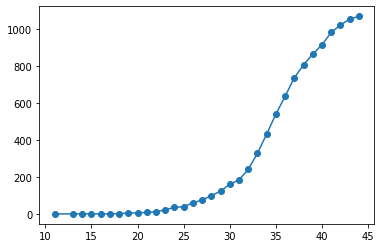

In [2]:
raw_data = [1,1,1,1,1,1,3,5,7,9,12,24,36,40,61,76,100,124,161,185,241,329,432,540,636,736,806,864,914,981,1021,1052,1068]
raw_time = [11,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44]

start = 0
clip = None

data = raw_data[start:clip]
time = raw_time[start:clip]

def system_2(t, y, p):
    return [
        -p[1]*y[0]*y[2]/sum(y),
        p[1]*y[0]*y[2]/sum(y) - p[2]*y[1],
        p[2]*y[1] - p[0]*y[2],
        p[0]*y[2],
        p[2]*y[1]
    ]
plt.plot(time, data, 'o-')

In [3]:
# data_pd = np.array(list(zip(*data)))
data_pd = np.array([[i] for i in data])
p0 = [7./8, 15, 7./8]
model_form = {
        "state": 5,
        "parameters": 3
    }
config = {
    "grid_size": 100,
    "basis_number": 24,
    "model_form": model_form,
    "time_span": [time[0], time[-1]],
    "knot_function": None,
    "model": system_2,
    "dataset": {"y": data_pd, "t": np.array(time)},
    "observation_vector": [-1],
    "weightings":[
        [1]*model_form['state'],
        [1]*len(time)
    ],
    "regularisation_value": copy(p0),
}

In [4]:
model = modeller.Model(config)
config['regularisation_value'][1] = model.ps[1]
objective = fitter.Objective()
objective.make(config, config['dataset'], model)

solver_setup = {
    'f': objective.objective,
    'x': ca.vcat(objective.input_list),
    'p': ca.hcat([objective.rho, objective.alpha]),
    'g': ca.vcat(model.xs),
}
solver_opts = {'ipopt': {'dual_inf_tol': 1e-1}}
solver = ca.nlpsol('solver', 'ipopt', solver_setup, solver_opts)

In [5]:
f1_ex = ca.Function('f1_ex', [solver_setup['x']], [objective.obj_1])
f2_ex = ca.Function('f2_ex', [solver_setup['x']], [objective.obj_2])

In [6]:
getx = ca.Function('getx', [solver_setup['x']], model.xs)

In [7]:
c0 = [np.ones(config['basis_number']) for _ in range(5)]
x0 = np.hstack([*c0, p0])
lbx = [-np.inf]*(config['basis_number']*model_form['state']) + [0]*model_form['parameters']
alpha = 1e-1

In [8]:
pure_solve = solver(x0=x0, p=[0, 0], lbx=lbx, lbg=0)


******************************************************************************
This program contains Ipopt, a library for large-scale nonlinear optimization.
 Ipopt is released as open source code under the Eclipse Public License (EPL).
         For more information visit http://projects.coin-or.org/Ipopt
******************************************************************************

This is Ipopt version 3.12.3, running with linear solver mumps.
NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:    12000
Number of nonzeros in Lagrangian Hessian.............:     7577

Total number of variables............................:      123
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equa

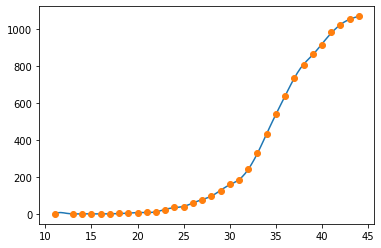

In [9]:
pure_xs = getx(pure_solve['x'])
plt.plot(model.observation_times, pure_xs[-1])
plt.plot(time, data, 'o')

In [10]:
prange = np.logspace(-6, 0, num=50)
solutions = []
xguess = x0
for p in prange:
    solve_opts = {
        'x0': xguess,
        'p': [p, alpha],
        'lbx': lbx,
        'lbg': 0,
    }
    solutions.append(solver(**solve_opts))
    xguess = np.array(solutions[-1]['x']).flatten()

This is Ipopt version 3.12.3, running with linear solver mumps.
NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:    12000
Number of nonzeros in Lagrangian Hessian.............:     7577

Total number of variables............................:      123
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      500
        inequality constraints with only lower bounds:      500
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  

   3  4.4611360e+00 0.00e+00 2.78e-02  -1.0 1.98e+01    -  5.62e-01 1.00e+00f  1
   4  4.5870602e+00 0.00e+00 9.59e-03  -1.0 3.14e+01    -  7.40e-01 1.00e+00f  1
   5  4.6940225e+00 0.00e+00 8.41e-02  -1.0 1.02e+02    -  4.14e-01 1.00e+00f  1
   6  5.0320470e+00 0.00e+00 2.37e-01  -1.0 1.69e+02    -  7.48e-01 1.00e+00f  1
   7  4.3645692e+00 0.00e+00 1.53e-01  -1.7 2.07e+02    -  5.74e-01 5.74e-01f  1
   8  4.0241530e+00 0.00e+00 5.08e-02  -2.5 8.08e+01    -  5.14e-01 1.00e+00f  1
   9  3.9964907e+00 0.00e+00 4.81e-02  -2.5 1.87e+02    -  9.43e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  3.9811177e+00 0.00e+00 1.13e-04  -2.5 1.13e+00  -4.0 1.00e+00 1.00e+00f  1
  11  3.9628231e+00 0.00e+00 2.88e-03  -3.8 5.48e+02    -  8.28e-01 1.00e+00f  1
  12  3.8999033e+00 0.00e+00 6.78e-02  -3.8 2.71e+03    -  3.85e-01 6.06e-01f  1
  13  3.8925905e+00 0.00e+00 5.99e-02  -3.8 5.52e+03    -  1.17e-01 1.04e-01f  1
  14  3.8903688e+00 0.00e+00

  28  4.0152081e+00 0.00e+00 4.00e-04  -8.6 6.48e+01  -9.7 1.00e+00 1.00e+00f  1
  29  4.0150604e+00 0.00e+00 1.60e-03  -8.6 1.74e+02 -10.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  30  4.0146086e+00 0.00e+00 1.45e-02  -8.6 5.37e+02 -10.7 1.00e+00 1.00e+00f  1
  31  4.0132920e+00 0.00e+00 1.56e-01  -8.6 1.64e+03 -11.2 1.00e+00 1.00e+00f  1
  32  4.0119615e+00 0.00e+00 1.23e-01  -8.6 5.48e+03 -11.6 8.94e-01 3.20e-01f  1
  33  4.0104244e+00 0.00e+00 2.13e-01  -8.6 1.60e+03 -11.2 1.00e+00 1.00e+00f  1
  34  4.0091993e+00 0.00e+00 4.14e-02  -8.6 8.18e+02 -10.8 1.00e+00 1.00e+00f  1
  35  4.0075931e+00 0.00e+00 3.70e-01  -8.6 1.07e+04 -11.3 3.32e-01 1.70e-01f  1
  36  4.0035205e+00 0.00e+00 1.27e-01  -8.6 1.38e+03 -10.8 1.00e+00 1.00e+00f  1
  37  4.0002703e+00 0.00e+00 7.42e-01  -8.6 1.97e+03 -10.4 5.09e-01 4.98e-01f  1
  38  3.9917385e+00 0.00e+00 1.03e-01  -8.6 4.16e+02 -10.0 1.00e+00 1.00e+00f  1
  39  3.9888851e+00 0.00e+00

   4  4.9236221e+00 0.00e+00 1.88e-01  -1.0 1.89e+02    -  7.10e-01 1.00e+00f  1
   5  4.7522667e+00 0.00e+00 1.51e-01  -1.0 1.32e+03    -  3.82e-01 2.66e-01f  1
   6  5.6276325e+00 0.00e+00 1.23e+00  -1.0 1.38e+03    -  5.11e-01 6.02e-01f  1
   7  4.8126628e+00 0.00e+00 5.82e-03  -1.0 1.89e+00  -4.0 9.98e-01 1.00e+00f  1
   8  4.0909140e+00 0.00e+00 1.35e-02  -2.5 1.94e+03    -  9.90e-01 1.00e+00f  1
   9  3.9560496e+00 0.00e+00 5.01e-02  -3.8 3.93e+02    -  8.15e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  3.9451869e+00 0.00e+00 1.27e-04  -3.8 3.81e+00  -4.5 1.00e+00 1.00e+00f  1
  11  3.9437522e+00 0.00e+00 4.45e-05  -3.8 4.00e+00  -5.0 1.00e+00 1.00e+00f  1
  12  3.9432305e+00 0.00e+00 4.22e-04  -5.7 5.96e+00  -5.4 6.64e-01 1.00e+00f  1
  13  3.9426972e+00 0.00e+00 3.44e-05  -5.7 8.35e+00  -5.9 7.83e-01 1.00e+00f  1
  14  3.9421608e+00 0.00e+00 2.65e-05  -5.7 7.20e+00  -6.4 1.00e+00 1.00e+00f  1
  15  3.9408999e+00 0.00e+00

   4  4.9549474e+00 0.00e+00 2.72e-01  -1.0 1.77e+02    -  7.37e-01 1.00e+00f  1
   5  4.7583849e+00 0.00e+00 2.11e-01  -1.0 1.72e+03    -  3.54e-01 2.35e-01f  1
   6  5.3519238e+00 0.00e+00 1.31e+00  -1.0 1.12e+03    -  2.80e-01 5.34e-01f  1
   7  4.8019343e+00 0.00e+00 7.52e-01  -1.0 1.33e+04    -  1.46e-01 7.94e-02f  1
   8  1.1104068e+01 0.00e+00 1.54e+01  -1.0 1.42e+04    -  1.66e-01 2.50e-01f  3
   9  5.2411668e+00 0.00e+00 8.37e-03  -1.0 1.41e+00  -4.0 9.99e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  4.2497539e+00 0.00e+00 1.43e-01  -2.5 1.45e+03    -  8.31e-01 1.00e+00f  1
  11  4.0538306e+00 0.00e+00 1.29e-01  -2.5 2.59e+03    -  7.62e-01 1.00e+00f  1
  12  4.0375005e+00 0.00e+00 1.22e+00  -2.5 7.34e+03    -  8.51e-01 7.86e-01f  1
  13  4.1032548e+00 0.00e+00 5.10e+00  -2.5 1.21e+04    -  1.14e-01 4.86e-01f  1
  14  4.0347740e+00 0.00e+00 1.64e-04  -2.5 8.02e-01  -4.5 1.00e+00 1.00e+00f  1
  15  4.0201638e+00 0.00e+00

 106  3.8729581e+00 0.00e+00 2.84e-01  -8.6 1.25e+05    -  1.12e-01 2.21e-02f  3
 107  3.8725742e+00 0.00e+00 1.52e-03  -8.6 3.31e+01  -9.3 1.00e+00 1.00e+00f  1
 108  3.8725372e+00 0.00e+00 3.75e-03  -8.6 1.53e+02  -9.8 1.00e+00 1.00e+00h  1
 109  3.8722777e+00 0.00e+00 1.97e-01  -8.6 4.08e+04    -  2.69e-01 6.50e-02f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  3.8722768e+00 0.00e+00 1.96e-01  -8.6 5.67e+01  -9.4 1.00e+00 1.47e-03h  1
 111  3.8719782e+00 0.00e+00 2.36e-03  -8.6 2.73e+02  -9.9 1.00e+00 1.00e+00f  1
 112  3.8717653e+00 0.00e+00 1.36e-01  -8.6 3.87e+05    -  2.22e-02 5.38e-03f  3
 113  3.8717646e+00 0.00e+00 1.36e-01  -8.6 3.44e+01  -9.4 1.00e+00 1.70e-03h  1
 114  3.8715516e+00 0.00e+00 2.38e-03  -8.6 1.81e+02  -9.9 1.00e+00 1.00e+00f  1
 115  3.8713203e+00 0.00e+00 8.30e-02  -8.6 2.31e+04    -  2.91e-01 9.16e-02f  3
 116  3.8713193e+00 0.00e+00 8.27e-02  -8.6 1.05e+03 -10.4 1.00e+00 3.15e-03h  1
 117  3.8711892e+00 0.00e+00

  31  4.0182647e+00 0.00e+00 4.06e-02  -8.6 8.85e+02 -10.7 1.00e+00 1.00e+00f  1
  32  4.0170962e+00 0.00e+00 1.77e-01  -8.6 2.27e+03 -11.2 1.00e+00 3.66e-01f  1
  33  4.0163632e+00 0.00e+00 6.80e-01  -8.6 5.41e+03 -11.6 1.00e+00 4.31e-01f  2
  34  4.0137880e+00 0.00e+00 9.68e-01  -8.6 1.59e+03 -11.2 1.00e+00 7.64e-01f  1
  35  4.0130181e+00 0.00e+00 2.54e-02  -8.6 2.05e+02  -9.9 1.00e+00 1.00e+00f  1
  36  4.0113792e+00 0.00e+00 7.80e-01  -8.6 1.06e+03 -10.4 1.00e+00 1.00e+00f  1
  37  4.0077589e+00 0.00e+00 1.06e+00  -8.6 1.83e+03 -10.8 1.00e+00 1.00e+00f  1
  38  4.0025605e+00 0.00e+00 1.27e+00  -8.6 4.71e+02  -9.5 1.00e+00 1.00e+00f  1
  39  3.9910723e+00 0.00e+00 1.20e+00  -8.6 2.29e+02 -10.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  40  3.9801488e+00 0.00e+00 2.46e+00  -8.6 3.78e+02 -10.5 6.77e-01 5.65e-01f  1
  41  3.9647344e+00 0.00e+00 9.23e-02  -8.6 1.12e+03 -10.0 5.34e-07 3.95e-01f  2
  42  3.9587489e+00 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 130  3.8683140e+00 0.00e+00 6.44e-03  -8.6 3.02e+02  -8.9 6.43e-01 3.14e-01f  2
 131  3.8669287e+00 0.00e+00 1.40e-03  -8.6 2.25e+02  -9.4 5.95e-01 9.48e-01f  1
 132  3.8666185e+00 0.00e+00 2.81e-04  -8.6 1.21e+02  -9.8 5.08e-01 1.00e+00f  1
 133  3.8665739e+00 0.00e+00 3.60e-05  -8.6 5.12e+01 -10.3 1.00e+00 1.00e+00f  1
 134  3.8665721e+00 0.00e+00 2.59e-05  -8.6 8.09e+00 -10.8 1.00e+00 2.82e-01h  1
 135  3.8665715e+00 0.00e+00 2.53e-07  -8.6 6.10e+00 -11.3 1.00e+00 1.00e+00f  1
 136  3.8665709e+00 0.00e+00 4.08e-08  -8.6 8.64e-01 -11.8 1.00e+00 9.19e-01h  1
 137  3.8665709e+00 0.00e+00 3.58e-10  -8.6 8.56e-01 -12.2 1.00e+00 1.00e+00f  1

Number of Iterations....: 137

                                   (scaled)                 (unscaled)
Objective...............:   3.8665709168086160e+00    3.8665709168086160e+00
Dual infeasibility......:   3.5836190848033110e-10    3.5836190848033110e-10
Constraint vio

  65  3.9127694e+00 0.00e+00 1.02e+00  -8.6 9.11e+02 -11.1 1.00e+00 1.00e+00f  1
  66  3.9105865e+00 0.00e+00 1.06e+00  -8.6 2.64e+03 -11.6 1.00e+00 9.16e-01f  1
  67  3.9085869e+00 0.00e+00 1.78e+00  -8.6 1.16e+03 -10.3 1.40e-03 1.00e+00f  1
  68  3.9071412e+00 0.00e+00 1.11e+00  -8.6 6.61e+02 -10.7 1.00e+00 3.94e-01f  1
  69  3.9046491e+00 0.00e+00 1.36e-01  -8.6 1.43e+03 -11.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  70  3.9034829e+00 0.00e+00 1.87e+00  -8.6 1.16e+03 -11.7 1.00e+00 1.00e+00f  1
  71  3.9029399e+00 0.00e+00 1.71e+00  -8.6 1.75e+03 -11.3 1.00e+00 8.67e-02f  1
  72  3.8999454e+00 0.00e+00 1.90e-01  -8.6 6.61e+02 -10.9 1.00e+00 9.44e-01f  1
  73  3.8999137e+00 0.00e+00 1.94e+00  -8.6 2.35e+03 -11.3 1.00e+00 5.00e-01f  2
  74  3.8957074e+00 0.00e+00 3.36e-03  -8.6 6.32e+02 -10.9 1.00e+00 1.00e+00f  1
  75  3.8943634e+00 0.00e+00 6.71e-01  -8.6 6.55e+03 -11.4 1.30e-01 1.07e-01f  3
  76  3.8939311e+00 0.00e+00

   0  3.8672251e+00 0.00e+00 1.00e+00  -1.0 0.00e+00    -  0.00e+00 0.00e+00   0
   1  3.8724350e+00 0.00e+00 1.11e-02  -1.0 1.82e-01    -  9.89e-01 1.00e+00f  1
   2  5.3560641e+00 0.00e+00 2.88e-02  -1.0 6.68e+01    -  7.69e-01 1.00e+00f  1
   3  4.6414683e+00 0.00e+00 1.17e-01  -1.0 2.10e+02    -  2.87e-01 1.00e+00f  1
   4  4.8234258e+00 0.00e+00 2.54e-01  -1.0 2.01e+02    -  7.42e-01 1.00e+00f  1
   5  4.8035274e+00 0.00e+00 5.71e-01  -1.0 6.65e+02    -  3.98e-01 3.72e-01f  1
   6  5.2203737e+00 0.00e+00 2.52e+00  -1.0 6.90e+02    -  2.32e-01 6.40e-01f  1
   7  4.8144832e+00 0.00e+00 1.03e+00  -1.0 2.37e+03    -  6.08e-01 2.82e-01f  1
   8  4.9588464e+00 0.00e+00 4.97e+00  -1.0 1.70e+04    -  1.57e-02 7.80e-02f  1
   9  5.0408805e+00 0.00e+00 4.29e+00  -1.0 1.44e+04    -  4.28e-02 1.09e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  6.1604713e+00 0.00e+00 1.78e+01  -1.0 2.87e+04    -  1.28e-01 1.25e-01f  4
  11  5.2718573e+00 0.00e+00

  98  4.0122884e+00 0.00e+00 3.38e+00  -5.7 4.97e+03 -12.8 1.00e+00 2.50e-01f  3
  99  4.0121592e+00 0.00e+00 4.91e+00  -5.7 5.55e+04 -13.3 1.00e+00 1.05e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  4.0119181e+00 0.00e+00 6.86e+00  -5.7 1.95e+03 -11.9 1.00e+00 1.00e+00f  1
 101  4.0116117e+00 0.00e+00 2.14e-01  -5.7 1.49e+03 -12.4 1.00e+00 1.00e+00f  1
 102  4.0114560e+00 0.00e+00 3.49e+00  -5.7 5.26e+03 -12.9 1.00e+00 2.50e-01f  3
 103  4.0112116e+00 0.00e+00 1.39e+00  -5.7 1.39e+03 -12.5 1.00e+00 1.00e+00f  1
 104  4.0111204e+00 0.00e+00 5.79e+00  -5.7 3.21e+03 -12.9 1.00e+00 1.00e+00f  1
 105  4.0106287e+00 0.00e+00 9.83e-02  -5.7 1.12e+03 -12.5 1.00e+00 1.00e+00f  1
 106  4.0104644e+00 0.00e+00 3.81e+00  -5.7 1.12e+04 -13.0 1.00e+00 1.25e-01f  4
 107  4.0101796e+00 0.00e+00 8.97e-01  -5.7 1.91e+03 -12.6 1.00e+00 1.00e+00f  1
 108  4.0101045e+00 0.00e+00 7.24e+00  -5.7 2.75e+03 -13.0 1.00e+00 1.00e+00f  1
 109  4.0095468e+00 0.00e+00

 191  3.9847498e+00 0.00e+00 4.24e-01  -5.7 4.67e+02 -12.0 1.00e+00 1.00e+00f  1
 192  3.9845718e+00 0.00e+00 2.69e+00  -5.7 4.44e+03 -12.5 1.00e+00 2.50e-01f  3
 193  3.9844457e+00 0.00e+00 1.25e+00  -5.7 8.15e+03 -13.0 1.00e+00 2.64e-01f  2
 194  3.9842407e+00 0.00e+00 3.78e+00  -5.7 1.40e+03 -12.5 1.00e+00 1.00e+00f  1
 195  3.9839743e+00 0.00e+00 4.89e-01  -5.7 5.61e+02 -12.1 1.00e+00 1.00e+00f  1
 196  3.9838984e+00 0.00e+00 4.28e+00  -5.7 2.87e+03 -12.6 1.00e+00 5.00e-01f  2
 197  3.9836574e+00 0.00e+00 1.80e-01  -5.7 2.97e+02 -11.3 1.00e+00 1.00e+00f  1
 198  3.9835416e+00 0.00e+00 1.79e+00  -5.7 1.85e+03 -11.7 1.00e+00 5.00e-01f  2
 199  3.9833976e+00 0.00e+00 1.41e+00  -5.7 8.32e+02 -12.2 9.81e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  3.9832822e+00 0.00e+00 1.41e+00  -5.7 1.03e+03 -11.8 1.00e+00 1.00e+00f  1
 201  3.9831732e+00 0.00e+00 2.48e+00  -5.7 1.17e+03 -12.3 8.61e-01 1.00e+00f  1
 202  3.9830473e+00 0.00e+00

 289  3.8993331e+00 0.00e+00 2.86e-02  -5.7 1.33e+02  -9.1 6.24e-01 7.52e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 290  3.8989688e+00 0.00e+00 1.35e-03  -5.7 1.10e+02  -9.6 1.00e+00 1.00e+00f  1
 291  3.8987533e+00 0.00e+00 2.17e-02  -5.7 1.43e+02 -10.1 1.00e+00 1.00e+00f  1
 292  3.8985931e+00 0.00e+00 2.59e-01  -5.7 3.78e+02 -10.5 1.00e+00 1.00e+00f  1
 293  3.8984314e+00 0.00e+00 2.47e+00  -5.7 3.47e+05    -  2.44e-01 1.85e-02f  5
 294  3.8980816e+00 0.00e+00 2.60e-01  -5.7 2.76e+02 -10.1 1.00e+00 8.57e-01f  1
 295  3.8979179e+00 0.00e+00 4.88e-01  -5.7 5.21e+02 -10.6 1.00e+00 1.00e+00f  1
 296  3.8977344e+00 0.00e+00 5.59e-01  -5.7 5.78e+02 -11.1 1.00e+00 1.00e+00f  1
 297  3.8974791e+00 0.00e+00 8.97e-01  -5.7 2.26e+03 -11.5 1.00e+00 1.00e+00f  1
 298  3.8973239e+00 0.00e+00 4.84e-01  -5.7 5.22e+02 -11.1 1.00e+00 1.00e+00f  1
 299  3.8969788e+00 0.00e+00 2.10e-02  -5.7 3.47e+03 -11.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

  15  4.1702014e+00 0.00e+00 2.63e+00  -1.7 1.16e+00  -4.5 4.67e-01 1.00e+00f  1
  16  4.3040246e+00 0.00e+00 3.78e+01  -1.7 1.90e+04    -  5.98e-01 8.15e-01f  1
  17  4.2039346e+00 0.00e+00 1.07e+01  -1.7 4.53e+04    -  2.31e-02 1.92e-01f  1
  18  5.0499022e+00 0.00e+00 2.03e+02  -1.7 3.75e+04    -  7.33e-01 6.04e-01f  1
  19  4.1397993e+00 0.00e+00 8.04e+00  -1.7 1.36e+00  -5.0 2.39e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  20  4.2015795e+00 0.00e+00 1.10e+02  -1.7 4.17e+04    -  8.66e-01 5.14e-01f  1
  21  4.2554130e+00 0.00e+00 6.00e+01  -1.7 1.33e+06    -  7.97e-03 1.38e-02f  3
  22  4.2337815e+00 0.00e+00 1.56e-03  -1.7 7.90e+00  -5.4 1.00e+00 1.00e+00f  1
  23  4.3156784e+00 0.00e+00 3.54e+02  -1.7 2.72e+04    -  1.00e+00 8.99e-01f  1
  24  4.1697202e+00 0.00e+00 1.05e+02  -1.7 9.59e+00  -5.9 4.96e-01 1.00e+00f  1
  25  4.2282953e+00 0.00e+00 1.53e+02  -1.7 5.18e+04    -  1.00e+00 5.00e-01f  2
  26  4.1654440e+00 0.00e+00

 119  4.0147843e+00 0.00e+00 1.52e+00  -5.7 5.28e+03 -12.8 1.00e+00 5.27e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 120  4.0146569e+00 0.00e+00 5.64e+00  -5.7 6.18e+03 -13.3 9.36e-01 5.00e-01f  2
 121  4.0146389e+00 0.00e+00 2.35e+00  -5.7 5.55e+03 -11.9 1.00e+00 3.73e-01f  2
 122  4.0144404e+00 0.00e+00 2.61e+00  -5.7 1.00e+03 -12.4 1.00e+00 1.00e+00f  1
 123  4.0142773e+00 0.00e+00 5.32e+00  -5.7 3.81e+03 -12.9 1.00e+00 9.78e-01f  1
 124  4.0141321e+00 0.00e+00 5.16e+00  -5.7 8.92e+03 -12.5 3.41e-01 2.50e-01f  3
 125  4.0139548e+00 0.00e+00 2.57e+00  -5.7 3.91e+03 -12.0 1.00e+00 1.00e+00f  1
 126  4.0138267e+00 0.00e+00 4.50e-01  -5.7 9.55e+02 -11.6 1.00e+00 5.78e-01f  1
 127  4.0136572e+00 0.00e+00 1.90e+00  -5.7 2.08e+03 -12.1 1.00e+00 5.00e-01f  2
 128  4.0134155e+00 0.00e+00 1.75e+00  -5.7 2.35e+03 -12.6 1.00e+00 1.00e+00f  1
 129  4.0132383e+00 0.00e+00 3.31e+00  -5.7 2.79e+03 -13.0 8.09e-01 5.00e-01f  2
iter    objective    inf_pr 

 215  3.9926584e+00 0.00e+00 6.96e+00  -5.7 4.72e+03 -11.6 1.00e+00 6.05e-03f  2
 216  3.9922171e+00 0.00e+00 3.06e-01  -5.7 9.27e+02 -12.1 1.00e+00 1.00e+00f  1
 217  3.9920198e+00 0.00e+00 3.19e+00  -5.7 4.27e+03 -12.6 1.00e+00 2.50e-01f  3
 218  3.9918437e+00 0.00e+00 7.78e-01  -5.7 1.45e+04 -13.1 1.00e+00 2.11e-01f  1
 219  3.9916326e+00 0.00e+00 3.27e+00  -5.7 2.49e+03 -12.6 8.41e-01 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 220  3.9916234e+00 0.00e+00 4.17e-01  -5.7 4.77e+03 -11.3 1.00e+00 5.00e-01f  2
 221  3.9914454e+00 0.00e+00 5.22e+00  -5.7 1.42e+03 -11.8 1.00e+00 1.00e+00f  1
 222  3.9913053e+00 0.00e+00 2.59e+00  -5.7 9.49e+04 -12.3 1.00e+00 2.88e-02f  1
 223  3.9909571e+00 0.00e+00 6.94e-01  -5.7 1.54e+03 -12.7 1.00e+00 1.00e+00f  1
 224  3.9907981e+00 0.00e+00 2.51e+00  -5.7 2.49e+03 -12.3 1.00e+00 3.60e-01f  2
 225  3.9905419e+00 0.00e+00 4.35e-01  -5.7 2.26e+03 -12.8 1.00e+00 1.00e+00f  1
 226  3.9903774e+00 0.00e+00

 313  3.9815255e+00 0.00e+00 3.74e+00  -5.7 4.82e+03 -11.8 4.70e-01 1.00e+00f  1
 314  3.9811380e+00 0.00e+00 8.92e-01  -5.7 6.26e+02 -10.5 1.00e+00 1.00e+00f  1
 315  3.9810575e+00 0.00e+00 9.98e-02  -5.7 4.82e+02 -10.9 1.00e+00 1.00e+00f  1
 316  3.9809478e+00 0.00e+00 1.74e+00  -5.7 1.45e+03 -11.4 1.00e+00 1.00e+00f  1
 317  3.9808174e+00 0.00e+00 2.89e-01  -5.7 1.03e+03 -11.0 1.00e+00 1.00e+00f  1
 318  3.9807447e+00 0.00e+00 1.95e+00  -5.7 2.35e+03 -11.5 1.00e+00 5.00e-01f  2
 319  3.9805735e+00 0.00e+00 8.54e-01  -5.7 1.61e+03 -11.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 320  3.9805045e+00 0.00e+00 2.16e-01  -5.7 3.17e+02 -10.6 1.00e+00 1.00e+00f  1
 321  3.9804144e+00 0.00e+00 4.37e-01  -5.7 7.13e+02 -11.1 1.00e+00 1.00e+00f  1
 322  3.9801872e+00 0.00e+00 5.12e-01  -5.7 2.83e+03 -11.6 1.00e+00 1.00e+00f  1
 323  3.9800853e+00 0.00e+00 8.76e-01  -5.7 1.47e+03 -11.1 1.00e+00 5.00e-01f  2
 324  3.9799906e+00 0.00e+00

 414  3.9652852e+00 0.00e+00 1.50e-01  -5.7 1.98e+03 -10.3 1.00e+00 2.50e-01f  3
 415  3.9648482e+00 0.00e+00 9.12e-02  -5.7 1.70e+03 -10.8 1.00e+00 1.00e+00f  1
 416  3.9646731e+00 0.00e+00 3.08e-01  -5.7 1.70e+04 -10.4 3.49e-01 4.89e-02f  5
 417  3.9644181e+00 0.00e+00 5.85e-02  -5.7 1.58e+02  -9.9 1.00e+00 1.00e+00f  1
 418  3.9641848e+00 0.00e+00 2.50e-01  -5.7 7.41e+02 -10.4 1.00e+00 1.00e+00f  1
 419  3.9640214e+00 0.00e+00 9.36e-03  -5.7 3.15e+02 -10.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 420  3.9638761e+00 0.00e+00 4.33e-01  -5.7 9.89e+02 -10.5 1.00e+00 1.00e+00f  1
 421  3.9635551e+00 0.00e+00 8.58e-02  -5.7 1.57e+03 -10.0 1.00e+00 5.00e-01f  2
 422  3.9633582e+00 0.00e+00 2.92e-01  -5.7 2.42e+03 -10.5 1.00e+00 2.50e-01f  3
 423  3.9631070e+00 0.00e+00 1.03e-01  -5.7 2.95e+02 -10.1 1.00e+00 1.00e+00f  1
 424  3.9630178e+00 0.00e+00 2.92e-01  -5.7 1.82e+03 -10.6 1.00e+00 5.00e-01f  2
 425  3.9627756e+00 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 510  3.9563565e+00 0.00e+00 1.46e-01  -5.7 3.09e+02 -10.1 1.00e+00 2.50e-01f  3
 511  3.9563085e+00 0.00e+00 7.39e-03  -5.7 1.83e+01  -8.7 1.00e+00 1.00e+00f  1
 512  3.9562923e+00 0.00e+00 2.10e-04  -5.7 1.68e+01  -9.2 1.00e+00 1.00e+00h  1
 513  3.9562511e+00 0.00e+00 2.42e-02  -5.7 5.04e+01  -9.7 1.00e+00 1.00e+00h  1
 514  3.9562440e+00 0.00e+00 1.26e-01  -5.7 3.51e+02 -10.2 1.00e+00 1.00e+00f  1
 515  3.9561505e+00 0.00e+00 7.45e-04  -5.7 3.02e+00  -7.9 1.00e+00 1.00e+00f  1
 516  3.9561473e+00 0.00e+00 8.31e-05  -5.7 4.09e+00  -8.4 1.00e+00 1.00e+00h  1
 517  3.9561393e+00 0.00e+00 6.25e-04  -5.7 9.37e+00  -8.9 1.00e+00 1.00e+00h  1
 518  3.9561169e+00 0.00e+00 6.80e-03  -5.7 2.38e+01  -9.4 1.00e+00 1.00e+00h  1
 519  3.9560659e+00 0.00e+00 3.14e-02  -5.7 6.63e+01  -9.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 520  3.9560397e+00 0.00e+00

 603  3.9517404e+00 0.00e+00 8.02e-05  -8.6 9.06e+01 -10.2 1.00e+00 1.00e+00h  1
 604  3.9516324e+00 0.00e+00 3.72e-03  -8.6 2.56e+02 -10.7 1.00e+00 1.00e+00f  1
 605  3.9514868e+00 0.00e+00 7.12e-02  -8.6 8.18e+02 -11.1 1.00e+00 1.00e+00f  1
 606  3.9514191e+00 0.00e+00 2.40e-01  -8.6 1.71e+01  -8.0 1.00e+00 1.00e+00f  1
 607  3.9513818e+00 0.00e+00 3.65e-02  -8.6 5.04e+00  -8.5 1.00e+00 1.00e+00h  1
 608  3.9513744e+00 0.00e+00 3.89e-02  -8.6 6.98e+00  -9.0 1.00e+00 1.00e+00h  1
 609  3.9513687e+00 0.00e+00 2.22e-03  -8.6 1.52e+01  -9.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 610  3.9513544e+00 0.00e+00 4.61e-04  -8.6 4.12e+01  -9.9 1.00e+00 1.00e+00h  1
 611  3.9513143e+00 0.00e+00 1.50e-03  -8.6 1.16e+02 -10.4 1.00e+00 1.00e+00h  1
 612  3.9512128e+00 0.00e+00 6.25e-03  -8.6 3.11e+02 -10.9 1.00e+00 1.00e+00f  1
 613  3.9511901e+00 0.00e+00 8.02e-02  -8.6 1.34e+02 -10.4 1.00e+00 1.00e+00h  1
 614  3.9511726e+00 0.00e+00

   6  6.7899586e+00 0.00e+00 6.55e+00  -1.0 9.84e+02    -  1.96e-01 1.00e+00f  1
   7  4.8589055e+00 0.00e+00 5.45e-02  -1.0 2.05e+00  -4.0 9.92e-01 1.00e+00f  1
   8  4.2243100e+00 0.00e+00 4.56e-01  -1.7 6.58e+03    -  9.76e-01 1.00e+00f  1
   9  4.4510090e+00 0.00e+00 8.62e+00  -1.7 6.10e+04    -  2.93e-01 1.62e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  4.8023116e+00 0.00e+00 2.46e+01  -1.7 5.60e+04    -  3.62e-02 3.84e-01f  1
  11  4.2540703e+00 0.00e+00 3.21e-03  -1.7 3.35e+00  -4.5 1.00e+00 1.00e+00f  1
  12  4.5895801e+00 0.00e+00 2.57e+01  -1.7 6.50e+04    -  7.52e-01 5.87e-01f  1
  13  4.2936487e+00 0.00e+00 8.95e+00  -1.7 4.08e+00  -5.0 2.68e-01 1.00e+00f  1
  14  4.1655197e+00 0.00e+00 4.37e-03  -1.7 5.01e+00  -5.4 1.00e+00 1.00e+00f  1
  15  4.0496600e+00 0.00e+00 1.64e+00  -2.5 1.69e+03    -  9.31e-01 1.00e+00f  1
  16  4.1337829e+00 0.00e+00 2.33e+01  -2.5 7.08e+04    -  4.99e-02 6.68e-02f  4
  17  4.0507493e+00 0.00e+00

 105  3.9711988e+00 0.00e+00 4.74e-01  -5.7 4.45e+02 -10.3 1.00e+00 1.00e+00f  1
 106  3.9710045e+00 0.00e+00 1.87e-02  -5.7 2.47e+02  -9.9 1.00e+00 1.00e+00f  1
 107  3.9708288e+00 0.00e+00 3.88e-01  -5.7 6.87e+02 -10.4 1.00e+00 1.00e+00f  1
 108  3.9706306e+00 0.00e+00 3.13e-02  -5.7 3.66e+02 -10.0 1.00e+00 1.00e+00f  1
 109  3.9704567e+00 0.00e+00 1.74e-01  -5.7 9.54e+02 -10.4 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  3.9703227e+00 0.00e+00 1.16e-02  -5.7 3.36e+02 -10.0 1.00e+00 1.00e+00f  1
 111  3.9701629e+00 0.00e+00 4.63e-01  -5.7 1.01e+03 -10.5 1.00e+00 1.00e+00f  1
 112  3.9698898e+00 0.00e+00 1.03e-01  -5.7 2.90e+03 -10.1 7.64e-01 2.50e-01f  3
 113  3.9697420e+00 0.00e+00 3.91e-01  -5.7 9.75e+02 -10.5 1.00e+00 1.00e+00f  1
 114  3.9693998e+00 0.00e+00 8.07e-03  -5.7 5.01e+01  -9.2 1.00e+00 1.00e+00f  1
 115  3.9693015e+00 0.00e+00 6.28e-02  -5.7 1.53e+02  -9.7 1.00e+00 1.00e+00f  1
 116  3.9691173e+00 0.00e+00

 202  3.9586983e+00 0.00e+00 2.01e-04  -5.7 1.45e+01  -8.8 1.00e+00 1.00e+00f  1
 203  3.9586003e+00 0.00e+00 4.01e-02  -5.7 5.31e+01  -9.2 1.00e+00 1.00e+00f  1
 204  3.9583877e+00 0.00e+00 2.33e-03  -5.7 9.93e+01  -9.7 1.00e+00 1.00e+00f  1
 205  3.9581681e+00 0.00e+00 5.22e-02  -5.7 3.04e+02 -10.2 1.00e+00 5.00e-01f  2
 206  3.9580340e+00 0.00e+00 7.60e-03  -5.7 2.20e+01  -8.9 1.00e+00 1.00e+00f  1
 207  3.9579451e+00 0.00e+00 7.59e-02  -5.7 6.13e+01  -9.3 1.00e+00 1.00e+00f  1
 208  3.9578419e+00 0.00e+00 8.24e-05  -5.7 2.04e+01  -8.9 1.00e+00 1.00e+00f  1
 209  3.9577254e+00 0.00e+00 4.72e-02  -5.7 6.77e+01  -9.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 210  3.9576472e+00 0.00e+00 9.45e-05  -5.7 2.35e+01  -9.0 1.00e+00 1.00e+00f  1
 211  3.9575169e+00 0.00e+00 3.89e-02  -5.7 7.54e+01  -9.4 1.00e+00 1.00e+00f  1
 212  3.9574402e+00 0.00e+00 1.47e-04  -5.7 2.63e+01  -9.0 1.00e+00 1.00e+00f  1
 213  3.9572997e+00 0.00e+00

 297  3.9059113e+00 0.00e+00 2.18e-01  -5.7 1.79e+02 -10.7 3.58e-01 1.00e+00f  1
 298  3.8770928e+00 0.00e+00 3.29e-02  -5.7 2.59e+01  -6.7 1.00e+00 1.00e+00f  1
 299  3.8697627e+00 0.00e+00 3.86e-03  -5.7 8.66e+01  -7.2 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  3.8689275e+00 0.00e+00 7.60e-04  -5.7 1.40e+01  -7.7 1.00e+00 1.00e+00f  1
 301  3.8688249e+00 0.00e+00 1.31e-05  -5.7 1.98e+01  -8.1 1.00e+00 1.00e+00f  1
 302  3.8684520e+00 0.00e+00 1.74e-03  -8.6 3.04e+04    -  8.87e-01 7.05e-01f  1
 303  3.8683972e+00 0.00e+00 2.21e-05  -8.6 9.01e+00  -8.6 1.00e+00 1.00e+00f  1
 304  3.8683769e+00 0.00e+00 1.86e-06  -8.6 1.35e+01  -9.1 1.00e+00 1.00e+00h  1
 305  3.8683677e+00 0.00e+00 3.09e-07  -8.6 1.21e+01  -9.6 1.00e+00 1.00e+00h  1
 306  3.8683667e+00 0.00e+00 5.75e-08  -8.6 4.90e+00 -10.0 1.00e+00 1.00e+00h  1
 307  3.8683666e+00 0.00e+00 1.04e-09  -8.6 8.58e-01 -10.5 1.00e+00 1.00e+00h  1

Number of Iterations....: 3

  57  3.9734296e+00 0.00e+00 1.33e-01  -5.7 8.44e+03 -10.5 8.26e-01 7.93e-02f  2
  58  3.9731077e+00 0.00e+00 1.79e-01  -5.7 2.27e+02 -10.1 1.00e+00 1.00e+00f  1
  59  3.9728430e+00 0.00e+00 1.04e-01  -5.7 2.58e+03 -10.6 3.66e-01 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  60  3.9725454e+00 0.00e+00 1.55e-01  -5.7 4.12e+02 -10.2 1.00e+00 1.00e+00f  1
  61  3.9723515e+00 0.00e+00 2.48e-02  -5.7 1.29e+02  -9.7 1.00e+00 1.00e+00f  1
  62  3.9722671e+00 0.00e+00 1.57e-01  -5.7 6.12e+02 -10.2 1.00e+00 1.00e+00f  1
  63  3.9720353e+00 0.00e+00 6.06e-02  -5.7 3.30e+03  -9.8 8.01e-03 1.25e-01f  4
  64  3.9718326e+00 0.00e+00 2.96e-02  -5.7 8.03e+01  -9.4 1.00e+00 1.00e+00f  1
  65  3.9716709e+00 0.00e+00 8.69e-02  -5.7 3.34e+02  -9.8 1.00e+00 1.00e+00f  1
  66  3.9715035e+00 0.00e+00 7.48e-03  -5.7 9.39e+01  -9.4 1.00e+00 1.00e+00f  1
  67  3.9713556e+00 0.00e+00 4.45e-02  -5.7 4.45e+02  -9.9 1.00e+00 6.00e-01f  1
  68  3.9710711e+00 0.00e+00

   6  6.4508996e+00 0.00e+00 3.51e+00  -1.0 6.36e+02    -  2.12e-01 1.00e+00f  1
   7  4.8347922e+00 0.00e+00 3.03e-02  -1.0 2.35e+00  -4.0 9.94e-01 1.00e+00f  1
   8  4.2294467e+00 0.00e+00 3.84e-01  -1.7 2.76e+03    -  9.75e-01 1.00e+00f  1
   9  4.4567256e+00 0.00e+00 9.87e+00  -1.7 2.96e+04    -  3.00e-01 1.74e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  6.1284285e+00 0.00e+00 9.63e+01  -1.7 2.84e+04    -  1.51e-02 3.82e-01f  1
  11  4.2843373e+00 0.00e+00 1.29e-02  -1.7 3.32e+00  -4.5 1.00e+00 1.00e+00f  1
  12  4.5261779e+00 0.00e+00 3.26e+01  -1.7 2.10e+04    -  6.67e-01 5.32e-01f  1
  13  4.2000841e+00 0.00e+00 3.46e+00  -1.7 4.31e+00  -5.0 5.57e-01 1.00e+00f  1
  14  4.5834115e+00 0.00e+00 2.64e+01  -1.7 2.35e+05    -  2.12e-02 5.23e-02f  2
  15  4.1965375e+00 0.00e+00 8.80e-03  -1.7 7.78e+00  -5.4 1.00e+00 1.00e+00f  1
  16  4.0497184e+00 0.00e+00 8.34e-01  -3.8 9.73e+02    -  9.47e-01 1.00e+00f  1
  17  4.0511148e+00 0.00e+00

 106  3.9862396e+00 0.00e+00 3.39e-02  -5.7 3.76e+02 -10.0 1.00e+00 1.00e+00f  1
 107  3.9862081e+00 0.00e+00 3.71e-01  -5.7 2.43e+03 -10.4 1.00e+00 2.50e-01f  3
 108  3.9859186e+00 0.00e+00 3.43e-03  -5.7 3.70e+01  -9.1 1.00e+00 1.00e+00f  1
 109  3.9858431e+00 0.00e+00 3.73e-02  -5.7 1.46e+02  -9.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  3.9856560e+00 0.00e+00 8.46e-02  -5.7 4.61e+02 -10.1 1.00e+00 1.00e+00f  1
 111  3.9855133e+00 0.00e+00 8.47e-02  -5.7 3.50e+03 -10.5 6.03e-01 1.25e-01f  4
 112  3.9854874e+00 0.00e+00 3.40e-01  -5.7 1.25e+03 -10.1 1.00e+00 5.00e-01f  2
 113  3.9851348e+00 0.00e+00 5.79e-02  -5.7 2.94e+02  -9.7 1.00e+00 1.00e+00f  1
 114  3.9851203e+00 0.00e+00 3.77e-01  -5.7 2.15e+03 -10.2 1.00e+00 2.50e-01f  3
 115  3.9847786e+00 0.00e+00 1.33e-01  -5.7 6.91e+02  -9.7 1.00e+00 5.00e-01f  2
 116  3.9845398e+00 0.00e+00 3.26e-01  -5.7 4.54e+02 -10.2 1.00e+00 1.00e+00f  1
 117  3.9843265e+00 0.00e+00

 206  3.9730350e+00 0.00e+00 1.86e-04  -5.7 5.77e+00  -8.0 1.00e+00 1.00e+00h  1
 207  3.9729902e+00 0.00e+00 5.24e-03  -5.7 1.46e+01  -8.5 1.00e+00 1.00e+00h  1
 208  3.9728728e+00 0.00e+00 2.83e-02  -5.7 3.53e+01  -9.0 1.00e+00 1.00e+00f  1
 209  3.9726208e+00 0.00e+00 2.06e-02  -5.7 8.72e+01  -9.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 210  3.9724995e+00 0.00e+00 1.94e-02  -5.7 3.41e+01  -9.0 1.00e+00 1.00e+00f  1
 211  3.9723007e+00 0.00e+00 1.32e-01  -5.7 1.04e+02  -9.5 1.00e+00 1.00e+00f  1
 212  3.9720873e+00 0.00e+00 3.09e-03  -5.7 3.69e+01  -9.1 1.00e+00 1.00e+00f  1
 213  3.9719237e+00 0.00e+00 1.05e-01  -5.7 1.33e+02  -9.5 1.00e+00 5.00e-01f  2
 214  3.9717619e+00 0.00e+00 3.05e-04  -5.7 4.19e+01  -9.1 1.00e+00 1.00e+00f  1
 215  3.9715818e+00 0.00e+00 8.29e-02  -5.7 1.42e+02  -9.6 1.00e+00 5.00e-01f  2
 216  3.9714225e+00 0.00e+00 4.81e-03  -5.7 4.80e+01  -9.2 1.00e+00 1.00e+00f  1
 217  3.9712823e+00 0.00e+00

 306  3.9617822e+00 0.00e+00 1.84e-02  -8.6 2.07e+02 -10.6 1.00e+00 1.00e+00h  1
 307  3.9615855e+00 0.00e+00 2.29e-01  -8.6 7.51e+02 -11.0 1.00e+00 1.00e+00f  1
 308  3.9615737e+00 0.00e+00 1.81e-01  -8.6 9.20e+02 -10.6 3.40e-01 1.28e-01f  3
 309  3.9615460e+00 0.00e+00 3.99e-03  -8.6 1.51e+01  -9.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 310  3.9615307e+00 0.00e+00 1.18e-03  -8.6 3.97e+01  -9.8 1.00e+00 1.00e+00h  1
 311  3.9614846e+00 0.00e+00 1.04e-02  -8.6 1.31e+02 -10.2 1.00e+00 1.00e+00h  1
 312  3.9614549e+00 0.00e+00 9.21e-02  -8.6 5.12e+02 -10.7 1.00e+00 1.00e+00f  1
 313  3.9613059e+00 0.00e+00 5.84e-03  -8.6 1.54e+01  -8.5 1.00e+00 1.00e+00f  1
 314  3.9612990e+00 0.00e+00 1.90e-03  -8.6 1.38e+01  -9.0 1.00e+00 1.00e+00h  1
 315  3.9612869e+00 0.00e+00 4.57e-04  -8.6 3.05e+01  -9.4 1.00e+00 1.00e+00h  1
 316  3.9612519e+00 0.00e+00 4.28e-03  -8.6 7.61e+01  -9.9 1.00e+00 1.00e+00h  1
 317  3.9611352e+00 0.00e+00

   4  4.6780326e+00 0.00e+00 7.65e-02  -1.0 1.67e+02    -  7.33e-01 1.00e+00f  1
   5  5.0075101e+00 0.00e+00 8.69e-01  -1.0 4.63e+02    -  4.31e-01 8.62e-01f  1
   6  7.1467911e+00 0.00e+00 5.07e+00  -1.0 7.80e+02    -  1.54e-01 1.00e+00f  1
   7  4.8816331e+00 0.00e+00 5.34e-02  -1.0 2.59e+00  -4.0 9.93e-01 1.00e+00f  1
   8  4.2410532e+00 0.00e+00 5.73e-01  -1.7 1.50e+03    -  9.72e-01 1.00e+00f  1
   9  4.5700408e+00 0.00e+00 1.49e+01  -1.7 1.31e+04    -  3.13e-01 2.06e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  4.2174005e+00 0.00e+00 4.00e+00  -1.7 5.02e+00  -4.5 1.51e-01 1.00e+00f  1
  11  8.3227459e+00 0.00e+00 1.18e+02  -1.7 1.13e+04    -  6.39e-01 9.55e-01f  1
  12  4.3608604e+00 0.00e+00 4.34e-01  -1.7 3.98e+00  -5.0 3.32e-01 1.00e+00f  1
  13  4.3583677e+00 0.00e+00 5.18e-04  -1.7 8.31e+00  -5.4 1.00e+00 1.00e+00f  1
  14  4.3295568e+00 0.00e+00 8.01e+00  -3.8 7.19e+03    -  4.99e-01 4.52e-01f  1
  15  4.0668696e+00 0.00e+00

 102  3.8699286e+00 0.00e+00 1.03e-03  -8.6 1.68e+03 -12.4 1.00e+00 1.00e+00f  1
 103  3.8696896e+00 0.00e+00 3.59e-03  -8.6 2.10e+04 -12.9 7.27e-01 5.76e-02f  3
 104  3.8691556e+00 0.00e+00 5.96e-03  -8.6 2.97e+03 -12.5 1.00e+00 1.00e+00f  1
 105  3.8686289e+00 0.00e+00 1.57e-03  -8.6 1.30e+03 -12.0 1.00e+00 1.00e+00f  1
 106  3.8682751e+00 0.00e+00 7.54e-03  -8.6 5.82e+03 -12.5 1.00e+00 3.32e-01f  2
 107  3.8678045e+00 0.00e+00 5.02e-03  -8.6 2.86e+03 -12.1 1.00e+00 9.60e-01f  1
 108  3.8676175e+00 0.00e+00 4.91e-05  -8.6 1.37e+01  -9.0 1.00e+00 1.00e+00f  1
 109  3.8675779e+00 0.00e+00 2.13e-04  -8.6 3.01e+01  -9.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  3.8674993e+00 0.00e+00 1.08e-03  -8.6 7.25e+01  -9.9 1.00e+00 1.00e+00f  1
 111  3.8674385e+00 0.00e+00 1.36e-03  -8.6 8.05e+01 -10.4 1.00e+00 1.00e+00f  1
 112  3.8674105e+00 0.00e+00 5.03e-04  -8.6 4.31e+01 -10.9 1.00e+00 1.00e+00f  1
 113  3.8674031e+00 0.00e+00

  40  4.0504290e+00 0.00e+00 9.80e-01  -5.7 1.08e+03 -10.5 1.00e+00 6.77e-01f  1
  41  4.0502531e+00 0.00e+00 1.17e+00  -5.7 4.51e+02 -11.0 1.00e+00 1.00e+00f  1
  42  4.0495771e+00 0.00e+00 2.85e+00  -5.7 7.72e+02 -11.5 1.00e+00 1.00e+00f  1
  43  4.0490330e+00 0.00e+00 4.39e-01  -5.7 3.16e+02 -11.0 1.00e+00 1.00e+00f  1
  44  4.0489609e+00 0.00e+00 4.15e+00  -5.7 1.13e+03 -11.5 1.00e+00 5.00e-01f  2
  45  4.0482772e+00 0.00e+00 1.28e+00  -5.7 4.69e+02 -11.1 1.00e+00 7.15e-01f  1
  46  4.0477452e+00 0.00e+00 2.11e+00  -5.7 9.36e+02 -11.6 1.00e+00 1.00e+00f  1
  47  4.0472267e+00 0.00e+00 3.02e-01  -5.7 3.61e+02 -11.1 1.00e+00 1.00e+00f  1
  48  4.0470618e+00 0.00e+00 2.95e+00  -5.7 1.55e+03 -11.6 1.00e+00 2.50e-01f  3
  49  4.0464341e+00 0.00e+00 6.81e-01  -5.7 5.75e+02 -11.2 1.00e+00 8.32e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  50  4.0463018e+00 0.00e+00 2.77e+00  -5.7 2.25e+03 -11.7 8.34e-01 5.00e-01f  2
  51  4.0455769e+00 0.00e+00

 142  4.0074497e+00 0.00e+00 3.50e-01  -5.7 2.88e+02  -9.5 1.00e+00 1.00e+00f  1
 143  4.0072026e+00 0.00e+00 7.91e-02  -5.7 3.42e+02  -9.1 1.00e+00 5.00e-01f  2
 144  4.0070794e+00 0.00e+00 3.52e-01  -5.7 2.14e+02  -9.6 1.00e+00 1.00e+00f  1
 145  4.0068686e+00 0.00e+00 6.47e-03  -5.7 8.78e+01  -9.1 1.00e+00 1.00e+00f  1
 146  4.0067490e+00 0.00e+00 2.31e-01  -5.7 3.78e+02  -9.6 1.00e+00 5.00e-01f  2
 147  4.0065781e+00 0.00e+00 1.60e-02  -5.7 9.20e+01  -9.2 1.00e+00 1.00e+00f  1
 148  4.0064666e+00 0.00e+00 2.24e-01  -5.7 3.80e+02  -9.7 1.00e+00 5.00e-01f  2
 149  4.0063530e+00 0.00e+00 1.39e-01  -5.7 2.01e+02  -9.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 150  4.0061321e+00 0.00e+00 2.91e-01  -5.7 2.91e+02  -8.8 1.00e+00 5.00e-01f  2
 151  4.0059518e+00 0.00e+00 2.72e-02  -5.7 1.08e+02  -9.3 1.00e+00 1.00e+00f  1
 152  4.0058292e+00 0.00e+00 1.45e-01  -5.7 2.46e+02  -9.8 1.00e+00 5.00e-01f  2
 153  4.0056713e+00 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 240  3.9800748e+00 0.00e+00 8.24e-04  -8.6 9.21e+01  -9.3 1.00e+00 1.00e+00f  1
 241  3.9792026e+00 0.00e+00 5.51e-02  -8.6 2.49e+02  -9.8 1.00e+00 1.00e+00f  1
 242  3.9791119e+00 0.00e+00 9.46e-02  -8.6 4.71e+02  -9.4 5.43e-01 2.50e-01f  3
 243  3.9784466e+00 0.00e+00 6.12e-02  -8.6 2.77e+02  -9.8 1.00e+00 1.00e+00f  1
 244  3.9782309e+00 0.00e+00 4.18e-03  -8.6 4.12e+00  -7.6 1.00e+00 1.00e+00f  1
 245  3.9782147e+00 0.00e+00 9.77e-03  -8.6 4.84e+00  -8.1 1.00e+00 1.00e+00h  1
 246  3.9781734e+00 0.00e+00 9.96e-05  -8.6 1.37e+01  -8.6 1.00e+00 1.00e+00f  1
 247  3.9780543e+00 0.00e+00 1.09e-03  -8.6 3.90e+01  -9.0 1.00e+00 1.00e+00f  1
 248  3.9777279e+00 0.00e+00 1.49e-02  -8.6 1.13e+02  -9.5 1.00e+00 1.00e+00f  1
 249  3.9770250e+00 0.00e+00 4.47e-02  -8.6 3.40e+02 -10.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 250  3.9769639e+00 0.00e+00

 342  3.9670660e+00 0.00e+00 1.71e-01  -8.6 4.36e+01  -9.2 8.93e-01 1.00e+00f  1
 343  3.9669070e+00 0.00e+00 3.18e-01  -8.6 1.20e+02  -9.7 1.00e+00 1.00e+00f  1
 344  3.9666610e+00 0.00e+00 1.10e+00  -8.6 2.64e+02 -10.2 8.21e-01 1.00e+00f  1
 345  3.9663130e+00 0.00e+00 4.69e-01  -8.6 3.21e+02 -10.6 3.80e-01 1.00e+00f  1
 346  3.9661430e+00 0.00e+00 7.01e-01  -8.6 2.52e+02 -10.2 1.40e-01 4.98e-01f  1
 347  3.9660614e+00 0.00e+00 6.43e-01  -8.6 4.13e+02 -10.7 9.34e-04 1.55e-01f  1
 348  3.9660608e+00 0.00e+00 6.42e-01  -8.6 1.17e+03 -11.2 7.90e-03 1.63e-03f  1
 349  3.9660290e+00 0.00e+00 6.17e-01  -8.6 6.86e+02 -11.6 9.57e-04 4.77e-02f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 350  3.9660020e+00 0.00e+00 2.19e+00  -8.6 4.39e+02 -11.2 1.73e-01 1.00e+00f  1
 351  3.9654936e+00 0.00e+00 5.44e-01  -8.6 1.73e+02  -9.9 1.00e+00 9.73e-01f  1
 352  3.9652279e+00 0.00e+00 3.39e-01  -8.6 7.02e+01  -9.5 6.62e-03 1.00e+00f  1
 353  3.9651294e+00 0.00e+00

 441  3.9598946e+00 0.00e+00 2.36e-04  -8.6 4.02e+00  -8.6 1.00e+00 1.00e+00h  1
 442  3.9598929e+00 0.00e+00 2.22e-03  -8.6 1.07e+01  -9.1 1.00e+00 1.00e+00h  1
 443  3.9598886e+00 0.00e+00 1.51e-02  -8.6 2.76e+01  -9.5 1.00e+00 1.00e+00h  1
 444  3.9598798e+00 0.00e+00 4.71e-02  -8.6 5.58e+01 -10.0 1.00e+00 1.00e+00h  1
 445  3.9598630e+00 0.00e+00 3.79e-02  -8.6 6.43e+01 -10.5 1.00e+00 1.00e+00h  1
 446  3.9598216e+00 0.00e+00 4.39e-02  -8.6 1.82e+02 -11.0 1.00e+00 1.00e+00f  1
 447  3.9596961e+00 0.00e+00 2.85e-01  -8.6 5.99e+02 -11.4 1.00e+00 1.00e+00f  1
 448  3.9596843e+00 0.00e+00 2.64e-04  -8.6 2.72e-01  -6.5 1.00e+00 1.00e+00f  1
 449  3.9596843e+00 0.00e+00 1.68e-05  -8.6 1.22e-01  -7.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 450  3.9596842e+00 0.00e+00 1.69e-05  -8.6 2.61e-01  -7.4 1.00e+00 1.00e+00h  1
 451  3.9596841e+00 0.00e+00 1.57e-05  -8.6 8.36e-01  -7.9 1.00e+00 1.00e+00h  1
 452  3.9596837e+00 0.00e+00

 535  3.9567136e+00 0.00e+00 6.61e-05  -8.6 1.61e+00  -8.3 1.00e+00 1.00e+00h  1
 536  3.9567093e+00 0.00e+00 4.13e-05  -8.6 4.73e+00  -8.7 1.00e+00 1.00e+00h  1
 537  3.9566960e+00 0.00e+00 3.72e-04  -8.6 1.42e+01  -9.2 1.00e+00 1.00e+00h  1
 538  3.9566554e+00 0.00e+00 3.24e-03  -8.6 4.31e+01  -9.7 1.00e+00 1.00e+00f  1
 539  3.9565244e+00 0.00e+00 3.08e-02  -8.6 1.35e+02 -10.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 540  3.9564724e+00 0.00e+00 4.90e-03  -8.6 5.16e+01  -9.8 1.00e+00 1.00e+00f  1
 541  3.9563025e+00 0.00e+00 4.75e-02  -8.6 1.64e+02 -10.2 1.00e+00 1.00e+00f  1
 542  3.9562936e+00 0.00e+00 2.51e-04  -8.6 7.76e+00  -8.9 1.00e+00 1.00e+00h  1
 543  3.9562683e+00 0.00e+00 1.03e-03  -8.6 2.34e+01  -9.4 1.00e+00 1.00e+00f  1
 544  3.9561893e+00 0.00e+00 9.58e-03  -8.6 7.20e+01  -9.9 1.00e+00 1.00e+00f  1
 545  3.9559353e+00 0.00e+00 8.92e-02  -8.6 2.34e+02 -10.3 1.00e+00 9.46e-01f  1
 546  3.9559313e+00 0.00e+00

 634  3.9014487e+00 0.00e+00 1.54e-01  -8.6 3.53e+02  -9.0 4.55e-02 1.62e-01f  1
 635  3.8937837e+00 0.00e+00 2.07e-01  -8.6 1.77e+02  -9.5 5.29e-06 5.00e-01f  2
 636  3.8907362e+00 0.00e+00 1.40e-01  -8.6 4.22e+02  -9.0 2.22e-02 1.81e-01f  2
 637  3.8822025e+00 0.00e+00 1.20e-01  -8.6 8.26e+01  -9.5 3.43e-01 4.62e-01f  1
 638  3.8745811e+00 0.00e+00 8.60e-02  -8.6 8.77e+01 -10.0 2.84e-01 6.64e-01f  1
 639  3.8717495e+00 0.00e+00 5.40e-02  -8.6 1.93e+02 -10.5 5.91e-02 3.69e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 640  3.8706813e+00 0.00e+00 4.45e-02  -8.6 6.29e+01 -10.9 1.96e-01 2.01e-01f  1
 641  3.8682795e+00 0.00e+00 2.02e-02  -8.6 8.29e+01 -11.4 2.56e-01 9.93e-01f  1
 642  3.8680707e+00 0.00e+00 4.01e-03  -8.6 3.17e+02 -11.9 2.96e-01 5.67e-01f  1
 643  3.8679507e+00 0.00e+00 5.47e-05  -8.6 1.84e+01 -12.4 8.53e-01 1.00e+00f  1
 644  3.8679471e+00 0.00e+00 3.30e-04  -8.6 1.40e+02 -12.9 9.86e-01 1.00e+00h  1
 645  3.8679458e+00 0.00e+00

  42  3.8725877e+00 0.00e+00 1.47e-02  -5.7 8.03e+01  -8.3 1.00e+00 1.00e+00f  1
  43  3.8708095e+00 0.00e+00 2.37e-03  -5.7 8.87e+01  -8.8 1.00e+00 1.00e+00f  1
  44  3.8704678e+00 0.00e+00 2.56e-04  -5.7 6.27e+01  -9.3 1.00e+00 1.00e+00f  1
  45  3.8703221e+00 0.00e+00 2.08e-04  -5.7 8.23e+01  -9.8 1.00e+00 1.00e+00f  1
  46  3.8698911e+00 0.00e+00 3.15e-03  -5.7 2.52e+02 -10.2 1.00e+00 1.00e+00f  1
  47  3.8693186e+00 0.00e+00 1.09e-02  -5.7 4.54e+02 -10.7 1.00e+00 1.00e+00f  1
  48  3.8688301e+00 0.00e+00 2.40e-04  -5.7 7.32e+01 -10.3 1.00e+00 1.00e+00f  1
  49  3.8687338e+00 0.00e+00 3.37e-03  -5.7 4.48e+02    -  9.50e-01 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  50  3.8686348e+00 0.00e+00 1.05e-03  -5.7 6.73e+01 -10.8 1.00e+00 1.00e+00f  1
  51  3.8686541e+00 0.00e+00 3.29e-03  -5.7 3.50e+02    -  1.00e+00 1.00e+00f  1
  52  3.8686207e+00 0.00e+00 2.70e-04  -5.7 7.48e+01 -11.2 1.00e+00 1.00e+00f  1
  53  3.8686354e+00 0.00e+00

  24  4.0798523e+00 0.00e+00 7.18e-03  -5.7 1.27e+02  -8.3 1.00e+00 1.00e+00f  1
  25  4.0776132e+00 0.00e+00 3.31e-02  -5.7 2.60e+02  -8.8 1.00e+00 7.21e-01f  1
  26  4.0776245e+00 0.00e+00 3.10e-02  -5.7 1.74e+02  -9.2 1.00e+00 6.25e-02f  5
  27  4.0769954e+00 0.00e+00 3.07e-01  -5.7 6.22e+02  -9.7 1.00e+00 5.00e-01f  2
  28  4.0758807e+00 0.00e+00 1.71e-02  -5.7 9.70e+01  -9.3 1.00e+00 1.00e+00f  1
  29  4.0752752e+00 0.00e+00 1.39e-01  -5.7 6.29e+02  -9.8 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  30  4.0739798e+00 0.00e+00 7.87e-01  -5.7 2.22e+03 -10.3 1.00e+00 1.71e-01f  3
  31  4.0729523e+00 0.00e+00 1.48e-01  -5.7 1.11e+02  -8.9 1.00e+00 1.00e+00f  1
  32  4.0718194e+00 0.00e+00 9.12e-02  -5.7 1.49e+02  -9.4 1.00e+00 1.00e+00f  1
  33  4.0697887e+00 0.00e+00 5.62e-01  -5.7 3.90e+02  -9.9 1.00e+00 1.00e+00f  1
  34  4.0669936e+00 0.00e+00 1.40e-01  -5.7 1.22e+02  -9.5 1.00e+00 1.00e+00f  1
  35  4.0657982e+00 0.00e+00

  10  5.4151637e+00 0.00e+00 1.35e+01  -1.0 6.44e+02    -  4.50e-01 3.73e-01f  1
  11  2.9877878e+01 0.00e+00 3.84e+02  -1.0 1.66e+03    -  4.19e-02 1.00e+00f  1
  12  5.0171613e+00 0.00e+00 8.54e-01  -1.0 2.72e+00  -4.0 1.00e+00 1.00e+00f  1
  13  4.3512562e+00 0.00e+00 1.64e+00  -1.7 6.93e+02    -  8.87e-01 1.00e+00f  1
  14  4.9800893e+00 0.00e+00 1.68e+02  -1.7 5.85e+03    -  7.06e-01 8.53e-01f  1
  15  4.2605052e+00 0.00e+00 1.02e-02  -1.7 1.73e+00  -4.5 1.00e+00 1.00e+00f  1
  16  4.1471265e+00 0.00e+00 1.14e+01  -2.5 1.27e+03    -  9.49e-01 1.00e+00f  1
  17  4.1372650e+00 0.00e+00 7.78e-05  -2.5 4.71e+00  -5.0 1.00e+00 1.00e+00f  1
  18  4.1302423e+00 0.00e+00 3.26e+00  -3.8 3.04e+03    -  6.32e-01 5.00e-01f  2
  19  4.1199777e+00 0.00e+00 1.00e-03  -3.8 7.48e+00  -5.4 9.91e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  20  4.1183580e+00 0.00e+00 3.19e-03  -5.7 6.25e+00  -5.9 8.99e-01 1.00e+00f  1
  21  4.1171624e+00 0.00e+00

   5  4.4977667e+00 0.00e+00 2.62e-02  -1.0 9.64e+00    -  6.10e-01 1.00e+00f  1
   6  4.6034749e+00 0.00e+00 2.30e-02  -1.0 2.88e+01    -  5.59e-01 1.00e+00f  1
   7  4.8135572e+00 0.00e+00 2.35e-01  -1.0 6.19e+01    -  6.20e-01 1.00e+00f  1
   8  5.0623905e+00 0.00e+00 1.25e+00  -1.0 1.34e+02    -  5.67e-01 1.00e+00f  1
   9  5.2623275e+00 0.00e+00 4.12e+00  -1.0 2.48e+02    -  6.24e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  5.6035876e+00 0.00e+00 1.67e+01  -1.0 5.90e+02    -  4.62e-01 4.03e-01f  1
  11  6.9518682e+00 0.00e+00 7.46e+01  -1.0 1.62e+03    -  3.28e-02 5.00e-01f  2
  12  5.0462876e+00 0.00e+00 1.06e-01  -1.0 1.47e+00  -4.0 1.00e+00 1.00e+00f  1
  13  4.3096150e+00 0.00e+00 2.76e-01  -2.5 1.67e+02    -  9.06e-01 1.00e+00f  1
  14  4.1892951e+00 0.00e+00 4.29e+00  -2.5 1.06e+03    -  8.89e-01 1.00e+00f  1
  15  4.1704779e+00 0.00e+00 2.08e-04  -2.5 4.22e+00  -4.5 1.00e+00 1.00e+00f  1
  16  4.1313756e+00 0.00e+00

   6  4.6186563e+00 0.00e+00 2.38e-02  -1.0 2.87e+01    -  5.59e-01 1.00e+00f  1
   7  4.8566123e+00 0.00e+00 2.69e-01  -1.0 6.25e+01    -  6.20e-01 1.00e+00f  1
   8  5.1417222e+00 0.00e+00 1.43e+00  -1.0 1.33e+02    -  5.69e-01 1.00e+00f  1
   9  5.2880983e+00 0.00e+00 4.18e+00  -1.0 2.47e+02    -  6.26e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  5.8393597e+00 0.00e+00 2.08e+01  -1.0 5.44e+02    -  4.65e-01 4.19e-01f  1
  11  8.8344042e+00 0.00e+00 1.20e+02  -1.0 1.71e+03    -  2.41e-02 5.00e-01f  2
  12  5.1139920e+00 0.00e+00 2.16e-01  -1.0 2.01e+00  -4.0 1.00e+00 1.00e+00f  1
  13  4.4389018e+00 0.00e+00 1.60e+00  -1.7 6.08e+02    -  8.73e-01 1.00e+00f  1
  14  5.3511845e+00 0.00e+00 1.44e+02  -1.7 4.05e+03    -  6.87e-01 1.00e+00f  1
  15  4.3785648e+00 0.00e+00 2.38e-02  -1.7 1.58e+00  -4.5 1.00e+00 1.00e+00f  1
  16  4.2223670e+00 0.00e+00 1.07e+01  -2.5 1.07e+03    -  8.88e-01 1.00e+00f  1
  17  4.2104547e+00 0.00e+00

   3  4.1433091e+00 0.00e+00 1.05e-01  -1.0 1.30e+00    -  6.59e-01 1.00e+00f  1
   4  4.4091183e+00 0.00e+00 9.96e-02  -1.0 4.87e+00    -  5.07e-01 1.00e+00f  1
   5  4.5334741e+00 0.00e+00 1.53e-02  -1.0 1.23e+01    -  6.83e-01 1.00e+00f  1
   6  4.7322313e+00 0.00e+00 1.12e-01  -1.0 4.71e+01    -  4.78e-01 1.00e+00f  1
   7  5.0156308e+00 0.00e+00 3.01e-01  -1.0 7.41e+01    -  7.16e-01 1.00e+00f  1
   8  5.7527837e+00 0.00e+00 4.84e+00  -1.0 2.16e+02    -  4.61e-01 1.00e+00f  1
   9  9.3601434e+00 0.00e+00 3.12e+01  -1.0 3.72e+02    -  7.22e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  5.2617773e+00 0.00e+00 5.84e-01  -1.0 4.21e+00  -4.0 1.00e+00 1.00e+00f  1
  11  4.5566111e+00 0.00e+00 7.79e-01  -1.7 4.68e+02    -  8.54e-01 1.00e+00f  1
  12  5.8188348e+00 0.00e+00 4.33e+01  -1.7 2.23e+03    -  7.62e-01 9.92e-01f  1
  13  4.4631154e+00 0.00e+00 2.45e+00  -1.7 2.30e+00  -4.5 1.63e-01 1.00e+00f  1
  14  7.5528972e+00 0.00e+00

   2  3.9776450e+00 0.00e+00 1.32e+00  -1.0 8.82e-01    -  2.43e-01 1.00e+00f  1
   3  4.1471217e+00 0.00e+00 7.91e-02  -1.0 1.36e+00    -  7.05e-01 1.00e+00f  1
   4  4.4313193e+00 0.00e+00 1.19e-01  -1.0 6.14e+00    -  4.62e-01 1.00e+00f  1
   5  4.5619871e+00 0.00e+00 1.20e-02  -1.0 1.42e+01    -  7.14e-01 1.00e+00f  1
   6  4.8375314e+00 0.00e+00 2.31e-01  -1.0 6.02e+01    -  4.63e-01 1.00e+00f  1
   7  5.1500533e+00 0.00e+00 4.78e-01  -1.0 8.56e+01    -  7.32e-01 1.00e+00f  1
   8  6.4416733e+00 0.00e+00 6.48e+00  -1.0 2.56e+02    -  4.46e-01 1.00e+00f  1
   9  1.7516498e+01 0.00e+00 5.12e+01  -1.0 5.30e+02    -  7.32e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  5.4825782e+00 0.00e+00 8.85e-01  -1.0 5.22e+00  -4.0 1.00e+00 1.00e+00f  1
  11  4.6474850e+00 0.00e+00 9.90e-01  -1.7 4.37e+02    -  8.00e-01 1.00e+00f  1
  12  5.1388920e+00 0.00e+00 3.71e+01  -1.7 1.71e+03    -  8.41e-01 1.00e+00f  1
  13  4.5113309e+00 0.00e+00

   6  4.8679319e+00 0.00e+00 2.17e-01  -1.0 5.77e+01    -  4.89e-01 1.00e+00f  1
   7  5.2397863e+00 0.00e+00 4.73e-01  -1.0 8.88e+01    -  7.03e-01 1.00e+00f  1
   8  6.1255154e+00 0.00e+00 6.90e+00  -1.0 2.34e+02    -  4.97e-01 1.00e+00f  1
   9  1.0060578e+01 0.00e+00 4.39e+01  -1.0 4.26e+02    -  7.24e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  5.5187124e+00 0.00e+00 8.41e-01  -1.0 4.88e+00  -4.0 1.00e+00 1.00e+00f  1
  11  4.7309132e+00 0.00e+00 1.34e+00  -1.7 4.14e+02    -  8.08e-01 1.00e+00f  1
  12  5.4357404e+00 0.00e+00 4.71e+01  -1.7 1.72e+03    -  8.44e-01 1.00e+00f  1
  13  4.6151870e+00 0.00e+00 1.06e-01  -1.7 2.18e+00  -4.5 1.00e+00 1.00e+00f  1
  14  4.4282702e+00 0.00e+00 3.23e+00  -2.5 4.85e+02    -  8.11e-01 1.00e+00f  1
  15  4.6096796e+00 0.00e+00 2.50e+01  -2.5 2.65e+03    -  8.23e-01 1.00e+00f  1
  16  4.3819089e+00 0.00e+00 2.14e-02  -2.5 1.19e+00  -5.0 1.00e+00 1.00e+00f  1
  17  4.3366687e+00 0.00e+00

      solver  :   t_proc      (avg)   t_wall      (avg)    n_eval
       nlp_f  |  15.52ms (105.56us)  15.46ms (105.18us)       147
       nlp_g  |   3.02ms ( 20.57us)   3.01ms ( 20.49us)       147
    nlp_grad  | 410.00us (410.00us) 409.14us (409.14us)         1
  nlp_grad_f  |  31.76ms (296.83us)  31.78ms (297.05us)       107
  nlp_hess_l  |   3.28 s ( 31.21ms)   3.27 s ( 31.18ms)       105
   nlp_jac_g  |  10.73ms (100.24us)  10.75ms (100.44us)       107
       total  |   3.73 s (  3.73 s)   3.71 s (  3.71 s)         1
This is Ipopt version 3.12.3, running with linear solver mumps.
NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:    12000
Number of nonzeros in Lagrangian Hessian.............:     7577

Total number of variables............................:      123
                     variables with only lower bounds:        3
        

  77  4.4497056e+00 0.00e+00 7.35e+00  -3.8 2.72e+02 -10.2 1.00e+00 1.00e+00f  1
  78  4.4493852e+00 0.00e+00 6.08e-01  -3.8 4.72e+02 -10.7 1.00e+00 1.00e+00f  1
  79  4.4494985e+00 0.00e+00 5.81e+00  -3.8 8.02e+03 -11.2 1.00e+00 3.12e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  80  4.4493056e+00 0.00e+00 5.52e-01  -3.8 4.97e+02 -10.7 1.00e+00 1.00e+00f  1
  81  4.4496996e+00 0.00e+00 9.98e+00  -3.8 2.67e+03 -11.2 1.00e+00 1.25e-01f  4
  82  4.4495357e+00 0.00e+00 6.72e+00  -3.8 9.96e+02 -10.8 1.00e+00 1.00e+00f  1
  83  4.4494446e+00 0.00e+00 6.66e-02  -3.8 2.57e+01  -9.5 1.00e+00 1.00e+00f  1
  84  4.4503374e+00 0.00e+00 2.29e+01  -3.8 4.46e+04    -  8.87e-01 5.65e-02f  5
  85  4.4495914e+00 0.00e+00 2.26e-02  -3.8 1.02e+01  -9.0 1.00e+00 1.00e+00f  1
  86  4.4566356e+00 0.00e+00 1.52e+02  -3.8 3.82e+04    -  1.00e+00 2.50e-01f  3
  87  4.4495909e+00 0.00e+00 1.28e+00  -3.8 1.14e+02  -9.5 1.00e+00 1.00e+00f  1
  88  4.4495008e+00 0.00e+00

 175  4.4470202e+00 0.00e+00 5.79e-02  -3.8 3.06e+02 -11.6 1.00e+00 1.00e+00f  1
 176  4.4471176e+00 0.00e+00 1.94e+01  -3.8 3.54e+04    -  1.00e+00 6.25e-02f  5
 177  4.4469582e+00 0.00e+00 1.60e-01  -3.8 8.26e+01 -11.2 1.00e+00 1.00e+00f  1
 178  4.4471242e+00 0.00e+00 2.87e+01  -3.8 4.44e+04    -  1.00e+00 1.25e-01f  4
 179  4.4469926e+00 0.00e+00 7.93e+00  -3.8 3.69e+02 -10.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 180  4.4469164e+00 0.00e+00 8.12e-01  -3.8 1.28e+02 -11.3 1.00e+00 1.00e+00h  1
 181  4.4469101e+00 0.00e+00 1.21e+01  -3.8 4.17e+02 -11.7 1.00e+00 1.00e+00f  1
 182  4.4468364e+00 0.00e+00 3.98e-01  -3.8 9.74e+01 -11.3 1.00e+00 1.00e+00f  1
 183  4.4469501e+00 0.00e+00 9.16e+00  -3.8 3.81e+05    -  2.60e-01 4.42e-03f  7
 184  4.4469213e+00 0.00e+00 1.10e+00  -3.8 1.32e+02 -10.9 1.00e+00 1.00e+00f  1
 185  4.4468821e+00 0.00e+00 2.04e+00  -3.8 1.70e+02 -11.4 1.00e+00 1.00e+00h  1
 186  4.4468381e+00 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 270  4.4453039e+00 0.00e+00 6.41e+00  -3.8 7.04e+02 -13.3 1.00e+00 5.00e-01h  2
 271  4.4452895e+00 0.00e+00 1.75e-01  -3.8 6.82e+01 -11.9 1.00e+00 1.00e+00h  1
 272  4.4452806e+00 0.00e+00 6.07e+00  -3.8 2.89e+03    -  1.00e+00 1.25e-01h  4
 273  4.4452603e+00 0.00e+00 2.94e-01  -3.8 1.76e+02 -12.4 1.00e+00 1.00e+00h  1
 274  4.4452519e+00 0.00e+00 2.78e+00  -3.8 2.34e+03    -  1.00e+00 1.25e-01h  4
 275  4.4452237e+00 0.00e+00 1.37e+00  -3.8 3.86e+02 -12.9 1.00e+00 1.00e+00h  1
 276  4.4452251e+00 0.00e+00 7.71e+00  -3.8 4.64e+02 -13.4 1.00e+00 1.00e+00h  1
 277  4.4452124e+00 0.00e+00 1.21e-01  -3.8 5.04e+01 -12.0 1.00e+00 1.00e+00h  1
 278  4.4452091e+00 0.00e+00 1.87e+00  -3.8 3.59e+03    -  1.00e+00 6.25e-02h  5
 279  4.4451985e+00 0.00e+00 1.48e+00  -3.8 1.75e+02 -12.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 280  4.4451889e+00 0.00e+00

 364  4.4420091e+00 0.00e+00 4.36e+00  -5.7 1.48e+04 -12.0 5.89e-02 3.12e-02f  6
 365  4.4419904e+00 0.00e+00 2.70e+00  -5.7 1.67e+02 -11.6 1.00e+00 3.74e-01h  1
 366  4.4419615e+00 0.00e+00 9.94e-01  -5.7 5.38e+02 -12.1 1.00e+00 1.00e+00f  1
 367  4.4419275e+00 0.00e+00 5.48e+00  -5.7 1.73e+03 -12.5 1.00e+00 1.00e+00h  1
 368  4.4418711e+00 0.00e+00 9.34e+00  -5.7 6.94e+02 -13.0 1.00e+00 1.00e+00f  1
 369  4.4418502e+00 0.00e+00 3.53e+00  -5.7 2.69e+02 -11.7 1.00e+00 6.14e-01h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 370  4.4418198e+00 0.00e+00 1.45e+00  -5.7 8.24e+02 -12.2 1.00e+00 1.00e+00f  1
 371  4.4418119e+00 0.00e+00 1.16e+01  -5.7 2.56e+03 -12.6 9.08e-01 2.50e-01h  3
 372  4.4417855e+00 0.00e+00 2.02e+01  -5.7 4.67e+03 -12.2 1.00e+00 2.50e-01f  3
 373  4.4417465e+00 0.00e+00 4.07e+00  -5.7 3.25e+02 -11.8 1.00e+00 1.00e+00h  1
 374  4.4417169e+00 0.00e+00 7.12e+00  -5.7 9.62e+02 -12.3 1.00e+00 1.00e+00h  1
 375  4.4416930e+00 0.00e+00

 461  4.4396622e+00 0.00e+00 3.16e+00  -5.7 6.25e+02 -12.2 1.00e+00 2.59e-01h  2
 462  4.4396452e+00 0.00e+00 1.27e+00  -5.7 6.49e+02 -12.7 1.00e+00 4.87e-01h  1
 463  4.4396333e+00 0.00e+00 8.31e+00  -5.7 3.45e+02 -13.2 1.00e+00 1.00e+00f  1
 464  4.4396240e+00 0.00e+00 1.95e+00  -5.7 2.81e+03 -13.7 1.00e+00 3.48e-01h  1
 465  4.4396136e+00 0.00e+00 1.92e+00  -5.7 3.95e+02 -14.1 1.00e+00 1.00e+00f  1
 466  4.4396080e+00 0.00e+00 3.87e+00  -5.7 7.24e+02 -13.7 1.00e+00 1.00e+00h  1
 467  4.4396018e+00 0.00e+00 1.92e+00  -5.7 3.65e+02 -14.2 1.00e+00 1.00e+00h  1
 468  4.4395989e+00 0.00e+00 4.94e+00  -5.7 1.22e+03 -13.8 1.00e+00 1.00e+00h  1
 469  4.4396043e+00 0.00e+00 2.79e+00  -5.7 2.58e+02 -12.4 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 470  4.4396009e+00 0.00e+00 2.65e-01  -5.7 7.44e+01 -12.9 1.00e+00 1.00e+00h  1
 471  4.4396000e+00 0.00e+00 3.76e+00  -5.7 1.62e+05    -  5.93e-01 8.12e-03h  6
 472  4.4395949e+00 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 560  4.4396551e+00 0.00e+00 4.20e+01  -8.6 1.29e+01 -11.5 1.00e+00 5.00e-01f  2
 561  4.4395788e+00 0.00e+00 2.11e+01  -8.6 5.38e+01 -11.9 1.00e+00 5.00e-01f  2
 562  4.4395536e+00 0.00e+00 1.08e+01  -8.6 1.24e+02 -12.4 1.00e+00 5.00e-01h  2
 563  4.4395447e+00 0.00e+00 8.20e+00  -8.6 3.41e+02 -12.9 1.00e+00 2.50e-01h  3
 564  4.4395270e+00 0.00e+00 1.45e+01  -8.6 1.23e+03 -13.4 1.00e+00 9.48e-01h  1
 565  4.4395021e+00 0.00e+00 3.22e+00  -8.6 3.17e+02 -13.9 1.00e+00 1.00e+00f  1
 566  4.4394981e+00 0.00e+00 7.44e+00  -8.6 2.48e+04 -14.3 1.00e+00 8.36e-02h  1
 567  4.4394911e+00 0.00e+00 9.43e+00  -8.6 1.00e+05 -14.8 6.53e-01 2.88e-02f  6
 568  4.4394911e+00 0.00e+00 1.14e+01  -8.6 6.29e+04 -11.7 8.98e-01 7.63e-06f 18
 569  4.4394802e+00 0.00e+00 1.68e+00  -8.6 7.27e+01 -12.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 570  4.4394796e+00 0.00e+00

 653  4.4394004e+00 0.00e+00 5.93e-01  -8.6 2.04e+02 -14.3 1.00e+00 1.00e+00h  1
 654  4.4394000e+00 0.00e+00 9.96e-02  -8.6 8.74e+02 -14.8 1.00e+00 1.00e+00h  1
 655  4.4393995e+00 0.00e+00 4.24e+00  -8.6 2.53e+03 -15.3 1.00e+00 1.00e+00h  1
 656  4.4393989e+00 0.00e+00 2.50e+00  -8.6 4.14e+03 -15.7 1.00e+00 1.00e+00h  1
 657  4.4393982e+00 0.00e+00 9.50e-01  -8.6 5.41e+02 -14.4 1.00e+00 1.00e+00h  1
 658  4.4393979e+00 0.00e+00 9.35e-01  -8.6 9.88e+02 -14.9 1.00e+00 1.00e+00h  1
 659  4.4393973e+00 0.00e+00 3.04e+00  -8.6 2.76e+03 -15.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 660  4.4393963e+00 0.00e+00 2.33e+00  -8.6 5.34e+03 -15.8 1.00e+00 1.00e+00h  1
 661  4.4393957e+00 0.00e+00 2.01e+00  -8.6 2.49e+03 -15.4 1.00e+00 1.00e+00h  1
 662  4.4393948e+00 0.00e+00 5.16e+00  -8.6 6.13e+03 -15.9 1.00e+00 1.00e+00h  1
 663  4.4393941e+00 0.00e+00 8.20e-01  -8.6 2.23e+03 -15.5 1.00e+00 1.00e+00h  1
 664  4.4393949e+00 0.00e+00

 747  4.4393620e+00 0.00e+00 2.33e+00  -8.6 5.32e+03 -16.2 1.00e+00 1.00e+00h  1
 748  4.4393618e+00 0.00e+00 9.28e-01  -8.6 4.92e+04 -16.7 7.44e-01 1.25e-01h  4
 749  4.4393617e+00 0.00e+00 3.24e+00  -8.6 1.62e+03 -15.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 750  4.4393614e+00 0.00e+00 7.11e-01  -8.6 2.70e+03 -15.9 1.00e+00 1.00e+00h  1
 751  4.4393611e+00 0.00e+00 5.01e+00  -8.6 8.03e+03 -16.3 1.00e+00 5.00e-01h  2
 752  4.4393608e+00 0.00e+00 8.56e-01  -8.6 2.59e+03 -15.9 1.00e+00 1.00e+00h  1
 753  4.4393605e+00 0.00e+00 4.66e+00  -8.6 8.50e+03 -16.4 1.00e+00 5.00e-01h  2
 754  4.4393602e+00 0.00e+00 1.02e+00  -8.6 2.84e+03 -16.0 1.00e+00 1.00e+00h  1
 755  4.4393599e+00 0.00e+00 4.32e+00  -8.6 8.94e+03 -16.4 1.00e+00 5.00e-01h  2
 756  4.4393596e+00 0.00e+00 1.23e+00  -8.6 3.11e+03 -16.0 1.00e+00 1.00e+00h  1
 757  4.4393596e+00 0.00e+00 1.34e+01  -8.6 9.34e+03 -16.5 1.00e+00 1.00e+00h  1
 758  4.4393589e+00 0.00e+00

 841  4.4393339e+00 0.00e+00 7.80e+00  -8.6 1.31e+04 -17.2 1.00e+00 5.00e-01h  2
 842  4.4393337e+00 0.00e+00 8.86e-01  -8.6 3.61e+03 -16.8 1.00e+00 1.00e+00h  1
 843  4.4393336e+00 0.00e+00 8.26e+00  -8.6 1.41e+04 -17.3 1.00e+00 5.00e-01h  2
 844  4.4393334e+00 0.00e+00 8.69e-01  -8.6 3.82e+03 -16.8 1.00e+00 1.00e+00h  1
 845  4.4393333e+00 0.00e+00 9.07e+00  -8.6 1.53e+04 -17.3 1.00e+00 5.00e-01h  2
 846  4.4393331e+00 0.00e+00 7.75e-01  -8.6 4.15e+03 -16.9 1.00e+00 1.00e+00h  1
 847  4.4393331e+00 0.00e+00 1.10e+01  -8.6 1.69e+04 -17.4 1.00e+00 5.00e-01h  2
 848  4.4393329e+00 0.00e+00 1.66e-01  -8.6 8.38e+02 -16.0 1.00e+00 1.00e+00h  1
 849  4.4393328e+00 0.00e+00 7.92e+00  -8.6 3.96e+03 -16.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 850  4.4393326e+00 0.00e+00 6.37e-01  -8.6 4.61e+03 -17.0 1.00e+00 1.00e+00h  1
 851  4.4393327e+00 0.00e+00 1.59e+01  -8.6 2.06e+04 -17.5 1.00e+00 5.00e-01h  2
 852  4.4393324e+00 0.00e+00

 941  4.4393226e+00 0.00e+00 8.73e+00  -8.6 3.09e+05    -  1.00e+00 6.25e-02h  5
 942  4.4393225e+00 0.00e+00 4.71e-01  -8.6 2.26e+03 -17.1 1.00e+00 1.00e+00h  1
 943  4.4393225e+00 0.00e+00 1.05e+01  -8.6 1.03e+04 -17.5 1.00e+00 5.00e-01h  2
 944  4.4393224e+00 0.00e+00 3.71e-01  -8.6 2.26e+03 -17.1 1.00e+00 1.00e+00h  1
 945  4.4393219e+00 0.00e+00 2.44e+01  -8.6 3.07e+05    -  6.52e-01 5.00e-01h  2
 946  4.4393216e+00 0.00e+00 4.72e-02  -8.6 1.30e+03 -16.7 1.00e+00 1.00e+00h  1
 947  4.4393215e+00 0.00e+00 9.75e+00  -8.6 2.90e+05    -  1.00e+00 3.28e-02h  5
 948  4.4393214e+00 0.00e+00 3.88e-01  -8.6 3.68e+03 -17.2 1.00e+00 1.00e+00h  1
 949  4.4393214e+00 0.00e+00 3.87e+00  -8.6 1.22e+04 -17.6 1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 950  4.4393214e+00 0.00e+00 1.93e+00  -8.6 3.95e+03 -17.2 1.00e+00 1.00e+00h  1
 951  4.4393213e+00 0.00e+00 9.33e+00  -8.6 1.12e+04 -17.7 1.00e+00 1.00e+00h  1
 952  4.4393212e+00 0.00e+00

1045  4.4393163e+00 0.00e+00 4.32e+00  -8.6 1.22e+05    -  1.00e+00 6.25e-02h  5
1046  4.4393163e+00 0.00e+00 9.47e-01  -8.6 2.48e+03 -18.0 1.00e+00 1.00e+00h  1
1047  4.4393162e+00 0.00e+00 8.04e+00  -8.6 3.80e+04    -  1.00e+00 5.00e-01h  2
1048  4.4393162e+00 0.00e+00 2.68e-01  -8.6 1.07e+03 -17.6 1.00e+00 1.00e+00h  1
1049  4.4393162e+00 0.00e+00 4.83e+00  -8.6 6.69e+04    -  1.00e+00 1.25e-01h  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1050  4.4393162e+00 0.00e+00 8.60e-01  -8.6 1.91e+03 -18.0 1.00e+00 1.00e+00h  1
1051  4.4393161e+00 0.00e+00 9.20e+00  -8.6 3.07e+04    -  1.00e+00 5.00e-01h  2
1052  4.4393161e+00 0.00e+00 2.06e-01  -8.6 9.09e+02 -17.6 1.00e+00 1.00e+00h  1
1053  4.4393161e+00 0.00e+00 6.71e+00  -8.6 6.99e+04    -  1.00e+00 1.25e-01h  4
1054  4.4393160e+00 0.00e+00 4.42e-01  -8.6 1.50e+03 -18.1 1.00e+00 1.00e+00h  1
1055  4.4393160e+00 0.00e+00 7.21e+00  -8.6 4.15e+04    -  1.00e+00 2.50e-01h  3
1056  4.4393160e+00 0.00e+00

1142  4.4393145e+00 0.00e+00 1.27e+00  -8.6 5.37e+03    -  1.00e+00 5.00e-01h  2
1143  4.4393145e+00 0.00e+00 6.75e-01  -8.6 2.20e+03    -  1.00e+00 1.00e+00h  1
1144  4.4393145e+00 0.00e+00 2.09e+00  -8.6 3.87e+03    -  1.00e+00 1.00e+00h  1
1145  4.4393145e+00 0.00e+00 2.10e-01  -8.6 1.24e+03    -  1.00e+00 1.00e+00h  1
1146  4.4393144e+00 0.00e+00 3.60e+00  -8.6 1.00e+04    -  1.00e+00 5.00e-01h  2
1147  4.4393144e+00 0.00e+00 5.69e-02  -8.6 6.57e+02    -  1.00e+00 1.00e+00h  1
1148  4.4393144e+00 0.00e+00 1.73e+01  -8.6 2.24e+04    -  1.00e+00 5.00e-01h  2
1149  4.4393144e+00 0.00e+00 4.81e-04  -8.6 1.03e+02 -17.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1150  4.4393144e+00 0.00e+00 8.23e-01  -8.6 3.93e+04    -  1.00e+00 6.25e-02h  5
1151  4.4393144e+00 0.00e+00 5.46e-01  -8.6 2.02e+03    -  1.00e+00 1.00e+00h  1
1152  4.4393144e+00 0.00e+00 1.06e+00  -8.6 2.79e+03    -  1.00e+00 1.00e+00h  1
1153  4.4393144e+00 0.00e+00

1238  4.4393109e+00 0.00e+00 6.42e+00  -9.0 1.95e+05    -  1.00e+00 1.25e-01h  4
1239  4.4393109e+00 0.00e+00 5.45e-01  -9.0 3.93e+03 -18.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1240  4.4393109e+00 0.00e+00 3.76e+00  -9.0 1.51e+05    -  1.00e+00 1.25e-01h  4
1241  4.4393109e+00 0.00e+00 2.01e+00  -9.0 1.01e+04 -18.9 1.00e+00 1.00e+00h  1
1242  4.4393108e+00 0.00e+00 1.68e+01  -9.0 6.35e+04    -  1.00e+00 1.00e+00h  1
1243  4.4393108e+00 0.00e+00 5.44e+00  -9.0 1.55e+05 -18.5 1.00e+00 2.54e-01h  2
1244  4.4393108e+00 0.00e+00 1.01e-01  -9.0 8.44e+02 -17.1 1.00e+00 1.00e+00h  1
1245  4.4393108e+00 0.00e+00 7.17e+00  -9.0 3.47e+05    -  1.00e+00 6.25e-02h  5
1246  4.4393108e+00 0.00e+00 1.27e-04  -9.0 1.89e+03 -17.6 1.00e+00 1.00e+00h  1
1247  4.4393107e+00 0.00e+00 3.08e+00  -9.0 5.60e+05    -  1.00e+00 1.56e-02h  7
1248  4.4393107e+00 0.00e+00 4.16e+00  -9.0 8.06e+04    -  1.00e+00 5.00e-01h  2
1249  4.4393107e+00 0.00e+00

1331  4.4393097e+00 0.00e+00 2.63e-01  -9.0 1.76e+03    -  1.00e+00 1.00e+00h  1
1332  4.4393097e+00 0.00e+00 4.30e+00  -9.0 1.39e+04    -  1.00e+00 5.00e-01h  2
1333  4.4393097e+00 0.00e+00 7.33e-02  -9.0 9.47e+02    -  1.00e+00 1.00e+00h  1
1334  4.4393097e+00 0.00e+00 1.58e+00  -9.0 3.38e+04    -  1.00e+00 1.25e-01h  4
1335  4.4393097e+00 0.00e+00 4.77e-01  -9.0 2.37e+03    -  1.00e+00 1.00e+00h  1
1336  4.4393097e+00 0.00e+00 1.32e+00  -9.0 7.13e+03    -  1.00e+00 5.00e-01h  2
1337  4.4393097e+00 0.00e+00 5.86e-01  -9.0 2.64e+03    -  1.00e+00 1.00e+00h  1
1338  4.4393097e+00 0.00e+00 2.53e+00  -9.0 5.48e+03    -  1.00e+00 1.00e+00h  1
1339  4.4393097e+00 0.00e+00 1.32e-01  -9.0 1.26e+03    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1340  4.4393097e+00 0.00e+00 6.78e+00  -9.0 1.79e+04    -  1.00e+00 5.00e-01h  2
1341  4.4393097e+00 0.00e+00 1.30e-02  -9.0 4.37e+02    -  1.00e+00 1.00e+00h  1
1342  4.4393097e+00 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  20  4.9903159e+00 0.00e+00 7.57e-01  -3.8 1.07e+02  -6.8 1.00e+00 1.00e+00f  1
  21  4.7496764e+00 0.00e+00 2.28e+00  -3.8 1.39e+02  -7.2 1.00e+00 1.00e+00f  1
  22  4.6908745e+00 0.00e+00 3.54e+00  -3.8 9.52e+01  -7.7 1.00e+00 1.00e+00f  1
  23  4.6866505e+00 0.00e+00 2.38e+00  -3.8 7.93e+01  -8.2 1.00e+00 1.00e+00f  1
  24  4.6823954e+00 0.00e+00 4.61e-01  -3.8 1.94e+02  -8.7 1.00e+00 1.00e+00f  1
  25  4.6704293e+00 0.00e+00 7.55e+00  -3.8 5.60e+02  -9.2 1.00e+00 1.00e+00f  1
  26  4.6404802e+00 0.00e+00 6.44e+01  -3.8 1.52e+03  -9.6 1.00e+00 1.00e+00f  1
  27  4.5891376e+00 0.00e+00 4.22e+02  -3.8 3.31e+03 -10.1 1.00e+00 1.00e+00f  1
  28  4.5787631e+00 0.00e+00 3.41e+02  -3.8 3.11e+03 -10.6 1.00e+00 2.85e-01f  1
  29  4.5797624e+00 0.00e+00 2.68e+02  -3.8 1.07e+03 -11.1 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  30  4.5793016e+00 0.00e+00

 112  4.5791114e+00 0.00e+00 3.38e+02  -3.8 3.49e+03 -12.4 1.00e+00 1.00e+00f  1
 113  4.5790347e+00 0.00e+00 3.15e+01  -3.8 1.18e+03 -12.0 1.00e+00 1.00e+00f  1
 114  4.5791696e+00 0.00e+00 4.44e+02  -3.8 3.97e+03 -12.4 1.00e+00 1.00e+00f  1
 115  4.5790327e+00 0.00e+00 2.47e+01  -3.8 1.21e+03 -12.0 1.00e+00 1.00e+00f  1
 116  4.5792503e+00 0.00e+00 5.44e+02  -3.8 4.42e+03 -12.5 1.00e+00 1.00e+00f  1
 117  4.5790327e+00 0.00e+00 6.35e+01  -3.8 1.48e+03 -12.1 1.00e+00 1.00e+00f  1
 118  4.5795956e+00 0.00e+00 9.94e+02  -3.8 4.98e+03 -12.5 1.00e+00 1.00e+00f  1
 119  4.5796302e+00 0.00e+00 9.45e+02  -3.8 2.31e+04 -12.1 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 120  4.5790450e+00 0.00e+00 2.24e+01  -3.8 7.35e+02 -11.7 1.00e+00 1.00e+00f  1
 121  4.5790557e+00 0.00e+00 1.36e+02  -3.8 2.16e+03 -12.2 1.00e+00 1.00e+00f  1
 122  4.5790834e+00 0.00e+00 2.91e+02  -3.8 4.76e+03 -12.6 1.00e+00 1.00e+00f  1
 123  4.5791084e+00 0.00e+00

 211  4.5790258e+00 0.00e+00 1.66e+01  -3.8 1.04e+03 -12.0 1.00e+00 1.00e+00f  1
 212  4.5791877e+00 0.00e+00 3.32e+02  -3.8 3.65e+03 -12.4 1.00e+00 1.00e+00f  1
 213  4.5790323e+00 0.00e+00 3.84e+01  -3.8 1.26e+03 -12.0 1.00e+00 1.00e+00f  1
 214  4.5797284e+00 0.00e+00 8.24e+02  -3.8 4.46e+03 -12.5 1.00e+00 1.00e+00f  1
 215  4.5790285e+00 0.00e+00 9.94e-01  -3.8 1.80e+02 -11.2 1.00e+00 1.00e+00f  1
 216  4.5798212e+00 0.00e+00 8.08e+02  -3.8 5.26e+06    -  2.74e-01 5.67e-03f  6
 217  4.5790330e+00 0.00e+00 3.98e+01  -3.8 9.39e+02 -11.6 1.00e+00 1.00e+00f  1
 218  4.5790476e+00 0.00e+00 9.51e+01  -3.8 1.82e+03 -12.1 1.00e+00 1.00e+00f  1
 219  4.5791937e+00 0.00e+00 5.74e+02  -3.8 7.52e+03 -12.6 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 220  4.5790362e+00 0.00e+00 2.33e+00  -3.8 2.57e+02 -11.3 1.00e+00 1.00e+00f  1
 221  4.5797328e+00 0.00e+00 1.25e+03  -3.8 1.50e+07    -  3.27e-02 4.43e-04f  5
 222  4.5790413e+00 0.00e+00

 313  4.5804757e+00 0.00e+00 7.73e+02  -3.8 2.73e+06    -  4.15e-01 8.11e-03f  6
 314  4.5792552e+00 0.00e+00 2.00e-01  -3.8 5.88e+01 -10.7 1.00e+00 1.00e+00f  1
 315  4.5795950e+00 0.00e+00 3.28e+02  -3.8 2.85e+06    -  4.25e-01 3.49e-03f  7
 316  4.5792672e+00 0.00e+00 8.06e-01  -3.8 1.67e+02 -11.2 1.00e+00 1.00e+00f  1
 317  4.5843415e+00 0.00e+00 2.00e+03  -3.8 2.43e+06    -  3.67e-01 1.79e-02f  5
 318  4.5792755e+00 0.00e+00 2.73e-01  -3.8 7.30e+01 -10.8 1.00e+00 1.00e+00f  1
 319  4.5795270e+00 0.00e+00 2.66e+02  -3.8 2.28e+06    -  5.64e-01 4.11e-03f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 320  4.5792873e+00 0.00e+00 1.08e+00  -3.8 1.92e+02 -11.2 1.00e+00 1.00e+00f  1
 321  4.5797840e+00 0.00e+00 3.66e+02  -3.8 2.10e+06    -  2.96e-01 9.23e-03f  6
 322  4.5792822e+00 0.00e+00 1.93e-01  -3.8 9.39e+01 -10.8 1.00e+00 1.00e+00f  1
 323  4.5796457e+00 0.00e+00 3.02e+02  -3.8 2.16e+06    -  4.47e-01 4.05e-03f  7
 324  4.5792957e+00 0.00e+00

 406  4.5798145e+00 0.00e+00 6.89e+01  -3.8 1.20e+03 -11.6 1.00e+00 1.00e+00f  1
 407  4.5798503e+00 0.00e+00 1.28e+02  -3.8 1.58e+03 -12.1 1.00e+00 1.00e+00f  1
 408  4.5798078e+00 0.00e+00 2.00e+01  -3.8 6.56e+02 -11.7 1.00e+00 1.00e+00f  1
 409  4.5798734e+00 0.00e+00 5.99e+01  -3.8 1.35e+03 -12.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 410  4.5798386e+00 0.00e+00 6.08e+00  -3.8 4.54e+02 -11.7 1.00e+00 1.00e+00f  1
 411  4.5799480e+00 0.00e+00 8.93e+01  -3.8 1.61e+03 -12.2 1.00e+00 1.00e+00f  1
 412  4.5798692e+00 0.00e+00 4.09e+00  -3.8 4.36e+02 -11.8 1.00e+00 1.00e+00f  1
 413  4.5800439e+00 0.00e+00 1.17e+02  -3.8 1.82e+03 -12.2 1.00e+00 1.00e+00f  1
 414  4.5799003e+00 0.00e+00 5.29e+00  -3.8 5.26e+02 -11.8 1.00e+00 1.00e+00f  1
 415  4.5802572e+00 0.00e+00 1.69e+02  -3.8 2.12e+03 -12.3 1.00e+00 1.00e+00f  1
 416  4.5799965e+00 0.00e+00 6.44e+01  -3.8 2.94e+03 -11.9 1.00e+00 5.00e-01f  2
 417  4.5799321e+00 0.00e+00

 502  4.5807553e+00 0.00e+00 3.50e+01  -3.8 2.02e+03 -12.4 1.00e+00 5.00e-01f  2
 503  4.5807304e+00 0.00e+00 3.07e+01  -3.8 7.96e+02 -12.0 1.00e+00 1.00e+00f  1
 504  4.5807538e+00 0.00e+00 1.57e+01  -3.8 7.47e+03 -12.5 6.21e-01 1.25e-01f  4
 505  4.5807599e+00 0.00e+00 2.10e+01  -3.8 7.13e+02 -12.0 1.00e+00 1.00e+00h  1
 506  4.5808000e+00 0.00e+00 8.67e+01  -3.8 2.48e+04 -12.5 2.29e-01 6.25e-02f  5
 507  4.5807405e+00 0.00e+00 1.69e+00  -3.8 1.87e+02 -11.2 1.00e+00 1.00e+00f  1
 508  4.5807463e+00 0.00e+00 6.32e+00  -3.8 3.85e+02 -11.7 1.00e+00 1.00e+00h  1
 509  4.5807884e+00 0.00e+00 2.80e+01  -3.8 9.06e+02 -12.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 510  4.5807715e+00 0.00e+00 2.75e+00  -3.8 2.99e+02 -11.7 1.00e+00 1.00e+00h  1
 511  4.5808626e+00 0.00e+00 4.61e+01  -3.8 1.10e+03 -12.2 1.00e+00 1.00e+00f  1
 512  4.5808081e+00 0.00e+00 1.51e+00  -3.8 2.71e+02 -11.8 1.00e+00 1.00e+00f  1
 513  4.5809595e+00 0.00e+00

 602  4.5821168e+00 0.00e+00 6.83e+00  -3.8 9.61e+03    -  1.00e+00 1.25e-01h  4
 603  4.5821410e+00 0.00e+00 1.60e+00  -3.8 2.58e+02 -12.2 1.00e+00 1.00e+00h  1
 604  4.5822242e+00 0.00e+00 1.70e+01  -3.8 5.70e+02 -12.7 1.00e+00 1.00e+00h  1
 605  4.5822312e+00 0.00e+00 5.79e-01  -3.8 3.42e+02 -12.3 1.00e+00 1.00e+00h  1
 606  4.5823399e+00 0.00e+00 2.60e+01  -3.8 1.24e+03 -12.8 1.00e+00 5.00e-01h  2
 607  4.5822925e+00 0.00e+00 4.95e-02  -3.8 2.65e+01 -11.4 1.00e+00 1.00e+00f  1
 608  4.5823016e+00 0.00e+00 3.87e+00  -3.8 1.16e+04    -  1.00e+00 3.12e-02h  6
 609  4.5823115e+00 0.00e+00 6.28e-01  -3.8 8.83e+01 -11.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 610  4.5822857e+00 0.00e+00 4.40e+00  -3.8 5.63e+04    -  1.00e+00 1.56e-02h  7
 611  4.5822898e+00 0.00e+00 2.39e-01  -3.8 6.17e+01 -11.5 1.00e+00 1.00e+00h  1
 612  4.5823130e+00 0.00e+00 1.28e+01  -3.8 6.08e+03    -  1.00e+00 1.25e-01h  4
 613  4.5823102e+00 0.00e+00

 701  4.5787258e+00 0.00e+00 1.12e-01  -5.7 1.19e+02 -11.4 1.00e+00 1.00e+00h  1
 702  4.5787132e+00 0.00e+00 8.70e-01  -5.7 3.65e+02 -11.9 1.00e+00 1.00e+00h  1
 703  4.5786873e+00 0.00e+00 5.35e+00  -5.7 9.27e+02 -12.4 1.00e+00 1.00e+00h  1
 704  4.5786723e+00 0.00e+00 5.67e-01  -5.7 3.09e+02 -11.9 1.00e+00 1.00e+00h  1
 705  4.5786483e+00 0.00e+00 9.89e+00  -5.7 1.13e+03 -12.4 1.00e+00 1.00e+00h  1
 706  4.5786263e+00 0.00e+00 1.21e+01  -5.7 5.16e+02 -12.0 1.00e+00 1.00e+00h  1
 707  4.5786136e+00 0.00e+00 3.56e-01  -5.7 2.04e+02 -11.6 1.00e+00 1.00e+00h  1
 708  4.5785948e+00 0.00e+00 2.59e+00  -5.7 5.46e+02 -12.0 1.00e+00 1.00e+00h  1
 709  4.5785981e+00 0.00e+00 2.40e+01  -5.7 1.25e+03 -12.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 710  4.5785473e+00 0.00e+00 1.14e-01  -5.7 8.47e+01 -11.2 1.00e+00 1.00e+00f  1
 711  4.5785371e+00 0.00e+00 6.44e-01  -5.7 2.57e+02 -11.7 1.00e+00 1.00e+00h  1
 712  4.5785122e+00 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 800  4.5771956e+00 0.00e+00 3.22e+00  -8.6 4.26e+03 -15.1 1.00e+00 1.00e+00h  1
 801  4.5771946e+00 0.00e+00 6.08e+00  -8.6 3.74e+04 -15.6 1.00e+00 3.82e-02h  3
 802  4.5771931e+00 0.00e+00 4.95e+00  -8.6 2.07e+03 -14.3 1.00e+00 5.00e-01h  2
 803  4.5771902e+00 0.00e+00 3.39e+00  -8.6 7.80e+02 -13.9 1.00e+00 1.00e+00h  1
 804  4.5771884e+00 0.00e+00 4.94e-01  -8.6 1.26e+03 -14.3 1.00e+00 1.00e+00h  1
 805  4.5771867e+00 0.00e+00 5.25e+00  -8.6 4.01e+03 -14.8 1.00e+00 5.00e-01h  2
 806  4.5771862e+00 0.00e+00 3.80e+00  -8.6 1.09e+03 -13.5 1.00e+00 1.25e-01h  4
 807  4.5771850e+00 0.00e+00 1.86e+00  -8.6 7.69e+02 -14.0 1.00e+00 1.00e+00h  1
 808  4.5771841e+00 0.00e+00 6.50e-01  -8.6 3.29e+02 -13.5 1.00e+00 1.00e+00h  1
 809  4.5771831e+00 0.00e+00 9.41e-01  -8.6 7.63e+02 -14.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 810  4.5771809e+00 0.00e+00

 894  4.5771030e+00 0.00e+00 7.29e+00  -8.6 5.33e+04 -15.7 1.00e+00 3.64e-02h  4
 895  4.5771024e+00 0.00e+00 3.16e+00  -8.6 1.78e+03 -14.4 1.00e+00 2.50e-01h  3
 896  4.5771009e+00 0.00e+00 6.92e-01  -8.6 1.94e+03 -14.9 1.00e+00 1.00e+00h  1
 897  4.5770999e+00 0.00e+00 6.20e+00  -8.6 5.68e+03 -15.4 1.00e+00 5.00e-01h  2
 898  4.5770992e+00 0.00e+00 8.35e-01  -8.6 2.49e+02 -14.0 1.00e+00 1.00e+00h  1
 899  4.5770984e+00 0.00e+00 9.97e-01  -8.6 1.08e+03 -14.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 900  4.5770970e+00 0.00e+00 3.48e+00  -8.6 2.71e+03 -15.0 1.00e+00 1.00e+00h  1
 901  4.5770961e+00 0.00e+00 3.78e+00  -8.6 4.28e+03 -15.5 1.00e+00 1.00e+00h  1
 902  4.5770944e+00 0.00e+00 3.99e+00  -8.6 8.88e+02 -14.1 1.00e+00 1.00e+00h  1
 903  4.5770935e+00 0.00e+00 7.39e-01  -8.6 8.69e+02 -14.6 1.00e+00 1.00e+00h  1
 904  4.5770929e+00 0.00e+00 9.50e+00  -8.6 3.16e+03 -15.1 1.00e+00 1.00e+00h  1
 905  4.5770919e+00 0.00e+00

 992  4.5770409e+00 0.00e+00 7.74e-02  -8.6 1.18e+02 -13.7 1.00e+00 1.00e+00h  1
 993  4.5770408e+00 0.00e+00 4.39e-02  -8.6 2.12e+02 -14.2 1.00e+00 1.00e+00h  1
 994  4.5770406e+00 0.00e+00 5.00e-01  -8.6 6.33e+02 -14.7 1.00e+00 1.00e+00h  1
 995  4.5770401e+00 0.00e+00 3.18e+00  -8.6 1.82e+03 -15.2 1.00e+00 1.00e+00h  1
 996  4.5770393e+00 0.00e+00 2.06e+00  -8.6 3.71e+03 -15.6 1.00e+00 1.00e+00h  1
 997  4.5770392e+00 0.00e+00 1.64e+01  -8.6 8.28e+03 -16.1 1.00e+00 1.00e+00h  1
 998  4.5770381e+00 0.00e+00 6.52e+00  -8.6 1.34e+02 -13.0 1.00e+00 5.00e-01h  2
 999  4.5770376e+00 0.00e+00 6.16e-01  -8.6 5.87e+01 -13.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  4.5770376e+00 0.00e+00 3.74e-02  -8.6 1.08e+02 -13.9 1.00e+00 1.00e+00h  1
1001  4.5770375e+00 0.00e+00 1.07e-01  -8.6 3.16e+02 -14.4 1.00e+00 1.00e+00h  1
1002  4.5770372e+00 0.00e+00 1.08e+00  -8.6 9.37e+02 -14.9 1.00e+00 1.00e+00h  1
1003  4.5770366e+00 0.00e+00

1094  4.5770001e+00 0.00e+00 1.47e+01  -8.6 1.14e+04 -16.6 1.00e+00 1.00e+00f  1
1095  4.5769997e+00 0.00e+00 5.71e+00  -8.6 9.80e+02 -15.3 1.00e+00 5.00e-01h  2
1096  4.5769994e+00 0.00e+00 2.51e+00  -8.6 2.24e+03 -15.8 1.00e+00 1.00e+00h  1
1097  4.5769992e+00 0.00e+00 5.47e+00  -8.6 1.85e+03 -15.3 1.00e+00 1.00e+00h  1
1098  4.5769989e+00 0.00e+00 3.51e-01  -8.6 2.27e+03 -15.8 1.00e+00 1.00e+00h  1
1099  4.5769989e+00 0.00e+00 1.86e+01  -8.6 2.07e+05    -  4.45e-01 6.25e-02h  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  4.5769982e+00 0.00e+00 2.64e+00  -8.6 2.72e+02 -14.5 1.00e+00 1.00e+00h  1
1101  4.5769980e+00 0.00e+00 7.96e-01  -8.6 3.88e+02 -14.9 1.00e+00 1.00e+00h  1
1102  4.5769979e+00 0.00e+00 1.05e+00  -8.6 1.42e+03 -15.4 1.00e+00 1.00e+00h  1
1103  4.5769976e+00 0.00e+00 6.08e+00  -8.6 3.06e+03 -15.9 1.00e+00 1.00e+00h  1
1104  4.5769971e+00 0.00e+00 2.41e+00  -8.6 7.65e+03 -16.4 1.00e+00 1.00e+00h  1
1105  4.5769970e+00 0.00e+00

1190  4.5769796e+00 0.00e+00 8.58e-01  -8.6 8.44e+02 -15.4 1.00e+00 1.00e+00h  1
1191  4.5769795e+00 0.00e+00 9.41e-01  -8.6 1.41e+03 -15.8 1.00e+00 1.00e+00h  1
1192  4.5769794e+00 0.00e+00 8.01e+00  -8.6 3.97e+03 -16.3 1.00e+00 1.00e+00h  1
1193  4.5769792e+00 0.00e+00 3.16e-01  -8.6 1.36e+03 -15.9 1.00e+00 1.00e+00h  1
1194  4.5769790e+00 0.00e+00 5.91e+00  -8.6 3.67e+05    -  1.23e-01 3.12e-02h  6
1195  4.5769789e+00 0.00e+00 1.56e+00  -8.6 1.13e+03 -15.5 1.00e+00 1.00e+00h  1
1196  4.5769788e+00 0.00e+00 1.07e+00  -8.6 1.68e+03 -15.9 1.00e+00 1.00e+00h  1
1197  4.5769787e+00 0.00e+00 1.03e+01  -8.6 4.71e+03 -16.4 1.00e+00 1.00e+00h  1
1198  4.5769785e+00 0.00e+00 1.86e-01  -8.6 1.56e+03 -16.0 1.00e+00 1.00e+00h  1
1199  4.5769782e+00 0.00e+00 2.71e+01  -8.6 3.18e+05    -  2.58e-01 1.25e-01h  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  4.5769775e+00 0.00e+00 1.22e+00  -8.6 1.50e+02 -14.7 1.00e+00 1.00e+00h  1
1201  4.5769774e+00 0.00e+00

1384  4.5769564e+00 0.00e+00 2.84e-01  -8.6 1.25e+03 -16.8 1.00e+00 1.00e+00h  1
1385  4.5769564e+00 0.00e+00 1.00e+01  -8.6 2.44e+05    -  1.00e+00 6.25e-02h  5
1386  4.5769563e+00 0.00e+00 1.23e+00  -8.6 3.26e+03 -17.3 1.00e+00 1.00e+00h  1
1387  4.5769562e+00 0.00e+00 3.81e+00  -8.6 3.89e+05    -  1.75e-01 3.12e-02h  6
1388  4.5769563e+00 0.00e+00 2.21e+01  -8.6 1.65e+04 -16.9 1.00e+00 5.00e-01h  2
1389  4.5769561e+00 0.00e+00 5.73e-01  -8.6 9.83e+02 -16.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1390  4.5769561e+00 0.00e+00 9.38e+00  -8.6 4.57e+03 -16.9 1.00e+00 1.00e+00h  1
1391  4.5769560e+00 0.00e+00 1.12e+00  -8.6 3.67e+03 -17.4 1.00e+00 1.00e+00h  1
1392  4.5769560e+00 0.00e+00 1.38e+01  -8.6 2.27e+05    -  3.79e-01 1.25e-01h  4
1393  4.5769559e+00 0.00e+00 1.24e+00  -8.6 1.41e+03 -16.1 1.00e+00 1.00e+00h  1
1394  4.5769559e+00 0.00e+00 5.16e-01  -8.6 1.48e+03 -16.6 1.00e+00 1.00e+00h  1
1395  4.5769558e+00 0.00e+00

1478  4.5769507e+00 0.00e+00 1.15e+01  -8.6 1.75e+05    -  1.00e+00 6.25e-02h  5
1479  4.5769508e+00 0.00e+00 1.21e+01  -8.6 5.16e+04 -18.0 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1480  4.5769507e+00 0.00e+00 5.59e+00  -8.6 4.02e+03 -16.7 1.00e+00 1.00e+00h  1
1481  4.5769507e+00 0.00e+00 1.33e-01  -8.6 1.79e+03 -17.2 1.00e+00 1.00e+00h  1
1482  4.5769506e+00 0.00e+00 1.11e+01  -8.6 1.93e+05    -  1.00e+00 6.25e-02h  5
1483  4.5769506e+00 0.00e+00 1.68e-01  -8.6 2.37e+03 -17.6 1.00e+00 1.00e+00h  1
1484  4.5769506e+00 0.00e+00 8.00e+00  -8.6 1.69e+05    -  1.00e+00 6.25e-02h  5
1485  4.5769505e+00 0.00e+00 1.22e+00  -8.6 7.89e+03 -18.1 1.00e+00 1.00e+00h  1
1486  4.5769505e+00 0.00e+00 4.97e+00  -8.6 2.02e+04 -17.7 1.00e+00 2.50e-01h  3
1487  4.5769505e+00 0.00e+00 2.49e+00  -8.6 4.17e+03 -18.2 1.00e+00 1.00e+00h  1
1488  4.5769504e+00 0.00e+00 5.63e+00  -8.6 3.80e+04    -  1.00e+00 1.00e+00h  1
1489  4.5769503e+00 0.00e+00

1573  4.5769481e+00 0.00e+00 2.95e-01  -8.6 2.92e+03    -  1.00e+00 1.00e+00h  1
1574  4.5769480e+00 0.00e+00 3.34e+00  -8.6 1.73e+04    -  1.00e+00 2.50e-01h  3
1575  4.5769480e+00 0.00e+00 3.85e-01  -8.6 2.19e+03    -  1.00e+00 1.00e+00h  1
1576  4.5769480e+00 0.00e+00 7.31e+00  -8.6 1.37e+04    -  1.00e+00 5.00e-01h  2
1577  4.5769480e+00 0.00e+00 2.28e+00  -8.6 1.43e+04 -19.1 1.00e+00 5.00e-01h  2
1578  4.5769480e+00 0.00e+00 1.00e+00  -8.6 1.87e+04    -  1.00e+00 5.00e-01h  2
1579  4.5769480e+00 0.00e+00 8.46e-01  -8.6 2.38e+03 -17.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1580  4.5769480e+00 0.00e+00 1.77e+00  -8.6 7.06e+03    -  1.00e+00 5.00e-01h  2
1581  4.5769480e+00 0.00e+00 1.22e+00  -8.6 3.65e+03    -  1.00e+00 1.00e+00h  1
1582  4.5769480e+00 0.00e+00 2.46e+00  -8.6 3.80e+03    -  1.00e+00 1.00e+00h  1
1583  4.5769479e+00 0.00e+00 5.82e-01  -8.6 1.99e+03    -  1.00e+00 1.00e+00h  1
1584  4.5769479e+00 0.00e+00

1669  4.5769465e+00 0.00e+00 6.51e+01  -9.0 1.06e+06    -  1.00e+00 3.12e-02h  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1670  4.5769462e+00 0.00e+00 2.88e-02  -9.0 2.08e+02 -16.3 1.00e+00 1.00e+00h  1
1671  4.5769461e+00 0.00e+00 1.05e+01  -9.0 1.32e+06    -  1.00e+00 7.81e-03h  8
1672  4.5769461e+00 0.00e+00 6.94e-02  -9.0 4.42e+02 -16.8 1.00e+00 1.00e+00h  1
1673  4.5769461e+00 0.00e+00 1.69e+01  -9.0 6.72e+05    -  1.00e+00 3.12e-02h  6
1674  4.5769461e+00 0.00e+00 1.18e-01  -9.0 1.14e+03 -17.3 1.00e+00 1.00e+00h  1
1675  4.5769460e+00 0.00e+00 1.02e+01  -9.0 5.57e+05    -  1.00e+00 3.12e-02h  6
1676  4.5769460e+00 0.00e+00 8.26e-01  -9.0 2.85e+03 -17.7 1.00e+00 1.00e+00h  1
1677  4.5769460e+00 0.00e+00 4.08e+01  -9.0 1.79e+05    -  1.00e+00 2.50e-01h  3
1678  4.5769459e+00 0.00e+00 5.20e-02  -9.0 9.74e+02 -17.3 1.00e+00 1.00e+00h  1
1679  4.5769459e+00 0.00e+00 5.11e+00  -9.0 7.13e+05    -  1.00e+00 1.56e-02h  7
iter    objective    inf_pr 

1764  4.5769440e+00 0.00e+00 3.38e+01  -9.0 5.52e+04    -  1.00e+00 5.00e-01h  2
1765  4.5769439e+00 0.00e+00 1.36e-01  -9.0 3.55e+03 -18.0 1.00e+00 1.00e+00h  1
1766  4.5769439e+00 0.00e+00 8.83e+00  -9.0 1.58e+04 -18.5 1.00e+00 5.00e-01h  2
1767  4.5769439e+00 0.00e+00 1.22e+00  -9.0 7.06e+03 -19.0 1.00e+00 1.00e+00h  1
1768  4.5769439e+00 0.00e+00 2.47e+01  -9.0 6.27e+04    -  1.00e+00 5.00e-01h  2
1769  4.5769439e+00 0.00e+00 7.07e-02  -9.0 6.54e+02 -17.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1770  4.5769438e+00 0.00e+00 6.15e+00  -9.0 3.44e+05    -  1.00e+00 3.12e-02h  6
1771  4.5769438e+00 0.00e+00 8.48e-01  -9.0 2.23e+03 -18.1 1.00e+00 1.00e+00h  1
1772  4.5769438e+00 0.00e+00 1.13e+01  -9.0 7.97e+04    -  1.00e+00 2.50e-01h  3
1773  4.5769438e+00 0.00e+00 6.10e-01  -9.0 2.29e+03 -18.6 1.00e+00 1.00e+00h  1
1774  4.5769438e+00 0.00e+00 1.87e+01  -9.0 1.00e+05    -  1.00e+00 2.50e-01h  3
1775  4.5769437e+00 0.00e+00

1857  4.5769427e+00 0.00e+00 1.61e+01  -9.0 2.57e+04    -  1.00e+00 5.00e-01h  2
1858  4.5769427e+00 0.00e+00 1.76e-02  -9.0 4.17e+02 -18.3 1.00e+00 1.00e+00h  1
1859  4.5769427e+00 0.00e+00 4.66e+00  -9.0 1.13e+05    -  1.00e+00 6.25e-02h  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1860  4.5769427e+00 0.00e+00 3.62e-01  -9.0 2.09e+03    -  1.00e+00 1.00e+00h  1
1861  4.5769427e+00 0.00e+00 1.13e+01  -9.0 2.14e+04    -  1.00e+00 5.00e-01h  2
1862  4.5769427e+00 0.00e+00 3.72e-02  -9.0 5.70e+02 -18.7 1.00e+00 1.00e+00h  1
1863  4.5769427e+00 0.00e+00 9.57e+00  -9.0 8.05e+04    -  1.00e+00 1.25e-01h  4
1864  4.5769427e+00 0.00e+00 3.78e-01  -9.0 5.25e+03    -  1.00e+00 1.00e+00h  1
1865  4.5769426e+00 0.00e+00 1.13e+00  -9.0 3.07e+04 -19.2 1.00e+00 1.25e-01h  4
1866  4.5769426e+00 0.00e+00 3.48e+00  -9.0 5.20e+03    -  1.00e+00 1.00e+00h  1
1867  4.5769426e+00 0.00e+00 3.84e-01  -9.0 2.23e+03    -  1.00e+00 1.00e+00h  1
1868  4.5769426e+00 0.00e+00

   9  6.0881977e+00 0.00e+00 6.52e+00  -1.0 1.21e-01  -2.5 9.92e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  5.0832687e+02 0.00e+00 6.02e+05  -1.0 6.32e+07    -  8.66e-02 8.21e-02f  1
  11  7.7621696e+00 0.00e+00 1.72e-01  -1.0 2.12e+00  -3.0 1.00e+00 1.00e+00f  1
  12  1.1574938e+01 0.00e+00 2.07e+04  -1.0 2.36e+06    -  4.89e-01 1.10e-01f  2
  13  7.2529660e+00 0.00e+00 7.21e-03  -1.0 4.54e+00  -3.4 1.00e+00 1.00e+00f  1
  14  5.0842502e+00 0.00e+00 2.03e+03  -2.5 1.35e+04    -  9.48e-01 1.00e+00f  1
  15  4.9831522e+00 0.00e+00 7.27e-04  -2.5 5.89e+00  -3.9 1.00e+00 1.00e+00f  1
  16  4.9542708e+00 0.00e+00 3.50e-04  -3.8 8.50e+00  -4.4 1.00e+00 1.00e+00f  1
  17  4.9494071e+00 0.00e+00 7.28e-05  -3.8 5.30e+00  -4.9 1.00e+00 1.00e+00f  1
  18  4.9488324e+00 0.00e+00 8.84e-03  -5.7 2.09e+00  -5.3 9.74e-01 1.00e+00f  1
  19  4.9487666e+00 0.00e+00 1.72e-05  -5.7 6.65e-01  -5.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 101  4.7599167e+00 0.00e+00 2.78e+00  -8.6 2.91e+02 -12.4 1.00e+00 1.00e+00h  1
 102  4.7599109e+00 0.00e+00 7.58e+00  -8.6 7.94e+02 -12.9 1.00e+00 1.00e+00h  1
 103  4.7599085e+00 0.00e+00 1.15e+01  -8.6 8.81e+05 -13.4 2.23e-02 4.09e-04f  7
 104  4.7599052e+00 0.00e+00 6.06e-01  -8.6 9.41e+01 -12.1 1.00e+00 1.00e+00h  1
 105  4.7599024e+00 0.00e+00 3.81e+00  -8.6 3.00e+02 -12.5 1.00e+00 1.00e+00h  1
 106  4.7598957e+00 0.00e+00 2.36e+00  -8.6 7.18e+02 -13.0 1.00e+00 1.00e+00h  1
 107  4.7598923e+00 0.00e+00 1.42e+01  -8.6 2.31e+03 -13.5 1.00e+00 5.00e-01h  2
 108  4.7598817e+00 0.00e+00 1.59e+01  -8.6 5.00e+03 -13.1 1.00e+00 2.50e-01h  3
 109  4.7598749e+00 0.00e+00 1.87e+01  -8.6 1.74e+03 -13.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  4.7598627e+00 0.00e+00 1.34e+00  -8.6 1.89e+02 -12.2 1.00e+00 1.00e+00h  1
 111  4.7598609e+00 0.00e+00 1.75e+01  -8.6 3.98e+02 -12.7 1.00e+00 1.00e+00h  1
 112  4.7598506e+00 0.00e+00

 197  4.7595559e+00 0.00e+00 6.99e+00  -8.6 3.00e+03 -14.0 1.00e+00 5.00e-01h  2
 198  4.7595512e+00 0.00e+00 5.27e+00  -8.6 2.04e+03 -14.5 1.00e+00 1.00e+00h  1
 199  4.7595512e+00 0.00e+00 9.64e+00  -8.6 1.28e+03 -14.0 1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  4.7595478e+00 0.00e+00 8.57e+00  -8.6 1.42e+04 -14.5 1.00e+00 1.25e-01h  4
 201  4.7595476e+00 0.00e+00 1.51e+01  -8.6 7.48e+03 -15.0 1.00e+00 5.00e-01h  2
 202  4.7595421e+00 0.00e+00 1.50e+01  -8.6 4.24e+03 -13.7 1.00e+00 5.00e-01h  2
 203  4.7595383e+00 0.00e+00 1.26e+01  -8.6 2.33e+03 -14.1 1.00e+00 5.00e-01h  2
 204  4.7595345e+00 0.00e+00 9.64e+00  -8.6 7.25e+03 -14.6 1.00e+00 2.50e-01h  3
 205  4.7595304e+00 0.00e+00 2.85e+00  -8.6 1.02e+03 -14.2 1.00e+00 1.00e+00h  1
 206  4.7595278e+00 0.00e+00 7.26e+00  -8.6 3.05e+03 -14.7 1.00e+00 5.00e-01h  2
 207  4.7595272e+00 0.00e+00 7.00e+00  -8.6 2.23e+02 -13.3 1.00e+00 5.00e-01h  2
 208  4.7595249e+00 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 290  4.7594155e+00 0.00e+00 6.54e+00  -8.6 6.78e+02 -14.1 1.00e+00 5.00e-01h  2
 291  4.7594137e+00 0.00e+00 2.74e+00  -8.6 1.93e+03 -14.6 1.00e+00 1.00e+00h  1
 292  4.7594113e+00 0.00e+00 4.31e+00  -8.6 3.97e+03 -15.1 1.00e+00 1.00e+00h  1
 293  4.7594102e+00 0.00e+00 1.23e+01  -8.6 2.63e+04 -15.5 1.00e+00 1.02e-01h  4
 294  4.7594088e+00 0.00e+00 2.46e+00  -8.6 3.15e+02 -14.2 1.00e+00 1.00e+00h  1
 295  4.7594075e+00 0.00e+00 9.56e+00  -8.6 2.60e+03 -14.7 1.00e+00 1.00e+00h  1
 296  4.7594081e+00 0.00e+00 9.20e+00  -8.6 2.77e+03 -14.3 1.00e+00 2.50e-01h  3
 297  4.7594062e+00 0.00e+00 9.50e+00  -8.6 4.29e+03 -14.7 1.00e+00 5.00e-01h  2
 298  4.7594059e+00 0.00e+00 6.06e+00  -8.6 1.69e+05 -15.2 1.53e-01 1.45e-02h  6
 299  4.7594043e+00 0.00e+00 2.78e+00  -8.6 1.72e+03 -14.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  4.7594034e+00 0.00e+00

 395  4.7593418e+00 0.00e+00 7.08e-02  -8.6 2.17e+02 -14.2 1.00e+00 1.00e+00h  1
 396  4.7593412e+00 0.00e+00 1.20e+01  -8.6 1.65e+05    -  3.39e-01 3.12e-02h  6
 397  4.7593410e+00 0.00e+00 5.44e+00  -8.6 8.67e+02 -14.6 1.00e+00 1.00e+00h  1
 398  4.7593406e+00 0.00e+00 1.39e+01  -8.6 2.23e+04 -15.1 1.00e+00 1.29e-01h  3
 399  4.7593398e+00 0.00e+00 5.07e-01  -8.6 4.39e+02 -14.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  4.7593395e+00 0.00e+00 1.79e+01  -8.6 1.77e+05    -  5.56e-01 3.12e-02h  6
 401  4.7593386e+00 0.00e+00 1.39e+00  -8.6 3.65e+02 -14.3 1.00e+00 1.00e+00h  1
 402  4.7593383e+00 0.00e+00 2.55e+00  -8.6 8.94e+02 -14.8 1.00e+00 1.00e+00h  1
 403  4.7593378e+00 0.00e+00 2.46e+00  -8.6 2.05e+03 -15.2 1.00e+00 1.00e+00h  1
 404  4.7593371e+00 0.00e+00 1.23e+01  -8.6 4.72e+03 -15.7 1.00e+00 1.00e+00h  1
 405  4.7593367e+00 0.00e+00 2.08e+00  -8.6 1.78e+02 -14.4 1.00e+00 1.00e+00h  1
 406  4.7593364e+00 0.00e+00

 496  4.7593000e+00 0.00e+00 3.36e-04  -8.6 8.72e-01 -10.9 1.00e+00 1.00e+00h  1
 497  4.7592998e+00 0.00e+00 1.53e+01  -8.6 3.47e+05    -  1.00e+00 1.56e-02h  7
 498  4.7592995e+00 0.00e+00 1.87e-03  -8.6 1.27e+00 -11.4 1.00e+00 1.00e+00h  1
 499  4.7592993e+00 0.00e+00 1.58e+01  -8.6 3.52e+05    -  1.00e+00 1.56e-02h  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  4.7592990e+00 0.00e+00 2.03e-03  -8.6 1.32e+00 -11.9 1.00e+00 1.00e+00h  1
 501  4.7592988e+00 0.00e+00 1.59e+01  -8.6 3.55e+05    -  1.00e+00 1.56e-02h  7
 502  4.7592984e+00 0.00e+00 1.27e-04  -8.6 1.21e+00 -12.3 1.00e+00 1.00e+00h  1
 503  4.7592982e+00 0.00e+00 1.56e+01  -8.6 3.55e+05    -  1.00e+00 1.56e-02h  7
 504  4.7592979e+00 0.00e+00 1.65e-04  -8.6 3.17e+00 -12.8 1.00e+00 1.00e+00h  1
 505  4.7592977e+00 0.00e+00 1.57e+01  -8.6 3.57e+05    -  1.00e+00 1.56e-02h  7
 506  4.7592974e+00 0.00e+00 6.11e-04  -8.6 9.44e+00 -13.3 1.00e+00 1.00e+00h  1
 507  4.7592972e+00 0.00e+00

 595  4.7592772e+00 0.00e+00 9.49e-01  -8.6 1.17e+03 -15.8 1.00e+00 1.00e+00h  1
 596  4.7592770e+00 0.00e+00 8.12e+00  -8.6 3.26e+03 -16.2 1.00e+00 1.00e+00h  1
 597  4.7592768e+00 0.00e+00 2.14e+00  -8.6 4.35e+03 -16.7 1.00e+00 1.00e+00h  1
 598  4.7592767e+00 0.00e+00 1.78e+01  -8.6 1.44e+04 -17.2 1.00e+00 5.00e-01h  2
 599  4.7592764e+00 0.00e+00 1.10e+00  -8.6 6.22e+02 -15.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  4.7592764e+00 0.00e+00 2.02e+01  -8.6 4.94e+03 -16.3 1.00e+00 1.00e+00h  1
 601  4.7592761e+00 0.00e+00 6.96e+00  -8.6 2.45e+03 -15.9 1.00e+00 5.00e-01h  2
 602  4.7592760e+00 0.00e+00 3.98e+00  -8.6 2.70e+03 -16.4 1.00e+00 1.00e+00h  1
 603  4.7592758e+00 0.00e+00 1.59e+01  -8.6 7.60e+03 -16.9 1.00e+00 1.00e+00h  1
 604  4.7592755e+00 0.00e+00 1.25e+00  -8.6 2.53e+03 -16.4 1.00e+00 1.00e+00h  1
 605  4.7592754e+00 0.00e+00 1.65e+01  -8.6 1.13e+04 -16.9 1.00e+00 5.00e-01h  2
 606  4.7592752e+00 0.00e+00

 693  4.7592624e+00 0.00e+00 8.72e+00  -8.6 9.17e+03 -17.4 1.00e+00 5.00e-01h  2
 694  4.7592623e+00 0.00e+00 4.57e+00  -8.6 3.38e+03 -17.0 1.00e+00 1.00e+00h  1
 695  4.7592622e+00 0.00e+00 1.94e+01  -8.6 9.78e+03 -17.5 1.00e+00 1.00e+00h  1
 696  4.7592620e+00 0.00e+00 2.90e-01  -8.6 6.19e+02 -16.2 1.00e+00 1.00e+00h  1
 697  4.7592619e+00 0.00e+00 2.11e+01  -8.6 2.53e+05    -  1.00e+00 6.25e-02h  5
 698  4.7592618e+00 0.00e+00 3.56e+00  -8.6 3.55e+03 -16.6 1.00e+00 1.00e+00h  1
 699  4.7592617e+00 0.00e+00 8.69e+00  -8.6 2.65e+03 -16.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  4.7592616e+00 0.00e+00 1.40e+00  -8.6 2.50e+03 -16.7 1.00e+00 1.00e+00h  1
 701  4.7592615e+00 0.00e+00 1.11e+01  -8.6 8.22e+03 -17.2 1.00e+00 5.00e-01h  2
 702  4.7592614e+00 0.00e+00 1.75e+00  -8.6 2.38e+03 -16.7 1.00e+00 1.00e+00h  1
 703  4.7592613e+00 0.00e+00 1.03e+01  -8.6 8.61e+03 -17.2 1.00e+00 5.00e-01h  2
 704  4.7592612e+00 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 790  4.7592541e+00 0.00e+00 4.70e-01  -8.6 8.05e+02 -16.6 1.00e+00 1.00e+00h  1
 791  4.7592540e+00 0.00e+00 9.90e+00  -8.6 1.77e+05    -  1.00e+00 6.25e-02h  5
 792  4.7592540e+00 0.00e+00 1.77e+00  -8.6 2.56e+03 -17.1 1.00e+00 1.00e+00h  1
 793  4.7592541e+00 0.00e+00 3.74e+01  -8.6 8.90e+03 -17.6 1.00e+00 1.00e+00h  1
 794  4.7592538e+00 0.00e+00 5.04e-02  -8.6 4.40e+02 -16.2 1.00e+00 1.00e+00h  1
 795  4.7592538e+00 0.00e+00 8.57e+00  -8.6 5.03e+05    -  1.00e+00 1.56e-02h  7
 796  4.7592537e+00 0.00e+00 1.07e+00  -8.6 1.39e+03 -16.7 1.00e+00 1.00e+00h  1
 797  4.7592537e+00 0.00e+00 3.22e+01  -8.6 1.11e+05    -  1.00e+00 2.50e-01h  3
 798  4.7592535e+00 0.00e+00 1.06e-01  -8.6 4.33e+02 -16.3 1.00e+00 1.00e+00h  1
 799  4.7592534e+00 0.00e+00 1.75e+01  -8.6 3.84e+05    -  1.00e+00 3.12e-02h  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 800  4.7592534e+00 0.00e+00

 883  4.7592485e+00 0.00e+00 3.14e+01  -8.6 2.59e+05    -  1.00e+00 6.25e-02h  5
 884  4.7592484e+00 0.00e+00 8.38e-02  -8.6 1.74e+03 -17.3 1.00e+00 1.00e+00h  1
 885  4.7592484e+00 0.00e+00 1.78e+01  -8.6 1.47e+04 -17.8 1.00e+00 5.00e-01h  2
 886  4.7592483e+00 0.00e+00 5.05e-01  -8.6 1.46e+03 -17.3 1.00e+00 1.00e+00h  1
 887  4.7592483e+00 0.00e+00 1.92e+01  -8.6 1.20e+05    -  1.00e+00 1.25e-01h  4
 888  4.7592482e+00 0.00e+00 2.45e-01  -8.6 7.78e+02 -16.9 1.00e+00 1.00e+00h  1
 889  4.7592484e+00 0.00e+00 5.74e+01  -8.6 1.89e+05    -  1.00e+00 1.25e-01h  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 890  4.7592481e+00 0.00e+00 4.83e-02  -8.6 4.27e+02 -16.5 1.00e+00 1.00e+00h  1
 891  4.7592480e+00 0.00e+00 1.65e+01  -8.6 1.03e+06    -  1.00e+00 7.81e-03h  8
 892  4.7592480e+00 0.00e+00 3.28e-01  -8.6 7.77e+02 -17.0 1.00e+00 1.00e+00h  1
 893  4.7592479e+00 0.00e+00 8.97e+00  -8.6 1.52e+05    -  1.00e+00 6.25e-02h  5
 894  4.7592479e+00 0.00e+00

 987  4.7592449e+00 0.00e+00 4.10e-01  -8.6 1.31e+03 -16.9 1.00e+00 1.00e+00h  1
 988  4.7592448e+00 0.00e+00 5.46e+00  -8.6 5.61e+04    -  1.00e+00 1.25e-01h  4
 989  4.7592448e+00 0.00e+00 1.03e+01  -8.6 3.68e+04    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 990  4.7592448e+00 0.00e+00 3.98e-02  -8.6 2.79e+02 -16.5 1.00e+00 1.00e+00h  1
 991  4.7592448e+00 0.00e+00 4.95e+00  -8.6 1.49e+05    -  1.00e+00 3.12e-02h  6
 992  4.7592448e+00 0.00e+00 4.94e+00  -8.6 2.86e+04    -  1.00e+00 5.00e-01h  2
 993  4.7592448e+00 0.00e+00 1.42e-01  -8.6 8.04e+02 -17.0 1.00e+00 1.00e+00h  1
 994  4.7592448e+00 0.00e+00 5.62e+00  -8.6 9.45e+04    -  1.00e+00 6.25e-02h  5
 995  4.7592447e+00 0.00e+00 4.40e+00  -8.6 2.78e+04    -  1.00e+00 5.00e-01h  2
 996  4.7592447e+00 0.00e+00 5.57e+00  -8.6 4.49e+03 -17.5 1.00e+00 1.00e+00h  1
 997  4.7592447e+00 0.00e+00 5.16e+00  -8.6 6.40e+04    -  1.00e+00 2.41e-01h  3
 998  4.7592447e+00 0.00e+00

1087  4.7592435e+00 0.00e+00 1.11e-07  -8.6 1.09e-05    -  1.00e+00 1.25e-01h  4
1088  4.7592435e+00 0.00e+00 2.13e-08  -8.6 1.65e-06    -  1.00e+00 6.25e-02h  5
1089  4.7592434e+00 0.00e+00 8.23e+00  -9.0 1.20e+06    -  1.00e+00 7.81e-03h  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1090  4.7592434e+00 0.00e+00 5.50e-02  -9.0 4.11e+02 -16.5 1.00e+00 1.00e+00h  1
1091  4.7592434e+00 0.00e+00 1.50e+01  -9.0 8.91e+05    -  1.00e+00 1.56e-02h  7
1092  4.7592434e+00 0.00e+00 1.77e-01  -9.0 1.10e+03 -17.0 1.00e+00 1.00e+00h  1
1093  4.7601130e+00 0.00e+00 4.20e+03  -9.0 5.18e+05    -  1.00e+00 5.00e-01h  2
1094  4.7592426e+00 0.00e+00 2.32e-05  -9.0 1.66e-02  -9.2 1.00e+00 1.00e+00f  1
1095  4.7592425e+00 0.00e+00 7.77e+00  -9.0 1.16e+06    -  1.00e+00 7.81e-03h  8
1096  4.7592425e+00 0.00e+00 2.78e-06  -9.0 2.17e-02  -9.6 1.00e+00 1.00e+00h  1
1097  4.7592425e+00 0.00e+00 6.88e+00  -9.0 1.08e+06    -  1.00e+00 7.81e-03h  8
1098  4.7592425e+00 0.00e+00

1187  4.7592401e+00 0.00e+00 2.92e-04  -9.0 2.07e-01 -10.6 1.00e+00 1.00e+00h  1
1188  4.7592401e+00 0.00e+00 1.70e+01  -9.0 8.51e+05    -  1.00e+00 1.56e-02h  7
1189  4.7592401e+00 0.00e+00 1.41e-03  -9.0 4.53e-01 -11.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1190  4.7592401e+00 0.00e+00 1.29e+01  -9.0 6.57e+05    -  1.00e+00 1.56e-02h  7
1191  4.7592401e+00 0.00e+00 2.83e-03  -9.0 6.41e-01 -11.6 1.00e+00 1.00e+00h  1
1192  4.7592401e+00 0.00e+00 1.45e+01  -9.0 6.96e+05    -  1.00e+00 1.56e-02h  7
1193  4.7592400e+00 0.00e+00 1.33e-03  -9.0 4.38e-01 -12.1 1.00e+00 1.00e+00h  1
1194  4.7592400e+00 0.00e+00 1.72e+01  -9.0 8.27e+05    -  1.00e+00 1.56e-02h  7
1195  4.7592400e+00 0.00e+00 7.48e-05  -9.0 1.04e-01 -12.5 1.00e+00 1.00e+00h  1
1196  4.7592400e+00 0.00e+00 1.58e+01  -9.0 7.82e+05    -  1.00e+00 1.56e-02h  7
1197  4.7592400e+00 0.00e+00 6.48e-07  -9.0 6.05e-02 -13.0 1.00e+00 1.00e+00h  1
1198  4.7592400e+00 0.00e+00

1289  4.7592378e+00 0.00e+00 1.71e-07  -9.0 5.09e-01    -  1.00e+00 1.00e+00H  1

Number of Iterations....: 1289

                                   (scaled)                 (unscaled)
Objective...............:   4.7592378299909317e+00    4.7592378299909317e+00
Dual infeasibility......:   1.7063653093285502e-07    1.7063653093285502e-07
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909090931e-10    9.0909090909090931e-10
Overall NLP error.......:   1.7063653093285502e-07    1.7063653093285502e-07


Number of objective function evaluations             = 3434
Number of objective gradient evaluations             = 1289
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 3434
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 1293
Number of Lagrangian Hessian evaluations             = 1290
Total CPU secs

  72  5.0009358e+00 0.00e+00 4.42e+01  -5.7 3.86e+02 -13.0 1.00e+00 5.00e-01h  2
  73  5.0009303e+00 0.00e+00 3.54e+01  -5.7 8.70e+02 -13.5 1.00e+00 1.00e+00h  1
  74  5.0009238e+00 0.00e+00 1.07e+02  -5.7 1.48e+03 -14.0 1.00e+00 1.00e+00h  1
  75  5.0009197e+00 0.00e+00 1.19e+00  -5.7 1.40e+02 -12.7 1.00e+00 1.00e+00h  1
  76  5.0009154e+00 0.00e+00 2.09e+01  -5.7 4.81e+02 -13.1 1.00e+00 1.00e+00h  1
  77  5.0009132e+00 0.00e+00 6.22e+01  -5.7 1.15e+03 -13.6 1.00e+00 1.00e+00h  1
  78  5.0009107e+00 0.00e+00 8.05e+00  -5.7 3.83e+02 -13.2 1.00e+00 1.00e+00h  1
  79  5.0009082e+00 0.00e+00 9.96e+01  -5.7 1.43e+03 -13.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  80  5.0009053e+00 0.00e+00 6.40e+00  -5.7 3.58e+02 -13.2 1.00e+00 1.00e+00h  1
  81  5.0009036e+00 0.00e+00 1.28e+02  -5.7 1.62e+03 -13.7 1.00e+00 1.00e+00h  1
  82  5.0008997e+00 0.00e+00 5.76e+00  -5.7 3.45e+02 -13.3 1.00e+00 1.00e+00h  1
  83  5.0008994e+00 0.00e+00

 175  5.0008572e+00 0.00e+00 2.77e+02  -5.7 1.68e+07    -  8.96e-02 2.05e-03f  6
 176  5.0007931e+00 0.00e+00 1.34e-02  -5.7 1.24e+01 -11.7 1.00e+00 1.00e+00h  1
 177  5.0009496e+00 0.00e+00 4.22e+02  -5.7 1.59e+07    -  9.17e-02 2.76e-03f  6
 178  5.0007942e+00 0.00e+00 7.35e-03  -5.7 4.73e+00 -11.3 1.00e+00 1.00e+00h  1
 179  5.0009617e+00 0.00e+00 4.14e+02  -5.7 1.48e+07    -  9.47e-02 2.86e-03f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 180  5.0007952e+00 0.00e+00 6.50e-04  -5.7 1.80e+00 -10.8 1.00e+00 1.00e+00h  1
 181  5.0008732e+00 0.00e+00 2.68e+02  -5.7 1.38e+07    -  9.82e-02 2.42e-03f  6
 182  5.0007959e+00 0.00e+00 2.88e-03  -5.7 5.39e+00 -11.3 1.00e+00 1.00e+00h  1
 183  5.0009203e+00 0.00e+00 3.39e+02  -5.7 1.30e+07    -  1.01e-01 2.84e-03f  6
 184  5.0007969e+00 0.00e+00 6.58e-04  -5.7 2.03e+00 -10.9 1.00e+00 1.00e+00h  1
 185  5.0009047e+00 0.00e+00 3.08e+02  -5.7 1.22e+07    -  1.04e-01 2.83e-03f  6
 186  5.0007978e+00 0.00e+00

 269  5.0008643e+00 0.00e+00 5.56e+01  -5.7 1.92e+06    -  2.76e-01 4.73e-03f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 270  5.0008499e+00 0.00e+00 2.94e-03  -5.7 7.31e+00 -11.5 1.00e+00 1.00e+00h  1
 271  5.0008660e+00 0.00e+00 5.47e+01  -5.7 1.84e+06    -  2.83e-01 4.85e-03f  7
 272  5.0008516e+00 0.00e+00 3.94e-04  -5.7 2.73e+00 -11.1 1.00e+00 1.00e+00h  1
 273  5.0008678e+00 0.00e+00 5.38e+01  -5.7 1.77e+06    -  2.89e-01 4.96e-03f  7
 274  5.0008533e+00 0.00e+00 3.77e-03  -5.7 7.84e+00 -11.6 1.00e+00 1.00e+00h  1
 275  5.0008695e+00 0.00e+00 5.30e+01  -5.7 1.69e+06    -  2.96e-01 5.09e-03f  7
 276  5.0008551e+00 0.00e+00 4.53e-04  -5.7 2.92e+00 -11.2 1.00e+00 1.00e+00h  1
 277  5.0008713e+00 0.00e+00 5.21e+01  -5.7 1.62e+06    -  3.03e-01 5.21e-03f  7
 278  5.0008568e+00 0.00e+00 4.77e-03  -5.7 8.35e+00 -11.6 1.00e+00 1.00e+00h  1
 279  5.0008731e+00 0.00e+00 5.12e+01  -5.7 1.56e+06    -  3.10e-01 5.33e-03f  7
iter    objective    inf_pr 

 362  5.0009672e+00 0.00e+00 1.00e-03  -5.7 5.34e+00 -11.8 1.00e+00 1.00e+00h  1
 363  5.0009771e+00 0.00e+00 1.76e+01  -5.7 2.12e+05    -  1.00e+00 1.56e-02h  7
 364  5.0009702e+00 0.00e+00 3.15e-04  -5.7 1.87e+00 -11.4 1.00e+00 1.00e+00h  1
 365  5.0009794e+00 0.00e+00 1.65e+01  -5.7 2.03e+05    -  1.00e+00 1.56e-02h  7
 366  5.0009731e+00 0.00e+00 5.51e-04  -5.7 5.88e+00 -11.9 1.00e+00 1.00e+00h  1
 367  5.0009815e+00 0.00e+00 1.53e+01  -5.7 1.94e+05    -  1.00e+00 1.56e-02h  7
 368  5.0009760e+00 0.00e+00 3.17e-04  -5.7 2.18e+00 -11.4 1.00e+00 1.00e+00h  1
 369  5.0009837e+00 0.00e+00 1.42e+01  -5.7 1.85e+05    -  1.00e+00 1.56e-02h  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 370  5.0009789e+00 0.00e+00 8.68e-04  -5.7 5.64e+00 -11.9 1.00e+00 1.00e+00h  1
 371  5.0009858e+00 0.00e+00 1.30e+01  -5.7 1.77e+05    -  1.00e+00 1.56e-02h  7
 372  5.0009817e+00 0.00e+00 3.09e-04  -5.7 2.31e+00 -11.5 1.00e+00 1.00e+00h  1
 373  5.0009881e+00 0.00e+00

 457  5.0009568e+00 0.00e+00 7.86e-01  -8.6 2.86e+02 -13.9 1.00e+00 1.00e+00h  1
 458  5.0009561e+00 0.00e+00 1.19e+00  -8.6 5.60e+02 -14.4 1.00e+00 1.00e+00h  1
 459  5.0009548e+00 0.00e+00 1.75e+00  -8.6 1.48e+03 -14.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 460  5.0009529e+00 0.00e+00 2.38e+00  -8.6 3.14e+03 -15.3 1.00e+00 1.00e+00h  1
 461  5.0009751e+00 0.00e+00 3.31e+01  -8.6 7.88e+03 -14.9 1.00e+00 4.23e-01h  2
 462  5.0009751e+00 0.00e+00 3.31e+01  -8.6 2.94e+03 -11.8 1.00e+00 3.81e-06h 19
 463  5.0009489e+00 0.00e+00 1.54e-01  -8.6 2.34e+01 -11.3 1.00e+00 1.00e+00h  1
 464  5.0009488e+00 0.00e+00 6.88e-02  -8.6 1.61e+01 -11.8 1.00e+00 1.00e+00h  1
 465  5.0009488e+00 0.00e+00 6.81e-02  -8.6 1.60e+01 -12.3 1.00e+00 1.00e+00h  1
 466  5.0009488e+00 0.00e+00 1.22e-02  -8.6 1.75e+01 -12.8 1.00e+00 1.00e+00h  1
 467  5.0009487e+00 0.00e+00 5.70e-03  -8.6 4.30e+01 -13.3 1.00e+00 1.00e+00h  1
 468  5.0009486e+00 0.00e+00

 556  5.0008817e+00 0.00e+00 4.10e+00  -8.6 2.66e+03 -15.5 1.00e+00 1.00e+00h  1
 557  5.0008811e+00 0.00e+00 1.13e+00  -8.6 8.42e+02 -15.1 1.00e+00 1.00e+00h  1
 558  5.0008804e+00 0.00e+00 8.12e+00  -8.6 2.92e+03 -15.6 1.00e+00 1.00e+00h  1
 559  5.0008802e+00 0.00e+00 5.33e+00  -8.6 1.81e+03 -14.2 1.00e+00 1.25e-01h  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 560  5.0008796e+00 0.00e+00 3.75e+00  -8.6 7.24e+02 -14.7 1.00e+00 1.00e+00h  1
 561  5.0008791e+00 0.00e+00 5.02e-01  -8.6 2.81e+02 -14.3 1.00e+00 1.00e+00h  1
 562  5.0008788e+00 0.00e+00 7.91e-01  -8.6 5.99e+02 -14.8 1.00e+00 1.00e+00h  1
 563  5.0008781e+00 0.00e+00 2.68e+00  -8.6 1.65e+03 -15.2 1.00e+00 1.00e+00h  1
 564  5.0008774e+00 0.00e+00 4.65e+00  -8.6 3.34e+03 -15.7 1.00e+00 1.00e+00h  1
 565  5.0008763e+00 0.00e+00 1.79e+00  -8.6 5.51e+02 -14.4 1.00e+00 1.00e+00h  1
 566  5.0008758e+00 0.00e+00 1.09e+00  -8.6 6.40e+02 -14.9 1.00e+00 1.00e+00h  1
 567  5.0008757e+00 0.00e+00

 649  5.0008389e+00 0.00e+00 3.51e+00  -8.6 6.98e+03 -15.3 6.86e-01 1.25e-01h  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 650  5.0008380e+00 0.00e+00 1.26e+00  -8.6 2.58e+03 -15.8 1.00e+00 1.00e+00h  1
 651  5.0008380e+00 0.00e+00 4.53e+00  -8.6 3.63e+06    -  2.31e-03 1.53e-03h  7
 652  5.0008378e+00 0.00e+00 2.04e-01  -8.6 2.02e+02 -14.5 1.00e+00 1.00e+00h  1
 653  5.0008400e+00 0.00e+00 2.60e+01  -8.6 9.23e+04    -  4.31e-01 1.25e-01h  4
 654  5.0008364e+00 0.00e+00 1.81e+00  -8.6 5.96e+01 -12.2 1.00e+00 1.00e+00h  1
 655  5.0008362e+00 0.00e+00 5.82e-01  -8.6 3.37e+01 -12.7 1.00e+00 1.00e+00h  1
 656  5.0008361e+00 0.00e+00 1.55e-01  -8.6 1.75e+01 -13.2 1.00e+00 1.00e+00h  1
 657  5.0008361e+00 0.00e+00 7.85e-03  -8.6 2.65e+01 -13.7 1.00e+00 1.00e+00h  1
 658  5.0008357e+00 0.00e+00 3.20e+00  -8.6 2.86e+05    -  1.00e+00 7.81e-03h  8
 659  5.0008356e+00 0.00e+00 4.98e-03  -8.6 7.45e+01 -14.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 749  5.0008062e+00 0.00e+00 2.43e-01  -8.6 6.27e+02 -15.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 750  5.0008062e+00 0.00e+00 4.72e+00  -8.6 8.13e+05    -  3.70e-02 7.81e-03h  8
 751  5.0008060e+00 0.00e+00 2.60e-01  -8.6 3.24e+02 -15.0 1.00e+00 1.00e+00h  1
 752  5.0008059e+00 0.00e+00 3.19e-01  -8.6 8.18e+02 -15.4 1.00e+00 1.00e+00h  1
 753  5.0008056e+00 0.00e+00 3.56e+00  -8.6 2.37e+03 -15.9 1.00e+00 1.00e+00h  1
 754  5.0008052e+00 0.00e+00 9.83e-01  -8.6 3.85e+03 -16.4 1.00e+00 1.00e+00h  1
 755  5.0008049e+00 0.00e+00 4.56e+00  -8.6 1.13e+04 -16.9 1.00e+00 2.50e-01h  3
 756  5.0008045e+00 0.00e+00 3.98e+00  -8.6 3.07e+03 -16.4 1.00e+00 1.00e+00h  1
 757  5.0008043e+00 0.00e+00 2.06e+00  -8.6 1.91e+03 -16.0 1.00e+00 1.00e+00h  1
 758  5.0008040e+00 0.00e+00 9.92e+00  -8.6 5.02e+03 -16.5 1.00e+00 1.00e+00h  1
 759  5.0008037e+00 0.00e+00 9.14e-01  -8.6 1.86e+02 -15.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 848  5.0007807e+00 0.00e+00 6.68e-01  -8.6 2.73e+02 -15.8 1.00e+00 1.00e+00h  1
 849  5.0007805e+00 0.00e+00 2.35e+00  -8.6 2.11e+03 -16.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 850  5.0007803e+00 0.00e+00 4.55e+00  -8.6 4.27e+03 -16.7 1.00e+00 1.00e+00h  1
 851  5.0007802e+00 0.00e+00 1.36e+00  -8.6 1.61e+03 -16.3 1.00e+00 1.00e+00h  1
 852  5.0007800e+00 0.00e+00 1.08e+01  -8.6 5.12e+03 -16.8 1.00e+00 1.00e+00h  1
 853  5.0007798e+00 0.00e+00 1.43e+00  -8.6 1.85e+03 -16.4 1.00e+00 1.00e+00h  1
 854  5.0007797e+00 0.00e+00 8.61e+00  -8.6 7.02e+04 -16.8 1.00e+00 6.25e-02h  5
 855  5.0007795e+00 0.00e+00 8.62e-01  -8.6 1.16e+03 -16.4 1.00e+00 1.00e+00h  1
 856  5.0007825e+00 0.00e+00 5.22e+01  -8.6 9.14e+03 -16.9 1.00e+00 1.00e+00H  1
 857  5.0007789e+00 0.00e+00 3.45e-02  -8.6 5.63e+00 -11.9 1.00e+00 1.00e+00h  1
 858  5.0007787e+00 0.00e+00 9.07e+00  -8.6 6.57e+05    -  1.00e+00 7.81e-03h  8
 859  5.0007786e+00 0.00e+00

 944  5.0007673e+00 0.00e+00 1.61e+00  -8.6 2.10e+03 -16.8 1.00e+00 1.00e+00h  1
 945  5.0007672e+00 0.00e+00 1.22e+01  -8.6 6.55e+03 -17.3 1.00e+00 1.00e+00h  1
 946  5.0007670e+00 0.00e+00 1.78e-01  -8.6 1.99e+03 -16.8 1.00e+00 1.00e+00h  1
 947  5.0007670e+00 0.00e+00 1.71e+01  -8.6 1.10e+04 -17.3 1.00e+00 5.00e-01h  2
 948  5.0007668e+00 0.00e+00 1.80e-01  -8.6 2.57e+02 -16.0 1.00e+00 1.00e+00h  1
 949  5.0007667e+00 0.00e+00 7.71e-01  -8.6 1.48e+03 -16.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 950  5.0007666e+00 0.00e+00 1.52e+01  -8.6 7.37e+04    -  1.00e+00 2.50e-01h  3
 951  5.0007664e+00 0.00e+00 1.49e-02  -8.6 4.55e+02 -16.0 1.00e+00 1.00e+00h  1
 952  5.0007663e+00 0.00e+00 8.78e+00  -8.6 4.38e+05    -  1.00e+00 1.56e-02h  7
 953  5.0007662e+00 0.00e+00 3.41e-01  -8.6 1.12e+03 -16.5 1.00e+00 1.00e+00h  1
 954  5.0007661e+00 0.00e+00 5.16e+00  -8.6 1.15e+05    -  1.00e+00 6.25e-02h  5
 955  5.0007660e+00 0.00e+00

1041  5.0007579e+00 0.00e+00 2.29e+00  -8.6 4.79e+03 -17.6 1.00e+00 1.00e+00h  1
1042  5.0007578e+00 0.00e+00 1.23e+01  -8.6 1.13e+04 -18.1 1.00e+00 1.00e+00h  1
1043  5.0007577e+00 0.00e+00 1.90e-01  -8.6 6.28e+02 -16.8 1.00e+00 1.00e+00h  1
1044  5.0007577e+00 0.00e+00 9.01e+00  -8.6 1.47e+05    -  1.00e+00 6.25e-02h  5
1045  5.0007576e+00 0.00e+00 2.99e-01  -8.6 1.92e+03 -17.2 1.00e+00 1.00e+00h  1
1046  5.0007575e+00 0.00e+00 4.56e+00  -8.6 1.08e+05    -  1.00e+00 6.25e-02h  5
1047  5.0007574e+00 0.00e+00 2.99e+00  -8.6 4.48e+03 -17.7 1.00e+00 1.00e+00h  1
1048  5.0007573e+00 0.00e+00 6.58e+00  -8.6 1.16e+04 -18.2 1.00e+00 1.00e+00h  1
1049  5.0007572e+00 0.00e+00 4.88e-01  -8.6 6.74e+03 -17.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1050  5.0007571e+00 0.00e+00 7.52e+00  -8.6 7.52e+04    -  1.00e+00 1.25e-01h  4
1051  5.0007571e+00 0.00e+00 8.98e-01  -8.6 1.92e+03 -17.3 1.00e+00 1.00e+00h  1
1052  5.0007574e+00 0.00e+00

1148  5.0007509e+00 0.00e+00 6.72e-01  -8.6 1.57e+03 -18.0 1.00e+00 1.00e+00h  1
1149  5.0007509e+00 0.00e+00 4.88e+00  -8.6 2.66e+04    -  1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1150  5.0007508e+00 0.00e+00 6.16e-01  -8.6 4.53e+03 -18.5 1.00e+00 1.00e+00h  1
1151  5.0007508e+00 0.00e+00 5.43e+00  -8.6 2.47e+04    -  1.00e+00 2.50e-01h  3
1152  5.0007508e+00 0.00e+00 5.47e-01  -8.6 3.04e+03 -18.1 1.00e+00 1.00e+00h  1
1153  5.0007508e+00 0.00e+00 2.38e+01  -8.6 2.94e+04    -  1.00e+00 5.00e-01h  2
1154  5.0007506e+00 0.00e+00 2.41e-02  -8.6 5.95e+01 -16.7 1.00e+00 1.00e+00h  1
1155  5.0007506e+00 0.00e+00 1.23e+01  -8.6 2.59e+05    -  1.00e+00 3.12e-02h  6
1156  5.0007505e+00 0.00e+00 4.15e-02  -8.6 6.55e+02 -17.2 1.00e+00 1.00e+00h  1
1157  5.0007505e+00 0.00e+00 3.20e+00  -8.6 1.05e+06    -  1.00e+00 3.91e-03h  9
1158  5.0007504e+00 0.00e+00 3.73e+00  -8.6 1.38e+04    -  1.00e+00 1.00e+00h  1
1159  5.0007504e+00 0.00e+00

1244  5.0007478e+00 0.00e+00 6.85e-01  -8.6 2.11e+03    -  1.00e+00 1.00e+00h  1
1245  5.0007478e+00 0.00e+00 1.25e-01  -8.6 9.04e+02    -  1.00e+00 1.00e+00h  1
1246  5.0007478e+00 0.00e+00 5.33e-01  -8.6 3.51e+03    -  1.00e+00 5.00e-01h  2
1247  5.0007478e+00 0.00e+00 1.25e-01  -8.6 9.04e+02    -  1.00e+00 1.00e+00h  1
1248  5.0007478e+00 0.00e+00 3.46e-01  -8.6 2.72e+03    -  1.00e+00 5.00e-01h  2
1249  5.0007478e+00 0.00e+00 1.64e-01  -8.6 1.04e+03    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1250  5.0007478e+00 0.00e+00 4.22e-01  -8.6 1.66e+03    -  1.00e+00 1.00e+00h  1
1251  5.0007478e+00 0.00e+00 5.03e-02  -8.6 5.77e+02    -  1.00e+00 1.00e+00h  1
1252  5.0007477e+00 0.00e+00 2.32e-01  -8.6 2.34e+03    -  1.00e+00 5.00e-01h  2
1253  5.0007477e+00 0.00e+00 6.20e-02  -8.6 6.40e+02    -  1.00e+00 1.00e+00h  1
1254  5.0007477e+00 0.00e+00 2.52e-01  -8.6 1.29e+03    -  1.00e+00 1.00e+00h  1
1255  5.0007477e+00 0.00e+00

1339  5.0007445e+00 0.00e+00 1.28e+01  -9.0 1.18e+05    -  1.00e+00 1.25e-01h  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1340  5.0007444e+00 0.00e+00 6.37e-02  -9.0 5.44e+03 -18.1 1.00e+00 1.00e+00h  1
1341  5.0007444e+00 0.00e+00 1.25e+01  -9.0 4.11e+05    -  1.00e+00 3.12e-02h  6
1342  5.0007443e+00 0.00e+00 3.71e-01  -9.0 1.53e+03 -17.7 1.00e+00 1.00e+00h  1
1343  5.0009086e+00 0.00e+00 1.06e+03  -9.0 1.37e+05    -  1.00e+00 1.00e+00H  1
1344  5.0007438e+00 0.00e+00 1.26e-05  -9.0 4.34e-02  -9.9 1.00e+00 1.00e+00f  1
1345  5.0007437e+00 0.00e+00 1.34e+01  -9.0 7.38e+05    -  1.00e+00 1.56e-02h  7
1346  5.0007437e+00 0.00e+00 3.41e-05  -9.0 1.02e-01 -10.3 1.00e+00 1.00e+00h  1
1347  5.0007437e+00 0.00e+00 1.23e+01  -9.0 6.97e+05    -  1.00e+00 1.56e-02h  7
1348  5.0007436e+00 0.00e+00 2.55e-04  -9.0 2.79e-01 -10.8 1.00e+00 1.00e+00h  1
1349  5.0007436e+00 0.00e+00 1.21e+01  -9.0 6.89e+05    -  1.00e+00 1.56e-02h  7
iter    objective    inf_pr 

1434  5.0007413e+00 0.00e+00 5.38e+00  -9.0 1.27e+05    -  1.00e+00 6.25e-02h  5
1435  5.0007413e+00 0.00e+00 2.63e-01  -9.0 4.95e+04    -  1.00e+00 2.50e-01h  3
1436  5.0007412e+00 0.00e+00 7.21e+00  -9.0 1.83e+04 -18.7 1.00e+00 5.00e-01h  2
1437  5.0007412e+00 0.00e+00 3.65e-01  -9.0 2.14e+03 -18.3 1.00e+00 1.00e+00h  1
1438  5.0007412e+00 0.00e+00 1.76e+01  -9.0 6.17e+04    -  1.00e+00 2.50e-01h  3
1439  5.0007412e+00 0.00e+00 5.77e-02  -9.0 5.44e+02 -17.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1440  5.0007411e+00 0.00e+00 3.69e+00  -9.0 1.96e+05    -  1.00e+00 3.12e-02h  6
1441  5.0007411e+00 0.00e+00 2.97e+00  -9.0 9.38e+03    -  1.00e+00 1.00e+00h  1
1442  5.0007411e+00 0.00e+00 4.15e+00  -9.0 5.33e+03    -  1.00e+00 1.00e+00h  1
1443  5.0007411e+00 0.00e+00 4.36e-01  -9.0 1.23e+04    -  1.00e+00 1.00e+00h  1
1444  5.0007410e+00 0.00e+00 1.10e+01  -9.0 4.18e+04    -  1.00e+00 2.50e-01h  3
1445  5.0007410e+00 0.00e+00

1536  5.0007396e+00 0.00e+00 7.38e-02  -9.0 8.79e+02    -  1.00e+00 1.00e+00h  1
1537  5.0007396e+00 0.00e+00 1.91e+01  -9.0 1.42e+04    -  1.00e+00 1.00e+00H  1
1538  5.0007396e+00 0.00e+00 2.37e-04  -9.0 3.49e+01 -17.7 1.00e+00 1.00e+00h  1
1539  5.0007396e+00 0.00e+00 2.22e+00  -9.0 1.92e+04    -  1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1540  5.0007396e+00 0.00e+00 1.26e-02  -9.0 3.82e+02    -  1.00e+00 1.00e+00h  1
1541  5.0007396e+00 0.00e+00 7.82e-01  -9.0 1.15e+04    -  1.00e+00 2.50e-01h  3
1542  5.0007396e+00 0.00e+00 6.24e-02  -9.0 7.82e+02    -  1.00e+00 1.00e+00h  1
1543  5.0007396e+00 0.00e+00 7.38e-01  -9.0 5.37e+03    -  1.00e+00 5.00e-01h  2
1544  5.0007396e+00 0.00e+00 3.60e-02  -9.0 6.06e+02    -  1.00e+00 1.00e+00h  1
1545  5.0007395e+00 0.00e+00 5.83e-01  -9.0 5.04e+03    -  1.00e+00 5.00e-01h  2
1546  5.0007395e+00 0.00e+00 2.58e-02  -9.0 5.01e+02    -  1.00e+00 1.00e+00h  1
1547  5.0007395e+00 0.00e+00

  35  5.3219353e+00 0.00e+00 1.93e+02  -5.7 1.48e+03 -12.1 1.00e+00 5.00e-01h  2
  36  5.3218831e+00 0.00e+00 5.50e+01  -5.7 9.84e+02 -12.6 1.00e+00 1.00e+00h  1
  37  5.3218449e+00 0.00e+00 2.14e+02  -5.7 1.35e+03 -13.1 1.00e+00 5.00e-01h  2
  38  5.3217912e+00 0.00e+00 4.99e+01  -5.7 9.30e+02 -12.7 1.00e+00 1.00e+00h  1
  39  5.3217562e+00 0.00e+00 2.89e+02  -5.7 1.49e+03 -13.1 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  40  5.3216963e+00 0.00e+00 1.31e+02  -5.7 1.35e+03 -12.7 1.00e+00 1.00e+00h  1
  41  5.3216687e+00 0.00e+00 2.26e+02  -5.7 5.99e+03 -13.2 1.00e+00 1.25e-01h  4
  42  5.3216058e+00 0.00e+00 8.79e+01  -5.7 1.19e+03 -12.8 1.00e+00 1.00e+00h  1
  43  5.3215728e+00 0.00e+00 1.37e+02  -5.7 4.48e+03 -13.2 1.00e+00 1.25e-01h  4
  44  5.3215198e+00 0.00e+00 6.78e+01  -5.7 9.50e+02 -12.8 1.00e+00 1.00e+00h  1
  45  5.3214826e+00 0.00e+00 1.18e+02  -5.7 1.61e+03 -13.3 1.00e+00 5.00e-01h  2
  46  5.3214326e+00 0.00e+00

 128  5.3207291e+00 0.00e+00 2.93e+02  -5.7 1.43e+07    -  1.00e-01 1.55e-03f  7
 129  5.3207154e+00 0.00e+00 3.18e-04  -5.7 1.73e+00 -10.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 130  5.3207300e+00 0.00e+00 2.90e+02  -5.7 1.38e+07    -  1.02e-01 1.59e-03f  7
 131  5.3207161e+00 0.00e+00 2.35e-03  -5.7 5.02e+00 -11.1 1.00e+00 1.00e+00h  1
 132  5.3207309e+00 0.00e+00 2.87e+02  -5.7 1.32e+07    -  1.04e-01 1.62e-03f  7
 133  5.3207169e+00 0.00e+00 3.59e-04  -5.7 1.84e+00 -10.7 1.00e+00 1.00e+00h  1
 134  5.3207318e+00 0.00e+00 2.83e+02  -5.7 1.28e+07    -  1.06e-01 1.66e-03f  7
 135  5.3207177e+00 0.00e+00 2.70e-03  -5.7 5.32e+00 -11.1 1.00e+00 1.00e+00h  1
 136  5.3207327e+00 0.00e+00 2.80e+02  -5.7 1.23e+07    -  1.09e-01 1.69e-03f  7
 137  5.3207185e+00 0.00e+00 4.15e-04  -5.7 1.95e+00 -10.7 1.00e+00 1.00e+00h  1
 138  5.3207336e+00 0.00e+00 2.77e+02  -5.7 1.18e+07    -  1.11e-01 1.73e-03f  7
 139  5.3207193e+00 0.00e+00

 232  5.3207967e+00 0.00e+00 1.49e+02  -5.7 1.73e+06    -  3.28e-01 5.49e-03f  7
 233  5.3207778e+00 0.00e+00 8.30e-04  -5.7 1.29e+00 -11.0 1.00e+00 1.00e+00h  1
 234  5.3207986e+00 0.00e+00 1.46e+02  -5.7 1.65e+06    -  3.37e-01 5.66e-03f  7
 235  5.3207797e+00 0.00e+00 3.07e-04  -5.7 4.80e-01 -10.6 1.00e+00 1.00e+00h  1
 236  5.3208005e+00 0.00e+00 1.44e+02  -5.7 1.58e+06    -  3.46e-01 5.80e-03f  7
 237  5.3207815e+00 0.00e+00 9.20e-04  -5.7 1.41e+00 -11.1 1.00e+00 1.00e+00h  1
 238  5.3208024e+00 0.00e+00 1.42e+02  -5.7 1.51e+06    -  3.57e-01 5.98e-03f  7
 239  5.3207834e+00 0.00e+00 3.41e-04  -5.7 5.32e-01 -10.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 240  5.3208043e+00 0.00e+00 1.40e+02  -5.7 1.44e+06    -  3.66e-01 6.14e-03f  7
 241  5.3207853e+00 0.00e+00 1.02e-03  -5.7 1.55e+00 -11.1 1.00e+00 1.00e+00h  1
 242  5.3208063e+00 0.00e+00 1.38e+02  -5.7 1.38e+06    -  3.77e-01 6.33e-03f  7
 243  5.3207872e+00 0.00e+00

 327  5.3209037e+00 0.00e+00 1.80e+01  -5.7 3.35e+02 -11.5 1.00e+00 5.00e-01h  2
 328  5.3208911e+00 0.00e+00 1.62e+01  -5.7 2.08e+02 -12.0 1.00e+00 1.00e+00h  1
 329  5.3208747e+00 0.00e+00 8.41e+00  -5.7 6.22e+02 -12.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 330  5.3208593e+00 0.00e+00 4.12e+01  -5.7 3.46e+02 -12.9 1.00e+00 1.00e+00h  1
 331  5.3208509e+00 0.00e+00 1.79e+00  -5.7 9.28e+01 -12.5 1.00e+00 1.00e+00h  1
 332  5.3208474e+00 0.00e+00 9.17e+00  -5.7 2.11e+02 -13.0 1.00e+00 5.00e-01h  2
 333  5.3208452e+00 0.00e+00 3.89e+00  -5.7 2.93e+02 -13.5 1.00e+00 1.00e+00h  1
 334  5.3208438e+00 0.00e+00 5.56e+00  -5.7 8.36e+02 -13.9 1.00e+00 1.00e+00h  1
 335  5.3208571e+00 0.00e+00 6.36e+01  -5.7 3.40e+03 -14.4 1.00e+00 1.00e+00h  1
 336  5.3208448e+00 0.00e+00 6.55e+00  -5.7 8.98e+01 -11.3 1.00e+00 1.00e+00h  1
 337  5.3208442e+00 0.00e+00 5.15e-02  -5.7 1.64e+01 -11.8 1.00e+00 1.00e+00h  1
 338  5.3208472e+00 0.00e+00

 425  5.3209097e+00 0.00e+00 1.61e+01  -5.7 3.24e+05    -  3.25e-01 6.06e-03h  8
 426  5.3209074e+00 0.00e+00 1.07e+01  -5.7 1.04e+02 -12.3 1.00e+00 3.18e-01h  2
 427  5.3209082e+00 0.00e+00 2.44e-01  -5.7 5.50e+01 -12.8 1.00e+00 1.00e+00h  1
 428  5.3209103e+00 0.00e+00 1.14e+01  -5.7 1.16e+05    -  1.00e+00 1.56e-02h  7
 429  5.3209087e+00 0.00e+00 2.79e+00  -5.7 1.92e+02 -13.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 430  5.3209101e+00 0.00e+00 3.18e+00  -5.7 4.22e+02 -13.8 1.00e+00 1.00e+00h  1
 431  5.3209152e+00 0.00e+00 8.50e+00  -5.7 1.86e+04    -  1.00e+00 5.00e-01h  2
 432  5.3220445e+00 0.00e+00 4.66e+02  -5.7 1.72e+04 -14.3 2.90e-01 5.00e-01h  2
 433  5.3209275e+00 0.00e+00 1.90e-01  -5.7 1.48e+01 -10.2 1.00e+00 1.00e+00f  1
 434  5.3209307e+00 0.00e+00 1.59e+01  -5.7 2.41e+05    -  8.91e-01 7.54e-03h  8
 435  5.3209288e+00 0.00e+00 1.66e-03  -5.7 1.47e+01 -10.7 1.00e+00 1.00e+00h  1
 436  5.5566660e+00 0.00e+00

 527  5.3209189e+00 0.00e+00 8.28e+00  -8.6 2.17e+03 -14.8 1.00e+00 1.00e+00h  1
 528  5.3209177e+00 0.00e+00 1.75e+00  -8.6 2.15e+02 -13.4 1.00e+00 1.00e+00h  1
 529  5.3209172e+00 0.00e+00 2.21e+00  -8.6 3.96e+02 -13.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 530  5.3209160e+00 0.00e+00 3.59e+00  -8.6 1.05e+03 -14.4 1.00e+00 1.00e+00h  1
 531  5.3209147e+00 0.00e+00 1.04e+01  -8.6 2.53e+03 -14.9 1.00e+00 1.00e+00h  1
 532  5.3209129e+00 0.00e+00 2.50e+00  -8.6 3.09e+02 -13.5 1.00e+00 1.00e+00h  1
 533  5.3209121e+00 0.00e+00 2.57e+00  -8.6 4.39e+02 -14.0 1.00e+00 1.00e+00h  1
 534  5.3209109e+00 0.00e+00 5.33e+00  -8.6 1.20e+03 -14.5 1.00e+00 1.00e+00h  1
 535  5.3283295e+00 0.00e+00 1.16e+03  -8.6 1.13e+04 -15.0 1.00e+00 1.00e+00H  1
 536  5.3283295e+00 0.00e+00 1.16e+03  -8.6 7.00e+02 -11.8 6.34e-02 5.68e-14h 45
 537  5.3283295e+00 0.00e+00 1.16e+03  -8.6 5.67e+01 -10.5 1.00e+00 1.82e-12h 40
 538  5.3283295e+00 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 630  5.3208390e+00 0.00e+00 8.93e+00  -8.6 3.84e+04    -  9.48e-01 6.25e-02h  5
 631  5.3208384e+00 0.00e+00 2.44e+00  -8.6 7.93e+02 -14.9 1.00e+00 1.00e+00h  1
 632  5.3208378e+00 0.00e+00 2.49e+01  -8.6 3.62e+03 -15.3 1.00e+00 1.00e+00h  1
 633  5.3208435e+00 0.00e+00 3.35e+01  -8.6 4.12e+02 -13.1 1.00e+00 5.00e-01h  2
 634  5.3208374e+00 0.00e+00 5.36e-01  -8.6 9.55e+01 -13.6 1.00e+00 1.00e+00h  1
 635  5.3208372e+00 0.00e+00 1.19e+01  -8.6 3.28e+02 -14.1 1.00e+00 1.00e+00h  1
 636  5.3208361e+00 0.00e+00 1.39e+01  -8.6 3.66e+03 -14.5 1.00e+00 5.00e-01h  2
 637  5.3208351e+00 0.00e+00 1.20e+01  -8.6 4.18e+04    -  7.00e-01 5.25e-02h  5
 638  5.3208339e+00 0.00e+00 1.88e+01  -8.6 2.31e+03 -15.0 1.00e+00 1.00e+00h  1
 639  5.3208337e+00 0.00e+00 7.05e+00  -8.6 3.24e+02 -13.7 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 640  5.3208323e+00 0.00e+00

 724  5.3207704e+00 0.00e+00 1.28e+00  -8.6 5.63e+01 -13.7 1.00e+00 1.00e+00h  1
 725  5.3207703e+00 0.00e+00 5.11e-01  -8.6 1.39e+02 -14.2 1.00e+00 1.00e+00h  1
 726  5.3207702e+00 0.00e+00 4.10e-01  -8.6 4.24e+02 -14.7 1.00e+00 1.00e+00h  1
 727  5.3207700e+00 0.00e+00 2.43e+01  -8.6 8.32e+04    -  9.95e-01 6.25e-02h  5
 728  5.3207694e+00 0.00e+00 1.14e+00  -8.6 2.30e+02 -14.3 1.00e+00 1.00e+00h  1
 729  5.3207693e+00 0.00e+00 2.31e+00  -8.6 4.99e+02 -14.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 730  5.3207681e+00 0.00e+00 1.83e+01  -8.6 3.57e+04    -  2.99e-01 5.00e-01h  2
 731  5.3207676e+00 0.00e+00 5.21e-01  -8.6 9.87e+02 -15.2 1.00e+00 1.00e+00h  1
 732  5.3207675e+00 0.00e+00 2.61e+01  -8.6 4.74e+03 -15.7 1.00e+00 5.00e-01h  2
 733  5.3207670e+00 0.00e+00 3.02e+00  -8.6 1.07e+02 -14.4 1.00e+00 1.00e+00h  1
 734  5.3207668e+00 0.00e+00 9.37e-01  -8.6 5.79e+02 -14.9 1.00e+00 1.00e+00h  1
 735  5.3207664e+00 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 820  5.3207430e+00 0.00e+00 1.04e+01  -8.6 7.24e+05    -  9.42e-01 3.89e-03h  9
 821  5.3207429e+00 0.00e+00 5.39e-01  -8.6 4.73e+02 -15.1 1.00e+00 1.00e+00h  1
 822  5.3207427e+00 0.00e+00 2.03e+01  -8.6 8.76e+04    -  1.00e+00 6.25e-02h  5
 823  5.3207424e+00 0.00e+00 3.70e+00  -8.6 2.33e+03 -15.6 1.00e+00 5.00e-01h  2
 824  5.3207424e+00 0.00e+00 3.34e+01  -8.6 3.25e+04    -  8.50e-01 2.50e-01h  3
 825  5.3207422e+00 0.00e+00 1.54e+01  -8.6 2.48e+02 -14.3 1.00e+00 1.00e+00h  1
 826  5.3207418e+00 0.00e+00 8.19e-01  -8.6 1.97e+02 -14.7 1.00e+00 1.00e+00h  1
 827  5.3207416e+00 0.00e+00 1.92e+00  -8.6 7.35e+02 -15.2 1.00e+00 1.00e+00h  1
 828  5.3207414e+00 0.00e+00 1.44e+01  -8.6 2.66e+03 -15.7 1.00e+00 1.00e+00h  1
 829  5.3207412e+00 0.00e+00 4.63e+00  -8.6 4.66e+03 -16.2 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 830  5.3207409e+00 0.00e+00

 925  5.3207207e+00 0.00e+00 1.58e+01  -8.6 1.53e+04 -17.3 1.00e+00 1.00e+00h  1
 926  5.3207206e+00 0.00e+00 8.43e-01  -8.6 3.89e+02 -15.0 1.00e+00 1.00e+00h  1
 927  5.3207203e+00 0.00e+00 1.64e+01  -8.6 1.36e+05    -  3.18e-01 1.25e-01h  4
 928  5.3207202e+00 0.00e+00 9.33e-02  -8.6 5.98e+02 -15.5 1.00e+00 1.00e+00h  1
 929  5.3207200e+00 0.00e+00 1.46e+01  -8.6 1.04e+06    -  9.51e-01 3.85e-03h  9
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 930  5.3207199e+00 0.00e+00 1.34e+00  -8.6 1.45e+03 -16.0 1.00e+00 1.00e+00h  1
 931  5.3207197e+00 0.00e+00 1.39e+01  -8.6 4.87e+03 -16.5 1.00e+00 5.00e-01h  2
 932  5.3207196e+00 0.00e+00 2.08e+00  -8.6 1.49e+03 -16.0 1.00e+00 1.00e+00h  1
 933  5.3207194e+00 0.00e+00 1.29e+01  -8.6 4.70e+03 -16.5 1.00e+00 5.00e-01h  2
 934  5.3207193e+00 0.00e+00 2.78e+00  -8.6 1.53e+03 -16.1 1.00e+00 1.00e+00h  1
 935  5.3207191e+00 0.00e+00 1.21e+01  -8.6 4.77e+03 -16.6 1.00e+00 5.00e-01h  2
 936  5.3207190e+00 0.00e+00

1018  5.3207089e+00 0.00e+00 2.63e+01  -8.6 4.45e+05    -  1.00e+00 1.56e-02h  7
1019  5.3207088e+00 0.00e+00 3.01e+00  -8.6 3.01e+03 -16.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1020  5.3207086e+00 0.00e+00 1.94e+01  -8.6 1.09e+05 -16.9 1.00e+00 4.48e-02h  5
1021  5.3207085e+00 0.00e+00 1.77e+00  -8.6 1.18e+03 -16.5 1.00e+00 1.00e+00h  1
1022  5.3207085e+00 0.00e+00 4.23e+01  -8.6 7.11e+04    -  7.63e-01 2.50e-01h  3
1023  5.3207082e+00 0.00e+00 1.11e-01  -8.6 1.16e+02 -15.2 1.00e+00 1.00e+00h  1
1024  5.3207081e+00 0.00e+00 2.50e+01  -8.6 4.38e+05    -  1.00e+00 1.56e-02h  7
1025  5.3207080e+00 0.00e+00 3.75e-01  -8.6 5.26e+02 -15.6 1.00e+00 1.00e+00h  1
1026  5.3207079e+00 0.00e+00 6.16e+00  -8.6 1.79e+03 -16.1 1.00e+00 1.00e+00h  1
1027  5.3207078e+00 0.00e+00 8.53e+00  -8.6 3.12e+03 -16.6 1.00e+00 1.00e+00h  1
1028  5.3207076e+00 0.00e+00 1.77e+01  -8.6 4.96e+03 -17.1 1.00e+00 1.00e+00h  1
1029  5.3207075e+00 0.00e+00

1110  5.3206995e+00 0.00e+00 2.09e+00  -8.6 2.56e+03 -16.9 1.00e+00 1.00e+00h  1
1111  5.3206995e+00 0.00e+00 3.82e+01  -8.6 5.92e+04    -  1.00e+00 2.50e-01h  3
1112  5.3206993e+00 0.00e+00 7.30e-01  -8.6 4.24e+02 -16.4 1.00e+00 1.00e+00h  1
1113  5.3206992e+00 0.00e+00 1.49e+01  -8.6 5.95e+05    -  1.00e+00 9.65e-03h  7
1114  5.3206991e+00 0.00e+00 9.20e-01  -8.6 3.16e+03 -16.9 1.00e+00 1.00e+00h  1
1115  5.3206991e+00 0.00e+00 4.68e+01  -8.6 1.01e+05    -  1.00e+00 1.25e-01h  4
1116  5.3207002e+00 0.00e+00 5.91e+01  -8.6 1.58e+04 -16.5 1.00e+00 5.00e-01h  2
1117  5.3206992e+00 0.00e+00 5.15e+00  -8.6 3.35e+02 -15.2 1.00e+00 1.00e+00H  1
1118  5.3206991e+00 0.00e+00 6.85e+00  -8.6 3.21e+02 -15.6 1.00e+00 1.00e+00h  1
1119  5.3206990e+00 0.00e+00 4.61e-01  -8.6 1.16e+03 -16.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1120  5.3206990e+00 0.00e+00 3.71e+01  -8.6 1.65e+05    -  1.00e+00 6.25e-02h  5
1121  5.3206988e+00 0.00e+00

1207  5.3206920e+00 0.00e+00 1.68e+00  -8.6 6.38e+03 -17.2 1.00e+00 1.00e+00h  1
1208  5.3206919e+00 0.00e+00 2.57e+01  -8.6 5.36e+04 -17.6 1.00e+00 1.25e-01h  4
1209  5.3206919e+00 0.00e+00 2.15e+00  -8.6 2.44e+03 -17.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1210  5.3206927e+00 0.00e+00 1.34e+02  -8.6 4.87e+04    -  1.00e+00 5.00e-01h  2
1211  5.3206926e+00 0.00e+00 1.25e+02  -8.6 5.97e+02 -15.0 1.00e+00 6.25e-02h  5
1212  5.3206916e+00 0.00e+00 5.12e-01  -8.6 1.90e+01 -14.6 1.00e+00 1.00e+00h  1
1213  5.3206916e+00 0.00e+00 2.48e-01  -8.6 4.74e+01 -15.0 1.00e+00 1.00e+00h  1
1214  5.3206916e+00 0.00e+00 1.28e-02  -8.6 1.43e+02 -15.5 1.00e+00 1.00e+00h  1
1215  5.3206916e+00 0.00e+00 1.00e+01  -8.6 6.58e+05    -  1.00e+00 7.81e-03h  8
1216  5.3206916e+00 0.00e+00 7.21e-02  -8.6 3.94e+02 -16.0 1.00e+00 1.00e+00h  1
1217  5.3206915e+00 0.00e+00 1.85e+01  -8.6 4.57e+05    -  1.00e+00 1.56e-02h  7
1218  5.3206915e+00 0.00e+00

1305  5.3206876e+00 0.00e+00 1.39e-04  -8.6 1.59e-01 -12.6 1.00e+00 1.00e+00h  1
1306  5.3206876e+00 0.00e+00 9.36e+00  -8.6 6.76e+05    -  1.00e+00 7.81e-03h  8
1307  5.3206875e+00 0.00e+00 2.85e-06  -8.6 2.88e-01 -13.1 1.00e+00 1.00e+00h  1
1308  5.3206875e+00 0.00e+00 8.84e+00  -8.6 6.62e+05    -  1.00e+00 7.81e-03h  8
1309  5.3206875e+00 0.00e+00 8.05e-06  -8.6 8.57e-01 -13.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1310  5.3206875e+00 0.00e+00 9.01e+00  -8.6 6.85e+05    -  1.00e+00 7.81e-03h  8
1311  5.3206875e+00 0.00e+00 2.19e-05  -8.6 2.55e+00 -14.1 1.00e+00 1.00e+00h  1
1312  5.3206874e+00 0.00e+00 9.00e+00  -8.6 6.72e+05    -  1.00e+00 7.81e-03h  8
1313  5.3206874e+00 0.00e+00 4.43e-05  -8.6 7.58e+00 -14.5 1.00e+00 1.00e+00h  1
1314  5.3206874e+00 0.00e+00 8.73e+00  -8.6 6.57e+05    -  1.00e+00 7.81e-03h  8
1315  5.3206874e+00 0.00e+00 6.23e-05  -8.6 2.25e+01 -15.0 1.00e+00 1.00e+00h  1
1316  5.3206873e+00 0.00e+00

1406  5.3206806e+00 0.00e+00 2.06e-07  -8.6 1.98e-05    -  1.00e+00 1.53e-05h 17

Number of Iterations....: 1406

                                   (scaled)                 (unscaled)
Objective...............:   5.3206805503207679e+00    5.3206805503207679e+00
Dual infeasibility......:   2.0553660159960963e-07    2.0553660159960963e-07
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596929658e-09    2.5059035596929658e-09
Overall NLP error.......:   2.0553660159960963e-07    2.0553660159960963e-07


Number of objective function evaluations             = 5577
Number of objective gradient evaluations             = 1401
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 5577
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 1410
Number of Lagrangian Hessian evaluations             = 1406
Total CPU secs

  67  5.7446895e+00 0.00e+00 4.36e+02  -5.7 1.70e+03 -12.9 1.00e+00 1.00e+00h  1
  68  5.7446775e+00 0.00e+00 7.17e-01  -5.7 1.56e+01 -10.7 1.00e+00 1.00e+00h  1
  69  5.7446765e+00 0.00e+00 2.85e+00  -5.7 3.11e+01 -11.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  70  5.7446746e+00 0.00e+00 1.06e+01  -5.7 5.94e+01 -11.7 1.00e+00 1.00e+00h  1
  71  5.7446725e+00 0.00e+00 1.18e+01  -5.7 1.23e+02 -12.1 1.00e+00 1.00e+00h  1
  72  5.7446693e+00 0.00e+00 1.81e+01  -5.7 3.71e+02 -12.6 1.00e+00 1.00e+00h  1
  73  5.7446642e+00 0.00e+00 7.09e+01  -5.7 9.26e+02 -13.1 1.00e+00 1.00e+00h  1
  74  5.7446583e+00 0.00e+00 3.45e+01  -5.7 9.41e+02 -13.6 1.00e+00 1.00e+00h  1
  75  5.7446568e+00 0.00e+00 1.47e+02  -5.7 2.29e+03 -14.0 1.00e+00 1.00e+00h  1
  76  5.7446461e+00 0.00e+00 1.98e+01  -5.7 6.58e+02 -13.6 1.00e+00 1.00e+00h  1
  77  5.7446422e+00 0.00e+00 5.28e+01  -5.7 6.10e+03 -14.1 1.00e+00 1.25e-01h  4
  78  5.7446401e+00 0.00e+00

 163  5.7445880e+00 0.00e+00 3.35e+02  -5.7 6.34e+06    -  1.56e-01 2.53e-03f  7
 164  5.7445631e+00 0.00e+00 6.30e-04  -5.7 1.88e+00 -10.7 1.00e+00 1.00e+00h  1
 165  5.7445893e+00 0.00e+00 3.31e+02  -5.7 6.10e+06    -  1.59e-01 2.58e-03f  7
 166  5.7445642e+00 0.00e+00 6.40e-03  -5.7 5.35e+00 -11.2 1.00e+00 1.00e+00h  1
 167  5.7445907e+00 0.00e+00 3.27e+02  -5.7 5.86e+06    -  1.62e-01 2.65e-03f  7
 168  5.7445654e+00 0.00e+00 7.11e-04  -5.7 1.99e+00 -10.8 1.00e+00 1.00e+00h  1
 169  5.7445920e+00 0.00e+00 3.23e+02  -5.7 5.62e+06    -  1.66e-01 2.71e-03f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 170  5.7445666e+00 0.00e+00 2.68e-04  -5.7 7.41e-01 -10.4 1.00e+00 1.00e+00h  1
 171  5.7445936e+00 0.00e+00 3.19e+02  -5.7 5.40e+06    -  1.70e-01 2.78e-03f  7
 172  5.7445679e+00 0.00e+00 8.05e-04  -5.7 2.15e+00 -10.8 1.00e+00 1.00e+00h  1
 173  5.7445950e+00 0.00e+00 3.16e+02  -5.7 5.17e+06    -  1.74e-01 2.86e-03f  7
 174  5.7445691e+00 0.00e+00

 260  5.7446261e+00 0.00e+00 5.10e+01  -5.7 1.28e+06    -  4.05e-01 3.47e-03f  8
 261  5.7446242e+00 0.00e+00 1.74e-02  -5.7 8.11e+00 -11.6 1.00e+00 1.00e+00h  1
 262  5.7446273e+00 0.00e+00 5.07e+01  -5.7 1.25e+06    -  4.12e-01 3.53e-03f  8
 263  5.7446252e+00 0.00e+00 6.55e-02  -5.7 1.78e+01 -12.1 1.00e+00 1.00e+00h  1
 264  5.7446282e+00 0.00e+00 4.96e+01  -5.7 1.35e+06    -  3.73e-01 3.18e-03f  8
 265  5.7446250e+00 0.00e+00 1.97e+01  -5.7 2.32e+02 -12.6 1.00e+00 5.00e-01h  2
 266  5.7446252e+00 0.00e+00 3.33e+00  -5.7 1.50e+02 -13.1 1.00e+00 1.00e+00h  1
 267  5.7446263e+00 0.00e+00 3.45e+00  -5.7 4.27e+02 -13.6 1.00e+00 1.00e+00h  1
 268  5.7446488e+00 0.00e+00 1.44e+02  -5.7 1.45e+05    -  2.02e-01 6.25e-02h  5
 269  5.7446285e+00 0.00e+00 1.57e-02  -5.7 3.55e+00 -10.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 270  5.7446315e+00 0.00e+00 4.80e+01  -5.7 1.14e+06    -  4.30e-01 3.66e-03f  8
 271  5.7446297e+00 0.00e+00

 358  5.7446986e+00 0.00e+00 3.95e+01  -5.7 1.05e+06    -  3.43e-01 3.01e-03f  8
 359  5.7446935e+00 0.00e+00 2.84e+00  -5.7 5.34e+01 -11.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 360  5.7446882e+00 0.00e+00 5.38e+00  -5.7 1.11e+02 -11.6 1.00e+00 1.00e+00h  1
 361  5.7446784e+00 0.00e+00 9.36e+00  -5.7 2.68e+02 -12.1 1.00e+00 1.00e+00h  1
 362  5.7446762e+00 0.00e+00 3.14e+00  -5.7 6.18e+01 -12.6 1.00e+00 1.00e+00h  1
 363  5.7446756e+00 0.00e+00 1.19e+00  -5.7 1.27e+02 -13.1 1.00e+00 1.00e+00h  1
 364  5.7446755e+00 0.00e+00 2.95e-01  -5.7 3.36e+02 -13.5 1.00e+00 1.00e+00h  1
 365  5.7446783e+00 0.00e+00 3.04e+01  -5.7 1.77e+07    -  1.26e-02 1.62e-04f  8
 366  5.7446757e+00 0.00e+00 1.45e+00  -5.7 3.77e+01 -12.2 1.00e+00 1.00e+00h  1
 367  5.7446767e+00 0.00e+00 4.89e-02  -5.7 6.18e+01 -12.7 1.00e+00 1.00e+00h  1
 368  5.7446805e+00 0.00e+00 3.88e+01  -5.7 5.83e+05    -  6.63e-01 5.87e-03f  8
 369  5.7446786e+00 0.00e+00

 454  5.7448295e+00 0.00e+00 1.02e+00  -8.6 4.15e+01 -12.3 1.00e+00 1.00e+00h  1
 455  5.7448294e+00 0.00e+00 3.62e-01  -8.6 5.56e+01 -12.7 1.00e+00 1.00e+00h  1
 456  5.7448291e+00 0.00e+00 2.78e-01  -8.6 1.33e+02 -13.2 1.00e+00 1.00e+00h  1
 457  5.7448284e+00 0.00e+00 1.10e+00  -8.6 3.85e+02 -13.7 1.00e+00 1.00e+00h  1
 458  5.7448266e+00 0.00e+00 5.01e+00  -8.6 1.09e+03 -14.2 1.00e+00 1.00e+00h  1
 459  5.7448261e+00 0.00e+00 7.76e+00  -8.6 5.67e+03 -14.6 1.00e+00 1.25e-01h  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 460  5.7448248e+00 0.00e+00 2.29e+00  -8.6 2.51e+02 -13.3 1.00e+00 1.00e+00h  1
 461  5.7448239e+00 0.00e+00 3.44e+00  -8.6 4.42e+02 -13.8 1.00e+00 1.00e+00h  1
 462  5.7448219e+00 0.00e+00 1.18e+00  -8.6 1.21e+03 -14.3 1.00e+00 1.00e+00h  1
 463  5.7448206e+00 0.00e+00 7.56e+00  -8.6 3.56e+03 -14.8 1.00e+00 2.50e-01h  3
 464  5.7448200e+00 0.00e+00 3.03e+00  -8.6 1.58e+02 -13.4 1.00e+00 1.00e+00h  1
 465  5.7448189e+00 0.00e+00

 559  5.7447362e+00 0.00e+00 1.25e+01  -8.6 1.71e+03 -13.6 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 560  5.7447347e+00 0.00e+00 4.97e+00  -8.6 5.17e+02 -14.1 1.00e+00 1.00e+00h  1
 561  5.7447336e+00 0.00e+00 9.45e+00  -8.6 1.02e+03 -14.5 1.00e+00 1.00e+00h  1
 562  5.7447329e+00 0.00e+00 2.32e+00  -8.6 3.78e+02 -14.1 1.00e+00 1.00e+00h  1
 563  5.7447316e+00 0.00e+00 1.08e+01  -8.6 1.39e+03 -14.6 1.00e+00 1.00e+00h  1
 564  5.7447313e+00 0.00e+00 4.80e+00  -8.6 9.73e+02 -14.2 1.00e+00 5.00e-01h  2
 565  5.7447305e+00 0.00e+00 2.00e+01  -8.6 5.17e+03 -14.7 1.00e+00 2.50e-01h  3
 566  5.7447293e+00 0.00e+00 4.56e+00  -8.6 7.70e+01 -13.3 1.00e+00 1.00e+00h  1
 567  5.7447289e+00 0.00e+00 6.24e-01  -8.6 2.68e+02 -13.8 1.00e+00 1.00e+00h  1
 568  5.7447280e+00 0.00e+00 2.57e+00  -8.6 7.54e+02 -14.3 1.00e+00 1.00e+00h  1
 569  5.7447261e+00 0.00e+00 6.21e+00  -8.6 1.85e+03 -14.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 651  5.7446728e+00 0.00e+00 2.76e+01  -8.6 6.51e+03 -14.6 1.00e+00 3.22e-01h  2
 652  5.7446714e+00 0.00e+00 1.24e+01  -8.6 1.20e+03 -14.2 1.00e+00 5.00e-01h  2
 653  5.7446709e+00 0.00e+00 2.84e+01  -8.6 2.26e+04    -  1.00e+00 1.60e-01h  3
 654  5.7446694e+00 0.00e+00 1.07e+00  -8.6 1.11e+02 -13.7 1.00e+00 1.00e+00h  1
 655  5.7446692e+00 0.00e+00 1.02e+00  -8.6 3.70e+02 -14.2 1.00e+00 1.00e+00h  1
 656  5.7446687e+00 0.00e+00 2.64e+01  -8.6 2.87e+04    -  1.00e+00 1.25e-01h  4
 657  5.7446677e+00 0.00e+00 1.68e+00  -8.6 4.11e+01 -12.9 1.00e+00 1.00e+00h  1
 658  5.7446677e+00 0.00e+00 4.89e-01  -8.6 6.03e+01 -13.4 1.00e+00 1.00e+00h  1
 659  5.7446676e+00 0.00e+00 4.38e-02  -8.6 1.51e+02 -13.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 660  5.7446669e+00 0.00e+00 1.68e+01  -8.6 2.60e+05    -  1.00e+00 7.81e-03h  8
 661  5.7446667e+00 0.00e+00 1.15e+01  -8.6 3.67e+03 -14.3 1.00e+00 7.70e-02h  3
 662  5.7446661e+00 0.00e+00

 748  5.7446261e+00 0.00e+00 1.23e+01  -8.6 2.69e+05    -  1.00e+00 7.81e-03h  8
 749  5.7446259e+00 0.00e+00 1.23e+00  -8.6 3.42e+02 -14.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 750  5.7446255e+00 0.00e+00 1.02e+01  -8.6 1.08e+03 -14.9 1.00e+00 1.00e+00h  1
 751  5.7446251e+00 0.00e+00 4.46e+00  -8.6 1.92e+04    -  5.35e-01 1.25e-01h  4
 752  5.7446246e+00 0.00e+00 1.41e+01  -8.6 2.66e+03 -15.4 1.00e+00 5.00e-01h  2
 753  5.7446243e+00 0.00e+00 5.45e+00  -8.6 5.41e+03 -15.8 1.00e+00 2.50e-01h  3
 754  5.7446289e+00 0.00e+00 8.77e+01  -8.6 8.02e+03    -  1.00e+00 1.00e+00H  1
 755  5.7446225e+00 0.00e+00 2.46e-01  -8.6 1.37e+01 -10.9 1.00e+00 1.00e+00h  1
 756  5.7446224e+00 0.00e+00 5.10e-01  -8.6 1.97e+01 -11.4 1.00e+00 1.00e+00h  1
 757  5.7446223e+00 0.00e+00 7.56e-01  -8.6 2.39e+01 -11.9 1.00e+00 1.00e+00h  1
 758  5.7446223e+00 0.00e+00 2.41e-01  -8.6 1.34e+01 -12.3 1.00e+00 1.00e+00h  1
 759  5.7446220e+00 0.00e+00

 847  5.7445889e+00 0.00e+00 1.20e+01  -8.6 1.25e+03 -15.5 1.00e+00 1.00e+00h  1
 848  5.7445884e+00 0.00e+00 1.00e+01  -8.6 4.38e+03 -15.9 1.00e+00 1.00e+00h  1
 849  5.7445880e+00 0.00e+00 5.84e+00  -8.6 5.14e+02 -14.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 850  5.7445885e+00 0.00e+00 5.53e+01  -8.6 1.75e+04    -  9.39e-01 5.00e-01h  2
 851  5.7445877e+00 0.00e+00 1.88e+01  -8.6 1.02e+02 -13.3 1.00e+00 1.00e+00h  1
 852  5.7445871e+00 0.00e+00 1.65e+00  -8.6 4.14e+01 -13.8 1.00e+00 1.00e+00h  1
 853  5.7445870e+00 0.00e+00 2.32e+00  -8.6 1.18e+02 -14.2 1.00e+00 1.00e+00h  1
 854  5.7445869e+00 0.00e+00 2.23e-01  -8.6 3.57e+02 -14.7 1.00e+00 1.00e+00h  1
 855  5.7445867e+00 0.00e+00 2.69e+01  -8.6 1.33e+05    -  1.00e+00 3.12e-02h  6
 856  5.7445863e+00 0.00e+00 5.59e-01  -8.6 1.58e+02 -14.3 1.00e+00 1.00e+00h  1
 857  5.7445862e+00 0.00e+00 1.48e+00  -8.6 3.94e+02 -14.8 1.00e+00 1.00e+00h  1
 858  5.7445859e+00 0.00e+00

 942  5.7445659e+00 0.00e+00 1.84e+01  -8.6 1.32e+04    -  1.00e+00 5.00e-01h  2
 943  5.7445657e+00 0.00e+00 3.96e+00  -8.6 3.05e+03 -16.0 1.00e+00 1.00e+00h  1
 944  5.7445655e+00 0.00e+00 1.32e+01  -8.6 2.13e+03 -15.6 1.00e+00 1.00e+00h  1
 945  5.7445653e+00 0.00e+00 1.31e+01  -8.6 3.12e+03 -16.1 1.00e+00 1.00e+00h  1
 946  5.7445650e+00 0.00e+00 2.53e+01  -8.6 2.73e+04 -15.6 1.00e+00 1.26e-01h  3
 947  5.7445649e+00 0.00e+00 1.39e+01  -8.6 1.08e+04    -  9.09e-01 5.00e-01h  2
 948  5.7445643e+00 0.00e+00 1.31e+01  -8.6 1.27e+03 -15.2 1.00e+00 1.00e+00h  1
 949  5.7445645e+00 0.00e+00 4.23e+01  -8.6 1.29e+04    -  4.10e-01 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 950  5.7445639e+00 0.00e+00 2.12e+01  -8.6 1.58e+03 -14.8 1.00e+00 1.00e+00h  1
 951  5.7445636e+00 0.00e+00 7.74e+00  -8.6 9.39e+02 -15.3 1.00e+00 1.00e+00h  1
 952  5.7445635e+00 0.00e+00 3.22e+01  -8.6 6.45e+03 -15.7 1.00e+00 5.00e-01h  2
 953  5.7445632e+00 0.00e+00

1046  5.7445471e+00 0.00e+00 2.30e+01  -8.6 8.46e+04    -  1.00e+00 6.25e-02h  5
1047  5.7445469e+00 0.00e+00 7.76e-01  -8.6 1.64e+03 -16.2 1.00e+00 1.00e+00h  1
1048  5.7445467e+00 0.00e+00 2.42e+01  -8.6 8.45e+04    -  1.00e+00 6.25e-02h  5
1049  5.7445466e+00 0.00e+00 2.67e+00  -8.6 3.57e+02 -15.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1050  5.7445464e+00 0.00e+00 2.76e+01  -8.6 4.04e+03 -16.2 1.00e+00 1.00e+00h  1
1051  5.7445463e+00 0.00e+00 7.50e+00  -8.6 1.45e+03 -15.8 1.00e+00 1.00e+00h  1
1052  5.7445467e+00 0.00e+00 7.11e+01  -8.6 2.98e+04 -16.3 1.00e+00 2.13e-01h  3
1053  5.7445468e+00 0.00e+00 3.19e+01  -8.6 9.73e+02 -14.9 1.00e+00 1.00e+00h  1
1054  5.7445461e+00 0.00e+00 5.98e+00  -8.6 7.53e+02 -15.4 1.00e+00 1.00e+00h  1
1055  5.7445460e+00 0.00e+00 5.51e+01  -8.6 2.59e+04    -  1.00e+00 5.00e-01h  2
1056  5.7445455e+00 0.00e+00 6.82e+00  -8.6 5.77e+02 -15.0 1.00e+00 1.00e+00h  1
1057  5.7445454e+00 0.00e+00

1144  5.7445350e+00 0.00e+00 8.21e+00  -8.6 1.32e+03 -15.8 1.00e+00 1.00e+00h  1
1145  5.7445350e+00 0.00e+00 1.36e+01  -8.6 7.47e+04    -  2.04e-01 1.25e-01h  4
1146  5.7445349e+00 0.00e+00 2.29e+00  -8.6 1.02e+05 -16.3 1.00e+00 2.85e-02h  5
1147  5.7445348e+00 0.00e+00 3.08e+01  -8.6 5.80e+04    -  1.00e+00 1.25e-01h  4
1148  5.7445346e+00 0.00e+00 4.32e+00  -8.6 1.15e+03 -15.9 1.00e+00 1.00e+00h  1
1149  5.7445348e+00 0.00e+00 6.32e+01  -8.6 5.02e+03 -16.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1150  5.7445343e+00 0.00e+00 2.61e+00  -8.6 3.36e+02 -15.0 1.00e+00 1.00e+00h  1
1151  5.7445343e+00 0.00e+00 1.47e+00  -8.6 4.72e+02 -15.5 1.00e+00 1.00e+00h  1
1152  5.7445342e+00 0.00e+00 3.48e+01  -8.6 6.12e+04    -  1.00e+00 1.25e-01h  4
1153  5.7445340e+00 0.00e+00 2.27e+00  -8.6 1.04e+03 -16.0 1.00e+00 1.00e+00h  1
1154  5.7445342e+00 0.00e+00 5.96e+01  -8.6 5.02e+03 -16.4 1.00e+00 1.00e+00h  1
1155  5.7445338e+00 0.00e+00

1238  5.7445258e+00 0.00e+00 1.05e-04  -8.6 2.38e+01 -14.4 1.00e+00 1.00e+00h  1
1239  5.7445257e+00 0.00e+00 2.14e+01  -8.6 6.83e+05    -  1.00e+00 7.81e-03h  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1240  5.7445257e+00 0.00e+00 7.90e-04  -8.6 6.98e+01 -14.9 1.00e+00 1.00e+00h  1
1241  5.7445256e+00 0.00e+00 2.11e+01  -8.6 6.81e+05    -  1.00e+00 7.81e-03h  8
1242  5.7445255e+00 0.00e+00 1.65e-02  -8.6 1.99e+02 -15.4 1.00e+00 1.00e+00h  1
1243  5.7445254e+00 0.00e+00 1.69e+01  -8.6 6.16e+05    -  1.00e+00 7.81e-03h  8
1244  5.7445254e+00 0.00e+00 2.45e-01  -8.6 5.37e+02 -15.9 1.00e+00 1.00e+00h  1
1245  5.7445254e+00 0.00e+00 4.04e+01  -8.6 2.55e+05    -  1.00e+00 3.12e-02h  6
1246  5.7445252e+00 0.00e+00 2.95e+00  -8.6 1.36e+03 -16.3 1.00e+00 1.00e+00h  1
1247  5.7445251e+00 0.00e+00 2.73e+01  -8.6 8.46e+03 -16.8 1.00e+00 5.00e-01h  2
1248  5.7445250e+00 0.00e+00 1.42e+00  -8.6 1.15e+03 -16.4 1.00e+00 1.00e+00h  1
1249  5.7445250e+00 0.00e+00

1333  5.7445180e+00 0.00e+00 1.94e-01  -8.6 1.21e+03 -16.5 1.00e+00 1.00e+00h  1
1334  5.7445180e+00 0.00e+00 3.00e+01  -8.6 5.55e+03 -17.0 1.00e+00 1.00e+00h  1
1335  5.7445180e+00 0.00e+00 1.64e+01  -8.6 2.75e+04 -17.5 7.58e-01 5.00e-01h  2
1336  5.7445179e+00 0.00e+00 1.79e+00  -8.6 1.05e+03 -16.2 1.00e+00 1.00e+00h  1
1337  5.7445179e+00 0.00e+00 2.42e+01  -8.6 5.76e+04    -  1.00e+00 1.25e-01h  4
1338  5.7445178e+00 0.00e+00 3.91e-01  -8.6 1.54e+03 -16.6 1.00e+00 1.00e+00h  1
1339  5.7445177e+00 0.00e+00 1.49e+01  -8.6 6.95e+03 -17.1 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1340  5.7445177e+00 0.00e+00 1.26e+01  -8.6 4.93e+03 -17.6 1.00e+00 1.00e+00h  1
1341  5.7445184e+00 0.00e+00 1.24e+02  -8.6 2.98e+04 -18.1 9.99e-01 1.00e+00H  1
1342  5.7445176e+00 0.00e+00 1.39e-01  -8.6 9.59e+01 -14.9 1.00e+00 1.00e+00h  1
1343  5.7445176e+00 0.00e+00 3.81e+01  -8.6 4.99e+05    -  1.00e+00 1.56e-02h  7
1344  5.7445175e+00 0.00e+00

1521  5.7445082e+00 0.00e+00 1.59e+01  -8.6 1.18e+04 -17.9 1.00e+00 1.00e+00h  1
1522  5.7445082e+00 0.00e+00 7.07e-01  -8.6 7.88e+02 -16.6 1.00e+00 1.00e+00h  1
1523  5.7445081e+00 0.00e+00 1.43e+01  -8.6 9.08e+04    -  1.00e+00 6.25e-02h  5
1524  5.7445081e+00 0.00e+00 6.43e-01  -8.6 1.64e+03 -17.0 1.00e+00 1.00e+00h  1
1525  5.7445081e+00 0.00e+00 1.66e+01  -8.6 1.00e+05    -  1.00e+00 6.25e-02h  5
1526  5.7445080e+00 0.00e+00 2.64e+00  -8.6 3.03e+03 -17.5 1.00e+00 1.00e+00h  1
1527  5.7445080e+00 0.00e+00 2.16e+01  -8.6 2.90e+04    -  1.00e+00 2.50e-01h  3
1528  5.7445079e+00 0.00e+00 1.71e+00  -8.6 4.79e+03 -18.0 1.00e+00 1.00e+00h  1
1529  5.7445079e+00 0.00e+00 1.22e+01  -8.6 4.50e+04    -  1.00e+00 1.25e-01h  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1530  5.7445079e+00 0.00e+00 2.90e+01  -8.6 3.69e+04    -  1.00e+00 5.00e-01h  2
1531  5.7445079e+00 0.00e+00 5.55e+00  -8.6 1.88e+03 -16.7 1.00e+00 1.00e+00h  1
1532  5.7445079e+00 0.00e+00

1616  5.7445053e+00 0.00e+00 2.19e+01  -8.6 1.59e+04    -  1.00e+00 1.00e+00h  1
1617  5.7445053e+00 0.00e+00 1.06e+01  -8.6 2.52e+03 -17.2 1.00e+00 5.00e-01h  2
1618  5.7445053e+00 0.00e+00 5.39e+01  -8.6 5.14e+04 -17.7 1.00e+00 2.50e-01h  3
1619  5.7445052e+00 0.00e+00 1.59e-01  -8.6 3.25e+04 -18.2 7.56e-01 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1620  5.7445052e+00 0.00e+00 7.82e+00  -8.6 2.64e+04 -18.7 1.00e+00 1.25e-01h  4
1621  5.7445052e+00 0.00e+00 9.28e+00  -8.6 9.83e+03    -  1.00e+00 1.00e+00h  1
1622  5.7445052e+00 0.00e+00 5.11e+00  -8.6 5.84e+03    -  1.00e+00 1.00e+00h  1
1623  5.7445051e+00 0.00e+00 2.53e+01  -8.6 1.16e+04    -  1.00e+00 1.00e+00h  1
1624  5.7445051e+00 0.00e+00 1.45e+00  -8.6 5.22e+03 -18.2 1.00e+00 1.00e+00h  1
1625  5.7445051e+00 0.00e+00 8.11e+00  -8.6 4.20e+03 -17.8 1.00e+00 1.00e+00h  1
1626  5.7445050e+00 0.00e+00 5.97e+00  -8.6 9.67e+03    -  1.00e+00 1.00e+00h  1
1627  5.7445050e+00 0.00e+00

1709  5.7445031e+00 0.00e+00 2.03e-01  -8.6 1.02e+03    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1710  5.7445031e+00 0.00e+00 5.68e+00  -8.6 8.76e+03    -  1.00e+00 5.00e-01h  2
1711  5.7445031e+00 0.00e+00 4.67e-02  -8.6 4.11e+02    -  1.00e+00 1.00e+00h  1
1712  5.7445031e+00 0.00e+00 2.78e+00  -8.6 1.10e+04    -  1.00e+00 2.50e-01h  3
1713  5.7445031e+00 0.00e+00 1.24e-01  -8.6 6.75e+02    -  1.00e+00 1.00e+00h  1
1714  5.7445031e+00 0.00e+00 3.89e+00  -8.6 6.64e+03    -  1.00e+00 5.00e-01h  2
1715  5.7445030e+00 0.00e+00 3.34e-02  -8.6 3.46e+02    -  1.00e+00 1.00e+00h  1
1716  5.7445030e+00 0.00e+00 1.18e+00  -8.6 7.26e+03    -  1.00e+00 2.50e-01h  3
1717  5.7445030e+00 0.00e+00 1.91e-01  -8.6 7.97e+02    -  1.00e+00 1.00e+00h  1
1718  5.7445030e+00 0.00e+00 7.56e-01  -8.6 2.73e+03    -  1.00e+00 5.00e-01h  2
1719  5.7445030e+00 0.00e+00 2.25e-01  -8.6 8.43e+02    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

  34  6.3073000e+00 0.00e+00 3.29e+02  -5.7 9.93e+02 -13.5 1.00e+00 1.00e+00h  1
  35  6.3072600e+00 0.00e+00 5.98e+02  -5.7 3.92e+03 -13.0 1.00e+00 5.00e-01h  2
  36  6.3072595e+00 0.00e+00 6.03e+02  -5.7 2.05e+03 -12.6 1.00e+00 5.00e-01h  2
  37  6.3071231e+00 0.00e+00 1.39e+01  -5.7 4.70e+02 -12.2 1.00e+00 1.00e+00f  1
  38  6.3070815e+00 0.00e+00 2.95e+02  -5.7 4.55e+03 -12.7 1.00e+00 1.25e-01h  4
  39  6.3070233e+00 0.00e+00 1.75e+02  -5.7 4.36e+02 -12.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  40  6.3069719e+00 0.00e+00 3.65e+02  -5.7 1.33e+03 -12.7 1.00e+00 1.00e+00h  1
  41  6.3068936e+00 0.00e+00 5.73e+01  -5.7 3.44e+02 -12.3 1.00e+00 1.00e+00h  1
  42  6.3069234e+00 0.00e+00 9.59e+02  -5.7 1.82e+03 -12.8 1.00e+00 5.00e-01h  2
  43  6.3067881e+00 0.00e+00 8.45e+02  -5.7 2.10e+03 -12.3 1.00e+00 1.00e+00f  1
  44  6.3067341e+00 0.00e+00 7.10e+01  -5.7 2.33e+02 -11.0 1.00e+00 1.00e+00h  1
  45  6.3066936e+00 0.00e+00

 127  6.3058973e+00 0.00e+00 5.15e-03  -5.7 7.90e+00 -10.9 1.00e+00 1.00e+00h  1
 128  6.3059333e+00 0.00e+00 5.87e+02  -5.7 1.08e+07    -  1.14e-01 1.84e-03f  7
 129  6.3058984e+00 0.00e+00 6.97e-04  -5.7 2.76e+00 -10.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 130  6.3059345e+00 0.00e+00 5.80e+02  -5.7 1.03e+07    -  1.18e-01 1.90e-03f  7
 131  6.3058995e+00 0.00e+00 2.81e-03  -5.7 7.54e+00 -11.0 1.00e+00 1.00e+00h  1
 132  6.3059357e+00 0.00e+00 5.71e+02  -5.7 9.94e+06    -  1.20e-01 1.93e-03f  7
 133  6.3059006e+00 0.00e+00 8.37e-04  -5.7 2.65e+00 -10.6 1.00e+00 1.00e+00h  1
 134  6.3059371e+00 0.00e+00 5.64e+02  -5.7 9.51e+06    -  1.23e-01 1.98e-03f  7
 135  6.3059018e+00 0.00e+00 7.71e-04  -5.7 7.21e+00 -11.0 1.00e+00 1.00e+00h  1
 136  6.3059386e+00 0.00e+00 5.57e+02  -5.7 9.17e+06    -  1.25e-01 2.03e-03f  7
 137  6.3059029e+00 0.00e+00 9.20e-04  -5.7 2.55e+00 -10.6 1.00e+00 1.00e+00h  1
 138  6.3059399e+00 0.00e+00

 222  6.3059508e+00 0.00e+00 8.52e+01  -5.7 9.84e+05    -  1.02e-01 5.57e-03f  8
 223  6.3059487e+00 0.00e+00 5.73e-01  -5.7 1.53e+01 -11.8 1.00e+00 1.00e+00h  1
 224  6.3059519e+00 0.00e+00 8.32e+01  -5.7 8.07e+06    -  2.86e-02 6.64e-04f  8
 225  6.3059481e+00 0.00e+00 4.15e+01  -5.7 2.78e+02 -12.3 1.00e+00 5.00e-01h  2
 226  6.3059481e+00 0.00e+00 1.72e+00  -5.7 1.22e+02 -12.8 1.00e+00 1.00e+00h  1
 227  6.3059493e+00 0.00e+00 1.14e+01  -5.7 2.60e+02 -13.3 1.00e+00 1.00e+00h  1
 228  6.3059498e+00 0.00e+00 4.04e+00  -5.7 6.81e+02 -13.7 1.00e+00 1.00e+00h  1
 229  6.3059553e+00 0.00e+00 1.81e+02  -5.7 2.71e+05    -  1.00e+00 2.84e-02h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 230  6.3059500e+00 0.00e+00 8.89e-01  -5.7 2.55e+02 -13.3 1.00e+00 1.00e+00h  1
 231  6.3059532e+00 0.00e+00 8.46e+01  -5.7 7.47e+05    -  9.75e-01 7.64e-03f  5
 232  6.3059800e+00 0.00e+00 1.99e+02  -5.7 5.66e+02 -12.9 1.00e+00 5.00e-01h  2
 233  6.3059596e+00 0.00e+00

 315  6.3059934e+00 0.00e+00 1.39e+02  -5.7 5.37e+03 -13.9 1.69e-01 5.00e-01h  2
 316  6.3059907e+00 0.00e+00 8.11e+00  -5.7 6.61e+01 -11.7 1.00e+00 1.00e+00h  1
 317  6.3059904e+00 0.00e+00 2.99e-01  -5.7 2.17e+01 -12.1 1.00e+00 1.00e+00h  1
 318  6.3059942e+00 0.00e+00 6.57e+01  -5.7 3.80e+06    -  1.02e-01 1.06e-03f  8
 319  6.3059912e+00 0.00e+00 7.15e-01  -5.7 1.99e+01 -11.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 320  6.3059914e+00 0.00e+00 6.68e-03  -5.7 1.88e+01 -12.2 1.00e+00 1.00e+00h  1
 321  6.3059955e+00 0.00e+00 7.03e+01  -5.7 1.04e+06    -  4.75e-01 4.06e-03f  8
 322  6.3059927e+00 0.00e+00 2.71e-03  -5.7 6.48e+00 -11.8 1.00e+00 1.00e+00h  1
 323  6.3059969e+00 0.00e+00 6.97e+01  -5.7 1.03e+06    -  4.75e-01 4.07e-03f  8
 324  6.3059941e+00 0.00e+00 9.34e-04  -5.7 2.54e+00 -11.3 1.00e+00 1.00e+00h  1
 325  6.3059983e+00 0.00e+00 6.92e+01  -5.7 1.01e+06    -  4.80e-01 4.11e-03f  8
 326  6.3059955e+00 0.00e+00

 417  6.3060685e+00 0.00e+00 1.42e+00  -5.7 8.92e+01 -13.0 1.00e+00 1.00e+00h  1
 418  6.3060684e+00 0.00e+00 3.37e-01  -5.7 2.82e+02 -13.5 1.00e+00 1.00e+00h  1
 419  6.3060691e+00 0.00e+00 4.83e+00  -5.7 8.28e+02 -14.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 420  6.3062890e+00 0.00e+00 3.59e+02  -5.7 3.78e+04    -  1.00e+00 5.00e-01h  2
 421  6.3060792e+00 0.00e+00 1.06e-01  -5.7 2.44e+01 -11.8 1.00e+00 1.00e+00f  1
 422  6.3060883e+00 0.00e+00 7.07e+01  -5.7 2.14e+05    -  1.00e+00 1.56e-02h  7
 423  6.3060819e+00 0.00e+00 2.46e+01  -5.7 2.86e+02 -11.3 1.00e+00 5.00e-01h  2
 424  6.3060798e+00 0.00e+00 6.22e+00  -5.7 7.43e+01 -11.8 1.00e+00 1.00e+00h  1
 425  6.3060807e+00 0.00e+00 1.17e+01  -5.7 1.01e+02 -12.3 1.00e+00 1.00e+00h  1
 426  6.3060810e+00 0.00e+00 2.16e+00  -5.7 7.00e+01 -12.8 1.00e+00 1.00e+00h  1
 427  6.3060821e+00 0.00e+00 2.87e+00  -5.7 1.62e+02 -13.3 1.00e+00 1.00e+00h  1
 428  6.3060910e+00 0.00e+00

 513  6.3061944e+00 0.00e+00 2.68e-01  -8.6 9.72e+01 -13.1 1.00e+00 1.00e+00h  1
 514  6.3061938e+00 0.00e+00 8.83e-01  -8.6 2.78e+02 -13.6 1.00e+00 1.00e+00h  1
 515  6.3061923e+00 0.00e+00 5.41e+00  -8.6 8.03e+02 -14.0 1.00e+00 1.00e+00h  1
 516  6.3061913e+00 0.00e+00 6.49e+00  -8.6 2.62e+03 -14.5 1.00e+00 2.50e-01h  3
 517  6.3061971e+00 0.00e+00 5.72e+01  -8.6 2.93e+03 -14.1 1.00e+00 5.00e-01h  2
 518  6.3061879e+00 0.00e+00 1.46e-01  -8.6 1.51e+01 -11.9 1.00e+00 1.00e+00h  1
 519  6.3061879e+00 0.00e+00 1.22e-02  -8.6 1.76e+01 -12.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 520  6.3061878e+00 0.00e+00 3.77e-02  -8.6 4.87e+01 -12.8 1.00e+00 1.00e+00h  1
 521  6.3061875e+00 0.00e+00 2.47e-01  -8.6 1.45e+02 -13.3 1.00e+00 1.00e+00h  1
 522  6.3061867e+00 0.00e+00 2.00e+00  -8.6 4.29e+02 -13.8 1.00e+00 1.00e+00h  1
 523  6.3061845e+00 0.00e+00 4.16e+00  -8.6 1.17e+03 -14.2 1.00e+00 1.00e+00h  1
 524  6.3061828e+00 0.00e+00

 608  6.3060993e+00 0.00e+00 5.50e-01  -8.6 6.68e+01 -13.3 1.00e+00 1.00e+00h  1
 609  6.3060990e+00 0.00e+00 9.75e-01  -8.6 2.37e+02 -13.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 610  6.3060980e+00 0.00e+00 4.24e+00  -8.6 6.80e+02 -14.2 1.00e+00 1.00e+00h  1
 611  6.3060960e+00 0.00e+00 9.02e+00  -8.6 1.91e+03 -14.7 1.00e+00 1.00e+00h  1
 612  6.3060975e+00 0.00e+00 4.80e+01  -8.6 2.84e+03 -14.3 1.00e+00 5.00e-01h  2
 613  6.3060937e+00 0.00e+00 2.25e+00  -8.6 9.98e+01 -12.9 1.00e+00 1.00e+00h  1
 614  6.3060934e+00 0.00e+00 1.38e+00  -8.6 1.32e+02 -13.4 1.00e+00 1.00e+00h  1
 615  6.3060930e+00 0.00e+00 1.82e+00  -8.6 3.19e+02 -13.9 1.00e+00 1.00e+00h  1
 616  6.3060918e+00 0.00e+00 5.79e+00  -8.6 8.89e+02 -14.4 1.00e+00 1.00e+00h  1
 617  6.3060906e+00 0.00e+00 8.71e+00  -8.6 2.73e+03 -14.8 1.00e+00 5.00e-01h  2
 618  6.3061121e+00 0.00e+00 1.27e+02  -8.6 8.84e+03 -14.4 1.00e+00 2.87e-01h  2
 619  6.3060873e+00 0.00e+00

 702  6.3060261e+00 0.00e+00 1.99e+01  -8.6 1.87e+03 -14.1 3.43e-01 2.50e-01f  3
 703  6.3060253e+00 0.00e+00 1.84e+01  -8.6 1.47e+05    -  3.95e-01 1.47e-02h  3
 704  6.3060238e+00 0.00e+00 5.12e+00  -8.6 8.23e+02 -14.6 1.00e+00 1.00e+00h  1
 705  6.3060233e+00 0.00e+00 1.80e+01  -8.6 6.78e+03 -15.0 1.00e+00 2.50e-01h  3
 706  6.3060230e+00 0.00e+00 1.15e+01  -8.6 1.91e+03 -14.6 1.00e+00 5.00e-01h  2
 707  6.3060223e+00 0.00e+00 3.96e+00  -8.6 4.90e+02 -14.2 1.00e+00 1.00e+00h  1
 708  6.3060215e+00 0.00e+00 1.71e+01  -8.6 1.04e+04    -  1.00e+00 2.50e-01h  3
 709  6.3060214e+00 0.00e+00 6.45e+00  -8.6 1.20e+03 -14.7 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 710  6.3060209e+00 0.00e+00 2.76e+01  -8.6 3.64e+04    -  1.00e+00 7.75e-02h  4
 711  6.3060203e+00 0.00e+00 1.28e+01  -8.6 1.16e+03 -14.2 1.00e+00 5.00e-01h  2
 712  6.3060195e+00 0.00e+00 2.16e+01  -8.6 1.35e+03 -14.7 1.00e+00 1.00e+00h  1
 713  6.3060191e+00 0.00e+00

 798  6.3059713e+00 0.00e+00 4.27e-03  -8.6 3.63e+01 -13.5 1.00e+00 1.00e+00h  1
 799  6.3059709e+00 0.00e+00 1.55e+01  -8.6 2.66e+05    -  1.00e+00 7.81e-03h  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 800  6.3059707e+00 0.00e+00 4.84e-02  -8.6 1.07e+02 -14.0 1.00e+00 1.00e+00h  1
 801  6.3059705e+00 0.00e+00 3.31e+01  -8.6 3.82e+05    -  1.00e+00 7.81e-03h  8
 802  6.3059699e+00 0.00e+00 2.29e-02  -8.6 3.49e+01 -13.5 1.00e+00 1.00e+00h  1
 803  6.3059699e+00 0.00e+00 4.40e+01  -8.6 2.27e+05    -  1.00e+00 1.56e-02h  7
 804  6.3059690e+00 0.00e+00 9.83e-03  -8.6 1.55e+01 -13.1 1.00e+00 1.00e+00h  1
 805  6.3059686e+00 0.00e+00 1.70e+01  -8.6 2.81e+05    -  1.00e+00 7.81e-03h  8
 806  6.3059684e+00 0.00e+00 1.78e-02  -8.6 4.25e+01 -13.6 1.00e+00 1.00e+00h  1
 807  6.3059680e+00 0.00e+00 1.18e+01  -8.6 2.36e+05    -  1.00e+00 7.81e-03h  8
 808  6.3059679e+00 0.00e+00 9.80e-03  -8.6 1.28e+02 -14.1 1.00e+00 1.00e+00h  1
 809  6.3059675e+00 0.00e+00

 893  6.3078360e+00 0.00e+00 9.91e+01  -8.6 1.81e+01  -6.7 6.72e-01 1.00e+00f  1
 894  6.3060056e+00 0.00e+00 1.89e-01  -8.6 9.94e+00  -7.1 1.00e+00 1.00e+00f  1
 895  6.3059423e+00 0.00e+00 2.81e-02  -8.6 2.40e+00  -7.6 1.00e+00 1.00e+00h  1
 896  6.3059419e+00 0.00e+00 1.42e+01  -8.6 3.13e+05    -  1.00e+00 7.38e-03h  5
 897  6.3059415e+00 0.00e+00 3.46e-04  -8.6 1.95e-01  -8.1 1.00e+00 1.00e+00h  1
 898  6.3059411e+00 0.00e+00 1.46e+01  -8.6 3.11e+05    -  1.00e+00 7.40e-03h  5
 899  6.3059411e+00 0.00e+00 2.69e-05  -8.6 9.43e-02  -8.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 900  6.3059407e+00 0.00e+00 2.25e+01  -8.6 3.13e+05    -  1.00e+00 9.12e-03h  5
 901  6.3059406e+00 0.00e+00 1.66e-04  -8.6 2.67e-01  -9.1 1.00e+00 1.00e+00h  1
 902  6.3059402e+00 0.00e+00 1.44e+01  -8.6 3.15e+05    -  1.00e+00 7.27e-03h  6
 903  6.3059402e+00 0.00e+00 1.45e-03  -8.6 7.79e-01  -9.5 1.00e+00 1.00e+00h  1
 904  6.3059405e+00 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  6.3059195e+00 0.00e+00 3.57e+01  -8.6 1.21e+04    -  1.00e+00 5.00e-01h  2
1001  6.3059192e+00 0.00e+00 3.61e+00  -8.6 1.79e+02 -14.8 1.00e+00 1.00e+00h  1
1002  6.3059191e+00 0.00e+00 6.49e-01  -8.6 9.54e+02 -15.3 1.00e+00 1.00e+00h  1
1003  6.3059190e+00 0.00e+00 4.50e+01  -8.6 7.76e+04    -  1.00e+00 6.25e-02h  5
1004  6.3059188e+00 0.00e+00 1.69e+01  -8.6 8.20e+02 -14.9 1.00e+00 1.00e+00h  1
1005  6.3059184e+00 0.00e+00 1.20e+01  -8.6 3.46e+03 -15.4 1.00e+00 5.00e-01h  2
1006  6.3059182e+00 0.00e+00 4.42e+01  -8.6 7.00e+03    -  1.00e+00 1.00e+00h  1
1007  6.3059186e+00 0.00e+00 3.22e+01  -8.6 1.97e+03 -14.9 1.00e+00 5.00e-01h  2
1008  6.3059178e+00 0.00e+00 2.36e+00  -8.6 1.80e+03 -15.4 1.00e+00 1.00e+00h  1
1009  6.3059180e+00 0.00e+00 6.98e+01  -8.6 3.00e+04    -  1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1010  6.3059172e+00 0.00e+00

1101  6.3059004e+00 0.00e+00 9.23e+00  -8.6 8.25e+03 -16.1 1.00e+00 2.50e-01h  3
1102  6.3059000e+00 0.00e+00 2.49e+01  -8.6 4.52e+03 -16.6 1.00e+00 1.00e+00h  1
1103  6.3059003e+00 0.00e+00 4.23e+01  -8.6 2.26e+04 -17.1 2.92e-01 5.00e-01h  2
1104  6.3059000e+00 0.00e+00 2.07e+00  -8.6 4.08e+02 -14.9 1.00e+00 1.00e+00h  1
1105  6.3062352e+00 0.00e+00 1.69e+03  -8.6 2.95e+04    -  1.00e+00 1.00e+00H  1
1106  6.3058978e+00 0.00e+00 2.43e-03  -8.6 7.57e-01  -9.9 1.00e+00 1.00e+00f  1
1107  6.3058988e+00 0.00e+00 1.13e+02  -8.6 5.25e+05    -  1.00e+00 1.56e-02h  7
1108  6.3058973e+00 0.00e+00 9.44e-03  -8.6 1.56e+00 -10.4 1.00e+00 1.00e+00h  1
1109  6.3058972e+00 0.00e+00 2.95e+01  -8.6 5.39e+05    -  1.00e+00 7.81e-03h  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1110  6.3058971e+00 0.00e+00 5.83e-02  -8.6 3.86e+00 -10.9 1.00e+00 1.00e+00h  1
1111  6.3058970e+00 0.00e+00 4.46e+01  -8.6 6.61e+05    -  1.00e+00 7.81e-03h  8
1112  6.3058968e+00 0.00e+00

1205  6.3058860e+00 0.00e+00 1.15e+02  -8.6 1.53e+04 -16.5 1.00e+00 5.00e-01h  2
1206  6.3058852e+00 0.00e+00 5.10e+01  -8.6 2.90e+02 -14.3 1.00e+00 5.00e-01h  2
1207  6.3058849e+00 0.00e+00 2.02e+00  -8.6 3.40e+01 -14.7 1.00e+00 1.00e+00h  1
1208  6.3058849e+00 0.00e+00 4.50e-02  -8.6 2.60e+02 -15.2 1.00e+00 1.00e+00h  1
1209  6.3058848e+00 0.00e+00 1.69e+01  -8.6 4.56e+05    -  1.00e+00 7.81e-03h  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1210  6.3058847e+00 0.00e+00 1.68e-01  -8.6 6.80e+02 -15.7 1.00e+00 1.00e+00h  1
1211  6.3058846e+00 0.00e+00 2.47e+01  -8.6 2.80e+05    -  1.00e+00 1.56e-02h  7
1212  6.3058845e+00 0.00e+00 1.10e+00  -8.6 1.45e+03 -16.2 1.00e+00 1.00e+00h  1
1213  6.3058844e+00 0.00e+00 2.53e+01  -8.6 7.38e+04    -  1.00e+00 6.25e-02h  5
1214  6.3058843e+00 0.00e+00 4.02e+00  -8.6 2.79e+03 -16.7 1.00e+00 1.00e+00h  1
1215  6.3058842e+00 0.00e+00 3.68e+01  -8.6 2.46e+04    -  1.00e+00 2.50e-01h  3
1216  6.3058840e+00 0.00e+00

1302  6.3058755e+00 0.00e+00 3.32e+01  -8.6 9.24e+04    -  1.00e+00 6.25e-02h  5
1303  6.3058754e+00 0.00e+00 9.78e-01  -8.6 2.84e+03 -16.8 1.00e+00 1.00e+00h  1
1304  6.3058753e+00 0.00e+00 3.21e+01  -8.6 9.04e+04    -  1.00e+00 6.25e-02h  5
1305  6.3058753e+00 0.00e+00 2.50e+00  -8.6 1.06e+03 -16.4 1.00e+00 1.00e+00h  1
1306  6.3058754e+00 0.00e+00 9.09e+01  -8.6 4.11e+04    -  1.00e+00 2.50e-01h  3
1307  6.3058750e+00 0.00e+00 1.78e+00  -8.6 7.75e+01 -15.1 1.00e+00 1.00e+00h  1
1308  6.3058750e+00 0.00e+00 7.72e-01  -8.6 3.26e+02 -15.5 1.00e+00 1.00e+00h  1
1309  6.3058750e+00 0.00e+00 1.66e+00  -8.6 9.90e+02 -16.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1310  6.3058749e+00 0.00e+00 4.93e+01  -8.6 5.87e+04    -  1.00e+00 1.25e-01h  4
1311  6.3058748e+00 0.00e+00 2.51e+01  -8.6 3.52e+03 -16.5 1.00e+00 1.00e+00h  1
1312  6.3058746e+00 0.00e+00 8.51e+00  -8.6 4.11e+03 -16.1 1.00e+00 5.00e-01h  2
1313  6.3058800e+00 0.00e+00

1396  6.3058680e+00 0.00e+00 3.40e-01  -8.6 4.01e+02 -16.1 1.00e+00 1.00e+00h  1
1397  6.3058680e+00 0.00e+00 4.15e+01  -8.6 2.17e+05    -  1.00e+00 3.12e-02h  6
1398  6.3058679e+00 0.00e+00 7.24e-01  -8.6 1.14e+03 -16.5 1.00e+00 1.00e+00h  1
1399  6.3058678e+00 0.00e+00 5.20e+01  -8.6 1.24e+05    -  1.00e+00 6.25e-02h  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  6.3058677e+00 0.00e+00 4.64e-01  -8.6 2.76e+02 -16.1 1.00e+00 1.00e+00h  1
1401  6.3058677e+00 0.00e+00 2.64e+01  -8.6 1.76e+05    -  1.00e+00 3.12e-02h  6
1402  6.3058676e+00 0.00e+00 8.69e-01  -8.6 1.44e+03 -16.6 1.00e+00 1.00e+00h  1
1403  6.3058675e+00 0.00e+00 3.80e+01  -8.6 1.07e+05    -  1.00e+00 6.25e-02h  5
1404  6.3058674e+00 0.00e+00 2.92e+00  -8.6 1.78e+03 -17.1 1.00e+00 1.00e+00h  1
1405  6.3058674e+00 0.00e+00 6.62e+01  -8.6 3.76e+04    -  1.00e+00 2.50e-01h  3
1406  6.3058674e+00 0.00e+00 1.78e+01  -8.6 3.09e+03 -16.6 1.00e+00 1.00e+00h  1
1407  6.3058673e+00 0.00e+00

1582  6.3058575e+00 0.00e+00 5.96e-01  -8.6 1.96e+03 -17.0 1.00e+00 1.00e+00h  1
1583  6.3058574e+00 0.00e+00 4.46e+01  -8.6 1.30e+05    -  1.00e+00 6.25e-02h  5
1584  6.3058574e+00 0.00e+00 7.09e+00  -8.6 7.93e+03 -17.5 1.00e+00 1.00e+00h  1
1585  6.3058573e+00 0.00e+00 1.91e+01  -8.6 3.57e+03 -17.1 1.00e+00 1.00e+00h  1
1586  6.3058574e+00 0.00e+00 7.26e+01  -8.6 2.29e+04    -  1.00e+00 1.00e+00h  1
1587  6.3058573e+00 0.00e+00 5.19e-01  -8.6 3.11e+02 -15.7 1.00e+00 1.00e+00h  1
1588  6.3058573e+00 0.00e+00 1.74e+01  -8.6 1.51e+05    -  1.00e+00 3.12e-02h  6
1589  6.3058572e+00 0.00e+00 8.62e-02  -8.6 5.65e+02 -16.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1590  6.3058572e+00 0.00e+00 2.70e+01  -8.6 4.00e+05    -  1.00e+00 1.56e-02h  7
1591  6.3058572e+00 0.00e+00 4.05e-01  -8.6 1.53e+03 -16.7 1.00e+00 1.00e+00h  1
1592  6.3058571e+00 0.00e+00 1.92e+01  -8.6 1.65e+05    -  1.00e+00 3.12e-02h  6
1593  6.3058571e+00 0.00e+00

1677  6.3058538e+00 0.00e+00 3.42e+01  -8.6 4.29e+03 -17.1 1.00e+00 1.00e+00h  1
1678  6.3058537e+00 0.00e+00 1.30e+01  -8.6 2.10e+03 -16.6 1.00e+00 1.00e+00h  1
1679  6.3058536e+00 0.00e+00 1.32e+00  -8.6 1.14e+04    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1680  6.3058536e+00 0.00e+00 2.95e+00  -8.6 1.34e+03 -17.1 1.00e+00 1.00e+00h  1
1681  6.3058536e+00 0.00e+00 7.46e+01  -8.6 2.40e+04    -  1.00e+00 5.00e-01h  2
1682  6.3058535e+00 0.00e+00 7.49e-02  -8.6 2.64e+02 -16.7 1.00e+00 1.00e+00h  1
1683  6.3058535e+00 0.00e+00 1.44e+01  -8.6 3.13e+05    -  1.00e+00 1.56e-02h  7
1684  6.3058535e+00 0.00e+00 1.19e+01  -8.6 6.09e+03    -  1.00e+00 1.00e+00h  1
1685  6.3058534e+00 0.00e+00 1.67e+01  -8.6 4.00e+03    -  1.00e+00 1.00e+00h  1
1686  6.3058534e+00 0.00e+00 4.39e+00  -8.6 7.11e+03    -  1.00e+00 1.00e+00h  1
1687  6.3058534e+00 0.00e+00 3.21e+01  -8.6 1.19e+04    -  1.00e+00 5.00e-01h  2
1688  6.3058533e+00 0.00e+00

1772  6.3058511e+00 0.00e+00 2.12e+00  -8.6 1.84e+03    -  1.00e+00 1.00e+00h  1
1773  6.3058511e+00 0.00e+00 8.19e+00  -8.6 1.44e+04    -  1.00e+00 2.50e-01h  3
1774  6.3058511e+00 0.00e+00 7.47e+00  -8.6 3.93e+03    -  1.00e+00 1.00e+00h  1
1775  6.3058511e+00 0.00e+00 8.75e+00  -8.6 4.08e+03    -  1.00e+00 1.00e+00h  1
1776  6.3058510e+00 0.00e+00 6.19e+00  -8.6 3.48e+03    -  1.00e+00 1.00e+00h  1
1777  6.3058510e+00 0.00e+00 1.20e+01  -8.6 4.81e+03    -  1.00e+00 1.00e+00h  1
1778  6.3058510e+00 0.00e+00 3.12e+00  -8.6 2.46e+03    -  1.00e+00 1.00e+00h  1
1779  6.3058510e+00 0.00e+00 4.29e+01  -8.6 9.11e+03    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1780  6.3058509e+00 0.00e+00 1.24e-01  -8.6 4.95e+02 -17.8 1.00e+00 1.00e+00h  1
1781  6.3058509e+00 0.00e+00 6.48e+00  -8.6 1.11e+05    -  1.00e+00 3.12e-02h  6
1782  6.3058509e+00 0.00e+00 9.25e+00  -8.6 4.62e+03    -  1.00e+00 1.00e+00h  1
1783  6.3058509e+00 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1870  6.3058498e+00 0.00e+00 1.34e-06  -8.6 2.13e-01    -  1.00e+00 5.00e-01h  2
1871  6.3058498e+00 0.00e+00 4.00e-07  -8.6 1.61e-01    -  1.00e+00 1.25e-01h  4
1872  6.3058498e+00 0.00e+00 3.98e-07  -8.6 1.37e-01    -  1.00e+00 1.25e-01h  4
1873  6.3058498e+00 0.00e+00 5.56e-07  -8.6 1.49e-01    -  1.00e+00 1.25e-01h  4
1874  6.3058498e+00 0.00e+00 6.44e-07  -8.6 1.33e-01    -  1.00e+00 7.81e-03h  8
1875  6.3058498e+00 0.00e+00 1.14e-06  -8.6 1.18e-01    -  1.00e+00 1.25e-01h  4
1876  6.3058498e+00 0.00e+00 7.57e-07  -8.6 1.22e-01    -  1.00e+00 1.25e-01h  4
1877  6.3058498e+00 0.00e+00 1.03e-06  -8.6 7.96e-02    -  1.00e+00 4.88e-04h 12
1878  6.3058498e+00 0.00e+00 3.76e-07  -8.6 8.08e-02    -  1.00e+00 1.22e-04h 14

Number of Iterations....: 1878

                                   (scaled)                 (unscaled)
Objective...............:   6.3058497793602335e+00    6.3058497793602335e+00
Dual infe

  58  7.0492628e+00 0.00e+00 5.51e-02  -5.7 6.20e+01 -11.8 1.00e+00 1.00e+00h  1
  59  7.0492609e+00 0.00e+00 6.84e+00  -5.7 2.23e+02 -12.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  60  7.0492561e+00 0.00e+00 5.59e+01  -5.7 6.36e+02 -12.8 1.00e+00 1.00e+00h  1
  61  7.0492500e+00 0.00e+00 9.47e+01  -5.7 1.03e+03 -13.3 1.00e+00 1.00e+00h  1
  62  7.0492431e+00 0.00e+00 8.49e+01  -5.7 1.38e+03 -13.7 1.00e+00 1.00e+00h  1
  63  7.0492658e+00 0.00e+00 1.57e+03  -5.7 4.91e+03 -14.2 1.00e+00 5.00e-01h  2
  64  7.0492332e+00 0.00e+00 9.15e-01  -5.7 1.26e+01 -11.1 1.00e+00 1.00e+00h  1
  65  7.0492330e+00 0.00e+00 2.41e-01  -5.7 3.77e+01 -11.6 1.00e+00 1.00e+00h  1
  66  7.0492819e+00 0.00e+00 1.03e+03  -5.7 1.92e+07    -  8.36e-02 1.31e-03f  7
  67  7.0492338e+00 0.00e+00 5.91e-04  -5.7 1.79e+00 -10.2 1.00e+00 1.00e+00h  1
  68  7.0492338e+00 0.00e+00 4.32e-03  -5.7 5.38e+00 -10.7 1.00e+00 1.00e+00h  1
  69  7.0492337e+00 0.00e+00

 159  7.0492441e+00 0.00e+00 2.94e-02  -5.7 5.48e+00 -11.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 160  7.0492483e+00 0.00e+00 1.60e+02  -5.7 4.98e+06    -  1.80e-01 1.47e-03f  8
 161  7.0492448e+00 0.00e+00 1.43e-01  -5.7 1.57e+01 -12.0 1.00e+00 1.00e+00h  1
 162  7.0492491e+00 0.00e+00 1.60e+02  -5.7 6.11e+06    -  1.44e-01 1.19e-03f  8
 163  7.0492458e+00 0.00e+00 1.48e-01  -5.7 7.66e+00 -11.6 1.00e+00 1.00e+00h  1
 164  7.0492500e+00 0.00e+00 1.59e+02  -5.7 5.45e+06    -  1.61e-01 1.33e-03f  8
 165  7.0492461e+00 0.00e+00 2.37e+00  -5.7 2.77e+01 -12.0 1.00e+00 1.00e+00h  1
 166  7.0492465e+00 0.00e+00 1.50e+00  -5.7 5.22e+01 -12.5 1.00e+00 1.00e+00h  1
 167  7.0492466e+00 0.00e+00 2.65e-01  -5.7 1.28e+02 -13.0 1.00e+00 1.00e+00h  1
 168  7.0492507e+00 0.00e+00 1.55e+02  -5.7 2.77e+06    -  3.20e-01 2.59e-03f  8
 169  7.0492474e+00 0.00e+00 3.76e-03  -5.7 6.38e+00 -11.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 259  7.0492924e+00 0.00e+00 1.18e+02  -5.7 8.80e+05    -  7.19e-01 5.93e-03f  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 260  7.0492887e+00 0.00e+00 4.69e-02  -5.7 6.74e+00 -11.6 1.00e+00 1.00e+00h  1
 261  7.0492939e+00 0.00e+00 1.20e+02  -5.7 1.86e+06    -  3.24e-01 2.75e-03f  8
 262  7.0492900e+00 0.00e+00 8.42e-04  -5.7 1.87e+00 -11.2 1.00e+00 1.00e+00h  1
 263  7.0492951e+00 0.00e+00 1.19e+02  -5.7 1.76e+06    -  3.41e-01 2.89e-03f  8
 264  7.0492912e+00 0.00e+00 8.45e-03  -5.7 6.29e+00 -11.7 1.00e+00 1.00e+00h  1
 265  7.0492963e+00 0.00e+00 1.18e+02  -5.7 1.74e+06    -  3.41e-01 2.89e-03f  8
 266  7.0492925e+00 0.00e+00 1.17e-03  -5.7 2.31e+00 -11.2 1.00e+00 1.00e+00h  1
 267  7.0492976e+00 0.00e+00 1.17e+02  -5.7 1.67e+06    -  3.52e-01 2.98e-03f  8
 268  7.0492937e+00 0.00e+00 2.95e-03  -5.7 6.11e+00 -11.7 1.00e+00 1.00e+00h  1
 269  7.0492989e+00 0.00e+00 1.16e+02  -5.7 1.62e+06    -  3.60e-01 3.05e-03f  8
iter    objective    inf_pr 

 361  7.0493650e+00 0.00e+00 7.92e-04  -5.7 1.40e+00 -11.1 1.00e+00 1.00e+00h  1
 362  7.0493711e+00 0.00e+00 8.26e+01  -5.7 5.19e+05    -  7.78e-01 6.67e-03f  8
 363  7.0493670e+00 0.00e+00 1.15e-03  -5.7 4.13e+00 -11.6 1.00e+00 1.00e+00h  1
 364  7.0493730e+00 0.00e+00 8.20e+01  -5.7 5.03e+05    -  7.95e-01 6.82e-03f  8
 365  7.0493689e+00 0.00e+00 9.09e-04  -5.7 1.61e+00 -11.2 1.00e+00 1.00e+00h  1
 366  7.0493750e+00 0.00e+00 8.14e+01  -5.7 4.90e+05    -  8.11e-01 6.95e-03f  8
 367  7.0493709e+00 0.00e+00 1.22e-03  -5.7 4.57e+00 -11.7 1.00e+00 1.00e+00h  1
 368  7.0493770e+00 0.00e+00 8.08e+01  -5.7 4.75e+05    -  8.28e-01 7.10e-03h  8
 369  7.0493729e+00 0.00e+00 1.02e-03  -5.7 1.83e+00 -11.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 370  7.0493791e+00 0.00e+00 8.02e+01  -5.7 4.62e+05    -  8.45e-01 7.25e-03h  8
 371  7.0493750e+00 0.00e+00 1.40e-03  -5.7 5.21e+00 -11.7 1.00e+00 1.00e+00h  1
 372  7.0493811e+00 0.00e+00

 458  7.0494743e+00 0.00e+00 2.99e-01  -5.7 1.58e+01 -10.7 1.00e+00 1.00e+00h  1
 459  7.0494775e+00 0.00e+00 2.99e+01  -5.7 2.29e+05    -  1.00e+00 7.81e-03h  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 460  7.0494758e+00 0.00e+00 2.01e+00  -5.7 4.12e+01 -11.1 1.00e+00 1.00e+00h  1
 461  7.0494762e+00 0.00e+00 3.51e+00  -5.7 5.46e+01 -11.6 1.00e+00 1.00e+00h  1
 462  7.0494769e+00 0.00e+00 2.96e+00  -5.7 5.06e+01 -12.1 1.00e+00 1.00e+00h  1
 463  7.0494774e+00 0.00e+00 1.16e+00  -5.7 3.56e+01 -12.6 1.00e+00 1.00e+00h  1
 464  7.0494790e+00 0.00e+00 1.25e+01  -5.7 1.03e+06    -  9.02e-02 1.16e-03h  9
 465  7.0494780e+00 0.00e+00 1.07e+01  -5.7 1.89e+02 -13.0 1.00e+00 1.36e-01h  2
 466  7.0494790e+00 0.00e+00 2.57e+00  -5.7 2.27e+02 -13.5 1.00e+00 1.00e+00h  1
 467  7.0636372e+00 0.00e+00 3.13e+03  -5.7 4.44e+04    -  1.00e+00 4.03e-01h  2
 468  7.0495030e+00 0.00e+00 4.27e-02  -5.7 3.17e+00  -9.5 1.00e+00 1.00e+00f  1
 469  1.6347029e+01 0.00e+00

 551  7.0495408e+00 0.00e+00 2.45e+01  -8.6 3.53e+03 -14.5 1.00e+00 2.50e-01h  3
 552  7.0495383e+00 0.00e+00 4.74e+00  -8.6 2.44e+02 -13.1 1.00e+00 1.00e+00h  1
 553  7.0495375e+00 0.00e+00 4.40e+00  -8.6 2.99e+02 -13.6 1.00e+00 1.00e+00h  1
 554  7.0495356e+00 0.00e+00 5.59e+00  -8.6 8.43e+02 -14.1 1.00e+00 1.00e+00h  1
 555  7.0495338e+00 0.00e+00 1.16e+01  -8.6 2.40e+03 -14.6 1.00e+00 5.00e-01h  2
 556  7.0495325e+00 0.00e+00 6.41e+00  -8.6 2.49e+02 -13.3 1.00e+00 1.00e+00h  1
 557  7.0495315e+00 0.00e+00 4.32e+00  -8.6 3.62e+02 -13.7 1.00e+00 1.00e+00h  1
 558  7.0495294e+00 0.00e+00 7.27e+00  -8.6 1.00e+03 -14.2 1.00e+00 1.00e+00h  1
 559  7.0495286e+00 0.00e+00 4.51e+00  -8.6 5.59e+03 -14.7 1.00e+00 1.25e-01h  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 560  7.0495305e+00 0.00e+00 5.54e+01  -8.6 2.33e+03 -14.3 1.00e+00 5.00e-01h  2
 561  7.0495252e+00 0.00e+00 4.61e+00  -8.6 6.77e+01 -12.0 1.00e+00 1.00e+00h  1
 562  7.0495251e+00 0.00e+00

 652  7.0494324e+00 0.00e+00 1.89e+00  -8.6 3.61e+02 -13.9 1.00e+00 1.00e+00h  1
 653  7.0494315e+00 0.00e+00 1.36e+01  -8.6 1.12e+03 -14.4 1.00e+00 1.00e+00h  1
 654  7.0494312e+00 0.00e+00 1.33e+01  -8.6 5.43e+02 -14.0 1.00e+00 1.00e+00h  1
 655  7.0494301e+00 0.00e+00 1.89e+01  -8.6 1.05e+06 -14.4 2.34e-01 1.34e-03h  2
 656  7.0494292e+00 0.00e+00 1.39e+01  -8.6 4.20e+03 -14.9 1.00e+00 2.50e-01h  3
 657  7.0494281e+00 0.00e+00 1.96e+01  -8.6 4.44e+04    -  1.00e+00 3.60e-02h  4
 658  7.0494311e+00 0.00e+00 4.80e+01  -8.6 6.02e+03 -15.4 1.00e+00 5.00e-01h  2
 659  7.0494259e+00 0.00e+00 4.52e+00  -8.6 1.90e+02 -13.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 660  7.0494259e+00 0.00e+00 4.77e+01  -8.6 9.85e+03    -  1.00e+00 2.50e-01h  3
 661  7.0494246e+00 0.00e+00 3.86e+01  -8.6 6.34e+03 -12.7 3.08e-01 1.63e-02h  6
 662  7.0494224e+00 0.00e+00 2.40e+00  -8.6 4.36e+01 -13.2 1.00e+00 1.00e+00h  1
 663  7.0494221e+00 0.00e+00

 749  7.0493512e+00 0.00e+00 3.32e+01  -8.6 7.24e+04    -  1.00e+00 3.12e-02h  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 750  7.0493505e+00 0.00e+00 2.86e-01  -8.6 4.84e+01 -13.3 1.00e+00 1.00e+00h  1
 751  7.0493504e+00 0.00e+00 6.83e-01  -8.6 1.19e+02 -13.7 1.00e+00 1.00e+00h  1
 752  7.0493500e+00 0.00e+00 4.09e+01  -8.6 4.19e+04    -  1.00e+00 6.25e-02h  5
 753  7.0493491e+00 0.00e+00 4.42e-01  -8.6 5.81e+01 -13.3 1.00e+00 1.00e+00h  1
 754  7.0493489e+00 0.00e+00 9.62e-01  -8.6 1.35e+02 -13.8 1.00e+00 1.00e+00h  1
 755  7.0493482e+00 0.00e+00 2.39e+01  -8.6 3.26e+04    -  1.00e+00 6.25e-02h  5
 756  7.0493478e+00 0.00e+00 6.22e+00  -8.6 7.92e+02 -14.3 1.00e+00 5.00e-01h  2
 757  7.0493472e+00 0.00e+00 1.35e+01  -8.6 2.41e+04    -  1.00e+00 6.05e-02h  5
 758  7.0493468e+00 0.00e+00 2.07e+01  -8.6 5.57e+03    -  1.00e+00 1.00e+00h  1
 759  7.0493467e+00 0.00e+00 6.61e+01  -8.6 6.30e+03 -14.7 1.00e+00 3.18e-01h  2
iter    objective    inf_pr 

 846  7.0493026e+00 0.00e+00 5.06e+00  -8.6 1.44e+03 -14.9 1.00e+00 5.00e-01h  2
 847  7.0493025e+00 0.00e+00 4.68e+01  -8.6 4.62e+03 -15.4 1.00e+00 5.00e-01h  2
 848  7.0493018e+00 0.00e+00 4.93e+00  -8.6 1.49e+02 -14.1 1.00e+00 1.00e+00h  1
 849  7.0493016e+00 0.00e+00 1.96e+00  -8.6 4.79e+02 -14.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 850  7.0493011e+00 0.00e+00 1.09e+01  -8.6 1.53e+03 -15.0 1.00e+00 1.00e+00h  1
 851  7.0493008e+00 0.00e+00 2.91e+01  -8.6 9.76e+03    -  1.00e+00 5.00e-01h  2
 852  7.0492996e+00 0.00e+00 1.85e+01  -8.6 3.51e+03 -14.6 1.00e+00 3.55e-01h  2
 853  7.0492991e+00 0.00e+00 3.11e+01  -8.6 5.51e+03    -  1.00e+00 5.00e-01h  2
 854  7.0492989e+00 0.00e+00 1.42e+01  -8.6 2.46e+03 -15.1 1.00e+00 2.50e-01h  3
 855  7.0492981e+00 0.00e+00 1.09e+01  -8.6 7.52e+03    -  7.64e-01 1.00e+00h  1
 856  7.0492976e+00 0.00e+00 4.25e+01  -8.6 4.04e+04 -15.6 1.00e+00 5.37e-02h  3
 857  7.0492975e+00 0.00e+00

 939  7.0492629e+00 0.00e+00 1.07e+01  -8.6 3.58e+03 -15.1 1.00e+00 2.27e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 940  7.0492638e+00 0.00e+00 9.12e+01  -8.6 5.22e+03    -  1.00e+00 1.00e+00H  1
 941  7.0492638e+00 0.00e+00 9.12e+01  -8.6 4.12e+02 -12.9 1.00e+00 1.46e-11h 37
 942  7.0492638e+00 0.00e+00 9.12e+01  -8.6 1.59e+04 -13.3 2.17e-01 1.20e-12h 38
 943  7.0492631e+00 0.00e+00 7.46e+01  -8.6 4.55e+02 -12.9 1.00e+00 1.25e-01h  4
 944  7.0492619e+00 0.00e+00 6.70e-01  -8.6 3.52e+01 -13.4 1.00e+00 1.00e+00h  1
 945  7.0492619e+00 0.00e+00 1.81e-01  -8.6 5.38e+01 -13.9 1.00e+00 1.00e+00h  1
 946  7.0492616e+00 0.00e+00 1.43e+01  -8.6 2.45e+05    -  1.00e+00 7.81e-03h  8
 947  7.0492617e+00 0.00e+00 2.45e+00  -8.6 1.13e+05    -  2.15e-02 3.12e-02h  6
 948  7.0492617e+00 0.00e+00 3.34e-01  -8.6 1.66e+02 -14.3 1.00e+00 1.00e+00h  1
 949  7.0492615e+00 0.00e+00 4.41e+01  -8.6 1.08e+05    -  1.00e+00 3.12e-02h  6
iter    objective    inf_pr 

1039  7.0492383e+00 0.00e+00 3.22e+01  -8.6 4.13e+05    -  1.00e+00 7.81e-03h  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1040  7.0492382e+00 0.00e+00 3.33e-03  -8.6 2.25e+01 -13.7 1.00e+00 1.00e+00h  1
1041  7.0492380e+00 0.00e+00 3.31e+01  -8.6 4.19e+05    -  1.00e+00 7.81e-03h  8
1042  7.0492378e+00 0.00e+00 2.27e-02  -8.6 6.66e+01 -14.2 1.00e+00 1.00e+00h  1
1043  7.0492377e+00 0.00e+00 4.38e+01  -8.6 4.83e+05    -  1.00e+00 7.81e-03h  8
1044  7.0492374e+00 0.00e+00 5.25e-01  -8.6 2.09e+02 -14.7 1.00e+00 1.00e+00h  1
1045  7.0492373e+00 0.00e+00 3.68e+00  -8.6 6.04e+02 -15.1 1.00e+00 1.00e+00h  1
1046  7.0492372e+00 0.00e+00 5.60e+01  -8.6 1.93e+04    -  1.00e+00 2.50e-01h  3
1047  7.0492368e+00 0.00e+00 2.73e-01  -8.6 1.21e+02 -14.7 1.00e+00 1.00e+00h  1
1048  7.0492366e+00 0.00e+00 1.77e+01  -8.6 1.55e+05    -  1.00e+00 1.56e-02h  7
1049  7.0492364e+00 0.00e+00 1.61e-01  -8.6 5.78e+02 -15.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

1133  7.0492204e+00 0.00e+00 5.04e-01  -8.6 4.93e+02 -15.2 1.00e+00 1.00e+00h  1
1134  7.0492203e+00 0.00e+00 4.70e+00  -8.6 1.49e+03 -15.7 1.00e+00 1.00e+00h  1
1135  7.0492201e+00 0.00e+00 4.07e+01  -8.6 1.85e+04    -  1.00e+00 2.50e-01h  3
1136  7.0492200e+00 0.00e+00 9.72e+00  -8.6 4.38e+03 -16.2 1.00e+00 5.00e-01h  2
1137  7.0492199e+00 0.00e+00 5.77e+01  -8.6 1.74e+04 -16.7 1.00e+00 2.50e-01h  3
1138  7.0492196e+00 0.00e+00 1.49e+01  -8.6 1.53e+03 -15.3 1.00e+00 5.00e-01h  2
1139  7.0492195e+00 0.00e+00 5.75e+01  -8.6 1.02e+04    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1140  7.0492192e+00 0.00e+00 9.25e+00  -8.6 1.70e+02 -14.9 1.00e+00 1.00e+00h  1
1141  7.0492190e+00 0.00e+00 9.56e-01  -8.6 6.99e+02 -15.4 1.00e+00 1.00e+00h  1
1142  7.0492188e+00 0.00e+00 1.43e+01  -8.6 2.07e+03 -15.9 1.00e+00 1.00e+00h  1
1143  7.0492186e+00 0.00e+00 4.12e+01  -8.6 9.76e+03    -  1.00e+00 1.00e+00h  1
1144  7.0492184e+00 0.00e+00

1233  7.0492050e+00 0.00e+00 2.84e+01  -8.6 2.08e+03 -16.1 1.00e+00 1.00e+00h  1
1234  7.0492049e+00 0.00e+00 4.08e+00  -8.6 1.11e+03 -15.6 1.00e+00 1.00e+00h  1
1235  7.0492048e+00 0.00e+00 5.82e+01  -8.6 2.53e+04    -  1.00e+00 2.50e-01h  3
1236  7.0492047e+00 0.00e+00 2.64e+01  -8.6 2.03e+04 -16.1 1.00e+00 1.07e-01h  3
1237  7.0492045e+00 0.00e+00 7.20e+00  -8.6 2.16e+03    -  1.00e+00 1.00e+00h  1
1238  7.0492044e+00 0.00e+00 3.61e+01  -8.6 2.17e+04    -  1.00e+00 2.50e-01h  3
1239  7.0492042e+00 0.00e+00 1.40e+00  -8.6 3.10e+03 -16.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1240  7.0492041e+00 0.00e+00 1.77e+01  -8.6 2.18e+04 -17.1 1.00e+00 1.25e-01h  4
1241  7.0492040e+00 0.00e+00 4.38e+01  -8.6 6.77e+03    -  1.00e+00 1.00e+00h  1
1242  7.0492039e+00 0.00e+00 2.90e+00  -8.6 1.56e+02 -15.7 1.00e+00 1.00e+00h  1
1243  7.0492037e+00 0.00e+00 2.15e+01  -8.6 2.78e+03 -16.2 1.00e+00 1.00e+00h  1
1244  7.0492037e+00 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1330  7.0491948e+00 0.00e+00 2.30e+01  -8.6 4.81e+05    -  1.00e+00 7.81e-03h  8
1331  7.0491948e+00 0.00e+00 3.44e-01  -8.6 3.60e+02 -15.5 1.00e+00 1.00e+00h  1
1332  7.0491948e+00 0.00e+00 6.85e+01  -8.6 2.10e+05    -  1.00e+00 3.12e-02h  6
1333  7.0491946e+00 0.00e+00 1.80e+01  -8.6 2.02e+03 -16.0 1.00e+00 1.00e+00h  1
1334  7.0491944e+00 0.00e+00 1.72e+01  -8.6 5.23e+04 -16.5 1.00e+00 5.62e-02h  4
1335  7.0491943e+00 0.00e+00 5.47e+01  -8.6 5.72e+03    -  1.00e+00 1.00e+00h  1
1336  7.0491942e+00 0.00e+00 1.76e+00  -8.6 2.25e+02 -16.1 1.00e+00 1.00e+00h  1
1337  7.0491941e+00 0.00e+00 2.10e+01  -8.6 3.35e+05    -  1.00e+00 1.09e-02h  7
1338  7.0491940e+00 0.00e+00 2.96e+00  -8.6 2.18e+03 -16.5 1.00e+00 1.00e+00h  1
1339  7.0491942e+00 0.00e+00 1.13e+02  -8.6 3.57e+04    -  1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1340  7.0491938e+00 0.00e+00

1431  7.0491849e+00 0.00e+00 1.23e-04  -8.6 1.12e-01  -9.8 1.00e+00 1.00e+00h  1
1432  7.0491849e+00 0.00e+00 4.45e+01  -8.6 7.66e+05    -  1.00e+00 7.81e-03h  8
1433  7.0491848e+00 0.00e+00 9.87e-04  -8.6 3.18e-01 -10.3 1.00e+00 1.00e+00h  1
1434  7.0491848e+00 0.00e+00 4.33e+01  -8.6 7.58e+05    -  1.00e+00 7.81e-03h  8
1435  7.0491847e+00 0.00e+00 6.54e-03  -8.6 8.16e-01 -10.8 1.00e+00 1.00e+00h  1
1436  7.0491847e+00 0.00e+00 4.63e+01  -8.6 7.75e+05    -  1.00e+00 7.81e-03h  8
1437  7.0491846e+00 0.00e+00 2.68e-02  -8.6 1.65e+00 -11.3 1.00e+00 1.00e+00h  1
1438  7.0491845e+00 0.00e+00 5.50e+01  -8.6 8.63e+05    -  1.00e+00 7.81e-03h  8
1439  7.0491845e+00 0.00e+00 3.94e-02  -8.6 2.00e+00 -11.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1440  7.0491844e+00 0.00e+00 5.44e+01  -8.6 8.43e+05    -  1.00e+00 7.81e-03h  8
1441  7.0491843e+00 0.00e+00 8.26e-03  -8.6 9.13e-01 -12.2 1.00e+00 1.00e+00h  1
1442  7.0491843e+00 0.00e+00

1525  7.0491788e+00 0.00e+00 3.22e-01  -8.6 4.99e+02 -16.3 1.00e+00 1.00e+00h  1
1526  7.0491788e+00 0.00e+00 1.70e+01  -8.6 2.56e+05    -  1.00e+00 1.56e-02h  7
1527  7.0491788e+00 0.00e+00 9.74e+00  -8.6 1.53e+04    -  1.00e+00 1.00e+00h  1
1528  7.0491787e+00 0.00e+00 5.11e+01  -8.6 4.31e+03 -16.7 1.00e+00 1.00e+00h  1
1529  7.0491786e+00 0.00e+00 5.72e+01  -8.6 3.46e+04 -17.2 1.00e+00 4.85e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1530  7.0491785e+00 0.00e+00 5.26e+00  -8.6 9.50e+02 -15.9 1.00e+00 1.00e+00h  1
1531  7.0491784e+00 0.00e+00 3.59e+01  -8.6 2.73e+04    -  1.00e+00 2.50e-01h  3
1532  7.0491784e+00 0.00e+00 5.78e-01  -8.6 8.17e+02 -16.4 1.00e+00 1.00e+00h  1
1533  7.0491783e+00 0.00e+00 2.82e+01  -8.6 1.70e+05    -  1.00e+00 3.12e-02h  6
1534  7.0491783e+00 0.00e+00 2.23e+00  -8.6 1.99e+03 -16.8 1.00e+00 1.00e+00h  1
1535  7.0491786e+00 0.00e+00 1.69e+02  -8.6 5.54e+04    -  1.00e+00 2.50e-01h  3
1536  7.0491781e+00 0.00e+00

1624  7.0491739e+00 0.00e+00 1.64e+00  -8.6 1.99e+03 -17.3 1.00e+00 1.00e+00h  1
1625  7.0491739e+00 0.00e+00 1.61e+01  -8.6 6.62e+04    -  1.00e+00 6.25e-02h  5
1626  7.0491738e+00 0.00e+00 2.97e+01  -8.6 1.11e+04    -  1.00e+00 1.00e+00h  1
1627  7.0491737e+00 0.00e+00 3.09e+01  -8.6 1.46e+04 -17.7 1.00e+00 1.00e+00h  1
1628  7.0491737e+00 0.00e+00 3.08e+00  -8.6 1.11e+03 -16.4 1.00e+00 1.00e+00h  1
1629  7.0491737e+00 0.00e+00 2.01e+01  -8.6 3.98e+04    -  1.00e+00 1.25e-01h  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1630  7.0491738e+00 0.00e+00 8.96e+01  -8.6 2.25e+04    -  1.00e+00 1.00e+00h  1
1631  7.0491737e+00 0.00e+00 3.75e+00  -8.6 8.41e+02 -16.0 1.00e+00 1.00e+00h  1
1632  7.0491736e+00 0.00e+00 3.82e+01  -8.6 2.82e+04    -  1.00e+00 2.50e-01h  3
1633  7.0491736e+00 0.00e+00 2.29e-01  -8.6 9.19e+02 -16.5 1.00e+00 1.00e+00h  1
1634  7.0491735e+00 0.00e+00 1.07e+01  -8.6 2.46e+03 -16.9 1.00e+00 1.00e+00h  1
1635  7.0491735e+00 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1720  7.0491701e+00 0.00e+00 1.20e+00  -8.6 1.00e+03 -17.6 1.00e+00 1.00e+00h  1
1721  7.0491701e+00 0.00e+00 1.66e+01  -8.6 7.01e+04    -  1.00e+00 6.25e-02h  5
1722  7.0491700e+00 0.00e+00 2.29e+01  -8.6 7.49e+03    -  1.00e+00 1.00e+00h  1
1723  7.0491700e+00 0.00e+00 2.57e+00  -8.6 1.85e+04    -  1.00e+00 5.00e-01h  2
1724  7.0491699e+00 0.00e+00 3.91e+01  -8.6 2.82e+04 -18.1 1.00e+00 2.50e-01h  3
1725  7.0491699e+00 0.00e+00 5.10e+00  -8.6 2.26e+04    -  1.00e+00 5.00e-01h  2
1726  7.0491699e+00 0.00e+00 5.88e+01  -8.6 1.18e+04 -17.6 1.00e+00 5.00e-01h  2
1727  7.0491698e+00 0.00e+00 1.94e-01  -8.6 1.13e+03 -17.2 1.00e+00 1.00e+00h  1
1728  7.0491698e+00 0.00e+00 1.21e+01  -8.6 9.83e+05    -  1.00e+00 3.91e-03h  9
1729  7.0491698e+00 0.00e+00 3.76e+01  -8.6 1.06e+04    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1730  7.0491697e+00 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1820  7.0491670e+00 0.00e+00 1.64e+01  -8.6 6.26e+04    -  5.21e-01 2.50e-01h  3
1821  7.0491670e+00 0.00e+00 1.29e-03  -8.6 2.77e-01 -10.8 1.00e+00 1.00e+00h  1
1822  7.0491670e+00 0.00e+00 2.56e+01  -8.6 3.91e+05    -  1.00e+00 1.56e-02h  7
1823  7.0491669e+00 0.00e+00 3.36e+00  -8.6 1.34e+05    -  1.00e+00 8.00e-02h  3
1824  7.0491669e+00 0.00e+00 5.00e+01  -8.6 1.73e+04    -  1.00e+00 5.00e-01h  2
1825  7.0491669e+00 0.00e+00 1.13e-04  -8.6 8.15e-02 -11.2 1.00e+00 1.00e+00h  1
1826  7.0491668e+00 0.00e+00 3.39e+01  -8.6 4.57e+05    -  1.00e+00 1.56e-02h  7
1827  7.0491669e+00 0.00e+00 1.47e+00  -8.6 4.95e+04    -  7.32e-01 2.50e-01h  3
1828  7.0491669e+00 0.00e+00 2.25e-03  -8.6 3.63e-01 -11.7 1.00e+00 1.00e+00h  1
1829  7.0491668e+00 0.00e+00 1.90e+01  -8.6 3.20e+05    -  1.00e+00 1.56e-02h  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1830  7.0491668e+00 0.00e+00

1915  7.0491650e+00 0.00e+00 2.28e+00  -8.6 1.86e+03    -  1.00e+00 1.00e+00h  1
1916  7.0491650e+00 0.00e+00 9.44e+00  -8.6 7.15e+03    -  1.00e+00 5.00e-01h  2
1917  7.0491649e+00 0.00e+00 1.97e+00  -8.6 1.73e+03    -  1.00e+00 1.00e+00h  1
1918  7.0491649e+00 0.00e+00 1.09e+01  -8.6 7.79e+03    -  1.00e+00 5.00e-01h  2
1919  7.0491649e+00 0.00e+00 1.34e+00  -8.6 1.42e+03    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1920  7.0491649e+00 0.00e+00 1.81e+01  -8.6 1.02e+04    -  1.00e+00 5.00e-01h  2
1921  7.0491649e+00 0.00e+00 4.35e-01  -8.6 8.27e+02    -  1.00e+00 1.00e+00h  1
1922  7.0491649e+00 0.00e+00 5.45e+00  -8.6 2.39e+04    -  1.00e+00 1.25e-01h  4
1923  7.0491649e+00 0.00e+00 4.41e+00  -8.6 2.58e+03    -  1.00e+00 1.00e+00h  1
1924  7.0491648e+00 0.00e+00 6.22e+00  -8.6 3.07e+03    -  1.00e+00 1.00e+00h  1
1925  7.0491648e+00 0.00e+00 3.04e+00  -8.6 2.14e+03    -  1.00e+00 1.00e+00h  1
1926  7.0491648e+00 0.00e+00

                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      500
        inequality constraints with only lower bounds:      500
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  2.6333608e+07 0.00e+00 4.26e+09  -1.0 0.00e+00    -  0.00e+00 0.00e+00   0
   1  2.8664569e+03 0.00e+00 4.42e+07  -1.0 9.77e+00  -2.0 9.90e-01 9.90e-01f  1
   2  1.3946250e+03 0.00e+00 5.96e+06  -1.0 8.87e+03    -  1.32e-02 9.83e-01f  1
   3  1.2501037e+03 0.00e+00 5.67e+06  -1.0 1.21e+01  -2.5 9.90e-01 6.49e-02f  1
   4  2.7940796e+02 0.00e+00 5.57e+04  -1.0 3.29e+01  -3.0 9.90e-01 1.00e+00f  1
   5  2.0022946e+02 0.00e+00 2.57e+06  -1.0 4.03e+06    -  4.99e-01 5.00e-01f  2
   6  1.7640760e+02 0.00e+00 2.32e+06  -1.0 2.81

  88  8.3657911e+00 0.00e+00 9.60e+01  -1.7 7.39e+02  -9.5 1.00e+00 1.00e+00f  1
  89  8.4868145e+00 0.00e+00 7.04e+03  -1.7 2.38e+05    -  1.00e+00 6.25e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  90  8.3724194e+00 0.00e+00 2.36e+01  -1.7 3.17e+02  -9.1 1.00e+00 1.00e+00f  1
  91  8.4351299e+00 0.00e+00 5.16e+03  -1.7 2.69e+05    -  6.99e-01 2.53e-02f  6
  92  8.3566858e+00 0.00e+00 9.24e+01  -1.7 8.09e+02  -9.5 1.00e+00 1.00e+00f  1
  93  8.4307948e+00 0.00e+00 4.90e+03  -1.7 1.81e+05    -  1.00e+00 6.25e-02f  5
  94  8.2738497e+00 0.00e+00 1.34e+03  -1.7 9.90e+03 -10.0 1.00e+00 4.44e-01f  2
  95  8.3015901e+00 0.00e+00 3.70e+03  -1.7 6.42e+03 -10.5 1.00e+00 5.00e-01f  2
  96  8.3354748e+00 0.00e+00 2.15e+03  -1.7 2.43e+03 -10.1 1.00e+00 1.00e+00f  1
  97  8.3924895e+00 0.00e+00 5.08e+03  -1.7 8.17e+03 -10.5 1.00e+00 5.00e-01f  2
  98  8.3178199e+00 0.00e+00 2.76e+01  -1.7 2.79e+02  -9.2 1.00e+00 1.00e+00f  1
  99  8.3769187e+00 0.00e+00

 184  8.3812223e+00 0.00e+00 6.05e+02  -1.7 6.32e+03 -11.2 1.00e+00 2.50e-01f  3
 185  8.3831920e+00 0.00e+00 4.22e+02  -1.7 2.49e+03 -10.8 1.00e+00 5.00e-01f  2
 186  8.3775617e+00 0.00e+00 7.50e+01  -1.7 3.96e+02 -10.4 1.00e+00 1.00e+00f  1
 187  8.3805967e+00 0.00e+00 5.66e+02  -1.7 9.80e+02 -10.8 1.00e+00 1.00e+00f  1
 188  8.3794091e+00 0.00e+00 2.22e+01  -1.7 1.84e+02 -10.4 1.00e+00 1.00e+00f  1
 189  8.3814769e+00 0.00e+00 2.08e+02  -1.7 4.77e+03    -  1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 190  8.3784981e+00 0.00e+00 1.84e+02  -1.7 8.12e+02 -10.9 1.00e+00 1.00e+00f  1
 191  8.3820630e+00 0.00e+00 3.89e+02  -1.7 2.23e+03 -11.4 1.00e+00 5.00e-01f  2
 192  8.3789865e+00 0.00e+00 2.51e+01  -1.7 1.92e+02 -10.0 1.00e+00 1.00e+00f  1
 193  8.3810639e+00 0.00e+00 1.96e+02  -1.7 5.31e+03    -  1.00e+00 1.25e-01f  4
 194  8.3803209e+00 0.00e+00 7.54e+01  -1.7 3.27e+02 -10.5 1.00e+00 1.00e+00f  1
 195  8.3818875e+00 0.00e+00

 277  8.0936563e+00 0.00e+00 4.42e+01  -3.8 5.46e+02 -10.7 1.00e+00 1.00e+00f  1
 278  8.0919626e+00 0.00e+00 1.08e+02  -3.8 1.90e+03 -11.2 1.00e+00 1.00e+00f  1
 279  8.0912263e+00 0.00e+00 1.48e+02  -3.8 1.92e+03 -11.6 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 280  8.0890244e+00 0.00e+00 7.17e+01  -3.8 1.20e+03 -11.2 1.00e+00 1.00e+00f  1
 281  8.0883777e+00 0.00e+00 3.40e+01  -3.8 2.82e+03 -10.8 1.00e+00 1.25e-01f  4
 282  8.0871856e+00 0.00e+00 1.65e+02  -3.8 1.56e+03 -11.3 1.00e+00 1.00e+00f  1
 283  8.0851380e+00 0.00e+00 3.20e+01  -3.8 6.20e+02 -10.8 1.00e+00 1.00e+00f  1
 284  8.0842963e+00 0.00e+00 8.92e+01  -3.8 2.56e+03 -11.3 1.00e+00 2.50e-01f  3
 285  8.0828885e+00 0.00e+00 1.46e+01  -3.8 9.50e+02 -10.9 1.00e+00 1.00e+00f  1
 286  8.0822527e+00 0.00e+00 1.10e+02  -3.8 2.31e+03 -11.4 1.00e+00 2.50e-01f  3
 287  8.0807088e+00 0.00e+00 4.31e+01  -3.8 1.11e+03 -10.9 1.00e+00 1.00e+00f  1
 288  8.0799094e+00 0.00e+00

 374  8.0405535e+00 0.00e+00 1.65e+00  -3.8 1.42e+02 -11.6 1.00e+00 1.00e+00h  1
 375  8.0404498e+00 0.00e+00 4.96e+01  -3.8 5.72e+02 -12.1 1.00e+00 1.00e+00h  1
 376  8.0404054e+00 0.00e+00 7.34e-02  -3.8 2.55e+01 -10.8 1.00e+00 1.00e+00h  1
 377  8.0403845e+00 0.00e+00 2.60e+01  -3.8 2.87e+04    -  1.00e+00 6.25e-02f  5
 378  8.0403603e+00 0.00e+00 5.11e-01  -3.8 6.58e+01 -11.3 1.00e+00 1.00e+00h  1
 379  8.0403847e+00 0.00e+00 1.87e+01  -3.8 3.74e+04    -  1.00e+00 3.12e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 380  8.0403684e+00 0.00e+00 3.37e-01  -3.8 3.81e+01 -10.8 1.00e+00 1.00e+00h  1
 381  8.0403839e+00 0.00e+00 2.59e+01  -3.8 3.06e+04    -  1.00e+00 6.25e-02f  5
 382  8.0402919e+00 0.00e+00 2.66e+01  -3.8 2.75e+02 -11.3 1.00e+00 1.00e+00h  1
 383  8.0403285e+00 0.00e+00 9.26e+00  -3.8 3.49e+02 -11.8 1.00e+00 1.00e+00h  1
 384  8.0402909e+00 0.00e+00 3.93e+00  -3.8 1.24e+02 -11.4 1.00e+00 1.00e+00h  1
 385  8.0402435e+00 0.00e+00

 467  8.0357831e+00 0.00e+00 1.17e+01  -5.7 2.62e+02 -11.4 1.00e+00 1.00e+00h  1
 468  8.0357623e+00 0.00e+00 4.93e+01  -5.7 8.75e+02 -11.8 1.00e+00 1.00e+00h  1
 469  8.0356847e+00 0.00e+00 3.11e+01  -5.7 3.36e+02 -11.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 470  8.0356635e+00 0.00e+00 1.22e+00  -5.7 1.29e+02 -11.0 1.00e+00 1.00e+00h  1
 471  8.0356312e+00 0.00e+00 1.14e+01  -5.7 3.99e+02 -11.5 1.00e+00 1.00e+00h  1
 472  8.0355904e+00 0.00e+00 3.39e+01  -5.7 6.78e+02 -11.9 1.00e+00 1.00e+00h  1
 473  8.0357184e+00 0.00e+00 1.39e+02  -5.7 1.50e+03 -12.4 1.00e+00 5.00e-01h  2
 474  8.0355059e+00 0.00e+00 1.82e+01  -5.7 3.61e+02 -11.1 1.00e+00 1.00e+00f  1
 475  8.0354760e+00 0.00e+00 3.59e+01  -5.7 4.93e+02 -11.6 1.00e+00 1.00e+00h  1
 476  8.0354458e+00 0.00e+00 2.19e+00  -5.7 1.54e+02 -11.1 1.00e+00 1.00e+00h  1
 477  8.0354112e+00 0.00e+00 2.34e+01  -5.7 5.16e+02 -11.6 1.00e+00 1.00e+00h  1
 478  8.0353734e+00 0.00e+00

 656  8.0339784e+00 0.00e+00 1.98e+00  -5.7 1.60e+02 -12.7 1.00e+00 1.00e+00h  1
 657  8.0339762e+00 0.00e+00 7.54e-01  -5.7 4.51e+02 -13.2 1.00e+00 1.00e+00h  1
 658  8.0339730e+00 0.00e+00 2.36e+01  -5.7 1.50e+03 -13.7 1.00e+00 5.00e-01h  2
 659  8.0339709e+00 0.00e+00 1.81e-03  -5.7 8.13e+00 -11.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 660  8.0339669e+00 0.00e+00 1.84e+01  -5.7 4.99e+04    -  1.00e+00 1.56e-02h  7
 661  8.0339657e+00 0.00e+00 1.65e-01  -5.7 2.64e+01 -11.9 1.00e+00 1.00e+00h  1
 662  8.0339628e+00 0.00e+00 3.27e+01  -5.7 2.02e+05    -  7.54e-01 4.81e-03f  8
 663  8.0339588e+00 0.00e+00 1.13e-03  -5.7 8.54e+00 -11.5 1.00e+00 1.00e+00h  1
 664  8.0339549e+00 0.00e+00 1.76e+01  -5.7 4.94e+04    -  1.00e+00 1.56e-02h  7
 665  8.0339538e+00 0.00e+00 7.93e-02  -5.7 2.70e+01 -12.0 1.00e+00 1.00e+00h  1
 666  8.0339503e+00 0.00e+00 1.10e+01  -5.7 7.58e+04    -  1.00e+00 7.81e-03h  8
 667  8.0339499e+00 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 760  8.0337632e+00 0.00e+00 5.55e-02  -5.7 1.04e+01 -11.9 1.00e+00 1.00e+00h  1
 761  8.0337605e+00 0.00e+00 1.61e+01  -5.7 5.56e+04    -  1.00e+00 1.56e-02h  7
 762  8.0337597e+00 0.00e+00 4.13e-02  -5.7 2.28e+01 -12.4 1.00e+00 1.00e+00h  1
 763  8.0337570e+00 0.00e+00 2.65e+01  -5.7 3.71e+04    -  1.00e+00 3.12e-02h  6
 764  8.0337553e+00 0.00e+00 9.97e-03  -5.7 8.43e+00 -11.9 1.00e+00 1.00e+00h  1
 765  8.0337530e+00 0.00e+00 8.48e+00  -5.7 4.17e+04    -  1.00e+00 1.56e-02h  7
 766  8.0337528e+00 0.00e+00 5.18e-03  -5.7 2.68e+01 -12.4 1.00e+00 1.00e+00h  1
 767  8.0337506e+00 0.00e+00 8.39e+00  -5.7 4.16e+04    -  1.00e+00 1.56e-02h  7
 768  8.0337504e+00 0.00e+00 4.02e-01  -5.7 8.29e+01 -12.9 1.00e+00 1.00e+00h  1
 769  8.0337491e+00 0.00e+00 3.03e+00  -5.7 2.43e+02 -13.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 770  8.0337476e+00 0.00e+00

 852  8.0336333e+00 0.00e+00 6.31e+00  -5.7 1.04e+04    -  1.00e+00 6.25e-02h  5
 853  8.0336330e+00 0.00e+00 1.61e+00  -5.7 2.47e+02 -13.9 1.00e+00 1.00e+00h  1
 854  8.0336311e+00 0.00e+00 1.17e+01  -5.7 1.16e+03 -14.4 1.00e+00 5.00e-01h  2
 855  8.0336308e+00 0.00e+00 2.82e-02  -5.7 3.43e+01 -13.1 1.00e+00 1.00e+00h  1
 856  8.0336292e+00 0.00e+00 7.45e+00  -5.7 2.21e+04    -  1.00e+00 3.12e-02h  6
 857  8.0336290e+00 0.00e+00 7.96e-02  -5.7 9.34e+01 -13.6 1.00e+00 1.00e+00h  1
 858  8.0336271e+00 0.00e+00 1.21e+01  -5.7 2.78e+04    -  1.00e+00 3.12e-02h  6
 859  8.0336266e+00 0.00e+00 1.43e-01  -5.7 2.27e+01 -13.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 860  8.0336246e+00 0.00e+00 1.45e+01  -5.7 1.58e+04    -  1.00e+00 6.25e-02h  5
 861  8.0336243e+00 0.00e+00 2.92e-02  -5.7 1.39e+01 -12.7 1.00e+00 1.00e+00h  1
 862  8.0336229e+00 0.00e+00 5.87e+00  -5.7 1.98e+04    -  1.00e+00 3.12e-02h  6
 863  8.0336227e+00 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 950  8.0335145e+00 0.00e+00 4.03e+01  -8.6 3.12e+03 -14.6 1.00e+00 5.00e-01h  2
 951  8.0335114e+00 0.00e+00 3.01e+01  -8.6 5.45e+02 -13.2 1.00e+00 1.00e+00h  1
 952  8.0335114e+00 0.00e+00 3.90e+01  -8.6 6.92e+02 -13.7 1.00e+00 1.00e+00h  1
 953  8.0335089e+00 0.00e+00 3.87e+01  -8.6 6.34e+02 -13.3 1.00e+00 1.00e+00h  1
 954  8.0335065e+00 0.00e+00 1.68e-01  -8.6 4.79e+01 -12.8 1.00e+00 1.00e+00h  1
 955  8.0335060e+00 0.00e+00 2.68e+00  -8.6 1.78e+02 -13.3 1.00e+00 1.00e+00h  1
 956  8.0335048e+00 0.00e+00 2.27e+00  -8.6 4.73e+02 -13.8 1.00e+00 1.00e+00h  1
 957  8.0335023e+00 0.00e+00 2.89e+01  -8.6 1.32e+03 -14.3 1.00e+00 1.00e+00h  1
 958  8.0335046e+00 0.00e+00 3.41e+01  -8.6 1.63e+02 -13.0 1.00e+00 1.00e+00h  1
 959  8.0335015e+00 0.00e+00 9.56e-01  -8.6 2.28e+02 -13.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 960  8.0335002e+00 0.00e+00

1055  8.0333593e+00 0.00e+00 2.77e+01  -8.6 2.95e+03 -14.2 1.00e+00 3.77e-01h  2
1056  8.0333584e+00 0.00e+00 5.93e+01  -8.6 2.79e+03    -  1.00e+00 1.00e+00h  1
1057  8.0333571e+00 0.00e+00 3.88e+01  -8.6 2.96e+02 -12.0 1.00e+00 5.00e-01h  2
1058  8.0333548e+00 0.00e+00 3.01e+01  -8.6 4.72e+03    -  1.00e+00 5.00e-01h  2
1059  8.0333539e+00 0.00e+00 1.42e-01  -8.6 1.25e+01 -12.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1060  8.0333530e+00 0.00e+00 2.89e+01  -8.6 2.17e+05    -  1.00e+00 7.81e-03h  8
1061  8.0333526e+00 0.00e+00 2.41e-01  -8.6 2.92e+01 -13.0 1.00e+00 1.00e+00h  1
1062  8.0333517e+00 0.00e+00 1.83e+01  -8.6 1.73e+05    -  1.00e+00 7.81e-03h  8
1063  8.0333515e+00 0.00e+00 5.19e-01  -8.6 9.75e+01 -13.4 1.00e+00 1.00e+00h  1
1064  8.0333512e+00 0.00e+00 1.91e+00  -8.6 2.77e+02 -13.9 1.00e+00 1.00e+00h  1
1065  8.0333505e+00 0.00e+00 4.56e+01  -8.6 1.89e+04    -  1.00e+00 1.25e-01h  4
1066  8.0333495e+00 0.00e+00

1247  8.0332457e+00 0.00e+00 1.45e-02  -8.6 2.89e+01 -13.4 1.00e+00 1.00e+00h  1
1248  8.0332453e+00 0.00e+00 3.59e+01  -8.6 3.12e+05    -  1.00e+00 7.81e-03h  8
1249  8.0332450e+00 0.00e+00 1.77e-01  -8.6 8.78e+01 -13.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1250  8.0332446e+00 0.00e+00 3.38e+01  -8.6 7.47e+06    -  7.42e-02 3.11e-04h  9
1251  8.0332443e+00 0.00e+00 8.03e-01  -8.6 2.53e+02 -14.3 1.00e+00 1.00e+00h  1
1252  8.0332440e+00 0.00e+00 9.42e+00  -8.6 7.77e+02 -14.8 1.00e+00 1.00e+00h  1
1253  8.0332433e+00 0.00e+00 3.33e+01  -8.6 9.02e+03    -  1.00e+00 5.00e-01h  2
1254  8.0332431e+00 0.00e+00 9.72e+00  -8.6 9.19e+02 -15.3 1.00e+00 5.00e-01h  2
1255  8.0332429e+00 0.00e+00 6.49e+01  -8.6 8.82e+03    -  1.00e+00 5.00e-01h  2
1256  8.0332427e+00 0.00e+00 2.77e+01  -8.6 2.49e+02 -14.0 1.00e+00 1.00e+00h  1
1257  8.0332420e+00 0.00e+00 3.13e+00  -8.6 2.69e+02 -14.4 1.00e+00 1.00e+00h  1
1258  8.0332416e+00 0.00e+00

1345  8.0332129e+00 0.00e+00 3.05e+01  -8.6 2.23e+04    -  1.00e+00 1.25e-01h  4
1346  8.0332128e+00 0.00e+00 3.07e+01  -8.6 1.78e+03 -15.4 1.00e+00 1.00e+00h  1
1347  8.0332121e+00 0.00e+00 2.43e+01  -8.6 2.91e+03 -15.0 1.00e+00 5.00e-01h  2
1348  8.0332116e+00 0.00e+00 9.87e+00  -8.6 5.06e+03    -  1.00e+00 1.00e+00h  1
1349  8.0332117e+00 0.00e+00 7.54e+01  -8.6 8.32e+03    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1350  8.0332109e+00 0.00e+00 2.92e+01  -8.6 1.81e+02 -13.6 1.00e+00 5.00e-01h  2
1351  8.0332105e+00 0.00e+00 1.95e+01  -8.6 6.92e+03    -  1.00e+00 5.00e-01h  2
1352  8.0332102e+00 0.00e+00 5.09e+00  -8.6 1.15e+02 -14.1 1.00e+00 1.00e+00h  1
1353  8.0332101e+00 0.00e+00 2.53e+00  -8.6 2.78e+02 -14.6 1.00e+00 1.00e+00h  1
1354  8.0332099e+00 0.00e+00 4.42e+01  -8.6 2.67e+04    -  1.00e+00 1.25e-01h  4
1355  8.0332102e+00 0.00e+00 5.34e+01  -8.6 1.38e+03 -15.1 1.00e+00 1.00e+00h  1
1356  8.0332096e+00 0.00e+00

1450  8.0331844e+00 0.00e+00 4.69e-01  -8.6 2.86e+02 -14.8 1.00e+00 1.00e+00h  1
1451  8.0331842e+00 0.00e+00 5.42e+01  -8.6 1.27e+05    -  1.00e+00 3.12e-02h  6
1452  8.0331840e+00 0.00e+00 8.26e+00  -8.6 1.05e+03 -15.3 1.00e+00 1.00e+00h  1
1453  8.0331837e+00 0.00e+00 2.54e+01  -8.6 3.86e+03 -15.8 1.00e+00 5.00e-01h  2
1454  8.0331835e+00 0.00e+00 1.51e+01  -8.6 6.62e+03    -  1.00e+00 1.00e+00h  1
1455  8.0331850e+00 0.00e+00 1.68e+02  -8.6 9.77e+03 -16.2 1.00e+00 5.00e-01h  2
1456  8.0331832e+00 0.00e+00 7.00e+01  -8.6 1.41e+02 -13.1 1.00e+00 5.00e-01h  2
1457  8.0331825e+00 0.00e+00 3.91e+00  -8.6 4.69e+01 -13.6 1.00e+00 1.00e+00h  1
1458  8.0331825e+00 0.00e+00 1.67e-01  -8.6 4.66e+01 -14.0 1.00e+00 1.00e+00h  1
1459  8.0331824e+00 0.00e+00 5.39e+01  -8.6 5.69e+06    -  1.75e-01 6.58e-04h  9
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1460  8.0331821e+00 0.00e+00 3.35e-01  -8.6 1.53e+02 -14.5 1.00e+00 1.00e+00h  1
1461  8.0331821e+00 0.00e+00

1552  8.0331646e+00 0.00e+00 1.35e+02  -8.6 3.01e+04    -  1.00e+00 2.50e-01h  3
1553  8.0331637e+00 0.00e+00 2.58e+00  -8.6 2.50e+01 -13.9 1.00e+00 1.00e+00h  1
1554  8.0331636e+00 0.00e+00 8.69e-01  -8.6 6.20e+01 -14.4 1.00e+00 1.00e+00h  1
1555  8.0331636e+00 0.00e+00 1.26e-01  -8.6 1.78e+02 -14.8 1.00e+00 1.00e+00h  1
1556  8.0331636e+00 0.00e+00 7.26e+01  -8.6 3.26e+05    -  1.00e+00 1.56e-02h  7
1557  8.0331634e+00 0.00e+00 2.62e+01  -8.6 1.10e+03 -15.3 1.00e+00 1.00e+00h  1
1558  8.0331647e+00 0.00e+00 1.92e+02  -8.6 1.12e+04 -15.8 1.00e+00 4.49e-01h  2
1559  8.0331627e+00 0.00e+00 2.30e-01  -8.6 1.91e+01 -13.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1560  8.0331626e+00 0.00e+00 6.71e+01  -8.6 4.41e+06    -  2.81e-01 1.07e-03h  9
1561  8.0331624e+00 0.00e+00 1.51e-01  -8.6 3.10e+01 -14.0 1.00e+00 1.00e+00h  1
1562  8.0331622e+00 0.00e+00 3.43e+01  -8.6 8.80e+05    -  9.59e-01 3.91e-03h  9
1563  8.0331622e+00 0.00e+00

1654  8.0331490e+00 0.00e+00 5.23e-04  -8.6 3.15e+00 -13.3 1.00e+00 1.00e+00h  1
1655  8.0331489e+00 0.00e+00 6.26e+01  -8.6 6.64e+05    -  1.00e+00 7.81e-03h  8
1656  8.0331487e+00 0.00e+00 1.32e-03  -8.6 9.34e+00 -13.8 1.00e+00 1.00e+00h  1
1657  8.0331487e+00 0.00e+00 6.39e+01  -8.6 6.68e+05    -  1.00e+00 7.81e-03h  8
1658  8.0331485e+00 0.00e+00 5.84e-03  -8.6 2.77e+01 -14.2 1.00e+00 1.00e+00h  1
1659  8.0331485e+00 0.00e+00 6.77e+01  -8.6 6.93e+05    -  1.00e+00 7.81e-03h  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1660  8.0331483e+00 0.00e+00 3.58e-02  -8.6 8.15e+01 -14.7 1.00e+00 1.00e+00h  1
1661  8.0331482e+00 0.00e+00 2.58e+01  -8.6 8.51e+05    -  1.00e+00 3.91e-03h  9
1662  8.0331481e+00 0.00e+00 2.58e-01  -8.6 2.28e+02 -15.2 1.00e+00 1.00e+00h  1
1663  8.0331480e+00 0.00e+00 3.87e+01  -8.6 2.69e+05    -  1.00e+00 1.56e-02h  7
1664  8.0331479e+00 0.00e+00 1.90e-01  -8.6 6.11e+02 -15.7 1.00e+00 1.00e+00h  1
1665  8.0331478e+00 0.00e+00

1749  8.0331319e+00 0.00e+00 2.20e+01  -8.6 9.75e+05    -  1.00e+00 3.91e-03h  9
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1750  8.0331319e+00 0.00e+00 8.26e-02  -8.6 2.58e+00 -11.6 1.00e+00 1.00e+00h  1
1751  8.0331318e+00 0.00e+00 2.70e+01  -8.6 1.08e+06    -  1.00e+00 3.91e-03h  9
1752  8.0331318e+00 0.00e+00 3.54e-02  -8.6 1.69e+00 -12.1 1.00e+00 1.00e+00h  1
1753  8.0331318e+00 0.00e+00 7.53e+01  -8.6 8.80e+05    -  1.00e+00 7.81e-03h  8
1754  8.0331317e+00 0.00e+00 1.87e-03  -8.6 5.97e-01 -12.5 1.00e+00 1.00e+00h  1
1755  8.0331316e+00 0.00e+00 6.58e+01  -8.6 8.24e+05    -  1.00e+00 7.81e-03h  8
1756  8.0331315e+00 0.00e+00 1.10e-04  -8.6 1.25e+00 -13.0 1.00e+00 1.00e+00h  1
1757  8.0331315e+00 0.00e+00 6.89e+01  -8.6 8.49e+05    -  1.00e+00 7.81e-03h  8
1758  8.0331314e+00 0.00e+00 2.20e-04  -8.6 3.63e+00 -13.5 1.00e+00 1.00e+00h  1
1759  8.0331313e+00 0.00e+00 6.94e+01  -8.6 8.47e+05    -  1.00e+00 7.81e-03h  8
iter    objective    inf_pr 

1849  8.0331246e+00 0.00e+00 3.54e-03  -8.6 6.75e+01 -15.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1850  8.0331245e+00 0.00e+00 6.95e+01  -8.6 9.08e+05    -  1.00e+00 7.81e-03h  8
1851  8.0331244e+00 0.00e+00 6.16e-03  -8.6 1.90e+02 -15.5 1.00e+00 1.00e+00h  1
1852  8.0331244e+00 0.00e+00 5.83e+01  -8.6 8.19e+05    -  1.00e+00 7.81e-03h  8
1853  8.0331243e+00 0.00e+00 1.84e-01  -8.6 4.93e+02 -16.0 1.00e+00 1.00e+00h  1
1854  8.0331243e+00 0.00e+00 5.80e+01  -8.6 3.87e+05    -  1.00e+00 1.56e-02h  7
1855  8.0331242e+00 0.00e+00 9.33e-01  -8.6 1.06e+03 -16.4 1.00e+00 1.00e+00h  1
1856  8.0331242e+00 0.00e+00 2.41e+01  -8.6 1.30e+05    -  1.00e+00 3.12e-02h  6
1857  8.0331241e+00 0.00e+00 3.70e+01  -8.6 8.97e+03    -  1.00e+00 1.00e+00h  1
1858  8.0331240e+00 0.00e+00 9.25e+00  -8.6 2.82e+03 -16.9 1.00e+00 1.00e+00h  1
1859  8.0331240e+00 0.00e+00 8.53e+01  -8.6 1.53e+04    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr 

1944  8.0331192e+00 0.00e+00 2.16e+01  -8.6 9.51e+04 -17.7 1.94e-01 1.25e-01h  4
1945  8.0331191e+00 0.00e+00 7.55e+00  -8.6 9.51e+03 -17.2 1.00e+00 1.00e+00h  1
1946  8.0331190e+00 0.00e+00 2.36e+01  -8.6 2.99e+03 -16.8 1.00e+00 1.00e+00h  1
1947  8.0331190e+00 0.00e+00 2.99e+01  -8.6 9.49e+03    -  1.00e+00 1.00e+00h  1
1948  8.0331189e+00 0.00e+00 1.20e+01  -8.6 2.92e+03 -17.3 1.00e+00 1.00e+00h  1
1949  8.0331191e+00 0.00e+00 1.57e+02  -8.6 1.18e+04    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1950  8.0331188e+00 0.00e+00 2.27e+00  -8.6 1.85e+02 -16.0 1.00e+00 1.00e+00h  1
1951  8.0331188e+00 0.00e+00 7.75e-01  -8.6 9.77e+02 -16.4 1.00e+00 1.00e+00h  1
1952  8.0331187e+00 0.00e+00 1.43e+01  -8.6 2.94e+03 -16.9 1.00e+00 1.00e+00h  1
1953  8.0331188e+00 0.00e+00 1.05e+02  -8.6 1.13e+04    -  1.00e+00 1.00e+00h  1
1954  8.0331186e+00 0.00e+00 1.04e+00  -8.6 1.23e+02 -16.5 1.00e+00 1.00e+00h  1
1955  8.0331186e+00 0.00e+00

2039  8.0331095e+00 0.00e+00 1.65e+01  -8.6 4.99e+03    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2040  8.0331095e+00 0.00e+00 1.84e+01  -8.6 5.62e+03    -  1.00e+00 1.00e+00h  1
2041  8.0331095e+00 0.00e+00 1.45e+01  -8.6 4.85e+03    -  1.00e+00 1.00e+00h  1
2042  8.0331094e+00 0.00e+00 2.27e+01  -8.6 6.15e+03    -  1.00e+00 1.00e+00h  1
2043  8.0331094e+00 0.00e+00 9.10e+00  -8.6 3.87e+03    -  1.00e+00 1.00e+00h  1
2044  8.0331094e+00 0.00e+00 1.81e+01  -8.6 9.41e+03    -  1.00e+00 5.00e-01h  2
2045  8.0331094e+00 0.00e+00 1.38e+01  -8.6 4.77e+03    -  1.00e+00 1.00e+00h  1
2046  8.0331093e+00 0.00e+00 2.30e+01  -8.6 6.13e+03    -  1.00e+00 1.00e+00h  1
2047  8.0331093e+00 0.00e+00 8.19e+00  -8.6 3.67e+03    -  1.00e+00 1.00e+00h  1
2048  8.0331093e+00 0.00e+00 1.94e+01  -8.6 9.96e+03    -  1.00e+00 5.00e-01h  2
2049  8.0331093e+00 0.00e+00 1.11e+01  -8.6 4.25e+03    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

2142  8.0331075e+00 0.00e+00 1.77e+00  -8.6 1.47e+03    -  1.00e+00 1.00e+00h  1
2143  8.0331075e+00 0.00e+00 1.95e+01  -8.6 9.46e+03    -  1.00e+00 5.00e-01h  2
2144  8.0331075e+00 0.00e+00 6.82e-01  -8.6 9.20e+02    -  1.00e+00 1.00e+00h  1
2145  8.0331075e+00 0.00e+00 2.40e+01  -8.6 2.11e+04    -  1.00e+00 2.50e-01h  3
2146  8.0331075e+00 0.00e+00 3.99e-01  -8.6 6.98e+02    -  1.00e+00 1.00e+00h  1
2147  8.0331074e+00 0.00e+00 1.27e+01  -8.6 3.03e+04    -  1.00e+00 1.25e-01h  4
2148  8.0331074e+00 0.00e+00 1.31e+00  -8.6 1.26e+03    -  1.00e+00 1.00e+00h  1
2149  8.0331074e+00 0.00e+00 6.96e+00  -8.6 1.05e+04    -  1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2150  8.0331074e+00 0.00e+00 3.96e+00  -8.6 2.17e+03    -  1.00e+00 1.00e+00h  1
2151  8.0331074e+00 0.00e+00 1.14e+01  -8.6 3.74e+03    -  1.00e+00 1.00e+00h  1
2152  8.0331074e+00 0.00e+00 1.33e+00  -8.6 1.26e+03    -  1.00e+00 1.00e+00h  1
2153  8.0331074e+00 0.00e+00

2240  8.0331069e+00 0.00e+00 1.06e-03  -8.6 6.93e+01    -  1.00e+00 5.00e-01h  2
2241  8.0331069e+00 0.00e+00 2.15e-04  -8.6 2.28e+01    -  1.00e+00 1.00e+00h  1
2242  8.0331069e+00 0.00e+00 3.58e-04  -8.6 8.98e+00    -  1.00e+00 1.00e+00H  1
2243  8.0331069e+00 0.00e+00 1.92e-04  -8.6 9.19e+00    -  1.00e+00 5.00e-01h  2
2244  8.0331069e+00 0.00e+00 1.45e-04  -8.6 5.57e+00    -  1.00e+00 2.50e-01h  3
2245  8.0331069e+00 0.00e+00 5.96e-06  -8.6 4.26e+00    -  1.00e+00 1.00e+00H  1
2246  8.0331069e+00 0.00e+00 1.75e-06  -8.6 1.20e+00    -  1.00e+00 1.00e+00h  1
2247  8.0331069e+00 0.00e+00 1.52e-06  -8.6 6.39e-02    -  1.00e+00 1.00e+00h  1
2248  8.0331069e+00 0.00e+00 4.31e-07  -8.6 1.06e-02    -  1.00e+00 5.00e-01h  2
2249  8.0331069e+00 0.00e+00 1.21e-06  -8.6 1.12e-02    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2250  8.0331069e+00 0.00e+00 1.13e-06  -8.6 4.95e-03    -  1.00e+00 1.00e+00H  1
2251  8.0331069e+00 0.00e+00

   1  4.1787467e+03 0.00e+00 1.01e+07  -1.0 2.09e+00  -2.0 9.90e-01 9.90e-01f  1
   2  1.7087658e+01 0.00e+00 1.00e+05  -1.0 7.30e+02    -  6.84e-01 9.90e-01f  1
   3  1.7628025e+01 0.00e+00 4.18e+04  -1.0 1.98e+03    -  5.58e-01 1.00e+00f  1
   4  1.7126806e+01 0.00e+00 7.03e+03  -1.0 3.18e+03    -  8.18e-01 1.00e+00f  1
   5  1.7277180e+01 0.00e+00 7.89e+03  -1.0 1.76e+04    -  4.38e-01 1.00e+00f  1
   6  1.7429798e+01 0.00e+00 2.35e+03  -1.0 3.10e+04    -  6.08e-01 1.00e+00f  1
   7  1.7957629e+01 0.00e+00 1.41e+04  -1.0 7.76e+04    -  7.46e-01 1.00e+00f  1
   8  2.1146249e+01 0.00e+00 6.71e+03  -1.0 2.85e+05    -  4.88e-01 1.00e+00f  1
   9  4.9657173e+01 0.00e+00 4.56e+05  -1.0 4.88e+05    -  8.96e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  2.0139001e+01 0.00e+00 4.79e-03  -1.0 9.87e-02  -2.5 1.00e+00 1.00e+00f  1
  11  2.1185759e+01 0.00e+00 9.43e+04  -2.5 3.69e+06    -  4.57e-01 1.23e-01f  4
  12  1.4576020e+01 0.00e+00

  95  9.3353616e+00 0.00e+00 8.22e+02  -5.7 7.46e+07    -  3.80e-02 5.99e-04f  7
  96  9.3351821e+00 0.00e+00 9.02e-03  -5.7 9.36e+00 -11.7 1.00e+00 1.00e+00h  1
  97  9.3353106e+00 0.00e+00 5.66e+02  -5.7 7.19e+07    -  3.80e-02 6.11e-04f  7
  98  9.3351830e+00 0.00e+00 1.52e-03  -5.7 3.64e+00 -11.3 1.00e+00 1.00e+00h  1
  99  9.3354279e+00 0.00e+00 1.17e+03  -5.7 6.98e+07    -  3.96e-02 6.20e-04f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  9.3351831e+00 0.00e+00 1.24e-02  -5.7 1.03e+01 -11.7 1.00e+00 1.00e+00h  1
 101  9.3353353e+00 0.00e+00 5.53e+02  -5.7 6.73e+07    -  3.90e-02 6.32e-04f  7
 102  9.3351842e+00 0.00e+00 1.73e-03  -5.7 4.13e+00 -11.3 1.00e+00 1.00e+00h  1
 103  9.3354734e+00 0.00e+00 1.32e+03  -5.7 6.59e+07    -  4.09e-02 6.37e-04f  7
 104  9.3351841e+00 0.00e+00 1.55e-02  -5.7 1.13e+01 -11.8 1.00e+00 1.00e+00h  1
 105  9.3353786e+00 0.00e+00 7.92e+02  -5.7 6.31e+07    -  4.00e-02 6.53e-04f  7
 106  9.3351857e+00 0.00e+00

 198  9.3353080e+00 0.00e+00 3.54e+02  -5.7 2.74e+07    -  6.18e-02 9.97e-04f  7
 199  9.3351698e+00 0.00e+00 1.45e-03  -5.7 3.59e+00 -11.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  9.3353413e+00 0.00e+00 4.48e+02  -5.7 2.68e+07    -  6.30e-02 1.01e-03f  7
 201  9.3351703e+00 0.00e+00 9.36e-03  -5.7 1.02e+01 -11.8 1.00e+00 1.00e+00h  1
 202  9.3353062e+00 0.00e+00 3.45e+02  -5.7 2.56e+07    -  6.37e-02 1.03e-03f  7
 203  9.3351714e+00 0.00e+00 1.65e-03  -5.7 4.05e+00 -11.4 1.00e+00 1.00e+00h  1
 204  9.3353382e+00 0.00e+00 4.11e+02  -5.7 2.50e+07    -  6.51e-02 1.04e-03f  7
 205  9.3351719e+00 0.00e+00 1.15e-02  -5.7 1.15e+01 -11.8 1.00e+00 1.00e+00h  1
 206  9.3353045e+00 0.00e+00 3.36e+02  -5.7 2.40e+07    -  6.56e-02 1.07e-03f  7
 207  9.3351731e+00 0.00e+00 1.87e-03  -5.7 4.58e+00 -11.4 1.00e+00 1.00e+00h  1
 208  9.3353360e+00 0.00e+00 3.78e+02  -5.7 2.34e+07    -  6.74e-02 1.08e-03f  7
 209  9.3351735e+00 0.00e+00

 293  9.3352058e+00 0.00e+00 6.45e-03  -5.7 8.70e+00 -11.7 1.00e+00 1.00e+00h  1
 294  9.3353520e+00 0.00e+00 2.36e+02  -5.7 1.11e+07    -  9.67e-02 1.58e-03f  7
 295  9.3352072e+00 0.00e+00 1.34e-03  -5.7 3.32e+00 -11.2 1.00e+00 1.00e+00h  1
 296  9.3353008e+00 0.00e+00 1.80e+02  -5.7 1.09e+07    -  9.84e-02 1.41e-03f  7
 297  9.3352081e+00 0.00e+00 8.36e-03  -5.7 9.71e+00 -11.7 1.00e+00 1.00e+00h  1
 298  9.3353519e+00 0.00e+00 2.31e+02  -5.7 1.04e+07    -  9.96e-02 1.63e-03f  7
 299  9.3352097e+00 0.00e+00 1.46e-03  -5.7 3.74e+00 -11.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  9.3353096e+00 0.00e+00 1.82e+02  -5.7 1.02e+07    -  1.02e-01 1.48e-03f  7
 301  9.3352107e+00 0.00e+00 1.09e-02  -5.7 1.09e+01 -11.8 1.00e+00 1.00e+00h  1
 302  9.3353530e+00 0.00e+00 2.26e+02  -5.7 9.80e+06    -  1.02e-01 1.69e-03f  7
 303  9.3352126e+00 0.00e+00 1.62e-03  -5.7 4.23e+00 -11.3 1.00e+00 1.00e+00h  1
 304  9.3353180e+00 0.00e+00

 389  9.3354518e+00 0.00e+00 1.48e+02  -5.7 3.20e+06    -  1.81e-01 3.15e-03f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 390  9.3352884e+00 0.00e+00 6.25e-04  -5.7 1.44e+00 -11.0 1.00e+00 1.00e+00h  1
 391  9.3354572e+00 0.00e+00 1.47e+02  -5.7 3.11e+06    -  1.83e-01 3.19e-03f  7
 392  9.3352923e+00 0.00e+00 1.91e-03  -5.7 4.24e+00 -11.4 1.00e+00 1.00e+00h  1
 393  9.3354631e+00 0.00e+00 1.45e+02  -5.7 2.98e+06    -  1.88e-01 3.30e-03f  7
 394  9.3352963e+00 0.00e+00 7.05e-04  -5.7 1.60e+00 -11.0 1.00e+00 1.00e+00h  1
 395  9.3354688e+00 0.00e+00 1.43e+02  -5.7 2.89e+06    -  1.90e-01 3.34e-03f  7
 396  9.3353003e+00 0.00e+00 2.12e-03  -5.7 4.71e+00 -11.5 1.00e+00 1.00e+00h  1
 397  9.3354751e+00 0.00e+00 1.42e+02  -5.7 2.76e+06    -  1.97e-01 3.46e-03f  7
 398  9.3353045e+00 0.00e+00 7.96e-04  -5.7 1.77e+00 -11.1 1.00e+00 1.00e+00h  1
 399  9.3354811e+00 0.00e+00 1.40e+02  -5.7 2.69e+06    -  1.98e-01 3.50e-03f  7
iter    objective    inf_pr 

 483  9.3354300e+00 0.00e+00 4.93e-02  -5.7 2.46e+01 -12.2 1.00e+00 1.00e+00h  1
 484  9.3354488e+00 0.00e+00 2.86e+01  -5.7 1.22e+06    -  2.83e-01 2.75e-03f  8
 485  9.3354341e+00 0.00e+00 6.89e-03  -5.7 9.63e+00 -11.8 1.00e+00 1.00e+00h  1
 486  9.3354523e+00 0.00e+00 2.82e+01  -5.7 1.06e+06    -  3.37e-01 3.22e-03f  8
 487  9.3354356e+00 0.00e+00 1.43e-01  -5.7 3.03e+01 -12.2 1.00e+00 1.00e+00h  1
 488  9.3354567e+00 0.00e+00 2.90e+01  -5.7 4.93e+06    -  2.81e-02 6.44e-04f  8
 489  9.3354410e+00 0.00e+00 1.04e-02  -5.7 1.13e+01 -11.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 490  9.3354597e+00 0.00e+00 2.81e+01  -5.7 1.01e+06    -  3.48e-01 3.34e-03f  8
 491  9.3354301e+00 0.00e+00 7.98e+00  -5.7 1.66e+02 -12.3 1.00e+00 1.00e+00h  1
 492  9.3354306e+00 0.00e+00 5.39e-01  -5.7 8.15e+01 -12.8 1.00e+00 1.00e+00h  1
 493  9.3354406e+00 0.00e+00 2.70e+01  -5.7 1.43e+06    -  2.66e-02 2.38e-03f  8
 494  9.3354349e+00 0.00e+00

 587  9.3356836e+00 0.00e+00 2.04e+01  -5.7 3.41e+05    -  7.13e-01 7.01e-03h  8
 588  9.3356651e+00 0.00e+00 4.92e-02  -5.7 2.58e+01 -12.2 1.00e+00 1.00e+00h  1
 589  9.3356981e+00 0.00e+00 2.46e+01  -5.7 7.42e+05    -  2.80e-01 3.20e-03f  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 590  9.3356732e+00 0.00e+00 2.04e-03  -5.7 6.67e+00 -11.8 1.00e+00 1.00e+00h  1
 591  9.3356962e+00 0.00e+00 2.00e+01  -5.7 3.21e+05    -  7.49e-01 7.33e-03h  8
 592  9.3356644e+00 0.00e+00 6.16e+00  -5.7 1.89e+02 -12.3 1.00e+00 1.00e+00h  1
 593  9.3356649e+00 0.00e+00 1.42e-01  -5.7 6.78e+01 -12.8 1.00e+00 1.00e+00h  1
 594  9.3358108e+00 0.00e+00 5.64e+01  -5.7 1.55e+05    -  1.00e+00 3.12e-02h  6
 595  9.3356733e+00 0.00e+00 2.36e-02  -5.7 1.16e+01 -11.4 1.00e+00 1.00e+00h  1
 596  9.3356962e+00 0.00e+00 1.92e+01  -5.7 3.26e+05    -  7.17e-01 7.05e-03h  8
 597  9.3356822e+00 0.00e+00 1.50e-01  -5.7 2.95e+01 -11.9 1.00e+00 1.00e+00h  1
 598  9.3357091e+00 0.00e+00

 688  9.3357446e+00 0.00e+00 4.29e-01  -8.6 5.03e+01 -12.5 1.00e+00 1.00e+00h  1
 689  9.3357445e+00 0.00e+00 7.68e-03  -8.6 2.94e+01 -12.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 690  9.3357441e+00 0.00e+00 4.11e-02  -8.6 8.57e+01 -13.4 1.00e+00 1.00e+00h  1
 691  9.3357428e+00 0.00e+00 2.91e-01  -8.6 2.54e+02 -13.9 1.00e+00 1.00e+00h  1
 692  9.3357392e+00 0.00e+00 8.80e-01  -8.6 7.34e+02 -14.4 1.00e+00 1.00e+00h  1
 693  9.3357385e+00 0.00e+00 6.90e+00  -8.6 2.14e+03 -14.8 1.00e+00 5.00e-01h  2
 694  9.3357327e+00 0.00e+00 2.25e+00  -8.6 3.18e+02 -13.5 1.00e+00 1.00e+00h  1
 695  9.3357309e+00 0.00e+00 1.85e-01  -8.6 2.73e+02 -14.0 1.00e+00 1.00e+00h  1
 696  9.3357302e+00 0.00e+00 7.69e+00  -8.6 8.95e+02 -14.5 1.00e+00 1.00e+00h  1
 697  9.3357263e+00 0.00e+00 5.17e-03  -8.6 7.57e+00 -12.2 1.00e+00 1.00e+00h  1
 698  9.3357262e+00 0.00e+00 9.27e-03  -8.6 1.97e+01 -12.7 1.00e+00 1.00e+00h  1
 699  9.3357259e+00 0.00e+00

 789  9.3355558e+00 0.00e+00 1.51e+00  -8.6 6.83e+02 -14.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 790  9.3355548e+00 0.00e+00 2.99e+00  -8.6 4.49e+03 -15.1 1.00e+00 1.25e-01h  4
 791  9.3355532e+00 0.00e+00 7.19e-01  -8.6 1.72e+02 -13.7 1.00e+00 1.00e+00h  1
 792  9.3355520e+00 0.00e+00 1.09e+00  -8.6 2.81e+02 -14.2 1.00e+00 1.00e+00h  1
 793  9.3355492e+00 0.00e+00 1.56e+00  -8.6 8.04e+02 -14.7 1.00e+00 1.00e+00h  1
 794  9.3355485e+00 0.00e+00 5.71e+00  -8.6 5.48e+02 -14.3 1.00e+00 1.00e+00h  1
 795  9.3355465e+00 0.00e+00 2.26e+00  -8.6 2.50e+02 -13.8 1.00e+00 1.00e+00h  1
 796  9.3355467e+00 0.00e+00 8.59e+00  -8.6 7.18e+02 -14.3 1.00e+00 1.00e+00h  1
 797  9.3355431e+00 0.00e+00 1.77e-01  -8.6 4.00e+01 -13.0 1.00e+00 1.00e+00h  1
 798  9.3355429e+00 0.00e+00 5.10e-02  -8.6 5.53e+01 -13.5 1.00e+00 1.00e+00h  1
 799  9.3355423e+00 0.00e+00 1.44e-01  -8.6 1.53e+02 -13.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 884  9.3354088e+00 0.00e+00 5.87e-04  -8.6 7.50e+00 -12.8 1.00e+00 1.00e+00h  1
 885  9.3354073e+00 0.00e+00 2.96e+00  -8.6 1.38e+05    -  1.00e+00 7.81e-03h  8
 886  9.3354070e+00 0.00e+00 1.52e-04  -8.6 2.18e+01 -13.3 1.00e+00 1.00e+00h  1
 887  9.3354056e+00 0.00e+00 2.86e+00  -8.6 1.35e+05    -  1.00e+00 7.81e-03h  8
 888  9.3354052e+00 0.00e+00 7.08e-02  -8.6 7.13e+01 -13.8 1.00e+00 1.00e+00h  1
 889  9.3354046e+00 0.00e+00 5.03e-01  -8.6 2.02e+02 -14.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 890  9.3354040e+00 0.00e+00 1.25e+01  -8.6 1.26e+04    -  1.00e+00 2.50e-01h  3
 891  9.3354705e+00 0.00e+00 3.57e+01  -8.6 7.53e+02 -13.0 1.00e+00 5.00e-01h  2
 892  9.3354039e+00 0.00e+00 4.75e-02  -8.6 2.40e+01 -13.4 1.00e+00 1.00e+00h  1
 893  9.3354024e+00 0.00e+00 3.63e+00  -8.6 1.14e+06    -  2.73e-01 1.15e-03h  9
 894  9.3353998e+00 0.00e+00 5.02e+00  -8.6 6.88e+02 -13.9 1.00e+00 2.50e-01h  3
 895  9.3353975e+00 0.00e+00

 984  9.3353042e+00 0.00e+00 3.53e-03  -8.6 2.22e+01 -13.6 1.00e+00 1.00e+00h  1
 985  9.3353033e+00 0.00e+00 2.97e+00  -8.6 1.58e+05    -  1.00e+00 7.81e-03h  8
 986  9.3353030e+00 0.00e+00 2.08e-02  -8.6 6.82e+01 -14.1 1.00e+00 1.00e+00h  1
 987  9.3353020e+00 0.00e+00 4.42e+00  -8.6 4.09e+05    -  8.52e-01 3.66e-03h  9
 988  9.3353015e+00 0.00e+00 2.08e+00  -8.6 3.01e+02 -14.5 1.00e+00 1.00e+00h  1
 989  9.3353004e+00 0.00e+00 3.07e+00  -8.6 1.28e+03 -15.0 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 990  9.3353004e+00 0.00e+00 8.33e+00  -8.6 1.60e+03 -15.5 1.00e+00 1.00e+00h  1
 991  9.3352980e+00 0.00e+00 1.36e+00  -8.6 2.60e+02 -14.2 1.00e+00 1.00e+00h  1
 992  9.3352970e+00 0.00e+00 4.00e+00  -8.6 7.46e+03    -  1.00e+00 2.50e-01h  3
 993  9.3352965e+00 0.00e+00 2.26e+00  -8.6 1.18e+02 -14.6 1.00e+00 1.00e+00h  1
 994  9.3352954e+00 0.00e+00 3.75e+00  -8.6 9.46e+02 -15.1 1.00e+00 1.00e+00h  1
 995  9.3352953e+00 0.00e+00

1085  9.3352364e+00 0.00e+00 1.68e-02  -8.6 2.90e+01 -13.9 1.00e+00 1.00e+00h  1
1086  9.3352357e+00 0.00e+00 4.06e+00  -8.6 4.09e+05    -  9.48e-01 3.91e-03h  9
1087  9.3352354e+00 0.00e+00 8.24e-02  -8.6 9.16e+01 -14.4 1.00e+00 1.00e+00h  1
1088  9.3352352e+00 0.00e+00 3.44e-01  -8.6 2.60e+02 -14.8 1.00e+00 1.00e+00h  1
1089  9.3352347e+00 0.00e+00 9.11e+00  -8.6 2.26e+04    -  1.00e+00 1.25e-01h  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1090  9.3352337e+00 0.00e+00 3.23e-01  -8.6 2.75e+01 -13.5 1.00e+00 1.00e+00h  1
1091  9.3352337e+00 0.00e+00 7.70e-02  -8.6 3.93e+01 -14.0 1.00e+00 1.00e+00h  1
1092  9.3352336e+00 0.00e+00 1.11e-02  -8.6 1.08e+02 -14.5 1.00e+00 1.00e+00h  1
1093  9.3352333e+00 0.00e+00 9.81e+00  -8.6 1.63e+05    -  1.00e+00 1.56e-02h  7
1094  9.3352324e+00 0.00e+00 1.35e+00  -8.6 1.22e+02 -14.0 1.00e+00 1.00e+00h  1
1095  9.3352320e+00 0.00e+00 7.21e-01  -8.6 1.47e+02 -14.5 1.00e+00 1.00e+00h  1
1096  9.3352313e+00 0.00e+00

1184  9.3351847e+00 0.00e+00 1.16e+00  -8.6 6.53e+01 -14.1 1.00e+00 1.00e+00h  1
1185  9.3351846e+00 0.00e+00 3.66e-01  -8.6 1.04e+02 -14.6 1.00e+00 1.00e+00h  1
1186  9.3351843e+00 0.00e+00 9.69e+00  -8.6 9.29e+04    -  1.00e+00 3.12e-02h  6
1187  9.3351836e+00 0.00e+00 8.93e-02  -8.6 2.42e+01 -14.2 1.00e+00 1.00e+00h  1
1188  9.3351831e+00 0.00e+00 6.55e+00  -8.6 9.87e+05    -  5.70e-01 2.28e-03h  9
1189  9.3351827e+00 0.00e+00 3.71e-01  -8.6 1.45e+02 -14.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1190  9.3351825e+00 0.00e+00 5.57e-01  -8.6 3.29e+02 -15.2 1.00e+00 1.00e+00h  1
1191  9.3351820e+00 0.00e+00 4.29e+00  -8.6 1.81e+04    -  1.00e+00 1.25e-01h  4
1192  9.3351816e+00 0.00e+00 1.52e+00  -8.6 9.11e+02 -15.6 1.00e+00 1.00e+00h  1
1193  9.3351811e+00 0.00e+00 8.37e+00  -8.6 1.67e+04 -16.1 1.00e+00 1.13e-01h  4
1194  9.3351806e+00 0.00e+00 3.48e-01  -8.6 9.16e+01 -14.8 1.00e+00 1.00e+00h  1
1195  9.3351804e+00 0.00e+00

1285  9.3351442e+00 0.00e+00 3.41e+00  -8.6 4.64e+05    -  1.00e+00 3.91e-03h  9
1286  9.3351441e+00 0.00e+00 7.34e-02  -8.6 1.04e+01 -11.8 1.00e+00 1.00e+00h  1
1287  9.3351441e+00 0.00e+00 1.75e-01  -8.6 1.61e+01 -12.3 1.00e+00 1.00e+00h  1
1288  9.3351440e+00 0.00e+00 1.20e-01  -8.6 1.33e+01 -12.8 1.00e+00 1.00e+00h  1
1289  9.3351440e+00 0.00e+00 1.56e-02  -8.6 4.82e+00 -13.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1290  9.3351437e+00 0.00e+00 8.46e+00  -8.6 3.74e+05    -  1.00e+00 7.81e-03h  8
1291  9.3351434e+00 0.00e+00 4.23e-05  -8.6 7.65e+00 -13.8 1.00e+00 1.00e+00h  1
1292  9.3351430e+00 0.00e+00 5.60e+00  -8.6 3.07e+05    -  1.00e+00 7.81e-03h  8
1293  9.3351428e+00 0.00e+00 1.24e-03  -8.6 2.30e+01 -14.2 1.00e+00 1.00e+00h  1
1294  9.3351424e+00 0.00e+00 6.10e+00  -8.6 3.21e+05    -  1.00e+00 7.81e-03h  8
1295  9.3351422e+00 0.00e+00 1.22e-02  -8.6 6.86e+01 -14.7 1.00e+00 1.00e+00h  1
1296  9.3351419e+00 0.00e+00

1378  9.3351178e+00 0.00e+00 1.01e+01  -8.6 4.74e+03 -16.7 1.00e+00 5.00e-01h  2
1379  9.3351173e+00 0.00e+00 2.60e-02  -8.6 1.82e+02 -15.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1380  9.3351171e+00 0.00e+00 9.42e+00  -8.6 2.41e+06    -  3.16e-01 1.35e-03h  9
1381  9.3351168e+00 0.00e+00 1.35e-01  -8.6 3.88e+01 -14.9 1.00e+00 1.00e+00h  1
1382  9.3351167e+00 0.00e+00 1.08e+01  -8.6 2.05e+06    -  3.72e-01 1.70e-03h  8
1383  9.3351164e+00 0.00e+00 4.20e+00  -8.6 5.85e+02 -15.4 1.00e+00 1.00e+00h  1
1384  9.3351158e+00 0.00e+00 2.49e+00  -8.6 2.22e+03 -15.9 1.00e+00 5.00e-01h  2
1385  9.3351158e+00 0.00e+00 7.58e+00  -8.6 8.03e+03    -  1.00e+00 1.00e+00h  1
1386  9.3351156e+00 0.00e+00 3.28e+00  -8.6 2.29e+02 -15.4 1.00e+00 1.00e+00h  1
1387  9.3351152e+00 0.00e+00 4.94e-01  -8.6 8.66e+02 -15.9 1.00e+00 1.00e+00h  1
1388  9.3351149e+00 0.00e+00 5.42e+00  -8.6 2.35e+04    -  1.00e+00 1.25e-01h  4
1389  9.3351174e+00 0.00e+00

1475  9.3350957e+00 0.00e+00 5.14e+00  -8.6 1.23e+04    -  1.00e+00 2.50e-01h  3
1476  9.3350953e+00 0.00e+00 2.49e-01  -8.6 1.56e+03 -16.7 1.00e+00 1.00e+00h  1
1477  9.3350951e+00 0.00e+00 4.45e+00  -8.6 4.37e+04    -  1.00e+00 6.25e-02h  5
1478  9.3350949e+00 0.00e+00 2.30e+00  -8.6 1.79e+03 -17.2 1.00e+00 1.00e+00h  1
1479  9.3350950e+00 0.00e+00 1.17e+01  -8.6 8.36e+03    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1480  9.3350948e+00 0.00e+00 3.61e+00  -8.6 2.99e+03 -15.9 1.00e+00 2.50e-01h  3
1481  9.3350944e+00 0.00e+00 3.00e+00  -8.6 1.59e+03 -16.3 1.00e+00 1.00e+00h  1
1482  9.3350942e+00 0.00e+00 1.29e+00  -8.6 6.20e+02 -15.9 1.00e+00 1.00e+00h  1
1483  9.3350939e+00 0.00e+00 1.10e+01  -8.6 8.90e+03    -  1.00e+00 5.00e-01h  2
1484  9.3350936e+00 0.00e+00 3.71e-01  -8.6 1.91e+01 -15.5 1.00e+00 1.00e+00h  1
1485  9.3350934e+00 0.00e+00 4.30e-02  -8.6 4.82e+02 -16.0 1.00e+00 1.00e+00h  1
1486  9.3350932e+00 0.00e+00

1571  9.3350703e+00 0.00e+00 2.89e-01  -8.6 2.01e+03 -17.0 1.00e+00 1.00e+00h  1
1572  9.3350702e+00 0.00e+00 9.26e+00  -8.6 3.24e+04    -  1.00e+00 1.25e-01h  4
1573  9.3350700e+00 0.00e+00 1.94e-01  -8.6 2.30e+02 -16.6 1.00e+00 1.00e+00h  1
1574  9.3350698e+00 0.00e+00 4.68e+00  -8.6 4.65e+04    -  1.00e+00 6.25e-02h  5
1575  9.3350696e+00 0.00e+00 2.54e-01  -8.6 1.27e+03 -17.1 1.00e+00 1.00e+00h  1
1576  9.3350695e+00 0.00e+00 3.01e+00  -8.6 3.66e+04    -  1.00e+00 6.25e-02h  5
1577  9.3350700e+00 0.00e+00 1.20e+01  -8.6 2.08e+04    -  1.00e+00 5.00e-01h  2
1578  9.3350697e+00 0.00e+00 1.06e+00  -8.6 5.23e+02 -15.7 1.00e+00 1.00e+00h  1
1579  9.3350696e+00 0.00e+00 2.31e+01  -8.6 3.14e+04    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1580  9.3350687e+00 0.00e+00 3.36e-02  -8.6 1.15e+02 -15.3 1.00e+00 1.00e+00h  1
1581  9.3350686e+00 0.00e+00 3.49e+00  -8.6 1.65e+05    -  1.00e+00 1.56e-02h  7
1582  9.3350688e+00 0.00e+00

1667  9.3350560e+00 0.00e+00 5.22e+00  -8.6 6.65e+03    -  1.00e+00 5.00e-01h  2
1668  9.3350559e+00 0.00e+00 3.11e-01  -8.6 2.24e+03 -17.9 1.00e+00 1.00e+00h  1
1669  9.3350558e+00 0.00e+00 4.07e+00  -8.6 2.47e+04    -  1.00e+00 1.25e-01h  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1670  9.3350558e+00 0.00e+00 1.08e-02  -8.6 8.77e+03 -18.4 1.00e+00 5.00e-01h  2
1671  9.3350557e+00 0.00e+00 7.45e+00  -8.6 2.57e+05    -  1.00e+00 1.56e-02h  7
1672  9.3350556e+00 0.00e+00 1.18e-01  -8.6 1.32e+03 -17.1 1.00e+00 1.00e+00h  1
1673  9.3350554e+00 0.00e+00 5.09e+00  -8.6 5.32e+04    -  1.00e+00 6.25e-02h  5
1674  9.3350553e+00 0.00e+00 4.10e-01  -8.6 1.84e+03 -17.5 1.00e+00 1.00e+00h  1
1675  9.3350552e+00 0.00e+00 2.50e+00  -8.6 1.83e+04    -  1.00e+00 1.25e-01h  4
1676  9.3350551e+00 0.00e+00 3.57e+00  -8.6 4.30e+03    -  1.00e+00 1.00e+00h  1
1677  9.3350549e+00 0.00e+00 3.01e-01  -8.6 3.72e+03 -18.0 1.00e+00 1.00e+00h  1
1678  9.3350548e+00 0.00e+00

1762  9.3350452e+00 0.00e+00 5.26e+00  -8.6 7.12e+03    -  1.00e+00 5.00e-01h  2
1763  9.3350452e+00 0.00e+00 8.05e-03  -8.6 2.07e+00 -14.5 1.00e+00 1.00e+00h  1
1764  9.3350451e+00 0.00e+00 1.17e+00  -8.6 1.08e+05    -  1.00e+00 1.56e-02h  7
1765  9.3350450e+00 0.00e+00 2.05e+00  -8.6 2.48e+03    -  1.00e+00 1.00e+00h  1
1766  9.3350450e+00 0.00e+00 6.57e-01  -8.6 1.26e+03    -  1.00e+00 1.00e+00h  1
1767  9.3350449e+00 0.00e+00 1.81e+00  -8.6 3.85e+03    -  1.00e+00 5.00e-01h  2
1768  9.3350449e+00 0.00e+00 7.94e-01  -8.6 1.41e+03    -  1.00e+00 1.00e+00h  1
1769  9.3350448e+00 0.00e+00 1.36e+00  -8.6 3.10e+03    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1770  9.3350448e+00 0.00e+00 1.31e+00  -8.6 1.81e+03    -  1.00e+00 1.00e+00h  1
1771  9.3350447e+00 0.00e+00 1.37e+00  -8.6 1.85e+03    -  1.00e+00 1.00e+00h  1
1772  9.3350447e+00 0.00e+00 1.21e+00  -8.6 1.74e+03    -  1.00e+00 1.00e+00h  1
1773  9.3350446e+00 0.00e+00

1859  9.3350395e+00 0.00e+00 7.75e+00  -9.0 6.06e+05    -  1.00e+00 7.81e-03h  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1860  9.3350395e+00 0.00e+00 1.33e-04  -9.0 1.67e+01 -15.0 1.00e+00 1.00e+00h  1
1861  9.3350494e+00 0.00e+00 1.20e+02  -9.0 5.94e+05    -  1.00e+00 3.12e-02h  6
1862  9.3350390e+00 0.00e+00 4.71e-06  -9.0 3.82e-02 -11.8 1.00e+00 1.00e+00h  1
1863  9.3350389e+00 0.00e+00 7.77e+00  -9.0 6.23e+05    -  1.00e+00 7.81e-03h  8
1864  9.3350389e+00 0.00e+00 6.10e-07  -9.0 3.54e-02 -12.3 1.00e+00 1.00e+00h  1
1865  9.3350388e+00 0.00e+00 7.39e+00  -9.0 5.91e+05    -  1.00e+00 7.81e-03h  8
1866  9.3350387e+00 0.00e+00 8.63e-07  -9.0 1.05e-01 -12.8 1.00e+00 1.00e+00h  1
1867  9.3350386e+00 0.00e+00 7.13e+00  -9.0 5.89e+05    -  1.00e+00 7.81e-03h  8
1868  9.3350386e+00 0.00e+00 2.42e-06  -9.0 3.13e-01 -13.2 1.00e+00 1.00e+00h  1
1869  9.3350385e+00 0.00e+00 7.34e+00  -9.0 5.97e+05    -  1.00e+00 7.81e-03h  8
iter    objective    inf_pr 

                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      500
        inequality constraints with only lower bounds:      500
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.4036433e+07 0.00e+00 2.34e+09  -1.0 0.00e+00    -  0.00e+00 0.00e+00   0
   1  1.4636050e+03 0.00e+00 2.38e+07  -1.0 9.37e+00  -2.0 9.90e-01 9.90e-01f  1
   2  1.3413534e+01 0.00e+00 6.43e+05  -1.0 2.60e+03    -  7.87e-01 9.70e-01f  1
   3  1.1944459e+01 0.00e+00 8.52e+03  -1.0 2.31e+03    -  8.88e-01 1.00e+00f  1
   4  1.2032254e+01 0.00e+00 4.33e+04  -1.0 9.35e+03    -  2.79e-01 1.00e+00f  1
   5  1.2083217e+01 0.00e+00 3.22e+03  -1.0 1.29e+04    -  8.00e-01 1.00e+00f  1
   6  1.3281177e+01 0.00e+00 2.23e+05  -1.0 6.26

  94  1.1061220e+01 0.00e+00 3.91e+03  -3.8 2.97e+03 -12.3 1.00e+00 1.00e+00f  1
  95  1.1060794e+01 0.00e+00 7.68e+02  -3.8 1.23e+03 -11.9 1.00e+00 1.00e+00f  1
  96  1.1061361e+01 0.00e+00 4.19e+03  -3.8 5.65e+03 -12.3 1.00e+00 5.00e-01f  2
  97  1.1061283e+01 0.00e+00 6.15e+03  -3.8 3.00e+04 -11.9 1.00e+00 1.25e-01f  4
  98  1.1060757e+01 0.00e+00 1.07e+02  -3.8 4.68e+02 -11.5 1.00e+00 1.00e+00f  1
  99  1.1060806e+01 0.00e+00 1.35e+03  -3.8 1.68e+03 -12.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1061189e+01 0.00e+00 3.73e+03  -3.8 7.80e+03 -12.4 1.00e+00 5.00e-01f  2
 101  1.1060735e+01 0.00e+00 4.91e+01  -3.8 3.11e+02 -11.1 1.00e+00 1.00e+00f  1
 102  1.1060736e+01 0.00e+00 2.65e+02  -3.8 7.44e+02 -11.6 1.00e+00 1.00e+00h  1
 103  1.1060813e+01 0.00e+00 1.69e+03  -3.8 1.94e+03 -12.1 1.00e+00 1.00e+00f  1
 104  1.1060731e+01 0.00e+00 1.60e+02  -3.8 6.23e+02 -11.6 1.00e+00 1.00e+00f  1
 105  1.1060878e+01 0.00e+00

 188  1.1060787e+01 0.00e+00 1.61e+03  -3.8 4.12e+03 -12.0 1.00e+00 5.00e-01f  2
 189  1.1060870e+01 0.00e+00 3.06e+03  -3.8 2.11e+04 -12.4 1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 190  1.1061111e+01 0.00e+00 6.99e+03  -3.8 3.44e+03 -12.0 1.00e+00 1.00e+00f  1
 191  1.1060780e+01 0.00e+00 1.65e+03  -3.8 1.58e+03 -11.6 1.00e+00 1.00e+00f  1
 192  1.1061051e+01 0.00e+00 6.03e+03  -3.8 3.14e+03 -12.1 1.00e+00 1.00e+00f  1
 193  1.1060781e+01 0.00e+00 1.67e+03  -3.8 1.59e+03 -11.6 1.00e+00 1.00e+00f  1
 194  1.1060793e+01 0.00e+00 1.77e+03  -3.8 4.09e+03 -12.1 1.00e+00 5.00e-01f  2
 195  1.1060759e+01 0.00e+00 1.45e+02  -3.8 6.61e+02 -11.7 1.00e+00 1.00e+00f  1
 196  1.1060815e+01 0.00e+00 1.62e+03  -3.8 2.06e+03 -12.2 1.00e+00 1.00e+00f  1
 197  1.1060763e+01 0.00e+00 2.44e+02  -3.8 7.79e+02 -11.7 1.00e+00 1.00e+00f  1
 198  1.1060898e+01 0.00e+00 2.82e+03  -3.8 2.51e+03 -12.2 1.00e+00 1.00e+00f  1
 199  1.1060780e+01 0.00e+00

 288  1.1060770e+01 0.00e+00 3.19e+02  -3.8 8.24e+02 -11.7 1.00e+00 1.00e+00f  1
 289  1.1060883e+01 0.00e+00 3.22e+03  -3.8 2.51e+03 -12.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 290  1.1060831e+01 0.00e+00 2.42e+03  -3.8 1.92e+03 -11.8 1.00e+00 1.00e+00f  1
 291  1.1060776e+01 0.00e+00 6.72e+01  -3.8 3.63e+02 -11.3 1.00e+00 1.00e+00h  1
 292  1.1060779e+01 0.00e+00 2.28e+02  -3.8 8.87e+02 -11.8 1.00e+00 1.00e+00h  1
 293  1.1060791e+01 0.00e+00 4.78e+02  -3.8 2.20e+03 -12.3 1.00e+00 1.00e+00f  1
 294  1.1060780e+01 0.00e+00 5.80e+02  -3.8 1.11e+03 -11.9 1.00e+00 1.00e+00f  1
 295  1.1060840e+01 0.00e+00 2.16e+03  -3.8 4.17e+03 -12.3 1.00e+00 5.00e-01f  2
 296  1.1061059e+01 0.00e+00 5.46e+03  -3.8 2.93e+03 -11.9 1.00e+00 1.00e+00f  1
 297  1.1060775e+01 0.00e+00 3.40e+02  -3.8 7.51e+02 -11.5 1.00e+00 1.00e+00f  1
 298  1.1060787e+01 0.00e+00 9.30e+02  -3.8 1.41e+03 -12.0 1.00e+00 1.00e+00f  1
 299  1.1060799e+01 0.00e+00

 387  1.1061089e+01 0.00e+00 4.75e+03  -3.8 6.07e+03 -12.3 1.00e+00 5.00e-01f  2
 388  1.1060739e+01 0.00e+00 4.63e+00  -3.8 1.21e+02 -10.9 1.00e+00 1.00e+00f  1
 389  1.1062064e+01 0.00e+00 4.52e+03  -3.8 1.16e+08    -  2.13e-03 6.27e-05f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 390  1.1060733e+01 0.00e+00 7.28e-01  -3.8 4.97e+01 -10.5 1.00e+00 1.00e+00f  1
 391  1.1061046e+01 0.00e+00 2.28e+03  -3.8 7.31e+06    -  2.82e-01 1.10e-03f  8
 392  1.1060733e+01 0.00e+00 3.05e+00  -3.8 1.12e+02 -11.0 1.00e+00 1.00e+00f  1
 393  1.1061038e+01 0.00e+00 4.59e+03  -3.8 4.35e+07    -  2.95e-03 1.09e-04f  8
 394  1.1060822e+01 0.00e+00 2.54e+03  -3.8 1.97e+03 -11.5 1.00e+00 1.00e+00f  1
 395  1.1060822e+01 0.00e+00 1.02e+03  -3.8 8.42e+03 -11.9 1.00e+00 2.50e-01f  3
 396  1.1060838e+01 0.00e+00 1.81e+03  -3.8 8.99e+03 -12.4 1.00e+00 2.50e-01f  3
 397  1.1060815e+01 0.00e+00 7.90e+02  -3.8 3.10e+03 -12.0 1.00e+00 5.00e-01f  2
 398  1.1060786e+01 0.00e+00

 485  1.1060735e+01 0.00e+00 8.92e+02  -3.8 1.33e+03 -11.9 1.00e+00 1.00e+00f  1
 486  1.1060710e+01 0.00e+00 9.70e+01  -3.8 4.25e+02 -11.4 1.00e+00 1.00e+00h  1
 487  1.1060719e+01 0.00e+00 3.03e+02  -3.8 1.02e+03 -11.9 1.00e+00 1.00e+00f  1
 488  1.1060871e+01 0.00e+00 2.68e+03  -3.8 4.68e+03 -12.4 1.00e+00 5.00e-01f  2
 489  1.1060728e+01 0.00e+00 2.30e+01  -3.8 2.03e+02 -11.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 490  1.1060727e+01 0.00e+00 8.58e+01  -3.8 4.55e+02 -11.5 1.00e+00 1.00e+00h  1
 491  1.1060742e+01 0.00e+00 4.97e+02  -3.8 1.25e+03 -12.0 1.00e+00 1.00e+00f  1
 492  1.1060726e+01 0.00e+00 3.51e+01  -3.8 4.26e+02 -11.6 1.00e+00 1.00e+00h  1
 493  1.1060755e+01 0.00e+00 7.95e+02  -3.8 1.47e+03 -12.1 1.00e+00 1.00e+00f  1
 494  1.1060726e+01 0.00e+00 4.57e+01  -3.8 4.93e+02 -11.6 1.00e+00 1.00e+00f  1
 495  1.1060787e+01 0.00e+00 1.36e+03  -3.8 1.77e+03 -12.1 1.00e+00 1.00e+00f  1
 496  1.1060731e+01 0.00e+00

 586  1.1060805e+01 0.00e+00 9.13e+01  -3.8 5.46e+02 -11.7 1.00e+00 1.00e+00h  1
 587  1.1060820e+01 0.00e+00 3.26e+02  -3.8 1.41e+03 -12.1 1.00e+00 1.00e+00f  1
 588  1.1060808e+01 0.00e+00 6.82e+01  -3.8 5.69e+02 -11.7 1.00e+00 1.00e+00h  1
 589  1.1060867e+01 0.00e+00 6.93e+02  -3.8 1.71e+03 -12.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 590  1.1060814e+01 0.00e+00 6.82e+01  -3.8 7.55e+02 -11.8 1.00e+00 1.00e+00f  1
 591  1.1061332e+01 0.00e+00 2.18e+03  -3.8 2.43e+03 -12.2 1.00e+00 1.00e+00f  1
 592  1.1060834e+01 0.00e+00 7.72e-01  -3.8 8.42e+01 -10.9 1.00e+00 1.00e+00f  1
 593  1.1061384e+01 0.00e+00 2.32e+03  -3.8 3.49e+06    -  2.67e-01 3.40e-03f  7
 594  1.1060828e+01 0.00e+00 3.01e+01  -3.8 4.09e+02 -11.4 1.00e+00 1.00e+00f  1
 595  1.1060838e+01 0.00e+00 2.26e+02  -3.8 8.77e+02 -11.9 1.00e+00 1.00e+00f  1
 596  1.1061309e+01 0.00e+00 2.58e+03  -3.8 3.29e+03 -12.3 1.00e+00 1.00e+00f  1
 597  1.1060832e+01 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 780  1.1061175e+01 0.00e+00 2.12e+02  -3.8 8.79e+02 -11.9 1.00e+00 1.00e+00f  1
 781  1.1061170e+01 0.00e+00 1.61e+01  -3.8 3.14e+02 -11.5 1.00e+00 1.00e+00h  1
 782  1.1061220e+01 0.00e+00 3.16e+02  -3.8 1.03e+03 -12.0 1.00e+00 1.00e+00f  1
 783  1.1061198e+01 0.00e+00 6.06e+00  -3.8 3.58e+02 -11.6 1.00e+00 1.00e+00h  1
 784  1.1061978e+01 0.00e+00 1.81e+03  -3.8 1.86e+06    -  2.16e-01 3.77e-03f  6
 785  1.1061164e+01 0.00e+00 5.38e-02  -3.8 2.15e+01 -10.2 1.00e+00 1.00e+00f  1
 786  1.1061315e+01 0.00e+00 7.63e+02  -3.8 1.77e+06    -  5.79e-01 2.15e-03f  8
 787  1.1061173e+01 0.00e+00 8.40e-01  -3.8 5.23e+01 -10.7 1.00e+00 1.00e+00f  1
 788  1.1062116e+01 0.00e+00 1.96e+03  -3.8 1.27e+06    -  3.89e-01 2.43e-02f  5
 789  1.1061237e+01 0.00e+00 4.90e+02  -3.8 8.60e+02 -11.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 790  1.1061207e+01 0.00e+00

 878  1.1062708e+01 0.00e+00 1.46e+03  -3.8 8.38e+05    -  7.39e-01 7.00e-03f  7
 879  1.1061799e+01 0.00e+00 7.21e+00  -3.8 1.92e+02 -11.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 880  1.1061814e+01 0.00e+00 2.62e+01  -3.8 3.15e+02 -11.5 1.00e+00 1.00e+00h  1
 881  1.1061826e+01 0.00e+00 7.46e+01  -3.8 8.90e+02 -12.0 1.00e+00 1.00e+00f  1
 882  1.1061777e+01 0.00e+00 1.88e+02  -3.8 8.22e+03 -12.5 1.00e+00 1.25e-01f  4
 883  1.1061768e+01 0.00e+00 9.28e+00  -3.8 1.51e+02 -11.2 1.00e+00 1.00e+00h  1
 884  1.1061783e+01 0.00e+00 3.85e+01  -3.8 3.83e+02 -11.6 1.00e+00 1.00e+00h  1
 885  1.1061780e+01 0.00e+00 6.42e+00  -3.8 1.12e+03 -12.1 1.00e+00 1.00e+00f  1
 886  1.1061851e+01 0.00e+00 3.27e+02  -3.8 3.36e+03 -12.6 1.00e+00 5.00e-01f  2
 887  1.1061803e+01 0.00e+00 1.05e+00  -3.8 1.66e+02 -11.3 1.00e+00 1.00e+00h  1
 888  1.1061822e+01 0.00e+00 6.61e+01  -3.8 4.90e+02 -11.7 1.00e+00 1.00e+00h  1
 889  1.1061890e+01 0.00e+00

 974  1.1061942e+01 0.00e+00 2.60e+01  -3.8 4.16e+02 -11.6 1.00e+00 1.00e+00h  1
 975  1.1062022e+01 0.00e+00 2.02e+02  -3.8 1.32e+03 -12.1 1.00e+00 5.00e-01f  2
 976  1.1061977e+01 0.00e+00 4.24e+01  -3.8 5.02e+02 -11.7 1.00e+00 1.00e+00f  1
 977  1.1062047e+01 0.00e+00 1.47e+02  -3.8 2.20e+03 -12.1 1.00e+00 2.50e-01f  3
 978  1.1062018e+01 0.00e+00 3.49e+01  -3.8 5.02e+02 -11.7 1.00e+00 1.00e+00h  1
 979  1.1062088e+01 0.00e+00 1.51e+02  -3.8 2.22e+03 -12.2 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 980  1.1062049e+01 0.00e+00 6.62e+01  -3.8 6.27e+02 -11.8 1.00e+00 1.00e+00h  1
 981  1.1062056e+01 0.00e+00 1.50e+01  -3.8 1.92e+02 -11.3 1.00e+00 1.00e+00h  1
 982  1.1062074e+01 0.00e+00 5.03e+01  -3.8 5.15e+02 -11.8 1.00e+00 1.00e+00h  1
 983  1.1062042e+01 0.00e+00 2.11e+02  -3.8 2.27e+03 -12.3 1.00e+00 5.00e-01f  2
 984  1.1062019e+01 0.00e+00 3.31e+00  -3.8 8.72e+01 -11.0 1.00e+00 1.00e+00h  1
 985  1.1062031e+01 0.00e+00

1069  1.1062392e+01 0.00e+00 1.75e+02  -3.8 2.90e+03 -12.6 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1070  1.1062361e+01 0.00e+00 6.52e-01  -3.8 1.24e+02 -11.3 1.00e+00 1.00e+00h  1
1071  1.1062384e+01 0.00e+00 4.09e+01  -3.8 3.85e+02 -11.7 1.00e+00 1.00e+00h  1
1072  1.1062339e+01 0.00e+00 9.38e+01  -3.8 1.58e+03 -12.2 1.00e+00 5.00e-01f  2
1073  1.1062447e+01 0.00e+00 1.49e+02  -3.8 2.40e+03 -11.8 1.00e+00 2.50e-01f  3
1074  1.1062420e+01 0.00e+00 3.09e+00  -3.8 1.65e+02 -11.4 1.00e+00 1.00e+00h  1
1075  1.1062447e+01 0.00e+00 5.87e+01  -3.8 4.88e+02 -11.8 1.00e+00 1.00e+00h  1
1076  1.1062371e+01 0.00e+00 9.65e+01  -3.8 6.07e+03 -12.3 1.00e+00 1.25e-01f  4
1077  1.1062366e+01 0.00e+00 2.11e+00  -3.8 7.19e+01 -11.0 1.00e+00 1.00e+00h  1
1078  1.1062351e+01 0.00e+00 1.34e+02  -3.8 3.65e+06    -  5.24e-02 4.00e-04f  8
1079  1.1062407e+01 0.00e+00 1.27e+02  -3.8 4.44e+02 -11.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

1168  1.1062673e+01 0.00e+00 9.92e-01  -3.8 1.11e+02 -11.3 1.00e+00 1.00e+00h  1
1169  1.1062810e+01 0.00e+00 3.34e+02  -3.8 2.08e+05    -  9.70e-01 1.50e-02f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1170  1.1062655e+01 0.00e+00 1.23e+01  -3.8 1.43e+02 -10.9 1.00e+00 1.00e+00f  1
1171  1.1062671e+01 0.00e+00 6.07e+00  -3.8 1.31e+02 -11.4 1.00e+00 1.00e+00h  1
1172  1.1062704e+01 0.00e+00 4.47e+01  -3.8 3.79e+02 -11.9 1.00e+00 1.00e+00h  1
1173  1.1062706e+01 0.00e+00 3.10e+00  -3.8 1.36e+02 -11.4 1.00e+00 1.00e+00h  1
1174  1.1062744e+01 0.00e+00 5.74e+01  -3.8 4.32e+02 -11.9 1.00e+00 1.00e+00h  1
1175  1.1062739e+01 0.00e+00 1.04e+00  -3.8 1.54e+02 -11.5 1.00e+00 1.00e+00h  1
1176  1.1062880e+01 0.00e+00 3.35e+02  -3.8 2.07e+05    -  9.40e-01 1.45e-02f  7
1177  1.1062695e+01 0.00e+00 1.15e-02  -3.8 8.23e+00 -10.1 1.00e+00 1.00e+00f  1
1178  1.1062724e+01 0.00e+00 1.09e+02  -3.8 1.45e+05    -  1.00e+00 7.81e-03f  8
1179  1.1062707e+01 0.00e+00

1268  1.1063331e+01 0.00e+00 6.79e-01  -3.8 3.51e+01 -11.0 1.00e+00 1.00e+00h  1
1269  1.1063383e+01 0.00e+00 1.65e+02  -3.8 4.43e+04    -  1.00e+00 6.25e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1270  1.1063300e+01 0.00e+00 1.63e-01  -3.8 1.60e+01 -10.6 1.00e+00 1.00e+00f  1
1271  1.1063328e+01 0.00e+00 7.57e+01  -3.8 3.06e+04    -  1.00e+00 3.12e-02f  6
1272  1.1063313e+01 0.00e+00 2.87e-01  -3.8 2.75e+01 -11.1 1.00e+00 1.00e+00h  1
1273  1.1063393e+01 0.00e+00 1.49e+02  -3.8 2.86e+04    -  1.00e+00 6.25e-02f  5
1274  1.1063322e+01 0.00e+00 6.82e-02  -3.8 9.71e+00 -10.7 1.00e+00 1.00e+00f  1
1275  1.1063370e+01 0.00e+00 9.92e+01  -3.8 3.07e+04    -  1.00e+00 3.12e-02f  6
1276  1.1063340e+01 0.00e+00 2.39e-01  -3.8 2.68e+01 -11.1 1.00e+00 1.00e+00h  1
1277  1.1063352e+01 0.00e+00 4.10e+01  -3.8 2.43e+04    -  1.00e+00 3.12e-02f  6
1278  1.1063350e+01 0.00e+00 1.22e+00  -3.8 7.85e+01 -11.6 1.00e+00 1.00e+00h  1
1279  1.1063329e+01 0.00e+00

1363  1.1059697e+01 0.00e+00 3.94e+01  -5.7 4.80e+02 -11.6 1.00e+00 5.00e-01f  2
1364  1.1059659e+01 0.00e+00 5.65e+01  -5.7 5.24e+02 -12.1 1.00e+00 1.00e+00f  1
1365  1.1059614e+01 0.00e+00 2.19e+00  -5.7 9.93e+01 -10.8 1.00e+00 1.00e+00h  1
1366  1.1059575e+01 0.00e+00 2.58e+01  -5.7 3.59e+02 -11.3 1.00e+00 1.00e+00h  1
1367  1.1059529e+01 0.00e+00 4.48e+01  -5.7 4.62e+02 -11.8 1.00e+00 1.00e+00h  1
1368  1.1059478e+01 0.00e+00 3.20e+01  -5.7 3.80e+02 -12.2 1.00e+00 1.00e+00h  1
1369  1.1059437e+01 0.00e+00 6.51e+01  -5.7 5.35e+02 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1370  1.1059388e+01 0.00e+00 4.95e+01  -5.7 3.49e+02 -12.3 1.00e+00 1.00e+00f  1
1371  1.1059355e+01 0.00e+00 4.86e+00  -5.7 1.38e+02 -11.0 1.00e+00 1.00e+00h  1
1372  1.1059318e+01 0.00e+00 4.95e+01  -5.7 4.45e+02 -11.4 1.00e+00 1.00e+00h  1
1373  1.1059274e+01 0.00e+00 1.89e+01  -5.7 2.64e+02 -11.9 1.00e+00 1.00e+00h  1
1374  1.1059274e+01 0.00e+00

1462  1.1058358e+01 0.00e+00 1.94e+00  -5.7 7.25e+01 -11.8 1.00e+00 1.00e+00h  1
1463  1.1058355e+01 0.00e+00 5.38e+00  -5.7 1.57e+02 -12.3 1.00e+00 1.00e+00h  1
1464  1.1058350e+01 0.00e+00 1.68e+01  -5.7 4.78e+02 -12.8 1.00e+00 1.00e+00h  1
1465  1.1058347e+01 0.00e+00 3.85e+01  -5.7 3.67e+02 -12.3 1.00e+00 1.00e+00h  1
1466  1.1058341e+01 0.00e+00 4.35e+00  -5.7 9.65e+01 -11.9 1.00e+00 1.00e+00h  1
1467  1.1058337e+01 0.00e+00 1.01e+01  -5.7 2.25e+02 -12.4 1.00e+00 1.00e+00h  1
1468  1.1058342e+01 0.00e+00 3.64e+01  -5.7 1.33e+03 -12.9 1.00e+00 2.50e-01h  3
1469  1.1058334e+01 0.00e+00 5.06e-01  -5.7 3.69e+01 -11.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1470  1.1058331e+01 0.00e+00 5.25e+00  -5.7 8.70e+01 -12.0 1.00e+00 1.00e+00h  1
1471  1.1058327e+01 0.00e+00 5.73e+00  -5.7 2.37e+02 -12.5 1.00e+00 1.00e+00h  1
1472  1.1058326e+01 0.00e+00 2.62e+01  -5.7 8.36e+02 -13.0 1.00e+00 5.00e-01h  2
1473  1.1058322e+01 0.00e+00

1555  1.1057966e+01 0.00e+00 7.38e+00  -5.7 1.20e+03 -13.1 1.00e+00 1.25e-01h  4
1556  1.1057960e+01 0.00e+00 5.19e+01  -5.7 1.07e+03 -13.5 1.00e+00 1.00e+00h  1
1557  1.1057953e+01 0.00e+00 5.80e+00  -5.7 8.29e+01 -11.3 1.00e+00 1.00e+00h  1
1558  1.1057951e+01 0.00e+00 3.02e+00  -5.7 5.92e+01 -11.8 1.00e+00 1.00e+00h  1
1559  1.1057945e+01 0.00e+00 2.16e+01  -5.7 3.93e+04    -  1.00e+00 1.56e-02h  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1560  1.1057942e+01 0.00e+00 9.87e+00  -5.7 1.07e+02 -12.3 1.00e+00 1.00e+00h  1
1561  1.1057939e+01 0.00e+00 6.59e+00  -5.7 2.57e+02 -12.7 1.00e+00 1.00e+00h  1
1562  1.1057938e+01 0.00e+00 2.50e+01  -5.7 8.47e+02 -13.2 1.00e+00 5.00e-01h  2
1563  1.1057933e+01 0.00e+00 1.53e+01  -5.7 2.28e+03 -12.8 1.00e+00 1.25e-01h  4
1564  1.1057927e+01 0.00e+00 2.83e+01  -5.7 1.15e+03 -13.3 1.00e+00 5.00e-01h  2
1565  1.1057925e+01 0.00e+00 1.10e-01  -5.7 3.86e+01 -11.9 1.00e+00 1.00e+00h  1
1566  1.1057920e+01 0.00e+00

1649  1.1057666e+01 0.00e+00 1.23e-01  -5.7 2.01e+01 -11.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1650  1.1057662e+01 0.00e+00 2.06e+01  -5.7 8.86e+04    -  1.00e+00 7.81e-03h  8
1651  1.1057661e+01 0.00e+00 9.69e-01  -5.7 6.12e+01 -12.4 1.00e+00 1.00e+00h  1
1652  1.1057659e+01 0.00e+00 4.80e+00  -5.7 1.71e+02 -12.8 1.00e+00 1.00e+00h  1
1653  1.1057657e+01 0.00e+00 6.69e+00  -5.7 4.81e+02 -13.3 1.00e+00 1.00e+00h  1
1654  1.1057654e+01 0.00e+00 1.02e+01  -5.7 1.18e+04 -13.8 1.00e+00 3.12e-02h  6
1655  1.1057653e+01 0.00e+00 3.06e+01  -5.7 5.82e+02 -13.4 1.00e+00 1.00e+00h  1
1656  1.1057663e+01 0.00e+00 1.11e+02  -5.7 1.58e+03 -12.9 1.00e+00 5.00e-01h  2
1657  1.1057642e+01 0.00e+00 4.57e-01  -5.7 2.28e+01 -11.6 1.00e+00 1.00e+00h  1
1658  1.1057643e+01 0.00e+00 1.36e+00  -5.7 3.63e+01 -12.1 1.00e+00 1.00e+00h  1
1659  1.1057642e+01 0.00e+00 6.69e-01  -5.7 8.55e+01 -12.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

1745  1.1057423e+01 0.00e+00 3.67e+01  -5.7 6.90e+04    -  1.00e+00 1.56e-02h  7
1746  1.1057421e+01 0.00e+00 7.01e-02  -5.7 8.76e+00 -11.9 1.00e+00 1.00e+00h  1
1747  1.1057418e+01 0.00e+00 2.58e+01  -5.7 5.81e+04    -  1.00e+00 1.56e-02h  7
1748  1.1057418e+01 0.00e+00 1.71e-01  -5.7 2.37e+01 -12.3 1.00e+00 1.00e+00h  1
1749  1.1057415e+01 0.00e+00 1.55e+01  -5.7 8.89e+04    -  1.00e+00 7.81e-03h  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1750  1.1057415e+01 0.00e+00 1.32e-01  -5.7 6.38e+01 -12.8 1.00e+00 1.00e+00h  1
1751  1.1057412e+01 0.00e+00 4.21e+01  -5.7 7.36e+04    -  1.00e+00 1.56e-02h  7
1752  1.1057410e+01 0.00e+00 4.53e-02  -5.7 5.54e+00 -11.5 1.00e+00 1.00e+00h  1
1753  1.1057408e+01 0.00e+00 1.68e+01  -5.7 4.78e+04    -  1.00e+00 1.56e-02h  7
1754  1.1057407e+01 0.00e+00 3.03e-02  -5.7 8.33e+00 -12.0 1.00e+00 1.00e+00h  1
1755  1.1057405e+01 0.00e+00 1.44e+01  -5.7 4.46e+04    -  1.00e+00 1.56e-02h  7
1756  1.1057405e+01 0.00e+00

1845  1.1057266e+01 0.00e+00 2.95e-01  -5.7 1.28e+01 -11.5 1.00e+00 1.00e+00h  1
1846  1.1057264e+01 0.00e+00 1.57e+01  -5.7 2.62e+04    -  1.00e+00 3.12e-02h  6
1847  1.1057263e+01 0.00e+00 3.77e-01  -5.7 1.44e+01 -12.0 1.00e+00 1.00e+00h  1
1848  1.1057261e+01 0.00e+00 1.74e+01  -5.7 2.78e+04    -  1.00e+00 3.12e-02h  6
1849  1.1057261e+01 0.00e+00 2.20e-02  -5.7 5.35e+00 -12.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1850  1.1057260e+01 0.00e+00 6.20e+00  -5.7 1.71e+04    -  1.00e+00 3.12e-02h  6
1851  1.1057260e+01 0.00e+00 1.73e-03  -5.7 1.73e+01 -13.0 1.00e+00 1.00e+00h  1
1852  1.1057259e+01 0.00e+00 5.92e+00  -5.7 1.68e+04    -  1.00e+00 3.12e-02h  6
1853  1.1057259e+01 0.00e+00 8.57e-03  -5.7 4.91e+01 -13.4 1.00e+00 1.00e+00h  1
1854  1.1057256e+01 0.00e+00 2.16e+01  -5.7 1.60e+04    -  1.00e+00 6.25e-02h  5
1855  1.1057256e+01 0.00e+00 7.19e-03  -5.7 1.75e+01 -13.0 1.00e+00 1.00e+00h  1
1856  1.1057254e+01 0.00e+00

1944  1.1057145e+01 0.00e+00 3.77e+01  -8.6 3.33e+02 -13.2 1.00e+00 1.00e+00h  1
1945  1.1057142e+01 0.00e+00 3.32e+01  -8.6 5.62e+03 -13.7 1.00e+00 1.25e-01h  4
1946  1.1057138e+01 0.00e+00 3.25e+01  -8.6 1.59e+03 -14.2 1.00e+00 1.00e+00h  1
1947  1.1057136e+01 0.00e+00 1.76e+01  -8.6 2.34e+04 -13.7 1.00e+00 2.23e-02h  6
1948  1.1057135e+01 0.00e+00 9.08e+01  -8.6 1.60e+03 -14.2 1.00e+00 1.00e+00h  1
1949  1.1057134e+01 0.00e+00 6.79e+01  -8.6 8.30e+02 -12.0 1.00e+00 1.25e-01h  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1950  1.1057131e+01 0.00e+00 8.09e+00  -8.6 8.00e+01 -12.5 1.00e+00 1.00e+00h  1
1951  1.1057131e+01 0.00e+00 2.45e-01  -8.6 8.92e+01 -12.9 1.00e+00 1.00e+00h  1
1952  1.1057130e+01 0.00e+00 1.47e+00  -8.6 2.66e+02 -13.4 1.00e+00 1.00e+00h  1
1953  1.1057128e+01 0.00e+00 1.56e+01  -8.6 7.88e+02 -13.9 1.00e+00 1.00e+00h  1
1954  1.1057127e+01 0.00e+00 1.95e+01  -8.6 5.36e+03 -14.4 1.00e+00 1.25e-01h  4
1955  1.1057125e+01 0.00e+00

2048r 1.1057040e+01 0.00e+00 9.79e+00  -8.6 3.50e-03    -  9.90e-01 3.92e-14f 40
2049r 1.1057040e+01 0.00e+00 9.79e+02  -8.6 0.00e+00    -  0.00e+00 7.11e-15R 48
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2050r 1.1057040e+01 0.00e+00 9.79e+00  -8.6 3.50e-03    -  9.90e-01 3.92e-14f 40
2051r 1.1057040e+01 0.00e+00 9.79e+02  -8.6 0.00e+00    -  0.00e+00 7.11e-15R 48
2052r 1.1057040e+01 0.00e+00 9.79e+00  -8.6 3.50e-03    -  9.90e-01 3.92e-14f 40
2053r 1.2715006e+05 0.00e+00 9.79e-02  -8.6 1.26e-02    -  9.90e-01 1.00e+00f  1
2054r 4.6890017e+04 0.00e+00 9.74e-04  -8.6 2.35e-02    -  9.90e-01 1.00e+00h  1
2055  4.6890017e+04 0.00e+00 1.23e+07  -8.6 8.79e+00  -3.6 1.00e+00 6.66e-12f 33
2056  7.9515880e+03 0.00e+00 5.06e+06  -8.6 2.69e+01  -4.1 1.00e+00 5.88e-01f  1
2057  2.4982683e+01 0.00e+00 2.12e+05  -8.6 1.23e+01  -4.5 2.26e-01 9.58e-01f  1
2058  1.1175443e+01 0.00e+00 2.77e+00  -8.6 1.20e+01  -5.0 1.00e+00 1.00e+00f  1
2059  1.1077555e+01 0.00e+00

2142  1.1056948e+01 0.00e+00 8.15e+00  -8.6 5.09e+01 -11.4 1.00e+00 1.00e+00h  1
2143  1.1056948e+01 0.00e+00 4.34e-01  -8.6 1.16e+01 -11.9 1.00e+00 1.00e+00h  1
2144  1.1056947e+01 0.00e+00 4.69e+01  -8.6 5.30e+05    -  8.15e-01 3.24e-03h  9
2145  1.1056947e+01 0.00e+00 5.21e-01  -8.6 1.28e+01 -12.3 1.00e+00 1.00e+00h  1
2146  1.1056946e+01 0.00e+00 4.69e+01  -8.6 6.92e+05    -  6.60e-01 2.49e-03h  9
2147  1.1056946e+01 0.00e+00 2.80e-01  -8.6 2.87e+01 -12.8 1.00e+00 1.00e+00h  1
2148  1.1056945e+01 0.00e+00 4.66e+01  -8.6 2.50e+06    -  1.83e-01 6.77e-04h  9
2149  1.1056944e+01 0.00e+00 7.10e-03  -8.6 6.94e+01 -13.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2150  1.1056943e+01 0.00e+00 4.11e+01  -8.6 2.12e+05    -  1.00e+00 7.81e-03h  8
2151  1.1056943e+01 0.00e+00 4.09e+00  -8.6 2.50e+02 -13.8 1.00e+00 1.00e+00h  1
2152  1.1056942e+01 0.00e+00 2.07e+01  -8.6 6.90e+02 -14.2 1.00e+00 1.00e+00h  1
2153  1.1056942e+01 0.00e+00

2245  1.1056873e+01 0.00e+00 9.50e+01  -8.6 1.85e+05    -  1.00e+00 1.56e-02h  7
2246  1.1056871e+01 0.00e+00 6.85e-02  -8.6 2.14e+01 -13.1 1.00e+00 1.00e+00h  1
2247  1.1056871e+01 0.00e+00 4.11e+01  -8.6 2.42e+05    -  1.00e+00 7.81e-03h  8
2248  1.1056870e+01 0.00e+00 3.55e-01  -8.6 7.84e+01 -13.5 1.00e+00 1.00e+00h  1
2249  1.1056870e+01 0.00e+00 1.57e+00  -8.6 2.25e+02 -14.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2250  1.1056870e+01 0.00e+00 6.47e+01  -8.6 4.19e+04    -  1.00e+00 6.25e-02h  5
2251  1.1056869e+01 0.00e+00 2.88e-01  -8.6 8.71e+01 -13.6 1.00e+00 1.00e+00h  1
2252  1.1056869e+01 0.00e+00 2.25e+00  -8.6 2.51e+02 -14.1 1.00e+00 1.00e+00h  1
2253  1.1056868e+01 0.00e+00 3.57e+01  -8.6 3.15e+04    -  1.00e+00 6.25e-02h  5
2254  1.1056868e+01 0.00e+00 1.91e+01  -8.6 8.42e+02 -14.6 1.00e+00 1.00e+00h  1
2255  1.1056867e+01 0.00e+00 3.63e+01  -8.6 4.52e+05 -15.0 1.00e+00 3.77e-03h  3
2256  1.1056867e+01 0.00e+00

2342  1.1056823e+01 0.00e+00 7.03e+01  -8.6 9.19e+06    -  7.59e-02 2.82e-04h  9
2343  1.1056822e+01 0.00e+00 3.51e+00  -8.6 1.61e+02 -13.9 1.00e+00 1.00e+00h  1
2344  1.1056822e+01 0.00e+00 4.44e+00  -8.6 3.38e+02 -14.4 1.00e+00 1.00e+00h  1
2345  1.1056822e+01 0.00e+00 4.58e+01  -8.6 2.10e+04    -  1.00e+00 1.25e-01h  4
2346  1.1056821e+01 0.00e+00 2.01e+01  -8.6 1.07e+03 -14.9 1.00e+00 1.00e+00h  1
2347  1.1056821e+01 0.00e+00 1.56e+01  -8.6 5.57e+02 -14.4 1.00e+00 1.00e+00h  1
2348  1.1056820e+01 0.00e+00 5.21e+01  -8.6 8.18e+03    -  1.00e+00 5.00e-01h  2
2349  1.1056820e+01 0.00e+00 1.40e+01  -8.6 3.65e+02 -14.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2350  1.1056819e+01 0.00e+00 4.35e+01  -8.6 9.68e+03 -15.4 1.00e+00 1.99e-01h  3
2351  1.1056819e+01 0.00e+00 3.77e+01  -8.6 1.69e+04 -15.9 1.00e+00 1.25e-01h  4
2352  1.1056818e+01 0.00e+00 2.16e+01  -8.6 7.29e+02 -14.5 1.00e+00 1.00e+00h  1
2353  1.1056818e+01 0.00e+00

2436  1.1056789e+01 0.00e+00 8.35e+01  -8.6 1.73e+06    -  3.92e-01 1.80e-03h  9
2437  1.1056789e+01 0.00e+00 1.59e+00  -8.6 1.57e+01 -11.4 1.00e+00 1.00e+00h  1
2438  1.1056789e+01 0.00e+00 6.19e-01  -8.6 9.76e+00 -11.9 1.00e+00 1.00e+00h  1
2439  1.1056789e+01 0.00e+00 9.99e-02  -8.6 3.92e+00 -12.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2440  1.1056788e+01 0.00e+00 2.54e+01  -8.6 4.64e+05    -  1.00e+00 3.91e-03h  9
2441  1.1056788e+01 0.00e+00 1.83e-03  -8.6 5.89e+00 -12.8 1.00e+00 1.00e+00h  1
2442  1.1056788e+01 0.00e+00 7.02e+01  -8.6 3.89e+05    -  1.00e+00 7.81e-03h  8
2443  1.1056788e+01 0.00e+00 1.53e-02  -8.6 1.79e+01 -13.3 1.00e+00 1.00e+00h  1
2444  1.1056787e+01 0.00e+00 8.20e+01  -8.6 4.19e+05    -  1.00e+00 7.81e-03h  8
2445  1.1056787e+01 0.00e+00 9.56e-02  -8.6 5.43e+01 -13.8 1.00e+00 1.00e+00h  1
2446  1.1056787e+01 0.00e+00 5.13e+01  -8.6 6.52e+05    -  8.61e-01 3.91e-03h  9
2447  1.1056786e+01 0.00e+00

2539  1.1056760e+01 0.00e+00 6.00e+00  -8.6 3.12e+02 -14.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2540  1.1056760e+01 0.00e+00 1.08e+01  -8.6 6.41e+02 -15.0 1.00e+00 1.00e+00h  1
2541  1.1056760e+01 0.00e+00 1.44e+02  -8.6 1.31e+04    -  1.00e+00 5.00e-01h  2
2542  1.1056759e+01 0.00e+00 2.33e+01  -8.6 1.00e+02 -13.7 1.00e+00 1.00e+00h  1
2543  1.1056759e+01 0.00e+00 4.50e+00  -8.6 7.92e+01 -14.1 1.00e+00 1.00e+00h  1
2544  1.1056759e+01 0.00e+00 1.20e+00  -8.6 2.40e+02 -14.6 1.00e+00 1.00e+00h  1
2545  1.1056759e+01 0.00e+00 4.47e+00  -8.6 7.22e+02 -15.1 1.00e+00 1.00e+00h  1
2546  1.1056759e+01 0.00e+00 5.43e+01  -8.6 2.74e+04    -  1.00e+00 1.25e-01h  4
2547  1.1056759e+01 0.00e+00 4.39e+01  -8.6 2.17e+03 -15.6 1.00e+00 1.00e+00h  1
2548  1.1056758e+01 0.00e+00 8.55e+01  -8.6 4.82e+03 -15.1 1.00e+00 5.00e-01h  2
2549  1.1056758e+01 0.00e+00 4.36e+01  -8.6 5.04e+03 -15.6 1.00e+00 2.50e-01h  3
iter    objective    inf_pr 

2641  1.1056736e+01 0.00e+00 2.20e+00  -8.6 6.14e+02 -15.2 1.00e+00 1.00e+00h  1
2642  1.1056736e+01 0.00e+00 5.43e+01  -8.6 5.83e+04    -  1.00e+00 6.25e-02h  5
2643  1.1056735e+01 0.00e+00 2.12e+01  -8.6 1.43e+04    -  1.00e+00 2.50e-01h  3
2644  1.1056735e+01 0.00e+00 1.13e+02  -8.6 2.38e+03 -15.7 1.00e+00 1.00e+00h  1
2645  1.1056735e+01 0.00e+00 7.60e+00  -8.6 8.14e+02 -15.2 1.00e+00 1.00e+00h  1
2646  1.1056735e+01 0.00e+00 8.84e+01  -8.6 2.69e+03 -15.7 1.00e+00 1.00e+00h  1
2647  1.1056735e+01 0.00e+00 2.51e+01  -8.6 1.15e+03 -15.3 1.00e+00 1.00e+00h  1
2648  1.1056734e+01 0.00e+00 8.91e+01  -8.6 1.43e+04 -15.8 1.00e+00 2.50e-01h  3
2649  1.1056734e+01 0.00e+00 1.12e+00  -8.6 5.14e+02 -15.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2650  1.1056734e+01 0.00e+00 4.38e+01  -8.6 1.03e+05    -  1.00e+00 3.12e-02h  6
2651  1.1056734e+01 0.00e+00 5.69e+01  -8.6 8.26e+03    -  1.00e+00 1.00e+00h  1
2652  1.1056733e+01 0.00e+00

2743  1.1056717e+01 0.00e+00 9.08e+01  -8.6 1.90e+03 -15.8 1.00e+00 1.00e+00h  1
2744  1.1056717e+01 0.00e+00 1.38e+02  -8.6 4.03e+03 -16.2 1.00e+00 1.00e+00H  1
2745  1.1056716e+01 0.00e+00 5.23e+01  -8.6 1.80e+03 -14.9 1.00e+00 1.00e+00h  1
2746  1.1056716e+01 0.00e+00 2.91e+01  -8.6 4.01e+03    -  1.00e+00 1.00e+00h  1
2747  1.1056716e+01 0.00e+00 8.62e+01  -8.6 7.18e+03    -  1.00e+00 1.00e+00h  1
2748  1.1056716e+01 0.00e+00 7.43e+00  -8.6 1.15e+02 -15.4 1.00e+00 1.00e+00h  1
2749  1.1056716e+01 0.00e+00 2.83e+01  -8.6 2.07e+03 -15.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2750  1.1056716e+01 0.00e+00 7.30e+01  -8.6 8.73e+03    -  1.00e+00 1.00e+00h  1
2751  1.1056715e+01 0.00e+00 2.36e+01  -8.6 2.92e+03    -  1.00e+00 5.00e-01h  2
2752  1.1056715e+01 0.00e+00 4.85e+01  -8.6 4.79e+04    -  1.00e+00 7.92e-02h  4
2753  1.1056715e+01 0.00e+00 1.99e+01  -8.6 6.14e+03    -  1.00e+00 1.00e+00h  1
2754  1.1056715e+01 0.00e+00

2838  1.1056706e+01 0.00e+00 2.71e-02  -8.6 9.03e+01 -14.6 1.00e+00 1.00e+00h  1
2839  1.1056706e+01 0.00e+00 9.75e+01  -8.6 6.66e+05    -  1.00e+00 7.81e-03h  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2840  1.1056706e+01 0.00e+00 9.47e-01  -8.6 2.84e+02 -15.1 1.00e+00 1.00e+00h  1
2841  1.1056706e+01 0.00e+00 7.94e+00  -8.6 7.38e+02 -15.5 1.00e+00 1.00e+00h  1
2842  1.1056707e+01 0.00e+00 3.39e+02  -8.6 2.29e+04    -  1.00e+00 5.00e-01h  2
2843  1.1056705e+01 0.00e+00 2.91e+01  -8.6 5.54e+01 -13.3 1.00e+00 1.00e+00h  1
2844  1.1056705e+01 0.00e+00 1.17e+01  -8.6 2.89e+01 -13.8 1.00e+00 1.00e+00h  1
2845  1.1056705e+01 0.00e+00 6.35e-01  -8.6 4.07e+01 -14.3 1.00e+00 1.00e+00h  1
2846  1.1056705e+01 0.00e+00 2.44e-02  -8.6 1.14e+02 -14.7 1.00e+00 1.00e+00h  1
2847  1.1056705e+01 0.00e+00 1.02e+02  -8.6 6.87e+05    -  1.00e+00 7.81e-03h  8
2848  1.1056705e+01 0.00e+00 2.24e+00  -8.6 3.61e+02 -15.2 1.00e+00 1.00e+00h  1
2849  1.1056705e+01 0.00e+00

2933  1.1056695e+01 0.00e+00 4.56e+01  -8.6 7.46e+03    -  1.00e+00 1.00e+00h  1
2934  1.1056695e+01 0.00e+00 4.16e+01  -8.6 3.56e+03    -  1.00e+00 1.00e+00h  1
2935  1.1056695e+01 0.00e+00 5.17e+01  -8.6 4.85e+03    -  1.00e+00 1.00e+00h  1
2936  1.1056695e+01 0.00e+00 3.35e+01  -8.6 3.44e+03    -  1.00e+00 1.00e+00h  1
2937  1.1056694e+01 0.00e+00 8.12e+01  -8.6 5.77e+03    -  1.00e+00 1.00e+00h  1
2938  1.1056694e+01 0.00e+00 1.27e+01  -8.6 2.25e+03    -  1.00e+00 1.00e+00h  1
2939  1.1056694e+01 0.00e+00 1.45e+02  -8.6 1.46e+04    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2940  1.1056694e+01 0.00e+00 7.35e+00  -8.6 2.07e+02 -15.4 1.00e+00 1.00e+00h  1
2941  1.1056694e+01 0.00e+00 9.45e-01  -8.6 1.15e+03 -15.9 1.00e+00 1.00e+00h  1
2942  1.1056694e+01 0.00e+00 5.52e+01  -8.6 1.36e+06    -  9.03e-01 3.07e-03h  9
2943  1.1056694e+01 0.00e+00 7.49e+00  -8.6 2.20e+03 -16.4 1.00e+00 1.00e+00h  1
2944  1.1056694e+01 0.00e+00

   3  3.1355346e+01 0.00e+00 1.48e+04  -1.0 1.62e+02    -  9.24e-01 9.92e-01f  1
   4  4.4145454e+01 0.00e+00 7.23e+03  -1.0 3.70e+03    -  9.15e-01 1.00e+00f  1
   5  3.5675800e+01 0.00e+00 5.88e+04  -1.0 3.27e+04    -  3.58e-01 1.00e+00f  1
   6  3.5816490e+01 0.00e+00 2.15e+04  -1.0 4.99e+04    -  6.45e-01 1.00e+00f  1
   7  3.6646790e+01 0.00e+00 1.36e+04  -1.0 1.32e+05    -  5.00e-01 1.00e+00f  1
   8  3.9647304e+01 0.00e+00 2.82e+04  -1.0 2.36e+05    -  7.47e-01 1.00e+00f  1
   9  4.0187563e+01 0.00e+00 3.23e+04  -1.0 7.08e+05    -  2.24e-01 1.58e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  1.9952025e+02 0.00e+00 1.27e+05  -1.0 7.10e+05    -  1.53e-01 1.00e+00f  1
  11  4.4907571e+01 0.00e+00 7.83e-02  -1.0 2.53e+00  -4.1 1.00e+00 1.00e+00f  1
  12  3.1878445e+01 0.00e+00 3.44e+04  -2.5 4.22e+05    -  5.99e-01 1.00e+00f  1
  13  2.2772661e+01 0.00e+00 2.51e+01  -2.5 8.43e+00  -4.5 9.39e-01 1.00e+00f  1
  14  2.8168647e+01 0.00e+00

 101  1.3350835e+01 0.00e+00 6.73e+02  -3.8 1.04e+04 -12.9 1.00e+00 5.00e-01f  2
 102  1.3346771e+01 0.00e+00 1.77e+01  -3.8 6.36e+02 -11.6 1.00e+00 1.00e+00f  1
 103  1.3347453e+01 0.00e+00 1.06e+02  -3.8 1.63e+03 -12.0 1.00e+00 1.00e+00f  1
 104  1.3347086e+01 0.00e+00 4.36e+01  -3.8 3.56e+03 -12.5 1.00e+00 1.00e+00f  1
 105  1.3349830e+01 0.00e+00 2.40e+02  -3.8 2.36e+03 -12.1 1.00e+00 1.00e+00f  1
 106  1.3347280e+01 0.00e+00 9.09e+00  -3.8 5.13e+02 -11.7 1.00e+00 1.00e+00f  1
 107  1.3348677e+01 0.00e+00 1.64e+02  -3.8 2.03e+03 -12.1 1.00e+00 1.00e+00f  1
 108  1.3347559e+01 0.00e+00 1.30e+01  -3.8 6.07e+02 -11.7 1.00e+00 1.00e+00f  1
 109  1.3349301e+01 0.00e+00 1.84e+02  -3.8 2.18e+03 -12.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  1.3347859e+01 0.00e+00 1.29e+01  -3.8 6.33e+02 -11.8 1.00e+00 1.00e+00f  1
 111  1.3350218e+01 0.00e+00 2.17e+02  -3.8 2.39e+03 -12.2 1.00e+00 1.00e+00f  1
 112  1.3348175e+01 0.00e+00

 195  1.3359866e+01 0.00e+00 1.44e+02  -3.8 1.87e+03 -12.2 1.00e+00 1.00e+00f  1
 196  1.3357379e+01 0.00e+00 6.21e+00  -3.8 5.41e+02 -11.8 1.00e+00 1.00e+00f  1
 197  1.3362401e+01 0.00e+00 1.89e+02  -3.8 2.12e+03 -12.3 1.00e+00 1.00e+00f  1
 198  1.3358015e+01 0.00e+00 2.92e+01  -3.8 8.75e+02 -11.9 1.00e+00 1.00e+00f  1
 199  1.3359366e+01 0.00e+00 9.64e+01  -3.8 3.06e+03 -12.3 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.3358346e+01 0.00e+00 2.72e+01  -3.8 8.46e+02 -11.9 1.00e+00 1.00e+00f  1
 201  1.3358967e+01 0.00e+00 6.80e+01  -3.8 2.88e+03 -12.4 1.00e+00 5.00e-01f  2
 202  1.3358704e+01 0.00e+00 3.27e+01  -3.8 9.34e+02 -12.0 1.00e+00 1.00e+00f  1
 203  1.3359158e+01 0.00e+00 9.81e+01  -3.8 3.33e+03 -12.4 1.00e+00 5.00e-01f  2
 204  1.3359256e+01 0.00e+00 8.52e+01  -3.8 1.36e+03 -12.0 1.00e+00 1.00e+00f  1
 205  1.3358567e+01 0.00e+00 6.88e+01  -3.8 2.22e+04 -12.5 1.00e+00 7.64e-02f  3
 206  1.3359353e+01 0.00e+00

 297  1.3397903e+01 0.00e+00 2.73e+02  -3.8 1.92e+05    -  7.33e-01 6.25e-02f  5
 298  1.3375225e+01 0.00e+00 9.99e-02  -3.8 4.45e+01 -10.6 1.00e+00 1.00e+00f  1
 299  1.3380709e+01 0.00e+00 1.25e+02  -3.8 2.10e+05    -  1.00e+00 1.56e-02f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.3375493e+01 0.00e+00 5.14e-01  -3.8 1.04e+02 -11.1 1.00e+00 1.00e+00f  1
 301  1.3381071e+01 0.00e+00 1.25e+02  -3.8 1.53e+05    -  1.00e+00 3.12e-02f  6
 302  1.3375269e+01 0.00e+00 6.80e+00  -3.8 3.70e+02 -11.6 1.00e+00 1.00e+00f  1
 303  1.3376394e+01 0.00e+00 4.21e+01  -3.8 8.93e+02 -12.1 1.00e+00 1.00e+00f  1
 304  1.3375847e+01 0.00e+00 2.00e+00  -3.8 2.50e+02 -11.7 1.00e+00 1.00e+00f  1
 305  1.3377029e+01 0.00e+00 4.15e+01  -3.8 8.96e+02 -12.1 1.00e+00 1.00e+00f  1
 306  1.3376543e+01 0.00e+00 2.03e+00  -3.8 2.68e+02 -11.7 1.00e+00 1.00e+00f  1
 307  1.3378040e+01 0.00e+00 4.80e+01  -3.8 9.69e+02 -12.2 1.00e+00 1.00e+00f  1
 308  1.3377322e+01 0.00e+00

 391  1.3396662e+01 0.00e+00 6.30e+00  -3.8 3.02e+02 -11.7 1.00e+00 1.00e+00h  1
 392  1.3396985e+01 0.00e+00 3.01e+00  -3.8 3.05e+02 -12.2 1.00e+00 1.00e+00h  1
 393  1.3397579e+01 0.00e+00 1.67e+01  -3.8 7.89e+02 -12.6 1.00e+00 1.00e+00h  1
 394  1.3397060e+01 0.00e+00 1.04e+00  -3.8 3.53e+02 -12.2 1.00e+00 1.00e+00h  1
 395  1.3397927e+01 0.00e+00 1.38e+01  -3.8 1.99e+03 -12.7 1.00e+00 2.50e-01h  3
 396  1.3397545e+01 0.00e+00 4.01e-01  -3.8 3.40e+02 -12.3 1.00e+00 1.00e+00h  1
 397  1.3399791e+01 0.00e+00 3.51e+01  -3.8 1.66e+03 -12.7 1.00e+00 5.00e-01h  2
 398  1.3398559e+01 0.00e+00 8.75e-02  -3.8 4.99e+01 -11.4 1.00e+00 1.00e+00f  1
 399  1.3398756e+01 0.00e+00 1.07e+01  -3.8 2.40e+04    -  1.00e+00 3.12e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.3398736e+01 0.00e+00 6.71e-01  -3.8 1.41e+02 -11.9 1.00e+00 1.00e+00h  1
 401  1.3398323e+01 0.00e+00 4.18e+00  -3.8 1.04e+05    -  1.00e+00 7.81e-03f  8
 402  1.3413874e+01 0.00e+00

 487  1.3352289e+01 0.00e+00 1.34e+01  -5.7 2.59e+03 -12.3 1.00e+00 2.50e-01h  3
 488  1.3351518e+01 0.00e+00 2.69e+00  -5.7 5.93e+02 -11.9 1.00e+00 1.00e+00h  1
 489  1.3351170e+01 0.00e+00 1.13e+01  -5.7 2.45e+03 -12.4 1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 490  1.3350478e+01 0.00e+00 2.79e+00  -5.7 6.18e+02 -11.9 1.00e+00 1.00e+00h  1
 491  1.3350759e+01 0.00e+00 2.51e+01  -5.7 3.18e+03 -12.4 1.00e+00 2.50e-01h  3
 492  1.3349695e+01 0.00e+00 2.37e-02  -5.7 8.20e+01 -11.1 1.00e+00 1.00e+00f  1
 493  1.3349481e+01 0.00e+00 5.43e-01  -5.7 2.63e+02 -11.6 1.00e+00 1.00e+00h  1
 494  1.3348940e+01 0.00e+00 3.44e+00  -5.7 7.35e+02 -12.0 1.00e+00 1.00e+00h  1
 495  1.3348891e+01 0.00e+00 2.11e+01  -5.7 1.55e+03 -12.5 1.00e+00 1.00e+00h  1
 496  1.3347717e+01 0.00e+00 2.31e-01  -5.7 1.11e+02 -11.2 1.00e+00 1.00e+00f  1
 497  1.3347491e+01 0.00e+00 6.71e-01  -5.7 3.02e+02 -11.7 1.00e+00 1.00e+00h  1
 498  1.3346960e+01 0.00e+00

 585  1.3334985e+01 0.00e+00 2.05e+00  -8.6 2.96e+02 -13.2 1.00e+00 1.00e+00h  1
 586  1.3335016e+01 0.00e+00 8.48e+00  -8.6 5.98e+02 -13.7 1.00e+00 1.00e+00H  1
 587  1.3334884e+01 0.00e+00 3.86e-01  -8.6 1.08e+02 -12.4 1.00e+00 1.00e+00f  1
 588  1.3334851e+01 0.00e+00 3.53e+00  -8.6 7.26e+02 -12.9 1.00e+00 5.00e-01h  2
 589  1.3334811e+01 0.00e+00 3.61e+00  -8.6 3.03e+02 -13.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 590  1.3334781e+01 0.00e+00 3.45e+00  -8.6 1.08e+03 -12.9 1.00e+00 2.50e-01h  3
 591  1.3334741e+01 0.00e+00 1.86e+00  -8.6 2.44e+02 -13.4 1.00e+00 1.00e+00h  1
 592  1.3334756e+01 0.00e+00 6.79e+00  -8.6 4.81e+02 -13.0 1.00e+00 1.00e+00h  1
 593  1.3334672e+01 0.00e+00 3.81e-01  -8.6 9.61e+01 -12.5 1.00e+00 1.00e+00h  1
 594  1.3334654e+01 0.00e+00 3.65e+00  -8.6 6.65e+02 -13.0 1.00e+00 5.00e-01h  2
 595  1.3334626e+01 0.00e+00 4.07e+00  -8.6 3.76e+02 -13.5 1.00e+00 1.00e+00h  1
 596  1.3334599e+01 0.00e+00

 681  1.3333921e+01 0.00e+00 6.37e-01  -8.6 3.72e+02 -13.9 1.00e+00 1.00e+00h  1
 682  1.3333918e+01 0.00e+00 7.59e-01  -8.6 1.62e+02 -13.5 1.00e+00 1.00e+00h  1
 683  1.3333908e+01 0.00e+00 6.55e-01  -8.6 4.52e+02 -13.9 1.00e+00 1.00e+00h  1
 684  1.3333904e+01 0.00e+00 1.86e+00  -8.6 2.54e+02 -13.5 1.00e+00 1.00e+00h  1
 685  1.3333900e+01 0.00e+00 1.15e-01  -8.6 7.49e+01 -13.1 1.00e+00 1.00e+00h  1
 686  1.3333896e+01 0.00e+00 7.97e-01  -8.6 2.10e+02 -13.6 1.00e+00 1.00e+00h  1
 687  1.3333893e+01 0.00e+00 6.57e-01  -8.6 2.31e+03 -14.0 1.00e+00 6.25e-02h  5
 688  1.3333885e+01 0.00e+00 1.72e+00  -8.6 1.92e+03 -14.5 1.00e+00 2.50e-01h  3
 689  1.3333881e+01 0.00e+00 8.70e-02  -8.6 8.70e+01 -13.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 690  1.3333877e+01 0.00e+00 1.64e+00  -8.6 2.64e+02 -13.7 1.00e+00 1.00e+00h  1
 691  1.3333873e+01 0.00e+00 5.29e-01  -8.6 1.32e+02 -13.2 1.00e+00 1.00e+00h  1
 692  1.3333871e+01 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 780  1.3333458e+01 0.00e+00 1.66e+00  -8.6 4.53e+02 -14.2 1.00e+00 1.00e+00h  1
 781  1.3333456e+01 0.00e+00 2.40e-01  -8.6 6.08e+01 -12.8 1.00e+00 1.00e+00h  1
 782  1.3333455e+01 0.00e+00 1.86e-01  -8.6 8.53e+01 -13.3 1.00e+00 1.00e+00h  1
 783  1.3333451e+01 0.00e+00 4.57e-01  -8.6 2.21e+02 -13.8 1.00e+00 1.00e+00h  1
 784  1.3333447e+01 0.00e+00 1.70e+00  -8.6 7.52e+02 -14.3 1.00e+00 5.00e-01h  2
 785  1.3333442e+01 0.00e+00 1.00e+00  -8.6 9.85e+02 -13.8 1.00e+00 2.50e-01h  3
 786  1.3333437e+01 0.00e+00 4.28e+00  -8.6 7.75e+02 -14.3 1.00e+00 1.00e+00h  1
 787  1.3333430e+01 0.00e+00 6.59e-04  -8.6 5.13e+00 -12.1 1.00e+00 1.00e+00h  1
 788  1.3333429e+01 0.00e+00 6.07e-03  -8.6 1.54e+01 -12.5 1.00e+00 1.00e+00h  1
 789  1.3333429e+01 0.00e+00 3.67e-02  -8.6 4.04e+01 -13.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 790  1.3333427e+01 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 880  1.3333070e+01 0.00e+00 1.31e-01  -8.6 6.06e+01 -13.1 1.00e+00 1.00e+00h  1
 881  1.3333069e+01 0.00e+00 1.05e+00  -8.6 1.33e+02 -13.6 1.00e+00 1.00e+00h  1
 882  1.3333065e+01 0.00e+00 4.66e-01  -8.6 2.70e+02 -14.0 1.00e+00 1.00e+00h  1
 883  1.3333064e+01 0.00e+00 4.65e+00  -8.6 8.45e+02 -14.5 1.00e+00 1.00e+00h  1
 884  1.3333055e+01 0.00e+00 2.79e-01  -8.6 9.08e+01 -13.2 1.00e+00 1.00e+00h  1
 885  1.3333054e+01 0.00e+00 5.05e-01  -8.6 1.31e+02 -13.7 1.00e+00 1.00e+00h  1
 886  1.3333050e+01 0.00e+00 5.16e-01  -8.6 3.28e+02 -14.2 1.00e+00 1.00e+00h  1
 887  1.3333047e+01 0.00e+00 2.82e+00  -8.6 1.13e+03 -14.6 1.00e+00 5.00e-01h  2
 888  1.3333043e+01 0.00e+00 3.24e-01  -8.6 9.55e+01 -13.3 1.00e+00 1.00e+00h  1
 889  1.3333041e+01 0.00e+00 5.48e-01  -8.6 1.47e+02 -13.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 890  1.3333037e+01 0.00e+00

 975  1.3332746e+01 0.00e+00 4.53e+00  -8.6 1.62e+03 -15.1 1.00e+00 1.00e+00h  1
 976  1.3332741e+01 0.00e+00 4.90e-01  -8.6 7.10e+01 -12.8 1.00e+00 1.00e+00h  1
 977  1.3332741e+01 0.00e+00 5.98e-02  -8.6 4.05e+01 -13.3 1.00e+00 1.00e+00h  1
 978  1.3332740e+01 0.00e+00 1.90e-01  -8.6 1.00e+02 -13.8 1.00e+00 1.00e+00h  1
 979  1.3332738e+01 0.00e+00 2.36e-01  -8.6 2.95e+02 -14.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 980  1.3332731e+01 0.00e+00 8.16e-01  -8.6 8.33e+02 -14.8 1.00e+00 1.00e+00h  1
 981  1.3332729e+01 0.00e+00 6.34e-01  -8.6 1.01e+04 -15.2 1.00e+00 3.12e-02h  6
 982  1.3332730e+01 0.00e+00 6.38e+00  -8.6 1.53e+03 -14.8 1.00e+00 5.00e-01h  2
 983  1.3332722e+01 0.00e+00 2.23e-02  -8.6 1.46e+01 -12.6 1.00e+00 1.00e+00h  1
 984  1.3332722e+01 0.00e+00 3.98e-02  -8.6 2.44e+01 -13.0 1.00e+00 1.00e+00h  1
 985  1.3332721e+01 0.00e+00 5.86e-02  -8.6 5.23e+01 -13.5 1.00e+00 1.00e+00h  1
 986  1.3332720e+01 0.00e+00

1078  1.3332471e+01 0.00e+00 5.84e+00  -8.6 1.05e+05    -  1.00e+00 1.56e-02h  7
1079  1.3332467e+01 0.00e+00 7.71e-03  -8.6 1.34e+01 -13.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1080  1.3332465e+01 0.00e+00 3.91e+00  -8.6 1.71e+05    -  1.00e+00 7.81e-03h  8
1081  1.3332474e+01 0.00e+00 6.19e+00  -8.6 4.45e+02 -13.6 1.00e+00 5.00e-01h  2
1082  1.3332464e+01 0.00e+00 3.38e-01  -8.6 1.45e+02 -14.0 1.00e+00 1.00e+00h  1
1083  1.3332461e+01 0.00e+00 2.38e+00  -8.6 1.06e+04    -  1.00e+00 1.25e-01h  4
1084  1.3332494e+01 0.00e+00 1.24e+01  -8.6 3.20e+02 -13.6 1.00e+00 1.00e+00H  1
1085  1.3332457e+01 0.00e+00 1.05e-01  -8.6 1.64e+02 -14.1 1.00e+00 1.00e+00h  1
1086  1.3464610e+01 0.00e+00 1.17e+03  -8.6 2.73e+04    -  1.00e+00 1.00e+00H  1
1087  1.3332385e+01 0.00e+00 3.61e-02  -8.6 5.40e+00 -10.0 1.00e+00 1.00e+00f  1
1088  1.3332385e+01 0.00e+00 1.28e-04  -8.6 1.10e+00 -10.5 1.00e+00 1.00e+00h  1
1089  1.3332383e+01 0.00e+00

1175  1.3332121e+01 0.00e+00 5.76e+00  -8.6 1.19e+04    -  1.00e+00 5.00e-01h  2
1176  1.3332157e+01 0.00e+00 2.06e+01  -8.6 8.68e+02 -14.8 1.00e+00 1.00e+00H  1
1177  1.3332121e+01 0.00e+00 1.70e+00  -8.6 4.64e+02 -14.4 1.00e+00 1.00e+00h  1
1178  1.3332120e+01 0.00e+00 1.26e+00  -8.6 3.71e+02 -14.9 1.00e+00 5.00e-01h  2
1179  1.3332119e+01 0.00e+00 2.32e-01  -8.6 5.79e+02 -15.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1180  1.3332118e+01 0.00e+00 5.86e+00  -8.6 1.88e+03 -15.8 1.00e+00 1.00e+00h  1
1181  1.3332117e+01 0.00e+00 7.73e-01  -8.6 5.63e+01 -13.6 1.00e+00 1.00e+00h  1
1182  1.3332117e+01 0.00e+00 1.80e-01  -8.6 3.87e+01 -14.1 1.00e+00 1.00e+00h  1
1183  1.3332117e+01 0.00e+00 5.67e-02  -8.6 8.90e+01 -14.5 1.00e+00 1.00e+00h  1
1184  1.3332116e+01 0.00e+00 3.28e+00  -8.6 5.88e+04    -  1.00e+00 3.12e-02h  6
1185  1.3332124e+01 0.00e+00 1.07e+01  -8.6 7.56e+02 -15.0 1.00e+00 1.00e+00H  1
1186  1.3332116e+01 0.00e+00

1276  1.3332047e+01 0.00e+00 3.33e+00  -8.6 6.59e+04    -  1.00e+00 3.12e-02h  6
1277  1.3332047e+01 0.00e+00 2.10e-01  -8.6 2.83e+02 -15.2 1.00e+00 1.00e+00h  1
1278  1.3332046e+01 0.00e+00 2.27e+00  -8.6 8.60e+02 -15.7 1.00e+00 1.00e+00h  1
1279  1.3332050e+01 0.00e+00 1.04e+01  -8.6 3.87e+03 -16.2 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1280  1.3332044e+01 0.00e+00 5.11e+00  -8.6 2.22e+03 -14.9 1.00e+00 5.00e-01h  2
1281  1.3332043e+01 0.00e+00 9.49e-02  -8.6 4.83e+03    -  1.00e+00 1.00e+00h  1
1282  1.3332042e+01 0.00e+00 1.42e+00  -8.6 3.43e+02 -15.3 1.00e+00 1.00e+00h  1
1283  1.3332043e+01 0.00e+00 9.31e+00  -8.6 8.44e+03    -  1.00e+00 1.00e+00h  1
1284  1.3332040e+01 0.00e+00 3.48e+00  -8.6 1.90e+02 -14.0 1.00e+00 5.00e-01h  2
1285  1.3332039e+01 0.00e+00 1.34e-02  -8.6 3.99e+01 -14.5 1.00e+00 1.00e+00h  1
1286  1.3332039e+01 0.00e+00 4.43e+00  -8.6 1.45e+05    -  1.00e+00 1.56e-02h  7
1287  1.3332038e+01 0.00e+00

1381  1.3331981e+01 0.00e+00 1.80e-01  -8.6 1.69e+02 -15.3 1.00e+00 1.00e+00h  1
1382  1.3331980e+01 0.00e+00 9.16e-02  -8.6 5.35e+02 -15.8 1.00e+00 1.00e+00h  1
1383  1.3331980e+01 0.00e+00 5.90e+00  -8.6 5.11e+04    -  1.00e+00 6.25e-02h  5
1384  1.3331979e+01 0.00e+00 7.15e-03  -8.6 2.64e+01 -14.5 1.00e+00 1.00e+00h  1
1385  1.3331979e+01 0.00e+00 2.29e+00  -8.6 4.45e+05    -  1.00e+00 3.91e-03h  9
1386  1.3331979e+01 0.00e+00 1.41e-02  -8.6 6.84e+01 -14.9 1.00e+00 1.00e+00h  1
1387  1.3331978e+01 0.00e+00 4.19e+00  -8.6 1.59e+05    -  1.00e+00 1.56e-02h  7
1388  1.3331978e+01 0.00e+00 7.34e-01  -8.6 3.12e+02 -15.4 1.00e+00 1.00e+00h  1
1389  1.3331977e+01 0.00e+00 3.37e+00  -8.6 9.02e+02 -15.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1390  1.3331977e+01 0.00e+00 1.71e+00  -8.6 1.36e+04 -16.4 1.00e+00 5.00e-02h  5
1391  1.3331976e+01 0.00e+00 4.73e+00  -8.6 5.06e+03    -  1.00e+00 1.00e+00h  1
1392  1.3331976e+01 0.00e+00

1482  1.3331941e+01 0.00e+00 7.12e-02  -8.6 7.26e+02 -16.3 1.00e+00 1.00e+00h  1
1483  1.3331940e+01 0.00e+00 2.04e+00  -8.6 6.51e+04    -  1.00e+00 3.12e-02h  6
1484  1.3331940e+01 0.00e+00 8.60e-01  -8.6 1.59e+03 -16.7 1.00e+00 1.00e+00h  1
1485  1.3331940e+01 0.00e+00 4.95e+00  -8.6 9.70e+03    -  1.00e+00 5.00e-01h  2
1486  1.3331940e+01 0.00e+00 1.89e+00  -8.6 2.10e+02 -15.4 1.00e+00 1.00e+00h  1
1487  1.3331939e+01 0.00e+00 2.85e-01  -8.6 3.93e+02 -15.9 1.00e+00 1.00e+00h  1
1488  1.3331939e+01 0.00e+00 9.38e-01  -8.6 1.26e+03 -16.4 1.00e+00 1.00e+00h  1
1489  1.3331938e+01 0.00e+00 3.47e+00  -8.6 1.01e+04    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1490  1.3331938e+01 0.00e+00 3.57e-01  -8.6 1.36e+02 -15.9 1.00e+00 1.00e+00h  1
1491  1.3331938e+01 0.00e+00 1.65e+00  -8.6 3.91e+05    -  1.00e+00 4.20e-03h  7
1492  1.3331937e+01 0.00e+00 3.29e-01  -8.6 1.03e+03 -16.4 1.00e+00 1.00e+00h  1
1493  1.3331937e+01 0.00e+00

1577  1.3331912e+01 0.00e+00 7.06e-01  -8.6 1.34e+02 -16.2 1.00e+00 1.00e+00h  1
1578  1.3331911e+01 0.00e+00 3.80e+00  -8.6 1.92e+03 -16.7 1.00e+00 1.00e+00h  1
1579  1.3331911e+01 0.00e+00 2.68e+00  -8.6 8.58e+02 -16.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1580  1.3331911e+01 0.00e+00 1.20e+00  -8.6 5.38e+02 -15.8 1.00e+00 1.00e+00h  1
1581  1.3331911e+01 0.00e+00 4.82e+00  -8.6 8.42e+03    -  1.00e+00 1.00e+00h  1
1582  1.3331911e+01 0.00e+00 1.85e+00  -8.6 1.36e+03 -16.3 1.00e+00 5.00e-01h  2
1583  1.3331910e+01 0.00e+00 1.78e+00  -8.6 2.98e+03 -16.8 1.00e+00 5.00e-01h  2
1584  1.3331909e+01 0.00e+00 4.69e+00  -8.6 3.57e+03 -17.2 1.00e+00 1.00e+00h  1
1585  1.3331909e+01 0.00e+00 1.44e+00  -8.6 1.87e+03 -15.9 1.00e+00 5.00e-01h  2
1586  1.3331908e+01 0.00e+00 6.75e-01  -8.6 7.61e+02 -16.4 1.00e+00 1.00e+00h  1
1587  1.3331908e+01 0.00e+00 6.03e+00  -8.6 1.15e+04    -  1.00e+00 5.00e-01h  2
1588  1.3331908e+01 0.00e+00

1673  1.3331888e+01 0.00e+00 2.19e-02  -8.6 5.68e+02 -16.6 1.00e+00 1.00e+00h  1
1674  1.3331888e+01 0.00e+00 2.98e+00  -8.6 1.69e+05    -  1.00e+00 1.56e-02h  7
1675  1.3331888e+01 0.00e+00 2.22e-01  -8.6 1.13e+03 -17.1 1.00e+00 1.00e+00h  1
1676  1.3331888e+01 0.00e+00 9.35e+00  -8.6 2.18e+04    -  1.00e+00 2.50e-01h  3
1677  1.3331887e+01 0.00e+00 3.94e-01  -8.6 3.88e+01 -14.8 1.00e+00 1.00e+00h  1
1678  1.3331887e+01 0.00e+00 9.07e-02  -8.6 4.31e+01 -15.3 1.00e+00 1.00e+00h  1
1679  1.3331887e+01 0.00e+00 4.81e-03  -8.6 1.16e+02 -15.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1680  1.3331887e+01 0.00e+00 4.44e+00  -8.6 2.05e+05    -  1.00e+00 1.56e-02h  7
1681  1.3331887e+01 0.00e+00 2.55e-01  -8.6 3.72e+02 -16.3 1.00e+00 1.00e+00h  1
1682  1.3331887e+01 0.00e+00 2.09e+00  -8.6 1.20e+03 -16.8 1.00e+00 1.00e+00h  1
1683  1.3331887e+01 0.00e+00 1.38e-01  -8.6 1.35e+04    -  1.00e+00 2.50e-01h  3
1684  1.3331887e+01 0.00e+00

1776  1.3331868e+01 0.00e+00 3.21e+00  -8.6 6.93e+03    -  1.00e+00 5.00e-01h  2
1777  1.3331868e+01 0.00e+00 8.53e-02  -8.6 5.01e+02 -17.2 1.00e+00 1.00e+00h  1
1778  1.3331868e+01 0.00e+00 1.39e+00  -8.6 3.16e+04    -  1.00e+00 6.25e-02h  5
1779  1.3331868e+01 0.00e+00 1.45e+00  -8.6 3.32e+03    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1780  1.3331867e+01 0.00e+00 2.04e-01  -8.6 3.42e+03    -  1.00e+00 1.00e+00h  1
1781  1.3331868e+01 0.00e+00 1.69e+01  -8.6 1.57e+04    -  1.00e+00 5.00e-01h  2
1782  1.3331868e+01 0.00e+00 1.69e+01  -8.6 2.44e+02 -14.9 1.00e+00 9.31e-10h 31
1783  1.3331867e+01 0.00e+00 9.71e-01  -8.6 5.24e+01 -14.5 1.00e+00 1.00e+00h  1
1784  1.3331867e+01 0.00e+00 4.26e-01  -8.6 2.33e+01 -15.0 1.00e+00 1.00e+00h  1
1785  1.3331867e+01 0.00e+00 9.41e-03  -8.6 2.71e+01 -15.5 1.00e+00 1.00e+00h  1
1786  1.3331867e+01 0.00e+00 1.02e+00  -8.6 4.01e+05    -  1.00e+00 3.91e-03h  9
1787  1.3331867e+01 0.00e+00

1871  1.3331855e+01 0.00e+00 1.12e-01  -8.6 1.01e+03 -18.7 1.00e+00 1.00e+00h  1
1872  1.3331855e+01 0.00e+00 8.08e-01  -8.6 1.18e+04 -18.3 1.00e+00 1.25e-01h  4
1873  1.3331855e+01 0.00e+00 6.28e-01  -8.6 2.46e+03    -  1.00e+00 1.00e+00h  1
1874  1.3331855e+01 0.00e+00 1.37e+00  -8.6 1.91e+03    -  1.00e+00 1.00e+00h  1
1875  1.3331855e+01 0.00e+00 2.80e-01  -8.6 1.16e+03    -  1.00e+00 1.00e+00h  1
1876  1.3331855e+01 0.00e+00 1.68e+00  -8.6 4.40e+03    -  1.00e+00 5.00e-01h  2
1877  1.3331855e+01 0.00e+00 1.73e-01  -8.6 6.55e+02    -  1.00e+00 1.00e+00h  1
1878  1.3331855e+01 0.00e+00 1.02e+00  -8.6 6.80e+03    -  1.00e+00 2.50e-01h  3
1879  1.3331854e+01 0.00e+00 4.57e-01  -8.6 1.33e+03    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1880  1.3331854e+01 0.00e+00 7.61e-01  -8.6 2.57e+03    -  1.00e+00 5.00e-01h  2
1881  1.3331854e+01 0.00e+00 7.64e-01  -8.6 1.55e+03    -  1.00e+00 1.00e+00h  1
1882  1.3331854e+01 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1970  1.3331819e+01 0.00e+00 3.81e+00  -9.0 2.54e+05    -  1.00e+00 1.56e-02h  7
1971  1.3331819e+01 0.00e+00 2.26e-08  -9.0 5.15e-03  -9.2 1.00e+00 1.00e+00h  1
1972  1.3331819e+01 0.00e+00 9.69e-01  -9.0 2.55e+05    -  1.00e+00 7.81e-03h  8
1973  1.3331818e+01 0.00e+00 9.18e-01  -9.0 4.35e+03    -  1.00e+00 1.00e+00h  1
1974  1.3331818e+01 0.00e+00 3.17e+00  -9.0 5.31e+03    -  1.00e+00 1.00e+00h  1
1975  1.3331818e+01 0.00e+00 5.98e-02  -9.0 1.79e+03    -  1.00e+00 1.00e+00h  1
1976  1.3331818e+01 0.00e+00 2.16e+00  -9.0 5.12e+04    -  1.00e+00 6.25e-02h  5
1977  1.3331818e+01 0.00e+00 1.60e-02  -9.0 3.53e+03    -  1.00e+00 1.00e+00h  1
1978  1.3331818e+01 0.00e+00 3.15e+00  -9.0 1.19e+05    -  1.00e+00 3.12e-02h  6
1979  1.3331818e+01 0.00e+00 1.05e+01  -9.0 1.23e+04    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1980  1.3331817e+01 0.00e+00

2063  1.3331811e+01 0.00e+00 2.75e-01  -9.0 1.05e+03    -  1.00e+00 1.00e+00h  1
2064  1.3331811e+01 0.00e+00 1.81e+00  -9.0 2.69e+03    -  1.00e+00 1.00e+00h  1
2065  1.3331811e+01 0.00e+00 4.11e-02  -9.0 4.10e+02    -  1.00e+00 1.00e+00h  1
2066  1.3331811e+01 0.00e+00 7.31e-01  -9.0 1.33e+04    -  1.00e+00 1.25e-01h  4
2067  1.3331811e+01 0.00e+00 2.31e-01  -9.0 9.64e+02    -  1.00e+00 1.00e+00h  1
2068  1.3331811e+01 0.00e+00 6.31e-01  -9.0 2.88e+03    -  1.00e+00 5.00e-01h  2
2069  1.3331811e+01 0.00e+00 2.81e-01  -9.0 1.07e+03    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2070  1.3331811e+01 0.00e+00 1.29e+00  -9.0 2.28e+03    -  1.00e+00 1.00e+00h  1
2071  1.3331811e+01 0.00e+00 6.00e-02  -9.0 4.96e+02    -  1.00e+00 1.00e+00h  1
2072  1.3331811e+01 0.00e+00 4.65e+00  -9.0 8.64e+03    -  1.00e+00 5.00e-01h  2
2073  1.3331811e+01 0.00e+00 3.77e-07  -9.0 1.69e-02 -11.1 1.00e+00 1.00e+00h  1
2074  1.3331811e+01 0.00e+00

   2  1.0763795e+03 0.00e+00 3.45e+06  -1.0 7.77e+03    -  8.66e-02 9.49e-01f  1
   3  9.7962526e+02 0.00e+00 3.34e+06  -1.0 1.54e+01  -2.5 9.90e-01 5.95e-02f  1
   4  2.8650779e+02 0.00e+00 6.58e+04  -1.0 3.87e+01  -3.0 9.90e-01 1.00e+00f  1
   5  2.2121026e+02 0.00e+00 3.93e+06  -1.0 2.60e+06    -  4.86e-01 2.41e-01f  3
   6  2.1507786e+02 0.00e+00 2.21e+06  -1.0 3.86e+01  -3.4 1.00e+00 4.55e-02f  1
   7  1.5963735e+02 0.00e+00 1.53e+01  -1.0 9.34e+01  -3.9 1.00e+00 1.00e+00f  1
   8  1.5238881e+02 0.00e+00 3.06e+06  -1.7 6.96e+06    -  2.13e-01 3.39e-02f  4
   9  1.5181575e+02 0.00e+00 6.77e+05  -1.7 1.33e+02  -4.4 1.00e+00 1.74e-02f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  1.1753813e+02 0.00e+00 9.55e+02  -1.7 3.00e+02  -4.9 1.00e+00 1.00e+00f  1
  11  7.6716061e+01 0.00e+00 2.86e+03  -1.7 4.49e+02  -5.3 1.00e+00 1.00e+00f  1
  12  3.4573350e+01 0.00e+00 7.78e+03  -1.7 6.12e+02  -5.8 1.00e+00 1.00e+00f  1
  13  1.7970454e+01 0.00e+00

  99  1.6624317e+01 0.00e+00 4.02e+04  -1.7 7.77e+03 -10.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6558912e+01 0.00e+00 2.45e+04  -1.7 5.29e+03 -10.2 1.00e+00 1.00e+00f  1
 101  1.6498127e+01 0.00e+00 1.66e+03  -1.7 1.56e+03  -9.8 1.00e+00 1.00e+00f  1
 102  1.6504768e+01 0.00e+00 4.18e+03  -1.7 2.78e+03 -10.2 1.00e+00 1.00e+00f  1
 103  1.6515678e+01 0.00e+00 1.12e+04  -1.7 7.58e+03 -10.7 1.00e+00 1.00e+00f  1
 104  1.6512152e+01 0.00e+00 1.68e+04  -1.7 4.12e+03 -10.3 1.00e+00 1.00e+00f  1
 105  1.6520754e+01 0.00e+00 2.03e+04  -1.7 7.53e+04 -10.8 1.00e+00 7.48e-02f  3
 106  1.6514556e+01 0.00e+00 2.33e+04  -1.7 4.97e+03 -10.4 1.00e+00 1.00e+00f  1
 107  1.6504224e+01 0.00e+00 9.58e+02  -1.7 1.31e+03  -9.9 1.00e+00 1.00e+00f  1
 108  1.6510418e+01 0.00e+00 9.22e+03  -1.7 4.02e+03 -10.4 1.00e+00 1.00e+00f  1
 109  1.6534332e+01 0.00e+00 3.32e+04  -1.7 4.99e+04 -10.9 7.45e-01 1.23e-01f  3
iter    objective    inf_pr 

 197  1.6552215e+01 0.00e+00 1.18e+04  -1.7 1.14e+06    -  3.36e-01 5.58e-03f  7
 198  1.6521289e+01 0.00e+00 8.81e+01  -1.7 3.31e+02  -9.4 1.00e+00 1.00e+00f  1
 199  1.6677172e+01 0.00e+00 5.55e+04  -1.7 9.07e+05    -  5.14e-01 2.82e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.6521614e+01 0.00e+00 2.56e+01  -1.7 1.63e+02  -9.0 1.00e+00 1.00e+00f  1
 201  1.6544303e+01 0.00e+00 9.10e+03  -1.7 8.64e+05    -  4.70e-01 6.81e-03f  7
 202  1.6522467e+01 0.00e+00 1.22e+02  -1.7 3.84e+02  -9.5 1.00e+00 1.00e+00f  1
 203  1.6604134e+01 0.00e+00 2.69e+04  -1.7 8.59e+05    -  3.96e-01 1.66e-02f  5
 204  1.6520344e+01 0.00e+00 2.97e+01  -1.7 2.18e+02  -9.0 1.00e+00 1.00e+00f  1
 205  1.6810391e+01 0.00e+00 3.12e+04  -1.7 7.46e+05    -  6.42e-01 1.51e-02f  6
 206  1.6528387e+01 0.00e+00 9.80e+01  -1.7 4.31e+02  -9.5 1.00e+00 1.00e+00f  1
 207  1.6554057e+01 0.00e+00 1.25e+04  -1.7 7.41e+05    -  8.68e-01 9.09e-03f  5
 208  1.6532937e+01 0.00e+00

 295  1.6647883e+01 0.00e+00 7.35e+03  -1.7 1.72e+05    -  1.00e+00 6.25e-02f  5
 296  1.6595712e+01 0.00e+00 1.64e+02  -1.7 7.63e+02  -9.9 1.00e+00 1.00e+00f  1
 297  1.6595660e+01 0.00e+00 1.82e+03  -1.7 2.56e+03 -10.3 1.00e+00 5.00e-01f  2
 298  1.6592257e+01 0.00e+00 3.68e+02  -1.7 6.09e+02  -9.9 1.00e+00 1.00e+00f  1
 299  1.6616380e+01 0.00e+00 4.31e+03  -1.7 2.05e+03 -10.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.6599876e+01 0.00e+00 1.85e+02  -1.7 6.93e+02 -10.0 1.00e+00 1.00e+00f  1
 301  1.6605186e+01 0.00e+00 7.24e+03  -1.7 5.69e+06    -  3.47e-02 5.25e-04f  4
 302  1.6588139e+01 0.00e+00 2.25e+02  -1.7 4.45e+02  -9.5 1.00e+00 1.00e+00f  1
 303  1.6592949e+01 0.00e+00 1.15e+03  -1.7 1.01e+03 -10.0 1.00e+00 1.00e+00f  1
 304  1.6602036e+01 0.00e+00 1.95e+03  -1.7 1.91e+03 -10.5 1.00e+00 1.00e+00f  1
 305  1.6597676e+01 0.00e+00 7.42e+02  -1.7 9.22e+02 -10.1 1.00e+00 1.00e+00f  1
 306  1.6627929e+01 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 390  1.6707666e+01 0.00e+00 1.01e+02  -1.7 2.71e+02 -10.1 1.00e+00 1.00e+00f  1
 391  1.6710550e+01 0.00e+00 3.97e+02  -1.7 8.64e+02 -10.6 1.00e+00 5.00e-01f  2
 392  1.6712091e+01 0.00e+00 1.41e+02  -1.7 2.78e+02 -10.2 1.00e+00 1.00e+00f  1
 393  1.6721181e+01 0.00e+00 1.10e+03  -1.7 7.67e+02 -10.6 1.00e+00 1.00e+00f  1
 394  1.6718242e+01 0.00e+00 4.41e+01  -1.7 1.98e+02 -10.2 1.00e+00 1.00e+00f  1
 395  1.6719020e+01 0.00e+00 6.06e+02  -1.7 1.55e+04    -  1.00e+00 2.50e-01f  3
 396  1.6722411e+01 0.00e+00 1.15e+02  -1.7 1.33e+03 -10.7 1.00e+00 1.00e+00f  1
 397  1.6722189e+01 0.00e+00 3.50e+02  -1.7 1.10e+03 -10.3 1.00e+00 5.00e-01f  2
 398  1.6728779e+01 0.00e+00 5.58e+02  -1.7 6.91e+02 -10.7 1.00e+00 1.00e+00f  1
 399  1.6727906e+01 0.00e+00 9.46e+01  -1.7 2.46e+02 -10.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.6730851e+01 0.00e+00

 488  1.6512308e+01 0.00e+00 2.51e+02  -2.5 1.03e+03 -10.6 1.00e+00 1.00e+00f  1
 489  1.6508994e+01 0.00e+00 1.21e+02  -2.5 2.15e+03 -11.1 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 490  1.6508251e+01 0.00e+00 1.67e+02  -2.5 1.37e+04 -10.7 2.95e-01 3.12e-02f  6
 491  1.6505456e+01 0.00e+00 9.79e+01  -2.5 3.29e+02 -10.2 1.00e+00 4.69e-01f  2
 492  1.6502835e+01 0.00e+00 2.55e+02  -2.5 9.63e+02 -10.7 1.00e+00 1.00e+00f  1
 493  1.6500337e+01 0.00e+00 3.11e+01  -2.5 4.06e+02 -10.3 1.00e+00 1.00e+00f  1
 494  1.6497110e+01 0.00e+00 5.44e+02  -2.5 1.27e+03 -10.8 1.00e+00 1.00e+00f  1
 495  1.6492897e+01 0.00e+00 1.23e+01  -2.5 4.01e+02 -10.3 1.00e+00 1.00e+00f  1
 496  1.6490050e+01 0.00e+00 2.86e+02  -2.5 1.50e+03 -10.8 1.00e+00 5.00e-01f  2
 497  1.6487531e+01 0.00e+00 2.09e+01  -2.5 4.57e+02 -10.4 1.00e+00 1.00e+00f  1
 498  1.6485721e+01 0.00e+00 3.65e+02  -2.5 9.81e+03    -  1.00e+00 1.25e-01f  4
 499  1.6484107e+01 0.00e+00

 583  1.6391047e+01 0.00e+00 2.80e+02  -3.8 2.66e+03 -11.2 1.00e+00 5.00e-01f  2
 584  1.6389936e+01 0.00e+00 1.18e+01  -3.8 1.81e+02  -9.8 1.00e+00 1.00e+00f  1
 585  1.6388946e+01 0.00e+00 5.18e+01  -3.8 5.24e+02 -10.3 1.00e+00 1.00e+00f  1
 586  1.6387003e+01 0.00e+00 7.03e+01  -3.8 1.28e+03 -10.8 1.00e+00 1.00e+00f  1
 587  1.6385320e+01 0.00e+00 3.76e+02  -3.8 1.46e+03 -11.3 1.00e+00 1.00e+00f  1
 588  1.6383869e+01 0.00e+00 2.86e+01  -3.8 2.36e+02  -9.9 1.00e+00 1.00e+00f  1
 589  1.6382831e+01 0.00e+00 5.48e+01  -3.8 5.99e+02 -10.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 590  1.6380995e+01 0.00e+00 6.21e+01  -3.8 1.39e+03 -10.9 1.00e+00 1.00e+00f  1
 591  1.6379289e+01 0.00e+00 2.96e+02  -3.8 1.07e+03 -11.4 1.00e+00 1.00e+00f  1
 592  1.6378248e+01 0.00e+00 3.83e+02  -3.8 5.60e+03 -11.0 1.00e+00 2.50e-01f  3
 593  1.6376799e+01 0.00e+00 2.26e+00  -3.8 8.86e+01  -9.6 1.00e+00 1.00e+00f  1
 594  1.6376403e+01 0.00e+00

 683  1.6344558e+01 0.00e+00 1.90e+01  -3.8 1.37e+02 -12.0 1.00e+00 1.00e+00h  1
 684  1.6344542e+01 0.00e+00 2.16e+00  -3.8 4.68e+01 -11.6 1.00e+00 1.00e+00h  1
 685  1.6344497e+01 0.00e+00 2.67e+01  -3.8 1.61e+02 -12.1 1.00e+00 1.00e+00h  1
 686  1.6344500e+01 0.00e+00 4.38e-01  -3.8 5.96e+01 -11.7 1.00e+00 1.00e+00h  1
 687  1.6344487e+01 0.00e+00 1.87e+01  -3.8 5.84e+04    -  1.00e+00 3.91e-03f  9
 688  1.6344600e+01 0.00e+00 5.58e+01  -3.8 6.97e+02 -12.1 1.00e+00 5.00e-01h  2
 689  1.6344580e+01 0.00e+00 5.08e-01  -3.8 2.40e+01 -10.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 690  1.6344569e+01 0.00e+00 6.72e+01  -3.8 1.18e+04    -  1.00e+00 2.50e-01f  3
 691  1.6344535e+01 0.00e+00 2.99e-01  -3.8 3.45e+01 -11.3 1.00e+00 1.00e+00h  1
 692  1.6344530e+01 0.00e+00 1.01e+02  -3.8 7.67e+03    -  1.00e+00 1.25e-01h  4
 693  1.6344496e+01 0.00e+00 7.54e-02  -3.8 1.59e+01 -10.9 1.00e+00 1.00e+00h  1
 694  1.6344478e+01 0.00e+00

 784  1.6339046e+01 0.00e+00 3.62e+00  -5.7 6.50e+01 -11.5 1.00e+00 1.00e+00h  1
 785  1.6339039e+01 0.00e+00 1.34e+01  -5.7 1.65e+02 -12.0 1.00e+00 1.00e+00h  1
 786  1.6339051e+01 0.00e+00 7.71e+01  -5.7 7.52e+02 -12.4 1.00e+00 5.00e-01h  2
 787  1.6339030e+01 0.00e+00 1.10e+00  -5.7 3.54e+01 -11.1 1.00e+00 1.00e+00h  1
 788  1.6339025e+01 0.00e+00 7.40e+00  -5.7 9.31e+01 -11.6 1.00e+00 1.00e+00h  1
 789  1.6339018e+01 0.00e+00 1.53e+01  -5.7 1.99e+02 -12.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 790  1.6339014e+01 0.00e+00 2.94e+00  -5.7 7.21e+01 -11.6 1.00e+00 1.00e+00h  1
 791  1.6339007e+01 0.00e+00 1.92e+01  -5.7 2.31e+02 -12.1 1.00e+00 1.00e+00h  1
 792  1.6339003e+01 0.00e+00 4.92e-01  -5.7 8.89e+01 -11.7 1.00e+00 1.00e+00h  1
 793  1.6338995e+01 0.00e+00 2.81e+01  -5.7 2.74e+02 -12.2 1.00e+00 1.00e+00h  1
 794  1.6338992e+01 0.00e+00 1.43e+01  -5.7 1.29e+02 -11.7 1.00e+00 1.00e+00h  1
 795  1.6338983e+01 0.00e+00

 878  1.6338457e+01 0.00e+00 1.19e+01  -5.7 1.50e+02 -12.1 1.00e+00 1.00e+00h  1
 879  1.6338456e+01 0.00e+00 6.66e+01  -5.7 4.98e+02 -12.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 880  1.6338446e+01 0.00e+00 1.15e+00  -5.7 3.40e+01 -11.2 1.00e+00 1.00e+00h  1
 881  1.6338443e+01 0.00e+00 6.92e+00  -5.7 8.26e+01 -11.7 1.00e+00 1.00e+00h  1
 882  1.6338437e+01 0.00e+00 1.26e+01  -5.7 1.84e+02 -12.2 1.00e+00 1.00e+00h  1
 883  1.6338435e+01 0.00e+00 1.54e+01  -5.7 8.42e+02 -12.7 1.00e+00 2.50e-01h  3
 884  1.6338428e+01 0.00e+00 5.24e+01  -5.7 3.20e+02 -12.2 1.00e+00 1.00e+00h  1
 885  1.6338422e+01 0.00e+00 1.00e+01  -5.7 1.13e+02 -11.8 1.00e+00 1.00e+00h  1
 886  1.6338417e+01 0.00e+00 5.53e+01  -5.7 3.21e+02 -12.3 1.00e+00 1.00e+00h  1
 887  1.6338413e+01 0.00e+00 3.55e+01  -5.7 1.87e+02 -11.9 1.00e+00 1.00e+00h  1
 888  1.6338403e+01 0.00e+00 3.35e+01  -5.7 1.46e+03 -12.3 1.00e+00 2.50e-01h  3
 889  1.6338439e+01 0.00e+00

 972  1.6337945e+01 0.00e+00 1.85e+02  -5.7 5.84e+05    -  1.00e+00 1.68e-02f  4
 973  1.6337908e+01 0.00e+00 9.13e-03  -5.7 2.31e+00 -10.4 1.00e+00 1.00e+00h  1
 974  1.6337893e+01 0.00e+00 5.25e+01  -5.7 2.12e+05    -  1.00e+00 1.01e-02f  6
 975  1.6337890e+01 0.00e+00 3.20e-02  -5.7 6.62e+00 -10.9 1.00e+00 1.00e+00h  1
 976  1.6337879e+01 0.00e+00 9.86e+01  -5.7 1.64e+05    -  1.00e+00 1.26e-02f  6
 977  1.6337869e+01 0.00e+00 7.35e+00  -5.7 7.73e+01 -11.4 1.00e+00 1.00e+00h  1
 978  1.6337868e+01 0.00e+00 1.82e+00  -5.7 5.94e+01 -11.8 1.00e+00 1.00e+00h  1
 979  1.6337864e+01 0.00e+00 6.73e+00  -5.7 1.70e+02 -12.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 980  1.6337859e+01 0.00e+00 4.44e+01  -5.7 5.15e+02 -12.8 1.00e+00 1.00e+00h  1
 981  1.6337869e+01 0.00e+00 1.29e+02  -5.7 1.05e+03 -12.4 1.00e+00 5.00e-01h  2
 982  1.6337852e+01 0.00e+00 8.05e+01  -5.7 2.88e+02 -11.9 1.00e+00 1.00e+00h  1
 983  1.6337840e+01 0.00e+00

1073  1.6337368e+01 0.00e+00 8.48e-02  -5.7 1.03e+01 -11.3 1.00e+00 1.00e+00h  1
1074  1.6337361e+01 0.00e+00 3.41e+01  -5.7 7.88e+04    -  1.00e+00 7.81e-03f  8
1075  1.6337360e+01 0.00e+00 1.99e-01  -5.7 2.91e+01 -11.7 1.00e+00 1.00e+00h  1
1076  1.6337353e+01 0.00e+00 6.03e+01  -5.7 1.04e+05    -  1.00e+00 7.81e-03f  8
1077  1.6337350e+01 0.00e+00 7.73e-03  -5.7 1.05e+01 -11.3 1.00e+00 1.00e+00h  1
1078  1.6337344e+01 0.00e+00 9.41e+01  -5.7 6.68e+04    -  1.00e+00 1.56e-02f  7
1079  1.6337338e+01 0.00e+00 1.18e-03  -5.7 3.87e+00 -10.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1080  1.6337331e+01 0.00e+00 9.59e+01  -5.7 6.77e+04    -  1.00e+00 1.56e-02f  7
1081  1.6337325e+01 0.00e+00 1.12e-01  -5.7 1.24e+01 -11.4 1.00e+00 1.00e+00h  1
1082  1.6337318e+01 0.00e+00 3.77e+01  -5.7 8.42e+04    -  1.00e+00 7.81e-03f  8
1083  1.6337317e+01 0.00e+00 3.66e-01  -5.7 3.54e+01 -11.8 1.00e+00 1.00e+00h  1
1084  1.6337310e+01 0.00e+00

1167  1.6336959e+01 0.00e+00 1.10e+01  -5.7 1.66e+02 -12.8 1.00e+00 1.00e+00h  1
1168  1.6336955e+01 0.00e+00 5.51e+00  -5.7 4.96e+02 -13.3 1.00e+00 1.00e+00h  1
1169  1.6336951e+01 0.00e+00 7.44e+01  -5.7 2.56e+03 -13.8 1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1170  1.6336949e+01 0.00e+00 2.75e-02  -5.7 8.68e+00 -11.5 1.00e+00 1.00e+00h  1
1171  1.6336943e+01 0.00e+00 6.84e+01  -5.7 6.89e+04    -  1.00e+00 1.56e-02h  7
1172  1.6336943e+01 0.00e+00 2.06e+01  -5.7 1.04e+02 -12.0 1.00e+00 1.00e+00h  1
1173  1.6336941e+01 0.00e+00 4.86e+00  -5.7 9.72e+01 -12.5 1.00e+00 1.00e+00h  1
1174  1.6336938e+01 0.00e+00 1.45e+01  -5.7 2.27e+02 -13.0 1.00e+00 1.00e+00h  1
1175  1.6336936e+01 0.00e+00 1.80e+01  -5.7 7.83e+02 -13.4 1.00e+00 5.00e-01h  2
1176  1.6336933e+01 0.00e+00 6.39e+01  -5.7 4.31e+02 -13.0 1.00e+00 1.00e+00h  1
1177  1.6336931e+01 0.00e+00 2.52e+01  -5.7 3.00e+02 -12.6 1.00e+00 5.00e-01h  2
1178  1.6336928e+01 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1260  1.6336707e+01 0.00e+00 1.66e+01  -5.7 6.58e+02 -13.7 1.00e+00 1.00e+00h  1
1261  1.6336705e+01 0.00e+00 7.11e+01  -5.7 4.69e+02 -13.3 1.00e+00 1.00e+00h  1
1262  1.6336719e+01 0.00e+00 1.49e+02  -5.7 4.33e+02 -12.8 1.00e+00 1.00e+00h  1
1263  1.6336702e+01 0.00e+00 5.98e+00  -5.7 1.19e+02 -12.4 1.00e+00 1.00e+00h  1
1264  1.6336700e+01 0.00e+00 3.50e+01  -5.7 1.23e+02 -12.9 1.00e+00 1.00e+00h  1
1265  1.6336696e+01 0.00e+00 7.03e+01  -5.7 4.58e+04    -  1.00e+00 3.09e-02h  4
1266  1.6336693e+01 0.00e+00 2.64e-01  -5.7 3.47e+01 -12.5 1.00e+00 1.00e+00h  1
1267  1.6336690e+01 0.00e+00 8.96e+01  -5.7 4.52e+04    -  1.00e+00 3.12e-02h  6
1268  1.6336687e+01 0.00e+00 1.40e-01  -5.7 7.56e+00 -11.1 1.00e+00 1.00e+00h  1
1269  1.6336683e+01 0.00e+00 5.55e+01  -5.7 6.88e+04    -  1.00e+00 1.56e-02h  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1270  1.6336682e+01 0.00e+00

1354  1.6336522e+01 0.00e+00 8.91e+00  -5.7 6.11e+02 -14.0 1.00e+00 1.00e+00h  1
1355  1.6336520e+01 0.00e+00 2.24e+01  -5.7 3.22e+02 -13.6 1.00e+00 1.00e+00h  1
1356  1.6336519e+01 0.00e+00 1.67e+01  -5.7 1.43e+03 -14.0 1.00e+00 2.50e-01h  3
1357  1.6336517e+01 0.00e+00 3.38e+01  -5.7 4.15e+02 -13.6 1.00e+00 1.00e+00h  1
1358  1.6336516e+01 0.00e+00 1.83e+00  -5.7 1.10e+02 -13.2 1.00e+00 1.00e+00h  1
1359  1.6336515e+01 0.00e+00 1.56e+01  -5.7 3.20e+02 -13.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1360  1.6336513e+01 0.00e+00 2.00e+01  -5.7 9.94e+02 -14.2 1.00e+00 5.00e-01h  2
1361  1.6336510e+01 0.00e+00 4.25e+01  -5.7 9.82e+02 -13.7 1.00e+00 5.00e-01h  2
1362  1.6336510e+01 0.00e+00 1.03e+01  -5.7 1.82e+02 -13.3 1.00e+00 1.00e+00h  1
1363  1.6336508e+01 0.00e+00 9.74e+00  -5.7 5.74e+02 -13.8 1.00e+00 5.00e-01h  2
1364  1.6336505e+01 0.00e+00 2.76e+00  -5.7 8.64e+02 -14.3 1.00e+00 1.00e+00h  1
1365  1.6336503e+01 0.00e+00

1447  1.6336393e+01 0.00e+00 9.89e+00  -5.7 6.86e+02 -14.4 1.00e+00 2.50e-01h  3
1448  1.6336392e+01 0.00e+00 5.65e+00  -5.7 2.85e+02 -14.9 1.00e+00 1.00e+00h  1
1449  1.6336390e+01 0.00e+00 4.00e+01  -5.7 1.84e+03    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1450  1.6336389e+01 0.00e+00 3.14e+01  -5.7 3.45e+03 -13.6 1.00e+00 3.12e-02h  6
1451  1.6336389e+01 0.00e+00 1.73e+01  -5.7 1.07e+03 -14.0 1.00e+00 2.50e-01h  3
1452  1.6336387e+01 0.00e+00 2.47e+01  -5.7 4.36e+02 -14.5 1.00e+00 1.00e+00h  1
1453  1.6336387e+01 0.00e+00 6.47e+00  -5.7 1.10e+02 -14.1 1.00e+00 1.00e+00h  1
1454  1.6336385e+01 0.00e+00 5.46e+00  -5.7 7.16e+02 -14.6 1.00e+00 5.00e-01h  2
1455  1.6336382e+01 0.00e+00 8.56e+00  -5.7 1.94e+03    -  1.00e+00 1.00e+00h  1
1456  1.6336381e+01 0.00e+00 1.61e+01  -5.7 5.58e+02    -  1.00e+00 1.00e+00h  1
1457  1.6336381e+01 0.00e+00 4.17e+00  -5.7 2.44e+02 -15.0 1.00e+00 1.00e+00h  1
1458  1.6336379e+01 0.00e+00

1548  1.6336238e+01 0.00e+00 8.56e+01  -8.6 4.59e+03 -14.5 1.00e+00 5.00e-01h  2
1549  1.6336237e+01 0.00e+00 1.02e+02  -8.6 5.57e+02 -13.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1550  1.6336235e+01 0.00e+00 1.00e+02  -8.6 8.86e+03 -13.6 1.00e+00 6.25e-02h  5
1551  1.6336230e+01 0.00e+00 1.06e+02  -8.6 1.67e+03 -14.1 1.00e+00 1.00e+00h  1
1552  1.6336230e+01 0.00e+00 8.02e+01  -8.6 1.45e+02 -11.9 1.00e+00 1.00e+00h  1
1553  1.6336228e+01 0.00e+00 6.32e-01  -8.6 2.99e+01 -12.4 1.00e+00 1.00e+00h  1
1554  1.6336227e+01 0.00e+00 5.90e+00  -8.6 9.36e+01 -12.8 1.00e+00 1.00e+00h  1
1555  1.6336226e+01 0.00e+00 3.89e+00  -8.6 2.84e+02 -13.3 1.00e+00 1.00e+00h  1
1556  1.6336224e+01 0.00e+00 8.23e+00  -8.6 8.37e+02 -13.8 1.00e+00 1.00e+00h  1
1557  1.6336218e+01 0.00e+00 2.33e+01  -8.6 2.46e+03 -14.3 1.00e+00 1.00e+00h  1
1558  1.6336217e+01 0.00e+00 1.22e+02  -8.6 1.79e+04 -14.8 1.00e+00 1.31e-01h  3
1559  1.6336213e+01 0.00e+00

1648  1.6336105e+01 0.00e+00 5.82e+00  -8.6 2.37e+02 -13.6 1.00e+00 1.00e+00h  1
1649  1.6336103e+01 0.00e+00 8.21e+01  -8.6 1.84e+04    -  1.00e+00 1.25e-01h  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1650  1.6336102e+01 0.00e+00 9.40e+00  -8.6 4.47e+01 -13.2 1.00e+00 1.00e+00h  1
1651  1.6336102e+01 0.00e+00 2.73e+00  -8.6 2.62e+02 -13.7 1.00e+00 1.00e+00h  1
1652  1.6336101e+01 0.00e+00 1.95e+01  -8.6 8.00e+02 -14.2 1.00e+00 1.00e+00h  1
1653  1.6336112e+01 0.00e+00 3.13e+02  -8.6 1.76e+04    -  1.00e+00 2.50e-01h  3
1654  1.6336097e+01 0.00e+00 1.21e+01  -8.6 2.17e+02 -12.8 1.00e+00 1.00e+00h  1
1655  1.6336096e+01 0.00e+00 1.02e+02  -8.6 8.98e+03    -  1.00e+00 2.50e-01h  3
1656  1.6336095e+01 0.00e+00 8.62e+01  -8.6 1.03e+04 -13.3 2.92e-02 3.12e-02h  6
1657  1.6336093e+01 0.00e+00 1.77e+00  -8.6 3.00e+02 -13.8 1.00e+00 1.00e+00h  1
1658  1.6336092e+01 0.00e+00 4.39e+01  -8.6 4.52e+04    -  1.00e+00 3.12e-02h  6
1659  1.6336091e+01 0.00e+00

1740  1.6336017e+01 0.00e+00 4.03e+00  -8.6 3.77e+01 -12.9 1.00e+00 1.00e+00h  1
1741  1.6336017e+01 0.00e+00 9.35e-01  -8.6 8.30e+01 -13.4 1.00e+00 1.00e+00h  1
1742  1.6336017e+01 0.00e+00 1.51e+00  -8.6 2.50e+02 -13.8 1.00e+00 1.00e+00h  1
1743  1.6336016e+01 0.00e+00 5.85e+01  -8.6 5.72e+04    -  1.00e+00 3.12e-02h  6
1744  1.6336016e+01 0.00e+00 4.08e+01  -8.6 2.54e+03 -14.3 1.00e+00 2.79e-01h  2
1745  1.6336015e+01 0.00e+00 2.22e+01  -8.6 4.43e+02 -13.9 1.00e+00 1.00e+00h  1
1746  1.6336015e+01 0.00e+00 1.77e+02  -8.6 7.91e+03    -  1.00e+00 1.00e+00h  1
1747  1.6336012e+01 0.00e+00 1.24e+02  -8.6 8.85e+02 -13.5 7.43e-01 5.00e-01h  2
1748  1.6336009e+01 0.00e+00 1.35e+01  -8.6 3.67e+02 -13.9 1.00e+00 1.00e+00h  1
1749  1.6336010e+01 0.00e+00 2.32e+02  -8.6 1.09e+04    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1750  1.6336007e+01 0.00e+00 1.09e+02  -8.6 1.36e+02 -11.7 1.00e+00 1.00e+00h  1
1751  1.6336005e+01 0.00e+00

1841  1.6335942e+01 0.00e+00 4.19e+00  -8.6 1.54e+02 -13.8 1.00e+00 1.00e+00h  1
1842  1.6335942e+01 0.00e+00 5.72e+00  -8.6 4.71e+02 -14.3 1.00e+00 1.00e+00h  1
1843  1.6335941e+01 0.00e+00 9.65e+01  -8.6 2.33e+04    -  1.00e+00 1.25e-01h  4
1844  1.6335941e+01 0.00e+00 1.67e+00  -8.6 1.82e+02 -13.9 1.00e+00 1.00e+00h  1
1845  1.6335940e+01 0.00e+00 1.68e+01  -8.6 5.21e+02 -14.3 1.00e+00 1.00e+00h  1
1846  1.6335939e+01 0.00e+00 1.25e+02  -8.6 1.11e+04    -  1.00e+00 5.00e-01h  2
1847  1.6335940e+01 0.00e+00 1.18e+02  -8.6 1.17e+03 -13.9 8.55e-01 5.00e-01h  2
1848  1.6335938e+01 0.00e+00 5.62e+01  -8.6 1.93e+03 -14.4 1.00e+00 5.34e-01h  1
1849  1.6335936e+01 0.00e+00 1.83e+02  -8.6 9.29e+03    -  3.71e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1850  1.6335936e+01 0.00e+00 1.28e+02  -8.6 6.97e+02 -14.0 6.47e-01 1.00e+00h  1
1851  1.6335934e+01 0.00e+00 2.41e+00  -8.6 8.36e+01 -13.5 1.00e+00 1.00e+00h  1
1852  1.6335934e+01 0.00e+00

1943  1.6335887e+01 0.00e+00 2.68e+01  -8.6 5.16e+02 -14.3 1.00e+00 1.00e+00h  1
1944  1.6335886e+01 0.00e+00 3.24e+01  -8.6 2.06e+03 -14.8 1.00e+00 5.00e-01h  2
1945  1.6335885e+01 0.00e+00 6.59e+01  -8.6 7.72e+03    -  1.00e+00 1.00e+00h  1
1946  1.6335884e+01 0.00e+00 7.30e+01  -8.6 1.93e+03    -  1.00e+00 1.00e+00h  1
1947  1.6335884e+01 0.00e+00 3.24e+01  -8.6 1.11e+03 -15.3 1.00e+00 5.00e-01h  2
1948  1.6335883e+01 0.00e+00 1.06e+02  -8.6 3.76e+04    -  1.00e+00 8.26e-02h  4
1949  1.6335883e+01 0.00e+00 7.04e-01  -8.6 1.10e+02 -14.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1950  1.6335882e+01 0.00e+00 5.24e+01  -8.6 1.30e+05    -  1.00e+00 1.56e-02h  7
1951  1.6335882e+01 0.00e+00 1.59e+00  -8.6 3.46e+02 -14.4 1.00e+00 1.00e+00h  1
1952  1.6335881e+01 0.00e+00 6.25e+01  -8.6 7.38e+04    -  1.00e+00 3.12e-02h  6
1953  1.6335881e+01 0.00e+00 1.78e+01  -8.6 1.10e+03 -14.9 1.00e+00 1.00e+00h  1
1954  1.6335881e+01 0.00e+00

2036  1.6335842e+01 0.00e+00 1.13e+02  -8.6 4.40e+02 -14.0 1.00e+00 1.00e+00h  1
2037  1.6335841e+01 0.00e+00 9.94e-01  -8.6 4.10e+02 -14.5 1.00e+00 1.00e+00h  1
2038  1.6335841e+01 0.00e+00 2.34e+01  -8.6 9.28e+02 -15.0 1.00e+00 1.00e+00h  1
2039  1.6335842e+01 0.00e+00 2.42e+02  -8.6 1.72e+04 -15.4 1.00e+00 2.21e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2040  1.6335840e+01 0.00e+00 6.77e+01  -8.6 1.56e+02 -13.2 1.00e+00 1.00e+00h  1
2041  1.6335840e+01 0.00e+00 1.08e+01  -8.6 8.35e+01 -13.7 1.00e+00 1.00e+00h  1
2042  1.6335840e+01 0.00e+00 5.23e+00  -8.6 1.55e+02 -14.2 1.00e+00 1.00e+00h  1
2043  1.6335840e+01 0.00e+00 5.29e+01  -8.6 1.46e+05    -  1.00e+00 1.56e-02h  7
2044  1.6335839e+01 0.00e+00 3.48e+01  -8.6 1.27e+04    -  1.00e+00 2.50e-01h  3
2045  1.6335839e+01 0.00e+00 4.38e+01  -8.6 7.81e+02 -14.6 1.00e+00 1.00e+00h  1
2046  1.6335838e+01 0.00e+00 4.17e+01  -8.6 6.78e+03    -  1.00e+00 1.00e+00h  1
2047  1.6335838e+01 0.00e+00

2130  1.6335813e+01 0.00e+00 2.59e+02  -8.6 1.15e+04    -  1.00e+00 5.00e-01h  2
2131  1.6335812e+01 0.00e+00 1.43e+02  -8.6 1.07e+03 -13.7 1.00e+00 2.50e-01h  3
2132  1.6335811e+01 0.00e+00 2.28e+01  -8.6 3.18e+02 -14.2 1.00e+00 1.00e+00h  1
2133  1.6335811e+01 0.00e+00 5.45e+00  -8.6 4.17e+02 -14.7 1.00e+00 1.00e+00h  1
2134  1.6335811e+01 0.00e+00 1.26e+02  -8.6 3.38e+04    -  1.00e+00 1.25e-01h  4
2135  1.6335811e+01 0.00e+00 5.60e-02  -8.6 1.20e+02 -14.3 1.00e+00 1.00e+00h  1
2136  1.6335811e+01 0.00e+00 1.20e+02  -8.6 4.47e+05    -  1.00e+00 7.81e-03h  8
2137  1.6335810e+01 0.00e+00 8.40e+00  -8.6 4.71e+02 -14.7 1.00e+00 1.00e+00h  1
2138  1.6335810e+01 0.00e+00 6.05e+01  -8.6 1.43e+03 -15.2 1.00e+00 1.00e+00h  1
2139  1.6335810e+01 0.00e+00 1.39e+02  -8.6 1.10e+04    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2140  1.6335809e+01 0.00e+00 2.42e+01  -8.6 2.15e+02 -13.9 1.00e+00 1.00e+00h  1
2141  1.6335809e+01 0.00e+00

2227  1.6335785e+01 0.00e+00 3.59e+01  -8.6 6.97e+02    -  1.00e+00 1.00e+00h  1
2228  1.6335785e+01 0.00e+00 1.22e+02  -8.6 2.62e+03 -15.6 1.00e+00 1.00e+00h  1
2229  1.6335785e+01 0.00e+00 5.33e+01  -8.6 1.31e+03 -15.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2230  1.6335785e+01 0.00e+00 2.50e+01  -8.6 7.23e+02 -14.8 1.00e+00 1.00e+00h  1
2231  1.6335785e+01 0.00e+00 1.13e+02  -8.6 1.01e+04    -  1.00e+00 5.00e-01h  2
2232  1.6335784e+01 0.00e+00 7.28e+00  -8.6 3.40e+02 -15.3 1.00e+00 1.00e+00h  1
2233  1.6335784e+01 0.00e+00 1.26e+02  -8.6 3.27e+03 -15.7 1.00e+00 1.00e+00h  1
2234  1.6335784e+01 0.00e+00 3.52e+01  -8.6 2.73e+03 -15.3 1.00e+00 5.00e-01h  2
2235  1.6335784e+01 0.00e+00 1.11e+02  -8.6 4.99e+03 -15.8 1.00e+00 5.00e-01h  2
2236  1.6335784e+01 0.00e+00 2.46e+01  -8.6 5.55e+02 -16.3 1.00e+00 1.00e+00h  1
2237  1.6335783e+01 0.00e+00 3.20e+01  -8.6 3.93e+04 -15.8 1.00e+00 5.50e-02h  4
2238  1.6335783e+01 0.00e+00

2331  1.6335764e+01 0.00e+00 1.59e+02  -8.6 1.34e+04    -  1.00e+00 5.00e-01h  2
2332  1.6335764e+01 0.00e+00 8.28e+00  -8.6 1.59e+02 -15.0 1.00e+00 1.00e+00h  1
2333  1.6335763e+01 0.00e+00 1.02e+01  -8.6 1.35e+03 -15.5 1.00e+00 1.00e+00h  1
2334  1.6335763e+01 0.00e+00 1.71e+02  -8.6 2.42e+04    -  1.00e+00 2.50e-01h  3
2335  1.6335763e+01 0.00e+00 7.38e+00  -8.6 5.33e+02 -15.1 1.00e+00 1.00e+00h  1
2336  1.6335763e+01 0.00e+00 5.87e+01  -8.6 1.64e+03 -15.6 1.00e+00 1.00e+00h  1
2337  1.6335763e+01 0.00e+00 4.11e+01  -8.6 7.70e+03    -  1.00e+00 1.00e+00h  1
2338  1.6335763e+01 0.00e+00 1.58e+02  -8.6 1.45e+04 -16.1 1.00e+00 2.50e-01h  3
2339  1.6335763e+01 0.00e+00 9.67e+01  -8.6 3.70e+03 -15.6 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2340  1.6335762e+01 0.00e+00 1.05e+01  -8.6 5.72e+02 -15.2 1.00e+00 1.00e+00h  1
2341  1.6335762e+01 0.00e+00 7.15e+00  -8.6 1.95e+03 -15.7 1.00e+00 1.00e+00h  1
2342  1.6335762e+01 0.00e+00

2428  1.6335746e+01 0.00e+00 8.59e+01  -8.6 8.35e+03    -  1.00e+00 1.00e+00h  1
2429  1.6335746e+01 0.00e+00 2.10e+01  -8.6 6.87e+02    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2430  1.6335746e+01 0.00e+00 1.83e+02  -8.6 8.95e+03 -16.4 1.00e+00 5.00e-01h  2
2431  1.6335746e+01 0.00e+00 1.04e+01  -8.6 4.74e+02 -15.0 1.00e+00 1.00e+00h  1
2432  1.6335746e+01 0.00e+00 2.32e+01  -8.6 1.02e+03 -15.5 1.00e+00 1.00e+00h  1
2433  1.6335748e+01 0.00e+00 5.30e+02  -8.6 1.34e+04    -  1.00e+00 1.00e+00H  1
2434  1.6335748e+01 0.00e+00 5.30e+02  -8.6 2.02e+02 -13.3 1.00e+00 9.09e-13h 41
2435r 1.6335748e+01 0.00e+00 9.89e+02  -8.6 0.00e+00 -13.8 0.00e+00 2.27e-13R 43
2436r 1.6335748e+01 0.00e+00 9.89e+00  -8.6 4.29e-03    -  9.90e-01 9.74e-15f 41
2437  1.6335748e+01 0.00e+00 5.30e+02  -8.6 2.32e+02 -13.3 1.00e+00 3.64e-12h 39
2438  1.6335746e+01 0.00e+00 2.43e+02  -8.6 9.35e+01 -12.9 1.00e+00 5.00e-01h  2
2439  1.6335745e+01 0.00e+00

2523  1.6335733e+01 0.00e+00 7.83e+01  -8.6 7.99e+03    -  1.00e+00 5.00e-01h  2
2524  1.6335733e+01 0.00e+00 5.07e+01  -8.6 3.70e+03    -  1.00e+00 1.00e+00h  1
2525  1.6335733e+01 0.00e+00 1.21e+02  -8.6 5.44e+03    -  1.00e+00 1.00e+00h  1
2526  1.6335733e+01 0.00e+00 2.09e+01  -8.6 2.59e+03    -  1.00e+00 1.00e+00h  1
2527  1.6335733e+01 0.00e+00 1.85e+02  -8.6 1.30e+04    -  1.00e+00 5.00e-01h  2
2528  1.6335732e+01 0.00e+00 6.83e+01  -8.6 1.28e+03 -15.7 1.00e+00 5.00e-01h  2
2529  1.6335732e+01 0.00e+00 3.88e+01  -8.6 7.27e+03    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2530  1.6335733e+01 0.00e+00 4.19e+02  -8.6 1.30e+04 -16.2 1.00e+00 5.00e-01h  2
2531  1.6335732e+01 0.00e+00 8.86e+00  -8.6 5.77e+01 -14.0 1.00e+00 1.00e+00h  1
2532  1.6335732e+01 0.00e+00 2.15e+00  -8.6 6.16e+01 -14.5 1.00e+00 1.00e+00h  1
2533  1.6335732e+01 0.00e+00 8.34e-02  -8.6 1.75e+02 -14.9 1.00e+00 1.00e+00h  1
2534  1.6335732e+01 0.00e+00

2618  1.6335722e+01 0.00e+00 1.69e-03  -8.6 1.62e+01 -14.0 1.00e+00 1.00e+00h  1
2619  1.6335722e+01 0.00e+00 7.70e+01  -8.6 1.05e+06    -  1.00e+00 3.91e-03h  9
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2620  1.6335722e+01 0.00e+00 5.51e-03  -8.6 4.74e+01 -14.5 1.00e+00 1.00e+00h  1
2621  1.6335722e+01 0.00e+00 7.11e+01  -8.6 9.92e+05    -  1.00e+00 3.91e-03h  9
2622  1.6335722e+01 0.00e+00 1.15e+01  -8.6 8.99e+03    -  1.00e+00 1.00e+00h  1
2623  1.6335724e+01 0.00e+00 6.59e+02  -8.6 2.25e+04    -  1.00e+00 5.00e-01h  2
2624  1.6335724e+01 0.00e+00 6.59e+02  -8.6 2.05e+03 -14.1 1.00e+00 3.05e-05h 16
2625  1.6335722e+01 0.00e+00 3.00e+02  -8.6 2.11e+02 -13.6 1.00e+00 5.00e-01h  2
2626  1.6335721e+01 0.00e+00 3.53e+01  -8.6 1.29e+02 -14.1 1.00e+00 1.00e+00h  1
2627  1.6335721e+01 0.00e+00 1.05e+00  -8.6 8.00e+01 -14.6 1.00e+00 1.00e+00h  1
2628  1.6335722e+01 0.00e+00 2.49e+02  -8.6 4.86e+05    -  1.00e+00 1.56e-02h  7
2629  1.6335721e+01 0.00e+00

2715  1.6335714e+01 0.00e+00 6.52e+01  -8.6 3.27e+03 -16.4 1.00e+00 1.00e+00h  1
2716  1.6335713e+01 0.00e+00 4.94e+01  -8.6 7.52e+03    -  1.00e+00 1.00e+00h  1
2717  1.6335713e+01 0.00e+00 1.22e+02  -8.6 5.20e+03    -  1.00e+00 1.00e+00h  1
2718  1.6335713e+01 0.00e+00 1.83e+01  -8.6 3.16e+03    -  1.00e+00 1.00e+00h  1
2719  1.6335713e+01 0.00e+00 2.35e+02  -8.6 1.58e+04    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2720  1.6335713e+01 0.00e+00 6.41e+01  -8.6 1.10e+03 -15.9 1.00e+00 1.00e+00h  1
2721  1.6335713e+01 0.00e+00 1.15e+01  -8.6 2.69e+02 -15.5 1.00e+00 1.00e+00h  1
2722  1.6335713e+01 0.00e+00 7.16e+00  -8.6 1.28e+03 -16.0 1.00e+00 1.00e+00h  1
2723  1.6335713e+01 0.00e+00 9.50e+01  -8.6 4.23e+04    -  1.00e+00 1.25e-01h  4
2724  1.6335713e+01 0.00e+00 1.18e+01  -8.6 5.76e+03    -  1.00e+00 1.00e+00h  1
2725  1.6335713e+01 0.00e+00 1.03e+02  -8.6 4.12e+04    -  1.00e+00 1.25e-01h  4
2726  1.6335713e+01 0.00e+00

2813  1.6335706e+01 0.00e+00 2.31e+01  -8.6 2.71e+03    -  1.00e+00 1.00e+00h  1
2814  1.6335706e+01 0.00e+00 1.50e+02  -8.6 1.31e+04    -  1.00e+00 5.00e-01h  2
2815  1.6335705e+01 0.00e+00 1.32e+01  -8.6 2.06e+03    -  1.00e+00 1.00e+00h  1
2816  1.6335705e+01 0.00e+00 1.14e+02  -8.6 2.27e+04    -  1.00e+00 2.50e-01h  3
2817  1.6335705e+01 0.00e+00 2.30e+01  -8.6 2.69e+03    -  1.00e+00 1.00e+00h  1
2818  1.6335705e+01 0.00e+00 1.51e+02  -8.6 1.32e+04    -  1.00e+00 5.00e-01h  2
2819  1.6335705e+01 0.00e+00 1.30e+01  -8.6 2.06e+03    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2820  1.6335705e+01 0.00e+00 1.17e+02  -8.6 2.31e+04    -  1.00e+00 2.50e-01h  3
2821  1.6335705e+01 0.00e+00 2.19e+01  -8.6 2.61e+03    -  1.00e+00 1.00e+00h  1
2822  1.6335705e+01 0.00e+00 1.64e+02  -8.6 1.38e+04    -  1.00e+00 5.00e-01h  2
2823  1.6335705e+01 0.00e+00 1.10e+01  -8.6 1.94e+03    -  1.00e+00 1.00e+00h  1
2824  1.6335705e+01 0.00e+00

2914  1.6335698e+01 0.00e+00 6.76e+01  -8.6 1.24e+06    -  1.00e+00 3.91e-03h  9
2915  1.6335698e+01 0.00e+00 5.29e+01  -8.6 5.85e+03    -  1.00e+00 1.00e+00h  1
2916  1.6335698e+01 0.00e+00 9.75e+01  -8.6 5.18e+03    -  1.00e+00 1.00e+00h  1
2917  1.6335698e+01 0.00e+00 2.88e+01  -8.6 3.27e+03    -  1.00e+00 1.00e+00h  1
2918  1.6335698e+01 0.00e+00 9.65e+01  -8.6 1.03e+04    -  1.00e+00 5.00e-01h  2
2919  1.6335698e+01 0.00e+00 2.96e+01  -8.6 3.08e+03    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2920  1.6335698e+01 0.00e+00 9.28e+01  -8.6 1.02e+04    -  1.00e+00 5.00e-01h  2
2921  1.6335698e+01 0.00e+00 3.19e+01  -8.6 3.26e+03    -  1.00e+00 1.00e+00h  1
2922  1.6335698e+01 0.00e+00 2.71e+02  -8.6 9.41e+03    -  1.00e+00 1.00e+00H  1
2923  1.6335698e+01 0.00e+00 2.80e+00  -8.6 8.04e+00 -14.3 1.00e+00 1.00e+00h  1
2924  1.6335698e+01 0.00e+00 1.30e-01  -8.6 3.66e+01 -14.7 1.00e+00 1.00e+00h  1
2925  1.6335698e+01 0.00e+00

   7  3.0377602e+02 0.00e+00 5.05e+03  -1.0 3.64e+05    -  8.04e-01 1.00e+00f  1
   8  4.4641953e+03 0.00e+00 3.00e+05  -1.0 1.28e+06    -  5.63e-01 1.00e+00f  1
   9  3.2955443e+02 0.00e+00 1.34e-01  -1.0 2.76e+00  -4.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  3.1750747e+02 0.00e+00 3.72e+04  -2.5 2.38e+06    -  5.48e-01 2.50e-01f  3
  11  9.3874930e+01 0.00e+00 5.92e-02  -2.5 3.46e+01  -5.0 1.00e+00 1.00e+00f  1
  12  3.2743955e+02 0.00e+00 6.11e+04  -2.5 5.31e+07    -  2.93e-02 1.09e-02f  3
  13  5.8591636e+01 0.00e+00 4.00e-02  -2.5 3.82e+01  -5.4 1.00e+00 1.00e+00f  1
  14  3.2684049e+02 0.00e+00 5.06e+04  -2.5 2.95e+07    -  4.01e-02 1.47e-02f  3
  15  5.1189696e+01 0.00e+00 1.11e-02  -2.5 1.50e+01  -5.9 1.00e+00 1.00e+00f  1
  16  5.0587280e+01 0.00e+00 3.54e+03  -3.8 8.54e+05    -  4.96e-01 1.25e-01f  4
  17  4.0640942e+01 0.00e+00 2.59e-03  -3.8 2.00e+01  -6.4 1.00e+00 1.00e+00f  1
  18  3.7714581e+01 0.00e+00

 106  2.0538256e+01 0.00e+00 1.18e+02  -3.8 7.63e+03 -12.3 1.00e+00 5.00e-01f  2
 107  2.0498409e+01 0.00e+00 7.15e+00  -3.8 9.46e+02 -11.9 1.00e+00 1.00e+00f  1
 108  2.0515919e+01 0.00e+00 7.15e+01  -3.8 3.07e+03 -12.4 1.00e+00 1.00e+00f  1
 109  2.0502555e+01 0.00e+00 4.66e+00  -3.8 8.51e+02 -11.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  2.0522034e+01 0.00e+00 7.79e+01  -3.8 3.26e+03 -12.4 1.00e+00 1.00e+00f  1
 111  2.0505239e+01 0.00e+00 4.48e+00  -3.8 8.88e+02 -12.0 1.00e+00 1.00e+00f  1
 112  2.0532927e+01 0.00e+00 9.21e+01  -3.8 3.57e+03 -12.5 1.00e+00 1.00e+00f  1
 113  2.0508676e+01 0.00e+00 3.30e+00  -3.8 9.39e+02 -12.0 1.00e+00 1.00e+00f  1
 114  2.0552075e+01 0.00e+00 1.14e+02  -3.8 3.98e+03 -12.5 1.00e+00 1.00e+00f  1
 115  2.0513501e+01 0.00e+00 2.42e-01  -3.8 1.25e+03 -12.1 1.00e+00 1.00e+00f  1
 116  2.0542167e+01 0.00e+00 8.83e+01  -3.8 1.10e+06    -  5.00e-01 6.26e-03f  7
 117  2.0554052e+01 0.00e+00

 207  2.0577952e+01 0.00e+00 1.23e+00  -3.8 5.53e+02 -12.0 1.00e+00 1.00e+00f  1
 208  2.0613001e+01 0.00e+00 5.03e+01  -3.8 2.36e+03 -12.4 1.00e+00 1.00e+00f  1
 209  2.0584136e+01 0.00e+00 1.99e+00  -3.8 7.38e+02 -12.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 210  2.0586980e+01 0.00e+00 1.76e+01  -3.8 2.74e+03 -12.5 1.00e+00 5.00e-01f  2
 211  2.0583976e+01 0.00e+00 3.83e+00  -3.8 7.00e+02 -12.1 1.00e+00 1.00e+00f  1
 212  2.0615424e+01 0.00e+00 4.49e+01  -3.8 2.34e+03 -12.5 1.00e+00 1.00e+00f  1
 213  2.0593084e+01 0.00e+00 4.11e+00  -3.8 1.07e+03 -12.1 1.00e+00 1.00e+00f  1
 214  2.0606966e+01 0.00e+00 3.34e+01  -3.8 3.69e+03 -12.6 1.00e+00 5.00e-01f  2
 215  2.0595211e+01 0.00e+00 1.08e+01  -3.8 1.15e+03 -12.2 1.00e+00 1.00e+00f  1
 216  2.0620841e+01 0.00e+00 5.70e+01  -3.8 5.40e+03 -12.6 1.00e+00 5.00e-01f  2
 217  2.0618820e+01 0.00e+00 5.52e+01  -3.8 5.70e+03 -12.2 1.00e+00 5.00e-01f  2
 218  2.0590699e+01 0.00e+00

 303  2.0708644e+01 0.00e+00 8.04e+00  -3.8 1.59e+03 -12.7 1.00e+00 5.00e-01f  2
 304  2.0708591e+01 0.00e+00 1.46e+00  -3.8 3.90e+02 -12.3 1.00e+00 1.00e+00h  1
 305  2.0712927e+01 0.00e+00 6.61e+00  -3.8 1.42e+03 -12.8 1.00e+00 5.00e-01h  2
 306  2.0713654e+01 0.00e+00 1.86e+00  -3.8 4.14e+02 -12.4 1.00e+00 1.00e+00h  1
 307  2.0717253e+01 0.00e+00 5.65e+00  -3.8 1.33e+03 -12.8 1.00e+00 5.00e-01h  2
 308  2.0718526e+01 0.00e+00 2.26e+00  -3.8 4.44e+02 -12.4 1.00e+00 1.00e+00h  1
 309  2.0733355e+01 0.00e+00 1.47e+01  -3.8 1.28e+03 -12.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 310  2.0721646e+01 0.00e+00 1.27e-01  -3.8 8.51e+01 -11.6 1.00e+00 1.00e+00f  1
 311  2.0734377e+01 0.00e+00 1.38e+01  -3.8 2.52e+04    -  1.00e+00 6.25e-02f  5
 312  2.0725976e+01 0.00e+00 3.47e-01  -3.8 1.72e+02 -12.0 1.00e+00 1.00e+00f  1
 313  2.0733841e+01 0.00e+00 1.25e+01  -3.8 2.60e+04    -  1.00e+00 2.50e-01f  3
 314  2.0723672e+01 0.00e+00

 408  2.0469497e+01 0.00e+00 2.20e+00  -5.7 4.17e+02 -12.1 1.00e+00 3.60e-02h  2
 409  2.0464618e+01 0.00e+00 3.89e-01  -5.7 8.79e+02 -12.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 410  2.0484776e+01 0.00e+00 1.71e+01  -5.7 2.86e+03 -13.0 1.00e+00 5.00e-01h  2
 411  2.0456210e+01 0.00e+00 2.55e-02  -5.7 1.69e+02 -11.7 1.00e+00 1.00e+00f  1
 412  2.0453623e+01 0.00e+00 7.40e-01  -5.7 5.55e+02 -12.2 1.00e+00 1.00e+00h  1
 413  2.0448662e+01 0.00e+00 1.67e+00  -5.7 1.32e+03 -12.6 1.00e+00 1.00e+00h  1
 414  2.0445096e+01 0.00e+00 5.34e+00  -5.7 1.85e+03 -13.1 1.00e+00 1.00e+00h  1
 415  2.0439875e+01 0.00e+00 4.55e-01  -5.7 2.69e+02 -11.8 1.00e+00 1.00e+00h  1
 416  2.0437080e+01 0.00e+00 6.83e-01  -5.7 6.31e+02 -12.3 1.00e+00 1.00e+00h  1
 417  2.0432303e+01 0.00e+00 1.49e+00  -5.7 1.47e+03 -12.7 1.00e+00 1.00e+00h  1
 418  2.0427624e+01 0.00e+00 3.51e+00  -5.7 1.53e+03 -13.2 1.00e+00 1.00e+00h  1
 419  2.0424508e+01 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 510  2.0313184e+01 0.00e+00 1.48e-02  -5.7 8.77e+01 -13.2 1.00e+00 1.00e+00h  1
 511  2.0313347e+01 0.00e+00 1.01e+00  -5.7 8.10e+04    -  1.00e+00 1.56e-02h  7
 512  2.0313174e+01 0.00e+00 8.59e-02  -5.7 9.93e+01 -12.8 1.00e+00 1.00e+00h  1
 513  2.0313121e+01 0.00e+00 4.12e-02  -5.7 1.13e+02 -13.2 1.00e+00 1.00e+00h  1
 514  2.0313017e+01 0.00e+00 2.31e-01  -5.7 3.00e+02 -13.7 1.00e+00 1.00e+00h  1
 515  2.0312995e+01 0.00e+00 1.17e-02  -5.7 1.03e+02 -13.3 1.00e+00 1.00e+00h  1
 516  2.0313039e+01 0.00e+00 3.57e-01  -5.7 5.48e+04    -  1.00e+00 1.56e-02h  7
 517  2.0312990e+01 0.00e+00 1.94e-02  -5.7 6.11e+01 -12.9 1.00e+00 1.00e+00h  1
 518  2.0313070e+01 0.00e+00 3.81e-01  -5.7 3.37e+05    -  2.57e-01 2.03e-03h  8
 519  2.0312788e+01 0.00e+00 1.74e-01  -5.7 1.26e+03 -13.3 1.00e+00 1.87e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 520  2.0312920e+01 0.00e+00

 604  2.0301512e+01 0.00e+00 4.82e-01  -8.6 6.94e+02 -14.3 1.00e+00 5.00e-01h  2
 605  2.0301499e+01 0.00e+00 8.06e-02  -8.6 1.21e+02 -13.9 1.00e+00 1.00e+00h  1
 606  2.0301500e+01 0.00e+00 7.28e-01  -8.6 3.67e+02 -14.3 1.00e+00 1.00e+00h  1
 607  2.0301483e+01 0.00e+00 8.18e-04  -8.6 1.32e+01 -13.0 1.00e+00 1.00e+00h  1
 608  2.0301481e+01 0.00e+00 1.85e-03  -8.6 3.81e+01 -13.5 1.00e+00 1.00e+00h  1
 609  2.0301477e+01 0.00e+00 1.50e-02  -8.6 1.14e+02 -14.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 610  2.0301464e+01 0.00e+00 3.50e-02  -8.6 3.35e+02 -14.4 1.00e+00 1.00e+00h  1
 611  2.0301469e+01 0.00e+00 1.14e+00  -8.6 9.81e+02 -14.9 1.00e+00 1.00e+00h  1
 612  2.0301428e+01 0.00e+00 5.61e-01  -8.6 2.88e+02 -13.6 1.00e+00 1.00e+00h  1
 613  2.0301415e+01 0.00e+00 3.81e-01  -8.6 4.59e+02 -14.1 1.00e+00 5.00e-01h  2
 614  2.0301415e+01 0.00e+00 1.05e+00  -8.6 6.34e+02 -14.5 1.00e+00 1.00e+00h  1
 615  2.0301384e+01 0.00e+00

 702  2.0300698e+01 0.00e+00 5.41e-02  -8.6 7.85e+02 -15.0 1.00e+00 1.00e+00h  1
 703  2.0300731e+01 0.00e+00 1.85e+00  -8.6 2.30e+03 -15.5 1.00e+00 5.00e-01h  2
 704  2.0300663e+01 0.00e+00 5.17e-05  -8.6 2.49e+00 -12.3 1.00e+00 1.00e+00h  1
 705  2.0300663e+01 0.00e+00 4.06e-04  -8.6 7.56e+00 -12.8 1.00e+00 1.00e+00h  1
 706  2.0300662e+01 0.00e+00 2.68e-03  -8.6 2.13e+01 -13.3 1.00e+00 1.00e+00h  1
 707  2.0300661e+01 0.00e+00 1.73e-02  -8.6 5.52e+01 -13.8 1.00e+00 1.00e+00h  1
 708  2.0300656e+01 0.00e+00 6.69e-02  -8.6 1.42e+02 -14.2 1.00e+00 1.00e+00h  1
 709  2.0300648e+01 0.00e+00 4.12e-01  -8.6 4.42e+02 -14.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 710  2.0300654e+01 0.00e+00 8.44e-01  -8.6 8.70e+02 -14.3 1.00e+00 5.00e-01h  2
 711  2.0300629e+01 0.00e+00 8.00e-02  -8.6 1.10e+02 -13.9 1.00e+00 1.00e+00h  1
 712  2.0300624e+01 0.00e+00 1.26e-01  -8.6 2.00e+02 -14.3 1.00e+00 1.00e+00h  1
 713  2.0300854e+01 0.00e+00

 798  2.0300079e+01 0.00e+00 4.19e-02  -8.6 2.96e+02 -14.7 1.00e+00 1.00e+00h  1
 799  2.0300062e+01 0.00e+00 3.68e-01  -8.6 8.77e+02 -15.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 800  2.0300058e+01 0.00e+00 6.33e-02  -8.6 7.69e+01 -13.9 1.00e+00 1.00e+00h  1
 801  2.0300055e+01 0.00e+00 7.90e-02  -8.6 1.35e+02 -14.4 1.00e+00 1.00e+00h  1
 802  2.0300047e+01 0.00e+00 1.86e-01  -8.6 4.01e+02 -14.8 1.00e+00 1.00e+00h  1
 803  2.0300043e+01 0.00e+00 3.17e-01  -8.6 2.30e+02 -14.4 1.00e+00 1.00e+00h  1
 804  2.0300040e+01 0.00e+00 2.43e-01  -8.6 4.90e+03 -14.9 1.00e+00 3.12e-02h  6
 805  2.0300040e+01 0.00e+00 1.27e+00  -8.6 1.17e+03 -15.4 1.00e+00 1.00e+00h  1
 806  2.0300037e+01 0.00e+00 1.17e+00  -8.6 2.14e+03 -14.0 1.00e+00 2.50e-01h  3
 807  2.0299996e+01 0.00e+00 6.81e-02  -8.6 1.96e+02 -14.5 1.00e+00 1.00e+00h  1
 808  2.0299991e+01 0.00e+00 4.81e-01  -8.6 7.63e+02 -15.0 1.00e+00 5.00e-01h  2
 809  2.0299987e+01 0.00e+00

 895  2.0299574e+01 0.00e+00 8.89e-02  -8.6 3.79e+02 -15.0 1.00e+00 1.00e+00h  1
 896  2.0299569e+01 0.00e+00 3.82e-01  -8.6 3.14e+03 -15.4 1.00e+00 1.25e-01h  4
 897  2.0299567e+01 0.00e+00 3.73e-02  -8.6 7.28e+01 -14.1 1.00e+00 1.00e+00h  1
 898  2.0299564e+01 0.00e+00 9.38e-02  -8.6 1.68e+02 -14.6 1.00e+00 1.00e+00h  1
 899  2.0299560e+01 0.00e+00 1.60e-01  -8.6 5.29e+02 -15.1 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 900  2.0299556e+01 0.00e+00 2.62e-01  -8.6 2.42e+02 -14.6 1.00e+00 1.00e+00h  1
 901  2.0299554e+01 0.00e+00 2.46e-01  -8.6 3.60e+04 -15.1 6.26e-01 5.13e-03h  8
 902  2.0299556e+01 0.00e+00 2.21e-01  -8.6 1.14e-01 -11.1 1.00e+00 6.25e-02h  5
 903  2.0299553e+01 0.00e+00 6.80e-06  -8.6 3.50e-01 -11.5 1.00e+00 1.00e+00h  1
 904  2.0299553e+01 0.00e+00 1.38e-05  -8.6 1.05e+00 -12.0 1.00e+00 1.00e+00h  1
 905  2.0299553e+01 0.00e+00 1.17e-04  -8.6 3.05e+00 -12.5 1.00e+00 1.00e+00h  1
 906  2.0299553e+01 0.00e+00

 988  2.0299159e+01 0.00e+00 7.94e-01  -8.6 8.22e+04    -  1.00e+00 1.22e-02h  7
 989  2.0299154e+01 0.00e+00 9.58e-04  -8.6 1.33e+01 -13.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 990  2.0299147e+01 0.00e+00 7.39e-01  -8.6 7.09e+04    -  1.00e+00 1.38e-02h  7
 991  2.0299143e+01 0.00e+00 2.24e-04  -8.6 5.65e+00 -13.2 1.00e+00 1.00e+00h  1
 992  2.0299139e+01 0.00e+00 1.12e+00  -8.6 8.42e+04    -  1.00e+00 1.46e-02h  7
 993  2.0299130e+01 0.00e+00 1.85e-01  -8.6 1.13e+02 -13.7 1.00e+00 1.00e+00h  1
 994  2.0299129e+01 0.00e+00 2.46e-02  -8.6 5.76e+01 -14.2 1.00e+00 1.00e+00h  1
 995  2.0299126e+01 0.00e+00 1.02e-01  -8.6 1.33e+02 -14.6 1.00e+00 1.00e+00h  1
 996  2.0299122e+01 0.00e+00 7.81e-02  -8.6 3.84e+02 -15.1 1.00e+00 1.00e+00h  1
 997  2.0299120e+01 0.00e+00 8.57e-01  -8.6 2.34e+03 -15.6 1.00e+00 2.50e-01h  3
 998  2.0299114e+01 0.00e+00 6.95e-04  -8.6 8.70e+00 -13.4 1.00e+00 1.00e+00h  1
 999  2.0299107e+01 0.00e+00

1088  2.0298719e+01 0.00e+00 1.65e-01  -8.6 2.14e+02 -15.0 1.00e+00 1.00e+00h  1
1089  2.0298717e+01 0.00e+00 6.33e-01  -8.6 6.01e+02 -15.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1090  2.0298712e+01 0.00e+00 3.45e-01  -8.6 1.27e+04 -15.1 1.00e+00 2.70e-02h  6
1091  2.0298717e+01 0.00e+00 1.70e+00  -8.6 1.05e+03 -15.6 1.00e+00 1.00e+00h  1
1092  2.0298702e+01 0.00e+00 4.06e-03  -8.6 1.48e+01 -13.3 1.00e+00 1.00e+00h  1
1093  2.0298698e+01 0.00e+00 4.28e-01  -8.6 2.48e+05    -  1.00e+00 3.91e-03h  9
1094  2.0298697e+01 0.00e+00 6.14e-03  -8.6 1.84e+01 -13.8 1.00e+00 1.00e+00h  1
1095  2.0298697e+01 0.00e+00 9.57e-04  -8.6 3.21e+01 -14.3 1.00e+00 1.00e+00h  1
1096  2.0298692e+01 0.00e+00 5.54e-01  -8.6 1.42e+05    -  1.00e+00 7.81e-03h  8
1097  2.0298691e+01 0.00e+00 2.16e-03  -8.6 1.47e+01 -13.8 1.00e+00 1.00e+00h  1
1098  2.0298687e+01 0.00e+00 3.14e-01  -8.6 2.13e+05    -  1.00e+00 3.91e-03h  9
1099  2.0298686e+01 0.00e+00

1182  2.0298444e+01 0.00e+00 4.31e-02  -8.6 1.42e+02 -15.1 1.00e+00 1.00e+00h  1
1183  2.0298441e+01 0.00e+00 1.76e+00  -8.6 1.54e+04    -  1.00e+00 2.50e-01h  3
1184  2.0298429e+01 0.00e+00 3.05e-01  -8.6 1.13e+02 -13.8 1.00e+00 1.00e+00h  1
1185  2.0298428e+01 0.00e+00 7.30e-04  -8.6 1.93e+01 -14.3 1.00e+00 1.00e+00h  1
1186  2.0298426e+01 0.00e+00 1.02e+00  -8.6 1.11e+05    -  1.00e+00 1.56e-02h  7
1187  2.0298423e+01 0.00e+00 2.00e-04  -8.6 7.23e+00 -13.8 1.00e+00 1.00e+00h  1
1188  2.0298420e+01 0.00e+00 3.86e-01  -8.6 1.35e+05    -  1.00e+00 7.81e-03h  8
1189  2.0298419e+01 0.00e+00 1.31e-04  -8.6 2.06e+01 -14.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1190  2.0298416e+01 0.00e+00 3.29e-01  -8.6 1.26e+05    -  1.00e+00 7.81e-03h  8
1191  2.0298416e+01 0.00e+00 1.43e-02  -8.6 6.67e+01 -14.8 1.00e+00 1.00e+00h  1
1192  2.0298415e+01 0.00e+00 7.05e-02  -8.6 1.89e+02 -15.3 1.00e+00 1.00e+00h  1
1193  2.0298412e+01 0.00e+00

1276  2.0298253e+01 0.00e+00 9.96e-01  -8.6 6.47e+04    -  1.00e+00 3.12e-02h  6
1277  2.0298250e+01 0.00e+00 4.29e-02  -8.6 3.81e+01 -13.7 1.00e+00 1.00e+00h  1
1278  2.0298250e+01 0.00e+00 6.24e-04  -8.6 1.02e+01 -14.2 1.00e+00 1.00e+00h  1
1279  2.0298248e+01 0.00e+00 2.86e-01  -8.6 1.31e+05    -  1.00e+00 7.81e-03h  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1280  2.0298248e+01 0.00e+00 2.24e-04  -8.6 3.00e+01 -14.7 1.00e+00 1.00e+00h  1
1281  2.0298246e+01 0.00e+00 3.68e-01  -8.6 1.47e+05    -  1.00e+00 7.81e-03h  8
1282  2.0298245e+01 0.00e+00 2.69e-02  -8.6 1.01e+02 -15.2 1.00e+00 1.00e+00h  1
1283  2.0298244e+01 0.00e+00 1.02e-01  -8.6 2.77e+02 -15.6 1.00e+00 1.00e+00h  1
1284  2.0298244e+01 0.00e+00 4.11e-01  -8.6 2.04e+04    -  9.89e-01 1.25e-01h  4
1285  2.0298243e+01 0.00e+00 9.18e-02  -8.6 1.67e+02 -15.2 1.00e+00 1.00e+00h  1
1286  2.0298246e+01 0.00e+00 9.25e-01  -8.6 3.18e+04    -  6.52e-01 1.25e-01h  4
1287  2.0298243e+01 0.00e+00

1369  2.0298080e+01 0.00e+00 4.00e-01  -8.6 9.04e+04    -  1.00e+00 1.56e-02h  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1370  2.0298079e+01 0.00e+00 1.23e-01  -8.6 2.36e+02 -15.8 1.00e+00 1.00e+00h  1
1371  2.0298078e+01 0.00e+00 1.62e-01  -8.6 8.08e+02 -16.3 1.00e+00 5.00e-01h  2
1372  2.0298076e+01 0.00e+00 8.38e-02  -8.6 1.25e+03 -16.7 1.00e+00 1.00e+00h  1
1373  2.0298075e+01 0.00e+00 1.62e-01  -8.6 7.98e+02 -16.3 1.00e+00 5.00e-01h  2
1374  2.0298073e+01 0.00e+00 9.05e-02  -8.6 1.29e+03 -16.8 1.00e+00 1.00e+00h  1
1375  2.0298072e+01 0.00e+00 3.63e-01  -8.6 1.21e+04    -  1.00e+00 1.00e+00h  1
1376  2.0298072e+01 0.00e+00 4.17e-01  -8.6 1.84e+03 -16.4 1.00e+00 2.50e-01h  3
1377  2.0298070e+01 0.00e+00 3.31e-01  -8.6 4.45e+02 -15.9 1.00e+00 1.00e+00h  1
1378  2.0298070e+01 0.00e+00 8.16e-01  -8.6 1.79e+03 -16.4 1.00e+00 5.00e-01h  2
1379  2.0298068e+01 0.00e+00 7.59e-02  -8.6 9.97e+01 -15.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

1467  2.0297982e+01 0.00e+00 4.60e-01  -8.6 5.51e+04    -  1.00e+00 3.12e-02h  6
1468  2.0297981e+01 0.00e+00 1.29e-01  -8.6 6.15e+02 -16.2 1.00e+00 5.00e-01h  2
1469  2.0297980e+01 0.00e+00 3.07e-01  -8.6 8.53e+05    -  7.21e-01 1.47e-03h  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1470  2.0297980e+01 0.00e+00 1.50e-01  -8.6 3.07e+02 -16.7 1.00e+00 1.00e+00h  1
1471  2.0297980e+01 0.00e+00 4.05e-02  -8.6 2.81e+02 -16.3 1.00e+00 1.00e+00h  1
1472  2.0297979e+01 0.00e+00 8.51e-01  -8.6 1.30e+04    -  1.00e+00 2.50e-01h  3
1473  2.0297978e+01 0.00e+00 3.70e-02  -8.6 2.79e+01 -14.9 1.00e+00 1.00e+00h  1
1474  2.0297978e+01 0.00e+00 9.34e-03  -8.6 3.45e+01 -15.4 1.00e+00 1.00e+00h  1
1475  2.0297977e+01 0.00e+00 1.42e-03  -8.6 1.01e+02 -15.9 1.00e+00 1.00e+00h  1
1476  2.0297976e+01 0.00e+00 2.67e-01  -8.6 8.08e+04    -  1.00e+00 1.56e-02h  7
1477  2.0297976e+01 0.00e+00 7.03e-02  -8.6 3.20e+02 -16.4 1.00e+00 1.00e+00h  1
1478  2.0297975e+01 0.00e+00

1561  2.0297919e+01 0.00e+00 5.35e-03  -8.6 4.48e+02 -17.0 1.00e+00 1.00e+00h  1
1562  2.0297918e+01 0.00e+00 3.31e-01  -8.6 4.81e+04    -  1.00e+00 3.12e-02h  6
1563  2.0297918e+01 0.00e+00 8.46e-03  -8.6 1.33e+02 -16.6 1.00e+00 1.00e+00h  1
1564  2.0297917e+01 0.00e+00 2.36e-01  -8.6 2.19e+04    -  1.00e+00 6.25e-02h  5
1565  2.0297917e+01 0.00e+00 1.48e-02  -8.6 4.68e+02 -17.0 1.00e+00 1.00e+00h  1
1566  2.0297916e+01 0.00e+00 4.00e-01  -8.6 2.02e+03 -17.5 1.00e+00 5.00e-01h  2
1567  2.0297916e+01 0.00e+00 2.14e-03  -8.6 5.64e+01 -16.2 1.00e+00 1.00e+00h  1
1568  2.0297915e+01 0.00e+00 2.47e-01  -8.6 4.25e+04    -  1.00e+00 3.12e-02h  6
1569  2.0297915e+01 0.00e+00 7.34e-03  -8.6 2.25e+02 -16.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1570  2.0297914e+01 0.00e+00 2.02e-01  -8.6 7.33e+02 -17.1 1.00e+00 1.00e+00h  1
1571  2.0297913e+01 0.00e+00 1.47e-01  -8.6 1.42e+03 -17.6 1.00e+00 1.00e+00h  1
1572  2.0297913e+01 0.00e+00

1657  2.0297872e+01 0.00e+00 3.49e-02  -8.6 3.55e+03    -  1.00e+00 1.25e-01h  4
1658  2.0297872e+01 0.00e+00 2.24e-02  -8.6 3.27e+02    -  1.00e+00 1.00e+00h  1
1659  2.0297871e+01 0.00e+00 4.26e-02  -8.6 5.21e+02    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1660  2.0297871e+01 0.00e+00 1.02e-02  -8.6 2.48e+02    -  1.00e+00 1.00e+00h  1
1661  2.0297871e+01 0.00e+00 3.10e-02  -8.6 7.85e+02    -  1.00e+00 5.00e-01h  2
1662  2.0297871e+01 0.00e+00 1.24e-02  -8.6 2.73e+02    -  1.00e+00 1.00e+00h  1
1663  2.0297871e+01 0.00e+00 4.91e-02  -8.6 5.38e+02    -  1.00e+00 1.00e+00h  1
1664  2.0297871e+01 0.00e+00 2.76e-03  -8.6 1.28e+02    -  1.00e+00 1.00e+00h  1
1665  2.0297870e+01 0.00e+00 4.87e-02  -8.6 1.05e+03    -  1.00e+00 5.00e-01h  2
1666  2.0297870e+01 0.00e+00 1.33e-03  -8.6 8.87e+01    -  1.00e+00 1.00e+00h  1
1667  2.0297870e+01 0.00e+00 3.97e-02  -8.6 9.50e+02    -  1.00e+00 5.00e-01h  2
1668  2.0297870e+01 0.00e+00

  46  2.5519547e+01 0.00e+00 1.49e+02  -3.8 3.32e+02 -11.1 1.00e+00 1.00e+00f  1
  47  2.5519692e+01 0.00e+00 9.81e+02  -3.8 1.39e+03 -11.6 1.00e+00 5.00e-01f  2
  48  2.5519683e+01 0.00e+00 2.16e+02  -3.8 3.90e+02 -11.2 1.00e+00 1.00e+00f  1
  49  2.5520380e+01 0.00e+00 2.84e+03  -3.8 1.30e+03 -11.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  50  2.5519874e+01 0.00e+00 1.14e+03  -3.8 7.60e+02 -11.2 1.00e+00 1.00e+00f  1
  51  2.5520042e+01 0.00e+00 4.25e+02  -3.8 7.37e+03 -11.7 1.00e+00 1.25e-01f  4
  52  2.5520074e+01 0.00e+00 2.01e+03  -3.8 4.34e+03 -12.2 1.00e+00 2.50e-01f  3
  53  2.5520207e+01 0.00e+00 3.46e+03  -3.8 1.90e+04 -11.7 1.00e+00 8.52e-02f  4
  54  2.5520025e+01 0.00e+00 2.85e+02  -3.8 4.42e+02 -11.3 1.00e+00 1.00e+00f  1
  55  2.5520159e+01 0.00e+00 9.64e+02  -3.8 1.53e+03 -11.8 1.00e+00 5.00e-01f  2
  56  2.5520143e+01 0.00e+00 2.72e+02  -3.8 4.59e+02 -11.4 1.00e+00 1.00e+00f  1
  57  2.5520262e+01 0.00e+00

 142  2.5522070e+01 0.00e+00 7.91e+02  -3.8 7.25e+02 -11.7 1.00e+00 1.00e+00f  1
 143  2.5522045e+01 0.00e+00 3.83e+01  -3.8 2.02e+02 -11.3 1.00e+00 1.00e+00h  1
 144  2.5522134e+01 0.00e+00 9.66e+02  -3.8 8.07e+02 -11.8 1.00e+00 1.00e+00f  1
 145  2.5522090e+01 0.00e+00 1.29e+01  -3.8 2.37e+02 -11.4 1.00e+00 1.00e+00h  1
 146  2.5522218e+01 0.00e+00 1.25e+03  -3.8 9.18e+02 -11.9 1.00e+00 1.00e+00f  1
 147  2.5522134e+01 0.00e+00 5.62e+01  -3.8 3.28e+02 -11.4 1.00e+00 1.00e+00f  1
 148  2.5522435e+01 0.00e+00 2.11e+03  -3.8 1.16e+03 -11.9 1.00e+00 1.00e+00f  1
 149  2.5522277e+01 0.00e+00 1.55e+03  -3.8 1.32e+03 -11.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 150  2.5522157e+01 0.00e+00 1.23e+02  -3.8 2.67e+02 -11.1 1.00e+00 1.00e+00f  1
 151  2.5522173e+01 0.00e+00 2.05e+02  -3.8 3.92e+02 -11.5 1.00e+00 1.00e+00h  1
 152  2.5522178e+01 0.00e+00 1.78e+02  -3.8 9.98e+02 -12.0 1.00e+00 1.00e+00f  1
 153  2.5522145e+01 0.00e+00

 244  2.5522766e+01 0.00e+00 3.29e+01  -3.8 3.93e+02 -11.6 1.00e+00 1.00e+00h  1
 245  2.5522780e+01 0.00e+00 2.48e+02  -3.8 1.18e+03 -12.1 1.00e+00 1.00e+00f  1
 246  2.5522766e+01 0.00e+00 7.55e+01  -3.8 4.53e+02 -11.6 1.00e+00 1.00e+00h  1
 247  2.5522876e+01 0.00e+00 8.38e+02  -3.8 1.66e+03 -12.1 1.00e+00 5.00e-01f  2
 248  2.5522770e+01 0.00e+00 9.09e+01  -3.8 1.50e+03 -11.7 1.00e+00 5.00e-01f  2
 249  2.5523045e+01 0.00e+00 1.80e+03  -3.8 1.56e+03 -12.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 250  2.5522829e+01 0.00e+00 3.04e+00  -3.8 7.71e+01 -10.8 1.00e+00 1.00e+00f  1
 251  2.5522832e+01 0.00e+00 1.98e+01  -3.8 2.15e+02 -11.3 1.00e+00 1.00e+00h  1
 252  2.5522843e+01 0.00e+00 1.15e+02  -3.8 6.30e+02 -11.8 1.00e+00 1.00e+00h  1
 253  2.5522845e+01 0.00e+00 1.07e+03  -3.8 2.56e+03 -12.3 1.00e+00 5.00e-01f  2
 254  2.5522777e+01 0.00e+00 1.71e+01  -3.8 1.15e+02 -10.9 1.00e+00 1.00e+00f  1
 255  2.5522785e+01 0.00e+00

 344  2.5522751e+01 0.00e+00 5.10e+02  -3.8 7.42e+02 -11.9 1.00e+00 1.00e+00f  1
 345  2.5522718e+01 0.00e+00 4.57e+01  -3.8 3.00e+02 -11.4 1.00e+00 1.00e+00h  1
 346  2.5522830e+01 0.00e+00 7.85e+02  -3.8 8.55e+02 -11.9 1.00e+00 1.00e+00f  1
 347  2.5522744e+01 0.00e+00 2.08e+02  -3.8 5.22e+02 -11.5 1.00e+00 1.00e+00f  1
 348  2.5522861e+01 0.00e+00 5.60e+02  -3.8 2.68e+03 -12.0 1.00e+00 2.50e-01f  3
 349  2.5522807e+01 0.00e+00 1.39e+02  -3.8 4.58e+02 -11.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 350  2.5523049e+01 0.00e+00 1.23e+03  -3.8 1.87e+03 -12.0 1.00e+00 5.00e-01f  2
 351  2.5522915e+01 0.00e+00 8.31e+02  -3.8 2.43e+04 -11.6 3.79e-01 6.25e-02f  5
 352  2.5522731e+01 0.00e+00 1.67e+02  -3.8 2.84e+02 -11.2 1.00e+00 1.00e+00f  1
 353  2.5522779e+01 0.00e+00 3.16e+02  -3.8 5.28e+02 -11.7 1.00e+00 1.00e+00h  1
 354  2.5522747e+01 0.00e+00 8.40e+02  -3.8 1.42e+03 -12.1 1.00e+00 1.00e+00f  1
 355  2.5522915e+01 0.00e+00

 439  2.5522820e+01 0.00e+00 5.59e+01  -3.8 1.96e+02 -11.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 440  2.5522830e+01 0.00e+00 3.76e+01  -3.8 3.44e+02 -11.6 1.00e+00 1.00e+00h  1
 441  2.5522835e+01 0.00e+00 7.80e+01  -3.8 1.03e+03 -12.0 1.00e+00 1.00e+00f  1
 442  2.5522778e+01 0.00e+00 3.52e+02  -3.8 5.95e+03 -12.5 1.00e+00 1.25e-01f  4
 443  2.5522784e+01 0.00e+00 3.90e+01  -3.8 1.75e+02 -11.2 1.00e+00 1.00e+00h  1
 444  2.5522800e+01 0.00e+00 7.88e+01  -3.8 4.35e+02 -11.7 1.00e+00 1.00e+00h  1
 445  2.5522807e+01 0.00e+00 8.01e+02  -3.8 1.35e+03 -12.1 1.00e+00 1.00e+00f  1
 446  2.5522749e+01 0.00e+00 7.44e+00  -3.8 7.65e+01 -10.8 1.00e+00 1.00e+00f  1
 447  2.5522760e+01 0.00e+00 2.53e+01  -3.8 1.86e+02 -11.3 1.00e+00 1.00e+00h  1
 448  2.5522786e+01 0.00e+00 1.50e+02  -3.8 5.51e+02 -11.8 1.00e+00 1.00e+00h  1
 449  2.5522731e+01 0.00e+00 6.53e+02  -3.8 3.90e+03 -12.2 1.00e+00 2.50e-01f  3
iter    objective    inf_pr 

 535  2.5522988e+01 0.00e+00 1.05e+03  -3.8 1.24e+06    -  6.73e-01 2.56e-03f  8
 536  2.5522818e+01 0.00e+00 3.39e+01  -3.8 2.09e+02 -11.2 1.00e+00 1.00e+00f  1
 537  2.5522860e+01 0.00e+00 1.53e+02  -3.8 3.98e+02 -11.6 1.00e+00 1.00e+00h  1
 538  2.5522792e+01 0.00e+00 1.69e+02  -3.8 2.37e+03 -12.1 1.00e+00 2.50e-01f  3
 539  2.5522949e+01 0.00e+00 6.41e+02  -3.8 6.64e+02 -11.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 540  2.5522876e+01 0.00e+00 2.52e+01  -3.8 1.96e+02 -11.3 1.00e+00 1.00e+00f  1
 541  2.5522922e+01 0.00e+00 2.03e+02  -3.8 5.05e+02 -11.7 1.00e+00 1.00e+00h  1
 542  2.5522916e+01 0.00e+00 1.03e+00  -3.8 1.83e+02 -11.3 1.00e+00 1.00e+00h  1
 543  2.5523211e+01 0.00e+00 1.42e+03  -3.8 2.70e+06    -  2.10e-01 1.16e-03f  8
 544  2.5522928e+01 0.00e+00 4.75e+00  -3.8 8.55e+01 -10.9 1.00e+00 1.00e+00f  1
 545  2.5522940e+01 0.00e+00 2.39e+01  -3.8 2.07e+02 -11.4 1.00e+00 1.00e+00h  1
 546  2.5522957e+01 0.00e+00

 631  2.5523041e+01 0.00e+00 1.31e+02  -3.8 3.01e+03 -11.7 1.00e+00 1.25e-01f  4
 632  2.5523110e+01 0.00e+00 3.91e+02  -3.8 1.34e+03 -12.2 1.00e+00 1.00e+00f  1
 633  2.5523071e+01 0.00e+00 7.06e+00  -3.8 7.52e+01 -10.9 1.00e+00 1.00e+00h  1
 634  2.5523185e+01 0.00e+00 7.75e+02  -3.8 8.05e+05    -  3.16e-01 3.47e-03f  8
 635  2.5522959e+01 0.00e+00 4.82e+02  -3.8 7.31e+02 -11.3 1.00e+00 1.00e+00f  1
 636  2.5522952e+01 0.00e+00 2.77e+01  -3.8 1.23e+02 -10.9 1.00e+00 1.00e+00f  1
 637  2.5522973e+01 0.00e+00 2.80e+01  -3.8 2.09e+02 -11.4 1.00e+00 1.00e+00h  1
 638  2.5522996e+01 0.00e+00 1.02e+02  -3.8 6.04e+02 -11.9 1.00e+00 1.00e+00h  1
 639  2.5522914e+01 0.00e+00 1.09e+02  -3.8 1.55e+04 -12.3 1.00e+00 3.12e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 640  2.5523049e+01 0.00e+00 4.23e+02  -3.8 1.12e+03 -11.9 1.00e+00 5.00e-01f  2
 641  2.5522973e+01 0.00e+00 1.18e+02  -3.8 3.88e+02 -11.5 1.00e+00 1.00e+00h  1
 642  2.5523154e+01 0.00e+00

 732  2.5523147e+01 0.00e+00 2.09e+01  -3.8 1.15e+02 -11.0 1.00e+00 1.00e+00h  1
 733  2.5523163e+01 0.00e+00 2.87e+01  -3.8 2.50e+02 -11.5 1.00e+00 1.00e+00h  1
 734  2.5523163e+01 0.00e+00 1.83e+01  -3.8 7.43e+02 -12.0 1.00e+00 1.00e+00h  1
 735  2.5523335e+01 0.00e+00 1.06e+03  -3.8 2.25e+03 -12.5 1.00e+00 1.00e+00f  1
 736  2.5523080e+01 0.00e+00 1.92e-01  -3.8 1.45e+01 -10.2 1.00e+00 1.00e+00f  1
 737  2.5523148e+01 0.00e+00 5.13e+02  -3.8 4.60e+05    -  1.00e+00 5.20e-03f  8
 738  2.5523089e+01 0.00e+00 5.56e-01  -3.8 3.83e+01 -10.7 1.00e+00 1.00e+00h  1
 739  2.5523420e+01 0.00e+00 1.19e+03  -3.8 3.93e+05    -  1.00e+00 1.21e-02f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 740  2.5523088e+01 0.00e+00 1.87e-01  -3.8 1.40e+01 -10.3 1.00e+00 1.00e+00f  1
 741  2.5523157e+01 0.00e+00 5.05e+02  -3.8 4.31e+05    -  1.00e+00 5.42e-03f  8
 742  2.5523098e+01 0.00e+00 6.52e-01  -3.8 4.21e+01 -10.8 1.00e+00 1.00e+00f  1
 743  2.5523299e+01 0.00e+00

 826  2.5523822e+01 0.00e+00 8.87e+01  -3.8 3.07e+02 -11.6 1.00e+00 1.00e+00h  1
 827  2.5523813e+01 0.00e+00 2.24e+00  -3.8 1.03e+02 -11.2 1.00e+00 1.00e+00h  1
 828  2.5523824e+01 0.00e+00 2.32e+01  -3.8 3.11e+02 -11.7 1.00e+00 1.00e+00h  1
 829  2.5523794e+01 0.00e+00 4.45e+02  -3.8 9.56e+02 -12.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 830  2.5523735e+01 0.00e+00 6.99e+00  -3.8 6.13e+01 -10.8 1.00e+00 1.00e+00f  1
 831  2.5523746e+01 0.00e+00 7.89e+00  -3.8 1.30e+02 -11.3 1.00e+00 1.00e+00h  1
 832  2.5523765e+01 0.00e+00 4.38e+01  -3.8 3.85e+02 -11.8 1.00e+00 1.00e+00h  1
 833  2.5523671e+01 0.00e+00 2.69e+02  -3.8 2.26e+03 -12.3 1.00e+00 2.50e-01h  3
 834  2.5523660e+01 0.00e+00 8.26e+00  -3.8 6.82e+01 -10.9 1.00e+00 1.00e+00h  1
 835  2.5523682e+01 0.00e+00 1.91e+01  -3.8 1.63e+02 -11.4 1.00e+00 1.00e+00h  1
 836  2.5523700e+01 0.00e+00 5.21e+01  -3.8 4.74e+02 -11.9 1.00e+00 1.00e+00h  1
 837  2.5523705e+01 0.00e+00

 921  2.5524619e+01 0.00e+00 2.93e+00  -3.8 7.80e+01 -11.4 1.00e+00 1.00e+00h  1
 922  2.5524598e+01 0.00e+00 1.48e+02  -3.8 3.20e+05    -  3.69e-01 2.88e-03f  8
 923  2.5524601e+01 0.00e+00 3.40e+00  -3.8 4.11e+01 -10.9 1.00e+00 1.00e+00h  1
 924  2.5524625e+01 0.00e+00 9.82e+00  -3.8 9.29e+01 -11.4 1.00e+00 1.00e+00h  1
 925  2.5524658e+01 0.00e+00 4.03e+01  -3.8 2.65e+02 -11.9 1.00e+00 1.00e+00h  1
 926  2.5524663e+01 0.00e+00 3.34e+00  -3.8 9.83e+01 -11.5 1.00e+00 1.00e+00h  1
 927  2.5524703e+01 0.00e+00 5.55e+01  -3.8 3.07e+02 -11.9 1.00e+00 1.00e+00h  1
 928  2.5524693e+01 0.00e+00 1.76e+00  -3.8 1.14e+02 -11.5 1.00e+00 1.00e+00h  1
 929  2.5524746e+01 0.00e+00 8.08e+01  -3.8 3.55e+02 -12.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 930  2.5524706e+01 0.00e+00 1.84e+01  -3.8 1.50e+02 -11.6 1.00e+00 1.00e+00h  1
 931  2.5524783e+01 0.00e+00 7.97e+01  -3.8 5.33e+02 -12.0 1.00e+00 5.00e-01h  2
 932  2.5524732e+01 0.00e+00

1016  2.5525577e+01 0.00e+00 4.27e+01  -3.8 1.21e+04    -  1.00e+00 3.12e-02h  6
1017  2.5525583e+01 0.00e+00 7.80e-01  -3.8 2.40e+01 -11.4 1.00e+00 1.00e+00h  1
1018  2.5525594e+01 0.00e+00 4.54e+01  -3.8 7.73e+03    -  1.00e+00 6.25e-02h  5
1019  2.5525589e+01 0.00e+00 1.20e-01  -3.8 7.36e+01 -11.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1020  2.5525601e+01 0.00e+00 3.17e+01  -3.8 1.04e+04    -  1.00e+00 3.12e-02h  6
1021  2.5525611e+01 0.00e+00 1.04e+00  -3.8 2.50e+01 -11.4 1.00e+00 1.00e+00h  1
1022  2.5525632e+01 0.00e+00 1.02e+02  -3.8 6.47e+03    -  1.00e+00 1.25e-01h  4
1023  2.5525627e+01 0.00e+00 1.45e-01  -3.8 1.07e+01 -11.0 1.00e+00 1.00e+00h  1
1024  2.5563780e+01 0.00e+00 6.10e+03  -3.8 8.94e+03    -  1.00e+00 5.00e-01h  2
1025  2.5525875e+01 0.00e+00 3.36e+01  -3.8 1.69e+02  -9.7 1.00e+00 1.00e+00f  1
1026  2.5525865e+01 0.00e+00 2.01e-02  -3.8 3.76e+00 -10.2 1.00e+00 1.00e+00h  1
1027  2.5525877e+01 0.00e+00

1113  2.5521556e+01 0.00e+00 3.82e+01  -5.7 1.61e+02 -11.6 1.00e+00 1.00e+00h  1
1114  2.5521548e+01 0.00e+00 3.28e+01  -5.7 4.61e+02 -12.1 1.00e+00 5.00e-01h  2
1115  2.5521535e+01 0.00e+00 3.78e+01  -5.7 1.70e+02 -11.7 1.00e+00 1.00e+00h  1
1116  2.5521531e+01 0.00e+00 2.67e+01  -5.7 1.13e+03 -12.2 1.00e+00 1.25e-01h  4
1117  2.5521510e+01 0.00e+00 8.92e+01  -5.7 9.95e+02 -12.6 1.00e+00 5.00e-01h  2
1118  2.5521499e+01 0.00e+00 1.99e+00  -5.7 4.46e+01 -11.3 1.00e+00 1.00e+00h  1
1119  2.5521490e+01 0.00e+00 3.65e+01  -5.7 1.70e+02 -11.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1120  2.5521506e+01 0.00e+00 1.33e+02  -5.7 1.35e+03 -12.3 1.00e+00 2.50e-01h  3
1121  2.5521476e+01 0.00e+00 1.71e+00  -5.7 3.41e+01 -10.9 1.00e+00 1.00e+00h  1
1122  2.5521470e+01 0.00e+00 1.07e+01  -5.7 9.35e+01 -11.4 1.00e+00 1.00e+00h  1
1123  2.5521459e+01 0.00e+00 2.99e+01  -5.7 1.72e+02 -11.9 1.00e+00 1.00e+00h  1
1124  2.5521454e+01 0.00e+00

1206  2.5520704e+01 0.00e+00 6.57e+01  -5.7 7.55e+02 -12.7 1.00e+00 1.00e+00h  1
1207  2.5520699e+01 0.00e+00 6.12e-01  -5.7 3.75e+01 -11.3 1.00e+00 1.00e+00h  1
1208  2.5520693e+01 0.00e+00 1.62e+01  -5.7 1.24e+02 -11.8 1.00e+00 1.00e+00h  1
1209  2.5520685e+01 0.00e+00 8.28e+01  -5.7 3.79e+02 -12.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1210  2.5520688e+01 0.00e+00 1.52e+02  -5.7 7.63e+02 -11.9 1.00e+00 5.00e-01h  2
1211  2.5520658e+01 0.00e+00 7.52e+00  -5.7 7.94e+01 -11.4 1.00e+00 1.00e+00h  1
1212  2.5520651e+01 0.00e+00 1.32e+01  -5.7 1.56e+02 -11.9 1.00e+00 1.00e+00h  1
1213  2.5520644e+01 0.00e+00 5.46e+01  -5.7 5.38e+02 -12.4 1.00e+00 5.00e-01h  2
1214  2.5520633e+01 0.00e+00 2.78e+01  -5.7 4.03e+02 -12.0 1.00e+00 5.00e-01h  2
1215  2.5520617e+01 0.00e+00 7.94e+01  -5.7 4.98e+02 -12.4 1.00e+00 1.00e+00h  1
1216  2.5520610e+01 0.00e+00 1.34e+00  -5.7 3.21e+01 -11.1 1.00e+00 1.00e+00h  1
1217  2.5520607e+01 0.00e+00

1308  2.5519894e+01 0.00e+00 1.77e+02  -5.7 5.22e+02 -12.6 1.00e+00 1.00e+00h  1
1309  2.5519876e+01 0.00e+00 6.77e+00  -5.7 6.02e+01 -11.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1310  2.5519873e+01 0.00e+00 3.59e+00  -5.7 7.05e+01 -11.7 1.00e+00 1.00e+00h  1
1311  2.5519866e+01 0.00e+00 7.31e+00  -5.7 2.05e+02 -12.2 1.00e+00 1.00e+00h  1
1312  2.5519852e+01 0.00e+00 9.03e+01  -5.7 6.11e+02 -12.7 1.00e+00 1.00e+00h  1
1313  2.5519846e+01 0.00e+00 2.61e+00  -5.7 4.50e+01 -11.3 1.00e+00 1.00e+00h  1
1314  2.5519842e+01 0.00e+00 9.40e+00  -5.7 9.36e+01 -11.8 1.00e+00 1.00e+00h  1
1315  2.5519834e+01 0.00e+00 9.27e+00  -5.7 2.49e+02 -12.3 1.00e+00 1.00e+00h  1
1316  2.5519829e+01 0.00e+00 1.71e+02  -5.7 7.65e+02 -12.8 1.00e+00 1.00e+00h  1
1317  2.5519807e+01 0.00e+00 1.15e+01  -5.7 8.80e+01 -11.4 1.00e+00 1.00e+00h  1
1318  2.5519803e+01 0.00e+00 1.32e+01  -5.7 1.12e+02 -11.9 1.00e+00 1.00e+00h  1
1319  2.5519793e+01 0.00e+00

1409  2.5519196e+01 0.00e+00 2.21e+01  -5.7 1.40e+02 -12.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1410  2.5519193e+01 0.00e+00 1.39e+02  -5.7 3.94e+02 -12.5 1.00e+00 1.00e+00h  1
1411  2.5519184e+01 0.00e+00 6.69e-01  -5.7 2.05e+01 -11.1 1.00e+00 1.00e+00h  1
1412  2.5519171e+01 0.00e+00 1.21e+02  -5.7 1.27e+06    -  2.72e-01 8.24e-04f  7
1413  2.5519170e+01 0.00e+00 6.73e+01  -5.7 7.35e+02 -11.6 1.00e+00 2.50e-01h  3
1414  2.5519163e+01 0.00e+00 2.55e+00  -5.7 1.08e+02 -12.1 1.00e+00 1.00e+00h  1
1415  2.5519156e+01 0.00e+00 9.05e+01  -5.7 3.37e+02 -12.6 1.00e+00 1.00e+00h  1
1416  2.5519153e+01 0.00e+00 3.30e-02  -5.7 1.60e+01 -11.2 1.00e+00 1.00e+00h  1
1417  2.5519126e+01 0.00e+00 1.52e+02  -5.7 2.93e+05    -  1.00e+00 1.39e-02f  5
1418  2.5519117e+01 0.00e+00 1.45e-02  -5.7 5.88e+00 -10.8 1.00e+00 1.00e+00h  1
1419  2.5519101e+01 0.00e+00 1.49e+02  -5.7 1.69e+05    -  1.00e+00 1.14e-02f  6
iter    objective    inf_pr 

1505  2.5518528e+01 0.00e+00 2.58e+01  -5.7 2.09e+02 -12.5 1.00e+00 1.00e+00h  1
1506  2.5518526e+01 0.00e+00 1.73e+01  -5.7 1.25e+03 -13.0 1.00e+00 1.25e-01h  4
1507  2.5518519e+01 0.00e+00 1.37e+02  -5.7 2.52e+03 -13.4 1.00e+00 2.50e-01h  3
1508  2.5518514e+01 0.00e+00 1.67e-02  -5.7 1.04e+01 -11.2 1.00e+00 1.00e+00h  1
1509  2.5518509e+01 0.00e+00 2.25e+02  -5.7 7.91e+04    -  1.00e+00 1.56e-02f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1510  2.5518494e+01 0.00e+00 3.46e-03  -5.7 3.85e+00 -10.8 1.00e+00 1.00e+00h  1
1511  2.5518489e+01 0.00e+00 2.31e+02  -5.7 8.06e+04    -  1.00e+00 1.56e-02f  7
1512  2.5518474e+01 0.00e+00 6.73e-01  -5.7 1.95e+01 -11.3 1.00e+00 1.00e+00h  1
1513  2.5518465e+01 0.00e+00 1.01e+02  -5.7 3.40e+05    -  6.61e-01 2.41e-03f  9
1514  2.5518462e+01 0.00e+00 5.28e+00  -5.7 5.72e+01 -11.7 1.00e+00 1.00e+00h  1
1515  2.5518459e+01 0.00e+00 1.29e+01  -5.7 1.14e+02 -12.2 1.00e+00 1.00e+00h  1
1516  2.5518454e+01 0.00e+00

1602  2.5517894e+01 0.00e+00 3.94e-02  -5.7 6.79e+00 -11.3 1.00e+00 1.00e+00h  1
1603  2.5517891e+01 0.00e+00 2.18e+02  -5.7 9.09e+04    -  1.00e+00 1.56e-02h  7
1604  2.5517881e+01 0.00e+00 1.42e-03  -5.7 2.40e+00 -10.8 1.00e+00 1.00e+00h  1
1605  2.5517877e+01 0.00e+00 1.98e+02  -5.7 8.71e+04    -  1.00e+00 1.56e-02h  7
1606  2.5517869e+01 0.00e+00 5.65e-02  -5.7 7.48e+00 -11.3 1.00e+00 1.00e+00h  1
1607  2.5517863e+01 0.00e+00 5.60e+01  -5.7 9.29e+04    -  1.00e+00 7.81e-03h  8
1608  2.5517862e+01 0.00e+00 4.27e-02  -5.7 2.11e+01 -11.8 1.00e+00 1.00e+00h  1
1609  2.5517857e+01 0.00e+00 1.78e+02  -5.7 8.33e+04    -  1.00e+00 1.56e-02h  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1610  2.5517851e+01 0.00e+00 2.36e-02  -5.7 7.95e+00 -11.4 1.00e+00 1.00e+00h  1
1611  2.5517846e+01 0.00e+00 2.05e+02  -5.7 8.95e+04    -  1.00e+00 1.56e-02h  7
1612  2.5517838e+01 0.00e+00 4.13e-03  -5.7 2.86e+00 -10.9 1.00e+00 1.00e+00h  1
1613  2.5517833e+01 0.00e+00

1697  2.5517474e+01 0.00e+00 2.97e+01  -5.7 5.12e+04    -  8.41e-01 3.12e-02h  6
1698  2.5517472e+01 0.00e+00 2.24e+01  -5.7 1.38e+02 -12.7 1.00e+00 1.00e+00h  1
1699  2.5517469e+01 0.00e+00 3.39e+00  -5.7 2.60e+02 -13.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1700  2.5575685e+01 0.00e+00 2.13e+04  -5.7 2.12e+04    -  1.00e+00 1.00e+00H  1
1701  2.5517375e+01 0.00e+00 4.64e-01  -5.7 5.02e+00  -9.1 1.00e+00 1.00e+00f  1
1702  2.5517371e+01 0.00e+00 5.45e+01  -5.7 1.95e+05    -  1.00e+00 3.91e-03h  9
1703  2.5517371e+01 0.00e+00 2.17e-02  -5.7 2.45e+00  -9.6 1.00e+00 1.00e+00h  1
1704  2.5517367e+01 0.00e+00 1.37e+02  -5.7 7.86e+04    -  1.00e+00 1.56e-02h  7
1705  2.5517364e+01 0.00e+00 1.98e-01  -5.7 7.24e+00 -10.1 1.00e+00 1.00e+00h  1
1706  2.5517360e+01 0.00e+00 1.58e+02  -5.7 8.49e+04    -  1.00e+00 1.56e-02h  7
1707  2.5517356e+01 0.00e+00 1.74e+00  -5.7 2.14e+01 -10.6 1.00e+00 1.00e+00h  1
1708  2.5517352e+01 0.00e+00

1801  2.5517132e+01 0.00e+00 2.39e+01  -5.7 1.95e+02 -13.2 1.00e+00 1.00e+00h  1
1802  2.5517131e+01 0.00e+00 5.46e+00  -5.7 2.71e+02 -13.6 1.00e+00 1.00e+00h  1
1803  2.5517129e+01 0.00e+00 4.31e+01  -5.7 9.85e+02 -14.1 1.00e+00 5.00e-01h  2
1804  2.5517129e+01 0.00e+00 8.37e+01  -5.7 7.65e+02 -13.7 1.00e+00 5.00e-01h  2
1805  2.5517126e+01 0.00e+00 4.14e+01  -5.7 5.44e+02 -13.3 1.00e+00 5.00e-01h  2
1806  2.5517122e+01 0.00e+00 8.12e+01  -5.7 2.74e+04    -  1.00e+00 4.91e-02h  5
1807  2.5517121e+01 0.00e+00 6.11e+00  -5.7 3.57e+01 -12.8 1.00e+00 1.00e+00h  1
1808  2.5517120e+01 0.00e+00 5.63e+00  -5.7 1.29e+02 -13.3 1.00e+00 1.00e+00h  1
1809  2.5517116e+01 0.00e+00 1.44e+02  -5.7 1.06e+04    -  1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1810  2.5517114e+01 0.00e+00 2.59e+01  -5.7 7.39e+01 -12.0 1.00e+00 1.00e+00h  1
1811  2.5517114e+01 0.00e+00 1.10e+00  -5.7 1.80e+01 -12.5 1.00e+00 1.00e+00h  1
1812  2.5517114e+01 0.00e+00

1895  2.5516861e+01 0.00e+00 3.42e+00  -8.6 7.51e+02 -13.7 1.00e+00 1.00e+00h  1
1896  2.5516858e+01 0.00e+00 1.69e+02  -8.6 2.36e+03 -14.1 1.00e+00 5.00e-01h  2
1897  2.5516856e+01 0.00e+00 8.39e-02  -8.6 1.37e+01 -11.9 1.00e+00 1.00e+00h  1
1898  2.5516856e+01 0.00e+00 5.57e-01  -8.6 4.01e+01 -12.4 1.00e+00 1.00e+00h  1
1899  2.5516855e+01 0.00e+00 1.25e+00  -8.6 1.20e+02 -12.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1900  2.5516854e+01 0.00e+00 8.36e+00  -8.6 3.61e+02 -13.3 1.00e+00 1.00e+00h  1
1901  2.5516850e+01 0.00e+00 1.96e+01  -8.6 1.07e+03 -13.8 1.00e+00 1.00e+00h  1
1902  2.5516853e+01 0.00e+00 4.08e+02  -8.6 3.38e+03 -14.3 1.00e+00 1.00e+00h  1
1903  2.5516840e+01 0.00e+00 8.00e+00  -8.6 5.14e+01 -12.1 1.00e+00 1.00e+00h  1
1904  2.5516839e+01 0.00e+00 5.79e+01  -8.6 9.83e+01 -12.5 1.00e+00 1.00e+00h  1
1905  2.5516838e+01 0.00e+00 6.88e+00  -8.6 1.73e+02 -13.0 1.00e+00 1.00e+00h  1
1906  2.5516837e+01 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1990  2.5516692e+01 0.00e+00 1.19e+02  -8.6 1.84e+03 -13.9 1.00e+00 5.00e-01h  2
1991  2.5516691e+01 0.00e+00 6.30e+00  -8.6 2.43e+02 -13.5 1.00e+00 1.00e+00h  1
1992  2.5516690e+01 0.00e+00 8.15e+01  -8.6 7.12e+02 -14.0 1.00e+00 1.00e+00h  1
1993  2.5516689e+01 0.00e+00 4.43e+01  -8.6 3.50e+02 -13.5 1.00e+00 1.00e+00h  1
1994  2.5516688e+01 0.00e+00 9.31e+01  -8.6 1.63e+03 -14.0 1.00e+00 5.00e-01h  2
1995  2.5516687e+01 0.00e+00 2.74e+01  -8.6 3.53e+02 -13.6 1.00e+00 1.00e+00h  1
1996  2.5516686e+01 0.00e+00 5.49e+01  -8.6 1.25e+03 -14.1 1.00e+00 5.00e-01h  2
1997  2.5516686e+01 0.00e+00 1.03e+02  -8.6 4.33e+03 -14.5 1.00e+00 2.50e-01h  3
1998  2.5516684e+01 0.00e+00 1.80e+01  -8.6 2.24e+02 -13.2 1.00e+00 1.00e+00h  1
1999  2.5516682e+01 0.00e+00 1.74e+02  -8.6 1.35e+04    -  1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  2.5516680e+01 0.00e+00

2083  2.5516541e+01 0.00e+00 7.21e+00  -8.6 2.85e+01 -11.1 1.00e+00 1.00e+00h  1
2084  2.5516541e+01 0.00e+00 1.58e+01  -8.6 4.22e+01 -11.6 1.00e+00 1.00e+00h  1
2085  2.5516540e+01 0.00e+00 8.33e+00  -8.6 3.05e+01 -12.0 1.00e+00 1.00e+00h  1
2086  2.5516540e+01 0.00e+00 1.80e+00  -8.6 2.02e+01 -12.5 1.00e+00 1.00e+00h  1
2087  2.5516539e+01 0.00e+00 1.15e+02  -8.6 4.51e+05    -  1.00e+00 3.91e-03h  9
2088  2.5516539e+01 0.00e+00 5.09e-01  -8.6 4.42e+01 -13.0 1.00e+00 1.00e+00h  1
2089  2.5516539e+01 0.00e+00 2.50e+02  -8.6 2.07e+06    -  3.00e-01 1.20e-03h  9
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2090  2.5516536e+01 0.00e+00 4.69e-01  -8.6 7.19e+00 -11.7 1.00e+00 1.00e+00h  1
2091  2.5516538e+01 0.00e+00 3.54e+02  -8.6 3.98e+05    -  1.00e+00 7.81e-03h  8
2092  2.5516534e+01 0.00e+00 3.28e-03  -8.6 1.01e+00 -11.2 1.00e+00 1.00e+00h  1
2093  2.5516533e+01 0.00e+00 1.80e+02  -8.6 2.90e+05    -  1.00e+00 7.81e-03h  8
2094  2.5516532e+01 0.00e+00

2186  2.5516458e+01 0.00e+00 1.02e+01  -8.6 1.22e+02 -13.3 1.00e+00 1.00e+00h  1
2187  2.5516458e+01 0.00e+00 1.33e+00  -8.6 1.83e+02 -13.8 1.00e+00 1.00e+00h  1
2188  2.5516458e+01 0.00e+00 1.10e+01  -8.6 5.50e+02 -14.2 1.00e+00 1.00e+00h  1
2189  2.5516460e+01 0.00e+00 4.62e+02  -8.6 2.19e+04    -  1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2190  2.5516454e+01 0.00e+00 2.31e+00  -8.6 1.46e+01 -11.1 1.00e+00 1.00e+00h  1
2191  2.5516454e+01 0.00e+00 9.94e-01  -8.6 9.58e+00 -11.6 1.00e+00 1.00e+00h  1
2192  2.5516454e+01 0.00e+00 7.19e+01  -8.6 1.06e+06    -  5.94e-01 1.38e-03h 10
2193  2.5516453e+01 0.00e+00 5.95e-01  -8.6 7.40e+00 -12.1 1.00e+00 1.00e+00h  1
2194  2.5516453e+01 0.00e+00 1.23e+02  -8.6 5.08e+05    -  1.00e+00 3.91e-03h  9
2195  2.5516452e+01 0.00e+00 1.51e-02  -8.6 1.06e+01 -12.5 1.00e+00 1.00e+00h  1
2196  2.5516452e+01 0.00e+00 2.17e+02  -8.6 3.46e+05    -  1.00e+00 7.81e-03h  8
2197  2.5516451e+01 0.00e+00

2281  2.5516401e+01 0.00e+00 7.53e+00  -8.6 2.46e+02 -14.0 1.00e+00 1.00e+00h  1
2282  2.5516401e+01 0.00e+00 2.50e+02  -8.6 3.11e+04    -  1.00e+00 1.25e-01h  4
2283  2.5516400e+01 0.00e+00 1.20e+01  -8.6 3.10e+01 -12.7 1.00e+00 1.00e+00h  1
2284  2.5516400e+01 0.00e+00 3.58e+00  -8.6 4.03e+01 -13.2 1.00e+00 1.00e+00h  1
2285  2.5516400e+01 0.00e+00 1.09e-01  -8.6 1.01e+02 -13.7 1.00e+00 1.00e+00h  1
2286  2.5516399e+01 0.00e+00 9.31e+01  -8.6 4.78e+05    -  1.00e+00 3.91e-03h  9
2287  2.5516399e+01 0.00e+00 1.80e+01  -8.6 3.55e+02 -14.1 1.00e+00 1.00e+00h  1
2288  2.5516398e+01 0.00e+00 1.13e+02  -8.6 1.13e+03 -14.6 1.00e+00 1.00e+00h  1
2289  2.5516398e+01 0.00e+00 4.77e+01  -8.6 5.22e+02 -14.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2290  2.5516397e+01 0.00e+00 1.36e+02  -8.6 2.87e+03 -14.7 1.00e+00 5.00e-01h  2
2291  2.5516397e+01 0.00e+00 4.34e+01  -8.6 5.68e+02 -14.2 1.00e+00 1.00e+00h  1
2292  2.5516397e+01 0.00e+00

2378  2.5516352e+01 0.00e+00 1.34e+01  -8.6 3.07e+01 -12.7 1.00e+00 1.00e+00f  1
2379  2.5516352e+01 0.00e+00 1.56e+01  -8.6 4.13e+01 -13.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2380  2.5516352e+01 0.00e+00 5.52e-01  -8.6 8.27e+01 -13.7 1.00e+00 1.00e+00h  1
2381  2.5516352e+01 0.00e+00 2.00e+00  -8.6 2.48e+02 -14.2 1.00e+00 1.00e+00h  1
2382  2.5516351e+01 0.00e+00 1.62e+02  -8.6 9.68e+04    -  1.00e+00 3.12e-02h  6
2383  2.5516351e+01 0.00e+00 2.48e+00  -8.6 1.09e+02 -13.7 1.00e+00 1.00e+00h  1
2384  2.5516351e+01 0.00e+00 8.30e+00  -8.6 2.78e+02 -14.2 1.00e+00 1.00e+00h  1
2385  2.5516350e+01 0.00e+00 2.15e+02  -8.6 3.12e+04    -  1.00e+00 1.25e-01h  4
2386  2.5516350e+01 0.00e+00 1.77e+00  -8.6 6.44e+01 -13.8 1.00e+00 1.00e+00h  1
2387  2.5516349e+01 0.00e+00 1.42e+02  -8.6 3.28e+05    -  1.00e+00 7.81e-03h  8
2388  2.5516349e+01 0.00e+00 9.28e+01  -8.6 6.35e+02 -14.3 1.00e+00 1.00e+00h  1
2389  2.5516348e+01 0.00e+00

2479  2.5516322e+01 0.00e+00 5.75e-03  -8.6 6.02e-01  -9.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2480  2.5516321e+01 0.00e+00 7.83e+01  -8.6 4.91e+05    -  1.00e+00 3.91e-03h  9
2481  2.5516321e+01 0.00e+00 4.91e-02  -8.6 1.75e+00  -9.9 1.00e+00 1.00e+00h  1
2482  2.5516322e+01 0.00e+00 3.40e+02  -8.6 5.10e+05    -  1.00e+00 7.81e-03h  8
2483  2.5516320e+01 0.00e+00 4.12e-01  -8.6 5.07e+00 -10.4 1.00e+00 1.00e+00h  1
2484  2.5516320e+01 0.00e+00 1.98e+02  -8.6 7.64e+05    -  8.89e-01 3.91e-03h  9
2485  2.5516319e+01 0.00e+00 2.42e+00  -8.6 1.22e+01 -10.9 1.00e+00 1.00e+00h  1
2486  2.5516319e+01 0.00e+00 5.24e+00  -8.6 1.80e+01 -11.4 1.00e+00 1.00e+00h  1
2487  2.5516319e+01 0.00e+00 3.91e+00  -8.6 1.55e+01 -11.8 1.00e+00 1.00e+00h  1
2488  2.5516319e+01 0.00e+00 5.76e-01  -8.6 5.95e+00 -12.3 1.00e+00 1.00e+00h  1
2489  2.5516319e+01 0.00e+00 2.08e+02  -8.6 7.95e+05    -  8.80e-01 3.91e-03h  9
iter    objective    inf_pr 

2575  2.5516284e+01 0.00e+00 3.05e+00  -8.6 3.36e+02 -14.3 1.00e+00 1.00e+00h  1
2576  2.5516284e+01 0.00e+00 8.58e+01  -8.6 8.26e+04    -  1.00e+00 3.12e-02h  6
2577  2.5516284e+01 0.00e+00 1.93e+02  -8.6 5.91e+04    -  1.00e+00 6.25e-02h  5
2578  2.5516283e+01 0.00e+00 2.21e+01  -8.6 2.52e+02 -13.9 1.00e+00 1.00e+00h  1
2579  2.5516284e+01 0.00e+00 4.00e+02  -8.6 2.38e+04    -  1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2580  2.5516289e+01 0.00e+00 5.18e+02  -8.6 1.01e+03 -13.5 1.00e+00 5.00e-01h  2
2581  2.5516285e+01 0.00e+00 2.64e+02  -8.6 5.03e+01 -14.0 1.00e+00 5.00e-01h  2
2582  2.5516283e+01 0.00e+00 3.79e+01  -8.6 1.04e+02 -14.4 1.00e+00 1.00e+00h  1
2583  2.5516282e+01 0.00e+00 1.01e+02  -8.6 6.55e+02 -14.9 1.00e+00 1.00e+00h  1
2584  2.5516282e+01 0.00e+00 3.01e+00  -8.6 3.06e+02 -14.5 1.00e+00 1.00e+00h  1
2585  2.5516281e+01 0.00e+00 1.96e+00  -8.6 8.82e+02 -15.0 1.00e+00 1.00e+00h  1
2586  2.5516281e+01 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2670  2.5516255e+01 0.00e+00 3.25e+01  -8.6 1.76e+03 -15.2 1.00e+00 1.00e+00h  1
2671  2.5516254e+01 0.00e+00 1.72e+02  -8.6 1.44e+04    -  1.00e+00 5.00e-01h  2
2672  2.5516254e+01 0.00e+00 1.36e+01  -8.6 1.32e+02 -14.7 1.00e+00 1.00e+00h  1
2673  2.5516254e+01 0.00e+00 4.09e+01  -8.6 1.30e+03 -15.2 1.00e+00 1.00e+00h  1
2674  2.5516254e+01 0.00e+00 4.12e+02  -8.6 1.15e+04    -  1.00e+00 1.00e+00h  1
2675  2.5516254e+01 0.00e+00 3.07e+02  -8.6 1.22e+03 -13.9 1.00e+00 5.00e-01h  2
2676  2.5516252e+01 0.00e+00 1.07e+01  -8.6 2.13e+02 -14.4 1.00e+00 1.00e+00h  1
2677  2.5516252e+01 0.00e+00 3.33e+01  -8.6 5.06e+02 -14.8 1.00e+00 1.00e+00h  1
2678  2.5516252e+01 0.00e+00 2.11e+02  -8.6 2.62e+03 -15.3 1.00e+00 1.00e+00h  1
2679  2.5516252e+01 0.00e+00 1.31e+02  -8.6 2.37e+04 -14.9 1.00e+00 3.23e-02h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2680  2.5516251e+01 0.00e+00

2769r 2.5516230e+01 0.00e+00 9.95e+02  -8.6 0.00e+00 -12.3 0.00e+00 4.55e-13R 42
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2770r 2.5817000e+01 0.00e+00 9.95e+00  -8.6 3.73e-03    -  9.90e-01 5.34e-03f  1
2771r 2.1242389e+07 0.00e+00 9.95e-02  -8.6 2.49e-02    -  9.90e-01 1.00e+00h  1
2772r 6.0056815e+06 0.00e+00 9.94e-04  -8.6 1.99e-02    -  9.90e-01 1.00e+00h  1
2773  6.0056815e+06 0.00e+00 9.08e+08  -8.6 1.88e+01  -2.4 1.00e+00 1.56e-15f 42
2774  6.0056815e+06 0.00e+00 9.08e+08  -8.6 7.71e+01  -2.9 1.00e+00 8.67e-16f 47
2775  6.0056815e+06 0.00e+00 9.08e+08  -8.6 2.15e+01  -2.5 1.00e+00 2.68e-15f 46
2776  5.3151900e+06 0.00e+00 8.54e+08  -8.6 9.31e+01  -3.0 1.00e+00 5.92e-02f  1
2777  3.6319347e+06 0.00e+00 7.06e+08  -8.6 2.06e+01  -2.5 5.87e-01 1.73e-01f  1
2778  5.0285129e+05 0.00e+00 2.63e+08  -8.6 4.90e+01  -3.0 1.00e+00 6.28e-01f  1
2779  4.8576046e+05 0.00e+00 2.58e+08  -8.6 1.27e+01  -3.5 4.59e-06 1.71e-02f  1
iter    objective    inf_pr 

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2870  2.5516188e+01 0.00e+00 5.90e-01  -8.6 9.70e+01 -14.4 1.00e+00 1.00e+00h  1
2871  2.5516188e+01 0.00e+00 1.75e+00  -8.6 2.87e+02 -14.9 1.00e+00 1.00e+00h  1
2872  2.5516188e+01 0.00e+00 2.42e+02  -8.6 1.72e+05    -  1.00e+00 3.12e-02h  6
2873  2.5516188e+01 0.00e+00 4.49e+01  -8.6 2.43e+03 -15.4 1.00e+00 5.00e-01h  2
2874  2.5516188e+01 0.00e+00 4.67e+02  -8.6 1.49e+04    -  1.00e+00 5.00e-01h  2
2875  2.5516187e+01 0.00e+00 1.92e+02  -8.6 4.14e+02 -14.1 1.00e+00 5.00e-01h  2
2876  2.5516187e+01 0.00e+00 8.33e+00  -8.6 2.01e+02 -14.5 1.00e+00 1.00e+00h  1
2877  2.5516187e+01 0.00e+00 4.48e+00  -8.6 3.71e+02 -15.0 1.00e+00 1.00e+00h  1
2878  2.5516187e+01 0.00e+00 1.93e+02  -8.6 8.07e+04    -  1.00e+00 6.25e-02h  5
2879  2.5516187e+01 0.00e+00 3.99e+01  -8.6 1.15e+03 -15.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2880  2.5516187e+01 0.00e+00

2969  2.5516173e+01 0.00e+00 6.29e+01  -8.6 2.32e+03 -15.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2970  2.5516173e+01 0.00e+00 1.89e+02  -8.6 9.88e+03    -  1.00e+00 1.00e+00h  1
2971  2.5516173e+01 0.00e+00 1.06e+02  -8.6 3.73e+04    -  1.00e+00 6.25e-02h  5
2972  2.5516173e+01 0.00e+00 2.74e+01  -8.6 6.55e+03    -  1.00e+00 1.00e+00h  1
2973  2.5516173e+01 0.00e+00 4.05e+02  -8.6 1.41e+04    -  1.00e+00 5.00e-01h  2
2974  2.5516173e+01 0.00e+00 1.18e+02  -8.6 4.56e+02 -14.5 1.00e+00 1.00e+00h  1
2975  2.5516172e+01 0.00e+00 1.78e+01  -8.6 1.47e+02 -15.0 1.00e+00 1.00e+00h  1
2976  2.5516172e+01 0.00e+00 6.27e+00  -8.6 8.16e+02 -15.4 1.00e+00 1.00e+00h  1
2977  2.5516172e+01 0.00e+00 9.33e+01  -8.6 2.53e+03 -15.9 1.00e+00 1.00e+00h  1
2978  2.5516172e+01 0.00e+00 5.45e+01  -8.6 8.32e+03    -  1.00e+00 1.00e+00h  1
2979  2.5516172e+01 0.00e+00 1.61e+02  -8.6 1.17e+04 -16.4 1.00e+00 2.50e-01h  3
iter    objective    inf_pr 

  34  3.2384106e+01 0.00e+00 1.82e+01  -5.7 9.09e+02 -13.6 1.00e+00 1.00e+00h  1
  35  3.2384025e+01 0.00e+00 2.17e+00  -5.7 3.16e+02 -13.2 1.00e+00 1.00e+00h  1
  36  3.2384517e+01 0.00e+00 3.56e+01  -5.7 1.41e+03 -13.6 1.00e+00 1.00e+00h  1
  37  3.2384113e+01 0.00e+00 4.01e+00  -5.7 3.50e+02 -13.2 1.00e+00 1.00e+00h  1
  38  3.2384240e+01 0.00e+00 1.61e+01  -5.7 1.96e+03 -13.7 1.00e+00 5.00e-01h  2
  39  3.2384179e+01 0.00e+00 2.89e+00  -5.7 3.15e+02 -13.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  40  3.2384252e+01 0.00e+00 1.26e+01  -5.7 1.49e+03 -13.7 1.00e+00 5.00e-01h  2
  41  3.2384236e+01 0.00e+00 4.18e+00  -5.7 3.95e+02 -13.3 1.00e+00 1.00e+00h  1
  42  3.2384639e+01 0.00e+00 3.82e+01  -5.7 1.23e+03 -13.8 1.00e+00 1.00e+00h  1
  43  3.2384536e+01 0.00e+00 6.06e+01  -5.7 3.02e+03 -13.4 1.00e+00 5.00e-01h  2
  44  3.2384326e+01 0.00e+00 3.75e+00  -5.7 3.29e+02 -12.9 1.00e+00 1.00e+00h  1
  45  3.2384399e+01 0.00e+00

 128  3.2385666e+01 0.00e+00 1.97e+01  -5.7 3.38e+03 -13.1 1.00e+00 5.00e-01h  2
 129  3.2385464e+01 0.00e+00 2.30e-01  -5.7 9.66e+01 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 130  3.2385484e+01 0.00e+00 1.25e+00  -5.7 2.39e+02 -13.2 1.00e+00 1.00e+00h  1
 131  3.2385526e+01 0.00e+00 6.87e+00  -5.7 6.21e+02 -13.7 1.00e+00 1.00e+00h  1
 132  3.2385522e+01 0.00e+00 5.23e-01  -5.7 2.05e+02 -13.2 1.00e+00 1.00e+00h  1
 133  3.2385588e+01 0.00e+00 1.03e+01  -5.7 7.32e+02 -13.7 1.00e+00 1.00e+00h  1
 134  3.2385561e+01 0.00e+00 7.96e-02  -5.7 2.38e+02 -13.3 1.00e+00 1.00e+00h  1
 135  3.2385668e+01 0.00e+00 1.50e+01  -5.7 8.62e+02 -13.8 1.00e+00 1.00e+00h  1
 136  3.2385599e+01 0.00e+00 1.47e+00  -5.7 3.70e+02 -13.3 1.00e+00 1.00e+00h  1
 137  3.2386026e+01 0.00e+00 3.58e+01  -5.7 1.22e+03 -13.8 1.00e+00 1.00e+00h  1
 138  3.2385692e+01 0.00e+00 1.29e-02  -5.7 3.89e+01 -12.5 1.00e+00 1.00e+00h  1
 139  3.2388320e+01 0.00e+00

 227  3.7720672e+01 0.00e+00 5.81e+01  -5.7 1.18e+02  -6.8 9.72e-01 1.00e+00f  1
 228  3.3215408e+01 0.00e+00 1.86e-01  -5.7 7.61e+01  -7.3 1.00e+00 1.00e+00f  1
 229  3.2826086e+01 0.00e+00 5.51e+00  -5.7 3.73e+01  -7.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 230  3.2796988e+01 0.00e+00 3.02e+00  -5.7 2.08e+01  -8.3 1.00e+00 1.00e+00f  1
 231  3.2780329e+01 0.00e+00 8.36e+00  -5.7 4.54e+01  -8.8 1.00e+00 1.00e+00F  1
 232  3.2744001e+01 0.00e+00 4.88e+01  -5.7 1.15e+02  -9.2 1.00e+00 1.00e+00F  1
 233  3.2696471e+01 0.00e+00 1.27e+02  -5.7 1.98e+02  -9.7 1.00e+00 1.00e+00f  1
 234  3.2648365e+01 0.00e+00 9.45e+01  -5.7 1.92e+02 -10.2 1.00e+00 1.00e+00f  1
 235  3.2610636e+01 0.00e+00 1.71e+02  -5.7 2.70e+02 -10.7 1.00e+00 1.00e+00f  1
 236  3.2569523e+01 0.00e+00 5.71e+01  -5.7 1.82e+02 -11.1 1.00e+00 1.00e+00f  1
 237  3.2547830e+01 0.00e+00 1.06e+02  -5.7 4.17e+02 -11.6 1.00e+00 5.00e-01f  2
 238  3.2519962e+01 0.00e+00

 322  3.2383252e+01 0.00e+00 1.81e+00  -5.7 3.22e+02 -12.8 1.00e+00 1.00e+00h  1
 323  3.2383378e+01 0.00e+00 9.50e+00  -5.7 7.46e+02 -13.2 1.00e+00 1.00e+00h  1
 324  3.2383580e+01 0.00e+00 3.05e+01  -5.7 1.09e+03 -13.7 1.00e+00 1.00e+00h  1
 325  3.2383463e+01 0.00e+00 4.16e-01  -5.7 1.30e+02 -12.4 1.00e+00 1.00e+00h  1
 326  3.2383482e+01 0.00e+00 2.93e+00  -5.7 3.69e+02 -12.9 1.00e+00 1.00e+00h  1
 327  3.2383593e+01 0.00e+00 1.27e+01  -5.7 7.99e+02 -13.3 1.00e+00 1.00e+00h  1
 328  3.2383546e+01 0.00e+00 1.07e+00  -5.7 2.50e+02 -12.9 1.00e+00 1.00e+00h  1
 329  3.2383783e+01 0.00e+00 1.52e+01  -5.7 9.91e+02 -13.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 330  3.2383659e+01 0.00e+00 5.63e-01  -5.7 2.10e+02 -13.0 1.00e+00 1.00e+00h  1
 331  3.2383968e+01 0.00e+00 1.60e+01  -5.7 1.08e+03 -13.4 1.00e+00 1.00e+00h  1
 332  3.2383792e+01 0.00e+00 4.97e-01  -5.7 1.91e+02 -13.0 1.00e+00 1.00e+00h  1
 333  3.2384156e+01 0.00e+00

 424  3.2386123e+01 0.00e+00 3.47e-03  -5.7 3.43e+01 -12.5 1.00e+00 1.00e+00h  1
 425  3.2386987e+01 0.00e+00 3.68e+01  -5.7 8.60e+05    -  7.42e-01 7.24e-03f  7
 426  3.2386129e+01 0.00e+00 2.32e-03  -5.7 1.24e+01 -12.1 1.00e+00 1.00e+00h  1
 427  3.2386203e+01 0.00e+00 1.03e+01  -5.7 8.52e+05    -  8.03e-01 3.60e-03f  8
 428  3.2386135e+01 0.00e+00 6.24e-03  -5.7 3.77e+01 -12.6 1.00e+00 1.00e+00h  1
 429  3.2386461e+01 0.00e+00 2.22e+01  -5.7 7.56e+05    -  6.75e-01 8.04e-03f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 430  3.2386057e+01 0.00e+00 7.99e+00  -5.7 7.16e+02 -13.0 1.00e+00 1.00e+00h  1
 431  3.2386013e+01 0.00e+00 5.80e-02  -5.7 5.40e+01 -12.6 1.00e+00 1.00e+00h  1
 432  3.2386028e+01 0.00e+00 2.96e-01  -5.7 1.33e+02 -13.1 1.00e+00 1.00e+00h  1
 433  3.2386064e+01 0.00e+00 1.93e+00  -5.7 3.82e+02 -13.6 1.00e+00 1.00e+00h  1
 434  3.2386233e+01 0.00e+00 2.13e+01  -5.7 2.57e+03 -14.0 1.00e+00 5.00e-01h  2
 435  3.2385925e+01 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 520  3.2386308e+01 0.00e+00 1.74e-01  -5.7 9.69e+01 -12.9 1.00e+00 1.00e+00h  1
 521  3.2386330e+01 0.00e+00 7.16e-01  -5.7 2.65e+02 -13.4 1.00e+00 1.00e+00h  1
 522  3.2386306e+01 0.00e+00 2.50e+00  -5.7 7.95e+02 -13.9 1.00e+00 1.00e+00h  1
 523  3.2386508e+01 0.00e+00 8.83e+00  -5.7 5.91e+02 -13.5 1.00e+00 1.00e+00h  1
 524  3.2386419e+01 0.00e+00 2.74e-01  -5.7 1.52e+02 -13.0 1.00e+00 1.00e+00h  1
 525  3.2386446e+01 0.00e+00 1.17e+00  -5.7 3.43e+02 -13.5 1.00e+00 1.00e+00h  1
 526  3.2386384e+01 0.00e+00 6.70e+00  -5.7 1.53e+03 -14.0 1.00e+00 5.00e-01h  2
 527  3.2386351e+01 0.00e+00 5.99e-02  -5.7 5.50e+01 -12.7 1.00e+00 1.00e+00h  1
 528  3.2386363e+01 0.00e+00 2.11e-01  -5.7 1.42e+02 -13.2 1.00e+00 1.00e+00h  1
 529  3.2386387e+01 0.00e+00 1.20e+00  -5.7 4.20e+02 -13.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 530  3.2386309e+01 0.00e+00

 619  3.2387029e+01 0.00e+00 3.97e-01  -5.7 1.71e+02 -13.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 620  3.2387081e+01 0.00e+00 1.87e+00  -5.7 4.03e+02 -13.7 1.00e+00 1.00e+00h  1
 621  3.2387057e+01 0.00e+00 2.46e-01  -5.7 1.51e+02 -13.2 1.00e+00 1.00e+00h  1
 622  3.2387095e+01 0.00e+00 1.54e+00  -5.7 4.40e+02 -13.7 1.00e+00 1.00e+00h  1
 623  3.2387071e+01 0.00e+00 2.95e-01  -5.7 1.67e+02 -13.3 1.00e+00 1.00e+00h  1
 624  3.2387127e+01 0.00e+00 2.37e+00  -5.7 5.02e+02 -13.8 1.00e+00 1.00e+00h  1
 625  3.2387073e+01 0.00e+00 8.56e-01  -5.7 2.48e+02 -13.3 1.00e+00 1.00e+00h  1
 626  3.2387821e+01 0.00e+00 1.88e+01  -5.7 8.35e+02 -13.8 1.00e+00 1.00e+00h  1
 627  3.2387286e+01 0.00e+00 2.62e-02  -5.7 4.31e+01 -12.5 1.00e+00 1.00e+00h  1
 628  3.2387278e+01 0.00e+00 4.21e-02  -5.7 7.58e+01 -13.0 1.00e+00 1.00e+00h  1
 629  3.2387260e+01 0.00e+00 3.06e-01  -5.7 2.26e+02 -13.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 714  3.2387488e+01 0.00e+00 2.34e-01  -5.7 9.73e+01 -13.2 1.00e+00 1.00e+00h  1
 715  3.2387546e+01 0.00e+00 1.12e+00  -5.7 2.47e+02 -13.6 1.00e+00 1.00e+00h  1
 716  3.2387557e+01 0.00e+00 9.73e-02  -5.7 9.05e+01 -13.2 1.00e+00 1.00e+00h  1
 717  3.2387620e+01 0.00e+00 1.39e+00  -5.7 2.88e+02 -13.7 1.00e+00 1.00e+00h  1
 718  3.2387618e+01 0.00e+00 2.08e-02  -5.7 1.05e+02 -13.3 1.00e+00 1.00e+00h  1
 719  3.2387654e+01 0.00e+00 4.74e+00  -5.7 1.20e+05    -  1.00e+00 1.56e-02h  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 720  3.2387643e+01 0.00e+00 2.82e-01  -5.7 9.91e+01 -12.8 1.00e+00 1.00e+00h  1
 721  3.2387665e+01 0.00e+00 2.10e-01  -5.7 1.19e+02 -13.3 1.00e+00 1.00e+00h  1
 722  3.2387699e+01 0.00e+00 9.12e-01  -5.7 3.51e+02 -13.8 1.00e+00 1.00e+00h  1
 723  3.2387700e+01 0.00e+00 2.89e-02  -5.7 1.32e+02 -13.4 1.00e+00 1.00e+00h  1
 724  3.2387697e+01 0.00e+00 2.92e+00  -5.7 1.57e+05    -  1.00e+00 7.81e-03h  8
 725  3.2387711e+01 0.00e+00

 813  3.2387715e+01 0.00e+00 1.36e+00  -8.6 2.87e+02 -13.7 1.00e+00 1.00e+00h  1
 814  3.2387701e+01 0.00e+00 7.91e-01  -8.6 4.12e+02 -13.2 1.00e+00 5.00e-01h  2
 815  3.2387687e+01 0.00e+00 2.21e+00  -8.6 4.09e+02 -13.7 1.00e+00 1.00e+00h  1
 816  3.2387658e+01 0.00e+00 3.25e-05  -8.6 1.28e+01 -12.4 1.00e+00 1.00e+00h  1
 817  3.2387655e+01 0.00e+00 2.36e-02  -8.6 3.97e+01 -12.8 1.00e+00 1.00e+00h  1
 818  3.2387644e+01 0.00e+00 1.52e-01  -8.6 1.18e+02 -13.3 1.00e+00 1.00e+00h  1
 819  3.2387617e+01 0.00e+00 5.30e-01  -8.6 3.49e+02 -13.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 820  3.2387603e+01 0.00e+00 9.56e-01  -8.6 1.98e+02 -13.4 1.00e+00 1.00e+00h  1
 821  3.2387594e+01 0.00e+00 3.19e-02  -8.6 5.14e+01 -13.0 1.00e+00 1.00e+00h  1
 822  3.2387581e+01 0.00e+00 2.15e-01  -8.6 1.50e+02 -13.4 1.00e+00 1.00e+00h  1
 823  3.2387628e+01 0.00e+00 3.63e+00  -8.6 4.93e+02 -13.9 1.00e+00 1.00e+00h  1
 824  3.2387539e+01 0.00e+00

 908  3.2386313e+01 0.00e+00 1.50e-01  -8.6 2.70e+02 -13.8 1.00e+00 1.00e+00h  1
 909  3.2386304e+01 0.00e+00 2.04e+00  -8.6 8.74e+02 -14.3 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 910  3.2386279e+01 0.00e+00 1.22e-01  -8.6 6.52e+01 -13.0 1.00e+00 1.00e+00h  1
 911  3.2386271e+01 0.00e+00 1.71e-01  -8.6 1.10e+02 -13.4 1.00e+00 1.00e+00h  1
 912  3.2386248e+01 0.00e+00 1.36e-01  -8.6 3.28e+02 -13.9 1.00e+00 1.00e+00h  1
 913  3.2386247e+01 0.00e+00 2.53e+00  -8.6 1.69e+03 -14.4 1.00e+00 2.50e-01h  3
 914  3.2386223e+01 0.00e+00 1.13e+00  -8.6 2.08e+02 -13.1 1.00e+00 1.00e+00h  1
 915  3.2386221e+01 0.00e+00 2.70e+00  -8.6 3.70e+02 -13.6 1.00e+00 1.00e+00h  1
 916  3.2386193e+01 0.00e+00 1.35e+00  -8.6 2.17e+02 -13.1 1.00e+00 1.00e+00h  1
 917  3.2386210e+01 0.00e+00 3.33e+00  -8.6 9.11e+02 -13.6 1.00e+00 5.00e-01h  2
 918  3.2386152e+01 0.00e+00 1.41e+00  -8.6 2.21e+02 -13.2 1.00e+00 1.00e+00h  1
 919  3.2386148e+01 0.00e+00

1008  3.2384993e+01 0.00e+00 3.82e+00  -8.6 1.22e+03 -14.6 1.00e+00 5.00e-01h  2
1009  3.2384948e+01 0.00e+00 6.32e-04  -8.6 6.55e+00 -12.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1010  3.2384947e+01 0.00e+00 2.92e-03  -8.6 1.90e+01 -12.8 1.00e+00 1.00e+00h  1
1011  3.2384944e+01 0.00e+00 2.25e-02  -8.6 5.71e+01 -13.3 1.00e+00 1.00e+00h  1
1012  3.2384935e+01 0.00e+00 1.24e-01  -8.6 1.70e+02 -13.8 1.00e+00 1.00e+00h  1
1013  3.2384916e+01 0.00e+00 1.62e+00  -8.6 5.14e+02 -14.3 1.00e+00 1.00e+00h  1
1014  3.2384906e+01 0.00e+00 2.76e-02  -8.6 3.52e+01 -12.9 1.00e+00 1.00e+00h  1
1015  3.2384902e+01 0.00e+00 1.08e-01  -8.6 7.85e+01 -13.4 1.00e+00 1.00e+00h  1
1016  3.2384890e+01 0.00e+00 2.79e-01  -8.6 2.06e+02 -13.9 1.00e+00 1.00e+00h  1
1017  3.2384984e+01 0.00e+00 5.38e+00  -8.6 1.09e+03 -14.4 1.00e+00 5.00e-01h  2
1018  3.2384863e+01 0.00e+00 4.03e-01  -8.6 1.26e+02 -13.0 1.00e+00 1.00e+00h  1
1019  3.2384857e+01 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1110  3.2383921e+01 0.00e+00 2.37e-01  -8.6 1.10e+02 -13.6 1.00e+00 1.00e+00h  1
1111  3.2383911e+01 0.00e+00 5.84e-01  -8.6 2.25e+02 -14.0 1.00e+00 1.00e+00h  1
1112  3.2383907e+01 0.00e+00 8.57e-02  -8.6 8.52e+01 -13.6 1.00e+00 1.00e+00h  1
1113  3.2383897e+01 0.00e+00 8.22e-01  -8.6 2.61e+02 -14.1 1.00e+00 1.00e+00h  1
1114  3.2383891e+01 0.00e+00 3.02e-01  -8.6 1.36e+02 -13.7 1.00e+00 1.00e+00h  1
1115  3.2383883e+01 0.00e+00 7.27e-01  -8.6 4.24e+02 -14.1 1.00e+00 5.00e-01h  2
1116  3.2383877e+01 0.00e+00 1.95e-01  -8.6 1.32e+02 -13.7 1.00e+00 1.00e+00h  1
1117  3.2383880e+01 0.00e+00 2.93e+00  -8.6 4.12e+02 -14.2 1.00e+00 1.00e+00h  1
1118  3.2383858e+01 0.00e+00 1.46e-02  -8.6 2.53e+01 -12.9 1.00e+00 1.00e+00h  1
1119  3.2383856e+01 0.00e+00 9.32e-03  -8.6 4.68e+01 -13.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1120  3.2383850e+01 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1210  3.2383262e+01 0.00e+00 1.09e+00  -8.6 2.03e+02 -13.8 1.00e+00 1.00e+00h  1
1211  3.2383252e+01 0.00e+00 1.02e+00  -8.6 2.70e+03 -14.3 1.00e+00 1.25e-01h  4
1212  3.2383273e+01 0.00e+00 5.48e+00  -8.6 1.03e+03 -14.7 1.00e+00 1.00e+00h  1
1213  3.2383212e+01 0.00e+00 1.62e-03  -8.6 8.32e+00 -12.5 1.00e+00 1.00e+00h  1
1214  3.2383211e+01 0.00e+00 9.19e-03  -8.6 2.22e+01 -13.0 1.00e+00 1.00e+00h  1
1215  3.2383210e+01 0.00e+00 6.17e-02  -8.6 5.94e+01 -13.5 1.00e+00 1.00e+00h  1
1216  3.2383204e+01 0.00e+00 2.28e-01  -8.6 1.46e+02 -13.9 1.00e+00 1.00e+00h  1
1217  3.2383201e+01 0.00e+00 2.37e+00  -8.6 5.03e+02 -14.4 1.00e+00 1.00e+00h  1
1218  3.2383187e+01 0.00e+00 3.10e-02  -8.6 3.80e+01 -13.1 1.00e+00 1.00e+00h  1
1219  3.2383185e+01 0.00e+00 1.35e-01  -8.6 8.48e+01 -13.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1220  3.2383178e+01 0.00e+00

1303  3.2382579e+01 0.00e+00 3.64e-02  -8.6 1.08e+02 -13.9 1.00e+00 1.00e+00h  1
1304  3.2382572e+01 0.00e+00 1.48e+00  -8.6 3.35e+02 -14.4 1.00e+00 1.00e+00h  1
1305  3.2382568e+01 0.00e+00 3.10e-03  -8.6 1.66e+01 -13.1 1.00e+00 1.00e+00h  1
1306  3.2382567e+01 0.00e+00 1.42e-02  -8.6 4.57e+01 -13.5 1.00e+00 1.00e+00h  1
1307  3.2382563e+01 0.00e+00 7.90e-02  -8.6 1.37e+02 -14.0 1.00e+00 1.00e+00h  1
1308  3.2382551e+01 0.00e+00 1.53e-01  -8.6 4.04e+02 -14.5 1.00e+00 1.00e+00h  1
1309  3.2382651e+01 0.00e+00 9.17e+00  -8.6 1.86e+03 -15.0 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1310  3.2382526e+01 0.00e+00 4.07e-02  -8.6 3.76e+01 -12.7 1.00e+00 1.00e+00h  1
1311  3.2382525e+01 0.00e+00 1.76e-02  -8.6 2.84e+01 -13.2 1.00e+00 1.00e+00h  1
1312  3.2382524e+01 0.00e+00 7.76e-02  -8.6 7.29e+01 -13.7 1.00e+00 1.00e+00h  1
1313  3.2382518e+01 0.00e+00 4.00e-02  -8.6 1.93e+02 -14.2 1.00e+00 1.00e+00h  1
1314  3.2382502e+01 0.00e+00

1402  3.2382007e+01 0.00e+00 2.88e-02  -8.6 3.66e+01 -13.3 1.00e+00 1.00e+00h  1
1403  3.2382006e+01 0.00e+00 1.36e-01  -8.6 8.30e+01 -13.8 1.00e+00 1.00e+00h  1
1404  3.2382001e+01 0.00e+00 2.89e-01  -8.6 1.71e+02 -14.2 1.00e+00 1.00e+00h  1
1405  3.2381996e+01 0.00e+00 8.62e-01  -8.6 6.01e+02 -14.7 1.00e+00 5.00e-01h  2
1406  3.2381990e+01 0.00e+00 5.49e-01  -8.6 4.43e+02 -14.3 1.00e+00 5.00e-01h  2
1407  3.2381983e+01 0.00e+00 6.26e-01  -8.6 6.65e+02 -14.8 1.00e+00 5.00e-01h  2
1408  3.2381978e+01 0.00e+00 1.85e+00  -8.6 3.42e+02 -14.3 1.00e+00 1.00e+00h  1
1409  3.2381974e+01 0.00e+00 7.64e-01  -8.6 3.05e+02 -13.9 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1410  3.2381967e+01 0.00e+00 3.94e-01  -8.6 2.37e+02 -14.4 1.00e+00 1.00e+00h  1
1411  3.2381964e+01 0.00e+00 6.58e-01  -8.6 1.71e+03 -14.9 1.00e+00 1.25e-01h  4
1412  3.2381958e+01 0.00e+00 9.85e-01  -8.6 5.58e+02 -14.4 1.00e+00 5.00e-01h  2
1413  3.2381954e+01 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  3.2380813e+01 0.00e+00 3.90e+00  -8.6 5.63e+04    -  1.00e+00 3.12e-02h  6
1501  3.2380929e+01 0.00e+00 9.76e+00  -8.6 9.12e+02 -13.5 1.00e+00 5.00e-01h  2
1502  3.2380810e+01 0.00e+00 1.53e-02  -8.6 3.38e+01 -14.0 1.00e+00 1.00e+00h  1
1503  3.2380807e+01 0.00e+00 1.06e+00  -8.6 2.92e+02 -14.4 1.00e+00 5.00e-01h  2
1504  3.2380801e+01 0.00e+00 2.05e-01  -8.6 4.27e+02 -14.9 1.00e+00 1.00e+00h  1
1505  3.2380798e+01 0.00e+00 1.06e+00  -8.6 1.37e+03 -15.4 1.00e+00 2.50e-01h  3
1506  3.2380795e+01 0.00e+00 1.07e+00  -8.6 1.77e+03 -15.0 1.00e+00 2.50e-01h  3
1507  3.2380792e+01 0.00e+00 1.39e+00  -8.6 2.56e+02 -14.5 1.00e+00 1.00e+00h  1
1508  3.2380789e+01 0.00e+00 4.87e-03  -8.6 5.86e+01 -14.1 1.00e+00 1.00e+00h  1
1509  3.2380787e+01 0.00e+00 3.94e+00  -8.6 2.09e+05    -  1.00e+00 7.81e-03h  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1510  3.2380777e+01 0.00e+00

1594  3.2380432e+01 0.00e+00 1.40e-02  -8.6 3.27e+01 -14.0 1.00e+00 1.00e+00h  1
1595  3.2380432e+01 0.00e+00 7.04e-02  -8.6 9.26e+01 -14.5 1.00e+00 1.00e+00h  1
1596  3.2380425e+01 0.00e+00 2.15e+00  -8.6 3.18e+04    -  1.00e+00 6.25e-02h  5
1597  3.2380423e+01 0.00e+00 8.11e-01  -8.6 1.18e+02 -14.1 1.00e+00 1.00e+00h  1
1598  3.2380422e+01 0.00e+00 4.78e-02  -8.6 1.01e+02 -14.5 1.00e+00 1.00e+00h  1
1599  3.2380420e+01 0.00e+00 3.32e-01  -8.6 3.07e+02 -15.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  3.2380418e+01 0.00e+00 2.36e+00  -8.6 1.39e+03 -15.5 1.00e+00 5.00e-01h  2
1601  3.2380418e+01 0.00e+00 1.80e+00  -8.6 3.46e+02 -14.2 1.00e+00 5.00e-01h  2
1602  3.2380414e+01 0.00e+00 1.02e-01  -8.6 1.33e+02 -14.6 1.00e+00 1.00e+00h  1
1603  3.2380405e+01 0.00e+00 3.19e+00  -8.6 2.67e+04    -  1.00e+00 1.25e-01h  4
1604  3.2380400e+01 0.00e+00 1.86e-01  -8.6 5.62e+01 -13.3 1.00e+00 1.00e+00h  1
1605  3.2380399e+01 0.00e+00

1692  3.2380168e+01 0.00e+00 2.00e+00  -8.6 1.80e+05    -  1.00e+00 7.81e-03h  8
1693  3.2380167e+01 0.00e+00 3.06e-02  -8.6 2.08e+01 -13.9 1.00e+00 1.00e+00h  1
1694  3.2380164e+01 0.00e+00 1.83e+00  -8.6 3.38e+05    -  1.00e+00 3.91e-03h  9
1695  3.2380165e+01 0.00e+00 1.61e+00  -8.6 1.76e+02 -14.4 1.00e+00 1.00e+00h  1
1696  3.2380161e+01 0.00e+00 3.68e-01  -8.6 2.19e+02 -14.8 1.00e+00 1.00e+00h  1
1697  3.2380160e+01 0.00e+00 5.29e-01  -8.6 3.40e+02 -15.3 1.00e+00 1.00e+00h  1
1698  3.2380158e+01 0.00e+00 1.87e+00  -8.6 1.24e+03 -15.8 1.00e+00 1.00e+00h  1
1699  3.2380155e+01 0.00e+00 2.94e-01  -8.6 1.18e+02 -14.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1700  3.2380156e+01 0.00e+00 5.98e+00  -8.6 1.88e+04    -  1.00e+00 2.50e-01h  3
1701  3.2380143e+01 0.00e+00 1.95e-01  -8.6 5.22e+01 -13.1 1.00e+00 1.00e+00h  1
1702  3.2380142e+01 0.00e+00 1.52e-01  -8.6 4.61e+01 -13.6 1.00e+00 1.00e+00h  1
1703  3.2380142e+01 0.00e+00

1788  3.2379945e+01 0.00e+00 1.29e+00  -8.6 1.36e+03 -15.8 1.00e+00 5.00e-01h  2
1789  3.2379944e+01 0.00e+00 5.76e-01  -8.6 8.55e+02 -15.4 1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1790  3.2379939e+01 0.00e+00 2.13e+00  -8.6 1.38e+04    -  1.00e+00 5.00e-01h  2
1791  3.2379934e+01 0.00e+00 7.80e-01  -8.6 2.75e+02 -15.0 1.00e+00 1.00e+00h  1
1792  3.2379933e+01 0.00e+00 1.17e+00  -8.6 1.33e+02 -15.5 1.00e+00 1.00e+00h  1
1793  3.2379931e+01 0.00e+00 3.81e+00  -8.6 1.31e+03 -15.9 1.00e+00 1.00e+00h  1
1794  3.2379927e+01 0.00e+00 1.01e-01  -8.6 3.37e+01 -13.7 1.00e+00 1.00e+00h  1
1795  3.2379927e+01 0.00e+00 9.94e-03  -8.6 1.99e+01 -14.2 1.00e+00 1.00e+00h  1
1796  3.2379926e+01 0.00e+00 3.69e+00  -8.6 2.63e+06    -  2.07e-01 7.44e-04h  9
1797  3.2379923e+01 0.00e+00 1.97e-01  -8.6 4.68e+01 -13.8 1.00e+00 1.00e+00h  1
1798  3.2379923e+01 0.00e+00 5.95e-02  -8.6 2.78e+01 -14.2 1.00e+00 1.00e+00h  1
1799  3.2379921e+01 0.00e+00

1887  3.2379733e+01 0.00e+00 2.62e-03  -8.6 4.58e+01 -14.8 1.00e+00 1.00e+00h  1
1888  3.2379731e+01 0.00e+00 1.14e+00  -8.6 1.75e+05    -  1.00e+00 7.81e-03h  8
1889  3.2379731e+01 0.00e+00 1.44e-01  -8.6 1.59e+02 -15.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1890  3.2379730e+01 0.00e+00 7.35e-01  -8.6 4.51e+02 -15.8 1.00e+00 1.00e+00h  1
1891  3.2379729e+01 0.00e+00 2.27e+00  -8.6 1.76e+03 -16.3 1.00e+00 5.00e-01h  2
1892  3.2379728e+01 0.00e+00 2.38e-01  -8.6 1.35e+02 -14.9 1.00e+00 1.00e+00h  1
1893  3.2379726e+01 0.00e+00 1.59e+00  -8.6 1.90e+04    -  1.00e+00 1.25e-01h  4
1894  3.2379728e+01 0.00e+00 1.98e+00  -8.6 2.52e+02 -15.4 1.00e+00 1.00e+00h  1
1895  3.2379726e+01 0.00e+00 3.68e-02  -8.6 5.08e+01 -15.0 1.00e+00 1.00e+00h  1
1896  3.2379725e+01 0.00e+00 4.17e-01  -8.6 1.94e+02 -15.5 1.00e+00 1.00e+00h  1
1897  3.2379724e+01 0.00e+00 1.18e+00  -8.6 7.21e+02 -15.9 1.00e+00 1.00e+00h  1
1898  3.2379723e+01 0.00e+00

1987  3.2379633e+01 0.00e+00 6.59e-03  -8.6 1.27e+01 -14.3 1.00e+00 1.00e+00h  1
1988  3.2379632e+01 0.00e+00 3.09e+00  -8.6 5.73e+05    -  1.00e+00 3.91e-03h  9
1989  3.2379631e+01 0.00e+00 1.08e-02  -8.6 9.01e+00 -13.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1990  3.2379630e+01 0.00e+00 1.11e+00  -8.6 3.55e+05    -  1.00e+00 3.91e-03h  9
1991  3.2379629e+01 0.00e+00 2.24e-03  -8.6 1.01e+01 -14.3 1.00e+00 1.00e+00h  1
1992  3.2379629e+01 0.00e+00 2.88e+00  -8.6 2.89e+05    -  1.00e+00 7.81e-03h  8
1993  3.2379628e+01 0.00e+00 8.32e-01  -8.6 2.53e+02 -14.8 1.00e+00 5.00e-01h  2
1994  3.2379627e+01 0.00e+00 3.28e-01  -8.6 5.15e+01 -15.3 1.00e+00 1.00e+00h  1
1995  3.2379627e+01 0.00e+00 2.93e-01  -8.6 2.67e+02 -15.8 1.00e+00 1.00e+00h  1
1996  3.2379624e+01 0.00e+00 1.92e+00  -8.6 1.42e+04    -  1.00e+00 5.00e-01h  2
1997  3.2379622e+01 0.00e+00 8.50e-01  -8.6 1.42e+02 -15.3 1.00e+00 1.00e+00h  1
1998  3.2379621e+01 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2080  3.2379547e+01 0.00e+00 2.04e-02  -8.6 8.47e+01 -15.5 1.00e+00 1.00e+00h  1
2081  3.2379546e+01 0.00e+00 1.89e+00  -8.6 7.10e+04    -  1.00e+00 3.12e-02h  6
2082  3.2379545e+01 0.00e+00 8.53e-03  -8.6 2.92e+01 -15.1 1.00e+00 1.00e+00h  1
2083  3.2379545e+01 0.00e+00 2.02e+00  -8.6 1.38e+05    -  1.00e+00 1.56e-02h  7
2084  3.2379544e+01 0.00e+00 5.61e-01  -8.6 4.88e+02 -15.6 1.00e+00 5.00e-01h  2
2085  3.2379547e+01 0.00e+00 6.61e+00  -8.6 1.03e+04    -  1.00e+00 5.00e-01h  2
2086  3.2379541e+01 0.00e+00 7.10e-01  -8.6 6.76e+01 -13.4 1.00e+00 1.00e+00h  1
2087  3.2379541e+01 0.00e+00 1.93e-03  -8.6 3.36e+00 -13.8 1.00e+00 1.00e+00h  1
2088  3.2379540e+01 0.00e+00 1.44e+00  -8.6 2.24e+05    -  1.00e+00 7.81e-03h  8
2089  3.2379540e+01 0.00e+00 1.93e-03  -8.6 5.88e+00 -14.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2090  3.2379539e+01 0.00e+00

2176  3.2379474e+01 0.00e+00 2.18e+00  -8.6 4.58e+02 -15.9 1.00e+00 1.00e+00h  1
2177  3.2379473e+01 0.00e+00 5.76e-03  -8.6 3.60e+01 -15.5 1.00e+00 1.00e+00h  1
2178  3.2379472e+01 0.00e+00 6.21e-01  -8.6 5.93e+05    -  1.00e+00 1.95e-03h 10
2179  3.2379472e+01 0.00e+00 7.55e-02  -8.6 1.52e+02 -16.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2180  3.2379472e+01 0.00e+00 1.57e-01  -8.6 4.03e+02 -16.4 1.00e+00 1.00e+00h  1
2181  3.2379471e+01 0.00e+00 1.98e+00  -8.6 1.44e+04    -  1.00e+00 2.50e-01h  3
2182  3.2379472e+01 0.00e+00 6.26e-01  -8.6 1.24e+03 -16.0 1.00e+00 2.50e-01h  3
2183  3.2379472e+01 0.00e+00 3.09e+00  -8.6 1.14e+04    -  1.00e+00 5.00e-01h  2
2184  3.2379471e+01 0.00e+00 3.49e-01  -8.6 2.79e+02 -15.6 1.00e+00 1.00e+00h  1
2185  3.2379469e+01 0.00e+00 3.60e+00  -8.6 6.46e+03    -  1.00e+00 1.00e+00h  1
2186  3.2379467e+01 0.00e+00 1.24e+00  -8.6 2.71e+02 -15.2 1.00e+00 5.00e-01h  2
2187  3.2379467e+01 0.00e+00

2276  3.2379374e+01 0.00e+00 6.46e+00  -8.6 1.58e+04    -  1.00e+00 2.50e-01h  3
2277  3.2379371e+01 0.00e+00 2.50e-07  -8.6 3.12e-02 -11.0 1.00e+00 1.00e+00h  1
2278  3.2379371e+01 0.00e+00 3.75e+00  -8.6 1.20e+04    -  1.00e+00 2.50e-01h  3
2279  3.2379370e+01 0.00e+00 1.18e-06  -8.6 7.03e-02 -11.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2280  3.2379370e+01 0.00e+00 5.37e-01  -8.6 9.07e+03    -  1.00e+00 1.25e-01h  4
2281  3.2379370e+01 0.00e+00 1.42e-01  -8.6 6.25e+02    -  1.00e+00 1.00e+00h  1
2282  3.2379370e+01 0.00e+00 1.97e-05  -8.6 2.80e-01 -11.9 1.00e+00 1.00e+00h  1
2283  3.2379370e+01 0.00e+00 1.05e-01  -8.6 7.46e+03    -  1.00e+00 6.25e-02h  5
2284  3.2379370e+01 0.00e+00 5.54e-02  -8.6 2.51e+02    -  1.00e+00 1.00e+00h  1
2285  3.2379369e+01 0.00e+00 9.51e-02  -8.6 7.39e+02    -  1.00e+00 5.00e-01h  2
2286  3.2379369e+01 0.00e+00 8.97e-02  -8.6 4.25e+02    -  1.00e+00 1.00e+00h  1
2287  3.2379369e+01 0.00e+00

2376  3.2379302e+01 0.00e+00 3.42e-01  -9.0 3.38e+03 -17.4 1.00e+00 2.50e-01h  3
2377  3.2379301e+01 0.00e+00 1.83e+00  -9.0 7.72e+03    -  1.00e+00 5.00e-01h  2
2378  3.2379301e+01 0.00e+00 4.83e-01  -9.0 3.01e+02 -17.0 1.00e+00 1.00e+00h  1
2379  3.2379662e+01 0.00e+00 9.06e+01  -9.0 2.55e+04 -17.5 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2380  3.2379299e+01 0.00e+00 5.90e-04  -9.0 1.68e+00 -11.6 1.00e+00 1.00e+00h  1
2381  3.2379298e+01 0.00e+00 1.02e+00  -9.0 2.65e+05    -  1.00e+00 7.81e-03h  8
2382  3.2379298e+01 0.00e+00 1.32e+00  -9.0 3.10e+04    -  1.00e+00 1.25e-01h  4
2383  3.2379298e+01 0.00e+00 7.00e-04  -9.0 1.61e+00 -12.1 1.00e+00 1.00e+00h  1
2384  3.2379297e+01 0.00e+00 1.14e+00  -9.0 2.74e+05    -  1.00e+00 7.81e-03h  8
2385  3.2379298e+01 0.00e+00 1.01e+00  -9.0 3.31e+04    -  8.55e-01 1.25e-01h  4
2386  3.2379298e+01 0.00e+00 2.68e-04  -9.0 9.02e-01 -12.6 1.00e+00 1.00e+00h  1
2387  3.2379297e+01 0.00e+00

2469  3.2379243e+01 0.00e+00 1.62e-01  -9.0 1.53e+03    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2470  3.2379243e+01 0.00e+00 2.22e-03  -9.0 1.29e+02    -  1.00e+00 1.00e+00h  1
2471  3.2379243e+01 0.00e+00 8.96e-02  -9.0 1.08e+03    -  1.00e+00 5.00e-01h  2
2472  3.2379243e+01 0.00e+00 1.09e-04  -9.0 1.93e+01    -  1.00e+00 1.00e+00h  1
2473  3.2379243e+01 0.00e+00 5.50e-03  -9.0 1.48e+02    -  1.00e+00 1.00e+00h  1
2474  3.2379243e+01 0.00e+00 6.57e-07  -9.0 1.43e+00    -  1.00e+00 1.00e+00h  1
2475  3.2379243e+01 0.00e+00 5.85e-07  -9.0 1.45e+00    -  1.00e+00 1.00e+00h  1
2476  3.2379243e+01 0.00e+00 3.05e-07  -9.0 4.72e-03    -  1.00e+00 5.00e-01h  2
2477  3.2379243e+01 0.00e+00 2.23e-08  -9.0 2.46e-03    -  1.00e+00 1.00e+00h  1
2478  3.2379243e+01 0.00e+00 2.10e-08  -9.0 1.21e-05    -  1.00e+00 5.00e-01h  2
2479  3.2379243e+01 0.00e+00 1.41e-08  -9.0 9.35e-06    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 2

  57  4.1405404e+01 0.00e+00 7.04e+03  -2.5 1.23e+04 -10.8 9.50e-01 2.50e-01f  3
  58  4.1411718e+01 0.00e+00 1.67e+04  -2.5 8.56e+03 -11.3 1.00e+00 5.00e-01f  2
  59  4.1408318e+01 0.00e+00 4.76e+04  -2.5 3.72e+03 -10.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  60  4.1404263e+01 0.00e+00 9.85e+03  -2.5 1.67e+03 -10.5 1.00e+00 1.00e+00f  1
  61  4.1406149e+01 0.00e+00 1.93e+04  -2.5 2.59e+03 -10.9 1.00e+00 1.00e+00f  1
  62  4.1403879e+01 0.00e+00 2.98e+03  -2.5 9.40e+02 -10.5 1.00e+00 1.00e+00f  1
  63  4.1411168e+01 0.00e+00 2.53e+04  -2.5 2.92e+03 -11.0 1.00e+00 1.00e+00f  1
  64  4.1404076e+01 0.00e+00 1.15e+03  -2.5 7.38e+02 -10.6 1.00e+00 1.00e+00f  1
  65  4.1421519e+01 0.00e+00 3.92e+04  -2.5 3.64e+03 -11.0 1.00e+00 1.00e+00f  1
  66  4.1404571e+01 0.00e+00 5.24e+03  -2.5 1.54e+03 -10.6 1.00e+00 1.00e+00f  1
  67  4.1405349e+01 0.00e+00 8.38e+03  -2.5 7.81e+03 -11.1 1.00e+00 2.50e-01f  3
  68  4.1404711e+01 0.00e+00

 153  4.1412670e+01 0.00e+00 8.65e+02  -2.5 8.31e+02 -10.6 1.00e+00 1.00e+00f  1
 154  4.1416966e+01 0.00e+00 1.97e+04  -2.5 2.91e+03 -11.1 1.00e+00 1.00e+00f  1
 155  4.1413248e+01 0.00e+00 9.15e+03  -2.5 1.70e+03 -10.6 1.00e+00 1.00e+00f  1
 156  4.1413373e+01 0.00e+00 1.23e+04  -2.5 9.34e+03 -11.1 1.00e+00 2.50e-01f  3
 157  4.1412902e+01 0.00e+00 3.15e+03  -2.5 1.22e+03 -10.7 1.00e+00 1.00e+00f  1
 158  4.1424077e+01 0.00e+00 6.32e+04  -2.5 4.56e+03 -11.2 1.00e+00 1.00e+00f  1
 159  4.1412189e+01 0.00e+00 4.67e+01  -2.5 1.67e+02  -9.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 160  4.1454899e+01 0.00e+00 9.38e+04  -2.5 5.91e+06    -  1.18e-01 2.83e-03f  5
 161  4.1411701e+01 0.00e+00 6.68e+00  -2.5 7.22e+01  -9.4 1.00e+00 1.00e+00f  1
 162  4.1438257e+01 0.00e+00 4.27e+04  -2.5 6.27e+06    -  2.48e-01 2.27e-03f  7
 163  4.1411898e+01 0.00e+00 3.08e+01  -2.5 1.55e+02  -9.9 1.00e+00 1.00e+00f  1
 164  4.1493240e+01 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 250  4.1418012e+01 0.00e+00 9.89e+02  -2.5 7.89e+02 -10.5 1.00e+00 1.00e+00f  1
 251  4.1422633e+01 0.00e+00 1.17e+04  -2.5 2.44e+03 -11.0 1.00e+00 1.00e+00f  1
 252  4.1418561e+01 0.00e+00 4.15e+03  -2.5 1.24e+03 -10.6 1.00e+00 1.00e+00f  1
 253  4.1421937e+01 0.00e+00 1.01e+04  -2.5 4.24e+03 -11.1 1.00e+00 5.00e-01f  2
 254  4.1419323e+01 0.00e+00 8.42e+03  -2.5 1.64e+03 -10.6 1.00e+00 1.00e+00f  1
 255  4.1421560e+01 0.00e+00 1.32e+04  -2.5 1.95e+04 -11.1 2.91e-01 1.25e-01f  4
 256  4.1421390e+01 0.00e+00 1.87e+04  -2.5 2.38e+03 -10.7 1.00e+00 1.00e+00f  1
 257  4.1419792e+01 0.00e+00 1.04e+03  -2.5 5.91e+02 -10.3 1.00e+00 1.00e+00f  1
 258  4.1420167e+01 0.00e+00 2.69e+03  -2.5 1.22e+03 -10.7 1.00e+00 1.00e+00f  1
 259  4.1420705e+01 0.00e+00 8.05e+03  -2.5 4.84e+03 -11.2 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 260  4.1420127e+01 0.00e+00

 352  4.1426352e+01 0.00e+00 6.84e+00  -2.5 7.07e+01  -9.4 1.00e+00 1.00e+00f  1
 353  4.1438582e+01 0.00e+00 1.76e+04  -2.5 2.00e+06    -  5.72e-01 4.38e-03f  7
 354  4.1426629e+01 0.00e+00 5.57e+01  -2.5 1.72e+02  -9.9 1.00e+00 1.00e+00f  1
 355  4.1439111e+01 0.00e+00 1.64e+04  -2.5 1.78e+06    -  4.21e-01 6.69e-03f  5
 356  4.1426835e+01 0.00e+00 3.60e+03  -2.5 1.25e+03 -10.4 9.99e-01 1.00e+00f  1
 357  4.1430740e+01 0.00e+00 1.26e+04  -2.5 5.70e+03 -10.9 1.00e+00 3.59e-01f  2
 358  4.1427717e+01 0.00e+00 7.76e+03  -2.5 1.50e+03 -10.4 1.00e+00 1.00e+00f  1
 359  4.1428695e+01 0.00e+00 1.13e+04  -2.5 5.04e+03 -10.9 1.00e+00 4.43e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 360  4.1427389e+01 0.00e+00 4.40e+03  -2.5 1.18e+03 -10.5 1.00e+00 1.00e+00f  1
 361  4.1432144e+01 0.00e+00 1.19e+04  -2.5 2.42e+03 -11.0 1.00e+00 1.00e+00f  1
 362  4.1430810e+01 0.00e+00 1.62e+04  -2.5 2.23e+03 -10.5 1.00e+00 1.00e+00f  1
 363  4.1428161e+01 0.00e+00

 447  4.1441157e+01 0.00e+00 2.65e+02  -2.5 6.66e+02 -10.6 1.00e+00 1.00e+00f  1
 448  4.1444302e+01 0.00e+00 4.34e+03  -2.5 2.55e+03 -11.1 1.00e+00 5.00e-01f  2
 449  4.1441517e+01 0.00e+00 1.10e+03  -2.5 3.21e+03 -10.7 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 450  4.1441432e+01 0.00e+00 4.86e+02  -2.5 4.08e+02 -10.3 1.00e+00 1.00e+00f  1
 451  4.1442415e+01 0.00e+00 1.53e+03  -2.5 8.39e+02 -10.7 1.00e+00 1.00e+00f  1
 452  4.1442323e+01 0.00e+00 1.95e+02  -2.5 3.12e+02 -10.3 1.00e+00 1.00e+00f  1
 453  4.1443927e+01 0.00e+00 2.55e+03  -2.5 1.03e+03 -10.8 1.00e+00 1.00e+00f  1
 454  4.1443325e+01 0.00e+00 1.03e+02  -2.5 3.27e+02 -10.4 1.00e+00 1.00e+00f  1
 455  4.1445616e+01 0.00e+00 3.39e+03  -2.5 1.18e+03 -10.8 1.00e+00 1.00e+00f  1
 456  4.1444349e+01 0.00e+00 5.23e+01  -2.5 3.98e+02 -10.4 1.00e+00 1.00e+00f  1
 457  4.1448383e+01 0.00e+00 4.97e+03  -2.5 1.39e+03 -10.9 1.00e+00 1.00e+00f  1
 458  4.1445318e+01 0.00e+00

 546  4.1464656e+01 0.00e+00 2.96e+03  -2.5 1.55e+03 -10.6 1.00e+00 1.00e+00f  1
 547  4.1462446e+01 0.00e+00 2.33e+00  -2.5 3.02e+01  -9.3 1.00e+00 1.00e+00f  1
 548  4.1463177e+01 0.00e+00 1.51e+03  -2.5 2.31e+05    -  1.00e+00 7.57e-03f  8
 549  4.1462737e+01 0.00e+00 1.36e+01  -2.5 7.38e+01  -9.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 550  4.1472586e+01 0.00e+00 6.54e+03  -2.5 2.14e+05    -  1.00e+00 3.12e-02f  6
 551  4.1461815e+01 0.00e+00 5.57e+00  -2.5 4.69e+01  -9.4 1.00e+00 1.00e+00f  1
 552  4.1463587e+01 0.00e+00 2.52e+03  -2.5 1.76e+05    -  1.00e+00 1.56e-02f  7
 553  4.1462068e+01 0.00e+00 1.40e+01  -2.5 7.54e+01  -9.8 1.00e+00 1.00e+00f  1
 554  4.1467876e+01 0.00e+00 4.95e+03  -2.5 1.90e+05    -  1.00e+00 3.12e-02f  6
 555  4.1461290e+01 0.00e+00 8.14e+00  -2.5 5.29e+01  -9.4 1.00e+00 1.00e+00f  1
 556  4.1466316e+01 0.00e+00 4.21e+03  -2.5 1.45e+05    -  1.00e+00 3.12e-02f  6
 557  4.1461414e+01 0.00e+00

 641  4.1490499e+01 0.00e+00 2.20e+01  -2.5 1.93e+02 -10.7 1.00e+00 1.00e+00f  1
 642  4.1489856e+01 0.00e+00 2.85e+02  -2.5 1.58e+07    -  7.07e-03 5.30e-05f  8
 643  4.1490162e+01 0.00e+00 5.66e+01  -2.5 1.23e+02 -10.3 1.00e+00 1.00e+00f  1
 644  4.1490591e+01 0.00e+00 1.29e+02  -2.5 2.41e+02 -10.7 1.00e+00 1.00e+00f  1
 645  4.1489911e+01 0.00e+00 4.56e+00  -2.5 6.18e+02 -11.2 1.00e+00 1.00e+00f  1
 646  4.1490089e+01 0.00e+00 3.28e+02  -2.5 3.56e+04    -  1.00e+00 1.56e-02f  7
 647  4.1489853e+01 0.00e+00 1.39e+01  -2.5 2.16e+02 -10.8 1.00e+00 1.00e+00f  1
 648  4.1489162e+01 0.00e+00 3.58e+02  -2.5 2.05e+04    -  1.00e+00 6.25e-02f  5
 649  4.1489983e+01 0.00e+00 2.26e+02  -2.5 2.45e+02 -10.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 650  4.1490074e+01 0.00e+00 5.85e+01  -2.5 2.19e+02 -10.8 1.00e+00 1.00e+00f  1
 651  4.1490901e+01 0.00e+00 6.61e+02  -2.5 6.67e+02 -11.3 1.00e+00 1.00e+00f  1
 652  4.1490619e+01 0.00e+00

 738  4.1494109e+01 0.00e+00 1.32e+03  -3.8 2.10e+04    -  8.06e-01 5.04e-02f  5
 739  4.1480147e+01 0.00e+00 4.70e+02  -3.8 5.82e+02 -10.0 1.00e+00 8.49e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 740  4.1475678e+01 0.00e+00 6.63e+02  -3.8 1.23e+03 -10.5 1.00e+00 1.00e+00f  1
 741  4.1472909e+01 0.00e+00 7.23e+01  -3.8 4.77e+02 -10.1 1.00e+00 1.00e+00f  1
 742  4.1470698e+01 0.00e+00 7.49e+02  -3.8 1.74e+03 -10.6 1.00e+00 5.00e-01f  2
 743  4.1467988e+01 0.00e+00 1.72e+02  -3.8 6.06e+02 -10.1 1.00e+00 1.00e+00f  1
 744  4.1466792e+01 0.00e+00 9.71e+02  -3.8 2.70e+03 -10.6 1.00e+00 2.50e-01f  3
 745  4.1463526e+01 0.00e+00 5.25e+02  -3.8 8.53e+02 -10.2 1.00e+00 1.00e+00f  1
 746  4.1462153e+01 0.00e+00 9.70e+01  -3.8 2.97e+02  -9.8 1.00e+00 1.00e+00f  1
 747  4.1459916e+01 0.00e+00 1.58e+02  -3.8 7.56e+02 -10.2 1.00e+00 1.00e+00f  1
 748  4.1457453e+01 0.00e+00 7.37e+02  -3.8 1.47e+03 -10.7 1.00e+00 1.00e+00f  1
 749  4.1455228e+01 0.00e+00

 841  4.1405759e+01 0.00e+00 1.44e-01  -3.8 1.06e+01 -10.1 1.00e+00 1.00e+00f  1
 842  4.1405671e+01 0.00e+00 2.64e+02  -3.8 3.27e+04    -  1.00e+00 3.12e-02f  6
 843  4.1405601e+01 0.00e+00 9.75e-01  -3.8 2.65e+01 -10.6 1.00e+00 1.00e+00f  1
 844  4.1405435e+01 0.00e+00 2.35e+02  -3.8 3.34e+04    -  1.00e+00 6.25e-02f  5
 845  4.1405382e+01 0.00e+00 2.30e-01  -3.8 1.20e+01 -10.2 1.00e+00 1.00e+00f  1
 846  4.1405289e+01 0.00e+00 2.14e+02  -3.8 3.12e+04    -  1.00e+00 3.12e-02f  6
 847  4.1405235e+01 0.00e+00 1.30e+00  -3.8 2.94e+01 -10.6 1.00e+00 1.00e+00h  1
 848  4.1404999e+01 0.00e+00 2.99e+02  -3.8 3.25e+04    -  1.00e+00 1.25e-01f  4
 849  4.1404924e+01 0.00e+00 3.36e+01  -3.8 1.43e+02 -11.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 850  4.1405677e+01 0.00e+00 1.22e+03  -3.8 5.89e+02 -11.6 1.00e+00 1.00e+00h  1
 851  4.1404510e+01 0.00e+00 1.71e+00  -3.8 2.63e+01 -10.3 1.00e+00 1.00e+00f  1
 852  4.1404499e+01 0.00e+00

 942  4.1400935e+01 0.00e+00 2.14e-03  -3.8 8.21e-01 -10.0 1.00e+00 1.00e+00f  1
 943  4.1400944e+01 0.00e+00 4.18e+02  -3.8 1.58e+03    -  1.00e+00 5.00e-01h  2
 944  4.1400866e+01 0.00e+00 1.38e-03  -3.8 1.15e+00 -10.5 1.00e+00 1.00e+00f  1
 945  4.1400800e+01 0.00e+00 2.75e+02  -5.7 3.66e+04    -  8.13e-01 1.34e-02f  7
 946  4.1400632e+01 0.00e+00 7.76e+02  -5.7 1.09e+03 -10.9 1.00e+00 7.74e-01f  1
 947  4.1399959e+01 0.00e+00 8.65e+01  -5.7 1.93e+02 -10.5 1.00e+00 1.00e+00f  1
 948  4.1399786e+01 0.00e+00 3.61e+02  -5.7 6.20e+02 -11.0 1.00e+00 1.00e+00f  1
 949  4.1399624e+01 0.00e+00 5.06e+02  -5.7 4.18e+02 -11.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 950  4.1399460e+01 0.00e+00 8.96e+00  -5.7 9.10e+01 -10.1 1.00e+00 1.00e+00f  1
 951  4.1399349e+01 0.00e+00 8.28e+01  -5.7 2.85e+02 -10.6 1.00e+00 1.00e+00f  1
 952  4.1399203e+01 0.00e+00 2.79e+02  -5.7 5.15e+02 -11.1 1.00e+00 1.00e+00f  1
 953  4.1399030e+01 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1040  4.1396577e+01 0.00e+00 2.39e+02  -5.7 1.18e+04 -12.4 1.00e+00 3.12e-02f  6
1041  4.1396551e+01 0.00e+00 1.30e+01  -5.7 8.12e+01 -11.1 1.00e+00 1.00e+00h  1
1042  4.1396540e+01 0.00e+00 2.61e+01  -5.7 1.48e+02 -11.6 1.00e+00 1.00e+00h  1
1043  4.1396542e+01 0.00e+00 2.86e+02  -5.7 5.18e+02 -12.1 1.00e+00 1.00e+00h  1
1044  4.1396507e+01 0.00e+00 2.28e+00  -5.7 3.23e+01 -10.7 1.00e+00 1.00e+00h  1
1045  4.1396501e+01 0.00e+00 9.30e+00  -5.7 7.42e+01 -11.2 1.00e+00 1.00e+00h  1
1046  4.1396488e+01 0.00e+00 3.97e+01  -5.7 1.83e+02 -11.7 1.00e+00 1.00e+00h  1
1047  4.1396534e+01 0.00e+00 3.90e+02  -5.7 9.54e+02 -12.2 1.00e+00 5.00e-01h  2
1048  4.1396462e+01 0.00e+00 6.84e+00  -5.7 5.17e+01 -10.8 1.00e+00 1.00e+00f  1
1049  4.1396454e+01 0.00e+00 2.06e+01  -5.7 1.08e+02 -11.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1050  4.1396438e+01 0.00e+00

1133  4.1395377e+01 0.00e+00 5.84e-01  -5.7 2.08e+01 -10.8 1.00e+00 1.00e+00h  1
1134  4.1395374e+01 0.00e+00 5.14e-02  -5.7 4.87e+01 -11.2 1.00e+00 1.00e+00h  1
1135  4.1395364e+01 0.00e+00 3.08e+00  -5.7 1.43e+02 -11.7 1.00e+00 1.00e+00h  1
1136  4.1395337e+01 0.00e+00 1.44e+01  -5.7 4.30e+02 -12.2 1.00e+00 1.00e+00h  1
1137  4.1395339e+01 0.00e+00 3.70e+02  -5.7 1.50e+03 -12.7 1.00e+00 5.00e-01h  2
1138  4.1395303e+01 0.00e+00 2.19e+02  -5.7 4.83e+03 -11.3 1.00e+00 6.25e-02f  5
1139  4.1395266e+01 0.00e+00 3.39e+01  -5.7 1.95e+02 -11.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1140  4.1395343e+01 0.00e+00 5.15e+02  -5.7 1.04e+03 -12.3 1.00e+00 5.00e-01h  2
1141  4.1395241e+01 0.00e+00 8.12e+00  -5.7 5.56e+01 -11.0 1.00e+00 1.00e+00f  1
1142  4.1395235e+01 0.00e+00 1.71e+01  -5.7 1.01e+02 -11.4 1.00e+00 1.00e+00h  1
1143  4.1395221e+01 0.00e+00 4.67e+01  -5.7 2.28e+02 -11.9 1.00e+00 1.00e+00h  1
1144  4.1395215e+01 0.00e+00

1235  4.1394202e+01 0.00e+00 1.22e+02  -5.7 2.02e+03 -12.5 1.00e+00 1.25e-01h  4
1236  4.1394190e+01 0.00e+00 1.91e+02  -5.7 1.48e+03 -12.0 1.00e+00 2.50e-01h  3
1237  4.1394171e+01 0.00e+00 1.63e+01  -5.7 1.19e+02 -11.6 1.00e+00 1.00e+00h  1
1238  4.1394162e+01 0.00e+00 1.90e+02  -5.7 3.40e+02 -12.1 1.00e+00 1.00e+00h  1
1239  4.1394163e+01 0.00e+00 1.67e+02  -5.7 5.24e+02 -11.7 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1240  4.1394141e+01 0.00e+00 1.44e+02  -5.7 1.27e+03 -12.1 1.00e+00 2.50e-01h  3
1241  4.1394096e+01 0.00e+00 9.41e+01  -5.7 8.64e+02 -12.6 1.00e+00 1.00e+00h  1
1242  4.1394090e+01 0.00e+00 1.11e+01  -5.7 7.35e+01 -11.3 1.00e+00 1.00e+00h  1
1243  4.1394083e+01 0.00e+00 3.45e+01  -5.7 1.50e+02 -11.8 1.00e+00 1.00e+00h  1
1244  4.1394068e+01 0.00e+00 1.02e+02  -5.7 4.16e+02 -12.2 1.00e+00 1.00e+00h  1
1245  4.1394078e+01 0.00e+00 3.33e+02  -5.7 3.49e+02 -11.8 1.00e+00 1.00e+00h  1
1246  4.1394043e+01 0.00e+00

1337  4.1393158e+01 0.00e+00 1.22e+02  -5.7 2.33e+02 -11.9 1.00e+00 1.00e+00h  1
1338  4.1393152e+01 0.00e+00 2.85e+00  -5.7 5.62e+01 -11.5 1.00e+00 1.00e+00h  1
1339  4.1393146e+01 0.00e+00 2.35e+01  -5.7 1.52e+02 -11.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1340  4.1393142e+01 0.00e+00 2.54e+02  -5.7 5.18e+02 -12.4 1.00e+00 1.00e+00h  1
1341  4.1393128e+01 0.00e+00 2.66e+00  -5.7 3.53e+01 -11.1 1.00e+00 1.00e+00h  1
1342  4.1393124e+01 0.00e+00 1.14e+01  -5.7 8.04e+01 -11.6 1.00e+00 1.00e+00h  1
1343  4.1393117e+01 0.00e+00 3.58e+01  -5.7 1.87e+02 -12.0 1.00e+00 1.00e+00h  1
1344  4.1393124e+01 0.00e+00 2.89e+02  -5.7 8.69e+02 -12.5 1.00e+00 5.00e-01h  2
1345  4.1393103e+01 0.00e+00 5.77e+00  -5.7 5.02e+01 -11.2 1.00e+00 1.00e+00h  1
1346  4.1393098e+01 0.00e+00 2.27e+01  -5.7 1.12e+02 -11.7 1.00e+00 1.00e+00h  1
1347  4.1393089e+01 0.00e+00 4.12e+01  -5.7 2.24e+02 -12.1 1.00e+00 1.00e+00h  1
1348  4.1393086e+01 0.00e+00

1438  4.1392364e+01 0.00e+00 4.24e+02  -5.7 9.06e+02 -12.5 1.00e+00 5.00e-01h  2
1439  4.1392327e+01 0.00e+00 3.38e+00  -5.7 3.86e+01 -11.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1440  4.1392323e+01 0.00e+00 1.62e+01  -5.7 9.34e+01 -11.7 1.00e+00 1.00e+00h  1
1441  4.1392317e+01 0.00e+00 3.99e+01  -5.7 1.91e+02 -12.2 1.00e+00 1.00e+00h  1
1442  4.1392334e+01 0.00e+00 3.82e+02  -5.7 9.54e+02 -12.6 1.00e+00 5.00e-01h  2
1443  4.1392305e+01 0.00e+00 8.95e+00  -5.7 5.99e+01 -11.3 1.00e+00 1.00e+00h  1
1444  4.1392300e+01 0.00e+00 2.78e+01  -5.7 1.23e+02 -11.8 1.00e+00 1.00e+00h  1
1445  4.1392292e+01 0.00e+00 4.23e+01  -5.7 2.26e+02 -12.3 1.00e+00 1.00e+00h  1
1446  4.1392298e+01 0.00e+00 2.12e+02  -5.7 2.46e+03 -12.7 1.00e+00 1.25e-01h  4
1447  4.1392285e+01 0.00e+00 9.69e+00  -5.7 6.52e+01 -11.4 1.00e+00 1.00e+00h  1
1448  4.1392279e+01 0.00e+00 4.07e+01  -5.7 1.50e+02 -11.9 1.00e+00 1.00e+00h  1
1449  4.1392270e+01 0.00e+00

1533  4.1391575e+01 0.00e+00 1.25e+02  -5.7 5.92e+02 -12.5 1.00e+00 5.00e-01h  2
1534  4.1391570e+01 0.00e+00 3.48e+01  -5.7 1.45e+02 -12.0 1.00e+00 1.00e+00h  1
1535  4.1391564e+01 0.00e+00 5.18e+01  -5.7 4.06e+02 -12.5 1.00e+00 5.00e-01h  2
1536  4.1391711e+01 0.00e+00 1.05e+03  -5.7 2.89e+03 -13.0 1.00e+00 2.50e-01h  3
1537  4.1391551e+01 0.00e+00 4.24e-01  -5.7 1.11e+01 -10.7 1.00e+00 1.00e+00f  1
1538  4.1391545e+01 0.00e+00 4.64e+02  -5.7 8.62e+04    -  1.00e+00 1.56e-02f  7
1539  4.1391519e+01 0.00e+00 6.28e+01  -5.7 1.48e+02 -11.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1540  4.1391516e+01 0.00e+00 8.13e+00  -5.7 6.57e+01 -11.7 1.00e+00 1.00e+00h  1
1541  4.1391511e+01 0.00e+00 4.78e+01  -5.7 1.68e+02 -12.2 1.00e+00 1.00e+00h  1
1542  4.1391513e+01 0.00e+00 3.07e+02  -5.7 5.31e+02 -12.7 1.00e+00 1.00e+00h  1
1543  4.1391500e+01 0.00e+00 4.01e+00  -5.7 4.26e+01 -11.3 1.00e+00 1.00e+00h  1
1544  4.1391416e+01 0.00e+00

1632  4.1390818e+01 0.00e+00 1.19e+02  -5.7 2.34e+02 -12.3 1.00e+00 1.00e+00h  1
1633  4.1390815e+01 0.00e+00 1.23e+01  -5.7 7.31e+01 -11.9 1.00e+00 1.00e+00h  1
1634  4.1390812e+01 0.00e+00 1.16e+01  -5.7 1.52e+02 -12.4 1.00e+00 1.00e+00h  1
1635  4.1390805e+01 0.00e+00 1.04e+02  -5.7 4.50e+02 -12.8 1.00e+00 1.00e+00h  1
1636  4.1390812e+01 0.00e+00 3.77e+02  -5.7 4.15e+02 -12.4 1.00e+00 1.00e+00h  1
1637  4.1390807e+01 0.00e+00 2.88e+02  -5.7 6.21e+02 -12.0 1.00e+00 5.00e-01h  2
1638  4.1390786e+01 0.00e+00 9.02e+01  -5.7 3.20e+02 -12.5 1.00e+00 1.00e+00h  1
1639  4.1390784e+01 0.00e+00 6.87e+00  -5.7 7.67e+01 -12.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1640  4.1390780e+01 0.00e+00 6.94e+01  -5.7 2.19e+02 -12.5 1.00e+00 1.00e+00h  1
1641  4.1390778e+01 0.00e+00 1.24e+01  -5.7 9.14e+01 -12.1 1.00e+00 1.00e+00h  1
1642  4.1390774e+01 0.00e+00 7.42e+01  -5.7 2.49e+02 -12.6 1.00e+00 1.00e+00h  1
1643  4.1390772e+01 0.00e+00

1728  4.1390153e+01 0.00e+00 1.32e+02  -5.7 1.11e+05    -  1.00e+00 7.81e-03h  8
1729  4.1390152e+01 0.00e+00 2.31e-01  -5.7 1.46e+01 -11.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1730  4.1390147e+01 0.00e+00 3.97e+02  -5.7 9.73e+04    -  1.00e+00 1.56e-02h  7
1731  4.1390137e+01 0.00e+00 1.83e-02  -5.7 5.41e+00 -11.1 1.00e+00 1.00e+00h  1
1732  4.1390129e+01 0.00e+00 1.32e+02  -5.7 1.11e+05    -  1.00e+00 7.81e-03h  8
1733  4.1390128e+01 0.00e+00 1.91e-01  -5.7 1.62e+01 -11.6 1.00e+00 1.00e+00h  1
1734  4.1390123e+01 0.00e+00 4.15e+02  -5.7 9.97e+04    -  1.00e+00 1.56e-02f  7
1735  4.1390112e+01 0.00e+00 4.04e-03  -5.7 6.05e+00 -11.2 1.00e+00 1.00e+00h  1
1736  4.1390105e+01 0.00e+00 1.34e+02  -5.7 1.13e+05    -  1.00e+00 7.81e-03h  8
1737  4.1390103e+01 0.00e+00 1.43e-01  -5.7 1.79e+01 -11.7 1.00e+00 1.00e+00h  1
1738  4.1390096e+01 0.00e+00 1.10e+02  -5.7 1.03e+05    -  1.00e+00 7.81e-03h  8
1739  4.1390095e+01 0.00e+00

1821  4.1389705e+01 0.00e+00 5.13e-02  -5.7 4.40e+00 -11.2 1.00e+00 1.00e+00h  1
1822  4.1389699e+01 0.00e+00 1.07e+02  -5.7 1.09e+05    -  1.00e+00 7.81e-03h  8
1823  4.1389699e+01 0.00e+00 2.34e-01  -5.7 1.16e+01 -11.7 1.00e+00 1.00e+00h  1
1824  4.1389693e+01 0.00e+00 3.18e+02  -5.7 9.57e+04    -  1.00e+00 1.56e-02h  7
1825  4.1389688e+01 0.00e+00 2.34e-02  -5.7 4.32e+00 -11.2 1.00e+00 1.00e+00h  1
1826  4.1389683e+01 0.00e+00 1.06e+02  -5.7 1.10e+05    -  1.00e+00 7.81e-03h  8
1827  4.1389682e+01 0.00e+00 1.75e-01  -5.7 1.31e+01 -11.7 1.00e+00 1.00e+00h  1
1828  4.1389677e+01 0.00e+00 3.39e+02  -5.7 9.90e+04    -  1.00e+00 1.56e-02h  7
1829  4.1389671e+01 0.00e+00 1.11e-02  -5.7 4.85e+00 -11.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1830  4.1389669e+01 0.00e+00 4.27e+02  -5.7 1.10e+05    -  1.00e+00 1.56e-02h  7
1831  4.1389659e+01 0.00e+00 2.95e-03  -5.7 1.80e+00 -10.9 1.00e+00 1.00e+00h  1
1832  4.1389654e+01 0.00e+00

1916  4.1389349e+01 0.00e+00 2.99e+02  -5.7 1.01e+05    -  1.00e+00 1.56e-02h  7
1917  4.1389346e+01 0.00e+00 6.00e-02  -5.7 6.55e+00 -11.6 1.00e+00 1.00e+00h  1
1918  4.1389342e+01 0.00e+00 3.28e+02  -5.7 1.06e+05    -  1.00e+00 1.56e-02h  7
1919  4.1389338e+01 0.00e+00 6.22e-03  -5.7 2.25e+00 -11.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1920  4.1389333e+01 0.00e+00 2.91e+02  -5.7 1.00e+05    -  1.00e+00 1.56e-02h  7
1921  4.1389330e+01 0.00e+00 8.31e-02  -5.7 7.21e+00 -11.7 1.00e+00 1.00e+00h  1
1922  4.1389326e+01 0.00e+00 3.31e+02  -5.7 1.06e+05    -  1.00e+00 1.56e-02h  7
1923  4.1389322e+01 0.00e+00 9.50e-03  -5.7 2.43e+00 -11.2 1.00e+00 1.00e+00h  1
1924  4.1389317e+01 0.00e+00 2.82e+02  -5.7 9.89e+04    -  1.00e+00 1.56e-02h  7
1925  4.1389314e+01 0.00e+00 1.10e-01  -5.7 7.92e+00 -11.7 1.00e+00 1.00e+00h  1
1926  4.1389310e+01 0.00e+00 8.40e+01  -5.7 1.08e+05    -  1.00e+00 7.81e-03h  8
1927  4.1389310e+01 0.00e+00

2016  4.1389061e+01 0.00e+00 6.52e+00  -5.7 9.93e+01 -13.1 1.00e+00 1.00e+00h  1
2017  4.1389059e+01 0.00e+00 6.11e+01  -5.7 2.87e+02 -13.6 1.00e+00 1.00e+00h  1
2018  4.1389058e+01 0.00e+00 1.62e+01  -5.7 1.19e+02 -13.2 1.00e+00 1.00e+00h  1
2019  4.1389056e+01 0.00e+00 7.86e+01  -5.7 3.53e+02 -13.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2020  4.1389056e+01 0.00e+00 8.29e+01  -5.7 1.94e+02 -13.2 1.00e+00 1.00e+00h  1
2021  4.1389055e+01 0.00e+00 9.50e+00  -5.7 6.50e+01 -12.8 1.00e+00 1.00e+00h  1
2022  4.1389050e+01 0.00e+00 1.45e+02  -5.7 1.35e+04    -  1.00e+00 1.25e-01h  4
2023  4.1389049e+01 0.00e+00 4.22e+01  -5.7 7.93e+01 -12.4 1.00e+00 1.00e+00h  1
2024  4.1389049e+01 0.00e+00 9.83e-01  -5.7 4.59e+01 -12.8 1.00e+00 1.00e+00h  1
2025  4.1389045e+01 0.00e+00 2.06e+02  -5.7 3.50e+05    -  1.00e+00 3.91e-03h  9
2026  4.1389044e+01 0.00e+00 2.72e-01  -5.7 6.32e+00 -11.5 1.00e+00 1.00e+00h  1
2027  4.1389040e+01 0.00e+00

2115  4.1388902e+01 0.00e+00 1.35e+02  -5.7 7.83e+04    -  1.00e+00 1.56e-02h  7
2116  4.1388901e+01 0.00e+00 3.68e-01  -5.7 7.03e+00 -12.1 1.00e+00 1.00e+00h  1
2117  4.1388899e+01 0.00e+00 3.95e+01  -5.7 4.46e+04    -  1.00e+00 1.56e-02h  7
2118  4.1388899e+01 0.00e+00 7.27e-03  -5.7 1.07e+01 -12.6 1.00e+00 1.00e+00h  1
2119  4.1388896e+01 0.00e+00 1.30e+02  -5.7 4.08e+04    -  1.00e+00 3.12e-02h  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2120  4.1388896e+01 0.00e+00 2.81e-03  -5.7 3.93e+00 -12.1 1.00e+00 1.00e+00h  1
2121  4.1388893e+01 0.00e+00 1.26e+02  -5.7 4.01e+04    -  1.00e+00 3.12e-02h  6
2122  4.1388893e+01 0.00e+00 2.67e-01  -5.7 1.31e+01 -12.6 1.00e+00 1.00e+00h  1
2123  4.1388891e+01 0.00e+00 4.93e+01  -5.7 4.92e+04    -  1.00e+00 1.56e-02h  7
2124  4.1388890e+01 0.00e+00 2.87e-01  -5.7 3.13e+01 -13.1 1.00e+00 1.00e+00h  1
2125  4.1388888e+01 0.00e+00 7.44e+01  -5.7 3.16e+04    -  1.00e+00 3.12e-02h  6
2126  4.1388888e+01 0.00e+00

2208  4.1388761e+01 0.00e+00 1.31e+00  -8.6 1.05e+01 -11.1 1.00e+00 1.00e+00f  1
2209  4.1388759e+01 0.00e+00 1.01e+02  -8.6 1.12e+02 -11.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2210  4.1388758e+01 0.00e+00 3.53e+01  -8.6 6.53e+01 -12.1 1.00e+00 1.00e+00h  1
2211  4.1388757e+01 0.00e+00 6.29e+01  -8.6 8.72e+01 -12.5 1.00e+00 1.00e+00h  1
2212  4.1388756e+01 0.00e+00 2.53e+01  -8.6 1.78e+02 -13.0 1.00e+00 1.00e+00h  1
2213  4.1388754e+01 0.00e+00 3.68e+01  -8.6 5.23e+02 -13.5 1.00e+00 1.00e+00h  1
2214  4.1388751e+01 0.00e+00 1.77e+02  -8.6 1.78e+03 -14.0 1.00e+00 5.00e-01h  2
2215  4.1388749e+01 0.00e+00 3.79e+01  -8.6 1.29e+02 -12.6 1.00e+00 1.00e+00h  1
2216  4.1388748e+01 0.00e+00 2.37e+01  -8.6 2.19e+02 -13.1 1.00e+00 1.00e+00h  1
2217  4.1388746e+01 0.00e+00 1.60e+01  -8.6 6.68e+02 -13.6 1.00e+00 1.00e+00h  1
2218  4.1388739e+01 0.00e+00 1.62e+02  -8.6 1.98e+03 -14.1 1.00e+00 1.00e+00h  1
2219  4.1388738e+01 0.00e+00

2307  4.1388571e+01 0.00e+00 5.69e+02  -8.6 1.49e+04    -  1.00e+00 2.50e-01h  3
2308  4.1388567e+01 0.00e+00 2.93e+02  -8.6 1.79e+02 -12.1 1.00e+00 1.00e+00h  1
2309  4.1388564e+01 0.00e+00 1.34e+00  -8.6 3.26e+01 -12.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2310  4.1388563e+01 0.00e+00 2.68e+01  -8.6 1.16e+02 -13.0 1.00e+00 1.00e+00h  1
2311  4.1388562e+01 0.00e+00 1.79e+01  -8.6 3.14e+02 -13.5 1.00e+00 1.00e+00h  1
2312  4.1389709e+01 0.00e+00 5.04e+03  -8.6 2.94e+04    -  1.00e+00 1.00e+00H  1
2313  4.1388537e+01 0.00e+00 1.83e+01  -8.6 1.53e+02 -12.2 1.00e+00 1.00e+00f  1
2314  4.1388535e+01 0.00e+00 1.47e+02  -8.6 3.07e+04    -  1.00e+00 2.85e-02h  6
2315  4.1388529e+01 0.00e+00 3.80e+02  -8.6 4.00e+02 -12.7 1.00e+00 5.00e-01h  2
2316  4.1388520e+01 0.00e+00 7.67e+01  -8.6 2.14e+02 -13.1 1.00e+00 1.00e+00h  1
2317  4.1388519e+01 0.00e+00 4.42e+02  -8.6 3.34e+03    -  1.00e+00 5.00e-01h  2
2318  4.1388519e+01 0.00e+00

2405  4.1388358e+01 0.00e+00 2.30e+02  -8.6 1.16e+03 -14.1 1.00e+00 1.00e+00h  1
2406  4.1388360e+01 0.00e+00 5.02e+02  -8.6 3.90e+03 -13.7 1.00e+00 3.27e-01H  1
2407  4.1388354e+01 0.00e+00 3.23e-01  -8.6 9.34e+01 -13.2 4.27e-02 1.00e+00f  1
2408  4.1388353e+01 0.00e+00 2.89e+02  -8.6 2.74e+05    -  1.00e+00 7.81e-03h  8
2409  4.1388352e+01 0.00e+00 3.15e+01  -8.6 5.18e+01 -11.9 7.22e-01 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2410  4.1388352e+01 0.00e+00 6.71e-01  -8.6 1.58e+01 -12.4 1.00e+00 1.00e+00h  1
2411  4.1388351e+01 0.00e+00 3.49e+02  -8.6 5.82e+05    -  7.45e-01 3.91e-03h  9
2412  4.1388349e+01 0.00e+00 1.08e+00  -8.6 1.07e+01 -12.0 1.00e+00 1.00e+00h  1
2413  4.1388348e+01 0.00e+00 1.27e+02  -8.6 7.00e+05    -  9.89e-01 1.95e-03h 10
2414  4.1388348e+01 0.00e+00 1.62e-01  -8.6 2.43e+01 -12.4 1.00e+00 1.00e+00h  1
2415  4.1388346e+01 0.00e+00 1.17e+02  -8.6 3.47e+05    -  1.00e+00 3.91e-03h  9
2416  4.1388346e+01 0.00e+00

2503  4.1388189e+01 0.00e+00 2.13e+00  -8.6 2.72e+01 -13.1 1.00e+00 1.00e+00h  1
2504  4.1388188e+01 0.00e+00 1.85e+02  -8.6 2.52e+05    -  1.00e+00 7.81e-03h  8
2505  4.1388188e+01 0.00e+00 3.75e+01  -8.6 4.99e+01 -13.5 1.00e+00 1.00e+00h  1
2506  4.1388188e+01 0.00e+00 3.38e+00  -8.6 3.63e+02 -14.0 1.00e+00 1.00e+00h  1
2507  4.1388187e+01 0.00e+00 7.54e+01  -8.6 1.09e+03 -14.5 1.00e+00 1.00e+00h  1
2508  4.1388186e+01 0.00e+00 1.86e+02  -8.6 5.10e+03 -15.0 1.00e+00 2.50e-01h  3
2509  4.1388185e+01 0.00e+00 6.30e+01  -8.6 3.77e+02 -13.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2510  4.1388184e+01 0.00e+00 2.18e+02  -8.6 2.32e+04    -  1.00e+00 1.25e-01h  4
2511  4.1388183e+01 0.00e+00 2.95e+01  -8.6 1.33e+02 -13.2 1.00e+00 1.00e+00h  1
2512  4.1388183e+01 0.00e+00 3.58e+02  -8.6 5.03e+04    -  1.00e+00 6.25e-02h  5
2513  4.1388182e+01 0.00e+00 1.48e+02  -8.6 2.13e+02 -12.8 1.00e+00 5.00e-01h  2
2514  4.1388187e+01 0.00e+00

2600  4.1388119e+01 0.00e+00 7.66e+01  -8.6 3.37e+02 -12.9 1.00e+00 1.00e+00f  1
2601  4.1388117e+01 0.00e+00 3.29e+02  -8.6 1.24e+03    -  1.00e+00 1.00e+00h  1
2602  4.1388116e+01 0.00e+00 4.96e+00  -8.6 7.50e+01 -13.4 1.00e+00 1.00e+00h  1
2603  4.1388115e+01 0.00e+00 2.55e+02  -8.6 8.74e+04    -  1.00e+00 3.12e-02h  6
2604  4.1388115e+01 0.00e+00 1.09e+02  -8.6 7.94e+01 -13.0 1.00e+00 1.00e+00h  1
2605  4.1388115e+01 0.00e+00 8.20e+00  -8.6 7.49e+01 -13.5 1.00e+00 1.00e+00h  1
2606  4.1388114e+01 0.00e+00 1.28e+01  -8.6 2.32e+02 -14.0 1.00e+00 1.00e+00h  1
2607  4.1388114e+01 0.00e+00 4.15e+01  -8.6 7.18e+02 -14.4 1.00e+00 1.00e+00h  1
2608  4.1388124e+01 0.00e+00 1.14e+03  -8.6 2.15e+04    -  1.00e+00 5.00e-01h  2
2609  4.1388109e+01 0.00e+00 8.16e+01  -8.6 3.93e+02 -13.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2610  4.1388108e+01 0.00e+00 2.07e+02  -8.6 8.58e+03    -  1.00e+00 1.00e+00h  1
2611  4.1388107e+01 0.00e+00

2696  4.1388053e+01 0.00e+00 7.12e+00  -8.6 6.73e+01 -13.3 1.00e+00 1.00e+00h  1
2697  4.1388053e+01 0.00e+00 5.61e+00  -8.6 1.21e+02 -13.8 1.00e+00 1.00e+00h  1
2698  4.1388052e+01 0.00e+00 1.35e+02  -8.6 7.07e+04    -  1.00e+00 3.12e-02h  6
2699  4.1388052e+01 0.00e+00 2.51e+01  -8.6 3.90e+02 -14.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2700  4.1388052e+01 0.00e+00 2.53e+02  -8.6 1.30e+03 -14.7 1.00e+00 1.00e+00h  1
2701  4.1388051e+01 0.00e+00 1.06e+01  -8.6 8.96e+01 -13.4 1.00e+00 1.00e+00h  1
2702  4.1388051e+01 0.00e+00 6.59e+00  -8.6 1.51e+02 -13.9 1.00e+00 1.00e+00h  1
2703  4.1388051e+01 0.00e+00 3.98e+02  -8.6 6.25e+04    -  1.00e+00 6.25e-02h  5
2704  4.1388050e+01 0.00e+00 5.00e+00  -8.6 1.58e+01 -12.6 1.00e+00 1.00e+00h  1
2705  4.1388050e+01 0.00e+00 1.23e+00  -8.6 2.36e+01 -13.0 1.00e+00 1.00e+00h  1
2706  4.1388050e+01 0.00e+00 1.06e-01  -8.6 6.19e+01 -13.5 1.00e+00 1.00e+00h  1
2707  4.1388049e+01 0.00e+00

2798  4.1388005e+01 0.00e+00 1.28e+01  -8.6 1.06e+02 -13.4 1.00e+00 1.00e+00h  1
2799  4.1388005e+01 0.00e+00 2.82e+00  -8.6 1.34e+02 -13.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2800  4.1388005e+01 0.00e+00 1.19e+02  -8.6 1.36e+05    -  1.00e+00 1.56e-02h  7
2801  4.1388005e+01 0.00e+00 8.30e+00  -8.6 4.04e+02 -14.4 1.00e+00 1.00e+00h  1
2802  4.1388004e+01 0.00e+00 1.32e+02  -8.6 1.22e+03 -14.9 1.00e+00 1.00e+00h  1
2803  4.1388004e+01 0.00e+00 4.84e+01  -8.6 1.87e+04 -15.4 1.00e+00 4.03e-02h  5
2804  4.1388004e+01 0.00e+00 4.48e+02  -8.6 1.40e+04    -  1.00e+00 5.00e-01h  2
2805  4.1388002e+01 0.00e+00 1.99e+02  -8.6 2.66e+02 -13.1 1.00e+00 5.00e-01h  2
2806  4.1388002e+01 0.00e+00 4.16e+02  -8.6 1.14e+04    -  1.00e+00 5.00e-01h  2
2807  4.1388000e+01 0.00e+00 3.66e+01  -8.6 2.25e+02 -13.6 1.00e+00 1.00e+00h  1
2808  4.1388022e+01 0.00e+00 2.10e+03  -8.6 2.13e+04    -  1.00e+00 5.00e-01h  2
2809  4.1387998e+01 0.00e+00

2896  4.1387978e+01 0.00e+00 1.42e-04  -8.6 7.45e-02  -7.9 1.00e+00 1.00e+00h  1
2897  4.1387977e+01 0.00e+00 1.41e+02  -8.6 5.87e+05    -  1.00e+00 3.91e-03h  9
2898  4.1387977e+01 0.00e+00 1.27e-03  -8.6 2.22e-01  -8.4 1.00e+00 1.00e+00h  1
2899  4.1387977e+01 0.00e+00 1.38e+02  -8.6 5.77e+05    -  1.00e+00 3.91e-03h  9
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2900  4.1387976e+01 0.00e+00 1.14e-02  -8.6 6.63e-01  -8.9 1.00e+00 1.00e+00h  1
2901  4.1387976e+01 0.00e+00 1.43e+02  -8.6 5.90e+05    -  1.00e+00 3.91e-03h  9
2902  4.1387976e+01 0.00e+00 1.00e-01  -8.6 1.97e+00  -9.4 1.00e+00 1.00e+00h  1
2903  4.1387975e+01 0.00e+00 1.56e+02  -8.6 6.13e+05    -  1.00e+00 3.91e-03h  9
2904  4.1387975e+01 0.00e+00 8.66e-01  -8.6 5.78e+00  -9.9 1.00e+00 1.00e+00h  1
2905  4.1387974e+01 0.00e+00 1.25e+02  -8.6 1.06e+06    -  1.00e+00 1.95e-03h 10
2906  4.1387974e+01 0.00e+00 6.96e+00  -8.6 1.64e+01 -10.3 1.00e+00 1.00e+00h  1
2907  4.1387972e+01 0.00e+00

2992  4.1387937e+01 0.00e+00 2.70e+00  -8.6 1.22e+02 -14.1 1.00e+00 1.00e+00h  1
2993  4.1387936e+01 0.00e+00 1.15e+02  -8.6 1.47e+05    -  1.00e+00 1.56e-02h  7
2994  4.1387936e+01 0.00e+00 6.27e+00  -8.6 3.57e+02 -14.6 1.00e+00 1.00e+00h  1
2995  4.1387936e+01 0.00e+00 1.03e+02  -8.6 1.13e+03 -15.0 1.00e+00 1.00e+00h  1
2996  4.1387936e+01 0.00e+00 1.85e+02  -8.6 5.06e+04    -  1.00e+00 6.25e-02h  5
2997  4.1387935e+01 0.00e+00 9.78e+01  -8.6 2.21e+03 -14.6 1.00e+00 5.00e-01h  2
2998  4.1387935e+01 0.00e+00 3.68e+02  -8.6 1.09e+04    -  1.00e+00 1.00e+00h  1
2999  4.1387934e+01 0.00e+00 3.79e+02  -8.6 1.25e+03 -14.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
3000  4.1387933e+01 0.00e+00 1.71e+02  -8.6 1.27e+03 -14.7 1.00e+00 5.00e-01h  2

Number of Iterations....: 3000

                                   (scaled)                 (unscaled)
Objective...............:   4.1387933261531124e+01    4.1387933261531124e+01
Dual infe

  67  5.3281000e+01 0.00e+00 4.03e+01  -3.8 9.37e+02 -11.8 1.00e+00 1.00e+00f  1
  68  5.3288802e+01 0.00e+00 2.58e+02  -3.8 2.45e+03 -12.2 1.00e+00 1.00e+00f  1
  69  5.3282432e+01 0.00e+00 2.46e+01  -3.8 7.86e+02 -11.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  70  5.3295369e+01 0.00e+00 3.38e+02  -3.8 2.80e+03 -12.3 1.00e+00 1.00e+00f  1
  71  5.3284024e+01 0.00e+00 2.04e+01  -3.8 7.83e+02 -11.9 1.00e+00 1.00e+00f  1
  72  5.3302429e+01 0.00e+00 4.07e+02  -3.8 3.10e+03 -12.3 1.00e+00 1.00e+00f  1
  73  5.3285702e+01 0.00e+00 1.44e+01  -3.8 8.14e+02 -11.9 1.00e+00 1.00e+00f  1
  74  5.3313492e+01 0.00e+00 5.02e+02  -3.8 3.47e+03 -12.4 1.00e+00 1.00e+00f  1
  75  5.3287490e+01 0.00e+00 1.24e+01  -3.8 9.86e+02 -12.0 1.00e+00 1.00e+00f  1
  76  5.3340688e+01 0.00e+00 6.97e+02  -3.8 4.07e+03 -12.4 1.00e+00 1.00e+00f  1
  77  5.3290112e+01 0.00e+00 7.32e+01  -3.8 1.91e+03 -12.0 1.00e+00 1.00e+00f  1
  78  5.3334998e+01 0.00e+00

 167  5.3376523e+01 0.00e+00 4.61e+02  -3.8 3.54e+03 -12.5 1.00e+00 1.00e+00f  1
 168  5.3355146e+01 0.00e+00 4.91e+02  -3.8 3.62e+03 -12.0 1.00e+00 1.00e+00f  1
 169  5.3334311e+01 0.00e+00 3.12e+01  -3.8 7.96e+02 -11.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 170  5.3335958e+01 0.00e+00 4.77e+01  -3.8 1.25e+03 -12.1 1.00e+00 1.00e+00f  1
 171  5.3335798e+01 0.00e+00 1.09e+02  -3.8 3.69e+03 -12.6 1.00e+00 1.00e+00f  1
 172  5.3338677e+01 0.00e+00 8.64e+01  -3.8 1.66e+03 -12.1 1.00e+00 1.00e+00f  1
 173  5.3361899e+01 0.00e+00 9.26e+02  -3.8 8.65e+03 -12.6 1.00e+00 5.00e-01f  2
 174  5.3331746e+01 0.00e+00 2.53e+00  -3.8 2.72e+02 -11.3 1.00e+00 1.00e+00f  1
 175  5.3375307e+01 0.00e+00 4.78e+02  -3.8 3.24e+06    -  1.05e-01 2.49e-03f  5
 176  5.3345684e+01 0.00e+00 4.15e+02  -3.8 1.90e+04 -11.8 1.00e+00 1.25e-01f  4
 177  5.3333538e+01 0.00e+00 2.46e+00  -3.8 2.63e+02 -11.3 1.00e+00 1.00e+00f  1
 178  5.3431676e+01 0.00e+00

 266  5.3401830e+01 0.00e+00 1.91e+02  -3.8 3.97e+03 -12.4 1.00e+00 5.00e-01f  2
 267  5.3387236e+01 0.00e+00 1.69e+02  -3.8 1.96e+03 -12.0 1.00e+00 1.00e+00f  1
 268  5.3382335e+01 0.00e+00 2.10e+01  -3.8 6.37e+02 -11.6 1.00e+00 1.00e+00f  1
 269  5.3385079e+01 0.00e+00 4.47e+01  -3.8 1.03e+03 -12.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 270  5.3399939e+01 0.00e+00 1.97e+02  -3.8 3.75e+03 -12.5 1.00e+00 1.00e+00f  1
 271  5.3382898e+01 0.00e+00 2.69e+00  -3.8 2.40e+02 -11.2 1.00e+00 1.00e+00f  1
 272  5.3383735e+01 0.00e+00 1.22e+01  -3.8 5.15e+02 -11.7 1.00e+00 1.00e+00h  1
 273  5.3388549e+01 0.00e+00 7.27e+01  -3.8 1.35e+03 -12.1 1.00e+00 1.00e+00f  1
 274  5.3386140e+01 0.00e+00 6.55e+00  -3.8 4.56e+02 -11.7 1.00e+00 1.00e+00f  1
 275  5.3394382e+01 0.00e+00 1.02e+02  -3.8 1.54e+03 -12.2 1.00e+00 1.00e+00f  1
 276  5.3389092e+01 0.00e+00 4.54e+00  -3.8 4.83e+02 -11.8 1.00e+00 1.00e+00f  1
 277  5.3401404e+01 0.00e+00

 367  5.3482343e+01 0.00e+00 6.21e-01  -3.8 1.43e+02 -11.3 1.00e+00 1.00e+00f  1
 368  5.3490023e+01 0.00e+00 8.14e+01  -3.8 2.67e+05    -  1.00e+00 1.50e-02f  7
 369  5.3482382e+01 0.00e+00 3.31e+00  -3.8 4.09e+02 -11.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 370  5.3491372e+01 0.00e+00 6.22e+01  -3.8 1.23e+03 -12.2 1.00e+00 1.00e+00f  1
 371  5.3486869e+01 0.00e+00 2.37e+00  -3.8 4.34e+02 -11.8 1.00e+00 1.00e+00f  1
 372  5.3517873e+01 0.00e+00 1.55e+02  -3.8 4.22e+05    -  9.23e-01 9.27e-03f  5
 373  5.3487655e+01 0.00e+00 4.54e-01  -3.8 1.64e+02 -11.4 1.00e+00 1.00e+00f  1
 374  5.3501497e+01 0.00e+00 1.03e+02  -3.8 2.58e+05    -  1.00e+00 1.49e-02f  7
 375  5.3486386e+01 0.00e+00 1.05e+01  -3.8 8.29e+02 -11.8 1.00e+00 1.00e+00f  1
 376  5.3504060e+01 0.00e+00 9.19e+01  -3.8 2.48e+03 -12.3 1.00e+00 5.00e-01f  2
 377  5.3491723e+01 0.00e+00 1.26e+01  -3.8 8.88e+02 -11.9 1.00e+00 1.00e+00f  1
 378  5.3499163e+01 0.00e+00

 467  5.3550259e+01 0.00e+00 2.98e+00  -3.8 2.31e+02 -12.0 1.00e+00 1.00e+00h  1
 468  5.3560939e+01 0.00e+00 3.33e+01  -3.8 7.06e+02 -12.5 1.00e+00 1.00e+00h  1
 469  5.3557154e+01 0.00e+00 8.70e-01  -3.8 1.85e+02 -12.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 470  5.3554969e+01 0.00e+00 5.32e+00  -3.8 6.21e+05    -  1.82e-01 1.33e-03f  8
 471  5.3556356e+01 0.00e+00 2.42e+00  -3.8 2.04e+02 -11.6 1.00e+00 1.00e+00h  1
 472  5.3560567e+01 0.00e+00 9.84e+00  -3.8 3.95e+02 -12.1 1.00e+00 1.00e+00h  1
 473  5.3561120e+01 0.00e+00 7.27e+00  -3.8 6.47e+02 -12.6 1.00e+00 1.00e+00h  1
 474  5.3563637e+01 0.00e+00 5.88e+00  -3.8 3.06e+02 -12.1 1.00e+00 1.00e+00h  1
 475  5.3567537e+01 0.00e+00 1.77e+01  -3.8 7.32e+02 -12.6 1.00e+00 1.00e+00h  1
 476  5.3567119e+01 0.00e+00 2.05e+00  -3.8 2.65e+02 -12.2 1.00e+00 1.00e+00h  1
 477  5.3571116e+01 0.00e+00 1.44e+01  -3.8 1.06e+03 -12.7 1.00e+00 5.00e-01h  2
 478  5.3570994e+01 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 560  5.3447479e+01 0.00e+00 1.36e+01  -5.7 2.42e+03 -12.4 1.00e+00 5.00e-01f  2
 561  5.3443083e+01 0.00e+00 4.76e-01  -5.7 1.74e+02 -11.1 1.00e+00 1.00e+00f  1
 562  5.3438799e+01 0.00e+00 2.47e+00  -5.7 5.11e+02 -11.5 1.00e+00 1.00e+00h  1
 563  5.3429979e+01 0.00e+00 5.67e+00  -5.7 1.29e+03 -12.0 1.00e+00 1.00e+00f  1
 564  5.3423387e+01 0.00e+00 7.66e+00  -5.7 1.90e+03 -12.5 1.00e+00 5.00e-01f  2
 565  5.3420950e+01 0.00e+00 3.43e+00  -5.7 2.21e+04 -12.1 1.51e-01 1.56e-02f  7
 566  5.3420795e+01 0.00e+00 2.88e+00  -5.7 3.50e+02 -11.6 1.00e+00 1.04e-02h  2
 567  5.3412667e+01 0.00e+00 7.33e+00  -5.7 9.77e+02 -12.1 1.00e+00 1.00e+00f  1
 568  5.3407844e+01 0.00e+00 7.00e+00  -5.7 7.43e+03 -12.6 1.00e+00 1.25e-01f  4
 569  5.3404513e+01 0.00e+00 8.33e-01  -5.7 2.45e+02 -11.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 570  5.3399214e+01 0.00e+00

 653  5.3218971e+01 0.00e+00 5.52e-01  -5.7 1.89e+02 -12.4 1.00e+00 1.00e+00h  1
 654  5.3218708e+01 0.00e+00 2.41e+00  -5.7 2.97e+02 -12.8 1.00e+00 1.00e+00h  1
 655  5.3218591e+01 0.00e+00 8.42e-02  -5.7 8.12e+01 -12.4 1.00e+00 1.00e+00h  1
 656  5.3218455e+01 0.00e+00 5.06e+00  -5.7 5.78e+04    -  1.00e+00 3.12e-02h  6
 657  5.3218242e+01 0.00e+00 9.98e-02  -5.7 5.57e+01 -12.0 1.00e+00 1.00e+00h  1
 658  5.3218185e+01 0.00e+00 1.76e+00  -5.7 8.94e+04    -  1.00e+00 7.81e-03h  8
 659  5.3218175e+01 0.00e+00 1.75e+00  -5.7 2.30e+02 -12.5 1.00e+00 4.20e-03h  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 660  5.3217922e+01 0.00e+00 2.30e+00  -5.7 8.37e+03 -12.9 1.00e+00 3.12e-02h  6
 661  5.3217817e+01 0.00e+00 1.02e-01  -5.7 8.67e+01 -12.5 1.00e+00 1.00e+00h  1
 662  5.3217934e+01 0.00e+00 6.93e+00  -5.7 8.72e+04    -  1.00e+00 1.56e-02h  7
 663  5.3217630e+01 0.00e+00 3.71e-01  -5.7 9.66e+01 -12.1 1.00e+00 1.00e+00h  1
 664  5.3217450e+01 0.00e+00

 753  5.3209120e+01 0.00e+00 2.15e-03  -5.7 2.73e+01 -12.5 1.00e+00 1.00e+00h  1
 754  5.3209336e+01 0.00e+00 1.43e+01  -5.7 4.02e+04    -  1.00e+00 6.25e-02h  5
 755  5.3208714e+01 0.00e+00 2.66e-03  -5.7 1.19e+01 -12.1 1.00e+00 1.00e+00h  1
 756  5.3208587e+01 0.00e+00 5.38e+00  -5.7 3.94e+04    -  1.00e+00 3.12e-02h  6
 757  5.3208503e+01 0.00e+00 1.58e-02  -5.7 3.72e+01 -12.5 1.00e+00 1.00e+00h  1
 758  5.3208437e+01 0.00e+00 3.30e+00  -5.7 7.09e+04    -  1.00e+00 7.81e-03h  8
 759  5.3208400e+01 0.00e+00 1.97e-03  -5.7 1.25e+01 -12.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 760  5.3208243e+01 0.00e+00 3.06e+00  -5.7 3.85e+04    -  1.00e+00 3.12e-02h  6
 761  5.3208209e+01 0.00e+00 4.44e-03  -5.7 3.03e+01 -12.6 1.00e+00 1.00e+00h  1
 762  5.3208052e+01 0.00e+00 2.32e+00  -5.7 3.79e+04    -  1.00e+00 3.12e-02h  6
 763  5.3208105e+01 0.00e+00 1.03e+00  -5.7 2.03e+02 -13.1 1.00e+00 1.00e+00h  1
 764  5.3208068e+01 0.00e+00

 852  5.3202333e+01 0.00e+00 5.79e-01  -5.7 2.13e+03    -  1.00e+00 1.25e-01h  4
 853  5.3202332e+01 0.00e+00 1.23e-04  -5.7 3.89e+00 -13.3 1.00e+00 1.00e+00h  1
 854  5.3202272e+01 0.00e+00 4.25e+00  -5.7 1.66e+03    -  1.00e+00 5.00e-01h  2
 855  5.3202240e+01 0.00e+00 1.43e-04  -5.7 1.49e+00 -12.9 1.00e+00 1.00e+00h  1
 856  5.3202195e+01 0.00e+00 1.15e+00  -5.7 8.41e+02    -  1.00e+00 5.00e-01h  2
 857  5.3202193e+01 0.00e+00 4.13e-05  -5.7 1.25e+00 -13.3 1.00e+00 1.00e+00h  1
 858  5.3202148e+01 0.00e+00 1.14e+00  -5.7 4.23e+02    -  1.00e+00 1.00e+00h  1
 859  5.3202146e+01 0.00e+00 2.42e-07  -5.7 1.78e-02 -12.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 860  5.7372649e+01 0.00e+00 1.64e+03  -8.6 5.43e+04    -  7.88e-01 2.28e-01h  3
 861  5.3200108e+01 0.00e+00 3.84e-01  -8.6 2.28e+01  -9.8 9.97e-01 1.00e+00f  1
 862  5.3200055e+01 0.00e+00 3.81e-04  -8.6 1.07e+01 -10.2 1.00e+00 1.00e+00h  1
 863  5.3199994e+01 0.00e+00

 948  5.3197374e+01 0.00e+00 4.39e-01  -8.6 1.51e+02 -13.4 1.00e+00 1.00e+00h  1
 949  5.3197358e+01 0.00e+00 1.33e+00  -8.6 4.62e+02 -13.8 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 950  5.3197345e+01 0.00e+00 5.13e-01  -8.6 1.67e+02 -13.4 1.00e+00 1.00e+00h  1
 951  5.3197329e+01 0.00e+00 2.08e+00  -8.6 5.44e+02 -13.9 1.00e+00 5.00e-01h  2
 952  5.3197314e+01 0.00e+00 7.40e-01  -8.6 3.29e+02 -13.5 1.00e+00 5.00e-01h  2
 953  5.3197281e+01 0.00e+00 1.61e+00  -8.6 4.17e+02 -13.9 1.00e+00 1.00e+00h  1
 954  5.3197271e+01 0.00e+00 9.35e-01  -8.6 4.13e+02 -13.5 1.00e+00 5.00e-01h  2
 955  5.3197252e+01 0.00e+00 1.73e+00  -8.6 1.10e+03 -14.0 1.00e+00 2.50e-01h  3
 956  5.3197231e+01 0.00e+00 8.74e-01  -8.6 2.34e+02 -13.6 1.00e+00 1.00e+00h  1
 957  5.3197230e+01 0.00e+00 3.96e+00  -8.6 5.43e+03 -14.0 1.00e+00 6.25e-02h  5
 958  5.3197203e+01 0.00e+00 1.38e-02  -8.6 3.02e+01 -12.7 1.00e+00 1.00e+00h  1
 959  5.3197197e+01 0.00e+00

1041  5.3195822e+01 0.00e+00 4.89e-01  -8.6 1.47e+02 -13.5 1.00e+00 1.00e+00h  1
1042  5.3195797e+01 0.00e+00 3.72e-01  -8.6 3.78e+02 -13.9 1.00e+00 1.00e+00h  1
1043  5.3195784e+01 0.00e+00 2.58e+00  -8.6 2.31e+03 -14.4 1.00e+00 1.25e-01h  4
1044  5.3195773e+01 0.00e+00 4.77e-02  -8.6 6.06e+01 -13.1 1.00e+00 1.00e+00h  1
1045  5.3195763e+01 0.00e+00 5.35e-01  -8.6 1.70e+02 -13.6 1.00e+00 1.00e+00h  1
1046  5.3195783e+01 0.00e+00 6.65e+00  -8.6 6.10e+02 -14.1 1.00e+00 1.00e+00h  1
1047  5.3195727e+01 0.00e+00 7.14e-02  -8.6 4.30e+01 -12.7 1.00e+00 1.00e+00h  1
1048  5.3195721e+01 0.00e+00 2.17e-01  -8.6 8.97e+01 -13.2 1.00e+00 1.00e+00h  1
1049  5.3195709e+01 0.00e+00 8.35e-01  -8.6 2.12e+02 -13.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1050  5.3195701e+01 0.00e+00 1.03e+00  -8.6 1.70e+03 -14.2 1.00e+00 1.25e-01h  4
1051  5.3195692e+01 0.00e+00 3.96e+00  -8.6 3.41e+02 -13.7 1.00e+00 1.00e+00h  1
1052  5.3195674e+01 0.00e+00

1138  5.3194517e+01 0.00e+00 6.58e-01  -8.6 1.87e+02 -13.7 1.00e+00 1.00e+00h  1
1139  5.3194507e+01 0.00e+00 2.54e+00  -8.6 7.36e+02 -14.2 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1140  5.3194501e+01 0.00e+00 3.19e+00  -8.6 2.78e+03 -13.7 1.00e+00 1.25e-01h  4
1141  5.3194477e+01 0.00e+00 1.20e-01  -8.6 8.82e+01 -13.3 1.00e+00 1.00e+00h  1
1142  5.3194465e+01 0.00e+00 8.53e-01  -8.6 2.29e+02 -13.8 1.00e+00 1.00e+00h  1
1143  5.3194459e+01 0.00e+00 6.57e-01  -8.6 4.82e+03 -14.3 1.00e+00 3.12e-02h  6
1144  5.3194443e+01 0.00e+00 3.14e+00  -8.6 3.46e+03 -14.8 1.00e+00 1.25e-01h  4
1145  5.3194429e+01 0.00e+00 1.15e+00  -8.6 1.81e+02 -13.4 1.00e+00 1.00e+00h  1
1146  5.3194417e+01 0.00e+00 1.94e+00  -8.6 5.03e+02 -13.9 1.00e+00 5.00e-01h  2
1147  5.3194406e+01 0.00e+00 2.82e-01  -8.6 1.28e+02 -13.5 1.00e+00 1.00e+00h  1
1148  5.3194394e+01 0.00e+00 2.66e+00  -8.6 3.54e+02 -14.0 1.00e+00 1.00e+00h  1
1149  5.3194384e+01 0.00e+00

1235  5.3193382e+01 0.00e+00 3.12e+00  -8.6 6.56e+02 -13.9 1.00e+00 5.00e-01h  2
1236  5.3193366e+01 0.00e+00 1.12e+00  -8.6 1.76e+02 -13.5 1.00e+00 1.00e+00h  1
1237  5.3193358e+01 0.00e+00 3.52e+00  -8.6 3.61e+02 -14.0 1.00e+00 1.00e+00h  1
1238  5.3193347e+01 0.00e+00 1.65e+00  -8.6 1.47e+03 -13.5 1.00e+00 1.25e-01h  4
1239  5.3193329e+01 0.00e+00 2.02e+00  -8.6 3.70e+02 -14.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1240  5.3193319e+01 0.00e+00 1.36e+00  -8.6 1.94e+02 -13.6 1.00e+00 1.00e+00h  1
1241  5.3193326e+01 0.00e+00 4.55e+00  -8.6 7.59e+02 -14.1 1.00e+00 5.00e-01h  2
1242  5.3193304e+01 0.00e+00 3.25e+00  -8.6 1.41e+03 -13.6 1.00e+00 2.50e-01h  3
1243  5.3193272e+01 0.00e+00 9.67e-01  -8.6 3.95e+02 -14.1 1.00e+00 1.00e+00h  1
1244  5.3193264e+01 0.00e+00 1.03e+00  -8.6 1.91e+02 -13.7 1.00e+00 1.00e+00h  1
1245  5.3193283e+01 0.00e+00 5.95e+00  -8.6 8.71e+02 -14.2 1.00e+00 5.00e-01h  2
1246  5.3193246e+01 0.00e+00

1337  5.3192412e+01 0.00e+00 9.98e-02  -8.6 1.57e+02 -13.8 1.00e+00 1.00e+00h  1
1338  5.3192400e+01 0.00e+00 3.57e+00  -8.6 4.84e+02 -14.3 1.00e+00 1.00e+00h  1
1339  5.3192392e+01 0.00e+00 1.87e-02  -8.6 2.81e+01 -13.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1340  5.3192389e+01 0.00e+00 1.53e-02  -8.6 6.16e+01 -13.4 1.00e+00 1.00e+00h  1
1341  5.3192381e+01 0.00e+00 1.16e-01  -8.6 1.85e+02 -13.9 1.00e+00 1.00e+00h  1
1342  5.3192359e+01 0.00e+00 8.50e-01  -8.6 5.79e+02 -14.4 1.00e+00 1.00e+00h  1
1343  5.3192353e+01 0.00e+00 2.82e+00  -8.6 3.08e+02 -14.0 1.00e+00 1.00e+00h  1
1344  5.3192344e+01 0.00e+00 1.03e+00  -8.6 1.63e+02 -13.5 1.00e+00 1.00e+00h  1
1345  5.3192336e+01 0.00e+00 3.16e+00  -8.6 3.36e+02 -14.0 1.00e+00 1.00e+00h  1
1346  5.3192327e+01 0.00e+00 9.88e-01  -8.6 2.97e+02 -13.6 1.00e+00 5.00e-01h  2
1347  5.3192315e+01 0.00e+00 1.43e-01  -8.6 2.70e+02 -14.1 1.00e+00 1.00e+00h  1
1348  5.3192303e+01 0.00e+00

1438  5.3191572e+01 0.00e+00 8.98e-01  -8.6 1.30e+02 -13.2 1.00e+00 1.00e+00h  1
1439  5.3191568e+01 0.00e+00 3.43e-01  -8.6 1.18e+02 -13.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1440  5.3191559e+01 0.00e+00 1.65e+00  -8.6 3.07e+02 -14.2 1.00e+00 1.00e+00h  1
1441  5.3191554e+01 0.00e+00 6.53e-02  -8.6 1.15e+02 -13.8 1.00e+00 1.00e+00h  1
1442  5.3191548e+01 0.00e+00 3.50e+00  -8.6 3.89e+02 -14.2 1.00e+00 1.00e+00h  1
1443  5.3191540e+01 0.00e+00 7.60e-04  -8.6 1.55e+01 -12.9 1.00e+00 1.00e+00h  1
1444  5.3191539e+01 0.00e+00 4.13e-02  -8.6 4.95e+01 -13.4 1.00e+00 1.00e+00h  1
1445  5.3191534e+01 0.00e+00 2.08e-01  -8.6 1.39e+02 -13.9 1.00e+00 1.00e+00h  1
1446  5.3191521e+01 0.00e+00 8.60e-01  -8.6 4.29e+02 -14.3 1.00e+00 1.00e+00h  1
1447  5.3191515e+01 0.00e+00 1.40e+00  -8.6 2.18e+02 -13.9 1.00e+00 1.00e+00h  1
1448  5.3191510e+01 0.00e+00 1.09e+00  -8.6 5.26e+03 -14.4 1.00e+00 3.12e-02h  6
1449  5.3191493e+01 0.00e+00

1538  5.3190847e+01 0.00e+00 3.54e-01  -8.6 1.54e+02 -14.0 1.00e+00 1.00e+00h  1
1539  5.3190836e+01 0.00e+00 2.44e+00  -8.6 4.91e+02 -14.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1540  5.3190830e+01 0.00e+00 1.79e+00  -8.6 9.99e+02 -14.0 1.00e+00 2.50e-01h  3
1541  5.3190822e+01 0.00e+00 5.28e+00  -8.6 6.24e+02 -14.5 1.00e+00 1.00e+00h  1
1542  5.3190808e+01 0.00e+00 6.11e-02  -8.6 4.10e+01 -13.2 1.00e+00 1.00e+00h  1
1543  5.3190806e+01 0.00e+00 1.69e-01  -8.6 8.27e+01 -13.7 1.00e+00 1.00e+00h  1
1544  5.3190800e+01 0.00e+00 4.49e-01  -8.6 2.07e+02 -14.1 1.00e+00 1.00e+00h  1
1545  5.3190794e+01 0.00e+00 3.06e+00  -8.6 8.16e+02 -14.6 1.00e+00 5.00e-01h  2
1546  5.3190788e+01 0.00e+00 8.97e-02  -8.6 5.05e+01 -13.3 1.00e+00 1.00e+00h  1
1547  5.3190785e+01 0.00e+00 3.51e-01  -8.6 1.12e+02 -13.8 1.00e+00 1.00e+00h  1
1548  5.3190778e+01 0.00e+00 3.37e-01  -8.6 2.48e+02 -14.2 1.00e+00 1.00e+00h  1
1549  5.3190768e+01 0.00e+00

1635  5.3189987e+01 0.00e+00 4.25e+00  -8.6 8.55e+04    -  1.00e+00 1.56e-02h  7
1636  5.3189980e+01 0.00e+00 5.89e-03  -8.6 1.48e+01 -13.0 1.00e+00 1.00e+00h  1
1637  5.3189965e+01 0.00e+00 2.64e+00  -8.6 1.09e+05    -  1.00e+00 7.81e-03h  8
1638  5.3189962e+01 0.00e+00 2.85e-02  -8.6 3.66e+01 -13.5 1.00e+00 1.00e+00h  1
1639  5.3189955e+01 0.00e+00 1.12e+01  -8.6 8.14e+04    -  1.00e+00 3.12e-02h  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1640  5.3189913e+01 0.00e+00 4.77e-03  -8.6 1.47e+01 -13.1 1.00e+00 1.00e+00h  1
1641  5.3189898e+01 0.00e+00 2.90e+00  -8.6 1.14e+05    -  1.00e+00 7.81e-03h  8
1642  5.3189894e+01 0.00e+00 4.87e-02  -8.6 4.33e+01 -13.5 1.00e+00 1.00e+00h  1
1643  5.3189860e+01 0.00e+00 4.19e+00  -8.6 7.64e+04    -  9.56e-01 3.12e-02h  6
1644  5.3189854e+01 0.00e+00 1.79e-02  -8.6 2.13e+01 -13.1 1.00e+00 1.00e+00h  1
1645  5.3189842e+01 0.00e+00 7.45e+00  -8.6 9.43e+04    -  1.00e+00 1.56e-02h  7
1646  5.3189824e+01 0.00e+00

1732  5.3188918e+01 0.00e+00 1.05e+01  -8.6 4.31e+02 -14.1 1.00e+00 1.00e+00H  1
1733  5.3188874e+01 0.00e+00 3.02e-01  -8.6 8.96e+01 -13.7 1.00e+00 1.00e+00h  1
1734  5.3188871e+01 0.00e+00 6.49e-01  -8.6 1.35e+02 -14.2 1.00e+00 1.00e+00h  1
1735  5.3188867e+01 0.00e+00 2.82e-01  -8.6 2.82e+02 -14.6 1.00e+00 1.00e+00h  1
1736  5.3188854e+01 0.00e+00 1.10e+00  -8.6 8.57e+02 -15.1 1.00e+00 1.00e+00h  1
1737  5.3188862e+01 0.00e+00 7.06e+00  -8.6 9.13e+02 -14.7 1.00e+00 5.00e-01h  2
1738  5.3188846e+01 0.00e+00 1.80e-02  -8.6 2.17e+01 -13.4 1.00e+00 1.00e+00h  1
1739  5.3188839e+01 0.00e+00 2.75e+00  -8.6 1.42e+06    -  2.70e-01 6.63e-04h  9
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1740  5.3188837e+01 0.00e+00 1.13e+00  -8.6 1.36e+02 -13.8 1.00e+00 1.00e+00h  1
1741  5.3188833e+01 0.00e+00 9.09e-01  -8.6 1.77e+02 -14.3 1.00e+00 1.00e+00h  1
1742  5.3188832e+01 0.00e+00 2.90e+00  -8.6 6.45e+02 -14.8 1.00e+00 5.00e-01h  2
1743  5.3188826e+01 0.00e+00

1832  5.3188254e+01 0.00e+00 1.89e-01  -8.6 7.46e+01 -14.1 1.00e+00 1.00e+00h  1
1833  5.3188249e+01 0.00e+00 7.20e+00  -8.6 6.56e+04    -  1.00e+00 3.12e-02h  6
1834  5.3188237e+01 0.00e+00 1.65e-01  -8.6 5.92e+01 -13.7 1.00e+00 1.00e+00h  1
1835  5.3188301e+01 0.00e+00 1.66e+01  -8.6 4.62e+04    -  1.00e+00 2.50e-01h  3
1836  5.3188157e+01 0.00e+00 1.71e-02  -8.6 1.48e+01 -13.2 1.00e+00 1.00e+00h  1
1837  5.3188151e+01 0.00e+00 3.61e+00  -8.6 1.48e+05    -  1.00e+00 7.81e-03h  8
1838  5.3188148e+01 0.00e+00 3.96e+00  -8.6 5.12e+02 -13.7 1.00e+00 5.00e-01h  2
1839  5.3188141e+01 0.00e+00 2.21e-01  -8.6 7.79e+01 -14.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1840  5.3188140e+01 0.00e+00 7.03e+00  -8.6 1.01e+05    -  1.00e+00 1.56e-02h  7
1841  5.3188128e+01 0.00e+00 9.22e-01  -8.6 1.24e+02 -13.8 1.00e+00 1.00e+00h  1
1842  5.3188125e+01 0.00e+00 1.16e+00  -8.6 1.36e+02 -14.3 1.00e+00 1.00e+00h  1
1843  5.3188295e+01 0.00e+00

1931  5.3187312e+01 0.00e+00 1.47e-04  -8.6 4.11e-01  -9.9 1.00e+00 1.00e+00h  1
1932  5.3187310e+01 0.00e+00 6.71e+00  -8.6 2.37e+05    -  1.00e+00 7.81e-03h  8
1933  5.3187305e+01 0.00e+00 2.23e-06  -8.6 1.91e-01 -10.4 1.00e+00 1.00e+00h  1
1934  5.3187304e+01 0.00e+00 6.65e+00  -8.6 2.36e+05    -  1.00e+00 7.81e-03h  8
1935  5.3187299e+01 0.00e+00 2.25e-05  -8.6 5.02e-01 -10.9 1.00e+00 1.00e+00h  1
1936  5.3187297e+01 0.00e+00 6.65e+00  -8.6 2.37e+05    -  1.00e+00 7.81e-03h  8
1937  5.3187293e+01 0.00e+00 2.01e-04  -8.6 1.50e+00 -11.4 1.00e+00 1.00e+00h  1
1938  5.3187291e+01 0.00e+00 6.70e+00  -8.6 2.39e+05    -  1.00e+00 7.81e-03h  8
1939  5.3187286e+01 0.00e+00 1.79e-03  -8.6 4.47e+00 -11.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1940  5.3187285e+01 0.00e+00 7.16e+00  -8.6 2.47e+05    -  1.00e+00 7.81e-03h  8
1941  5.3187280e+01 0.00e+00 1.63e-02  -8.6 1.35e+01 -12.3 1.00e+00 1.00e+00h  1
1942  5.3187277e+01 0.00e+00

2027  5.3187025e+01 0.00e+00 1.00e-01  -8.6 2.99e+01 -14.1 1.00e+00 1.00e+00h  1
2028  5.3187023e+01 0.00e+00 3.52e+00  -8.6 9.71e+05    -  7.42e-01 1.55e-03h  9
2029  5.3187022e+01 0.00e+00 4.90e-04  -8.6 7.24e+00 -13.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2030  5.3187020e+01 0.00e+00 5.45e+00  -8.6 2.52e+05    -  1.00e+00 7.81e-03h  8
2031  5.3187017e+01 0.00e+00 8.13e-05  -8.6 2.70e+00 -13.3 1.00e+00 1.00e+00h  1
2032  5.3187015e+01 0.00e+00 5.73e+00  -8.6 2.59e+05    -  1.00e+00 7.81e-03h  8
2033  5.3187013e+01 0.00e+00 4.32e-03  -8.6 8.93e+00 -13.8 1.00e+00 1.00e+00h  1
2034  5.3187010e+01 0.00e+00 2.69e+00  -8.6 3.48e+05    -  1.00e+00 3.91e-03h  9
2035  5.3187010e+01 0.00e+00 7.87e-03  -8.6 2.51e+01 -14.2 1.00e+00 1.00e+00h  1
2036  5.3187008e+01 0.00e+00 5.55e+00  -8.6 4.90e+05    -  1.00e+00 3.91e-03h  9
2037  5.3187005e+01 0.00e+00 1.76e-03  -8.6 8.31e+00 -13.8 1.00e+00 1.00e+00h  1
2038  5.3187003e+01 0.00e+00

2125  5.3186735e+01 0.00e+00 1.10e+00  -8.6 3.22e+02 -15.6 1.00e+00 1.00e+00h  1
2126  5.3186734e+01 0.00e+00 3.42e+00  -8.6 1.26e+03 -16.0 1.00e+00 5.00e-01h  2
2127  5.3186733e+01 0.00e+00 2.29e-01  -8.6 7.13e+01 -14.7 1.00e+00 1.00e+00h  1
2128  5.3186731e+01 0.00e+00 4.73e+00  -8.6 4.40e+04    -  1.00e+00 6.25e-02h  5
2129  5.3186730e+01 0.00e+00 1.59e+00  -8.6 2.01e+02 -14.3 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2130  5.3186729e+01 0.00e+00 6.72e-02  -8.6 4.89e+01 -14.8 1.00e+00 1.00e+00h  1
2131  5.3186729e+01 0.00e+00 4.10e-02  -8.6 1.34e+02 -15.2 1.00e+00 1.00e+00h  1
2132  5.3186728e+01 0.00e+00 2.91e-01  -8.6 4.03e+02 -15.7 1.00e+00 1.00e+00h  1
2133  5.3186725e+01 0.00e+00 4.50e+00  -8.6 3.43e+04    -  1.00e+00 1.25e-01h  4
2134  5.3186726e+01 0.00e+00 7.27e+00  -8.6 1.61e+03 -15.3 1.00e+00 5.00e-01h  2
2135  5.3186720e+01 0.00e+00 5.50e-01  -8.6 1.33e+02 -14.9 1.00e+00 1.00e+00h  1
2136  5.3186720e+01 0.00e+00

2221  5.3186610e+01 0.00e+00 2.28e+00  -8.6 1.11e+05    -  1.00e+00 1.56e-02h  7
2222  5.3186610e+01 0.00e+00 1.42e+00  -8.6 2.09e+02 -15.3 1.00e+00 1.00e+00h  1
2223  5.3186609e+01 0.00e+00 8.90e-01  -8.6 7.05e+02 -15.8 1.00e+00 5.00e-01h  2
2224  5.3186608e+01 0.00e+00 4.04e+00  -8.6 3.73e+04    -  1.00e+00 6.25e-02h  5
2225  5.3186607e+01 0.00e+00 5.70e+00  -8.6 6.49e+02 -15.4 1.00e+00 1.00e+00h  1
2226  5.3186605e+01 0.00e+00 2.08e-01  -8.6 8.40e+01 -15.0 1.00e+00 1.00e+00h  1
2227  5.3186605e+01 0.00e+00 2.16e-01  -8.6 1.54e+02 -15.4 1.00e+00 1.00e+00h  1
2228  5.3186606e+01 0.00e+00 1.27e+01  -8.6 3.01e+04    -  1.00e+00 2.50e-01h  3
2229  5.3186599e+01 0.00e+00 1.25e-01  -8.6 2.71e+01 -13.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2230  5.3186598e+01 0.00e+00 1.35e-01  -8.6 2.83e+01 -13.7 1.00e+00 1.00e+00h  1
2231  5.3186598e+01 0.00e+00 1.22e-01  -8.6 2.69e+01 -14.2 1.00e+00 1.00e+00h  1
2232  5.3186598e+01 0.00e+00

2316  5.3186515e+01 0.00e+00 8.34e-02  -8.6 9.02e+01 -15.3 1.00e+00 1.00e+00h  1
2317  5.3186515e+01 0.00e+00 2.64e-01  -8.6 2.44e+02 -15.8 1.00e+00 1.00e+00h  1
2318  5.3186513e+01 0.00e+00 5.56e+00  -8.6 2.58e+04    -  1.00e+00 2.50e-01h  3
2319  5.3186512e+01 0.00e+00 2.69e+00  -8.6 1.20e+02 -14.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2320  5.3186511e+01 0.00e+00 2.93e-02  -8.6 3.02e+01 -15.0 1.00e+00 1.00e+00h  1
2321  5.3186511e+01 0.00e+00 1.86e-01  -8.6 9.92e+01 -15.4 1.00e+00 1.00e+00h  1
2322  5.3186511e+01 0.00e+00 1.47e-01  -8.6 3.03e+02 -15.9 1.00e+00 1.00e+00h  1
2323  5.3186510e+01 0.00e+00 6.77e+00  -8.6 3.48e+04    -  1.00e+00 1.25e-01h  4
2324  5.3186508e+01 0.00e+00 9.17e-02  -8.6 2.20e+01 -13.7 1.00e+00 1.00e+00h  1
2325  5.3186508e+01 0.00e+00 2.05e-03  -8.6 5.17e+00 -14.2 1.00e+00 1.00e+00h  1
2326  5.3186507e+01 0.00e+00 3.94e+00  -8.6 2.81e+05    -  1.00e+00 7.81e-03h  8
2327  5.3186506e+01 0.00e+00

2415  5.3186443e+01 0.00e+00 6.56e-02  -8.6 1.60e+02 -15.8 1.00e+00 1.00e+00h  1
2416  5.3186442e+01 0.00e+00 5.60e+00  -8.6 5.34e+04    -  1.00e+00 6.25e-02h  5
2417  5.3186441e+01 0.00e+00 2.41e-01  -8.6 3.39e+01 -14.5 1.00e+00 1.00e+00h  1
2418  5.3186441e+01 0.00e+00 8.96e-02  -8.6 2.54e+01 -14.9 1.00e+00 1.00e+00h  1
2419  5.3186441e+01 0.00e+00 1.40e-02  -8.6 6.64e+01 -15.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2420  5.3186441e+01 0.00e+00 5.38e-02  -8.6 1.99e+02 -15.9 1.00e+00 1.00e+00h  1
2421  5.3186440e+01 0.00e+00 1.94e+00  -8.6 6.11e+04    -  1.00e+00 3.12e-02h  6
2422  5.3186440e+01 0.00e+00 5.22e-02  -8.6 7.97e+01 -15.5 1.00e+00 1.00e+00h  1
2423  5.3186439e+01 0.00e+00 2.70e-01  -8.6 2.24e+02 -15.9 1.00e+00 1.00e+00h  1
2424  5.3186437e+01 0.00e+00 4.73e+00  -8.6 2.07e+04    -  1.00e+00 2.50e-01h  3
2425  5.3186437e+01 0.00e+00 1.95e+00  -8.6 9.63e+01 -14.6 1.00e+00 1.00e+00h  1
2426  5.3186436e+01 0.00e+00

2516  5.3186383e+01 0.00e+00 2.76e+00  -8.6 6.12e+02 -16.4 1.00e+00 1.00e+00h  1
2517  5.3186383e+01 0.00e+00 1.01e+00  -8.6 2.84e+02 -15.9 1.00e+00 1.00e+00h  1
2518  5.3186382e+01 0.00e+00 1.14e+00  -8.6 1.05e+03 -16.4 1.00e+00 5.00e-01h  2
2519  5.3186382e+01 0.00e+00 2.17e+00  -8.6 1.35e+03 -16.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2520  5.3186381e+01 0.00e+00 5.44e-01  -8.6 1.56e+02 -15.6 1.00e+00 1.00e+00h  1
2521  5.3186380e+01 0.00e+00 3.68e+00  -8.6 1.66e+04    -  1.00e+00 2.50e-01h  3
2522  5.3186380e+01 0.00e+00 9.21e-01  -8.6 7.85e+01 -15.1 1.00e+00 1.00e+00h  1
2523  5.3186380e+01 0.00e+00 6.86e-02  -8.6 6.36e+01 -15.6 1.00e+00 1.00e+00h  1
2524  5.3186380e+01 0.00e+00 7.08e-02  -8.6 2.04e+02 -16.1 1.00e+00 1.00e+00h  1
2525  5.3186379e+01 0.00e+00 4.14e-01  -8.6 6.20e+02 -16.6 1.00e+00 1.00e+00h  1
2526  5.3186377e+01 0.00e+00 2.24e+00  -8.6 1.63e+04    -  1.00e+00 5.00e-01h  2
2527  5.3186376e+01 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2610  5.3186340e+01 0.00e+00 9.98e-02  -8.6 1.12e+02 -16.0 1.00e+00 1.00e+00h  1
2611  5.3186339e+01 0.00e+00 5.01e+00  -8.6 2.97e+04    -  1.00e+00 1.25e-01h  4
2612  5.3186338e+01 0.00e+00 1.41e-01  -8.6 2.37e+01 -14.6 1.00e+00 1.00e+00h  1
2613  5.3186338e+01 0.00e+00 3.72e-02  -8.6 1.67e+01 -15.1 1.00e+00 1.00e+00h  1
2614  5.3186338e+01 0.00e+00 1.77e-03  -8.6 4.39e+01 -15.6 1.00e+00 1.00e+00h  1
2615  5.3186338e+01 0.00e+00 2.13e+00  -8.6 2.34e+05    -  1.00e+00 7.81e-03h  8
2616  5.3186337e+01 0.00e+00 4.85e-01  -8.6 2.10e+02 -16.1 1.00e+00 1.00e+00h  1
2617  5.3186337e+01 0.00e+00 1.42e+00  -8.6 5.12e+02 -16.5 1.00e+00 1.00e+00h  1
2618  5.3186336e+01 0.00e+00 9.34e-01  -8.6 5.07e+03 -17.0 1.00e+00 1.25e-01h  4
2619  5.3186336e+01 0.00e+00 4.69e+00  -8.6 1.02e+03 -16.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2620  5.3186336e+01 0.00e+00

2702  5.3186306e+01 0.00e+00 2.02e-03  -8.6 4.18e+01 -15.7 1.00e+00 1.00e+00h  1
2703  5.3186306e+01 0.00e+00 1.32e+00  -8.6 1.91e+05    -  1.00e+00 7.81e-03h  8
2704  5.3186306e+01 0.00e+00 1.50e-02  -8.6 1.24e+02 -16.2 1.00e+00 1.00e+00h  1
2705  5.3186305e+01 0.00e+00 2.30e-01  -8.6 3.73e+02 -16.7 1.00e+00 1.00e+00h  1
2706  5.3186305e+01 0.00e+00 2.00e+00  -8.6 1.21e+04    -  1.00e+00 2.50e-01h  3
2707  5.3186305e+01 0.00e+00 1.47e-01  -8.6 7.20e+01 -16.3 1.00e+00 1.00e+00h  1
2708  5.3186304e+01 0.00e+00 9.40e-03  -8.6 4.14e+02 -16.7 1.00e+00 1.00e+00h  1
2709  5.3186304e+01 0.00e+00 2.70e+00  -8.6 1.41e+05    -  1.00e+00 1.56e-02h  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2710  5.3186303e+01 0.00e+00 1.62e-02  -8.6 2.43e+01 -15.4 1.00e+00 1.00e+00h  1
2711  5.3186303e+01 0.00e+00 1.63e-02  -8.6 5.66e+01 -15.9 1.00e+00 1.00e+00h  1
2712  5.3186303e+01 0.00e+00 2.19e+00  -8.6 6.90e+04    -  1.00e+00 3.12e-02h  6
2713  5.3186302e+01 0.00e+00

  43  6.8610234e+01 0.00e+00 5.38e+03  -2.5 1.15e+03 -10.4 1.00e+00 1.00e+00f  1
  44  6.8624562e+01 0.00e+00 3.10e+04  -2.5 2.71e+03 -10.8 1.00e+00 1.00e+00f  1
  45  6.8610523e+01 0.00e+00 2.60e+03  -2.5 8.99e+02 -10.4 1.00e+00 1.00e+00f  1
  46  6.8618566e+01 0.00e+00 2.49e+04  -2.5 5.22e+03 -10.9 1.00e+00 5.00e-01f  2
  47  6.8611344e+01 0.00e+00 8.07e+03  -2.5 1.22e+03 -10.5 1.00e+00 1.00e+00f  1
  48  6.8619418e+01 0.00e+00 2.74e+04  -2.5 5.45e+03 -10.9 1.00e+00 5.00e-01f  2
  49  6.8612579e+01 0.00e+00 1.93e+04  -2.5 1.76e+03 -10.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  50  6.8617530e+01 0.00e+00 4.73e+04  -2.5 1.52e+04 -11.0 1.00e+00 2.00e-01f  3
  51  6.8617633e+01 0.00e+00 5.33e+04  -2.5 3.01e+03 -10.6 1.00e+00 1.00e+00f  1
  52  6.8612363e+01 0.00e+00 3.83e+03  -2.5 9.75e+02 -10.1 1.00e+00 1.00e+00f  1
  53  6.8615528e+01 0.00e+00 1.70e+04  -2.5 1.97e+03 -10.6 1.00e+00 1.00e+00f  1
  54  6.8612747e+01 0.00e+00

 136  6.8629542e+01 0.00e+00 1.01e+03  -2.5 6.89e+02 -10.5 1.00e+00 1.00e+00f  1
 137  6.8636034e+01 0.00e+00 2.46e+04  -2.5 2.48e+03 -11.0 1.00e+00 1.00e+00f  1
 138  6.8630582e+01 0.00e+00 8.43e+03  -2.5 1.44e+03 -10.5 1.00e+00 1.00e+00f  1
 139  6.8632897e+01 0.00e+00 1.48e+04  -2.5 2.76e+04 -11.0 1.00e+00 7.11e-02f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 140  6.8630642e+01 0.00e+00 3.56e+03  -2.5 1.03e+03 -10.6 1.00e+00 1.00e+00f  1
 141  6.8634673e+01 0.00e+00 1.88e+04  -2.5 4.05e+03 -11.1 1.00e+00 5.00e-01f  2
 142  6.8632717e+01 0.00e+00 2.00e+04  -2.5 1.99e+03 -10.6 1.00e+00 1.00e+00f  1
 143  6.8631379e+01 0.00e+00 1.44e+03  -2.5 5.31e+02 -10.2 1.00e+00 1.00e+00f  1
 144  6.8631874e+01 0.00e+00 3.96e+03  -2.5 1.11e+03 -10.7 1.00e+00 1.00e+00f  1
 145  6.8636209e+01 0.00e+00 2.32e+04  -2.5 3.89e+03 -11.2 1.00e+00 1.00e+00f  1
 146  6.8631020e+01 0.00e+00 2.22e+02  -2.5 2.27e+02  -9.8 1.00e+00 1.00e+00f  1
 147  6.8631215e+01 0.00e+00

 235  6.8647141e+01 0.00e+00 8.91e+02  -2.5 6.66e+02 -10.5 1.00e+00 1.00e+00f  1
 236  6.8648201e+01 0.00e+00 4.77e+03  -2.5 2.20e+03 -10.9 1.00e+00 5.00e-01f  2
 237  6.8647875e+01 0.00e+00 4.79e+02  -2.5 6.16e+02 -10.5 1.00e+00 1.00e+00f  1
 238  6.8652202e+01 0.00e+00 1.30e+04  -2.5 1.98e+03 -11.0 1.00e+00 1.00e+00f  1
 239  6.8649364e+01 0.00e+00 7.27e+03  -2.5 1.77e+03 -10.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 240  6.8648311e+01 0.00e+00 8.70e+02  -2.5 4.29e+02 -10.1 1.00e+00 1.00e+00f  1
 241  6.8648749e+01 0.00e+00 1.92e+03  -2.5 7.96e+02 -10.6 1.00e+00 1.00e+00f  1
 242  6.8649017e+01 0.00e+00 6.25e+03  -2.5 2.56e+03 -11.1 1.00e+00 1.00e+00f  1
 243  6.8649431e+01 0.00e+00 9.39e+02  -2.5 3.84e+04 -10.7 1.00e+00 2.91e-02f  5
 244  6.8651032e+01 0.00e+00 6.42e+03  -2.5 2.85e+03 -11.1 1.00e+00 5.00e-01f  2
 245  6.8649920e+01 0.00e+00 3.51e+03  -2.5 1.42e+03 -10.7 1.00e+00 1.00e+00f  1
 246  6.8649980e+01 0.00e+00

 336  6.8668163e+01 0.00e+00 8.83e+03  -2.5 1.27e+03 -10.1 1.00e+00 1.00e+00f  1
 337  6.8670553e+01 0.00e+00 1.31e+04  -2.5 5.29e+03 -10.6 1.00e+00 5.00e-01f  2
 338  6.8663564e+01 0.00e+00 1.55e+01  -2.5 5.55e+01  -9.3 1.00e+00 1.00e+00f  1
 339  6.8676098e+01 0.00e+00 1.90e+04  -2.5 1.22e+06    -  7.42e-01 5.64e-03f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 340  6.8663696e+01 0.00e+00 9.14e+01  -2.5 1.37e+02  -9.8 1.00e+00 1.00e+00f  1
 341  6.8665360e+01 0.00e+00 6.34e+03  -2.5 1.64e+06    -  9.05e-02 2.06e-03f  8
 342  6.8663293e+01 0.00e+00 1.09e+03  -2.5 4.52e+02 -10.3 1.00e+00 1.00e+00f  1
 343  6.8664866e+01 0.00e+00 3.36e+03  -2.5 1.03e+03 -10.7 1.00e+00 1.00e+00f  1
 344  6.8664318e+01 0.00e+00 3.47e+02  -2.5 3.82e+02 -10.3 1.00e+00 1.00e+00f  1
 345  6.8665601e+01 0.00e+00 3.47e+03  -2.5 1.06e+03 -10.8 1.00e+00 1.00e+00f  1
 346  6.8665129e+01 0.00e+00 1.11e+02  -2.5 3.95e+02 -10.4 1.00e+00 1.00e+00f  1
 347  6.8676875e+01 0.00e+00

 436  6.8680409e+01 0.00e+00 6.47e+03  -2.5 4.47e+06    -  3.23e-02 5.90e-04f  8
 437  6.8676855e+01 0.00e+00 1.05e+03  -2.5 4.70e+02 -10.3 1.00e+00 1.00e+00f  1
 438  6.8680078e+01 0.00e+00 4.38e+03  -2.5 1.10e+03 -10.7 1.00e+00 1.00e+00f  1
 439  6.8678283e+01 0.00e+00 4.36e+02  -2.5 4.10e+02 -10.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 440  6.8680845e+01 0.00e+00 4.27e+03  -2.5 1.08e+03 -10.8 1.00e+00 1.00e+00f  1
 441  6.8679241e+01 0.00e+00 4.28e+02  -2.5 4.99e+02 -10.4 1.00e+00 1.00e+00f  1
 442  6.8684752e+01 0.00e+00 7.71e+03  -2.5 1.31e+03 -10.9 1.00e+00 1.00e+00f  1
 443  6.8679536e+01 0.00e+00 3.92e+02  -2.5 2.39e+03 -10.4 1.00e+00 5.00e-01f  2
 444  6.8679601e+01 0.00e+00 8.86e+02  -2.5 1.23e+03 -10.9 1.00e+00 1.00e+00f  1
 445  6.8678197e+01 0.00e+00 2.74e+03  -2.5 1.94e+04 -11.4 1.00e+00 6.25e-02f  5
 446  6.8677975e+01 0.00e+00 2.38e+02  -2.5 2.25e+02 -10.0 1.00e+00 1.00e+00f  1
 447  6.8678454e+01 0.00e+00

 539  6.8700985e+01 0.00e+00 2.94e+02  -2.5 3.70e+02 -10.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 540  6.8702325e+01 0.00e+00 1.12e+03  -2.5 1.00e+03 -10.8 1.00e+00 5.00e-01f  2
 541  6.8701882e+01 0.00e+00 9.34e+01  -2.5 2.94e+02 -10.4 1.00e+00 1.00e+00f  1
 542  6.8704017e+01 0.00e+00 2.53e+03  -2.5 9.45e+02 -10.9 1.00e+00 1.00e+00f  1
 543  6.8701580e+01 0.00e+00 1.70e+03  -2.5 8.30e+02 -10.4 1.00e+00 1.00e+00f  1
 544  6.8701516e+01 0.00e+00 1.32e+02  -2.5 1.58e+02 -10.0 1.00e+00 1.00e+00f  1
 545  6.8701805e+01 0.00e+00 2.30e+02  -2.5 3.68e+02 -10.5 1.00e+00 1.00e+00f  1
 546  6.8701347e+01 0.00e+00 2.91e+02  -2.5 1.07e+03 -11.0 1.00e+00 1.00e+00f  1
 547  6.8702337e+01 0.00e+00 8.72e+02  -2.5 4.65e+02 -10.5 1.00e+00 1.00e+00f  1
 548  6.8700322e+01 0.00e+00 1.04e+03  -2.5 6.78e+03 -11.0 1.00e+00 1.25e-01f  4
 549  6.8701450e+01 0.00e+00 3.30e+02  -2.5 1.51e+03 -10.6 1.00e+00 2.50e-01f  3
iter    objective    inf_pr 

 641  6.8710989e+01 0.00e+00 1.74e+02  -2.5 1.68e+02 -10.6 1.00e+00 1.00e+00f  1
 642  6.8712894e+01 0.00e+00 1.16e+03  -2.5 4.84e+02 -11.1 1.00e+00 1.00e+00f  1
 643  6.8712608e+01 0.00e+00 6.83e+00  -2.5 3.03e+01  -9.7 1.00e+00 1.00e+00f  1
 644  6.8712989e+01 0.00e+00 8.74e+02  -2.5 3.37e+04    -  1.00e+00 3.12e-02f  6
 645  6.8713045e+01 0.00e+00 3.28e+01  -2.5 6.89e+01 -10.2 1.00e+00 1.00e+00f  1
 646  6.8714515e+01 0.00e+00 6.33e+02  -2.5 2.91e+02 -10.7 1.00e+00 1.00e+00f  1
 647  6.8714647e+01 0.00e+00 3.72e+01  -2.5 8.66e+01 -10.3 1.00e+00 1.00e+00f  1
 648  6.8715965e+01 0.00e+00 6.24e+02  -2.5 3.21e+02 -10.7 1.00e+00 1.00e+00f  1
 649  6.8716016e+01 0.00e+00 3.21e+01  -2.5 1.00e+02 -10.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 650  6.8717233e+01 0.00e+00 6.47e+02  -2.5 3.60e+02 -10.8 1.00e+00 1.00e+00f  1
 651  6.8717160e+01 0.00e+00 2.18e+01  -2.5 1.16e+02 -10.4 1.00e+00 1.00e+00f  1
 652  6.8716669e+01 0.00e+00

 741  6.8728635e+01 0.00e+00 2.36e+01  -2.5 1.42e+02 -11.2 1.00e+00 1.00e+00h  1
 742  6.8728245e+01 0.00e+00 9.60e+01  -2.5 1.37e+04    -  1.00e+00 3.12e-02f  6
 743  6.8728946e+01 0.00e+00 1.39e+02  -2.5 1.42e+02 -10.8 1.00e+00 1.00e+00h  1
 744  6.8728757e+01 0.00e+00 1.38e+01  -2.5 1.48e+02 -11.2 1.00e+00 1.00e+00h  1
 745  6.8728650e+01 0.00e+00 1.07e+02  -2.5 2.25e+03    -  1.00e+00 1.25e-01f  4
 746  6.8728868e+01 0.00e+00 1.85e+01  -2.5 5.39e+01 -10.8 1.00e+00 1.00e+00h  1
 747  6.8728465e+01 0.00e+00 1.23e+02  -2.5 2.02e+03    -  1.00e+00 2.50e-01f  3
 748  6.8728991e+01 0.00e+00 3.22e+01  -2.5 1.27e+02 -11.3 1.00e+00 1.00e+00h  1
 749  6.8729329e+01 0.00e+00 3.28e+02  -2.5 3.40e+02 -11.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 750  6.8729328e+01 0.00e+00 1.76e+00  -2.5 1.81e+01 -10.4 1.00e+00 1.00e+00f  1
 751  6.8729375e+01 0.00e+00 1.19e+02  -2.5 3.65e+03    -  1.00e+00 6.25e-02f  5
 752  6.8729479e+01 0.00e+00

 839  6.8637183e+01 0.00e+00 6.77e+02  -3.8 5.70e+04    -  1.00e+00 6.25e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 840  6.8637205e+01 0.00e+00 2.93e+02  -3.8 6.84e+02 -10.6 1.00e+00 5.00e-01f  2
 841  6.8636980e+01 0.00e+00 2.16e+02  -3.8 2.80e+02 -11.1 1.00e+00 1.00e+00f  1
 842  6.8636903e+01 0.00e+00 1.20e+01  -3.8 8.91e+01 -10.6 1.00e+00 1.00e+00h  1
 843  6.8636822e+01 0.00e+00 2.50e+02  -3.8 1.25e+05    -  7.49e-01 5.95e-03f  8
 844  6.8636817e+01 0.00e+00 2.50e+02  -3.8 9.24e+01 -10.2 1.00e+00 1.26e-03h  6
 845  6.8636608e+01 0.00e+00 2.87e+02  -3.8 2.33e+02 -10.7 1.00e+00 1.00e+00f  1
 846  6.8636546e+01 0.00e+00 1.95e+00  -3.8 3.56e+01 -10.3 1.00e+00 1.00e+00f  1
 847  6.8636159e+01 0.00e+00 1.09e+03  -3.8 5.66e+04    -  1.00e+00 6.25e-02f  5
 848  6.8635638e+01 0.00e+00 1.51e-01  -3.8 1.33e+01  -9.8 1.00e+00 1.00e+00f  1
 849  6.8635407e+01 0.00e+00 2.69e+02  -3.8 5.74e+04    -  1.00e+00 1.56e-02f  7
iter    objective    inf_pr 

 931  6.8621207e+01 0.00e+00 3.01e+02  -3.8 2.74e+04    -  1.00e+00 3.12e-02f  6
 932  6.8621180e+01 0.00e+00 9.09e-01  -3.8 1.79e+01 -10.7 1.00e+00 1.00e+00h  1
 933  6.8621020e+01 0.00e+00 5.58e+02  -3.8 2.68e+04    -  1.00e+00 6.25e-02f  5
 934  6.8620952e+01 0.00e+00 1.32e-01  -3.8 7.12e+00 -10.3 1.00e+00 1.00e+00f  1
 935  6.8620844e+01 0.00e+00 2.54e+02  -3.8 2.56e+04    -  1.00e+00 3.12e-02f  6
 936  6.8620821e+01 0.00e+00 1.08e+00  -3.8 1.89e+01 -10.7 1.00e+00 1.00e+00h  1
 937  6.8620658e+01 0.00e+00 4.33e+02  -3.8 2.51e+04    -  1.00e+00 6.25e-02f  5
 938  6.8620616e+01 0.00e+00 1.70e-01  -3.8 7.60e+00 -10.3 1.00e+00 1.00e+00h  1
 939  6.8620515e+01 0.00e+00 2.19e+02  -3.8 2.39e+04    -  1.00e+00 3.12e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 940  6.8620496e+01 0.00e+00 1.25e+00  -3.8 2.00e+01 -10.8 1.00e+00 1.00e+00h  1
 941  6.8620337e+01 0.00e+00 3.35e+02  -3.8 2.34e+04    -  1.00e+00 6.25e-02f  5
 942  6.8620310e+01 0.00e+00

1032  6.8615955e+01 0.00e+00 2.41e+03  -5.7 1.54e+03 -11.9 1.00e+00 5.00e-01h  2
1033  6.8614880e+01 0.00e+00 3.31e-01  -5.7 6.94e+00  -9.7 1.00e+00 1.00e+00f  1
1034  6.8614876e+01 0.00e+00 1.65e+00  -5.7 2.70e+01 -10.1 1.00e+00 1.00e+00h  1
1035  6.8614864e+01 0.00e+00 1.26e+01  -5.7 7.49e+01 -10.6 1.00e+00 1.00e+00h  1
1036  6.8614840e+01 0.00e+00 7.33e+01  -5.7 1.69e+02 -11.1 1.00e+00 1.00e+00h  1
1037  6.8614807e+01 0.00e+00 1.56e+02  -5.7 2.78e+02 -11.6 1.00e+00 1.00e+00h  1
1038  6.8614789e+01 0.00e+00 3.00e+01  -5.7 1.17e+02 -11.1 1.00e+00 1.00e+00h  1
1039  6.8614760e+01 0.00e+00 2.40e+02  -5.7 3.21e+02 -11.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1040  6.8614739e+01 0.00e+00 4.30e+00  -5.7 9.44e+01 -11.2 1.00e+00 1.00e+00h  1
1041  6.8614713e+01 0.00e+00 3.11e+02  -5.7 3.58e+02 -11.7 1.00e+00 1.00e+00h  1
1042  6.8614691e+01 0.00e+00 2.08e+02  -5.7 2.36e+02 -11.3 1.00e+00 1.00e+00h  1
1043  6.8614675e+01 0.00e+00

1127  6.8612704e+01 0.00e+00 7.78e+01  -5.7 1.50e+02 -11.2 1.00e+00 1.00e+00h  1
1128  6.8612681e+01 0.00e+00 2.32e+02  -5.7 2.96e+02 -11.6 1.00e+00 1.00e+00h  1
1129  6.8612663e+01 0.00e+00 8.05e+01  -5.7 1.57e+02 -11.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1130  6.8612644e+01 0.00e+00 3.49e+02  -5.7 3.47e+02 -11.7 1.00e+00 1.00e+00h  1
1131  6.8612619e+01 0.00e+00 1.26e+02  -5.7 3.98e+02 -11.3 1.00e+00 5.00e-01h  2
1132  6.8612585e+01 0.00e+00 1.01e+02  -5.7 3.02e+02 -11.7 1.00e+00 1.00e+00h  1
1133  6.8612573e+01 0.00e+00 1.84e+01  -5.7 1.29e+02 -11.3 1.00e+00 1.00e+00h  1
1134  6.8612543e+01 0.00e+00 2.31e+02  -5.7 3.65e+02 -11.8 1.00e+00 1.00e+00h  1
1135  6.8612537e+01 0.00e+00 3.19e+02  -5.7 2.83e+02 -11.4 1.00e+00 1.00e+00h  1
1136  6.8612512e+01 0.00e+00 1.93e+01  -5.7 7.34e+01 -10.9 1.00e+00 1.00e+00h  1
1137  6.8612497e+01 0.00e+00 4.46e+01  -5.7 1.56e+02 -11.4 1.00e+00 1.00e+00h  1
1138  6.8612458e+01 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1220  6.8610741e+01 0.00e+00 1.13e+01  -5.7 9.21e+01 -11.3 1.00e+00 1.00e+00h  1
1221  6.8610719e+01 0.00e+00 1.27e+02  -5.7 2.85e+02 -11.8 1.00e+00 1.00e+00h  1
1222  6.8610709e+01 0.00e+00 5.58e+00  -5.7 1.06e+02 -11.3 1.00e+00 1.00e+00h  1
1223  6.8610684e+01 0.00e+00 1.68e+02  -5.7 3.22e+02 -11.8 1.00e+00 1.00e+00h  1
1224  6.8610672e+01 0.00e+00 4.73e+01  -5.7 1.51e+02 -11.4 1.00e+00 1.00e+00h  1
1225  6.8610660e+01 0.00e+00 4.72e+02  -5.7 4.24e+02 -11.9 1.00e+00 1.00e+00h  1
1226  6.8610635e+01 0.00e+00 7.46e-01  -5.7 1.97e+01 -10.5 1.00e+00 1.00e+00h  1
1227  6.8610631e+01 0.00e+00 1.01e+00  -5.7 4.93e+01 -11.0 1.00e+00 1.00e+00h  1
1228  6.8610619e+01 0.00e+00 2.65e+00  -5.7 1.44e+02 -11.5 1.00e+00 1.00e+00h  1
1229  6.8610583e+01 0.00e+00 5.55e+01  -5.7 4.15e+02 -12.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1230  6.8610594e+01 0.00e+00

1319  6.8609127e+01 0.00e+00 6.10e-01  -5.7 2.09e+01 -10.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1320  6.8609123e+01 0.00e+00 1.95e+00  -5.7 5.27e+01 -11.1 1.00e+00 1.00e+00h  1
1321  6.8609111e+01 0.00e+00 1.30e+01  -5.7 1.56e+02 -11.6 1.00e+00 1.00e+00h  1
1322  6.8609076e+01 0.00e+00 3.89e+01  -5.7 4.94e+02 -12.1 1.00e+00 1.00e+00h  1
1323  6.8609279e+01 0.00e+00 1.69e+03  -5.7 2.78e+03 -12.6 1.00e+00 2.50e-01h  3
1324  6.8609024e+01 0.00e+00 1.08e+00  -5.7 1.67e+01 -10.3 1.00e+00 1.00e+00f  1
1325  6.8609022e+01 0.00e+00 2.93e+00  -5.7 3.48e+01 -10.8 1.00e+00 1.00e+00h  1
1326  6.8609016e+01 0.00e+00 1.89e+01  -5.7 9.69e+01 -11.3 1.00e+00 1.00e+00h  1
1327  6.8608999e+01 0.00e+00 4.10e+01  -5.7 2.44e+02 -11.8 1.00e+00 1.00e+00h  1
1328  6.8608978e+01 0.00e+00 3.01e+02  -5.7 7.93e+02 -12.2 1.00e+00 5.00e-01h  2
1329  6.8608967e+01 0.00e+00 8.63e+00  -5.7 5.26e+01 -10.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

1412  6.8607122e+01 0.00e+00 1.10e-01  -5.7 6.93e+00 -10.3 1.00e+00 1.00e+00f  1
1413  6.8607070e+01 0.00e+00 4.44e+02  -5.7 1.29e+05    -  1.00e+00 7.81e-03f  8
1414  6.8607056e+01 0.00e+00 8.97e-01  -5.7 2.15e+01 -10.7 1.00e+00 1.00e+00h  1
1415  6.8607029e+01 0.00e+00 7.82e+02  -5.7 1.78e+05    -  1.00e+00 5.97e-03f  8
1416  6.8606989e+01 0.00e+00 1.20e-01  -5.7 7.63e+00 -10.3 1.00e+00 1.00e+00h  1
1417  6.8606937e+01 0.00e+00 4.50e+02  -5.7 1.29e+05    -  1.00e+00 7.81e-03f  8
1418  6.8606923e+01 0.00e+00 1.24e+00  -5.7 2.44e+01 -10.8 1.00e+00 1.00e+00h  1
1419  6.8606895e+01 0.00e+00 5.74e+02  -5.7 2.55e+05    -  9.14e-01 3.53e-03f  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1420  6.8606925e+01 0.00e+00 6.63e+02  -5.7 3.91e+02 -11.3 1.00e+00 1.00e+00h  1
1421  6.8606865e+01 0.00e+00 3.59e+00  -5.7 3.33e+01 -10.8 1.00e+00 1.00e+00f  1
1422  6.8606709e+01 0.00e+00 6.32e+02  -5.7 1.33e+05    -  3.55e-01 3.12e-02f  6
1423  6.8606690e+01 0.00e+00

1506  6.8604665e+01 0.00e+00 7.07e+01  -5.7 1.82e+02 -11.8 1.00e+00 1.00e+00h  1
1507  6.8604657e+01 0.00e+00 3.89e+02  -5.7 6.56e+02 -12.2 1.00e+00 5.00e-01h  2
1508  6.8604719e+01 0.00e+00 9.25e+02  -5.7 8.57e+02 -11.8 1.00e+00 5.00e-01h  2
1509  6.8604631e+01 0.00e+00 2.71e+02  -5.7 2.24e+02 -11.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1510  6.8604620e+01 0.00e+00 7.47e+01  -5.7 2.14e+02 -11.9 1.00e+00 1.00e+00h  1
1511  6.8604696e+01 0.00e+00 1.34e+03  -5.7 1.04e+03 -12.3 1.00e+00 5.00e-01h  2
1512  6.8604590e+01 0.00e+00 6.59e+00  -5.7 4.30e+01 -11.0 1.00e+00 1.00e+00f  1
1513  6.8604586e+01 0.00e+00 1.00e+01  -5.7 7.65e+01 -11.5 1.00e+00 1.00e+00h  1
1514  6.8604577e+01 0.00e+00 3.63e+01  -5.7 2.07e+02 -12.0 1.00e+00 1.00e+00h  1
1515  6.8604566e+01 0.00e+00 5.49e+02  -5.7 7.11e+02 -12.5 1.00e+00 1.00e+00h  1
1516  6.8604547e+01 0.00e+00 1.12e+01  -5.7 5.33e+01 -11.1 1.00e+00 1.00e+00h  1
1517  6.8604543e+01 0.00e+00

1603  6.8602387e+01 0.00e+00 2.23e-01  -5.7 1.10e+01 -10.8 1.00e+00 1.00e+00f  1
1604  6.8602361e+01 0.00e+00 4.32e+02  -5.7 1.31e+05    -  1.00e+00 7.81e-03f  8
1605  6.8602353e+01 0.00e+00 2.67e+00  -5.7 3.28e+01 -11.3 1.00e+00 1.00e+00h  1
1606  6.8602279e+01 0.00e+00 7.63e+02  -5.7 1.26e+05    -  1.00e+00 3.12e-02f  6
1607  6.8602258e+01 0.00e+00 4.94e-01  -5.7 1.42e+01 -10.8 1.00e+00 1.00e+00h  1
1608  6.8602231e+01 0.00e+00 3.40e+02  -5.7 1.28e+05    -  1.00e+00 7.81e-03f  8
1609  6.8602226e+01 0.00e+00 4.06e+00  -5.7 3.95e+01 -11.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1610  6.8602176e+01 0.00e+00 1.04e+03  -5.7 1.43e+05    -  4.08e-01 3.12e-02f  6
1611  6.8602137e+01 0.00e+00 2.71e+00  -5.7 2.49e+01 -10.9 1.00e+00 1.00e+00h  1
1612  6.8602066e+01 0.00e+00 7.11e+02  -5.7 1.26e+05    -  9.71e-01 3.12e-02f  6
1613  6.8602047e+01 0.00e+00 7.11e+00  -5.7 4.56e+01 -11.4 1.00e+00 1.00e+00h  1
1614  6.8602013e+01 0.00e+00

1702  6.8600799e+01 0.00e+00 5.57e+00  -5.7 4.50e+01 -11.6 1.00e+00 1.00e+00h  1
1703  6.8600788e+01 0.00e+00 4.23e+02  -5.7 3.32e+05    -  1.83e-01 7.81e-03f  8
1704  6.8600782e+01 0.00e+00 3.02e+00  -5.7 2.74e+01 -11.2 1.00e+00 1.00e+00h  1
1705  6.8600745e+01 0.00e+00 9.32e+02  -5.7 1.11e+05    -  1.00e+00 3.12e-02f  6
1706  6.8600721e+01 0.00e+00 2.44e-01  -5.7 8.35e+00 -10.8 1.00e+00 1.00e+00h  1
1707  6.8600704e+01 0.00e+00 5.09e+02  -5.7 1.30e+05    -  1.00e+00 7.81e-03f  8
1708  6.8600696e+01 0.00e+00 1.59e+00  -5.7 2.28e+01 -11.3 1.00e+00 1.00e+00h  1
1709  6.8600674e+01 0.00e+00 7.07e+02  -5.7 1.12e+05    -  1.00e+00 1.56e-02f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1710  6.8600660e+01 0.00e+00 3.07e-01  -5.7 9.42e+00 -10.8 1.00e+00 1.00e+00h  1
1711  6.8600643e+01 0.00e+00 4.71e+02  -5.7 1.27e+05    -  1.00e+00 7.81e-03f  8
1712  6.8600636e+01 0.00e+00 1.83e+00  -5.7 2.48e+01 -11.3 1.00e+00 1.00e+00h  1
1713  6.8600612e+01 0.00e+00

1804  6.8599406e+01 0.00e+00 2.18e+00  -5.7 2.56e+01 -11.6 1.00e+00 1.00e+00h  1
1805  6.8599389e+01 0.00e+00 4.30e+02  -5.7 9.61e+04    -  1.00e+00 1.56e-02f  7
1806  6.8599386e+01 0.00e+00 5.16e-01  -5.7 1.13e+01 -11.2 1.00e+00 1.00e+00h  1
1807  6.8599374e+01 0.00e+00 3.63e+02  -5.7 1.28e+05    -  1.00e+00 7.81e-03f  8
1808  6.8599370e+01 0.00e+00 2.61e+00  -5.7 2.78e+01 -11.6 1.00e+00 1.00e+00h  1
1809  6.8599353e+01 0.00e+00 3.34e+02  -5.7 9.33e+04    -  1.00e+00 1.56e-02f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1810  6.8599351e+01 0.00e+00 6.47e-01  -5.7 1.27e+01 -11.2 1.00e+00 1.00e+00h  1
1811  6.8599339e+01 0.00e+00 3.26e+02  -5.7 1.23e+05    -  1.00e+00 7.81e-03f  8
1812  6.8599336e+01 0.00e+00 3.18e+00  -5.7 3.05e+01 -11.7 1.00e+00 1.00e+00h  1
1813  6.8599319e+01 0.00e+00 9.58e+02  -5.7 9.05e+04    -  1.00e+00 3.12e-02f  6
1814  6.8599301e+01 0.00e+00 1.09e+00  -5.7 1.58e+01 -11.3 1.00e+00 1.00e+00h  1
1815  6.8599289e+01 0.00e+00

1904  6.8598565e+01 0.00e+00 4.76e-01  -5.7 1.52e+01 -11.7 1.00e+00 1.00e+00h  1
1905  6.8598556e+01 0.00e+00 3.04e+02  -5.7 1.29e+05    -  1.00e+00 7.81e-03h  8
1906  6.8598555e+01 0.00e+00 6.47e+01  -5.7 1.03e+02 -12.2 1.00e+00 1.00e+00h  1
1907  6.8598552e+01 0.00e+00 1.76e+02  -5.7 2.00e+02 -12.6 1.00e+00 1.00e+00h  1
1908  6.8598551e+01 0.00e+00 2.29e-01  -5.7 5.66e+01 -12.2 1.00e+00 1.00e+00h  1
1909  6.8598542e+01 0.00e+00 3.80e+02  -5.7 1.42e+05    -  1.00e+00 7.81e-03h  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1910  6.8598540e+01 0.00e+00 8.78e-01  -5.7 1.97e+01 -11.8 1.00e+00 1.00e+00h  1
1911  6.8598534e+01 0.00e+00 8.63e+02  -5.7 1.12e+05    -  1.00e+00 1.56e-02h  7
1912  6.8598522e+01 0.00e+00 2.11e-01  -5.7 7.62e+00 -11.4 1.00e+00 1.00e+00h  1
1913  6.8598514e+01 0.00e+00 3.84e+02  -5.7 1.44e+05    -  1.00e+00 7.81e-03h  8
1914  6.8598512e+01 0.00e+00 8.18e-01  -5.7 2.20e+01 -11.8 1.00e+00 1.00e+00h  1
1915  6.8598506e+01 0.00e+00

2005  6.8597891e+01 0.00e+00 2.08e+02  -5.7 2.40e+05    -  1.00e+00 3.70e-03h  8
2006  6.8597890e+01 0.00e+00 2.42e+02  -5.7 2.10e+02 -12.3 1.00e+00 1.00e+00h  1
2007  6.8597887e+01 0.00e+00 5.48e+01  -5.7 1.52e+02 -12.7 1.00e+00 1.00e+00h  1
2008  6.8597884e+01 0.00e+00 1.42e+02  -5.7 2.99e+02 -13.2 1.00e+00 1.00e+00h  1
2009  6.8597883e+01 0.00e+00 9.94e+00  -5.7 1.22e+02 -12.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2010  6.8597874e+01 0.00e+00 5.43e+02  -5.7 5.80e+04    -  1.00e+00 3.12e-02h  6
2011  6.8597868e+01 0.00e+00 2.70e+02  -5.7 5.05e+02 -12.4 1.00e+00 5.00e-01h  2
2012  6.8597866e+01 0.00e+00 6.60e+00  -5.7 1.46e+02 -12.8 1.00e+00 1.00e+00h  1
2013  6.8597830e+01 0.00e+00 4.41e+02  -5.7 5.18e+04    -  1.00e+00 1.25e-01h  4
2014  6.8597823e+01 0.00e+00 3.81e+00  -5.7 3.08e+01 -12.4 1.00e+00 1.00e+00h  1
2015  6.8597815e+01 0.00e+00 5.11e+02  -5.7 5.72e+04    -  1.00e+00 3.12e-02h  6
2016  6.8597818e+01 0.00e+00

2102  6.8597526e+01 0.00e+00 2.25e+02  -5.7 1.31e+05    -  1.00e+00 7.81e-03h  8
2103  6.8597525e+01 0.00e+00 5.48e-01  -5.7 1.30e+01 -12.0 1.00e+00 1.00e+00h  1
2104  6.8597520e+01 0.00e+00 5.63e+02  -5.7 1.07e+05    -  1.00e+00 1.56e-02h  7
2105  6.8597517e+01 0.00e+00 7.56e-02  -5.7 4.80e+00 -11.6 1.00e+00 1.00e+00h  1
2106  6.8597513e+01 0.00e+00 2.21e+02  -5.7 1.31e+05    -  1.00e+00 7.81e-03h  8
2107  6.8597512e+01 0.00e+00 4.61e-01  -5.7 1.47e+01 -12.0 1.00e+00 1.00e+00h  1
2108  6.8597508e+01 0.00e+00 5.96e+02  -5.7 1.10e+05    -  1.00e+00 1.56e-02h  7
2109  6.8597504e+01 0.00e+00 6.57e-02  -5.7 5.39e+00 -11.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2110  6.8597500e+01 0.00e+00 2.19e+02  -5.7 1.30e+05    -  1.00e+00 7.81e-03h  8
2111  6.8597499e+01 0.00e+00 3.50e-01  -5.7 1.65e+01 -12.1 1.00e+00 1.00e+00h  1
2112  6.8597495e+01 0.00e+00 1.62e+02  -5.7 1.14e+05    -  1.00e+00 7.81e-03h  8
2113  6.8597495e+01 0.00e+00

2204  6.8597280e+01 0.00e+00 2.60e-01  -5.7 1.90e+01 -12.3 1.00e+00 1.00e+00h  1
2205  6.8597277e+01 0.00e+00 2.04e+02  -5.7 1.33e+05    -  1.00e+00 7.81e-03h  8
2206  6.8597276e+01 0.00e+00 2.44e-02  -5.7 6.88e+00 -11.9 1.00e+00 1.00e+00h  1
2207  6.8597273e+01 0.00e+00 1.42e+02  -5.7 1.13e+05    -  1.00e+00 7.81e-03h  8
2208  6.8597273e+01 0.00e+00 4.16e-01  -5.7 2.11e+01 -12.4 1.00e+00 1.00e+00h  1
2209  6.8597269e+01 0.00e+00 2.50e+02  -5.7 1.46e+05    -  1.00e+00 7.81e-03h  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2210  6.8597269e+01 0.00e+00 2.09e-02  -5.7 7.59e+00 -11.9 1.00e+00 1.00e+00h  1
2211  6.8597265e+01 0.00e+00 1.40e+02  -5.7 1.12e+05    -  1.00e+00 7.81e-03h  8
2212  6.8597265e+01 0.00e+00 4.31e-01  -5.7 2.32e+01 -12.4 1.00e+00 1.00e+00h  1
2213  6.8597261e+01 0.00e+00 2.52e+02  -5.7 1.47e+05    -  1.00e+00 7.81e-03h  8
2214  6.8597261e+01 0.00e+00 3.65e-02  -5.7 8.34e+00 -12.0 1.00e+00 1.00e+00h  1
2215  6.8597258e+01 0.00e+00

2304  6.8596823e+01 0.00e+00 1.24e+02  -5.7 3.48e+01  -8.4 1.00e+00 1.00e+00f  1
2305  6.8596818e+01 0.00e+00 2.11e-03  -5.7 1.12e-01  -8.8 1.00e+00 1.00e+00h  1
2306  6.8596816e+01 0.00e+00 4.96e+02  -5.7 3.69e+03    -  1.00e+00 1.00e+00h  1
2307  6.8596814e+01 0.00e+00 3.25e-06  -5.7 1.34e-03  -9.3 1.00e+00 1.00e+00h  1
2308  6.8596811e+01 0.00e+00 2.72e+02  -8.6 3.32e+05    -  7.23e-01 3.74e-03h  9
2309  6.8596807e+01 0.00e+00 8.38e-03  -8.6 5.59e+00  -9.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2310  6.8596807e+01 0.00e+00 2.13e-01  -8.6 2.07e+00 -10.3 1.00e+00 7.81e-01h  1
2311  6.8596807e+01 0.00e+00 3.19e-01  -8.6 6.07e+00 -10.8 1.00e+00 1.00e+00f  1
2312  6.8596807e+01 0.00e+00 2.50e+00  -8.6 1.70e+01 -11.2 1.00e+00 1.00e+00h  1
2313  6.8596807e+01 0.00e+00 1.50e+01  -8.6 4.15e+01 -11.7 1.00e+00 1.00e+00h  1
2314  6.8596806e+01 0.00e+00 4.14e+01  -8.6 6.90e+01 -12.2 1.00e+00 1.00e+00h  1
2315  6.8596806e+01 0.00e+00

2398  6.8596693e+01 0.00e+00 3.45e+00  -8.6 1.98e+01 -11.6 1.00e+00 1.00e+00h  1
2399  6.8596693e+01 0.00e+00 5.08e+00  -8.6 2.65e+01 -12.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2400  6.8596693e+01 0.00e+00 1.18e+01  -8.6 5.63e+01 -12.6 1.00e+00 1.00e+00h  1
2401  6.8596692e+01 0.00e+00 1.68e+00  -8.6 1.58e+02 -13.1 1.00e+00 1.00e+00h  1
2402  6.8596690e+01 0.00e+00 5.05e+01  -8.6 4.73e+02 -13.5 1.00e+00 1.00e+00h  1
2403  6.8596689e+01 0.00e+00 4.20e+02  -8.6 1.97e+03 -14.0 1.00e+00 2.50e-01h  3
2404  6.8596687e+01 0.00e+00 6.33e+01  -8.6 1.39e+02 -12.7 1.00e+00 1.00e+00h  1
2405  6.8596687e+01 0.00e+00 4.40e+00  -8.6 1.98e+02 -13.2 1.00e+00 1.00e+00h  1
2406  6.8596685e+01 0.00e+00 2.98e+02  -8.6 5.94e+02 -13.6 1.00e+00 1.00e+00h  1
2407  6.8596684e+01 0.00e+00 5.87e+00  -8.6 3.56e+01 -12.3 1.00e+00 1.00e+00h  1
2408  6.8596684e+01 0.00e+00 1.74e+01  -8.6 8.44e+01 -12.8 1.00e+00 1.00e+00h  1
2409  6.8596682e+01 0.00e+00

2496  6.8596571e+01 0.00e+00 5.65e+02  -8.6 6.33e+04    -  1.00e+00 5.00e-02h  2
2497  6.8596569e+01 0.00e+00 1.45e+01  -8.6 5.17e+01 -12.3 1.00e+00 1.00e+00h  1
2498  6.8596565e+01 0.00e+00 5.79e+02  -8.6 7.53e+04    -  1.00e+00 3.61e-02h  5
2499  6.8596563e+01 0.00e+00 3.31e+01  -8.6 5.90e+01 -11.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2500  6.8596563e+01 0.00e+00 1.56e+01  -8.6 4.23e+01 -12.4 1.00e+00 1.00e+00h  1
2501  6.8596560e+01 0.00e+00 5.56e+02  -8.6 1.11e+05    -  1.00e+00 1.91e-02h  6
2502  6.8596558e+01 0.00e+00 8.59e+00  -8.6 2.99e+01 -11.9 1.00e+00 1.00e+00h  1
2503  6.8596556e+01 0.00e+00 7.41e+02  -8.6 7.26e+06    -  1.27e-01 3.09e-04f  9
2504  6.8596553e+01 0.00e+00 2.98e-01  -8.6 5.55e+00 -11.5 1.00e+00 1.00e+00h  1
2505  6.8596551e+01 0.00e+00 4.38e+02  -8.6 3.64e+05    -  1.00e+00 4.68e-03h  8
2506  6.8596550e+01 0.00e+00 9.36e-01  -8.6 1.29e+01 -12.0 1.00e+00 1.00e+00h  1
2507  6.8596547e+01 0.00e+00

2593  6.8596352e+01 0.00e+00 1.50e+03  -8.6 2.02e+03 -14.4 1.00e+00 1.00e+00h  1
2594  6.8596342e+01 0.00e+00 1.07e+01  -8.6 3.89e+01 -12.1 1.00e+00 1.00e+00h  1
2595  6.8596340e+01 0.00e+00 7.64e+02  -8.6 1.62e+05    -  1.00e+00 1.56e-02h  7
2596  6.8596337e+01 0.00e+00 4.64e+01  -8.6 6.48e+01 -11.7 1.00e+00 1.00e+00h  1
2597  6.8596337e+01 0.00e+00 2.13e+01  -8.6 4.37e+01 -12.2 1.00e+00 1.00e+00h  1
2598  6.8596337e+01 0.00e+00 2.68e+01  -8.6 5.51e+01 -12.7 1.00e+00 1.00e+00h  1
2599  6.8596336e+01 0.00e+00 8.62e+02  -8.6 2.79e+05    -  1.00e+00 9.45e-03h  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2600  6.8596333e+01 0.00e+00 2.18e-01  -8.6 4.37e+00 -11.3 1.00e+00 1.00e+00h  1
2601  6.8596331e+01 0.00e+00 3.76e+02  -8.6 4.33e+05    -  1.00e+00 3.91e-03h  9
2602  6.8596331e+01 0.00e+00 1.11e+00  -8.6 9.94e+00 -11.8 1.00e+00 1.00e+00h  1
2603  6.8596329e+01 0.00e+00 4.45e+02  -8.6 4.71e+05    -  1.00e+00 3.91e-03h  9
2604  6.8596328e+01 0.00e+00

2689  6.8596083e+01 0.00e+00 3.49e+02  -8.6 4.67e+05    -  1.00e+00 3.91e-03h  9
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2690  6.8596083e+01 0.00e+00 4.85e+00  -8.6 3.42e+01 -12.7 1.00e+00 1.00e+00h  1
2691  6.8596083e+01 0.00e+00 8.01e+00  -8.6 7.96e+01 -13.2 1.00e+00 1.00e+00h  1
2692  6.8596081e+01 0.00e+00 4.91e+02  -8.6 9.03e+04    -  1.00e+00 3.12e-02h  6
2693  6.8596080e+01 0.00e+00 1.44e+00  -8.6 1.01e+01 -11.9 1.00e+00 1.00e+00h  1
2694  6.8596079e+01 0.00e+00 7.64e+02  -8.6 6.79e+05    -  1.00e+00 3.91e-03h  9
2695  6.8596077e+01 0.00e+00 7.90e-02  -8.6 2.36e+00 -11.4 1.00e+00 1.00e+00h  1
2696  6.8596076e+01 0.00e+00 4.04e+02  -8.6 5.01e+05    -  1.00e+00 3.91e-03h  9
2697  6.8596076e+01 0.00e+00 2.99e-01  -8.6 5.26e+00 -11.9 1.00e+00 1.00e+00h  1
2698  6.8596074e+01 0.00e+00 4.06e+02  -8.6 5.04e+05    -  1.00e+00 3.91e-03h  9
2699  6.8596074e+01 0.00e+00 1.26e-01  -8.6 1.19e+01 -12.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

2781  6.8596003e+01 0.00e+00 5.20e-03  -8.6 2.74e+00 -11.8 1.00e+00 1.00e+00h  1
2782  6.8596002e+01 0.00e+00 4.16e+02  -8.6 5.31e+05    -  1.00e+00 3.91e-03h  9
2783  6.8596001e+01 0.00e+00 6.13e-02  -8.6 8.39e+00 -12.3 1.00e+00 1.00e+00h  1
2784  6.8596000e+01 0.00e+00 4.63e+02  -8.6 5.59e+05    -  1.00e+00 3.91e-03h  9
2785  6.8596000e+01 0.00e+00 3.39e+02  -8.6 1.55e+02 -12.8 1.00e+00 1.00e+00h  1
2786  6.8595999e+01 0.00e+00 2.40e+01  -8.6 1.02e+02 -13.2 1.00e+00 1.00e+00h  1
2787  6.8595998e+01 0.00e+00 7.24e+02  -8.6 6.22e+04    -  1.00e+00 6.25e-02h  5
2788  6.8595996e+01 0.00e+00 1.12e+02  -8.6 8.54e+01 -11.9 1.00e+00 1.00e+00h  1
2789  6.8595996e+01 0.00e+00 8.47e+00  -8.6 2.33e+01 -12.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2790  6.8595996e+01 0.00e+00 1.42e+01  -8.6 3.95e+01 -12.9 1.00e+00 1.00e+00h  1
2791  6.8595996e+01 0.00e+00 7.78e+02  -8.6 8.39e+05    -  1.00e+00 3.35e-03h  8
2792  6.8595994e+01 0.00e+00

2875  6.8595922e+01 0.00e+00 9.57e+01  -8.6 7.47e+01 -12.4 9.69e-01 1.00e+00h  1
2876  6.8595922e+01 0.00e+00 9.36e+00  -8.6 3.34e+01 -12.9 1.00e+00 1.00e+00h  1
2877  6.8595922e+01 0.00e+00 9.09e+00  -8.6 8.72e+01 -13.4 1.00e+00 1.00e+00h  1
2878  6.8595922e+01 0.00e+00 4.39e+00  -8.6 2.63e+02 -13.9 1.00e+00 1.00e+00h  1
2879  6.8595920e+01 0.00e+00 3.39e+02  -8.6 1.46e+05    -  1.00e+00 1.56e-02h  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2880  6.8595920e+01 0.00e+00 1.52e-01  -8.6 1.18e+01 -12.5 1.00e+00 1.00e+00h  1
2881  6.8595919e+01 0.00e+00 3.68e+02  -8.6 5.26e+05    -  1.00e+00 3.91e-03h  9
2882  6.8595919e+01 0.00e+00 1.62e+01  -8.6 5.92e+01 -13.0 1.00e+00 1.00e+00h  1
2883  6.8595919e+01 0.00e+00 1.45e+01  -8.6 1.12e+02 -13.5 1.00e+00 1.00e+00h  1
2884  6.8595918e+01 0.00e+00 8.20e+02  -8.6 7.10e+04    -  1.00e+00 6.25e-02h  5
2885  6.8595916e+01 0.00e+00 8.10e+01  -8.6 6.88e+01 -12.2 1.00e+00 1.00e+00h  1
2886  6.8595916e+01 0.00e+00

2973  6.8595804e+01 0.00e+00 7.43e+02  -8.6 4.47e+04    -  1.00e+00 1.25e-01h  4
2974  6.8595802e+01 0.00e+00 1.17e+02  -8.6 2.95e+02 -13.4 1.00e+00 1.00e+00h  1
2975  6.8595802e+01 0.00e+00 2.04e+01  -8.6 1.56e+02 -13.9 1.00e+00 1.00e+00h  1
2976  6.8685022e+01 0.00e+00 2.19e+05  -8.6 7.21e+04    -  1.00e+00 1.00e+00H  1
2977  6.8595776e+01 0.00e+00 2.95e-01  -8.6 1.33e+00  -9.0 1.00e+00 1.00e+00f  1
2978  6.8595777e+01 0.00e+00 1.30e+03  -8.6 1.02e+06    -  1.00e+00 3.91e-03h  9
2979  6.8595774e+01 0.00e+00 1.16e-02  -8.6 7.52e-01  -9.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2980  6.8595774e+01 0.00e+00 6.03e+02  -8.6 7.09e+05    -  1.00e+00 3.91e-03h  9
2981  6.8595773e+01 0.00e+00 1.05e-01  -8.6 2.24e+00  -9.9 1.00e+00 1.00e+00h  1
2982  6.8595773e+01 0.00e+00 6.53e+02  -8.6 7.42e+05    -  1.00e+00 3.91e-03h  9
2983  6.8595772e+01 0.00e+00 9.29e-01  -8.6 6.66e+00 -10.4 1.00e+00 1.00e+00h  1
2984  6.8595771e+01 0.00e+00

  45  8.9780954e+01 0.00e+00 1.97e+03  -3.8 3.35e+06    -  1.65e-01 1.03e-02f  5
  46  8.8866868e+01 0.00e+00 5.41e-01  -3.8 1.77e+02 -10.7 1.00e+00 1.00e+00f  1
  47  8.9628864e+01 0.00e+00 1.75e+03  -3.8 3.32e+06    -  2.48e-01 6.40e-03f  6
  48  8.8869061e+01 0.00e+00 3.45e+00  -3.8 2.21e+02 -11.2 1.00e+00 1.00e+00f  1
  49  8.9520330e+01 0.00e+00 1.49e+03  -3.8 2.67e+06    -  2.06e-01 1.28e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  50  8.8869317e+01 0.00e+00 1.07e+00  -3.8 2.15e+02 -10.8 1.00e+00 1.00e+00f  1
  51  8.9260019e+01 0.00e+00 1.15e+03  -3.8 2.48e+06    -  4.13e-01 8.10e-03f  6
  52  8.8871221e+01 0.00e+00 4.69e+00  -3.8 3.16e+02 -11.2 1.00e+00 1.00e+00f  1
  53  8.8935235e+01 0.00e+00 4.47e+02  -3.8 3.15e+06    -  1.17e-01 3.66e-03f  6
  54  8.8954204e+01 0.00e+00 4.77e+02  -3.8 3.71e+03 -11.7 1.00e+00 1.00e+00f  1
  55  8.8873636e+01 0.00e+00 7.04e+00  -3.8 3.84e+02 -11.3 1.00e+00 1.00e+00f  1
  56  8.8878069e+01 0.00e+00

 138  8.9008792e+01 0.00e+00 4.47e+00  -3.8 6.65e+02 -11.9 1.00e+00 1.00e+00f  1
 139  8.9025209e+01 0.00e+00 3.41e+02  -3.8 1.54e+07    -  2.08e-02 3.02e-04f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 140  8.9004050e+01 0.00e+00 6.87e+00  -3.8 3.97e+02 -11.4 1.00e+00 1.00e+00f  1
 141  8.9008099e+01 0.00e+00 4.11e+01  -3.8 1.02e+03 -11.9 1.00e+00 1.00e+00f  1
 142  8.9015697e+01 0.00e+00 8.36e+01  -3.8 2.02e+03 -12.4 1.00e+00 1.00e+00f  1
 143  8.9011364e+01 0.00e+00 1.85e+01  -3.8 8.23e+02 -12.0 1.00e+00 1.00e+00f  1
 144  8.9058116e+01 0.00e+00 2.22e+02  -3.8 2.68e+03 -12.4 1.00e+00 1.00e+00f  1
 145  8.9015932e+01 0.00e+00 5.48e+01  -3.8 1.62e+03 -12.0 1.00e+00 1.00e+00f  1
 146  8.9028543e+01 0.00e+00 7.65e+01  -3.8 1.13e+04 -12.5 1.00e+00 1.25e-01f  4
 147  8.9022225e+01 0.00e+00 1.84e+01  -3.8 9.72e+02 -12.1 1.00e+00 1.00e+00f  1
 148  8.9089781e+01 0.00e+00 2.61e+02  -3.8 3.11e+03 -12.5 1.00e+00 1.00e+00f  1
 149  8.9029852e+01 0.00e+00

 236  8.9200847e+01 0.00e+00 1.24e+00  -3.8 2.34e+02 -11.6 1.00e+00 1.00e+00f  1
 237  8.9201183e+01 0.00e+00 3.35e+01  -3.8 3.13e+05    -  4.97e-01 7.48e-03f  7
 238  8.9198235e+01 0.00e+00 1.99e+00  -3.8 2.27e+02 -11.2 1.00e+00 1.00e+00h  1
 239  8.9203593e+01 0.00e+00 1.14e+01  -3.8 5.40e+02 -11.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 240  8.9220118e+01 0.00e+00 4.08e+01  -3.8 9.61e+02 -12.1 1.00e+00 1.00e+00f  1
 241  8.9216405e+01 0.00e+00 4.51e+00  -3.8 3.04e+02 -11.7 1.00e+00 1.00e+00f  1
 242  8.9252455e+01 0.00e+00 7.32e+01  -3.8 1.25e+03 -12.2 1.00e+00 1.00e+00f  1
 243  8.9232067e+01 0.00e+00 2.45e+00  -3.8 2.30e+02 -11.8 1.00e+00 1.00e+00f  1
 244  8.9242481e+01 0.00e+00 2.60e+01  -3.8 1.39e+03 -12.3 1.00e+00 5.00e-01f  2
 245  8.9243914e+01 0.00e+00 7.14e+00  -3.8 3.78e+02 -11.8 1.00e+00 1.00e+00h  1
 246  8.9275630e+01 0.00e+00 6.78e+01  -3.8 1.16e+03 -12.3 1.00e+00 1.00e+00f  1
 247  8.9257865e+01 0.00e+00

 329  8.9544295e+01 0.00e+00 1.55e+00  -3.8 3.51e+02 -12.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 330  8.9699501e+01 0.00e+00 1.11e+02  -3.8 2.69e+03 -12.7 1.00e+00 5.00e-01h  2
 331  8.9566783e+01 0.00e+00 3.25e-02  -3.8 2.95e+01 -11.4 1.00e+00 1.00e+00f  1
 332  8.9569519e+01 0.00e+00 1.24e+01  -3.8 2.42e+04    -  1.00e+00 3.12e-02f  6
 333  8.9568494e+01 0.00e+00 3.51e-01  -3.8 1.11e+02 -11.9 1.00e+00 1.00e+00h  1
 334  8.9564821e+01 0.00e+00 1.20e+01  -3.8 1.19e+04    -  1.00e+00 1.25e-01f  4
 335  8.9560858e+01 0.00e+00 1.85e-01  -3.8 2.80e+02 -12.3 1.00e+00 1.00e+00h  1
 336  8.9575615e+01 0.00e+00 2.34e+01  -3.8 1.38e+03 -12.8 1.00e+00 5.00e-01h  2
 337  8.9569815e+01 0.00e+00 7.80e-02  -3.8 4.23e+01 -11.5 1.00e+00 1.00e+00h  1
 338  8.9570754e+01 0.00e+00 5.63e+00  -3.8 1.63e+04    -  1.00e+00 3.12e-02f  6
 339  8.9571679e+01 0.00e+00 7.36e-01  -3.8 1.31e+02 -12.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 423  8.8864713e+01 0.00e+00 2.75e-01  -5.7 2.31e+02 -11.5 1.00e+00 1.00e+00f  1
 424  8.8859230e+01 0.00e+00 3.52e+00  -5.7 6.92e+02 -11.9 1.00e+00 1.00e+00h  1
 425  8.8857545e+01 0.00e+00 1.99e+01  -5.7 1.52e+03 -12.4 1.00e+00 1.00e+00h  1
 426  8.8846379e+01 0.00e+00 1.26e-01  -5.7 9.48e+01 -11.1 1.00e+00 1.00e+00f  1
 427  8.8844206e+01 0.00e+00 4.78e-01  -5.7 2.74e+02 -11.6 1.00e+00 1.00e+00h  1
 428  8.8838775e+01 0.00e+00 3.01e+00  -5.7 7.62e+02 -12.0 1.00e+00 1.00e+00h  1
 429  8.8838601e+01 0.00e+00 2.07e+01  -5.7 1.47e+03 -12.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 430  8.8827251e+01 0.00e+00 2.07e-01  -5.7 1.11e+02 -11.2 1.00e+00 1.00e+00f  1
 431  8.8825031e+01 0.00e+00 5.76e-01  -5.7 3.10e+02 -11.7 1.00e+00 1.00e+00h  1
 432  8.8819858e+01 0.00e+00 3.33e+00  -5.7 8.32e+02 -12.2 1.00e+00 1.00e+00h  1
 433  8.8822889e+01 0.00e+00 2.41e+01  -5.7 1.39e+03 -12.6 1.00e+00 1.00e+00h  1
 434  8.8809646e+01 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 520  8.8723261e+01 0.00e+00 3.77e-03  -5.7 3.30e+01 -12.4 1.00e+00 1.00e+00h  1
 521  8.8722712e+01 0.00e+00 3.72e+00  -5.7 5.55e+04    -  1.00e+00 3.12e-02h  6
 522  8.8722596e+01 0.00e+00 1.93e-03  -5.7 1.45e+01 -12.0 1.00e+00 1.00e+00h  1
 523  8.8722082e+01 0.00e+00 4.30e+00  -5.7 5.52e+04    -  1.00e+00 3.12e-02h  6
 524  8.8721927e+01 0.00e+00 5.04e-03  -5.7 3.51e+01 -12.5 1.00e+00 1.00e+00h  1
 525  8.8721830e+01 0.00e+00 1.25e+01  -5.7 5.45e+04    -  1.00e+00 6.25e-02h  5
 526  8.8720710e+01 0.00e+00 5.26e-04  -5.7 1.27e+01 -12.0 1.00e+00 1.00e+00h  1
 527  8.8720265e+01 0.00e+00 5.03e+00  -5.7 5.40e+04    -  1.00e+00 3.12e-02h  6
 528  8.8720075e+01 0.00e+00 1.19e-03  -5.7 3.54e+01 -12.5 1.00e+00 1.00e+00h  1
 529  8.8720702e+01 0.00e+00 1.63e+01  -5.7 5.33e+04    -  1.00e+00 6.25e-02h  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 530  8.8718904e+01 0.00e+00

 614  8.8701153e+01 0.00e+00 1.68e+00  -5.7 1.15e+04    -  1.00e+00 2.50e-01h  3
 615  8.8701185e+01 0.00e+00 2.33e-01  -5.7 9.25e+01 -13.6 1.00e+00 1.00e+00h  1
 616  8.8701080e+01 0.00e+00 5.00e-01  -5.7 2.18e+02 -14.1 1.00e+00 5.00e-01h  2
 617  8.8701060e+01 0.00e+00 1.75e-02  -5.7 4.06e+01 -13.7 1.00e+00 1.00e+00h  1
 618  8.8700399e+01 0.00e+00 2.17e+00  -5.7 8.85e+03    -  1.00e+00 5.00e-01h  2
 619  8.8700348e+01 0.00e+00 4.47e-03  -5.7 1.84e+01 -13.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 620  8.8701359e+01 0.00e+00 2.02e+01  -5.7 4.62e+03    -  1.00e+00 5.00e-01h  2
 621  8.8699816e+01 0.00e+00 1.57e-04  -5.7 6.01e-01 -11.9 1.00e+00 1.00e+00h  1
 622  8.8699605e+01 0.00e+00 2.71e+00  -5.7 2.39e+03    -  1.00e+00 5.00e-01h  2
 623  8.8699577e+01 0.00e+00 6.22e-06  -5.7 7.19e-01 -12.4 1.00e+00 1.00e+00h  1
 624  2.6322706e+02 0.00e+00 7.95e+03  -8.6 8.37e+04    -  7.77e-01 4.97e-01h  2
 625  9.8559783e+01 0.00e+00

 716  8.8686018e+01 0.00e+00 2.86e+00  -8.6 4.07e+02 -13.8 1.00e+00 1.00e+00h  1
 717  8.8685996e+01 0.00e+00 1.72e+00  -8.6 1.19e+03 -13.4 1.00e+00 2.50e-01h  3
 718  8.8685957e+01 0.00e+00 3.17e+00  -8.6 6.91e+02 -13.9 1.00e+00 5.00e-01h  2
 719  8.8685913e+01 0.00e+00 1.04e+00  -8.6 3.89e+02 -13.5 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 720  8.8685848e+01 0.00e+00 1.23e+00  -8.6 4.36e+02 -13.9 1.00e+00 1.00e+00h  1
 721  8.8685822e+01 0.00e+00 7.77e-02  -8.6 1.75e+02 -13.5 1.00e+00 1.00e+00h  1
 722  8.8685819e+01 0.00e+00 5.60e+00  -8.6 5.77e+02 -14.0 1.00e+00 1.00e+00h  1
 723  8.8685741e+01 0.00e+00 8.59e-03  -8.6 2.76e+01 -12.7 1.00e+00 1.00e+00h  1
 724  8.8685731e+01 0.00e+00 6.14e-02  -8.6 7.35e+01 -13.1 1.00e+00 1.00e+00h  1
 725  8.8685701e+01 0.00e+00 3.13e-01  -8.6 2.07e+02 -13.6 1.00e+00 1.00e+00h  1
 726  8.8685651e+01 0.00e+00 3.95e+00  -8.6 7.18e+02 -14.1 1.00e+00 1.00e+00h  1
 727  8.8685607e+01 0.00e+00

 814  8.8682665e+01 0.00e+00 5.06e-02  -8.6 4.17e+01 -12.7 1.00e+00 1.00e+00h  1
 815  8.8682654e+01 0.00e+00 2.15e-01  -8.6 1.01e+02 -13.2 1.00e+00 1.00e+00h  1
 816  8.8682628e+01 0.00e+00 9.29e-01  -8.6 2.47e+02 -13.7 1.00e+00 1.00e+00h  1
 817  8.8684925e+01 0.00e+00 3.17e+01  -8.6 1.88e+03 -14.2 1.00e+00 5.00e-01h  2
 818  8.8682580e+01 0.00e+00 2.85e-03  -8.6 7.66e+00 -11.9 1.00e+00 1.00e+00h  1
 819  8.8682576e+01 0.00e+00 1.54e-02  -8.6 3.02e+01 -12.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 820  8.8682563e+01 0.00e+00 1.21e-01  -8.6 8.26e+01 -12.9 1.00e+00 1.00e+00h  1
 821  8.8682538e+01 0.00e+00 7.55e-01  -8.6 1.85e+02 -13.4 1.00e+00 1.00e+00h  1
 822  8.8682500e+01 0.00e+00 1.33e+00  -8.6 3.33e+02 -13.8 1.00e+00 1.00e+00h  1
 823  8.8682481e+01 0.00e+00 3.06e-01  -8.6 1.43e+02 -13.4 1.00e+00 1.00e+00h  1
 824  8.8682446e+01 0.00e+00 2.07e+00  -8.6 3.84e+02 -13.9 1.00e+00 1.00e+00h  1
 825  8.8682423e+01 0.00e+00

 907  8.8680196e+01 0.00e+00 5.26e-02  -8.6 4.84e+01 -12.9 1.00e+00 1.00e+00h  1
 908  8.8680182e+01 0.00e+00 3.71e-01  -8.6 1.30e+02 -13.3 1.00e+00 1.00e+00h  1
 909  8.8680156e+01 0.00e+00 1.19e+00  -8.6 2.87e+02 -13.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 910  8.8680144e+01 0.00e+00 1.40e-01  -8.6 1.04e+02 -13.4 1.00e+00 1.00e+00h  1
 911  8.8680116e+01 0.00e+00 1.32e+00  -8.6 3.12e+02 -13.9 1.00e+00 1.00e+00h  1
 912  8.8680102e+01 0.00e+00 1.78e-02  -8.6 1.02e+02 -13.4 1.00e+00 1.00e+00h  1
 913  8.8680072e+01 0.00e+00 1.32e+00  -8.6 3.37e+02 -13.9 1.00e+00 1.00e+00h  1
 914  8.8680057e+01 0.00e+00 1.32e-01  -8.6 1.32e+02 -13.5 1.00e+00 1.00e+00h  1
 915  8.8680025e+01 0.00e+00 1.82e+00  -8.6 3.83e+02 -14.0 1.00e+00 1.00e+00h  1
 916  8.8680005e+01 0.00e+00 7.69e-01  -8.6 1.97e+02 -13.5 1.00e+00 1.00e+00h  1
 917  8.8679987e+01 0.00e+00 2.71e+00  -8.6 6.17e+02 -14.0 1.00e+00 5.00e-01h  2
 918  8.8679981e+01 0.00e+00

1003  8.8678047e+01 0.00e+00 1.84e-01  -8.6 1.20e+02 -13.5 1.00e+00 1.00e+00h  1
1004  8.8678018e+01 0.00e+00 5.07e-01  -8.6 3.17e+02 -14.0 1.00e+00 1.00e+00h  1
1005  8.8678096e+01 0.00e+00 9.04e+00  -8.6 1.45e+03 -14.5 1.00e+00 5.00e-01h  2
1006  8.8678016e+01 0.00e+00 4.50e+00  -8.6 8.05e+02 -13.1 1.00e+00 5.00e-01h  2
1007  8.8677918e+01 0.00e+00 7.19e-01  -8.6 2.03e+02 -13.6 1.00e+00 1.00e+00h  1
1008  8.8677901e+01 0.00e+00 2.58e+00  -8.6 6.24e+02 -14.1 1.00e+00 5.00e-01h  2
1009  8.8677896e+01 0.00e+00 3.91e+00  -8.6 3.46e+02 -13.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1010  8.8677860e+01 0.00e+00 3.00e-01  -8.6 9.69e+01 -13.2 1.00e+00 1.00e+00h  1
1011  8.8677844e+01 0.00e+00 2.58e-01  -8.6 1.76e+02 -13.7 1.00e+00 1.00e+00h  1
1012  8.8677799e+01 0.00e+00 5.00e-02  -8.6 5.17e+02 -14.2 1.00e+00 1.00e+00h  1
1013  8.8677760e+01 0.00e+00 4.82e+00  -8.6 1.56e+03 -14.7 1.00e+00 5.00e-01h  2
1014  8.8677746e+01 0.00e+00

1099  8.8676030e+01 0.00e+00 1.88e-01  -8.6 4.32e+02 -14.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  8.8676049e+01 0.00e+00 8.05e+00  -8.6 1.46e+03 -14.6 1.00e+00 5.00e-01h  2
1101  8.8675971e+01 0.00e+00 1.01e-03  -8.6 8.63e+00 -12.4 1.00e+00 1.00e+00h  1
1102  8.8675969e+01 0.00e+00 1.21e-03  -8.6 2.30e+01 -12.9 1.00e+00 1.00e+00h  1
1103  8.8675964e+01 0.00e+00 7.06e-03  -8.6 6.84e+01 -13.4 1.00e+00 1.00e+00h  1
1104  8.8675948e+01 0.00e+00 4.29e-03  -8.6 2.01e+02 -13.8 1.00e+00 1.00e+00h  1
1105  8.8675900e+01 0.00e+00 4.71e-01  -8.6 5.93e+02 -14.3 1.00e+00 1.00e+00h  1
1106  8.8675885e+01 0.00e+00 1.30e+00  -8.6 4.03e+03 -14.8 1.00e+00 6.25e-02h  5
1107  8.8675875e+01 0.00e+00 2.40e-01  -8.6 1.10e+02 -13.5 1.00e+00 1.00e+00h  1
1108  8.8675855e+01 0.00e+00 2.33e-01  -8.6 2.44e+02 -13.9 1.00e+00 1.00e+00h  1
1109  8.8675801e+01 0.00e+00 1.82e+00  -8.6 7.90e+02 -14.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

1191  8.8674236e+01 0.00e+00 3.61e-01  -8.6 1.90e+02 -13.8 1.00e+00 1.00e+00h  1
1192  8.8674205e+01 0.00e+00 2.01e+00  -8.6 5.08e+02 -14.3 1.00e+00 1.00e+00h  1
1193  8.8674677e+01 0.00e+00 1.76e+01  -8.6 6.58e+02 -13.8 1.00e+00 1.00e+00h  1
1194  8.8674175e+01 0.00e+00 4.32e-03  -8.6 1.34e+01 -12.5 1.00e+00 1.00e+00h  1
1195  8.8674172e+01 0.00e+00 4.07e-02  -8.6 4.31e+01 -13.0 1.00e+00 1.00e+00h  1
1196  8.8674164e+01 0.00e+00 2.90e-01  -8.6 1.17e+02 -13.5 1.00e+00 1.00e+00h  1
1197  8.8674147e+01 0.00e+00 1.05e+00  -8.6 2.71e+02 -14.0 1.00e+00 1.00e+00h  1
1198  8.8678980e+01 0.00e+00 6.18e+01  -8.6 2.48e+03 -14.4 1.00e+00 5.00e-01h  2
1199  8.8674123e+01 0.00e+00 2.48e-03  -8.6 6.07e+00 -12.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  8.8674118e+01 0.00e+00 3.83e-02  -8.6 4.54e+01 -12.7 1.00e+00 1.00e+00h  1
1201  8.8674105e+01 0.00e+00 2.75e-01  -8.6 1.22e+02 -13.2 1.00e+00 1.00e+00h  1
1202  8.8674085e+01 0.00e+00

1287  8.8672627e+01 0.00e+00 2.91e-01  -8.6 1.13e+02 -13.5 1.00e+00 1.00e+00h  1
1288  8.8672612e+01 0.00e+00 6.25e-02  -8.6 2.40e+02 -14.0 1.00e+00 1.00e+00h  1
1289  8.8672569e+01 0.00e+00 1.50e+00  -8.6 7.01e+02 -14.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1290  8.8672574e+01 0.00e+00 3.71e+00  -8.6 7.01e+02 -14.1 1.00e+00 5.00e-01h  2
1291  8.8672544e+01 0.00e+00 2.27e+00  -8.6 2.26e+02 -13.6 1.00e+00 1.00e+00h  1
1292  8.8672538e+01 0.00e+00 1.62e+00  -8.6 3.66e+03 -14.1 1.00e+00 6.25e-02h  5
1293  8.8672519e+01 0.00e+00 5.37e+00  -8.6 1.14e+03 -14.6 1.00e+00 5.00e-01h  2
1294  8.8672488e+01 0.00e+00 6.55e-03  -8.6 4.17e+01 -13.3 1.00e+00 1.00e+00h  1
1295  8.8672479e+01 0.00e+00 4.73e-01  -8.6 1.63e+02 -13.7 1.00e+00 1.00e+00h  1
1296  8.8672456e+01 0.00e+00 1.60e-01  -8.6 3.78e+02 -14.2 1.00e+00 1.00e+00h  1
1297  8.8672391e+01 0.00e+00 2.03e+00  -8.6 1.12e+03 -14.7 1.00e+00 1.00e+00h  1
1298  8.8672384e+01 0.00e+00

1387  8.8671069e+01 0.00e+00 2.56e+00  -8.6 4.47e+02 -14.3 1.00e+00 1.00e+00h  1
1388  8.8671066e+01 0.00e+00 3.50e+00  -8.6 3.28e+02 -13.9 1.00e+00 1.00e+00h  1
1389  8.8671048e+01 0.00e+00 2.79e-01  -8.6 9.63e+01 -13.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1390  8.8671038e+01 0.00e+00 5.29e-01  -8.6 1.94e+02 -13.9 1.00e+00 1.00e+00h  1
1391  8.8671012e+01 0.00e+00 1.05e+00  -8.6 5.34e+02 -14.4 1.00e+00 1.00e+00h  1
1392  8.8671002e+01 0.00e+00 2.71e+00  -8.6 3.06e+02 -14.0 1.00e+00 1.00e+00h  1
1393  8.8670991e+01 0.00e+00 8.32e-02  -8.6 8.53e+01 -13.5 1.00e+00 1.00e+00h  1
1394  8.8670980e+01 0.00e+00 4.64e-01  -8.6 2.23e+02 -14.0 1.00e+00 1.00e+00h  1
1395  8.8670979e+01 0.00e+00 6.45e+00  -8.6 7.70e+02 -14.5 1.00e+00 1.00e+00h  1
1396  8.8670941e+01 0.00e+00 1.01e-01  -8.6 5.55e+01 -13.2 1.00e+00 1.00e+00h  1
1397  8.8670936e+01 0.00e+00 2.03e-01  -8.6 1.10e+02 -13.6 1.00e+00 1.00e+00h  1
1398  8.8670922e+01 0.00e+00

1483  8.8669778e+01 0.00e+00 3.89e-01  -8.6 2.07e+02 -14.0 1.00e+00 1.00e+00h  1
1484  8.8669758e+01 0.00e+00 3.52e+00  -8.6 6.70e+02 -14.5 1.00e+00 1.00e+00h  1
1485  8.8669747e+01 0.00e+00 3.99e-02  -8.6 4.08e+01 -13.2 1.00e+00 1.00e+00h  1
1486  8.8669742e+01 0.00e+00 1.50e-01  -8.6 9.83e+01 -13.7 1.00e+00 1.00e+00h  1
1487  8.8669730e+01 0.00e+00 5.70e-01  -8.6 2.58e+02 -14.1 1.00e+00 1.00e+00h  1
1488  8.8669720e+01 0.00e+00 3.43e+00  -8.6 1.00e+03 -14.6 1.00e+00 5.00e-01h  2
1489  8.8669708e+01 0.00e+00 8.46e-02  -8.6 5.63e+01 -13.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1490  8.8669702e+01 0.00e+00 2.97e-01  -8.6 1.30e+02 -13.8 1.00e+00 1.00e+00h  1
1491  8.8669687e+01 0.00e+00 6.95e-01  -8.6 3.17e+02 -14.2 1.00e+00 1.00e+00h  1
1492  8.8669679e+01 0.00e+00 1.22e+00  -8.6 1.99e+03 -14.7 1.00e+00 1.25e-01h  4
1493  8.8669674e+01 0.00e+00 4.07e+00  -8.6 6.82e+02 -14.3 1.00e+00 5.00e-01h  2
1494  8.8669667e+01 0.00e+00

1583  8.8667767e+01 0.00e+00 1.08e-03  -8.6 9.26e+00 -12.7 1.00e+00 1.00e+00h  1
1584  8.8667719e+01 0.00e+00 5.31e+00  -8.6 2.05e+05    -  1.00e+00 7.40e-03h  8
1585  8.8667702e+01 0.00e+00 5.49e-03  -8.6 2.45e+01 -13.2 1.00e+00 1.00e+00h  1
1586  8.8667650e+01 0.00e+00 1.12e+01  -8.6 2.09e+05    -  8.75e-01 1.56e-02h  7
1587  8.8667580e+01 0.00e+00 8.72e-04  -8.6 9.71e+00 -12.8 1.00e+00 1.00e+00h  1
1588  8.8667534e+01 0.00e+00 4.61e+00  -8.6 2.06e+05    -  1.00e+00 6.75e-03h  8
1589  8.8667521e+01 0.00e+00 8.05e-03  -8.6 2.75e+01 -13.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1590  8.8667627e+01 0.00e+00 2.49e+01  -8.6 2.15e+05    -  3.98e-01 3.12e-02h  6
1591  8.8667289e+01 0.00e+00 1.11e-03  -8.6 9.65e+00 -12.8 1.00e+00 1.00e+00h  1
1592  8.8667251e+01 0.00e+00 5.36e+00  -8.6 2.06e+05    -  1.00e+00 5.96e-03h  7
1593  8.8667234e+01 0.00e+00 9.94e-03  -8.6 3.00e+01 -13.3 1.00e+00 1.00e+00h  1
1594  8.8666852e+01 0.00e+00

1684  8.8665760e+01 0.00e+00 9.41e-02  -8.6 3.58e+02 -14.5 1.00e+00 1.00e+00h  1
1685  8.8665745e+01 0.00e+00 2.49e+00  -8.6 1.19e+03 -15.0 1.00e+00 5.00e-01h  2
1686  8.8665740e+01 0.00e+00 3.10e-02  -8.6 5.47e+01 -13.7 1.00e+00 1.00e+00h  1
1687  8.8665721e+01 0.00e+00 4.67e+00  -8.6 7.02e+05    -  4.21e-02 3.91e-03h  9
1688  8.8665710e+01 0.00e+00 2.15e-03  -8.6 1.89e+01 -13.2 1.00e+00 1.00e+00h  1
1689  8.8665668e+01 0.00e+00 5.38e+00  -8.6 2.18e+05    -  1.00e+00 7.81e-03h  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1690  8.8665656e+01 0.00e+00 2.48e+00  -8.6 2.58e+02 -13.7 1.00e+00 1.00e+00h  1
1691  8.8665645e+01 0.00e+00 2.87e+00  -8.6 2.94e+02 -14.2 1.00e+00 1.00e+00h  1
1692  8.8665639e+01 0.00e+00 1.05e-01  -8.6 8.18e+01 -13.8 1.00e+00 1.00e+00h  1
1693  8.8665633e+01 0.00e+00 3.15e-01  -8.6 1.96e+02 -14.2 1.00e+00 1.00e+00h  1
1694  8.8665619e+01 0.00e+00 2.80e+00  -8.6 6.27e+02 -14.7 1.00e+00 1.00e+00h  1
1695  8.8665614e+01 0.00e+00

1780  8.8664471e+01 0.00e+00 1.43e-01  -8.6 1.91e+02 -14.3 1.00e+00 1.00e+00h  1
1781  8.8664456e+01 0.00e+00 1.62e+00  -8.6 6.12e+02 -14.8 1.00e+00 1.00e+00h  1
1782  8.8664451e+01 0.00e+00 1.26e+00  -8.6 4.61e+02 -14.4 1.00e+00 5.00e-01h  2
1783  8.8664487e+01 0.00e+00 1.06e+01  -8.6 1.30e+03 -14.8 1.00e+00 5.00e-01h  2
1784  8.8664432e+01 0.00e+00 2.08e-01  -8.6 7.17e+01 -13.5 1.00e+00 1.00e+00h  1
1785  8.8664429e+01 0.00e+00 1.71e-01  -8.6 1.07e+02 -14.0 1.00e+00 1.00e+00h  1
1786  8.8664422e+01 0.00e+00 6.43e-01  -8.6 2.83e+02 -14.5 1.00e+00 1.00e+00h  1
1787  8.8664465e+01 0.00e+00 1.11e+01  -8.6 1.40e+03 -14.9 1.00e+00 5.00e-01h  2
1788  8.8664405e+01 0.00e+00 2.47e+00  -8.6 2.04e+02 -13.6 1.00e+00 1.00e+00h  1
1789  8.8664399e+01 0.00e+00 4.43e-02  -8.6 1.20e+02 -14.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1790  8.8664392e+01 0.00e+00 2.73e+00  -8.6 4.13e+02 -14.6 1.00e+00 1.00e+00h  1
1791  8.8664385e+01 0.00e+00

1875  8.8663381e+01 0.00e+00 4.70e-02  -8.6 3.50e+02 -14.7 1.00e+00 1.00e+00h  1
1876  8.8663358e+01 0.00e+00 1.00e+00  -8.6 1.06e+03 -15.1 1.00e+00 1.00e+00h  1
1877  8.8663360e+01 0.00e+00 4.94e+00  -8.6 7.71e+02 -14.7 1.00e+00 5.00e-01h  2
1878  8.8663349e+01 0.00e+00 2.05e-02  -8.6 2.90e+01 -13.4 1.00e+00 1.00e+00h  1
1879  8.8663348e+01 0.00e+00 9.29e-02  -8.6 7.20e+01 -13.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1880  8.8663344e+01 0.00e+00 3.78e-01  -8.6 1.88e+02 -14.3 1.00e+00 1.00e+00h  1
1881  8.8663334e+01 0.00e+00 2.60e+00  -8.6 5.32e+02 -14.8 1.00e+00 1.00e+00h  1
1882  8.8663331e+01 0.00e+00 2.95e-02  -8.6 3.54e+01 -13.5 1.00e+00 1.00e+00h  1
1883  8.8663330e+01 0.00e+00 1.10e-01  -8.6 8.55e+01 -14.0 1.00e+00 1.00e+00h  1
1884  8.8663325e+01 0.00e+00 3.37e-01  -8.6 2.25e+02 -14.4 1.00e+00 1.00e+00h  1
1885  8.8663319e+01 0.00e+00 5.17e+00  -8.6 6.89e+02 -14.9 1.00e+00 1.00e+00h  1
1886  8.8663309e+01 0.00e+00

1969  8.8662785e+01 0.00e+00 2.92e-03  -8.6 7.21e+01 -11.8 1.00e+00 6.24e-01h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1970  8.8662762e+01 0.00e+00 7.98e+00  -8.6 2.48e+05    -  1.00e+00 7.81e-03f  8
1971  8.8662743e+01 0.00e+00 1.62e-03  -8.6 7.43e+00 -12.3 1.00e+00 1.00e+00h  1
1972  8.8662726e+01 0.00e+00 9.28e+00  -8.6 2.48e+05    -  1.00e+00 7.81e-03h  8
1973  8.8662698e+01 0.00e+00 1.39e-02  -8.6 2.31e+01 -12.8 1.00e+00 1.00e+00h  1
1974  8.8662685e+01 0.00e+00 3.67e+00  -8.6 5.38e+05    -  8.83e-01 1.88e-03h  8
1975  8.8662679e+01 0.00e+00 1.21e-01  -8.6 6.65e+01 -13.2 1.00e+00 1.00e+00h  1
1976  8.8662674e+01 0.00e+00 5.70e-01  -8.6 1.45e+02 -13.7 1.00e+00 1.00e+00h  1
1977  8.8662669e+01 0.00e+00 9.74e-01  -8.6 1.94e+02 -14.2 1.00e+00 1.00e+00h  1
1978  8.8662661e+01 0.00e+00 1.15e+00  -8.6 3.43e+02 -14.7 1.00e+00 1.00e+00h  1
1979  8.8662657e+01 0.00e+00 6.02e-01  -8.6 1.74e+02 -14.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2070  8.8661806e+01 0.00e+00 1.76e+01  -8.6 1.19e+03 -14.4 1.00e+00 5.00e-01h  2
2071  8.8661675e+01 0.00e+00 3.68e-03  -8.6 1.18e+01 -13.1 1.00e+00 1.00e+00h  1
2072  8.8661654e+01 0.00e+00 6.49e+00  -8.6 2.38e+05    -  1.00e+00 7.81e-03h  8
2073  8.8661642e+01 0.00e+00 4.17e-02  -8.6 4.01e+01 -13.6 1.00e+00 1.00e+00h  1
2074  8.8661610e+01 0.00e+00 9.01e+00  -8.6 2.32e+05    -  8.13e-01 1.56e-02h  7
2075  8.8661589e+01 0.00e+00 5.74e-03  -8.6 1.48e+01 -13.2 1.00e+00 1.00e+00h  1
2076  8.8661569e+01 0.00e+00 6.65e+00  -8.6 2.39e+05    -  1.00e+00 7.81e-03h  8
2077  8.8661557e+01 0.00e+00 4.63e-02  -8.6 4.22e+01 -13.6 1.00e+00 1.00e+00h  1
2078  8.8661527e+01 0.00e+00 9.26e+00  -8.6 2.31e+05    -  8.44e-01 1.56e-02h  7
2079  8.8661505e+01 0.00e+00 6.07e-03  -8.6 1.52e+01 -13.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2080  8.8661484e+01 0.00e+00

2169  8.8660546e+01 0.00e+00 7.96e-01  -8.6 1.87e+02 -14.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2170  8.8660541e+01 0.00e+00 1.72e+00  -8.6 4.53e+02 -15.0 1.00e+00 1.00e+00h  1
2171  8.8660538e+01 0.00e+00 8.30e-01  -8.6 3.85e+02 -14.6 1.00e+00 5.00e-01h  2
2172  8.8660532e+01 0.00e+00 9.79e-01  -8.6 4.73e+02 -15.1 1.00e+00 1.00e+00h  1
2173  8.8660530e+01 0.00e+00 2.45e+00  -8.6 2.86e+02 -14.6 1.00e+00 1.00e+00h  1
2174  8.8660527e+01 0.00e+00 1.21e-01  -8.6 8.21e+01 -14.2 1.00e+00 1.00e+00h  1
2175  8.8660524e+01 0.00e+00 4.05e-01  -8.6 1.99e+02 -14.7 1.00e+00 1.00e+00h  1
2176  8.8660530e+01 0.00e+00 7.65e+00  -8.6 7.12e+02 -15.2 1.00e+00 1.00e+00h  1
2177  8.8660516e+01 0.00e+00 1.35e-01  -8.6 6.07e+01 -13.8 1.00e+00 1.00e+00h  1
2178  8.8660514e+01 0.00e+00 2.14e-01  -8.6 1.02e+02 -14.3 1.00e+00 1.00e+00h  1
2179  8.8660511e+01 0.00e+00 6.36e-01  -8.6 2.48e+02 -14.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2270  8.8659976e+01 0.00e+00 4.54e-01  -8.6 3.26e+02 -15.0 1.00e+00 1.00e+00h  1
2271  8.8659974e+01 0.00e+00 1.42e+00  -8.6 1.82e+03 -15.5 1.00e+00 1.25e-01h  4
2272  8.8659972e+01 0.00e+00 1.04e+00  -8.6 9.19e+02 -15.0 1.00e+00 2.50e-01h  3
2273  8.8659969e+01 0.00e+00 1.20e+00  -8.6 4.97e+03 -15.5 1.00e+00 6.25e-02h  5
2274  8.8659964e+01 0.00e+00 1.64e+00  -8.6 4.46e+02 -15.1 1.00e+00 1.00e+00h  1
2275  8.8659965e+01 0.00e+00 4.81e+00  -8.6 3.52e+02 -14.7 1.00e+00 1.00e+00h  1
2276  8.8659958e+01 0.00e+00 2.40e-01  -8.6 9.28e+01 -14.2 1.00e+00 1.00e+00h  1
2277  8.8659956e+01 0.00e+00 3.34e-01  -8.6 1.75e+02 -14.7 1.00e+00 1.00e+00h  1
2278  8.8659954e+01 0.00e+00 4.44e+00  -8.6 5.87e+02 -15.2 1.00e+00 1.00e+00h  1
2279  8.8659950e+01 0.00e+00 4.23e-02  -8.6 3.85e+01 -13.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2280  8.8659935e+01 0.00e+00

2366  8.8659439e+01 0.00e+00 8.69e+00  -8.6 2.29e+05    -  7.38e-01 3.12e-02h  6
2367  8.8659426e+01 0.00e+00 7.10e-03  -8.6 1.54e+01 -13.6 1.00e+00 1.00e+00h  1
2368  8.8659415e+01 0.00e+00 6.79e+00  -8.6 2.42e+05    -  1.00e+00 7.81e-03h  8
2369  8.8659408e+01 0.00e+00 2.79e-01  -8.6 9.70e+01 -14.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2370  8.8659406e+01 0.00e+00 3.54e-01  -8.6 1.20e+02 -14.5 1.00e+00 1.00e+00h  1
2371  8.8659404e+01 0.00e+00 6.07e-01  -8.6 2.61e+02 -15.0 1.00e+00 1.00e+00h  1
2372  8.8659412e+01 0.00e+00 7.33e+00  -8.6 1.88e+03 -15.5 1.00e+00 2.50e-01h  3
2373  8.8659399e+01 0.00e+00 5.33e-01  -8.6 1.11e+02 -14.1 1.00e+00 1.00e+00h  1
2374  8.8659398e+01 0.00e+00 4.59e-01  -8.6 1.43e+02 -14.6 1.00e+00 1.00e+00h  1
2375  8.8659395e+01 0.00e+00 8.57e-01  -8.6 3.24e+02 -15.1 1.00e+00 1.00e+00h  1
2376  8.8659393e+01 0.00e+00 2.92e-01  -8.6 1.34e+02 -14.7 1.00e+00 1.00e+00h  1
2377  8.8659390e+01 0.00e+00

2459  8.8659003e+01 0.00e+00 1.49e+00  -8.6 2.01e+02 -14.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2460  8.8659004e+01 0.00e+00 5.48e+00  -8.6 8.55e+02 -15.1 1.00e+00 5.00e-01h  2
2461  8.8658999e+01 0.00e+00 1.56e-02  -8.6 2.24e+01 -13.8 1.00e+00 1.00e+00h  1
2462  8.8658998e+01 0.00e+00 5.86e-02  -8.6 5.24e+01 -14.3 1.00e+00 1.00e+00h  1
2463  8.8658997e+01 0.00e+00 2.15e-01  -8.6 1.38e+02 -14.8 1.00e+00 1.00e+00h  1
2464  8.8658994e+01 0.00e+00 1.24e+00  -8.6 3.85e+02 -15.2 1.00e+00 1.00e+00h  1
2465  8.8658993e+01 0.00e+00 5.86e-01  -8.6 3.22e+02 -14.8 1.00e+00 5.00e-01h  2
2466  8.8658990e+01 0.00e+00 3.34e+00  -8.6 4.81e+02 -15.3 1.00e+00 1.00e+00h  1
2467  8.8658988e+01 0.00e+00 2.48e-02  -8.6 2.94e+01 -14.0 1.00e+00 1.00e+00h  1
2468  8.8658988e+01 0.00e+00 2.44e-02  -8.6 6.19e+01 -14.4 1.00e+00 1.00e+00h  1
2469  8.8658986e+01 0.00e+00 3.21e-02  -8.6 1.77e+02 -14.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

2555  8.8658545e+01 0.00e+00 5.48e-02  -8.6 2.81e+02 -15.2 1.00e+00 1.00e+00h  1
2556  8.8658543e+01 0.00e+00 1.23e+01  -8.6 2.66e+05    -  7.31e-01 1.56e-02h  7
2557  8.8658523e+01 0.00e+00 1.00e-01  -8.6 5.01e+01 -13.9 1.00e+00 1.00e+00h  1
2558  8.8658522e+01 0.00e+00 1.28e-01  -8.6 6.85e+01 -14.4 1.00e+00 1.00e+00h  1
2559  8.8658521e+01 0.00e+00 5.82e-01  -8.6 1.54e+02 -14.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2560  8.8658519e+01 0.00e+00 1.77e+00  -8.6 4.07e+02 -15.3 1.00e+00 1.00e+00h  1
2561  8.8658517e+01 0.00e+00 9.84e-01  -8.6 3.97e+02 -14.9 1.00e+00 5.00e-01h  2
2562  8.8658514e+01 0.00e+00 2.31e+00  -8.6 4.66e+02 -15.4 1.00e+00 1.00e+00h  1
2563  8.8658512e+01 0.00e+00 1.14e+00  -8.6 1.48e+03 -14.9 1.00e+00 1.25e-01h  4
2564  8.8658509e+01 0.00e+00 1.95e+00  -8.6 4.71e+02 -15.4 1.00e+00 1.00e+00h  1
2565  8.8658508e+01 0.00e+00 2.23e-02  -8.6 2.90e+01 -14.1 1.00e+00 1.00e+00h  1
2566  8.8658507e+01 0.00e+00

2656  8.8657170e+01 0.00e+00 2.28e+00  -8.6 3.08e+05    -  1.00e+00 3.91e-03h  9
2657  8.8657170e+01 0.00e+00 1.04e-02  -8.6 1.81e+01 -14.4 1.00e+00 1.00e+00h  1
2658  8.8657166e+01 0.00e+00 3.15e+00  -8.6 1.99e+05    -  1.00e+00 7.81e-03h  8
2659  8.8657165e+01 0.00e+00 1.96e-03  -8.6 7.84e+00 -14.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2660  8.8657162e+01 0.00e+00 2.16e+00  -8.6 3.01e+05    -  1.00e+00 3.91e-03h  9
2661  8.8657162e+01 0.00e+00 1.16e-02  -8.6 1.94e+01 -14.5 1.00e+00 1.00e+00h  1
2662  8.8657158e+01 0.00e+00 2.80e+00  -8.6 1.91e+05    -  1.00e+00 7.81e-03h  8
2663  8.8657157e+01 0.00e+00 2.38e-03  -8.6 8.60e+00 -14.0 1.00e+00 1.00e+00h  1
2664  8.8657155e+01 0.00e+00 8.08e+00  -8.6 2.93e+05    -  1.00e+00 7.81e-03h  8
2665  8.8657151e+01 0.00e+00 2.94e-04  -8.6 3.23e+00 -13.6 1.00e+00 1.00e+00h  1
2666  8.8657147e+01 0.00e+00 2.81e+00  -8.6 3.40e+05    -  1.00e+00 3.91e-03h  9
2667  8.8657147e+01 0.00e+00

2754  8.8656951e+01 0.00e+00 2.63e+00  -8.6 3.44e+05    -  1.00e+00 3.91e-03h  9
2755  8.8656950e+01 0.00e+00 2.31e-03  -8.6 1.10e+01 -14.3 1.00e+00 1.00e+00h  1
2756  8.8656949e+01 0.00e+00 7.57e+00  -8.6 2.96e+05    -  1.00e+00 7.81e-03h  8
2757  8.8656945e+01 0.00e+00 2.84e-04  -8.6 4.09e+00 -13.9 1.00e+00 1.00e+00h  1
2758  8.8656942e+01 0.00e+00 2.61e+00  -8.6 3.43e+05    -  1.00e+00 3.91e-03h  9
2759  8.8656942e+01 0.00e+00 2.34e-03  -8.6 1.23e+01 -14.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2760  8.8656940e+01 0.00e+00 7.50e+00  -8.6 2.96e+05    -  1.00e+00 7.81e-03h  8
2761  8.8656936e+01 0.00e+00 2.90e-04  -8.6 4.57e+00 -13.9 1.00e+00 1.00e+00h  1
2762  8.8656937e+01 0.00e+00 1.04e+01  -8.6 3.43e+05    -  1.00e+00 7.81e-03h  8
2763  8.8656930e+01 0.00e+00 4.86e-05  -8.6 1.71e+00 -13.5 1.00e+00 1.00e+00h  1
2764  8.8656928e+01 0.00e+00 2.70e+00  -8.6 3.50e+05    -  1.00e+00 3.91e-03h  9
2765  8.8656927e+01 0.00e+00

2847  8.8656769e+01 0.00e+00 4.30e+00  -8.6 4.53e+05    -  1.00e+00 3.91e-03h  9
2848  8.8656768e+01 0.00e+00 8.53e-04  -8.6 6.84e+00 -14.2 1.00e+00 1.00e+00h  1
2849  8.8656766e+01 0.00e+00 2.14e+00  -8.6 3.26e+05    -  1.00e+00 3.91e-03h  9
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2850  8.8656765e+01 0.00e+00 3.18e-04  -8.6 2.12e+01 -14.7 1.00e+00 1.00e+00h  1
2851  8.8656763e+01 0.00e+00 2.36e+00  -8.6 3.42e+05    -  1.00e+00 3.91e-03h  9
2852  8.8656763e+01 0.00e+00 1.44e-03  -8.6 7.70e+00 -14.2 1.00e+00 1.00e+00h  1
2853  8.8656761e+01 0.00e+00 1.93e+00  -8.6 3.12e+05    -  1.00e+00 3.91e-03h  9
2854  8.8656760e+01 0.00e+00 1.20e-03  -8.6 2.39e+01 -14.7 1.00e+00 1.00e+00h  1
2855  8.8656758e+01 0.00e+00 3.10e+00  -8.6 3.89e+05    -  1.00e+00 3.91e-03h  9
2856  8.8656757e+01 0.00e+00 1.20e-03  -8.6 8.60e+00 -14.3 1.00e+00 1.00e+00h  1
2857  8.8656755e+01 0.00e+00 2.00e+00  -8.6 3.18e+05    -  1.00e+00 3.91e-03h  9
2858  8.8656755e+01 0.00e+00

2943  8.8656631e+01 0.00e+00 1.87e+00  -8.6 3.16e+05    -  1.00e+00 3.91e-03h  9
2944  8.8656631e+01 0.00e+00 3.64e-03  -8.6 1.90e+01 -14.7 1.00e+00 1.00e+00h  1
2945  8.8656629e+01 0.00e+00 4.93e+00  -8.6 2.62e+05    -  1.00e+00 7.81e-03h  8
2946  8.8656628e+01 0.00e+00 7.57e-04  -8.6 6.96e+00 -14.3 1.00e+00 1.00e+00h  1
2947  8.8656626e+01 0.00e+00 1.93e+00  -8.6 3.22e+05    -  1.00e+00 3.91e-03h  9
2948  8.8656625e+01 0.00e+00 1.75e-03  -8.6 2.15e+01 -14.8 1.00e+00 1.00e+00h  1
2949  8.8656624e+01 0.00e+00 6.47e+00  -8.6 2.97e+05    -  1.00e+00 7.81e-03h  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2950  8.8656622e+01 0.00e+00 1.31e-03  -8.6 8.60e+00 -14.4 1.00e+00 1.00e+00h  1
2951  8.8656620e+01 0.00e+00 2.83e+00  -8.6 3.85e+05    -  1.00e+00 3.91e-03h  9
2952  8.8656619e+01 0.00e+00 3.58e-02  -8.6 2.92e+01 -14.8 1.00e+00 1.00e+00h  1
2953  8.8656619e+01 0.00e+00 1.35e-01  -8.6 7.35e+01 -15.3 1.00e+00 1.00e+00h  1
2954  8.8656619e+01 0.00e+00

   5  1.2283846e+02 0.00e+00 2.15e+06  -1.0 7.77e+06    -  1.96e-01 1.24e-02f  5
   6  1.1561139e+02 0.00e+00 5.75e-01  -1.0 2.04e+00  -3.4 1.00e+00 1.00e+00f  1
   7  1.1597370e+02 0.00e+00 4.74e+05  -1.7 3.55e+06    -  3.31e-01 1.27e-02f  6
   8  1.1492579e+02 0.00e+00 1.44e-01  -1.7 1.74e+00  -3.9 1.00e+00 1.00e+00f  1
   9  1.1504053e+02 0.00e+00 2.57e+05  -2.5 1.98e+06    -  4.82e-01 1.59e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  1.1471917e+02 0.00e+00 4.02e-02  -2.5 1.61e+00  -4.4 1.00e+00 1.00e+00f  1
  11  1.1476949e+02 0.00e+00 1.49e+05  -2.5 1.55e+07    -  1.14e-01 1.67e-03f  5
  12  1.1469343e+02 0.00e+00 9.10e-03  -2.5 8.49e-01  -4.9 1.00e+00 1.00e+00f  1
  13  1.1469353e+02 0.00e+00 1.07e+04  -3.8 7.77e+05    -  6.52e-01 7.81e-03f  8
  14  1.1467815e+02 0.00e+00 1.42e-02  -3.8 1.61e+00  -5.3 1.00e+00 1.00e+00f  1
  15  1.1467666e+02 0.00e+00 2.69e-03  -3.8 3.16e-01  -5.8 1.00e+00 1.00e+00f  1
  16  1.1467682e+02 0.00e+00

 102  1.1467359e+02 0.00e+00 6.90e+01  -8.6 1.31e+02 -12.1 1.00e+00 1.00e+00h  1
 103  1.1467359e+02 0.00e+00 1.61e+02  -8.6 2.69e+02 -12.5 1.00e+00 1.00e+00h  1
 104  1.1467358e+02 0.00e+00 3.23e+01  -8.6 6.56e+02 -13.0 1.00e+00 1.00e+00h  1
 105  1.1467357e+02 0.00e+00 1.42e+03  -8.6 1.96e+03 -13.5 1.00e+00 1.00e+00h  1
 106  1.1467356e+02 0.00e+00 1.29e+02  -8.6 1.71e+02 -12.2 1.00e+00 1.00e+00h  1
 107  1.1467356e+02 0.00e+00 2.74e+02  -8.6 3.47e+02 -12.6 1.00e+00 1.00e+00h  1
 108  1.1467357e+02 0.00e+00 2.39e+03  -8.6 1.10e+03 -13.1 1.00e+00 1.00e+00H  1
 109  1.1467355e+02 0.00e+00 2.70e+01  -8.6 7.79e+01 -11.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  1.1467355e+02 0.00e+00 7.27e+01  -8.6 1.62e+02 -12.3 1.00e+00 1.00e+00h  1
 111  1.1467355e+02 0.00e+00 2.31e+02  -8.6 3.87e+02 -12.7 1.00e+00 1.00e+00h  1
 112  1.1467355e+02 0.00e+00 8.94e+02  -8.6 1.40e+03 -13.2 1.00e+00 5.00e-01h  2
 113  1.1467354e+02 0.00e+00

 195  1.1467321e+02 0.00e+00 6.90e+01  -8.6 1.39e+02 -12.2 1.00e+00 1.00e+00h  1
 196  1.1467321e+02 0.00e+00 1.24e+02  -8.6 2.96e+02 -12.7 1.00e+00 1.00e+00h  1
 197  1.1467320e+02 0.00e+00 7.72e+02  -8.6 8.87e+02 -13.1 1.00e+00 1.00e+00h  1
 198  1.1467320e+02 0.00e+00 6.10e+02  -8.6 1.46e+03 -12.7 1.00e+00 2.50e-01h  3
 199  1.1467320e+02 0.00e+00 6.37e+02  -8.6 1.29e+03 -13.2 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1467319e+02 0.00e+00 6.03e+02  -8.6 4.81e+02 -12.8 1.00e+00 1.00e+00h  1
 201  1.1467319e+02 0.00e+00 9.26e+01  -8.6 1.77e+02 -12.3 1.00e+00 1.00e+00h  1
 202  1.1467319e+02 0.00e+00 9.02e+01  -8.6 3.88e+02 -12.8 1.00e+00 1.00e+00h  1
 203  1.1467318e+02 0.00e+00 2.08e+03  -8.6 1.29e+03 -13.3 1.00e+00 1.00e+00h  1
 204  1.1467318e+02 0.00e+00 4.16e+01  -8.6 9.80e+01 -12.0 1.00e+00 1.00e+00h  1
 205  1.1467317e+02 0.00e+00 4.60e+01  -8.6 1.76e+02 -12.4 1.00e+00 1.00e+00h  1
 206  1.1467317e+02 0.00e+00

 289  1.1467287e+02 0.00e+00 1.43e-01  -8.6 4.11e+01 -11.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 290  1.1467287e+02 0.00e+00 3.97e-01  -8.6 1.23e+02 -12.3 1.00e+00 1.00e+00h  1
 291  1.1467287e+02 0.00e+00 7.30e+00  -8.6 3.66e+02 -12.8 1.00e+00 1.00e+00h  1
 292  1.1467286e+02 0.00e+00 6.12e+00  -8.6 1.10e+03 -13.3 1.00e+00 1.00e+00h  1
 293  1.1467284e+02 0.00e+00 9.87e+02  -8.6 3.25e+03 -13.8 1.00e+00 1.00e+00h  1
 294  1.1467284e+02 0.00e+00 9.20e+02  -8.6 7.79e+02 -12.5 1.00e+00 5.00e-01h  2
 295  1.1467284e+02 0.00e+00 6.16e+02  -8.6 9.19e+02 -12.9 1.00e+00 5.00e-01h  2
 296  1.1467283e+02 0.00e+00 5.58e+02  -8.6 2.11e+03 -13.4 1.00e+00 2.50e-01h  3
 297  1.1467283e+02 0.00e+00 9.88e+02  -8.6 4.84e+04 -13.9 1.00e+00 1.34e-02h  6
 298  1.1467282e+02 0.00e+00 6.38e+01  -8.6 2.25e+02 -12.6 1.00e+00 1.00e+00h  1
 299  1.1467282e+02 0.00e+00 1.09e+03  -8.6 7.06e+02 -13.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 381  1.1467236e+02 0.00e+00 3.47e+03  -8.6 5.74e+05    -  1.00e+00 7.81e-03f  8
 382  1.1467235e+02 0.00e+00 2.47e+00  -8.6 3.19e+01 -11.7 1.00e+00 1.00e+00h  1
 383  1.1467232e+02 0.00e+00 1.82e+03  -8.6 5.63e+05    -  1.14e-01 7.81e-03f  8
 384  1.1467231e+02 0.00e+00 2.30e+01  -8.6 1.02e+02 -12.2 1.00e+00 1.00e+00h  1
 385  1.1467231e+02 0.00e+00 2.81e+02  -8.6 3.15e+02 -12.7 1.00e+00 1.00e+00h  1
 386  1.1467231e+02 0.00e+00 8.55e+02  -8.6 8.20e+02 -13.2 1.00e+00 1.00e+00h  1
 387  1.1467231e+02 0.00e+00 4.66e+02  -8.6 4.06e+03 -12.7 1.00e+00 6.25e-02h  5
 388  1.1467230e+02 0.00e+00 5.37e+02  -8.6 8.36e+02 -13.2 1.00e+00 1.00e+00h  1
 389  1.1467230e+02 0.00e+00 6.42e+02  -8.6 7.60e+02 -12.8 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 390  1.1467230e+02 0.00e+00 7.19e+01  -8.6 1.55e+02 -12.4 1.00e+00 1.00e+00h  1
 391  1.1467230e+02 0.00e+00 2.18e+02  -8.6 3.67e+02 -12.8 1.00e+00 1.00e+00h  1
 392  1.1467229e+02 0.00e+00

 569  1.1467114e+02 0.00e+00 2.00e+02  -8.6 2.51e+02 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 570  1.1467114e+02 0.00e+00 2.26e+02  -8.6 5.10e+02 -13.2 1.00e+00 1.00e+00h  1
 571  1.1467114e+02 0.00e+00 1.24e+02  -8.6 2.29e+02 -12.7 1.00e+00 1.00e+00h  1
 572  1.1467114e+02 0.00e+00 1.82e+02  -8.6 5.69e+02 -13.2 1.00e+00 1.00e+00h  1
 573  1.1467114e+02 0.00e+00 3.09e+02  -8.6 9.27e+03 -13.7 1.00e+00 2.65e-02h  6
 574  1.1467114e+02 0.00e+00 1.35e+03  -8.6 1.16e+03 -13.3 1.00e+00 5.00e-01h  2
 575  1.1467113e+02 0.00e+00 1.83e-01  -8.6 2.96e+01 -11.9 1.00e+00 1.00e+00h  1
 576  1.1467112e+02 0.00e+00 1.81e+03  -8.6 6.44e+05    -  1.00e+00 4.26e-03f  8
 577  1.1467112e+02 0.00e+00 2.10e-01  -8.6 1.22e+01 -11.5 1.00e+00 1.00e+00h  1
 578  1.1467111e+02 0.00e+00 2.21e+03  -8.6 6.44e+05    -  1.00e+00 4.75e-03f  8
 579  1.1467110e+02 0.00e+00 5.50e+00  -8.6 4.45e+01 -12.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 672  1.1467072e+02 0.00e+00 5.42e+02  -8.6 7.75e+03 -13.8 1.00e+00 5.88e-02h  3
 673  1.1467072e+02 0.00e+00 1.57e+03  -8.6 1.42e+03 -13.3 1.00e+00 5.00e-01h  2
 674  1.1467072e+02 0.00e+00 4.96e-01  -8.6 3.16e+01 -12.0 1.00e+00 1.00e+00h  1
 675  1.1467071e+02 0.00e+00 1.24e+03  -8.6 6.54e+05    -  1.00e+00 3.91e-03f  9
 676  1.1467070e+02 0.00e+00 1.81e+02  -8.6 1.94e+02 -12.5 1.00e+00 1.00e+00h  1
 677  1.1467070e+02 0.00e+00 2.41e+02  -8.6 3.52e+02 -13.0 1.00e+00 1.00e+00h  1
 678  1.1467070e+02 0.00e+00 1.41e+03  -8.6 1.02e+03 -13.4 1.00e+00 1.00e+00h  1
 679  1.1467070e+02 0.00e+00 1.70e+01  -8.6 6.90e+01 -12.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 680  1.1467069e+02 0.00e+00 9.26e+02  -8.6 2.95e+06    -  2.99e-01 5.92e-04f 10
 681  1.1467069e+02 0.00e+00 9.26e+02  -8.6 4.14e+00 -10.8 1.00e+00 1.09e-06h  6
 682  1.1467069e+02 0.00e+00 3.91e-01  -8.6 9.42e+00 -11.3 1.00e+00 1.00e+00h  1
 683  1.1467068e+02 0.00e+00

 769  1.1467005e+02 0.00e+00 1.19e+01  -8.6 5.12e+01 -12.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 770  1.1467004e+02 0.00e+00 3.94e+03  -8.6 6.55e+05    -  9.94e-01 7.81e-03f  8
 771  1.1467003e+02 0.00e+00 1.10e+00  -8.6 1.87e+01 -11.8 1.00e+00 1.00e+00h  1
 772  1.1467002e+02 0.00e+00 1.37e+03  -8.6 6.88e+05    -  1.00e+00 3.91e-03h  9
 773  1.1467002e+02 0.00e+00 6.32e+00  -8.6 5.30e+01 -12.3 1.00e+00 1.00e+00h  1
 774  1.1466997e+02 0.00e+00 2.36e+03  -8.6 6.07e+05    -  6.79e-01 3.12e-02f  6
 775  1.1466996e+02 0.00e+00 1.85e+00  -8.6 2.17e+01 -11.8 1.00e+00 1.00e+00h  1
 776  1.1466995e+02 0.00e+00 1.18e+03  -8.6 6.80e+05    -  1.00e+00 3.91e-03h  9
 777  1.1466995e+02 0.00e+00 4.32e+01  -8.6 8.40e+01 -12.3 1.00e+00 1.00e+00h  1
 778  1.1466995e+02 0.00e+00 1.19e+02  -8.6 2.02e+02 -12.8 1.00e+00 1.00e+00h  1
 779  1.1466995e+02 0.00e+00 1.87e+02  -8.6 4.34e+02 -13.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 866  1.1466957e+02 0.00e+00 1.73e+02  -8.6 2.36e+02 -12.9 1.00e+00 1.00e+00h  1
 867  1.1466957e+02 0.00e+00 3.15e+02  -8.6 5.42e+02 -13.4 1.00e+00 1.00e+00h  1
 868  1.1466957e+02 0.00e+00 1.83e+02  -8.6 2.53e+02 -13.0 1.00e+00 1.00e+00h  1
 869  1.1466957e+02 0.00e+00 5.87e+02  -8.6 6.40e+02 -13.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 870  1.1466957e+02 0.00e+00 8.58e+02  -8.6 4.16e+02 -13.0 1.00e+00 1.00e+00h  1
 871  1.1466957e+02 0.00e+00 2.54e+01  -8.6 1.02e+02 -12.6 1.00e+00 1.00e+00h  1
 872  1.1466957e+02 0.00e+00 2.40e+01  -8.6 2.36e+02 -13.1 1.00e+00 1.00e+00h  1
 873  1.1466957e+02 0.00e+00 6.30e+01  -8.6 6.79e+02 -13.6 1.00e+00 1.00e+00h  1
 874  1.1466957e+02 0.00e+00 1.65e+03  -8.6 2.38e+03 -14.0 1.00e+00 5.00e-01h  2
 875  1.1466956e+02 0.00e+00 7.90e+02  -8.6 3.50e+03 -12.7 1.00e+00 7.29e-02h  2
 876  1.1466956e+02 0.00e+00 3.55e+02  -8.6 4.09e+02 -13.2 1.00e+00 1.00e+00h  1
 877  1.1466956e+02 0.00e+00

 959  1.1466940e+02 0.00e+00 8.68e+01  -8.6 1.97e+02 -13.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 960  1.1466939e+02 0.00e+00 1.76e+02  -8.6 4.71e+02 -13.4 1.00e+00 1.00e+00h  1
 961  1.1466940e+02 0.00e+00 1.15e+03  -8.6 3.35e+03 -13.9 1.00e+00 1.56e-01h  3
 962  1.1466939e+02 0.00e+00 6.54e+01  -8.6 1.23e+02 -12.6 1.00e+00 1.00e+00h  1
 963  1.1466939e+02 0.00e+00 1.29e+02  -8.6 2.45e+02 -13.1 1.00e+00 1.00e+00h  1
 964  1.1466939e+02 0.00e+00 6.62e+01  -8.6 5.71e+02 -13.5 1.00e+00 1.00e+00h  1
 965  1.1466939e+02 0.00e+00 1.30e+03  -8.6 1.81e+03 -14.0 1.00e+00 1.00e+00h  1
 966  1.1466939e+02 0.00e+00 1.13e+03  -8.6 3.70e+02 -12.7 1.00e+00 1.00e+00h  1
 967  1.1466939e+02 0.00e+00 5.48e+02  -8.6 6.54e+02 -13.2 1.00e+00 5.00e-01h  2
 968  1.1466938e+02 0.00e+00 2.46e+03  -8.6 3.32e+05    -  8.29e-01 1.44e-02h  5
 969  1.1466937e+02 0.00e+00 9.71e-02  -8.6 1.26e+01 -11.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

1054  1.1466908e+02 0.00e+00 1.26e+01  -8.6 5.56e+01 -12.5 1.00e+00 1.00e+00h  1
1055  1.1466907e+02 0.00e+00 4.46e+03  -8.6 6.36e+05    -  8.01e-01 1.56e-02h  7
1056  1.1466906e+02 0.00e+00 6.29e+00  -8.6 3.13e+01 -12.0 1.00e+00 1.00e+00h  1
1057  1.1466906e+02 0.00e+00 1.90e+01  -8.6 7.32e+01 -12.5 1.00e+00 1.00e+00h  1
1058  1.1466906e+02 0.00e+00 9.04e+01  -8.6 1.82e+02 -13.0 1.00e+00 1.00e+00h  1
1059  1.1466906e+02 0.00e+00 1.07e+02  -8.6 4.21e+02 -13.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1060  1.1466907e+02 0.00e+00 3.67e+03  -8.6 1.52e+03 -13.9 1.00e+00 1.00e+00h  1
1061  1.1466906e+02 0.00e+00 1.34e+00  -8.6 1.53e+01 -11.7 1.00e+00 1.00e+00h  1
1062  1.1466905e+02 0.00e+00 1.18e+03  -8.6 7.22e+05    -  1.00e+00 3.91e-03h  9
1063  1.1466905e+02 0.00e+00 1.06e+01  -8.6 4.10e+01 -12.2 1.00e+00 1.00e+00h  1
1064  1.1466904e+02 0.00e+00 3.47e+03  -8.6 6.89e+05    -  9.62e-01 7.81e-03h  8
1065  1.1466904e+02 0.00e+00

1152  1.1466879e+02 0.00e+00 7.85e-01  -8.6 1.68e+01 -12.0 1.00e+00 1.00e+00h  1
1153  1.1466879e+02 0.00e+00 1.69e+03  -8.6 7.63e+05    -  1.00e+00 3.91e-03h  9
1154  1.1466878e+02 0.00e+00 4.75e+00  -8.6 4.50e+01 -12.5 1.00e+00 1.00e+00h  1
1155  1.1466878e+02 0.00e+00 1.51e+03  -8.6 6.77e+05    -  8.72e-01 7.81e-03h  8
1156  1.1466877e+02 0.00e+00 1.15e+00  -8.6 1.96e+01 -12.1 1.00e+00 1.00e+00h  1
1157  1.1466877e+02 0.00e+00 1.27e+03  -8.6 7.40e+05    -  1.00e+00 3.91e-03h  9
1158  1.1466877e+02 0.00e+00 6.67e+00  -8.6 5.18e+01 -12.5 1.00e+00 1.00e+00h  1
1159  1.1466875e+02 0.00e+00 4.68e+03  -8.6 6.50e+05    -  8.02e-01 3.12e-02h  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1160  1.1466873e+02 0.00e+00 3.54e+00  -8.6 2.21e+01 -12.1 1.00e+00 1.00e+00h  1
1161  1.1466873e+02 0.00e+00 1.20e+03  -8.6 2.13e+06    -  8.67e-01 9.77e-04h 11
1162  1.1466873e+02 0.00e+00 9.32e+01  -8.6 1.20e+02 -12.6 1.00e+00 1.00e+00h  1
1163  1.1466873e+02 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1250  1.1466852e+02 0.00e+00 1.57e+03  -8.6 6.85e+05    -  8.93e-01 7.81e-03h  8
1251  1.1466852e+02 0.00e+00 1.31e+00  -8.6 2.01e+01 -12.2 1.00e+00 1.00e+00h  1
1252  1.1466852e+02 0.00e+00 1.28e+03  -8.6 7.50e+05    -  1.00e+00 3.91e-03h  9
1253  1.1466852e+02 0.00e+00 8.30e+00  -8.6 5.31e+01 -12.6 1.00e+00 1.00e+00h  1
1254  1.1466850e+02 0.00e+00 5.05e+03  -8.6 6.54e+05    -  8.08e-01 3.12e-02h  6
1255  1.1466849e+02 0.00e+00 7.59e+00  -8.6 3.27e+01 -12.2 1.00e+00 1.00e+00h  1
1256  1.1466849e+02 0.00e+00 4.83e+01  -8.6 8.97e+01 -12.7 1.00e+00 1.00e+00h  1
1257  1.1466849e+02 0.00e+00 1.21e+02  -8.6 1.98e+02 -13.2 1.00e+00 1.00e+00h  1
1258  1.1466848e+02 0.00e+00 1.24e+02  -8.6 4.27e+02 -13.6 1.00e+00 1.00e+00h  1
1259  1.1466848e+02 0.00e+00 4.94e+02  -8.6 1.86e+03 -14.1 1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1260  1.1466848e+02 0.00e+00

1347  1.1466826e+02 0.00e+00 3.12e+03  -8.6 9.09e+05    -  1.00e+00 3.91e-03h  9
1348  1.1466825e+02 0.00e+00 2.23e+00  -8.6 1.81e+01 -12.1 1.00e+00 1.00e+00h  1
1349  1.1466825e+02 0.00e+00 3.13e+03  -8.6 9.05e+05    -  1.00e+00 3.91e-03h  9
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1350  1.1466825e+02 0.00e+00 2.40e-01  -8.6 6.39e+00 -11.7 1.00e+00 1.00e+00h  1
1351  1.1466825e+02 0.00e+00 2.96e+03  -8.6 8.85e+05    -  1.00e+00 3.91e-03h  9
1352  1.1466824e+02 0.00e+00 2.31e+00  -8.6 1.84e+01 -12.1 1.00e+00 1.00e+00h  1
1353  1.1466824e+02 0.00e+00 2.89e+03  -8.6 8.74e+05    -  1.00e+00 3.91e-03h  9
1354  1.1466824e+02 0.00e+00 2.52e-01  -8.6 6.87e+00 -11.7 1.00e+00 1.00e+00h  1
1355  1.1466824e+02 0.00e+00 2.84e+03  -8.6 8.69e+05    -  1.00e+00 3.91e-03h  9
1356  1.1466823e+02 0.00e+00 2.37e+00  -8.6 1.90e+01 -12.2 1.00e+00 1.00e+00h  1
1357  1.1466823e+02 0.00e+00 2.59e+03  -8.6 8.34e+05    -  1.00e+00 3.91e-03h  9
1358  1.1466823e+02 0.00e+00

1443  1.1466806e+02 0.00e+00 9.92e-01  -8.6 8.59e+01 -13.1 1.00e+00 1.00e+00h  1
1444  1.1466806e+02 0.00e+00 1.40e+03  -8.6 7.69e+05    -  1.00e+00 3.91e-03h  9
1445  1.1466806e+02 0.00e+00 3.26e+01  -8.6 7.13e+01 -12.7 1.00e+00 1.00e+00h  1
1446  1.1466806e+02 0.00e+00 1.99e+01  -8.6 1.09e+02 -13.1 1.00e+00 1.00e+00h  1
1447  1.1466806e+02 0.00e+00 4.32e+01  -8.6 2.95e+02 -13.6 1.00e+00 1.00e+00h  1
1448  1.1466806e+02 0.00e+00 5.66e+02  -8.6 9.21e+02 -14.1 1.00e+00 1.00e+00h  1
1449  1.1466806e+02 0.00e+00 1.28e+01  -8.6 6.02e+01 -12.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1450  1.1466805e+02 0.00e+00 1.67e+03  -8.6 1.35e+07    -  9.03e-02 1.78e-04f 10
1451  1.1466805e+02 0.00e+00 1.67e+03  -8.6 3.98e-01 -10.5 1.00e+00 2.59e-04h  2
1452  1.1466805e+02 0.00e+00 6.34e-03  -8.6 1.13e+00 -11.0 1.00e+00 1.00e+00h  1
1453  1.1466805e+02 0.00e+00 8.83e+02  -8.6 9.86e+05    -  1.00e+00 1.95e-03h 10
1454  1.1466805e+02 0.00e+00

1536  1.1466791e+02 0.00e+00 1.82e+03  -8.6 1.41e+06    -  1.00e+00 1.95e-03h 10
1537  1.1466791e+02 0.00e+00 4.38e-02  -8.6 4.41e+00 -11.8 1.00e+00 1.00e+00h  1
1538  1.1466791e+02 0.00e+00 9.51e+02  -8.6 1.03e+06    -  1.00e+00 1.95e-03h 10
1539  1.1466791e+02 0.00e+00 4.70e-01  -8.6 1.37e+01 -12.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1540  1.1466791e+02 0.00e+00 1.67e+03  -8.6 1.35e+06    -  1.00e+00 1.95e-03h 10
1541  1.1466791e+02 0.00e+00 5.46e-02  -8.6 4.94e+00 -11.9 1.00e+00 1.00e+00h  1
1542  1.1466790e+02 0.00e+00 9.56e+02  -8.6 1.04e+06    -  1.00e+00 1.95e-03h 10
1543  1.1466790e+02 0.00e+00 6.43e-01  -8.6 1.56e+01 -12.3 1.00e+00 1.00e+00h  1
1544  1.1466790e+02 0.00e+00 2.46e+03  -8.6 1.64e+06    -  1.00e+00 1.95e-03h 10
1545  1.1466790e+02 0.00e+00 1.02e-01  -8.6 5.92e+00 -11.9 1.00e+00 1.00e+00h  1
1546  1.1466790e+02 0.00e+00 1.05e+03  -8.6 1.09e+06    -  1.00e+00 1.95e-03h 10
1547  1.1466790e+02 0.00e+00

1635  1.1466779e+02 0.00e+00 1.00e-01  -8.6 6.03e+00 -12.0 1.00e+00 1.00e+00h  1
1636  1.1466779e+02 0.00e+00 8.67e+02  -8.6 1.01e+06    -  1.00e+00 1.95e-03h 10
1637  1.1466779e+02 0.00e+00 7.96e-01  -8.6 1.73e+01 -12.4 1.00e+00 1.00e+00h  1
1638  1.1466778e+02 0.00e+00 1.70e+03  -8.6 7.85e+05    -  1.00e+00 3.91e-03h  9
1639  1.1466778e+02 0.00e+00 1.29e-01  -8.6 6.78e+00 -12.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1640  1.1466778e+02 0.00e+00 8.34e+02  -8.6 9.89e+05    -  1.00e+00 1.95e-03h 10
1641  1.1466778e+02 0.00e+00 9.66e-01  -8.6 1.92e+01 -12.5 1.00e+00 1.00e+00h  1
1642  1.1466778e+02 0.00e+00 1.49e+03  -8.6 7.67e+05    -  1.00e+00 3.91e-03h  9
1643  1.1466778e+02 0.00e+00 1.67e-01  -8.6 7.62e+00 -12.1 1.00e+00 1.00e+00h  1
1644  1.1466778e+02 0.00e+00 8.16e+02  -8.6 9.84e+05    -  1.00e+00 1.95e-03h 10
1645  1.1466778e+02 0.00e+00 1.17e+00  -8.6 2.13e+01 -12.5 1.00e+00 1.00e+00h  1
1646  1.1466777e+02 0.00e+00

1731  1.1466766e+02 0.00e+00 3.14e-01  -8.6 1.07e+01 -12.3 1.00e+00 1.00e+00h  1
1732  1.1466766e+02 0.00e+00 2.90e+03  -8.6 9.54e+05    -  1.00e+00 3.91e-03h  9
1733  1.1466766e+02 0.00e+00 3.94e-02  -8.6 4.02e+00 -11.9 1.00e+00 1.00e+00h  1
1734  1.1466765e+02 0.00e+00 9.77e+02  -8.6 1.09e+06    -  1.00e+00 1.95e-03h 10
1735  1.1466765e+02 0.00e+00 3.75e-01  -8.6 1.18e+01 -12.3 1.00e+00 1.00e+00h  1
1736  1.1466765e+02 0.00e+00 2.62e+03  -8.6 9.04e+05    -  1.00e+00 3.91e-03h  9
1737  1.1466765e+02 0.00e+00 5.00e-02  -8.6 4.48e+00 -11.9 1.00e+00 1.00e+00h  1
1738  1.1466765e+02 0.00e+00 9.66e+02  -8.6 1.09e+06    -  1.00e+00 1.95e-03h 10
1739  1.1466765e+02 0.00e+00 4.44e-01  -8.6 1.31e+01 -12.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1740  1.1466765e+02 0.00e+00 2.51e+03  -8.6 8.93e+05    -  1.00e+00 3.91e-03h  9
1741  1.1466765e+02 0.00e+00 6.16e-02  -8.6 4.98e+00 -12.0 1.00e+00 1.00e+00h  1
1742  1.1466764e+02 0.00e+00

1826  1.1466755e+02 0.00e+00 8.59e+02  -8.6 1.05e+06    -  1.00e+00 1.95e-03h 10
1827  1.1466755e+02 0.00e+00 1.00e+00  -8.6 1.93e+01 -12.6 1.00e+00 1.00e+00h  1
1828  1.1466755e+02 0.00e+00 1.60e+03  -8.6 7.71e+05    -  1.00e+00 3.91e-03h  9
1829  1.1466754e+02 0.00e+00 1.76e-01  -8.6 7.72e+00 -12.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1830  1.1466754e+02 0.00e+00 8.34e+02  -8.6 1.03e+06    -  1.00e+00 1.95e-03h 10
1831  1.1466754e+02 0.00e+00 1.22e+00  -8.6 2.14e+01 -12.7 1.00e+00 1.00e+00h  1
1832  1.1466754e+02 0.00e+00 1.35e+03  -8.6 7.47e+05    -  1.00e+00 3.91e-03h  9
1833  1.1466754e+02 0.00e+00 2.32e-01  -8.6 8.74e+00 -12.2 1.00e+00 1.00e+00h  1
1834  1.1466754e+02 0.00e+00 3.02e+03  -8.6 9.85e+05    -  1.00e+00 3.91e-03h  9
1835  1.1466754e+02 0.00e+00 3.05e-02  -8.6 3.34e+00 -11.8 1.00e+00 1.00e+00h  1
1836  1.1466754e+02 0.00e+00 4.11e+03  -8.6 1.14e+06    -  1.00e+00 3.91e-03h  9
1837  1.1466753e+02 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1920  1.1466748e+02 0.00e+00 1.06e+03  -8.6 2.32e+06    -  1.00e+00 9.77e-04h 11
1921  1.1466748e+02 0.00e+00 1.78e+00  -8.6 2.20e+01 -12.6 1.00e+00 1.00e+00h  1
1922  1.1466748e+02 0.00e+00 7.41e-02  -8.6 4.81e+01 -13.1 1.00e+00 1.00e+00h  1
1923  1.1466748e+02 0.00e+00 1.11e+03  -8.6 1.20e+06    -  1.00e+00 1.95e-03h 10
1924  1.1466748e+02 0.00e+00 2.50e+00  -8.6 2.54e+01 -12.7 1.00e+00 1.00e+00h  1
1925  1.1466748e+02 0.00e+00 1.72e+00  -8.6 5.49e+01 -13.2 1.00e+00 1.00e+00h  1
1926  1.1466748e+02 0.00e+00 9.76e+02  -8.6 7.23e+05    -  1.00e+00 3.91e-03h  9
1927  1.1466748e+02 0.00e+00 1.43e+00  -8.6 2.44e+01 -12.7 1.00e+00 1.00e+00h  1
1928  1.1466748e+02 0.00e+00 2.12e+03  -8.6 5.85e+06    -  4.70e-01 5.41e-04h 11
1929  1.1466747e+02 0.00e+00 1.83e-01  -8.6 8.95e+00 -12.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1930  1.1466747e+02 0.00e+00

2015  1.1466739e+02 0.00e+00 2.39e+03  -8.6 9.14e+05    -  1.00e+00 3.91e-03h  9
2016  1.1466739e+02 0.00e+00 8.07e-02  -8.6 5.45e+00 -12.1 1.00e+00 1.00e+00h  1
2017  1.1466739e+02 0.00e+00 9.84e+02  -8.6 1.15e+06    -  1.00e+00 1.95e-03h 10
2018  1.1466739e+02 0.00e+00 6.60e-01  -8.6 1.56e+01 -12.6 1.00e+00 1.00e+00h  1
2019  1.1466739e+02 0.00e+00 2.19e+03  -8.6 8.80e+05    -  1.00e+00 3.91e-03h  9
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2020  1.1466739e+02 0.00e+00 1.00e-01  -8.6 6.06e+00 -12.2 1.00e+00 1.00e+00h  1
2021  1.1466739e+02 0.00e+00 1.01e+03  -8.6 1.17e+06    -  1.00e+00 1.95e-03h 10
2022  1.1466739e+02 0.00e+00 7.62e-01  -8.6 1.70e+01 -12.6 1.00e+00 1.00e+00h  1
2023  1.1466739e+02 0.00e+00 2.06e+03  -8.6 8.61e+05    -  1.00e+00 3.91e-03h  9
2024  1.1466739e+02 0.00e+00 1.24e-01  -8.6 6.73e+00 -12.2 1.00e+00 1.00e+00h  1
2025  1.1466738e+02 0.00e+00 8.49e+02  -8.6 1.07e+06    -  1.00e+00 1.95e-03h 10
2026  1.1466738e+02 0.00e+00

2116  1.1466731e+02 0.00e+00 4.74e-01  -8.6 1.18e+01 -12.5 1.00e+00 1.00e+00h  1
2117  1.1466731e+02 0.00e+00 2.84e+03  -8.6 1.01e+06    -  1.00e+00 3.91e-03h  9
2118  1.1466730e+02 0.00e+00 7.16e-02  -8.6 4.45e+00 -12.1 1.00e+00 1.00e+00h  1
2119  1.1466730e+02 0.00e+00 1.04e+03  -8.6 1.20e+06    -  1.00e+00 1.95e-03h 10
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2120  1.1466730e+02 0.00e+00 5.03e-01  -8.6 1.29e+01 -12.5 1.00e+00 1.00e+00h  1
2121  1.1466730e+02 0.00e+00 2.57e+03  -8.6 9.67e+05    -  1.00e+00 3.91e-03h  9
2122  1.1466730e+02 0.00e+00 8.14e-02  -8.6 4.91e+00 -12.1 1.00e+00 1.00e+00h  1
2123  1.1466730e+02 0.00e+00 1.15e+03  -8.6 1.27e+06    -  1.00e+00 1.95e-03h 10
2124  1.1466730e+02 0.00e+00 5.66e-01  -8.6 1.39e+01 -12.6 1.00e+00 1.00e+00h  1
2125  1.1466730e+02 0.00e+00 2.53e+03  -8.6 9.62e+05    -  1.00e+00 3.91e-03h  9
2126  1.1466730e+02 0.00e+00 9.13e-02  -8.6 5.40e+00 -12.2 1.00e+00 1.00e+00h  1
2127  1.1466730e+02 0.00e+00

2211  1.1466723e+02 0.00e+00 9.51e+02  -8.6 1.16e+06    -  1.00e+00 1.95e-03h 10
2212  1.1466723e+02 0.00e+00 1.01e+00  -8.6 1.91e+01 -12.8 1.00e+00 1.00e+00h  1
2213  1.1466723e+02 0.00e+00 1.81e+03  -8.6 8.46e+05    -  1.00e+00 3.91e-03h  9
2214  1.1466723e+02 0.00e+00 1.82e-01  -8.6 7.78e+00 -12.4 1.00e+00 1.00e+00h  1
2215  1.1466723e+02 0.00e+00 1.03e+03  -8.6 1.24e+06    -  1.00e+00 1.95e-03h 10
2216  1.1466723e+02 0.00e+00 1.08e+00  -8.6 2.05e+01 -12.9 1.00e+00 1.00e+00h  1
2217  1.1466723e+02 0.00e+00 1.74e+03  -8.6 8.42e+05    -  1.00e+00 3.91e-03h  9
2218  1.1466723e+02 0.00e+00 2.28e-01  -8.6 8.69e+00 -12.4 1.00e+00 1.00e+00h  1
2219  1.1466723e+02 0.00e+00 3.62e+03  -8.6 1.16e+06    -  1.00e+00 3.91e-03h  9
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2220  1.1466722e+02 0.00e+00 3.79e-02  -8.6 3.36e+00 -12.0 1.00e+00 1.00e+00h  1
2221  1.1466722e+02 0.00e+00 1.31e+03  -8.6 1.40e+06    -  1.00e+00 1.95e-03h 10
2222  1.1466722e+02 0.00e+00

2312  1.1466716e+02 0.00e+00 1.33e+02  -8.6 1.48e+02 -13.3 1.00e+00 1.00e+00h  1
2313  1.1466716e+02 0.00e+00 2.54e+01  -8.6 1.33e+02 -13.8 1.00e+00 1.00e+00h  1
2314  1.1466716e+02 0.00e+00 1.86e+02  -8.6 3.97e+02 -14.2 1.00e+00 1.00e+00h  1
2315  1.1466716e+02 0.00e+00 4.34e+01  -8.6 1.62e+02 -13.8 1.00e+00 1.00e+00h  1
2316  1.1466716e+02 0.00e+00 4.31e+02  -8.6 4.86e+02 -14.3 1.00e+00 1.00e+00h  1
2317  1.1466716e+02 0.00e+00 4.41e+02  -8.6 5.56e+02 -13.9 1.00e+00 5.00e-01h  2
2318  1.1466716e+02 0.00e+00 8.10e+02  -8.6 1.11e+03 -14.3 1.00e+00 5.00e-01h  2
2319  1.1466716e+02 0.00e+00 9.13e+02  -8.6 1.92e+03 -13.9 1.00e+00 2.12e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2320  1.1466723e+02 0.00e+00 1.71e+04  -8.6 9.40e+03 -14.4 1.00e+00 2.99e-01H  1
2321  1.1466716e+02 0.00e+00 5.04e+02  -8.6 2.18e+02 -12.2 3.92e-02 1.00e+00f  1
2322  1.1466716e+02 0.00e+00 9.59e+00  -8.6 4.48e+01 -12.6 1.00e+00 1.00e+00h  1
2323  1.1466716e+02 0.00e+00

2414  1.1466710e+02 0.00e+00 2.44e+02  -8.6 7.32e+02 -14.6 1.00e+00 1.00e+00h  1
2415  1.1466710e+02 0.00e+00 5.65e+02  -8.6 1.17e+03 -14.2 1.00e+00 2.50e-01h  3
2416  1.1466710e+02 0.00e+00 5.35e+01  -8.6 1.43e+02 -13.7 1.00e+00 1.00e+00h  1
2417  1.1466710e+02 0.00e+00 1.50e+02  -8.6 3.20e+02 -14.2 1.00e+00 1.00e+00h  1
2418  1.1466710e+02 0.00e+00 7.22e+02  -8.6 1.86e+03 -14.7 1.00e+00 2.50e-01h  3
2419  1.1466710e+02 0.00e+00 2.38e+01  -8.6 7.83e+01 -13.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2420  1.1466710e+02 0.00e+00 8.83e+01  -8.6 1.70e+02 -13.8 1.00e+00 1.00e+00h  1
2421  1.1466710e+02 0.00e+00 2.58e+01  -8.6 3.77e+02 -14.3 1.00e+00 1.00e+00h  1
2422  1.1466710e+02 0.00e+00 1.71e+02  -8.6 1.13e+03 -14.8 1.00e+00 1.00e+00h  1
2423  1.1466710e+02 0.00e+00 6.83e+02  -8.6 7.98e+02 -14.4 1.00e+00 5.00e-01h  2
2424  1.1466710e+02 0.00e+00 2.88e+02  -8.6 4.81e+02 -13.9 1.00e+00 5.00e-01h  2
2425  1.1466710e+02 0.00e+00

2513  1.1466707e+02 0.00e+00 3.78e+01  -8.6 1.56e+02 -13.9 1.00e+00 1.00e+00h  1
2514  1.1466707e+02 0.00e+00 7.38e+01  -8.6 4.33e+02 -14.4 1.00e+00 1.00e+00h  1
2515  1.1466707e+02 0.00e+00 1.94e+03  -8.6 1.79e+03 -14.9 1.00e+00 5.00e-01h  2
2516  1.1466707e+02 0.00e+00 1.60e+00  -8.6 1.49e+01 -12.6 1.00e+00 1.00e+00h  1
2517  1.1466707e+02 0.00e+00 2.14e+03  -8.6 9.49e+05    -  1.00e+00 3.91e-03h  9
2518  1.1466707e+02 0.00e+00 5.98e-01  -8.6 7.54e+00 -12.2 1.00e+00 1.00e+00h  1
2519  1.1466707e+02 0.00e+00 1.63e+03  -8.6 1.65e+06    -  1.00e+00 1.95e-03h 10
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2520  1.1466707e+02 0.00e+00 6.42e+00  -8.6 2.47e+01 -12.7 1.00e+00 1.00e+00h  1
2521  1.1466706e+02 0.00e+00 1.20e+03  -8.6 2.60e+07    -  1.36e-01 1.06e-04h 11
2522  1.1466706e+02 0.00e+00 8.73e+02  -8.6 1.15e+03 -13.2 1.00e+00 2.50e-01h  3
2523  1.1466706e+02 0.00e+00 1.47e+01  -8.6 8.70e+01 -13.7 1.00e+00 1.00e+00h  1
2524  1.1466706e+02 0.00e+00

2615  1.1466702e+02 0.00e+00 1.97e+01  -8.6 8.77e+01 -13.7 1.00e+00 1.00e+00h  1
2616  1.1466702e+02 0.00e+00 5.03e+01  -8.6 2.23e+02 -14.2 1.00e+00 1.00e+00h  1
2617  1.1466702e+02 0.00e+00 5.43e+02  -8.6 6.96e+02 -14.6 1.00e+00 1.00e+00h  1
2618  1.1466702e+02 0.00e+00 9.48e+00  -8.6 4.88e+01 -13.3 1.00e+00 1.00e+00h  1
2619  1.1466702e+02 0.00e+00 1.23e+03  -8.6 5.21e+05    -  1.00e+00 7.81e-03h  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2620  1.1466701e+02 0.00e+00 5.24e+00  -8.6 2.47e+01 -12.9 1.00e+00 1.00e+00h  1
2621  1.1466702e+02 0.00e+00 3.56e+03  -8.6 6.88e+05    -  1.00e+00 7.81e-03h  8
2622  1.1466701e+02 0.00e+00 3.86e+00  -8.6 1.87e+01 -12.5 1.00e+00 1.00e+00h  1
2623  1.1466701e+02 0.00e+00 7.02e+00  -8.6 2.53e+01 -12.9 1.00e+00 1.00e+00h  1
2624  1.1466701e+02 0.00e+00 1.67e+03  -8.6 8.68e+05    -  1.00e+00 3.91e-03h  9
2625  1.1466701e+02 0.00e+00 1.28e+00  -8.6 1.08e+01 -12.5 1.00e+00 1.00e+00h  1
2626  1.1466701e+02 0.00e+00

2714  7.1551615e+07 0.00e+00 2.04e+10  -8.6 7.07e+02  -3.0 1.00e+00 7.09e-02f  1
2715  6.6514827e+07 0.00e+00 1.97e+10  -8.6 4.16e+03  -3.5 7.82e-02 3.58e-02f  1
2716  6.6514766e+07 0.00e+00 1.97e+10  -8.6 5.63e+02  -3.0 1.07e-01 4.62e-07f  1
2717  3.7955637e+07 0.00e+00 1.49e+10  -8.6 4.71e+03  -3.5 1.11e-01 2.44e-01f  1
2718  3.2307316e+07 0.00e+00 1.37e+10  -8.6 3.02e+02  -3.1 1.05e-06 7.74e-02f  1
2719  3.1925408e+07 0.00e+00 1.36e+10  -8.6 5.22e+02  -3.6 6.83e-02 5.93e-03f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2720  3.1925408e+07 0.00e+00 1.36e+10  -8.6 1.14e+03  -4.0 2.47e-02 8.55e-11f  1
2721  2.7706721e+07 0.00e+00 1.27e+10  -8.6 2.90e+03  -4.5 5.93e-03 6.83e-02f  1
2722  2.7437607e+07 0.00e+00 1.26e+10  -8.6 7.63e+03  -5.0 1.69e-02 4.86e-03f  1
2723  2.5750961e+07 0.00e+00 1.22e+10  -8.6 2.96e+04  -5.5 4.95e-03 3.10e-02f  1
2724  2.5728274e+07 0.00e+00 1.22e+10  -8.6 2.62e+05  -5.9 1.27e-02 4.19e-04f  1
2725  2.5728274e+07 0.00e+00

2815  1.9748296e+07 4.89e-12 1.08e+10  -8.6 1.74e+05  -6.0 3.81e-05 2.10e-04f  1
2816  1.9742530e+07 4.85e-12 1.08e+10  -8.6 2.71e+04  -5.6 3.13e-04 1.45e-04f  1
2817  1.9075533e+07 3.87e-12 1.06e+10  -8.6 2.56e+05  -6.1 1.06e-03 1.63e-02f  1
2818  1.9048554e+07 3.87e-12 1.06e+10  -8.6 3.05e+04  -5.6 1.33e-03 7.03e-04f  1
2819  1.9043807e+07 3.87e-12 1.06e+10  -8.6 3.80e+05  -6.1 3.88e-04 1.18e-04f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2820  1.9042819e+07 3.81e-12 1.06e+10  -8.6 3.62e+04  -5.7 6.48e-05 2.57e-05f  1
2821  1.9042419e+07 3.81e-12 1.06e+10  -8.6 8.00e+05  -6.2 2.98e-05 9.41e-06f  1
2822  1.9041009e+07 3.81e-12 1.06e+10  -8.6 4.36e+04  -5.7 8.65e-06 3.67e-05f  1
2823  1.9040967e+07 3.80e-12 1.06e+10  -8.6 1.10e+07  -6.2 2.52e-06 4.40e-07f  1
2824  1.9018994e+07 3.81e-12 1.06e+10  -8.6 5.33e+04  -5.8 4.15e-04 5.71e-04f  1
2825  1.9015932e+07 3.82e-12 1.06e+10  -8.6 1.37e+04  -5.4 3.70e-04 8.02e-05f  1
2826  1.9002929e+07 3.80e-12

2915  2.8592657e+06 5.43e-12 4.11e+09  -8.6 7.04e+03  -5.9 8.64e-05 2.06e-03f  1
2916  2.8555807e+06 5.45e-12 4.11e+09  -8.6 3.66e+04  -6.3 4.80e-04 6.40e-04f  1
2917  2.6256291e+06 5.52e-12 3.94e+09  -8.6 8.04e+03  -5.9 1.39e-02 4.10e-02f  1
2918  2.5657673e+06 5.64e-12 3.90e+09  -8.6 4.15e+04  -6.4 2.50e-02 1.14e-02f  1
2919  2.5194671e+06 6.18e-12 3.86e+09  -8.6 8.24e+03  -6.0 1.51e-03 9.05e-03f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2920  2.5046311e+06 6.35e-12 3.85e+09  -8.6 5.17e+04  -6.4 7.36e-04 2.92e-03f  1
2921  2.4273238e+06 6.19e-12 3.79e+09  -8.6 9.27e+03  -6.0 1.02e-03 1.55e-02f  1
2922  2.4246611e+06 6.22e-12 3.79e+09  -8.6 6.70e+04  -6.5 6.72e-04 5.43e-04f  1
2923  2.4056690e+06 5.17e-11 3.77e+09  -8.6 1.04e+04  -6.1 1.37e-03 3.92e-03f  1
2924  2.3534044e+06 5.27e-12 3.73e+09  -8.6 9.79e+04  -6.5 1.76e-03 1.08e-02f  1
2925  2.3043501e+06 5.18e-12 3.69e+09  -8.6 1.17e+04  -6.1 2.52e-02 1.05e-02f  1
2926  1.3400445e+06 3.42e-12

   6  2.8865652e+06 0.00e+00 2.21e+01  -1.0 7.69e+02    -  5.19e-01 1.00e+00f  1
   7  4.8173953e+06 0.00e+00 3.69e+01  -1.0 1.52e+03    -  6.50e-01 1.00e+00f  1
   8  5.7665517e+06 0.00e+00 1.40e+02  -1.0 3.93e+03    -  5.18e-01 9.87e-01f  1
   9  2.2842126e+07 0.00e+00 2.26e+02  -1.0 7.75e+03    -  6.49e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  2.4235629e+06 0.00e+00 5.93e+01  -1.0 6.72e+04    -  1.32e-01 7.07e-02f  1
  11  3.0568261e+08 0.00e+00 7.56e+02  -1.0 5.10e+04    -  8.85e-02 2.50e-01f  3
  12  4.1405128e+06 0.00e+00 5.13e-01  -1.0 7.91e+00  -4.0 9.90e-01 1.00e+00f  1
  13  1.0680804e+07 0.00e+00 6.04e+01  -1.0 2.26e+06    -  8.80e-01 1.00e+00f  1
  14  7.0645195e+06 0.00e+00 1.34e-02  -1.0 3.12e+00  -4.5 1.00e+00 1.00e+00f  1
  15  2.8560391e+06 0.00e+00 9.18e+00  -2.5 1.30e+06    -  8.66e-01 1.00e+00f  1
  16  1.9970419e+06 0.00e+00 1.66e+00  -2.5 7.42e+05    -  8.46e-01 1.00e+00f  1
  17  2.2883412e+06 0.00e+00

  28  2.9228621e+02 0.00e+00 3.92e+03  -2.5 9.66e+02  -7.6 1.00e+00 1.00e+00f  1
  29  2.9062305e+02 0.00e+00 4.07e+04  -2.5 4.20e+03  -8.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  30  2.8412893e+02 0.00e+00 2.52e+04  -2.5 1.23e+03  -7.6 1.00e+00 1.00e+00f  1
  31  2.8150657e+02 0.00e+00 3.77e+04  -2.5 6.68e+03  -8.1 1.00e+00 5.00e-01f  2
  32  2.7721779e+02 0.00e+00 2.00e+04  -2.5 1.29e+03  -7.7 1.00e+00 1.00e+00f  1
  33  2.7468776e+02 0.00e+00 4.17e+04  -2.5 6.93e+03  -8.2 1.00e+00 5.00e-01f  2
  34  2.7135911e+02 0.00e+00 9.12e+04  -2.5 2.28e+03  -7.7 1.00e+00 1.00e+00f  1
  35  2.6821463e+02 0.00e+00 3.25e+03  -2.5 9.45e+02  -7.3 1.00e+00 1.00e+00f  1
  36  2.6552866e+02 0.00e+00 6.30e+03  -2.5 2.09e+03  -7.8 1.00e+00 1.00e+00f  1
  37  2.6246414e+02 0.00e+00 4.76e+04  -2.5 4.57e+03  -8.3 1.00e+00 5.00e-01f  2
  38  2.5923864e+02 0.00e+00 2.57e+04  -2.5 2.81e+03  -7.9 1.00e+00 1.00e+00f  1
  39  2.5738305e+02 0.00e+00

 123  1.9685588e+02 0.00e+00 2.68e+03  -2.5 6.01e+02  -8.7 1.00e+00 1.00e+00f  1
 124  1.9671777e+02 0.00e+00 6.84e+03  -2.5 1.41e+03  -9.1 1.00e+00 1.00e+00f  1
 125  1.9660534e+02 0.00e+00 1.12e+04  -2.5 2.12e+03  -9.6 1.00e+00 1.00e+00f  1
 126  1.9646659e+02 0.00e+00 1.63e+03  -2.5 3.13e+02  -8.3 1.00e+00 1.00e+00f  1
 127  1.9638275e+02 0.00e+00 2.51e+03  -2.5 6.98e+02  -8.8 1.00e+00 1.00e+00f  1
 128  1.9624937e+02 0.00e+00 6.78e+03  -2.5 1.61e+03  -9.3 1.00e+00 1.00e+00f  1
 129  1.9612889e+02 0.00e+00 1.05e+04  -2.5 1.94e+03  -9.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 130  1.9600634e+02 0.00e+00 4.02e+03  -2.5 4.55e+02  -8.4 1.00e+00 1.00e+00f  1
 131  1.9591326e+02 0.00e+00 1.55e+03  -2.5 8.20e+02  -8.9 1.00e+00 1.00e+00f  1
 132  1.9582595e+02 0.00e+00 1.18e+04  -2.5 1.75e+03  -9.4 1.00e+00 1.00e+00f  1
 133  1.9566546e+02 0.00e+00 6.01e+02  -2.5 6.28e+02  -8.9 1.00e+00 1.00e+00f  1
 134  1.9559958e+02 0.00e+00

 217  1.9205627e+02 0.00e+00 1.12e+02  -2.5 1.76e+02  -9.2 1.00e+00 1.00e+00f  1
 218  1.9204719e+02 0.00e+00 1.26e+03  -2.5 5.07e+02  -9.7 1.00e+00 1.00e+00f  1
 219  1.9204332e+02 0.00e+00 7.55e+01  -2.5 1.44e+02  -9.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 220  1.9204401e+02 0.00e+00 5.43e+03  -2.5 5.23e+04    -  1.00e+00 1.25e-01f  4
 221  1.9202439e+02 0.00e+00 9.80e+01  -2.5 9.17e+01  -8.8 1.00e+00 1.00e+00f  1
 222  1.9202081e+02 0.00e+00 1.54e+02  -2.5 1.97e+02  -9.3 1.00e+00 1.00e+00f  1
 223  1.9201331e+02 0.00e+00 7.68e+02  -2.5 4.34e+02  -9.8 1.00e+00 1.00e+00f  1
 224  1.9200397e+02 0.00e+00 1.06e+03  -2.5 5.95e+02 -10.3 1.00e+00 1.00e+00f  1
 225  1.9199932e+02 0.00e+00 7.55e+02  -2.5 5.72e+02  -9.8 1.00e+00 5.00e-01f  2
 226  1.9199607e+02 0.00e+00 2.83e+02  -2.5 6.27e+02 -10.3 1.00e+00 1.00e+00f  1
 227  1.9199829e+02 0.00e+00 1.36e+03  -2.5 3.09e+03 -10.8 1.00e+00 2.50e-01f  3
 228  1.9199349e+02 0.00e+00

 313  1.9176651e+02 0.00e+00 5.11e+02  -2.5 1.01e+04    -  1.00e+00 1.25e-01f  4
 314  1.9176658e+02 0.00e+00 1.68e+01  -2.5 7.86e+01 -10.7 1.00e+00 1.00e+00h  1
 315  1.9176577e+02 0.00e+00 2.48e+02  -2.5 2.04e+02 -11.2 1.00e+00 1.00e+00h  1
 316  1.9176582e+02 0.00e+00 1.10e+01  -2.5 7.73e+01 -10.8 1.00e+00 1.00e+00h  1
 317  1.9176532e+02 0.00e+00 1.33e+02  -2.5 1.95e+02 -11.2 1.00e+00 1.00e+00h  1
 318  1.9176596e+02 0.00e+00 2.22e+02  -2.5 1.10e+03 -11.7 1.00e+00 2.50e-01h  3
 319  1.9176562e+02 0.00e+00 2.45e+01  -2.5 4.70e+01 -10.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 320  1.9176417e+02 0.00e+00 1.05e+03  -2.5 8.97e+03    -  1.00e+00 2.50e-01f  3
 321  1.9176374e+02 0.00e+00 1.67e+01  -2.5 3.45e+01 -10.0 1.00e+00 1.00e+00f  1
 322  1.9176080e+02 0.00e+00 2.70e+02  -2.5 6.25e+03    -  1.00e+00 5.00e-01f  2
 323  1.9176045e+02 0.00e+00 4.43e+00  -2.5 4.21e+01 -10.4 1.00e+00 1.00e+00h  1
 324  1.9175936e+02 0.00e+00

 412  1.9162991e+02 0.00e+00 4.72e+00  -3.8 6.12e+01 -10.0 1.00e+00 1.00e+00f  1
 413  1.9162753e+02 0.00e+00 3.02e+03  -3.8 1.35e+05    -  1.00e+00 3.12e-02f  6
 414  1.9162681e+02 0.00e+00 1.33e+00  -3.8 2.37e+01  -9.6 1.00e+00 1.00e+00f  1
 415  1.9162543e+02 0.00e+00 1.81e+03  -3.8 1.39e+05    -  1.00e+00 1.56e-02f  7
 416  1.9162513e+02 0.00e+00 8.73e+00  -3.8 6.53e+01 -10.0 1.00e+00 1.00e+00f  1
 417  1.9162064e+02 0.00e+00 4.04e+03  -3.8 1.36e+05    -  1.00e+00 6.25e-02f  5
 418  1.9161932e+02 0.00e+00 1.18e+00  -3.8 2.47e+01  -9.6 1.00e+00 1.00e+00f  1
 419  1.9161807e+02 0.00e+00 2.09e+03  -3.8 1.42e+05    -  1.00e+00 1.56e-02f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 420  1.9161769e+02 0.00e+00 8.17e+00  -3.8 7.24e+01 -10.1 1.00e+00 1.00e+00f  1
 421  1.9161529e+02 0.00e+00 2.46e+03  -3.8 1.38e+05    -  1.00e+00 3.12e-02f  6
 422  1.9161483e+02 0.00e+00 2.07e+00  -3.8 2.76e+01  -9.7 1.00e+00 1.00e+00f  1
 423  1.9161429e+02 0.00e+00

 508  1.9153681e+02 0.00e+00 3.63e+00  -3.8 4.40e+01 -10.3 1.00e+00 1.00e+00f  1
 509  1.9153563e+02 0.00e+00 2.89e+03  -3.8 1.50e+05    -  1.00e+00 3.12e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 510  1.9153535e+02 0.00e+00 1.02e+00  -3.8 1.65e+01  -9.9 1.00e+00 1.00e+00f  1
 511  1.9153466e+02 0.00e+00 1.37e+03  -3.8 1.52e+05    -  1.00e+00 1.56e-02f  7
 512  1.9153457e+02 0.00e+00 7.26e+00  -3.8 4.64e+01 -10.4 1.00e+00 1.00e+00f  1
 513  1.9153268e+02 0.00e+00 4.89e+03  -3.8 1.48e+05    -  1.00e+00 6.25e-02f  5
 514  1.9153188e+02 0.00e+00 9.28e-01  -3.8 1.77e+01  -9.9 1.00e+00 1.00e+00f  1
 515  1.9153124e+02 0.00e+00 1.69e+03  -3.8 1.51e+05    -  1.00e+00 1.56e-02f  7
 516  1.9153112e+02 0.00e+00 5.77e+00  -3.8 5.15e+01 -10.4 1.00e+00 1.00e+00f  1
 517  1.9152999e+02 0.00e+00 2.42e+03  -3.8 1.47e+05    -  1.00e+00 3.12e-02f  6
 518  1.9152980e+02 0.00e+00 1.46e+00  -3.8 1.91e+01 -10.0 1.00e+00 1.00e+00f  1
 519  1.9152906e+02 0.00e+00

 608  1.9149420e+02 0.00e+00 1.46e+00  -3.8 2.07e+01 -10.7 1.00e+00 1.00e+00h  1
 609  1.9149371e+02 0.00e+00 1.16e+03  -3.8 9.00e+04    -  1.00e+00 3.12e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 610  1.9149368e+02 0.00e+00 5.43e-01  -3.8 9.18e+00 -10.3 1.00e+00 1.00e+00h  1
 611  1.9149321e+02 0.00e+00 1.51e+03  -3.8 8.86e+04    -  1.00e+00 3.12e-02f  6
 612  1.9149316e+02 0.00e+00 1.58e+00  -3.8 2.16e+01 -10.7 1.00e+00 1.00e+00h  1
 613  1.9149269e+02 0.00e+00 1.02e+03  -3.8 8.64e+04    -  1.00e+00 3.12e-02f  6
 614  1.9149267e+02 0.00e+00 6.16e-01  -3.8 9.66e+00 -10.3 1.00e+00 1.00e+00h  1
 615  1.9149222e+02 0.00e+00 1.35e+03  -3.8 8.50e+04    -  1.00e+00 3.12e-02f  6
 616  1.9149217e+02 0.00e+00 1.72e+00  -3.8 2.26e+01 -10.8 1.00e+00 1.00e+00h  1
 617  1.9149173e+02 0.00e+00 9.01e+02  -3.8 8.29e+04    -  1.00e+00 3.12e-02f  6
 618  1.9149171e+02 0.00e+00 7.02e-01  -3.8 1.02e+01 -10.4 1.00e+00 1.00e+00h  1
 619  1.9149128e+02 0.00e+00

 711  1.9147372e+02 0.00e+00 3.06e+01  -5.7 9.14e+01 -10.9 1.00e+00 1.00e+00h  1
 712  1.9147367e+02 0.00e+00 4.98e+02  -5.7 2.94e+02 -11.4 1.00e+00 1.00e+00h  1
 713  1.9147365e+02 0.00e+00 8.25e+00  -5.7 9.85e+01 -11.0 1.00e+00 1.00e+00h  1
 714  1.9147360e+02 0.00e+00 4.91e+02  -5.7 3.16e+02 -11.5 1.00e+00 1.00e+00h  1
 715  1.9147358e+02 0.00e+00 2.47e+01  -5.7 1.21e+02 -11.0 1.00e+00 1.00e+00h  1
 716  1.9147352e+02 0.00e+00 6.18e+02  -5.7 3.54e+02 -11.5 1.00e+00 1.00e+00h  1
 717  1.9147350e+02 0.00e+00 1.24e+02  -5.7 1.57e+02 -11.1 1.00e+00 1.00e+00h  1
 718  1.9147346e+02 0.00e+00 1.63e+03  -5.7 4.40e+02 -11.6 1.00e+00 1.00e+00h  1
 719  1.9147342e+02 0.00e+00 1.52e+00  -5.7 2.02e+01 -10.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 720  1.9147341e+02 0.00e+00 9.53e-01  -5.7 5.33e+01 -10.7 1.00e+00 1.00e+00h  1
 721  1.9147338e+02 0.00e+00 1.59e+01  -5.7 1.58e+02 -11.2 1.00e+00 1.00e+00h  1
 722  1.9147330e+02 0.00e+00

 816  1.9146959e+02 0.00e+00 3.45e+02  -5.7 4.45e+04 -11.8 1.00e+00 3.78e-03f  9
 817  1.9146955e+02 0.00e+00 3.87e+02  -5.7 2.80e+02 -11.4 1.00e+00 1.00e+00h  1
 818  1.9146953e+02 0.00e+00 4.30e+01  -5.7 9.11e+01 -10.9 1.00e+00 1.00e+00h  1
 819  1.9146949e+02 0.00e+00 6.02e+00  -5.7 2.54e+02 -11.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 820  1.9146938e+02 0.00e+00 6.02e+02  -5.7 7.39e+02 -11.9 1.00e+00 1.00e+00h  1
 821  1.9146970e+02 0.00e+00 5.29e+03  -5.7 5.97e+02 -11.5 1.00e+00 1.00e+00h  1
 822  1.9146932e+02 0.00e+00 1.51e+01  -5.7 2.77e+01 -10.1 1.00e+00 1.00e+00f  1
 823  1.9146931e+02 0.00e+00 3.10e+01  -5.7 5.97e+01 -10.6 1.00e+00 1.00e+00h  1
 824  1.9146928e+02 0.00e+00 2.11e+02  -5.7 1.63e+02 -11.1 1.00e+00 1.00e+00h  1
 825  1.9146923e+02 0.00e+00 4.33e+02  -5.7 3.73e+02 -11.6 1.00e+00 1.00e+00h  1
 826  1.9146921e+02 0.00e+00 7.47e+01  -5.7 1.43e+02 -11.2 1.00e+00 1.00e+00h  1
 827  1.9146915e+02 0.00e+00

 915  1.9146568e+02 0.00e+00 1.20e+01  -5.7 5.38e+01 -10.7 1.00e+00 1.00e+00h  1
 916  1.9146566e+02 0.00e+00 1.03e+02  -5.7 1.48e+02 -11.2 1.00e+00 1.00e+00h  1
 917  1.9146561e+02 0.00e+00 1.75e+02  -5.7 3.87e+02 -11.6 1.00e+00 1.00e+00h  1
 918  1.9146556e+02 0.00e+00 1.86e+03  -5.7 1.45e+03 -12.1 1.00e+00 5.00e-01h  2
 919  1.9146550e+02 0.00e+00 3.86e+02  -5.7 1.33e+02 -10.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 920  1.9146548e+02 0.00e+00 4.43e+01  -5.7 1.65e+02 -11.3 1.00e+00 1.00e+00h  1
 921  1.9146541e+02 0.00e+00 7.59e+02  -5.7 5.18e+02 -11.7 1.00e+00 1.00e+00h  1
 922  1.9146538e+02 0.00e+00 4.47e+02  -5.7 2.61e+02 -11.3 1.00e+00 1.00e+00h  1
 923  1.9146537e+02 0.00e+00 7.22e+01  -5.7 9.37e+01 -10.9 1.00e+00 1.00e+00h  1
 924  1.9146533e+02 0.00e+00 2.04e+02  -5.7 2.29e+02 -11.4 1.00e+00 1.00e+00h  1
 925  1.9146526e+02 0.00e+00 9.31e+02  -5.7 7.00e+02 -11.9 1.00e+00 1.00e+00h  1
 926  1.9146524e+02 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1010  1.9146166e+02 0.00e+00 2.12e+01  -5.7 1.54e+02 -11.2 1.00e+00 1.00e+00h  1
1011  1.9146161e+02 0.00e+00 6.70e+02  -5.7 4.61e+02 -11.7 1.00e+00 1.00e+00h  1
1012  1.9146158e+02 0.00e+00 1.91e+02  -5.7 2.06e+02 -11.3 1.00e+00 1.00e+00h  1
1013  1.9146155e+02 0.00e+00 6.65e+02  -5.7 6.10e+02 -11.8 1.00e+00 5.00e-01h  2
1014  1.9146152e+02 0.00e+00 3.42e+02  -5.7 2.46e+02 -11.3 1.00e+00 1.00e+00h  1
1015  1.9146324e+02 0.00e+00 1.35e+04  -5.7 1.54e+03 -11.8 1.00e+00 5.00e-01h  2
1016  1.9146145e+02 0.00e+00 3.60e-01  -5.7 5.62e+00  -9.6 1.00e+00 1.00e+00f  1
1017  1.9146121e+02 0.00e+00 3.27e+03  -5.7 4.57e+05    -  1.00e+00 6.02e-03f  8
1018  1.9146111e+02 0.00e+00 2.26e+00  -5.7 1.65e+01 -10.1 1.00e+00 1.00e+00f  1
1019  1.9146105e+02 0.00e+00 1.35e+03  -5.7 1.59e+06    -  4.80e-01 7.69e-04f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1020  1.9146103e+02 0.00e+00

1104  1.9145472e+02 0.00e+00 1.59e+03  -5.7 7.75e+02 -12.0 1.00e+00 1.00e+00h  1
1105  1.9145469e+02 0.00e+00 1.81e+01  -5.7 4.51e+01 -10.6 1.00e+00 1.00e+00h  1
1106  1.9145468e+02 0.00e+00 5.76e+01  -5.7 1.11e+02 -11.1 1.00e+00 1.00e+00h  1
1107  1.9145465e+02 0.00e+00 2.62e+02  -5.7 3.01e+02 -11.6 1.00e+00 1.00e+00h  1
1108  1.9145461e+02 0.00e+00 1.24e+03  -5.7 1.09e+03 -12.1 1.00e+00 5.00e-01h  2
1109  1.9145459e+02 0.00e+00 3.41e+01  -5.7 5.98e+01 -10.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1110  1.9145458e+02 0.00e+00 1.09e+02  -5.7 1.45e+02 -11.2 1.00e+00 1.00e+00h  1
1111  1.9145453e+02 0.00e+00 3.50e+02  -5.7 3.74e+02 -11.7 1.00e+00 1.00e+00h  1
1112  1.9145453e+02 0.00e+00 1.13e+03  -5.7 8.80e+03 -12.2 1.00e+00 3.12e-02h  6
1113  1.9145451e+02 0.00e+00 7.17e+01  -5.7 8.14e+01 -10.8 1.00e+00 1.00e+00h  1
1114  1.9145449e+02 0.00e+00 1.95e+02  -5.7 1.89e+02 -11.3 1.00e+00 1.00e+00h  1
1115  1.9145444e+02 0.00e+00

1204  1.9144803e+02 0.00e+00 2.63e-01  -5.7 1.03e+01 -10.2 1.00e+00 1.00e+00f  1
1205  1.9144788e+02 0.00e+00 3.82e+03  -5.7 5.02e+05    -  1.00e+00 4.98e-03f  7
1206  1.9144777e+02 0.00e+00 7.29e+00  -5.7 3.75e+01 -10.6 1.00e+00 1.00e+00f  1
1207  1.9144776e+02 0.00e+00 1.91e+01  -5.7 9.02e+01 -11.1 1.00e+00 1.00e+00h  1
1208  1.9144774e+02 0.00e+00 1.02e+02  -5.7 2.61e+02 -11.6 1.00e+00 1.00e+00h  1
1209  1.9144766e+02 0.00e+00 5.87e+02  -5.7 8.19e+02 -12.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1210  1.9144768e+02 0.00e+00 2.50e+03  -5.7 6.64e+02 -11.7 1.00e+00 5.00e-01h  2
1211  1.9144763e+02 0.00e+00 1.55e+00  -5.7 1.78e+01 -10.3 1.00e+00 1.00e+00h  1
1212  1.9144757e+02 0.00e+00 1.36e+03  -5.7 1.49e+06    -  8.93e-01 1.14e-03f  7
1213  1.9144755e+02 0.00e+00 1.80e+01  -5.7 5.63e+01 -10.8 1.00e+00 1.00e+00h  1
1214  1.9144754e+02 0.00e+00 5.00e+01  -5.7 1.39e+02 -11.3 1.00e+00 1.00e+00h  1
1215  1.9144751e+02 0.00e+00

1305  1.9143860e+02 0.00e+00 3.69e+03  -5.7 1.70e+06    -  1.00e+00 2.63e-03f  6
1306  1.9143852e+02 0.00e+00 1.91e+01  -5.7 4.90e+01 -10.8 1.00e+00 1.00e+00h  1
1307  1.9143851e+02 0.00e+00 4.45e+00  -5.7 9.69e+01 -11.2 1.00e+00 1.00e+00h  1
1308  1.9143849e+02 0.00e+00 9.87e+00  -5.7 2.87e+02 -11.7 1.00e+00 1.00e+00h  1
1309  1.9143842e+02 0.00e+00 3.27e+02  -5.7 8.40e+02 -12.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1310  1.9143839e+02 0.00e+00 4.86e+02  -5.7 3.79e+02 -11.8 1.00e+00 1.00e+00h  1
1311  1.9143838e+02 0.00e+00 1.12e+02  -5.7 1.44e+02 -11.3 1.00e+00 1.00e+00h  1
1312  1.9143835e+02 0.00e+00 2.41e+01  -5.7 3.63e+02 -11.8 1.00e+00 1.00e+00h  1
1313  1.9143828e+02 0.00e+00 1.85e+03  -5.7 1.08e+03 -12.3 1.00e+00 1.00e+00h  1
1314  1.9143826e+02 0.00e+00 2.03e+01  -5.7 6.48e+01 -11.0 1.00e+00 1.00e+00h  1
1315  1.9143825e+02 0.00e+00 1.68e+01  -5.7 1.47e+02 -11.4 1.00e+00 1.00e+00h  1
1316  1.9143821e+02 0.00e+00

1401  1.9143552e+02 0.00e+00 7.40e+01  -5.7 2.75e+02 -11.7 1.00e+00 1.00e+00h  1
1402  1.9143546e+02 0.00e+00 4.81e+02  -5.7 8.63e+02 -12.2 1.00e+00 1.00e+00h  1
1403  1.9143544e+02 0.00e+00 4.54e+02  -5.7 4.77e+02 -11.8 1.00e+00 5.00e-01h  2
1404  1.9143544e+02 0.00e+00 1.35e+03  -5.7 5.00e+03 -12.3 1.00e+00 6.25e-02h  5
1405  1.9143542e+02 0.00e+00 2.47e+01  -5.7 5.92e+01 -10.9 1.00e+00 1.00e+00h  1
1406  1.9143541e+02 0.00e+00 7.89e+01  -5.7 1.49e+02 -11.4 1.00e+00 1.00e+00h  1
1407  1.9143538e+02 0.00e+00 2.51e+02  -5.7 4.01e+02 -11.9 1.00e+00 1.00e+00h  1
1408  1.9143539e+02 0.00e+00 3.10e+03  -5.7 1.58e+03 -12.4 1.00e+00 5.00e-01h  2
1409  1.9143535e+02 0.00e+00 2.53e+03  -5.7 3.63e+02 -11.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1410  1.9143531e+02 0.00e+00 5.70e-01  -5.7 2.19e+01 -10.6 1.00e+00 1.00e+00h  1
1411  1.9143522e+02 0.00e+00 2.09e+03  -5.7 8.93e+05    -  1.00e+00 2.47e-03f  7
1412  1.9143520e+02 0.00e+00

1496  1.9143230e+02 0.00e+00 2.02e+00  -5.7 1.75e+01 -10.4 1.00e+00 1.00e+00h  1
1497  1.9143229e+02 0.00e+00 6.13e+02  -5.7 2.37e+07    -  6.24e-03 1.22e-04f 14
1498  1.9143228e+02 0.00e+00 1.54e+01  -5.7 5.08e+01 -10.9 1.00e+00 1.00e+00h  1
1499  1.9143227e+02 0.00e+00 7.92e+01  -5.7 1.36e+02 -11.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.9143225e+02 0.00e+00 3.01e+02  -5.7 3.62e+02 -11.9 1.00e+00 1.00e+00h  1
1501  1.9143225e+02 0.00e+00 2.75e+03  -5.7 1.42e+03 -12.3 1.00e+00 5.00e-01h  2
1502  1.9143220e+02 0.00e+00 2.31e+02  -5.7 1.12e+02 -11.0 1.00e+00 1.00e+00h  1
1503  1.9143219e+02 0.00e+00 1.10e+02  -5.7 1.70e+02 -11.5 1.00e+00 1.00e+00h  1
1504  1.9143216e+02 0.00e+00 4.80e+02  -5.7 4.58e+02 -12.0 1.00e+00 1.00e+00h  1
1505  1.9143215e+02 0.00e+00 2.41e+01  -5.7 1.60e+02 -11.5 1.00e+00 1.00e+00h  1
1506  1.9143212e+02 0.00e+00 5.39e+02  -5.7 5.07e+02 -12.0 1.00e+00 1.00e+00h  1
1507  1.9143210e+02 0.00e+00

1593  1.9142804e+02 0.00e+00 3.01e+03  -5.7 6.88e+05    -  2.71e-01 7.81e-03f  8
1594  1.9142800e+02 0.00e+00 2.32e+01  -5.7 4.69e+01 -10.8 1.00e+00 1.00e+00h  1
1595  1.9142800e+02 0.00e+00 4.51e+01  -5.7 1.03e+02 -11.3 1.00e+00 1.00e+00h  1
1596  1.9142798e+02 0.00e+00 2.33e+02  -5.7 2.81e+02 -11.8 1.00e+00 1.00e+00h  1
1597  1.9142794e+02 0.00e+00 1.13e+03  -5.7 8.36e+02 -12.3 1.00e+00 1.00e+00h  1
1598  1.9142793e+02 0.00e+00 1.63e+01  -5.7 4.95e+01 -10.9 1.00e+00 1.00e+00h  1
1599  1.9142792e+02 0.00e+00 6.95e+01  -5.7 1.29e+02 -11.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.9142790e+02 0.00e+00 2.88e+02  -5.7 3.44e+02 -11.9 1.00e+00 1.00e+00h  1
1601  1.9142788e+02 0.00e+00 1.40e+03  -5.7 1.22e+03 -12.4 1.00e+00 5.00e-01h  2
1602  1.9142787e+02 0.00e+00 4.01e+01  -5.7 6.89e+01 -11.0 1.00e+00 1.00e+00h  1
1603  1.9142786e+02 0.00e+00 1.19e+02  -5.7 1.65e+02 -11.5 1.00e+00 1.00e+00h  1
1604  1.9142783e+02 0.00e+00

1687  1.9142468e+02 0.00e+00 3.23e+02  -5.7 4.22e+02 -12.0 1.00e+00 1.00e+00h  1
1688  1.9142473e+02 0.00e+00 4.25e+03  -5.7 2.40e+03 -12.5 1.00e+00 2.50e-01h  3
1689  1.9142465e+02 0.00e+00 7.81e-01  -5.7 1.06e+01 -10.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1690  1.9142441e+02 0.00e+00 3.54e+03  -5.7 6.78e+05    -  1.00e+00 7.81e-03f  8
1691  1.9142436e+02 0.00e+00 2.40e+00  -5.7 2.66e+01 -10.7 1.00e+00 1.00e+00h  1
1692  1.9142423e+02 0.00e+00 2.41e+03  -5.7 9.71e+05    -  1.48e-01 3.91e-03f  9
1693  1.9142421e+02 0.00e+00 8.03e+02  -5.7 2.15e+02 -11.2 1.00e+00 1.00e+00h  1
1694  1.9142419e+02 0.00e+00 8.46e+01  -5.7 2.12e+02 -11.7 1.00e+00 1.00e+00h  1
1695  1.9142416e+02 0.00e+00 1.35e+03  -5.7 6.39e+02 -12.2 1.00e+00 1.00e+00h  1
1696  1.9142416e+02 0.00e+00 5.58e+02  -5.7 3.41e+03 -11.7 1.00e+00 6.25e-02h  5
1697  1.9142415e+02 0.00e+00 3.19e+03  -5.7 8.36e+02 -12.2 1.00e+00 1.00e+00h  1
1698  1.9142411e+02 0.00e+00

1785  1.9141858e+02 0.00e+00 9.49e+00  -5.7 4.32e+01 -11.0 1.00e+00 1.00e+00h  1
1786  1.9141857e+02 0.00e+00 3.80e+01  -5.7 1.12e+02 -11.5 1.00e+00 1.00e+00h  1
1787  1.9141856e+02 0.00e+00 1.67e+02  -5.7 3.10e+02 -11.9 1.00e+00 1.00e+00h  1
1788  1.9141853e+02 0.00e+00 1.95e+03  -5.7 9.03e+02 -12.4 1.00e+00 1.00e+00h  1
1789  1.9141851e+02 0.00e+00 2.13e+01  -5.7 5.87e+01 -11.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1790  1.9141851e+02 0.00e+00 5.63e+01  -5.7 1.40e+02 -11.6 1.00e+00 1.00e+00h  1
1791  1.9141849e+02 0.00e+00 1.90e+02  -5.7 3.83e+02 -12.0 1.00e+00 1.00e+00h  1
1792  1.9141847e+02 0.00e+00 1.60e+03  -5.7 1.23e+03 -12.5 1.00e+00 5.00e-01h  2
1793  1.9141846e+02 0.00e+00 3.52e+01  -5.7 7.48e+01 -11.2 1.00e+00 1.00e+00h  1
1794  1.9141845e+02 0.00e+00 8.55e+01  -5.7 1.76e+02 -11.7 1.00e+00 1.00e+00h  1
1795  1.9141843e+02 0.00e+00 1.70e+02  -5.7 4.71e+02 -12.1 1.00e+00 1.00e+00h  1
1796  1.9141842e+02 0.00e+00

1886  1.9141631e+02 0.00e+00 3.63e+03  -5.7 2.14e+03 -12.5 1.00e+00 2.50e-01h  3
1887  1.9141627e+02 0.00e+00 5.19e+01  -5.7 7.95e+01 -11.2 1.00e+00 1.00e+00h  1
1888  1.9141626e+02 0.00e+00 1.91e+01  -5.7 1.49e+02 -11.7 1.00e+00 1.00e+00h  1
1889  1.9141624e+02 0.00e+00 3.69e+01  -5.7 4.45e+02 -12.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1890  1.9141618e+02 0.00e+00 3.36e+02  -5.7 1.36e+03 -12.6 1.00e+00 1.00e+00h  1
1891  1.9141619e+02 0.00e+00 3.23e+03  -5.7 6.59e+02 -12.2 1.00e+00 1.00e+00h  1
1892  1.9141615e+02 0.00e+00 6.70e+00  -5.7 3.39e+01 -10.9 1.00e+00 1.00e+00h  1
1893  1.9141615e+02 0.00e+00 2.34e+01  -5.7 8.51e+01 -11.4 1.00e+00 1.00e+00h  1
1894  1.9141614e+02 0.00e+00 1.28e+02  -5.7 2.38e+02 -11.8 1.00e+00 1.00e+00h  1
1895  1.9141611e+02 0.00e+00 2.23e+02  -5.7 6.23e+02 -12.3 1.00e+00 1.00e+00h  1
1896  1.9141612e+02 0.00e+00 3.75e+03  -5.7 2.90e+03 -12.8 1.00e+00 2.50e-01h  3
1897  1.9141608e+02 0.00e+00

1982  1.9140785e+02 0.00e+00 2.97e+00  -5.7 1.68e+01 -10.5 1.00e+00 1.00e+00f  1
1983  1.9140785e+02 0.00e+00 8.17e+00  -5.7 3.92e+01 -11.0 1.00e+00 1.00e+00h  1
1984  1.9140785e+02 0.00e+00 6.17e+01  -5.7 1.10e+02 -11.5 1.00e+00 1.00e+00h  1
1985  1.9140784e+02 0.00e+00 3.15e+02  -5.7 2.85e+02 -12.0 1.00e+00 1.00e+00h  1
1986  1.9140782e+02 0.00e+00 1.66e+03  -5.7 7.28e+02 -12.4 1.00e+00 1.00e+00h  1
1987  1.9140781e+02 0.00e+00 1.68e+01  -5.7 5.00e+01 -11.1 1.00e+00 1.00e+00h  1
1988  1.9140781e+02 0.00e+00 7.07e+01  -5.7 1.27e+02 -11.6 1.00e+00 1.00e+00h  1
1989  1.9140780e+02 0.00e+00 3.11e+02  -5.7 3.30e+02 -12.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1990  1.9140780e+02 0.00e+00 3.10e+03  -5.7 1.15e+03 -12.5 1.00e+00 5.00e-01h  2
1991  1.9140778e+02 0.00e+00 6.88e+01  -5.7 7.98e+01 -11.2 1.00e+00 1.00e+00h  1
1992  1.9140777e+02 0.00e+00 1.04e+02  -5.7 1.58e+02 -11.7 1.00e+00 1.00e+00h  1
1993  1.9140776e+02 0.00e+00

2082  1.9140499e+02 0.00e+00 7.55e+01  -5.7 5.10e+02 -12.4 1.00e+00 1.00e+00h  1
2083  1.9140495e+02 0.00e+00 2.56e+03  -5.7 1.52e+03 -12.8 1.00e+00 1.00e+00h  1
2084  1.9140494e+02 0.00e+00 3.90e+02  -5.7 1.66e+02 -11.5 1.00e+00 1.00e+00h  1
2085  1.9140493e+02 0.00e+00 1.38e+02  -5.7 2.29e+02 -12.0 1.00e+00 1.00e+00h  1
2086  1.9140491e+02 0.00e+00 9.72e+02  -5.7 7.03e+02 -12.5 1.00e+00 1.00e+00h  1
2087  1.9140558e+02 0.00e+00 1.73e+04  -5.7 1.78e+03 -12.0 1.00e+00 5.00e-01h  2
2088  1.9140490e+02 0.00e+00 3.83e+01  -5.7 5.42e+01 -10.7 1.00e+00 1.00e+00f  1
2089  1.9140489e+02 0.00e+00 2.17e+01  -5.7 6.30e+01 -11.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2090  1.9140489e+02 0.00e+00 1.55e+02  -5.7 1.70e+02 -11.7 1.00e+00 1.00e+00h  1
2091  1.9140488e+02 0.00e+00 5.48e+02  -5.7 3.89e+02 -12.1 1.00e+00 1.00e+00h  1
2092  1.9140487e+02 0.00e+00 6.07e+01  -5.7 1.39e+02 -11.7 1.00e+00 1.00e+00h  1
2093  1.9140486e+02 0.00e+00

2176  1.9140265e+02 0.00e+00 2.28e+02  -5.7 3.23e+02 -12.2 1.00e+00 1.00e+00h  1
2177  1.9140263e+02 0.00e+00 2.14e+03  -5.7 1.02e+03 -12.7 1.00e+00 1.00e+00h  1
2178  1.9140262e+02 0.00e+00 4.88e+01  -5.7 7.00e+01 -11.3 1.00e+00 1.00e+00h  1
2179  1.9140262e+02 0.00e+00 9.06e+01  -5.7 1.52e+02 -11.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2180  1.9140260e+02 0.00e+00 3.19e+02  -5.7 4.03e+02 -12.3 1.00e+00 1.00e+00h  1
2181  1.9140264e+02 0.00e+00 5.24e+03  -5.7 1.70e+03 -12.8 1.00e+00 5.00e-01h  2
2182  1.9140258e+02 0.00e+00 1.10e+00  -5.7 1.16e+01 -10.5 1.00e+00 1.00e+00h  1
2183  1.9140247e+02 0.00e+00 6.99e+03  -5.7 9.09e+05    -  1.00e+00 7.81e-03f  8
2184  1.9140238e+02 0.00e+00 2.04e+00  -5.7 2.93e+01 -11.0 1.00e+00 1.00e+00h  1
2185  1.9140228e+02 0.00e+00 6.98e+03  -5.7 9.08e+05    -  1.00e+00 7.17e-03f  8
2186  1.9140219e+02 0.00e+00 4.69e-01  -5.7 1.12e+01 -10.6 1.00e+00 1.00e+00h  1
2187  1.9140209e+02 0.00e+00

2274  1.9139669e+02 0.00e+00 7.43e-02  -5.7 1.38e+01 -10.9 1.00e+00 1.00e+00h  1
2275  1.9139662e+02 0.00e+00 3.46e+03  -5.7 1.00e+06    -  1.00e+00 3.44e-03f  8
2276  1.9139660e+02 0.00e+00 1.81e+01  -5.7 5.58e+01 -11.4 1.00e+00 1.00e+00h  1
2277  1.9139660e+02 0.00e+00 3.81e+01  -5.7 1.31e+02 -11.9 1.00e+00 1.00e+00h  1
2278  1.9139659e+02 0.00e+00 1.30e+02  -5.7 3.70e+02 -12.4 1.00e+00 1.00e+00h  1
2279  1.9139657e+02 0.00e+00 1.89e+03  -5.7 1.19e+03 -12.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2280  1.9139656e+02 0.00e+00 6.77e+01  -5.7 8.21e+01 -11.5 1.00e+00 1.00e+00h  1
2281  1.9139656e+02 0.00e+00 7.59e+01  -5.7 1.70e+02 -12.0 1.00e+00 1.00e+00h  1
2282  1.9139655e+02 0.00e+00 2.15e+02  -5.7 4.68e+02 -12.5 1.00e+00 1.00e+00h  1
2283  1.9139654e+02 0.00e+00 2.73e+03  -5.7 1.72e+03 -12.9 1.00e+00 5.00e-01h  2
2284  1.9139653e+02 0.00e+00 2.28e+03  -5.7 3.50e+02 -11.6 1.00e+00 1.00e+00h  1
2285  1.9139652e+02 0.00e+00

2370  1.9139518e+02 0.00e+00 4.16e+03  -5.7 1.04e+06    -  1.00e+00 1.89e-03f  8
2371  1.9139516e+02 0.00e+00 1.01e+02  -5.7 8.72e+01 -11.4 1.00e+00 1.00e+00h  1
2372  1.9139515e+02 0.00e+00 7.80e+00  -5.7 1.24e+02 -11.9 1.00e+00 1.00e+00h  1
2373  1.9139515e+02 0.00e+00 5.43e+01  -5.7 3.71e+02 -12.4 1.00e+00 1.00e+00h  1
2374  1.9139512e+02 0.00e+00 1.14e+03  -5.7 1.09e+03 -12.9 1.00e+00 1.00e+00h  1
2375  1.9139512e+02 0.00e+00 1.40e+01  -5.7 6.21e+01 -11.5 1.00e+00 1.00e+00h  1
2376  1.9139512e+02 0.00e+00 2.38e+01  -5.7 1.60e+02 -12.0 1.00e+00 1.00e+00h  1
2377  1.9139510e+02 0.00e+00 2.30e+01  -5.7 4.62e+02 -12.5 1.00e+00 1.00e+00h  1
2378  1.9139507e+02 0.00e+00 8.42e+02  -5.7 1.36e+03 -13.0 1.00e+00 1.00e+00h  1
2379  1.9139507e+02 0.00e+00 1.58e+01  -5.7 7.47e+01 -11.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2380  1.9139507e+02 0.00e+00 7.91e+00  -5.7 1.96e+02 -12.1 1.00e+00 1.00e+00h  1
2381  1.9139505e+02 0.00e+00

2463  1.9139095e+02 0.00e+00 1.32e+03  -5.7 7.38e+02 -12.7 1.00e+00 1.00e+00h  1
2464  1.9139095e+02 0.00e+00 5.13e+00  -5.7 3.87e+01 -11.4 1.00e+00 1.00e+00h  1
2465  1.9139095e+02 0.00e+00 1.57e+01  -5.7 1.04e+02 -11.9 1.00e+00 1.00e+00h  1
2466  1.9139094e+02 0.00e+00 5.91e+01  -5.7 3.00e+02 -12.4 1.00e+00 1.00e+00h  1
2467  1.9139093e+02 0.00e+00 6.46e+02  -5.7 8.72e+02 -12.8 1.00e+00 1.00e+00h  1
2468  1.9139093e+02 0.00e+00 3.39e+03  -5.7 5.63e+02 -12.4 1.00e+00 1.00e+00h  1
2469  1.9139092e+02 0.00e+00 4.41e+00  -5.7 2.34e+01 -11.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2470  1.9139040e+02 0.00e+00 9.57e+03  -5.7 1.15e+06    -  6.99e-01 3.12e-02f  6
2471  1.9139028e+02 0.00e+00 7.79e-01  -5.7 9.24e+00 -10.7 1.00e+00 1.00e+00h  1
2472  1.9139021e+02 0.00e+00 8.84e+03  -5.7 1.14e+06    -  1.00e+00 7.81e-03f  8
2473  1.9139012e+02 0.00e+00 9.01e-01  -5.7 2.20e+01 -11.1 1.00e+00 1.00e+00h  1
2474  1.9139003e+02 0.00e+00

2556  1.9138597e+02 0.00e+00 7.36e-02  -5.7 5.85e+00 -10.7 1.00e+00 1.00e+00h  1
2557  1.9138590e+02 0.00e+00 3.10e+03  -5.7 1.24e+06    -  1.00e+00 3.91e-03f  9
2558  1.9138589e+02 0.00e+00 8.77e-01  -5.7 1.72e+01 -11.2 1.00e+00 1.00e+00h  1
2559  1.9138580e+02 0.00e+00 7.44e+03  -5.7 1.24e+06    -  1.00e+00 7.81e-03f  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2560  1.9138574e+02 0.00e+00 1.02e-01  -5.7 6.52e+00 -10.8 1.00e+00 1.00e+00h  1
2561  1.9138568e+02 0.00e+00 3.02e+03  -5.7 1.25e+06    -  1.00e+00 3.91e-03f  9
2562  1.9138567e+02 0.00e+00 1.05e+00  -5.7 1.90e+01 -11.2 1.00e+00 1.00e+00h  1
2563  1.9138557e+02 0.00e+00 6.73e+03  -5.7 1.24e+06    -  1.00e+00 7.81e-03f  8
2564  1.9138552e+02 0.00e+00 1.40e-01  -5.7 7.28e+00 -10.8 1.00e+00 1.00e+00h  1
2565  1.9138546e+02 0.00e+00 2.93e+03  -5.7 1.25e+06    -  1.00e+00 3.91e-03f  9
2566  1.9138545e+02 0.00e+00 1.28e+00  -5.7 2.11e+01 -11.3 1.00e+00 1.00e+00h  1
2567  1.9138534e+02 0.00e+00

2653  1.9138010e+02 0.00e+00 3.03e+03  -5.7 1.38e+06    -  1.00e+00 3.91e-03f  9
2654  1.9138009e+02 0.00e+00 1.44e+00  -5.7 1.69e+01 -11.2 1.00e+00 1.00e+00h  1
2655  1.9138000e+02 0.00e+00 5.83e+03  -5.7 1.38e+06    -  1.00e+00 7.81e-03f  8
2656  1.9137997e+02 0.00e+00 2.08e-01  -5.7 6.48e+00 -10.8 1.00e+00 1.00e+00h  1
2657  1.9137995e+02 0.00e+00 1.17e+04  -5.7 1.39e+06    -  1.00e+00 7.81e-03f  8
2658  1.9137984e+02 0.00e+00 5.39e-01  -5.7 1.72e+01 -11.3 1.00e+00 1.00e+00h  1
2659  1.9137979e+02 0.00e+00 9.41e+03  -5.7 1.39e+06    -  1.00e+00 7.81e-03f  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2660  1.9137972e+02 0.00e+00 1.89e-01  -5.7 6.91e+00 -10.9 1.00e+00 1.00e+00h  1
2661  1.9137970e+02 0.00e+00 1.17e+04  -5.7 1.40e+06    -  1.00e+00 7.81e-03f  8
2662  1.9137960e+02 0.00e+00 6.18e-01  -5.7 2.03e+01 -11.3 1.00e+00 1.00e+00h  1
2663  1.9137954e+02 0.00e+00 2.98e+03  -5.7 1.40e+06    -  1.00e+00 3.91e-03f  9
2664  1.9137953e+02 0.00e+00

2752  1.9137567e+02 0.00e+00 3.06e+03  -5.7 1.50e+06    -  1.00e+00 3.91e-03f  9
2753  1.9137567e+02 0.00e+00 3.87e-01  -5.7 9.66e+00 -11.2 1.00e+00 1.00e+00h  1
2754  1.9137561e+02 0.00e+00 9.39e+03  -5.7 1.50e+06    -  1.00e+00 7.81e-03f  8
2755  1.9137556e+02 0.00e+00 2.94e-02  -5.7 3.59e+00 -10.8 1.00e+00 1.00e+00h  1
2756  1.9137551e+02 0.00e+00 3.00e+03  -5.7 1.51e+06    -  1.00e+00 3.91e-03f  9
2757  1.9137551e+02 0.00e+00 4.66e-01  -5.7 1.07e+01 -11.2 1.00e+00 1.00e+00h  1
2758  1.9137545e+02 0.00e+00 8.89e+03  -5.7 1.51e+06    -  1.00e+00 7.81e-03f  8
2759  1.9137540e+02 0.00e+00 4.03e-02  -5.7 3.98e+00 -10.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2760  1.9137535e+02 0.00e+00 2.97e+03  -5.7 1.51e+06    -  1.00e+00 3.91e-03f  9
2761  1.9137535e+02 0.00e+00 5.58e-01  -5.7 1.18e+01 -11.3 1.00e+00 1.00e+00h  1
2762  1.9137528e+02 0.00e+00 8.36e+03  -5.7 1.51e+06    -  1.00e+00 7.81e-03f  8
2763  1.9137524e+02 0.00e+00

2853  1.9137172e+02 0.00e+00 3.05e+03  -5.7 3.08e+06    -  5.24e-01 1.74e-03f 10
2854  1.9137172e+02 0.00e+00 8.00e+02  -5.7 2.05e+02 -12.0 1.00e+00 1.00e+00h  1
2855  1.9137171e+02 0.00e+00 8.22e+01  -5.7 1.31e+02 -12.5 1.00e+00 1.00e+00h  1
2856  1.9137171e+02 0.00e+00 4.62e+02  -5.7 3.55e+02 -12.9 1.00e+00 1.00e+00h  1
2857  1.9137171e+02 0.00e+00 6.62e+01  -5.7 1.39e+02 -12.5 1.00e+00 1.00e+00h  1
2858  1.9137171e+02 0.00e+00 3.88e+02  -5.7 3.84e+02 -13.0 1.00e+00 1.00e+00h  1
2859  1.9137171e+02 0.00e+00 8.85e+01  -5.7 1.58e+02 -12.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2860  1.9137170e+02 0.00e+00 5.58e+02  -5.7 4.36e+02 -13.0 1.00e+00 1.00e+00h  1
2861  1.9137170e+02 0.00e+00 2.74e+02  -5.7 2.03e+02 -12.6 1.00e+00 1.00e+00h  1
2862  1.9137170e+02 0.00e+00 1.25e+03  -5.7 6.53e+02 -13.1 1.00e+00 5.00e-01h  2
2863  1.9137170e+02 0.00e+00 4.07e+00  -5.7 2.75e+01 -11.8 1.00e+00 1.00e+00h  1
2864  1.9137170e+02 0.00e+00

2953  1.9137022e+02 0.00e+00 4.15e+02  -5.7 1.53e+03 -13.2 1.00e+00 1.25e-01h  4
2954  1.9137021e+02 0.00e+00 6.63e+01  -5.7 1.98e+02 -12.7 1.00e+00 1.00e+00h  1
2955  1.9137021e+02 0.00e+00 1.41e+03  -5.7 6.10e+02 -13.2 1.00e+00 1.00e+00h  1
2956  1.9137021e+02 0.00e+00 3.43e+00  -5.7 3.03e+01 -11.9 1.00e+00 1.00e+00h  1
2957  1.9137021e+02 0.00e+00 8.87e-01  -5.7 7.85e+01 -12.4 1.00e+00 1.00e+00h  1
2958  1.9137019e+02 0.00e+00 6.84e+03  -5.7 1.61e+06    -  1.00e+00 3.91e-03f  9
2959  1.9137016e+02 0.00e+00 6.86e-02  -5.7 4.08e+00 -11.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2960  1.9137013e+02 0.00e+00 1.07e+04  -5.7 1.63e+06    -  1.00e+00 7.81e-03f  8
2961  1.9137008e+02 0.00e+00 1.40e+01  -5.7 2.84e+01 -11.5 1.00e+00 1.00e+00h  1
2962  1.9137008e+02 0.00e+00 8.98e-01  -5.7 3.22e+01 -12.0 1.00e+00 1.00e+00h  1
2963  1.9137001e+02 0.00e+00 5.50e+03  -5.7 1.60e+06    -  1.00e+00 7.81e-03f  8
2964  1.9137000e+02 0.00e+00

  17  2.4642241e+02 0.00e+00 1.96e-04  -3.8 2.77e-01  -6.8 1.00e+00 1.00e+00h  1
  18  2.4642175e+02 0.00e+00 6.22e-01  -5.7 8.45e-01  -7.2 1.00e+00 7.72e-01f  1
  19  2.4642161e+02 0.00e+00 4.39e-03  -5.7 2.53e+00  -7.7 9.89e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  20  2.4642157e+02 0.00e+00 3.97e-02  -5.7 7.58e+00  -8.2 1.00e+00 1.00e+00h  1
  21  2.4642148e+02 0.00e+00 3.57e-01  -5.7 2.27e+01  -8.7 1.00e+00 1.00e+00h  1
  22  2.4642119e+02 0.00e+00 3.21e+00  -5.7 6.81e+01  -9.2 1.00e+00 1.00e+00h  1
  23  2.4642035e+02 0.00e+00 2.87e+01  -5.7 2.04e+02  -9.6 1.00e+00 1.00e+00f  1
  24  2.4641798e+02 0.00e+00 2.45e+02  -5.7 5.95e+02 -10.1 1.00e+00 1.00e+00f  1
  25  2.4641712e+02 0.00e+00 2.33e+02  -5.7 1.23e+03 -10.6 1.00e+00 1.68e-01f  1
  26  2.4641713e+02 0.00e+00 2.04e+02  -5.7 5.97e+01 -11.1 1.00e+00 1.25e-01f  4
  27  2.4641704e+02 0.00e+00 1.12e+02  -5.7 1.70e+02 -11.5 1.00e+00 1.00e+00h  1
  28  2.4641703e+02 0.00e+00

 114  2.4641043e+02 0.00e+00 4.06e-01  -5.7 1.92e+01 -11.3 1.00e+00 1.00e+00h  1
 115  2.4641028e+02 0.00e+00 1.38e+04  -5.7 2.27e+06    -  1.00e+00 7.81e-03f  8
 116  2.4641022e+02 0.00e+00 1.42e-01  -5.7 7.38e+00 -10.9 1.00e+00 1.00e+00h  1
 117  2.4641009e+02 0.00e+00 1.58e+04  -5.7 2.27e+06    -  1.00e+00 7.81e-03f  8
 118  2.4641002e+02 0.00e+00 4.01e-01  -5.7 2.12e+01 -11.4 1.00e+00 1.00e+00h  1
 119  2.4640987e+02 0.00e+00 1.36e+04  -5.7 2.26e+06    -  1.00e+00 7.81e-03f  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 120  2.4640982e+02 0.00e+00 1.66e-01  -5.7 8.07e+00 -10.9 1.00e+00 1.00e+00h  1
 121  2.4640968e+02 0.00e+00 1.56e+04  -5.7 2.29e+06    -  1.00e+00 7.81e-03f  8
 122  2.4640961e+02 0.00e+00 4.11e-01  -5.7 2.35e+01 -11.4 1.00e+00 1.00e+00h  1
 123  2.4640947e+02 0.00e+00 1.40e+04  -5.7 2.28e+06    -  1.00e+00 7.81e-03f  8
 124  2.4640941e+02 0.00e+00 1.85e-01  -5.7 8.80e+00 -11.0 1.00e+00 1.00e+00h  1
 125  2.4640928e+02 0.00e+00

 217  2.4640173e+02 0.00e+00 6.88e+03  -5.7 2.25e+03 -13.6 1.00e+00 1.00e+00h  1
 218  2.4640172e+02 0.00e+00 4.65e+00  -5.7 2.06e+01 -11.4 1.00e+00 1.00e+00h  1
 219  2.4640142e+02 0.00e+00 1.19e+04  -5.7 2.52e+06    -  1.00e+00 1.56e-02f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 220  2.4640139e+02 0.00e+00 1.37e-01  -5.7 6.89e+00 -10.9 1.00e+00 1.00e+00h  1
 221  2.4640126e+02 0.00e+00 1.33e+04  -5.7 2.50e+06    -  1.00e+00 7.81e-03f  8
 222  2.4640122e+02 0.00e+00 9.43e-01  -5.7 2.08e+01 -11.4 1.00e+00 1.00e+00h  1
 223  2.4640114e+02 0.00e+00 6.13e+03  -5.7 2.52e+06    -  1.00e+00 3.91e-03f  9
 224  2.4640113e+02 0.00e+00 3.04e+01  -5.7 6.63e+01 -11.9 1.00e+00 1.00e+00h  1
 225  2.4640113e+02 0.00e+00 1.35e+02  -5.7 1.64e+02 -12.4 1.00e+00 1.00e+00h  1
 226  2.4640113e+02 0.00e+00 4.32e+02  -5.7 4.13e+02 -12.9 1.00e+00 1.00e+00h  1
 227  2.4640112e+02 0.00e+00 3.82e+03  -5.7 1.22e+03 -13.3 1.00e+00 1.00e+00h  1
 228  2.4640112e+02 0.00e+00

 311  2.4639540e+02 0.00e+00 1.48e-01  -5.7 6.77e+00 -11.1 1.00e+00 1.00e+00h  1
 312  2.4639528e+02 0.00e+00 1.10e+04  -5.7 2.71e+06    -  1.00e+00 7.81e-03f  8
 313  2.4639526e+02 0.00e+00 5.45e-01  -5.7 2.00e+01 -11.6 1.00e+00 1.00e+00h  1
 314  2.4639514e+02 0.00e+00 1.16e+04  -5.7 2.67e+06    -  1.00e+00 7.81e-03f  8
 315  2.4639512e+02 0.00e+00 1.63e-01  -5.7 7.35e+00 -11.2 1.00e+00 1.00e+00h  1
 316  2.4639500e+02 0.00e+00 1.08e+04  -5.7 2.72e+06    -  1.00e+00 7.81e-03f  8
 317  2.4639497e+02 0.00e+00 6.32e-01  -5.7 2.20e+01 -11.6 1.00e+00 1.00e+00h  1
 318  2.4639486e+02 0.00e+00 1.31e+04  -5.7 2.73e+06    -  1.00e+00 7.81e-03f  8
 319  2.4639483e+02 0.00e+00 1.63e-01  -5.7 7.93e+00 -11.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 320  2.4639471e+02 0.00e+00 1.07e+04  -5.7 2.76e+06    -  1.00e+00 7.81e-03f  8
 321  2.4639469e+02 0.00e+00 7.31e-01  -5.7 2.41e+01 -11.7 1.00e+00 1.00e+00h  1
 322  2.4639459e+02 0.00e+00

 411  2.4638770e+02 0.00e+00 2.75e+04  -5.7 2.90e+06    -  1.00e+00 1.56e-02f  7
 412  2.4638758e+02 0.00e+00 1.09e-02  -5.7 3.28e+00 -11.1 1.00e+00 1.00e+00h  1
 413  2.4638748e+02 0.00e+00 7.31e+03  -5.7 2.80e+06    -  1.00e+00 7.81e-03f  8
 414  2.4638747e+02 0.00e+00 2.61e-01  -5.7 9.75e+00 -11.5 1.00e+00 1.00e+00h  1
 415  2.4638735e+02 0.00e+00 2.53e+04  -5.7 2.83e+06    -  1.00e+00 1.56e-02f  7
 416  2.4638726e+02 0.00e+00 1.36e-02  -5.7 3.59e+00 -11.1 1.00e+00 1.00e+00h  1
 417  2.4638716e+02 0.00e+00 2.81e+04  -5.7 2.82e+06    -  1.00e+00 1.56e-02f  7
 418  2.4638704e+02 0.00e+00 4.44e-03  -5.7 1.38e+00 -10.7 1.00e+00 1.00e+00h  1
 419  2.4638695e+02 0.00e+00 2.80e+04  -5.7 2.80e+06    -  1.00e+00 1.56e-02f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 420  2.4638684e+02 0.00e+00 1.34e-02  -5.7 3.88e+00 -11.2 1.00e+00 1.00e+00h  1
 421  2.4638674e+02 0.00e+00 2.70e+04  -5.7 2.80e+06    -  1.00e+00 1.56e-02f  7
 422  2.4638663e+02 0.00e+00

 507  2.4637949e+02 0.00e+00 1.03e+04  -5.7 2.51e+06    -  1.00e+00 1.56e-02f  7
 508  2.4637948e+02 0.00e+00 2.04e-02  -5.7 3.16e+00 -11.4 1.00e+00 1.00e+00h  1
 509  2.4637936e+02 0.00e+00 1.08e+04  -5.7 2.52e+06    -  1.00e+00 1.56e-02f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 510  2.4637934e+02 0.00e+00 9.72e-02  -5.7 8.74e+00 -11.9 1.00e+00 1.00e+00h  1
 511  2.4637923e+02 0.00e+00 9.92e+03  -5.7 2.49e+06    -  1.00e+00 1.56e-02f  7
 512  2.4637922e+02 0.00e+00 2.42e-02  -5.7 3.43e+00 -11.4 1.00e+00 1.00e+00h  1
 513  2.4637911e+02 0.00e+00 9.63e+03  -5.7 2.34e+06    -  1.00e+00 1.56e-02f  7
 514  2.4637910e+02 0.00e+00 1.17e-01  -5.7 9.50e+00 -11.9 1.00e+00 1.00e+00h  1
 515  2.4637899e+02 0.00e+00 8.71e+03  -5.7 2.31e+06    -  1.00e+00 1.56e-02f  7
 516  2.4637898e+02 0.00e+00 3.08e-02  -5.7 3.73e+00 -11.5 1.00e+00 1.00e+00h  1
 517  2.4637886e+02 0.00e+00 9.64e+03  -5.7 2.47e+06    -  1.00e+00 1.56e-02f  7
 518  2.4637885e+02 0.00e+00

 609  2.4637278e+02 0.00e+00 2.07e-03  -5.7 8.20e-01 -11.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 610  2.4637269e+02 0.00e+00 4.73e+03  -5.7 1.29e+06    -  1.00e+00 3.12e-02h  6
 611  2.4637268e+02 0.00e+00 1.32e-02  -5.7 2.35e+00 -11.8 1.00e+00 1.00e+00h  1
 612  2.4637260e+02 0.00e+00 4.30e+03  -5.7 1.22e+06    -  1.00e+00 3.12e-02h  6
 613  2.4637260e+02 0.00e+00 5.67e-02  -5.7 6.57e+00 -12.3 1.00e+00 1.00e+00h  1
 614  2.4637245e+02 0.00e+00 1.53e+04  -5.7 1.19e+06    -  1.00e+00 6.25e-02h  5
 615  2.4637243e+02 0.00e+00 5.55e-03  -5.7 2.42e+00 -11.9 1.00e+00 1.00e+00h  1
 616  2.4637240e+02 0.00e+00 5.50e+04  -5.7 1.12e+06    -  1.00e+00 1.25e-01h  4
 617  2.4637211e+02 0.00e+00 4.76e-03  -5.7 1.40e-01 -10.5 1.00e+00 1.00e+00f  1
 618  2.4637201e+02 0.00e+00 4.17e+04  -5.7 9.91e+05    -  1.00e+00 1.25e-01h  4
 619  2.4637184e+02 0.00e+00 5.68e-03  -5.7 3.09e-01 -11.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 703  2.4636994e+02 0.00e+00 1.36e+03  -8.6 3.32e+02 -13.3 1.00e+00 1.00e+00h  1
 704  2.4636994e+02 0.00e+00 6.68e+02  -8.6 1.70e+02 -12.8 1.00e+00 1.00e+00h  1
 705  2.4636994e+02 0.00e+00 2.83e+03  -8.6 1.54e+05 -13.3 1.00e+00 1.95e-03h 10
 706  2.4636994e+02 0.00e+00 3.43e+00  -8.6 1.84e+01 -12.0 1.00e+00 1.00e+00h  1
 707  2.4636994e+02 0.00e+00 3.61e+00  -8.6 4.70e+01 -12.5 1.00e+00 1.00e+00h  1
 708  2.4636994e+02 0.00e+00 1.38e+01  -8.6 1.39e+02 -12.9 1.00e+00 1.00e+00h  1
 709  2.4636994e+02 0.00e+00 2.54e+02  -8.6 4.05e+02 -13.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 710  2.4636994e+02 0.00e+00 3.12e+03  -8.6 2.93e+03 -13.9 1.00e+00 1.25e-01h  4
 711  2.4636994e+02 0.00e+00 1.54e+00  -8.6 9.41e+00 -11.7 1.00e+00 1.00e+00h  1
 712  2.4636994e+02 0.00e+00 8.98e+00  -8.6 2.59e+01 -12.1 1.00e+00 1.00e+00h  1
 713  2.4636994e+02 0.00e+00 7.15e+01  -8.6 7.58e+01 -12.6 1.00e+00 1.00e+00h  1
 714  2.4636994e+02 0.00e+00

 807  2.4636984e+02 0.00e+00 3.13e+02  -8.6 2.33e+02 -13.2 1.00e+00 1.00e+00h  1
 808  2.4636984e+02 0.00e+00 4.95e+03  -8.6 9.92e+02 -13.6 1.00e+00 5.00e-01h  2
 809  2.4636984e+02 0.00e+00 3.34e+03  -8.6 3.30e+02 -12.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 810  2.4636984e+02 0.00e+00 2.96e-01  -8.6 1.24e+01 -11.9 1.00e+00 1.00e+00h  1
 811  2.4636984e+02 0.00e+00 1.08e+01  -8.6 3.79e+01 -12.4 1.00e+00 1.00e+00h  1
 812  2.4636984e+02 0.00e+00 8.10e+01  -8.6 1.12e+02 -12.8 1.00e+00 1.00e+00h  1
 813  2.4636984e+02 0.00e+00 1.09e+02  -8.6 3.22e+02 -13.3 1.00e+00 1.00e+00h  1
 814  2.4636983e+02 0.00e+00 5.06e+03  -8.6 1.06e+03 -13.8 1.00e+00 1.00e+00h  1
 815  2.4636983e+02 0.00e+00 1.23e+00  -8.6 7.93e+00 -11.6 1.00e+00 1.00e+00h  1
 816  2.4636983e+02 0.00e+00 6.70e+00  -8.6 2.14e+01 -12.0 1.00e+00 1.00e+00h  1
 817  2.4636983e+02 0.00e+00 5.47e+01  -8.6 6.28e+01 -12.5 1.00e+00 1.00e+00h  1
 818  2.4636983e+02 0.00e+00

 906  2.4636978e+02 0.00e+00 1.42e+01  -8.6 5.39e+01 -12.5 1.00e+00 1.00e+00h  1
 907  2.4636978e+02 0.00e+00 9.66e+01  -8.6 1.59e+02 -13.0 1.00e+00 1.00e+00h  1
 908  2.4636978e+02 0.00e+00 6.09e+02  -8.6 5.03e+02 -13.5 1.00e+00 1.00e+00h  1
 909  2.4636978e+02 0.00e+00 2.17e+03  -8.6 2.75e+02 -13.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 910  2.4636978e+02 0.00e+00 4.88e+02  -8.6 1.29e+02 -12.6 1.00e+00 1.00e+00h  1
 911  2.4636978e+02 0.00e+00 1.61e+03  -8.6 2.71e+02 -13.1 1.00e+00 1.00e+00h  1
 912  2.4636978e+02 0.00e+00 3.73e+02  -8.6 1.26e+02 -12.7 1.00e+00 1.00e+00h  1
 913  2.4636978e+02 0.00e+00 1.25e+03  -8.6 2.77e+02 -13.2 1.00e+00 1.00e+00h  1
 914  2.4636978e+02 0.00e+00 3.50e+02  -8.6 1.32e+02 -12.7 1.00e+00 1.00e+00h  1
 915  2.4636978e+02 0.00e+00 1.58e+03  -8.6 3.10e+02 -13.2 1.00e+00 1.00e+00h  1
 916  2.4636978e+02 0.00e+00 1.17e+03  -8.6 1.93e+02 -12.8 1.00e+00 1.00e+00h  1
 917  2.4636978e+02 0.00e+00

1001  2.4636973e+02 0.00e+00 2.39e+03  -8.6 6.29e+02 -13.6 1.00e+00 1.00e+00h  1
1002  2.4636972e+02 0.00e+00 2.99e+01  -8.6 3.74e+01 -12.2 1.00e+00 1.00e+00h  1
1003  2.4636972e+02 0.00e+00 6.40e+01  -8.6 8.60e+01 -12.7 1.00e+00 1.00e+00h  1
1004  2.4636972e+02 0.00e+00 2.98e+02  -8.6 2.42e+02 -13.2 1.00e+00 1.00e+00h  1
1005  2.4636972e+02 0.00e+00 4.35e+03  -8.6 9.94e+02 -13.7 1.00e+00 5.00e-01h  2
1006  2.4636972e+02 0.00e+00 8.66e+02  -8.6 1.66e+02 -12.3 1.00e+00 1.00e+00h  1
1007  2.4636972e+02 0.00e+00 2.58e+01  -8.6 1.05e+02 -12.8 1.00e+00 1.00e+00h  1
1008  2.4636972e+02 0.00e+00 1.25e+03  -8.6 3.41e+02 -13.3 1.00e+00 1.00e+00h  1
1009  2.4636972e+02 0.00e+00 4.43e+02  -8.6 1.59e+02 -12.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1010  2.4636972e+02 0.00e+00 6.34e+02  -8.6 6.29e+02 -13.3 1.00e+00 2.50e-01h  3
1011  2.4636972e+02 0.00e+00 1.50e+02  -8.6 1.45e+02 -12.9 1.00e+00 1.00e+00h  1
1012  2.4636972e+02 0.00e+00

1102  2.4636966e+02 0.00e+00 2.20e+01  -8.6 5.31e+01 -12.5 1.00e+00 1.00e+00h  1
1103  2.4636966e+02 0.00e+00 1.48e+02  -8.6 1.54e+02 -13.0 1.00e+00 1.00e+00h  1
1104  2.4636965e+02 0.00e+00 6.36e+02  -8.6 4.70e+02 -13.5 1.00e+00 1.00e+00h  1
1105  2.4636965e+02 0.00e+00 1.80e+03  -8.6 2.56e+02 -13.0 1.00e+00 1.00e+00h  1
1106  2.4636965e+02 0.00e+00 1.50e+02  -8.6 9.15e+01 -12.6 1.00e+00 1.00e+00h  1
1107  2.4636965e+02 0.00e+00 2.96e+02  -8.6 1.99e+02 -13.1 1.00e+00 1.00e+00h  1
1108  2.4636965e+02 0.00e+00 2.03e+03  -8.6 7.55e+02 -13.6 1.00e+00 5.00e-01h  2
1109  2.4636965e+02 0.00e+00 2.56e+01  -8.6 3.64e+01 -12.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1110  2.4636965e+02 0.00e+00 7.28e+01  -8.6 8.80e+01 -12.7 1.00e+00 1.00e+00h  1
1111  2.4636965e+02 0.00e+00 3.31e+02  -8.6 2.45e+02 -13.2 1.00e+00 1.00e+00h  1
1112  2.4636965e+02 0.00e+00 1.28e+03  -8.6 1.06e+03 -13.7 1.00e+00 2.50e-01h  3
1113  2.4636965e+02 0.00e+00

1205  2.4636959e+02 0.00e+00 3.01e+02  -8.6 1.87e+04 -13.8 1.00e+00 7.81e-03h  8
1206  2.4636959e+02 0.00e+00 1.52e+03  -8.6 5.17e+02 -13.4 1.00e+00 5.00e-01h  2
1207  2.4636959e+02 0.00e+00 2.67e+03  -8.6 2.80e+02 -12.9 1.00e+00 1.00e+00h  1
1208  2.4636959e+02 0.00e+00 7.89e+02  -8.6 1.55e+02 -12.5 1.00e+00 1.00e+00h  1
1209  2.4636959e+02 0.00e+00 1.06e+02  -8.6 1.61e+02 -13.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1210  2.4636959e+02 0.00e+00 4.29e+03  -8.6 5.46e+02 -13.5 1.00e+00 1.00e+00h  1
1211  2.4636959e+02 0.00e+00 7.17e+00  -8.6 2.58e+01 -12.1 1.00e+00 1.00e+00h  1
1212  2.4636959e+02 0.00e+00 2.62e+01  -8.6 6.53e+01 -12.6 1.00e+00 1.00e+00h  1
1213  2.4636959e+02 0.00e+00 1.56e+02  -8.6 1.90e+02 -13.1 1.00e+00 1.00e+00h  1
1214  2.4636959e+02 0.00e+00 1.84e+03  -8.6 6.18e+02 -13.6 1.00e+00 1.00e+00h  1
1215  2.4636959e+02 0.00e+00 2.26e+01  -8.6 3.56e+01 -12.2 1.00e+00 1.00e+00h  1
1216  2.4636959e+02 0.00e+00

1299  2.4636953e+02 0.00e+00 1.06e+01  -8.6 5.18e+01 -12.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  2.4636953e+02 0.00e+00 7.58e+01  -8.6 1.53e+02 -13.0 1.00e+00 1.00e+00h  1
1301  2.4636953e+02 0.00e+00 2.49e+02  -8.6 4.76e+02 -13.5 1.00e+00 1.00e+00h  1
1302  2.4636953e+02 0.00e+00 1.19e+03  -8.6 1.09e+05 -14.0 1.00e+00 1.95e-03h 10
1303  2.4636953e+02 0.00e+00 9.32e+01  -8.6 8.55e+01 -12.6 1.00e+00 1.00e+00h  1
1304  2.4636953e+02 0.00e+00 1.01e+02  -8.6 1.92e+02 -13.1 1.00e+00 1.00e+00h  1
1305  2.4636953e+02 0.00e+00 1.89e+03  -8.6 6.41e+02 -13.6 1.00e+00 1.00e+00h  1
1306  2.4636952e+02 0.00e+00 1.79e+01  -8.6 3.44e+01 -12.3 1.00e+00 1.00e+00h  1
1307  2.4636952e+02 0.00e+00 3.84e+01  -8.6 8.50e+01 -12.7 1.00e+00 1.00e+00h  1
1308  2.4636952e+02 0.00e+00 1.93e+02  -8.6 2.46e+02 -13.2 1.00e+00 1.00e+00h  1
1309  2.4636952e+02 0.00e+00 1.45e+03  -8.6 8.70e+02 -13.7 1.00e+00 5.00e-01h  2
iter    objective    inf_pr 

1398  2.4636947e+02 0.00e+00 1.12e+02  -8.6 1.09e+02 -12.8 1.00e+00 1.00e+00h  1
1399  2.4636947e+02 0.00e+00 3.50e+02  -8.6 2.93e+02 -13.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  2.4636997e+02 0.00e+00 7.91e+04  -8.6 1.74e+03 -13.8 1.00e+00 1.00e+00H  1
1401  2.4636946e+02 0.00e+00 1.28e-01  -8.6 2.15e+00 -10.6 1.00e+00 1.00e+00f  1
1402  2.4636946e+02 0.00e+00 4.05e-01  -8.6 5.74e+00 -11.1 1.00e+00 1.00e+00h  1
1403  2.4636941e+02 0.00e+00 1.23e+04  -8.6 8.11e+06    -  5.01e-02 3.91e-03f  9
1404  2.4636940e+02 0.00e+00 1.07e+01  -8.6 2.34e+01 -11.6 1.00e+00 1.00e+00h  1
1405  2.4636940e+02 0.00e+00 3.08e+01  -8.6 4.90e+01 -12.1 1.00e+00 1.00e+00h  1
1406  2.4636940e+02 0.00e+00 2.44e+02  -8.6 1.32e+02 -12.5 1.00e+00 1.00e+00h  1
1407  2.4636940e+02 0.00e+00 1.11e+03  -8.6 2.86e+02 -13.0 1.00e+00 1.00e+00h  1
1408  2.4636940e+02 0.00e+00 1.10e+02  -8.6 9.87e+01 -12.6 1.00e+00 1.00e+00h  1
1409  2.4636940e+02 0.00e+00

1491  2.4636935e+02 0.00e+00 1.42e+03  -8.6 3.81e+02 -13.4 1.00e+00 1.00e+00h  1
1492  2.4636935e+02 0.00e+00 1.47e+03  -8.6 2.31e+02 -12.9 1.00e+00 1.00e+00h  1
1493  2.4636935e+02 0.00e+00 1.03e+02  -8.6 6.99e+01 -12.5 1.00e+00 1.00e+00h  1
1494  2.4636935e+02 0.00e+00 1.78e+02  -8.6 1.55e+02 -13.0 1.00e+00 1.00e+00h  1
1495  2.4636934e+02 0.00e+00 1.79e+02  -8.6 4.39e+02 -13.5 1.00e+00 1.00e+00h  1
1496  2.4636941e+02 0.00e+00 2.90e+04  -8.6 2.16e+03 -13.9 1.00e+00 5.00e-01h  2
1497  2.4636934e+02 0.00e+00 8.52e+02  -8.6 1.91e+02 -11.7 1.00e+00 1.00e+00h  1
1498  2.4636934e+02 0.00e+00 4.51e+00  -8.6 2.59e+01 -12.2 1.00e+00 1.00e+00h  1
1499  2.4636934e+02 0.00e+00 4.99e+01  -8.6 7.98e+01 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  2.4636934e+02 0.00e+00 2.37e+02  -8.6 2.23e+02 -13.1 1.00e+00 1.00e+00h  1
1501  2.4636934e+02 0.00e+00 1.77e+03  -8.6 7.19e+02 -13.6 1.00e+00 5.00e-01h  2
1502  2.4636934e+02 0.00e+00

1584  2.4636929e+02 0.00e+00 6.21e+03  -8.6 5.86e+02 -13.5 1.00e+00 1.00e+00h  1
1585  2.4636929e+02 0.00e+00 2.27e+01  -8.6 3.34e+01 -12.1 1.00e+00 1.00e+00h  1
1586  2.4636929e+02 0.00e+00 1.16e+00  -8.6 6.34e+01 -12.6 1.00e+00 1.00e+00h  1
1587  2.4636929e+02 0.00e+00 3.51e+00  -8.6 1.89e+02 -13.1 1.00e+00 1.00e+00h  1
1588  2.4636928e+02 0.00e+00 2.43e+02  -8.6 5.61e+02 -13.6 1.00e+00 1.00e+00h  1
1589  2.4636928e+02 0.00e+00 1.15e+03  -8.6 3.96e+03 -14.1 1.00e+00 6.25e-02h  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1590  2.4636928e+02 0.00e+00 3.02e+02  -8.6 1.17e+02 -12.7 1.00e+00 1.00e+00h  1
1591  2.4636928e+02 0.00e+00 2.39e+02  -8.6 2.56e+02 -13.2 1.00e+00 1.00e+00h  1
1592  2.4636928e+02 0.00e+00 6.24e+03  -8.6 9.99e+02 -13.7 1.00e+00 5.00e-01h  2
1593  2.4636928e+02 0.00e+00 1.10e+03  -8.6 2.09e+02 -12.3 1.00e+00 1.00e+00h  1
1594  2.4636928e+02 0.00e+00 4.59e+02  -8.6 1.43e+02 -12.8 1.00e+00 1.00e+00h  1
1595  2.4636928e+02 0.00e+00

1680  2.4636923e+02 0.00e+00 3.15e+02  -8.6 2.55e+02 -13.2 1.00e+00 1.00e+00h  1
1681  2.4636923e+02 0.00e+00 4.92e+03  -8.6 1.06e+03 -13.7 1.00e+00 5.00e-01h  2
1682  2.4636923e+02 0.00e+00 1.51e+03  -8.6 2.22e+02 -12.4 1.00e+00 1.00e+00h  1
1683  2.4636923e+02 0.00e+00 3.81e+02  -8.6 1.50e+02 -12.8 1.00e+00 1.00e+00h  1
1684  2.4636923e+02 0.00e+00 9.57e+02  -8.6 4.49e+02 -13.3 1.00e+00 5.00e-01h  2
1685  2.4636923e+02 0.00e+00 2.35e+02  -8.6 1.48e+02 -12.9 1.00e+00 1.00e+00h  1
1686  2.4636923e+02 0.00e+00 2.55e+03  -8.6 4.29e+02 -13.4 1.00e+00 1.00e+00h  1
1687  2.4636923e+02 0.00e+00 2.88e+00  -8.6 1.94e+01 -12.0 1.00e+00 1.00e+00h  1
1688  2.4636923e+02 0.00e+00 4.48e+00  -8.6 5.14e+01 -12.5 1.00e+00 1.00e+00h  1
1689  2.4636923e+02 0.00e+00 2.04e+01  -8.6 1.52e+02 -13.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1690  2.4636922e+02 0.00e+00 2.28e+02  -8.6 4.41e+02 -13.5 1.00e+00 1.00e+00h  1
1691  2.4636922e+02 0.00e+00

1777  2.4636917e+02 0.00e+00 3.66e+00  -8.6 5.32e+01 -12.5 1.00e+00 1.00e+00h  1
1778  2.4636917e+02 0.00e+00 1.34e+01  -8.6 1.57e+02 -13.0 1.00e+00 1.00e+00h  1
1779  2.4636917e+02 0.00e+00 2.21e+02  -8.6 4.60e+02 -13.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1780  2.4636917e+02 0.00e+00 3.87e+03  -8.6 1.93e+03 -14.0 1.00e+00 2.50e-01h  3
1781  2.4636917e+02 0.00e+00 1.77e+00  -8.6 1.08e+01 -11.7 1.00e+00 1.00e+00h  1
1782  2.4636917e+02 0.00e+00 9.68e+00  -8.6 2.96e+01 -12.2 1.00e+00 1.00e+00h  1
1783  2.4636917e+02 0.00e+00 7.56e+01  -8.6 8.64e+01 -12.7 1.00e+00 1.00e+00h  1
1784  2.4636917e+02 0.00e+00 3.79e+02  -8.6 2.38e+02 -13.2 1.00e+00 1.00e+00h  1
1785  2.4636917e+02 0.00e+00 3.79e+03  -8.6 9.41e+02 -13.6 1.00e+00 5.00e-01h  2
1786  2.4636917e+02 0.00e+00 1.61e+02  -8.6 7.12e+01 -12.3 1.00e+00 1.00e+00h  1
1787  2.4636917e+02 0.00e+00 1.54e+02  -8.6 1.16e+02 -12.8 1.00e+00 1.00e+00h  1
1788  2.4636917e+02 0.00e+00

1875  2.4636910e+02 0.00e+00 1.30e+02  -8.6 1.06e+02 -12.8 1.00e+00 1.00e+00h  1
1876  2.4636910e+02 0.00e+00 5.32e+02  -8.6 2.81e+02 -13.2 1.00e+00 1.00e+00h  1
1877  2.4636910e+02 0.00e+00 4.17e+01  -8.6 9.96e+01 -12.8 1.00e+00 1.00e+00h  1
1878  2.4636910e+02 0.00e+00 6.33e+02  -8.6 3.12e+02 -13.3 1.00e+00 1.00e+00h  1
1879  2.4636910e+02 0.00e+00 1.83e+01  -8.6 1.13e+02 -12.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1880  2.4636910e+02 0.00e+00 8.03e+02  -8.6 3.51e+02 -13.3 1.00e+00 1.00e+00h  1
1881  2.4636910e+02 0.00e+00 1.45e+02  -8.6 1.42e+02 -12.9 1.00e+00 1.00e+00h  1
1882  2.4636909e+02 0.00e+00 1.75e+03  -8.6 4.20e+02 -13.4 1.00e+00 1.00e+00h  1
1883  2.4636909e+02 0.00e+00 2.63e+03  -8.6 7.08e+02 -13.0 1.00e+00 5.00e-01h  2
1884  2.4636909e+02 0.00e+00 4.89e+02  -8.6 1.20e+02 -12.5 1.00e+00 1.00e+00h  1
1885  2.4636909e+02 0.00e+00 6.77e+01  -8.6 1.55e+02 -13.0 1.00e+00 1.00e+00h  1
1886  2.4636909e+02 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1970  2.4636903e+02 0.00e+00 2.54e+02  -8.6 3.37e+02 -13.4 1.00e+00 1.00e+00h  1
1971  2.4636904e+02 0.00e+00 4.88e+03  -8.6 1.30e+03 -13.8 1.00e+00 5.00e-01h  2
1972  2.4636903e+02 0.00e+00 1.37e+00  -8.6 8.91e+00 -11.6 1.00e+00 1.00e+00h  1
1973  2.4636903e+02 0.00e+00 3.65e+03  -8.6 9.30e+07    -  1.89e-03 1.22e-04f 14
1974  2.4636903e+02 0.00e+00 1.90e+01  -8.6 2.94e+01 -12.1 1.00e+00 1.00e+00h  1
1975  2.4636903e+02 0.00e+00 6.48e+01  -8.6 7.09e+01 -12.6 1.00e+00 1.00e+00h  1
1976  2.4636903e+02 0.00e+00 4.00e+02  -8.6 1.95e+02 -13.0 1.00e+00 1.00e+00h  1
1977  2.4636903e+02 0.00e+00 2.34e+03  -8.6 5.64e+02 -13.5 1.00e+00 1.00e+00h  1
1978  2.4636903e+02 0.00e+00 2.66e+01  -8.6 3.63e+01 -12.2 1.00e+00 1.00e+00h  1
1979  2.4636903e+02 0.00e+00 1.08e+02  -8.6 9.07e+01 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1980  2.4636903e+02 0.00e+00

2073  2.4636897e+02 0.00e+00 7.56e+01  -8.6 5.68e+01 -12.4 1.00e+00 1.00e+00h  1
2074  2.4636897e+02 0.00e+00 1.88e+02  -8.6 1.28e+02 -12.8 1.00e+00 1.00e+00h  1
2075  2.4636897e+02 0.00e+00 6.11e+02  -8.6 3.25e+02 -13.3 1.00e+00 1.00e+00h  1
2076  2.4636897e+02 0.00e+00 5.41e+01  -8.6 1.17e+02 -12.9 1.00e+00 1.00e+00h  1
2077  2.4636897e+02 0.00e+00 8.81e+02  -8.6 3.69e+02 -13.4 1.00e+00 1.00e+00h  1
2078  2.4636897e+02 0.00e+00 1.05e+02  -8.6 1.43e+02 -12.9 1.00e+00 1.00e+00h  1
2079  2.4636897e+02 0.00e+00 1.87e+03  -8.6 4.41e+02 -13.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2080  2.4636911e+02 0.00e+00 4.26e+04  -8.6 2.57e+03 -13.0 1.00e+00 5.00e-01h  2
2081  2.4636897e+02 0.00e+00 9.01e-02  -8.6 2.44e+00 -10.8 1.00e+00 1.00e+00h  1
2082  2.4636897e+02 0.00e+00 5.96e-01  -8.6 7.02e+00 -11.2 1.00e+00 1.00e+00h  1
2083r 2.4636897e+02 0.00e+00 9.99e+02  -8.4 0.00e+00    -  0.00e+00 2.89e-07R 11
2084r 2.4636897e+02 0.00e+00

2167  2.4636891e+02 0.00e+00 7.61e+01  -8.6 6.85e+01 -12.5 1.00e+00 1.00e+00h  1
2168  2.4636890e+02 0.00e+00 3.10e+02  -8.6 1.73e+02 -13.0 1.00e+00 1.00e+00h  1
2169  2.4636890e+02 0.00e+00 1.23e+02  -8.6 4.34e+02 -13.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2170  2.4636891e+02 0.00e+00 9.04e+03  -8.6 1.56e+03 -13.9 1.00e+00 5.00e-01h  2
2171  2.4636890e+02 0.00e+00 6.47e-01  -8.6 8.89e+00 -11.7 1.00e+00 1.00e+00h  1
2172  2.4636890e+02 0.00e+00 1.54e-01  -8.6 2.24e+01 -12.2 1.00e+00 1.00e+00h  1
2173  2.4636890e+02 0.00e+00 1.94e+00  -8.6 6.72e+01 -12.7 1.00e+00 1.00e+00h  1
2174  2.4636890e+02 0.00e+00 2.66e+01  -8.6 2.01e+02 -13.1 1.00e+00 1.00e+00h  1
2175  2.4636890e+02 0.00e+00 7.88e+00  -8.6 6.09e+02 -13.6 1.00e+00 1.00e+00h  1
2176  2.4636890e+02 0.00e+00 6.65e+03  -8.6 1.79e+03 -14.1 1.00e+00 1.00e+00h  1
2177  2.4636889e+02 0.00e+00 1.39e+00  -8.6 1.28e+01 -11.9 1.00e+00 1.00e+00h  1
2178  2.4636889e+02 0.00e+00

2268  2.4636884e+02 0.00e+00 2.48e+01  -8.6 2.69e+02 -13.3 1.00e+00 1.00e+00h  1
2269  2.4636883e+02 0.00e+00 1.00e+03  -8.6 7.83e+02 -13.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2270  2.4636883e+02 0.00e+00 7.27e+01  -8.6 2.78e+03 -13.3 1.00e+00 6.25e-02h  5
2271  2.4636883e+02 0.00e+00 8.27e+02  -8.6 8.85e+02 -13.8 1.00e+00 1.00e+00h  1
2272  2.4636883e+02 0.00e+00 4.73e+03  -8.6 7.71e+02 -13.4 1.00e+00 5.00e-01h  2
2273  2.4636883e+02 0.00e+00 1.93e+01  -8.6 2.86e+01 -12.0 1.00e+00 1.00e+00h  1
2274  2.4636883e+02 0.00e+00 6.50e+01  -8.6 6.86e+01 -12.5 1.00e+00 1.00e+00h  1
2275  2.4636883e+02 0.00e+00 4.20e+02  -8.6 1.88e+02 -13.0 1.00e+00 1.00e+00h  1
2276  2.4636883e+02 0.00e+00 2.11e+02  -8.6 4.38e+02 -13.5 1.00e+00 1.00e+00h  1
2277  2.4636883e+02 0.00e+00 9.91e+03  -8.6 2.40e+03 -13.9 1.00e+00 2.50e-01h  3
2278  2.4636883e+02 0.00e+00 6.15e-01  -8.6 8.84e+00 -11.7 1.00e+00 1.00e+00h  1
2279  2.4636883e+02 0.00e+00

2364  2.4636877e+02 0.00e+00 1.83e+03  -8.6 1.31e+03 -13.9 1.00e+00 5.00e-01h  2
2365  2.4636877e+02 0.00e+00 2.15e+02  -8.6 9.41e+01 -12.6 1.00e+00 1.00e+00h  1
2366  2.4636877e+02 0.00e+00 2.27e+02  -8.6 1.84e+02 -13.1 1.00e+00 1.00e+00h  1
2367  2.4636877e+02 0.00e+00 8.96e+01  -8.6 5.05e+02 -13.5 1.00e+00 1.00e+00h  1
2368  2.4636877e+02 0.00e+00 7.32e+03  -8.6 1.71e+03 -14.0 1.00e+00 5.00e-01h  2
2369  2.4636876e+02 0.00e+00 6.80e-01  -8.6 1.01e+01 -11.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2370  2.4636876e+02 0.00e+00 7.48e-01  -8.6 2.59e+01 -12.3 1.00e+00 1.00e+00h  1
2371  2.4636876e+02 0.00e+00 1.28e+03  -8.6 1.20e+11    -  2.13e-06 7.10e-08f 19
2372  2.4636876e+02 0.00e+00 1.40e+02  -8.6 9.98e+01 -12.7 1.00e+00 1.00e+00h  1
2373  2.4636876e+02 0.00e+00 2.14e+02  -8.6 2.54e+02 -13.2 1.00e+00 1.00e+00h  1
2374  2.4636876e+02 0.00e+00 2.05e+03  -8.6 8.39e+02 -13.7 1.00e+00 5.00e-01h  2
2375  2.4636876e+02 0.00e+00

2468  2.4636869e+02 0.00e+00 5.09e+02  -8.6 3.64e+02 -13.4 1.00e+00 1.00e+00h  1
2469  2.4636869e+02 0.00e+00 7.14e+01  -8.6 1.36e+02 -13.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2470  2.4636869e+02 0.00e+00 8.47e+02  -8.6 4.17e+02 -13.4 1.00e+00 1.00e+00h  1
2471  2.4636869e+02 0.00e+00 1.41e+02  -8.6 1.66e+02 -13.0 1.00e+00 1.00e+00h  1
2472  2.4636869e+02 0.00e+00 2.60e+03  -8.6 5.18e+02 -13.5 1.00e+00 1.00e+00h  1
2473  2.4636869e+02 0.00e+00 2.25e+00  -8.6 2.28e+01 -12.2 1.00e+00 1.00e+00h  1
2474  2.4636869e+02 0.00e+00 8.10e+00  -8.6 6.20e+01 -12.6 1.00e+00 1.00e+00h  1
2475  2.4636869e+02 0.00e+00 5.80e+01  -8.6 1.85e+02 -13.1 1.00e+00 1.00e+00h  1
2476  2.4636868e+02 0.00e+00 1.57e+02  -8.6 5.69e+02 -13.6 1.00e+00 1.00e+00h  1
2477  2.4636868e+02 0.00e+00 1.08e+03  -8.6 2.09e+03 -14.1 1.00e+00 1.25e-01h  4
2478  2.4636868e+02 0.00e+00 8.48e+01  -8.6 9.76e+01 -12.7 1.00e+00 1.00e+00h  1
2479  2.4636868e+02 0.00e+00

2563  2.4636863e+02 0.00e+00 3.68e+02  -8.6 5.35e+02 -13.6 1.00e+00 1.00e+00h  1
2564  2.4636862e+02 0.00e+00 3.23e+02  -8.6 2.14e+02 -13.1 1.00e+00 1.00e+00h  1
2565  2.4636863e+02 0.00e+00 6.24e+03  -8.6 7.50e+02 -13.6 1.00e+00 1.00e+00h  1
2566  2.4636862e+02 0.00e+00 2.50e+02  -8.6 8.99e+01 -12.3 1.00e+00 1.00e+00h  1
2567  2.4636862e+02 0.00e+00 5.00e+01  -8.6 9.01e+01 -12.8 1.00e+00 1.00e+00h  1
2568  2.4636862e+02 0.00e+00 3.65e+02  -8.6 2.63e+02 -13.2 1.00e+00 1.00e+00h  1
2569  2.4636862e+02 0.00e+00 2.94e+03  -8.6 9.77e+02 -13.7 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2570  2.4636862e+02 0.00e+00 8.53e+01  -8.6 5.97e+01 -12.4 1.00e+00 1.00e+00h  1
2571  2.4636862e+02 0.00e+00 1.53e+02  -8.6 1.27e+02 -12.9 1.00e+00 1.00e+00h  1
2572  2.4636862e+02 0.00e+00 5.60e+02  -8.6 3.33e+02 -13.3 1.00e+00 1.00e+00h  1
2573  2.4636862e+02 0.00e+00 4.31e+01  -8.6 1.19e+02 -12.9 1.00e+00 1.00e+00h  1
2574  2.4636862e+02 0.00e+00

2665  2.4636857e+02 0.00e+00 5.30e+02  -8.6 4.23e+02 -13.5 1.00e+00 1.00e+00h  1
2666  2.4636857e+02 0.00e+00 2.82e+02  -8.6 1.88e+02 -13.0 1.00e+00 1.00e+00h  1
2667  2.4636857e+02 0.00e+00 8.85e+02  -8.6 4.84e+02 -13.5 1.00e+00 1.00e+00h  1
2668  2.4636857e+02 0.00e+00 3.55e+01  -8.6 1.71e+02 -13.1 1.00e+00 1.00e+00h  1
2669  2.4636857e+02 0.00e+00 2.33e+03  -8.6 5.83e+02 -13.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2670  2.4636857e+02 0.00e+00 2.24e+00  -8.6 2.52e+01 -12.2 1.00e+00 1.00e+00h  1
2671  2.4636857e+02 0.00e+00 5.19e+01  -8.6 8.31e+01 -12.7 1.00e+00 1.00e+00h  1
2672  2.4636857e+02 0.00e+00 2.83e+02  -8.6 2.34e+02 -13.2 1.00e+00 1.00e+00h  1
2673  2.4636857e+02 0.00e+00 3.40e+03  -8.6 7.54e+02 -13.7 1.00e+00 1.00e+00h  1
2674  2.4636857e+02 0.00e+00 6.48e+01  -8.6 5.25e+01 -12.3 1.00e+00 1.00e+00h  1
2675  2.4636856e+02 0.00e+00 1.13e+02  -8.6 1.11e+02 -12.8 1.00e+00 1.00e+00h  1
2676  2.4636856e+02 0.00e+00

2766  2.4636850e+02 0.00e+00 1.58e+01  -8.6 4.47e+01 -12.4 1.00e+00 1.00e+00h  1
2767  2.4636850e+02 0.00e+00 1.12e+02  -8.6 1.29e+02 -12.9 1.00e+00 1.00e+00h  1
2768  2.4636850e+02 0.00e+00 3.02e+02  -8.6 3.44e+02 -13.3 1.00e+00 1.00e+00h  1
2769  2.4636850e+02 0.00e+00 3.62e+03  -8.6 1.56e+03 -13.8 1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2770  2.4636850e+02 0.00e+00 2.27e+02  -8.6 9.43e+01 -12.5 1.00e+00 1.00e+00h  1
2771  2.4636850e+02 0.00e+00 1.51e+02  -8.6 1.59e+02 -13.0 1.00e+00 1.00e+00h  1
2772  2.4636850e+02 0.00e+00 3.34e+02  -8.6 4.28e+02 -13.5 1.00e+00 1.00e+00h  1
2773  2.4636850e+02 0.00e+00 5.18e+01  -8.6 1.61e+02 -13.0 1.00e+00 1.00e+00h  1
2774  2.4636849e+02 0.00e+00 4.72e+02  -8.6 4.84e+02 -13.5 1.00e+00 1.00e+00h  1
2775  2.4636849e+02 0.00e+00 1.44e+02  -8.6 1.81e+02 -13.1 1.00e+00 1.00e+00h  1
2776  2.4636849e+02 0.00e+00 1.91e+03  -8.6 5.91e+02 -13.6 1.00e+00 1.00e+00h  1
2777  2.4636849e+02 0.00e+00

2859  2.4636843e+02 0.00e+00 1.44e+01  -8.6 2.61e+01 -12.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2860  2.4636843e+02 0.00e+00 3.63e+01  -8.6 5.99e+01 -12.5 1.00e+00 1.00e+00h  1
2861  2.4636843e+02 0.00e+00 2.43e+02  -8.6 1.69e+02 -13.0 1.00e+00 1.00e+00h  1
2862  2.4636843e+02 0.00e+00 1.48e+02  -8.6 4.23e+02 -13.5 1.00e+00 1.00e+00h  1
2863  2.4636842e+02 0.00e+00 3.09e+03  -8.6 1.34e+03 -13.9 1.00e+00 1.00e+00h  1
2864  2.4636842e+02 0.00e+00 1.61e+03  -8.6 2.32e+02 -12.6 1.00e+00 1.00e+00h  1
2865  2.4636842e+02 0.00e+00 1.98e+03  -8.6 6.05e+02 -13.1 1.00e+00 5.00e-01h  2
2866  2.4636842e+02 0.00e+00 4.76e+02  -8.6 1.29e+02 -12.7 1.00e+00 1.00e+00h  1
2867  2.4636842e+02 0.00e+00 1.93e+02  -8.6 2.15e+02 -13.1 1.00e+00 1.00e+00h  1
2868  2.4636842e+02 0.00e+00 5.94e+02  -8.6 6.05e+02 -13.6 1.00e+00 1.00e+00h  1
2869  2.4636842e+02 0.00e+00 4.14e+00  -8.6 2.30e+02 -13.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

2954  2.4636837e+02 0.00e+00 2.35e+01  -8.6 1.91e+02 -13.1 1.00e+00 1.00e+00h  1
2955  2.4636837e+02 0.00e+00 2.75e+02  -8.6 5.57e+02 -13.6 1.00e+00 1.00e+00h  1
2956  2.4636837e+02 0.00e+00 2.65e+03  -8.6 2.93e+03 -14.1 1.00e+00 1.25e-01h  4
2957  2.4636837e+02 0.00e+00 3.99e+03  -8.6 3.54e+02 -12.7 1.00e+00 1.00e+00h  1
2958  2.4636837e+02 0.00e+00 2.50e+01  -8.6 4.28e+01 -12.3 1.00e+00 1.00e+00h  1
2959  2.4636837e+02 0.00e+00 3.58e+01  -8.6 9.74e+01 -12.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2960  2.4636837e+02 0.00e+00 1.44e+02  -8.6 2.79e+02 -13.3 1.00e+00 1.00e+00h  1
2961  2.4636837e+02 0.00e+00 3.59e+03  -8.6 8.47e+02 -13.7 1.00e+00 1.00e+00h  1
2962  2.4636836e+02 0.00e+00 5.93e+01  -8.6 5.95e+01 -12.4 1.00e+00 1.00e+00h  1
2963  2.4636836e+02 0.00e+00 6.44e+01  -8.6 1.24e+02 -12.9 1.00e+00 1.00e+00h  1
2964  2.4636836e+02 0.00e+00 1.82e+02  -8.6 3.50e+02 -13.4 1.00e+00 1.00e+00h  1
2965  2.4636836e+02 0.00e+00

  17  4.2115531e+02 0.00e+00 2.92e-03  -3.8 2.83e+01  -5.9 1.00e+00 1.00e+00f  1
  18  3.6808220e+02 0.00e+00 2.93e-03  -3.8 2.12e+01  -6.4 1.00e+00 1.00e+00f  1
  19  3.4891671e+02 0.00e+00 2.50e-03  -3.8 2.06e+01  -6.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  20  3.4555464e+02 0.00e+00 6.97e-04  -3.8 1.17e+01  -7.3 1.00e+00 1.00e+00f  1
  21  3.4317653e+02 0.00e+00 2.15e-04  -5.7 4.51e+00  -7.8 1.00e+00 1.00e+00f  1
  22  3.4275423e+02 0.00e+00 1.35e-04  -5.7 5.50e+00  -8.3 1.00e+00 8.29e-01f  1
  23  3.4258303e+02 0.00e+00 9.62e-04  -5.7 1.55e+01  -8.8 1.00e+00 1.00e+00f  1
  24  3.4246410e+02 0.00e+00 8.56e-03  -5.7 4.63e+01  -9.2 1.00e+00 1.00e+00h  1
  25  3.4218173e+02 0.00e+00 7.55e-02  -5.7 1.39e+02  -9.7 1.00e+00 1.00e+00h  1
  26  3.4135354e+02 0.00e+00 6.71e-01  -5.7 4.13e+02 -10.2 1.00e+00 1.00e+00f  1
  27  3.3895816e+02 0.00e+00 5.82e+00  -5.7 1.21e+03 -10.7 1.00e+00 1.00e+00f  1
  28  3.3251911e+02 0.00e+00

 112  3.1641576e+02 0.00e+00 5.50e+02  -5.7 6.42e+03 -14.5 1.00e+00 1.00e+00h  1
 113  3.1625006e+02 0.00e+00 4.70e-03  -5.7 3.74e+01 -12.3 1.00e+00 1.00e+00h  1
 114  3.1628935e+02 0.00e+00 2.59e+02  -5.7 8.15e+07    -  9.70e-02 7.96e-04f  7
 115  3.1625189e+02 0.00e+00 9.23e-02  -5.7 1.20e+02 -12.8 1.00e+00 1.00e+00h  1
 116  3.1625185e+02 0.00e+00 2.42e-01  -5.7 2.90e+02 -13.3 1.00e+00 1.00e+00h  1
 117  3.1625175e+02 0.00e+00 2.09e+00  -5.7 8.68e+02 -13.7 1.00e+00 1.00e+00h  1
 118  3.1625164e+02 0.00e+00 5.51e+00  -5.7 2.47e+03 -14.2 1.00e+00 1.00e+00h  1
 119  3.1699079e+02 0.00e+00 1.13e+03  -5.7 1.31e+04 -14.7 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 120  3.1625586e+02 0.00e+00 3.58e-02  -5.7 7.91e+01 -12.5 1.00e+00 1.00e+00f  1
 121  3.1625582e+02 0.00e+00 7.93e-02  -5.7 1.42e+02 -12.9 1.00e+00 1.00e+00h  1
 122  3.1625574e+02 0.00e+00 7.08e-01  -5.7 4.27e+02 -13.4 1.00e+00 1.00e+00h  1
 123  3.1625556e+02 0.00e+00

 206  3.1626584e+02 0.00e+00 1.85e+00  -5.7 1.60e+03 -14.0 1.00e+00 1.00e+00h  1
 207  3.1627893e+02 0.00e+00 1.27e+02  -5.7 4.78e+03 -14.5 1.00e+00 1.00e+00h  1
 208  3.1626638e+02 0.00e+00 1.35e+00  -5.7 3.44e+02 -13.2 1.00e+00 1.00e+00h  1
 209  3.1626634e+02 0.00e+00 2.05e-01  -5.7 6.70e+02 -13.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 210  3.1626625e+02 0.00e+00 2.74e+00  -5.7 2.02e+03 -14.1 1.00e+00 1.00e+00h  1
 211  3.1628304e+02 0.00e+00 1.42e+02  -5.7 7.03e+03 -14.6 1.00e+00 5.00e-01h  2
 212  3.1626706e+02 0.00e+00 6.67e+00  -5.7 6.06e+02 -13.3 1.00e+00 1.00e+00h  1
 213  3.1626704e+02 0.00e+00 2.02e+00  -5.7 8.04e+02 -13.7 1.00e+00 1.00e+00h  1
 214  3.1626718e+02 0.00e+00 2.71e+01  -5.7 2.76e+03 -14.2 1.00e+00 1.00e+00h  1
 215  3.1627164e+02 0.00e+00 7.05e+01  -5.7 1.66e+03 -13.8 1.00e+00 1.00e+00h  1
 216  3.1626756e+02 0.00e+00 2.91e+00  -5.7 5.23e+02 -13.4 1.00e+00 1.00e+00h  1
 217  3.1626751e+02 0.00e+00

 304  3.1638924e+02 0.00e+00 2.16e+02  -5.7 2.58e+07    -  1.26e-01 6.12e-03f  5
 305  3.1630600e+02 0.00e+00 4.02e-02  -5.7 4.49e+01 -12.2 1.00e+00 1.00e+00h  1
 306  3.1640919e+02 0.00e+00 2.21e+02  -5.7 2.27e+07    -  1.32e-01 6.53e-03f  5
 307  3.1631590e+02 0.00e+00 6.20e+00  -5.7 5.38e+02 -12.7 1.00e+00 1.00e+00h  1
 308  3.1631557e+02 0.00e+00 1.03e+00  -5.7 2.99e+02 -13.2 1.00e+00 1.00e+00h  1
 309  3.1631623e+02 0.00e+00 9.52e+00  -5.7 8.99e+02 -13.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 310  3.1631670e+02 0.00e+00 2.36e+01  -5.7 2.30e+03 -14.1 1.00e+00 1.00e+00h  1
 311  3.1631934e+02 0.00e+00 3.32e+01  -5.7 1.30e+04 -13.7 1.00e+00 1.25e-01h  4
 312  3.1631720e+02 0.00e+00 4.85e-01  -5.7 2.93e+02 -13.3 1.00e+00 1.00e+00h  1
 313  3.1631807e+02 0.00e+00 1.41e+01  -5.7 1.11e+03 -13.8 1.00e+00 1.00e+00h  1
 314  3.1631791e+02 0.00e+00 1.17e+00  -5.7 3.69e+02 -13.3 1.00e+00 1.00e+00h  1
 315  3.1631890e+02 0.00e+00

 403  3.1642167e+02 0.00e+00 3.25e+01  -5.7 3.99e+03 -14.3 1.00e+00 5.00e-01h  2
 404  3.1641817e+02 0.00e+00 9.40e-01  -5.7 2.19e+02 -13.0 1.00e+00 1.00e+00h  1
 405  3.1641830e+02 0.00e+00 6.29e-01  -5.7 3.93e+02 -13.5 1.00e+00 1.00e+00h  1
 406  3.1641860e+02 0.00e+00 3.61e+00  -5.7 1.15e+03 -14.0 1.00e+00 1.00e+00h  1
 407  3.1641729e+02 0.00e+00 1.22e+01  -5.7 3.19e+04 -14.4 1.00e+00 3.12e-02h  6
 408  3.1641690e+02 0.00e+00 5.33e-01  -5.7 2.11e+02 -13.1 1.00e+00 1.00e+00h  1
 409  3.1641715e+02 0.00e+00 1.52e+00  -5.7 5.19e+02 -13.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 410  3.1641706e+02 0.00e+00 1.68e+00  -5.7 1.57e+03 -14.1 1.00e+00 1.00e+00h  1
 411  3.1715448e+02 0.00e+00 4.40e+02  -5.7 1.58e+04 -14.5 1.00e+00 2.50e-01h  3
 412  3.1642529e+02 0.00e+00 5.18e-01  -5.7 2.12e+02 -12.3 1.00e+00 1.00e+00f  1
 413  3.1642508e+02 0.00e+00 6.35e-02  -5.7 8.29e+01 -12.8 1.00e+00 1.00e+00h  1
 414  3.1643313e+02 0.00e+00

 506  3.1653750e+02 0.00e+00 8.36e+00  -5.7 8.96e+02 -13.8 1.00e+00 1.00e+00h  1
 507  3.1653673e+02 0.00e+00 3.96e-01  -5.7 3.24e+02 -13.4 1.00e+00 1.00e+00h  1
 508  3.1654114e+02 0.00e+00 1.59e+01  -5.7 1.10e+03 -13.9 1.00e+00 1.00e+00h  1
 509  3.1653889e+02 0.00e+00 1.54e-02  -5.7 4.17e+01 -12.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 510  3.1655048e+02 0.00e+00 2.81e+01  -5.7 1.71e+06    -  6.50e-01 8.08e-03f  7
 511  3.1654265e+02 0.00e+00 7.22e-01  -5.7 2.34e+02 -13.0 1.00e+00 1.00e+00h  1
 512  3.1654360e+02 0.00e+00 2.72e+00  -5.7 4.59e+02 -13.5 1.00e+00 1.00e+00h  1
 513  3.1654479e+02 0.00e+00 1.76e+01  -5.7 1.48e+03 -14.0 1.00e+00 1.00e+00h  1
 514  3.1654201e+02 0.00e+00 1.19e-01  -5.7 8.26e+01 -12.6 1.00e+00 1.00e+00h  1
 515  3.1654238e+02 0.00e+00 4.60e-01  -5.7 1.93e+02 -13.1 1.00e+00 1.00e+00h  1
 516  3.1654338e+02 0.00e+00 3.15e+00  -5.7 5.39e+02 -13.6 1.00e+00 1.00e+00h  1
 517  3.1658107e+02 0.00e+00

 603  3.1673222e+02 0.00e+00 2.24e-03  -5.7 2.58e+01 -12.5 1.00e+00 1.00e+00h  1
 604  3.1673655e+02 0.00e+00 9.61e+00  -5.7 2.79e+05    -  1.00e+00 7.79e-03h  8
 605  3.1673353e+02 0.00e+00 3.06e-01  -5.7 1.46e+02 -13.0 1.00e+00 1.00e+00h  1
 606  3.1673447e+02 0.00e+00 1.17e+00  -5.7 2.60e+02 -13.5 1.00e+00 1.00e+00h  1
 607  3.1673328e+02 0.00e+00 2.45e+00  -5.7 1.03e+03 -14.0 1.00e+00 5.00e-01h  2
 608  3.1673497e+02 0.00e+00 1.12e+00  -5.7 1.37e+03 -13.5 1.00e+00 2.50e-01h  3
 609  3.1673479e+02 0.00e+00 6.89e+00  -5.7 9.47e+02 -14.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 610  3.1673371e+02 0.00e+00 9.20e-02  -5.7 6.21e+01 -12.7 1.00e+00 1.00e+00h  1
 611  3.1673487e+02 0.00e+00 3.91e+00  -5.7 6.72e+05    -  4.25e-01 3.31e-03h  8
 612  3.1673625e+02 0.00e+00 2.36e+00  -5.7 3.16e+02 -13.2 1.00e+00 1.00e+00h  1
 613  3.1673521e+02 0.00e+00 2.16e+00  -5.7 4.54e+02 -13.6 1.00e+00 1.00e+00h  1
 614  3.1673619e+02 0.00e+00

 697  3.1682422e+02 0.00e+00 3.18e+00  -8.6 3.24e+01 -11.7 8.81e-01 7.62e-01f  1
 698  3.1682300e+02 0.00e+00 1.08e+00  -8.6 9.49e+01 -12.2 1.00e+00 6.61e-01f  1
 699  3.1682179e+02 0.00e+00 2.26e-01  -8.6 2.74e+02 -12.7 1.00e+00 7.75e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  3.1681883e+02 0.00e+00 1.40e+00  -8.6 6.98e+02 -13.1 1.00e+00 1.00e+00f  1
 701  3.1681570e+02 0.00e+00 1.30e+00  -8.6 6.55e+02 -13.6 1.00e+00 1.00e+00h  1
 702  3.1681389e+02 0.00e+00 2.33e+00  -8.6 4.49e+02 -13.2 1.00e+00 1.00e+00h  1
 703  3.1681256e+02 0.00e+00 1.83e-01  -8.6 2.22e+02 -12.8 1.00e+00 1.00e+00h  1
 704  3.1681108e+02 0.00e+00 1.51e+00  -8.6 5.56e+02 -13.2 1.00e+00 1.00e+00h  1
 705  5.5809214e+02 0.00e+00 1.54e+03  -8.6 1.93e+04 -13.7 9.58e-01 5.00e-01h  2
 706  3.7682732e+02 0.00e+00 7.69e+02  -8.6 1.69e+02  -9.7 1.00e+00 5.00e-01f  2
 707  3.1849780e+02 0.00e+00 1.28e+02  -8.6 1.11e+02 -10.2 1.00e+00 8.33e-01f  1
 708  3.1684832e+02 0.00e+00

 792  3.1678755e+02 0.00e+00 2.25e-02  -8.6 2.51e+02 -13.6 1.00e+00 1.00e+00h  1
 793  3.1678663e+02 0.00e+00 5.69e-01  -8.6 7.54e+02 -14.1 1.00e+00 1.00e+00h  1
 794  3.1678625e+02 0.00e+00 1.77e-01  -8.6 3.22e+02 -13.6 1.00e+00 1.00e+00h  1
 795  3.1678579e+02 0.00e+00 1.25e+00  -8.6 9.87e+02 -14.1 1.00e+00 5.00e-01h  2
 796  3.1678561e+02 0.00e+00 2.20e-03  -8.6 4.31e+01 -12.8 1.00e+00 1.00e+00h  1
 797  3.1678546e+02 0.00e+00 1.51e-03  -8.6 1.21e+02 -13.3 1.00e+00 1.00e+00h  1
 798  3.1678502e+02 0.00e+00 2.53e-02  -8.6 3.59e+02 -13.7 1.00e+00 1.00e+00h  1
 799  3.1678370e+02 0.00e+00 9.55e-02  -8.6 1.08e+03 -14.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 800  3.1678256e+02 0.00e+00 5.82e+00  -8.6 3.33e+03 -14.7 1.00e+00 1.00e+00h  1
 801  3.1677981e+02 0.00e+00 1.49e-02  -8.6 3.18e+01 -12.5 1.00e+00 1.00e+00h  1
 802  3.1677974e+02 0.00e+00 1.81e-02  -8.6 6.93e+01 -12.9 1.00e+00 1.00e+00h  1
 803  3.1677951e+02 0.00e+00

 886  3.1673066e+02 0.00e+00 2.34e+00  -8.6 6.68e+03 -15.1 1.00e+00 1.25e-01h  4
 887  3.1673029e+02 0.00e+00 3.93e-04  -8.6 3.79e+01 -12.9 1.00e+00 1.00e+00h  1
 888  3.1673016e+02 0.00e+00 3.08e-02  -8.6 1.23e+02 -13.3 1.00e+00 1.00e+00h  1
 889  3.1672981e+02 0.00e+00 1.54e-01  -8.6 3.51e+02 -13.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 890  3.1672877e+02 0.00e+00 5.90e-01  -8.6 1.08e+03 -14.3 1.00e+00 1.00e+00h  1
 891  3.1673387e+02 0.00e+00 9.25e+00  -8.6 2.23e+03 -13.9 1.00e+00 2.50e-01h  3
 892  3.1672848e+02 0.00e+00 1.48e-02  -8.6 3.56e+01 -12.5 1.00e+00 1.00e+00h  1
 893  3.1672841e+02 0.00e+00 1.63e-02  -8.6 7.13e+01 -13.0 1.00e+00 1.00e+00h  1
 894  3.1672823e+02 0.00e+00 1.05e-01  -8.6 2.00e+02 -13.5 1.00e+00 1.00e+00h  1
 895  3.1672772e+02 0.00e+00 2.77e-01  -8.6 5.25e+02 -14.0 1.00e+00 1.00e+00h  1
 896  3.1672753e+02 0.00e+00 2.70e-02  -8.6 1.94e+02 -13.5 1.00e+00 1.00e+00h  1
 897  3.1672697e+02 0.00e+00

 986  3.1669252e+02 0.00e+00 4.13e-02  -8.6 5.16e+02 -14.0 1.00e+00 1.00e+00h  1
 987  3.1669154e+02 0.00e+00 2.78e+00  -8.6 1.52e+03 -14.5 1.00e+00 1.00e+00h  1
 988  3.1669108e+02 0.00e+00 7.58e-02  -8.6 1.07e+02 -13.2 1.00e+00 1.00e+00h  1
 989  3.1669089e+02 0.00e+00 3.94e-02  -8.6 2.10e+02 -13.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 990  3.1669033e+02 0.00e+00 4.56e-02  -8.6 6.39e+02 -14.1 1.00e+00 1.00e+00h  1
 991  3.1668866e+02 0.00e+00 6.59e-02  -8.6 1.92e+03 -14.6 1.00e+00 1.00e+00h  1
 992  3.1668844e+02 0.00e+00 3.18e+00  -8.6 5.95e+03 -15.1 1.00e+00 1.25e-01h  4
 993  3.1668792e+02 0.00e+00 4.17e-03  -8.6 3.92e+01 -12.9 1.00e+00 1.00e+00h  1
 994  3.1668783e+02 0.00e+00 6.26e-04  -8.6 1.01e+02 -13.3 1.00e+00 1.00e+00h  1
 995  3.1668757e+02 0.00e+00 6.90e-03  -8.6 3.01e+02 -13.8 1.00e+00 1.00e+00h  1
 996  3.1668678e+02 0.00e+00 1.41e-01  -8.6 8.94e+02 -14.3 1.00e+00 1.00e+00h  1
 997  3.1668584e+02 0.00e+00

1084  3.1665726e+02 0.00e+00 3.99e-02  -8.6 2.88e+02 -13.8 1.00e+00 1.00e+00h  1
1085  3.1665667e+02 0.00e+00 1.34e+00  -8.6 8.64e+02 -14.3 1.00e+00 1.00e+00h  1
1086  3.1665656e+02 0.00e+00 4.04e-04  -8.6 3.95e+01 -13.0 1.00e+00 1.00e+00h  1
1087  3.1665647e+02 0.00e+00 1.19e-02  -8.6 1.16e+02 -13.5 1.00e+00 1.00e+00h  1
1088  3.1665620e+02 0.00e+00 6.95e-02  -8.6 3.42e+02 -13.9 1.00e+00 1.00e+00h  1
1089  3.1665539e+02 0.00e+00 1.11e-01  -8.6 1.06e+03 -14.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1090  3.1665650e+02 0.00e+00 6.64e+00  -8.6 3.54e+03 -14.9 1.00e+00 2.50e-01h  3
1091  3.1665467e+02 0.00e+00 3.84e-03  -8.6 2.55e+01 -12.7 1.00e+00 1.00e+00h  1
1092  3.1665463e+02 0.00e+00 7.51e-03  -8.6 6.26e+01 -13.1 1.00e+00 1.00e+00h  1
1093  3.1665450e+02 0.00e+00 4.78e-02  -8.6 1.81e+02 -13.6 1.00e+00 1.00e+00h  1
1094  3.1665412e+02 0.00e+00 1.15e-01  -8.6 5.09e+02 -14.1 1.00e+00 1.00e+00h  1
1095  3.1665349e+02 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1180  3.1662595e+02 0.00e+00 2.97e-02  -8.6 1.40e+02 -13.6 1.00e+00 1.00e+00h  1
1181  3.1662567e+02 0.00e+00 1.40e-01  -8.6 4.04e+02 -14.1 1.00e+00 1.00e+00h  1
1182  3.1662486e+02 0.00e+00 7.56e-01  -8.6 1.26e+03 -14.5 1.00e+00 1.00e+00h  1
1183  3.1662480e+02 0.00e+00 1.47e-02  -8.6 6.57e+01 -13.2 1.00e+00 1.00e+00h  1
1184  3.1662468e+02 0.00e+00 5.96e-02  -8.6 1.80e+02 -13.7 1.00e+00 1.00e+00h  1
1185  3.1662433e+02 0.00e+00 2.10e-01  -8.6 5.08e+02 -14.2 1.00e+00 1.00e+00h  1
1186  3.1662367e+02 0.00e+00 3.31e+00  -8.6 1.67e+03 -14.6 1.00e+00 1.00e+00h  1
1187  3.1662328e+02 0.00e+00 8.08e-04  -8.6 1.19e+01 -12.4 1.00e+00 1.00e+00h  1
1188  3.1662325e+02 0.00e+00 4.56e-03  -8.6 3.41e+01 -12.9 1.00e+00 1.00e+00h  1
1189  3.1662319e+02 0.00e+00 3.52e-02  -8.6 9.87e+01 -13.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1190  3.1662302e+02 0.00e+00

1277  3.1659182e+02 0.00e+00 1.19e+00  -8.6 2.14e+03 -14.7 1.00e+00 2.50e-01h  3
1278  3.1659172e+02 0.00e+00 7.57e-02  -8.6 1.03e+02 -13.4 1.00e+00 1.00e+00h  1
1279  3.1659158e+02 0.00e+00 1.71e-01  -8.6 2.51e+02 -13.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1280  3.1659120e+02 0.00e+00 3.52e-01  -8.6 6.56e+02 -14.3 1.00e+00 1.00e+00h  1
1281  3.1659109e+02 0.00e+00 1.58e+00  -8.6 3.48e+03 -14.8 1.00e+00 1.25e-01h  4
1282  3.1659093e+02 0.00e+00 3.29e-01  -8.6 1.56e+02 -13.5 1.00e+00 1.00e+00h  1
1283  3.1659076e+02 0.00e+00 1.63e-01  -8.6 3.00e+02 -14.0 1.00e+00 1.00e+00h  1
1284  3.1659027e+02 0.00e+00 4.97e-01  -8.6 8.23e+02 -14.4 1.00e+00 1.00e+00h  1
1285  3.1659008e+02 0.00e+00 2.96e-02  -8.6 3.07e+02 -14.0 1.00e+00 1.00e+00h  1
1286  3.1658956e+02 0.00e+00 9.26e-01  -8.6 9.37e+02 -14.5 1.00e+00 1.00e+00h  1
1287  3.1658940e+02 0.00e+00 1.56e+00  -8.6 5.00e+02 -14.1 1.00e+00 1.00e+00h  1
1288  3.1658927e+02 0.00e+00

1375  3.1656824e+02 0.00e+00 6.37e-01  -8.6 7.89e+02 -14.4 1.00e+00 1.00e+00h  1
1376  3.1656807e+02 0.00e+00 1.96e-01  -8.6 3.31e+02 -14.0 1.00e+00 1.00e+00h  1
1377  3.1656778e+02 0.00e+00 2.85e+00  -8.6 9.60e+02 -14.5 1.00e+00 1.00e+00h  1
1378  3.1656756e+02 0.00e+00 9.01e-03  -8.6 5.12e+01 -13.2 1.00e+00 1.00e+00h  1
1379  3.1656749e+02 0.00e+00 1.91e-02  -8.6 1.33e+02 -13.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1380  3.1656729e+02 0.00e+00 7.46e-02  -8.6 3.83e+02 -14.1 1.00e+00 1.00e+00h  1
1381  3.1656671e+02 0.00e+00 6.00e-01  -8.6 1.09e+03 -14.6 1.00e+00 1.00e+00h  1
1382  3.1656650e+02 0.00e+00 1.03e+00  -8.6 5.23e+02 -14.2 1.00e+00 1.00e+00h  1
1383  3.1656638e+02 0.00e+00 2.88e-01  -8.6 2.01e+02 -13.8 1.00e+00 1.00e+00h  1
1384  3.1656613e+02 0.00e+00 1.51e-01  -8.6 4.88e+02 -14.2 1.00e+00 1.00e+00h  1
1385  3.1656580e+02 0.00e+00 1.53e+00  -8.6 1.50e+03 -14.7 1.00e+00 5.00e-01h  2
1386  3.1656571e+02 0.00e+00

1478  3.1653409e+02 0.00e+00 2.66e+00  -8.6 1.25e+03 -14.7 1.00e+00 1.00e+00h  1
1479  3.1653391e+02 0.00e+00 9.69e-02  -8.6 8.86e+01 -13.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1480  3.1653383e+02 0.00e+00 1.22e-01  -8.6 1.91e+02 -13.8 1.00e+00 1.00e+00h  1
1481  3.1653361e+02 0.00e+00 4.59e-01  -8.6 5.03e+02 -14.3 1.00e+00 1.00e+00h  1
1482  3.1653497e+02 0.00e+00 8.99e+00  -8.6 2.16e+03 -14.8 1.00e+00 5.00e-01h  2
1483  3.1653328e+02 0.00e+00 2.41e-03  -8.6 1.50e+01 -12.5 1.00e+00 1.00e+00h  1
1484  3.1653366e+02 0.00e+00 6.63e+00  -8.6 3.73e+06    -  2.11e-02 1.95e-03h 10
1485  3.1653276e+02 0.00e+00 9.46e-02  -8.6 7.24e+01 -13.0 1.00e+00 1.00e+00h  1
1486  3.1653271e+02 0.00e+00 5.93e-02  -8.6 1.12e+02 -13.5 1.00e+00 1.00e+00h  1
1487  3.1653258e+02 0.00e+00 3.47e-01  -8.6 2.96e+02 -14.0 1.00e+00 1.00e+00h  1
1488  3.1653228e+02 0.00e+00 5.49e-01  -8.6 6.89e+02 -14.5 1.00e+00 1.00e+00h  1
1489  3.1653216e+02 0.00e+00

1571  3.1650723e+02 0.00e+00 1.57e-02  -8.6 1.33e+02 -13.8 1.00e+00 1.00e+00h  1
1572  3.1650708e+02 0.00e+00 5.81e-02  -8.6 3.88e+02 -14.3 1.00e+00 1.00e+00h  1
1573  3.1650664e+02 0.00e+00 4.81e-01  -8.6 1.12e+03 -14.7 1.00e+00 1.00e+00h  1
1574  3.1650647e+02 0.00e+00 5.85e-01  -8.6 4.94e+02 -14.3 1.00e+00 1.00e+00h  1
1575  3.1650640e+02 0.00e+00 9.11e-02  -8.6 1.77e+02 -13.9 1.00e+00 1.00e+00h  1
1576  3.1650621e+02 0.00e+00 3.59e-02  -8.6 4.74e+02 -14.4 1.00e+00 1.00e+00h  1
1577  3.1650566e+02 0.00e+00 3.15e-01  -8.6 1.42e+03 -14.8 1.00e+00 1.00e+00h  1
1578  3.1650545e+02 0.00e+00 2.38e-01  -8.6 5.62e+02 -14.4 1.00e+00 1.00e+00h  1
1579  3.1650543e+02 0.00e+00 3.23e+00  -8.6 2.08e+03 -14.9 1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1580  3.1650522e+02 0.00e+00 1.03e-01  -8.6 1.16e+02 -13.6 1.00e+00 1.00e+00h  1
1581  3.1650513e+02 0.00e+00 1.11e-02  -8.6 2.28e+02 -14.0 1.00e+00 1.00e+00h  1
1582  3.1650487e+02 0.00e+00

1665  3.1647577e+02 0.00e+00 1.90e-02  -8.6 4.91e+01 -12.8 1.00e+00 1.00e+00h  1
1666  3.1647569e+02 0.00e+00 5.36e-02  -8.6 1.23e+02 -13.3 1.00e+00 1.00e+00h  1
1667  3.1647551e+02 0.00e+00 3.43e-01  -8.6 3.04e+02 -13.8 1.00e+00 1.00e+00h  1
1668  3.1647526e+02 0.00e+00 7.45e-01  -8.6 5.05e+02 -14.2 1.00e+00 1.00e+00h  1
1669  3.1647491e+02 0.00e+00 1.46e+00  -8.6 1.00e+03 -14.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1670  3.1647498e+02 0.00e+00 3.19e+00  -8.6 9.94e+02 -14.3 1.00e+00 5.00e-01h  2
1671  3.1647478e+02 0.00e+00 2.05e-03  -8.6 2.05e+01 -13.0 1.00e+00 1.00e+00h  1
1672  3.1647476e+02 0.00e+00 1.27e-02  -8.6 5.86e+01 -13.4 1.00e+00 1.00e+00h  1
1673  3.1647471e+02 0.00e+00 8.73e-02  -8.6 1.66e+02 -13.9 1.00e+00 1.00e+00h  1
1674  3.1647457e+02 0.00e+00 3.46e-01  -8.6 4.46e+02 -14.4 1.00e+00 1.00e+00h  1
1675  3.1647429e+02 0.00e+00 3.05e+00  -8.6 1.39e+03 -14.9 1.00e+00 1.00e+00h  1
1676  3.1647412e+02 0.00e+00

1758  3.1646160e+02 0.00e+00 7.43e-04  -8.6 1.47e+01 -12.9 1.00e+00 1.00e+00h  1
1759  3.1646158e+02 0.00e+00 7.82e+00  -8.6 8.48e+05    -  1.00e+00 4.41e-03h  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1760  3.1646080e+02 0.00e+00 8.28e-02  -8.6 7.64e+01 -13.3 1.00e+00 1.00e+00h  1
1761  3.1646076e+02 0.00e+00 1.60e-02  -8.6 1.15e+02 -13.8 1.00e+00 1.00e+00h  1
1762  3.1646067e+02 0.00e+00 8.34e-02  -8.6 3.33e+02 -14.3 1.00e+00 1.00e+00h  1
1763  3.1646038e+02 0.00e+00 2.65e-01  -8.6 9.41e+02 -14.8 1.00e+00 1.00e+00h  1
1764  3.1646028e+02 0.00e+00 3.39e+00  -8.6 3.70e+03 -15.3 1.00e+00 2.50e-01h  3
1765  3.1646012e+02 0.00e+00 2.18e-03  -8.6 2.14e+01 -13.0 1.00e+00 1.00e+00h  1
1766  3.1646019e+02 0.00e+00 4.13e+00  -8.6 1.42e+07    -  8.16e-03 4.88e-04h 12
1767  3.1645995e+02 0.00e+00 1.82e-01  -8.6 9.93e+01 -13.5 1.00e+00 1.00e+00h  1
1768  3.1645990e+02 0.00e+00 3.84e-02  -8.6 1.58e+02 -14.0 1.00e+00 1.00e+00h  1
1769  3.1645977e+02 0.00e+00

1855  3.1643277e+02 0.00e+00 8.82e-01  -8.6 1.93e+02 -13.8 1.00e+00 1.00e+00h  1
1856  3.1643269e+02 0.00e+00 1.09e-01  -8.6 2.73e+02 -14.3 1.00e+00 1.00e+00h  1
1857  3.1643251e+02 0.00e+00 9.97e-01  -8.6 7.81e+02 -14.7 1.00e+00 1.00e+00h  1
1858  3.1643242e+02 0.00e+00 5.16e-01  -8.6 3.56e+02 -14.3 1.00e+00 1.00e+00h  1
1859  3.1643240e+02 0.00e+00 2.70e-01  -8.6 2.26e+04 -14.8 1.00e+00 7.81e-03h  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1860  3.1643221e+02 0.00e+00 3.63e+00  -8.6 2.85e+03 -15.3 1.00e+00 5.00e-01h  2
1861  3.1643206e+02 0.00e+00 1.82e-03  -8.6 1.92e+01 -13.0 1.00e+00 1.00e+00h  1
1862  3.1643205e+02 0.00e+00 9.50e-03  -8.6 5.36e+01 -13.5 1.00e+00 1.00e+00h  1
1863  3.1643201e+02 0.00e+00 6.66e-02  -8.6 1.54e+02 -14.0 1.00e+00 1.00e+00h  1
1864  3.1643191e+02 0.00e+00 2.86e-01  -8.6 4.20e+02 -14.5 1.00e+00 1.00e+00h  1
1865  3.1643163e+02 0.00e+00 1.41e+00  -8.6 1.26e+03 -15.0 1.00e+00 1.00e+00h  1
1866  3.1643159e+02 0.00e+00

1951  3.1642049e+02 0.00e+00 6.93e+00  -8.6 1.69e+06    -  1.00e+00 2.80e-03h  6
1952  3.1642001e+02 0.00e+00 1.38e-01  -8.6 9.59e+01 -13.5 1.00e+00 1.00e+00h  1
1953  3.1641998e+02 0.00e+00 9.84e-03  -8.6 1.32e+02 -14.0 1.00e+00 1.00e+00h  1
1954  3.1641989e+02 0.00e+00 5.66e-02  -8.6 3.92e+02 -14.5 1.00e+00 1.00e+00h  1
1955  3.1641962e+02 0.00e+00 4.21e-01  -8.6 1.13e+03 -15.0 1.00e+00 1.00e+00h  1
1956  3.1641952e+02 0.00e+00 4.30e-01  -8.6 4.83e+02 -14.5 1.00e+00 1.00e+00h  1
1957  3.1641948e+02 0.00e+00 5.56e-02  -8.6 1.72e+02 -14.1 1.00e+00 1.00e+00h  1
1958  3.1641936e+02 0.00e+00 4.95e-02  -8.6 4.78e+02 -14.6 1.00e+00 1.00e+00h  1
1959  3.1641902e+02 0.00e+00 2.14e-02  -8.6 1.45e+03 -15.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1960  3.1641806e+02 0.00e+00 2.34e+00  -8.6 4.28e+03 -15.5 1.00e+00 1.00e+00h  1
1961  3.1641800e+02 0.00e+00 2.50e-04  -8.6 2.50e+01 -13.3 1.00e+00 1.00e+00h  1
1962  3.1641713e+02 0.00e+00

2046  3.1640174e+02 0.00e+00 5.07e-03  -8.6 9.25e+01 -13.9 1.00e+00 1.00e+00h  1
2047  3.1640168e+02 0.00e+00 3.14e-02  -8.6 2.75e+02 -14.4 1.00e+00 1.00e+00h  1
2048  3.1640150e+02 0.00e+00 7.84e-02  -8.6 8.33e+02 -14.9 1.00e+00 1.00e+00h  1
2049  3.1640100e+02 0.00e+00 1.58e+00  -8.6 2.54e+03 -15.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2050  3.1640095e+02 0.00e+00 2.01e-01  -8.6 1.61e+02 -14.0 1.00e+00 1.00e+00h  1
2051  3.1640087e+02 0.00e+00 1.07e-02  -8.6 3.50e+02 -14.5 1.00e+00 1.00e+00h  1
2052  3.1640065e+02 0.00e+00 4.66e-01  -8.6 1.04e+03 -15.0 1.00e+00 1.00e+00h  1
2053  3.1640057e+02 0.00e+00 2.16e-01  -8.6 4.26e+02 -14.6 1.00e+00 1.00e+00h  1
2054  3.1640056e+02 0.00e+00 5.50e+00  -8.6 1.31e+03 -15.0 1.00e+00 1.00e+00h  1
2055  3.1640029e+02 0.00e+00 2.11e-01  -8.6 1.20e+02 -13.7 1.00e+00 1.00e+00h  1
2056  3.1640026e+02 0.00e+00 1.78e-02  -8.6 1.72e+02 -14.2 1.00e+00 1.00e+00h  1
2057  3.1640015e+02 0.00e+00

2149  3.1638644e+02 0.00e+00 9.11e-02  -8.6 4.83e+02 -14.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2150  3.1638617e+02 0.00e+00 1.11e+00  -8.6 1.40e+03 -15.2 1.00e+00 1.00e+00h  1
2151  3.1638615e+02 0.00e+00 1.16e-02  -8.6 7.56e+01 -13.8 1.00e+00 1.00e+00h  1
2152  3.1638611e+02 0.00e+00 3.17e-02  -8.6 2.08e+02 -14.3 1.00e+00 1.00e+00h  1
2153  3.1638600e+02 0.00e+00 5.37e-02  -8.6 6.01e+02 -14.8 1.00e+00 1.00e+00h  1
2154  3.1638567e+02 0.00e+00 1.23e+00  -8.6 1.75e+03 -15.3 1.00e+00 1.00e+00h  1
2155  3.1638565e+02 0.00e+00 1.89e-02  -8.6 9.54e+01 -13.9 1.00e+00 1.00e+00h  1
2156  3.1638560e+02 0.00e+00 2.26e-02  -8.6 2.56e+02 -14.4 1.00e+00 1.00e+00h  1
2157  3.1638546e+02 0.00e+00 2.02e-02  -8.6 7.50e+02 -14.9 1.00e+00 1.00e+00h  1
2158  3.1638504e+02 0.00e+00 1.14e-01  -8.6 2.25e+03 -15.4 1.00e+00 1.00e+00h  1
2159  3.1638499e+02 0.00e+00 2.74e+00  -8.6 8.11e+03 -15.8 1.00e+00 6.25e-02h  5
iter    objective    inf_pr 

2254  3.1636810e+02 0.00e+00 5.00e-02  -8.6 2.18e+02 -14.4 1.00e+00 1.00e+00h  1
2255  3.1636800e+02 0.00e+00 2.65e-01  -8.6 6.13e+02 -14.9 1.00e+00 1.00e+00h  1
2256  3.1636786e+02 0.00e+00 1.98e+00  -8.6 2.08e+03 -15.3 1.00e+00 5.00e-01h  2
2257  3.1636782e+02 0.00e+00 1.27e-01  -8.6 1.24e+02 -14.0 1.00e+00 1.00e+00h  1
2258  3.1636778e+02 0.00e+00 1.00e-01  -8.6 2.70e+02 -14.5 1.00e+00 1.00e+00h  1
2259  3.1636765e+02 0.00e+00 2.56e-01  -8.6 7.63e+02 -15.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2260  3.1636751e+02 0.00e+00 2.94e+00  -8.6 2.61e+03 -15.4 1.00e+00 5.00e-01h  2
2261  3.1636744e+02 0.00e+00 5.91e-01  -8.6 4.80e+03 -14.1 1.00e+00 6.25e-02h  5
2262  3.1636737e+02 0.00e+00 2.69e-01  -8.6 3.50e+02 -14.6 1.00e+00 1.00e+00h  1
2263  3.1636723e+02 0.00e+00 1.74e+00  -8.6 1.07e+03 -15.1 1.00e+00 1.00e+00h  1
2264  3.1636720e+02 0.00e+00 1.10e-02  -8.6 5.46e+01 -13.7 1.00e+00 1.00e+00h  1
2265  3.1636718e+02 0.00e+00

2351  3.1635081e+02 0.00e+00 5.69e+00  -8.6 8.66e+05    -  2.82e-01 7.81e-03h  8
2352  3.1635062e+02 0.00e+00 3.24e-01  -8.6 1.23e+02 -13.8 1.00e+00 1.00e+00h  1
2353  3.1635060e+02 0.00e+00 2.03e-02  -8.6 1.35e+02 -14.2 1.00e+00 1.00e+00h  1
2354  3.1635054e+02 0.00e+00 1.60e-01  -8.6 4.00e+02 -14.7 1.00e+00 1.00e+00h  1
2355  3.1635037e+02 0.00e+00 5.02e-01  -8.6 1.20e+03 -15.2 1.00e+00 1.00e+00h  1
2356  3.1635031e+02 0.00e+00 1.63e+00  -8.6 5.43e+02 -14.8 1.00e+00 1.00e+00h  1
2357  3.1635027e+02 0.00e+00 2.84e-01  -8.6 2.26e+02 -14.3 1.00e+00 1.00e+00h  1
2358  3.1635020e+02 0.00e+00 4.69e-01  -8.6 5.22e+02 -14.8 1.00e+00 1.00e+00h  1
2359  3.1635359e+02 0.00e+00 2.45e+01  -8.6 2.73e+03 -15.3 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2360  3.1635008e+02 0.00e+00 1.82e-02  -8.6 3.08e+01 -13.1 1.00e+00 1.00e+00h  1
2361  3.1635007e+02 0.00e+00 1.17e-02  -8.6 4.70e+01 -13.5 1.00e+00 1.00e+00h  1
2362  3.1635005e+02 0.00e+00

2451  3.1633776e+02 0.00e+00 4.71e-01  -8.6 5.09e+02 -14.8 1.00e+00 1.00e+00h  1
2452  3.1633776e+02 0.00e+00 4.09e+00  -8.6 1.84e+03 -15.3 1.00e+00 5.00e-01h  2
2453  3.1633765e+02 0.00e+00 1.52e+00  -8.6 2.65e+02 -14.0 1.00e+00 1.00e+00h  1
2454  3.1633761e+02 0.00e+00 2.33e-02  -8.6 1.97e+02 -14.5 1.00e+00 1.00e+00h  1
2455  3.1633754e+02 0.00e+00 7.00e-01  -8.6 6.34e+02 -14.9 1.00e+00 1.00e+00h  1
2456  3.1633751e+02 0.00e+00 2.43e-03  -8.6 2.20e+02 -14.5 1.00e+00 1.00e+00h  1
2457  3.1633733e+02 0.00e+00 4.04e+00  -8.6 3.18e+06    -  6.94e-02 1.95e-03h 10
2458  3.1633725e+02 0.00e+00 4.06e-04  -8.6 1.16e+01 -13.2 1.00e+00 1.00e+00h  1
2459  3.1633699e+02 0.00e+00 1.06e+01  -8.6 8.75e+05    -  1.00e+00 6.93e-03h  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2460  3.1633643e+02 0.00e+00 2.56e-02  -8.6 5.07e+01 -13.7 1.00e+00 1.00e+00h  1
2461  3.1633642e+02 0.00e+00 2.15e-02  -8.6 1.02e+02 -14.1 1.00e+00 1.00e+00h  1
2462  3.1633638e+02 0.00e+00

2544  3.1632677e+02 0.00e+00 6.32e-01  -8.6 8.45e+02 -15.1 1.00e+00 1.00e+00h  1
2545  3.1632673e+02 0.00e+00 2.03e-02  -8.6 3.15e+02 -14.7 1.00e+00 1.00e+00h  1
2546  3.1632662e+02 0.00e+00 9.43e-01  -8.6 9.55e+02 -15.2 1.00e+00 1.00e+00h  1
2547  3.1632657e+02 0.00e+00 6.97e-01  -8.6 4.33e+02 -14.8 1.00e+00 1.00e+00h  1
2548  3.1632655e+02 0.00e+00 9.50e-02  -8.6 1.58e+02 -14.3 1.00e+00 1.00e+00h  1
2549  3.1632651e+02 0.00e+00 1.72e-01  -8.6 4.04e+02 -14.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2550  3.1632637e+02 0.00e+00 3.22e-01  -8.6 1.19e+03 -15.3 1.00e+00 1.00e+00h  1
2551  3.1632631e+02 0.00e+00 7.55e-01  -8.6 5.00e+02 -14.9 1.00e+00 1.00e+00h  1
2552  3.1632629e+02 0.00e+00 3.54e-02  -8.6 1.77e+02 -14.4 1.00e+00 1.00e+00h  1
2553  3.1632623e+02 0.00e+00 1.22e-01  -8.6 4.92e+02 -14.9 1.00e+00 1.00e+00h  1
2554  3.1632606e+02 0.00e+00 1.04e+00  -8.6 1.53e+03 -15.4 1.00e+00 1.00e+00h  1
2555  3.1632604e+02 0.00e+00

2646  3.1630808e+02 0.00e+00 6.16e-02  -8.6 1.16e+02 -14.2 1.00e+00 1.00e+00h  1
2647  3.1630805e+02 0.00e+00 3.08e-01  -8.6 3.05e+02 -14.7 1.00e+00 1.00e+00h  1
2648  3.1630797e+02 0.00e+00 4.68e-01  -8.6 7.45e+02 -15.2 1.00e+00 1.00e+00h  1
2649  3.1630794e+02 0.00e+00 9.78e-02  -8.6 2.86e+02 -14.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2650  3.1630786e+02 0.00e+00 5.34e-01  -8.6 8.29e+02 -15.2 1.00e+00 1.00e+00h  1
2651  3.1630783e+02 0.00e+00 1.76e-02  -8.6 3.11e+02 -14.8 1.00e+00 1.00e+00h  1
2652  3.1630773e+02 0.00e+00 8.01e-01  -8.6 9.37e+02 -15.3 1.00e+00 1.00e+00h  1
2653  3.1630770e+02 0.00e+00 4.16e-01  -8.6 4.02e+02 -14.8 1.00e+00 1.00e+00h  1
2654  3.1630768e+02 0.00e+00 4.98e-01  -8.6 1.66e+03 -15.3 1.00e+00 1.25e-01h  4
2655  3.1630764e+02 0.00e+00 2.43e-01  -8.6 4.22e+02 -14.9 1.00e+00 1.00e+00h  1
2656  3.1630762e+02 0.00e+00 5.42e+00  -8.6 1.29e+03 -15.4 1.00e+00 1.00e+00h  1
2657  3.1630750e+02 0.00e+00

2747  3.1630190e+02 0.00e+00 1.15e-03  -8.6 2.18e+01 -13.5 1.00e+00 1.00e+00h  1
2748  3.1630126e+02 0.00e+00 6.81e+00  -8.6 1.06e+06    -  1.00e+00 7.81e-03h  8
2749  3.1630110e+02 0.00e+00 2.35e-02  -8.6 7.15e+01 -14.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2750  3.1630108e+02 0.00e+00 1.21e-01  -8.6 1.83e+02 -14.5 1.00e+00 1.00e+00h  1
2751  3.1630104e+02 0.00e+00 4.29e-01  -8.6 4.74e+02 -14.9 1.00e+00 1.00e+00h  1
2752  3.1630098e+02 0.00e+00 4.20e+00  -8.6 1.45e+03 -15.4 1.00e+00 1.00e+00h  1
2753  3.1630090e+02 0.00e+00 6.78e-01  -8.6 1.81e+02 -14.1 1.00e+00 1.00e+00h  1
2754  3.1630088e+02 0.00e+00 6.93e-02  -8.6 2.01e+02 -14.6 1.00e+00 1.00e+00h  1
2755  3.1630083e+02 0.00e+00 5.15e-01  -8.6 5.78e+02 -15.1 1.00e+00 1.00e+00h  1
2756  3.1630082e+02 0.00e+00 1.21e+00  -8.6 9.34e+03 -15.5 1.00e+00 3.12e-02h  6
2757  3.1630081e+02 0.00e+00 6.87e-02  -8.6 1.07e+02 -14.2 1.00e+00 1.00e+00h  1
2758  3.1630078e+02 0.00e+00

2842  3.1629249e+02 0.00e+00 5.15e+00  -8.6 2.49e+03 -15.7 1.00e+00 5.00e-01h  2
2843  3.1629241e+02 0.00e+00 1.45e-03  -8.6 1.65e+01 -13.4 1.00e+00 1.00e+00h  1
2844  3.1629210e+02 0.00e+00 2.01e+01  -8.6 1.12e+06    -  1.00e+00 1.56e-02h  7
2845  3.1629088e+02 0.00e+00 3.33e-05  -8.6 5.58e+00 -13.0 1.00e+00 1.00e+00h  1
2846  3.1629054e+02 0.00e+00 5.47e+00  -8.6 1.12e+06    -  1.00e+00 4.35e-03h  8
2847  3.1629045e+02 0.00e+00 6.60e-04  -8.6 1.66e+01 -13.5 1.00e+00 1.00e+00h  1
2848  3.1628998e+02 0.00e+00 1.00e+01  -8.6 1.12e+06    -  1.00e+00 7.81e-03h  8
2849  3.1628968e+02 0.00e+00 6.66e-05  -8.6 6.26e+00 -13.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2850  3.1628931e+02 0.00e+00 6.38e+00  -8.6 1.13e+06    -  1.00e+00 4.92e-03h  8
2851  3.1628919e+02 0.00e+00 7.08e-04  -8.6 1.81e+01 -13.5 1.00e+00 1.00e+00h  1
2852  3.1628870e+02 0.00e+00 9.50e+00  -8.6 1.13e+06    -  1.00e+00 7.81e-03h  8
2853  3.1628843e+02 0.00e+00

   2  1.0678274e+07 1.54e-04 2.32e+09  -1.0 3.36e+03  -3.6 3.46e-02 6.28e-01f  1
   3  6.6147813e+03 0.00e+00 3.65e+07  -1.0 1.77e+03  -4.1 6.57e-01 9.81e-01f  1
   4  1.7976729e+03 0.00e+00 1.64e+07  -1.0 1.15e+03    -  5.51e-01 5.51e-01f  1
   5  4.0794029e+02 0.00e+00 3.35e+04  -1.0 6.29e+02    -  8.15e-01 1.00e+00f  1
   6  4.0716650e+02 0.00e+00 1.57e+03  -1.0 1.41e+02    -  9.89e-01 1.00e+00f  1
   7  4.0725768e+02 0.00e+00 1.14e+05  -1.0 1.29e+04    -  9.90e-01 1.00e+00f  1
   8  4.0726748e+02 0.00e+00 6.18e-01  -1.0 8.04e+00  -4.5 1.00e+00 1.00e+00f  1
   9  4.1446070e+02 0.00e+00 1.46e+06  -1.7 1.03e+07    -  4.86e-01 1.53e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  4.0508044e+02 0.00e+00 3.49e-01  -1.7 2.11e+00  -5.0 1.00e+00 1.00e+00f  1
  11  4.0569248e+02 0.00e+00 4.17e+05  -1.7 4.55e+07    -  1.33e-01 1.62e-03f  6
  12  4.0478330e+02 0.00e+00 1.54e-01  -1.7 1.51e+00  -5.5 1.00e+00 1.00e+00f  1
  13  4.0483691e+02 0.00e+00

  97  4.0410805e+02 0.00e+00 2.21e+03  -3.8 7.87e+02 -11.9 1.00e+00 5.00e-01h  2
  98  4.0410801e+02 0.00e+00 1.03e+03  -3.8 3.06e+02 -11.4 1.00e+00 1.00e+00h  1
  99  4.0410815e+02 0.00e+00 2.19e+03  -3.8 5.40e+03 -11.9 1.00e+00 6.25e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  4.0410810e+02 0.00e+00 2.01e+03  -3.8 3.85e+02 -11.5 1.00e+00 1.00e+00h  1
 101  4.0410812e+02 0.00e+00 3.40e+02  -3.8 1.29e+02 -11.1 1.00e+00 1.00e+00h  1
 102  4.0410816e+02 0.00e+00 4.79e+02  -3.8 3.04e+02 -11.5 1.00e+00 1.00e+00h  1
 103  4.0410827e+02 0.00e+00 3.66e+03  -3.8 9.65e+02 -12.0 1.00e+00 1.00e+00h  1
 104  4.0410822e+02 0.00e+00 6.28e+01  -3.8 5.27e+01 -10.7 1.00e+00 1.00e+00h  1
 105  4.0411106e+02 0.00e+00 1.66e+04  -3.8 2.37e+06    -  5.27e-01 4.08e-03f  8
 106  4.0410962e+02 0.00e+00 2.22e+01  -3.8 3.29e+01 -10.3 1.00e+00 1.00e+00f  1
 107  4.0413555e+02 0.00e+00 3.65e+04  -3.8 1.29e+06    -  1.00e+00 6.25e-02f  5
 108  4.0412240e+02 0.00e+00

 192  4.0413843e+02 0.00e+00 1.67e+00  -3.8 3.46e+01 -10.6 1.00e+00 1.00e+00f  1
 193  4.0413859e+02 0.00e+00 2.80e+03  -3.8 1.80e+06    -  3.40e-01 5.28e-04f 10
 194  4.0413855e+02 0.00e+00 6.78e+00  -3.8 9.99e+01 -11.1 1.00e+00 1.00e+00h  1
 195  4.0414095e+02 0.00e+00 1.32e+04  -3.8 8.44e+05    -  1.00e+00 7.81e-03f  8
 196  4.0413974e+02 0.00e+00 2.89e+02  -3.8 1.28e+02 -10.7 1.00e+00 1.00e+00f  1
 197  4.0413978e+02 0.00e+00 3.89e+02  -3.8 1.26e+02 -11.1 1.00e+00 1.00e+00h  1
 198  4.0413986e+02 0.00e+00 1.06e+03  -3.8 3.23e+02 -11.6 1.00e+00 1.00e+00h  1
 199  4.0413988e+02 0.00e+00 1.32e+02  -3.8 1.22e+02 -11.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  4.0413999e+02 0.00e+00 1.52e+03  -3.8 3.86e+02 -11.7 1.00e+00 1.00e+00h  1
 201  4.0413998e+02 0.00e+00 2.96e+01  -3.8 1.47e+02 -11.2 1.00e+00 1.00e+00h  1
 202  4.0414012e+02 0.00e+00 2.19e+03  -3.8 4.56e+02 -11.7 1.00e+00 1.00e+00h  1
 203  4.0414007e+02 0.00e+00

 296  4.0419029e+02 0.00e+00 4.68e+01  -3.8 1.08e+02 -11.2 1.00e+00 1.00e+00h  1
 297  4.0419270e+02 0.00e+00 8.22e+03  -3.8 5.13e+05    -  1.00e+00 1.56e-02f  7
 298  4.0419204e+02 0.00e+00 1.08e+00  -3.8 7.10e+00  -9.8 1.00e+00 1.00e+00f  1
 299  4.0419225e+02 0.00e+00 1.72e+03  -3.8 3.76e+05    -  1.00e+00 1.95e-03f 10
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  4.0419222e+02 0.00e+00 6.21e+00  -3.8 1.51e+01 -10.3 1.00e+00 1.00e+00h  1
 301  4.0419317e+02 0.00e+00 5.28e+03  -3.8 3.52e+05    -  1.00e+00 7.81e-03f  8
 302  4.0419290e+02 0.00e+00 1.12e+00  -3.8 4.43e+01 -10.8 1.00e+00 1.00e+00f  1
 303  4.0419310e+02 0.00e+00 1.63e+03  -3.8 3.66e+05    -  1.00e+00 1.95e-03f 10
 304  4.0419310e+02 0.00e+00 6.17e+01  -3.8 1.25e+02 -11.3 1.00e+00 1.00e+00h  1
 305  4.0419489e+02 0.00e+00 7.13e+03  -3.8 7.51e+05    -  1.00e+00 7.81e-03f  8
 306  4.0419438e+02 0.00e+00 2.95e+00  -3.8 1.32e+01 -10.0 1.00e+00 1.00e+00f  1
 307  4.0419481e+02 0.00e+00

 395  4.0422528e+02 0.00e+00 2.95e+03  -3.8 1.68e+05    -  1.00e+00 7.81e-03f  8
 396  4.0422512e+02 0.00e+00 1.99e+03  -3.8 2.11e+03 -11.1 1.00e+00 2.50e-01h  3
 397  4.0422507e+02 0.00e+00 1.41e+02  -3.8 8.69e+01 -10.7 1.00e+00 1.00e+00h  1
 398  4.0422513e+02 0.00e+00 3.90e+02  -3.8 1.50e+02 -11.2 1.00e+00 1.00e+00h  1
 399  4.0422521e+02 0.00e+00 9.90e+02  -3.8 2.11e+02 -11.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  4.0422523e+02 0.00e+00 1.27e+02  -3.8 8.37e+01 -11.2 1.00e+00 1.00e+00h  1
 401  4.0422534e+02 0.00e+00 1.39e+03  -3.8 2.98e+02 -11.7 1.00e+00 1.00e+00h  1
 402  4.0422531e+02 0.00e+00 1.33e+02  -3.8 1.34e+02 -11.3 1.00e+00 1.00e+00h  1
 403  4.0422539e+02 0.00e+00 8.19e+02  -3.8 4.35e+02 -11.7 1.00e+00 5.00e-01h  2
 404  4.0422538e+02 0.00e+00 2.14e+01  -3.8 1.33e+02 -11.3 1.00e+00 1.00e+00h  1
 405  4.0422555e+02 0.00e+00 2.19e+03  -3.8 4.25e+02 -11.8 1.00e+00 1.00e+00h  1
 406  4.0422549e+02 0.00e+00

 488  4.0424757e+02 0.00e+00 2.47e+03  -3.8 8.42e+04    -  1.00e+00 3.12e-02f  6
 489  4.0424748e+02 0.00e+00 8.07e+00  -3.8 1.59e+01 -10.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 490  4.0424799e+02 0.00e+00 2.82e+03  -3.8 7.48e+04    -  1.00e+00 1.56e-02f  7
 491  4.0424787e+02 0.00e+00 1.83e+00  -3.8 8.24e+00 -10.1 1.00e+00 1.00e+00h  1
 492  4.0424799e+02 0.00e+00 9.56e+02  -3.8 1.22e+05    -  1.00e+00 3.91e-03f  9
 493  4.0424799e+02 0.00e+00 1.46e+01  -3.8 2.28e+01 -10.6 1.00e+00 1.00e+00h  1
 494  4.0424897e+02 0.00e+00 3.93e+03  -3.8 7.64e+04    -  1.00e+00 3.12e-02f  6
 495  4.0424873e+02 0.00e+00 2.06e+00  -3.8 9.12e+00 -10.2 1.00e+00 1.00e+00f  1
 496  4.0424884e+02 0.00e+00 8.35e+02  -3.8 1.14e+05    -  1.00e+00 3.91e-03f  9
 497  4.0424885e+02 0.00e+00 1.94e+01  -3.8 2.77e+01 -10.7 1.00e+00 1.00e+00h  1
 498  4.0424963e+02 0.00e+00 2.06e+03  -3.8 7.60e+04    -  1.00e+00 3.12e-02f  6
 499  4.0424957e+02 0.00e+00

 586  4.0426414e+02 0.00e+00 1.06e+03  -3.8 3.22e+04    -  1.00e+00 1.56e-02f  7
 587  4.0426414e+02 0.00e+00 4.36e+01  -3.8 4.77e+01 -11.1 1.00e+00 1.00e+00h  1
 588  4.0426498e+02 0.00e+00 9.67e+02  -3.8 4.35e+04    -  1.00e+00 6.25e-02f  5
 589  4.0426498e+02 0.00e+00 5.06e+01  -3.8 5.27e+01 -10.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 590  4.0426599e+02 0.00e+00 2.01e+03  -3.8 4.99e+04    -  1.00e+00 6.25e-02f  5
 591  4.0426592e+02 0.00e+00 8.75e+00  -3.8 2.52e+01 -10.2 1.00e+00 1.00e+00h  1
 592  4.0426604e+02 0.00e+00 9.80e+02  -3.8 2.97e+04    -  1.00e+00 1.56e-02f  7
 593  4.0426604e+02 0.00e+00 2.14e+01  -3.8 5.35e+01 -10.7 1.00e+00 1.00e+00h  1
 594  4.0426624e+02 0.00e+00 8.37e+02  -3.8 1.66e+04    -  1.00e+00 3.12e-02f  6
 595  4.0426627e+02 0.00e+00 4.29e+01  -3.8 1.28e+02 -11.2 1.00e+00 1.00e+00h  1
 596  4.0426727e+02 0.00e+00 1.17e+03  -3.8 2.46e+04    -  1.00e+00 1.25e-01f  4
 597  4.0426726e+02 0.00e+00

 685  4.0427320e+02 0.00e+00 1.60e+02  -3.8 1.08e+02 -11.4 1.00e+00 1.00e+00h  1
 686  4.0427340e+02 0.00e+00 1.92e+03  -3.8 5.74e+02 -11.9 1.00e+00 5.00e-01h  2
 687  4.0427331e+02 0.00e+00 1.41e+00  -3.8 1.24e+01 -10.5 1.00e+00 1.00e+00h  1
 688  4.0427334e+02 0.00e+00 4.12e+02  -3.8 1.34e+05    -  1.00e+00 1.95e-03f 10
 689  4.0427334e+02 0.00e+00 3.38e+00  -3.8 3.46e+01 -11.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 690  4.0427335e+02 0.00e+00 8.43e+01  -3.8 1.06e+02 -11.5 1.00e+00 1.00e+00h  1
 691  4.0427334e+02 0.00e+00 4.92e+01  -3.8 2.96e+02 -12.0 1.00e+00 1.00e+00h  1
 692  4.0427339e+02 0.00e+00 4.31e+02  -3.8 1.56e+03 -12.4 1.00e+00 1.25e-01h  4
 693  4.0427338e+02 0.00e+00 2.01e+00  -3.8 4.24e+01 -11.1 1.00e+00 1.00e+00h  1
 694  4.0427347e+02 0.00e+00 1.39e+03  -3.8 2.44e+05    -  1.00e+00 1.95e-03f 10
 695  4.0427343e+02 0.00e+00 9.52e-01  -3.8 1.61e+01 -10.7 1.00e+00 1.00e+00h  1
 696  4.0427348e+02 0.00e+00

 781  4.0427513e+02 0.00e+00 6.39e+02  -3.8 1.96e+04    -  1.00e+00 1.56e-02h  7
 782  4.0427514e+02 0.00e+00 7.24e+00  -3.8 4.75e+01 -10.8 1.00e+00 1.00e+00h  1
 783  4.0427514e+02 0.00e+00 5.88e+02  -3.8 9.43e+03    -  1.00e+00 3.12e-02h  6
 784  4.0427517e+02 0.00e+00 5.52e+01  -3.8 1.20e+02 -11.3 1.00e+00 1.00e+00h  1
 785  4.0427522e+02 0.00e+00 2.04e+02  -3.8 1.65e+02 -11.7 1.00e+00 5.00e-01h  2
 786  4.0427521e+02 0.00e+00 1.08e+02  -3.8 3.70e+02 -12.2 1.00e+00 5.00e-01h  2
 787  4.0427528e+02 0.00e+00 5.11e+02  -3.8 2.68e+02 -11.8 1.00e+00 5.00e-01h  2
 788  4.0427528e+02 0.00e+00 2.14e+01  -3.8 3.40e+01 -11.4 1.00e+00 1.00e+00h  1
 789  4.0427527e+02 0.00e+00 3.65e+02  -3.8 4.48e+03    -  1.00e+00 6.25e-02h  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 790  4.0427524e+02 0.00e+00 2.89e+01  -3.8 4.45e+02 -11.8 1.00e+00 2.50e-01h  3
 791  4.0427522e+02 0.00e+00 8.44e+02  -3.8 3.22e+03    -  1.00e+00 1.25e-01h  4
 792  4.0427520e+02 0.00e+00

 882  4.0427645e+02 0.00e+00 3.13e+02  -3.8 3.23e+02 -11.8 1.00e+00 5.00e-01h  2
 883  4.0427653e+02 0.00e+00 4.40e+02  -3.8 1.26e+02 -11.4 1.00e+00 1.00e+00h  1
 884  4.0427652e+02 0.00e+00 9.13e-01  -3.8 5.13e+00 -10.9 1.00e+00 1.00e+00h  1
 885  4.0427655e+02 0.00e+00 3.40e+02  -3.8 6.85e+03    -  1.00e+00 3.12e-02h  6
 886  4.0427655e+02 0.00e+00 2.77e+00  -3.8 1.44e+01 -11.4 1.00e+00 1.00e+00h  1
 887  4.0488523e+02 0.00e+00 1.37e+05  -3.8 4.41e+03    -  1.00e+00 1.00e+00H  1
 888  4.0427696e+02 0.00e+00 3.87e+00  -3.8 3.33e+00  -8.3 1.00e+00 1.00e+00f  1
 889  4.0427696e+02 0.00e+00 7.13e-05  -3.8 9.98e-02  -8.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 890  4.0427497e+02 0.00e+00 4.15e+03  -5.7 6.96e+05    -  6.45e-01 1.11e-02f  7
 891  4.0427013e+02 0.00e+00 8.35e+02  -5.7 5.69e+00  -9.2 1.00e+00 7.99e-01f  1
 892  4.0426945e+02 0.00e+00 1.52e+02  -5.7 1.75e+01  -9.7 8.38e-01 8.20e-01f  1
 893  4.0426937e+02 0.00e+00

 976  4.0423914e+02 0.00e+00 8.75e+01  -5.7 1.53e+02 -11.2 1.00e+00 1.00e+00h  1
 977  4.0423899e+02 0.00e+00 2.88e+01  -5.7 4.59e+02 -11.7 1.00e+00 1.00e+00h  1
 978  4.0423886e+02 0.00e+00 1.89e+03  -5.7 1.36e+03 -12.1 1.00e+00 5.00e-01h  2
 979  4.0423874e+02 0.00e+00 1.45e+02  -5.7 1.09e+02 -10.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 980  4.0423868e+02 0.00e+00 2.47e+02  -5.7 2.06e+02 -11.3 1.00e+00 1.00e+00h  1
 981  4.0423865e+02 0.00e+00 2.44e+03  -5.7 7.12e+02 -11.8 1.00e+00 1.00e+00h  1
 982  4.0423847e+02 0.00e+00 5.61e+01  -5.7 4.85e+01 -10.4 1.00e+00 1.00e+00h  1
 983  4.0423844e+02 0.00e+00 5.30e+01  -5.7 9.43e+01 -10.9 1.00e+00 1.00e+00h  1
 984  4.0423836e+02 0.00e+00 3.02e+02  -5.7 2.60e+02 -11.4 1.00e+00 1.00e+00h  1
 985  4.0423831e+02 0.00e+00 7.42e+02  -5.7 1.16e+03 -11.9 1.00e+00 2.50e-01h  3
 986  4.0423828e+02 0.00e+00 2.47e+01  -5.7 4.78e+01 -10.5 1.00e+00 1.00e+00h  1
 987  4.0423825e+02 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1080  4.0418686e+02 0.00e+00 1.58e+01  -5.7 3.24e+01 -10.4 1.00e+00 1.00e+00f  1
1081  4.0418684e+02 0.00e+00 1.42e+01  -5.7 5.68e+01 -10.8 1.00e+00 1.00e+00h  1
1082  4.0418680e+02 0.00e+00 9.71e+01  -5.7 1.64e+02 -11.3 1.00e+00 1.00e+00h  1
1083  4.0418668e+02 0.00e+00 1.33e+02  -5.7 4.65e+02 -11.8 1.00e+00 1.00e+00h  1
1084  4.0418654e+02 0.00e+00 1.25e+03  -5.7 1.58e+03 -12.3 1.00e+00 5.00e-01h  2
1085  4.0418648e+02 0.00e+00 5.68e+02  -5.7 1.43e+02 -10.9 1.00e+00 1.00e+00h  1
1086  4.0418642e+02 0.00e+00 1.20e+02  -5.7 2.24e+02 -11.4 1.00e+00 1.00e+00h  1
1087  4.0418637e+02 0.00e+00 1.41e+03  -5.7 7.31e+02 -11.9 1.00e+00 5.00e-01h  2
1088  4.0418632e+02 0.00e+00 4.05e-01  -5.7 2.86e+01 -10.6 1.00e+00 1.00e+00h  1
1089  4.0418594e+02 0.00e+00 3.50e+03  -5.7 9.83e+05    -  1.00e+00 2.85e-03f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1090  4.0418569e+02 0.00e+00

1172  4.0417543e+02 0.00e+00 4.93e+03  -5.7 2.00e+03 -12.4 1.00e+00 1.00e+00f  1
1173  4.0417498e+02 0.00e+00 6.36e-01  -5.7 1.36e+01 -10.2 1.00e+00 1.00e+00f  1
1174  4.0417474e+02 0.00e+00 3.82e+03  -5.7 1.19e+06    -  1.00e+00 2.29e-03f  7
1175  4.0417446e+02 0.00e+00 7.09e+01  -5.7 6.95e+01 -10.7 1.00e+00 1.00e+00f  1
1176  4.0417443e+02 0.00e+00 4.25e+01  -5.7 1.14e+02 -11.2 1.00e+00 1.00e+00h  1
1177  4.0417435e+02 0.00e+00 1.52e+02  -5.7 3.17e+02 -11.6 1.00e+00 1.00e+00h  1
1178  4.0417423e+02 0.00e+00 2.37e+03  -5.7 1.09e+03 -12.1 1.00e+00 1.00e+00h  1
1179  4.0417414e+02 0.00e+00 1.78e+03  -5.7 2.62e+02 -10.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1180  4.0417408e+02 0.00e+00 8.44e-02  -5.7 1.73e+01 -10.4 1.00e+00 1.00e+00h  1
1181  4.0417334e+02 0.00e+00 3.96e+03  -5.7 9.60e+05    -  1.00e+00 4.88e-03f  8
1182  4.0417306e+02 0.00e+00 6.01e-02  -5.7 6.39e+00  -9.9 1.00e+00 1.00e+00f  1
1183  4.0417232e+02 0.00e+00

1266  4.0414959e+02 0.00e+00 3.49e+03  -5.7 1.03e+06    -  1.00e+00 4.20e-03f  8
1267  4.0414940e+02 0.00e+00 6.01e-01  -5.7 1.97e+01 -10.5 1.00e+00 1.00e+00h  1
1268  4.0414924e+02 0.00e+00 5.34e+03  -5.7 1.02e+06    -  1.00e+00 2.85e-03f  7
1269  4.0414880e+02 0.00e+00 7.36e-02  -5.7 6.88e+00 -10.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1270  4.0414811e+02 0.00e+00 4.64e+03  -5.7 1.03e+06    -  1.00e+00 5.10e-03f  8
1271  4.0414778e+02 0.00e+00 2.26e+00  -5.7 2.45e+01 -10.5 1.00e+00 1.00e+00f  1
1272  4.0414777e+02 0.00e+00 1.08e+01  -5.7 6.42e+01 -11.0 1.00e+00 1.00e+00h  1
1273  4.0414773e+02 0.00e+00 7.45e+01  -5.7 1.88e+02 -11.5 1.00e+00 1.00e+00h  1
1274  4.0414761e+02 0.00e+00 8.32e+01  -5.7 5.58e+02 -11.9 1.00e+00 1.00e+00h  1
1275  4.0414732e+02 0.00e+00 1.70e+03  -5.7 1.74e+03 -12.4 1.00e+00 1.00e+00h  1
1276  4.0414727e+02 0.00e+00 1.05e+00  -5.7 1.25e+01 -10.2 1.00e+00 1.00e+00h  1
1277  4.0414594e+02 0.00e+00

1362  4.0412696e+02 0.00e+00 1.29e+02  -5.7 2.82e+02 -11.7 1.00e+00 1.00e+00h  1
1363  4.0412690e+02 0.00e+00 1.12e+03  -5.7 8.67e+02 -12.1 1.00e+00 5.00e-01h  2
1364  4.0412687e+02 0.00e+00 4.82e+00  -5.7 4.19e+01 -10.8 1.00e+00 1.00e+00h  1
1365  4.0412685e+02 0.00e+00 8.20e+00  -5.7 1.13e+02 -11.3 1.00e+00 1.00e+00h  1
1366  4.0412679e+02 0.00e+00 3.30e+00  -5.7 3.31e+02 -11.8 1.00e+00 1.00e+00h  1
1367  4.0412661e+02 0.00e+00 4.94e+02  -5.7 9.70e+02 -12.2 1.00e+00 1.00e+00h  1
1368  4.0412657e+02 0.00e+00 4.71e+02  -5.7 5.57e+02 -11.8 1.00e+00 5.00e-01h  2
1369  4.0412654e+02 0.00e+00 2.65e+02  -5.7 1.76e+02 -11.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1370  4.0412647e+02 0.00e+00 2.72e+02  -5.7 4.46e+02 -11.9 1.00e+00 1.00e+00h  1
1371  4.0412643e+02 0.00e+00 1.97e+02  -5.7 1.83e+02 -11.4 1.00e+00 1.00e+00h  1
1372  4.0412635e+02 0.00e+00 1.40e+02  -5.7 4.83e+02 -11.9 1.00e+00 1.00e+00h  1
1373  4.0412632e+02 0.00e+00

1461  4.0409114e+02 0.00e+00 3.05e-01  -5.7 1.03e+01 -10.3 1.00e+00 1.00e+00f  1
1462  4.0409068e+02 0.00e+00 5.84e+03  -5.7 1.24e+06    -  1.00e+00 4.54e-03f  8
1463  4.0409033e+02 0.00e+00 4.59e+01  -5.7 5.49e+01 -10.8 1.00e+00 1.00e+00f  1
1464  4.0409031e+02 0.00e+00 3.21e+01  -5.7 9.53e+01 -11.3 1.00e+00 1.00e+00h  1
1465  4.0409027e+02 0.00e+00 1.66e+02  -5.7 2.69e+02 -11.7 1.00e+00 1.00e+00h  1
1466  4.0409016e+02 0.00e+00 6.15e+02  -5.7 8.18e+02 -12.2 1.00e+00 1.00e+00h  1
1467  4.0409015e+02 0.00e+00 1.05e+01  -5.7 4.39e+01 -10.9 1.00e+00 1.00e+00h  1
1468  4.0409013e+02 0.00e+00 5.26e+01  -5.7 1.21e+02 -11.4 1.00e+00 1.00e+00h  1
1469  4.0409008e+02 0.00e+00 2.43e+02  -5.7 3.38e+02 -11.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1470  4.0409021e+02 0.00e+00 5.21e+03  -5.7 1.18e+03 -12.3 1.00e+00 1.00e+00H  1
1471  4.0408993e+02 0.00e+00 8.37e-01  -5.7 9.00e+00 -10.1 1.00e+00 1.00e+00f  1
1472  4.0408781e+02 0.00e+00

1562  4.0407147e+02 0.00e+00 5.62e-02  -5.7 3.04e+00  -9.8 1.00e+00 1.00e+00f  1
1563  4.0407112e+02 0.00e+00 1.05e+04  -5.7 1.32e+06    -  1.00e+00 7.81e-03f  8
1564  4.0407016e+02 0.00e+00 6.61e-01  -5.7 1.08e+01 -10.3 1.00e+00 1.00e+00f  1
1565  4.0406988e+02 0.00e+00 4.01e+03  -5.7 1.32e+06    -  1.00e+00 2.36e-03f  8
1566  4.0406974e+02 0.00e+00 4.95e+00  -5.7 3.31e+01 -10.8 1.00e+00 1.00e+00h  1
1567  4.0406972e+02 0.00e+00 7.21e+00  -5.7 7.89e+01 -11.3 1.00e+00 1.00e+00h  1
1568  4.0406969e+02 0.00e+00 5.07e+01  -5.7 2.34e+02 -11.8 1.00e+00 1.00e+00h  1
1569  4.0406960e+02 0.00e+00 2.45e+01  -5.7 7.22e+02 -12.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1570  4.0406933e+02 0.00e+00 1.51e+03  -5.7 2.13e+03 -12.7 1.00e+00 1.00e+00h  1
1571  4.0406929e+02 0.00e+00 9.29e+01  -5.7 1.31e+02 -11.4 1.00e+00 1.00e+00h  1
1572  4.0406925e+02 0.00e+00 3.96e+02  -5.7 3.33e+02 -11.9 1.00e+00 1.00e+00h  1
1573  4.0406924e+02 0.00e+00

1662  4.0404874e+02 0.00e+00 2.08e+02  -5.7 2.93e+02 -11.8 1.00e+00 1.00e+00h  1
1663  4.0404874e+02 0.00e+00 2.64e+03  -5.7 9.69e+02 -12.3 1.00e+00 5.00e-01h  2
1664  4.0404868e+02 0.00e+00 1.96e+01  -5.7 5.25e+01 -11.0 1.00e+00 1.00e+00h  1
1665  4.0404867e+02 0.00e+00 3.23e+01  -5.7 1.22e+02 -11.5 1.00e+00 1.00e+00h  1
1666  4.0404863e+02 0.00e+00 1.28e+02  -5.7 3.44e+02 -11.9 1.00e+00 1.00e+00h  1
1667  4.0404860e+02 0.00e+00 3.49e+03  -5.7 1.02e+03 -12.4 1.00e+00 1.00e+00h  1
1668  4.0404850e+02 0.00e+00 1.98e+02  -5.7 1.12e+02 -11.1 1.00e+00 1.00e+00h  1
1669  4.0404848e+02 0.00e+00 1.86e+01  -5.7 1.44e+02 -11.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1670  4.0404843e+02 0.00e+00 1.27e+02  -5.7 4.27e+02 -12.0 1.00e+00 1.00e+00h  1
1671  4.0404839e+02 0.00e+00 2.34e+03  -5.7 1.34e+03 -12.5 1.00e+00 5.00e-01h  2
1672  4.0404834e+02 0.00e+00 1.12e+02  -5.7 9.96e+01 -11.2 1.00e+00 1.00e+00h  1
1673  4.0404832e+02 0.00e+00

1758  4.0401667e+02 0.00e+00 1.38e-01  -5.7 1.08e+01 -10.5 1.00e+00 1.00e+00f  1
1759  4.0401617e+02 0.00e+00 1.05e+04  -5.7 1.61e+06    -  1.00e+00 7.81e-03f  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1760  4.0401553e+02 0.00e+00 1.96e-02  -5.7 4.34e+00 -10.1 1.00e+00 1.00e+00f  1
1761  4.0401527e+02 0.00e+00 1.24e+04  -5.7 1.62e+06    -  1.00e+00 7.81e-03f  8
1762  4.0401439e+02 0.00e+00 1.62e-01  -5.7 1.19e+01 -10.5 1.00e+00 1.00e+00f  1
1763  4.0401384e+02 0.00e+00 1.02e+04  -5.7 1.62e+06    -  1.00e+00 7.81e-03f  8
1764  4.0401326e+02 0.00e+00 3.02e-02  -5.7 4.78e+00 -10.1 1.00e+00 1.00e+00f  1
1765  4.0401295e+02 0.00e+00 1.22e+04  -5.7 1.63e+06    -  1.00e+00 7.81e-03f  8
1766  4.0401212e+02 0.00e+00 1.87e-01  -5.7 1.30e+01 -10.6 1.00e+00 1.00e+00f  1
1767  4.0401153e+02 0.00e+00 9.82e+03  -5.7 1.64e+06    -  1.00e+00 7.81e-03f  8
1768  4.0401099e+02 0.00e+00 4.27e-02  -5.7 5.27e+00 -10.2 1.00e+00 1.00e+00f  1
1769  4.0401066e+02 0.00e+00

1857  4.0397000e+02 0.00e+00 5.86e+01  -5.7 1.88e+02 -11.9 1.00e+00 1.00e+00h  1
1858  4.0396996e+02 0.00e+00 5.35e+02  -5.7 5.59e+02 -12.4 1.00e+00 1.00e+00h  1
1859  4.0396994e+02 0.00e+00 4.96e+01  -5.7 2.16e+02 -12.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1860  4.0396990e+02 0.00e+00 1.20e+03  -5.7 6.51e+02 -12.5 1.00e+00 1.00e+00h  1
1861  4.0396990e+02 0.00e+00 3.59e-01  -5.7 2.93e+01 -11.1 1.00e+00 1.00e+00h  1
1862  4.0396968e+02 0.00e+00 9.08e+03  -5.7 1.93e+06    -  1.00e+00 4.30e-03f  8
1863  4.0396934e+02 0.00e+00 7.66e-01  -5.7 1.28e+01 -10.7 1.00e+00 1.00e+00f  1
1864  4.0396918e+02 0.00e+00 2.55e+03  -5.7 1.93e+06    -  1.00e+00 1.32e-03f  9
1865  4.0396916e+02 0.00e+00 3.25e+00  -5.7 3.62e+01 -11.2 1.00e+00 1.00e+00h  1
1866  4.0396915e+02 0.00e+00 1.22e+01  -5.7 9.63e+01 -11.7 1.00e+00 1.00e+00h  1
1867  4.0396913e+02 0.00e+00 7.51e+01  -5.7 2.84e+02 -12.1 1.00e+00 1.00e+00h  1
1868  4.0396907e+02 0.00e+00

1954  4.0393049e+02 0.00e+00 1.36e+04  -5.7 2.29e+06    -  1.00e+00 7.81e-03f  8
1955  4.0392992e+02 0.00e+00 8.23e-03  -5.7 2.90e+00 -10.2 1.00e+00 1.00e+00f  1
1956  4.0392973e+02 0.00e+00 1.50e+04  -5.7 2.31e+06    -  1.00e+00 7.81e-03f  8
1957  4.0392905e+02 0.00e+00 8.89e-02  -5.7 8.04e+00 -10.7 1.00e+00 1.00e+00f  1
1958  4.0392871e+02 0.00e+00 1.33e+04  -5.7 2.32e+06    -  1.00e+00 7.81e-03f  8
1959  4.0392819e+02 0.00e+00 8.72e-03  -5.7 3.20e+00 -10.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1960  4.0392798e+02 0.00e+00 1.49e+04  -5.7 2.32e+06    -  1.00e+00 7.81e-03f  8
1961  4.0392733e+02 0.00e+00 1.05e-01  -5.7 8.82e+00 -10.7 1.00e+00 1.00e+00f  1
1962  4.0392696e+02 0.00e+00 1.29e+04  -5.7 2.32e+06    -  1.00e+00 7.81e-03f  8
1963  4.0392647e+02 0.00e+00 1.31e-02  -5.7 3.52e+00 -10.3 1.00e+00 1.00e+00f  1
1964  4.0392624e+02 0.00e+00 1.47e+04  -5.7 2.34e+06    -  1.00e+00 7.81e-03f  8
1965  4.0392561e+02 0.00e+00

2055  4.0389017e+02 0.00e+00 1.33e+04  -5.7 2.75e+06    -  1.00e+00 7.81e-03f  8
2056  4.0388980e+02 0.00e+00 1.98e-01  -5.7 1.36e+01 -11.0 1.00e+00 1.00e+00h  1
2057  4.0388932e+02 0.00e+00 1.09e+04  -5.7 2.76e+06    -  1.00e+00 7.81e-03f  8
2058  4.0388907e+02 0.00e+00 6.86e-02  -5.7 5.20e+00 -10.6 1.00e+00 1.00e+00h  1
2059  4.0388869e+02 0.00e+00 1.31e+04  -5.7 2.77e+06    -  1.00e+00 7.81e-03f  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2060  4.0388834e+02 0.00e+00 1.27e-01  -5.7 1.55e+01 -11.1 1.00e+00 1.00e+00h  1
2061  4.0388791e+02 0.00e+00 1.20e+04  -5.7 2.78e+06    -  1.00e+00 7.81e-03f  8
2062  4.0388761e+02 0.00e+00 7.23e-02  -5.7 5.66e+00 -10.7 1.00e+00 1.00e+00h  1
2063  4.0388723e+02 0.00e+00 1.30e+04  -5.7 2.80e+06    -  1.00e+00 7.81e-03f  8
2064  4.0388688e+02 0.00e+00 1.20e+01  -5.7 3.19e+01 -11.1 1.00e+00 1.00e+00h  1
2065  4.0388688e+02 0.00e+00 1.48e+01  -5.7 5.18e+01 -11.6 1.00e+00 1.00e+00h  1
2066  4.0388633e+02 0.00e+00

2162  4.0385442e+02 0.00e+00 4.63e+03  -5.7 3.24e+06    -  1.00e+00 3.91e-03f  9
2163  4.0385439e+02 0.00e+00 2.61e+00  -5.7 3.80e+01 -11.6 1.00e+00 1.00e+00h  1
2164  4.0385439e+02 0.00e+00 7.47e+01  -5.7 1.05e+02 -12.0 1.00e+00 1.00e+00h  1
2165  4.0385438e+02 0.00e+00 3.53e+02  -5.7 2.74e+02 -12.5 1.00e+00 1.00e+00h  1
2166  4.0385442e+02 0.00e+00 6.39e+03  -5.7 8.81e+02 -13.0 1.00e+00 1.00e+00H  1
2167  4.0385436e+02 0.00e+00 6.85e-01  -5.7 7.37e+00 -10.8 1.00e+00 1.00e+00h  1
2168  4.0385395e+02 0.00e+00 2.29e+04  -5.7 3.27e+06    -  1.00e+00 1.56e-02f  7
2169  4.0385316e+02 0.00e+00 1.36e-02  -5.7 2.51e+00 -10.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2170  4.0385285e+02 0.00e+00 1.39e+04  -5.7 3.26e+06    -  1.00e+00 7.81e-03f  8
2171  4.0385256e+02 0.00e+00 6.79e-02  -5.7 7.47e+00 -10.8 1.00e+00 1.00e+00h  1
2172  4.0385220e+02 0.00e+00 1.28e+04  -5.7 3.27e+06    -  1.00e+00 7.81e-03f  8
2173  4.0385196e+02 0.00e+00

2258  4.0382950e+02 0.00e+00 9.59e+03  -5.7 3.65e+06    -  1.00e+00 7.81e-03f  8
2259  4.0382939e+02 0.00e+00 4.64e-02  -5.7 3.48e+00 -10.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2260  4.0382903e+02 0.00e+00 1.12e+04  -5.7 3.60e+06    -  1.00e+00 7.81e-03f  8
2261  4.0382888e+02 0.00e+00 1.42e-01  -5.7 1.02e+01 -11.2 1.00e+00 1.00e+00h  1
2262  4.0382849e+02 0.00e+00 9.54e+03  -5.7 3.56e+06    -  1.00e+00 7.81e-03f  8
2263  4.0382838e+02 0.00e+00 5.57e-02  -5.7 3.82e+00 -10.8 1.00e+00 1.00e+00h  1
2264  4.0382802e+02 0.00e+00 1.10e+04  -5.7 3.59e+06    -  1.00e+00 7.81e-03f  8
2265  4.0382788e+02 0.00e+00 1.16e-01  -5.7 1.13e+01 -11.2 1.00e+00 1.00e+00h  1
2266  4.0382748e+02 0.00e+00 9.78e+03  -5.7 3.67e+06    -  1.00e+00 7.81e-03f  8
2267  4.0382737e+02 0.00e+00 6.45e-02  -5.7 4.19e+00 -10.8 1.00e+00 1.00e+00h  1
2268  4.0382700e+02 0.00e+00 1.07e+04  -5.7 3.67e+06    -  1.00e+00 7.81e-03f  8
2269  4.0382686e+02 0.00e+00

2356  4.0380628e+02 0.00e+00 2.47e-02  -5.7 5.11e+00 -11.1 1.00e+00 1.00e+00h  1
2357  4.0380593e+02 0.00e+00 9.12e+03  -5.7 3.94e+06    -  1.00e+00 7.81e-03f  8
2358  4.0380586e+02 0.00e+00 1.48e-02  -5.7 2.15e+00 -10.7 1.00e+00 1.00e+00h  1
2359  4.0380553e+02 0.00e+00 9.42e+03  -5.7 3.89e+06    -  1.00e+00 7.81e-03f  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2360  4.0380544e+02 0.00e+00 1.11e-01  -5.7 6.05e+00 -11.2 1.00e+00 1.00e+00h  1
2361  4.0380508e+02 0.00e+00 7.65e+03  -5.7 4.00e+06    -  1.00e+00 7.81e-03f  8
2362  4.0380502e+02 0.00e+00 1.21e-01  -5.7 1.89e+01 -11.7 1.00e+00 1.00e+00h  1
2363  4.0380467e+02 0.00e+00 7.77e+03  -5.7 3.94e+06    -  1.00e+00 7.81e-03f  8
2364  4.0380461e+02 0.00e+00 1.46e-01  -5.7 6.66e+00 -11.2 1.00e+00 1.00e+00h  1
2365  4.0380425e+02 0.00e+00 7.19e+03  -5.7 3.92e+06    -  1.00e+00 7.81e-03f  8
2366  4.0380420e+02 0.00e+00 2.69e-02  -5.7 2.61e+00 -10.8 1.00e+00 1.00e+00h  1
2367  4.0380388e+02 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2460  4.0378076e+02 0.00e+00 6.15e-03  -5.7 1.12e+00 -10.7 1.00e+00 1.00e+00h  1
2461  4.0378051e+02 0.00e+00 6.31e+03  -5.7 3.70e+06    -  1.00e+00 7.81e-03f  8
2462  4.0378048e+02 0.00e+00 5.24e-02  -5.7 3.34e+00 -11.1 1.00e+00 1.00e+00h  1
2463  4.0378017e+02 0.00e+00 2.02e+04  -5.7 4.05e+06    -  1.00e+00 1.56e-02f  7
2464  4.0377988e+02 0.00e+00 4.60e-03  -5.7 1.23e+00 -10.7 1.00e+00 1.00e+00h  1
2465  4.0377960e+02 0.00e+00 5.56e+03  -5.7 4.05e+06    -  1.00e+00 7.81e-03f  8
2466  4.0377958e+02 0.00e+00 6.59e-02  -5.7 3.66e+00 -11.2 1.00e+00 1.00e+00h  1
2467  4.0377929e+02 0.00e+00 2.00e+04  -5.7 3.83e+06    -  1.00e+00 1.56e-02f  7
2468  4.0377901e+02 0.00e+00 3.79e-03  -5.7 1.34e+00 -10.8 1.00e+00 1.00e+00h  1
2469  4.0377875e+02 0.00e+00 5.63e+03  -5.7 3.92e+06    -  1.00e+00 7.81e-03f  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2470  4.0377873e+02 0.00e+00

2558  4.0376084e+02 0.00e+00 9.17e+03  -5.7 3.42e+06    -  1.00e+00 1.56e-02f  7
2559  4.0376079e+02 0.00e+00 2.36e-02  -5.7 2.55e+00 -11.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2560  4.0376048e+02 0.00e+00 9.84e+03  -5.7 3.37e+06    -  1.00e+00 1.56e-02f  7
2561  4.0376042e+02 0.00e+00 2.08e-03  -5.7 9.78e-01 -10.9 1.00e+00 1.00e+00h  1
2562  4.0376012e+02 0.00e+00 1.03e+04  -5.7 3.30e+06    -  1.00e+00 1.56e-02f  7
2563  4.0376006e+02 0.00e+00 2.38e-02  -5.7 2.75e+00 -11.3 1.00e+00 1.00e+00h  1
2564  4.0375977e+02 0.00e+00 1.01e+04  -5.7 3.16e+06    -  1.00e+00 1.56e-02f  7
2565  4.0375971e+02 0.00e+00 2.59e-03  -5.7 1.06e+00 -10.9 1.00e+00 1.00e+00h  1
2566  4.0375944e+02 0.00e+00 1.06e+04  -5.7 3.13e+06    -  1.00e+00 1.56e-02f  7
2567  4.0375937e+02 0.00e+00 2.58e-02  -5.7 2.97e+00 -11.4 1.00e+00 1.00e+00h  1
2568  4.0375908e+02 0.00e+00 9.21e+03  -5.7 3.18e+06    -  1.00e+00 1.56e-02f  7
2569  4.0375903e+02 0.00e+00

2651  4.0374238e+02 0.00e+00 1.74e-03  -5.7 1.31e+00 -11.6 1.00e+00 1.00e+00h  1
2652  4.0374216e+02 0.00e+00 7.87e+03  -5.7 1.49e+06    -  1.00e+00 3.12e-02h  6
2653  4.0374213e+02 0.00e+00 4.19e-04  -5.7 5.38e-01 -11.1 1.00e+00 1.00e+00h  1
2654  4.0374190e+02 0.00e+00 6.58e+03  -5.7 1.55e+06    -  1.00e+00 3.12e-02h  6
2655  4.0374188e+02 0.00e+00 7.62e-03  -5.7 1.49e+00 -11.6 1.00e+00 1.00e+00h  1
2656  4.0374167e+02 0.00e+00 6.62e+03  -5.7 1.47e+06    -  1.00e+00 3.12e-02h  6
2657  4.0374165e+02 0.00e+00 7.47e-04  -5.7 5.70e-01 -11.2 1.00e+00 1.00e+00h  1
2658  4.0374139e+02 0.00e+00 4.55e+03  -5.7 1.68e+06    -  1.00e+00 3.12e-02h  6
2659  4.0374138e+02 0.00e+00 1.11e-02  -5.7 1.60e+00 -11.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2660  4.0374112e+02 0.00e+00 3.78e+03  -5.7 1.69e+06    -  1.00e+00 3.12e-02h  6
2661  4.0374112e+02 0.00e+00 4.76e-02  -5.7 4.47e+00 -12.1 1.00e+00 1.00e+00h  1
2662  4.0374088e+02 0.00e+00

2749  4.0373210e+02 0.00e+00 3.66e+01  -8.6 6.81e+01 -12.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2750  4.0373210e+02 0.00e+00 6.00e+02  -8.6 2.24e+02 -13.1 1.00e+00 1.00e+00h  1
2751  4.0373210e+02 0.00e+00 1.55e+01  -8.6 6.85e+01 -12.7 1.00e+00 1.00e+00h  1
2752  4.0373210e+02 0.00e+00 6.39e+02  -8.6 2.42e+02 -13.1 1.00e+00 1.00e+00h  1
2753  4.0373210e+02 0.00e+00 2.72e+01  -8.6 8.72e+01 -12.7 1.00e+00 1.00e+00h  1
2754  4.0373210e+02 0.00e+00 8.62e+02  -8.6 2.73e+02 -13.2 1.00e+00 1.00e+00h  1
2755  4.0373210e+02 0.00e+00 2.47e+02  -8.6 1.28e+02 -12.8 1.00e+00 1.00e+00h  1
2756  4.0373210e+02 0.00e+00 1.51e+03  -8.6 4.45e+02 -13.3 1.00e+00 5.00e-01h  2
2757  4.0373209e+02 0.00e+00 3.69e-01  -8.6 1.33e+01 -11.9 1.00e+00 1.00e+00h  1
2758  4.0373209e+02 0.00e+00 7.80e+00  -8.6 3.76e+01 -12.4 1.00e+00 1.00e+00h  1
2759  4.0373209e+02 0.00e+00 6.13e+01  -8.6 1.12e+02 -12.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

2845  4.0373201e+02 0.00e+00 5.30e+03  -8.6 4.28e+02 -13.3 1.00e+00 1.00e+00H  1
2846  4.0373200e+02 0.00e+00 1.26e+01  -8.6 2.38e+01 -11.9 1.00e+00 1.00e+00h  1
2847  4.0373200e+02 0.00e+00 6.12e+00  -8.6 4.28e+01 -12.4 1.00e+00 1.00e+00h  1
2848  4.0373200e+02 0.00e+00 3.50e+01  -8.6 1.26e+02 -12.9 1.00e+00 1.00e+00h  1
2849  4.0373199e+02 0.00e+00 3.49e+02  -8.6 3.47e+02 -13.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2850  4.0373199e+02 0.00e+00 3.36e+02  -8.6 1.74e+02 -12.9 1.00e+00 1.00e+00h  1
2851  4.0373199e+02 0.00e+00 2.53e+01  -8.6 5.30e+01 -12.5 1.00e+00 1.00e+00h  1
2852  4.0373199e+02 0.00e+00 3.26e+01  -8.6 1.49e+02 -13.0 1.00e+00 1.00e+00h  1
2853  4.0373199e+02 0.00e+00 9.15e+00  -8.6 4.58e+02 -13.5 1.00e+00 1.00e+00h  1
2854  4.0373199e+02 0.00e+00 4.64e+03  -8.6 1.32e+03 -14.0 1.00e+00 1.00e+00h  1
2855  4.0373198e+02 0.00e+00 4.82e-01  -8.6 8.99e+00 -11.7 1.00e+00 1.00e+00h  1
2856  4.0373198e+02 0.00e+00

2942  4.0373187e+02 0.00e+00 1.46e+02  -8.6 1.58e+02 -13.0 1.00e+00 1.00e+00h  1
2943  4.0373187e+02 0.00e+00 2.03e+03  -8.6 5.49e+02 -13.5 1.00e+00 1.00e+00h  1
2944  4.0373187e+02 0.00e+00 3.32e+01  -8.6 3.58e+01 -12.2 1.00e+00 1.00e+00h  1
2945  4.0373186e+02 0.00e+00 6.25e+01  -8.6 7.58e+01 -12.6 1.00e+00 1.00e+00h  1
2946  4.0373186e+02 0.00e+00 3.23e+02  -8.6 2.08e+02 -13.1 1.00e+00 1.00e+00h  1
2947  4.0373186e+02 0.00e+00 2.22e+01  -8.6 7.28e+01 -12.7 1.00e+00 1.00e+00h  1
2948  4.0373186e+02 0.00e+00 4.24e+02  -8.6 2.34e+02 -13.2 1.00e+00 1.00e+00h  1
2949  4.0373186e+02 0.00e+00 1.15e+01  -8.6 8.73e+01 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2950  4.0373186e+02 0.00e+00 5.95e+02  -8.6 2.67e+02 -13.2 1.00e+00 1.00e+00h  1
2951  4.0373186e+02 0.00e+00 1.07e+02  -8.6 1.14e+02 -12.8 1.00e+00 1.00e+00h  1
2952  4.0373186e+02 0.00e+00 1.56e+03  -8.6 3.34e+02 -13.3 1.00e+00 1.00e+00h  1
2953  4.0373186e+02 0.00e+00

  15  1.4796205e+03 0.00e+00 4.17e-01  -2.5 2.91e+01  -5.0 1.00e+00 1.00e+00f  1
  16  8.2202170e+02 0.00e+00 5.59e-03  -2.5 3.33e+01  -5.4 1.00e+00 1.00e+00f  1
  17  6.4201106e+02 0.00e+00 5.95e-03  -3.8 1.93e+01  -5.9 1.00e+00 1.00e+00f  1
  18  5.9077724e+02 0.00e+00 3.75e-03  -3.8 2.05e+01  -6.4 1.00e+00 1.00e+00f  1
  19  5.7951329e+02 0.00e+00 1.54e-03  -3.8 1.39e+01  -6.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  20  5.7848661e+02 0.00e+00 1.80e-03  -3.8 5.38e+00  -7.3 1.00e+00 1.00e+00f  1
  21  5.7840689e+02 0.00e+00 1.73e-03  -3.8 3.74e+00  -7.8 1.00e+00 1.00e+00h  1
  22  5.7836186e+02 0.00e+00 1.55e-03  -3.8 1.21e+01  -8.3 1.00e+00 1.00e+00h  1
  23  5.7823002e+02 0.00e+00 7.28e-03  -3.8 3.67e+01  -8.8 1.00e+00 1.00e+00h  1
  24  5.7783563e+02 0.00e+00 6.40e-02  -3.8 1.10e+02  -9.2 1.00e+00 1.00e+00h  1
  25  5.7666165e+02 0.00e+00 5.71e-01  -3.8 3.29e+02  -9.7 1.00e+00 1.00e+00f  1
  26  5.7322106e+02 0.00e+00

 115  5.1645689e+02 0.00e+00 6.03e-01  -3.8 6.75e+01 -10.8 1.00e+00 1.00e+00f  1
 116  5.1845574e+02 0.00e+00 1.87e+03  -3.8 3.98e+07    -  2.00e-01 1.76e-03f  6
 117  5.1648277e+02 0.00e+00 1.32e+00  -3.8 2.12e+02 -11.2 1.00e+00 1.00e+00f  1
 118  5.3012145e+02 0.00e+00 4.76e+03  -3.8 3.35e+07    -  1.71e-01 4.11e-03f  5
 119  5.1652423e+02 0.00e+00 6.49e-01  -3.8 7.71e+01 -10.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 120  5.1848050e+02 0.00e+00 1.76e+03  -3.8 3.21e+07    -  2.25e-01 1.99e-03f  6
 121  5.1655169e+02 0.00e+00 1.49e+00  -3.8 2.36e+02 -11.3 1.00e+00 1.00e+00f  1
 122  5.2537983e+02 0.00e+00 3.63e+03  -3.8 2.67e+07    -  1.62e-01 4.71e-03f  5
 123  5.1659137e+02 0.00e+00 6.84e-01  -3.8 8.99e+01 -10.9 1.00e+00 1.00e+00f  1
 124  5.1849594e+02 0.00e+00 1.65e+03  -3.8 2.59e+07    -  2.50e-01 2.24e-03f  6
 125  5.1662048e+02 0.00e+00 1.72e+00  -3.8 2.64e+02 -11.3 1.00e+00 1.00e+00f  1
 126  5.2038294e+02 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 210  5.1779566e+02 0.00e+00 3.18e+01  -3.8 7.90e+02 -11.8 1.00e+00 1.00e+00f  1
 211  5.1791984e+02 0.00e+00 1.72e+02  -3.8 2.38e+03 -12.2 1.00e+00 1.00e+00f  1
 212  5.1785257e+02 0.00e+00 1.14e+01  -3.8 7.36e+02 -11.8 1.00e+00 1.00e+00f  1
 213  5.1802364e+02 0.00e+00 2.09e+02  -3.8 2.64e+03 -12.3 1.00e+00 1.00e+00f  1
 214  5.1790705e+02 0.00e+00 9.11e+00  -3.8 7.61e+02 -11.9 1.00e+00 1.00e+00f  1
 215  5.1814534e+02 0.00e+00 2.58e+02  -3.8 2.93e+03 -12.3 1.00e+00 1.00e+00f  1
 216  5.1795735e+02 0.00e+00 3.43e+00  -3.8 8.58e+02 -11.9 1.00e+00 1.00e+00f  1
 217  5.1836187e+02 0.00e+00 3.49e+02  -3.8 3.35e+03 -12.4 1.00e+00 1.00e+00f  1
 218  5.1800643e+02 0.00e+00 2.31e+01  -3.8 1.38e+03 -12.0 1.00e+00 1.00e+00f  1
 219  5.1818880e+02 0.00e+00 2.28e+02  -3.8 4.69e+03 -12.4 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 220  5.1804871e+02 0.00e+00

 306  5.2029546e+02 0.00e+00 1.03e+01  -3.8 4.56e+02 -11.5 1.00e+00 1.00e+00f  1
 307  5.2037101e+02 0.00e+00 3.00e+01  -3.8 8.99e+02 -11.9 1.00e+00 1.00e+00f  1
 308  5.2039029e+02 0.00e+00 2.27e+01  -3.8 1.65e+03 -12.4 1.00e+00 1.00e+00f  1
 309  5.2043799e+02 0.00e+00 2.34e+01  -3.8 8.59e+02 -12.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 310  5.2049876e+02 0.00e+00 4.24e+01  -3.8 1.76e+03 -12.5 1.00e+00 1.00e+00f  1
 311  5.2050323e+02 0.00e+00 1.37e+01  -3.8 7.64e+02 -12.0 1.00e+00 1.00e+00f  1
 312  5.2079272e+02 0.00e+00 1.11e+02  -3.8 2.23e+03 -12.5 1.00e+00 1.00e+00f  1
 313  5.2059395e+02 0.00e+00 6.91e-01  -3.8 1.33e+02 -11.2 1.00e+00 1.00e+00f  1
 314  5.2214222e+02 0.00e+00 2.85e+02  -3.8 3.16e+05    -  1.00e+00 6.25e-02f  5
 315  5.2061952e+02 0.00e+00 3.69e-01  -3.8 1.12e+02 -10.8 1.00e+00 1.00e+00f  1
 316  5.2113516e+02 0.00e+00 1.54e+02  -3.8 2.42e+05    -  1.00e+00 3.12e-02f  6
 317  5.2069611e+02 0.00e+00

 405  5.2426654e+02 0.00e+00 1.89e+00  -3.8 2.27e+02 -12.5 1.00e+00 1.00e+00h  1
 406  5.2431514e+02 0.00e+00 1.54e+01  -3.8 6.76e+02 -12.9 1.00e+00 1.00e+00h  1
 407  5.2430374e+02 0.00e+00 1.10e-01  -3.8 3.95e+01 -11.6 1.00e+00 1.00e+00h  1
 408  5.2431993e+02 0.00e+00 9.21e+00  -3.8 1.01e+04    -  1.00e+00 6.25e-02h  5
 409  5.2432349e+02 0.00e+00 4.75e-01  -3.8 9.48e+01 -12.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 410  5.2423531e+02 0.00e+00 2.07e+01  -3.8 8.93e+03    -  1.00e+00 5.00e-01f  2
 411  5.2429461e+02 0.00e+00 9.23e+00  -3.8 1.12e+03 -11.7 1.00e+00 5.00e-01h  2
 412  5.2431325e+02 0.00e+00 3.28e-01  -3.8 1.27e+02 -12.1 1.00e+00 1.00e+00h  1
 413  5.2507352e+02 0.00e+00 9.43e+01  -3.8 3.38e+03    -  1.00e+00 5.00e-01h  2
 414  5.2438189e+02 0.00e+00 4.43e-03  -3.8 7.84e+00 -10.8 1.00e+00 1.00e+00f  1
 415  5.4621570e+02 0.00e+00 5.11e+02  -3.8 7.95e+03    -  1.00e+00 5.00e-01h  2
 416  5.2452983e+02 0.00e+00

 503  5.1626867e+02 0.00e+00 5.46e+00  -5.7 2.24e+03 -12.9 1.00e+00 2.50e-01h  3
 504  5.1626444e+02 0.00e+00 1.38e-02  -5.7 4.45e+01 -11.6 1.00e+00 1.00e+00h  1
 505  5.1623498e+02 0.00e+00 2.32e+01  -5.7 9.51e+04    -  1.00e+00 6.25e-02f  5
 506  5.1619411e+02 0.00e+00 1.16e-03  -5.7 1.50e+01 -11.1 1.00e+00 1.00e+00h  1
 507  5.1616423e+02 0.00e+00 8.83e+00  -5.7 1.00e+05    -  1.00e+00 3.12e-02f  6
 508  5.1615791e+02 0.00e+00 5.73e-03  -5.7 4.20e+01 -11.6 1.00e+00 1.00e+00h  1
 509  5.1614220e+02 0.00e+00 2.73e+01  -5.7 1.00e+05    -  1.00e+00 6.25e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 510  5.1608956e+02 0.00e+00 1.04e-03  -5.7 1.52e+01 -11.2 1.00e+00 1.00e+00f  1
 511  5.1606090e+02 0.00e+00 8.83e+00  -5.7 1.04e+05    -  1.00e+00 3.12e-02f  6
 512  5.1605497e+02 0.00e+00 5.49e-03  -5.7 4.26e+01 -11.7 1.00e+00 1.00e+00h  1
 513  5.1603905e+02 0.00e+00 2.73e+01  -5.7 1.04e+05    -  1.00e+00 6.25e-02f  5
 514  5.1598966e+02 0.00e+00

 597  5.1458008e+02 0.00e+00 1.62e+01  -5.7 8.85e+04    -  1.00e+00 1.25e-01h  4
 598  5.1457355e+02 0.00e+00 1.26e-04  -5.7 4.09e+00 -11.9 1.00e+00 1.00e+00h  1
 599  5.1455700e+02 0.00e+00 1.34e+01  -5.7 8.21e+04    -  1.00e+00 1.25e-01h  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  5.1455258e+02 0.00e+00 7.15e-05  -5.7 1.04e+01 -12.4 1.00e+00 1.00e+00h  1
 601  5.1453674e+02 0.00e+00 1.10e+01  -5.7 7.58e+04    -  1.00e+00 1.25e-01h  4
 602  5.1453382e+02 0.00e+00 4.82e-05  -5.7 3.57e+00 -11.9 1.00e+00 1.00e+00h  1
 603  5.1451897e+02 0.00e+00 8.96e+00  -5.7 6.96e+04    -  1.00e+00 1.25e-01h  4
 604  5.1451705e+02 0.00e+00 4.27e-05  -5.7 9.24e+00 -12.4 1.00e+00 1.00e+00h  1
 605  5.1450334e+02 0.00e+00 7.24e+00  -5.7 6.36e+04    -  1.00e+00 1.25e-01h  4
 606  5.1450210e+02 0.00e+00 1.88e-05  -5.7 3.09e+00 -12.0 1.00e+00 1.00e+00h  1
 607  5.1448960e+02 0.00e+00 5.83e+00  -5.7 5.79e+04    -  1.00e+00 1.25e-01h  4
 608  5.1448879e+02 0.00e+00

 695  5.1435672e+02 0.00e+00 2.24e+01  -8.6 2.47e+03 -14.1 1.00e+00 2.50e-01h  3
 696  5.1434702e+02 0.00e+00 3.41e-03  -8.6 1.35e+01 -11.9 1.00e+00 1.00e+00h  1
 697  5.1434697e+02 0.00e+00 4.47e-03  -8.6 3.42e+01 -12.4 1.00e+00 1.00e+00h  1
 698  5.1434682e+02 0.00e+00 3.39e-02  -8.6 1.00e+02 -12.9 1.00e+00 1.00e+00h  1
 699  5.1434640e+02 0.00e+00 1.85e-01  -8.6 2.86e+02 -13.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  5.1434516e+02 0.00e+00 6.82e-02  -8.6 7.89e+02 -13.8 1.00e+00 1.00e+00h  1
 701  5.1434157e+02 0.00e+00 2.13e+00  -8.6 2.38e+03 -14.3 1.00e+00 1.00e+00h  1
 702  5.1434130e+02 0.00e+00 2.43e-01  -8.6 1.31e+02 -13.0 1.00e+00 1.00e+00h  1
 703  5.1434078e+02 0.00e+00 4.09e-02  -8.6 3.35e+02 -13.4 1.00e+00 1.00e+00h  1
 704  5.1433925e+02 0.00e+00 8.07e-01  -8.6 9.67e+02 -13.9 1.00e+00 1.00e+00h  1
 705  5.1433866e+02 0.00e+00 3.79e-01  -8.6 4.02e+02 -13.5 1.00e+00 1.00e+00h  1
 706  5.1434585e+02 0.00e+00

 788  5.1427935e+02 0.00e+00 2.15e-02  -8.6 2.43e+02 -13.4 1.00e+00 1.00e+00h  1
 789  5.1427831e+02 0.00e+00 7.05e-01  -8.6 7.26e+02 -13.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 790  5.1427792e+02 0.00e+00 3.78e-02  -8.6 2.81e+02 -13.4 1.00e+00 1.00e+00h  1
 791  5.1427677e+02 0.00e+00 8.82e-01  -8.6 8.13e+02 -13.9 1.00e+00 1.00e+00h  1
 792  5.1427632e+02 0.00e+00 1.77e-01  -8.6 3.28e+02 -13.5 1.00e+00 1.00e+00h  1
 793  5.1427510e+02 0.00e+00 2.40e+00  -8.6 9.36e+02 -13.9 1.00e+00 1.00e+00h  1
 794  5.1427494e+02 0.00e+00 4.01e-03  -8.6 4.62e+01 -12.6 1.00e+00 1.00e+00h  1
 795  5.1427476e+02 0.00e+00 5.37e-03  -8.6 1.32e+02 -13.1 1.00e+00 1.00e+00h  1
 796  5.1427421e+02 0.00e+00 4.23e-03  -8.6 3.91e+02 -13.6 1.00e+00 1.00e+00h  1
 797  5.1427259e+02 0.00e+00 3.99e-01  -8.6 1.16e+03 -14.0 1.00e+00 1.00e+00h  1
 798  5.1427389e+02 0.00e+00 1.52e+01  -8.6 4.01e+03 -14.5 1.00e+00 5.00e-01h  2
 799  5.1427002e+02 0.00e+00

 881  5.1422155e+02 0.00e+00 2.97e-01  -8.6 3.24e+02 -13.5 1.00e+00 1.00e+00h  1
 882  5.1422059e+02 0.00e+00 3.63e+00  -8.6 9.10e+02 -14.0 1.00e+00 1.00e+00h  1
 883  5.1422035e+02 0.00e+00 8.23e-03  -8.6 4.67e+01 -12.6 1.00e+00 1.00e+00h  1
 884  5.1422019e+02 0.00e+00 2.23e-02  -8.6 1.30e+02 -13.1 1.00e+00 1.00e+00h  1
 885  5.1421972e+02 0.00e+00 8.48e-02  -8.6 3.78e+02 -13.6 1.00e+00 1.00e+00h  1
 886  5.1421831e+02 0.00e+00 6.57e-01  -8.6 1.10e+03 -14.1 1.00e+00 1.00e+00h  1
 887  5.1421777e+02 0.00e+00 4.47e-01  -8.6 4.49e+02 -13.6 1.00e+00 1.00e+00h  1
 888  5.1421772e+02 0.00e+00 1.60e+00  -8.6 5.71e+03 -14.1 1.00e+00 3.12e-02h  6
 889  5.1421751e+02 0.00e+00 1.08e+00  -8.6 9.89e+02 -13.7 1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 890  5.1421725e+02 0.00e+00 3.92e-01  -8.6 2.04e+02 -13.3 1.00e+00 1.00e+00h  1
 891  5.1421659e+02 0.00e+00 1.39e-01  -8.6 5.16e+02 -13.7 1.00e+00 1.00e+00h  1
 892  5.1421461e+02 0.00e+00

 979  5.1414531e+02 0.00e+00 1.77e-01  -8.6 1.85e+02 -13.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 980  5.1414477e+02 0.00e+00 6.37e-01  -8.6 5.02e+02 -13.8 1.00e+00 1.00e+00h  1
 981  5.1414370e+02 0.00e+00 6.68e+00  -8.6 1.58e+03 -14.2 1.00e+00 1.00e+00h  1
 982  5.1414317e+02 0.00e+00 1.58e-03  -8.6 1.15e+01 -12.0 1.00e+00 1.00e+00h  1
 983  5.1414313e+02 0.00e+00 8.30e-03  -8.6 3.33e+01 -12.5 1.00e+00 1.00e+00h  1
 984  5.1414303e+02 0.00e+00 6.47e-02  -8.6 9.64e+01 -13.0 1.00e+00 1.00e+00h  1
 985  5.1414276e+02 0.00e+00 3.77e-01  -8.6 2.66e+02 -13.4 1.00e+00 1.00e+00h  1
 986  5.1414200e+02 0.00e+00 7.66e-01  -8.6 6.94e+02 -13.9 1.00e+00 1.00e+00h  1
 987  5.1414171e+02 0.00e+00 1.03e-01  -8.6 2.58e+02 -13.5 1.00e+00 1.00e+00h  1
 988  5.1414087e+02 0.00e+00 8.19e-01  -8.6 7.61e+02 -14.0 1.00e+00 1.00e+00h  1
 989  5.1414054e+02 0.00e+00 6.89e-03  -8.6 2.88e+02 -13.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

1073  5.1409037e+02 0.00e+00 3.14e-02  -8.6 7.88e+01 -13.0 1.00e+00 1.00e+00h  1
1074  5.1409015e+02 0.00e+00 1.18e-01  -8.6 2.21e+02 -13.5 1.00e+00 1.00e+00h  1
1075  5.1408950e+02 0.00e+00 3.82e-01  -8.6 6.31e+02 -13.9 1.00e+00 1.00e+00h  1
1076  5.1408783e+02 0.00e+00 5.04e+00  -8.6 2.02e+03 -14.4 1.00e+00 1.00e+00h  1
1077  5.1408756e+02 0.00e+00 1.67e-03  -8.6 1.39e+01 -12.2 1.00e+00 1.00e+00h  1
1078  5.1408752e+02 0.00e+00 9.30e-03  -8.6 4.01e+01 -12.7 1.00e+00 1.00e+00h  1
1079  5.1408741e+02 0.00e+00 6.97e-02  -8.6 1.17e+02 -13.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1080  5.1408710e+02 0.00e+00 3.70e-01  -8.6 3.27e+02 -13.6 1.00e+00 1.00e+00h  1
1081  5.1408619e+02 0.00e+00 3.19e-01  -8.6 8.97e+02 -14.1 1.00e+00 1.00e+00h  1
1082  5.1408370e+02 0.00e+00 4.59e+00  -8.6 2.79e+03 -14.6 1.00e+00 1.00e+00h  1
1083  5.1408347e+02 0.00e+00 4.06e-03  -8.6 2.03e+01 -12.3 1.00e+00 1.00e+00h  1
1084  5.1408342e+02 0.00e+00

1169  5.1403807e+02 0.00e+00 3.14e-01  -8.6 3.07e+02 -13.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1170  5.1403729e+02 0.00e+00 3.87e-01  -8.6 8.47e+02 -14.1 1.00e+00 1.00e+00h  1
1171  5.1403558e+02 0.00e+00 8.42e+00  -8.6 2.70e+03 -14.6 1.00e+00 1.00e+00h  1
1172  5.1403494e+02 0.00e+00 6.78e-03  -8.6 2.09e+01 -12.3 1.00e+00 1.00e+00h  1
1173  5.1403489e+02 0.00e+00 2.31e-02  -8.6 5.74e+01 -12.8 1.00e+00 1.00e+00h  1
1174  5.1403475e+02 0.00e+00 1.62e-01  -8.6 1.64e+02 -13.3 1.00e+00 1.00e+00h  1
1175  5.1403437e+02 0.00e+00 6.57e-01  -8.6 4.41e+02 -13.8 1.00e+00 1.00e+00h  1
1176  5.1403330e+02 0.00e+00 1.68e+00  -8.6 1.27e+03 -14.3 1.00e+00 1.00e+00h  1
1177  5.1403322e+02 0.00e+00 4.63e-02  -8.6 7.09e+01 -12.9 1.00e+00 1.00e+00h  1
1178  5.1403305e+02 0.00e+00 1.76e-01  -8.6 1.94e+02 -13.4 1.00e+00 1.00e+00h  1
1179  5.1403259e+02 0.00e+00 6.27e-01  -8.6 5.30e+02 -13.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

1266  5.1398528e+02 0.00e+00 7.85e+00  -8.6 3.45e+03 -14.8 1.00e+00 5.00e-01h  2
1267  5.1398480e+02 0.00e+00 1.72e-03  -8.6 2.22e+01 -12.5 1.00e+00 1.00e+00h  1
1268  5.1398475e+02 0.00e+00 3.49e-03  -8.6 6.26e+01 -13.0 1.00e+00 1.00e+00h  1
1269  5.1398460e+02 0.00e+00 1.96e-02  -8.6 1.86e+02 -13.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1270  5.1398415e+02 0.00e+00 7.57e-03  -8.6 5.47e+02 -14.0 1.00e+00 1.00e+00h  1
1271  5.1398282e+02 0.00e+00 8.05e-01  -8.6 1.62e+03 -14.4 1.00e+00 1.00e+00h  1
1272  5.1398232e+02 0.00e+00 1.28e+00  -8.6 6.71e+02 -14.0 1.00e+00 1.00e+00h  1
1273  5.1398212e+02 0.00e+00 9.84e-01  -8.6 2.75e+02 -13.6 1.00e+00 1.00e+00h  1
1274  5.1398161e+02 0.00e+00 2.96e+00  -8.6 7.91e+02 -14.1 1.00e+00 1.00e+00h  1
1275  5.1398151e+02 0.00e+00 1.23e-02  -8.6 3.88e+01 -12.7 1.00e+00 1.00e+00h  1
1276  5.1398143e+02 0.00e+00 5.56e-02  -8.6 1.09e+02 -13.2 1.00e+00 1.00e+00h  1
1277  5.1398119e+02 0.00e+00

1364  5.1394260e+02 0.00e+00 2.47e-02  -8.6 5.02e+01 -12.7 1.00e+00 1.00e+00h  1
1365  5.1394249e+02 0.00e+00 1.84e-01  -8.6 1.41e+02 -13.2 1.00e+00 1.00e+00h  1
1366  5.1394223e+02 0.00e+00 8.02e-01  -8.6 3.65e+02 -13.7 1.00e+00 1.00e+00h  1
1367  5.1394160e+02 0.00e+00 7.84e-01  -8.6 8.82e+02 -14.2 1.00e+00 1.00e+00h  1
1368  5.1394155e+02 0.00e+00 4.35e-01  -8.6 1.01e+04 -14.7 1.00e+00 1.56e-02h  7
1369  5.1394335e+02 0.00e+00 1.99e+01  -8.6 1.12e+03 -14.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1370  5.1394075e+02 0.00e+00 3.11e-04  -8.6 5.95e+00 -12.0 1.00e+00 1.00e+00h  1
1371  5.1393785e+02 0.00e+00 1.08e+01  -8.6 6.19e+05    -  6.91e-01 7.81e-03h  8
1372  5.1393709e+02 0.00e+00 1.43e-03  -8.6 1.82e+01 -12.5 1.00e+00 1.00e+00h  1
1373  5.1393660e+02 0.00e+00 6.08e+00  -8.6 1.81e+06    -  7.69e-01 1.45e-03h  6
1374  5.1393633e+02 0.00e+00 1.68e-02  -8.6 5.70e+01 -12.9 1.00e+00 1.00e+00h  1
1375  5.1393622e+02 0.00e+00

1467  5.1390461e+02 0.00e+00 3.24e-02  -8.6 1.60e+02 -13.5 1.00e+00 1.00e+00h  1
1468  5.1390428e+02 0.00e+00 1.67e-01  -8.6 4.73e+02 -14.0 1.00e+00 1.00e+00h  1
1469  5.1390328e+02 0.00e+00 3.24e-01  -8.6 1.45e+03 -14.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1470  5.1390291e+02 0.00e+00 8.53e-01  -8.6 5.57e+02 -14.0 1.00e+00 1.00e+00h  1
1471  5.1390294e+02 0.00e+00 7.63e+00  -8.6 2.49e+03 -14.5 1.00e+00 2.50e-01h  3
1472  5.1390258e+02 0.00e+00 1.75e-03  -8.6 1.27e+01 -12.3 1.00e+00 1.00e+00h  1
1473  5.1390243e+02 0.00e+00 1.71e+01  -8.6 1.94e+06    -  4.28e-02 3.91e-03h  9
1474  5.1390076e+02 0.00e+00 4.07e-04  -8.6 4.75e+00 -11.8 1.00e+00 1.00e+00h  1
1475  5.1389937e+02 0.00e+00 8.17e+00  -8.6 1.22e+06    -  7.46e-02 3.91e-03h  9
1476  5.1389897e+02 0.00e+00 2.42e-03  -8.6 1.43e+01 -12.3 1.00e+00 1.00e+00h  1
1477  5.1389895e+02 0.00e+00 1.13e-02  -8.6 4.06e+01 -12.8 1.00e+00 1.00e+00h  1
1478  5.1389887e+02 0.00e+00

1567  5.1386123e+02 0.00e+00 1.33e-02  -8.6 3.41e+01 -12.8 1.00e+00 1.00e+00h  1
1568  5.1386117e+02 0.00e+00 3.72e-02  -8.6 9.15e+01 -13.2 1.00e+00 1.00e+00h  1
1569  5.1386102e+02 0.00e+00 2.23e-01  -8.6 2.62e+02 -13.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1570  5.1386056e+02 0.00e+00 5.31e-01  -8.6 7.25e+02 -14.2 1.00e+00 1.00e+00h  1
1571  5.1385994e+02 0.00e+00 1.21e+01  -8.6 2.36e+03 -14.7 1.00e+00 1.00e+00h  1
1572  5.1385918e+02 0.00e+00 5.92e-03  -8.6 1.86e+01 -12.4 1.00e+00 1.00e+00h  1
1573  5.1385915e+02 0.00e+00 1.90e-02  -8.6 5.08e+01 -12.9 1.00e+00 1.00e+00h  1
1574  5.1385907e+02 0.00e+00 1.37e-01  -8.6 1.45e+02 -13.4 1.00e+00 1.00e+00h  1
1575  5.1385884e+02 0.00e+00 6.30e-01  -8.6 3.90e+02 -13.9 1.00e+00 1.00e+00h  1
1576  5.1385820e+02 0.00e+00 3.26e-01  -8.6 1.02e+03 -14.4 1.00e+00 1.00e+00h  1
1577  5.1385630e+02 0.00e+00 1.98e+00  -8.6 3.12e+03 -14.8 1.00e+00 1.00e+00h  1
1578  5.1385618e+02 0.00e+00

1668  5.1377721e+02 0.00e+00 1.21e-01  -8.6 1.57e+02 -13.5 1.00e+00 1.00e+00h  1
1669  5.1377701e+02 0.00e+00 5.60e-01  -8.6 4.25e+02 -14.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1670  5.1377651e+02 0.00e+00 4.65e+00  -8.6 1.15e+03 -14.5 1.00e+00 1.00e+00h  1
1671  5.1377639e+02 0.00e+00 4.61e-02  -8.6 7.05e+01 -13.1 1.00e+00 1.00e+00h  1
1672  5.1377630e+02 0.00e+00 1.24e-01  -8.6 1.83e+02 -13.6 1.00e+00 1.00e+00h  1
1673  5.1377605e+02 0.00e+00 4.88e-01  -8.6 5.07e+02 -14.1 1.00e+00 1.00e+00h  1
1674  5.1377577e+02 0.00e+00 4.64e+00  -8.6 1.52e+03 -14.6 1.00e+00 5.00e-01h  2
1675  5.1377564e+02 0.00e+00 8.06e-02  -8.6 8.95e+01 -13.2 1.00e+00 1.00e+00h  1
1676  5.1377553e+02 0.00e+00 1.50e-01  -8.6 2.24e+02 -13.7 1.00e+00 1.00e+00h  1
1677  5.1377522e+02 0.00e+00 4.59e-01  -8.6 6.23e+02 -14.2 1.00e+00 1.00e+00h  1
1678  5.1377792e+02 0.00e+00 2.80e+01  -8.6 2.12e+03 -14.7 1.00e+00 5.00e-01h  2
1679  5.1377473e+02 0.00e+00

1763  5.1374805e+02 0.00e+00 2.04e-01  -8.6 2.08e+02 -13.7 1.00e+00 1.00e+00h  1
1764  5.1374780e+02 0.00e+00 9.10e-01  -8.6 5.61e+02 -14.2 1.00e+00 1.00e+00h  1
1765  5.1374755e+02 0.00e+00 5.93e+00  -8.6 1.88e+03 -14.6 1.00e+00 5.00e-01h  2
1766  5.1374736e+02 0.00e+00 1.54e+00  -8.6 1.60e+02 -13.3 1.00e+00 1.00e+00h  1
1767  5.1374725e+02 0.00e+00 1.21e-01  -8.6 2.40e+02 -13.8 1.00e+00 1.00e+00h  1
1768  5.1374693e+02 0.00e+00 1.09e+00  -8.6 6.86e+02 -14.3 1.00e+00 1.00e+00h  1
1769  5.1374681e+02 0.00e+00 4.78e-02  -8.6 2.43e+02 -13.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1770  5.1374646e+02 0.00e+00 7.03e-01  -8.6 7.39e+02 -14.3 1.00e+00 1.00e+00h  1
1771  5.1374661e+02 0.00e+00 1.37e+01  -8.6 2.70e+03 -14.8 1.00e+00 5.00e-01h  2
1772  5.1374591e+02 0.00e+00 7.07e-03  -8.6 1.96e+01 -12.6 1.00e+00 1.00e+00h  1
1773  5.1374588e+02 0.00e+00 2.17e-02  -8.6 5.32e+01 -13.0 1.00e+00 1.00e+00h  1
1774  5.1374582e+02 0.00e+00

1869  5.1371860e+02 0.00e+00 4.31e-01  -8.6 1.79e+02 -13.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1870  5.1371841e+02 0.00e+00 7.93e-02  -8.6 4.23e+02 -14.1 1.00e+00 1.00e+00h  1
1871  5.1371783e+02 0.00e+00 8.18e-01  -8.6 1.27e+03 -14.6 1.00e+00 1.00e+00h  1
1872  5.1371762e+02 0.00e+00 2.33e-01  -8.6 4.98e+02 -14.2 1.00e+00 1.00e+00h  1
1873  5.1371707e+02 0.00e+00 5.46e+00  -8.6 1.48e+03 -14.6 1.00e+00 1.00e+00h  1
1874  5.1371694e+02 0.00e+00 3.72e-02  -8.6 8.04e+01 -13.3 1.00e+00 1.00e+00h  1
1875  5.1371685e+02 0.00e+00 2.89e-02  -8.6 2.08e+02 -13.8 1.00e+00 1.00e+00h  1
1876  5.1371658e+02 0.00e+00 4.77e-02  -8.6 6.11e+02 -14.3 1.00e+00 1.00e+00h  1
1877  5.1371577e+02 0.00e+00 1.14e+00  -8.6 1.80e+03 -14.7 1.00e+00 1.00e+00h  1
1878  5.1371551e+02 0.00e+00 3.78e+00  -8.6 8.03e+02 -14.3 1.00e+00 1.00e+00h  1
1879  5.1371545e+02 0.00e+00 1.12e-02  -8.6 3.86e+01 -13.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

1964  5.1367130e+02 0.00e+00 7.35e-02  -8.6 8.35e+01 -13.3 1.00e+00 1.00e+00h  1
1965  5.1367122e+02 0.00e+00 2.55e-01  -8.6 2.23e+02 -13.8 1.00e+00 1.00e+00h  1
1966  5.1367100e+02 0.00e+00 8.22e-01  -8.6 5.95e+02 -14.3 1.00e+00 1.00e+00h  1
1967  5.1367070e+02 0.00e+00 3.66e+00  -8.6 1.92e+03 -14.8 1.00e+00 5.00e-01h  2
1968  5.1367062e+02 0.00e+00 2.47e-01  -8.6 1.14e+02 -13.4 1.00e+00 1.00e+00h  1
1969  5.1367052e+02 0.00e+00 2.86e-01  -8.6 2.69e+02 -13.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1970  5.1367024e+02 0.00e+00 8.52e-01  -8.6 7.28e+02 -14.4 1.00e+00 1.00e+00h  1
1971  5.1368289e+02 0.00e+00 6.65e+01  -8.6 3.34e+03 -14.9 1.00e+00 5.00e-01h  2
1972  5.1366989e+02 0.00e+00 4.89e-04  -8.6 3.21e+00 -11.7 1.00e+00 1.00e+00h  1
1973  5.1366989e+02 0.00e+00 9.01e-04  -8.6 9.39e+00 -12.2 1.00e+00 1.00e+00h  1
1974  5.1366987e+02 0.00e+00 7.86e-03  -8.6 2.76e+01 -12.7 1.00e+00 1.00e+00h  1
1975  5.1366983e+02 0.00e+00

2062  5.1364694e+02 0.00e+00 7.51e+00  -8.6 2.45e+03 -14.9 1.00e+00 1.00e+00h  1
2063  5.1364678e+02 0.00e+00 2.76e-03  -8.6 1.75e+01 -12.7 1.00e+00 1.00e+00h  1
2064  5.1364677e+02 0.00e+00 1.43e-02  -8.6 5.01e+01 -13.2 1.00e+00 1.00e+00h  1
2065  5.1364672e+02 0.00e+00 1.02e-01  -8.6 1.44e+02 -13.7 1.00e+00 1.00e+00h  1
2066  5.1364658e+02 0.00e+00 4.85e-01  -8.6 4.00e+02 -14.1 1.00e+00 1.00e+00h  1
2067  5.1364617e+02 0.00e+00 1.03e-01  -8.6 1.11e+03 -14.6 1.00e+00 1.00e+00h  1
2068  5.1364500e+02 0.00e+00 4.04e+00  -8.6 3.28e+03 -15.1 1.00e+00 1.00e+00h  1
2069  5.1364490e+02 0.00e+00 8.51e-02  -8.6 1.71e+02 -13.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2070  5.1364473e+02 0.00e+00 5.50e-01  -8.6 4.86e+02 -14.2 1.00e+00 1.00e+00h  1
2071  5.1364423e+02 0.00e+00 2.28e+00  -8.6 1.45e+03 -14.7 1.00e+00 1.00e+00h  1
2072  5.1364419e+02 0.00e+00 4.10e-02  -8.6 7.74e+01 -13.4 1.00e+00 1.00e+00h  1
2073  5.1364412e+02 0.00e+00

2158  5.1362815e+02 0.00e+00 7.50e-01  -8.6 4.61e+02 -14.2 1.00e+00 1.00e+00h  1
2159  5.1362828e+02 0.00e+00 9.20e+00  -8.6 3.15e+03 -14.7 1.00e+00 1.25e-01h  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2160  5.1362805e+02 0.00e+00 1.16e-01  -8.6 8.53e+01 -13.4 1.00e+00 1.00e+00h  1
2161  5.1362799e+02 0.00e+00 7.45e-02  -8.6 1.88e+02 -13.8 1.00e+00 1.00e+00h  1
2162  5.1362780e+02 0.00e+00 2.82e-01  -8.6 5.40e+02 -14.3 1.00e+00 1.00e+00h  1
2163  5.1362727e+02 0.00e+00 2.83e+00  -8.6 1.56e+03 -14.8 1.00e+00 1.00e+00h  1
2164  5.1362723e+02 0.00e+00 2.86e-02  -8.6 8.42e+01 -13.5 1.00e+00 1.00e+00h  1
2165  5.1362715e+02 0.00e+00 8.19e-02  -8.6 2.32e+02 -13.9 1.00e+00 1.00e+00h  1
2166  5.1362692e+02 0.00e+00 1.93e-01  -8.6 6.69e+02 -14.4 1.00e+00 1.00e+00h  1
2167  5.1362626e+02 0.00e+00 3.51e+00  -8.6 1.95e+03 -14.9 1.00e+00 1.00e+00h  1
2168  5.1362620e+02 0.00e+00 5.78e-02  -8.6 1.08e+02 -13.6 1.00e+00 1.00e+00h  1
2169  5.1362610e+02 0.00e+00

2251  5.1360470e+02 0.00e+00 3.05e+00  -8.6 3.26e+03 -15.1 1.00e+00 1.00e+00h  1
2252  5.1360462e+02 0.00e+00 1.50e+00  -8.6 2.28e+02 -13.8 1.00e+00 1.00e+00h  1
2253  5.1360447e+02 0.00e+00 2.98e-01  -8.6 4.74e+02 -14.3 1.00e+00 1.00e+00h  1
2254  5.1360412e+02 0.00e+00 7.10e+00  -8.6 1.43e+03 -14.8 1.00e+00 1.00e+00h  1
2255  5.1360399e+02 0.00e+00 4.00e-02  -8.6 7.72e+01 -13.4 1.00e+00 1.00e+00h  1
2256  5.1360393e+02 0.00e+00 2.38e-02  -8.6 1.95e+02 -13.9 1.00e+00 1.00e+00h  1
2257  5.1360374e+02 0.00e+00 5.38e-02  -8.6 5.75e+02 -14.4 1.00e+00 1.00e+00h  1
2258  5.1360319e+02 0.00e+00 8.57e-01  -8.6 1.70e+03 -14.9 1.00e+00 1.00e+00h  1
2259  5.1360298e+02 0.00e+00 1.10e+00  -8.6 6.92e+02 -14.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2260  5.1360289e+02 0.00e+00 3.22e-01  -8.6 2.63e+02 -14.0 1.00e+00 1.00e+00h  1
2261  5.1360266e+02 0.00e+00 7.69e-02  -8.6 7.25e+02 -14.5 1.00e+00 1.00e+00h  1
2262  5.1360199e+02 0.00e+00

2348  5.1358029e+02 0.00e+00 2.00e-03  -8.6 1.29e+01 -12.6 1.00e+00 1.00e+00h  1
2349  5.1358022e+02 0.00e+00 8.47e+00  -8.6 4.91e+06    -  3.19e-01 5.33e-04h  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2350  5.1358006e+02 0.00e+00 1.72e-02  -8.6 3.87e+01 -13.1 1.00e+00 1.00e+00h  1
2351  5.1358003e+02 0.00e+00 5.77e-02  -8.6 1.04e+02 -13.5 1.00e+00 1.00e+00h  1
2352  5.1357995e+02 0.00e+00 3.48e-01  -8.6 2.86e+02 -14.0 1.00e+00 1.00e+00h  1
2353  5.1357974e+02 0.00e+00 8.97e-01  -8.6 7.49e+02 -14.5 1.00e+00 1.00e+00h  1
2354  5.1357966e+02 0.00e+00 8.66e-02  -8.6 2.75e+02 -14.1 1.00e+00 1.00e+00h  1
2355  5.1357942e+02 0.00e+00 5.06e-01  -8.6 8.11e+02 -14.6 1.00e+00 1.00e+00h  1
2356  5.1359092e+02 0.00e+00 7.66e+01  -8.6 5.01e+03 -15.0 1.00e+00 2.50e-01h  3
2357  5.1357922e+02 0.00e+00 3.46e-04  -8.6 2.94e+00 -11.9 1.00e+00 1.00e+00h  1
2358  5.1357816e+02 0.00e+00 1.05e+01  -8.6 1.08e+06    -  1.00e+00 3.83e-03h  8
2359  5.1357794e+02 0.00e+00

2446  5.1354883e+02 0.00e+00 3.51e+00  -8.6 5.94e+02 -14.4 1.00e+00 1.00e+00h  1
2447  5.1354888e+02 0.00e+00 9.12e+00  -8.6 3.66e+02 -13.9 1.00e+00 1.00e+00h  1
2448  5.1354871e+02 0.00e+00 8.10e-02  -8.6 8.68e+01 -13.5 1.00e+00 1.00e+00h  1
2449  5.1354866e+02 0.00e+00 2.42e-02  -8.6 2.02e+02 -14.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2450  5.1354849e+02 0.00e+00 6.41e-02  -8.6 5.97e+02 -14.5 1.00e+00 1.00e+00h  1
2451  5.1354800e+02 0.00e+00 8.92e-01  -8.6 1.76e+03 -14.9 1.00e+00 1.00e+00h  1
2452  5.1354782e+02 0.00e+00 1.19e+00  -8.6 7.19e+02 -14.5 1.00e+00 1.00e+00h  1
2453  5.1354775e+02 0.00e+00 3.53e-01  -8.6 2.74e+02 -14.1 1.00e+00 1.00e+00h  1
2454  5.1354754e+02 0.00e+00 1.21e-01  -8.6 7.54e+02 -14.6 1.00e+00 1.00e+00h  1
2455  5.1354696e+02 0.00e+00 4.77e+00  -8.6 2.24e+03 -15.0 1.00e+00 1.00e+00h  1
2456  5.1354689e+02 0.00e+00 8.73e-02  -8.6 1.24e+02 -13.7 1.00e+00 1.00e+00h  1
2457  5.1354680e+02 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2540  5.1347632e+02 0.00e+00 3.46e+01  -8.6 1.31e+06    -  1.00e+00 6.40e-03h  7
2541  5.1347468e+02 0.00e+00 8.70e-05  -8.6 9.26e+00 -12.7 1.00e+00 1.00e+00h  1
2542  5.1347376e+02 0.00e+00 1.05e+01  -8.6 1.32e+06    -  1.00e+00 3.63e-03h  8
2543  5.1347361e+02 0.00e+00 2.03e-03  -8.6 2.76e+01 -13.2 1.00e+00 1.00e+00h  1
2544  5.1347261e+02 0.00e+00 1.05e+01  -8.6 1.46e+06    -  1.54e-01 3.91e-03h  9
2545  5.1347245e+02 0.00e+00 9.46e-04  -8.6 1.09e+01 -12.7 1.00e+00 1.00e+00h  1
2546  5.1346982e+02 0.00e+00 3.75e+01  -8.6 1.34e+06    -  8.64e-01 1.56e-02h  7
2547  5.1346793e+02 0.00e+00 5.08e-05  -8.6 3.87e+00 -12.3 1.00e+00 1.00e+00h  1
2548  5.1346741e+02 0.00e+00 2.72e+01  -8.6 1.34e+06    -  1.00e+00 5.19e-03h  7
2549  5.1346642e+02 0.00e+00 2.10e-04  -8.6 1.13e+01 -12.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2550  5.1346540e+02 0.00e+00

2643  5.1340528e+02 0.00e+00 2.15e-01  -8.6 8.60e+02 -14.8 1.00e+00 1.00e+00h  1
2644  5.1340484e+02 0.00e+00 2.30e+00  -8.6 2.63e+03 -15.3 1.00e+00 1.00e+00h  1
2645  5.1340481e+02 0.00e+00 1.29e-01  -8.6 1.40e+02 -14.0 1.00e+00 1.00e+00h  1
2646  5.1340475e+02 0.00e+00 1.65e-01  -8.6 3.70e+02 -14.5 1.00e+00 1.00e+00h  1
2647  5.1340456e+02 0.00e+00 2.74e-01  -8.6 1.09e+03 -14.9 1.00e+00 1.00e+00h  1
2648  5.1340403e+02 0.00e+00 5.29e+00  -8.6 3.34e+03 -15.4 1.00e+00 1.00e+00h  1
2649  5.1340400e+02 0.00e+00 3.28e-03  -8.6 2.29e+01 -13.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2650  5.1340378e+02 0.00e+00 8.32e+00  -8.6 7.91e+06    -  3.78e-02 9.77e-04h 11
2651  5.1340370e+02 0.00e+00 2.46e-01  -8.6 9.04e+01 -13.7 1.00e+00 1.00e+00h  1
2652  5.1340367e+02 0.00e+00 7.63e-02  -8.6 1.82e+02 -14.1 1.00e+00 1.00e+00h  1
2653  5.1340358e+02 0.00e+00 3.71e-01  -8.6 5.26e+02 -14.6 1.00e+00 1.00e+00h  1
2654  5.1340331e+02 0.00e+00

2743  5.1339321e+02 0.00e+00 7.45e+00  -8.6 7.52e+06    -  4.26e-02 9.77e-04h 11
2744  5.1339314e+02 0.00e+00 8.36e-02  -8.6 7.52e+01 -13.7 1.00e+00 1.00e+00h  1
2745  5.1339311e+02 0.00e+00 4.74e-02  -8.6 1.77e+02 -14.2 1.00e+00 1.00e+00h  1
2746  5.1339303e+02 0.00e+00 2.25e-01  -8.6 5.19e+02 -14.6 1.00e+00 1.00e+00h  1
2747  5.1339277e+02 0.00e+00 4.60e-01  -8.6 1.57e+03 -15.1 1.00e+00 1.00e+00h  1
2748  5.1339267e+02 0.00e+00 9.37e-01  -8.6 6.10e+02 -14.7 1.00e+00 1.00e+00h  1
2749  5.1339287e+02 0.00e+00 1.82e+01  -8.6 2.32e+03 -15.2 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2750  5.1339252e+02 0.00e+00 3.94e-03  -8.6 1.57e+01 -12.9 1.00e+00 1.00e+00h  1
2751  5.1339252e+02 0.00e+00 1.42e-02  -8.6 4.34e+01 -13.4 1.00e+00 1.00e+00h  1
2752  5.1339250e+02 0.00e+00 1.06e-01  -8.6 1.24e+02 -13.9 1.00e+00 1.00e+00h  1
2753  5.1339245e+02 0.00e+00 5.54e-01  -8.6 3.34e+02 -14.4 1.00e+00 1.00e+00h  1
2754  5.1339231e+02 0.00e+00

2839  5.1338262e+02 0.00e+00 5.99e+00  -8.6 1.68e+03 -15.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2840  5.1338256e+02 0.00e+00 4.55e-01  -8.6 1.22e+02 -13.8 1.00e+00 1.00e+00h  1
2841  5.1338253e+02 0.00e+00 2.32e-01  -8.6 2.53e+02 -14.3 1.00e+00 1.00e+00h  1
2842  5.1338242e+02 0.00e+00 9.07e-01  -8.6 6.91e+02 -14.8 1.00e+00 1.00e+00h  1
2843  5.1338241e+02 0.00e+00 1.24e+01  -8.6 2.42e+03 -15.2 1.00e+00 5.00e-01h  2
2844  5.1338226e+02 0.00e+00 4.05e-03  -8.6 1.74e+01 -13.0 1.00e+00 1.00e+00h  1
2845  5.1338225e+02 0.00e+00 1.80e-02  -8.6 4.91e+01 -13.5 1.00e+00 1.00e+00h  1
2846  5.1338223e+02 0.00e+00 1.31e-01  -8.6 1.39e+02 -14.0 1.00e+00 1.00e+00h  1
2847  5.1338218e+02 0.00e+00 6.39e-01  -8.6 3.73e+02 -14.4 1.00e+00 1.00e+00h  1
2848  5.1338203e+02 0.00e+00 9.24e-01  -8.6 9.54e+02 -14.9 1.00e+00 1.00e+00h  1
2849  5.1338198e+02 0.00e+00 1.73e-01  -8.6 3.61e+02 -14.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

2939  5.1336805e+02 0.00e+00 2.38e-03  -8.6 1.56e+01 -13.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2940  5.1336741e+02 0.00e+00 3.87e+01  -8.6 1.73e+06    -  2.21e-01 7.81e-03h  8
2941  5.1336607e+02 0.00e+00 6.70e-04  -8.6 5.98e+00 -12.6 1.00e+00 1.00e+00h  1
2942  5.1336542e+02 0.00e+00 2.65e+01  -8.6 1.68e+06    -  1.00e+00 5.07e-03h  7
2943  5.1336479e+02 0.00e+00 3.49e-04  -8.6 1.63e+01 -13.1 1.00e+00 1.00e+00h  1
2944  5.1336418e+02 0.00e+00 2.09e+01  -8.6 1.68e+06    -  1.00e+00 3.98e-03h  7
2945  5.1336379e+02 0.00e+00 1.08e-01  -8.6 6.54e+01 -13.6 1.00e+00 1.00e+00h  1
2946  5.1336377e+02 0.00e+00 1.00e-01  -8.6 1.38e+02 -14.0 1.00e+00 1.00e+00h  1
2947  5.1336372e+02 0.00e+00 4.74e-01  -8.6 3.78e+02 -14.5 1.00e+00 1.00e+00h  1
2948  5.1336357e+02 0.00e+00 5.33e-01  -8.6 1.02e+03 -15.0 1.00e+00 1.00e+00h  1
2949  5.1336330e+02 0.00e+00 1.43e+01  -8.6 3.22e+03 -15.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

In [11]:
prange2 = np.logspace(0, 6, num=50)
solutions2 = []
for p in prange2:
    solve_opts = {
        'x0': xguess,
        'p': [p, alpha],
        'lbx': lbx,
        'lbg': 0,
    }
    solutions2.append(solver(**solve_opts))
    xguess = np.array(solutions[-1]['x']).flatten()

This is Ipopt version 3.12.3, running with linear solver mumps.
NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:    12000
Number of nonzeros in Lagrangian Hessian.............:     7577

Total number of variables............................:      123
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      500
        inequality constraints with only lower bounds:      500
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  

  82  5.1396788e+02 0.00e+00 2.31e+03  -3.8 6.64e+06    -  1.52e-01 2.37e-03f  7
  83  5.1393869e+02 0.00e+00 8.47e-01  -3.8 4.00e+01 -10.4 1.00e+00 1.00e+00f  1
  84  5.1412296e+02 0.00e+00 5.37e+03  -3.8 5.42e+06    -  4.11e-01 7.55e-03f  6
  85  5.1395872e+02 0.00e+00 1.23e+00  -3.8 7.14e+01 -10.9 1.00e+00 1.00e+00f  1
  86  5.1404227e+02 0.00e+00 3.26e+03  -3.8 4.96e+06    -  3.97e-01 8.02e-03f  6
  87  5.1397860e+02 0.00e+00 8.00e-01  -3.8 3.65e+01 -10.4 1.00e+00 1.00e+00f  1
  88  5.1420954e+02 0.00e+00 5.81e+03  -3.8 4.61e+06    -  4.62e-01 8.33e-03f  6
  89  5.1399949e+02 0.00e+00 2.53e-01  -3.8 1.39e+01 -10.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  90  5.1405962e+02 0.00e+00 2.78e+03  -3.8 4.31e+06    -  5.68e-01 4.29e-03f  7
  91  5.1401059e+02 0.00e+00 9.10e-01  -3.8 4.14e+01 -10.5 1.00e+00 1.00e+00f  1
  92  5.1419909e+02 0.00e+00 5.00e+03  -3.8 4.07e+06    -  4.83e-01 9.01e-03f  6
  93  5.1403190e+02 0.00e+00

 177  5.1452487e+02 0.00e+00 1.76e+01  -3.8 1.83e+02 -11.3 1.00e+00 1.00e+00h  1
 178  5.1452837e+02 0.00e+00 1.19e+02  -3.8 5.09e+02 -11.7 1.00e+00 1.00e+00h  1
 179  5.1452195e+02 0.00e+00 2.82e+02  -3.8 6.06e+04 -12.2 8.28e-01 1.28e-02f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 180  5.1452104e+02 0.00e+00 6.28e+00  -3.8 9.36e+01 -10.9 1.00e+00 1.00e+00h  1
 181  5.1454028e+02 0.00e+00 9.92e+02  -3.8 2.87e+06    -  1.13e-01 1.76e-03f  7
 182  5.1452277e+02 0.00e+00 1.18e+00  -3.8 4.06e+01 -10.5 1.00e+00 1.00e+00f  1
 183  5.1460447e+02 0.00e+00 1.65e+03  -3.8 7.48e+05    -  1.00e+00 2.74e-02f  6
 184  5.1455157e+02 0.00e+00 1.11e+00  -3.8 6.47e+01 -10.9 1.00e+00 1.00e+00f  1
 185  5.1467598e+02 0.00e+00 2.16e+03  -3.8 6.71e+05    -  1.00e+00 2.96e-02f  6
 186  5.1458139e+02 0.00e+00 4.36e-01  -3.8 3.04e+01 -10.5 1.00e+00 1.00e+00f  1
 187  5.1465853e+02 0.00e+00 1.72e+03  -3.8 6.01e+05    -  1.00e+00 1.56e-02f  7
 188  5.1459722e+02 0.00e+00

 271  5.1514674e+02 0.00e+00 3.68e+02  -3.8 8.35e+04    -  1.00e+00 1.25e-01f  4
 272  5.1513836e+02 0.00e+00 3.45e-01  -3.8 3.03e+01 -10.6 1.00e+00 1.00e+00f  1
 273  5.1514275e+02 0.00e+00 1.09e+02  -3.8 6.48e+04    -  1.00e+00 1.56e-02f  7
 274  5.1514365e+02 0.00e+00 2.61e+00  -3.8 8.99e+01 -11.0 1.00e+00 1.00e+00h  1
 275  5.1520888e+02 0.00e+00 3.12e+02  -3.8 6.76e+04    -  1.00e+00 2.50e-01f  3
 276  5.1519819e+02 0.00e+00 3.19e+01  -3.8 1.61e+02 -11.5 1.00e+00 1.00e+00f  1
 277  5.1521013e+02 0.00e+00 6.69e+01  -3.8 6.67e+02 -12.0 1.00e+00 1.00e+00h  1
 278  5.1522142e+02 0.00e+00 3.30e+02  -3.8 1.54e+03 -12.5 1.00e+00 5.00e-01h  2
 279  5.1521535e+02 0.00e+00 3.67e-01  -3.8 5.45e+01 -11.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 280  5.1521876e+02 0.00e+00 1.20e+02  -3.8 4.53e+04    -  1.00e+00 1.56e-02f  7
 281  5.1521927e+02 0.00e+00 4.57e+00  -3.8 8.35e+01 -11.6 1.00e+00 1.00e+00h  1
 282  5.1522430e+02 0.00e+00

 371  5.1536377e+02 0.00e+00 3.51e-02  -3.8 3.58e+00 -10.1 1.00e+00 1.00e+00f  1
 372  5.1908409e+02 0.00e+00 5.99e+03  -3.8 7.98e+03    -  1.00e+00 5.00e-01h  2
 373  5.1908409e+02 0.00e+00 5.99e+03  -3.8 1.74e+03  -9.6 1.00e+00 1.14e-13h 44
 374  5.1536915e+02 0.00e+00 1.33e+00  -3.8 1.33e+01  -9.2 1.00e+00 1.00e+00f  1
 375  5.1536915e+02 0.00e+00 1.24e-04  -3.8 4.89e-01  -9.7 1.00e+00 1.00e+00h  1
 376  5.1534889e+02 0.00e+00 2.48e+02  -5.7 1.26e+05    -  7.22e-01 3.10e-02f  6
 377  5.1520055e+02 0.00e+00 1.60e+01  -5.7 9.12e+01 -10.2 1.00e+00 9.33e-01f  1
 378  5.1518766e+02 0.00e+00 5.80e+00  -5.7 2.68e+02 -10.6 1.00e+00 7.72e-01f  1
 379  5.1517395e+02 0.00e+00 6.15e+01  -5.7 7.20e+02 -11.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 380  5.1516325e+02 0.00e+00 1.84e+02  -5.7 9.58e+02 -11.6 1.00e+00 1.00e+00f  1
 381  5.1515452e+02 0.00e+00 1.50e+00  -5.7 8.42e+01 -10.3 1.00e+00 1.00e+00f  1
 382  5.1515064e+02 0.00e+00

 467  5.1478371e+02 0.00e+00 1.57e+02  -5.7 2.09e+03 -12.6 1.00e+00 1.00e+00h  1
 468  5.1478181e+02 0.00e+00 4.04e-02  -5.7 1.55e+01 -10.4 1.00e+00 1.00e+00h  1
 469  5.1477274e+02 0.00e+00 1.85e+02  -5.7 2.48e+05    -  1.00e+00 1.56e-02f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 470  5.1477019e+02 0.00e+00 8.73e-02  -5.7 4.31e+01 -10.9 1.00e+00 1.00e+00h  1
 471  5.1476826e+02 0.00e+00 2.40e+02  -5.7 2.54e+05    -  1.00e+00 7.81e-03f  8
 472  5.1476421e+02 0.00e+00 9.97e-03  -5.7 1.59e+01 -10.5 1.00e+00 1.00e+00f  1
 473  5.1475919e+02 0.00e+00 1.07e+02  -5.7 2.53e+05    -  1.00e+00 7.81e-03f  8
 474  5.1475827e+02 0.00e+00 7.61e-02  -5.7 4.63e+01 -10.9 1.00e+00 1.00e+00h  1
 475  5.1475142e+02 0.00e+00 4.82e+02  -5.7 2.52e+05    -  1.00e+00 3.12e-02f  6
 476  5.1473579e+02 0.00e+00 1.37e-02  -5.7 1.69e+01 -10.5 1.00e+00 1.00e+00f  1
 477  5.1473144e+02 0.00e+00 1.46e+02  -5.7 2.59e+05    -  1.00e+00 7.81e-03f  8
 478  5.1472990e+02 0.00e+00

 566  5.1432442e+02 0.00e+00 4.97e-03  -5.7 1.60e+01 -10.8 1.00e+00 1.00e+00h  1
 567  5.1432151e+02 0.00e+00 4.22e+02  -5.7 3.65e+05    -  1.00e+00 1.56e-02f  7
 568  5.1431563e+02 0.00e+00 3.06e-03  -5.7 5.97e+00 -10.4 1.00e+00 1.00e+00f  1
 569  5.1431177e+02 0.00e+00 1.27e+02  -5.7 3.68e+05    -  1.00e+00 7.81e-03f  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 570  5.1431121e+02 0.00e+00 9.49e-03  -5.7 1.77e+01 -10.9 1.00e+00 1.00e+00h  1
 571  5.1430711e+02 0.00e+00 3.78e+02  -5.7 3.69e+05    -  1.00e+00 1.56e-02f  7
 572  5.1430253e+02 0.00e+00 2.52e-03  -5.7 6.54e+00 -10.5 1.00e+00 1.00e+00f  1
 573  5.1430165e+02 0.00e+00 4.98e+02  -5.7 3.73e+05    -  1.00e+00 1.56e-02f  7
 574  5.1429383e+02 0.00e+00 8.56e-03  -5.7 1.80e+01 -10.9 1.00e+00 1.00e+00f  1
 575  5.1429015e+02 0.00e+00 1.46e+02  -5.7 3.76e+05    -  1.00e+00 7.81e-03f  8
 576  5.1428942e+02 0.00e+00 5.87e-02  -5.7 5.45e+01 -11.4 1.00e+00 1.00e+00h  1
 577  5.1428199e+02 0.00e+00

 667  5.1398959e+02 0.00e+00 4.87e+02  -5.7 5.05e+05    -  1.00e+00 1.56e-02f  7
 668  5.1398570e+02 0.00e+00 2.20e-03  -5.7 1.22e+01 -11.0 1.00e+00 1.00e+00h  1
 669  5.1398082e+02 0.00e+00 3.17e+02  -5.7 5.07e+05    -  1.00e+00 1.56e-02f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 670  5.1397916e+02 0.00e+00 2.28e-02  -5.7 3.66e+01 -11.5 1.00e+00 1.00e+00h  1
 671  5.1397572e+02 0.00e+00 4.39e+02  -5.7 5.11e+05    -  1.00e+00 1.56e-02f  7
 672  5.1397266e+02 0.00e+00 1.88e-03  -5.7 1.30e+01 -11.0 1.00e+00 1.00e+00h  1
 673  5.1396771e+02 0.00e+00 3.06e+02  -5.7 5.14e+05    -  1.00e+00 1.56e-02f  7
 674  5.1396621e+02 0.00e+00 2.06e-02  -5.7 3.91e+01 -11.5 1.00e+00 1.00e+00h  1
 675  5.1396189e+02 0.00e+00 3.66e+02  -5.7 5.18e+05    -  1.00e+00 1.56e-02f  7
 676  5.1395981e+02 0.00e+00 2.15e-03  -5.7 1.40e+01 -11.1 1.00e+00 1.00e+00h  1
 677  5.1395480e+02 0.00e+00 2.93e+02  -5.7 5.21e+05    -  1.00e+00 1.56e-02f  7
 678  5.1395346e+02 0.00e+00

 769  5.1360107e+02 0.00e+00 3.97e+02  -5.7 7.20e+05    -  1.00e+00 3.12e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 770  5.1359986e+02 0.00e+00 6.88e-04  -5.7 3.06e+00 -10.9 1.00e+00 1.00e+00h  1
 771  5.1359393e+02 0.00e+00 3.82e+02  -5.7 7.23e+05    -  1.00e+00 3.12e-02f  6
 772  5.1359283e+02 0.00e+00 5.23e-04  -5.7 8.71e+00 -11.4 1.00e+00 1.00e+00h  1
 773  5.1358692e+02 0.00e+00 3.66e+02  -5.7 7.25e+05    -  1.00e+00 3.12e-02f  6
 774  5.1358592e+02 0.00e+00 5.96e-04  -5.7 3.23e+00 -11.0 1.00e+00 1.00e+00h  1
 775  5.1358005e+02 0.00e+00 3.52e+02  -5.7 7.27e+05    -  1.00e+00 3.12e-02f  6
 776  5.1357913e+02 0.00e+00 5.60e-04  -5.7 9.21e+00 -11.5 1.00e+00 1.00e+00h  1
 777  5.1357330e+02 0.00e+00 3.37e+02  -5.7 7.29e+05    -  1.00e+00 3.12e-02f  6
 778  5.1357247e+02 0.00e+00 5.09e-04  -5.7 3.42e+00 -11.0 1.00e+00 1.00e+00h  1
 779  5.1356668e+02 0.00e+00 3.24e+02  -5.7 7.31e+05    -  1.00e+00 3.12e-02f  6
iter    objective    inf_pr 

 861  5.1328247e+02 0.00e+00 5.67e-01  -8.6 3.03e+01 -12.2 1.00e+00 1.00e+00h  1
 862  5.1328245e+02 0.00e+00 4.50e+00  -8.6 8.81e+01 -12.7 1.00e+00 1.00e+00h  1
 863  5.1328242e+02 0.00e+00 1.89e+01  -8.6 2.31e+02 -13.2 1.00e+00 1.00e+00h  1
 864  5.1328241e+02 0.00e+00 1.60e+00  -8.6 8.15e+01 -12.8 1.00e+00 1.00e+00h  1
 865  5.1328238e+02 0.00e+00 2.76e+01  -8.6 2.62e+02 -13.2 1.00e+00 1.00e+00h  1
 866  5.1328236e+02 0.00e+00 8.90e-01  -8.6 1.01e+02 -12.8 1.00e+00 1.00e+00h  1
 867  5.1328233e+02 0.00e+00 4.54e+01  -8.6 3.03e+02 -13.3 1.00e+00 1.00e+00h  1
 868  5.1328231e+02 0.00e+00 3.54e+01  -8.6 1.92e+02 -12.9 1.00e+00 1.00e+00h  1
 869  5.1328230e+02 0.00e+00 3.52e+00  -8.6 5.67e+01 -12.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 870  5.1328228e+02 0.00e+00 7.62e+00  -8.6 1.30e+02 -12.9 1.00e+00 1.00e+00h  1
 871  5.1328223e+02 0.00e+00 5.50e+00  -8.6 3.60e+02 -13.4 1.00e+00 1.00e+00h  1
 872  5.1328220e+02 0.00e+00

 956  5.1327939e+02 0.00e+00 1.07e+00  -8.6 1.05e+02 -12.8 1.00e+00 1.00e+00h  1
 957  5.1327936e+02 0.00e+00 3.50e+01  -8.6 3.01e+02 -13.3 1.00e+00 1.00e+00h  1
 958  5.1327934e+02 0.00e+00 9.69e+00  -8.6 1.46e+02 -12.9 1.00e+00 1.00e+00h  1
 959  5.1327932e+02 0.00e+00 2.12e+01  -8.6 5.02e+02 -13.3 1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 960  5.1327930e+02 0.00e+00 4.12e+00  -8.6 1.41e+02 -12.9 1.00e+00 1.00e+00h  1
 961  5.1327930e+02 0.00e+00 1.07e+02  -8.6 4.11e+02 -13.4 1.00e+00 1.00e+00h  1
 962  5.1327925e+02 0.00e+00 1.14e-01  -8.6 2.05e+01 -12.1 1.00e+00 1.00e+00h  1
 963  5.1327924e+02 0.00e+00 3.30e-01  -8.6 5.06e+01 -12.5 1.00e+00 1.00e+00h  1
 964  5.1327922e+02 0.00e+00 2.97e+00  -8.6 1.52e+02 -13.0 1.00e+00 1.00e+00h  1
 965  5.1327916e+02 0.00e+00 5.46e+00  -8.6 4.84e+02 -13.5 1.00e+00 1.00e+00h  1
 966  5.1327913e+02 0.00e+00 1.74e+01  -8.6 1.87e+02 -13.1 1.00e+00 1.00e+00h  1
 967  5.1327912e+02 0.00e+00

1056  5.1327650e+02 0.00e+00 1.29e-01  -8.6 1.12e+01 -11.7 1.00e+00 1.00e+00h  1
1057  5.1327649e+02 0.00e+00 4.25e-01  -8.6 2.83e+01 -12.2 1.00e+00 1.00e+00h  1
1058  5.1327648e+02 0.00e+00 3.41e+00  -8.6 8.23e+01 -12.7 1.00e+00 1.00e+00h  1
1059  5.1327646e+02 0.00e+00 1.77e+01  -8.6 2.23e+02 -13.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1060  5.1327645e+02 0.00e+00 1.61e+00  -8.6 7.85e+01 -12.7 1.00e+00 1.00e+00h  1
1061  5.1327642e+02 0.00e+00 2.00e+01  -8.6 2.42e+02 -13.2 1.00e+00 1.00e+00h  1
1062  5.1327641e+02 0.00e+00 9.02e-01  -8.6 8.18e+01 -12.8 1.00e+00 1.00e+00h  1
1063  5.1327637e+02 0.00e+00 2.16e+01  -8.6 2.65e+02 -13.2 1.00e+00 1.00e+00h  1
1064  5.1327636e+02 0.00e+00 3.90e-02  -8.6 9.86e+01 -12.8 1.00e+00 1.00e+00h  1
1065  5.1327633e+02 0.00e+00 2.68e+01  -8.6 2.96e+02 -13.3 1.00e+00 1.00e+00h  1
1066  5.1327631e+02 0.00e+00 2.52e+00  -8.6 1.22e+02 -12.9 1.00e+00 1.00e+00h  1
1067  5.1327628e+02 0.00e+00

1155  5.1327412e+02 0.00e+00 7.52e+01  -8.6 2.09e+03 -13.8 1.00e+00 1.25e-01h  4
1156  5.1327409e+02 0.00e+00 1.53e+01  -8.6 9.36e+01 -12.5 1.00e+00 1.00e+00h  1
1157  5.1327407e+02 0.00e+00 3.45e+00  -8.6 1.29e+02 -12.9 1.00e+00 1.00e+00h  1
1158  5.1327403e+02 0.00e+00 3.21e+01  -8.6 3.83e+02 -13.4 1.00e+00 1.00e+00h  1
1159  5.1327401e+02 0.00e+00 5.94e+00  -8.6 1.65e+02 -13.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1160  5.1327399e+02 0.00e+00 5.95e+01  -8.6 5.39e+02 -13.5 1.00e+00 5.00e-01h  2
1161  5.1327397e+02 0.00e+00 3.98e-02  -8.6 1.91e+01 -12.1 1.00e+00 1.00e+00h  1
1162  5.1327397e+02 0.00e+00 1.08e+00  -8.6 6.17e+01 -12.6 1.00e+00 1.00e+00h  1
1163  5.1327394e+02 0.00e+00 7.27e+00  -8.6 1.79e+02 -13.1 1.00e+00 1.00e+00h  1
1164  5.1327388e+02 0.00e+00 3.95e+01  -8.6 5.88e+02 -13.6 1.00e+00 1.00e+00h  1
1165  5.1327387e+02 0.00e+00 5.82e-01  -8.6 3.13e+01 -12.2 1.00e+00 1.00e+00h  1
1166  5.1327386e+02 0.00e+00

1248  5.1327198e+02 0.00e+00 6.41e+00  -8.6 1.54e+02 -13.0 1.00e+00 1.00e+00h  1
1249  5.1327193e+02 0.00e+00 1.86e+00  -8.6 4.44e+02 -13.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1250  5.1327184e+02 0.00e+00 1.37e+02  -8.6 1.27e+03 -14.0 1.00e+00 1.00e+00h  1
1251  5.1327178e+02 0.00e+00 1.24e-02  -8.6 8.03e+00 -11.7 1.00e+00 1.00e+00h  1
1252  5.1327178e+02 0.00e+00 2.28e-01  -8.6 2.57e+01 -12.2 1.00e+00 1.00e+00h  1
1253  5.1327177e+02 0.00e+00 1.86e+00  -8.6 7.57e+01 -12.7 1.00e+00 1.00e+00h  1
1254  5.1327174e+02 0.00e+00 1.10e+01  -8.6 2.15e+02 -13.2 1.00e+00 1.00e+00h  1
1255  5.1327177e+02 0.00e+00 1.74e+02  -8.6 7.70e+02 -13.6 1.00e+00 1.00e+00h  1
1256  5.1327167e+02 0.00e+00 1.89e-02  -8.6 5.23e+00 -11.4 1.00e+00 1.00e+00h  1
1257  5.1327167e+02 0.00e+00 1.11e-01  -8.6 1.49e+01 -11.9 1.00e+00 1.00e+00h  1
1258  5.1327166e+02 0.00e+00 9.44e-01  -8.6 4.39e+01 -12.4 1.00e+00 1.00e+00h  1
1259  5.1327165e+02 0.00e+00

1345  5.1326931e+02 0.00e+00 1.73e+01  -8.6 2.61e+02 -13.2 1.00e+00 1.00e+00h  1
1346  5.1326930e+02 0.00e+00 1.56e+00  -8.6 9.29e+01 -12.8 1.00e+00 1.00e+00h  1
1347  5.1326926e+02 0.00e+00 1.89e+01  -8.6 2.85e+02 -13.3 1.00e+00 1.00e+00h  1
1348  5.1326925e+02 0.00e+00 7.72e-01  -8.6 9.89e+01 -12.9 1.00e+00 1.00e+00h  1
1349  5.1326922e+02 0.00e+00 2.01e+01  -8.6 3.12e+02 -13.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1350  5.1326920e+02 0.00e+00 2.09e-01  -8.6 1.18e+02 -12.9 1.00e+00 1.00e+00h  1
1351  5.1326916e+02 0.00e+00 2.50e+01  -8.6 3.49e+02 -13.4 1.00e+00 1.00e+00h  1
1352  5.1326915e+02 0.00e+00 2.72e+00  -8.6 1.43e+02 -13.0 1.00e+00 1.00e+00h  1
1353  5.1326911e+02 0.00e+00 4.82e+01  -8.6 4.08e+02 -13.4 1.00e+00 1.00e+00h  1
1354  5.1326916e+02 0.00e+00 1.54e+02  -8.6 3.89e+02 -13.0 1.00e+00 1.00e+00H  1
1355  5.1326908e+02 0.00e+00 6.45e-02  -8.6 9.78e+00 -11.7 1.00e+00 1.00e+00h  1
1356  5.1326908e+02 0.00e+00

1439  5.1326698e+02 0.00e+00 1.50e-01  -8.6 1.91e+01 -12.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1440  5.1326697e+02 0.00e+00 1.25e+00  -8.6 5.61e+01 -12.5 1.00e+00 1.00e+00h  1
1441  5.1326696e+02 0.00e+00 8.71e+00  -8.6 1.59e+02 -13.0 1.00e+00 1.00e+00h  1
1442  5.1326691e+02 0.00e+00 1.62e+01  -8.6 3.95e+02 -13.5 1.00e+00 1.00e+00h  1
1443  5.1326690e+02 0.00e+00 3.51e+00  -8.6 1.53e+02 -13.0 1.00e+00 1.00e+00h  1
1444  5.1326685e+02 0.00e+00 3.21e+01  -8.6 4.56e+02 -13.5 1.00e+00 1.00e+00h  1
1445  5.1326683e+02 0.00e+00 6.92e+00  -8.6 1.95e+02 -13.1 1.00e+00 1.00e+00h  1
1446  5.1326708e+02 0.00e+00 3.20e+02  -8.6 6.43e+02 -13.6 1.00e+00 1.00e+00H  1
1447  5.1326676e+02 0.00e+00 3.77e-03  -8.6 3.33e+00 -11.3 1.00e+00 1.00e+00h  1
1448  5.1326676e+02 0.00e+00 6.26e-03  -8.6 9.43e+00 -11.8 1.00e+00 1.00e+00h  1
1449  5.1326675e+02 0.00e+00 5.06e-02  -8.6 2.82e+01 -12.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

1535  5.1326427e+02 0.00e+00 2.82e+01  -8.6 7.19e+08    -  5.83e-02 1.10e-05h  5
1536  5.1326427e+02 0.00e+00 3.53e-02  -8.6 1.09e+01 -11.8 1.00e+00 1.00e+00h  1
1537  5.1326427e+02 0.00e+00 2.79e-01  -8.6 3.19e+01 -12.3 1.00e+00 1.00e+00h  1
1538  5.1326426e+02 0.00e+00 2.14e+00  -8.6 9.24e+01 -12.7 1.00e+00 1.00e+00h  1
1539  5.1326423e+02 0.00e+00 1.10e+01  -8.6 2.54e+02 -13.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1540  5.1326423e+02 0.00e+00 3.68e+01  -8.6 2.69e+03 -13.7 1.00e+00 6.25e-02h  5
1541  5.1326423e+02 0.00e+00 9.27e+01  -8.6 2.85e+03 -13.3 1.00e+00 1.25e-01h  4
1542  5.1326420e+02 0.00e+00 3.35e-02  -8.6 1.20e+01 -11.9 1.00e+00 1.00e+00h  1
1543  5.1326420e+02 0.00e+00 1.09e-01  -8.6 3.37e+01 -12.4 1.00e+00 1.00e+00h  1
1544  5.1326419e+02 0.00e+00 9.40e-01  -8.6 1.01e+02 -12.9 1.00e+00 1.00e+00h  1
1545  5.1326415e+02 0.00e+00 6.12e+00  -8.6 3.06e+02 -13.4 1.00e+00 1.00e+00h  1
1546  5.1326409e+02 0.00e+00

1628  5.1326200e+02 0.00e+00 9.61e+00  -8.6 2.57e+02 -13.2 1.00e+00 1.00e+00h  1
1629  5.1326199e+02 0.00e+00 2.26e+01  -8.6 1.12e+03 -13.7 1.00e+00 1.25e-01h  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1630  5.1326196e+02 0.00e+00 4.02e+01  -8.6 3.36e+02 -13.3 1.00e+00 1.00e+00h  1
1631  5.1326194e+02 0.00e+00 1.78e+01  -8.6 1.38e+02 -12.8 1.00e+00 1.00e+00h  1
1632  5.1326191e+02 0.00e+00 2.14e+01  -8.6 3.36e+02 -13.3 1.00e+00 1.00e+00h  1
1633  5.1326190e+02 0.00e+00 7.97e+00  -8.6 1.31e+02 -12.9 1.00e+00 1.00e+00h  1
1634  5.1326186e+02 0.00e+00 3.61e-01  -8.6 3.27e+02 -13.4 1.00e+00 1.00e+00h  1
1635  5.1326179e+02 0.00e+00 9.78e+01  -8.6 9.58e+02 -13.9 1.00e+00 1.00e+00h  1
1636  5.1326176e+02 0.00e+00 6.49e-01  -8.6 5.43e+01 -12.5 1.00e+00 1.00e+00h  1
1637  5.1326174e+02 0.00e+00 2.85e+00  -8.6 1.39e+02 -13.0 1.00e+00 1.00e+00h  1
1638  5.1326170e+02 0.00e+00 8.32e+00  -8.6 4.01e+02 -13.5 1.00e+00 1.00e+00h  1
1639  5.1326166e+02 0.00e+00

1725  5.1325898e+02 0.00e+00 1.33e+00  -8.6 5.88e+01 -12.5 1.00e+00 1.00e+00h  1
1726  5.1325897e+02 0.00e+00 9.27e+00  -8.6 1.65e+02 -13.0 1.00e+00 1.00e+00h  1
1727  5.1325893e+02 0.00e+00 2.47e+01  -8.6 4.11e+02 -13.4 1.00e+00 1.00e+00h  1
1728  5.1325891e+02 0.00e+00 2.95e+00  -8.6 1.50e+02 -13.0 1.00e+00 1.00e+00h  1
1729  5.1325887e+02 0.00e+00 3.27e+01  -8.6 4.48e+02 -13.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1730  5.1325885e+02 0.00e+00 1.23e+00  -8.6 1.66e+02 -13.1 1.00e+00 1.00e+00h  1
1731  5.1325881e+02 0.00e+00 5.36e+01  -8.6 5.08e+02 -13.5 1.00e+00 1.00e+00h  1
1732  5.1325879e+02 0.00e+00 3.81e+00  -8.6 1.75e+03 -13.1 1.00e+00 1.25e-01h  4
1733  5.1325875e+02 0.00e+00 7.10e+01  -8.6 5.82e+02 -13.6 1.00e+00 1.00e+00h  1
1734  5.1325873e+02 0.00e+00 8.74e-02  -8.6 2.59e+01 -12.3 1.00e+00 1.00e+00h  1
1735  5.1325873e+02 0.00e+00 1.48e+00  -8.6 8.23e+01 -12.7 1.00e+00 1.00e+00h  1
1736  5.1325870e+02 0.00e+00

1912  5.1325248e+02 0.00e+00 1.75e+00  -8.6 8.08e+01 -12.7 1.00e+00 1.00e+00h  1
1913  5.1325246e+02 0.00e+00 6.00e+00  -8.6 2.19e+02 -13.2 1.00e+00 1.00e+00h  1
1914  5.1325239e+02 0.00e+00 6.38e-01  -8.6 6.42e+02 -13.7 1.00e+00 1.00e+00h  1
1915  5.1325232e+02 0.00e+00 9.46e+01  -8.6 1.91e+03 -14.2 1.00e+00 5.00e-01h  2
1916  5.1325229e+02 0.00e+00 2.62e+01  -8.6 1.69e+02 -12.8 1.00e+00 1.00e+00h  1
1917  5.1325229e+02 0.00e+00 8.71e+01  -8.6 9.34e+02 -13.3 1.00e+00 2.50e-01h  3
1918  5.1325227e+02 0.00e+00 5.55e+01  -8.6 2.34e+02 -12.9 1.00e+00 1.00e+00h  1
1919  5.1325225e+02 0.00e+00 9.56e-01  -8.6 4.79e+01 -12.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1920  5.1325224e+02 0.00e+00 3.12e+00  -8.6 1.26e+02 -12.9 1.00e+00 1.00e+00h  1
1921  5.1325221e+02 0.00e+00 1.41e+01  -8.6 3.49e+02 -13.4 1.00e+00 1.00e+00h  1
1922  5.1325219e+02 0.00e+00 7.41e+01  -8.6 1.51e+03 -13.9 1.00e+00 2.50e-01h  3
1923  5.1325217e+02 0.00e+00

2012  5.1324947e+02 0.00e+00 2.60e+00  -8.6 1.38e+02 -13.0 1.00e+00 1.00e+00h  1
2013  5.1324943e+02 0.00e+00 1.10e+01  -8.6 3.91e+02 -13.5 1.00e+00 1.00e+00h  1
2014  5.1324978e+02 0.00e+00 4.50e+02  -8.6 1.42e+03 -14.0 1.00e+00 1.00e+00h  1
2015  5.1324932e+02 0.00e+00 1.53e-01  -8.6 1.25e+01 -11.7 1.00e+00 1.00e+00h  1
2016  5.1324931e+02 0.00e+00 3.29e-01  -8.6 3.08e+01 -12.2 1.00e+00 1.00e+00h  1
2017  5.1324930e+02 0.00e+00 2.63e+00  -8.6 8.88e+01 -12.7 1.00e+00 1.00e+00h  1
2018  5.1324928e+02 0.00e+00 1.55e+01  -8.6 2.41e+02 -13.2 1.00e+00 1.00e+00h  1
2019  5.1324923e+02 0.00e+00 1.97e+01  -8.6 5.72e+02 -13.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2020  5.1324921e+02 0.00e+00 5.72e+00  -8.6 2.27e+02 -13.2 1.00e+00 1.00e+00h  1
2021  5.1324915e+02 0.00e+00 3.33e+01  -8.6 6.42e+02 -13.7 1.00e+00 1.00e+00h  1
2022  5.1324913e+02 0.00e+00 6.29e+00  -8.6 2.59e+02 -13.3 1.00e+00 1.00e+00h  1
2023  5.1324924e+02 0.00e+00

2107  5.1324626e+02 0.00e+00 6.81e+01  -8.6 2.51e+03 -14.1 1.00e+00 1.25e-01h  4
2108  5.1324624e+02 0.00e+00 1.80e+01  -8.6 1.26e+02 -12.8 1.00e+00 1.00e+00h  1
2109  5.1324622e+02 0.00e+00 4.42e+00  -8.6 2.25e+02 -13.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2110  5.1324616e+02 0.00e+00 3.09e+01  -8.6 6.55e+02 -13.7 1.00e+00 1.00e+00h  1
2111  5.1324613e+02 0.00e+00 6.52e+00  -8.6 2.66e+02 -13.3 1.00e+00 1.00e+00h  1
2112  5.1324620e+02 0.00e+00 2.62e+02  -8.6 8.47e+02 -13.8 1.00e+00 1.00e+00H  1
2113  5.1324605e+02 0.00e+00 1.23e+01  -8.6 1.15e+02 -12.4 1.00e+00 1.00e+00h  1
2114  5.1324604e+02 0.00e+00 1.30e+00  -8.6 1.06e+02 -12.9 1.00e+00 1.00e+00h  1
2115  5.1324601e+02 0.00e+00 3.04e+00  -8.6 3.02e+02 -13.4 1.00e+00 1.00e+00h  1
2116  5.1324592e+02 0.00e+00 4.01e+00  -8.6 9.32e+02 -13.9 1.00e+00 1.00e+00h  1
2117  5.1324591e+02 0.00e+00 9.96e+01  -8.6 3.15e+03 -14.3 1.00e+00 1.25e-01h  4
2118  5.1324588e+02 0.00e+00

2203  5.1324337e+02 0.00e+00 4.91e+01  -8.6 1.80e+03 -13.8 1.00e+00 1.25e-01h  4
2204  5.1324336e+02 0.00e+00 1.55e+00  -8.6 5.78e+01 -12.5 1.00e+00 1.00e+00h  1
2205  5.1324335e+02 0.00e+00 5.83e+00  -8.6 1.52e+02 -13.0 1.00e+00 1.00e+00h  1
2206  5.1324331e+02 0.00e+00 2.23e+01  -8.6 3.99e+02 -13.5 1.00e+00 1.00e+00h  1
2207  5.1324330e+02 0.00e+00 2.16e+00  -8.6 1.43e+02 -13.0 1.00e+00 1.00e+00h  1
2208  5.1324326e+02 0.00e+00 2.10e+01  -8.6 4.24e+02 -13.5 1.00e+00 1.00e+00h  1
2209  5.1324325e+02 0.00e+00 9.30e-01  -8.6 1.48e+02 -13.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2210  5.1324321e+02 0.00e+00 1.88e+01  -8.6 4.61e+02 -13.6 1.00e+00 1.00e+00h  1
2211  5.1324319e+02 0.00e+00 1.01e-01  -8.6 1.71e+02 -13.1 1.00e+00 1.00e+00h  1
2212  5.1324314e+02 0.00e+00 2.01e+01  -8.6 5.11e+02 -13.6 1.00e+00 1.00e+00h  1
2213  5.1324312e+02 0.00e+00 1.79e+00  -8.6 2.00e+02 -13.2 1.00e+00 1.00e+00h  1
2214  5.1324307e+02 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  5.1324018e+02 0.00e+00 3.10e-01  -8.6 6.30e+01 -12.7 1.00e+00 1.00e+00h  1
2301  5.1324016e+02 0.00e+00 1.83e+00  -8.6 1.84e+02 -13.2 1.00e+00 1.00e+00h  1
2302  5.1324011e+02 0.00e+00 2.24e-01  -8.6 5.25e+02 -13.6 1.00e+00 1.00e+00h  1
2303  5.1323997e+02 0.00e+00 2.12e+01  -8.6 1.56e+03 -14.1 1.00e+00 1.00e+00h  1
2304  5.1324012e+02 0.00e+00 3.26e+02  -8.6 8.33e+02 -13.7 1.00e+00 1.00e+00h  1
2305  5.1323991e+02 0.00e+00 1.17e-02  -8.6 5.11e+00 -11.4 1.00e+00 1.00e+00h  1
2306  5.1323991e+02 0.00e+00 6.36e-02  -8.6 1.47e+01 -11.9 1.00e+00 1.00e+00h  1
2307  5.1323991e+02 0.00e+00 5.39e-01  -8.6 4.34e+01 -12.4 1.00e+00 1.00e+00h  1
2308  5.1323990e+02 0.00e+00 4.06e+00  -8.6 1.24e+02 -12.9 1.00e+00 1.00e+00h  1
2309  5.1323987e+02 0.00e+00 1.92e+01  -8.6 3.30e+02 -13.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2310  5.1323999e+02 0.00e+00

2401  5.1323751e+02 0.00e+00 5.62e+01  -8.6 1.04e+03 -13.9 1.00e+00 5.00e-01h  2
2402  5.1323750e+02 0.00e+00 6.58e-01  -8.6 5.69e+01 -12.6 1.00e+00 1.00e+00h  1
2403  5.1323749e+02 0.00e+00 2.45e+00  -8.6 1.53e+02 -13.0 1.00e+00 1.00e+00h  1
2404  5.1323745e+02 0.00e+00 7.78e+00  -8.6 4.28e+02 -13.5 1.00e+00 1.00e+00h  1
2405  5.1323744e+02 0.00e+00 1.56e+02  -8.6 1.36e+03 -14.0 1.00e+00 5.00e-01h  2
2406  5.1323739e+02 0.00e+00 1.71e+01  -8.6 1.37e+02 -12.7 1.00e+00 1.00e+00h  1
2407  5.1323737e+02 0.00e+00 9.56e-02  -8.6 1.74e+02 -13.2 1.00e+00 1.00e+00h  1
2408  5.1323732e+02 0.00e+00 1.03e+01  -8.6 5.38e+02 -13.6 1.00e+00 1.00e+00h  1
2409  5.1323730e+02 0.00e+00 1.14e+00  -8.6 1.91e+02 -13.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2410  5.1323725e+02 0.00e+00 5.49e+00  -8.6 5.94e+02 -13.7 1.00e+00 1.00e+00h  1
2411  5.1323729e+02 0.00e+00 2.58e+02  -8.6 1.90e+03 -14.2 1.00e+00 5.00e-01h  2
2412  5.1323717e+02 0.00e+00

2499  5.1323438e+02 0.00e+00 1.19e+01  -8.6 5.92e+02 -13.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2500  5.1323462e+02 0.00e+00 4.19e+02  -8.6 2.31e+03 -14.2 1.00e+00 5.00e-01h  2
2501  5.1323430e+02 0.00e+00 3.81e-01  -8.6 1.99e+01 -11.9 1.00e+00 1.00e+00h  1
2502  5.1323430e+02 0.00e+00 6.05e-01  -8.6 4.65e+01 -12.4 1.00e+00 1.00e+00h  1
2503  5.1323429e+02 0.00e+00 4.52e+00  -8.6 1.32e+02 -12.9 1.00e+00 1.00e+00h  1
2504  5.1323426e+02 0.00e+00 2.06e+01  -8.6 3.47e+02 -13.4 1.00e+00 1.00e+00h  1
2505  5.1323424e+02 0.00e+00 1.67e+02  -8.6 9.98e+02 -13.9 1.00e+00 1.00e+00h  1
2506  5.1323418e+02 0.00e+00 2.34e+01  -8.6 1.36e+02 -12.5 1.00e+00 1.00e+00h  1
2507  5.1323416e+02 0.00e+00 3.25e+00  -8.6 1.53e+02 -13.0 1.00e+00 1.00e+00h  1
2508  5.1323413e+02 0.00e+00 2.70e+01  -8.6 4.19e+02 -13.5 1.00e+00 1.00e+00h  1
2509  5.1323412e+02 0.00e+00 1.98e+00  -8.6 1.46e+02 -13.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

2595  5.1323144e+02 0.00e+00 1.42e+02  -8.6 2.87e+03 -14.3 1.00e+00 2.50e-01h  3
2596  5.1323141e+02 0.00e+00 1.64e-02  -8.6 1.64e+01 -12.1 1.00e+00 1.00e+00h  1
2597  5.1323140e+02 0.00e+00 3.77e-03  -8.6 4.65e+01 -12.6 1.00e+00 1.00e+00h  1
2598  5.1323135e+02 0.00e+00 1.90e+02  -8.6 2.71e+07    -  5.14e-03 4.88e-04h 12
2599  5.1323129e+02 0.00e+00 4.57e-02  -8.6 1.84e+01 -12.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2600  5.1323129e+02 0.00e+00 5.86e-04  -8.6 5.24e+01 -12.6 1.00e+00 1.00e+00h  1
2601  5.1323127e+02 0.00e+00 1.20e-01  -8.6 1.56e+02 -13.1 1.00e+00 1.00e+00h  1
2602  5.1323123e+02 0.00e+00 2.48e+00  -8.6 4.66e+02 -13.6 1.00e+00 1.00e+00h  1
2603  5.1323111e+02 0.00e+00 1.34e+01  -8.6 1.42e+03 -14.1 1.00e+00 1.00e+00h  1
2604  5.1323109e+02 0.00e+00 1.31e+02  -8.6 6.19e+02 -13.6 1.00e+00 1.00e+00h  1
2605  5.1323106e+02 0.00e+00 1.60e-01  -8.6 3.01e+01 -12.3 1.00e+00 1.00e+00h  1
2606  5.1323105e+02 0.00e+00

2688  5.1322764e+02 0.00e+00 4.74e-01  -8.6 2.89e+01 -12.2 1.00e+00 1.00e+00h  1
2689  5.1322763e+02 0.00e+00 3.32e-01  -8.6 5.99e+01 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2690  5.1322762e+02 0.00e+00 2.15e+00  -8.6 1.74e+02 -13.1 1.00e+00 1.00e+00h  1
2691  5.1322758e+02 0.00e+00 5.14e+00  -8.6 4.94e+02 -13.6 1.00e+00 1.00e+00h  1
2692  5.1322752e+02 0.00e+00 2.00e+02  -8.6 1.47e+03 -14.1 1.00e+00 1.00e+00h  1
2693  5.1322745e+02 0.00e+00 1.86e-02  -8.6 1.03e+01 -11.9 1.00e+00 1.00e+00h  1
2694  5.1322745e+02 0.00e+00 1.04e-01  -8.6 2.96e+01 -12.3 1.00e+00 1.00e+00h  1
2695  5.1322744e+02 0.00e+00 8.03e-01  -8.6 8.70e+01 -12.8 1.00e+00 1.00e+00h  1
2696  5.1322742e+02 0.00e+00 4.56e+00  -8.6 2.49e+02 -13.3 1.00e+00 1.00e+00h  1
2697  5.1322737e+02 0.00e+00 2.65e+00  -8.6 6.84e+02 -13.8 1.00e+00 1.00e+00h  1
2698  5.1322721e+02 0.00e+00 1.11e+02  -8.6 2.12e+03 -14.2 1.00e+00 1.00e+00h  1
2699  5.1322719e+02 0.00e+00

2781  5.1322412e+02 0.00e+00 4.97e+00  -8.6 2.14e+02 -13.2 1.00e+00 1.00e+00h  1
2782  5.1322408e+02 0.00e+00 1.05e+01  -8.6 5.77e+02 -13.7 1.00e+00 1.00e+00h  1
2783  5.1322406e+02 0.00e+00 1.23e+00  -8.6 2.15e+02 -13.3 1.00e+00 1.00e+00h  1
2784  5.1322401e+02 0.00e+00 6.91e+00  -8.6 6.39e+02 -13.7 1.00e+00 1.00e+00h  1
2785  5.1322411e+02 0.00e+00 3.42e+02  -8.6 2.08e+03 -14.2 1.00e+00 5.00e-01h  2
2786  5.1322392e+02 0.00e+00 6.99e-02  -8.6 1.53e+01 -12.0 1.00e+00 1.00e+00h  1
2787  5.1322392e+02 0.00e+00 2.59e-01  -8.6 4.13e+01 -12.5 1.00e+00 1.00e+00h  1
2788  5.1322391e+02 0.00e+00 1.93e+00  -8.6 1.20e+02 -12.9 1.00e+00 1.00e+00h  1
2789  5.1322389e+02 0.00e+00 9.76e+00  -8.6 3.32e+02 -13.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2790  5.1322382e+02 0.00e+00 7.60e+01  -8.6 9.08e+02 -13.9 1.00e+00 1.00e+00h  1
2791  5.1322381e+02 0.00e+00 5.74e-01  -8.6 5.33e+01 -12.6 1.00e+00 1.00e+00h  1
2792  5.1322380e+02 0.00e+00

2881  5.1322029e+02 0.00e+00 3.63e-01  -8.6 5.10e+01 -12.6 1.00e+00 1.00e+00h  1
2882  5.1322028e+02 0.00e+00 1.67e+00  -8.6 1.43e+02 -13.1 1.00e+00 1.00e+00h  1
2883  5.1322025e+02 0.00e+00 6.64e+00  -8.6 4.04e+02 -13.5 1.00e+00 1.00e+00h  1
2884  5.1322017e+02 0.00e+00 1.07e+02  -8.6 1.18e+03 -14.0 1.00e+00 1.00e+00h  1
2885  5.1322015e+02 0.00e+00 1.29e+00  -8.6 7.13e+01 -12.7 1.00e+00 1.00e+00h  1
2886  5.1322014e+02 0.00e+00 2.13e+00  -8.6 1.77e+02 -13.2 1.00e+00 1.00e+00h  1
2887  5.1322010e+02 0.00e+00 6.14e+00  -8.6 5.02e+02 -13.6 1.00e+00 1.00e+00h  1
2888  5.1322005e+02 0.00e+00 2.25e+02  -8.6 1.50e+03 -14.1 1.00e+00 1.00e+00h  1
2889  5.1321998e+02 0.00e+00 2.07e-02  -8.6 1.07e+01 -11.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2890  5.1321997e+02 0.00e+00 1.15e-01  -8.6 3.06e+01 -12.4 1.00e+00 1.00e+00h  1
2891  5.1321997e+02 0.00e+00 8.93e-01  -8.6 8.96e+01 -12.8 1.00e+00 1.00e+00h  1
2892  5.1321995e+02 0.00e+00

2975  5.1321684e+02 0.00e+00 1.65e+02  -8.6 3.10e+03 -14.1 1.00e+00 1.25e-01h  4
2976  5.1321680e+02 0.00e+00 5.69e+01  -8.6 8.63e+03 -12.8 1.00e+00 3.12e-02h  6
2977  5.1321708e+02 0.00e+00 4.67e+02  -8.6 5.19e+02 -13.2 1.00e+00 1.00e+00h  1
2978  5.1321677e+02 0.00e+00 4.44e-02  -8.6 1.23e+01 -11.9 1.00e+00 1.00e+00h  1
2979  5.1321677e+02 0.00e+00 1.61e-01  -8.6 3.33e+01 -12.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2980  5.1321676e+02 0.00e+00 1.25e+00  -8.6 9.69e+01 -12.9 1.00e+00 1.00e+00h  1
2981  5.1321674e+02 0.00e+00 7.21e+00  -8.6 2.72e+02 -13.3 1.00e+00 1.00e+00h  1
2982  5.1321668e+02 0.00e+00 4.05e+00  -8.6 7.20e+02 -13.8 1.00e+00 1.00e+00h  1
2983  5.1321656e+02 0.00e+00 1.80e+02  -8.6 2.12e+03 -14.3 1.00e+00 1.00e+00h  1
2984  5.1321651e+02 0.00e+00 3.89e-02  -8.6 1.54e+01 -12.1 1.00e+00 1.00e+00h  1
2985  5.1321651e+02 0.00e+00 2.08e-01  -8.6 4.37e+01 -12.5 1.00e+00 1.00e+00h  1
2986  5.1321650e+02 0.00e+00

  37  6.4863995e+02 0.00e+00 5.34e+01  -3.8 3.56e+02 -11.4 1.00e+00 1.00e+00h  1
  38  6.4864472e+02 0.00e+00 6.57e+02  -3.8 1.13e+03 -11.8 1.00e+00 1.00e+00f  1
  39  6.4864373e+02 0.00e+00 5.62e+01  -3.8 3.81e+02 -11.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  40  6.4864931e+02 0.00e+00 7.49e+02  -3.8 1.22e+03 -11.9 1.00e+00 1.00e+00f  1
  41  6.4864773e+02 0.00e+00 5.58e+01  -3.8 4.04e+02 -11.5 1.00e+00 1.00e+00h  1
  42  6.4865430e+02 0.00e+00 8.59e+02  -3.8 1.33e+03 -11.9 1.00e+00 1.00e+00f  1
  43  6.4865187e+02 0.00e+00 5.14e+01  -3.8 4.23e+02 -11.5 1.00e+00 1.00e+00h  1
  44  6.4865979e+02 0.00e+00 9.95e+02  -3.8 1.46e+03 -12.0 1.00e+00 1.00e+00f  1
  45  6.4865601e+02 0.00e+00 3.70e+01  -3.8 4.32e+02 -11.6 1.00e+00 1.00e+00f  1
  46  6.4866633e+02 0.00e+00 1.21e+03  -3.8 1.61e+03 -12.0 1.00e+00 1.00e+00f  1
  47  6.4865968e+02 0.00e+00 3.83e+01  -3.8 5.35e+02 -11.6 1.00e+00 1.00e+00f  1
  48  6.4868488e+02 0.00e+00

 132  6.4957779e+02 0.00e+00 2.34e+02  -3.8 8.18e+02 -11.9 1.00e+00 1.00e+00f  1
 133  6.4957714e+02 0.00e+00 2.58e+00  -3.8 2.85e+02 -11.5 1.00e+00 1.00e+00h  1
 134  6.4979408e+02 0.00e+00 3.39e+03  -3.8 1.62e+06    -  5.35e-01 1.65e-02f  6
 135  6.4960893e+02 0.00e+00 1.57e-01  -3.8 2.07e+01 -10.2 1.00e+00 1.00e+00f  1
 136  6.4962761e+02 0.00e+00 7.60e+02  -3.8 1.41e+06    -  9.91e-01 4.19e-03f  8
 137  6.4961866e+02 0.00e+00 7.92e-01  -3.8 4.32e+01 -10.6 1.00e+00 1.00e+00f  1
 138  6.4965740e+02 0.00e+00 1.07e+03  -3.8 1.38e+06    -  8.73e-01 9.45e-03f  7
 139  6.4963807e+02 0.00e+00 3.63e+00  -3.8 1.42e+02 -11.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 140  6.4964147e+02 0.00e+00 9.28e+01  -3.8 4.32e+02 -11.6 1.00e+00 1.00e+00h  1
 141  6.4964130e+02 0.00e+00 2.58e+01  -3.8 1.09e+03 -12.1 1.00e+00 1.00e+00f  1
 142  6.4964804e+02 0.00e+00 2.79e+02  -3.8 4.58e+03 -12.6 1.00e+00 1.25e-01f  4
 143  6.4964731e+02 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 230  6.5042298e+02 0.00e+00 1.64e+02  -3.8 1.50e+03 -11.4 1.00e+00 5.00e-01f  2
 231  6.5042217e+02 0.00e+00 7.54e+00  -3.8 8.43e+01 -11.0 1.00e+00 1.00e+00h  1
 232  6.5042460e+02 0.00e+00 1.46e+02  -3.8 4.07e+06    -  5.49e-02 4.28e-04f  8
 233  6.5044369e+02 0.00e+00 4.12e+02  -3.8 6.12e+02 -11.4 1.00e+00 1.00e+00h  1
 234  6.5043617e+02 0.00e+00 9.00e-01  -3.8 4.76e+01 -11.0 1.00e+00 1.00e+00f  1
 235  6.5048462e+02 0.00e+00 7.38e+02  -3.8 2.19e+05    -  1.00e+00 3.12e-02f  6
 236  6.5045968e+02 0.00e+00 3.20e-01  -3.8 2.07e+01 -10.6 1.00e+00 1.00e+00f  1
 237  6.5048250e+02 0.00e+00 4.88e+02  -3.8 2.03e+05    -  1.00e+00 1.56e-02f  7
 238  6.5047149e+02 0.00e+00 6.34e-01  -3.8 4.93e+01 -11.1 1.00e+00 1.00e+00f  1
 239  6.5048570e+02 0.00e+00 2.56e+02  -3.8 1.98e+05    -  1.00e+00 1.56e-02f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 240  6.5048301e+02 0.00e+00

 325  6.5106628e+02 0.00e+00 5.34e+01  -3.8 2.27e+04    -  1.00e+00 6.25e-02h  5
 326  6.5107301e+02 0.00e+00 5.54e+01  -3.8 1.04e+03 -11.6 1.00e+00 2.50e-01h  3
 327  6.5107325e+02 0.00e+00 1.13e+00  -3.8 3.13e+01 -11.2 1.00e+00 1.00e+00h  1
 328  6.5107721e+02 0.00e+00 1.20e+02  -3.8 1.17e+04    -  1.00e+00 6.25e-02f  5
 329  6.5107606e+02 0.00e+00 2.09e-01  -3.8 1.13e+01 -10.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 330  6.5107682e+02 0.00e+00 3.62e+01  -3.8 2.21e+04    -  1.00e+00 1.56e-02f  7
 331  6.5107747e+02 0.00e+00 1.61e+00  -3.8 3.52e+01 -11.3 1.00e+00 1.00e+00h  1
 332  6.5108011e+02 0.00e+00 6.16e+01  -3.8 9.32e+03    -  1.00e+00 6.25e-02h  5
 333  6.5107948e+02 0.00e+00 1.43e+00  -3.8 9.30e+01 -11.7 1.00e+00 1.00e+00h  1
 334  6.5108214e+02 0.00e+00 7.19e+01  -3.8 9.23e+03    -  1.00e+00 6.25e-02h  5
 335  6.5108247e+02 0.00e+00 1.37e+00  -3.8 3.34e+01 -11.3 1.00e+00 1.00e+00h  1
 336  6.5108497e+02 0.00e+00

 423  6.5112357e+02 0.00e+00 5.51e-01  -3.8 3.12e+01 -12.0 1.00e+00 1.00e+00h  1
 424  6.5112332e+02 0.00e+00 9.10e+01  -3.8 1.90e+03    -  1.00e+00 2.50e-01h  3
 425  6.5112222e+02 0.00e+00 6.51e-03  -3.8 1.92e+00 -10.7 1.00e+00 1.00e+00h  1
 426  6.5112202e+02 0.00e+00 2.10e+01  -3.8 3.52e+03    -  1.00e+00 6.25e-02h  5
 427  6.5112208e+02 0.00e+00 3.83e-02  -3.8 5.08e+00 -11.1 1.00e+00 1.00e+00h  1
 428  6.5112187e+02 0.00e+00 1.60e+01  -3.8 3.07e+03    -  1.00e+00 6.25e-02h  5
 429  6.5112203e+02 0.00e+00 1.66e-01  -3.8 1.15e+01 -11.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 430  6.5112178e+02 0.00e+00 8.87e+00  -3.8 2.29e+03    -  1.00e+00 6.25e-02h  5
 431  6.5112190e+02 0.00e+00 6.64e-01  -3.8 3.20e+01 -12.1 1.00e+00 1.00e+00h  1
 432  6.5112113e+02 0.00e+00 3.79e+01  -3.8 1.23e+03    -  1.00e+00 2.50e-01h  3
 433  6.5112101e+02 0.00e+00 6.79e-02  -3.8 8.41e+00 -11.7 1.00e+00 1.00e+00h  1
 434  6.5112296e+02 0.00e+00

 524  6.5026516e+02 0.00e+00 1.59e+02  -5.7 2.77e+05    -  1.00e+00 7.81e-03f  8
 525  6.5026238e+02 0.00e+00 3.21e+01  -5.7 2.25e+02 -11.3 1.00e+00 1.00e+00h  1
 526  6.5026185e+02 0.00e+00 9.67e+01  -5.7 4.15e+02 -11.8 1.00e+00 1.00e+00h  1
 527  6.5026042e+02 0.00e+00 1.59e-01  -5.7 1.08e+02 -11.4 1.00e+00 1.00e+00h  1
 528  6.5025914e+02 0.00e+00 7.92e-01  -5.7 3.01e+02 -11.8 1.00e+00 1.00e+00h  1
 529  6.5025534e+02 0.00e+00 5.23e+00  -5.7 9.11e+02 -12.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 530  6.5024423e+02 0.00e+00 4.23e+00  -5.7 2.75e+03 -12.8 1.00e+00 1.00e+00f  1
 531  6.5023522e+02 0.00e+00 2.77e+02  -5.7 3.69e+05    -  3.28e-01 1.56e-02f  7
 532  6.5022714e+02 0.00e+00 2.53e-02  -5.7 1.72e+01 -10.5 1.00e+00 1.00e+00f  1
 533  6.5021615e+02 0.00e+00 2.49e+02  -5.7 2.79e+05    -  1.00e+00 1.56e-02f  7
 534  6.5020960e+02 0.00e+00 7.06e-02  -5.7 4.95e+01 -11.0 1.00e+00 1.00e+00f  1
 535  6.5020903e+02 0.00e+00

 618  6.4971895e+02 0.00e+00 2.38e-02  -5.7 5.80e+01 -11.3 1.00e+00 1.00e+00h  1
 619  6.4971051e+02 0.00e+00 2.87e+02  -5.7 3.66e+05    -  1.00e+00 1.56e-02f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 620  6.4970465e+02 0.00e+00 1.51e-03  -5.7 2.19e+01 -10.9 1.00e+00 1.00e+00f  1
 621  6.4970238e+02 0.00e+00 2.67e+02  -5.7 3.74e+05    -  1.00e+00 7.81e-03f  8
 622  6.4969740e+02 0.00e+00 1.30e-03  -5.7 8.31e+00 -10.5 1.00e+00 1.00e+00h  1
 623  6.4969686e+02 0.00e+00 3.12e+02  -5.7 3.77e+05    -  1.00e+00 7.81e-03f  8
 624  6.4969013e+02 0.00e+00 1.47e-03  -5.7 2.38e+01 -11.0 1.00e+00 1.00e+00f  1
 625  6.4968946e+02 0.00e+00 3.11e+02  -5.7 3.78e+05    -  1.00e+00 7.81e-03f  8
 626  6.4968291e+02 0.00e+00 1.92e-03  -5.7 9.14e+00 -10.5 1.00e+00 1.00e+00f  1
 627  6.4968261e+02 0.00e+00 3.22e+02  -5.7 3.80e+05    -  1.00e+00 7.81e-03f  8
 628  6.4967567e+02 0.00e+00 4.18e-03  -5.7 2.60e+01 -11.0 1.00e+00 1.00e+00f  1
 629  6.4967285e+02 0.00e+00

 717  6.4920273e+02 0.00e+00 1.92e-03  -5.7 4.26e+00 -10.4 1.00e+00 1.00e+00f  1
 718  6.4919779e+02 0.00e+00 1.33e+02  -5.7 5.12e+05    -  1.00e+00 7.81e-03f  8
 719  6.4919713e+02 0.00e+00 1.75e-03  -5.7 1.27e+01 -10.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 720  6.4919276e+02 0.00e+00 4.32e+02  -5.7 5.13e+05    -  1.00e+00 1.56e-02f  7
 721  6.4918606e+02 0.00e+00 1.41e-03  -5.7 4.67e+00 -10.5 1.00e+00 1.00e+00f  1
 722  6.4918377e+02 0.00e+00 4.97e+02  -5.7 5.17e+05    -  1.00e+00 1.56e-02f  7
 723  6.4917503e+02 0.00e+00 2.23e-03  -5.7 1.36e+01 -11.0 1.00e+00 1.00e+00f  1
 724  6.4917179e+02 0.00e+00 4.71e+02  -5.7 5.21e+05    -  1.00e+00 1.56e-02f  7
 725  6.4916409e+02 0.00e+00 1.70e-03  -5.7 5.07e+00 -10.5 1.00e+00 1.00e+00f  1
 726  6.4916104e+02 0.00e+00 4.78e+02  -5.7 5.25e+05    -  1.00e+00 1.56e-02f  7
 727  6.4915321e+02 0.00e+00 2.27e-03  -5.7 1.48e+01 -11.0 1.00e+00 1.00e+00f  1
 728  6.4914878e+02 0.00e+00

 814  6.4866345e+02 0.00e+00 5.13e+02  -5.7 7.33e+05    -  1.00e+00 3.12e-02f  6
 815  6.4865875e+02 0.00e+00 2.56e-03  -5.7 9.76e+00 -11.2 1.00e+00 1.00e+00h  1
 816  6.4864864e+02 0.00e+00 4.99e+02  -5.7 7.40e+05    -  1.00e+00 3.12e-02f  6
 817  6.4864427e+02 0.00e+00 1.20e-03  -5.7 3.67e+00 -10.8 1.00e+00 1.00e+00h  1
 818  6.4863370e+02 0.00e+00 4.62e+02  -5.7 7.47e+05    -  1.00e+00 3.12e-02f  6
 819  6.4863001e+02 0.00e+00 1.54e-03  -5.7 1.04e+01 -11.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 820  6.4861932e+02 0.00e+00 4.44e+02  -5.7 7.54e+05    -  1.00e+00 3.12e-02f  6
 821  6.4861597e+02 0.00e+00 9.21e-04  -5.7 3.89e+00 -10.9 1.00e+00 1.00e+00h  1
 822  6.4860509e+02 0.00e+00 4.19e+02  -5.7 7.60e+05    -  1.00e+00 3.12e-02f  6
 823  6.4860215e+02 0.00e+00 8.79e-04  -5.7 1.11e+01 -11.3 1.00e+00 1.00e+00h  1
 824  6.4859118e+02 0.00e+00 3.99e+02  -5.7 7.66e+05    -  1.00e+00 3.12e-02f  6
 825  6.4858854e+02 0.00e+00

 911  6.4794355e+02 0.00e+00 9.19e-01  -8.6 6.04e+01 -12.6 1.00e+00 1.00e+00h  1
 912  6.4794352e+02 0.00e+00 1.52e+01  -8.6 1.93e+02 -13.1 1.00e+00 1.00e+00h  1
 913  6.4794350e+02 0.00e+00 6.05e-01  -8.6 6.84e+01 -12.7 1.00e+00 1.00e+00h  1
 914  6.4794347e+02 0.00e+00 1.76e+01  -8.6 2.13e+02 -13.1 1.00e+00 1.00e+00h  1
 915  6.4794345e+02 0.00e+00 4.45e-02  -8.6 8.24e+01 -12.7 1.00e+00 1.00e+00h  1
 916  6.4794342e+02 0.00e+00 2.37e+01  -8.6 2.40e+02 -13.2 1.00e+00 1.00e+00h  1
 917  6.4794340e+02 0.00e+00 2.42e+00  -8.6 1.06e+02 -12.8 1.00e+00 1.00e+00h  1
 918  6.4794337e+02 0.00e+00 5.82e+01  -8.6 2.94e+02 -13.2 1.00e+00 1.00e+00h  1
 919  6.4794334e+02 0.00e+00 3.71e-03  -8.6 1.28e+01 -11.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 920  6.4794119e+02 0.00e+00 2.61e+02  -8.6 2.63e+06    -  8.40e-02 7.81e-03f  8
 921  6.4794059e+02 0.00e+00 6.31e-02  -8.6 6.25e+00 -11.5 1.00e+00 1.00e+00h  1
 922  6.4794059e+02 0.00e+00

1011  6.4793451e+02 0.00e+00 3.78e+01  -8.6 2.85e+02 -13.3 1.00e+00 1.00e+00h  1
1012  6.4793449e+02 0.00e+00 1.56e+01  -8.6 3.94e+02 -12.8 1.00e+00 5.00e-01h  2
1013  6.4793448e+02 0.00e+00 1.85e+00  -8.6 4.86e+01 -12.4 1.00e+00 1.00e+00h  1
1014  6.4793446e+02 0.00e+00 6.58e+00  -8.6 1.25e+02 -12.9 1.00e+00 1.00e+00h  1
1015  6.4793441e+02 0.00e+00 4.19e+00  -8.6 3.45e+02 -13.4 1.00e+00 1.00e+00h  1
1016  6.4793428e+02 0.00e+00 5.20e+01  -8.6 1.09e+03 -13.8 1.00e+00 1.00e+00h  1
1017  6.4793425e+02 0.00e+00 5.59e-02  -8.6 8.52e+00 -11.6 1.00e+00 1.00e+00h  1
1018  6.4793425e+02 0.00e+00 3.55e-01  -8.6 2.43e+01 -12.1 1.00e+00 1.00e+00h  1
1019  6.4793424e+02 0.00e+00 2.91e+00  -8.6 7.06e+01 -12.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1020  6.4793421e+02 0.00e+00 1.53e+01  -8.6 1.91e+02 -13.0 1.00e+00 1.00e+00h  1
1021  6.4793420e+02 0.00e+00 1.47e+00  -8.6 6.74e+01 -12.6 1.00e+00 1.00e+00h  1
1022  6.4793417e+02 0.00e+00

1104  6.4793194e+02 0.00e+00 1.32e+01  -8.6 1.27e+02 -12.0 1.00e+00 1.00e+00h  1
1105  6.4793193e+02 0.00e+00 8.30e-01  -8.6 4.54e+01 -12.5 1.00e+00 1.00e+00h  1
1106  6.4793191e+02 0.00e+00 2.38e+00  -8.6 1.29e+02 -13.0 1.00e+00 1.00e+00h  1
1107  6.4793185e+02 0.00e+00 2.88e+00  -8.6 4.08e+02 -13.4 1.00e+00 1.00e+00h  1
1108  6.4793173e+02 0.00e+00 8.68e+01  -8.6 1.27e+03 -13.9 1.00e+00 1.00e+00h  1
1109  6.4793167e+02 0.00e+00 6.99e-02  -8.6 9.40e+00 -11.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1110  6.4793166e+02 0.00e+00 3.27e-01  -8.6 2.56e+01 -12.2 1.00e+00 1.00e+00h  1
1111  6.4793165e+02 0.00e+00 2.66e+00  -8.6 7.49e+01 -12.6 1.00e+00 1.00e+00h  1
1112  6.4793162e+02 0.00e+00 1.37e+01  -8.6 2.04e+02 -13.1 1.00e+00 1.00e+00h  1
1113  6.4793161e+02 0.00e+00 1.25e+00  -8.6 7.24e+01 -12.7 1.00e+00 1.00e+00h  1
1114  6.4793158e+02 0.00e+00 1.65e+01  -8.6 2.24e+02 -13.2 1.00e+00 1.00e+00h  1
1115  6.4793156e+02 0.00e+00

1203  6.4792831e+02 0.00e+00 2.98e+01  -8.6 6.64e+02 -13.6 1.00e+00 5.00e-01h  2
1204  6.4792830e+02 0.00e+00 6.58e-01  -8.6 3.11e+01 -12.2 1.00e+00 1.00e+00h  1
1205  6.4792829e+02 0.00e+00 2.61e+00  -8.6 8.23e+01 -12.7 1.00e+00 1.00e+00h  1
1206  6.4792825e+02 0.00e+00 1.29e+01  -8.6 2.26e+02 -13.2 1.00e+00 1.00e+00h  1
1207  6.4792824e+02 0.00e+00 1.09e+00  -8.6 8.05e+01 -12.8 1.00e+00 1.00e+00h  1
1208  6.4792820e+02 0.00e+00 1.68e+01  -8.6 2.53e+02 -13.2 1.00e+00 1.00e+00h  1
1209  6.4792819e+02 0.00e+00 2.63e-01  -8.6 9.34e+01 -12.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1210  6.4792815e+02 0.00e+00 2.17e+01  -8.6 2.82e+02 -13.3 1.00e+00 1.00e+00h  1
1211  6.4792813e+02 0.00e+00 1.62e+00  -8.6 1.16e+02 -12.9 1.00e+00 1.00e+00h  1
1212  6.4792809e+02 0.00e+00 4.22e+01  -8.6 3.31e+02 -13.3 1.00e+00 1.00e+00h  1
1213  6.4792808e+02 0.00e+00 1.63e-02  -8.6 1.44e+01 -12.0 1.00e+00 1.00e+00h  1
1214  6.4792807e+02 0.00e+00

1303  6.4792556e+02 0.00e+00 3.55e+01  -8.6 3.37e+02 -13.4 1.00e+00 1.00e+00h  1
1304  6.4792558e+02 0.00e+00 7.95e+01  -8.6 2.91e+02 -12.9 1.00e+00 1.00e+00h  1
1305  6.4792553e+02 0.00e+00 3.39e-02  -8.6 7.50e+00 -11.6 1.00e+00 1.00e+00h  1
1306  6.4792553e+02 0.00e+00 1.96e-01  -8.6 2.13e+01 -12.1 1.00e+00 1.00e+00h  1
1307  6.4792552e+02 0.00e+00 1.63e+00  -8.6 6.24e+01 -12.6 1.00e+00 1.00e+00h  1
1308  6.4792550e+02 0.00e+00 1.03e+01  -8.6 1.75e+02 -13.0 1.00e+00 1.00e+00h  1
1309  6.4792544e+02 0.00e+00 3.94e+01  -8.6 5.26e+02 -13.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1310  6.4792543e+02 0.00e+00 7.61e-01  -8.6 3.11e+01 -12.2 1.00e+00 1.00e+00h  1
1311  6.4792542e+02 0.00e+00 2.83e+00  -8.6 8.13e+01 -12.7 1.00e+00 1.00e+00h  1
1312  6.4792539e+02 0.00e+00 1.48e+01  -8.6 2.21e+02 -13.1 1.00e+00 1.00e+00h  1
1313  6.4792537e+02 0.00e+00 1.40e+00  -8.6 7.85e+01 -12.7 1.00e+00 1.00e+00h  1
1314  6.4792534e+02 0.00e+00

1399  6.4792260e+02 0.00e+00 1.23e+01  -8.6 1.99e+02 -13.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  6.4792259e+02 0.00e+00 2.49e+01  -8.6 1.47e+03 -13.6 1.00e+00 1.25e-01h  4
1401  6.4792258e+02 0.00e+00 6.97e-01  -8.6 3.41e+01 -12.2 1.00e+00 1.00e+00h  1
1402  6.4792257e+02 0.00e+00 3.32e+00  -8.6 9.27e+01 -12.7 1.00e+00 1.00e+00h  1
1403  6.4792254e+02 0.00e+00 1.54e+01  -8.6 2.50e+02 -13.2 1.00e+00 1.00e+00h  1
1404  6.4792252e+02 0.00e+00 1.44e+00  -8.6 8.89e+01 -12.8 1.00e+00 1.00e+00h  1
1405  6.4792249e+02 0.00e+00 1.80e+01  -8.6 2.71e+02 -13.3 1.00e+00 1.00e+00h  1
1406  6.4792247e+02 0.00e+00 7.49e-01  -8.6 9.14e+01 -12.8 1.00e+00 1.00e+00h  1
1407  6.4792243e+02 0.00e+00 1.96e+01  -8.6 2.96e+02 -13.3 1.00e+00 1.00e+00h  1
1408  6.4792241e+02 0.00e+00 2.19e-01  -8.6 1.11e+02 -12.9 1.00e+00 1.00e+00h  1
1409  6.4792237e+02 0.00e+00 2.58e+01  -8.6 3.31e+02 -13.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  6.4791971e+02 0.00e+00 2.61e+00  -8.6 1.41e+02 -12.9 1.00e+00 1.00e+00h  1
1501  6.4791967e+02 0.00e+00 5.26e+01  -8.6 4.00e+02 -13.4 1.00e+00 1.00e+00h  1
1502  6.4791965e+02 0.00e+00 7.91e-03  -8.6 1.81e+01 -12.1 1.00e+00 1.00e+00h  1
1503  6.4791965e+02 0.00e+00 3.12e-01  -8.6 5.06e+01 -12.6 1.00e+00 1.00e+00h  1
1504  6.4791962e+02 0.00e+00 2.55e+00  -8.6 1.52e+02 -13.1 1.00e+00 1.00e+00h  1
1505  6.4791956e+02 0.00e+00 2.19e+00  -8.6 4.80e+02 -13.5 1.00e+00 1.00e+00h  1
1506  6.4791936e+02 0.00e+00 1.11e+00  -8.6 1.44e+03 -14.0 1.00e+00 1.00e+00h  1
1507  6.4791930e+02 0.00e+00 1.25e+02  -8.6 4.12e+03 -14.5 1.00e+00 2.50e-01h  3
1508  6.4791920e+02 0.00e+00 5.53e-02  -8.6 2.68e+01 -12.3 1.00e+00 1.00e+00h  1
1509  6.4791919e+02 0.00e+00 1.82e+00  -8.6 8.19e+01 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1510  6.4791916e+02 0.00e+00

1595  6.4791666e+02 0.00e+00 4.62e+00  -8.6 1.93e+02 -13.1 1.00e+00 1.00e+00h  1
1596  6.4791659e+02 0.00e+00 2.71e+01  -8.6 5.47e+02 -13.6 1.00e+00 1.00e+00h  1
1597  6.4791662e+02 0.00e+00 9.74e+01  -8.6 3.54e+02 -13.2 1.00e+00 1.00e+00h  1
1598  6.4791656e+02 0.00e+00 1.64e-01  -8.6 1.51e+01 -11.8 1.00e+00 1.00e+00h  1
1599  6.4791655e+02 0.00e+00 6.64e-01  -8.6 4.07e+01 -12.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  6.4791654e+02 0.00e+00 5.04e+00  -8.6 1.16e+02 -12.8 1.00e+00 1.00e+00h  1
1601  6.4791650e+02 0.00e+00 1.81e+01  -8.6 3.02e+02 -13.3 1.00e+00 1.00e+00h  1
1602  6.4791648e+02 0.00e+00 1.90e+00  -8.6 1.08e+02 -12.8 1.00e+00 1.00e+00h  1
1603  6.4791644e+02 0.00e+00 2.22e+01  -8.6 3.21e+02 -13.3 1.00e+00 1.00e+00h  1
1604  6.4791643e+02 0.00e+00 8.51e-01  -8.6 1.07e+02 -12.9 1.00e+00 1.00e+00h  1
1605  6.4791638e+02 0.00e+00 2.36e+01  -8.6 3.47e+02 -13.4 1.00e+00 1.00e+00h  1
1606  6.4791636e+02 0.00e+00

1688  6.4791339e+02 0.00e+00 1.46e+01  -8.6 2.62e+02 -13.2 1.00e+00 1.00e+00h  1
1689  6.4791337e+02 0.00e+00 1.06e+00  -8.6 9.20e+01 -12.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1690  6.4791333e+02 0.00e+00 1.37e+01  -8.6 2.81e+02 -13.3 1.00e+00 1.00e+00h  1
1691  6.4791332e+02 0.00e+00 7.27e-01  -8.6 9.80e+01 -12.9 1.00e+00 1.00e+00h  1
1692  6.4791328e+02 0.00e+00 1.38e+01  -8.6 3.08e+02 -13.3 1.00e+00 1.00e+00h  1
1693  6.4791326e+02 0.00e+00 2.80e-01  -8.6 1.14e+02 -12.9 1.00e+00 1.00e+00h  1
1694  6.4791322e+02 0.00e+00 1.58e+01  -8.6 3.42e+02 -13.4 1.00e+00 1.00e+00h  1
1695  6.4791320e+02 0.00e+00 6.09e-01  -8.6 1.34e+02 -13.0 1.00e+00 1.00e+00h  1
1696  6.4791315e+02 0.00e+00 2.29e+01  -8.6 3.87e+02 -13.4 1.00e+00 1.00e+00h  1
1697  6.4791312e+02 0.00e+00 4.78e+00  -8.6 1.69e+02 -13.0 1.00e+00 1.00e+00h  1
1698  6.4791314e+02 0.00e+00 1.16e+02  -8.6 4.93e+02 -13.5 1.00e+00 1.00e+00h  1
1699  6.4791306e+02 0.00e+00

1783  6.4790995e+02 0.00e+00 1.78e+01  -8.6 3.59e+02 -13.4 1.00e+00 1.00e+00h  1
1784  6.4790993e+02 0.00e+00 4.25e-01  -8.6 1.37e+02 -13.0 1.00e+00 1.00e+00h  1
1785  6.4790988e+02 0.00e+00 2.39e+01  -8.6 4.04e+02 -13.5 1.00e+00 1.00e+00h  1
1786  6.4790986e+02 0.00e+00 4.46e+00  -8.6 1.72e+02 -13.0 1.00e+00 1.00e+00h  1
1787  6.4790984e+02 0.00e+00 1.00e+02  -8.6 5.02e+02 -13.5 1.00e+00 1.00e+00h  1
1788  6.4790979e+02 0.00e+00 9.97e-02  -8.6 2.44e+01 -12.2 1.00e+00 1.00e+00h  1
1789  6.4790978e+02 0.00e+00 8.49e-02  -8.6 6.29e+01 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1790  6.4790975e+02 0.00e+00 1.11e+00  -8.6 1.87e+02 -13.1 1.00e+00 1.00e+00h  1
1791  6.4790968e+02 0.00e+00 6.01e+00  -8.6 5.66e+02 -13.6 1.00e+00 1.00e+00h  1
1792  6.4791012e+02 0.00e+00 3.23e+02  -8.6 2.15e+03 -14.1 1.00e+00 5.00e-01h  2
1793  6.4790956e+02 0.00e+00 6.42e+00  -8.6 6.18e+01 -11.9 1.00e+00 1.00e+00h  1
1794  6.4790955e+02 0.00e+00

1886  6.4790614e+02 0.00e+00 1.38e+00  -8.6 1.09e+02 -12.9 1.00e+00 1.00e+00h  1
1887  6.4790610e+02 0.00e+00 1.54e+01  -8.6 3.26e+02 -13.4 1.00e+00 1.00e+00h  1
1888  6.4790608e+02 0.00e+00 7.51e-01  -8.6 1.14e+02 -12.9 1.00e+00 1.00e+00h  1
1889  6.4790603e+02 0.00e+00 1.54e+01  -8.6 3.56e+02 -13.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1890  6.4790602e+02 0.00e+00 8.50e-02  -8.6 1.32e+02 -13.0 1.00e+00 1.00e+00h  1
1891  6.4790597e+02 0.00e+00 1.80e+01  -8.6 3.96e+02 -13.5 1.00e+00 1.00e+00h  1
1892  6.4790594e+02 0.00e+00 1.34e+00  -8.6 1.57e+02 -13.0 1.00e+00 1.00e+00h  1
1893  6.4790589e+02 0.00e+00 3.02e+01  -8.6 4.53e+02 -13.5 1.00e+00 1.00e+00h  1
1894  6.4790586e+02 0.00e+00 2.21e+01  -8.6 2.32e+02 -13.1 1.00e+00 1.00e+00h  1
1895  6.4790585e+02 0.00e+00 2.26e+00  -8.6 7.52e+01 -12.7 1.00e+00 1.00e+00h  1
1896  6.4790583e+02 0.00e+00 4.94e+00  -8.6 1.93e+02 -13.1 1.00e+00 1.00e+00h  1
1897  6.4790576e+02 0.00e+00

1979  6.4790286e+02 0.00e+00 1.12e+01  -8.6 1.95e+02 -13.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1980  6.4790280e+02 0.00e+00 7.36e+00  -8.6 4.91e+02 -13.5 1.00e+00 1.00e+00h  1
1981  6.4790265e+02 0.00e+00 8.93e+00  -8.6 1.22e+03 -14.0 1.00e+00 1.00e+00h  1
1982  6.4790259e+02 0.00e+00 1.83e+01  -8.6 4.94e+02 -13.5 1.00e+00 1.00e+00h  1
1983  6.4790257e+02 0.00e+00 2.80e+00  -8.6 1.81e+02 -13.1 1.00e+00 1.00e+00h  1
1984  6.4790250e+02 0.00e+00 2.94e+01  -8.6 5.32e+02 -13.6 1.00e+00 1.00e+00h  1
1985  6.4790248e+02 0.00e+00 1.08e+01  -8.6 2.32e+02 -13.2 1.00e+00 1.00e+00h  1
1986  6.4790247e+02 0.00e+00 2.42e+00  -8.6 8.76e+01 -12.7 1.00e+00 1.00e+00h  1
1987  6.4790244e+02 0.00e+00 8.35e+00  -8.6 2.34e+02 -13.2 1.00e+00 1.00e+00h  1
1988  6.4790235e+02 0.00e+00 1.32e+01  -8.6 6.77e+02 -13.7 1.00e+00 1.00e+00h  1
1989  6.4790243e+02 0.00e+00 1.61e+02  -8.6 3.69e+02 -13.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

2083  6.4789879e+02 0.00e+00 1.10e+00  -8.6 1.20e+02 -13.0 1.00e+00 1.00e+00h  1
2084  6.4789875e+02 0.00e+00 1.31e+01  -8.6 3.65e+02 -13.4 1.00e+00 1.00e+00h  1
2085  6.4789873e+02 0.00e+00 4.65e-01  -8.6 1.33e+02 -13.0 1.00e+00 1.00e+00h  1
2086  6.4789868e+02 0.00e+00 1.41e+01  -8.6 4.04e+02 -13.5 1.00e+00 1.00e+00h  1
2087  6.4789866e+02 0.00e+00 2.92e-01  -8.6 1.55e+02 -13.1 1.00e+00 1.00e+00h  1
2088  6.4789860e+02 0.00e+00 1.84e+01  -8.6 4.54e+02 -13.5 1.00e+00 1.00e+00h  1
2089  6.4789858e+02 0.00e+00 2.43e+00  -8.6 1.84e+02 -13.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2090  6.4789852e+02 0.00e+00 4.16e+01  -8.6 5.28e+02 -13.6 1.00e+00 1.00e+00h  1
2091  6.4789851e+02 0.00e+00 1.35e-02  -8.6 2.46e+01 -12.3 1.00e+00 1.00e+00h  1
2092  6.4789850e+02 0.00e+00 2.10e-01  -8.6 7.02e+01 -12.7 1.00e+00 1.00e+00h  1
2093  6.4789847e+02 0.00e+00 1.83e+00  -8.6 2.11e+02 -13.2 1.00e+00 1.00e+00h  1
2094  6.4789839e+02 0.00e+00

2177  6.4789490e+02 0.00e+00 7.70e+01  -8.6 1.32e+03 -14.0 1.00e+00 1.00e+00h  1
2178  6.4789487e+02 0.00e+00 1.43e+01  -8.6 4.84e+04 -12.7 1.00e+00 3.91e-03h  9
2179  6.4789484e+02 0.00e+00 9.93e+00  -8.6 1.93e+02 -13.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2180  6.4789479e+02 0.00e+00 5.63e+01  -8.6 6.13e+02 -13.6 1.00e+00 1.00e+00h  1
2181  6.4789477e+02 0.00e+00 2.68e-01  -8.6 2.94e+01 -12.3 1.00e+00 1.00e+00h  1
2182  6.4789476e+02 0.00e+00 9.46e-01  -8.6 8.00e+01 -12.8 1.00e+00 1.00e+00h  1
2183  6.4789474e+02 0.00e+00 5.98e+00  -8.6 2.31e+02 -13.2 1.00e+00 1.00e+00h  1
2184  6.4789465e+02 0.00e+00 4.34e+00  -8.6 6.79e+02 -13.7 1.00e+00 1.00e+00h  1
2185  6.4789462e+02 0.00e+00 1.52e+01  -8.6 2.75e+02 -13.3 1.00e+00 1.00e+00h  1
2186  6.4789461e+02 0.00e+00 3.40e-01  -8.6 9.11e+01 -12.9 1.00e+00 1.00e+00h  1
2187  6.4789457e+02 0.00e+00 6.85e+00  -8.6 2.83e+02 -13.3 1.00e+00 1.00e+00h  1
2188  6.4789448e+02 0.00e+00

2276  6.4789101e+02 0.00e+00 9.57e-02  -8.6 3.90e+01 -12.5 1.00e+00 1.00e+00h  1
2277  6.4789099e+02 0.00e+00 8.30e-01  -8.6 1.09e+02 -12.9 1.00e+00 1.00e+00h  1
2278  6.4789095e+02 0.00e+00 4.95e+00  -8.6 3.19e+02 -13.4 1.00e+00 1.00e+00h  1
2279  6.4789084e+02 0.00e+00 3.51e+01  -8.6 1.02e+03 -13.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2280  6.4789083e+02 0.00e+00 9.32e-01  -8.6 5.50e+01 -12.6 1.00e+00 1.00e+00h  1
2281  6.4789081e+02 0.00e+00 2.61e+00  -8.6 1.46e+02 -13.0 1.00e+00 1.00e+00h  1
2282  6.4789076e+02 0.00e+00 1.04e+01  -8.6 4.12e+02 -13.5 1.00e+00 1.00e+00h  1
2283  6.4789076e+02 0.00e+00 7.90e+01  -8.6 2.32e+03 -14.0 1.00e+00 1.25e-01h  4
2284  6.4789073e+02 0.00e+00 1.08e+01  -8.6 8.08e+02 -12.7 1.00e+00 2.50e-01h  3
2285  6.4789071e+02 0.00e+00 1.95e+00  -8.6 1.76e+02 -13.1 1.00e+00 1.00e+00h  1
2286  6.4789064e+02 0.00e+00 1.83e+01  -8.6 5.25e+02 -13.6 1.00e+00 1.00e+00h  1
2287  6.4789062e+02 0.00e+00

2371  6.4788594e+02 0.00e+00 1.67e+02  -8.6 1.35e+03 -13.9 1.00e+00 5.00e-01h  2
2372  6.4788583e+02 0.00e+00 3.24e-02  -8.6 8.65e+00 -11.7 1.00e+00 1.00e+00h  1
2373  6.4788583e+02 0.00e+00 1.58e-01  -8.6 2.46e+01 -12.1 1.00e+00 1.00e+00h  1
2374  6.4788582e+02 0.00e+00 1.29e+00  -8.6 7.16e+01 -12.6 1.00e+00 1.00e+00h  1
2375  6.4788580e+02 0.00e+00 8.31e+00  -8.6 2.00e+02 -13.1 1.00e+00 1.00e+00h  1
2376  6.4788574e+02 0.00e+00 1.68e+01  -8.6 5.10e+02 -13.6 1.00e+00 1.00e+00h  1
2377  6.4788572e+02 0.00e+00 2.50e+00  -8.6 1.88e+02 -13.2 1.00e+00 1.00e+00h  1
2378  6.4788566e+02 0.00e+00 2.36e+01  -8.6 5.53e+02 -13.6 1.00e+00 1.00e+00h  1
2379  6.4788563e+02 0.00e+00 1.12e+00  -8.6 2.09e+02 -13.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2380  6.4788556e+02 0.00e+00 4.54e+01  -8.6 6.30e+02 -13.7 1.00e+00 1.00e+00h  1
2381  6.4788555e+02 0.00e+00 1.65e-02  -8.6 2.79e+01 -12.4 1.00e+00 1.00e+00h  1
2382  6.4788554e+02 0.00e+00

2466  6.4787907e+02 0.00e+00 2.62e+00  -8.6 1.56e+02 -13.1 1.00e+00 1.00e+00h  1
2467  6.4787902e+02 0.00e+00 1.44e+01  -8.6 4.46e+02 -13.5 1.00e+00 1.00e+00h  1
2468  6.4787900e+02 0.00e+00 8.79e-01  -8.6 1.60e+02 -13.1 1.00e+00 1.00e+00h  1
2469  6.4787895e+02 0.00e+00 1.58e+01  -8.6 4.93e+02 -13.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2470  6.4787892e+02 0.00e+00 3.69e-01  -8.6 1.86e+02 -13.2 1.00e+00 1.00e+00h  1
2471  6.4787886e+02 0.00e+00 2.08e+01  -8.6 5.53e+02 -13.6 1.00e+00 1.00e+00h  1
2472  6.4787883e+02 0.00e+00 3.78e+00  -8.6 2.25e+02 -13.2 1.00e+00 1.00e+00h  1
2473  6.4787878e+02 0.00e+00 6.52e+01  -8.6 6.53e+02 -13.7 1.00e+00 1.00e+00h  1
2474  6.4787876e+02 0.00e+00 6.70e-02  -8.6 3.13e+01 -12.4 1.00e+00 1.00e+00h  1
2475  6.4787875e+02 0.00e+00 3.95e-02  -8.6 8.70e+01 -12.8 1.00e+00 1.00e+00h  1
2476  6.4787872e+02 0.00e+00 8.44e-01  -8.6 2.59e+02 -13.3 1.00e+00 1.00e+00h  1
2477  6.4787862e+02 0.00e+00

2657  6.4787087e+02 0.00e+00 8.67e+01  -8.6 4.02e+02 -13.4 1.00e+00 1.00e+00h  1
2658  6.4787084e+02 0.00e+00 7.74e-03  -8.6 1.52e+01 -12.1 1.00e+00 1.00e+00h  1
2659  6.4787084e+02 0.00e+00 2.14e-02  -8.6 4.36e+01 -12.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2660  6.4787082e+02 0.00e+00 2.32e-01  -8.6 1.30e+02 -13.0 1.00e+00 1.00e+00h  1
2661  6.4787078e+02 0.00e+00 2.45e+00  -8.6 3.90e+02 -13.5 1.00e+00 1.00e+00h  1
2662  6.4787064e+02 0.00e+00 8.86e+00  -8.6 1.20e+03 -14.0 1.00e+00 1.00e+00h  1
2663  6.4787061e+02 0.00e+00 7.35e+01  -8.6 5.04e+02 -13.6 1.00e+00 1.00e+00h  1
2664  6.4787059e+02 0.00e+00 4.59e-02  -8.6 2.31e+01 -12.2 1.00e+00 1.00e+00h  1
2665  6.4787058e+02 0.00e+00 1.54e-01  -8.6 6.53e+01 -12.7 1.00e+00 1.00e+00h  1
2666  6.4787056e+02 0.00e+00 7.86e-01  -8.6 1.92e+02 -13.2 1.00e+00 1.00e+00h  1
2667  6.4787050e+02 0.00e+00 2.48e+00  -8.6 5.60e+02 -13.7 1.00e+00 1.00e+00h  1
2668  6.4787031e+02 0.00e+00

2758  6.4786639e+02 0.00e+00 2.81e+01  -8.6 2.37e+03 -14.2 1.00e+00 1.25e-01h  4
2759  6.4786638e+02 0.00e+00 3.43e+00  -8.6 1.03e+02 -12.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2760  6.4786635e+02 0.00e+00 5.88e+00  -8.6 2.60e+02 -13.3 1.00e+00 1.00e+00h  1
2761  6.4786627e+02 0.00e+00 8.50e+00  -8.6 7.18e+02 -13.8 1.00e+00 1.00e+00h  1
2762  6.4786626e+02 0.00e+00 1.33e+02  -8.6 2.79e+03 -14.3 1.00e+00 2.50e-01h  3
2763  6.4786620e+02 0.00e+00 1.50e-01  -8.6 1.87e+01 -12.0 1.00e+00 1.00e+00h  1
2764  6.4786620e+02 0.00e+00 5.48e-01  -8.6 5.13e+01 -12.5 1.00e+00 1.00e+00h  1
2765  6.4786618e+02 0.00e+00 3.97e+00  -8.6 1.46e+02 -13.0 1.00e+00 1.00e+00h  1
2766  6.4786614e+02 0.00e+00 1.55e+01  -8.6 3.90e+02 -13.5 1.00e+00 1.00e+00h  1
2767  6.4786613e+02 0.00e+00 1.56e+00  -8.6 1.41e+02 -13.0 1.00e+00 1.00e+00h  1
2768  6.4786608e+02 0.00e+00 1.38e+01  -8.6 4.11e+02 -13.5 1.00e+00 1.00e+00h  1
2769  6.4786607e+02 0.00e+00

2852  6.4786177e+02 0.00e+00 1.07e-01  -8.6 1.76e+01 -12.1 1.00e+00 1.00e+00h  1
2853  6.4786177e+02 0.00e+00 3.83e-01  -8.6 4.82e+01 -12.5 1.00e+00 1.00e+00h  1
2854  6.4786175e+02 0.00e+00 2.80e+00  -8.6 1.39e+02 -13.0 1.00e+00 1.00e+00h  1
2855  6.4786171e+02 0.00e+00 1.22e+01  -8.6 3.83e+02 -13.5 1.00e+00 1.00e+00h  1
2856  6.4786167e+02 0.00e+00 5.90e+01  -8.6 1.26e+03 -14.0 1.00e+00 5.00e-01h  2
2857  6.4786165e+02 0.00e+00 2.98e+00  -8.6 7.34e+01 -12.6 1.00e+00 1.00e+00h  1
2858  6.4786163e+02 0.00e+00 4.19e+00  -8.6 1.77e+02 -13.1 1.00e+00 1.00e+00h  1
2859  6.4786158e+02 0.00e+00 1.58e+01  -8.6 4.79e+02 -13.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2860  6.4786156e+02 0.00e+00 1.45e+00  -8.6 1.74e+02 -13.2 1.00e+00 1.00e+00h  1
2861  6.4786150e+02 0.00e+00 1.51e+01  -8.6 5.19e+02 -13.6 1.00e+00 1.00e+00h  1
2862  6.4786148e+02 0.00e+00 3.87e-01  -8.6 1.89e+02 -13.2 1.00e+00 1.00e+00h  1
2863  6.4786142e+02 0.00e+00

2945  6.4785797e+02 0.00e+00 2.02e+00  -8.6 1.46e+02 -13.1 1.00e+00 1.00e+00h  1
2946  6.4785792e+02 0.00e+00 3.53e+00  -8.6 4.06e+02 -13.6 1.00e+00 1.00e+00h  1
2947  6.4785779e+02 0.00e+00 9.10e+00  -8.6 1.26e+03 -14.0 1.00e+00 1.00e+00h  1
2948  6.4785775e+02 0.00e+00 6.94e+01  -8.6 5.29e+02 -13.6 1.00e+00 1.00e+00h  1
2949  6.4785773e+02 0.00e+00 3.33e-02  -8.6 2.36e+01 -12.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2950  6.4785773e+02 0.00e+00 9.81e-02  -8.6 6.75e+01 -12.8 1.00e+00 1.00e+00h  1
2951  6.4785770e+02 0.00e+00 4.48e-01  -8.6 2.00e+02 -13.2 1.00e+00 1.00e+00h  1
2952  6.4785764e+02 0.00e+00 2.30e+00  -8.6 5.87e+02 -13.7 1.00e+00 1.00e+00h  1
2953  6.4785745e+02 0.00e+00 2.63e+01  -8.6 1.79e+03 -14.2 1.00e+00 1.00e+00h  1
2954  6.4785744e+02 0.00e+00 1.35e+00  -8.6 9.22e+01 -12.9 1.00e+00 1.00e+00h  1
2955  6.4785741e+02 0.00e+00 2.68e+00  -8.6 2.50e+02 -13.3 1.00e+00 1.00e+00h  1
2956  6.4785733e+02 0.00e+00

  12  1.0179019e+03 0.00e+00 4.68e-02  -1.0 1.99e+00  -4.5 1.00e+00 1.00e+00f  1
  13  1.0508470e+03 0.00e+00 1.08e+05  -2.5 1.32e+06    -  8.20e-01 1.25e-01f  4
  14  8.5985239e+02 0.00e+00 4.13e-01  -2.5 1.50e+01  -5.0 1.00e+00 1.00e+00f  1
  15  8.4039794e+02 0.00e+00 8.79e-03  -2.5 5.03e+00  -5.4 1.00e+00 1.00e+00f  1
  16  8.3346168e+02 0.00e+00 2.92e-02  -3.8 2.96e+00  -5.9 1.00e+00 1.00e+00f  1
  17  8.3171977e+02 0.00e+00 4.97e-02  -3.8 4.86e+00  -6.4 1.00e+00 1.00e+00f  1
  18  8.3125969e+02 0.00e+00 6.69e-02  -3.8 1.55e+01  -6.9 1.00e+00 1.00e+00f  1
  19  8.3073847e+02 0.00e+00 3.48e-01  -3.8 4.67e+01  -7.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  20  8.2926373e+02 0.00e+00 3.01e+00  -3.8 1.39e+02  -7.8 1.00e+00 1.00e+00f  1
  21  8.2498759e+02 0.00e+00 2.61e+01  -3.8 4.09e+02  -8.3 1.00e+00 1.00e+00f  1
  22  8.1339016e+02 0.00e+00 2.10e+02  -3.8 1.15e+03  -8.8 1.00e+00 1.00e+00f  1
  23  8.1310510e+02 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 120  8.1502370e+02 0.00e+00 5.41e+02  -3.8 5.81e+05    -  1.00e+00 7.36e-03f  8
 121  8.1501670e+02 0.00e+00 3.69e+00  -3.8 1.42e+02 -10.8 1.00e+00 1.00e+00f  1
 122  8.1522283e+02 0.00e+00 1.39e+03  -3.8 5.45e+05    -  1.00e+00 6.25e-02f  5
 123  8.1513987e+02 0.00e+00 9.23e-01  -3.8 5.67e+01 -10.4 1.00e+00 1.00e+00f  1
 124  8.1524201e+02 0.00e+00 1.46e+03  -3.8 4.66e+05    -  1.00e+00 1.56e-02f  7
 125  8.1517341e+02 0.00e+00 3.64e+01  -3.8 3.16e+02 -10.8 1.00e+00 1.00e+00f  1
 126  8.1518124e+02 0.00e+00 1.07e+02  -3.8 4.90e+02 -11.3 1.00e+00 1.00e+00h  1
 127  8.1519584e+02 0.00e+00 1.14e+02  -3.8 7.89e+02 -11.8 1.00e+00 1.00e+00f  1
 128  8.1520998e+02 0.00e+00 2.79e+02  -3.8 1.22e+03 -12.3 1.00e+00 1.00e+00f  1
 129  8.1520925e+02 0.00e+00 6.29e+00  -3.8 1.14e+02 -10.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 130  8.1525122e+02 0.00e+00

 216  8.1616018e+02 0.00e+00 4.32e+00  -3.8 8.88e+01 -11.1 1.00e+00 1.00e+00h  1
 217  8.1619371e+02 0.00e+00 2.07e+02  -3.8 8.99e+04    -  1.00e+00 6.25e-02f  5
 218  8.1619170e+02 0.00e+00 2.64e+00  -3.8 6.14e+01 -10.7 1.00e+00 1.00e+00h  1
 219  8.1622647e+02 0.00e+00 2.99e+02  -3.8 7.28e+04    -  1.00e+00 6.25e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 220  8.1622361e+02 0.00e+00 3.69e+00  -3.8 1.57e+02 -11.1 1.00e+00 1.00e+00f  1
 221  8.1623401e+02 0.00e+00 9.03e+01  -3.8 3.29e+02 -11.6 1.00e+00 1.00e+00h  1
 222  8.1623584e+02 0.00e+00 5.79e+00  -3.8 8.09e+01 -11.2 1.00e+00 1.00e+00h  1
 223  8.1625182e+02 0.00e+00 1.70e+02  -3.8 9.53e+04    -  1.00e+00 3.12e-02f  6
 224  8.1625131e+02 0.00e+00 3.43e+00  -3.8 6.53e+01 -10.8 1.00e+00 1.00e+00h  1
 225  8.1630423e+02 0.00e+00 1.96e+02  -3.8 6.64e+04    -  1.00e+00 1.25e-01f  4
 226  8.1630322e+02 0.00e+00 2.40e+00  -3.8 1.34e+02 -11.2 1.00e+00 1.00e+00h  1
 227  8.1631447e+02 0.00e+00

 314  8.1660286e+02 0.00e+00 3.90e-01  -3.8 2.22e+01 -11.0 1.00e+00 1.00e+00h  1
 315  8.1660336e+02 0.00e+00 3.16e+01  -3.8 2.02e+04    -  1.00e+00 1.56e-02h  7
 316  8.1660387e+02 0.00e+00 3.09e+00  -3.8 6.76e+01 -11.5 1.00e+00 1.00e+00h  1
 317  8.1660903e+02 0.00e+00 6.84e+01  -3.8 9.69e+03    -  1.00e+00 1.25e-01h  4
 318  8.1660920e+02 0.00e+00 8.46e-01  -3.8 2.43e+01 -11.1 1.00e+00 1.00e+00h  1
 319  8.1661016e+02 0.00e+00 4.95e+01  -3.8 1.30e+04    -  1.00e+00 3.12e-02h  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 320  8.1661104e+02 0.00e+00 3.64e+00  -3.8 5.72e+01 -11.6 1.00e+00 1.00e+00h  1
 321  8.1662182e+02 0.00e+00 1.47e+02  -3.8 8.53e+03    -  1.00e+00 2.50e-01h  3
 322  8.1662049e+02 0.00e+00 3.41e-01  -3.8 5.41e+01 -11.1 1.00e+00 1.00e+00h  1
 323  8.1662069e+02 0.00e+00 2.95e+01  -3.8 1.84e+04    -  1.00e+00 1.56e-02h  7
 324  8.1662402e+02 0.00e+00 7.78e+00  -3.8 1.08e+02 -11.6 1.00e+00 1.00e+00h  1
 325  8.1662877e+02 0.00e+00

 418  8.1657691e+02 0.00e+00 2.27e+02  -5.7 1.61e+05    -  7.00e-01 3.01e-02f  6
 419  8.1628253e+02 0.00e+00 1.41e+01  -5.7 3.24e+02 -10.6 1.00e+00 9.00e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 420  8.1624794e+02 0.00e+00 3.49e+01  -5.7 6.68e+02 -11.1 8.87e-01 8.57e-01f  1
 421  8.1622885e+02 0.00e+00 1.80e+02  -5.7 1.13e+03 -11.6 1.00e+00 8.17e-01f  1
 422  8.1621506e+02 0.00e+00 1.37e+00  -5.7 8.01e+01 -10.3 1.00e+00 1.00e+00f  1
 423  8.1620885e+02 0.00e+00 6.03e+00  -5.7 2.35e+02 -10.8 1.00e+00 1.00e+00h  1
 424  8.1619592e+02 0.00e+00 3.72e+01  -5.7 5.80e+02 -11.2 1.00e+00 1.00e+00f  1
 425  8.1618138e+02 0.00e+00 6.25e+01  -5.7 7.36e+02 -11.7 1.00e+00 1.00e+00f  1
 426  8.1617794e+02 0.00e+00 1.87e+02  -5.7 4.46e+02 -11.3 1.00e+00 1.00e+00f  1
 427  8.1616792e+02 0.00e+00 1.66e+01  -5.7 2.09e+02 -10.9 1.00e+00 1.00e+00f  1
 428  8.1616309e+02 0.00e+00 2.40e+01  -5.7 3.43e+02 -11.3 1.00e+00 1.00e+00h  1
 429  8.1615915e+02 0.00e+00

 513  8.1550109e+02 0.00e+00 4.73e-02  -5.7 4.05e+01 -10.9 1.00e+00 1.00e+00h  1
 514  8.1550032e+02 0.00e+00 4.15e-01  -5.7 1.21e+02 -11.4 1.00e+00 1.00e+00h  1
 515  8.1549801e+02 0.00e+00 3.49e+00  -5.7 3.61e+02 -11.8 1.00e+00 1.00e+00h  1
 516  8.1549126e+02 0.00e+00 1.97e+01  -5.7 1.06e+03 -12.3 1.00e+00 1.00e+00h  1
 517  8.1548865e+02 0.00e+00 2.07e+00  -5.7 3.95e+02 -11.9 1.00e+00 1.00e+00h  1
 518  8.1548122e+02 0.00e+00 3.03e+01  -5.7 1.20e+03 -12.4 1.00e+00 1.00e+00h  1
 519  8.1547825e+02 0.00e+00 2.00e+00  -5.7 4.43e+02 -11.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 520  8.1547007e+02 0.00e+00 3.73e+01  -5.7 1.34e+03 -12.4 1.00e+00 1.00e+00h  1
 521  8.1546939e+02 0.00e+00 9.02e-02  -5.7 6.31e+01 -11.1 1.00e+00 1.00e+00h  1
 522  8.1546314e+02 0.00e+00 2.55e+02  -5.7 2.71e+05    -  1.00e+00 1.12e-02f  7
 523  8.1544985e+02 0.00e+00 1.02e-02  -5.7 2.35e+01 -10.7 1.00e+00 1.00e+00f  1
 524  8.1544941e+02 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 610  8.1492360e+02 0.00e+00 3.81e+01  -5.7 1.18e+03 -12.5 1.00e+00 1.00e+00h  1
 611  8.1492304e+02 0.00e+00 1.02e-01  -5.7 5.56e+01 -11.2 1.00e+00 1.00e+00h  1
 612  8.1491387e+02 0.00e+00 4.26e+02  -5.7 3.38e+05    -  1.00e+00 3.12e-02f  6
 613  8.1487651e+02 0.00e+00 3.58e-04  -5.7 2.60e+00  -9.9 1.00e+00 1.00e+00f  1
 614  8.1487648e+02 0.00e+00 3.96e-03  -5.7 7.84e+00 -10.3 1.00e+00 1.00e+00h  1
 615  8.1487638e+02 0.00e+00 3.51e-02  -5.7 2.35e+01 -10.8 1.00e+00 1.00e+00h  1
 616  8.1487607e+02 0.00e+00 3.03e-01  -5.7 7.00e+01 -11.3 1.00e+00 1.00e+00h  1
 617  8.1487515e+02 0.00e+00 2.42e+00  -5.7 2.08e+02 -11.8 1.00e+00 1.00e+00h  1
 618  8.1487245e+02 0.00e+00 1.19e+01  -5.7 6.03e+02 -12.2 1.00e+00 1.00e+00h  1
 619  8.1487140e+02 0.00e+00 1.16e+00  -5.7 2.23e+02 -11.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 620  8.1486842e+02 0.00e+00

 705  8.1462024e+02 0.00e+00 7.22e-02  -5.7 3.33e+01 -11.0 1.00e+00 1.00e+00h  1
 706  8.1460303e+02 0.00e+00 1.39e+02  -5.7 3.77e+05    -  1.00e+00 1.56e-02f  7
 707  8.1459855e+02 0.00e+00 1.18e-02  -5.7 1.20e+01 -10.6 1.00e+00 1.00e+00h  1
 708  8.1459841e+02 0.00e+00 1.54e-01  -5.7 3.82e+01 -11.1 1.00e+00 1.00e+00h  1
 709  8.1456335e+02 0.00e+00 1.85e+02  -5.7 3.96e+05    -  9.84e-01 3.12e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 710  8.1458386e+02 0.00e+00 3.51e+02  -5.7 9.35e+02 -10.7 1.00e+00 5.00e-01h  2
 711  8.1455543e+02 0.00e+00 4.09e-03  -5.7 7.48e+00 -10.2 1.00e+00 1.00e+00f  1
 712  8.1455536e+02 0.00e+00 4.82e-02  -5.7 2.04e+01 -10.7 1.00e+00 1.00e+00h  1
 713  8.1455514e+02 0.00e+00 3.88e-01  -5.7 5.97e+01 -11.2 1.00e+00 1.00e+00h  1
 714  8.1455452e+02 0.00e+00 2.48e+00  -5.7 1.69e+02 -11.7 1.00e+00 1.00e+00h  1
 715  8.1455287e+02 0.00e+00 2.52e+00  -5.7 4.42e+02 -12.2 1.00e+00 1.00e+00h  1
 716  8.1455264e+02 0.00e+00

 801  8.1361998e+02 0.00e+00 1.53e-03  -5.7 2.45e+00 -10.2 1.00e+00 1.00e+00h  1
 802  8.1361997e+02 0.00e+00 1.37e-02  -5.7 7.34e+00 -10.7 1.00e+00 1.00e+00h  1
 803  8.1361993e+02 0.00e+00 1.21e-01  -5.7 2.19e+01 -11.2 1.00e+00 1.00e+00h  1
 804  8.1358024e+02 0.00e+00 3.32e+02  -5.7 5.95e+05    -  1.00e+00 6.25e-02f  5
 805  8.1355951e+02 0.00e+00 8.43e-03  -5.7 8.00e+00 -10.8 1.00e+00 1.00e+00f  1
 806  8.1355947e+02 0.00e+00 1.01e-01  -5.7 2.17e+01 -11.2 1.00e+00 1.00e+00h  1
 807  8.1353327e+02 0.00e+00 1.42e+02  -5.7 6.11e+05    -  1.00e+00 3.12e-02f  6
 808  8.1352964e+02 0.00e+00 6.02e-03  -5.7 8.06e+00 -10.8 1.00e+00 1.00e+00h  1
 809  8.1352960e+02 0.00e+00 1.04e-01  -5.7 2.31e+01 -11.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 810  8.1351866e+02 0.00e+00 5.18e+02  -5.7 6.20e+05    -  1.00e+00 6.25e-02f  5
 811  8.1347151e+02 0.00e+00 4.67e-03  -5.7 1.09e+00 -10.0 1.00e+00 1.00e+00f  1
 812  8.1347150e+02 0.00e+00

 894  8.1291258e+02 0.00e+00 3.17e-02  -5.7 2.32e+01 -11.6 1.00e+00 1.00e+00h  1
 895  8.1289429e+02 0.00e+00 1.48e+02  -5.7 8.36e+05    -  1.00e+00 3.12e-02f  6
 896  8.1289139e+02 0.00e+00 3.54e-02  -5.7 1.26e+01 -11.2 1.00e+00 1.00e+00h  1
 897  8.1289137e+02 0.00e+00 3.66e-02  -5.7 2.53e+01 -11.6 1.00e+00 1.00e+00h  1
 898  8.1287273e+02 0.00e+00 1.30e+02  -5.7 8.44e+05    -  1.00e+00 3.12e-02f  6
 899  8.1287049e+02 0.00e+00 4.34e-02  -5.7 1.36e+01 -11.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 900  8.1287047e+02 0.00e+00 4.13e-02  -5.7 2.76e+01 -11.7 1.00e+00 1.00e+00h  1
 901  8.1285629e+02 0.00e+00 4.53e+02  -5.7 8.51e+05    -  1.00e+00 6.25e-02f  5
 902  8.1282986e+02 0.00e+00 4.53e-03  -5.7 1.24e+00 -10.4 1.00e+00 1.00e+00f  1
 903  8.1282986e+02 0.00e+00 2.77e-05  -5.7 3.82e+00 -10.8 1.00e+00 1.00e+00h  1
 904  8.1282985e+02 0.00e+00 4.07e-04  -5.7 1.14e+01 -11.3 1.00e+00 1.00e+00h  1
 905  8.1282982e+02 0.00e+00

 987  8.1256483e+02 0.00e+00 1.24e+02  -5.7 9.46e+05    -  1.00e+00 3.12e-02f  6
 988  8.1256322e+02 0.00e+00 4.78e-04  -5.7 1.47e+00 -10.6 1.00e+00 1.00e+00h  1
 989  8.1256230e+02 0.00e+00 3.01e+01  -5.7 9.81e+05    -  1.00e+00 1.95e-03f 10
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 990  8.1256221e+02 0.00e+00 1.34e-04  -5.7 4.34e+00 -11.1 1.00e+00 1.00e+00h  1
 991  8.1256145e+02 0.00e+00 4.97e+01  -5.7 9.91e+05    -  9.11e-01 1.95e-03f 10
 992  8.1256119e+02 0.00e+00 2.28e-02  -5.7 1.49e+01 -11.6 1.00e+00 1.00e+00h  1
 993  8.1256117e+02 0.00e+00 3.25e-02  -5.7 3.72e+01 -12.1 1.00e+00 1.00e+00h  1
 994  8.1254190e+02 0.00e+00 3.38e+02  -5.7 9.49e+05    -  1.00e+00 6.25e-02f  5
 995  8.1253018e+02 0.00e+00 2.07e-03  -5.7 1.66e+00 -10.7 1.00e+00 1.00e+00f  1
 996  8.1253018e+02 0.00e+00 5.49e-04  -5.7 5.15e+00 -11.2 1.00e+00 1.00e+00h  1
 997  8.1252977e+02 0.00e+00 5.93e+01  -5.7 1.01e+06    -  6.63e-01 1.50e-03h 10
 998  8.1252940e+02 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1080  8.1231378e+02 0.00e+00 2.78e-03  -5.7 7.17e-01 -10.5 1.00e+00 1.00e+00f  1
1081  8.1231325e+02 0.00e+00 5.22e+01  -5.7 9.87e+05    -  1.00e+00 1.95e-03h 10
1082  8.1231306e+02 0.00e+00 2.61e-04  -5.7 1.86e+00 -11.0 1.00e+00 1.00e+00h  1
1083  8.1230879e+02 0.00e+00 1.38e+02  -5.7 9.58e+05    -  1.00e+00 1.56e-02f  7
1084  8.1230744e+02 0.00e+00 1.00e-02  -5.7 7.66e+00 -11.5 1.00e+00 1.00e+00h  1
1085  8.1230743e+02 0.00e+00 5.98e-03  -5.7 1.59e+01 -12.0 1.00e+00 1.00e+00h  1
1086  8.1229503e+02 0.00e+00 3.66e+02  -5.7 9.52e+05    -  1.00e+00 6.25e-02f  5
1087  8.1228554e+02 0.00e+00 1.90e-03  -5.7 7.03e-01 -10.6 1.00e+00 1.00e+00h  1
1088  8.1228387e+02 0.00e+00 1.21e+02  -5.7 9.54e+05    -  1.00e+00 7.81e-03h  8
1089  8.1228285e+02 0.00e+00 4.12e-04  -5.7 2.23e+00 -11.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1090  8.1227818e+02 0.00e+00

1173  8.1198296e+02 0.00e+00 4.50e+00  -8.6 4.61e+02 -13.4 1.00e+00 1.00e+00h  1
1174  8.1198292e+02 0.00e+00 2.07e-01  -8.6 1.68e+02 -13.0 1.00e+00 1.00e+00h  1
1175  8.1198281e+02 0.00e+00 6.40e+00  -8.6 5.09e+02 -13.4 1.00e+00 1.00e+00h  1
1176  8.1198277e+02 0.00e+00 5.75e-01  -8.6 2.02e+02 -13.0 1.00e+00 1.00e+00h  1
1177  8.1198282e+02 0.00e+00 6.05e+01  -8.6 5.99e+02 -13.5 1.00e+00 1.00e+00h  1
1178  8.1198264e+02 0.00e+00 3.80e-04  -8.6 3.44e+00 -11.3 1.00e+00 1.00e+00h  1
1179  8.1198263e+02 0.00e+00 1.14e-03  -8.6 1.01e+01 -11.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1180  8.1198263e+02 0.00e+00 1.13e+01  -8.6 7.79e+08    -  1.95e-04 8.11e-06h 17
1181  8.1198261e+02 0.00e+00 1.89e-01  -8.6 3.17e+01 -12.2 1.00e+00 1.00e+00h  1
1182  8.1198259e+02 0.00e+00 7.45e-02  -8.6 9.11e+01 -12.7 1.00e+00 1.00e+00h  1
1183  8.1198253e+02 0.00e+00 8.89e-01  -8.6 2.71e+02 -13.2 1.00e+00 1.00e+00h  1
1184  8.1198235e+02 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1270  8.1197521e+02 0.00e+00 4.56e+00  -8.6 1.98e+03 -14.0 1.00e+00 1.00e+00h  1
1271  8.1197519e+02 0.00e+00 1.29e-01  -8.6 9.45e+01 -12.7 1.00e+00 1.00e+00h  1
1272  8.1197513e+02 0.00e+00 2.72e+00  -8.6 2.84e+02 -13.2 1.00e+00 1.00e+00h  1
1273  8.1197496e+02 0.00e+00 1.68e+01  -8.6 9.04e+02 -13.7 1.00e+00 1.00e+00h  1
1274  8.1197495e+02 0.00e+00 4.16e-03  -8.6 5.76e+00 -11.4 1.00e+00 1.00e+00h  1
1275  8.1197494e+02 0.00e+00 2.29e-02  -8.6 1.70e+01 -11.9 1.00e+00 1.00e+00h  1
1276  8.1197493e+02 0.00e+00 1.92e-01  -8.6 5.04e+01 -12.4 1.00e+00 1.00e+00h  1
1277  8.1197490e+02 0.00e+00 1.31e+00  -8.6 1.47e+02 -12.9 1.00e+00 1.00e+00h  1
1278  8.1197482e+02 0.00e+00 2.16e+00  -8.6 4.12e+02 -13.3 1.00e+00 1.00e+00h  1
1279  8.1197456e+02 0.00e+00 4.29e-01  -8.6 1.19e+03 -13.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1280  8.1197384e+02 0.00e+00

1362  8.1196787e+02 0.00e+00 4.86e+01  -8.6 4.57e+01  -8.3 1.00e+00 1.00e+00F  1
1363  8.1196774e+02 0.00e+00 9.92e-06  -8.6 8.91e-02  -8.7 1.00e+00 1.00e+00H  1
1364  8.1196774e+02 0.00e+00 1.21e-06  -8.6 2.14e-01  -9.2 1.00e+00 1.00e+00H  1
1365  8.1196774e+02 0.00e+00 1.06e-05  -8.6 6.41e-01  -9.7 1.00e+00 1.00e+00H  1
1366  8.1196774e+02 0.00e+00 9.49e-05  -8.6 1.92e+00 -10.2 1.00e+00 1.00e+00h  1
1367  8.1196774e+02 0.00e+00 8.51e-04  -8.6 5.75e+00 -10.6 1.00e+00 1.00e+00h  1
1368  8.1196773e+02 0.00e+00 7.59e-03  -8.6 1.72e+01 -11.1 1.00e+00 1.00e+00h  1
1369  8.1196769e+02 0.00e+00 6.65e-02  -8.6 5.07e+01 -11.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1370  8.1196759e+02 0.00e+00 5.47e-01  -8.6 1.46e+02 -12.1 1.00e+00 1.00e+00h  1
1371  8.1196735e+02 0.00e+00 3.06e+00  -8.6 3.82e+02 -12.6 1.00e+00 1.00e+00h  1
1372  8.1196723e+02 0.00e+00 5.13e+01  -8.6 8.06e+02 -13.0 1.00e+00 5.00e-01h  2
1373  8.1196708e+02 0.00e+00

1463  8.1195915e+02 0.00e+00 8.59e+00  -8.6 1.83e+03 -14.0 1.00e+00 1.00e+00h  1
1464  8.1195915e+02 0.00e+00 1.06e-02  -8.6 1.17e+01 -11.8 1.00e+00 1.00e+00h  1
1465  8.1195914e+02 0.00e+00 6.23e-02  -8.6 3.46e+01 -12.2 1.00e+00 1.00e+00h  1
1466  8.1195912e+02 0.00e+00 4.82e-01  -8.6 1.02e+02 -12.7 1.00e+00 1.00e+00h  1
1467  8.1195906e+02 0.00e+00 2.20e+00  -8.6 2.95e+02 -13.2 1.00e+00 1.00e+00h  1
1468  8.1195888e+02 0.00e+00 9.33e-01  -8.6 8.47e+02 -13.7 1.00e+00 1.00e+00h  1
1469  8.1195834e+02 0.00e+00 6.15e+00  -8.6 2.54e+03 -14.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1470  8.1195831e+02 0.00e+00 1.18e-01  -8.6 1.23e+02 -12.8 1.00e+00 1.00e+00h  1
1471  8.1195824e+02 0.00e+00 3.50e+00  -8.6 3.66e+02 -13.3 1.00e+00 1.00e+00h  1
1472  8.1195821e+02 0.00e+00 1.52e-01  -8.6 1.33e+02 -12.9 1.00e+00 1.00e+00h  1
1473  8.1195812e+02 0.00e+00 3.06e+00  -8.6 4.03e+02 -13.4 1.00e+00 1.00e+00h  1
1474  8.1195809e+02 0.00e+00

1558  8.1195140e+02 0.00e+00 6.84e-01  -8.6 1.19e+02 -12.8 1.00e+00 1.00e+00h  1
1559  8.1195133e+02 0.00e+00 2.48e+00  -8.6 3.42e+02 -13.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1560  8.1195112e+02 0.00e+00 3.08e-01  -8.6 9.86e+02 -13.8 1.00e+00 1.00e+00h  1
1561  8.1195056e+02 0.00e+00 3.90e+01  -8.6 2.92e+03 -14.2 1.00e+00 1.00e+00h  1
1562  8.1195050e+02 0.00e+00 1.61e-03  -8.6 1.72e+01 -12.0 1.00e+00 1.00e+00h  1
1563  8.1195049e+02 0.00e+00 8.41e-02  -8.6 5.32e+01 -12.5 1.00e+00 1.00e+00h  1
1564  8.1195046e+02 0.00e+00 6.25e-01  -8.6 1.58e+02 -12.9 1.00e+00 1.00e+00h  1
1565  8.1195036e+02 0.00e+00 2.10e+00  -8.6 4.62e+02 -13.4 1.00e+00 1.00e+00h  1
1566  8.1195008e+02 0.00e+00 1.96e+01  -8.6 1.47e+03 -13.9 1.00e+00 1.00e+00h  1
1567  8.1195006e+02 0.00e+00 1.15e-02  -8.6 9.59e+00 -11.7 1.00e+00 1.00e+00h  1
1568  8.1195006e+02 0.00e+00 4.79e-02  -8.6 2.80e+01 -12.1 1.00e+00 1.00e+00h  1
1569  8.1195004e+02 0.00e+00

1656  8.1194058e+02 0.00e+00 2.24e+00  -8.6 2.10e+02 -13.0 1.00e+00 1.00e+00h  1
1657  8.1194047e+02 0.00e+00 2.33e+00  -8.6 5.85e+02 -13.5 1.00e+00 1.00e+00h  1
1658  8.1194044e+02 0.00e+00 1.47e+01  -8.6 2.30e+02 -13.1 1.00e+00 1.00e+00h  1
1659  8.1194041e+02 0.00e+00 6.24e-02  -8.6 7.93e+01 -12.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1660  8.1194037e+02 0.00e+00 1.17e+00  -8.6 2.28e+02 -13.1 1.00e+00 1.00e+00h  1
1661  8.1194022e+02 0.00e+00 9.67e-01  -8.6 6.84e+02 -13.6 1.00e+00 1.00e+00h  1
1662  8.1193981e+02 0.00e+00 1.27e+00  -8.6 2.05e+03 -14.1 1.00e+00 1.00e+00h  1
1663  8.1193862e+02 0.00e+00 4.08e+01  -8.6 6.17e+03 -14.6 1.00e+00 1.00e+00h  1
1664  8.1193855e+02 0.00e+00 6.00e-03  -8.6 5.60e+00 -11.4 1.00e+00 1.00e+00h  1
1665  8.1193855e+02 0.00e+00 2.04e-02  -8.6 1.63e+01 -11.9 1.00e+00 1.00e+00h  1
1666  8.1193854e+02 0.00e+00 1.71e-01  -8.6 4.82e+01 -12.4 1.00e+00 1.00e+00h  1
1667  8.1193852e+02 0.00e+00

1751  8.1193028e+02 0.00e+00 2.76e+01  -8.6 1.33e+02 -12.7 1.00e+00 1.00e+00h  1
1752  8.1193025e+02 0.00e+00 4.55e-03  -8.6 3.23e+01 -12.3 1.00e+00 1.00e+00h  1
1753  8.1193023e+02 0.00e+00 2.87e-01  -8.6 1.01e+02 -12.8 1.00e+00 1.00e+00h  1
1754  8.1193017e+02 0.00e+00 1.62e+00  -8.6 2.96e+02 -13.2 1.00e+00 1.00e+00h  1
1755  8.1192999e+02 0.00e+00 3.55e-01  -8.6 8.93e+02 -13.7 1.00e+00 1.00e+00h  1
1756  8.1192999e+02 0.00e+00 1.21e+01  -8.6 5.43e+03 -14.2 1.00e+00 1.56e-02h  7
1757  8.1192996e+02 0.00e+00 3.97e-01  -8.6 1.34e+02 -12.9 1.00e+00 1.00e+00h  1
1758  8.1192988e+02 0.00e+00 5.65e+00  -8.6 3.82e+02 -13.3 1.00e+00 1.00e+00h  1
1759  8.1192985e+02 0.00e+00 2.07e-02  -8.6 1.41e+02 -12.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1760  8.1192977e+02 0.00e+00 3.32e+00  -8.6 4.19e+02 -13.4 1.00e+00 1.00e+00h  1
1761  8.1192974e+02 0.00e+00 6.85e-02  -8.6 1.58e+02 -13.0 1.00e+00 1.00e+00h  1
1762  8.1192964e+02 0.00e+00

1852  8.1192138e+02 0.00e+00 7.61e+00  -8.6 1.33e+03 -13.9 1.00e+00 1.00e+00h  1
1853  8.1192137e+02 0.00e+00 2.38e+00  -8.6 7.58e+01 -12.6 1.00e+00 1.00e+00h  1
1854  8.1192133e+02 0.00e+00 5.87e-01  -8.6 1.93e+02 -13.0 1.00e+00 1.00e+00h  1
1855  8.1192122e+02 0.00e+00 4.85e+00  -8.6 5.56e+02 -13.5 1.00e+00 1.00e+00h  1
1856  8.1192118e+02 0.00e+00 1.99e-01  -8.6 2.02e+02 -13.1 1.00e+00 1.00e+00h  1
1857  8.1192106e+02 0.00e+00 6.19e+00  -8.6 6.14e+02 -13.6 1.00e+00 1.00e+00h  1
1858  8.1192101e+02 0.00e+00 5.84e-01  -8.6 2.41e+02 -13.1 1.00e+00 1.00e+00h  1
1859  8.1192091e+02 0.00e+00 3.58e+01  -8.6 7.09e+02 -13.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1860  8.1192087e+02 0.00e+00 7.15e-02  -8.6 3.69e+01 -12.3 1.00e+00 1.00e+00h  1
1861  8.1192085e+02 0.00e+00 1.07e-01  -8.6 9.63e+01 -12.8 1.00e+00 1.00e+00h  1
1862  8.1192079e+02 0.00e+00 8.44e-01  -8.6 2.89e+02 -13.2 1.00e+00 1.00e+00h  1
1863  8.1192061e+02 0.00e+00

1955  8.1191116e+02 0.00e+00 2.19e+00  -8.6 1.02e+03 -13.8 1.00e+00 1.00e+00h  1
1956  8.1191115e+02 0.00e+00 1.16e-01  -8.6 4.97e+01 -12.5 1.00e+00 1.00e+00h  1
1957  8.1191112e+02 0.00e+00 6.17e-01  -8.6 1.46e+02 -12.9 1.00e+00 1.00e+00h  1
1958  8.1191104e+02 0.00e+00 2.35e+00  -8.6 4.24e+02 -13.4 1.00e+00 1.00e+00h  1
1959  8.1191080e+02 0.00e+00 1.60e+01  -8.6 1.33e+03 -13.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1960  8.1191079e+02 0.00e+00 6.77e-03  -8.6 8.57e+00 -11.7 1.00e+00 1.00e+00h  1
1961  8.1191078e+02 0.00e+00 3.73e-02  -8.6 2.53e+01 -12.1 1.00e+00 1.00e+00h  1
1962  8.1191077e+02 0.00e+00 3.01e-01  -8.6 7.47e+01 -12.6 1.00e+00 1.00e+00h  1
1963  8.1191073e+02 0.00e+00 1.78e+00  -8.6 2.16e+02 -13.1 1.00e+00 1.00e+00h  1
1964  8.1191061e+02 0.00e+00 2.23e+00  -8.6 6.10e+02 -13.6 1.00e+00 1.00e+00h  1
1965  8.1191027e+02 0.00e+00 2.17e+01  -8.6 1.87e+03 -14.0 1.00e+00 1.00e+00h  1
1966  8.1191026e+02 0.00e+00

2052  8.1190234e+02 0.00e+00 2.57e+00  -8.6 2.54e+02 -13.1 1.00e+00 1.00e+00h  1
2053  8.1190222e+02 0.00e+00 1.28e+01  -8.6 7.01e+02 -13.6 1.00e+00 1.00e+00h  1
2054  8.1190221e+02 0.00e+00 1.40e-01  -8.6 3.22e+01 -12.3 1.00e+00 1.00e+00h  1
2055  8.1190219e+02 0.00e+00 2.58e-01  -8.6 9.05e+01 -12.7 1.00e+00 1.00e+00h  1
2056  8.1190214e+02 0.00e+00 1.58e+00  -8.6 2.66e+02 -13.2 1.00e+00 1.00e+00h  1
2057  8.1190199e+02 0.00e+00 9.90e-01  -8.6 7.87e+02 -13.7 1.00e+00 1.00e+00h  1
2058  8.1190154e+02 0.00e+00 3.83e+00  -8.6 2.36e+03 -14.2 1.00e+00 1.00e+00h  1
2059  8.1190153e+02 0.00e+00 1.20e+01  -8.6 2.36e+03 -13.7 1.00e+00 6.25e-02h  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2060  8.1190152e+02 0.00e+00 1.91e+00  -8.6 5.65e+01 -12.4 1.00e+00 1.00e+00h  1
2061  8.1190150e+02 0.00e+00 5.73e-01  -8.6 1.40e+02 -12.9 1.00e+00 1.00e+00h  1
2062  8.1190142e+02 0.00e+00 4.25e+00  -8.6 3.97e+02 -13.4 1.00e+00 1.00e+00h  1
2063  8.1190140e+02 0.00e+00

2149  8.1189407e+02 0.00e+00 1.84e+02  -8.6 8.66e+02 -13.7 1.00e+00 1.00e+00H  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2150  8.1189308e+02 0.00e+00 6.00e-03  -8.6 5.80e+00 -11.5 1.00e+00 1.00e+00h  1
2151  8.1189308e+02 0.00e+00 5.01e-03  -8.6 1.53e+01 -12.0 1.00e+00 1.00e+00h  1
2152  8.1189307e+02 0.00e+00 4.03e-02  -8.6 4.56e+01 -12.4 1.00e+00 1.00e+00h  1
2153  8.1189304e+02 0.00e+00 2.56e-01  -8.6 1.35e+02 -12.9 1.00e+00 1.00e+00h  1
2154  8.1189297e+02 0.00e+00 4.00e-01  -8.6 3.92e+02 -13.4 1.00e+00 1.00e+00h  1
2155  8.1189278e+02 0.00e+00 3.30e+01  -8.6 1.14e+03 -13.9 1.00e+00 1.00e+00h  1
2156  8.1189275e+02 0.00e+00 2.72e+00  -8.6 3.48e+02 -12.5 1.00e+00 5.00e-01h  2
2157  8.1189272e+02 0.00e+00 5.81e+00  -8.6 1.83e+02 -13.0 1.00e+00 1.00e+00h  1
2158  8.1189270e+02 0.00e+00 6.70e-02  -8.6 6.25e+01 -12.6 1.00e+00 1.00e+00h  1
2159  8.1189267e+02 0.00e+00 1.01e+00  -8.6 1.87e+02 -13.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

2242  8.1188456e+02 0.00e+00 3.14e-02  -8.6 1.88e+01 -12.0 1.00e+00 1.00e+00h  1
2243  8.1188455e+02 0.00e+00 1.62e-01  -8.6 5.50e+01 -12.5 1.00e+00 1.00e+00h  1
2244  8.1188453e+02 0.00e+00 1.12e+00  -8.6 1.60e+02 -13.0 1.00e+00 1.00e+00h  1
2245  8.1188444e+02 0.00e+00 2.85e+00  -8.6 4.55e+02 -13.5 1.00e+00 1.00e+00h  1
2246  8.1188421e+02 0.00e+00 1.74e+01  -8.6 1.38e+03 -13.9 1.00e+00 1.00e+00h  1
2247  8.1188420e+02 0.00e+00 8.72e-03  -8.6 9.20e+00 -11.7 1.00e+00 1.00e+00h  1
2248  8.1188419e+02 0.00e+00 4.67e-02  -8.6 2.71e+01 -12.2 1.00e+00 1.00e+00h  1
2249  8.1188418e+02 0.00e+00 3.72e-01  -8.6 7.98e+01 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2250  8.1188414e+02 0.00e+00 2.08e+00  -8.6 2.29e+02 -13.1 1.00e+00 1.00e+00h  1
2251  8.1188402e+02 0.00e+00 2.12e+00  -8.6 6.42e+02 -13.6 1.00e+00 1.00e+00h  1
2252  8.1188367e+02 0.00e+00 8.58e+00  -8.6 1.92e+03 -14.1 1.00e+00 1.00e+00h  1
2253  8.1188367e+02 0.00e+00

2335  8.1187362e+02 0.00e+00 4.41e-02  -8.6 2.52e+01 -12.1 1.00e+00 1.00e+00h  1
2336  8.1187360e+02 0.00e+00 3.55e-01  -8.6 7.41e+01 -12.6 1.00e+00 1.00e+00h  1
2337  8.1187357e+02 0.00e+00 2.05e+00  -8.6 2.12e+02 -13.1 1.00e+00 1.00e+00h  1
2338  8.1187346e+02 0.00e+00 1.99e+00  -8.6 5.93e+02 -13.6 1.00e+00 1.00e+00h  1
2339  8.1187315e+02 0.00e+00 2.47e-01  -8.6 1.72e+03 -14.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2340  8.1187314e+02 0.00e+00 1.50e+01  -8.6 6.60e+03 -14.5 1.00e+00 1.56e-02h  7
2341  8.1187313e+02 0.00e+00 1.68e-02  -8.6 3.17e+01 -12.3 1.00e+00 1.00e+00h  1
2342  8.1187311e+02 0.00e+00 3.38e-01  -8.6 9.55e+01 -12.8 1.00e+00 1.00e+00h  1
2343  8.1187306e+02 0.00e+00 1.87e+00  -8.6 2.79e+02 -13.3 1.00e+00 1.00e+00h  1
2344  8.1187291e+02 0.00e+00 1.22e+00  -8.6 8.13e+02 -13.7 1.00e+00 1.00e+00h  1
2345  8.1187247e+02 0.00e+00 1.77e+00  -8.6 2.44e+03 -14.2 1.00e+00 1.00e+00h  1
2346  8.1187198e+02 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2430  8.1186615e+02 0.00e+00 2.33e+00  -8.6 2.43e+02 -13.2 1.00e+00 1.00e+00h  1
2431  8.1186603e+02 0.00e+00 1.94e+00  -8.6 6.78e+02 -13.6 1.00e+00 1.00e+00h  1
2432  8.1186567e+02 0.00e+00 4.57e+00  -8.6 2.01e+03 -14.1 1.00e+00 1.00e+00h  1
2433  8.1186566e+02 0.00e+00 1.84e+00  -8.6 1.07e+02 -12.8 1.00e+00 1.00e+00h  1
2434  8.1186561e+02 0.00e+00 1.19e+00  -8.6 2.88e+02 -13.3 1.00e+00 1.00e+00h  1
2435  8.1186546e+02 0.00e+00 4.04e+00  -8.6 8.33e+02 -13.7 1.00e+00 1.00e+00h  1
2436  8.1186540e+02 0.00e+00 2.97e-01  -8.6 3.12e+02 -13.3 1.00e+00 1.00e+00h  1
2437  8.1186523e+02 0.00e+00 9.81e+00  -8.6 9.37e+02 -13.8 1.00e+00 1.00e+00h  1
2438  8.1186522e+02 0.00e+00 1.42e-02  -8.6 4.36e+01 -12.5 1.00e+00 1.00e+00h  1
2439  8.1186520e+02 0.00e+00 3.34e-01  -8.6 1.33e+02 -12.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2440  8.1186513e+02 0.00e+00

2526  8.1185607e+02 0.00e+00 8.62e+00  -8.6 2.61e+03 -14.2 1.00e+00 1.00e+00h  1
2527  8.1185606e+02 0.00e+00 1.73e-02  -8.6 1.66e+01 -12.0 1.00e+00 1.00e+00h  1
2528  8.1185605e+02 0.00e+00 1.02e-01  -8.6 4.89e+01 -12.5 1.00e+00 1.00e+00h  1
2529  8.1185603e+02 0.00e+00 7.45e-01  -8.6 1.44e+02 -13.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2530  8.1185596e+02 0.00e+00 2.74e+00  -8.6 4.14e+02 -13.4 1.00e+00 1.00e+00h  1
2531  8.1185575e+02 0.00e+00 1.17e+01  -8.6 1.27e+03 -13.9 1.00e+00 1.00e+00h  1
2532  8.1185573e+02 0.00e+00 3.54e+00  -8.6 7.60e+01 -12.6 1.00e+00 1.00e+00h  1
2533  8.1185570e+02 0.00e+00 4.43e-01  -8.6 1.80e+02 -13.1 1.00e+00 1.00e+00h  1
2534  8.1185561e+02 0.00e+00 5.03e+00  -8.6 5.26e+02 -13.5 1.00e+00 1.00e+00h  1
2535  8.1185557e+02 0.00e+00 1.91e-01  -8.6 1.91e+02 -13.1 1.00e+00 1.00e+00h  1
2536  8.1185547e+02 0.00e+00 5.20e+00  -8.6 5.81e+02 -13.6 1.00e+00 1.00e+00h  1
2537  8.1185543e+02 0.00e+00

2621  8.1184925e+02 0.00e+00 8.34e-01  -8.6 1.61e+02 -13.0 1.00e+00 1.00e+00h  1
2622  8.1184917e+02 0.00e+00 1.56e+00  -8.6 4.68e+02 -13.5 1.00e+00 1.00e+00h  1
2623  8.1184892e+02 0.00e+00 3.25e+00  -8.6 1.44e+03 -14.0 1.00e+00 1.00e+00h  1
2624  8.1184891e+02 0.00e+00 2.78e-01  -8.6 7.08e+01 -12.7 1.00e+00 1.00e+00h  1
2625  8.1184887e+02 0.00e+00 1.03e+00  -8.6 2.05e+02 -13.1 1.00e+00 1.00e+00h  1
2626  8.1184877e+02 0.00e+00 2.60e+00  -8.6 5.93e+02 -13.6 1.00e+00 1.00e+00h  1
2627  8.1184859e+02 0.00e+00 7.40e+01  -8.6 1.92e+03 -14.1 1.00e+00 1.00e+00h  1
2628  8.1184846e+02 0.00e+00 1.09e+00  -8.6 2.21e+01 -11.9 1.00e+00 1.00e+00h  1
2629  8.1184845e+02 0.00e+00 1.05e-01  -8.6 3.91e+01 -12.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2630  8.1184843e+02 0.00e+00 8.78e-01  -8.6 1.14e+02 -12.8 1.00e+00 1.00e+00h  1
2631  8.1184838e+02 0.00e+00 3.02e+00  -8.6 3.17e+02 -13.3 1.00e+00 1.00e+00h  1
2632  8.1184823e+02 0.00e+00

2725  8.1184075e+02 0.00e+00 9.37e-01  -8.6 1.50e+02 -13.0 1.00e+00 1.00e+00h  1
2726  8.1184068e+02 0.00e+00 3.03e+00  -8.6 4.27e+02 -13.5 1.00e+00 1.00e+00h  1
2727  8.1184046e+02 0.00e+00 1.10e+01  -8.6 1.29e+03 -13.9 1.00e+00 1.00e+00h  1
2728  8.1184045e+02 0.00e+00 2.21e+00  -8.6 7.40e+01 -12.6 1.00e+00 1.00e+00h  1
2729  8.1184042e+02 0.00e+00 7.06e-01  -8.6 1.86e+02 -13.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2730  8.1184033e+02 0.00e+00 4.51e+00  -8.6 5.37e+02 -13.6 1.00e+00 1.00e+00h  1
2731  8.1184030e+02 0.00e+00 2.74e-01  -8.6 1.97e+02 -13.1 1.00e+00 1.00e+00h  1
2732  8.1184020e+02 0.00e+00 4.92e+00  -8.6 5.91e+02 -13.6 1.00e+00 1.00e+00h  1
2733  8.1184016e+02 0.00e+00 4.58e-03  -8.6 2.23e+02 -13.2 1.00e+00 1.00e+00h  1
2734  8.1184004e+02 0.00e+00 6.68e+00  -8.6 6.62e+02 -13.7 1.00e+00 1.00e+00h  1
2735  8.1184000e+02 0.00e+00 1.08e+00  -8.6 2.64e+02 -13.2 1.00e+00 1.00e+00h  1
2736  8.1183994e+02 0.00e+00

2819  8.1183387e+02 0.00e+00 1.96e+00  -8.6 2.03e+02 -13.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2820  8.1183378e+02 0.00e+00 2.35e+00  -8.6 5.65e+02 -13.6 1.00e+00 1.00e+00h  1
2821  8.1183350e+02 0.00e+00 2.16e-01  -8.6 1.62e+03 -14.1 1.00e+00 1.00e+00h  1
2822  8.1183296e+02 0.00e+00 1.13e+02  -8.6 4.80e+03 -14.5 1.00e+00 1.00e+00h  1
2823  8.1183268e+02 0.00e+00 1.71e-04  -8.6 3.59e+00 -11.4 1.00e+00 1.00e+00h  1
2824  8.1183268e+02 0.00e+00 3.09e-03  -8.6 1.10e+01 -11.9 1.00e+00 1.00e+00h  1
2825  8.1183267e+02 0.00e+00 2.67e-02  -8.6 3.28e+01 -12.4 1.00e+00 1.00e+00h  1
2826  8.1183266e+02 0.00e+00 2.14e-01  -8.6 9.79e+01 -12.8 1.00e+00 1.00e+00h  1
2827  8.1183261e+02 0.00e+00 1.33e+00  -8.6 2.89e+02 -13.3 1.00e+00 1.00e+00h  1
2828  8.1183246e+02 0.00e+00 1.03e+00  -8.6 8.67e+02 -13.8 1.00e+00 1.00e+00h  1
2829  8.1183202e+02 0.00e+00 2.10e+00  -8.6 2.60e+03 -14.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2920  8.1182346e+02 0.00e+00 8.11e+00  -8.6 3.99e+02 -13.4 1.00e+00 1.00e+00h  1
2921  8.1182344e+02 0.00e+00 1.50e-01  -8.6 1.42e+02 -13.0 1.00e+00 1.00e+00h  1
2922  8.1182337e+02 0.00e+00 3.65e+00  -8.6 4.28e+02 -13.5 1.00e+00 1.00e+00h  1
2923  8.1182374e+02 0.00e+00 1.50e+02  -8.6 1.69e+03 -14.0 1.00e+00 5.00e-01h  2
2924  8.1182327e+02 0.00e+00 5.95e-04  -8.6 1.33e+00 -10.8 1.00e+00 1.00e+00h  1
2925  8.1182327e+02 0.00e+00 1.49e-03  -8.6 3.93e+00 -11.3 1.00e+00 1.00e+00h  1
2926  8.1182327e+02 0.00e+00 1.32e-02  -8.6 1.17e+01 -11.8 1.00e+00 1.00e+00h  1
2927  8.1182326e+02 0.00e+00 1.13e-01  -8.6 3.47e+01 -12.3 1.00e+00 1.00e+00h  1
2928  8.1182325e+02 0.00e+00 8.61e-01  -8.6 1.00e+02 -12.7 1.00e+00 1.00e+00h  1
2929  8.1182321e+02 0.00e+00 2.94e+00  -8.6 2.76e+02 -13.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2930  8.1182309e+02 0.00e+00

   5  1.2858716e+03 0.00e+00 1.94e+05  -1.0 7.23e+03    -  1.75e-01 1.00e+00f  1
   6  1.0595543e+03 0.00e+00 1.14e+04  -1.0 1.65e+02    -  7.17e-01 1.00e+00f  1
   7  1.1726454e+03 0.00e+00 4.21e+03  -1.0 4.73e+02    -  7.12e-01 1.00e+00f  1
   8  1.2609733e+03 0.00e+00 3.30e+02  -1.0 1.64e+03    -  9.90e-01 1.00e+00f  1
   9  2.3100971e+03 0.00e+00 3.78e+05  -1.0 1.54e+05    -  5.67e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  1.2969713e+03 0.00e+00 8.05e-01  -1.0 1.35e+00  -4.0 9.95e-01 1.00e+00f  1
  11  2.0337261e+03 0.00e+00 3.46e+05  -1.7 5.84e+06    -  5.50e-01 5.51e-02f  4
  12  1.1326854e+03 0.00e+00 1.04e+00  -1.7 1.14e+01  -4.5 1.00e+00 1.00e+00f  1
  13  1.0929836e+03 0.00e+00 3.29e-03  -1.7 4.89e+00  -5.0 1.00e+00 1.00e+00f  1
  14  1.0495666e+03 0.00e+00 3.89e+03  -3.8 3.19e+05    -  8.12e-01 2.76e-01f  1
  15  1.0169332e+03 0.00e+00 8.29e-02  -3.8 7.46e+00  -5.4 1.00e+00 1.00e+00f  1
  16  1.0120197e+03 0.00e+00

 109  1.0098222e+03 0.00e+00 2.77e-03  -5.7 2.87e+01 -11.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  1.0098221e+03 0.00e+00 9.08e-02  -5.7 8.52e+01 -12.4 1.00e+00 1.00e+00h  1
 111  1.0098213e+03 0.00e+00 1.39e+02  -5.7 1.02e+06    -  9.48e-01 1.22e-03f 10
 112  1.0098211e+03 0.00e+00 3.46e-02  -5.7 3.35e+01 -12.0 1.00e+00 1.00e+00h  1
 113  1.0098211e+03 0.00e+00 2.65e-01  -5.7 9.42e+01 -12.5 1.00e+00 1.00e+00h  1
 114  1.0098175e+03 0.00e+00 2.98e+02  -5.7 1.02e+06    -  1.00e+00 5.44e-03f  8
 115  1.0098169e+03 0.00e+00 1.64e-01  -5.7 4.02e+01 -12.0 1.00e+00 1.00e+00h  1
 116  1.0098168e+03 0.00e+00 5.82e-01  -5.7 1.04e+02 -12.5 1.00e+00 1.00e+00h  1
 117  1.0098096e+03 0.00e+00 5.75e+02  -5.7 1.00e+06    -  1.00e+00 1.27e-02f  7
 118  1.0098076e+03 0.00e+00 8.99e+01  -5.7 3.32e+02 -12.1 1.00e+00 1.00e+00h  1
 119  1.0098074e+03 0.00e+00 2.85e+01  -5.7 1.87e+02 -12.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 207  1.0095505e+03 0.00e+00 1.70e+01  -5.7 2.05e+02 -12.9 1.00e+00 1.00e+00h  1
 208  1.0095502e+03 0.00e+00 2.23e+01  -5.7 4.86e+02 -13.4 1.00e+00 1.00e+00h  1
 209  1.0095500e+03 0.00e+00 7.56e+01  -5.7 1.82e+03 -13.8 1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 210  1.0095499e+03 0.00e+00 1.81e+01  -5.7 1.27e+02 -12.5 1.00e+00 1.00e+00h  1
 211  1.0095498e+03 0.00e+00 1.73e+01  -5.7 2.48e+02 -13.0 1.00e+00 1.00e+00h  1
 212  1.0095494e+03 0.00e+00 3.52e+01  -5.7 6.15e+02 -13.5 1.00e+00 1.00e+00h  1
 213  1.0095493e+03 0.00e+00 8.79e+00  -5.7 2.43e+02 -13.0 1.00e+00 1.00e+00h  1
 214  1.0095489e+03 0.00e+00 7.50e+01  -5.7 7.17e+02 -13.5 1.00e+00 1.00e+00h  1
 215  1.0095488e+03 0.00e+00 4.64e+01  -5.7 2.62e+03 -13.1 1.00e+00 1.25e-01h  4
 216  1.0095487e+03 0.00e+00 3.08e+01  -5.7 1.74e+02 -12.7 1.00e+00 1.00e+00h  1
 217  1.0095486e+03 0.00e+00 2.08e+01  -5.7 3.34e+02 -13.1 1.00e+00 1.00e+00h  1
 218  1.0095480e+03 0.00e+00

 300  1.0094381e+03 0.00e+00 1.26e-01  -5.7 3.00e+01 -11.6 1.00e+00 1.00e+00h  1
 301  1.0094368e+03 0.00e+00 3.57e+02  -5.7 1.04e+06    -  1.00e+00 3.91e-03h  9
 302  1.0094359e+03 0.00e+00 1.19e+01  -5.7 1.48e+02 -12.1 1.00e+00 1.00e+00h  1
 303  1.0094358e+03 0.00e+00 2.45e+01  -5.7 2.06e+02 -12.6 1.00e+00 1.00e+00h  1
 304  1.0094357e+03 0.00e+00 2.17e+01  -5.7 3.54e+02 -13.0 1.00e+00 1.00e+00h  1
 305  1.0094354e+03 0.00e+00 7.82e+01  -5.7 6.83e+02 -13.5 1.00e+00 1.00e+00h  1
 306  1.0094353e+03 0.00e+00 7.89e-01  -5.7 3.93e+01 -12.2 1.00e+00 1.00e+00h  1
 307  1.0094232e+03 0.00e+00 7.91e+02  -5.7 1.03e+06    -  1.00e+00 3.12e-02f  6
 308  1.0094190e+03 0.00e+00 4.60e-02  -5.7 1.14e+01 -11.8 1.00e+00 1.00e+00h  1
 309  1.0094189e+03 0.00e+00 2.41e+02  -5.7 1.02e+06    -  4.81e-01 8.50e-04h 10
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 310  1.0094185e+03 0.00e+00 3.16e-01  -5.7 3.32e+01 -12.2 1.00e+00 1.00e+00h  1
 311  1.0094147e+03 0.00e+00

 401  1.0092621e+03 0.00e+00 8.00e+01  -5.7 5.08e+02 -13.5 1.00e+00 1.00e+00h  1
 402  1.0092621e+03 0.00e+00 2.90e-01  -5.7 2.49e+01 -12.2 1.00e+00 1.00e+00h  1
 403  1.0092620e+03 0.00e+00 3.29e-01  -5.7 6.85e+01 -12.6 1.00e+00 1.00e+00h  1
 404  1.0092584e+03 0.00e+00 6.45e+02  -5.7 9.69e+05    -  1.00e+00 1.56e-02f  7
 405  1.0092555e+03 0.00e+00 2.60e-03  -5.7 3.41e+00 -11.3 1.00e+00 1.00e+00h  1
 406  1.0092555e+03 0.00e+00 1.24e-02  -5.7 9.63e+00 -11.8 1.00e+00 1.00e+00h  1
 407  1.0092554e+03 0.00e+00 1.27e-01  -5.7 2.89e+01 -12.3 1.00e+00 1.00e+00h  1
 408  1.0092543e+03 0.00e+00 2.76e+02  -5.7 9.62e+05    -  1.00e+00 3.91e-03h  9
 409  1.0092538e+03 0.00e+00 7.91e-02  -5.7 1.23e+01 -11.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 410  1.0092538e+03 0.00e+00 2.51e-01  -5.7 3.25e+01 -12.3 1.00e+00 1.00e+00h  1
 411  1.0092510e+03 0.00e+00 2.65e+02  -5.7 9.64e+05    -  1.00e+00 7.81e-03h  8
 412  1.0092505e+03 0.00e+00

 506  1.0090696e+03 0.00e+00 7.03e+00  -5.7 7.06e+01 -12.7 1.00e+00 1.00e+00h  1
 507  1.0090696e+03 0.00e+00 3.31e+01  -5.7 2.01e+02 -13.2 1.00e+00 1.00e+00h  1
 508  1.0090696e+03 0.00e+00 2.23e+00  -5.7 7.41e+01 -12.7 1.00e+00 1.00e+00h  1
 509  1.0090621e+03 0.00e+00 5.85e+02  -5.7 9.26e+05    -  1.00e+00 3.12e-02h  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 510  1.0090596e+03 0.00e+00 1.06e-02  -5.7 4.60e+00 -11.4 1.00e+00 1.00e+00h  1
 511  1.0090596e+03 0.00e+00 1.46e-02  -5.7 1.17e+01 -11.9 1.00e+00 1.00e+00h  1
 512  1.0090596e+03 0.00e+00 1.63e-01  -5.7 3.52e+01 -12.4 1.00e+00 1.00e+00h  1
 513  1.0090586e+03 0.00e+00 1.31e+02  -5.7 7.79e+05    -  1.00e+00 3.91e-03h  9
 514  1.0090585e+03 0.00e+00 6.80e-02  -5.7 1.32e+01 -11.9 1.00e+00 1.00e+00h  1
 515  1.0090585e+03 0.00e+00 3.33e-01  -5.7 3.96e+01 -12.4 1.00e+00 1.00e+00h  1
 516  1.0090565e+03 0.00e+00 1.21e+02  -5.7 7.81e+05    -  1.00e+00 7.81e-03h  8
 517  1.0090564e+03 0.00e+00

 603  1.0089347e+03 0.00e+00 5.63e+01  -5.7 1.08e+03 -13.7 1.00e+00 2.50e-01h  3
 604  1.0089347e+03 0.00e+00 4.20e+00  -5.7 5.12e+01 -12.4 1.00e+00 1.00e+00h  1
 605  1.0089346e+03 0.00e+00 6.83e+00  -5.7 1.11e+02 -12.9 1.00e+00 1.00e+00h  1
 606  1.0089346e+03 0.00e+00 9.67e+00  -5.7 3.20e+02 -13.3 1.00e+00 1.00e+00h  1
 607  1.0089347e+03 0.00e+00 1.77e+02  -5.7 1.13e+03 -13.8 1.00e+00 5.00e-01h  2
 608  1.0089345e+03 0.00e+00 1.29e-01  -5.7 8.40e+00 -11.6 1.00e+00 1.00e+00h  1
 609  1.0089340e+03 0.00e+00 1.86e+02  -5.7 5.63e+05    -  1.00e+00 3.91e-03h  9
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 610  1.0089338e+03 0.00e+00 2.83e-01  -5.7 1.27e+01 -12.1 1.00e+00 1.00e+00h  1
 611  1.0089326e+03 0.00e+00 1.38e+02  -5.7 5.67e+05    -  1.00e+00 7.81e-03h  8
 612  1.0089324e+03 0.00e+00 4.11e+00  -5.7 6.83e+01 -12.5 1.00e+00 1.00e+00h  1
 613  1.0089324e+03 0.00e+00 6.77e+01  -5.7 1.81e+02 -13.0 1.00e+00 1.00e+00h  1
 614  1.0089324e+03 0.00e+00

 697  1.0088575e+03 0.00e+00 2.84e+01  -5.7 1.61e+02 -12.6 1.00e+00 1.00e+00h  1
 698  1.0088579e+03 0.00e+00 2.20e+02  -5.7 2.66e+03 -13.1 1.00e+00 1.25e-01h  4
 699  1.0088575e+03 0.00e+00 5.81e-03  -5.7 8.20e+00 -11.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.0088575e+03 0.00e+00 5.36e-01  -5.7 2.61e+01 -12.2 1.00e+00 1.00e+00h  1
 701  1.0088559e+03 0.00e+00 1.27e+02  -5.7 3.80e+05    -  1.00e+00 1.56e-02h  7
 702  1.0088558e+03 0.00e+00 3.34e-02  -5.7 9.18e+00 -11.8 1.00e+00 1.00e+00h  1
 703  1.0088558e+03 0.00e+00 6.95e+01  -5.7 8.39e+05    -  4.96e-01 4.46e-04h 11
 704  1.0088558e+03 0.00e+00 1.56e-02  -5.7 2.76e+01 -12.3 1.00e+00 1.00e+00h  1
 705  1.0088558e+03 0.00e+00 6.88e+01  -5.7 1.01e+07    -  4.13e-02 3.70e-05h 11
 706  1.0088557e+03 0.00e+00 3.42e+01  -5.7 1.72e+02 -12.7 1.00e+00 1.00e+00h  1
 707  1.0088557e+03 0.00e+00 2.85e+00  -5.7 3.94e+01 -12.3 1.00e+00 1.00e+00h  1
 708  1.0088538e+03 0.00e+00

 799  1.0087558e+03 0.00e+00 1.17e+01  -5.7 2.63e+02 -13.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 800  1.0087558e+03 0.00e+00 1.82e+01  -5.7 9.95e+01 -12.9 1.00e+00 1.00e+00h  1
 801  1.0087558e+03 0.00e+00 3.52e+01  -5.7 4.45e+02 -13.4 1.00e+00 5.00e-01h  2
 802  1.0087558e+03 0.00e+00 1.25e+00  -5.7 2.50e+01 -12.0 1.00e+00 1.00e+00h  1
 803  1.0087555e+03 0.00e+00 5.04e+01  -5.7 4.29e+04    -  1.00e+00 3.12e-02h  6
 804  1.0087554e+03 0.00e+00 2.84e+00  -5.7 3.60e+01 -12.5 1.00e+00 1.00e+00h  1
 805  1.0087554e+03 0.00e+00 4.91e+01  -5.7 1.45e+02 -13.0 1.00e+00 1.00e+00h  1
 806  1.0087554e+03 0.00e+00 2.39e+00  -5.7 4.21e+01 -12.6 1.00e+00 1.00e+00h  1
 807  1.0087560e+03 0.00e+00 3.75e+01  -5.7 1.75e+05    -  1.00e+00 1.56e-02h  7
 808  1.0087560e+03 0.00e+00 2.24e+00  -5.7 3.30e+01 -12.1 1.00e+00 1.00e+00h  1
 809  1.0087566e+03 0.00e+00 7.74e+01  -5.7 4.32e+04    -  1.00e+00 6.25e-02h  5
iter    objective    inf_pr 

 891  1.0087303e+03 0.00e+00 5.23e+00  -8.6 1.28e+02 -12.8 1.00e+00 1.00e+00h  1
 892  1.0087303e+03 0.00e+00 6.54e+01  -8.6 4.16e+02 -13.3 1.00e+00 5.00e-01h  2
 893  1.0087303e+03 0.00e+00 3.76e-02  -8.6 1.32e+01 -12.0 1.00e+00 1.00e+00h  1
 894  1.0087303e+03 0.00e+00 7.88e-01  -8.6 4.39e+01 -12.4 1.00e+00 1.00e+00h  1
 895  1.0087302e+03 0.00e+00 5.92e+00  -8.6 1.28e+02 -12.9 1.00e+00 1.00e+00h  1
 896  1.0087301e+03 0.00e+00 7.85e-01  -8.6 3.92e+02 -13.4 1.00e+00 1.00e+00h  1
 897  1.0087306e+03 0.00e+00 2.12e+02  -8.6 1.19e+03 -13.9 1.00e+00 5.00e-01h  2
 898  1.0087299e+03 0.00e+00 3.48e-03  -8.6 7.00e+00 -11.6 1.00e+00 1.00e+00h  1
 899  1.0087299e+03 0.00e+00 1.38e-01  -8.6 1.99e+01 -12.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 900  1.0087299e+03 0.00e+00 1.20e+00  -8.6 5.93e+01 -12.6 1.00e+00 1.00e+00h  1
 901  1.0087299e+03 0.00e+00 8.08e+00  -8.6 1.72e+02 -13.1 1.00e+00 1.00e+00h  1
 902  1.0087300e+03 0.00e+00

 992  1.0087254e+03 0.00e+00 1.90e+01  -8.6 2.44e+02 -13.1 1.00e+00 1.00e+00h  1
 993  1.0087254e+03 0.00e+00 2.18e+00  -8.6 8.80e+01 -12.7 1.00e+00 1.00e+00h  1
 994  1.0087253e+03 0.00e+00 3.01e+01  -8.6 2.65e+02 -13.2 1.00e+00 1.00e+00h  1
 995  1.0087253e+03 0.00e+00 5.89e-01  -8.6 8.69e+01 -12.8 1.00e+00 1.00e+00h  1
 996  1.0087252e+03 0.00e+00 4.18e+01  -8.6 2.92e+02 -13.2 1.00e+00 1.00e+00h  1
 997  1.0087253e+03 0.00e+00 7.16e+01  -8.6 1.43e+03 -12.8 1.00e+00 2.50e-01h  3
 998  1.0087252e+03 0.00e+00 4.26e-02  -8.6 7.06e+00 -11.5 1.00e+00 1.00e+00h  1
 999  1.0087252e+03 0.00e+00 2.76e-01  -8.6 2.01e+01 -12.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.0087252e+03 0.00e+00 2.32e+00  -8.6 5.86e+01 -12.4 1.00e+00 1.00e+00h  1
1001  1.0087251e+03 0.00e+00 1.41e+01  -8.6 1.61e+02 -12.9 1.00e+00 1.00e+00h  1
1002  1.0087251e+03 0.00e+00 1.42e+00  -8.6 5.74e+01 -12.5 1.00e+00 1.00e+00h  1
1003  1.0087251e+03 0.00e+00

1085  1.0087213e+03 0.00e+00 3.04e+01  -8.6 1.11e+02 -12.3 1.00e+00 1.00e+00h  1
1086  1.0087213e+03 0.00e+00 7.03e+00  -8.6 1.38e+02 -12.8 1.00e+00 1.00e+00h  1
1087  1.0087213e+03 0.00e+00 5.60e+01  -8.6 2.54e+03 -13.3 1.00e+00 6.25e-02h  5
1088  1.0087212e+03 0.00e+00 5.70e-02  -8.6 1.39e+01 -12.0 1.00e+00 1.00e+00h  1
1089  1.0087212e+03 0.00e+00 1.19e+00  -8.6 4.66e+01 -12.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1090  1.0087212e+03 0.00e+00 8.30e+00  -8.6 1.34e+02 -12.9 1.00e+00 1.00e+00h  1
1091  1.0087211e+03 0.00e+00 5.05e+01  -8.6 4.75e+02 -13.4 1.00e+00 1.00e+00h  1
1092  1.0087210e+03 0.00e+00 1.22e+00  -8.6 2.83e+01 -12.1 1.00e+00 1.00e+00h  1
1093  1.0087210e+03 0.00e+00 2.75e+00  -8.6 6.58e+01 -12.6 1.00e+00 1.00e+00h  1
1094  1.0087210e+03 0.00e+00 1.52e+01  -8.6 1.80e+02 -13.0 1.00e+00 1.00e+00h  1
1095  1.0087209e+03 0.00e+00 1.35e+00  -8.6 6.32e+01 -12.6 1.00e+00 1.00e+00h  1
1096  1.0087209e+03 0.00e+00

1189  1.0087170e+03 0.00e+00 5.64e+01  -8.6 2.81e+02 -13.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1190  1.0087170e+03 0.00e+00 6.14e-02  -8.6 1.18e+01 -11.9 1.00e+00 1.00e+00h  1
1191  1.0087169e+03 0.00e+00 1.03e+00  -8.6 3.88e+01 -12.3 1.00e+00 1.00e+00h  1
1192  1.0087169e+03 0.00e+00 7.54e+00  -8.6 1.12e+02 -12.8 1.00e+00 1.00e+00h  1
1193  1.0087168e+03 0.00e+00 4.92e+00  -8.6 3.37e+02 -13.3 1.00e+00 1.00e+00h  1
1194  1.0087168e+03 0.00e+00 2.52e+01  -8.6 1.49e+02 -12.9 1.00e+00 1.00e+00h  1
1195  1.0087168e+03 0.00e+00 4.53e-01  -8.6 4.13e+01 -12.5 1.00e+00 1.00e+00h  1
1196  1.0087167e+03 0.00e+00 1.23e+01  -8.6 1.41e+02 -12.9 1.00e+00 1.00e+00h  1
1197  1.0087167e+03 0.00e+00 8.88e-01  -8.6 4.79e+01 -12.5 1.00e+00 1.00e+00h  1
1198  1.0087166e+03 0.00e+00 1.29e+01  -8.6 1.52e+02 -13.0 1.00e+00 1.00e+00h  1
1199  1.0087166e+03 0.00e+00 8.39e-01  -8.6 5.24e+01 -12.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

1284  1.0087132e+03 0.00e+00 9.86e+01  -8.6 6.70e+02 -13.4 1.00e+00 5.00e-01h  2
1285  1.0087130e+03 0.00e+00 2.10e+01  -8.6 5.89e+02 -12.0 1.00e+00 2.50e-01h  3
1286  1.0087129e+03 0.00e+00 2.01e+01  -8.6 8.86e+01 -12.5 1.00e+00 1.00e+00h  1
1287  1.0087129e+03 0.00e+00 3.57e+01  -8.6 2.39e+02 -13.0 1.00e+00 1.00e+00h  1
1288  1.0087129e+03 0.00e+00 1.06e-01  -8.6 9.92e+00 -11.7 1.00e+00 1.00e+00h  1
1289  1.0087129e+03 0.00e+00 6.77e-01  -8.6 2.79e+01 -12.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1290  1.0087128e+03 0.00e+00 5.40e+00  -8.6 8.07e+01 -12.6 1.00e+00 1.00e+00h  1
1291  1.0087128e+03 0.00e+00 1.68e+01  -8.6 2.02e+02 -13.1 1.00e+00 1.00e+00h  1
1292  1.0087128e+03 0.00e+00 1.95e+00  -8.6 7.33e+01 -12.7 1.00e+00 1.00e+00h  1
1293  1.0087127e+03 0.00e+00 3.19e+01  -8.6 2.35e+02 -13.2 1.00e+00 1.00e+00h  1
1294  1.0087127e+03 0.00e+00 3.40e+00  -8.6 1.05e+02 -12.7 1.00e+00 1.00e+00h  1
1295  1.0087126e+03 0.00e+00

1386  1.0087089e+03 0.00e+00 8.44e-03  -8.6 4.56e+00 -11.5 1.00e+00 1.00e+00h  1
1387  1.0087089e+03 0.00e+00 1.86e-01  -8.6 1.48e+01 -11.9 1.00e+00 1.00e+00h  1
1388  1.0087089e+03 0.00e+00 1.61e+00  -8.6 4.38e+01 -12.4 1.00e+00 1.00e+00h  1
1389  1.0087088e+03 0.00e+00 1.04e+01  -8.6 1.24e+02 -12.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1390  1.0087088e+03 0.00e+00 1.15e+01  -8.6 1.24e+03 -13.4 1.00e+00 1.25e-01h  4
1391  1.0087088e+03 0.00e+00 1.07e+01  -8.6 1.40e+03 -12.9 1.00e+00 6.25e-02h  5
1392  1.0087088e+03 0.00e+00 1.43e+00  -8.6 5.12e+01 -12.5 1.00e+00 1.00e+00h  1
1393  1.0087087e+03 0.00e+00 1.81e+01  -8.6 1.60e+02 -13.0 1.00e+00 1.00e+00h  1
1394  1.0087087e+03 0.00e+00 7.02e-01  -8.6 5.77e+01 -12.6 1.00e+00 1.00e+00h  1
1395  1.0087086e+03 0.00e+00 2.44e+01  -8.6 1.80e+02 -13.1 1.00e+00 1.00e+00h  1
1396  1.0087086e+03 0.00e+00 5.29e-01  -8.6 7.44e+01 -12.6 1.00e+00 1.00e+00h  1
1397  1.0087086e+03 0.00e+00

1484  1.0087053e+03 0.00e+00 3.91e+01  -8.6 1.95e+02 -13.1 1.00e+00 1.00e+00h  1
1485  1.0087053e+03 0.00e+00 3.60e+01  -8.6 2.10e+02 -12.6 1.00e+00 1.00e+00h  1
1486  1.0087052e+03 0.00e+00 7.47e+00  -8.6 5.10e+01 -12.2 1.00e+00 1.00e+00h  1
1487  1.0087052e+03 0.00e+00 4.03e+00  -8.6 7.91e+01 -12.7 1.00e+00 1.00e+00h  1
1488  1.0087051e+03 0.00e+00 2.25e+01  -8.6 2.18e+02 -13.2 1.00e+00 1.00e+00h  1
1489  1.0087051e+03 0.00e+00 9.17e-01  -8.6 9.85e+01 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1490  1.0087050e+03 0.00e+00 2.88e+01  -8.6 3.05e+02 -13.2 1.00e+00 5.00e-01h  2
1491  1.0087050e+03 0.00e+00 5.02e+01  -8.6 2.44e+02 -12.8 1.00e+00 1.00e+00h  1
1492  1.0087050e+03 0.00e+00 5.84e-02  -8.6 6.60e+00 -11.5 1.00e+00 1.00e+00h  1
1493  1.0087050e+03 0.00e+00 3.78e-01  -8.6 1.85e+01 -11.9 1.00e+00 1.00e+00h  1
1494  1.0087049e+03 0.00e+00 3.18e+00  -8.6 5.40e+01 -12.4 1.00e+00 1.00e+00h  1
1495  1.0087049e+03 0.00e+00

1583  1.0087017e+03 0.00e+00 3.52e+00  -8.6 5.46e+01 -12.4 1.00e+00 1.00e+00h  1
1584  1.0087017e+03 0.00e+00 1.68e+01  -8.6 1.43e+02 -12.9 1.00e+00 1.00e+00h  1
1585  1.0087017e+03 0.00e+00 1.53e+00  -8.6 4.94e+01 -12.5 1.00e+00 1.00e+00h  1
1586  1.0087016e+03 0.00e+00 2.52e+01  -8.6 1.61e+02 -13.0 1.00e+00 1.00e+00h  1
1587  1.0087016e+03 0.00e+00 6.10e-01  -8.6 5.45e+01 -12.5 1.00e+00 1.00e+00h  1
1588  1.0087015e+03 0.00e+00 3.45e+01  -8.6 1.80e+02 -13.0 1.00e+00 1.00e+00h  1
1589  1.0087015e+03 0.00e+00 3.43e+00  -8.6 8.64e+01 -12.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1590  1.0087015e+03 0.00e+00 3.74e+01  -8.6 2.58e+02 -13.1 1.00e+00 5.00e-01h  2
1591  1.0087014e+03 0.00e+00 3.75e+01  -8.6 2.16e+02 -12.6 1.00e+00 1.00e+00h  1
1592  1.0087014e+03 0.00e+00 1.67e+01  -8.6 7.61e+01 -12.2 1.00e+00 1.00e+00h  1
1593  1.0087014e+03 0.00e+00 2.25e+00  -8.6 7.18e+01 -12.7 1.00e+00 1.00e+00h  1
1594  1.0087013e+03 0.00e+00

1677  1.0086983e+03 0.00e+00 5.45e+01  -8.6 1.99e+02 -13.0 1.00e+00 1.00e+00h  1
1678  1.0086982e+03 0.00e+00 5.98e-02  -8.6 8.05e+00 -11.7 1.00e+00 1.00e+00h  1
1679  1.0086982e+03 0.00e+00 9.99e-01  -8.6 2.74e+01 -12.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1680  1.0086982e+03 0.00e+00 7.59e+00  -8.6 7.87e+01 -12.7 1.00e+00 1.00e+00h  1
1681  1.0086981e+03 0.00e+00 3.59e+00  -8.6 2.45e+02 -13.1 1.00e+00 1.00e+00h  1
1682  1.0086981e+03 0.00e+00 2.05e+01  -8.6 1.05e+02 -12.7 1.00e+00 1.00e+00h  1
1683  1.0086981e+03 0.00e+00 6.21e-01  -8.6 2.89e+01 -12.3 1.00e+00 1.00e+00h  1
1684  1.0086980e+03 0.00e+00 1.26e+01  -8.6 1.00e+02 -12.8 1.00e+00 1.00e+00h  1
1685  1.0086980e+03 0.00e+00 9.55e-01  -8.6 3.32e+01 -12.3 1.00e+00 1.00e+00h  1
1686  1.0086980e+03 0.00e+00 1.39e+01  -8.6 1.08e+02 -12.8 1.00e+00 1.00e+00h  1
1687  1.0086979e+03 0.00e+00 9.23e-01  -8.6 3.52e+01 -12.4 1.00e+00 1.00e+00h  1
1688  1.0086979e+03 0.00e+00

1775  1.0086945e+03 0.00e+00 2.43e+01  -8.6 1.25e+02 -12.8 1.00e+00 1.00e+00h  1
1776  1.0086945e+03 0.00e+00 6.16e-01  -8.6 3.97e+01 -12.4 1.00e+00 1.00e+00h  1
1777  1.0086944e+03 0.00e+00 2.50e+01  -8.6 1.33e+02 -12.9 1.00e+00 1.00e+00h  1
1778  1.0086944e+03 0.00e+00 2.86e-01  -8.6 4.88e+01 -12.5 1.00e+00 1.00e+00h  1
1779  1.0086944e+03 0.00e+00 3.20e+01  -8.6 1.48e+02 -12.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1780  1.0086943e+03 0.00e+00 1.93e+00  -8.6 6.99e+01 -12.5 1.00e+00 1.00e+00h  1
1781  1.0086943e+03 0.00e+00 1.83e+01  -8.6 1.91e+02 -13.0 1.00e+00 5.00e-01h  2
1782  1.0086943e+03 0.00e+00 4.76e-01  -8.6 6.19e+01 -12.6 1.00e+00 1.00e+00h  1
1783  1.0086942e+03 0.00e+00 4.51e+01  -8.6 1.80e+02 -13.0 1.00e+00 1.00e+00h  1
1784  1.0086942e+03 0.00e+00 6.09e-02  -8.6 7.54e+00 -11.7 1.00e+00 1.00e+00h  1
1785  1.0086942e+03 0.00e+00 1.03e+00  -8.6 2.60e+01 -12.2 1.00e+00 1.00e+00h  1
1786  1.0086941e+03 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1870  1.0086910e+03 0.00e+00 8.10e-01  -8.6 2.15e+01 -12.1 1.00e+00 1.00e+00h  1
1871  1.0086909e+03 0.00e+00 6.39e+00  -8.6 6.27e+01 -12.6 1.00e+00 1.00e+00h  1
1872  1.0086909e+03 0.00e+00 1.79e-01  -8.6 2.07e+02 -13.1 1.00e+00 1.00e+00h  1
1873  1.0086908e+03 0.00e+00 3.98e+01  -8.6 6.22e+02 -13.5 1.00e+00 2.50e-01h  3
1874  1.0086908e+03 0.00e+00 7.53e-02  -8.6 2.82e+01 -12.2 1.00e+00 1.00e+00h  1
1875  1.0086907e+03 0.00e+00 1.21e+01  -8.6 8.28e+01 -12.7 1.00e+00 1.00e+00h  1
1876  1.0086908e+03 0.00e+00 4.01e+01  -8.6 4.30e+03 -13.2 1.00e+00 6.25e-02h  5
1877  1.0086907e+03 0.00e+00 1.01e+00  -8.6 1.86e+01 -11.8 1.00e+00 1.00e+00h  1
1878  1.0086907e+03 0.00e+00 2.88e+00  -8.6 4.09e+01 -12.3 1.00e+00 1.00e+00h  1
1879  1.0086907e+03 0.00e+00 1.59e+01  -8.6 1.09e+02 -12.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1880  1.0086906e+03 0.00e+00

1974  1.0086872e+03 0.00e+00 3.93e+01  -8.6 1.63e+02 -13.0 1.00e+00 1.00e+00h  1
1975  1.0086872e+03 0.00e+00 5.11e+01  -8.6 2.66e+02 -12.5 1.00e+00 1.00e+00h  1
1976  1.0086871e+03 0.00e+00 3.66e-02  -8.6 4.10e+00 -11.2 1.00e+00 1.00e+00h  1
1977  1.0086871e+03 0.00e+00 2.57e-01  -8.6 1.15e+01 -11.7 1.00e+00 1.00e+00h  1
1978  1.0086871e+03 0.00e+00 2.23e+00  -8.6 3.39e+01 -12.2 1.00e+00 1.00e+00h  1
1979  1.0086871e+03 0.00e+00 1.42e+01  -8.6 9.25e+01 -12.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1980  1.0086871e+03 0.00e+00 1.38e+00  -8.6 3.20e+01 -12.2 1.00e+00 1.00e+00h  1
1981  1.0086870e+03 0.00e+00 1.80e+01  -8.6 1.00e+02 -12.7 1.00e+00 1.00e+00h  1
1982  1.0086870e+03 0.00e+00 1.27e+00  -8.6 3.24e+01 -12.3 1.00e+00 1.00e+00h  1
1983  1.0086870e+03 0.00e+00 2.09e+01  -8.6 1.07e+02 -12.7 1.00e+00 1.00e+00h  1
1984  1.0086869e+03 0.00e+00 1.15e+00  -8.6 3.26e+01 -12.3 1.00e+00 1.00e+00h  1
1985  1.0086869e+03 0.00e+00

2072  1.0086835e+03 0.00e+00 1.69e+01  -8.6 1.03e+02 -12.8 1.00e+00 1.00e+00h  1
2073  1.0086835e+03 0.00e+00 1.63e+00  -8.6 3.53e+01 -12.3 1.00e+00 1.00e+00h  1
2074  1.0086835e+03 0.00e+00 2.79e+01  -8.6 1.19e+02 -12.8 1.00e+00 1.00e+00h  1
2075  1.0086834e+03 0.00e+00 6.86e-01  -8.6 3.83e+01 -12.4 1.00e+00 1.00e+00h  1
2076  1.0086834e+03 0.00e+00 3.98e+01  -8.6 1.35e+02 -12.9 1.00e+00 1.00e+00h  1
2077  1.0086834e+03 0.00e+00 5.46e+00  -8.6 8.42e+01 -12.4 1.00e+00 1.00e+00h  1
2078  1.0086833e+03 0.00e+00 1.26e+01  -8.6 6.20e+02 -12.9 1.00e+00 1.25e-01h  4
2079  1.0086833e+03 0.00e+00 2.60e+00  -8.6 4.48e+01 -12.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2080  1.0086833e+03 0.00e+00 3.41e+01  -8.6 1.45e+02 -13.0 1.00e+00 1.00e+00h  1
2081  1.0086832e+03 0.00e+00 2.47e+01  -8.6 1.84e+02 -12.5 1.00e+00 1.00e+00h  1
2082  1.0086832e+03 0.00e+00 1.02e+01  -8.6 5.75e+01 -12.1 1.00e+00 1.00e+00h  1
2083  1.0086831e+03 0.00e+00

2173  1.0086796e+03 0.00e+00 2.96e-01  -8.6 3.26e+01 -12.2 1.00e+00 1.00e+00h  1
2174  1.0086795e+03 0.00e+00 2.25e+01  -8.6 9.99e+01 -12.7 1.00e+00 1.00e+00h  1
2175  1.0086795e+03 0.00e+00 7.32e-01  -8.6 2.63e+01 -12.2 1.00e+00 1.00e+00h  1
2176  1.0086795e+03 0.00e+00 2.21e+01  -8.6 1.05e+02 -12.7 1.00e+00 1.00e+00h  1
2177  1.0086794e+03 0.00e+00 6.97e-01  -8.6 3.08e+01 -12.3 1.00e+00 1.00e+00h  1
2178  1.0086794e+03 0.00e+00 2.68e+01  -8.6 1.17e+02 -12.8 1.00e+00 1.00e+00h  1
2179  1.0086794e+03 0.00e+00 1.16e-01  -8.6 4.07e+01 -12.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2180  1.0086793e+03 0.00e+00 3.79e+01  -8.6 1.38e+02 -12.8 1.00e+00 1.00e+00h  1
2181  1.0086793e+03 0.00e+00 5.02e+00  -8.6 8.25e+01 -12.4 1.00e+00 1.00e+00h  1
2182  1.0086800e+03 0.00e+00 1.53e+02  -8.6 4.70e+02 -12.9 1.00e+00 5.00e-01h  2
2183  1.0086792e+03 0.00e+00 3.98e-03  -8.6 6.93e+00 -11.5 1.00e+00 1.00e+00h  1
2184  1.0086791e+03 0.00e+00

2272  1.0086758e+03 0.00e+00 4.67e+01  -8.6 2.66e+02 -12.5 1.00e+00 1.00e+00h  1
2273  1.0086757e+03 0.00e+00 3.28e-02  -8.6 3.56e+00 -11.1 1.00e+00 1.00e+00h  1
2274  1.0086757e+03 0.00e+00 2.29e-01  -8.6 9.40e+00 -11.6 1.00e+00 1.00e+00h  1
2275  1.0086757e+03 0.00e+00 2.01e+00  -8.6 2.81e+01 -12.1 1.00e+00 1.00e+00h  1
2276  1.0086756e+03 0.00e+00 1.30e+01  -8.6 7.52e+01 -12.6 1.00e+00 1.00e+00h  1
2277  1.0086756e+03 0.00e+00 1.22e+00  -8.6 2.48e+01 -12.1 1.00e+00 1.00e+00h  1
2278  1.0086756e+03 0.00e+00 1.73e+01  -8.6 8.80e+01 -12.6 1.00e+00 1.00e+00h  1
2279  1.0086756e+03 0.00e+00 1.07e+00  -8.6 2.62e+01 -12.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2280  1.0086755e+03 0.00e+00 2.11e+01  -8.6 9.94e+01 -12.7 1.00e+00 1.00e+00h  1
2281  1.0086755e+03 0.00e+00 8.72e-01  -8.6 2.84e+01 -12.2 1.00e+00 1.00e+00h  1
2282  1.0086755e+03 0.00e+00 2.63e+01  -8.6 1.13e+02 -12.7 1.00e+00 1.00e+00h  1
2283  1.0086754e+03 0.00e+00

2374  1.0086719e+03 0.00e+00 5.89e-01  -8.6 5.04e+01 -12.4 1.00e+00 1.00e+00h  1
2375  1.0086718e+03 0.00e+00 1.99e+01  -8.6 1.88e+02 -12.8 1.00e+00 5.00e-01h  2
2376  1.0086718e+03 0.00e+00 4.25e-01  -8.6 4.95e+01 -12.4 1.00e+00 1.00e+00h  1
2377  1.0086719e+03 0.00e+00 6.98e+01  -8.6 1.85e+02 -12.9 1.00e+00 1.00e+00h  1
2378  1.0086717e+03 0.00e+00 6.11e-02  -8.6 6.80e+00 -11.6 1.00e+00 1.00e+00h  1
2379  1.0086717e+03 0.00e+00 1.62e+00  -8.6 2.76e+01 -12.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2380  1.0086716e+03 0.00e+00 1.10e+01  -8.6 7.59e+01 -12.5 1.00e+00 1.00e+00h  1
2381  1.0086835e+03 0.00e+00 5.27e+02  -8.6 9.02e+02 -13.0 1.00e+00 1.00e+00H  1
2382  1.0086715e+03 0.00e+00 5.71e-02  -8.6 5.54e+00 -10.8 1.00e+00 1.00e+00f  1
2383  1.0086715e+03 0.00e+00 7.74e-02  -8.6 5.62e+00 -11.2 1.00e+00 1.00e+00h  1
2384  1.0086715e+03 0.00e+00 6.89e-01  -8.6 1.66e+01 -11.7 1.00e+00 1.00e+00h  1
2385  1.0086715e+03 0.00e+00

2468  1.0086680e+03 0.00e+00 1.60e+01  -8.6 1.66e+03 -12.9 1.00e+00 1.25e-01h  4
2469  1.0086680e+03 0.00e+00 5.51e-01  -8.6 1.40e+01 -11.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2470  1.0086680e+03 0.00e+00 3.10e+00  -8.6 3.46e+01 -12.1 1.00e+00 1.00e+00h  1
2471  1.0086679e+03 0.00e+00 1.57e+01  -8.6 8.48e+01 -12.6 1.00e+00 1.00e+00h  1
2472  1.0086679e+03 0.00e+00 1.40e+00  -8.6 2.80e+01 -12.1 1.00e+00 1.00e+00h  1
2473  1.0086679e+03 0.00e+00 2.52e+01  -8.6 1.05e+02 -12.6 1.00e+00 1.00e+00h  1
2474  1.0086678e+03 0.00e+00 7.42e-01  -8.6 2.89e+01 -12.2 1.00e+00 1.00e+00h  1
2475  1.0086678e+03 0.00e+00 3.52e+01  -8.6 1.25e+02 -12.7 1.00e+00 1.00e+00h  1
2476  1.0086677e+03 0.00e+00 7.11e-01  -8.6 4.38e+01 -12.3 1.00e+00 1.00e+00h  1
2477  1.0086678e+03 0.00e+00 6.72e+01  -8.6 1.66e+02 -12.7 1.00e+00 1.00e+00H  1
2478  1.0086676e+03 0.00e+00 5.30e-02  -8.6 5.39e+00 -11.4 1.00e+00 1.00e+00h  1
2479  1.0086676e+03 0.00e+00

2568  1.0086639e+03 0.00e+00 1.26e+00  -8.6 2.41e+01 -11.9 1.00e+00 1.00e+00h  1
2569  1.0086639e+03 0.00e+00 9.26e+00  -8.6 6.79e+01 -12.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2570  1.0086639e+03 0.00e+00 3.17e+01  -8.6 2.30e+02 -12.8 1.00e+00 1.00e+00h  1
2571  1.0086638e+03 0.00e+00 5.98e-01  -8.6 1.44e+01 -11.5 1.00e+00 1.00e+00h  1
2572  1.0086638e+03 0.00e+00 2.28e+00  -8.6 3.02e+01 -12.0 1.00e+00 1.00e+00h  1
2573  1.0086637e+03 0.00e+00 1.39e+01  -8.6 7.92e+01 -12.5 1.00e+00 1.00e+00h  1
2574  1.0086637e+03 0.00e+00 1.24e+00  -8.6 2.58e+01 -12.0 1.00e+00 1.00e+00h  1
2575  1.0086637e+03 0.00e+00 2.00e+01  -8.6 9.42e+01 -12.5 1.00e+00 1.00e+00h  1
2576  1.0086636e+03 0.00e+00 9.42e-01  -8.6 2.66e+01 -12.1 1.00e+00 1.00e+00h  1
2577  1.0086636e+03 0.00e+00 2.57e+01  -8.6 1.08e+02 -12.6 1.00e+00 1.00e+00h  1
2578  1.0086635e+03 0.00e+00 5.56e-01  -8.6 2.90e+01 -12.2 1.00e+00 1.00e+00h  1
2579  1.0086635e+03 0.00e+00

2662  1.0086596e+03 0.00e+00 1.89e-01  -8.6 9.36e+00 -11.6 1.00e+00 1.00e+00h  1
2663  1.0086596e+03 0.00e+00 4.08e+00  -8.6 3.92e+01 -12.1 1.00e+00 1.00e+00h  1
2664  1.0086595e+03 0.00e+00 1.55e+01  -8.6 8.67e+01 -12.5 1.00e+00 1.00e+00h  1
2665  1.0086595e+03 0.00e+00 1.60e+00  -8.6 3.00e+01 -12.1 1.00e+00 1.00e+00h  1
2666  1.0086594e+03 0.00e+00 3.00e+01  -8.6 1.14e+02 -12.6 1.00e+00 1.00e+00h  1
2667  1.0086594e+03 0.00e+00 3.07e-01  -8.6 3.13e+01 -12.2 1.00e+00 1.00e+00h  1
2668  1.0086593e+03 0.00e+00 1.31e+01  -8.6 1.45e+02 -12.6 1.00e+00 5.00e-01h  2
2669  1.0086593e+03 0.00e+00 2.28e+00  -8.6 3.79e+01 -12.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2670  1.0086593e+03 0.00e+00 3.51e+01  -8.6 1.31e+02 -12.7 1.00e+00 1.00e+00h  1
2671  1.0086592e+03 0.00e+00 4.95e+00  -8.6 9.12e+01 -12.3 1.00e+00 1.00e+00h  1
2672  1.0086591e+03 0.00e+00 1.47e+01  -8.6 4.92e+03 -12.7 1.00e+00 1.56e-02h  7
2673  1.0086591e+03 0.00e+00

2755  1.0086559e+03 0.00e+00 1.28e+02  -8.6 2.15e+02 -12.6 1.00e+00 1.00e+00H  1
2756  1.0086549e+03 0.00e+00 2.81e-02  -8.6 4.70e+00 -11.3 1.00e+00 1.00e+00h  1
2757  1.0086549e+03 0.00e+00 1.08e+00  -8.6 2.15e+01 -11.8 1.00e+00 1.00e+00h  1
2758  1.0086549e+03 0.00e+00 8.26e+00  -8.6 6.13e+01 -12.2 1.00e+00 1.00e+00h  1
2759  1.0086548e+03 0.00e+00 3.62e+00  -8.6 1.36e+02 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2760  1.0086548e+03 0.00e+00 2.60e+01  -8.6 9.67e+01 -12.3 1.00e+00 1.00e+00h  1
2761  1.0086547e+03 0.00e+00 4.87e-01  -8.6 1.88e+01 -11.9 1.00e+00 1.00e+00h  1
2762  1.0086547e+03 0.00e+00 1.48e+01  -8.6 7.96e+01 -12.3 1.00e+00 1.00e+00h  1
2763  1.0086546e+03 0.00e+00 9.35e-01  -8.6 2.33e+01 -11.9 1.00e+00 1.00e+00h  1
2764  1.0086546e+03 0.00e+00 1.68e+01  -8.6 8.66e+01 -12.4 1.00e+00 1.00e+00h  1
2765  1.0086546e+03 0.00e+00 9.34e-01  -8.6 2.51e+01 -12.0 1.00e+00 1.00e+00h  1
2766  1.0086545e+03 0.00e+00

2853  1.0086498e+03 0.00e+00 2.51e-03  -8.6 8.10e-01 -10.6 1.00e+00 1.00e+00f  1
2854  1.0086498e+03 0.00e+00 6.96e-02  -8.6 5.01e+00 -11.1 1.00e+00 1.00e+00h  1
2855  1.0086498e+03 0.00e+00 6.23e-01  -8.6 1.50e+01 -11.6 1.00e+00 1.00e+00h  1
2856  1.0086498e+03 0.00e+00 5.23e+00  -8.6 4.40e+01 -12.0 1.00e+00 1.00e+00h  1
2857  1.0086497e+03 0.00e+00 1.42e+01  -8.6 8.85e+01 -12.5 1.00e+00 1.00e+00h  1
2858  1.0086497e+03 0.00e+00 1.97e+00  -8.6 3.30e+01 -12.1 1.00e+00 1.00e+00h  1
2859  1.0086497e+03 0.00e+00 3.44e+01  -8.6 1.22e+02 -12.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2860  1.0086496e+03 0.00e+00 8.28e-01  -8.6 4.61e+01 -12.1 1.00e+00 1.00e+00h  1
2861  1.0086495e+03 0.00e+00 2.78e+01  -8.6 2.00e+02 -12.6 1.00e+00 5.00e-01h  2
2862  1.0086494e+03 0.00e+00 2.51e-01  -8.6 4.14e+01 -12.2 1.00e+00 1.00e+00h  1
2863  1.0086502e+03 0.00e+00 1.13e+02  -8.6 2.04e+02 -12.7 1.00e+00 1.00e+00H  1
2864  1.0086493e+03 0.00e+00

2946  1.0086455e+03 0.00e+00 6.11e+01  -8.6 1.39e+02 -12.5 1.00e+00 1.00e+00h  1
2947  1.0086452e+03 0.00e+00 7.89e-02  -8.6 5.00e+00 -11.2 1.00e+00 1.00e+00h  1
2948  1.0086452e+03 0.00e+00 1.54e+00  -8.6 2.18e+01 -11.7 1.00e+00 1.00e+00h  1
2949  1.0086451e+03 0.00e+00 1.10e+01  -8.6 5.94e+01 -12.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2950  1.0086450e+03 0.00e+00 3.74e+00  -8.6 9.66e+01 -12.6 1.00e+00 1.00e+00h  1
2951  1.0086450e+03 0.00e+00 1.81e+01  -8.6 2.53e+02 -13.1 1.00e+00 5.00e-01h  2
2952  1.0086449e+03 0.00e+00 1.03e+00  -8.6 1.83e+01 -11.8 1.00e+00 1.00e+00h  1
2953  1.0086449e+03 0.00e+00 1.89e+01  -8.6 7.66e+01 -12.3 1.00e+00 1.00e+00h  1
2954  1.0086448e+03 0.00e+00 1.12e+00  -8.6 1.98e+01 -11.8 1.00e+00 1.00e+00h  1
2955  1.0086448e+03 0.00e+00 2.25e+01  -8.6 8.48e+01 -12.3 1.00e+00 1.00e+00h  1
2956  1.0086447e+03 0.00e+00 1.06e+00  -8.6 2.04e+01 -11.9 1.00e+00 1.00e+00h  1
2957  1.0086447e+03 0.00e+00

  14  1.3338185e+03 0.00e+00 5.29e-01  -2.5 1.82e+01  -5.0 1.00e+00 1.00e+00f  1
  15  1.2913516e+03 0.00e+00 1.37e-02  -2.5 6.62e+00  -5.4 1.00e+00 1.00e+00f  1
  16  1.2770164e+03 0.00e+00 4.60e-02  -3.8 3.44e+00  -5.9 1.00e+00 1.00e+00f  1
  17  1.2737150e+03 0.00e+00 7.78e-02  -3.8 4.90e+00  -6.4 1.00e+00 1.00e+00f  1
  18  1.2729975e+03 0.00e+00 8.69e-02  -3.8 1.62e+01  -6.9 1.00e+00 1.00e+00f  1
  19  1.2720132e+03 0.00e+00 3.95e-01  -3.8 4.90e+01  -7.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  20  1.2691587e+03 0.00e+00 3.39e+00  -3.8 1.46e+02  -7.8 1.00e+00 1.00e+00f  1
  21  1.2608865e+03 0.00e+00 2.93e+01  -3.8 4.29e+02  -8.3 1.00e+00 1.00e+00f  1
  22  1.2454649e+03 0.00e+00 1.19e+02  -3.8 1.21e+03  -8.8 9.97e-01 6.83e-01f  1
  23  1.2455580e+03 0.00e+00 1.17e+02  -3.8 3.26e+02  -9.2 1.00e+00 1.56e-02f  7
  24  1.2454601e+03 0.00e+00 2.40e+00  -3.8 1.19e+02  -9.7 1.00e+00 1.00e+00f  1
  25  1.2453397e+03 0.00e+00

 113  1.2477359e+03 0.00e+00 3.66e+00  -3.8 1.01e+02 -10.9 1.00e+00 1.00e+00f  1
 114  1.2482409e+03 0.00e+00 2.01e+03  -3.8 1.56e+06    -  7.84e-01 3.97e-02f  5
 115  1.2480145e+03 0.00e+00 5.19e+00  -3.8 8.11e+01 -10.5 1.00e+00 1.00e+00f  1
 116  1.2485243e+03 0.00e+00 3.25e+03  -3.8 1.38e+06    -  6.88e-01 2.13e-02f  6
 117  1.2481512e+03 0.00e+00 3.43e-01  -3.8 2.96e+01 -10.0 1.00e+00 1.00e+00f  1
 118  1.2482022e+03 0.00e+00 8.22e+02  -3.8 1.18e+06    -  8.65e-01 4.40e-03f  8
 119  1.2481801e+03 0.00e+00 1.78e+00  -3.8 6.66e+01 -10.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 120  1.2483211e+03 0.00e+00 1.38e+03  -3.8 1.14e+06    -  1.00e+00 1.22e-02f  7
 121  1.2482581e+03 0.00e+00 7.67e+00  -3.8 2.25e+02 -11.0 1.00e+00 1.00e+00f  1
 122  1.2482715e+03 0.00e+00 1.73e+02  -3.8 5.49e+02 -11.5 1.00e+00 1.00e+00h  1
 123  1.2482934e+03 0.00e+00 1.96e+02  -3.8 9.92e+02 -11.9 1.00e+00 1.00e+00f  1
 124  1.2482996e+03 0.00e+00

 209  1.2502736e+03 0.00e+00 5.72e+02  -3.8 2.91e+05    -  1.00e+00 3.12e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 210  1.2502491e+03 0.00e+00 7.27e-01  -3.8 3.88e+01 -10.4 1.00e+00 1.00e+00f  1
 211  1.2503437e+03 0.00e+00 8.26e+02  -3.8 2.73e+05    -  1.00e+00 1.56e-02f  7
 212  1.2502942e+03 0.00e+00 3.91e+00  -3.8 1.45e+02 -10.9 1.00e+00 1.00e+00f  1
 213  1.2503066e+03 0.00e+00 7.00e+01  -3.8 3.10e+02 -11.4 1.00e+00 1.00e+00h  1
 214  1.2503246e+03 0.00e+00 1.31e+02  -3.8 4.96e+02 -11.9 1.00e+00 1.00e+00h  1
 215  1.2503297e+03 0.00e+00 2.31e+01  -3.8 1.88e+02 -11.4 1.00e+00 1.00e+00h  1
 216  1.2503504e+03 0.00e+00 2.22e+02  -3.8 5.31e+02 -11.9 1.00e+00 1.00e+00h  1
 217  1.2503464e+03 0.00e+00 3.08e-01  -3.8 1.79e+02 -11.5 1.00e+00 1.00e+00h  1
 218  1.2503764e+03 0.00e+00 3.73e+02  -3.8 2.60e+05    -  1.00e+00 7.81e-03f  8
 219  1.2503664e+03 0.00e+00 2.41e+00  -3.8 6.24e+01 -11.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 306  1.2523161e+03 0.00e+00 1.30e-01  -3.8 1.24e+01 -10.5 1.00e+00 1.00e+00h  1
 307  1.2523168e+03 0.00e+00 6.72e+01  -3.8 5.68e+04    -  1.00e+00 7.81e-03f  8
 308  1.2523163e+03 0.00e+00 8.47e-01  -3.8 3.72e+01 -11.0 1.00e+00 1.00e+00h  1
 309  1.2523178e+03 0.00e+00 4.99e+01  -3.8 2.61e+04    -  1.00e+00 1.56e-02f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 310  1.2523166e+03 0.00e+00 2.58e+00  -3.8 1.07e+02 -11.5 1.00e+00 1.00e+00h  1
 311  1.2523266e+03 0.00e+00 1.19e+02  -3.8 1.49e+04    -  1.00e+00 6.25e-02f  5
 312  1.2523244e+03 0.00e+00 9.75e-01  -3.8 3.61e+01 -11.1 1.00e+00 1.00e+00h  1
 313  1.2523308e+03 0.00e+00 1.52e+02  -3.8 2.28e+04    -  1.00e+00 3.12e-02f  6
 314  1.2523268e+03 0.00e+00 2.67e-01  -3.8 1.43e+01 -10.6 1.00e+00 1.00e+00h  1
 315  1.2523314e+03 0.00e+00 1.52e+02  -3.8 4.26e+04    -  1.00e+00 1.56e-02f  7
 316  1.2523269e+03 0.00e+00 7.53e-01  -3.8 3.85e+01 -11.1 1.00e+00 1.00e+00h  1
 317  1.2523282e+03 0.00e+00

 404  1.2523800e+03 0.00e+00 2.56e+01  -3.8 2.21e+03    -  1.00e+00 1.25e-01h  4
 405  1.2523803e+03 0.00e+00 8.05e+00  -3.8 1.01e+02 -12.0 1.00e+00 1.00e+00h  1
 406  1.2523794e+03 0.00e+00 6.15e+01  -3.8 3.40e+02 -12.5 1.00e+00 1.00e+00h  1
 407  1.2523791e+03 0.00e+00 5.71e-01  -3.8 1.75e+01 -11.2 1.00e+00 1.00e+00h  1
 408  1.2523771e+03 0.00e+00 2.79e+01  -3.8 7.55e+03    -  1.00e+00 3.12e-02h  6
 409  1.2523779e+03 0.00e+00 3.17e+00  -3.8 5.17e+01 -11.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 410  1.2523739e+03 0.00e+00 2.65e+01  -3.8 2.20e+03    -  1.00e+00 1.25e-01h  4
 411  1.2523695e+03 0.00e+00 1.05e+00  -3.8 1.56e+02 -12.1 1.00e+00 1.00e+00h  1
 412  1.2523668e+03 0.00e+00 4.22e+01  -3.8 4.62e+03    -  1.00e+00 6.25e-02h  5
 413  1.2523699e+03 0.00e+00 2.15e+00  -3.8 7.11e+01 -11.7 1.00e+00 1.00e+00h  1
 414  1.2551338e+03 0.00e+00 2.91e+03  -3.8 2.64e+03    -  1.00e+00 1.00e+00H  1
 415  1.2523305e+03 0.00e+00

 497  1.2510250e+03 0.00e+00 1.13e-01  -5.7 2.42e+01 -10.5 1.00e+00 1.00e+00h  1
 498  1.2510236e+03 0.00e+00 1.55e+00  -5.7 7.73e+01 -11.0 1.00e+00 1.00e+00h  1
 499  1.2510193e+03 0.00e+00 1.15e+01  -5.7 2.25e+02 -11.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.2510074e+03 0.00e+00 1.66e+01  -5.7 6.66e+02 -11.9 1.00e+00 1.00e+00h  1
 501  1.2510263e+03 0.00e+00 2.14e+02  -5.7 4.52e+03 -12.4 1.00e+00 1.25e-01h  4
 502  1.2510035e+03 0.00e+00 3.91e-01  -5.7 2.14e+01 -10.2 1.00e+00 1.00e+00f  1
 503  1.2510025e+03 0.00e+00 1.30e+00  -5.7 5.54e+01 -10.7 1.00e+00 1.00e+00h  1
 504  1.2509997e+03 0.00e+00 9.67e+00  -5.7 1.55e+02 -11.1 1.00e+00 1.00e+00h  1
 505  1.2509936e+03 0.00e+00 2.93e+01  -5.7 3.91e+02 -11.6 1.00e+00 1.00e+00h  1
 506  1.2509909e+03 0.00e+00 3.55e+00  -5.7 1.40e+02 -11.2 1.00e+00 1.00e+00h  1
 507  1.2509847e+03 0.00e+00 4.25e+01  -5.7 3.99e+02 -11.7 1.00e+00 1.00e+00h  1
 508  1.2509815e+03 0.00e+00

 593  1.2505807e+03 0.00e+00 2.35e+00  -5.7 1.28e+02 -11.2 1.00e+00 1.00e+00h  1
 594  1.2505810e+03 0.00e+00 1.15e+02  -5.7 3.46e+02 -11.6 1.00e+00 1.00e+00h  1
 595  1.2505724e+03 0.00e+00 8.58e-02  -5.7 1.44e+01 -10.3 1.00e+00 1.00e+00h  1
 596  1.2505713e+03 0.00e+00 1.41e+00  -5.7 4.45e+01 -10.8 1.00e+00 1.00e+00h  1
 597  1.2505683e+03 0.00e+00 1.10e+01  -5.7 1.30e+02 -11.3 1.00e+00 1.00e+00h  1
 598  1.2505600e+03 0.00e+00 6.79e+00  -5.7 4.24e+02 -11.7 1.00e+00 1.00e+00h  1
 599  1.2505455e+03 0.00e+00 1.09e+02  -5.7 1.17e+03 -12.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.2505367e+03 0.00e+00 7.03e-01  -5.7 5.73e+01 -10.9 1.00e+00 1.00e+00h  1
 601  1.2505332e+03 0.00e+00 3.47e+01  -5.7 2.03e+02 -11.4 1.00e+00 1.00e+00h  1
 602  1.2505310e+03 0.00e+00 1.95e+00  -5.7 6.53e+01 -10.9 1.00e+00 1.00e+00h  1
 603  1.2505272e+03 0.00e+00 3.37e+01  -5.7 2.10e+02 -11.4 1.00e+00 1.00e+00h  1
 604  1.2505249e+03 0.00e+00

 691  1.2501904e+03 0.00e+00 2.67e+00  -5.7 9.36e+01 -11.0 1.00e+00 1.00e+00h  1
 692  1.2502096e+03 0.00e+00 1.71e+02  -5.7 3.07e+02 -11.4 1.00e+00 1.00e+00H  1
 693  1.2501813e+03 0.00e+00 1.01e-01  -5.7 8.97e+00 -10.1 1.00e+00 1.00e+00f  1
 694  1.2501803e+03 0.00e+00 1.90e+00  -5.7 3.50e+01 -10.6 1.00e+00 1.00e+00h  1
 695  1.2501774e+03 0.00e+00 1.44e+01  -5.7 1.01e+02 -11.1 1.00e+00 1.00e+00h  1
 696  1.2501704e+03 0.00e+00 4.05e+00  -5.7 3.00e+02 -11.5 1.00e+00 1.00e+00h  1
 697  1.2501676e+03 0.00e+00 3.77e+01  -5.7 1.41e+02 -11.1 1.00e+00 1.00e+00h  1
 698  1.2501651e+03 0.00e+00 1.23e+00  -5.7 3.29e+01 -10.7 1.00e+00 1.00e+00h  1
 699  1.2501618e+03 0.00e+00 2.74e+01  -5.7 1.31e+02 -11.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.2501598e+03 0.00e+00 1.74e+00  -5.7 3.91e+01 -10.7 1.00e+00 1.00e+00h  1
 701  1.2501564e+03 0.00e+00 3.14e+01  -5.7 1.45e+02 -11.2 1.00e+00 1.00e+00h  1
 702  1.2501540e+03 0.00e+00

 789  1.2498432e+03 0.00e+00 7.41e-01  -5.7 4.91e+01 -10.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 790  1.2498398e+03 0.00e+00 3.10e+01  -5.7 2.37e+02 -11.2 1.00e+00 5.00e-01h  2
 791  1.2498362e+03 0.00e+00 3.83e+00  -5.7 5.20e+01 -10.8 1.00e+00 1.00e+00h  1
 792  1.2498386e+03 0.00e+00 8.45e+01  -5.7 2.11e+02 -11.3 1.00e+00 1.00e+00H  1
 793  1.2498272e+03 0.00e+00 2.18e-01  -5.7 9.59e+00 -10.0 1.00e+00 1.00e+00f  1
 794  1.2498256e+03 0.00e+00 3.61e+00  -5.7 4.02e+01 -10.4 1.00e+00 1.00e+00h  1
 795  1.2498221e+03 0.00e+00 2.28e+01  -5.7 1.06e+02 -10.9 1.00e+00 1.00e+00h  1
 796  1.2498948e+03 0.00e+00 2.21e+02  -5.7 7.35e+02 -11.4 1.00e+00 1.00e+00H  1
 797  1.2498137e+03 0.00e+00 1.32e-02  -5.7 2.63e+00  -9.2 1.00e+00 1.00e+00f  1
 798  1.2498134e+03 0.00e+00 1.34e-01  -5.7 6.74e+00  -9.6 1.00e+00 1.00e+00h  1
 799  1.2498124e+03 0.00e+00 1.19e+00  -5.7 1.99e+01 -10.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 882  1.2494636e+03 0.00e+00 6.72e+00  -5.7 4.62e+02 -10.9 1.00e+00 5.00e-01h  2
 883  1.2494780e+03 0.00e+00 1.07e+02  -5.7 2.27e+02 -11.4 1.00e+00 1.00e+00H  1
 884  1.2494491e+03 0.00e+00 3.99e-01  -5.7 1.14e+01 -10.0 1.00e+00 1.00e+00f  1
 885  1.2494451e+03 0.00e+00 1.64e+01  -5.7 7.57e+01 -10.5 1.00e+00 1.00e+00h  1
 886  1.2494395e+03 0.00e+00 1.78e+01  -5.7 9.60e+01 -11.0 1.00e+00 1.00e+00h  1
 887  1.2494356e+03 0.00e+00 6.94e+00  -5.7 5.21e+01 -10.6 1.00e+00 1.00e+00h  1
 888  1.2494335e+03 0.00e+00 5.35e+01  -5.7 1.50e+02 -11.0 1.00e+00 1.00e+00h  1
 889  1.2494242e+03 0.00e+00 1.78e+00  -5.7 3.80e+01 -10.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 890  1.2494207e+03 0.00e+00 4.04e+01  -5.7 2.45e+02 -11.1 1.00e+00 5.00e-01h  2
 891  1.2494140e+03 0.00e+00 2.99e+00  -5.7 4.52e+01 -10.7 1.00e+00 1.00e+00h  1
 892  1.2494102e+03 0.00e+00 3.72e+01  -5.7 2.39e+02 -11.1 1.00e+00 5.00e-01h  2
 893  1.2494037e+03 0.00e+00

 977  1.2488912e+03 0.00e+00 7.83e+01  -5.7 1.68e+02 -11.1 1.00e+00 1.00e+00H  1
 978  1.2488618e+03 0.00e+00 4.74e-01  -5.7 1.09e+01  -9.7 1.00e+00 1.00e+00f  1
 979  1.2488558e+03 0.00e+00 1.67e+01  -5.7 6.89e+01 -10.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 980  1.2488481e+03 0.00e+00 1.50e+01  -5.7 7.30e+01 -10.7 1.00e+00 1.00e+00h  1
 981  1.2488346e+03 0.00e+00 3.56e+00  -5.7 2.82e+02 -11.2 1.00e+00 1.00e+00h  1
 982  1.2488297e+03 0.00e+00 3.92e+01  -5.7 4.74e+02 -11.6 1.00e+00 2.50e-01f  3
 983  1.2488191e+03 0.00e+00 2.91e+00  -5.7 2.91e+01 -10.3 1.00e+00 1.00e+00f  1
 984  1.2488136e+03 0.00e+00 3.26e+01  -5.7 1.88e+02 -10.8 1.00e+00 5.00e-01h  2
 985  1.2488047e+03 0.00e+00 3.99e+00  -5.7 3.47e+01 -10.4 1.00e+00 1.00e+00h  1
 986  1.2487990e+03 0.00e+00 3.02e+01  -5.7 1.81e+02 -10.8 1.00e+00 5.00e-01h  2
 987  1.2487904e+03 0.00e+00 4.73e+00  -5.7 3.85e+01 -10.4 1.00e+00 1.00e+00h  1
 988  1.2487845e+03 0.00e+00

1079  1.2478921e+03 0.00e+00 6.89e+00  -5.7 3.87e+01 -10.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1080  1.2478830e+03 0.00e+00 1.68e+01  -5.7 1.09e+02 -10.5 1.00e+00 5.00e-01h  2
1081  1.2478717e+03 0.00e+00 8.40e+00  -5.7 4.28e+01 -10.1 1.00e+00 1.00e+00h  1
1082  1.2478695e+03 0.00e+00 4.32e+01  -5.7 1.00e+02 -10.6 1.00e+00 1.00e+00f  1
1083  1.2478452e+03 0.00e+00 2.16e+00  -5.7 2.31e+01 -10.2 1.00e+00 1.00e+00f  1
1084  1.2478357e+03 0.00e+00 1.74e+01  -5.7 2.33e+02 -10.6 1.00e+00 2.50e-01f  3
1085  1.2478236e+03 0.00e+00 9.36e+00  -5.7 4.57e+01 -10.2 1.00e+00 1.00e+00h  1
1086  1.2478193e+03 0.00e+00 4.04e+01  -5.7 9.98e+01 -10.7 1.00e+00 1.00e+00f  1
1087  1.2477963e+03 0.00e+00 2.51e+00  -5.7 2.66e+01 -10.3 1.00e+00 1.00e+00f  1
1088  1.2477867e+03 0.00e+00 1.95e+01  -5.7 2.46e+02 -10.7 1.00e+00 2.50e-01f  3
1089  1.2477735e+03 0.00e+00 8.83e+00  -5.7 4.54e+01 -10.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1171  1.2465261e+03 0.00e+00 2.74e+01  -5.7 1.21e+02 -10.6 1.00e+00 5.00e-01f  2
1172  1.2465004e+03 0.00e+00 4.21e+00  -5.7 2.54e+01 -10.2 1.00e+00 1.00e+00f  1
1173  1.2464876e+03 0.00e+00 1.27e+01  -5.7 1.48e+02 -10.6 1.00e+00 2.50e-01f  3
1174  1.2464690e+03 0.00e+00 1.73e+01  -5.7 4.96e+01 -10.2 1.00e+00 1.00e+00f  1
1175  1.2464433e+03 0.00e+00 9.15e+00  -5.7 3.17e+02 -10.7 1.00e+00 1.00e+00f  1
1176  1.2464292e+03 0.00e+00 2.31e+01  -5.7 5.52e+01  -9.4 1.00e+00 1.00e+00f  1
1177  1.2464069e+03 0.00e+00 4.90e+00  -5.7 2.53e+01  -9.8 1.00e+00 1.00e+00f  1
1178  1.2463947e+03 0.00e+00 2.52e+01  -5.7 1.10e+02 -10.3 1.00e+00 5.00e-01f  2
1179  1.2463707e+03 0.00e+00 4.44e+00  -5.7 2.40e+01  -9.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1180  1.2463620e+03 0.00e+00 3.08e+01  -5.7 1.22e+02 -10.4 1.00e+00 5.00e-01f  2
1181  1.2463327e+03 0.00e+00 3.27e+00  -5.7 2.05e+01  -9.9 1.00e+00 1.00e+00f  1
1182  1.2463185e+03 0.00e+00

1266  1.2444840e+03 0.00e+00 2.96e+01  -5.7 4.49e+01 -10.8 1.00e+00 1.00e+00f  1
1267  1.2444502e+03 0.00e+00 5.12e+00  -5.7 1.64e+01 -10.3 1.00e+00 1.00e+00f  1
1268  1.2444339e+03 0.00e+00 1.43e+01  -5.7 9.69e+01 -10.8 1.00e+00 2.50e-01f  3
1269  1.2444106e+03 0.00e+00 2.16e+01  -5.7 3.43e+01 -10.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1270  1.2443830e+03 0.00e+00 8.95e+00  -5.7 2.18e+01 -10.0 1.00e+00 1.00e+00f  1
1271  1.2443655e+03 0.00e+00 1.78e+01  -5.7 5.33e+01 -10.4 1.00e+00 5.00e-01f  2
1272  1.2443395e+03 0.00e+00 1.31e+01  -5.7 2.61e+01 -10.0 1.00e+00 1.00e+00f  1
1273  1.2443189e+03 0.00e+00 2.59e+01  -5.7 3.69e+01 -10.5 1.00e+00 1.00e+00f  1
1274  1.2442886e+03 0.00e+00 6.45e+00  -5.7 1.80e+01 -10.1 1.00e+00 1.00e+00f  1
1275  1.2442746e+03 0.00e+00 2.86e+01  -5.7 7.21e+01 -10.5 1.00e+00 5.00e-01f  2
1276  1.2442423e+03 0.00e+00 5.39e+00  -5.7 1.62e+01 -10.1 1.00e+00 1.00e+00f  1
1277  1.2442379e+03 0.00e+00

1363  1.2425659e+03 0.00e+00 1.01e+01  -5.7 1.58e+01 -10.1 1.00e+00 1.00e+00f  1
1364  1.2425552e+03 0.00e+00 2.34e+01  -5.7 4.87e+01 -10.6 1.00e+00 1.00e+00f  1
1365  1.2425368e+03 0.00e+00 4.30e+00  -5.7 1.92e+01 -10.1 1.00e+00 1.00e+00f  1
1366  1.2425343e+03 0.00e+00 3.11e+01  -5.7 6.42e+01 -10.6 1.00e+00 5.00e-01f  2
1367  1.2425097e+03 0.00e+00 2.21e+00  -5.7 3.00e+01 -10.2 1.00e+00 1.00e+00f  1
1368  1.2425030e+03 0.00e+00 2.42e+01  -5.7 9.51e+01 -10.7 1.00e+00 2.50e-01f  3
1369  1.2424846e+03 0.00e+00 3.58e+00  -5.7 3.32e+01 -10.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1370  1.2424758e+03 0.00e+00 1.19e+01  -5.7 9.35e+01 -10.7 1.00e+00 2.50e-01f  3
1371  1.2424631e+03 0.00e+00 1.44e+01  -5.7 3.41e+01 -10.3 1.00e+00 1.00e+00f  1
1372  1.2424471e+03 0.00e+00 2.06e+01  -5.7 4.05e+02 -10.8 1.00e+00 1.00e+00f  1
1373  1.2424329e+03 0.00e+00 5.66e+00  -5.7 3.37e+01  -8.5 1.00e+00 5.00e-01f  2
1374  1.2424218e+03 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1460  1.2418617e+03 0.00e+00 5.19e-01  -5.7 2.16e+00  -8.0 1.00e+00 1.00e+00h  1
1461  1.2418607e+03 0.00e+00 1.27e+00  -5.7 3.30e+00  -8.5 1.00e+00 1.00e+00h  1
1462  1.2418591e+03 0.00e+00 6.64e+00  -5.7 7.63e+00  -9.0 1.00e+00 1.00e+00h  1
1463  1.2418572e+03 0.00e+00 2.96e+00  -5.7 9.43e+00  -9.5 1.00e+00 1.00e+00h  1
1464  1.2418565e+03 0.00e+00 1.36e+01  -5.7 2.59e+01  -9.9 1.00e+00 1.00e+00h  1
1465  1.2418522e+03 0.00e+00 6.38e-02  -5.7 7.07e+01 -10.4 1.00e+00 1.00e+00h  1
1466  1.2418576e+03 0.00e+00 2.68e+01  -5.7 2.41e+02 -10.9 1.00e+00 2.50e-01h  3
1467  1.2418453e+03 0.00e+00 3.19e+00  -5.7 1.37e+02 -10.5 1.00e+00 1.00e+00f  1
1468  1.2419748e+03 0.00e+00 1.01e+02  -5.7 2.90e+01  -9.1 1.00e+00 1.00e+00H  1
1469  1.2418392e+03 0.00e+00 9.68e-02  -5.7 1.59e+01  -9.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1470  1.2418623e+03 0.00e+00

1555  1.2410694e+03 0.00e+00 4.20e+00  -5.7 1.56e+02 -10.5 1.00e+00 1.00e+00f  1
1556  1.2410693e+03 0.00e+00 3.06e+00  -5.7 5.54e+00  -9.2 1.00e+00 1.00e+00h  1
1557  1.2410692e+03 0.00e+00 4.06e-03  -5.7 5.83e+00  -9.6 1.00e+00 1.00e+00h  1
1558  1.2410518e+03 0.00e+00 2.39e+01  -5.7 5.63e+05    -  1.00e+00 1.56e-02f  7
1559  1.2410468e+03 0.00e+00 7.32e-02  -5.7 1.94e+01 -10.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1560  1.2410462e+03 0.00e+00 1.51e+00  -5.7 5.29e+01 -10.6 1.00e+00 1.00e+00h  1
1561  1.2410446e+03 0.00e+00 3.72e+00  -5.7 1.56e+02 -11.1 1.00e+00 1.00e+00h  1
1562  1.2410445e+03 0.00e+00 3.01e-02  -5.7 1.19e+00  -8.8 1.00e+00 1.00e+00h  1
1563  1.2410343e+03 0.00e+00 1.44e+01  -5.7 6.11e+05    -  4.47e-01 7.81e-03f  8
1564  1.2410329e+03 0.00e+00 1.30e-02  -5.7 5.48e-01  -8.4 1.00e+00 1.00e+00h  1
1565  1.2410212e+03 0.00e+00 1.32e+02  -5.7 5.65e+05    -  1.00e+00 6.25e-02f  5
1566  1.2409476e+03 0.00e+00

1652  1.2400552e+03 0.00e+00 8.87e-04  -5.7 3.43e-01  -8.0 1.00e+00 1.00e+00f  1
1653  1.2400168e+03 0.00e+00 2.45e+01  -5.7 7.49e+05    -  1.00e+00 6.25e-02f  5
1654  1.2399996e+03 0.00e+00 1.81e-03  -5.7 3.55e-01  -8.5 1.00e+00 1.00e+00f  1
1655  1.2399560e+03 0.00e+00 6.75e+00  -5.7 7.63e+05    -  1.00e+00 6.25e-02f  5
1656  1.2399455e+03 0.00e+00 2.90e-03  -5.7 3.40e-01  -9.0 1.00e+00 1.00e+00h  1
1657  1.2398996e+03 0.00e+00 9.02e+00  -5.7 7.74e+05    -  1.00e+00 6.25e-02f  5
1658  1.2398930e+03 0.00e+00 8.47e-03  -5.7 6.99e-01  -9.5 1.00e+00 1.00e+00h  1
1659  1.2398486e+03 0.00e+00 5.54e+01  -5.7 7.84e+05    -  1.00e+00 6.25e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1660  1.2398422e+03 0.00e+00 2.03e-02  -5.7 2.90e-01  -8.1 1.00e+00 1.00e+00h  1
1661  1.2398220e+03 0.00e+00 1.21e+02  -5.7 7.95e+05    -  1.00e+00 6.25e-02f  5
1662  1.2397929e+03 0.00e+00 5.65e-03  -5.7 2.00e-01  -7.7 1.00e+00 1.00e+00f  1
1663  1.2397528e+03 0.00e+00

1746  1.2387838e+03 0.00e+00 2.17e-01  -8.6 7.60e-01 -10.4 1.00e+00 1.00e+00h  1
1747  1.2387837e+03 0.00e+00 1.16e-02  -8.6 1.21e+00 -10.9 1.00e+00 1.00e+00h  1
1748  1.2387837e+03 0.00e+00 2.31e-02  -8.6 3.57e+00 -11.3 1.00e+00 1.00e+00h  1
1749  1.2387837e+03 0.00e+00 2.31e-03  -8.6 1.09e+01 -11.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1750  1.2387837e+03 0.00e+00 1.08e-03  -8.6 3.26e+01 -12.3 1.00e+00 1.00e+00h  1
1751  1.2387837e+03 0.00e+00 1.38e-03  -8.6 9.71e+01 -12.8 1.00e+00 1.00e+00h  1
1752  1.2387836e+03 0.00e+00 3.21e-03  -8.6 2.88e+02 -13.2 1.00e+00 1.00e+00h  1
1753  1.2387833e+03 0.00e+00 8.00e-02  -8.6 8.48e+02 -13.7 1.00e+00 1.00e+00h  1
1754  1.2387825e+03 0.00e+00 1.35e-01  -8.6 2.50e+03 -14.2 1.00e+00 1.00e+00h  1
1755  1.2387800e+03 0.00e+00 1.97e+00  -8.6 7.44e+03 -14.7 1.00e+00 1.00e+00h  1
1756  1.2387800e+03 0.00e+00 1.25e-03  -8.6 4.52e+01 -12.4 1.00e+00 1.00e+00h  1
1757  1.2387658e+03 0.00e+00

1842  1.2387373e+03 0.00e+00 3.97e-03  -8.6 1.94e+03 -14.1 1.00e+00 1.00e+00h  1
1843  1.2387355e+03 0.00e+00 1.00e-01  -8.6 5.81e+03 -14.6 1.00e+00 1.00e+00h  1
1844  1.2387301e+03 0.00e+00 1.45e+00  -8.6 1.73e+04 -15.1 1.00e+00 1.00e+00h  1
1845  1.2387300e+03 0.00e+00 7.36e-02  -8.6 1.12e+02 -12.8 1.00e+00 1.00e+00h  1
1846  1.2387299e+03 0.00e+00 1.52e-01  -8.6 3.06e+02 -13.3 1.00e+00 1.00e+00h  1
1847  1.2387296e+03 0.00e+00 5.52e-02  -8.6 9.17e+02 -13.8 1.00e+00 1.00e+00h  1
1848  1.2387288e+03 0.00e+00 2.39e-01  -8.6 2.73e+03 -14.3 1.00e+00 1.00e+00h  1
1849  1.2387264e+03 0.00e+00 1.13e+01  -8.6 8.28e+03 -14.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1850  1.2387262e+03 0.00e+00 9.08e-03  -8.6 1.56e-01  -8.9 1.00e+00 1.00e+00h  1
1851  1.2387262e+03 0.00e+00 4.09e-03  -8.6 9.10e-02  -9.4 1.00e+00 1.00e+00h  1
1852  1.2387262e+03 0.00e+00 2.91e-02  -8.6 2.43e-01  -9.9 1.00e+00 1.00e+00h  1
1853  1.2387262e+03 0.00e+00

1943  1.2387003e+03 0.00e+00 1.75e-03  -8.6 6.64e+01 -12.6 1.00e+00 1.00e+00h  1
1944  1.2387002e+03 0.00e+00 1.61e-02  -8.6 1.96e+02 -13.1 1.00e+00 1.00e+00h  1
1945  1.2387001e+03 0.00e+00 1.04e-01  -8.6 5.73e+02 -13.6 1.00e+00 1.00e+00h  1
1946  1.2386996e+03 0.00e+00 5.82e-01  -8.6 1.68e+03 -14.1 1.00e+00 1.00e+00h  1
1947  1.2386996e+03 0.00e+00 3.13e-03  -8.6 7.98e+01 -12.7 1.00e+00 1.00e+00h  1
1948  1.2386995e+03 0.00e+00 1.76e-02  -8.6 2.33e+02 -13.2 1.00e+00 1.00e+00h  1
1949  1.2386993e+03 0.00e+00 1.26e-02  -8.6 6.98e+02 -13.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1950  1.2386986e+03 0.00e+00 2.46e-02  -8.6 2.09e+03 -14.2 1.00e+00 1.00e+00h  1
1951  1.2386968e+03 0.00e+00 1.93e-02  -8.6 6.24e+03 -14.6 1.00e+00 1.00e+00h  1
1952  1.2386913e+03 0.00e+00 7.20e+00  -8.6 1.86e+04 -15.1 1.00e+00 1.00e+00h  1
1953  1.2386912e+03 0.00e+00 7.33e-07  -8.6 3.87e-03  -7.3 1.00e+00 1.00e+00h  1
1954  1.2386912e+03 0.00e+00

2043  1.2386621e+03 0.00e+00 1.40e-02  -8.6 1.66e-01  -9.8 1.00e+00 1.00e+00h  1
2044  1.2386621e+03 0.00e+00 6.49e-02  -8.6 4.16e-01 -10.3 1.00e+00 1.00e+00h  1
2045  1.2386621e+03 0.00e+00 9.93e-02  -8.6 9.76e-01 -10.8 1.00e+00 1.00e+00h  1
2046  1.2386621e+03 0.00e+00 4.42e-02  -8.6 2.51e+00 -11.2 1.00e+00 1.00e+00h  1
2047  1.2386621e+03 0.00e+00 1.21e-02  -8.6 7.63e+00 -11.7 1.00e+00 1.00e+00h  1
2048  1.2386621e+03 0.00e+00 1.94e-03  -8.6 2.34e+01 -12.2 1.00e+00 1.00e+00h  1
2049  1.2386621e+03 0.00e+00 1.40e-02  -8.6 7.00e+01 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2050  1.2386620e+03 0.00e+00 5.24e-02  -8.6 2.06e+02 -13.2 1.00e+00 1.00e+00h  1
2051  1.2386618e+03 0.00e+00 8.56e-02  -8.6 5.94e+02 -13.6 1.00e+00 1.00e+00h  1
2052  1.2386613e+03 0.00e+00 3.12e-01  -8.6 1.72e+03 -14.1 1.00e+00 1.00e+00h  1
2053  1.2386599e+03 0.00e+00 7.52e+00  -8.6 5.24e+03 -14.6 1.00e+00 1.00e+00h  1
2054  1.2386599e+03 0.00e+00

NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:    12000
Number of nonzeros in Lagrangian Hessian.............:     7577

Total number of variables............................:      123
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      500
        inequality constraints with only lower bounds:      500
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  2.6180031e+08 0.00e+00 2.17e+08  -1.0 0.00e+00    -  0.00e+00 0.

  98  1.5218992e+03 0.00e+00 7.38e+01  -3.8 4.80e+02 -11.6 1.00e+00 1.00e+00h  1
  99  1.5219375e+03 0.00e+00 7.62e+02  -3.8 1.44e+03 -12.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5219213e+03 0.00e+00 2.67e+00  -3.8 7.28e+01 -10.8 1.00e+00 1.00e+00h  1
 101  1.5264210e+03 0.00e+00 7.80e+03  -3.8 2.67e+06    -  6.13e-01 5.76e-02f  4
 102  1.5227039e+03 0.00e+00 5.28e+00  -3.8 8.69e+01 -10.4 1.00e+00 1.00e+00f  1
 103  1.5227743e+03 0.00e+00 1.21e+03  -3.8 1.82e+06    -  2.71e-01 1.65e-03f  8
 104  1.5227238e+03 0.00e+00 3.60e+00  -3.8 9.18e+01 -10.8 1.00e+00 1.00e+00f  1
 105  1.5256669e+03 0.00e+00 3.71e+03  -3.8 1.80e+06    -  7.68e-01 7.48e-02f  4
 106  1.5235769e+03 0.00e+00 2.67e+01  -3.8 1.81e+02 -10.4 1.00e+00 1.00e+00f  1
 107  1.5235791e+03 0.00e+00 1.36e+01  -3.8 1.66e+02 -10.9 1.00e+00 1.00e+00h  1
 108  1.5236963e+03 0.00e+00 1.30e+03  -3.8 3.80e+06    -  1.26e-01 1.96e-03f  7
 109  1.5236204e+03 0.00e+00

 197  1.5280639e+03 0.00e+00 1.70e+01  -3.8 1.20e+02 -11.5 1.00e+00 1.00e+00h  1
 198  1.5280864e+03 0.00e+00 1.87e+02  -3.8 4.59e+02 -11.9 1.00e+00 1.00e+00h  1
 199  1.5280765e+03 0.00e+00 1.41e+01  -3.8 2.06e+02 -11.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5281402e+03 0.00e+00 4.99e+02  -3.8 7.10e+02 -12.0 1.00e+00 1.00e+00h  1
 201  1.5281060e+03 0.00e+00 1.10e-01  -3.8 2.59e+01 -10.7 1.00e+00 1.00e+00f  1
 202  1.5281432e+03 0.00e+00 4.38e+02  -3.8 1.71e+05    -  1.00e+00 7.74e-03f  8
 203  1.5281074e+03 0.00e+00 1.98e+01  -3.8 1.60e+02 -11.1 1.00e+00 1.00e+00f  1
 204  1.5281184e+03 0.00e+00 6.71e+01  -3.8 2.74e+02 -11.6 1.00e+00 1.00e+00h  1
 205  1.5280968e+03 0.00e+00 1.77e+02  -3.8 1.10e+03 -12.1 1.00e+00 5.00e-01h  2
 206  1.5280950e+03 0.00e+00 2.85e+00  -3.8 4.56e+01 -10.8 1.00e+00 1.00e+00h  1
 207  1.5282636e+03 0.00e+00 6.54e+02  -3.8 1.17e+05    -  1.00e+00 6.25e-02f  5
 208  1.5282026e+03 0.00e+00

 291  1.5295460e+03 0.00e+00 1.62e+01  -3.8 9.98e+01 -11.7 1.00e+00 1.00e+00h  1
 292  1.5295541e+03 0.00e+00 1.15e+02  -3.8 4.17e+02 -12.1 1.00e+00 1.00e+00h  1
 293  1.5295518e+03 0.00e+00 7.11e-01  -3.8 2.25e+01 -10.8 1.00e+00 1.00e+00h  1
 294  1.5295526e+03 0.00e+00 7.54e+01  -3.8 2.99e+04    -  1.00e+00 1.56e-02f  7
 295  1.5295526e+03 0.00e+00 3.50e+00  -3.8 6.14e+01 -11.3 1.00e+00 1.00e+00h  1
 296  1.5295602e+03 0.00e+00 7.53e+01  -3.8 1.16e+04    -  1.00e+00 6.25e-02f  5
 297  1.5295486e+03 0.00e+00 1.83e+01  -3.8 2.35e+02 -11.8 1.00e+00 1.00e+00h  1
 298  1.5295556e+03 0.00e+00 2.57e+01  -3.8 6.21e+03 -12.3 1.00e+00 3.12e-02h  6
 299  1.5295395e+03 0.00e+00 3.94e+01  -3.8 4.90e+03 -12.7 1.00e+00 6.25e-02h  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.5295537e+03 0.00e+00 6.15e+01  -3.8 2.16e+02 -11.4 1.00e+00 1.00e+00h  1
 301  1.5295482e+03 0.00e+00 4.16e+00  -3.8 2.19e+02 -11.9 1.00e+00 1.00e+00h  1
 302  1.5295706e+03 0.00e+00

 386  1.5295705e+03 0.00e+00 2.09e+00  -3.8 1.06e+02 -11.6 1.00e+00 1.00e+00h  1
 387  1.5295645e+03 0.00e+00 3.75e+01  -3.8 4.51e+03    -  1.00e+00 6.25e-02h  5
 388  1.5295597e+03 0.00e+00 5.91e+00  -3.8 1.60e+02 -12.0 1.00e+00 1.00e+00h  1
 389  1.5295506e+03 0.00e+00 6.56e+01  -3.8 2.18e+03    -  1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 390  1.5295663e+03 0.00e+00 1.92e+01  -3.8 2.45e+02 -11.6 1.00e+00 1.00e+00h  1
 391  1.5295690e+03 0.00e+00 4.44e+00  -3.8 4.94e+01 -11.2 1.00e+00 1.00e+00h  1
 392  1.5296066e+03 0.00e+00 4.13e+02  -3.8 2.73e+03    -  1.00e+00 5.00e-01h  2
 393  1.5295462e+03 0.00e+00 7.27e+00  -3.8 1.22e+02 -10.8 1.00e+00 1.00e+00f  1
 394  1.5295507e+03 0.00e+00 5.97e+00  -3.8 7.01e+01 -11.2 1.00e+00 1.00e+00h  1
 395  1.5297289e+03 0.00e+00 7.27e+02  -3.8 2.02e+03    -  1.00e+00 1.00e+00h  1
 396  1.5295061e+03 0.00e+00 2.05e-02  -3.8 7.99e+00  -9.9 1.00e+00 1.00e+00f  1
 397  1.5295038e+03 0.00e+00

 486  1.5652069e+03 0.00e+00 7.55e+03  -3.8 3.39e+03    -  1.00e+00 1.00e+00h  1
 487  1.5292252e+03 0.00e+00 2.35e+00  -3.8 1.28e+01  -8.7 1.00e+00 1.00e+00f  1
 488  1.5292254e+03 0.00e+00 7.44e-05  -3.8 3.26e-01  -9.2 1.00e+00 1.00e+00h  1
 489  1.5291951e+03 0.00e+00 1.90e+02  -5.7 2.12e+05    -  5.56e-01 7.45e-03f  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 490  1.5284026e+03 0.00e+00 1.36e+01  -5.7 2.33e+01  -9.6 1.00e+00 9.28e-01f  1
 491  1.5283508e+03 0.00e+00 5.60e-01  -5.7 7.08e+01 -10.1 1.00e+00 9.28e-01f  1
 492  1.5283325e+03 0.00e+00 3.81e+00  -5.7 2.04e+02 -10.6 1.00e+00 1.00e+00f  1
 493  1.5282953e+03 0.00e+00 2.19e+01  -5.7 5.38e+02 -11.1 1.00e+00 1.00e+00f  1
 494  1.5282856e+03 0.00e+00 6.45e+01  -5.7 1.89e+03 -11.5 1.00e+00 1.25e-01f  4
 495  1.5282644e+03 0.00e+00 1.86e+02  -5.7 6.69e+02 -11.1 1.00e+00 1.00e+00f  1
 496  1.5282385e+03 0.00e+00 9.13e-02  -5.7 2.22e+01  -9.8 1.00e+00 1.00e+00f  1
 497  1.5282348e+03 0.00e+00

 587  1.5275495e+03 0.00e+00 7.12e+01  -5.7 3.62e+02 -11.7 1.00e+00 1.00e+00h  1
 588  1.5275440e+03 0.00e+00 1.13e+01  -5.7 5.25e+03 -11.2 1.00e+00 6.25e-02h  5
 589  1.5275345e+03 0.00e+00 8.17e+01  -5.7 4.49e+02 -11.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 590  1.5275275e+03 0.00e+00 5.01e-01  -5.7 2.50e+01 -10.4 1.00e+00 1.00e+00h  1
 591  1.5275244e+03 0.00e+00 7.84e+00  -5.7 8.12e+01 -10.9 1.00e+00 1.00e+00h  1
 592  1.5275177e+03 0.00e+00 3.50e+01  -5.7 2.06e+02 -11.3 1.00e+00 1.00e+00h  1
 593  1.5275139e+03 0.00e+00 3.43e+00  -5.7 7.13e+01 -10.9 1.00e+00 1.00e+00h  1
 594  1.5275072e+03 0.00e+00 5.24e+01  -5.7 2.28e+02 -11.4 1.00e+00 1.00e+00h  1
 595  1.5275018e+03 0.00e+00 1.95e+00  -5.7 7.28e+01 -11.0 1.00e+00 1.00e+00h  1
 596  1.5274957e+03 0.00e+00 6.84e+01  -5.7 2.49e+02 -11.4 1.00e+00 1.00e+00h  1
 597  1.5274881e+03 0.00e+00 1.03e+00  -5.7 1.03e+02 -11.0 1.00e+00 1.00e+00h  1
 598  1.5274889e+03 0.00e+00

 687  1.5269015e+03 0.00e+00 9.24e+01  -5.7 4.56e+02 -11.5 1.00e+00 5.00e-01h  2
 688  1.5268883e+03 0.00e+00 3.99e-01  -5.7 1.52e+01 -10.2 1.00e+00 1.00e+00f  1
 689  1.5268849e+03 0.00e+00 7.62e+00  -5.7 6.35e+01 -10.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 690  1.5268780e+03 0.00e+00 3.33e+01  -5.7 1.51e+02 -11.1 1.00e+00 1.00e+00h  1
 691  1.5268735e+03 0.00e+00 3.21e+00  -5.7 5.11e+01 -10.7 1.00e+00 1.00e+00h  1
 692  1.5268680e+03 0.00e+00 5.87e+01  -5.7 1.92e+02 -11.2 1.00e+00 1.00e+00h  1
 693  1.5268600e+03 0.00e+00 1.12e+00  -5.7 5.55e+01 -10.8 1.00e+00 1.00e+00h  1
 694  1.5268598e+03 0.00e+00 9.20e+01  -5.7 2.36e+02 -11.2 1.00e+00 1.00e+00h  1
 695  1.5268433e+03 0.00e+00 1.39e+01  -5.7 1.73e+02 -10.8 1.00e+00 1.00e+00f  1
 696  1.5268407e+03 0.00e+00 3.29e+00  -5.7 4.00e+01 -10.4 1.00e+00 1.00e+00h  1
 697  1.5268356e+03 0.00e+00 1.78e+01  -5.7 9.90e+01 -10.9 1.00e+00 1.00e+00h  1
 698  1.5268249e+03 0.00e+00

 785  1.5261871e+03 0.00e+00 3.43e+00  -5.7 3.82e+01 -10.4 1.00e+00 1.00e+00h  1
 786  1.5261827e+03 0.00e+00 6.15e+01  -5.7 1.59e+02 -10.9 1.00e+00 1.00e+00h  1
 787  1.5261703e+03 0.00e+00 2.16e+00  -5.7 3.49e+01 -10.5 1.00e+00 1.00e+00h  1
 788  1.5261725e+03 0.00e+00 8.54e+01  -5.7 1.90e+02 -10.9 1.00e+00 1.00e+00h  1
 789  1.5261511e+03 0.00e+00 1.09e+00  -5.7 3.79e+01 -10.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 790  1.5261438e+03 0.00e+00 3.11e+01  -5.7 2.29e+02 -11.0 1.00e+00 5.00e-01h  2
 791  1.5261368e+03 0.00e+00 5.38e+00  -5.7 5.40e+01 -10.6 1.00e+00 1.00e+00h  1
 792  1.5261296e+03 0.00e+00 2.34e+01  -5.7 2.00e+02 -11.0 1.00e+00 5.00e-01h  2
 793  1.5261228e+03 0.00e+00 7.92e+00  -5.7 6.48e+01 -10.6 1.00e+00 1.00e+00h  1
 794  1.5261188e+03 0.00e+00 6.99e+01  -5.7 1.97e+02 -11.1 1.00e+00 1.00e+00h  1
 795  1.5261016e+03 0.00e+00 6.16e-01  -5.7 7.58e+01 -10.7 1.00e+00 1.00e+00f  1
 796  1.5260944e+03 0.00e+00

 886  1.5250785e+03 0.00e+00 1.01e+00  -5.7 1.70e+01  -9.8 1.00e+00 1.00e+00f  1
 887  1.5250672e+03 0.00e+00 3.14e+01  -5.7 9.81e+01 -10.3 1.00e+00 1.00e+00h  1
 888  1.5250510e+03 0.00e+00 1.09e+01  -5.7 8.63e+01 -10.8 1.00e+00 1.00e+00h  1
 889  1.5250376e+03 0.00e+00 3.01e+01  -5.7 2.48e+02 -11.3 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 890  1.5250209e+03 0.00e+00 1.23e+01  -5.7 9.25e+01 -10.8 1.00e+00 1.00e+00h  1
 891  1.5250108e+03 0.00e+00 6.82e+01  -5.7 2.68e+02 -11.3 1.00e+00 1.00e+00f  1
 892  1.5249822e+03 0.00e+00 1.60e+00  -5.7 2.08e+01 -10.0 1.00e+00 1.00e+00f  1
 893  1.5249812e+03 0.00e+00 6.73e+01  -5.7 1.41e+02 -10.5 1.00e+00 1.00e+00f  1
 894  1.5249527e+03 0.00e+00 1.77e+00  -5.7 2.24e+01 -10.0 1.00e+00 1.00e+00f  1
 895  1.5249410e+03 0.00e+00 2.17e+01  -5.7 1.57e+02 -10.5 1.00e+00 5.00e-01h  2
 896  1.5249234e+03 0.00e+00 2.50e+01  -5.7 1.27e+02 -11.0 1.00e+00 1.00e+00f  1
 897  1.5249088e+03 0.00e+00

 984  1.5232415e+03 0.00e+00 4.99e+01  -5.7 1.12e+02 -10.5 1.00e+00 1.00e+00f  1
 985  1.5232012e+03 0.00e+00 3.54e+00  -5.7 3.03e+01 -10.1 1.00e+00 1.00e+00f  1
 986  1.5231829e+03 0.00e+00 1.85e+01  -5.7 2.44e+02 -10.6 1.00e+00 2.50e-01f  3
 987  1.5231593e+03 0.00e+00 1.60e+01  -5.7 6.20e+01 -10.1 1.00e+00 1.00e+00f  1
 988  1.5231360e+03 0.00e+00 3.39e+01  -5.7 1.01e+02 -10.6 1.00e+00 1.00e+00f  1
 989  1.5231069e+03 0.00e+00 7.08e+00  -5.7 4.31e+01 -10.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 990  1.5230898e+03 0.00e+00 3.65e+01  -5.7 1.82e+02 -10.7 1.00e+00 5.00e-01f  2
 991  1.5230583e+03 0.00e+00 6.47e+00  -5.7 4.29e+01 -10.3 1.00e+00 1.00e+00f  1
 992  1.5230448e+03 0.00e+00 4.36e+01  -5.7 2.02e+02 -10.7 1.00e+00 5.00e-01f  2
 993  1.5230068e+03 0.00e+00 4.72e+00  -5.7 4.15e+01 -10.3 1.00e+00 1.00e+00f  1
 994  1.5229874e+03 0.00e+00 2.08e+01  -5.7 2.61e+02 -10.8 1.00e+00 2.50e-01f  3
 995  1.5229604e+03 0.00e+00

1081  1.5200286e+03 0.00e+00 4.26e+01  -5.7 1.71e+02 -10.7 1.00e+00 5.00e-01f  2
1082  1.5199539e+03 0.00e+00 2.63e+00  -5.7 1.93e+01  -9.4 1.00e+00 1.00e+00f  1
1083  1.5199426e+03 0.00e+00 4.54e+01  -5.7 1.58e+02  -9.9 1.00e+00 5.00e-01f  2
1084  1.5198613e+03 0.00e+00 2.61e+00  -5.7 1.91e+01  -9.5 1.00e+00 1.00e+00f  1
1085  1.5198270e+03 0.00e+00 1.54e+01  -5.7 1.73e+02  -9.9 1.00e+00 2.50e-01f  3
1086  1.5197829e+03 0.00e+00 2.98e+01  -5.7 7.48e+01 -10.4 1.00e+00 1.00e+00f  1
1087  1.5197248e+03 0.00e+00 7.63e+00  -5.7 3.46e+01 -10.0 1.00e+00 1.00e+00f  1
1088  1.5196932e+03 0.00e+00 3.23e+01  -5.7 1.32e+02 -10.5 1.00e+00 5.00e-01f  2
1089  1.5196313e+03 0.00e+00 6.86e+00  -5.7 3.36e+01 -10.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1090  1.5196075e+03 0.00e+00 3.94e+01  -5.7 1.47e+02 -10.5 1.00e+00 5.00e-01f  2
1091  1.5195329e+03 0.00e+00 4.65e+00  -5.7 3.81e+01 -10.1 1.00e+00 1.00e+00f  1
1092  1.5194965e+03 0.00e+00

1175  1.5140509e+03 0.00e+00 4.85e+01  -5.7 1.94e+02 -10.4 1.00e+00 2.50e-01f  3
1176  1.5139135e+03 0.00e+00 4.75e+00  -5.7 3.30e+01 -10.0 1.00e+00 1.00e+00f  1
1177  1.5138583e+03 0.00e+00 3.28e+01  -5.7 1.54e+02 -10.5 1.00e+00 2.50e-01f  3
1178  1.5137579e+03 0.00e+00 1.06e+01  -5.7 2.40e+01 -10.1 1.00e+00 1.00e+00f  1
1179  1.5136989e+03 0.00e+00 3.04e+01  -5.7 7.62e+01 -10.5 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1180  1.5136011e+03 0.00e+00 1.23e+01  -5.7 2.59e+01 -10.1 1.00e+00 1.00e+00f  1
1181  1.5135373e+03 0.00e+00 2.35e+01  -5.7 1.72e+02 -10.6 1.00e+00 5.00e-01f  2
1182  1.5134464e+03 0.00e+00 1.93e+01  -5.7 3.12e+01 -10.2 1.00e+00 1.00e+00f  1
1183  1.5133655e+03 0.00e+00 2.78e+01  -5.7 3.53e+01  -9.7 1.00e+00 1.00e+00f  1
1184  1.5132696e+03 0.00e+00 1.45e+01  -5.7 4.37e+01 -10.2 1.00e+00 1.00e+00f  1
1185  1.5132271e+03 0.00e+00 4.72e+01  -5.7 4.54e+01  -9.8 1.00e+00 1.00e+00f  1
1186  1.5130934e+03 0.00e+00

1273  1.5076056e+03 0.00e+00 1.50e+01  -5.7 1.39e+02 -10.2 1.00e+00 2.50e-01f  3
1274  1.5075730e+03 0.00e+00 1.10e+01  -5.7 4.77e+01  -9.8 1.00e+00 1.00e+00f  1
1275  1.5075369e+03 0.00e+00 1.63e+01  -5.7 1.60e+02 -10.3 1.00e+00 1.00e+00f  1
1276  1.5075036e+03 0.00e+00 7.04e+00  -5.7 5.48e+01  -9.9 1.00e+00 1.00e+00f  1
1277  1.5074800e+03 0.00e+00 1.31e+01  -5.7 1.71e+02 -10.3 1.00e+00 5.00e-01f  2
1278  1.5074503e+03 0.00e+00 1.13e+01  -5.7 6.28e+01  -9.9 1.00e+00 1.00e+00f  1
1279  1.5074071e+03 0.00e+00 6.16e+00  -5.7 2.39e+02 -10.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1280  1.5073838e+03 0.00e+00 2.57e+01  -5.7 1.26e+04 -10.9 1.00e+00 3.12e-02f  6
1281  1.5073707e+03 0.00e+00 1.53e+00  -5.7 4.19e+00  -7.7 1.00e+00 1.00e+00h  1
1282  1.5073540e+03 0.00e+00 6.91e+00  -5.7 9.19e+00  -8.2 1.00e+00 1.00e+00h  1
1283  1.5073339e+03 0.00e+00 1.40e+01  -5.7 1.39e+01  -8.7 1.00e+00 1.00e+00f  1
1284  1.5073104e+03 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1370  1.5062331e+03 0.00e+00 5.23e-02  -5.7 1.60e+00  -8.2 1.00e+00 1.00e+00h  1
1371  1.5062326e+03 0.00e+00 3.88e-01  -5.7 4.60e+00  -8.7 1.00e+00 1.00e+00h  1
1372  1.5062317e+03 0.00e+00 1.60e+00  -5.7 1.21e+01  -9.1 1.00e+00 1.00e+00h  1
1373  1.5062295e+03 0.00e+00 1.17e+00  -5.7 2.87e+01  -9.6 1.00e+00 1.00e+00h  1
1374  1.5062237e+03 0.00e+00 1.44e+00  -5.7 8.10e+01 -10.1 1.00e+00 1.00e+00h  1
1375  1.5062073e+03 0.00e+00 6.23e+00  -5.7 2.37e+02 -10.6 1.00e+00 1.00e+00h  1
1376  1.5062069e+03 0.00e+00 1.03e-01  -5.7 2.18e+00  -8.3 1.00e+00 1.00e+00h  1
1377  1.5062064e+03 0.00e+00 3.47e-01  -5.7 5.66e+00  -8.8 1.00e+00 1.00e+00h  1
1378  1.5062054e+03 0.00e+00 1.21e+00  -5.7 1.51e+01  -9.3 1.00e+00 1.00e+00h  1
1379  1.5062027e+03 0.00e+00 7.55e-01  -5.7 3.86e+01  -9.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1380  1.5061949e+03 0.00e+00

1465  1.5057873e+03 0.00e+00 8.36e-02  -5.7 1.85e+00  -8.4 1.00e+00 1.00e+00h  1
1466  1.5057869e+03 0.00e+00 7.29e-01  -5.7 5.08e+00  -8.8 1.00e+00 1.00e+00h  1
1467  1.5057862e+03 0.00e+00 2.00e+00  -5.7 1.19e+01  -9.3 1.00e+00 1.00e+00h  1
1468  1.5057849e+03 0.00e+00 1.15e+00  -5.7 2.67e+01  -9.8 1.00e+00 1.00e+00h  1
1469  1.5057815e+03 0.00e+00 2.26e+00  -5.7 7.61e+01 -10.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1470  1.5057718e+03 0.00e+00 5.49e+00  -5.7 2.23e+02 -10.7 1.00e+00 1.00e+00h  1
1471  1.5057715e+03 0.00e+00 2.60e-01  -5.7 2.62e+00  -8.5 1.00e+00 1.00e+00h  1
1472  1.5057711e+03 0.00e+00 5.74e-01  -5.7 5.92e+00  -9.0 1.00e+00 1.00e+00h  1
1473  1.5057705e+03 0.00e+00 1.46e+00  -5.7 1.47e+01  -9.5 1.00e+00 1.00e+00h  1
1474  1.5057688e+03 0.00e+00 7.65e-01  -5.7 3.63e+01  -9.9 1.00e+00 1.00e+00h  1
1475  1.5057642e+03 0.00e+00 1.50e+00  -5.7 1.06e+02 -10.4 1.00e+00 1.00e+00h  1
1476  1.5057516e+03 0.00e+00

1564  1.5054821e+03 0.00e+00 2.35e+00  -5.7 1.36e+01  -9.5 1.00e+00 1.00e+00h  1
1565  1.5054810e+03 0.00e+00 8.73e-01  -5.7 3.01e+01 -10.0 1.00e+00 1.00e+00h  1
1566  1.5054784e+03 0.00e+00 3.45e+00  -5.7 8.86e+01 -10.5 1.00e+00 1.00e+00h  1
1567  1.5054706e+03 0.00e+00 8.87e+00  -5.7 2.68e+02 -11.0 1.00e+00 1.00e+00h  1
1568  1.5054704e+03 0.00e+00 8.29e+00  -5.7 1.10e+01  -8.7 1.00e+00 1.00e+00h  1
1569  1.5054694e+03 0.00e+00 2.96e-02  -5.7 5.23e+00  -9.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1570  1.5054689e+03 0.00e+00 2.24e+00  -5.7 1.76e+01  -9.7 1.00e+00 1.00e+00h  1
1571  1.5054676e+03 0.00e+00 8.31e-02  -5.7 4.10e+01 -10.2 1.00e+00 1.00e+00h  1
1572  1.5054643e+03 0.00e+00 6.63e+00  -5.7 1.27e+02 -10.6 1.00e+00 1.00e+00h  1
1573  1.5054571e+03 0.00e+00 3.43e+01  -5.7 4.85e+02 -11.1 1.00e+00 1.00e+00h  1
1574  1.5054494e+03 0.00e+00 4.16e-01  -5.7 1.84e+00  -8.0 1.00e+00 1.00e+00h  1
1575  1.5054493e+03 0.00e+00

1666  1.5052485e+03 0.00e+00 1.70e+00  -5.7 9.68e+00  -9.4 1.00e+00 1.00e+00h  1
1667  1.5052480e+03 0.00e+00 1.12e+00  -5.7 2.04e+01  -9.9 1.00e+00 1.00e+00h  1
1668  1.5052466e+03 0.00e+00 1.95e+00  -5.7 5.64e+01 -10.4 1.00e+00 1.00e+00h  1
1669  1.5052426e+03 0.00e+00 1.11e+00  -5.7 1.61e+02 -10.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1670  1.5052441e+03 0.00e+00 2.13e+01  -5.7 7.67e+02 -11.3 1.00e+00 1.25e-01h  4
1671  1.5052335e+03 0.00e+00 1.70e+01  -5.7 3.47e+02 -10.9 1.00e+00 1.00e+00h  1
1672  1.5052319e+03 0.00e+00 2.11e-02  -5.7 3.43e-01  -7.8 1.00e+00 1.00e+00h  1
1673  1.5052319e+03 0.00e+00 3.22e-02  -5.7 9.05e-01  -8.3 1.00e+00 1.00e+00h  1
1674  1.5052318e+03 0.00e+00 2.37e-01  -5.7 2.59e+00  -8.7 1.00e+00 1.00e+00h  1
1675  1.5052315e+03 0.00e+00 1.23e+00  -5.7 6.74e+00  -9.2 1.00e+00 1.00e+00h  1
1676  1.5052311e+03 0.00e+00 1.59e+00  -5.7 1.40e+01  -9.7 1.00e+00 1.00e+00h  1
1677  1.5052303e+03 0.00e+00

1764  1.5050465e+03 0.00e+00 6.15e-02  -5.7 1.83e+00  -8.3 1.00e+00 1.00e+00h  1
1765  1.5050462e+03 0.00e+00 1.15e+00  -5.7 4.90e+00  -8.8 1.00e+00 1.00e+00h  1
1766  1.5050456e+03 0.00e+00 4.12e+00  -5.7 9.93e+00  -9.3 1.00e+00 1.00e+00h  1
1767  1.5050450e+03 0.00e+00 2.30e+00  -5.7 1.48e+01  -9.8 1.00e+00 1.00e+00h  1
1768  1.5050441e+03 0.00e+00 5.66e+00  -5.7 3.81e+01 -10.2 1.00e+00 1.00e+00h  1
1769  1.5050417e+03 0.00e+00 2.74e-01  -5.7 9.97e+01 -10.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1770  1.5050398e+03 0.00e+00 1.69e+01  -5.7 3.17e+02 -11.2 1.00e+00 5.00e-01h  2
1771  1.5050352e+03 0.00e+00 2.04e+00  -5.7 1.30e+02 -10.8 1.00e+00 1.00e+00h  1
1772  1.5050383e+03 0.00e+00 2.53e+01  -5.7 2.25e+01  -9.4 1.00e+00 1.00e+00h  1
1773  1.5050339e+03 0.00e+00 3.14e-02  -5.7 1.69e+01  -9.9 1.00e+00 1.00e+00h  1
1774  1.5050335e+03 0.00e+00 1.25e+01  -5.7 5.98e+01 -10.4 1.00e+00 1.00e+00h  1
1775  1.5050287e+03 0.00e+00

1866  1.5048515e+03 0.00e+00 9.32e+00  -5.7 2.74e+02 -10.9 1.00e+00 1.00e+00h  1
1867  1.5048509e+03 0.00e+00 1.78e+00  -5.7 5.14e+00  -8.7 1.00e+00 1.00e+00h  1
1868  1.5048507e+03 0.00e+00 6.50e-01  -5.7 5.87e+00  -9.2 1.00e+00 1.00e+00h  1
1869  1.5048503e+03 0.00e+00 3.66e+00  -5.7 1.51e+01  -9.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1870  1.5048495e+03 0.00e+00 8.92e-01  -5.7 2.98e+01 -10.1 1.00e+00 1.00e+00h  1
1871  1.5048476e+03 0.00e+00 7.24e+00  -5.7 9.01e+01 -10.6 1.00e+00 1.00e+00h  1
1872  1.5048415e+03 0.00e+00 7.83e+00  -5.7 2.71e+02 -11.1 1.00e+00 1.00e+00h  1
1873  1.5048410e+03 0.00e+00 3.17e+00  -5.7 7.30e+00  -8.9 1.00e+00 1.00e+00h  1
1874  1.5048408e+03 0.00e+00 4.27e-01  -5.7 6.74e+00  -9.3 1.00e+00 1.00e+00h  1
1875  1.5048404e+03 0.00e+00 4.04e+00  -5.7 1.94e+01  -9.8 1.00e+00 1.00e+00h  1
1876  1.5048393e+03 0.00e+00 4.02e-01  -5.7 4.11e+01 -10.3 1.00e+00 1.00e+00h  1
1877  1.5048371e+03 0.00e+00

1969  1.5046491e+03 0.00e+00 3.78e+00  -5.7 1.32e+01  -9.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1970  1.5046484e+03 0.00e+00 2.22e+00  -5.7 2.51e+01 -10.0 1.00e+00 1.00e+00h  1
1971  1.5046466e+03 0.00e+00 5.41e+00  -5.7 6.89e+01 -10.5 1.00e+00 1.00e+00h  1
1972  1.5046417e+03 0.00e+00 1.60e+00  -5.7 1.93e+02 -10.9 1.00e+00 1.00e+00h  1
1973  1.5046425e+03 0.00e+00 1.94e+01  -5.7 2.33e+01  -9.6 1.00e+00 1.00e+00h  1
1974  1.5046402e+03 0.00e+00 4.49e-02  -5.7 2.80e+01 -10.1 1.00e+00 1.00e+00h  1
1975  1.5046405e+03 0.00e+00 2.60e+01  -5.7 9.92e+01 -10.6 1.00e+00 1.00e+00H  1
1976  1.5046290e+03 0.00e+00 1.71e+01  -5.7 3.82e+02 -11.0 1.00e+00 1.00e+00f  1
1977  1.5046279e+03 0.00e+00 5.88e-02  -5.7 5.20e-01  -7.9 1.00e+00 1.00e+00h  1
1978  1.5046278e+03 0.00e+00 3.77e-02  -5.7 1.19e+00  -8.4 1.00e+00 1.00e+00h  1
1979  1.5046277e+03 0.00e+00 3.22e-01  -5.7 3.45e+00  -8.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

2063  1.5043894e+03 0.00e+00 5.67e+00  -5.7 1.37e+01  -9.2 1.00e+00 1.00e+00h  1
2064  1.5043885e+03 0.00e+00 4.85e+00  -5.7 1.85e+01  -9.7 1.00e+00 1.00e+00h  1
2065  1.5043870e+03 0.00e+00 8.21e+00  -5.7 4.18e+01 -10.1 1.00e+00 1.00e+00h  1
2066  1.5043837e+03 0.00e+00 2.95e+00  -5.7 1.05e+02 -10.6 1.00e+00 1.00e+00h  1
2067  1.5043765e+03 0.00e+00 2.52e+01  -5.7 3.14e+02 -11.1 1.00e+00 1.00e+00h  1
2068  1.5043616e+03 0.00e+00 9.42e+00  -5.7 8.66e+03 -11.6 1.00e+00 6.25e-02f  5
2069  1.5043604e+03 0.00e+00 1.90e+00  -5.7 4.18e+00  -8.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2070  1.5043598e+03 0.00e+00 2.23e+00  -5.7 8.11e+00  -8.9 1.00e+00 1.00e+00h  1
2071  1.5043588e+03 0.00e+00 1.02e+01  -5.7 1.75e+01  -9.4 1.00e+00 1.00e+00h  1
2072  1.5043574e+03 0.00e+00 3.26e+00  -5.7 2.31e+01  -9.9 1.00e+00 1.00e+00h  1
2073  1.5043563e+03 0.00e+00 2.19e+01  -5.7 6.75e+01 -10.4 1.00e+00 1.00e+00h  1
2074  1.5043498e+03 0.00e+00

2156  1.5040442e+03 0.00e+00 2.34e+01  -5.7 4.43e+03 -11.1 1.00e+00 7.81e-03f  8
2157  1.5040310e+03 0.00e+00 6.50e+01  -5.7 3.57e+03 -11.6 1.00e+00 2.50e-01f  3
2158  1.5040168e+03 0.00e+00 2.95e+00  -5.7 1.74e+00  -7.6 1.00e+00 1.00e+00f  1
2159  1.5040164e+03 0.00e+00 5.08e-02  -5.7 1.66e+00  -8.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2160  1.5040159e+03 0.00e+00 7.38e-01  -5.7 4.74e+00  -8.5 1.00e+00 1.00e+00h  1
2161  1.5040146e+03 0.00e+00 6.25e+00  -5.7 1.30e+01  -9.0 1.00e+00 1.00e+00h  1
2162  1.5040130e+03 0.00e+00 1.05e+01  -5.7 2.01e+01  -9.5 1.00e+00 1.00e+00h  1
2163  1.5040109e+03 0.00e+00 8.43e+00  -5.7 3.25e+01  -9.9 1.00e+00 1.00e+00h  1
2164  1.5040077e+03 0.00e+00 1.38e+01  -5.7 8.03e+01 -10.4 1.00e+00 1.00e+00h  1
2165  1.5039998e+03 0.00e+00 2.66e+00  -5.7 2.23e+02 -10.9 1.00e+00 1.00e+00h  1
2166  1.5039938e+03 0.00e+00 4.85e+01  -5.7 6.62e+02 -11.4 1.00e+00 5.00e-01h  2
2167  1.5039780e+03 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2250  1.5035271e+03 0.00e+00 2.02e-02  -5.7 1.46e+00  -8.1 1.00e+00 1.00e+00h  1
2251  1.5035268e+03 0.00e+00 5.43e-01  -5.7 4.33e+00  -8.6 1.00e+00 1.00e+00h  1
2252  1.5035259e+03 0.00e+00 4.15e+00  -5.7 1.21e+01  -9.1 1.00e+00 1.00e+00h  1
2253  1.5035245e+03 0.00e+00 1.08e+01  -5.7 2.42e+01  -9.5 1.00e+00 1.00e+00h  1
2254  1.5035221e+03 0.00e+00 6.12e+00  -5.7 4.40e+01 -10.0 1.00e+00 1.00e+00h  1
2255  1.5035172e+03 0.00e+00 1.89e+01  -5.7 1.21e+02 -10.5 1.00e+00 1.00e+00h  1
2256  1.5035023e+03 0.00e+00 6.19e+00  -5.7 3.47e+02 -11.0 1.00e+00 1.00e+00h  1
2257  1.5035016e+03 0.00e+00 3.84e+00  -5.7 7.43e+00  -8.7 1.00e+00 1.00e+00h  1
2258  1.5035007e+03 0.00e+00 3.35e+00  -5.7 1.32e+01  -9.2 1.00e+00 1.00e+00h  1
2259  1.5034993e+03 0.00e+00 1.40e+01  -5.7 3.11e+01  -9.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2260  1.5034962e+03 0.00e+00

2347  1.5029055e+03 0.00e+00 7.87e+00  -5.7 6.69e+01 -10.1 1.00e+00 1.00e+00h  1
2348  1.5028962e+03 0.00e+00 1.88e+01  -5.7 1.85e+02 -10.6 1.00e+00 1.00e+00h  1
2349  1.5028692e+03 0.00e+00 1.45e+01  -5.7 5.48e+02 -11.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2350  1.5028672e+03 0.00e+00 3.69e+00  -5.7 2.45e+01  -8.9 1.00e+00 5.00e-01h  2
2351  1.5028655e+03 0.00e+00 8.80e+00  -5.7 2.21e+01  -9.3 1.00e+00 1.00e+00h  1
2352  1.5028631e+03 0.00e+00 9.12e+00  -5.7 3.92e+01  -9.8 1.00e+00 1.00e+00h  1
2353  1.5028580e+03 0.00e+00 1.33e+01  -5.7 9.44e+01 -10.3 1.00e+00 1.00e+00h  1
2354  1.5028444e+03 0.00e+00 6.02e+00  -5.7 2.57e+02 -10.8 1.00e+00 1.00e+00h  1
2355  1.5028159e+03 0.00e+00 8.19e+01  -5.7 7.45e+02 -11.2 1.00e+00 1.00e+00f  1
2356  1.5027899e+03 0.00e+00 7.68e+00  -5.7 3.18e+02 -10.8 1.00e+00 1.00e+00f  1
2357  1.5027880e+03 0.00e+00 9.45e+00  -5.7 6.03e+02  -9.5 1.00e+00 3.12e-02h  6
2358  1.5027850e+03 0.00e+00

2443  1.5020924e+03 0.00e+00 2.03e+02  -5.7 5.76e+02 -10.8 1.00e+00 2.50e-01h  3
2444  1.5020198e+03 0.00e+00 1.76e+00  -5.7 1.45e+02 -10.4 1.00e+00 1.00e+00f  1
2445  1.5020919e+03 0.00e+00 2.27e+02  -5.7 1.03e+02  -9.9 1.00e+00 1.00e+00H  1
2446  1.5020014e+03 0.00e+00 3.02e+00  -5.7 1.85e+02 -10.4 1.00e+00 1.00e+00f  1
2447  1.5020180e+03 0.00e+00 1.16e+02  -5.7 1.40e+02 -10.0 1.00e+00 5.00e-01h  2
2448  1.5019856e+03 0.00e+00 2.54e+00  -5.7 1.81e+02 -10.5 1.00e+00 1.00e+00f  1
2449  1.5019906e+03 0.00e+00 7.36e+01  -5.7 1.29e+02 -10.0 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2450  1.5019692e+03 0.00e+00 2.75e+00  -5.7 1.96e+02 -10.5 1.00e+00 1.00e+00f  1
2451  1.5019682e+03 0.00e+00 7.82e+00  -5.7 1.72e+02 -10.1 1.00e+00 1.25e-01h  4
2452  1.5019543e+03 0.00e+00 4.77e+00  -5.7 2.08e+02 -10.6 1.00e+00 1.00e+00h  1
2453  1.5019165e+03 0.00e+00 4.78e+01  -5.7 6.13e+02 -11.0 1.00e+00 1.00e+00f  1
2454  1.5018686e+03 0.00e+00

2546  1.5007186e+03 0.00e+00 7.43e+01  -5.7 5.26e+01  -9.4 1.00e+00 1.00e+00h  1
2547  1.5007067e+03 0.00e+00 3.29e+00  -5.7 4.96e+01  -9.8 1.00e+00 1.00e+00h  1
2548  1.5007164e+03 0.00e+00 1.37e+02  -5.7 2.04e+02 -10.3 1.00e+00 5.00e-01h  2
2549  1.5006650e+03 0.00e+00 1.03e+01  -5.7 4.34e+02 -10.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2550  1.5006620e+03 0.00e+00 6.66e+01  -5.7 1.28e+03  -9.5 6.20e-01 3.12e-02f  6
2551  1.5006619e+03 0.00e+00 6.66e+01  -5.7 9.68e+01  -9.9 1.00e+00 4.13e-04h  4
2552  1.5006457e+03 0.00e+00 5.81e+00  -5.7 1.52e+02 -10.4 1.00e+00 1.00e+00h  1
2553  1.5006447e+03 0.00e+00 1.39e+02  -5.7 5.10e+02 -10.9 1.00e+00 5.00e-01f  2
2554  1.5006097e+03 0.00e+00 2.82e-01  -5.7 1.76e+02 -10.5 1.00e+00 1.00e+00f  1
2555  1.5006050e+03 0.00e+00 4.29e+01  -5.7 1.61e+03 -10.9 1.00e+00 3.12e-02f  6
2556  1.5005464e+03 0.00e+00 2.82e+01  -5.7 1.93e+03 -11.4 1.00e+00 5.00e-01f  2
2557  1.5005380e+03 0.00e+00

2645  1.4989956e+03 0.00e+00 2.33e+01  -5.7 2.70e+01  -8.7 1.00e+00 5.00e-01h  2
2646  1.4989899e+03 0.00e+00 2.03e+01  -5.7 3.30e+01  -9.2 1.00e+00 1.00e+00h  1
2647  1.4989818e+03 0.00e+00 4.18e+01  -5.7 6.21e+01  -9.7 1.00e+00 1.00e+00h  1
2648  1.4989682e+03 0.00e+00 2.27e+01  -5.7 1.14e+02 -10.2 1.00e+00 1.00e+00h  1
2649  1.4989437e+03 0.00e+00 9.08e+01  -5.7 3.12e+02 -10.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2650  1.4988651e+03 0.00e+00 4.21e+01  -5.7 1.05e+03 -11.1 1.00e+00 1.00e+00f  1
2651  1.4988545e+03 0.00e+00 2.08e+01  -5.7 2.82e+01  -8.0 1.00e+00 2.50e-01f  3
2652  1.4988478e+03 0.00e+00 4.40e-01  -5.7 7.64e+00  -8.5 1.00e+00 1.00e+00h  1
2653  1.4988438e+03 0.00e+00 9.54e+00  -5.7 2.24e+01  -8.9 1.00e+00 1.00e+00h  1
2654  1.4988365e+03 0.00e+00 3.97e+01  -5.7 5.16e+01  -9.4 1.00e+00 1.00e+00h  1
2655  1.4988256e+03 0.00e+00 2.05e+01  -5.7 7.48e+01  -9.9 1.00e+00 1.00e+00h  1
2656  1.4988120e+03 0.00e+00

2739  1.4968915e+03 0.00e+00 4.28e+01  -5.7 5.57e+01  -9.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2740  1.4968763e+03 0.00e+00 3.68e+01  -5.7 8.14e+01  -9.8 1.00e+00 1.00e+00h  1
2741  1.4968559e+03 0.00e+00 7.76e+01  -5.7 1.71e+02 -10.3 1.00e+00 1.00e+00f  1
2742  1.4968073e+03 0.00e+00 2.54e+01  -5.7 4.30e+02 -10.8 1.00e+00 1.00e+00f  1
2743  1.4967624e+03 0.00e+00 1.90e+02  -5.7 1.20e+03 -11.2 1.00e+00 5.00e-01f  2
2744  1.4966934e+03 0.00e+00 1.50e-01  -5.7 4.93e+02 -10.8 1.00e+00 1.00e+00f  1
2745  1.4966852e+03 0.00e+00 9.77e+01  -5.7 1.86e+02  -9.5 1.00e+00 2.50e-01f  3
2746  1.4966670e+03 0.00e+00 1.86e+01  -5.7 8.59e+01 -10.0 1.00e+00 1.00e+00h  1
2747  1.4966521e+03 0.00e+00 8.87e+01  -5.7 2.64e+02 -10.4 1.00e+00 5.00e-01f  2
2748  1.4965844e+03 0.00e+00 1.75e+01  -5.7 6.33e+02 -10.9 1.00e+00 1.00e+00f  1
2749  1.4965812e+03 0.00e+00 1.51e+02  -5.7 4.68e+03 -10.5 1.00e+00 1.56e-02f  7
iter    objective    inf_pr 

2841  1.4937039e+03 0.00e+00 1.02e+02  -5.7 1.52e+02 -10.1 1.00e+00 1.00e+00f  1
2842  1.4936546e+03 0.00e+00 4.82e+01  -5.7 3.25e+02 -10.6 1.00e+00 1.00e+00f  1
2843  1.4935929e+03 0.00e+00 3.51e+02  -5.7 9.20e+02 -11.1 1.00e+00 1.00e+00f  1
2844  1.4934966e+03 0.00e+00 6.39e+00  -5.7 3.45e+02 -10.7 1.00e+00 1.00e+00f  1
2845  1.4934798e+03 0.00e+00 7.53e+01  -5.7 4.28e+03 -11.1 1.00e+00 1.56e-02f  7
2846  1.4933891e+03 0.00e+00 3.08e+00  -5.7 3.69e+03 -11.6 1.00e+00 5.00e-01f  2
2847  1.4932944e+03 0.00e+00 1.25e+02  -5.7 3.50e+00  -6.7 1.00e+00 1.00e+00f  1
2848  1.4932861e+03 0.00e+00 1.79e-01  -5.7 1.79e+00  -7.1 1.00e+00 1.00e+00h  1
2849  1.4932844e+03 0.00e+00 2.39e+00  -5.7 3.84e+00  -7.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2850  1.4932815e+03 0.00e+00 3.21e+00  -5.7 8.20e+00  -8.1 1.00e+00 1.00e+00h  1
2851  1.4932749e+03 0.00e+00 9.96e+00  -5.7 1.96e+01  -8.6 1.00e+00 1.00e+00h  1
2852  1.4932591e+03 0.00e+00

2941  1.4889587e+03 0.00e+00 2.02e+02  -5.7 1.45e+02 -10.0 1.00e+00 1.00e+00f  1
2942  1.4888958e+03 0.00e+00 4.38e+01  -5.7 2.43e+02 -10.5 1.00e+00 1.00e+00f  1
2943  1.4888526e+03 0.00e+00 2.81e+02  -5.7 7.43e+02 -10.9 1.00e+00 5.00e-01f  2
2944  1.4887102e+03 0.00e+00 5.78e+01  -5.7 7.27e+03 -11.4 1.00e+00 2.50e-01f  3
2945  1.4886744e+03 0.00e+00 1.97e+02  -5.7 1.11e+02  -8.3 8.72e-01 1.25e-01f  4
2946  1.4886752e+03 0.00e+00 1.36e+02  -5.7 2.84e+01  -8.8 1.00e+00 5.00e-01f  2
2947  1.4886008e+03 0.00e+00 1.01e+02  -5.7 8.11e+01  -9.2 1.00e+00 1.00e+00f  1
2948  1.4885550e+03 0.00e+00 6.83e+01  -5.7 1.18e+02  -9.7 1.00e+00 1.00e+00f  1
2949  1.4885182e+03 0.00e+00 2.17e+02  -5.7 1.98e+02 -10.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2950  1.4884357e+03 0.00e+00 4.34e+01  -5.7 3.82e+02 -10.7 1.00e+00 1.00e+00f  1
2951  1.4884231e+03 0.00e+00 4.85e+02  -5.7 1.13e+03 -11.1 1.00e+00 5.00e-01f  2
2952  1.4882682e+03 0.00e+00

   5  2.7464006e+03 0.00e+00 2.25e+05  -1.0 7.16e+03    -  1.94e-01 1.00e+00f  1
   6  1.9064591e+03 0.00e+00 1.55e+04  -1.0 1.68e+02    -  7.03e-01 1.00e+00f  1
   7  2.0761463e+03 0.00e+00 8.20e+03  -1.0 3.90e+02    -  5.90e-01 1.00e+00f  1
   8  2.3760389e+03 0.00e+00 1.70e+02  -1.0 9.53e+02    -  9.90e-01 1.00e+00f  1
   9  2.9538453e+03 0.00e+00 1.55e+05  -1.0 9.14e+04    -  5.63e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  2.5544804e+03 0.00e+00 1.29e+00  -1.0 6.94e-01  -4.0 9.93e-01 1.00e+00f  1
  11  5.6563936e+03 0.00e+00 4.69e+05  -1.0 1.88e+07    -  2.29e-01 1.75e-02f  4
  12  2.5553983e+03 0.00e+00 7.02e-02  -1.0 2.11e+00  -4.5 1.00e+00 1.00e+00f  1
  13  2.6392998e+03 0.00e+00 1.06e+05  -2.5 1.36e+06    -  8.31e-01 1.25e-01f  4
  14  2.0065549e+03 0.00e+00 7.15e-01  -2.5 2.18e+01  -5.0 1.00e+00 1.00e+00f  1
  15  1.9099834e+03 0.00e+00 1.86e-02  -2.5 9.11e+00  -5.4 1.00e+00 1.00e+00f  1
  16  1.8808809e+03 0.00e+00

 111  1.8398539e+03 0.00e+00 1.23e+01  -3.8 1.45e+02 -10.9 1.00e+00 1.00e+00f  1
 112  1.8398613e+03 0.00e+00 5.17e+01  -3.8 3.04e+02 -11.4 1.00e+00 1.00e+00h  1
 113  1.8398776e+03 0.00e+00 2.45e+02  -3.8 7.99e+02 -11.9 1.00e+00 1.00e+00h  1
 114  1.8398786e+03 0.00e+00 2.14e+01  -3.8 2.78e+02 -11.5 1.00e+00 1.00e+00h  1
 115  1.8398995e+03 0.00e+00 3.37e+02  -3.8 9.04e+02 -11.9 1.00e+00 1.00e+00f  1
 116  1.8398952e+03 0.00e+00 2.02e+00  -3.8 3.15e+02 -11.5 1.00e+00 1.00e+00h  1
 117  1.8429076e+03 0.00e+00 7.23e+03  -3.8 2.57e+06    -  6.72e-01 3.04e-02f  5
 118  1.8404310e+03 0.00e+00 2.59e-01  -3.8 1.32e+01 -10.2 1.00e+00 1.00e+00f  1
 119  1.8405347e+03 0.00e+00 1.02e+03  -3.8 2.14e+06    -  7.66e-01 3.46e-03f  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 120  1.8404874e+03 0.00e+00 1.19e+00  -3.8 4.84e+01 -10.7 1.00e+00 1.00e+00f  1
 121  1.8407556e+03 0.00e+00 1.67e+03  -3.8 2.10e+06    -  8.73e-01 8.64e-03f  7
 122  1.8406177e+03 0.00e+00

 205  1.8457887e+03 0.00e+00 2.92e-01  -3.8 2.90e+01 -10.7 1.00e+00 1.00e+00f  1
 206  1.8458604e+03 0.00e+00 5.16e+02  -3.8 3.57e+05    -  1.00e+00 6.99e-03f  8
 207  1.8458206e+03 0.00e+00 9.63e+00  -3.8 1.26e+02 -11.1 1.00e+00 1.00e+00f  1
 208  1.8458332e+03 0.00e+00 6.80e+01  -3.8 2.94e+02 -11.6 1.00e+00 1.00e+00h  1
 209  1.8458261e+03 0.00e+00 4.28e+02  -3.8 9.71e+02 -12.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 210  1.8458063e+03 0.00e+00 5.64e+00  -3.8 6.49e+01 -10.8 1.00e+00 1.00e+00f  1
 211  1.8461198e+03 0.00e+00 9.85e+02  -3.8 4.02e+05    -  1.00e+00 3.12e-02f  6
 212  1.8459889e+03 0.00e+00 8.46e-01  -3.8 3.11e+01 -10.3 1.00e+00 1.00e+00f  1
 213  1.8461669e+03 0.00e+00 8.37e+02  -3.8 3.26e+05    -  1.00e+00 1.56e-02f  7
 214  1.8460749e+03 0.00e+00 1.21e+00  -3.8 4.72e+01 -10.8 1.00e+00 1.00e+00f  1
 215  1.8461894e+03 0.00e+00 4.89e+02  -3.8 3.15e+05    -  1.00e+00 1.56e-02f  7
 216  1.8461677e+03 0.00e+00

 303  1.8494935e+03 0.00e+00 3.40e+00  -3.8 5.98e+01 -10.5 1.00e+00 1.00e+00f  1
 304  1.8495615e+03 0.00e+00 1.38e+02  -3.8 4.31e+04    -  1.00e+00 6.25e-02f  5
 305  1.8495634e+03 0.00e+00 2.62e+00  -3.8 1.03e+02 -11.0 1.00e+00 1.00e+00h  1
 306  1.8496364e+03 0.00e+00 2.41e+02  -3.8 3.82e+04    -  1.00e+00 6.25e-02f  5
 307  1.8496216e+03 0.00e+00 5.83e-01  -3.8 3.96e+01 -10.5 1.00e+00 1.00e+00f  1
 308  1.8496394e+03 0.00e+00 1.63e+02  -3.8 4.31e+04    -  1.00e+00 1.56e-02f  7
 309  1.8496394e+03 0.00e+00 1.86e+00  -3.8 1.05e+02 -11.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 310  1.8496668e+03 0.00e+00 1.06e+02  -3.8 3.44e+04    -  1.00e+00 3.12e-02f  6
 311  1.8496860e+03 0.00e+00 8.58e+00  -3.8 2.77e+02 -11.5 1.00e+00 1.00e+00h  1
 312  1.8497063e+03 0.00e+00 1.08e+02  -3.8 5.71e+02 -12.0 1.00e+00 5.00e-01h  2
 313  1.8497021e+03 0.00e+00 4.43e+00  -3.8 1.14e+02 -11.6 1.00e+00 1.00e+00h  1
 314  1.8499388e+03 0.00e+00

 402  1.8504058e+03 0.00e+00 4.74e+00  -3.8 1.71e+02 -11.8 1.00e+00 1.00e+00h  1
 403  1.8503919e+03 0.00e+00 1.18e+02  -3.8 3.95e+03    -  1.00e+00 2.50e-01h  3
 404  1.8503885e+03 0.00e+00 1.36e+00  -3.8 4.72e+01 -11.3 1.00e+00 1.00e+00h  1
 405  1.8503816e+03 0.00e+00 3.27e+01  -3.8 8.13e+03    -  1.00e+00 3.12e-02h  6
 406  1.8503828e+03 0.00e+00 1.40e+01  -3.8 1.16e+02 -11.8 1.00e+00 1.00e+00h  1
 407  1.8503752e+03 0.00e+00 6.43e+01  -3.8 3.83e+02 -12.3 1.00e+00 1.00e+00h  1
 408  1.8503748e+03 0.00e+00 1.01e+00  -3.8 2.42e+01 -11.0 1.00e+00 1.00e+00h  1
 409  1.8503676e+03 0.00e+00 5.10e+01  -3.8 1.01e+04    -  1.00e+00 3.12e-02h  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 410  1.8503684e+03 0.00e+00 4.01e+00  -3.8 5.22e+01 -11.4 1.00e+00 1.00e+00h  1
 411  1.8503551e+03 0.00e+00 6.10e+01  -3.8 3.39e+03    -  1.00e+00 1.25e-01h  4
 412  1.8503554e+03 0.00e+00 1.25e+00  -3.8 2.93e+01 -11.0 1.00e+00 1.00e+00h  1
 413  1.8503485e+03 0.00e+00

 504  1.8499167e+03 0.00e+00 3.01e+01  -3.8 2.40e+02 -12.3 1.00e+00 1.00e+00h  1
 505  1.8499109e+03 0.00e+00 2.47e+00  -3.8 9.16e+01 -11.9 1.00e+00 1.00e+00h  1
 506  1.8499016e+03 0.00e+00 3.01e+01  -3.8 1.73e+03    -  1.00e+00 1.25e-01h  4
 507  1.8499042e+03 0.00e+00 2.58e+00  -3.8 4.59e+01 -11.4 1.00e+00 1.00e+00h  1
 508  1.8498932e+03 0.00e+00 1.01e+02  -3.8 1.68e+03    -  1.00e+00 2.50e-01h  3
 509  1.8498872e+03 0.00e+00 2.40e-01  -3.8 2.48e+01 -11.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 510  1.8498824e+03 0.00e+00 2.85e+01  -3.8 1.25e+04    -  1.00e+00 1.56e-02h  7
 511  1.8498849e+03 0.00e+00 2.87e+00  -3.8 4.42e+01 -11.5 1.00e+00 1.00e+00h  1
 512  1.8498769e+03 0.00e+00 2.11e+01  -3.8 1.51e+03    -  1.00e+00 1.25e-01h  4
 513  1.8498774e+03 0.00e+00 8.66e+00  -3.8 7.97e+01 -12.0 1.00e+00 1.00e+00h  1
 514  1.8498680e+03 0.00e+00 4.41e+01  -3.8 2.78e+02 -12.4 1.00e+00 1.00e+00h  1
 515  1.8498681e+03 0.00e+00

 605  1.8495451e+03 0.00e+00 1.84e-01  -3.8 1.01e+01 -10.7 1.00e+00 1.00e+00h  1
 606  1.8495397e+03 0.00e+00 2.26e+01  -3.8 1.01e+04    -  1.00e+00 1.56e-02h  7
 607  1.8495404e+03 0.00e+00 9.71e-01  -3.8 2.12e+01 -11.2 1.00e+00 1.00e+00h  1
 608  1.8495339e+03 0.00e+00 1.47e+01  -3.8 2.06e+03    -  1.00e+00 6.25e-02h  5
 609  1.8495344e+03 0.00e+00 3.99e+00  -3.8 4.74e+01 -11.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 610  1.8495197e+03 0.00e+00 3.06e+01  -3.8 1.07e+03    -  1.00e+00 5.00e-01h  2
 611  1.8495230e+03 0.00e+00 7.19e-01  -3.8 5.15e+01 -11.3 1.00e+00 1.00e+00h  1
 612  1.8495154e+03 0.00e+00 2.48e+01  -3.8 2.58e+03    -  1.00e+00 6.25e-02h  5
 613  1.8495279e+03 0.00e+00 3.37e+00  -3.8 1.38e+02 -11.7 1.00e+00 1.00e+00h  1
 614  1.8495285e+03 0.00e+00 1.91e+01  -3.8 1.92e+03 -12.2 1.00e+00 6.25e-02h  5
 615  1.8495180e+03 0.00e+00 1.88e+00  -3.8 8.68e+01 -11.8 1.00e+00 1.00e+00h  1
 616  1.8495177e+03 0.00e+00

 704  1.8491693e+03 0.00e+00 1.69e+01  -3.8 4.01e+03    -  1.00e+00 3.12e-02h  6
 705  1.8491587e+03 0.00e+00 9.38e-01  -3.8 7.49e+01 -11.7 1.00e+00 1.00e+00h  1
 706  1.8491577e+03 0.00e+00 3.77e+01  -3.8 6.10e+02 -12.2 1.00e+00 2.50e-01h  3
 707  1.8491552e+03 0.00e+00 2.01e-01  -3.8 1.10e+01 -10.9 1.00e+00 1.00e+00h  1
 708  1.8491485e+03 0.00e+00 1.72e+01  -3.8 7.98e+03    -  1.00e+00 1.56e-02h  7
 709  1.8491465e+03 0.00e+00 1.19e+00  -3.8 3.06e+01 -11.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 710  1.8491328e+03 0.00e+00 2.24e+01  -3.8 1.20e+03    -  1.00e+00 1.25e-01h  4
 711  1.8491319e+03 0.00e+00 3.86e-01  -3.8 1.36e+01 -10.9 1.00e+00 1.00e+00h  1
 712  1.8491247e+03 0.00e+00 1.51e+01  -3.8 3.74e+03    -  1.00e+00 3.12e-02h  6
 713  1.8491232e+03 0.00e+00 1.68e+00  -3.8 3.32e+01 -11.4 1.00e+00 1.00e+00h  1
 714  1.8491037e+03 0.00e+00 4.23e+01  -3.8 8.88e+02    -  1.00e+00 2.50e-01h  3
 715  1.8491011e+03 0.00e+00

 811  1.8485815e+03 0.00e+00 1.45e+01  -3.8 4.48e+02 -12.1 1.00e+00 5.00e-01h  2
 812  1.8485819e+03 0.00e+00 3.68e+00  -3.8 3.92e+01 -10.7 1.00e+00 1.00e+00h  1
 813  1.8485750e+03 0.00e+00 3.02e+00  -3.8 1.03e+04    -  1.00e+00 6.25e-02h  5
 814  1.8485758e+03 0.00e+00 1.70e+01  -3.8 7.80e+01 -11.2 1.00e+00 1.00e+00h  1
 815  1.8485693e+03 0.00e+00 2.92e+00  -3.8 5.58e+01 -11.7 1.00e+00 1.00e+00h  1
 816  1.8485607e+03 0.00e+00 3.49e+01  -3.8 2.16e+03    -  1.00e+00 5.00e-01h  2
 817  1.8485723e+03 0.00e+00 4.54e+00  -3.8 1.36e+02 -11.3 1.00e+00 1.00e+00h  1
 818  1.8485725e+03 0.00e+00 2.80e+00  -3.8 3.08e+01 -10.8 1.00e+00 1.00e+00h  1
 819  1.8485599e+03 0.00e+00 1.70e+01  -3.8 5.26e+02    -  1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 820  1.8485611e+03 0.00e+00 2.43e+00  -3.8 4.18e+01 -11.3 1.00e+00 1.00e+00h  1
 821  1.8485469e+03 0.00e+00 2.26e+01  -3.8 5.66e+02    -  1.00e+00 2.50e-01h  3
 822  1.8485463e+03 0.00e+00

 908  1.8480055e+03 0.00e+00 3.89e+00  -3.8 4.40e+01 -11.1 1.00e+00 1.00e+00h  1
 909  1.8480057e+03 0.00e+00 4.72e+01  -3.8 1.28e+02 -11.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 910  1.8479980e+03 0.00e+00 1.91e-01  -3.8 7.60e+00 -10.2 1.00e+00 1.00e+00h  1
 911  1.8479900e+03 0.00e+00 9.49e+00  -3.8 1.93e+04    -  1.00e+00 3.91e-03f  9
 912  1.8479881e+03 0.00e+00 2.24e+00  -3.8 2.78e+01 -10.7 1.00e+00 1.00e+00h  1
 913  1.8479710e+03 0.00e+00 1.10e+01  -3.8 7.64e+02    -  1.00e+00 1.25e-01h  4
 914  1.8479675e+03 0.00e+00 7.05e+00  -3.8 5.02e+01 -11.2 1.00e+00 1.00e+00h  1
 915  1.8479572e+03 0.00e+00 2.55e+01  -3.8 1.13e+02 -11.7 1.00e+00 1.00e+00h  1
 916  1.8479485e+03 0.00e+00 1.95e+00  -3.8 4.09e+01 -11.2 1.00e+00 1.00e+00h  1
 917  1.8479200e+03 0.00e+00 5.17e+01  -3.8 8.61e+02    -  1.00e+00 2.50e-01h  3
 918  1.8479111e+03 0.00e+00 5.43e-01  -3.8 1.77e+01 -10.8 1.00e+00 1.00e+00h  1
 919  1.8478988e+03 0.00e+00

1008  1.8468475e+03 0.00e+00 3.17e+00  -3.8 2.90e+01 -10.6 1.00e+00 1.00e+00h  1
1009  1.8468386e+03 0.00e+00 1.85e+01  -3.8 1.42e+02 -11.1 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1010  1.8468316e+03 0.00e+00 4.31e+00  -3.8 3.54e+01 -10.7 1.00e+00 1.00e+00h  1
1011  1.8468222e+03 0.00e+00 1.66e+01  -3.8 1.35e+02 -11.2 1.00e+00 5.00e-01h  2
1012  1.8468142e+03 0.00e+00 5.36e+00  -3.8 4.10e+01 -10.7 1.00e+00 1.00e+00h  1
1013  1.8468055e+03 0.00e+00 4.99e+01  -3.8 1.30e+02 -11.2 1.00e+00 1.00e+00h  1
1014  1.8467809e+03 0.00e+00 3.97e-01  -3.8 4.51e+01 -10.8 1.00e+00 1.00e+00h  1
1015  1.8467647e+03 0.00e+00 2.08e+01  -3.8 8.14e+03    -  1.00e+00 1.56e-02f  7
1016  1.8467062e+03 0.00e+00 3.57e+01  -3.8 3.84e+02 -11.3 1.00e+00 1.00e+00h  1
1017  1.8466924e+03 0.00e+00 5.49e+00  -3.8 3.95e+01  -9.9 1.00e+00 1.00e+00h  1
1018  1.8466867e+03 0.00e+00 6.28e+00  -3.8 4.05e+01 -10.4 1.00e+00 1.00e+00h  1
1019  1.8466785e+03 0.00e+00

1106  1.8451192e+03 0.00e+00 1.06e+01  -3.8 1.22e+02 -10.1 1.00e+00 5.00e-01h  2
1107  1.8450983e+03 0.00e+00 2.00e+01  -3.8 6.98e+01 -10.6 1.00e+00 1.00e+00h  1
1108  1.8450564e+03 0.00e+00 8.24e+00  -3.8 1.07e+02 -11.1 1.00e+00 1.00e+00h  1
1109  1.8450297e+03 0.00e+00 2.20e+01  -3.8 1.58e+02 -11.6 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1110  1.8450137e+03 0.00e+00 4.38e+00  -3.8 3.18e+01 -10.2 1.00e+00 1.00e+00h  1
1111  1.8449946e+03 0.00e+00 1.97e+01  -3.8 1.30e+02 -10.7 1.00e+00 5.00e-01h  2
1112  1.8449780e+03 0.00e+00 5.53e+00  -3.8 3.62e+01 -10.3 1.00e+00 1.00e+00h  1
1113  1.8449590e+03 0.00e+00 1.82e+01  -3.8 1.23e+02 -10.8 1.00e+00 5.00e-01h  2
1114  1.8449414e+03 0.00e+00 6.71e+00  -3.8 4.03e+01 -10.3 1.00e+00 1.00e+00h  1
1115  1.8449292e+03 0.00e+00 5.35e+01  -3.8 1.16e+02 -10.8 1.00e+00 1.00e+00h  1
1116  1.8448902e+03 0.00e+00 1.46e+00  -3.8 1.97e+01 -10.4 1.00e+00 1.00e+00f  1
1117  1.8448516e+03 0.00e+00

1207  1.8418763e+03 0.00e+00 9.95e+00  -3.8 4.62e+01 -10.4 1.00e+00 1.00e+00f  1
1208  1.8418347e+03 0.00e+00 1.72e+01  -3.8 1.10e+02 -10.8 1.00e+00 5.00e-01f  2
1209  1.8417866e+03 0.00e+00 1.47e+01  -3.8 5.57e+01 -10.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1210  1.8416962e+03 0.00e+00 1.85e+01  -3.8 1.91e+02 -10.9 1.00e+00 1.00e+00f  1
1211  1.8416472e+03 0.00e+00 1.36e+01  -3.8 5.31e+01 -10.5 1.00e+00 1.00e+00f  1
1212  1.8415551e+03 0.00e+00 2.27e+01  -3.8 1.94e+02 -10.9 1.00e+00 1.00e+00f  1
1213  1.8415057e+03 0.00e+00 9.84e+00  -3.8 4.49e+01 -10.5 1.00e+00 1.00e+00f  1
1214  1.8414598e+03 0.00e+00 1.86e+01  -3.8 1.17e+02 -11.0 1.00e+00 5.00e-01f  2
1215  1.8414085e+03 0.00e+00 1.45e+01  -3.8 5.43e+01 -10.6 1.00e+00 1.00e+00f  1
1216  1.8413619e+03 0.00e+00 1.58e+01  -3.8 5.36e+01 -10.1 1.00e+00 1.00e+00f  1
1217  1.8413077e+03 0.00e+00 2.00e+01  -3.8 6.44e+01 -10.6 1.00e+00 1.00e+00f  1
1218  1.8412610e+03 0.00e+00

1301  1.8352527e+03 0.00e+00 1.17e+01  -3.8 3.43e+01 -10.0 1.00e+00 1.00e+00f  1
1302  1.8351731e+03 0.00e+00 2.59e+01  -3.8 9.25e+01 -10.5 1.00e+00 5.00e-01f  2
1303  1.8350733e+03 0.00e+00 1.60e+01  -3.8 3.99e+01 -10.1 1.00e+00 1.00e+00f  1
1304  1.8349681e+03 0.00e+00 4.34e+01  -3.8 9.93e+01 -10.6 1.00e+00 1.00e+00f  1
1305  1.8348437e+03 0.00e+00 5.84e+00  -3.8 3.40e+01 -10.2 1.00e+00 1.00e+00f  1
1306  1.8347659e+03 0.00e+00 2.43e+01  -3.8 1.75e+02 -10.6 1.00e+00 2.50e-01f  3
1307  1.8346601e+03 0.00e+00 1.94e+01  -3.8 4.39e+01 -10.2 1.00e+00 1.00e+00f  1
1308  1.8344540e+03 0.00e+00 8.93e+01  -3.8 7.87e+02 -10.7 1.00e+00 1.00e+00f  1
1309  1.8342936e+03 0.00e+00 1.11e+01  -3.8 3.08e+01  -8.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1310  1.8342261e+03 0.00e+00 9.38e+00  -3.8 2.80e+01  -8.9 1.00e+00 1.00e+00f  1
1311  1.8341423e+03 0.00e+00 4.07e+01  -3.8 5.81e+01  -9.4 1.00e+00 1.00e+00f  1
1312  1.8340255e+03 0.00e+00

1394  1.8220325e+03 0.00e+00 2.83e+01  -3.8 1.07e+02 -10.2 1.00e+00 2.50e-01f  3
1395  1.8218411e+03 0.00e+00 2.96e+01  -3.8 3.06e+01  -9.7 1.00e+00 1.00e+00f  1
1396  1.8216118e+03 0.00e+00 2.54e+01  -3.8 1.21e+02 -10.2 1.00e+00 1.00e+00f  1
1397  1.8214206e+03 0.00e+00 3.37e+01  -3.8 3.23e+01  -9.8 1.00e+00 1.00e+00f  1
1398  1.8211043e+03 0.00e+00 7.71e+00  -3.8 3.78e+02 -10.3 1.00e+00 1.00e+00f  1
1399  1.8209495e+03 0.00e+00 2.17e+01  -3.8 2.42e+02 -10.7 1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.8205983e+03 0.00e+00 5.23e+01  -3.8 6.07e+02 -10.3 1.00e+00 1.00e+00f  1
1401  1.8204132e+03 0.00e+00 4.41e+01  -3.8 3.52e+01  -8.1 1.00e+00 1.00e+00f  1
1402  1.8202225e+03 0.00e+00 7.21e+00  -3.8 1.39e+01  -8.6 1.00e+00 1.00e+00f  1
1403  1.8200795e+03 0.00e+00 4.60e+01  -3.8 6.79e+01  -9.0 1.00e+00 5.00e-01f  2
1404  1.8198578e+03 0.00e+00 1.10e+01  -3.8 1.72e+01  -9.5 1.00e+00 1.00e+00f  1
1405  1.8197268e+03 0.00e+00

1493  1.8064799e+03 0.00e+00 5.66e+01  -3.8 6.86e+05    -  8.73e-01 8.75e-03f  7
1494  1.8063513e+03 0.00e+00 3.30e-01  -3.8 1.99e+00  -7.3 1.00e+00 1.00e+00f  1
1495  1.8063427e+03 0.00e+00 3.08e+01  -3.8 3.80e+05    -  1.00e+00 1.56e-02f  7
1496  1.8062773e+03 0.00e+00 1.86e+00  -3.8 5.63e+00  -7.7 1.00e+00 1.00e+00f  1
1497  1.8061950e+03 0.00e+00 3.28e+01  -3.8 2.30e+01  -8.2 1.00e+00 1.00e+00f  1
1498  1.8060925e+03 0.00e+00 5.66e+00  -3.8 1.31e+01  -8.7 1.00e+00 1.00e+00f  1
1499  1.8060211e+03 0.00e+00 3.51e+01  -3.8 5.26e+01  -9.2 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.8059202e+03 0.00e+00 5.36e+00  -3.8 4.99e+01  -9.6 1.00e+00 1.00e+00f  1
1501  1.8058852e+03 0.00e+00 4.89e+01  -3.8 1.67e+02 -10.1 1.00e+00 5.00e-01f  2
1502  1.8057520e+03 0.00e+00 1.87e+00  -3.8 6.58e+01  -9.7 1.00e+00 1.00e+00f  1
1503  1.8056913e+03 0.00e+00 1.36e+01  -3.8 2.48e+02 -10.2 1.00e+00 1.25e-01f  4
1504  1.8057715e+03 0.00e+00

1594  1.8024247e+03 0.00e+00 4.48e-01  -3.8 9.96e+00  -8.9 1.00e+00 1.00e+00f  1
1595  1.8024152e+03 0.00e+00 5.09e+01  -3.8 2.90e+05    -  1.00e+00 1.34e-02f  7
1596  1.8023499e+03 0.00e+00 1.75e+00  -3.8 2.76e+01  -9.4 1.00e+00 1.00e+00f  1
1597  1.8023137e+03 0.00e+00 2.03e+01  -3.8 1.46e+02  -9.8 1.00e+00 2.50e-01f  3
1598  1.8022748e+03 0.00e+00 4.54e+00  -3.8 2.89e+02 -10.3 1.00e+00 1.00e+00f  1
1599  1.8022422e+03 0.00e+00 6.44e+00  -3.8 1.19e+03  -9.9 1.00e+00 1.56e-02f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.8021953e+03 0.00e+00 1.72e+01  -3.8 2.86e+02 -10.4 1.00e+00 1.00e+00f  1
1601  1.8022528e+03 0.00e+00 8.06e+01  -3.8 3.12e+03 -10.8 1.00e+00 2.50e-01f  3
1602  1.8021733e+03 0.00e+00 2.33e-01  -3.8 9.49e-01  -6.8 1.00e+00 1.00e+00f  1
1603  1.8022083e+03 0.00e+00 7.45e+01  -3.8 1.66e+07    -  2.97e-02 2.29e-04f  7
1604  1.8021031e+03 0.00e+00 1.68e-01  -3.8 1.11e+00  -7.3 1.00e+00 1.00e+00f  1
1605  1.8020906e+03 0.00e+00

1692  1.7989336e+03 0.00e+00 3.13e+01  -3.8 5.31e+02 -10.3 1.00e+00 1.25e-01f  4
1693  1.7989548e+03 0.00e+00 1.05e+02  -3.8 1.97e+03 -10.8 1.00e+00 5.00e-01f  2
1694  1.7988228e+03 0.00e+00 4.15e-01  -3.8 9.15e-01  -6.7 1.00e+00 1.00e+00f  1
1695  1.7988214e+03 0.00e+00 2.68e-01  -3.8 1.13e+00  -7.2 1.00e+00 1.00e+00h  1
1696  1.7988172e+03 0.00e+00 5.47e-01  -3.8 3.38e+00  -7.7 1.00e+00 1.00e+00h  1
1697  1.7988045e+03 0.00e+00 2.54e+00  -3.8 9.72e+00  -8.1 1.00e+00 1.00e+00h  1
1698  1.7987775e+03 0.00e+00 1.27e+01  -3.8 2.37e+01  -8.6 1.00e+00 1.00e+00h  1
1699  1.7987489e+03 0.00e+00 9.12e+00  -3.8 3.07e+01  -9.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1700  1.7987166e+03 0.00e+00 2.03e+01  -3.8 6.95e+01  -9.6 1.00e+00 1.00e+00f  1
1701  1.7986782e+03 0.00e+00 3.17e+00  -3.8 1.70e+02 -10.1 1.00e+00 1.00e+00f  1
1702  1.7986339e+03 0.00e+00 3.71e+01  -3.8 5.19e+02 -10.5 1.00e+00 5.00e-01f  2
1703  1.7985841e+03 0.00e+00

1795  1.7952431e+03 0.00e+00 5.35e+01  -3.8 8.53e+02 -10.7 1.00e+00 2.50e-01f  3
1796  1.7951598e+03 0.00e+00 6.87e+00  -3.8 3.10e+02 -10.2 1.00e+00 1.00e+00f  1
1797  1.7951398e+03 0.00e+00 3.40e+01  -3.8 7.02e+01  -8.9 1.00e+00 5.00e-01f  2
1798  1.7951110e+03 0.00e+00 1.78e+00  -3.8 4.65e+01  -9.4 1.00e+00 1.00e+00f  1
1799  1.7950836e+03 0.00e+00 3.61e+01  -3.8 1.72e+02  -9.9 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1800  1.7949962e+03 0.00e+00 1.05e+01  -3.8 3.98e+02 -10.3 1.00e+00 1.00e+00f  1
1801  1.7949736e+03 0.00e+00 1.21e+01  -3.8 3.28e+03  -9.0 1.83e-01 7.81e-03f  8
1802  1.7949192e+03 0.00e+00 8.82e+00  -3.8 7.71e+01  -9.5 1.00e+00 2.95e-01h  1
1803  1.7949189e+03 0.00e+00 2.67e+01  -3.8 1.64e+02 -10.0 1.00e+00 1.00e+00f  1
1804  1.7948197e+03 0.00e+00 1.21e+01  -3.8 4.83e+02 -10.4 1.00e+00 1.00e+00f  1
1805  1.7948084e+03 0.00e+00 8.00e+00  -3.8 1.06e+01  -8.2 1.00e+00 1.00e+00h  1
1806  1.7947946e+03 0.00e+00

1895  1.7890329e+03 0.00e+00 1.82e+01  -3.8 9.59e+01  -9.6 1.00e+00 1.00e+00f  1
1896  1.7889525e+03 0.00e+00 5.85e+01  -3.8 2.43e+02 -10.1 1.00e+00 1.00e+00f  1
1897  1.7887672e+03 0.00e+00 1.51e+01  -3.8 7.30e+02 -10.6 1.00e+00 1.00e+00f  1
1898  1.7887328e+03 0.00e+00 2.64e+01  -3.8 3.86e+01  -8.3 1.00e+00 5.00e-01f  2
1899  1.7886974e+03 0.00e+00 1.01e+01  -3.8 3.43e+01  -8.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1900  1.7886567e+03 0.00e+00 5.63e+01  -3.8 7.37e+01  -9.3 1.00e+00 1.00e+00f  1
1901  1.7885920e+03 0.00e+00 6.38e+00  -3.8 1.17e+02  -9.8 1.00e+00 1.00e+00f  1
1902  1.7885456e+03 0.00e+00 9.35e+01  -3.8 3.99e+02 -10.2 1.00e+00 5.00e-01f  2
1903  1.7883187e+03 0.00e+00 5.22e-01  -3.8 1.66e+03 -10.7 1.00e+00 5.00e-01f  2
1904  1.7882863e+03 0.00e+00 5.77e+01  -3.8 3.14e+01  -8.5 1.00e+00 1.00e+00f  1
1905  1.7882418e+03 0.00e+00 2.75e+00  -3.8 3.38e+01  -9.0 1.00e+00 1.00e+00f  1
1906  1.7882072e+03 0.00e+00

2004  1.7787375e+03 0.00e+00 1.30e+02  -3.8 7.33e+03 -11.0 1.00e+00 2.50e-01f  3
2005  1.7782700e+03 0.00e+00 6.02e+00  -3.8 1.40e+00  -6.1 1.00e+00 1.00e+00f  1
2006  1.7782619e+03 0.00e+00 4.75e+00  -3.8 1.27e+00  -6.6 1.00e+00 1.00e+00h  1
2007  1.7782552e+03 0.00e+00 6.04e+00  -3.8 2.50e+00  -7.0 1.00e+00 1.00e+00h  1
2008  1.7782481e+03 0.00e+00 3.54e+00  -3.8 5.28e+00  -7.5 1.00e+00 1.00e+00h  1
2009  1.7782327e+03 0.00e+00 4.34e+00  -3.8 1.26e+01  -8.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2010  1.7781920e+03 0.00e+00 1.63e+01  -3.8 3.29e+01  -8.5 1.00e+00 1.00e+00f  1
2011  1.7781098e+03 0.00e+00 5.17e+01  -3.8 7.52e+01  -9.0 1.00e+00 1.00e+00f  1
2012  1.7780065e+03 0.00e+00 3.52e+01  -3.8 1.03e+02  -9.4 1.00e+00 1.00e+00f  1
2013  1.7778983e+03 0.00e+00 1.11e+02  -3.8 2.10e+02  -9.9 1.00e+00 1.00e+00f  1
2014  1.7776625e+03 0.00e+00 2.41e+01  -3.8 5.23e+02 -10.4 1.00e+00 1.00e+00f  1
2015  1.7775614e+03 0.00e+00

2101  1.7626593e+03 0.00e+00 8.30e+01  -3.8 3.55e+03 -11.3 1.00e+00 5.00e-01f  2
2102  1.7622712e+03 0.00e+00 2.24e+02  -3.8 1.77e+01  -7.2 1.00e+00 5.00e-01f  2
2103  1.7621133e+03 0.00e+00 5.55e+00  -3.8 8.69e+00  -7.7 1.00e+00 1.00e+00f  1
2104  1.7620749e+03 0.00e+00 4.42e+01  -3.8 2.46e+01  -8.2 1.00e+00 1.00e+00f  1
2105  1.7619932e+03 0.00e+00 1.82e+01  -3.8 5.33e+01  -8.6 1.00e+00 1.00e+00f  1
2106  1.7618793e+03 0.00e+00 1.75e+02  -3.8 1.36e+02  -9.1 1.00e+00 1.00e+00f  1
2107  1.7616461e+03 0.00e+00 1.31e+01  -3.8 1.54e+02  -9.6 1.00e+00 1.00e+00f  1
2108  1.7615329e+03 0.00e+00 9.69e+01  -3.8 4.79e+02 -10.1 1.00e+00 2.50e-01f  3
2109  1.7611012e+03 0.00e+00 1.90e+02  -3.8 8.63e+02 -10.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2110  1.7605705e+03 0.00e+00 1.50e+02  -3.8 1.26e+03 -11.0 1.00e+00 1.00e+00f  1
2111  1.7604339e+03 0.00e+00 2.71e+02  -3.8 8.68e+02  -9.7 1.00e+00 1.25e-01f  4
2112  1.7601167e+03 0.00e+00

2204  1.7341043e+03 0.00e+00 5.50e+01  -3.8 2.90e+01  -8.0 1.00e+00 1.00e+00f  1
2205  1.7339771e+03 0.00e+00 2.71e+01  -3.8 6.00e+01  -8.5 1.00e+00 1.00e+00f  1
2206  1.7337485e+03 0.00e+00 2.00e+02  -3.8 1.46e+02  -9.0 1.00e+00 1.00e+00f  1
2207  1.7333236e+03 0.00e+00 3.04e+01  -3.8 2.21e+02  -9.4 1.00e+00 1.00e+00f  1
2208  1.7331149e+03 0.00e+00 3.06e+02  -3.8 4.59e+02  -9.9 1.00e+00 5.00e-01f  2
2209  1.7325053e+03 0.00e+00 1.45e+02  -3.8 6.06e+02 -10.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2210  1.7321054e+03 0.00e+00 4.01e+02  -3.8 1.04e+03 -10.9 1.00e+00 5.00e-01f  2
2211  1.7315652e+03 0.00e+00 1.34e+02  -3.8 4.73e+02 -10.5 1.00e+00 1.00e+00f  1
2212  1.7311640e+03 0.00e+00 4.79e+02  -3.8 1.18e+03 -10.9 1.00e+00 5.00e-01f  2
2213  1.7305722e+03 0.00e+00 1.17e+02  -3.8 4.87e+02 -10.5 1.00e+00 1.00e+00f  1
2214  1.7302486e+03 0.00e+00 2.93e+02  -3.8 1.33e+03 -11.0 1.00e+00 2.50e-01f  3
2215  1.7297005e+03 0.00e+00

2297  1.6850875e+03 0.00e+00 5.10e+02  -3.8 9.14e+02 -10.8 1.00e+00 5.00e-01f  2
2298  1.6843373e+03 0.00e+00 3.64e+02  -3.8 4.08e+02 -10.4 1.00e+00 1.00e+00f  1
2299  1.6836062e+03 0.00e+00 9.08e+02  -3.8 8.01e+02 -10.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.6826095e+03 0.00e+00 1.83e+02  -3.8 3.08e+02 -10.5 1.00e+00 1.00e+00f  1
2301  1.6819735e+03 0.00e+00 7.63e+02  -3.8 1.32e+03 -11.0 1.00e+00 5.00e-01f  2
2302  1.6810796e+03 0.00e+00 2.43e+02  -3.8 3.55e+02 -10.5 1.00e+00 1.00e+00f  1
2303  1.6804207e+03 0.00e+00 6.06e+02  -3.8 1.13e+03 -11.0 1.00e+00 5.00e-01f  2
2304  1.6795900e+03 0.00e+00 3.89e+02  -3.8 4.26e+02 -10.6 1.00e+00 1.00e+00f  1
2305  1.6792186e+03 0.00e+00 1.08e+03  -3.8 1.45e+03 -11.1 1.00e+00 1.00e+00f  1
2306  1.6782780e+03 0.00e+00 1.08e+03  -3.8 1.00e+03  -9.7 1.00e+00 2.50e-01f  3
2307  1.6771683e+03 0.00e+00 1.31e+02  -3.8 2.10e+02 -10.2 1.00e+00 1.00e+00f  1
2308  1.6768243e+03 0.00e+00

2392  1.5984746e+03 0.00e+00 3.90e+02  -3.8 3.18e+02 -10.1 1.00e+00 1.00e+00f  1
2393  1.5976832e+03 0.00e+00 9.07e+02  -3.8 8.04e+02 -10.6 1.00e+00 5.00e-01f  2
2394  1.5964054e+03 0.00e+00 3.42e+02  -3.8 3.01e+02 -10.2 1.00e+00 1.00e+00f  1
2395  1.5955764e+03 0.00e+00 9.38e+02  -3.8 8.66e+02 -10.6 1.00e+00 5.00e-01f  2
2396  1.5942953e+03 0.00e+00 3.55e+02  -3.8 3.11e+02 -10.2 1.00e+00 1.00e+00f  1
2397  1.5934303e+03 0.00e+00 8.94e+02  -3.8 8.67e+02 -10.7 1.00e+00 5.00e-01f  2
2398  1.5921600e+03 0.00e+00 4.16e+02  -3.8 3.34e+02 -10.3 1.00e+00 1.00e+00f  1
2399  1.5912765e+03 0.00e+00 7.59e+02  -3.8 8.12e+02 -10.7 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2400  1.5900478e+03 0.00e+00 6.00e+02  -3.8 3.86e+02 -10.3 1.00e+00 1.00e+00f  1
2401  1.5888851e+03 0.00e+00 1.16e+03  -3.8 6.78e+02 -10.8 1.00e+00 1.00e+00f  1
2402  1.5874352e+03 0.00e+00 3.27e+02  -3.8 2.90e+02 -10.4 1.00e+00 1.00e+00f  1
2403  1.5865131e+03 0.00e+00

2485  1.4885387e+03 0.00e+00 8.16e+02  -3.8 4.06e+02 -10.2 1.00e+00 1.00e+00f  1
2486  1.4869215e+03 0.00e+00 1.28e+03  -3.8 5.96e+02 -10.7 1.00e+00 1.00e+00f  1
2487  1.4850261e+03 0.00e+00 5.24e+02  -3.8 3.07e+02 -10.3 1.00e+00 1.00e+00f  1
2488  1.4837901e+03 0.00e+00 9.91e+02  -3.8 8.80e+02 -10.8 1.00e+00 5.00e-01f  2
2489  1.4820407e+03 0.00e+00 8.37e+02  -3.8 3.88e+02 -10.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2490  1.4803651e+03 0.00e+00 1.31e+03  -3.8 6.57e+02 -10.8 1.00e+00 1.00e+00f  1
2491  1.4784459e+03 0.00e+00 6.40e+02  -3.8 3.34e+02 -10.4 1.00e+00 1.00e+00f  1
2492  1.4778118e+03 0.00e+00 3.34e+02  -3.8 5.37e+04 -10.9 3.63e-01 3.47e-02f  3
2493  1.4775055e+03 0.00e+00 7.65e+02  -3.8 3.99e+02  -8.6 7.16e-01 6.25e-02f  5
2494  1.4771247e+03 0.00e+00 6.63e+02  -3.8 4.38e+02  -9.1 1.00e+00 4.68e-01f  2
2495  1.4748841e+03 0.00e+00 9.50e+02  -3.8 3.46e+02  -9.6 1.00e+00 1.00e+00f  1
2496  1.4728986e+03 0.00e+00

2578  1.3358137e+03 0.00e+00 2.34e+03  -3.8 6.56e+02 -10.4 1.00e+00 1.00e+00f  1
2579  1.3320763e+03 0.00e+00 3.34e+02  -3.8 2.01e+02  -9.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2580  1.3309574e+03 0.00e+00 1.55e+03  -3.8 1.72e+03 -10.4 1.00e+00 2.50e-01f  3
2581  1.3286581e+03 0.00e+00 1.00e+03  -3.8 4.67e+02 -10.0 1.00e+00 1.00e+00f  1
2582  1.3274640e+03 0.00e+00 1.61e+03  -3.8 4.80e+03  -9.6 5.25e-01 1.25e-01f  4
2583  1.3275167e+03 0.00e+00 1.59e+03  -3.8 1.95e+03  -9.1 5.10e-01 1.56e-02f  7
2584  1.3244824e+03 0.00e+00 7.87e+02  -3.8 3.02e+02  -9.6 1.00e+00 7.95e-01f  1
2585  1.3229442e+03 0.00e+00 9.70e+02  -3.8 5.55e+02 -10.1 1.00e+00 5.00e-01f  2
2586  1.3210309e+03 0.00e+00 1.51e+03  -3.8 4.56e+02 -10.6 1.00e+00 1.00e+00f  1
2587  1.3199433e+03 0.00e+00 9.68e+02  -3.8 6.15e+02 -10.1 1.00e+00 1.00e+00f  1
2588  1.3177667e+03 0.00e+00 1.09e+03  -3.8 5.18e+02  -8.8 1.00e+00 2.63e-01f  1
2589  1.3154687e+03 0.00e+00

2676  1.1603125e+03 0.00e+00 7.07e+02  -3.8 1.71e+03  -9.3 1.00e+00 6.53e-02f  2
2677  1.1593582e+03 0.00e+00 2.00e+03  -3.8 3.98e+02  -9.7 1.00e+00 1.00e+00f  1
2678  1.1559124e+03 0.00e+00 3.89e+02  -3.8 3.11e+02  -9.3 1.00e+00 1.00e+00f  1
2679  1.1549064e+03 0.00e+00 6.50e+02  -3.8 5.41e+03  -9.8 8.83e-01 3.03e-02f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2680  1.1532339e+03 0.00e+00 1.27e+03  -3.8 5.78e+02 -10.3 1.00e+00 6.32e-01f  1
2681  1.1509886e+03 0.00e+00 6.34e+02  -3.8 2.68e+02  -9.8 1.00e+00 1.00e+00f  1
2682  1.1497098e+03 0.00e+00 1.26e+03  -3.8 5.34e+02 -10.3 1.00e+00 5.00e-01f  2
2683  1.1479457e+03 0.00e+00 9.02e+02  -3.8 6.57e+02  -9.9 1.00e+00 5.00e-01f  2
2684  1.1466498e+03 0.00e+00 1.61e+03  -3.8 3.94e+02 -10.4 1.00e+00 1.00e+00f  1
2685  1.1438179e+03 0.00e+00 5.49e+02  -3.8 2.82e+02  -9.0 1.00e+00 1.00e+00f  1
2686  1.1430792e+03 0.00e+00 5.98e+02  -3.8 1.08e+03  -9.5 1.00e+00 6.85e-02f  1
2687  1.1426388e+03 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2770  1.0245738e+03 0.00e+00 1.90e+03  -3.8 1.07e+03 -10.8 1.00e+00 5.00e-01f  2
2771  1.0214061e+03 0.00e+00 1.03e+01  -3.8 7.96e+02 -10.3 1.00e+00 1.00e+00f  1
2772  1.0210069e+03 0.00e+00 3.13e+02  -3.8 1.26e+02  -7.2 1.41e-01 3.12e-02f  6
2773  1.0204427e+03 0.00e+00 3.91e+02  -3.8 3.12e+01  -7.7 1.00e+00 1.00e+00f  1
2774  1.0195809e+03 0.00e+00 2.43e+02  -3.8 6.53e+01  -8.1 1.00e+00 1.00e+00f  1
2775  1.0188955e+03 0.00e+00 9.20e+02  -3.8 1.51e+02  -8.6 1.00e+00 1.00e+00f  1
2776  1.0172810e+03 0.00e+00 2.71e+02  -3.8 1.78e+02  -9.1 1.00e+00 1.00e+00f  1
2777  1.0164527e+03 0.00e+00 9.64e+02  -3.8 4.05e+02  -9.6 1.00e+00 5.00e-01f  2
2778  1.0148086e+03 0.00e+00 4.07e+02  -3.8 2.98e+02 -10.1 1.00e+00 1.00e+00f  1
2779  1.0138463e+03 0.00e+00 8.36e+02  -3.8 5.79e+02 -10.5 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2780  1.0123540e+03 0.00e+00

2869  9.5852920e+02 0.00e+00 2.41e+01  -3.8 4.04e+00  -7.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2870  9.5850927e+02 0.00e+00 2.36e+02  -3.8 1.09e+01  -7.5 1.00e+00 5.00e-01f  2
2871  9.5834378e+02 0.00e+00 2.19e+01  -3.8 2.37e+01  -8.0 1.00e+00 1.00e+00f  1
2872  9.5826665e+02 0.00e+00 1.29e+02  -3.8 6.43e+01  -8.5 1.00e+00 2.50e-01f  3
2873  9.5794078e+02 0.00e+00 3.15e+02  -3.8 1.34e+02  -8.9 1.00e+00 1.00e+00f  1
2874  9.5754690e+02 0.00e+00 2.00e+02  -3.8 1.81e+02  -9.4 1.00e+00 1.00e+00f  1
2875  9.5713625e+02 0.00e+00 4.97e+02  -3.8 2.58e+02  -9.9 1.00e+00 1.00e+00f  1
2876  9.5648760e+02 0.00e+00 1.15e+02  -3.8 5.26e+02 -10.4 1.00e+00 1.00e+00f  1
2877  9.5586145e+02 0.00e+00 5.77e+02  -3.8 1.60e+03 -10.8 1.00e+00 5.00e-01f  2
2878  9.5514332e+02 0.00e+00 7.72e+01  -3.8 5.85e+02 -10.4 1.00e+00 1.00e+00f  1
2879  9.5473746e+02 0.00e+00 9.24e+02  -3.8 1.84e+03 -10.9 1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

2962  9.3485060e+02 0.00e+00 2.58e+00  -5.7 2.18e-01  -5.1 1.00e+00 1.00e+00h  1
2963  9.3484333e+02 0.00e+00 1.06e+01  -5.7 6.56e-01  -5.6 1.00e+00 1.00e+00h  1
2964  9.3482566e+02 0.00e+00 3.35e+01  -5.7 1.54e+00  -6.1 1.00e+00 1.00e+00h  1
2965  9.3480138e+02 0.00e+00 4.52e+01  -5.7 2.38e+00  -6.6 1.00e+00 1.00e+00f  1
2966  9.3477361e+02 0.00e+00 6.17e+01  -5.7 3.13e+00  -7.1 1.00e+00 1.00e+00f  1
2967  9.3474174e+02 0.00e+00 5.10e+01  -5.7 3.47e+00  -7.5 1.00e+00 1.00e+00f  1
2968  9.3470619e+02 0.00e+00 8.31e+01  -5.7 9.74e+00  -8.0 1.00e+00 1.00e+00f  1
2969  9.3464268e+02 0.00e+00 3.27e+01  -5.7 2.99e+01  -8.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2970  9.3457310e+02 0.00e+00 2.02e+02  -5.7 8.93e+01  -9.0 1.00e+00 1.00e+00f  1
2971  9.3449085e+02 0.00e+00 1.56e+02  -5.7 2.00e+02  -9.4 1.00e+00 2.34e-01f  1
2972  9.3417917e+02 0.00e+00 6.88e+01  -5.7 2.85e+02  -9.9 1.00e+00 1.00e+00f  1
2973  9.3411503e+02 0.00e+00

  25  2.1987916e+03 0.00e+00 2.91e+01  -3.8 4.77e+02 -10.2 1.00e+00 1.00e+00f  1
  26  2.2037538e+03 0.00e+00 7.12e+03  -3.8 1.33e+07    -  2.14e-01 2.10e-02f  4
  27  2.1997727e+03 0.00e+00 1.50e+01  -3.8 2.15e+02  -9.8 1.00e+00 1.00e+00f  1
  28  2.1991481e+03 0.00e+00 3.92e+01  -3.8 5.60e+02 -10.3 1.00e+00 1.00e+00f  1
  29  2.2010646e+03 0.00e+00 7.73e+03  -3.8 1.11e+07    -  5.11e-02 5.01e-03f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  30  2.1991095e+03 0.00e+00 3.06e+03  -3.8 3.03e+04 -10.7 1.00e+00 7.42e-02f  1
  31  2.1992011e+03 0.00e+00 6.87e+02  -3.8 1.96e+03 -11.2 1.00e+00 5.00e-01f  2
  32  2.1990024e+03 0.00e+00 4.49e+02  -3.8 7.17e+02 -11.7 1.00e+00 4.77e-01f  2
  33  2.1990583e+03 0.00e+00 2.29e+03  -3.8 2.06e+03 -12.2 1.00e+00 1.00e+00f  1
  34  2.1989108e+03 0.00e+00 3.84e+00  -3.8 9.21e+01 -10.8 1.00e+00 1.00e+00f  1
  35  2.2032847e+03 0.00e+00 4.94e+03  -3.8 7.42e+06    -  3.50e-01 3.19e-02f  4
  36  2.2002539e+03 0.00e+00

 126  2.2083658e+03 0.00e+00 6.80e+02  -3.8 8.25e+05    -  1.00e+00 5.69e-03f  8
 127  2.2083278e+03 0.00e+00 5.35e+00  -3.8 1.04e+02 -11.0 1.00e+00 1.00e+00f  1
 128  2.2090396e+03 0.00e+00 1.68e+03  -3.8 8.38e+05    -  1.00e+00 3.12e-02f  6
 129  2.2087457e+03 0.00e+00 9.03e+00  -3.8 1.02e+02 -10.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 130  2.2090089e+03 0.00e+00 9.97e+02  -3.8 9.20e+05    -  7.45e-01 1.16e-02f  7
 131  2.2089640e+03 0.00e+00 2.44e+02  -3.8 1.66e+03 -11.0 1.00e+00 5.00e-01f  2
 132  2.2089689e+03 0.00e+00 4.10e+01  -3.8 2.93e+02 -11.5 1.00e+00 1.00e+00h  1
 133  2.2090402e+03 0.00e+00 4.81e+02  -3.8 8.84e+02 -12.0 1.00e+00 1.00e+00f  1
 134  2.2089927e+03 0.00e+00 3.49e+02  -3.8 6.16e+02 -11.6 1.00e+00 1.00e+00f  1
 135  2.2089971e+03 0.00e+00 6.67e+01  -3.8 2.50e+02 -11.1 1.00e+00 1.00e+00h  1
 136  2.2090215e+03 0.00e+00 1.08e+02  -3.8 3.99e+02 -11.6 1.00e+00 1.00e+00h  1
 137  2.2090334e+03 0.00e+00

 226  2.2156077e+03 0.00e+00 1.56e+02  -3.8 9.73e+04    -  1.00e+00 7.81e-03f  8
 227  2.2156125e+03 0.00e+00 6.05e+00  -3.8 1.24e+02 -11.0 1.00e+00 1.00e+00h  1
 228  2.2165047e+03 0.00e+00 4.21e+02  -3.8 9.94e+04    -  1.00e+00 2.50e-01f  3
 229  2.2163778e+03 0.00e+00 1.18e+02  -3.8 2.78e+02 -11.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 230  2.2163876e+03 0.00e+00 8.68e+00  -3.8 2.00e+02 -11.0 1.00e+00 1.00e+00h  1
 231  2.2166584e+03 0.00e+00 1.78e+02  -3.8 6.72e+04    -  1.00e+00 1.25e-01f  4
 232  2.2166526e+03 0.00e+00 5.35e+00  -3.8 1.01e+02 -10.6 1.00e+00 1.00e+00h  1
 233  2.2167670e+03 0.00e+00 2.20e+02  -3.8 4.93e+04    -  1.00e+00 6.25e-02f  5
 234  2.2167729e+03 0.00e+00 9.22e+00  -3.8 2.60e+02 -11.1 1.00e+00 1.00e+00h  1
 235  2.2168264e+03 0.00e+00 1.72e+02  -3.8 5.15e+02 -11.6 1.00e+00 1.00e+00h  1
 236  2.2168295e+03 0.00e+00 6.00e+00  -3.8 1.37e+02 -11.1 1.00e+00 1.00e+00h  1
 237  2.2170544e+03 0.00e+00

 326  2.2179294e+03 0.00e+00 1.09e+02  -3.8 2.61e+02 -11.9 1.00e+00 1.00e+00h  1
 327  2.2179192e+03 0.00e+00 1.88e+00  -3.8 1.02e+02 -11.5 1.00e+00 1.00e+00h  1
 328  2.2179168e+03 0.00e+00 7.22e+01  -3.8 1.41e+04    -  1.00e+00 3.12e-02f  6
 329  2.2179183e+03 0.00e+00 2.94e+00  -3.8 4.18e+01 -11.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 330  2.2179211e+03 0.00e+00 1.19e+02  -3.8 9.88e+03    -  1.00e+00 6.25e-02f  5
 331  2.2178998e+03 0.00e+00 9.99e+00  -3.8 1.56e+02 -11.5 1.00e+00 1.00e+00h  1
 332  2.2179433e+03 0.00e+00 1.97e+02  -3.8 7.62e+02 -12.0 1.00e+00 5.00e-01h  2
 333  2.2179245e+03 0.00e+00 3.91e-01  -3.8 1.70e+01 -10.7 1.00e+00 1.00e+00h  1
 334  2.2179200e+03 0.00e+00 5.16e+01  -3.8 4.37e+04    -  1.00e+00 7.81e-03f  8
 335  2.2179209e+03 0.00e+00 3.40e+00  -3.8 5.41e+01 -11.2 1.00e+00 1.00e+00h  1
 336  2.2179206e+03 0.00e+00 7.94e+01  -3.8 8.71e+03    -  1.00e+00 6.25e-02f  5
 337  2.2179021e+03 0.00e+00

   1  8.4832571e+07 0.00e+00 8.33e+07  -1.0 3.44e+04    -  6.72e-01 5.73e-01f  1
   2  4.9862735e+07 0.00e+00 6.41e+07  -1.0 1.70e+04    -  1.74e-01 2.28e-01f  1
   3  3.7177113e+06 0.00e+00 1.76e+07  -1.0 1.19e+04    -  8.39e-01 7.10e-01f  1
   4  3.5504263e+06 0.00e+00 1.72e+07  -1.0 7.36e+03    -  2.91e-01 2.26e-02f  1
   5  4.5272268e+03 0.00e+00 2.36e+05  -1.0 7.15e+03    -  1.99e-01 1.00e+00f  1
   6  2.7518260e+03 0.00e+00 1.70e+04  -1.0 1.76e+02    -  7.00e-01 1.00e+00f  1
   7  2.9143774e+03 0.00e+00 9.63e+03  -1.0 3.68e+02    -  5.61e-01 1.00e+00f  1
   8  3.4144192e+03 0.00e+00 7.03e+02  -1.0 8.45e+02    -  9.34e-01 1.00e+00f  1
   9  3.9347415e+03 0.00e+00 9.92e+03  -1.0 1.26e+04    -  9.92e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  4.5754080e+03 0.00e+00 1.59e+05  -1.0 9.90e+05    -  3.88e-01 8.66e-02f  1
  11  4.0380046e+03 0.00e+00 2.73e-02  -1.0 3.93e+00  -4.0 1.00e+00 1.00e+00f  1
  12  3.9876447e+03 0.00e+00

  98  2.6150531e+03 0.00e+00 3.56e+03  -3.8 3.35e+06    -  6.35e-01 1.32e-02f  6
  99  2.6142943e+03 0.00e+00 6.04e-01  -3.8 2.76e+01 -10.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.6160644e+03 0.00e+00 4.99e+03  -3.8 3.01e+06    -  7.28e-01 6.74e-03f  7
 101  2.6145445e+03 0.00e+00 2.55e+00  -3.8 1.07e+02 -10.7 1.00e+00 1.00e+00f  1
 102  2.6145558e+03 0.00e+00 4.72e+01  -3.8 2.63e+02 -11.2 1.00e+00 1.00e+00h  1
 103  2.6145927e+03 0.00e+00 3.09e+02  -3.8 7.04e+02 -11.6 1.00e+00 1.00e+00h  1
 104  2.6146470e+03 0.00e+00 2.65e+02  -3.8 1.51e+03 -12.1 1.00e+00 1.00e+00f  1
 105  2.6146634e+03 0.00e+00 1.35e+02  -3.8 5.81e+02 -11.7 1.00e+00 1.00e+00h  1
 106  2.6147358e+03 0.00e+00 7.03e+02  -3.8 1.53e+03 -12.2 1.00e+00 1.00e+00f  1
 107  2.6147088e+03 0.00e+00 4.26e+00  -3.8 8.74e+01 -10.8 1.00e+00 1.00e+00h  1
 108  2.6176998e+03 0.00e+00 4.93e+03  -3.8 2.84e+06    -  5.91e-01 2.97e-02f  5
 109  2.6157558e+03 0.00e+00

 202  2.6277791e+03 0.00e+00 3.44e+02  -3.8 2.86e+05    -  1.00e+00 7.81e-03f  8
 203  2.6277664e+03 0.00e+00 6.60e+00  -3.8 1.24e+02 -11.1 1.00e+00 1.00e+00h  1
 204  2.6289433e+03 0.00e+00 1.54e+03  -3.8 3.07e+05    -  1.00e+00 6.25e-02f  5
 205  2.6283566e+03 0.00e+00 8.65e-02  -3.8 1.24e+01  -9.8 1.00e+00 1.00e+00f  1
 206  2.6284627e+03 0.00e+00 5.69e+02  -3.8 3.22e+05    -  7.43e-01 4.55e-03f  8
 207  2.6283883e+03 0.00e+00 4.52e-01  -3.8 3.00e+01 -10.2 1.00e+00 1.00e+00f  1
 208  2.6285109e+03 0.00e+00 5.19e+02  -3.8 2.43e+05    -  1.00e+00 7.76e-03f  8
 209  2.6284537e+03 0.00e+00 1.84e+00  -3.8 8.15e+01 -10.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 210  2.6286035e+03 0.00e+00 3.21e+02  -3.8 2.39e+05    -  1.00e+00 1.56e-02f  7
 211  2.6286018e+03 0.00e+00 6.83e+00  -3.8 2.28e+02 -11.2 1.00e+00 1.00e+00h  1
 212  2.6290116e+03 0.00e+00 8.23e+02  -3.8 2.25e+05    -  1.00e+00 3.12e-02f  6
 213  2.6288495e+03 0.00e+00

 304  2.6352164e+03 0.00e+00 2.14e-01  -3.8 1.79e+01 -10.4 1.00e+00 1.00e+00f  1
 305  2.6352281e+03 0.00e+00 2.15e+02  -3.8 9.38e+04    -  1.00e+00 7.81e-03f  8
 306  2.6351952e+03 0.00e+00 1.29e+00  -3.8 4.76e+01 -10.9 1.00e+00 1.00e+00h  1
 307  2.6351927e+03 0.00e+00 8.08e+00  -3.8 1.35e+02 -11.4 1.00e+00 1.00e+00h  1
 308  2.6352660e+03 0.00e+00 1.71e+02  -3.8 3.87e+04    -  1.00e+00 6.25e-02f  5
 309  2.6352665e+03 0.00e+00 2.72e+01  -3.8 1.27e+02 -11.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 310  2.6352658e+03 0.00e+00 1.03e+01  -3.8 1.33e+02 -11.4 1.00e+00 1.00e+00h  1
 311  2.6353304e+03 0.00e+00 1.39e+02  -3.8 1.30e+05    -  1.00e+00 1.56e-02f  7
 312  2.6353387e+03 0.00e+00 3.22e+01  -3.8 1.43e+02 -11.0 1.00e+00 1.00e+00h  1
 313  2.6353415e+03 0.00e+00 1.56e+01  -3.8 1.39e+02 -11.5 1.00e+00 1.00e+00h  1
 314  2.6353379e+03 0.00e+00 7.96e+01  -3.8 4.11e+02 -12.0 1.00e+00 1.00e+00h  1
 315  2.6353184e+03 0.00e+00

 398  2.6350224e+03 0.00e+00 6.38e+01  -3.8 2.22e+04    -  1.00e+00 1.56e-02f  7
 399  2.6350222e+03 0.00e+00 3.39e+00  -3.8 4.62e+01 -11.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  2.6350001e+03 0.00e+00 4.93e+01  -3.8 5.53e+03    -  1.00e+00 6.25e-02h  5
 401  2.6349949e+03 0.00e+00 1.04e+01  -3.8 1.22e+02 -11.7 1.00e+00 1.00e+00h  1
 402  2.6350069e+03 0.00e+00 1.42e+02  -3.8 4.19e+02 -12.1 1.00e+00 1.00e+00H  1
 403  2.6349900e+03 0.00e+00 5.76e-01  -3.8 2.06e+01 -10.8 1.00e+00 1.00e+00h  1
 404  2.6349773e+03 0.00e+00 8.01e+01  -3.8 2.46e+04    -  1.00e+00 1.56e-02f  7
 405  2.6349698e+03 0.00e+00 2.34e+00  -3.8 5.93e+01 -11.3 1.00e+00 1.00e+00h  1
 406  2.6349467e+03 0.00e+00 9.12e+01  -3.8 7.16e+03    -  1.00e+00 6.25e-02f  5
 407  2.6349412e+03 0.00e+00 9.76e-01  -3.8 2.39e+01 -10.9 1.00e+00 1.00e+00h  1
 408  2.6349279e+03 0.00e+00 1.17e+02  -3.8 1.51e+04    -  1.00e+00 3.12e-02f  6
 409  2.6349031e+03 0.00e+00

 496  2.6340046e+03 0.00e+00 6.94e+01  -3.8 2.95e+03    -  1.00e+00 1.25e-01h  4
 497  2.6340007e+03 0.00e+00 1.14e+00  -3.8 2.46e+01 -10.9 1.00e+00 1.00e+00h  1
 498  2.6339848e+03 0.00e+00 3.43e+01  -3.8 7.07e+03    -  1.00e+00 3.12e-02h  6
 499  2.6339868e+03 0.00e+00 6.47e+00  -3.8 5.74e+01 -11.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  2.6339948e+03 0.00e+00 1.34e+01  -3.8 1.28e+04    -  1.00e+00 6.25e-02h  5
 501  2.6340048e+03 0.00e+00 4.18e+01  -3.8 1.13e+04 -11.9 1.00e+00 1.56e-02f  7
 502  2.6340032e+03 0.00e+00 5.43e+00  -3.8 6.03e+01 -11.4 1.00e+00 1.00e+00h  1
 503  2.6339596e+03 0.00e+00 1.29e+02  -3.8 2.98e+03    -  1.00e+00 5.00e-01h  2
 504  2.6339550e+03 0.00e+00 4.92e+00  -3.8 1.32e+02 -11.0 1.00e+00 1.00e+00h  1
 505  2.6339871e+03 0.00e+00 8.34e+01  -3.8 2.27e+02 -11.5 1.00e+00 1.00e+00h  1
 506  2.6339822e+03 0.00e+00 1.33e+00  -3.8 4.00e+01 -11.1 1.00e+00 1.00e+00h  1
 507  2.6339647e+03 0.00e+00

 598  2.6326471e+03 0.00e+00 2.39e-01  -3.8 3.25e+01 -10.8 1.00e+00 1.00e+00f  1
 599  2.6326344e+03 0.00e+00 1.77e+01  -3.8 3.36e+04    -  1.00e+00 3.91e-03f  9
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  2.6326371e+03 0.00e+00 9.35e+00  -3.8 6.32e+01 -11.3 1.00e+00 1.00e+00h  1
 601  2.6326355e+03 0.00e+00 4.64e+01  -3.8 1.62e+02 -11.7 1.00e+00 1.00e+00h  1
 602  2.6326198e+03 0.00e+00 1.60e+00  -3.8 6.16e+01 -11.3 1.00e+00 1.00e+00h  1
 603  2.6325924e+03 0.00e+00 3.17e+01  -3.8 2.97e+03    -  1.00e+00 6.25e-02h  5
 604  2.6325906e+03 0.00e+00 2.02e+00  -3.8 2.89e+01 -10.9 1.00e+00 1.00e+00h  1
 605  2.6325667e+03 0.00e+00 2.02e+01  -3.8 2.38e+03    -  1.00e+00 6.25e-02h  5
 606  2.6325646e+03 0.00e+00 9.53e+00  -3.8 6.90e+01 -11.4 1.00e+00 1.00e+00h  1
 607  2.6325510e+03 0.00e+00 5.00e+01  -3.8 2.01e+02 -11.8 1.00e+00 1.00e+00h  1
 608  2.6325452e+03 0.00e+00 4.65e-01  -3.8 1.42e+01 -10.5 1.00e+00 1.00e+00h  1
 609  2.6325262e+03 0.00e+00

 695  2.6310345e+03 0.00e+00 4.82e+00  -3.8 5.13e+01 -11.0 1.00e+00 1.00e+00h  1
 696  2.6310519e+03 0.00e+00 9.53e+01  -3.8 1.97e+02 -11.5 1.00e+00 1.00e+00h  1
 697  2.6310179e+03 0.00e+00 2.54e-01  -3.8 9.19e+00 -10.2 1.00e+00 1.00e+00f  1
 698  2.6309957e+03 0.00e+00 3.52e+01  -3.8 4.68e+04    -  1.00e+00 3.49e-03f  9
 699  2.6309887e+03 0.00e+00 1.87e+00  -3.8 2.74e+01 -10.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  2.6309606e+03 0.00e+00 2.09e+01  -3.8 2.27e+03    -  1.00e+00 6.25e-02h  5
 701  2.6309520e+03 0.00e+00 9.30e+00  -3.8 6.50e+01 -11.1 1.00e+00 1.00e+00h  1
 702  2.6309328e+03 0.00e+00 5.48e+01  -3.8 1.83e+02 -11.6 1.00e+00 1.00e+00h  1
 703  2.6309202e+03 0.00e+00 4.90e-01  -3.8 1.37e+01 -10.3 1.00e+00 1.00e+00h  1
 704  2.6308948e+03 0.00e+00 3.84e+01  -3.8 1.10e+04    -  1.00e+00 1.56e-02f  7
 705  2.6308854e+03 0.00e+00 2.21e+00  -3.8 3.16e+01 -10.8 1.00e+00 1.00e+00h  1
 706  2.6308450e+03 0.00e+00

 882  2.6259018e+03 0.00e+00 1.77e+00  -3.8 2.16e+01 -10.0 1.00e+00 1.00e+00f  1
 883  2.6258374e+03 0.00e+00 3.04e+01  -3.8 8.94e+03    -  1.00e+00 6.25e-02f  5
 884  2.6258041e+03 0.00e+00 7.99e+00  -3.8 4.59e+01 -10.5 1.00e+00 1.00e+00h  1
 885  2.6257690e+03 0.00e+00 2.83e+01  -3.8 1.67e+02 -10.9 1.00e+00 5.00e-01h  2
 886  2.6257338e+03 0.00e+00 9.46e+00  -3.8 5.14e+01 -10.5 1.00e+00 1.00e+00h  1
 887  2.6256973e+03 0.00e+00 2.60e+01  -3.8 1.60e+02 -11.0 1.00e+00 5.00e-01h  2
 888  2.6256595e+03 0.00e+00 1.14e+01  -3.8 5.80e+01 -10.6 1.00e+00 1.00e+00h  1
 889  2.6256294e+03 0.00e+00 6.93e+01  -3.8 1.51e+02 -11.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 890  2.6255149e+03 0.00e+00 4.05e+00  -3.8 1.54e+02 -10.6 1.00e+00 1.00e+00f  1
 891  2.6254761e+03 0.00e+00 3.04e+01  -3.8 9.12e+01 -10.2 1.00e+00 1.00e+00h  1
 892  2.6254333e+03 0.00e+00 1.06e+01  -3.8 5.74e+01 -10.7 1.00e+00 1.00e+00h  1
 893  2.6253890e+03 0.00e+00

 975  2.6206019e+03 0.00e+00 5.20e+01  -3.8 2.25e+02 -10.8 1.00e+00 5.00e-01f  2
 976  2.6204901e+03 0.00e+00 4.32e+00  -3.8 4.20e+01 -10.3 1.00e+00 1.00e+00f  1
 977  2.6204184e+03 0.00e+00 2.59e+01  -3.8 3.02e+02 -10.8 1.00e+00 2.50e-01f  3
 978  2.6203307e+03 0.00e+00 1.53e+01  -3.8 6.58e+01 -10.4 1.00e+00 1.00e+00f  1
 979  2.6202041e+03 0.00e+00 4.97e+01  -3.8 1.45e+02 -10.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 980  2.6200800e+03 0.00e+00 4.27e+00  -3.8 7.02e+01 -10.4 1.00e+00 1.00e+00f  1
 981  2.6200019e+03 0.00e+00 3.19e+01  -3.8 3.40e+02 -10.9 1.00e+00 2.50e-01f  3
 982  2.6199016e+03 0.00e+00 1.17e+01  -3.8 6.32e+01 -10.5 1.00e+00 1.00e+00f  1
 983  2.6198020e+03 0.00e+00 2.84e+01  -3.8 1.83e+02 -11.0 1.00e+00 5.00e-01f  2
 984  2.6196982e+03 0.00e+00 1.51e+01  -3.8 7.06e+01 -10.5 1.00e+00 1.00e+00f  1
 985  2.6194665e+03 0.00e+00 3.78e+01  -3.8 3.35e+02 -11.0 1.00e+00 1.00e+00f  1
 986  2.6193492e+03 0.00e+00

1073  2.6075911e+03 0.00e+00 5.45e+01  -3.8 3.60e+02 -10.6 1.00e+00 2.50e-01f  3
1074  2.6072912e+03 0.00e+00 3.83e+00  -3.8 1.03e+02 -10.1 1.00e+00 1.00e+00f  1
1075  2.6071552e+03 0.00e+00 5.15e+01  -3.8 3.50e+02 -10.6 1.00e+00 2.50e-01f  3
1076  2.6068455e+03 0.00e+00 3.22e+00  -3.8 1.45e+02 -10.2 1.00e+00 1.00e+00f  1
1077  2.6066936e+03 0.00e+00 1.96e+01  -3.8 4.17e+02 -10.7 1.00e+00 1.25e-01f  4
1078  2.6064755e+03 0.00e+00 3.53e+01  -3.8 7.82e+01 -10.2 1.00e+00 1.00e+00f  1
1079  2.6062689e+03 0.00e+00 1.11e+01  -3.8 4.09e+01  -9.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1080  2.6060987e+03 0.00e+00 3.42e+01  -3.8 1.32e+02 -10.3 1.00e+00 5.00e-01f  2
1081  2.6058867e+03 0.00e+00 1.26e+01  -3.8 4.36e+01  -9.9 1.00e+00 1.00e+00f  1
1082  2.6057117e+03 0.00e+00 3.07e+01  -3.8 1.24e+02 -10.3 1.00e+00 5.00e-01f  2
1083  2.6054951e+03 0.00e+00 1.61e+01  -3.8 4.90e+01  -9.9 1.00e+00 1.00e+00f  1
1084  2.6053380e+03 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1170  2.5713764e+03 0.00e+00 6.37e+01  -3.8 1.06e+02  -9.9 1.00e+00 5.00e-01f  2
1171  2.5706293e+03 0.00e+00 1.27e+01  -3.8 2.54e+01  -9.5 1.00e+00 1.00e+00f  1
1172  2.5703616e+03 0.00e+00 8.56e+01  -3.8 1.24e+02  -9.9 1.00e+00 5.00e-01f  2
1173  2.5693621e+03 0.00e+00 7.23e+00  -3.8 4.05e+01  -9.5 1.00e+00 1.00e+00f  1
1174  2.5689362e+03 0.00e+00 6.52e+01  -3.8 2.07e+02 -10.0 1.00e+00 2.50e-01f  3
1175  2.5681342e+03 0.00e+00 1.27e+01  -3.8 4.38e+01  -9.6 1.00e+00 1.00e+00f  1
1176  2.5678768e+03 0.00e+00 9.02e+01  -3.8 1.27e+02 -10.0 1.00e+00 5.00e-01f  2
1177  2.5667426e+03 0.00e+00 5.56e+00  -3.8 9.09e+01  -9.6 1.00e+00 1.00e+00f  1
1178  2.5665601e+03 0.00e+00 9.51e+01  -3.8 2.50e+02 -10.1 1.00e+00 2.50e-01f  3
1179  2.5652705e+03 0.00e+00 1.71e+00  -3.8 1.71e+02  -9.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1180  2.5650406e+03 0.00e+00

1267  2.4849515e+03 0.00e+00 3.96e+01  -3.8 3.34e+02 -10.1 1.00e+00 5.00e-01f  2
1268  2.4844733e+03 0.00e+00 8.54e+00  -3.8 2.43e+02  -9.7 1.00e+00 1.00e+00f  1
1269  2.4841633e+03 0.00e+00 1.31e+01  -3.8 1.03e+02  -8.3 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1270  2.4838274e+03 0.00e+00 1.70e+01  -3.8 3.29e+01  -8.8 1.00e+00 1.00e+00f  1
1271  2.4835126e+03 0.00e+00 1.78e+01  -3.8 6.38e+01  -9.3 1.00e+00 1.00e+00f  1
1272  2.4832019e+03 0.00e+00 7.94e+00  -3.8 2.04e+02  -9.8 1.00e+00 1.00e+00f  1
1273  2.4835670e+03 0.00e+00 1.52e+02  -3.8 9.32e+02 -10.3 1.00e+00 1.00e+00f  1
1274  2.4826654e+03 0.00e+00 1.49e+01  -3.8 1.18e+01  -7.1 1.00e+00 1.00e+00f  1
1275  2.4825023e+03 0.00e+00 7.25e-01  -3.8 1.20e+01  -7.6 1.00e+00 1.00e+00f  1
1276  2.4824528e+03 0.00e+00 4.23e+01  -3.8 1.06e+06    -  2.50e-01 4.42e-03f  6
1277  2.4822813e+03 0.00e+00 1.16e+00  -3.8 5.80e+00  -7.2 1.00e+00 1.00e+00f  1
1278  2.4821518e+03 0.00e+00

1367  2.4724699e+03 0.00e+00 2.53e-01  -3.8 7.51e+00  -8.3 1.00e+00 1.00e+00f  1
1368  2.4724516e+03 0.00e+00 1.14e+00  -3.8 2.02e+01  -8.8 1.00e+00 1.00e+00h  1
1369  2.4722833e+03 0.00e+00 6.06e+01  -3.8 1.84e+06    -  4.42e-01 4.57e-03f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1370  2.4722450e+03 0.00e+00 2.35e+00  -3.8 3.23e+01  -7.5 1.00e+00 5.00e-01f  2
1371  2.4719877e+03 0.00e+00 9.90e+00  -3.8 1.87e+05    -  4.43e-01 8.72e-03f  5
1372  2.4718783e+03 0.00e+00 9.81e+00  -3.8 2.73e+02  -7.9 1.00e+00 4.10e-03f  2
1373  2.4716849e+03 0.00e+00 3.00e+00  -3.8 1.18e+01  -8.4 1.00e+00 1.00e+00f  1
1374  2.4717478e+03 0.00e+00 3.87e-02  -3.8 1.74e+01  -8.9 1.00e+00 1.00e+00f  1
1375  2.4717303e+03 0.00e+00 5.12e-01  -3.8 5.55e+01  -9.4 1.00e+00 1.00e+00h  1
1376  2.4716589e+03 0.00e+00 1.93e-01  -3.8 1.77e+02  -9.8 1.00e+00 1.00e+00f  1
1377  2.4714849e+03 0.00e+00 2.28e+01  -3.8 5.08e+02 -10.3 1.00e+00 1.00e+00f  1
1378  2.4714698e+03 0.00e+00

1461  2.4656652e+03 0.00e+00 1.32e+00  -3.8 1.93e+01  -8.8 1.00e+00 1.00e+00h  1
1462  2.4656355e+03 0.00e+00 3.32e+00  -3.8 4.93e+01  -9.3 1.00e+00 1.00e+00h  1
1463  2.4655816e+03 0.00e+00 2.11e+00  -3.8 1.28e+02  -9.8 1.00e+00 1.00e+00f  1
1464  2.4654402e+03 0.00e+00 3.39e+00  -3.8 3.71e+02 -10.2 1.00e+00 1.00e+00f  1
1465  2.4653434e+03 0.00e+00 1.04e+02  -3.8 1.06e+03 -10.7 1.00e+00 1.00e+00f  1
1466  2.4650978e+03 0.00e+00 3.89e-01  -3.8 8.31e-01  -6.7 1.00e+00 1.00e+00f  1
1467  2.4650972e+03 0.00e+00 8.46e-02  -3.8 8.60e-01  -7.2 1.00e+00 1.00e+00h  1
1468  2.4650943e+03 0.00e+00 1.12e-01  -3.8 2.17e+00  -7.6 1.00e+00 1.00e+00h  1
1469  2.4650854e+03 0.00e+00 4.46e-01  -3.8 6.12e+00  -8.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1470  2.4650623e+03 0.00e+00 2.82e+00  -3.8 1.66e+01  -8.6 1.00e+00 1.00e+00h  1
1471  2.4650235e+03 0.00e+00 7.66e+00  -3.8 3.78e+01  -9.1 1.00e+00 1.00e+00h  1
1472  2.4649772e+03 0.00e+00

1565  2.4578318e+03 0.00e+00 3.08e+00  -3.8 2.43e+02 -10.1 1.00e+00 1.00e+00f  1
1566  2.4577918e+03 0.00e+00 1.30e+01  -3.8 2.18e+04 -10.6 1.56e-01 1.92e-03f  9
1567  2.4577397e+03 0.00e+00 1.27e+01  -3.8 3.46e+03 -11.0 1.00e+00 1.12e-02f  2
1568  2.4577668e+03 0.00e+00 1.49e+02  -3.8 1.03e+04 -11.5 1.00e+00 1.25e-01f  4
1569  2.4573486e+03 0.00e+00 3.94e+00  -3.8 1.96e+00  -6.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1570  2.4573606e+03 0.00e+00 8.55e-02  -3.8 9.21e-01  -7.1 1.00e+00 1.00e+00h  1
1571  2.4573579e+03 0.00e+00 1.62e-01  -3.8 2.27e+00  -7.5 1.00e+00 1.00e+00h  1
1572  2.4573496e+03 0.00e+00 5.08e-01  -3.8 6.03e+00  -8.0 1.00e+00 1.00e+00h  1
1573  2.4573261e+03 0.00e+00 3.20e+00  -3.8 1.68e+01  -8.5 1.00e+00 1.00e+00h  1
1574  2.4572780e+03 0.00e+00 1.43e+01  -3.8 3.98e+01  -9.0 1.00e+00 1.00e+00h  1
1575  2.4572205e+03 0.00e+00 9.80e+00  -3.8 6.75e+01  -9.4 1.00e+00 1.00e+00f  1
1576  2.4571328e+03 0.00e+00

1664  2.4491425e+03 0.00e+00 3.30e+00  -3.8 1.85e+01  -8.6 1.00e+00 1.00e+00h  1
1665  2.4490936e+03 0.00e+00 1.67e+01  -3.8 4.65e+01  -9.0 1.00e+00 1.00e+00h  1
1666  2.4490253e+03 0.00e+00 1.38e+01  -3.8 8.46e+01  -9.5 1.00e+00 1.00e+00f  1
1667  2.4489122e+03 0.00e+00 2.93e+01  -3.8 2.09e+02 -10.0 1.00e+00 1.00e+00f  1
1668  2.4486604e+03 0.00e+00 3.19e+00  -3.8 5.77e+02 -10.5 1.00e+00 1.00e+00f  1
1669  2.4486206e+03 0.00e+00 5.54e+01  -3.8 1.12e+02  -9.1 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1670  2.4485353e+03 0.00e+00 1.88e+00  -3.8 8.89e+01  -9.6 1.00e+00 1.00e+00f  1
1671  2.4484696e+03 0.00e+00 6.47e+01  -3.8 3.26e+02 -10.1 1.00e+00 5.00e-01f  2
1672  2.4481348e+03 0.00e+00 5.87e+01  -3.8 9.32e+02 -10.6 1.00e+00 1.00e+00f  1
1673  2.4480745e+03 0.00e+00 4.23e+01  -3.8 7.37e+00  -7.4 1.00e+00 1.00e+00f  1
1674  2.4480377e+03 0.00e+00 2.92e+00  -3.8 5.39e+00  -7.9 1.00e+00 1.00e+00f  1
1675  2.4480209e+03 0.00e+00

1764  2.4355101e+03 0.00e+00 2.68e+01  -3.8 8.63e+01  -9.3 1.00e+00 1.00e+00f  1
1765  2.4353765e+03 0.00e+00 5.10e+01  -3.8 1.58e+02  -9.8 1.00e+00 1.00e+00f  1
1766  2.4351459e+03 0.00e+00 2.66e+01  -3.8 3.68e+02 -10.3 1.00e+00 1.00e+00f  1
1767  2.4348068e+03 0.00e+00 2.01e+02  -3.8 1.00e+03 -10.7 1.00e+00 1.00e+00f  1
1768  2.4343981e+03 0.00e+00 2.97e-01  -3.8 3.63e+02 -10.3 1.00e+00 1.00e+00f  1
1769  2.4343171e+03 0.00e+00 4.86e+01  -3.8 9.57e+02  -9.9 1.00e+00 6.25e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1770  2.4340587e+03 0.00e+00 5.36e+01  -3.8 4.36e+02 -10.4 1.00e+00 1.00e+00f  1
1771  2.4335862e+03 0.00e+00 4.82e+01  -3.8 1.19e+03 -10.8 1.00e+00 1.00e+00f  1
1772  2.4334103e+03 0.00e+00 8.81e+01  -3.8 4.14e+01  -8.6 1.00e+00 1.00e+00f  1
1773  2.4333062e+03 0.00e+00 6.61e+00  -3.8 4.62e+01  -9.1 1.00e+00 1.00e+00f  1
1774  2.4332228e+03 0.00e+00 7.42e+01  -3.8 1.73e+02  -9.6 1.00e+00 5.00e-01f  2
1775  2.4330287e+03 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1860  2.4147283e+03 0.00e+00 2.01e+02  -3.8 1.34e+03 -10.9 1.00e+00 1.00e+00f  1
1861  2.4144304e+03 0.00e+00 2.62e+02  -3.8 5.03e+02 -10.4 1.00e+00 5.00e-01f  2
1862  2.4137644e+03 0.00e+00 5.05e+01  -3.8 2.62e+03 -10.9 1.00e+00 5.00e-01f  2
1863  2.4135506e+03 0.00e+00 2.23e+02  -3.8 1.03e+02  -8.7 1.00e+00 5.00e-01f  2
1864  2.4133042e+03 0.00e+00 1.37e+01  -3.8 4.96e+01  -9.2 1.00e+00 1.00e+00f  1
1865  2.4132032e+03 0.00e+00 1.56e+02  -3.8 2.30e+02  -9.6 1.00e+00 5.00e-01f  2
1866  2.4128845e+03 0.00e+00 2.14e+01  -3.8 2.74e+02 -10.1 1.00e+00 1.00e+00f  1
1867  2.4127773e+03 0.00e+00 2.93e+02  -3.8 8.80e+02 -10.6 1.00e+00 5.00e-01f  2
1868  2.4122561e+03 0.00e+00 9.37e+00  -3.8 2.92e+02 -10.2 1.00e+00 1.00e+00f  1
1869  2.4121232e+03 0.00e+00 1.76e+02  -3.8 1.51e+03 -10.6 1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1870  2.4120070e+03 0.00e+00

1961  2.3852186e+03 0.00e+00 2.11e+01  -3.8 9.33e+00  -7.6 1.00e+00 1.00e+00h  1
1962  2.3851704e+03 0.00e+00 1.52e+01  -3.8 1.94e+01  -8.0 1.00e+00 1.00e+00f  1
1963  2.3850755e+03 0.00e+00 2.80e+01  -3.8 4.42e+01  -8.5 1.00e+00 1.00e+00f  1
1964  2.3848629e+03 0.00e+00 6.01e+01  -3.8 1.03e+02  -9.0 1.00e+00 1.00e+00f  1
1965  2.3845131e+03 0.00e+00 8.26e+01  -3.8 1.94e+02  -9.5 1.00e+00 1.00e+00f  1
1966  2.3841263e+03 0.00e+00 1.06e+02  -3.8 2.80e+02 -10.0 1.00e+00 1.00e+00f  1
1967  2.3835775e+03 0.00e+00 1.87e+02  -3.8 5.82e+02 -10.4 1.00e+00 1.00e+00f  1
1968  2.3828256e+03 0.00e+00 2.30e+02  -3.8 1.23e+03 -10.9 1.00e+00 1.00e+00f  1
1969  2.3825950e+03 0.00e+00 3.01e+02  -3.8 1.33e+03 -10.5 1.00e+00 9.01e-02f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1970  2.3818218e+03 0.00e+00 1.10e+02  -3.8 7.97e+02 -11.0 1.00e+00 1.00e+00f  1
1971  2.3816268e+03 0.00e+00 1.91e+02  -3.8 1.75e+03 -10.5 1.00e+00 6.25e-02f  5
1972  2.3808944e+03 0.00e+00

2064  2.3404949e+03 0.00e+00 3.07e+02  -3.8 1.22e+03 -10.7 1.00e+00 2.50e-01f  3
2065  2.3396367e+03 0.00e+00 2.48e+02  -3.8 3.19e+03 -11.1 1.00e+00 5.00e-01f  2
2066  2.3391712e+03 0.00e+00 3.50e+02  -3.8 1.50e+02  -8.9 1.00e+00 5.00e-01f  2
2067  2.3387243e+03 0.00e+00 9.22e+01  -3.8 1.38e+02  -9.4 1.00e+00 1.00e+00f  1
2068  2.3384516e+03 0.00e+00 4.44e+02  -3.8 3.04e+02  -9.9 1.00e+00 1.00e+00f  1
2069  2.3375608e+03 0.00e+00 9.28e+01  -3.8 4.54e+02 -10.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2070  2.3374300e+03 0.00e+00 7.73e+02  -3.8 1.24e+03 -10.8 1.00e+00 5.00e-01f  2
2071  2.3360976e+03 0.00e+00 5.39e+01  -3.8 4.20e+02 -10.4 1.00e+00 1.00e+00f  1
2072  2.3358637e+03 0.00e+00 4.70e+02  -3.8 2.42e+03 -10.9 1.00e+00 1.25e-01f  4
2073  2.3349070e+03 0.00e+00 1.16e+02  -3.8 5.29e+02 -10.4 1.00e+00 1.00e+00f  1
2074  2.3344588e+03 0.00e+00 3.48e+02  -3.8 1.39e+03 -10.9 1.00e+00 2.50e-01f  3
2075  2.3336542e+03 0.00e+00

2162  2.2632767e+03 0.00e+00 8.19e+02  -3.8 1.13e+03 -10.5 1.00e+00 2.50e-01f  3
2163  2.2619328e+03 0.00e+00 9.24e+01  -3.8 1.78e+02 -10.0 1.00e+00 1.00e+00f  1
2164  2.2613641e+03 0.00e+00 5.38e+02  -3.8 1.13e+03 -10.5 1.00e+00 2.50e-01f  3
2165  2.2602099e+03 0.00e+00 6.29e+02  -3.8 1.24e+03 -11.0 1.00e+00 1.00e+00f  1
2166  2.2592786e+03 0.00e+00 6.36e+02  -3.8 4.14e+02  -9.7 1.00e+00 5.00e-01f  2
2167  2.2582888e+03 0.00e+00 2.19e+02  -3.8 2.77e+02 -10.1 1.00e+00 1.00e+00f  1
2168  2.2581964e+03 0.00e+00 1.40e+03  -3.8 7.13e+02 -10.6 1.00e+00 1.00e+00f  1
2169  2.2561110e+03 0.00e+00 5.80e+01  -3.8 1.78e+02 -10.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2170  2.2555381e+03 0.00e+00 3.19e+02  -3.8 1.68e+03 -10.7 1.00e+00 1.25e-01f  4
2171  2.2546247e+03 0.00e+00 5.70e+02  -3.8 1.41e+03 -11.1 1.00e+00 5.00e-01f  2
2172  2.2535580e+03 0.00e+00 5.35e+02  -3.8 4.86e+02 -10.7 1.00e+00 1.00e+00f  1
2173  2.2524850e+03 0.00e+00

2264  2.1561222e+03 0.00e+00 1.61e+02  -3.8 2.61e+02 -10.4 1.00e+00 1.00e+00f  1
2265  2.1552991e+03 0.00e+00 9.34e+02  -3.8 1.51e+03 -10.8 1.00e+00 2.50e-01f  3
2266  2.1536816e+03 0.00e+00 3.22e+02  -3.8 3.43e+02 -10.4 1.00e+00 1.00e+00f  1
2267  2.1527341e+03 0.00e+00 1.02e+03  -3.8 9.49e+02 -10.9 1.00e+00 5.00e-01f  2
2268  2.1511018e+03 0.00e+00 3.03e+02  -3.8 3.27e+02 -10.5 1.00e+00 1.00e+00f  1
2269  2.1501916e+03 0.00e+00 1.14e+03  -3.8 1.03e+03 -10.9 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2270  2.1484374e+03 0.00e+00 2.70e+02  -3.8 3.19e+02 -10.5 1.00e+00 1.00e+00f  1
2271  2.1479042e+03 0.00e+00 1.48e+03  -3.8 1.18e+03 -11.0 1.00e+00 5.00e-01f  2
2272  2.1456033e+03 0.00e+00 1.87e+02  -3.8 2.93e+02 -10.6 1.00e+00 1.00e+00f  1
2273  2.1447732e+03 0.00e+00 1.03e+03  -3.8 1.67e+03 -11.0 1.00e+00 2.50e-01f  3
2274  2.1429391e+03 0.00e+00 3.63e+02  -3.8 3.92e+02 -10.6 1.00e+00 1.00e+00f  1
2275  2.1422469e+03 0.00e+00

2358  2.0182849e+03 0.00e+00 1.13e+02  -3.8 1.46e+01  -7.3 1.00e+00 1.00e+00f  1
2359  2.0181906e+03 0.00e+00 7.89e+02  -3.8 3.39e+01  -7.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2360  2.0172246e+03 0.00e+00 3.47e+01  -3.8 6.47e+01  -8.3 1.00e+00 1.00e+00f  1
2361  2.0168475e+03 0.00e+00 2.86e+02  -3.8 1.73e+02  -8.8 1.00e+00 2.50e-01f  3
2362  2.0156032e+03 0.00e+00 3.15e+02  -3.8 3.45e+02  -9.2 1.00e+00 5.19e-01f  1
2363  2.0145022e+03 0.00e+00 1.54e+03  -3.8 5.23e+02  -9.7 1.00e+00 1.00e+00f  1
2364  2.0113689e+03 0.00e+00 2.52e+02  -3.8 2.96e+02 -10.2 1.00e+00 1.00e+00f  1
2365  2.0101027e+03 0.00e+00 7.47e+02  -3.8 1.14e+03 -10.7 1.00e+00 2.50e-01f  3
2366  2.0097111e+03 0.00e+00 4.64e+02  -3.8 4.79e+03 -11.2 1.00e+00 5.00e-01f  2
2367  2.0086121e+03 0.00e+00 2.93e+02  -3.8 7.93e+00  -5.3 1.00e+00 5.00e-01f  2
2368  2.0083424e+03 0.00e+00 1.89e+02  -3.8 2.38e+00  -5.8 1.00e+00 1.00e+00f  1
2369  2.0081196e+03 0.00e+00

2451  1.8534989e+03 0.00e+00 8.48e+02  -3.8 1.18e+03 -11.1 1.00e+00 2.50e-01f  3
2452  1.8514043e+03 0.00e+00 1.51e+03  -3.8 5.47e+02 -10.6 1.00e+00 1.00e+00f  1
2453  1.8487590e+03 0.00e+00 5.63e+02  -3.8 2.77e+02 -10.2 1.00e+00 1.00e+00f  1
2454  1.8470844e+03 0.00e+00 1.15e+03  -3.8 7.45e+02 -10.7 1.00e+00 5.00e-01f  2
2455  1.8447178e+03 0.00e+00 8.31e+02  -3.8 3.54e+02 -10.3 1.00e+00 1.00e+00f  1
2456  1.8429953e+03 0.00e+00 1.79e+03  -3.8 5.59e+02 -10.8 1.00e+00 1.00e+00f  1
2457  1.8408024e+03 0.00e+00 6.29e+02  -3.8 6.38e+02 -10.3 1.00e+00 1.00e+00f  1
2458  1.8387423e+03 0.00e+00 1.37e+03  -3.8 3.18e+02  -9.0 1.00e+00 4.95e-01f  1
2459  1.8361163e+03 0.00e+00 3.09e+02  -3.8 1.90e+02  -9.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2460  1.8351555e+03 0.00e+00 1.68e+03  -3.8 6.18e+02  -9.9 1.00e+00 5.00e-01f  2
2461  1.8319882e+03 0.00e+00 4.12e+02  -3.8 3.44e+02 -10.4 1.00e+00 1.00e+00f  1
2462  1.8309118e+03 0.00e+00

2547  1.6427982e+03 0.00e+00 7.78e+02  -3.8 6.12e+02  -9.9 1.00e+00 2.50e-01f  3
2548  1.6410207e+03 0.00e+00 1.80e+03  -3.8 5.83e+02 -10.4 1.00e+00 1.00e+00f  1
2549  1.6378780e+03 0.00e+00 4.43e+02  -3.8 1.62e+02 -10.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2550  1.6372312e+03 0.00e+00 2.03e+03  -3.8 1.09e+03 -10.4 1.00e+00 5.00e-01f  2
2551  1.6348058e+03 0.00e+00 9.64e+02  -3.8 5.23e+02 -10.0 1.00e+00 1.00e+00f  1
2552  1.6312808e+03 0.00e+00 5.38e+02  -3.8 1.40e+02  -8.7 1.00e+00 1.00e+00f  1
2553  1.6297071e+03 0.00e+00 9.29e+02  -3.8 2.07e+02  -9.2 1.00e+00 1.00e+00f  1
2554  1.6270922e+03 0.00e+00 7.02e+02  -3.8 3.05e+02  -9.6 1.00e+00 1.00e+00f  1
2555  1.6254258e+03 0.00e+00 1.88e+03  -3.8 4.49e+02 -10.1 1.00e+00 1.00e+00f  1
2556  1.6219168e+03 0.00e+00 2.95e+02  -3.8 5.35e+02 -10.6 1.00e+00 1.00e+00f  1
2557  1.6207717e+03 0.00e+00 1.55e+03  -3.8 1.14e+03 -11.1 1.00e+00 2.50e-01f  3
2558  1.6188083e+03 0.00e+00

2645  1.4723878e+03 0.00e+00 4.92e+02  -3.8 4.27e+01  -7.9 1.00e+00 5.00e-01f  2
2646  1.4711777e+03 0.00e+00 2.77e+02  -3.8 9.24e+01  -8.4 1.00e+00 1.00e+00f  1
2647  1.4703209e+03 0.00e+00 5.79e+02  -3.8 1.97e+02  -8.9 1.00e+00 5.00e-01f  2
2648  1.4685019e+03 0.00e+00 1.02e+03  -3.8 3.06e+02  -9.3 1.00e+00 1.00e+00f  1
2649  1.4664997e+03 0.00e+00 5.42e+02  -3.8 2.99e+02  -9.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2650  1.4656258e+03 0.00e+00 2.01e+03  -3.8 4.48e+02 -10.3 1.00e+00 1.00e+00f  1
2651  1.4626247e+03 0.00e+00 1.58e+02  -3.8 1.80e+02  -9.9 1.00e+00 1.00e+00f  1
2652  1.4614088e+03 0.00e+00 1.18e+03  -3.8 1.14e+03 -10.3 1.00e+00 2.50e-01f  3
2653  1.4591031e+03 0.00e+00 4.76e+02  -3.8 8.52e+02 -10.8 1.00e+00 1.00e+00f  1
2654  1.4566259e+03 0.00e+00 1.18e+03  -3.8 3.84e+03 -11.3 1.00e+00 1.00e+00f  1
2655  1.4543460e+03 0.00e+00 1.07e+03  -3.8 6.22e+00  -5.5 1.00e+00 5.00e-01f  2
2656  1.4534654e+03 0.00e+00

2742  1.3374952e+03 0.00e+00 8.15e+02  -3.8 1.10e+03 -10.8 1.00e+00 5.00e-01f  2
2743  1.3360950e+03 0.00e+00 2.60e+02  -3.8 4.11e+02 -10.4 1.00e+00 1.00e+00f  1
2744  1.3349846e+03 0.00e+00 7.32e+02  -3.8 1.26e+03 -10.9 1.00e+00 5.00e-01f  2
2745  1.3336077e+03 0.00e+00 3.05e+02  -3.8 4.68e+02 -10.5 1.00e+00 1.00e+00f  1
2746  1.3326513e+03 0.00e+00 1.57e+03  -3.8 1.51e+03 -10.9 1.00e+00 1.00e+00f  1
2747  1.3298596e+03 0.00e+00 5.20e+01  -3.8 8.42e+02 -10.5 1.00e+00 1.00e+00f  1
2748  1.3297422e+03 0.00e+00 2.87e+02  -3.8 2.43e+00  -5.6 1.00e+00 1.00e+00f  1
2749  1.3295407e+03 0.00e+00 2.93e+01  -3.8 1.59e+00  -6.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2750  1.3294299e+03 0.00e+00 2.48e+02  -3.8 6.49e+00  -6.5 1.00e+00 5.00e-01f  2
2751  1.3292179e+03 0.00e+00 6.57e+01  -3.8 4.73e+00  -7.0 1.00e+00 1.00e+00f  1
2752  1.3290852e+03 0.00e+00 2.26e+02  -3.8 1.12e+01  -7.5 1.00e+00 5.00e-01f  2
2753  1.3287695e+03 0.00e+00

2836  1.2778346e+03 0.00e+00 2.22e+01  -3.8 4.59e+02 -10.3 1.00e+00 1.00e+00f  1
2837  1.2773946e+03 0.00e+00 4.55e+02  -3.8 1.38e+03 -10.8 1.00e+00 2.50e-01f  3
2838  1.2765962e+03 0.00e+00 2.27e+01  -3.8 4.96e+02 -10.4 1.00e+00 1.00e+00f  1
2839  1.2761059e+03 0.00e+00 3.75e+02  -3.8 1.52e+03 -10.9 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2840  1.2753140e+03 0.00e+00 2.23e+01  -3.8 5.58e+02 -10.4 1.00e+00 1.00e+00f  1
2841  1.2747850e+03 0.00e+00 3.27e+02  -3.8 1.68e+03 -10.9 1.00e+00 2.50e-01f  3
2842  1.2739440e+03 0.00e+00 8.87e+00  -3.8 6.43e+02 -10.5 1.00e+00 1.00e+00f  1
2843  1.2735937e+03 0.00e+00 2.39e+02  -3.8 1.94e+03 -11.0 1.00e+00 1.25e-01f  4
2844  1.2726929e+03 0.00e+00 1.51e+01  -3.8 7.33e+02 -10.5 1.00e+00 1.00e+00f  1
2845  1.2724512e+03 0.00e+00 3.75e+02  -3.8 2.18e+03 -11.0 1.00e+00 1.25e-01f  4
2846  1.2712514e+03 0.00e+00 1.33e+02  -3.8 1.04e+03 -10.6 1.00e+00 1.00e+00f  1
2847  1.2711888e+03 0.00e+00

2935  1.2525717e+03 0.00e+00 4.45e+01  -5.7 8.23e+00  -8.4 1.00e+00 1.00e+00f  1
2936  1.2525146e+03 0.00e+00 1.39e+02  -5.7 2.25e+01  -8.9 1.00e+00 5.00e-01f  2
2937  1.2523695e+03 0.00e+00 5.06e+01  -5.7 6.02e+01  -9.4 1.00e+00 1.00e+00f  1
2938  1.2523522e+03 0.00e+00 3.89e+02  -5.7 1.52e+02  -9.9 1.00e+00 1.00e+00f  1
2939  1.2514966e+03 0.00e+00 4.27e+01  -5.7 5.17e+02 -10.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2940  1.2514524e+03 0.00e+00 5.08e+01  -5.7 8.04e-01  -5.4 1.00e+00 1.00e+00f  1
2941  1.2514085e+03 0.00e+00 3.21e+01  -5.7 1.18e+00  -5.9 1.00e+00 1.00e+00f  1
2942  1.2513634e+03 0.00e+00 1.33e+02  -5.7 2.50e+00  -6.3 1.00e+00 1.00e+00f  1
2943  1.2512805e+03 0.00e+00 2.82e+01  -5.7 1.83e+00  -6.8 1.00e+00 1.00e+00f  1
2944  1.2512494e+03 0.00e+00 1.70e+02  -5.7 6.10e+00  -7.3 1.00e+00 5.00e-01f  2
2945  1.2511486e+03 0.00e+00 2.75e+01  -5.7 3.87e+00  -7.8 1.00e+00 1.00e+00f  1
2946  1.2511020e+03 0.00e+00

   5  5.8240241e+03 0.00e+00 2.40e+05  -1.0 7.14e+03    -  2.01e-01 1.00e+00f  1
   6  3.3051148e+03 0.00e+00 1.75e+04  -1.0 1.78e+02    -  6.99e-01 1.00e+00f  1
   7  3.4198131e+03 0.00e+00 1.01e+04  -1.0 3.62e+02    -  5.53e-01 1.00e+00f  1
   8  4.0243648e+03 0.00e+00 1.27e+03  -1.0 8.16e+02    -  8.81e-01 1.00e+00f  1
   9  4.8450101e+03 0.00e+00 3.40e+03  -1.0 6.74e+03    -  9.91e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  1.0148885e+04 0.00e+00 4.24e+05  -1.0 5.79e+05    -  3.90e-01 2.50e-01f  3
  11  4.8799922e+03 0.00e+00 2.19e-02  -1.0 7.52e-01  -4.0 1.00e+00 1.00e+00f  1
  12  4.8124747e+03 0.00e+00 3.67e+04  -2.5 1.75e+06    -  8.16e-01 6.25e-02f  5
  13  3.8884072e+03 0.00e+00 2.26e-01  -2.5 2.00e+01  -4.5 1.00e+00 1.00e+00f  1
  14  3.2739188e+03 0.00e+00 1.86e-02  -2.5 2.36e+01  -5.0 1.00e+00 1.00e+00f  1
  15  3.1555355e+03 0.00e+00 5.03e+00  -3.8 9.39e+00  -5.4 1.00e+00 7.76e-01f  1
  16  3.1341524e+03 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  3.0810247e+03 0.00e+00 2.27e+01  -3.8 1.76e+02 -11.1 1.00e+00 1.00e+00h  1
 101  3.0810646e+03 0.00e+00 1.65e+02  -3.8 4.88e+02 -11.5 1.00e+00 1.00e+00h  1
 102  3.0811266e+03 0.00e+00 3.61e+02  -3.8 1.03e+03 -12.0 1.00e+00 1.00e+00f  1
 103  3.0811347e+03 0.00e+00 5.88e+01  -3.8 3.95e+02 -11.6 1.00e+00 1.00e+00h  1
 104  3.0812478e+03 0.00e+00 6.78e+02  -3.8 1.20e+03 -12.1 1.00e+00 1.00e+00f  1
 105  3.0811528e+03 0.00e+00 6.08e+01  -3.8 1.19e+03 -11.6 1.00e+00 5.00e-01f  2
 106  3.0813068e+03 0.00e+00 9.03e+02  -3.8 1.34e+03 -12.1 1.00e+00 1.00e+00f  1
 107  3.0812272e+03 0.00e+00 2.31e+00  -3.8 6.47e+01 -10.8 1.00e+00 1.00e+00f  1
 108  3.0836002e+03 0.00e+00 3.89e+03  -3.8 1.87e+06    -  9.05e-01 1.97e-02f  6
 109  3.0819760e+03 0.00e+00 5.14e-01  -3.8 2.34e+01 -10.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  3.0822153e+03 0.00e+00

 199  3.1001555e+03 0.00e+00 2.75e+02  -3.8 1.29e+05    -  1.00e+00 3.12e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  3.1001746e+03 0.00e+00 1.44e+01  -3.8 3.25e+02 -11.3 1.00e+00 1.00e+00h  1
 201  3.1003308e+03 0.00e+00 4.14e+02  -3.8 5.58e+02 -11.8 1.00e+00 1.00e+00h  1
 202  3.1002674e+03 0.00e+00 5.63e-01  -3.8 1.96e+01 -10.5 1.00e+00 1.00e+00f  1
 203  3.1003443e+03 0.00e+00 3.22e+02  -3.8 1.43e+05    -  1.00e+00 7.81e-03f  8
 204  3.1003127e+03 0.00e+00 2.77e+00  -3.8 4.29e+01 -10.9 1.00e+00 1.00e+00h  1
 205  3.1005599e+03 0.00e+00 3.94e+02  -3.8 1.24e+05    -  1.00e+00 3.12e-02f  6
 206  3.1005035e+03 0.00e+00 6.91e-01  -3.8 2.35e+01 -10.5 1.00e+00 1.00e+00f  1
 207  3.1005618e+03 0.00e+00 2.34e+02  -3.8 1.22e+05    -  1.00e+00 7.81e-03f  8
 208  3.1005503e+03 0.00e+00 3.99e+00  -3.8 5.56e+01 -11.0 1.00e+00 1.00e+00h  1
 209  3.1010397e+03 0.00e+00 5.46e+02  -3.8 1.20e+05    -  1.00e+00 6.25e-02f  5
iter    objective    inf_pr 

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  3.1052752e+03 0.00e+00 4.40e+01  -3.8 8.24e+04    -  1.00e+00 1.56e-02f  7
 301  3.1053529e+03 0.00e+00 1.78e+02  -3.8 3.32e+02 -11.4 1.00e+00 1.00e+00h  1
 302  3.1053291e+03 0.00e+00 1.40e+00  -3.8 4.21e+01 -11.0 1.00e+00 1.00e+00h  1
 303  3.1053232e+03 0.00e+00 5.82e+01  -3.8 2.52e+04    -  1.00e+00 1.56e-02f  7
 304  3.1053215e+03 0.00e+00 1.15e+01  -3.8 1.28e+02 -11.5 1.00e+00 1.00e+00h  1
 305  3.1053387e+03 0.00e+00 1.31e+02  -3.8 4.29e+02 -12.0 1.00e+00 1.00e+00h  1
 306  3.1052207e+03 0.00e+00 1.39e+02  -3.8 2.41e+03 -11.6 1.00e+00 2.50e-01h  3
 307  3.1053132e+03 0.00e+00 2.42e+02  -3.8 3.99e+02 -11.1 1.00e+00 1.00e+00h  1
 308  3.1052690e+03 0.00e+00 6.52e-01  -3.8 1.88e+01 -10.7 1.00e+00 1.00e+00f  1
 309  3.1052808e+03 0.00e+00 1.98e+02  -3.8 4.44e+04    -  1.00e+00 1.56e-02f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 310  3.1052491e+03 0.00e+00

 397  3.1048573e+03 0.00e+00 1.10e+01  -3.8 1.21e+02 -11.3 1.00e+00 1.00e+00h  1
 398  3.1050165e+03 0.00e+00 3.32e+02  -3.8 5.03e+02 -11.8 1.00e+00 1.00e+00h  1
 399  3.1048816e+03 0.00e+00 5.11e-02  -3.8 1.46e+01 -10.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  3.1048781e+03 0.00e+00 9.85e-01  -3.8 4.54e+01 -11.0 1.00e+00 1.00e+00h  1
 401  3.1048617e+03 0.00e+00 1.35e+02  -3.8 1.66e+04    -  1.00e+00 3.12e-02f  6
 402  3.1048376e+03 0.00e+00 6.13e-02  -3.8 1.55e+01 -10.5 1.00e+00 1.00e+00h  1
 403  3.1048247e+03 0.00e+00 7.36e+01  -3.8 1.66e+05    -  6.33e-01 2.13e-03f  9
 404  3.1048100e+03 0.00e+00 2.22e-01  -3.8 4.64e+01 -11.0 1.00e+00 1.00e+00h  1
 405  3.1048035e+03 0.00e+00 1.63e+01  -3.8 1.53e+02 -11.5 1.00e+00 1.00e+00h  1
 406  3.1047369e+03 0.00e+00 2.06e+01  -3.8 3.86e+02 -12.0 1.00e+00 1.00e+00h  1
 407  3.1047498e+03 0.00e+00 2.43e+01  -3.8 2.98e+02 -11.5 1.00e+00 5.00e-01h  2
 408  3.1046667e+03 0.00e+00

 492  3.1036559e+03 0.00e+00 5.31e+01  -3.8 8.58e+03    -  1.00e+00 3.12e-02f  6
 493  3.1036627e+03 0.00e+00 5.88e+00  -3.8 8.16e+01 -11.5 1.00e+00 1.00e+00h  1
 494  3.1036052e+03 0.00e+00 2.27e+02  -3.8 2.22e+03    -  1.00e+00 5.00e-01h  2
 495  3.1035104e+03 0.00e+00 1.17e-01  -3.8 1.47e+01 -10.2 1.00e+00 1.00e+00f  1
 496  3.1034929e+03 0.00e+00 5.87e+01  -3.8 1.58e+05    -  5.07e-01 1.74e-03f  9
 497  3.1034929e+03 0.00e+00 1.06e+00  -3.8 4.25e+01 -10.6 1.00e+00 1.00e+00h  1
 498  3.1034637e+03 0.00e+00 4.79e+01  -3.8 7.75e+03    -  1.00e+00 3.12e-02f  6
 499  3.1034765e+03 0.00e+00 3.51e+00  -3.8 1.05e+02 -11.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  3.1034160e+03 0.00e+00 6.49e+01  -3.8 4.66e+03    -  1.00e+00 1.25e-01h  4
 501  3.1034134e+03 0.00e+00 1.04e+00  -3.8 3.68e+01 -10.7 1.00e+00 1.00e+00h  1
 502  3.1033849e+03 0.00e+00 4.83e+01  -3.8 7.88e+03    -  1.00e+00 3.12e-02h  6
 503  3.1033944e+03 0.00e+00

 585  3.1020915e+03 0.00e+00 7.49e+01  -3.8 3.84e+03    -  1.00e+00 1.25e-01h  4
 586  3.1020784e+03 0.00e+00 4.00e-01  -3.8 1.83e+01 -10.4 1.00e+00 1.00e+00h  1
 587  3.1020578e+03 0.00e+00 2.39e+01  -3.8 2.00e+04    -  1.00e+00 7.81e-03f  8
 588  3.1020616e+03 0.00e+00 3.39e+00  -3.8 5.06e+01 -10.8 1.00e+00 1.00e+00h  1
 589  3.1020069e+03 0.00e+00 4.36e+01  -3.8 2.88e+03    -  1.00e+00 1.25e-01h  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 590  3.1020219e+03 0.00e+00 3.37e+00  -3.8 1.20e+02 -11.3 1.00e+00 1.00e+00h  1
 591  3.1019702e+03 0.00e+00 4.34e+01  -3.8 1.87e+03    -  1.00e+00 1.25e-01h  4
 592  3.1019687e+03 0.00e+00 2.40e+00  -3.8 3.90e+01 -10.9 1.00e+00 1.00e+00h  1
 593  3.1019353e+03 0.00e+00 2.28e+01  -3.8 2.50e+03    -  1.00e+00 6.25e-02h  5
 594  3.1019401e+03 0.00e+00 1.29e+01  -3.8 7.99e+01 -11.4 1.00e+00 1.00e+00h  1
 595  3.1019296e+03 0.00e+00 5.29e+01  -3.8 1.93e+02 -11.8 1.00e+00 1.00e+00h  1
 596  3.2135689e+03 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 680  3.1001528e+03 0.00e+00 2.45e+00  -3.8 3.66e+01 -10.6 1.00e+00 1.00e+00h  1
 681  3.1001040e+03 0.00e+00 6.75e+01  -3.8 1.97e+03    -  1.00e+00 1.25e-01h  4
 682  3.1001734e+03 0.00e+00 3.70e+01  -3.8 3.38e+02 -11.1 1.00e+00 1.00e+00h  1
 683  3.1001677e+03 0.00e+00 4.07e+01  -3.8 1.25e+02 -10.7 1.00e+00 1.00e+00h  1
 684  3.1001366e+03 0.00e+00 2.02e+00  -3.8 7.31e+01 -11.1 1.00e+00 1.00e+00h  1
 685  3.1000970e+03 0.00e+00 2.60e+01  -3.8 2.79e+03    -  1.00e+00 6.25e-02h  5
 686  3.1000325e+03 0.00e+00 3.31e+00  -3.8 1.69e+03 -11.6 1.00e+00 1.25e-01h  4
 687  3.0999855e+03 0.00e+00 3.59e+01  -3.8 1.58e+03    -  1.00e+00 1.25e-01h  4
 688  3.0999855e+03 0.00e+00 6.80e+00  -3.8 7.65e+01 -11.2 1.00e+00 1.00e+00h  1
 689  3.0999764e+03 0.00e+00 3.31e+01  -3.8 2.32e+02 -11.7 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 690  3.0999632e+03 0.00e+00

 775  3.0976467e+03 0.00e+00 9.49e+00  -3.8 5.59e+01 -10.8 1.00e+00 1.00e+00h  1
 776  3.0976324e+03 0.00e+00 5.96e+01  -3.8 1.50e+02 -11.2 1.00e+00 1.00e+00h  1
 777  3.0975959e+03 0.00e+00 2.72e+00  -3.8 3.75e+01 -10.8 1.00e+00 1.00e+00h  1
 778  3.0975297e+03 0.00e+00 3.93e+01  -3.8 7.01e+03    -  1.00e+00 1.25e-01f  4
 779  3.0975137e+03 0.00e+00 2.21e+00  -3.8 2.59e+01 -10.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 780  3.0974636e+03 0.00e+00 2.31e+01  -3.8 2.22e+03    -  1.00e+00 6.25e-02f  5
 781  3.0974483e+03 0.00e+00 1.14e+01  -3.8 5.92e+01 -10.9 1.00e+00 1.00e+00h  1
 782  3.0974340e+03 0.00e+00 6.19e+01  -3.8 1.51e+02 -11.3 1.00e+00 1.00e+00h  1
 783  3.0973877e+03 0.00e+00 2.67e+00  -3.8 4.60e+01 -10.9 1.00e+00 1.00e+00h  1
 784  3.0973188e+03 0.00e+00 4.82e+01  -3.8 5.22e+03    -  1.00e+00 1.25e-01f  4
 785  3.0972967e+03 0.00e+00 2.51e+00  -3.8 2.68e+01 -10.5 1.00e+00 1.00e+00h  1
 786  3.0972291e+03 0.00e+00

 874  3.0931943e+03 0.00e+00 2.89e+00  -3.8 2.97e+01 -10.1 1.00e+00 1.00e+00h  1
 875  3.0931577e+03 0.00e+00 6.16e+01  -3.8 1.37e+02 -10.6 1.00e+00 1.00e+00h  1
 876  3.0930917e+03 0.00e+00 2.01e+00  -3.8 2.56e+01 -10.1 1.00e+00 1.00e+00f  1
 877  3.0929494e+03 0.00e+00 5.78e+01  -3.8 2.12e+04    -  1.00e+00 1.25e-01f  4
 878  3.0928794e+03 0.00e+00 4.46e+00  -3.8 3.40e+01 -10.6 1.00e+00 1.00e+00f  1
 879  3.0928359e+03 0.00e+00 2.16e+01  -3.8 2.97e+02 -11.1 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 880  3.0927837e+03 0.00e+00 2.01e+01  -3.8 7.70e+01 -10.7 1.00e+00 1.00e+00h  1
 881  3.0926937e+03 0.00e+00 3.61e+01  -3.8 1.32e+02 -11.2 1.00e+00 1.00e+00h  1
 882  3.0926367e+03 0.00e+00 1.03e+01  -3.8 5.74e+01 -10.7 1.00e+00 1.00e+00h  1
 883  3.0925786e+03 0.00e+00 3.47e+01  -3.8 2.03e+02 -11.2 1.00e+00 5.00e-01h  2
 884  3.0925153e+03 0.00e+00 1.14e+01  -3.8 6.47e+01 -10.8 1.00e+00 1.00e+00h  1
 885  3.0924497e+03 0.00e+00

 977  3.0836293e+03 0.00e+00 3.66e+01  -3.8 3.70e+02 -10.9 1.00e+00 2.50e-01f  3
 978  3.0834816e+03 0.00e+00 1.12e+01  -3.8 6.54e+01 -10.5 1.00e+00 1.00e+00f  1
 979  3.0833414e+03 0.00e+00 3.64e+01  -3.8 2.08e+02 -10.9 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 980  3.0831821e+03 0.00e+00 1.13e+01  -3.8 7.03e+01 -10.5 1.00e+00 1.00e+00f  1
 981  3.0830316e+03 0.00e+00 3.70e+01  -3.8 2.17e+02 -11.0 1.00e+00 5.00e-01f  2
 982  3.0828548e+03 0.00e+00 1.03e+01  -3.8 9.58e+01 -10.6 1.00e+00 1.00e+00f  1
 983  3.0827037e+03 0.00e+00 4.40e+01  -3.8 2.37e+02 -11.0 1.00e+00 5.00e-01f  2
 984  3.0824307e+03 0.00e+00 5.12e+01  -3.8 1.20e+03 -10.6 1.00e+00 5.00e-01f  2
 985  3.0822704e+03 0.00e+00 1.53e+01  -3.8 5.78e+01  -9.3 1.00e+00 1.00e+00f  1
 986  3.0821733e+03 0.00e+00 1.31e+01  -3.8 5.29e+01  -9.8 1.00e+00 1.00e+00f  1
 987  3.0820581e+03 0.00e+00 4.78e+01  -3.8 1.02e+02 -10.2 1.00e+00 1.00e+00f  1
 988  3.0819251e+03 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1070  3.0648198e+03 0.00e+00 1.77e+01  -3.8 5.70e+01 -10.1 1.00e+00 1.00e+00f  1
1071  3.0644434e+03 0.00e+00 5.20e+01  -3.8 2.25e+02 -10.6 1.00e+00 1.00e+00f  1
1072  3.0639882e+03 0.00e+00 4.49e+00  -3.8 1.25e+02 -10.2 1.00e+00 1.00e+00f  1
1073  3.0637769e+03 0.00e+00 5.29e+01  -3.8 3.57e+02 -10.6 1.00e+00 2.50e-01f  3
1074  3.0632412e+03 0.00e+00 8.95e+00  -3.8 2.85e+02 -10.2 1.00e+00 1.00e+00f  1
1075  3.0629944e+03 0.00e+00 4.54e+01  -3.8 6.80e+02  -9.8 1.00e+00 1.25e-01f  4
1076  3.0624206e+03 0.00e+00 2.83e+01  -3.8 4.31e+02 -10.3 1.00e+00 1.00e+00f  1
1077  3.0621259e+03 0.00e+00 3.08e+01  -3.8 6.49e+01  -8.9 1.00e+00 1.00e+00f  1
1078  3.0618416e+03 0.00e+00 1.21e+01  -3.8 4.05e+01  -9.4 1.00e+00 1.00e+00f  1
1079  3.0615942e+03 0.00e+00 2.81e+01  -3.8 1.10e+02  -9.9 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1080  3.0611866e+03 0.00e+00

1168  3.0041853e+03 0.00e+00 6.92e+01  -3.8 1.83e+02  -9.9 1.00e+00 1.00e+00f  1
1169  3.0027598e+03 0.00e+00 1.30e+01  -3.8 5.69e+01  -9.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1170  3.0019770e+03 0.00e+00 3.54e+01  -3.8 1.41e+02 -10.0 1.00e+00 2.50e-01f  3
1171  3.0008502e+03 0.00e+00 5.55e+01  -3.8 5.09e+01  -9.5 1.00e+00 1.00e+00f  1
1172  2.9996254e+03 0.00e+00 2.19e+01  -3.8 2.99e+01  -9.1 1.00e+00 1.00e+00f  1
1173  2.9987530e+03 0.00e+00 4.84e+01  -3.8 7.99e+01  -9.6 1.00e+00 5.00e-01f  2
1174  2.9975319e+03 0.00e+00 2.98e+01  -3.8 3.44e+01  -9.2 1.00e+00 1.00e+00f  1
1175  2.9966596e+03 0.00e+00 8.56e+01  -3.8 7.12e+01  -9.6 1.00e+00 1.00e+00f  1
1176  2.9949673e+03 0.00e+00 1.04e+01  -3.8 2.57e+01  -9.2 1.00e+00 1.00e+00f  1
1177  2.9940721e+03 0.00e+00 5.01e+01  -3.8 1.60e+02  -9.7 1.00e+00 2.50e-01f  3
1178  2.9927594e+03 0.00e+00 3.07e+01  -3.8 3.45e+01  -9.3 1.00e+00 1.00e+00f  1
1179  2.9917278e+03 0.00e+00

1266  2.8492175e+03 0.00e+00 8.59e+01  -3.8 4.19e+04 -10.1 3.99e-01 1.56e-02f  5
1267  2.8486583e+03 0.00e+00 3.74e+00  -3.8 5.67e+00  -7.0 1.00e+00 1.00e+00f  1
1268  2.8484519e+03 0.00e+00 3.05e+00  -3.8 1.27e+01  -7.5 1.00e+00 1.00e+00f  1
1269  2.8480260e+03 0.00e+00 1.74e+01  -3.8 3.17e+01  -8.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1270  2.8475824e+03 0.00e+00 9.83e+00  -3.8 2.98e+01  -8.4 1.00e+00 1.00e+00f  1
1271  2.8472369e+03 0.00e+00 2.88e+01  -3.8 4.99e+01  -8.9 1.00e+00 1.00e+00f  1
1272  2.8468225e+03 0.00e+00 2.98e+00  -3.8 8.57e+01  -9.4 1.00e+00 1.00e+00f  1
1273  2.8466033e+03 0.00e+00 3.01e+01  -3.8 2.80e+02  -9.9 1.00e+00 5.00e-01f  2
1274  2.8462098e+03 0.00e+00 2.51e-01  -3.8 1.10e+02  -9.4 1.00e+00 1.00e+00f  1
1275  2.8459746e+03 0.00e+00 1.50e+01  -3.8 3.68e+02  -9.9 1.00e+00 2.50e-01f  3
1276  2.8457279e+03 0.00e+00 3.58e+00  -3.8 1.18e+02  -9.5 1.00e+00 1.00e+00f  1
1277  2.8455321e+03 0.00e+00

1365  2.8325023e+03 0.00e+00 3.59e+01  -5.7 9.83e+02 -10.7 1.00e+00 5.00e-01f  2
1366  2.8324576e+03 0.00e+00 2.33e-01  -5.7 1.86e+00  -7.5 1.00e+00 1.00e+00f  1
1367  2.8324552e+03 0.00e+00 5.91e-02  -5.7 3.52e+00  -8.0 1.00e+00 1.00e+00h  1
1368  2.8324493e+03 0.00e+00 5.49e-01  -5.7 9.72e+00  -8.5 1.00e+00 1.00e+00h  1
1369  2.8324370e+03 0.00e+00 1.61e+00  -5.7 2.36e+01  -9.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1370  2.8324081e+03 0.00e+00 1.29e+00  -5.7 5.57e+01  -9.5 1.00e+00 1.00e+00h  1
1371  2.8323256e+03 0.00e+00 1.52e-01  -5.7 1.56e+02  -9.9 1.00e+00 1.00e+00f  1
1372  2.8320887e+03 0.00e+00 1.26e+01  -5.7 4.52e+02 -10.4 1.00e+00 1.00e+00f  1
1373  2.8320336e+03 0.00e+00 3.12e+00  -5.7 1.95e+03 -10.9 1.00e+00 6.25e-02f  5
1374  2.8318054e+03 0.00e+00 5.28e+01  -5.7 9.34e+04 -11.4 3.09e-01 5.98e-03f  5
1375  2.8317331e+03 0.00e+00 2.77e-01  -5.7 1.28e+00  -7.3 1.00e+00 1.00e+00f  1
1376  2.8317316e+03 0.00e+00

1462  2.8246537e+03 0.00e+00 1.95e+01  -5.7 1.11e+03 -10.9 1.00e+00 5.00e-01f  2
1463  2.8244228e+03 0.00e+00 5.39e+01  -5.7 6.33e+02 -10.5 1.00e+00 1.00e+00f  1
1464  2.8243390e+03 0.00e+00 2.10e+00  -5.7 2.41e+00  -7.3 1.00e+00 1.00e+00f  1
1465  2.8243361e+03 0.00e+00 1.20e-02  -5.7 2.42e+00  -7.8 1.00e+00 1.00e+00h  1
1466  2.8243313e+03 0.00e+00 4.03e-01  -5.7 6.87e+00  -8.3 1.00e+00 1.00e+00h  1
1467  2.8243202e+03 0.00e+00 2.68e+00  -5.7 1.78e+01  -8.8 1.00e+00 1.00e+00h  1
1468  2.8243018e+03 0.00e+00 5.50e+00  -5.7 3.82e+01  -9.3 1.00e+00 1.00e+00h  1
1469  2.8242640e+03 0.00e+00 3.57e+00  -5.7 8.33e+01  -9.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1470  2.8241623e+03 0.00e+00 5.12e+00  -5.7 2.35e+02 -10.2 1.00e+00 1.00e+00f  1
1471  2.8239035e+03 0.00e+00 4.08e+01  -5.7 6.96e+02 -10.7 1.00e+00 1.00e+00f  1
1472  2.8238598e+03 0.00e+00 8.51e-01  -5.7 2.19e+00  -7.5 1.00e+00 1.00e+00f  1
1473  2.8238574e+03 0.00e+00

1555  2.8176986e+03 0.00e+00 8.65e-01  -5.7 5.87e+00  -8.3 1.00e+00 1.00e+00h  1
1556  2.8176934e+03 0.00e+00 2.52e-01  -5.7 1.23e+01  -8.8 1.00e+00 1.00e+00h  1
1557  2.8176797e+03 0.00e+00 2.37e+00  -5.7 3.47e+01  -9.3 1.00e+00 1.00e+00h  1
1558  2.8176427e+03 0.00e+00 3.36e+00  -5.7 8.77e+01  -9.7 1.00e+00 1.00e+00h  1
1559  2.8175353e+03 0.00e+00 2.62e+00  -5.7 2.43e+02 -10.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1560  2.8172337e+03 0.00e+00 1.88e+00  -5.7 7.02e+02 -10.7 1.00e+00 1.00e+00f  1
1561  2.8167308e+03 0.00e+00 2.25e+01  -5.7 1.54e+03 -11.2 1.00e+00 1.00e+00f  1
1562  2.8167153e+03 0.00e+00 8.42e+01  -5.7 1.72e+03 -11.7 1.00e+00 5.00e-01f  2
1563  2.8159936e+03 0.00e+00 5.58e+01  -5.7 7.10e+02 -10.3 1.00e+00 1.00e+00f  1
1564  2.8159540e+03 0.00e+00 2.27e+01  -5.7 2.16e+02  -8.1 3.36e-01 1.25e-01f  4
1565  2.8159524e+03 0.00e+00 2.25e+01  -5.7 1.98e+01  -8.6 1.00e+00 5.96e-03h  2
1566  2.8158532e+03 0.00e+00

1652  2.8084618e+03 0.00e+00 1.23e+01  -5.7 6.12e+01  -9.4 1.00e+00 1.00e+00h  1
1653  2.8083977e+03 0.00e+00 7.84e+00  -5.7 1.32e+02  -9.9 1.00e+00 1.00e+00h  1
1654  2.8082282e+03 0.00e+00 2.20e+01  -5.7 3.72e+02 -10.4 1.00e+00 1.00e+00f  1
1655  2.8079003e+03 0.00e+00 8.96e+01  -5.7 1.13e+03 -10.9 1.00e+00 1.00e+00f  1
1656  2.8077072e+03 0.00e+00 7.10e+00  -5.7 1.93e+00  -6.8 1.00e+00 1.00e+00f  1
1657  2.8077046e+03 0.00e+00 1.89e-01  -5.7 1.07e+00  -7.3 1.00e+00 1.00e+00h  1
1658  2.8077028e+03 0.00e+00 1.92e-02  -5.7 2.49e+00  -7.8 1.00e+00 1.00e+00h  1
1659  2.8076981e+03 0.00e+00 4.09e-01  -5.7 6.80e+00  -8.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1660  2.8076853e+03 0.00e+00 2.90e+00  -5.7 1.91e+01  -8.7 1.00e+00 1.00e+00h  1
1661  2.8076586e+03 0.00e+00 1.34e+01  -5.7 4.65e+01  -9.2 1.00e+00 1.00e+00h  1
1662  2.8076117e+03 0.00e+00 1.02e+01  -5.7 8.90e+01  -9.7 1.00e+00 1.00e+00h  1
1663  2.8075058e+03 0.00e+00

1745  2.7988656e+03 0.00e+00 8.40e-01  -5.7 7.90e-01  -6.9 1.00e+00 1.00e+00h  1
1746  2.7988638e+03 0.00e+00 4.15e-01  -5.7 1.55e+00  -7.3 1.00e+00 1.00e+00h  1
1747  2.7988612e+03 0.00e+00 2.58e-01  -5.7 3.26e+00  -7.8 1.00e+00 1.00e+00h  1
1748  2.7988549e+03 0.00e+00 6.88e-01  -5.7 8.23e+00  -8.3 1.00e+00 1.00e+00h  1
1749  2.7988377e+03 0.00e+00 4.08e+00  -5.7 2.27e+01  -8.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1750  2.7988011e+03 0.00e+00 1.95e+01  -5.7 5.60e+01  -9.2 1.00e+00 1.00e+00h  1
1751  2.7987393e+03 0.00e+00 1.50e+01  -5.7 1.02e+02  -9.7 1.00e+00 1.00e+00f  1
1752  2.7986117e+03 0.00e+00 3.48e+01  -5.7 2.55e+02 -10.2 1.00e+00 1.00e+00f  1
1753  2.7982580e+03 0.00e+00 1.43e+01  -5.7 7.23e+02 -10.7 1.00e+00 1.00e+00f  1
1754  2.7982305e+03 0.00e+00 2.71e+01  -5.7 1.82e+01  -8.4 1.00e+00 1.00e+00h  1
1755  2.7982049e+03 0.00e+00 3.93e-01  -5.7 2.50e+01  -8.9 1.00e+00 1.00e+00h  1
1756  2.7981725e+03 0.00e+00

1839  2.7870964e+03 0.00e+00 3.69e+01  -5.7 2.04e+02 -10.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1840  2.7867365e+03 0.00e+00 5.27e+01  -5.7 6.45e+02 -10.6 1.00e+00 1.00e+00f  1
1841  2.7861566e+03 0.00e+00 4.08e-01  -5.7 1.49e+03 -11.1 1.00e+00 1.00e+00f  1
1842  2.7859941e+03 0.00e+00 1.35e+02  -5.7 1.76e+01  -8.0 1.00e+00 1.00e+00f  1
1843  2.7858743e+03 0.00e+00 2.14e-02  -5.7 1.53e+01  -8.5 1.00e+00 1.00e+00f  1
1844  2.7858315e+03 0.00e+00 1.37e+01  -5.7 4.35e+01  -8.9 1.00e+00 1.00e+00h  1
1845  2.7857570e+03 0.00e+00 3.57e+01  -5.7 9.00e+01  -9.4 1.00e+00 1.00e+00f  1
1846  2.7856458e+03 0.00e+00 2.55e+01  -5.7 1.51e+02  -9.9 1.00e+00 1.00e+00f  1
1847  2.7854365e+03 0.00e+00 7.18e+01  -5.7 3.83e+02 -10.4 1.00e+00 1.00e+00f  1
1848  2.7849216e+03 0.00e+00 3.92e+01  -5.7 1.17e+03 -10.8 1.00e+00 1.00e+00f  1
1849  2.7848060e+03 0.00e+00 4.70e+01  -5.7 1.79e+01  -7.7 1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

1936  2.7706717e+03 0.00e+00 3.89e+01  -5.7 1.03e+02  -9.5 1.00e+00 1.00e+00f  1
1937  2.7705259e+03 0.00e+00 3.10e+01  -5.7 1.96e+02 -10.0 1.00e+00 1.00e+00f  1
1938  2.7702105e+03 0.00e+00 8.72e+01  -5.7 4.99e+02 -10.4 1.00e+00 1.00e+00f  1
1939  2.7695511e+03 0.00e+00 1.22e+01  -5.7 1.38e+03 -10.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1940  2.7693683e+03 0.00e+00 9.23e+01  -5.7 2.14e+01  -7.8 1.00e+00 5.00e-01f  2
1941  2.7692892e+03 0.00e+00 1.13e-02  -5.7 1.02e+01  -8.3 1.00e+00 1.00e+00f  1
1942  2.7692641e+03 0.00e+00 4.01e+00  -5.7 2.66e+01  -8.7 1.00e+00 1.00e+00h  1
1943  2.7692027e+03 0.00e+00 2.97e+01  -5.7 7.14e+01  -9.2 1.00e+00 1.00e+00h  1
1944  2.7690929e+03 0.00e+00 3.26e+01  -5.7 1.33e+02  -9.7 1.00e+00 1.00e+00f  1
1945  2.7688940e+03 0.00e+00 6.09e+01  -5.7 2.92e+02 -10.2 1.00e+00 1.00e+00f  1
1946  2.7684001e+03 0.00e+00 4.04e+01  -5.7 7.58e+02 -10.6 1.00e+00 1.00e+00f  1
1947  2.7681661e+03 0.00e+00

2035  2.7461074e+03 0.00e+00 5.53e+01  -5.7 1.83e+02  -9.8 1.00e+00 1.00e+00f  1
2036  2.7458118e+03 0.00e+00 1.04e+02  -5.7 3.52e+02 -10.2 1.00e+00 1.00e+00f  1
2037  2.7451776e+03 0.00e+00 9.74e+01  -5.7 8.80e+02 -10.7 1.00e+00 1.00e+00f  1
2038  2.7446967e+03 0.00e+00 2.20e+02  -5.7 1.50e+03 -11.2 1.00e+00 5.00e-01f  2
2039  2.7440483e+03 0.00e+00 4.11e+01  -5.7 7.82e+02 -10.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2040  2.7439321e+03 0.00e+00 1.14e+02  -5.7 2.49e+02  -9.4 1.00e+00 2.50e-01f  3
2041  2.7437267e+03 0.00e+00 1.14e+02  -5.7 1.92e+02  -9.9 1.00e+00 1.00e+00f  1
2042  2.7433466e+03 0.00e+00 6.97e+01  -5.7 4.21e+02 -10.4 1.00e+00 1.00e+00f  1
2043  2.7427995e+03 0.00e+00 3.73e+02  -5.7 1.12e+03 -10.9 1.00e+00 1.00e+00f  1
2044  2.7423794e+03 0.00e+00 1.40e+02  -5.7 1.11e+04 -11.3 1.00e+00 1.98e-01f  3
2045  2.7415364e+03 0.00e+00 7.90e+00  -5.7 8.84e-01  -5.5 1.00e+00 1.00e+00f  1
2046  2.7414661e+03 0.00e+00

2134  2.7127355e+03 0.00e+00 9.85e+00  -5.7 5.56e+00  -7.3 1.00e+00 1.00e+00h  1
2135  2.7127047e+03 0.00e+00 1.85e+01  -5.7 1.14e+01  -7.8 1.00e+00 1.00e+00h  1
2136  2.7126602e+03 0.00e+00 1.11e+01  -5.7 2.26e+01  -8.3 1.00e+00 1.00e+00h  1
2137  2.7125756e+03 0.00e+00 3.13e+01  -5.7 5.10e+01  -8.8 1.00e+00 1.00e+00f  1
2138  2.7123920e+03 0.00e+00 5.75e+01  -5.7 1.17e+02  -9.2 1.00e+00 1.00e+00f  1
2139  2.7120875e+03 0.00e+00 1.02e+02  -5.7 2.28e+02  -9.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2140  2.7116718e+03 0.00e+00 9.38e+01  -5.7 3.49e+02 -10.2 1.00e+00 1.00e+00f  1
2141  2.7110122e+03 0.00e+00 3.10e+02  -5.7 8.20e+02 -10.7 1.00e+00 1.00e+00f  1
2142  2.7101121e+03 0.00e+00 6.95e+01  -5.7 1.73e+03 -11.1 1.00e+00 1.00e+00f  1
2143  2.7098656e+03 0.00e+00 2.60e+02  -5.7 1.26e+02  -8.0 5.33e-01 1.25e-01f  4
2144  2.7096634e+03 0.00e+00 1.03e+02  -5.7 2.28e+01  -8.5 1.00e+00 1.00e+00f  1
2145  2.7093735e+03 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2230  2.6699267e+03 0.00e+00 1.23e+02  -5.7 7.66e+02 -10.7 1.00e+00 1.00e+00f  1
2231  2.6697102e+03 0.00e+00 2.28e+02  -5.7 2.27e+03 -11.2 1.00e+00 6.25e-02f  5
2232  2.6694194e+03 0.00e+00 4.34e+01  -5.7 4.84e+03 -11.6 1.00e+00 5.00e-01f  2
2233  2.6678555e+03 0.00e+00 1.94e+02  -5.7 3.07e+00  -5.8 1.00e+00 1.00e+00f  1
2234  2.6677569e+03 0.00e+00 2.81e+01  -5.7 1.29e+00  -6.3 1.00e+00 1.00e+00f  1
2235  2.6676984e+03 0.00e+00 1.09e+02  -5.7 3.32e+00  -6.7 1.00e+00 1.00e+00f  1
2236  2.6676539e+03 0.00e+00 1.71e+01  -5.7 5.41e+00  -7.2 1.00e+00 1.00e+00f  1
2237  2.6676136e+03 0.00e+00 4.26e+01  -5.7 1.17e+01  -7.7 1.00e+00 1.00e+00h  1
2238  2.6675572e+03 0.00e+00 1.37e+01  -5.7 2.28e+01  -8.2 1.00e+00 1.00e+00h  1
2239  2.6674580e+03 0.00e+00 4.96e+01  -5.7 5.07e+01  -8.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2240  2.6672491e+03 0.00e+00

2324  2.6183108e+03 0.00e+00 3.83e+02  -5.7 1.09e+04 -11.3 1.00e+00 1.94e-02f  4
2325  2.6172443e+03 0.00e+00 4.83e+02  -5.7 7.62e+02 -10.9 1.00e+00 1.00e+00f  1
2326  2.6157754e+03 0.00e+00 3.87e+02  -5.7 1.12e+03 -11.3 1.00e+00 1.00e+00f  1
2327  2.6154573e+03 0.00e+00 5.62e+02  -5.7 8.51e+02 -10.9 1.00e+00 2.50e-01f  3
2328  2.6146747e+03 0.00e+00 3.32e+02  -5.7 1.19e+04 -11.4 1.00e+00 1.25e-01f  4
2329  2.6140783e+03 0.00e+00 5.14e+02  -5.7 7.55e+02 -11.0 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2330  2.6133491e+03 0.00e+00 2.44e+02  -5.7 1.31e+04 -11.4 1.00e+00 1.25e-01f  4
2331  2.6129699e+03 0.00e+00 5.32e+02  -5.7 7.65e+02 -10.1 1.00e+00 2.50e-01f  3
2332  2.6120188e+03 0.00e+00 2.15e+02  -5.7 4.04e+02 -10.6 1.00e+00 1.00e+00f  1
2333  2.6112627e+03 0.00e+00 5.62e+02  -5.7 1.11e+03 -11.1 1.00e+00 5.00e-01f  2
2334  2.6103012e+03 0.00e+00 2.36e+02  -5.7 4.44e+02 -10.6 1.00e+00 1.00e+00f  1
2335  2.6095044e+03 0.00e+00

2429  2.5298907e+03 0.00e+00 1.04e+02  -5.7 5.75e+03 -11.5 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2430  2.5295695e+03 0.00e+00 4.57e+02  -5.7 5.96e+01  -6.6 1.70e-01 6.25e-02f  5
2431  2.5294414e+03 0.00e+00 1.59e+02  -5.7 2.95e+00  -7.0 1.00e+00 1.00e+00f  1
2432  2.5291698e+03 0.00e+00 3.48e+02  -5.7 1.21e+01  -7.5 1.00e+00 1.00e+00f  1
2433  2.5289278e+03 0.00e+00 4.74e+01  -5.7 2.33e+01  -8.0 1.00e+00 1.00e+00f  1
2434  2.5288579e+03 0.00e+00 5.32e+02  -5.7 5.82e+01  -8.5 1.00e+00 1.00e+00f  1
2435  2.5283526e+03 0.00e+00 1.86e+01  -5.7 1.01e+02  -9.0 1.00e+00 1.00e+00f  1
2436  2.5280804e+03 0.00e+00 5.04e+02  -5.7 3.04e+02  -9.4 1.00e+00 5.00e-01f  2
2437  2.5268597e+03 0.00e+00 1.89e+02  -5.7 4.11e+02  -9.9 1.00e+00 1.00e+00f  1
2438  2.5264784e+03 0.00e+00 1.25e+03  -5.7 6.95e+02 -10.4 1.00e+00 1.00e+00f  1
2439  2.5240175e+03 0.00e+00 2.48e+02  -5.7 1.28e+03 -10.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

2521  2.4299834e+03 0.00e+00 1.73e+03  -5.7 1.42e+03 -11.2 1.00e+00 1.00e+00f  1
2522  2.4274264e+03 0.00e+00 3.51e+02  -5.7 2.62e+02  -9.8 1.00e+00 1.00e+00f  1
2523  2.4262766e+03 0.00e+00 1.03e+03  -5.7 4.71e+02 -10.3 1.00e+00 1.00e+00f  1
2524  2.4246834e+03 0.00e+00 4.74e+02  -5.7 4.60e+02 -10.8 1.00e+00 1.00e+00f  1
2525  2.4236557e+03 0.00e+00 8.71e+02  -5.7 9.07e+02 -11.3 1.00e+00 5.00e-01f  2
2526  2.4221777e+03 0.00e+00 6.71e+02  -5.7 4.79e+02 -10.8 1.00e+00 1.00e+00f  1
2527  2.4209107e+03 0.00e+00 1.36e+03  -5.7 7.64e+02 -11.3 1.00e+00 1.00e+00f  1
2528  2.4191488e+03 0.00e+00 3.78e+02  -5.7 3.32e+02 -10.9 1.00e+00 1.00e+00f  1
2529  2.4181336e+03 0.00e+00 1.32e+03  -5.7 2.25e+03 -11.4 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2530  2.4172676e+03 0.00e+00 9.09e+02  -5.7 1.10e+03 -10.9 1.00e+00 5.00e-01f  2
2531  2.4154154e+03 0.00e+00 5.08e+02  -5.7 4.42e+02 -10.5 1.00e+00 1.00e+00f  1
2532  2.4145738e+03 0.00e+00

2622  2.2963330e+03 0.00e+00 4.10e+02  -5.7 2.61e+00  -6.1 1.00e+00 1.00e+00f  1
2623  2.2960502e+03 0.00e+00 1.85e+02  -5.7 3.47e+00  -6.5 1.00e+00 1.00e+00f  1
2624  2.2958569e+03 0.00e+00 4.67e+02  -5.7 7.99e+00  -7.0 1.00e+00 1.00e+00f  1
2625  2.2955701e+03 0.00e+00 7.39e+01  -5.7 1.51e+01  -7.5 1.00e+00 1.00e+00f  1
2626  2.2953750e+03 0.00e+00 2.62e+02  -5.7 3.70e+01  -8.0 5.55e-01 5.00e-01f  2
2627  2.2952521e+03 0.00e+00 2.14e+02  -5.7 7.37e+01  -8.4 1.00e+00 2.04e-01f  1
2628  2.2943979e+03 0.00e+00 4.36e+02  -5.7 1.51e+02  -8.9 1.00e+00 1.00e+00f  1
2629  2.2935872e+03 0.00e+00 3.07e+02  -5.7 2.57e+02  -9.4 1.00e+00 5.59e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2630  2.2924048e+03 0.00e+00 1.49e+03  -5.7 5.31e+02  -9.9 1.00e+00 1.00e+00f  1
2631  2.2900235e+03 0.00e+00 3.13e+02  -5.7 3.58e+02 -10.4 1.00e+00 1.00e+00f  1
2632  2.2894558e+03 0.00e+00 1.95e+03  -5.7 1.09e+03 -10.8 1.00e+00 5.00e-01f  2
2633  2.2867374e+03 0.00e+00

2723  2.1472391e+03 0.00e+00 1.03e+03  -5.7 6.51e+02 -10.9 1.00e+00 5.00e-01f  2
2724  2.1453943e+03 0.00e+00 1.17e+03  -5.7 3.84e+02 -10.5 1.00e+00 1.00e+00f  1
2725  2.1435386e+03 0.00e+00 1.23e+03  -5.7 6.42e+02 -11.0 1.00e+00 1.00e+00f  1
2726  2.1423130e+03 0.00e+00 1.31e+03  -5.7 1.20e+03 -10.5 1.00e+00 2.50e-01f  3
2727  2.1400593e+03 0.00e+00 8.38e+02  -5.7 5.50e+02 -11.0 1.00e+00 1.00e+00f  1
2728  2.1372361e+03 0.00e+00 1.12e+03  -5.7 3.04e+03 -11.5 1.00e+00 1.00e+00f  1
2729  2.1351038e+03 0.00e+00 1.26e+03  -5.7 7.01e+02 -11.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2730  2.1332323e+03 0.00e+00 1.17e+03  -5.7 3.84e+02 -10.6 1.00e+00 1.00e+00f  1
2731  2.1314606e+03 0.00e+00 1.03e+03  -5.7 2.59e+03 -11.1 1.00e+00 5.00e-01f  2
2732  2.1300874e+03 0.00e+00 1.06e+03  -5.7 6.90e+02 -10.7 1.00e+00 5.00e-01f  2
2733  2.1281752e+03 0.00e+00 1.50e+03  -5.7 6.72e+02 -11.2 1.00e+00 1.00e+00f  1
2734  2.1266072e+03 0.00e+00

2818  1.9902945e+03 0.00e+00 5.79e+02  -5.7 2.80e+02 -10.0 1.00e+00 1.00e+00f  1
2819  1.9889534e+03 0.00e+00 1.45e+03  -5.7 6.53e+02 -10.5 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2820  1.9865545e+03 0.00e+00 9.46e+02  -5.7 4.33e+02 -10.9 1.00e+00 1.00e+00f  1
2821  1.9851391e+03 0.00e+00 1.22e+03  -5.7 6.94e+02 -10.5 1.00e+00 5.00e-01f  2
2822  1.9840151e+03 0.00e+00 1.72e+03  -5.7 7.26e+02 -11.0 1.00e+00 1.00e+00f  1
2823  1.9819543e+03 0.00e+00 1.72e+03  -5.7 1.05e+03  -9.7 9.96e-01 5.00e-01f  2
2824  1.9819516e+03 0.00e+00 1.72e+03  -5.7 5.06e+02  -9.2 1.00e+00 4.09e-04f  2
2825  1.9791244e+03 0.00e+00 6.04e+02  -5.7 2.46e+02  -9.7 1.00e+00 1.00e+00f  1
2826  1.9788543e+03 0.00e+00 1.90e+03  -5.7 8.37e+02 -10.2 1.00e+00 5.00e-01f  2
2827  1.9784956e+03 0.00e+00 2.07e+03  -5.7 5.89e+03 -10.7 5.07e-01 2.46e-01f  1
2828  1.9756059e+03 0.00e+00 1.13e+03  -5.7 5.05e+02  -9.3 1.00e+00 1.00e+00f  1
2829  1.9725301e+03 0.00e+00

2913  1.8412645e+03 0.00e+00 1.47e+03  -5.7 9.39e+02 -10.9 1.00e+00 5.00e-01f  2
2914  1.8391367e+03 0.00e+00 8.11e+02  -5.7 3.08e+02 -10.4 1.00e+00 1.00e+00f  1
2915  1.8384917e+03 0.00e+00 9.68e+02  -5.7 9.62e+03 -10.9 5.16e-01 6.98e-02f  3
2916  1.8384520e+03 0.00e+00 9.59e+02  -5.7 5.04e+02 -10.5 1.00e+00 9.55e-03f  1
2917  1.8370222e+03 0.00e+00 1.21e+03  -5.7 8.85e+02 -11.0 1.00e+00 5.00e-01f  2
2918  1.8356515e+03 0.00e+00 1.02e+03  -5.7 6.88e+02 -10.5 1.00e+00 5.00e-01f  2
2919  1.8341085e+03 0.00e+00 1.72e+03  -5.7 6.46e+02 -11.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2920  1.8317019e+03 0.00e+00 5.42e+02  -5.7 2.78e+02  -9.7 1.00e+00 1.00e+00f  1
2921  1.8305992e+03 0.00e+00 1.28e+03  -5.7 6.18e+02 -10.2 1.00e+00 3.64e-01f  2
2922  1.8295168e+03 0.00e+00 1.21e+03  -5.7 5.48e+02 -10.6 1.00e+00 1.00e+00f  1
2923  1.8275418e+03 0.00e+00 1.62e+03  -5.7 5.89e+02  -9.3 1.00e+00 3.94e-01f  1
2924  1.8252773e+03 0.00e+00

Overall NLP error.......:   7.9139955580286164e+02    5.6069758803762402e+05


Number of objective function evaluations             = 6216
Number of objective gradient evaluations             = 3001
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 6216
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 3001
Number of Lagrangian Hessian evaluations             = 3000
Total CPU secs in IPOPT (w/o function evaluations)   =     11.852
Total CPU secs in NLP function evaluations           =     94.871

EXIT: Maximum Number of Iterations Exceeded.
      solver  :   t_proc      (avg)   t_wall      (avg)    n_eval
       nlp_f  | 639.06ms (102.81us) 640.66ms (103.07us)      6216
       nlp_g  | 116.03ms ( 18.67us) 115.27ms ( 18.54us)      6216
    nlp_grad  | 324.00us (324.00us) 323.58us (323.58us)         1
  nlp_grad_f  | 882.37ms (293.93us) 883.07ms (294.16us)      3002

  78  3.5831538e+03 0.00e+00 5.46e-02  -5.7 7.18e+01 -11.8 1.00e+00 1.00e+00h  1
  79  3.5831505e+03 0.00e+00 1.38e-01  -5.7 2.10e+02 -12.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  80  3.5831409e+03 0.00e+00 3.19e+00  -5.7 6.10e+02 -12.7 1.00e+00 1.00e+00h  1
  81  3.5831125e+03 0.00e+00 5.12e+01  -5.7 1.79e+03 -13.2 1.00e+00 1.00e+00h  1
  82  3.5832940e+03 0.00e+00 2.04e+03  -5.7 5.40e+03 -13.7 1.00e+00 1.00e+00h  1
  83  3.5830400e+03 0.00e+00 3.18e-02  -5.7 1.11e+01 -10.5 1.00e+00 1.00e+00f  1
  84  3.5830394e+03 0.00e+00 1.46e-01  -5.7 3.08e+01 -11.0 1.00e+00 1.00e+00h  1
  85  3.5830377e+03 0.00e+00 1.13e+00  -5.7 8.58e+01 -11.5 1.00e+00 1.00e+00h  1
  86  3.5829359e+03 0.00e+00 5.42e+02  -5.7 9.74e+05    -  1.00e+00 7.95e-03f  7
  87  3.5829140e+03 0.00e+00 1.26e+02  -5.7 4.63e+02 -12.0 1.00e+00 1.00e+00h  1
  88  3.5829075e+03 0.00e+00 1.57e+02  -5.7 5.00e+02 -12.4 1.00e+00 1.00e+00h  1
  89  3.5829040e+03 0.00e+00

 177  3.5766363e+03 0.00e+00 1.57e-02  -5.7 1.74e+01 -11.4 1.00e+00 1.00e+00h  1
 178  3.5766357e+03 0.00e+00 1.43e-01  -5.7 5.21e+01 -11.8 1.00e+00 1.00e+00h  1
 179  3.5766339e+03 0.00e+00 1.31e+00  -5.7 1.56e+02 -12.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 180  3.5765642e+03 0.00e+00 2.43e+03  -5.7 1.20e+06    -  1.00e+00 3.12e-02f  6
 181  3.5762525e+03 0.00e+00 1.16e-02  -5.7 8.43e+00 -11.0 1.00e+00 1.00e+00f  1
 182  3.5762523e+03 0.00e+00 9.55e-04  -5.7 2.22e+01 -11.5 1.00e+00 1.00e+00h  1
 183  3.5762516e+03 0.00e+00 3.82e-02  -5.7 6.62e+01 -11.9 1.00e+00 1.00e+00h  1
 184  3.5762494e+03 0.00e+00 9.09e-01  -5.7 1.96e+02 -12.4 1.00e+00 1.00e+00h  1
 185  3.5761302e+03 0.00e+00 1.17e+03  -5.7 1.21e+06    -  1.00e+00 1.56e-02f  7
 186  3.5760575e+03 0.00e+00 8.06e-03  -5.7 9.87e+00 -11.1 1.00e+00 1.00e+00h  1
 187  3.5760572e+03 0.00e+00 1.59e-02  -5.7 2.73e+01 -11.6 1.00e+00 1.00e+00h  1
 188  3.5760563e+03 0.00e+00

 278  3.5702779e+03 0.00e+00 2.65e+02  -5.7 1.41e+06    -  1.00e+00 2.98e-03f  9
 279  3.5702739e+03 0.00e+00 4.11e+00  -5.7 8.13e+01 -12.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 280  3.5702725e+03 0.00e+00 1.80e+00  -5.7 1.64e+02 -12.6 1.00e+00 1.00e+00h  1
 281  3.5700100e+03 0.00e+00 7.77e+02  -5.7 1.43e+06    -  1.00e+00 3.12e-02f  6
 282  3.5699803e+03 0.00e+00 1.86e-02  -5.7 9.59e+00 -11.2 1.00e+00 1.00e+00h  1
 283  3.5699801e+03 0.00e+00 1.07e-01  -5.7 2.52e+01 -11.7 1.00e+00 1.00e+00h  1
 284  3.5699795e+03 0.00e+00 7.07e-01  -5.7 7.39e+01 -12.2 1.00e+00 1.00e+00h  1
 285  3.5699778e+03 0.00e+00 1.48e+00  -5.7 2.11e+02 -12.7 1.00e+00 1.00e+00h  1
 286  3.5699727e+03 0.00e+00 4.64e+01  -5.7 5.92e+02 -13.1 1.00e+00 1.00e+00h  1
 287  3.5699706e+03 0.00e+00 1.59e+01  -5.7 2.62e+02 -12.7 1.00e+00 1.00e+00h  1
 288  3.5699680e+03 0.00e+00 9.40e+01  -5.7 7.65e+02 -13.2 1.00e+00 5.00e-01h  2
 289  3.5699662e+03 0.00e+00

 373  3.5674819e+03 0.00e+00 1.83e+03  -5.7 1.50e+06    -  1.00e+00 3.12e-02f  6
 374  3.5673180e+03 0.00e+00 1.31e-02  -5.7 3.20e+00 -10.9 1.00e+00 1.00e+00f  1
 375  3.5673180e+03 0.00e+00 1.20e-02  -5.7 8.51e+00 -11.4 1.00e+00 1.00e+00h  1
 376  3.5673178e+03 0.00e+00 1.15e-01  -5.7 2.55e+01 -11.8 1.00e+00 1.00e+00h  1
 377  3.5673172e+03 0.00e+00 1.19e+00  -5.7 7.66e+01 -12.3 1.00e+00 1.00e+00h  1
 378  3.5672402e+03 0.00e+00 1.87e+03  -5.7 1.50e+06    -  1.00e+00 3.12e-02f  6
 379  3.5670692e+03 0.00e+00 1.32e-02  -5.7 4.30e+00 -11.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 380  3.5670692e+03 0.00e+00 8.53e-03  -5.7 1.08e+01 -11.5 1.00e+00 1.00e+00h  1
 381  3.5670689e+03 0.00e+00 9.74e-02  -5.7 3.24e+01 -11.9 1.00e+00 1.00e+00h  1
 382  3.5670682e+03 0.00e+00 1.33e+00  -5.7 9.71e+01 -12.4 1.00e+00 1.00e+00h  1
 383  3.5669237e+03 0.00e+00 1.43e+03  -5.7 1.51e+06    -  1.00e+00 3.12e-02f  6
 384  3.5668246e+03 0.00e+00

 478  3.5639202e+03 0.00e+00 2.29e+01  -5.7 1.81e+02 -12.7 1.00e+00 1.00e+00h  1
 479  3.5639175e+03 0.00e+00 5.68e+01  -5.7 5.44e+02 -13.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 480  3.5639495e+03 0.00e+00 8.52e+02  -5.7 6.37e+02 -12.8 1.00e+00 1.00e+00H  1
 481  3.5639152e+03 0.00e+00 1.34e-01  -5.7 1.18e+01 -11.4 1.00e+00 1.00e+00h  1
 482  3.5639150e+03 0.00e+00 1.12e-01  -5.7 3.04e+01 -11.9 1.00e+00 1.00e+00h  1
 483  3.5639145e+03 0.00e+00 4.05e-01  -5.7 9.11e+01 -12.4 1.00e+00 1.00e+00h  1
 484  3.5639131e+03 0.00e+00 8.09e+00  -5.7 2.74e+02 -12.9 1.00e+00 1.00e+00h  1
 485  3.5639090e+03 0.00e+00 7.01e+01  -5.7 7.91e+02 -13.3 1.00e+00 1.00e+00h  1
 486  3.5639085e+03 0.00e+00 2.01e+00  -5.7 4.24e+01 -12.0 1.00e+00 1.00e+00h  1
 487  3.5634098e+03 0.00e+00 2.05e+03  -5.7 1.56e+06    -  1.00e+00 1.25e-01f  4
 488  3.5631648e+03 0.00e+00 8.60e-03  -5.7 1.76e+00 -10.7 1.00e+00 1.00e+00f  1
 489  3.5631648e+03 0.00e+00

 575  3.5615156e+03 0.00e+00 1.51e+01  -5.7 4.55e+02 -13.1 1.00e+00 1.00e+00h  1
 576  3.5615278e+03 0.00e+00 5.83e+02  -5.7 1.62e+03 -13.5 1.00e+00 5.00e-01h  2
 577  3.5615117e+03 0.00e+00 1.09e-01  -5.7 9.29e+00 -11.3 1.00e+00 1.00e+00h  1
 578  3.5615116e+03 0.00e+00 4.60e-01  -5.7 2.30e+01 -11.8 1.00e+00 1.00e+00h  1
 579  3.5614941e+03 0.00e+00 1.89e+02  -5.7 1.39e+06    -  1.00e+00 3.91e-03h  9
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 580  3.5614920e+03 0.00e+00 6.17e+00  -5.7 8.07e+01 -12.3 1.00e+00 1.00e+00h  1
 581  3.5614913e+03 0.00e+00 5.00e+01  -5.7 2.16e+02 -12.7 1.00e+00 1.00e+00h  1
 582  3.5614908e+03 0.00e+00 1.80e+00  -5.7 7.29e+01 -12.3 1.00e+00 1.00e+00h  1
 583  3.5612630e+03 0.00e+00 1.11e+03  -5.7 1.46e+06    -  1.00e+00 6.25e-02f  5
 584  3.5612040e+03 0.00e+00 1.33e-02  -5.7 3.35e+00 -11.0 1.00e+00 1.00e+00h  1
 585  3.5612039e+03 0.00e+00 5.38e-02  -5.7 1.09e+01 -11.5 1.00e+00 1.00e+00h  1
 586  3.5612038e+03 0.00e+00

 673  3.5590392e+03 0.00e+00 1.03e-01  -5.7 8.69e+00 -11.4 1.00e+00 1.00e+00h  1
 674  3.5590391e+03 0.00e+00 1.34e+00  -5.7 2.92e+01 -11.9 1.00e+00 1.00e+00h  1
 675  3.5589746e+03 0.00e+00 7.37e+02  -5.7 1.13e+06    -  1.00e+00 3.12e-02h  6
 676  3.5589483e+03 0.00e+00 7.01e-02  -5.7 9.14e+00 -11.4 1.00e+00 1.00e+00h  1
 677  3.5589482e+03 0.00e+00 1.69e+00  -5.7 3.29e+01 -11.9 1.00e+00 1.00e+00h  1
 678  3.5588660e+03 0.00e+00 3.79e+02  -5.7 1.13e+06    -  1.00e+00 3.12e-02h  6
 679  3.5588590e+03 0.00e+00 1.20e-01  -5.7 1.08e+01 -11.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 680  3.5588589e+03 0.00e+00 2.02e+00  -5.7 3.71e+01 -12.0 1.00e+00 1.00e+00h  1
 681  3.5587036e+03 0.00e+00 6.46e+02  -5.7 1.14e+06    -  1.00e+00 6.25e-02h  5
 682  3.5586832e+03 0.00e+00 1.07e-02  -5.7 1.27e+01 -11.5 1.00e+00 1.00e+00h  1
 683  3.5586831e+03 0.00e+00 2.11e+00  -5.7 4.17e+01 -12.0 1.00e+00 1.00e+00h  1
 684  3.5585323e+03 0.00e+00

 766  3.5557362e+03 0.00e+00 1.85e-04  -5.7 2.92e-01  -8.7 1.00e+00 1.00e+00h  1
 767  3.5557368e+03 0.00e+00 2.85e-05  -5.7 2.03e-01  -9.1 1.00e+00 1.00e+00h  1
 768  3.5557368e+03 0.00e+00 2.74e-04  -5.7 6.21e-01  -9.6 1.00e+00 1.00e+00h  1
 769  3.5557367e+03 0.00e+00 2.47e-03  -5.7 1.86e+00 -10.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 770  3.5557367e+03 0.00e+00 2.22e-02  -5.7 5.58e+00 -10.6 1.00e+00 1.00e+00h  1
 771  3.5557366e+03 0.00e+00 1.99e-01  -5.7 1.67e+01 -11.0 1.00e+00 1.00e+00h  1
 772  3.5557403e+03 0.00e+00 3.18e+02  -5.7 6.29e+05    -  6.45e-01 1.11e-03h 10
 773  3.5557340e+03 0.00e+00 5.63e-01  -5.7 4.66e+01 -11.5 1.00e+00 1.00e+00h  1
 774  3.5557328e+03 0.00e+00 6.92e+01  -5.7 8.26e+04    -  1.00e+00 3.91e-03h  9
 775  3.5557315e+03 0.00e+00 8.00e+00  -5.7 1.35e+02 -12.0 1.00e+00 1.00e+00h  1
 776  3.5557291e+03 0.00e+00 1.05e+02  -5.7 3.83e+02 -12.5 1.00e+00 1.00e+00h  1
 777  3.5557276e+03 0.00e+00

 868  3.5555766e+03 0.00e+00 3.12e+00  -5.7 9.12e+01 -12.2 1.00e+00 1.00e+00h  1
 869  3.5555758e+03 0.00e+00 5.17e+01  -5.7 3.29e+02 -12.7 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 870  3.5555750e+03 0.00e+00 8.48e+00  -5.7 9.34e+01 -12.3 1.00e+00 1.00e+00h  1
 871  3.5555744e+03 0.00e+00 1.28e+02  -5.7 3.04e+02 -12.8 1.00e+00 1.00e+00h  1
 872  3.5555726e+03 0.00e+00 4.79e+01  -5.7 2.16e+02 -12.3 1.00e+00 1.00e+00h  1
 873  3.5555720e+03 0.00e+00 7.89e+00  -5.7 5.86e+01 -11.9 1.00e+00 1.00e+00h  1
 874  3.5555713e+03 0.00e+00 3.38e+01  -5.7 1.38e+02 -12.4 1.00e+00 1.00e+00h  1
 875  3.5555701e+03 0.00e+00 1.06e+02  -5.7 4.14e+02 -12.9 1.00e+00 1.00e+00h  1
 876  3.5555691e+03 0.00e+00 1.48e+00  -5.7 2.47e+01 -11.5 1.00e+00 1.00e+00h  1
 877  3.5555677e+03 0.00e+00 7.21e+01  -5.7 3.13e+04    -  1.00e+00 1.56e-02h  7
 878  3.5555670e+03 0.00e+00 4.38e+00  -5.7 4.94e+01 -12.0 1.00e+00 1.00e+00h  1
 879  3.5555661e+03 0.00e+00

 968  3.5554973e+03 0.00e+00 1.88e+01  -5.7 1.34e+02 -12.3 1.00e+00 1.00e+00h  1
 969  3.5555093e+03 0.00e+00 4.17e+02  -5.7 7.98e+02 -12.7 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 970  3.5554940e+03 0.00e+00 1.81e-01  -5.7 1.30e+01 -11.4 1.00e+00 1.00e+00h  1
 971  3.5554972e+03 0.00e+00 2.58e+02  -5.7 7.04e+05    -  4.89e-01 8.15e-04h 10
 972  3.5554911e+03 0.00e+00 9.30e-01  -5.7 4.52e+01 -11.9 1.00e+00 1.00e+00h  1
 973  3.5554902e+03 0.00e+00 4.72e+01  -5.7 1.54e+02 -12.4 1.00e+00 1.00e+00h  1
 974  3.5728717e+03 0.00e+00 1.39e+04  -5.7 4.13e+03 -12.8 1.00e+00 1.00e+00H  1
 975  3.5554929e+03 0.00e+00 6.16e-01  -5.7 6.12e+00  -9.7 1.00e+00 1.00e+00f  1
 976  3.5554920e+03 0.00e+00 9.97e+00  -5.7 6.49e+04    -  1.00e+00 1.95e-03h 10
 977  3.5554920e+03 0.00e+00 6.14e-03  -5.7 2.51e+00 -10.2 1.00e+00 1.00e+00H  1
 978  3.5554919e+03 0.00e+00 5.46e-02  -5.7 7.52e+00 -10.7 1.00e+00 1.00e+00H  1
 979  3.5554919e+03 0.00e+00

1069  3.5556632e+03 0.00e+00 3.27e+01  -5.7 2.03e+02 -12.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1070  3.5556621e+03 0.00e+00 8.87e+01  -5.7 6.30e+02 -12.8 1.00e+00 5.00e-01h  2
1071  3.5556600e+03 0.00e+00 1.83e+02  -5.7 4.85e+02 -12.3 1.00e+00 1.00e+00h  1
1072  3.5556570e+03 0.00e+00 9.84e-01  -5.7 5.23e+01 -11.9 1.00e+00 1.00e+00h  1
1073  3.5556553e+03 0.00e+00 4.19e+01  -5.7 2.15e+02 -12.4 1.00e+00 1.00e+00h  1
1074  3.5556546e+03 0.00e+00 4.57e+00  -5.7 6.85e+01 -12.0 1.00e+00 1.00e+00h  1
1075  3.5556529e+03 0.00e+00 4.36e+01  -5.7 2.12e+02 -12.4 1.00e+00 1.00e+00h  1
1076  3.5556521e+03 0.00e+00 4.68e+00  -5.7 6.67e+01 -12.0 1.00e+00 1.00e+00h  1
1077  3.5556504e+03 0.00e+00 4.66e+01  -5.7 2.12e+02 -12.5 1.00e+00 1.00e+00h  1
1078  3.5556496e+03 0.00e+00 4.33e+00  -5.7 6.70e+01 -12.1 1.00e+00 1.00e+00h  1
1079  3.5556478e+03 0.00e+00 4.86e+01  -5.7 2.12e+02 -12.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

1165  3.5558879e+03 0.00e+00 6.05e+02  -5.7 4.27e+05    -  1.00e+00 6.25e-02h  5
1166  3.5558505e+03 0.00e+00 9.56e-02  -5.7 1.03e+01 -10.9 1.00e+00 1.00e+00h  1
1167  3.5558501e+03 0.00e+00 1.44e+00  -5.7 3.44e+01 -11.4 1.00e+00 1.00e+00h  1
1168  3.5558382e+03 0.00e+00 7.04e+01  -5.7 3.56e+05    -  1.00e+00 1.56e-02h  7
1169  3.5558369e+03 0.00e+00 6.53e+00  -5.7 8.86e+01 -11.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1170  3.5558348e+03 0.00e+00 8.97e+01  -5.7 2.70e+02 -12.3 1.00e+00 1.00e+00h  1
1171  3.5558332e+03 0.00e+00 6.11e+00  -5.7 8.72e+01 -11.9 1.00e+00 1.00e+00h  1
1172  3.5558315e+03 0.00e+00 1.05e+02  -5.7 2.75e+02 -12.4 1.00e+00 1.00e+00h  1
1173  3.5558297e+03 0.00e+00 5.83e+00  -5.7 8.49e+01 -11.9 1.00e+00 1.00e+00h  1
1174  3.5558283e+03 0.00e+00 1.22e+02  -5.7 2.77e+02 -12.4 1.00e+00 1.00e+00h  1
1175  3.5558262e+03 0.00e+00 5.42e+00  -5.7 8.07e+01 -12.0 1.00e+00 1.00e+00h  1
1176  3.5558254e+03 0.00e+00

1263  3.5556282e+03 0.00e+00 1.21e+02  -5.7 2.13e+02 -12.4 1.00e+00 1.00e+00h  1
1264  3.5556260e+03 0.00e+00 4.34e+00  -5.7 5.37e+01 -12.0 1.00e+00 1.00e+00h  1
1265  3.5556258e+03 0.00e+00 1.45e+02  -5.7 2.41e+02 -12.5 1.00e+00 1.00e+00h  1
1266  3.5556228e+03 0.00e+00 8.20e-01  -5.7 7.07e+01 -12.1 1.00e+00 1.00e+00h  1
1267  3.5556178e+03 0.00e+00 6.09e+01  -5.7 2.18e+05    -  1.00e+00 7.81e-03h  8
1268  3.5556166e+03 0.00e+00 8.87e+01  -5.7 3.05e+02 -12.5 1.00e+00 1.00e+00h  1
1269  3.5556137e+03 0.00e+00 8.39e+01  -5.7 7.96e+03 -12.1 1.00e+00 3.12e-02h  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1270  3.5556125e+03 0.00e+00 2.55e+00  -5.7 3.27e+01 -11.7 1.00e+00 1.00e+00h  1
1271  3.5556113e+03 0.00e+00 3.89e+01  -5.7 1.23e+02 -12.2 1.00e+00 1.00e+00h  1
1272  3.5556091e+03 0.00e+00 1.37e+01  -5.7 2.66e+02 -12.7 1.00e+00 1.00e+00h  1
1273  3.5556098e+03 0.00e+00 2.36e+02  -5.7 7.42e+02 -13.1 1.00e+00 1.00e+00H  1
1274  3.5556029e+03 0.00e+00

1364  3.5544383e+03 0.00e+00 4.13e+00  -5.7 4.59e+01 -11.9 1.00e+00 1.00e+00h  1
1365  3.5544387e+03 0.00e+00 1.61e+02  -5.7 2.37e+02 -12.4 1.00e+00 1.00e+00h  1
1366  3.5544339e+03 0.00e+00 1.25e+00  -5.7 6.12e+01 -11.9 1.00e+00 1.00e+00h  1
1367  3.5544823e+03 0.00e+00 3.29e+02  -5.7 4.59e+05    -  1.00e+00 6.25e-02h  5
1368  3.5544637e+03 0.00e+00 8.66e-01  -5.7 1.69e+01 -11.5 1.00e+00 1.00e+00h  1
1369  3.5545298e+03 0.00e+00 6.14e+02  -5.7 2.70e+05    -  1.00e+00 3.12e-02h  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1370  3.5544669e+03 0.00e+00 2.04e-01  -5.7 9.12e+00 -11.1 1.00e+00 1.00e+00h  1
1371  3.5544690e+03 0.00e+00 1.76e+02  -5.7 8.92e+05    -  7.60e-01 1.21e-03h 10
1372  3.5544633e+03 0.00e+00 1.89e+00  -5.7 2.72e+01 -11.6 1.00e+00 1.00e+00h  1
1373  3.5544758e+03 0.00e+00 6.61e+01  -5.7 2.07e+06    -  1.00e+00 3.91e-03h  9
1374  3.5544720e+03 0.00e+00 4.55e+01  -5.7 2.91e+03 -12.0 1.00e+00 6.25e-02h  5
1375  3.5544697e+03 0.00e+00

1463  3.5543569e+03 0.00e+00 2.79e+02  -5.7 1.24e+03 -12.7 1.00e+00 2.50e-01h  3
1464  3.5543415e+03 0.00e+00 6.01e-01  -5.7 1.95e+01 -11.4 1.00e+00 1.00e+00h  1
1465  3.5543422e+03 0.00e+00 9.40e+01  -5.7 2.72e+05    -  1.00e+00 7.81e-03h  8
1466  3.5543396e+03 0.00e+00 5.11e+00  -5.7 5.87e+01 -11.9 1.00e+00 1.00e+00h  1
1467  3.5543378e+03 0.00e+00 4.27e+01  -5.7 2.53e+02 -12.3 1.00e+00 5.00e-01h  2
1468  3.5543362e+03 0.00e+00 1.27e+01  -5.7 7.73e+01 -11.9 1.00e+00 1.00e+00h  1
1469  3.5543351e+03 0.00e+00 1.22e+02  -5.7 2.40e+02 -12.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1470  3.5543312e+03 0.00e+00 1.89e+00  -5.7 8.65e+01 -12.0 1.00e+00 1.00e+00h  1
1471  3.5543299e+03 0.00e+00 1.03e+02  -5.7 3.95e+02 -12.4 1.00e+00 5.00e-01h  2
1472  3.5543266e+03 0.00e+00 5.46e-01  -5.7 9.43e+01 -12.0 1.00e+00 1.00e+00h  1
1473  3.5543256e+03 0.00e+00 1.16e+02  -5.7 4.24e+02 -12.5 1.00e+00 5.00e-01h  2
1474  3.5543218e+03 0.00e+00

1565  3.5541564e+03 0.00e+00 5.75e+01  -5.7 3.27e+02 -12.5 1.00e+00 5.00e-01h  2
1566  3.5541539e+03 0.00e+00 1.07e+01  -5.7 1.04e+02 -12.0 1.00e+00 1.00e+00h  1
1567  3.5541581e+03 0.00e+00 2.15e+02  -5.7 3.48e+02 -12.5 1.00e+00 1.00e+00H  1
1568  3.5541473e+03 0.00e+00 5.32e-01  -5.7 1.64e+01 -11.2 1.00e+00 1.00e+00h  1
1569  3.5541486e+03 0.00e+00 1.21e+02  -5.7 3.08e+05    -  1.00e+00 7.81e-03h  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1570  3.5541445e+03 0.00e+00 2.49e+00  -5.7 4.45e+01 -11.6 1.00e+00 1.00e+00h  1
1571  3.5541430e+03 0.00e+00 1.02e+02  -5.7 2.01e+02 -12.1 1.00e+00 1.00e+00h  1
1572  3.5541397e+03 0.00e+00 3.30e+00  -5.7 5.10e+01 -11.7 1.00e+00 1.00e+00h  1
1573  3.5541388e+03 0.00e+00 1.20e+02  -5.7 2.22e+02 -12.2 1.00e+00 1.00e+00h  1
1574  3.5541345e+03 0.00e+00 1.96e+00  -5.7 5.74e+01 -11.8 1.00e+00 1.00e+00h  1
1575  3.5541355e+03 0.00e+00 1.60e+02  -5.7 2.56e+02 -12.2 1.00e+00 1.00e+00h  1
1576  3.5541284e+03 0.00e+00

1661  3.5539778e+03 0.00e+00 9.00e+00  -5.7 5.47e+01 -11.4 1.00e+00 1.00e+00h  1
1662  3.5539753e+03 0.00e+00 4.38e+01  -5.7 1.26e+02 -11.9 1.00e+00 1.00e+00h  1
1663  3.5539724e+03 0.00e+00 2.03e+01  -5.7 5.23e+02 -12.4 1.00e+00 5.00e-01h  2
1664  3.5539695e+03 0.00e+00 4.94e+01  -5.7 2.73e+02 -11.9 1.00e+00 5.00e-01h  2
1665  3.5539678e+03 0.00e+00 5.60e+00  -5.7 4.63e+01 -11.5 1.00e+00 1.00e+00h  1
1666  3.5539654e+03 0.00e+00 7.59e+01  -5.7 1.65e+02 -12.0 1.00e+00 1.00e+00h  1
1667  3.5539627e+03 0.00e+00 4.73e+00  -5.7 4.56e+01 -11.6 1.00e+00 1.00e+00h  1
1668  3.5539608e+03 0.00e+00 9.63e+01  -5.7 1.87e+02 -12.0 1.00e+00 1.00e+00h  1
1669  3.5539572e+03 0.00e+00 4.08e+00  -5.7 4.71e+01 -11.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1670  3.5539563e+03 0.00e+00 1.22e+02  -5.7 2.12e+02 -12.1 1.00e+00 1.00e+00h  1
1671  3.5539512e+03 0.00e+00 2.86e+00  -5.7 5.05e+01 -11.7 1.00e+00 1.00e+00h  1
1672  3.5539525e+03 0.00e+00

1759  3.5537329e+03 0.00e+00 1.14e+02  -5.7 1.06e+06    -  9.16e-01 1.33e-03h 10
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1760  3.5537281e+03 0.00e+00 8.67e-01  -5.7 1.74e+01 -11.0 1.00e+00 1.00e+00h  1
1761  3.5537316e+03 0.00e+00 7.52e+01  -5.7 4.12e+05    -  1.00e+00 1.56e-02h  7
1762  3.5537285e+03 0.00e+00 4.93e+00  -5.7 4.35e+01 -11.5 1.00e+00 1.00e+00h  1
1763  3.5537264e+03 0.00e+00 9.96e+01  -5.7 1.83e+02 -12.0 1.00e+00 1.00e+00h  1
1764  3.5537220e+03 0.00e+00 4.15e+00  -5.7 4.35e+01 -11.5 1.00e+00 1.00e+00h  1
1765  3.5537212e+03 0.00e+00 1.27e+02  -5.7 2.08e+02 -12.0 1.00e+00 1.00e+00h  1
1766  3.5537148e+03 0.00e+00 3.08e+00  -5.7 4.55e+01 -11.6 1.00e+00 1.00e+00h  1
1767  3.5537119e+03 0.00e+00 4.31e+01  -5.7 2.38e+02 -12.1 1.00e+00 5.00e-01h  2
1768  3.5537095e+03 0.00e+00 1.14e+01  -5.7 6.70e+01 -11.6 1.00e+00 1.00e+00h  1
1769  3.5537082e+03 0.00e+00 1.20e+02  -5.7 2.15e+02 -12.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

1853  3.5534236e+03 0.00e+00 8.33e+01  -5.7 1.81e+02 -11.9 1.00e+00 1.00e+00h  1
1854  3.5534196e+03 0.00e+00 3.58e+00  -5.7 4.76e+01 -11.4 1.00e+00 1.00e+00h  1
1855  3.5534175e+03 0.00e+00 1.06e+02  -5.7 2.04e+02 -11.9 1.00e+00 1.00e+00h  1
1856  3.5534118e+03 0.00e+00 2.51e+00  -5.7 5.03e+01 -11.5 1.00e+00 1.00e+00h  1
1857  3.5534121e+03 0.00e+00 1.40e+02  -5.7 2.34e+02 -12.0 1.00e+00 1.00e+00H  1
1858  3.5534029e+03 0.00e+00 3.84e-01  -5.7 6.05e+01 -11.6 1.00e+00 1.00e+00h  1
1859  3.5533995e+03 0.00e+00 5.52e+01  -5.7 2.87e+02 -12.0 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1860  3.5533963e+03 0.00e+00 7.69e+00  -5.7 6.94e+01 -11.6 1.00e+00 1.00e+00h  1
1861  3.5533930e+03 0.00e+00 3.98e+01  -5.7 2.54e+02 -12.1 1.00e+00 5.00e-01h  2
1862  3.5533899e+03 0.00e+00 1.22e+01  -5.7 8.22e+01 -11.7 1.00e+00 1.00e+00h  1
1863  3.5533878e+03 0.00e+00 1.19e+02  -5.7 2.52e+02 -12.1 1.00e+00 1.00e+00h  1
1864  3.5533799e+03 0.00e+00

1947  3.5530428e+03 0.00e+00 1.73e+02  -5.7 2.32e+02 -11.9 1.00e+00 1.00e+00H  1
1948  3.5530269e+03 0.00e+00 9.23e-01  -5.7 4.61e+01 -11.5 1.00e+00 1.00e+00h  1
1949  3.5530419e+03 0.00e+00 7.92e+01  -5.7 9.78e+05    -  1.00e+00 1.56e-02h  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1950  3.5530361e+03 0.00e+00 1.41e+01  -5.7 6.27e+01 -11.0 1.00e+00 1.00e+00h  1
1951  3.5530325e+03 0.00e+00 2.64e+01  -5.7 9.00e+01 -11.5 1.00e+00 1.00e+00h  1
1952  3.5530278e+03 0.00e+00 6.45e+01  -5.7 1.64e+02 -12.0 1.00e+00 1.00e+00h  1
1953  3.5530233e+03 0.00e+00 1.01e+01  -5.7 6.32e+01 -11.6 1.00e+00 1.00e+00h  1
1954  3.5530193e+03 0.00e+00 5.13e+01  -5.7 2.49e+02 -12.0 1.00e+00 5.00e-01h  2
1955  3.5530152e+03 0.00e+00 1.45e+01  -5.7 7.45e+01 -11.6 1.00e+00 1.00e+00h  1
1956  3.5530171e+03 0.00e+00 1.55e+02  -5.7 2.39e+02 -12.1 1.00e+00 1.00e+00h  1
1957  3.5530030e+03 0.00e+00 7.22e+00  -5.7 4.50e+03 -11.7 1.00e+00 1.25e-01h  4
1958  3.5530091e+03 0.00e+00

2041  3.5525922e+03 0.00e+00 4.03e+01  -5.7 1.07e+02 -11.4 1.00e+00 1.00e+00h  1
2042  3.5525859e+03 0.00e+00 3.34e+01  -5.7 1.38e+02 -11.9 1.00e+00 1.00e+00h  1
2043  3.5525814e+03 0.00e+00 1.95e+01  -5.7 7.87e+01 -11.5 1.00e+00 1.00e+00h  1
2044  3.5525780e+03 0.00e+00 1.01e+02  -5.7 1.92e+02 -12.0 1.00e+00 1.00e+00h  1
2045  3.5525693e+03 0.00e+00 5.24e+00  -5.7 5.79e+01 -11.5 1.00e+00 1.00e+00h  1
2046  3.5525656e+03 0.00e+00 8.82e+01  -5.7 3.22e+02 -12.0 1.00e+00 5.00e-01h  2
2047  3.5525581e+03 0.00e+00 6.81e+00  -5.7 6.59e+01 -11.6 1.00e+00 1.00e+00h  1
2048  3.5525544e+03 0.00e+00 8.93e+01  -5.7 3.29e+02 -12.1 1.00e+00 5.00e-01h  2
2049  3.5525465e+03 0.00e+00 5.78e+00  -5.7 7.48e+01 -11.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2050  3.5525449e+03 0.00e+00 1.16e+02  -5.7 3.76e+02 -12.1 1.00e+00 5.00e-01h  2
2051  3.5525349e+03 0.00e+00 6.30e+01  -5.7 3.82e+02 -11.7 1.00e+00 1.00e+00h  1
2052  3.5525274e+03 0.00e+00

2141  3.5519842e+03 0.00e+00 7.98e-01  -5.7 1.53e+01 -10.8 1.00e+00 1.00e+00h  1
2142  3.5520008e+03 0.00e+00 8.02e+01  -5.7 1.90e+06    -  1.00e+00 7.81e-03h  8
2143  3.5519948e+03 0.00e+00 6.52e-01  -5.7 1.32e+01 -10.3 1.00e+00 1.00e+00h  1
2144  3.5520021e+03 0.00e+00 8.33e+01  -5.7 9.63e+05    -  1.00e+00 1.56e-02h  7
2145  3.5519950e+03 0.00e+00 2.02e+00  -5.7 2.33e+01 -10.8 1.00e+00 1.00e+00h  1
2146  3.5519892e+03 0.00e+00 3.76e+01  -5.7 9.90e+01 -11.3 1.00e+00 1.00e+00h  1
2147  3.5519819e+03 0.00e+00 3.79e+01  -5.7 1.19e+02 -11.8 1.00e+00 1.00e+00h  1
2148  3.5519763e+03 0.00e+00 1.63e+01  -5.7 6.82e+01 -11.3 1.00e+00 1.00e+00h  1
2149  3.5519743e+03 0.00e+00 1.15e+02  -5.7 1.86e+02 -11.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2150  3.5519611e+03 0.00e+00 4.41e+00  -5.7 4.62e+01 -11.4 1.00e+00 1.00e+00h  1
2151  3.5519568e+03 0.00e+00 8.93e+01  -5.7 3.08e+02 -11.9 1.00e+00 5.00e-01h  2
2152  3.5519472e+03 0.00e+00

2236  3.5513016e+03 0.00e+00 2.82e+00  -5.7 1.06e+02 -11.3 1.00e+00 1.00e+00h  1
2237  3.5513300e+03 0.00e+00 2.19e+02  -5.7 4.61e+02 -11.7 1.00e+00 5.00e-01h  2
2238  3.5512800e+03 0.00e+00 4.58e-01  -5.7 1.03e+01 -10.4 1.00e+00 1.00e+00h  1
2239  3.5512853e+03 0.00e+00 1.10e+02  -5.7 1.04e+06    -  1.00e+00 7.81e-03f  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2240  3.5512705e+03 0.00e+00 2.61e+00  -5.7 2.62e+01 -10.9 1.00e+00 1.00e+00h  1
2241  3.5512654e+03 0.00e+00 8.87e+01  -5.7 1.47e+02 -11.4 1.00e+00 1.00e+00h  1
2242  3.5512545e+03 0.00e+00 3.64e+00  -5.7 3.10e+01 -10.9 1.00e+00 1.00e+00h  1
2243  3.5512514e+03 0.00e+00 1.04e+02  -5.7 1.60e+02 -11.4 1.00e+00 1.00e+00h  1
2244  3.5512374e+03 0.00e+00 3.41e+00  -5.7 3.07e+01 -11.0 1.00e+00 1.00e+00h  1
2245  3.5512392e+03 0.00e+00 1.31e+02  -5.7 1.80e+02 -11.5 1.00e+00 1.00e+00h  1
2246  3.5512187e+03 0.00e+00 2.78e+00  -5.7 2.92e+01 -11.0 1.00e+00 1.00e+00h  1
2247  3.5512308e+03 0.00e+00

2333  3.5504142e+03 0.00e+00 4.46e+01  -5.7 1.94e+02 -11.8 1.00e+00 5.00e-01h  2
2334  3.5504033e+03 0.00e+00 2.35e+01  -5.7 7.77e+01 -11.4 1.00e+00 1.00e+00h  1
2335  3.5503989e+03 0.00e+00 1.07e+02  -5.7 1.82e+02 -11.8 1.00e+00 1.00e+00h  1
2336  3.5503777e+03 0.00e+00 2.01e+00  -5.7 1.02e+02 -11.4 1.00e+00 1.00e+00h  1
2337  3.5503729e+03 0.00e+00 9.62e+01  -5.7 5.87e+02 -11.9 1.00e+00 2.50e-01h  3
2338  3.5503539e+03 0.00e+00 1.01e+00  -5.7 1.30e+02 -11.5 1.00e+00 1.00e+00h  1
2339  3.5503646e+03 0.00e+00 1.53e+02  -5.7 7.42e+02 -12.0 1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2340  3.5503290e+03 0.00e+00 1.45e+00  -5.7 1.80e+01 -10.6 1.00e+00 1.00e+00h  1
2341  3.5503200e+03 0.00e+00 6.17e+01  -5.7 1.17e+02 -11.1 1.00e+00 1.00e+00h  1
2342  3.5503065e+03 0.00e+00 1.52e+01  -5.7 8.86e+01 -11.6 1.00e+00 1.00e+00h  1
2343  3.5502980e+03 0.00e+00 7.27e+01  -5.7 2.90e+02 -12.1 1.00e+00 5.00e-01h  2
2344  3.5502834e+03 0.00e+00

2434  3.5491148e+03 0.00e+00 3.61e+00  -5.7 4.15e+01 -11.2 1.00e+00 1.00e+00h  1
2435  3.5501595e+03 0.00e+00 7.53e+02  -5.7 3.99e+02 -11.6 1.00e+00 1.00e+00H  1
2436  3.5490492e+03 0.00e+00 1.53e-01  -5.7 3.50e+00 -10.3 1.00e+00 1.00e+00f  1
2437  3.5490377e+03 0.00e+00 3.34e+01  -5.7 8.23e+01 -10.8 1.00e+00 1.00e+00h  1
2438  3.5490237e+03 0.00e+00 3.46e+01  -5.7 9.00e+01 -11.3 1.00e+00 1.00e+00h  1
2439  3.5490036e+03 0.00e+00 3.45e+01  -5.7 2.26e+02 -11.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2440  3.5489892e+03 0.00e+00 3.59e+01  -5.7 9.27e+01 -11.3 1.00e+00 1.00e+00h  1
2441  3.5489653e+03 0.00e+00 1.71e+01  -5.7 4.67e+02 -11.8 1.00e+00 1.00e+00h  1
2442  3.5489568e+03 0.00e+00 1.14e+01  -5.7 4.76e+01 -10.5 1.00e+00 1.00e+00h  1
2443  3.5489445e+03 0.00e+00 4.13e+01  -5.7 9.17e+01 -10.9 1.00e+00 1.00e+00h  1
2444  3.5489289e+03 0.00e+00 3.09e+01  -5.7 9.16e+01 -11.4 1.00e+00 1.00e+00h  1
2445  3.5489176e+03 0.00e+00

2531  3.5474422e+03 0.00e+00 1.64e+01  -5.7 5.47e+01 -10.5 1.00e+00 1.00e+00h  1
2532  3.5474266e+03 0.00e+00 5.30e+01  -5.7 1.00e+02 -11.0 1.00e+00 1.00e+00h  1
2533  3.5474035e+03 0.00e+00 1.57e+01  -5.7 1.32e+02 -11.4 1.00e+00 1.00e+00h  1
2534  3.5473864e+03 0.00e+00 5.96e+01  -5.7 2.89e+02 -11.9 1.00e+00 5.00e-01h  2
2535  3.5473601e+03 0.00e+00 1.79e+01  -5.7 3.71e+02 -11.5 1.00e+00 1.00e+00h  1
2536  3.5473519e+03 0.00e+00 5.54e+00  -5.7 3.16e+01 -10.2 1.00e+00 1.00e+00h  1
2537  3.5473370e+03 0.00e+00 3.02e+01  -5.7 7.41e+01 -10.6 1.00e+00 1.00e+00h  1
2538  3.5473189e+03 0.00e+00 3.80e+01  -5.7 8.73e+01 -11.1 1.00e+00 1.00e+00h  1
2539  3.5472944e+03 0.00e+00 3.00e+01  -5.7 1.92e+02 -11.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2540  3.5472760e+03 0.00e+00 4.15e+01  -5.7 9.16e+01 -11.2 1.00e+00 1.00e+00h  1
2541  3.5472491e+03 0.00e+00 3.25e+01  -5.7 5.17e+02 -11.6 1.00e+00 1.00e+00h  1
2542  3.5472325e+03 0.00e+00

2624  3.5453280e+03 0.00e+00 5.24e+01  -5.7 1.94e+02 -11.5 1.00e+00 5.00e-01h  2
2625  3.5453005e+03 0.00e+00 1.64e+01  -5.7 6.18e+01 -11.1 1.00e+00 1.00e+00h  1
2626  3.5453512e+03 0.00e+00 1.65e+02  -5.7 1.94e+02 -11.6 1.00e+00 1.00e+00h  1
2627  3.5452381e+03 0.00e+00 1.26e+00  -5.7 1.44e+01 -10.2 1.00e+00 1.00e+00h  1
2628  3.5452423e+03 0.00e+00 1.09e+02  -5.7 1.33e+02 -10.7 1.00e+00 1.00e+00h  1
2629  3.5454612e+03 0.00e+00 2.68e+02  -5.7 2.58e+03 -11.2 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2630  3.5451675e+03 0.00e+00 2.76e-02  -5.7 2.98e+00  -9.0 1.00e+00 1.00e+00f  1
2631  3.5451650e+03 0.00e+00 3.48e-01  -5.7 7.45e+00  -9.4 1.00e+00 1.00e+00h  1
2632  3.5451576e+03 0.00e+00 3.12e+00  -5.7 2.23e+01  -9.9 1.00e+00 1.00e+00h  1
2633  3.5451389e+03 0.00e+00 2.51e+01  -5.7 6.34e+01 -10.4 1.00e+00 1.00e+00h  1
2634  3.5451159e+03 0.00e+00 3.93e+01  -5.7 8.19e+01 -10.9 1.00e+00 1.00e+00h  1
2635  3.5450869e+03 0.00e+00

2717  3.5425832e+03 0.00e+00 2.61e+01  -5.7 9.60e+02 -11.6 1.00e+00 6.25e-02h  5
2718  3.5425550e+03 0.00e+00 6.25e+01  -5.7 1.05e+02 -11.2 1.00e+00 1.00e+00h  1
2719  3.5425130e+03 0.00e+00 1.06e+01  -5.7 4.21e+01 -10.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2720  3.5428934e+03 0.00e+00 2.81e+02  -5.7 2.08e+02 -11.3 1.00e+00 1.00e+00H  1
2721  3.5424088e+03 0.00e+00 5.18e-01  -5.7 7.68e+00  -9.9 1.00e+00 1.00e+00f  1
2722  3.5423933e+03 0.00e+00 7.72e+01  -5.7 1.04e+02 -10.4 1.00e+00 1.00e+00h  1
2723  3.5423400e+03 0.00e+00 7.54e+00  -5.7 3.93e+01 -10.9 1.00e+00 1.00e+00h  1
2724  3.5423866e+03 0.00e+00 1.37e+02  -5.7 2.84e+02 -11.4 1.00e+00 5.00e-01h  2
2725  3.5422567e+03 0.00e+00 2.53e+01  -5.7 4.06e+02 -10.9 1.00e+00 1.00e+00h  1
2726  3.5422425e+03 0.00e+00 2.89e+00  -5.7 2.01e+01  -9.6 1.00e+00 1.00e+00h  1
2727  3.5422194e+03 0.00e+00 1.71e+01  -5.7 4.88e+01 -10.1 1.00e+00 1.00e+00h  1
2728  3.5421898e+03 0.00e+00

2815  3.5387825e+03 0.00e+00 1.97e+02  -5.7 3.23e+02 -11.4 1.00e+00 5.00e-01h  2
2816  3.5383908e+03 0.00e+00 1.05e+00  -5.7 1.10e+01 -10.1 1.00e+00 1.00e+00f  1
2817  3.5384255e+03 0.00e+00 1.14e+02  -5.7 2.33e+02 -10.6 1.00e+00 5.00e-01h  2
2818  3.5382826e+03 0.00e+00 2.62e+00  -5.7 1.79e+01 -10.2 1.00e+00 1.00e+00h  1
2819  3.5383044e+03 0.00e+00 1.06e+02  -5.7 2.24e+02 -10.6 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2820  3.5381761e+03 0.00e+00 3.04e+00  -5.7 1.94e+01 -10.2 1.00e+00 1.00e+00h  1
2821  3.5382213e+03 0.00e+00 1.18e+02  -5.7 2.37e+02 -10.7 1.00e+00 5.00e-01h  2
2822  3.5380646e+03 0.00e+00 2.63e+00  -5.7 1.82e+01 -10.3 1.00e+00 1.00e+00f  1
2823  3.5381989e+03 0.00e+00 1.55e+02  -5.7 2.71e+02 -10.7 1.00e+00 5.00e-01h  2
2824  3.5379406e+03 0.00e+00 1.71e+00  -5.7 1.50e+01 -10.3 1.00e+00 1.00e+00f  1
2825  3.5379083e+03 0.00e+00 6.04e+01  -5.7 3.35e+02 -10.8 1.00e+00 2.50e-01h  3
2826  3.5378445e+03 0.00e+00

2908  3.5322357e+03 0.00e+00 1.03e+00  -5.7 9.28e+00  -9.7 1.00e+00 1.00e+00f  1
2909  3.5322318e+03 0.00e+00 9.77e+01  -5.7 1.81e+02 -10.2 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2910  3.5320745e+03 0.00e+00 4.00e+00  -5.7 1.12e+02 -10.7 1.00e+00 1.00e+00f  1
2911  3.5320173e+03 0.00e+00 3.64e+01  -5.7 4.32e+02 -11.2 1.00e+00 1.25e-01h  4
2912  3.5319363e+03 0.00e+00 3.84e+01  -5.7 6.33e+01 -10.8 1.00e+00 1.00e+00h  1
2913  3.5319834e+03 0.00e+00 1.52e+02  -5.7 1.09e+03 -11.2 1.00e+00 1.00e+00H  1
2914  3.5317393e+03 0.00e+00 1.39e+01  -5.7 3.40e+01  -9.0 1.00e+00 1.00e+00f  1
2915  3.5316952e+03 0.00e+00 1.08e+01  -5.7 2.99e+01  -9.5 1.00e+00 1.00e+00h  1
2916  3.5316412e+03 0.00e+00 6.35e+01  -5.7 7.25e+01 -10.0 1.00e+00 1.00e+00h  1
2917  3.5315425e+03 0.00e+00 1.27e+01  -5.7 3.50e+01 -10.4 1.00e+00 1.00e+00h  1
2918  3.5315056e+03 0.00e+00 7.77e+01  -5.7 1.60e+02 -10.9 1.00e+00 5.00e-01h  2
2919  3.5313861e+03 0.00e+00

NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:    12000
Number of nonzeros in Lagrangian Hessian.............:     7577

Total number of variables............................:      123
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      500
        inequality constraints with only lower bounds:      500
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.4212285e+09 0.00e+00 2.17e+08  -1.0 0.00e+00    -  0.00e+00 0.

  82  4.3852087e+03 0.00e+00 1.20e+04  -2.5 1.48e+06    -  7.19e-01 1.18e-02f  6
  83  4.3331865e+03 0.00e+00 1.05e+01  -2.5 1.44e+02  -9.8 1.00e+00 1.00e+00f  1
  84  4.3464414e+03 0.00e+00 5.35e+03  -2.5 1.29e+06    -  7.82e-01 1.37e-02f  6
  85  4.3358495e+03 0.00e+00 5.00e+01  -2.5 4.06e+02 -10.3 1.00e+00 1.00e+00f  1
  86  4.3388488e+03 0.00e+00 1.59e+03  -2.5 1.69e+03 -10.8 1.00e+00 1.00e+00f  1
  87  4.3384103e+03 0.00e+00 1.25e+02  -2.5 5.36e+02 -10.4 1.00e+00 1.00e+00f  1
  88  4.3415529e+03 0.00e+00 1.66e+03  -2.5 1.78e+03 -10.9 1.00e+00 1.00e+00f  1
  89  4.3410080e+03 0.00e+00 1.31e+02  -2.5 5.69e+02 -10.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  90  4.3445435e+03 0.00e+00 1.88e+03  -2.5 1.92e+03 -10.9 1.00e+00 1.00e+00f  1
  91  4.3436453e+03 0.00e+00 1.26e+02  -2.5 5.95e+02 -10.5 1.00e+00 1.00e+00f  1
  92  4.3477133e+03 0.00e+00 2.15e+03  -2.5 2.09e+03 -11.0 1.00e+00 1.00e+00f  1
  93  4.3462930e+03 0.00e+00

 184  4.4471569e+03 0.00e+00 4.98e+01  -2.5 2.47e+02 -10.1 1.00e+00 1.00e+00f  1
 185  4.4489597e+03 0.00e+00 1.46e+02  -2.5 4.35e+02 -10.6 1.00e+00 1.00e+00f  1
 186  4.4521315e+03 0.00e+00 4.09e+02  -2.5 8.79e+02 -11.0 1.00e+00 1.00e+00f  1
 187  4.4527584e+03 0.00e+00 5.34e+01  -2.5 3.17e+02 -10.6 1.00e+00 1.00e+00f  1
 188  4.4576726e+03 0.00e+00 7.90e+02  -2.5 1.08e+03 -11.1 1.00e+00 1.00e+00f  1
 189  4.4565028e+03 0.00e+00 1.31e+01  -2.5 2.72e+02 -10.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 190  4.4601402e+03 0.00e+00 1.40e+03  -2.5 9.49e+04    -  1.00e+00 6.25e-02f  5
 191  4.4557949e+03 0.00e+00 3.84e-01  -2.5 2.85e+01  -9.3 1.00e+00 1.00e+00f  1
 192  4.4601221e+03 0.00e+00 1.08e+03  -2.5 6.43e+04    -  1.00e+00 3.12e-02f  6
 193  4.4577165e+03 0.00e+00 2.66e+00  -2.5 5.64e+01  -9.8 1.00e+00 1.00e+00f  1
 194  4.4594435e+03 0.00e+00 4.72e+02  -2.5 6.10e+04    -  1.00e+00 3.12e-02f  6
 195  4.4595298e+03 0.00e+00

 280  4.3460526e+03 0.00e+00 1.22e+02  -3.8 1.12e+03 -10.4 1.00e+00 1.00e+00f  1
 281  4.3434246e+03 0.00e+00 8.17e+02  -3.8 2.20e+03 -10.9 1.00e+00 1.00e+00f  1
 282  4.3370685e+03 0.00e+00 5.95e+00  -3.8 1.51e+02  -9.5 1.00e+00 1.00e+00f  1
 283  4.3354257e+03 0.00e+00 2.13e+01  -3.8 4.48e+02 -10.0 1.00e+00 1.00e+00f  1
 284  4.3314372e+03 0.00e+00 1.49e+02  -3.8 1.21e+03 -10.5 1.00e+00 1.00e+00f  1
 285  4.3297429e+03 0.00e+00 8.28e+02  -3.8 1.95e+03 -11.0 1.00e+00 1.00e+00f  1
 286  4.3240672e+03 0.00e+00 8.34e+00  -3.8 1.64e+02  -9.6 1.00e+00 1.00e+00f  1
 287  4.3225553e+03 0.00e+00 2.70e+01  -3.8 4.73e+02 -10.1 1.00e+00 1.00e+00f  1
 288  4.3192003e+03 0.00e+00 1.81e+02  -3.8 1.21e+03 -10.6 1.00e+00 1.00e+00f  1
 289  4.3164056e+03 0.00e+00 4.71e+02  -3.8 1.47e+03 -11.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 290  4.3141015e+03 0.00e+00 5.12e+00  -3.8 1.53e+02  -9.7 1.00e+00 1.00e+00f  1
 291  4.3113769e+03 0.00e+00

 376  4.2528694e+03 0.00e+00 4.84e-02  -3.8 2.21e+01 -10.2 1.00e+00 1.00e+00f  1
 377  4.2528500e+03 0.00e+00 4.60e-01  -3.8 6.80e+01 -10.6 1.00e+00 1.00e+00h  1
 378  4.2523253e+03 0.00e+00 1.07e+02  -3.8 1.08e+05    -  1.00e+00 1.56e-02f  7
 379  4.2521929e+03 0.00e+00 7.83e-01  -3.8 1.90e+02 -11.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 380  4.2512677e+03 0.00e+00 1.69e+02  -3.8 1.07e+05    -  1.00e+00 3.12e-02f  6
 381  4.2511179e+03 0.00e+00 2.48e-01  -3.8 6.91e+01 -10.7 1.00e+00 1.00e+00f  1
 382  4.2508561e+03 0.00e+00 1.20e+02  -3.8 1.08e+05    -  1.00e+00 7.81e-03f  8
 383  4.2507840e+03 0.00e+00 7.89e-02  -3.8 2.71e+01 -10.3 1.00e+00 1.00e+00f  1
 384  4.2507629e+03 0.00e+00 8.60e-01  -3.8 8.32e+01 -10.8 1.00e+00 1.00e+00h  1
 385  4.2498392e+03 0.00e+00 1.42e+02  -3.8 1.06e+05    -  1.00e+00 3.12e-02f  6
 386  4.2497391e+03 0.00e+00 8.43e-02  -3.8 2.86e+01 -10.3 1.00e+00 1.00e+00f  1
 387  4.2497146e+03 0.00e+00

 478  4.2131283e+03 0.00e+00 1.96e-01  -3.8 2.23e+01 -10.6 1.00e+00 1.00e+00f  1
 479  4.2130894e+03 0.00e+00 3.37e-01  -3.8 7.95e+01 -11.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 480  4.2130158e+03 0.00e+00 4.82e+01  -3.8 3.10e+04    -  1.00e+00 7.81e-03f  8
 481  4.2129881e+03 0.00e+00 2.96e-01  -3.8 2.84e+01 -10.7 1.00e+00 1.00e+00h  1
 482  4.2129516e+03 0.00e+00 2.49e+00  -3.8 9.03e+01 -11.2 1.00e+00 1.00e+00h  1
 483  4.2124912e+03 0.00e+00 1.45e+02  -3.8 2.39e+04    -  1.00e+00 1.25e-01f  4
 484  4.2123695e+03 0.00e+00 1.54e+00  -3.8 5.54e+01 -10.7 1.00e+00 1.00e+00f  1
 485  4.2123437e+03 0.00e+00 9.09e+00  -3.8 1.05e+02 -11.2 1.00e+00 1.00e+00h  1
 486  4.2122318e+03 0.00e+00 8.13e+00  -3.8 2.47e+02 -11.7 1.00e+00 1.00e+00h  1
 487  4.2119709e+03 0.00e+00 2.92e+01  -3.8 5.71e+02 -12.2 1.00e+00 1.00e+00h  1
 488  4.2118741e+03 0.00e+00 9.23e-01  -3.8 1.95e+02 -11.7 1.00e+00 1.00e+00h  1
 489  4.2117214e+03 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 580  4.2055488e+03 0.00e+00 3.82e+00  -3.8 3.99e+01 -10.5 1.00e+00 1.00e+00h  1
 581  4.2053981e+03 0.00e+00 1.28e+02  -3.8 3.62e+03    -  1.00e+00 2.50e-01h  3
 582  4.2052934e+03 0.00e+00 1.76e-01  -3.8 9.63e+00 -10.0 1.00e+00 1.00e+00f  1
 583  4.2052947e+03 0.00e+00 2.80e+00  -3.8 3.55e+01 -10.5 1.00e+00 1.00e+00h  1
 584  4.2051776e+03 0.00e+00 6.22e+01  -3.8 2.88e+03    -  1.00e+00 1.25e-01h  4
 585  4.2051688e+03 0.00e+00 2.18e+00  -3.8 6.86e+01 -11.0 1.00e+00 1.00e+00h  1
 586  4.2050908e+03 0.00e+00 2.75e+01  -3.8 2.56e+03    -  1.00e+00 6.25e-02h  5
 587  4.2051077e+03 0.00e+00 1.44e+01  -3.8 1.23e+02 -11.5 1.00e+00 1.00e+00h  1
 588  4.2049632e+03 0.00e+00 4.10e+01  -3.8 3.01e+02 -11.9 1.00e+00 1.00e+00h  1
 589  4.2049537e+03 0.00e+00 1.92e+00  -3.8 3.13e+01 -10.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 590  4.2048721e+03 0.00e+00

 676  4.2007228e+03 0.00e+00 1.12e+01  -3.8 6.29e+01 -10.9 1.00e+00 1.00e+00h  1
 677  4.2006924e+03 0.00e+00 6.76e+01  -3.8 1.73e+02 -11.4 1.00e+00 1.00e+00h  1
 678  4.2004020e+03 0.00e+00 5.52e+01  -3.8 2.18e+03 -11.0 1.00e+00 2.50e-01h  3
 679  4.2003608e+03 0.00e+00 2.71e-01  -3.8 1.02e+01  -9.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 680  4.2002941e+03 0.00e+00 2.93e+01  -3.8 1.30e+07    -  3.48e-03 1.11e-05f  9
 681  4.2002804e+03 0.00e+00 1.24e+00  -3.8 2.32e+01 -10.1 1.00e+00 1.00e+00h  1
 682  4.2001987e+03 0.00e+00 2.57e+01  -3.8 4.18e+03    -  1.00e+00 3.12e-02f  6
 683  4.2001841e+03 0.00e+00 6.16e+00  -3.8 5.66e+01 -10.6 1.00e+00 1.00e+00h  1
 684  4.2001925e+03 0.00e+00 6.73e+01  -3.8 1.52e+02 -11.1 1.00e+00 1.00e+00h  1
 685  4.2001403e+03 0.00e+00 2.25e+00  -3.8 3.90e+01 -10.7 1.00e+00 1.00e+00h  1
 686  4.2000432e+03 0.00e+00 2.61e+01  -3.8 2.28e+03    -  1.00e+00 6.25e-02f  5
 687  4.2000272e+03 0.00e+00

 778  4.1926028e+03 0.00e+00 2.33e+01  -3.8 1.34e+02 -10.8 1.00e+00 1.00e+00h  1
 779  4.1925432e+03 0.00e+00 1.14e+01  -3.8 5.55e+01 -10.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 780  4.1925088e+03 0.00e+00 6.73e+01  -3.8 1.32e+02 -10.9 1.00e+00 1.00e+00h  1
 781  4.1923923e+03 0.00e+00 3.17e+00  -3.8 4.01e+01 -10.5 1.00e+00 1.00e+00f  1
 782  4.1923339e+03 0.00e+00 6.05e+01  -3.8 2.64e+02 -10.9 1.00e+00 5.00e-01f  2
 783  4.1922254e+03 0.00e+00 3.99e+00  -3.8 3.12e+01 -10.5 1.00e+00 1.00e+00f  1
 784  4.1921629e+03 0.00e+00 6.08e+01  -3.8 2.68e+02 -11.0 1.00e+00 5.00e-01f  2
 785  4.1920444e+03 0.00e+00 4.15e+00  -3.8 3.54e+01 -10.6 1.00e+00 1.00e+00f  1
 786  4.1919876e+03 0.00e+00 6.80e+01  -3.8 2.89e+02 -11.0 1.00e+00 5.00e-01f  2
 787  4.1918318e+03 0.00e+00 3.34e+00  -3.8 4.18e+01 -10.6 1.00e+00 1.00e+00f  1
 788  4.1917493e+03 0.00e+00 2.56e+01  -3.8 3.46e+02 -11.1 1.00e+00 2.50e-01f  3
 789  4.1916552e+03 0.00e+00

 876  4.1769876e+03 0.00e+00 1.66e+01  -3.8 6.49e+01 -10.1 1.00e+00 1.00e+00f  1
 877  4.1767653e+03 0.00e+00 5.18e+01  -3.8 1.23e+02 -10.6 1.00e+00 1.00e+00f  1
 878  4.1765198e+03 0.00e+00 5.78e+00  -3.8 4.11e+01 -10.2 1.00e+00 1.00e+00f  1
 879  4.1763702e+03 0.00e+00 6.33e+01  -3.8 2.50e+02 -10.6 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 880  4.1760566e+03 0.00e+00 4.24e+00  -3.8 3.91e+01 -10.2 1.00e+00 1.00e+00f  1
 881  4.1758703e+03 0.00e+00 2.77e+01  -3.8 3.16e+02 -10.7 1.00e+00 2.50e-01f  3
 882  4.1756483e+03 0.00e+00 1.70e+01  -3.8 6.84e+01 -10.3 1.00e+00 1.00e+00f  1
 883  4.1753706e+03 0.00e+00 5.71e+01  -3.8 1.45e+02 -10.7 1.00e+00 1.00e+00f  1
 884  4.1750547e+03 0.00e+00 5.12e+00  -3.8 4.83e+01 -10.3 1.00e+00 1.00e+00f  1
 885  4.1748567e+03 0.00e+00 2.90e+01  -3.8 3.24e+02 -10.8 1.00e+00 2.50e-01f  3
 886  4.1746077e+03 0.00e+00 1.80e+01  -3.8 7.30e+01 -10.4 1.00e+00 1.00e+00f  1
 887  4.1742043e+03 0.00e+00

 976  4.1376349e+03 0.00e+00 6.61e+00  -3.8 4.21e+01 -10.0 1.00e+00 1.00e+00f  1
 977  4.1371648e+03 0.00e+00 3.00e+01  -3.8 2.57e+02 -10.4 1.00e+00 2.50e-01f  3
 978  4.1365216e+03 0.00e+00 2.23e+01  -3.8 6.27e+01 -10.0 1.00e+00 1.00e+00f  1
 979  4.1354776e+03 0.00e+00 3.11e+01  -3.8 3.13e+02 -10.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 980  4.1347921e+03 0.00e+00 1.97e+01  -3.8 6.01e+01 -10.1 1.00e+00 1.00e+00f  1
 981  4.1337195e+03 0.00e+00 4.16e+01  -3.8 3.47e+02 -10.5 1.00e+00 1.00e+00f  1
 982  4.1329242e+03 0.00e+00 1.09e+01  -3.8 7.32e+01 -10.1 1.00e+00 1.00e+00f  1
 983  4.1323658e+03 0.00e+00 5.17e+01  -3.8 1.91e+02 -10.6 1.00e+00 5.00e-01f  2
 984  4.1313034e+03 0.00e+00 4.14e+00  -3.8 2.55e+02 -10.2 1.00e+00 1.00e+00f  1
 985  4.1307505e+03 0.00e+00 2.49e+01  -3.8 1.97e+03 -10.6 1.00e+00 3.12e-02f  6
 986  4.1299819e+03 0.00e+00 3.27e+01  -3.8 7.75e+01 -10.2 1.00e+00 1.00e+00f  1
 987  4.1292785e+03 0.00e+00

1077  3.9992659e+03 0.00e+00 2.21e+01  -3.8 6.90e+01  -9.4 1.00e+00 1.00e+00f  1
1078  3.9968163e+03 0.00e+00 5.47e+01  -3.8 2.58e+02  -9.9 1.00e+00 5.00e-01f  2
1079  3.9935117e+03 0.00e+00 2.77e+01  -3.8 8.58e+01  -9.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1080  3.9900382e+03 0.00e+00 7.33e+01  -3.8 4.51e+02  -9.9 1.00e+00 1.00e+00f  1
1081  3.9847915e+03 0.00e+00 5.15e+00  -3.8 2.61e+02  -9.5 1.00e+00 1.00e+00f  1
1082  3.9825791e+03 0.00e+00 6.61e+01  -3.8 8.35e+02 -10.0 1.00e+00 6.25e-02f  5
1083  3.9780523e+03 0.00e+00 5.78e+00  -3.8 2.45e+02  -9.5 1.00e+00 1.00e+00f  1
1084  3.9753596e+03 0.00e+00 5.18e+01  -3.8 4.19e+02 -10.0 1.00e+00 2.50e-01f  3
1085  3.9707965e+03 0.00e+00 1.33e+01  -3.8 2.62e+02  -9.6 1.00e+00 1.00e+00f  1
1086  3.9628346e+03 0.00e+00 4.61e+01  -3.8 1.08e+03 -10.1 1.00e+00 1.00e+00f  1
1087  3.9591045e+03 0.00e+00 1.30e+02  -3.8 2.07e+04  -9.6 9.51e-01 2.88e-02f  6
1088  3.9539994e+03 0.00e+00

1171  3.5896694e+03 0.00e+00 8.38e+00  -3.8 1.79e+02  -9.5 1.00e+00 1.00e+00f  1
1172  3.5895113e+03 0.00e+00 2.01e+00  -3.8 9.75e+01  -9.0 1.00e+00 5.00e-01f  2
1173  3.5892782e+03 0.00e+00 8.40e+00  -3.8 1.79e+02  -9.5 1.00e+00 1.00e+00f  1
1174  3.5891297e+03 0.00e+00 9.96e+00  -3.8 8.84e+01  -9.1 1.00e+00 1.00e+00f  1
1175  3.5887777e+03 0.00e+00 1.49e+01  -3.8 2.37e+02  -9.6 1.00e+00 1.00e+00f  1
1176  3.5887365e+03 0.00e+00 7.76e-03  -3.8 7.40e+00  -8.2 1.00e+00 1.00e+00h  1
1177  3.5887045e+03 0.00e+00 1.51e-01  -3.8 2.57e+01  -8.7 1.00e+00 1.00e+00h  1
1178  3.5885864e+03 0.00e+00 9.98e-01  -3.8 7.93e+01  -9.2 1.00e+00 1.00e+00f  1
1179  3.5882249e+03 0.00e+00 6.89e+00  -3.8 2.36e+02  -9.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1180  3.5874436e+03 0.00e+00 4.10e+01  -3.8 6.32e+02 -10.1 1.00e+00 1.00e+00f  1
1181  3.5871020e+03 0.00e+00 6.74e+01  -3.8 9.43e+02 -10.6 1.00e+00 5.00e-01f  2
1182  3.5866716e+03 0.00e+00

1265  3.5564894e+03 0.00e+00 9.89e+00  -5.7 6.48e+01  -8.9 1.00e+00 5.00e-01f  2
1266  3.5563822e+03 0.00e+00 1.54e+00  -5.7 5.48e+01  -9.4 1.00e+00 1.00e+00f  1
1267  3.5562058e+03 0.00e+00 9.52e+00  -5.7 1.72e+02  -9.8 1.00e+00 1.00e+00f  1
1268  3.5557190e+03 0.00e+00 4.32e+01  -5.7 5.53e+02 -10.3 1.00e+00 1.00e+00f  1
1269  3.5555818e+03 0.00e+00 2.43e+00  -5.7 5.35e+01  -8.1 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1270  3.5555098e+03 0.00e+00 8.17e-02  -5.7 1.36e+01  -8.6 1.00e+00 1.00e+00f  1
1271  3.5554740e+03 0.00e+00 1.73e+00  -5.7 3.39e+01  -9.0 1.00e+00 1.00e+00h  1
1272  3.5553840e+03 0.00e+00 1.11e+00  -5.7 8.10e+01  -9.5 1.00e+00 1.00e+00h  1
1273  3.5551229e+03 0.00e+00 2.94e-01  -5.7 2.31e+02 -10.0 1.00e+00 1.00e+00f  1
1274  3.5544238e+03 0.00e+00 2.91e+01  -5.7 6.59e+02 -10.5 1.00e+00 1.00e+00f  1
1275  3.5543660e+03 0.00e+00 8.73e-01  -5.7 8.14e+00  -8.2 1.00e+00 1.00e+00f  1
1276  3.5543479e+03 0.00e+00

1365  3.5345936e+03 0.00e+00 9.17e-02  -5.7 1.84e+01  -8.7 1.00e+00 1.00e+00h  1
1366  3.5345416e+03 0.00e+00 6.95e+00  -5.7 5.18e+01  -9.2 1.00e+00 1.00e+00h  1
1367  3.5344224e+03 0.00e+00 2.39e+00  -5.7 1.09e+02  -9.7 1.00e+00 1.00e+00f  1
1368  3.5341003e+03 0.00e+00 1.38e+01  -5.7 3.19e+02 -10.2 1.00e+00 1.00e+00f  1
1369  3.5336120e+03 0.00e+00 9.78e+01  -5.7 9.96e+02 -10.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1370  3.5330434e+03 0.00e+00 1.73e+00  -5.7 1.41e+00  -6.6 1.00e+00 1.00e+00f  1
1371  3.5330416e+03 0.00e+00 7.97e-03  -5.7 8.99e-01  -7.1 1.00e+00 1.00e+00h  1
1372  3.5330381e+03 0.00e+00 4.34e-02  -5.7 2.09e+00  -7.6 1.00e+00 1.00e+00h  1
1373  3.5330292e+03 0.00e+00 2.00e-01  -5.7 5.57e+00  -8.0 1.00e+00 1.00e+00h  1
1374  3.5330053e+03 0.00e+00 1.29e+00  -5.7 1.53e+01  -8.5 1.00e+00 1.00e+00h  1
1375  3.5329552e+03 0.00e+00 6.10e+00  -5.7 3.75e+01  -9.0 1.00e+00 1.00e+00h  1
1376  3.5328688e+03 0.00e+00

1463  3.5128328e+03 0.00e+00 1.73e+01  -5.7 4.40e+02 -10.3 1.00e+00 1.00e+00f  1
1464  3.5119260e+03 0.00e+00 4.31e+01  -5.7 1.18e+03 -10.8 1.00e+00 1.00e+00f  1
1465  3.5115623e+03 0.00e+00 2.65e+01  -5.7 9.40e+00  -7.7 1.00e+00 1.00e+00f  1
1466  3.5115144e+03 0.00e+00 1.55e-01  -5.7 8.74e+00  -8.2 1.00e+00 1.00e+00h  1
1467  3.5114676e+03 0.00e+00 2.87e+00  -5.7 2.45e+01  -8.6 1.00e+00 1.00e+00h  1
1468  3.5113763e+03 0.00e+00 1.60e+01  -5.7 5.90e+01  -9.1 1.00e+00 1.00e+00f  1
1469  3.5112350e+03 0.00e+00 1.09e+01  -5.7 1.01e+02  -9.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1470  3.5109545e+03 0.00e+00 2.82e+01  -5.7 2.56e+02 -10.1 1.00e+00 1.00e+00f  1
1471  3.5101970e+03 0.00e+00 2.56e+01  -5.7 7.39e+02 -10.5 1.00e+00 1.00e+00f  1
1472  3.5101197e+03 0.00e+00 3.34e+01  -5.7 2.38e+01  -8.3 1.00e+00 1.00e+00f  1
1473  3.5100286e+03 0.00e+00 1.67e-01  -5.7 2.62e+01  -8.8 1.00e+00 1.00e+00f  1
1474  3.5099488e+03 0.00e+00

1557  3.4876861e+03 0.00e+00 4.69e+00  -5.7 5.02e+01  -9.1 1.00e+00 1.00e+00h  1
1558  3.4875422e+03 0.00e+00 2.20e+01  -5.7 1.24e+02  -9.6 1.00e+00 1.00e+00f  1
1559  3.4871709e+03 0.00e+00 7.51e+00  -5.7 2.81e+02 -10.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1560  3.4865769e+03 0.00e+00 1.45e+02  -5.7 8.21e+02 -10.6 1.00e+00 1.00e+00f  1
1561  3.4857319e+03 0.00e+00 5.04e+00  -5.7 3.07e+02 -10.1 1.00e+00 1.00e+00f  1
1562  3.4856583e+03 0.00e+00 3.57e+01  -5.7 2.96e+02  -9.7 1.00e+00 2.50e-01f  3
1563  3.4851906e+03 0.00e+00 3.65e+00  -5.7 3.41e+02 -10.2 1.00e+00 1.00e+00f  1
1564  3.4849003e+03 0.00e+00 6.32e+01  -5.7 1.17e+03 -10.7 1.00e+00 2.50e-01f  3
1565  3.4848647e+03 0.00e+00 1.81e+02  -5.7 6.89e+03 -11.1 1.00e+00 2.50e-01f  3
1566  3.4828505e+03 0.00e+00 2.47e+01  -5.7 3.00e+00  -6.2 1.00e+00 1.00e+00f  1
1567  3.4828363e+03 0.00e+00 2.50e-02  -5.7 8.17e-01  -6.7 1.00e+00 1.00e+00h  1
1568  3.4828322e+03 0.00e+00

1654  3.4494395e+03 0.00e+00 2.52e+02  -5.7 7.52e+00  -6.6 1.00e+00 1.00e+00f  1
1655  3.4486657e+03 0.00e+00 4.26e+00  -5.7 3.50e+00  -7.1 1.00e+00 1.00e+00f  1
1656  3.4485870e+03 0.00e+00 2.35e+01  -5.7 3.10e+00  -7.6 1.00e+00 8.59e-01f  1
1657  3.4485627e+03 0.00e+00 2.87e-01  -5.7 8.09e+00  -8.1 1.00e+00 1.00e+00f  1
1658  3.4485190e+03 0.00e+00 2.20e+00  -5.7 2.21e+01  -8.6 1.00e+00 1.00e+00h  1
1659  3.4484051e+03 0.00e+00 1.64e+01  -5.7 6.04e+01  -9.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1660  3.4481889e+03 0.00e+00 3.39e+01  -5.7 1.26e+02  -9.5 1.00e+00 1.00e+00f  1
1661  3.4477917e+03 0.00e+00 3.28e+01  -5.7 2.53e+02 -10.0 1.00e+00 1.00e+00f  1
1662  3.4468990e+03 0.00e+00 8.10e+01  -5.7 6.51e+02 -10.5 1.00e+00 1.00e+00f  1
1663  3.4456867e+03 0.00e+00 9.09e+00  -5.7 1.41e+03 -10.9 1.00e+00 1.00e+00f  1
1664  3.4450687e+03 0.00e+00 8.04e+01  -5.7 2.64e+01  -7.8 1.00e+00 5.00e-01f  2
1665  3.4448341e+03 0.00e+00

1749  3.4023838e+03 0.00e+00 5.75e+01  -5.7 1.68e+02  -9.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1750  3.4018182e+03 0.00e+00 5.39e+01  -5.7 2.80e+02 -10.0 1.00e+00 1.00e+00f  1
1751  3.4007986e+03 0.00e+00 1.58e+02  -5.7 6.72e+02 -10.5 1.00e+00 1.00e+00f  1
1752  3.3993484e+03 0.00e+00 3.92e+01  -5.7 1.38e+03 -11.0 1.00e+00 1.00e+00f  1
1753  3.3990075e+03 0.00e+00 2.24e+02  -5.7 4.78e+02  -8.7 4.99e-01 1.25e-01f  4
1754  3.3983117e+03 0.00e+00 1.90e+01  -5.7 7.43e+01  -9.2 1.00e+00 1.00e+00f  1
1755  3.3982030e+03 0.00e+00 2.38e+02  -5.7 2.17e+02  -9.7 1.00e+00 1.00e+00f  1
1756  3.3971536e+03 0.00e+00 2.94e+01  -5.7 3.41e+02 -10.2 1.00e+00 9.14e-01f  1
1757  3.3964649e+03 0.00e+00 1.84e+02  -5.7 9.79e+02 -10.6 1.00e+00 5.00e-01f  2
1758  3.3952079e+03 0.00e+00 2.09e+00  -5.7 3.29e+03 -11.1 1.00e+00 5.00e-01f  2
1759  3.3948168e+03 0.00e+00 1.79e+02  -5.7 1.66e+02  -8.0 3.50e-01 1.25e-01f  4
iter    objective    inf_pr 

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1850  3.3203405e+03 0.00e+00 1.20e+02  -5.7 7.25e+02 -10.8 1.00e+00 1.00e+00f  1
1851  3.3199621e+03 0.00e+00 1.98e+02  -5.7 1.13e+03 -10.3 1.00e+00 1.25e-01f  4
1852  3.3183552e+03 0.00e+00 2.22e+02  -5.7 8.27e+02 -10.8 1.00e+00 1.00e+00f  1
1853  3.3163336e+03 0.00e+00 2.60e+02  -5.7 1.16e+03 -11.3 1.00e+00 1.00e+00f  1
1854  3.3144097e+03 0.00e+00 1.46e+02  -5.7 9.75e+02 -10.9 1.00e+00 1.00e+00f  1
1855  3.3141950e+03 0.00e+00 4.90e+02  -5.7 8.05e+02  -9.5 1.00e+00 2.50e-01f  3
1856  3.3127069e+03 0.00e+00 2.29e+01  -5.7 2.07e+02 -10.0 1.00e+00 1.00e+00f  1
1857  3.3121644e+03 0.00e+00 2.19e+02  -5.7 9.49e+02 -10.5 1.00e+00 2.50e-01f  3
1858  3.3111252e+03 0.00e+00 3.20e+02  -5.7 1.70e+03 -11.0 1.00e+00 1.00e+00f  1
1859  3.3089492e+03 0.00e+00 2.58e+02  -5.7 8.84e+01  -8.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1860  3.3083629e+03 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1950  3.2207753e+03 0.00e+00 2.74e+02  -5.7 6.81e+02 -10.6 1.00e+00 1.00e+00f  1
1951  3.2190319e+03 0.00e+00 5.16e+02  -5.7 8.60e+02 -11.1 1.00e+00 1.00e+00f  1
1952  3.2167437e+03 0.00e+00 1.22e+02  -5.7 5.86e+02 -10.7 1.00e+00 1.00e+00f  1
1953  3.2164165e+03 0.00e+00 4.97e+02  -5.7 1.08e+03 -10.2 1.00e+00 2.50e-01f  3
1954  3.2139906e+03 0.00e+00 1.83e+02  -5.7 8.20e+02 -10.7 1.00e+00 1.00e+00f  1
1955  3.2134296e+03 0.00e+00 3.19e+02  -5.7 1.27e+03 -10.3 1.00e+00 1.25e-01f  4
1956  3.2115673e+03 0.00e+00 3.03e+02  -5.7 6.52e+02 -10.8 1.00e+00 1.00e+00f  1
1957  3.2091871e+03 0.00e+00 4.00e+02  -5.7 9.30e+02 -11.2 1.00e+00 1.00e+00f  1
1958  3.2072579e+03 0.00e+00 2.84e+02  -5.7 4.35e+02 -10.8 1.00e+00 1.00e+00f  1
1959  3.2054391e+03 0.00e+00 2.86e+02  -5.7 2.48e+03 -11.3 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1960  3.2048707e+03 0.00e+00

2044  3.0857400e+03 0.00e+00 8.29e+02  -5.7 4.90e+02  -9.4 1.00e+00 5.00e-01f  2
2045  3.0833997e+03 0.00e+00 9.59e+01  -5.7 2.35e+02  -9.9 1.00e+00 1.00e+00f  1
2046  3.0823182e+03 0.00e+00 5.42e+02  -5.7 6.68e+02 -10.4 1.00e+00 5.00e-01f  2
2047  3.0796877e+03 0.00e+00 3.82e+02  -5.7 7.49e+02 -10.8 1.00e+00 1.00e+00f  1
2048  3.0787787e+03 0.00e+00 6.01e+02  -5.7 5.69e+02 -10.4 1.00e+00 5.00e-01f  2
2049  3.0758846e+03 0.00e+00 3.92e+02  -5.7 1.04e+03 -10.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2050  3.0746985e+03 0.00e+00 5.90e+02  -5.7 3.71e+02  -9.6 1.00e+00 5.00e-01f  2
2051  3.0729425e+03 0.00e+00 1.49e+02  -5.7 2.65e+02 -10.0 1.00e+00 1.00e+00f  1
2052  3.0716426e+03 0.00e+00 4.72e+02  -5.7 6.87e+02 -10.5 1.00e+00 5.00e-01f  2
2053  3.0690957e+03 0.00e+00 5.17e+02  -5.7 8.45e+02 -11.0 1.00e+00 1.00e+00f  1
2054  3.0683212e+03 0.00e+00 6.12e+02  -5.7 2.04e+03 -10.6 1.00e+00 1.47e-01f  3
2055  3.0653928e+03 0.00e+00

2145  2.9107863e+03 0.00e+00 1.31e+02  -5.7 2.25e+02 -10.6 1.00e+00 1.00e+00f  1
2146  2.9093779e+03 0.00e+00 8.40e+02  -5.7 1.58e+03 -11.1 1.00e+00 2.50e-01f  3
2147  2.9067261e+03 0.00e+00 3.00e+02  -5.7 3.39e+02 -10.7 1.00e+00 1.00e+00f  1
2148  2.9052193e+03 0.00e+00 8.53e+02  -5.7 8.42e+02 -11.2 1.00e+00 5.00e-01f  2
2149  2.9025679e+03 0.00e+00 3.03e+02  -5.7 3.41e+02 -10.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2150  2.9010734e+03 0.00e+00 8.79e+02  -5.7 8.63e+02 -11.2 1.00e+00 5.00e-01f  2
2151  2.8983539e+03 0.00e+00 3.01e+02  -5.7 3.46e+02 -10.8 1.00e+00 1.00e+00f  1
2152  2.8969989e+03 0.00e+00 9.57e+02  -5.7 8.81e+02 -11.3 1.00e+00 5.00e-01f  2
2153  2.8940514e+03 0.00e+00 2.78e+02  -5.7 4.22e+02 -10.8 1.00e+00 1.00e+00f  1
2154  2.8927060e+03 0.00e+00 5.24e+02  -5.7 9.74e+02 -11.3 1.00e+00 2.50e-01f  3
2155  2.8904525e+03 0.00e+00 8.05e+02  -5.7 5.31e+02 -10.9 1.00e+00 1.00e+00f  1
2156  2.8880170e+03 0.00e+00

2245  2.6856788e+03 0.00e+00 1.71e+03  -5.7 9.29e+02 -11.4 1.00e+00 1.00e+00f  1
2246  2.6813698e+03 0.00e+00 2.55e+02  -5.7 3.50e+03 -11.0 1.00e+00 5.46e-01f  1
2247  2.6803115e+03 0.00e+00 6.17e+02  -5.7 2.06e+03  -9.6 2.71e-01 3.12e-02f  6
2248  2.6802680e+03 0.00e+00 6.11e+02  -5.7 3.29e+02 -10.1 5.46e-02 1.01e-02f  1
2249  2.6785786e+03 0.00e+00 1.13e+03  -5.7 4.08e+02 -10.6 1.05e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2250  2.6776089e+03 0.00e+00 9.46e+02  -5.7 1.80e+02 -10.2 8.04e-01 1.66e-01f  1
2251  2.6741900e+03 0.00e+00 4.37e+02  -5.7 3.89e+02 -10.6 1.00e+00 1.00e+00f  1
2252  2.6724687e+03 0.00e+00 9.24e+02  -5.7 6.46e+02 -11.1 1.00e+00 5.00e-01f  2
2253  2.6692441e+03 0.00e+00 4.57e+02  -5.7 3.62e+02 -10.7 1.00e+00 1.00e+00f  1
2254  2.6673770e+03 0.00e+00 8.50e+02  -5.7 6.41e+02 -11.2 1.00e+00 5.00e-01f  2
2255  2.6643086e+03 0.00e+00 5.37e+02  -5.7 3.89e+02 -10.7 1.00e+00 1.00e+00f  1
2256  2.6640586e+03 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2340  2.4566397e+03 0.00e+00 2.08e+01  -5.7 7.43e-01  -5.0 1.00e+00 1.00e+00f  1
2341  2.4562998e+03 0.00e+00 1.10e+02  -5.7 1.71e+00  -5.5 1.00e+00 1.00e+00f  1
2342  2.4559499e+03 0.00e+00 1.83e+02  -5.7 2.15e+00  -6.0 7.73e-01 1.00e+00f  1
2343  2.4555978e+03 0.00e+00 2.42e+02  -5.7 2.67e+00  -6.5 1.00e+00 1.00e+00f  1
2344  2.4551932e+03 0.00e+00 1.44e+02  -5.7 4.34e+00  -6.9 7.97e-01 1.00e+00f  1
2345  2.4548661e+03 0.00e+00 4.03e+02  -5.7 9.79e+00  -7.4 1.00e+00 1.00e+00f  1
2346  2.4541132e+03 0.00e+00 5.10e+01  -5.7 2.33e+01  -7.9 1.00e+00 1.00e+00f  1
2347  2.4539234e+03 0.00e+00 6.05e+02  -5.7 5.83e+01  -8.4 9.94e-01 5.00e-01f  2
2348  2.4516545e+03 0.00e+00 2.08e+02  -5.7 1.27e+02  -8.9 1.00e+00 1.00e+00f  1
2349  2.4499438e+03 0.00e+00 5.00e+02  -5.7 2.91e+02  -9.3 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2350  2.4476108e+03 0.00e+00

2433  2.2567909e+03 0.00e+00 7.01e+02  -5.7 3.23e+02 -10.4 1.00e+00 1.00e+00f  1
2434  2.2545598e+03 0.00e+00 7.67e+02  -5.7 6.11e+02 -10.9 1.00e+00 5.00e-01f  2
2435  2.2517609e+03 0.00e+00 8.32e+02  -5.7 3.69e+02 -10.4 1.00e+00 1.00e+00f  1
2436  2.2495314e+03 0.00e+00 7.49e+02  -5.7 7.19e+02 -10.9 1.00e+00 5.00e-01f  2
2437  2.2468359e+03 0.00e+00 8.74e+02  -5.7 3.86e+02 -10.5 1.00e+00 1.00e+00f  1
2438  2.2459127e+03 0.00e+00 9.16e+02  -5.7 1.93e+03 -11.0 1.00e+00 5.00e-01f  2
2439  2.2431590e+03 0.00e+00 1.05e+03  -5.7 8.34e+02  -9.6 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2440  2.2398640e+03 0.00e+00 6.23e+02  -5.7 2.48e+02 -10.1 1.00e+00 6.95e-01f  1
2441  2.2374640e+03 0.00e+00 1.14e+03  -5.7 4.74e+02 -10.6 1.00e+00 1.00e+00f  1
2442  2.2341302e+03 0.00e+00 5.46e+02  -5.7 1.96e+02 -10.2 1.00e+00 1.00e+00f  1
2443  2.2324574e+03 0.00e+00 7.92e+02  -5.7 2.67e+03 -10.6 8.56e-01 1.76e-01f  3
2444  2.2323932e+03 0.00e+00

2534  2.0379884e+03 0.00e+00 1.36e+03  -5.7 5.12e+02 -10.7 1.00e+00 1.00e+00f  1
2535  2.0344943e+03 0.00e+00 1.32e+02  -5.7 1.44e+02 -10.3 1.00e+00 1.00e+00f  1
2536  2.0329811e+03 0.00e+00 7.55e+02  -5.7 1.17e+03 -10.8 1.00e+00 2.50e-01f  3
2537  2.0306557e+03 0.00e+00 3.79e+02  -5.7 2.48e+02 -10.3 1.00e+00 1.00e+00f  1
2538  2.0300411e+03 0.00e+00 1.56e+03  -5.7 5.62e+02 -10.8 1.00e+00 1.00e+00f  1
2539  2.0258467e+03 0.00e+00 9.28e+01  -5.7 1.95e+02 -10.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2540  2.0251549e+03 0.00e+00 1.31e+03  -5.7 1.51e+03 -10.9 1.00e+00 2.50e-01f  3
2541  2.0217202e+03 0.00e+00 1.27e+02  -5.7 2.18e+02 -10.4 1.00e+00 1.00e+00f  1
2542  2.0202879e+03 0.00e+00 8.26e+02  -5.7 1.20e+03 -10.9 1.00e+00 2.50e-01f  3
2543  2.0178670e+03 0.00e+00 3.10e+02  -5.7 2.72e+02 -10.5 1.00e+00 1.00e+00f  1
2544  2.0162144e+03 0.00e+00 7.09e+02  -5.7 7.68e+02 -11.0 1.00e+00 5.00e-01f  2
2545  2.0139156e+03 0.00e+00

2634  1.9020789e+03 0.00e+00 2.72e+02  -5.7 1.64e+03 -11.1 1.00e+00 1.00e+00f  1
2635  1.9018264e+03 0.00e+00 1.04e+03  -5.7 1.38e+03 -10.6 1.00e+00 2.50e-01f  3
2636  1.8990529e+03 0.00e+00 1.72e+02  -5.7 3.08e+02 -10.2 1.00e+00 1.00e+00f  1
2637  1.8980352e+03 0.00e+00 4.25e+02  -5.7 5.91e+02 -10.7 1.00e+00 2.50e-01f  3
2638  1.8932698e+03 0.00e+00 2.48e+02  -5.7 2.48e+03 -11.2 1.00e+00 1.00e+00f  1
2639  1.8929600e+03 0.00e+00 1.09e+02  -5.7 1.54e+00  -5.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2640  1.8927607e+03 0.00e+00 4.62e+01  -5.7 1.44e+00  -5.8 1.00e+00 1.00e+00f  1
2641  1.8926164e+03 0.00e+00 2.98e+02  -5.7 3.54e+00  -6.3 1.00e+00 1.00e+00f  1
2642  1.8921741e+03 0.00e+00 3.27e+01  -5.7 1.99e+00  -6.8 1.00e+00 1.00e+00f  1
2643  1.8919707e+03 0.00e+00 1.50e+02  -5.7 9.92e+00  -7.2 1.00e+00 2.50e-01f  3
2644  1.8916097e+03 0.00e+00 1.51e+02  -5.7 1.08e+01  -7.7 1.00e+00 1.00e+00f  1
2645  1.8911507e+03 0.00e+00

2735  1.7859861e+03 0.00e+00 5.45e-02  -5.7 3.00e-02  -3.8 1.00e+00 1.00e+00h  1
2736  1.7859727e+03 0.00e+00 3.58e-01  -5.7 7.65e-02  -4.3 1.00e+00 1.00e+00h  1
2737  1.7859386e+03 0.00e+00 2.40e+00  -5.7 1.91e-01  -4.7 1.00e+00 1.00e+00h  1
2738  1.7858561e+03 0.00e+00 1.51e+01  -5.7 5.96e-01  -5.2 1.00e+00 1.00e+00h  1
2739  1.7856970e+03 0.00e+00 7.26e+01  -5.7 1.53e+00  -5.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2740  1.7854867e+03 0.00e+00 9.37e+01  -5.7 2.14e+00  -6.2 1.00e+00 1.00e+00f  1
2741  1.7852432e+03 0.00e+00 1.24e+02  -5.7 2.76e+00  -6.6 1.00e+00 1.00e+00f  1
2742  1.7849728e+03 0.00e+00 1.04e+02  -5.7 2.91e+00  -7.1 1.00e+00 1.00e+00f  1
2743  1.7847171e+03 0.00e+00 1.66e+02  -5.7 7.19e+00  -7.6 1.00e+00 1.00e+00f  1
2744  1.7843571e+03 0.00e+00 6.55e+01  -5.7 1.65e+01  -8.1 1.00e+00 1.00e+00f  1
2745  1.7842931e+03 0.00e+00 3.78e+02  -5.7 4.34e+01  -8.6 1.00e+00 1.00e+00f  1
2746  1.7831806e+03 0.00e+00

2829  1.7340352e+03 0.00e+00 7.65e+01  -5.7 1.10e+02  -9.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2830  1.7335107e+03 0.00e+00 2.53e+02  -5.7 2.76e+02  -9.9 7.03e-01 5.00e-01f  2
2831  1.7322175e+03 0.00e+00 1.59e+02  -5.7 3.69e+02 -10.4 1.00e+00 1.00e+00f  1
2832  1.7295647e+03 0.00e+00 2.04e+02  -5.7 1.14e+03 -10.8 1.00e+00 1.00e+00f  1
2833  1.7272596e+03 0.00e+00 3.56e+02  -5.7 9.57e+03 -11.3 1.00e+00 1.80e-01f  2
2834  1.7264598e+03 0.00e+00 2.34e-02  -5.7 1.49e-02  -3.5 1.00e+00 1.00e+00f  1
2835  1.7264536e+03 0.00e+00 1.07e-01  -5.7 3.90e-02  -4.0 1.00e+00 1.00e+00h  1
2836  1.7264380e+03 0.00e+00 7.01e-01  -5.7 9.66e-02  -4.4 1.00e+00 1.00e+00h  1
2837  1.7263995e+03 0.00e+00 4.48e+00  -5.7 2.59e-01  -4.9 1.00e+00 1.00e+00h  1
2838  1.7263120e+03 0.00e+00 2.60e+01  -5.7 7.70e-01  -5.4 1.00e+00 1.00e+00f  1
2839  1.7261784e+03 0.00e+00 8.13e+01  -5.7 1.62e+00  -5.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

2924  1.6850138e+03 0.00e+00 7.80e+01  -5.7 1.37e+00  -5.8 1.00e+00 1.00e+00f  1
2925  1.6848816e+03 0.00e+00 3.57e+01  -5.7 1.27e+00  -6.3 1.00e+00 1.00e+00f  1
2926  1.6848803e+03 0.00e+00 2.08e+02  -5.7 2.77e+00  -6.7 1.00e+00 1.00e+00f  1
2927  1.6845796e+03 0.00e+00 1.20e+01  -5.7 1.86e+00  -7.2 1.00e+00 1.00e+00f  1
2928  1.6845769e+03 0.00e+00 2.01e+02  -5.7 1.07e+01  -7.7 1.00e+00 2.50e-01f  3
2929  1.6842865e+03 0.00e+00 1.68e+01  -5.7 6.76e+00  -8.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2930  1.6842531e+03 0.00e+00 1.91e+02  -5.7 1.77e+01  -8.6 1.00e+00 2.50e-01f  3
2931  1.6839361e+03 0.00e+00 1.98e+01  -5.7 3.45e+01  -9.1 1.00e+00 1.00e+00f  1
2932  1.6838032e+03 0.00e+00 1.30e+02  -5.7 9.43e+01  -9.6 1.00e+00 2.50e-01f  3
2933  1.6832239e+03 0.00e+00 5.84e+01  -5.7 1.97e+02 -10.1 1.00e+00 1.00e+00f  1
2934  1.6822354e+03 0.00e+00 2.86e+02  -5.7 5.63e+02 -10.5 1.00e+00 1.00e+00f  1
2935  1.6798152e+03 0.00e+00

   5  1.2593244e+04 0.00e+00 2.46e+05  -1.0 7.14e+03    -  2.04e-01 1.00e+00f  1
   6  5.8884404e+03 0.00e+00 1.83e+04  -1.0 1.83e+02    -  6.98e-01 1.00e+00f  1
   7  5.4728168e+03 0.00e+00 1.10e+04  -1.0 3.51e+02    -  5.39e-01 1.00e+00f  1
   8  6.1995575e+03 0.00e+00 2.36e+03  -1.0 7.72e+02    -  7.90e-01 1.00e+00f  1
   9  8.6884038e+03 0.00e+00 1.39e+03  -1.0 3.63e+03    -  8.55e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  9.2266852e+03 0.00e+00 2.76e+04  -1.0 2.44e+04    -  9.95e-01 1.00e+00f  1
  11  9.1992995e+03 0.00e+00 9.49e-04  -1.0 2.04e-01  -4.0 1.00e+00 1.00e+00f  1
  12  9.0941284e+03 0.00e+00 5.04e+04  -2.5 2.07e+06    -  7.65e-01 6.25e-02f  5
  13  7.4530354e+03 0.00e+00 2.98e-01  -2.5 1.94e+01  -4.5 1.00e+00 1.00e+00f  1
  14  5.6225219e+03 0.00e+00 3.95e-02  -2.5 3.45e+01  -5.0 1.00e+00 1.00e+00f  1
  15  5.0559653e+03 0.00e+00 3.57e-02  -2.5 1.87e+01  -5.4 1.00e+00 7.58e-01f  1
  16  5.0392376e+03 0.00e+00

 107  5.0341164e+03 0.00e+00 1.47e+01  -2.5 1.58e+02  -9.2 1.00e+00 1.00e+00f  1
 108  5.0706433e+03 0.00e+00 5.29e+03  -2.5 2.93e+05    -  1.00e+00 3.12e-02f  6
 109  5.0389596e+03 0.00e+00 1.26e+01  -2.5 2.85e+02  -9.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  5.0463262e+03 0.00e+00 2.05e+03  -2.5 2.79e+05    -  1.00e+00 1.56e-02f  7
 111  5.0434857e+03 0.00e+00 9.21e+01  -2.5 8.07e+02 -10.2 1.00e+00 1.00e+00f  1
 112  5.0731607e+03 0.00e+00 4.27e+03  -2.5 2.21e+05    -  4.65e-01 6.25e-02f  5
 113  5.0486689e+03 0.00e+00 1.08e+01  -2.5 3.04e+02  -9.8 1.00e+00 1.00e+00f  1
 114  5.0714695e+03 0.00e+00 3.74e+03  -2.5 2.13e+05    -  1.00e+00 3.12e-02f  6
 115  5.0599412e+03 0.00e+00 1.12e+03  -2.5 1.85e+03 -10.3 1.00e+00 1.00e+00f  1
 116  5.0581327e+03 0.00e+00 5.66e+01  -2.5 3.63e+02  -9.8 1.00e+00 1.00e+00f  1
 117  5.0612232e+03 0.00e+00 3.15e+02  -2.5 9.61e+02 -10.3 1.00e+00 1.00e+00f  1
 118  5.0691195e+03 0.00e+00

 201  5.2083895e+03 0.00e+00 4.48e+02  -2.5 4.85e+03 -11.3 1.00e+00 1.25e-01f  4
 202  5.2052969e+03 0.00e+00 1.49e+02  -2.5 6.73e+02 -10.9 1.00e+00 1.00e+00f  1
 203  5.2062593e+03 0.00e+00 4.79e+01  -2.5 1.83e+02 -10.4 1.00e+00 1.00e+00f  1
 204  5.2077753e+03 0.00e+00 1.21e+02  -2.5 3.54e+02 -10.9 1.00e+00 1.00e+00f  1
 205  5.2050677e+03 0.00e+00 3.69e+02  -2.5 1.30e+03 -11.4 1.00e+00 1.00e+00f  1
 206  5.2050043e+03 0.00e+00 9.27e+00  -2.5 8.78e+01 -10.1 1.00e+00 1.00e+00f  1
 207  5.2075190e+03 0.00e+00 9.76e+02  -2.5 3.07e+04    -  1.00e+00 2.50e-01f  3
 208  5.2033238e+03 0.00e+00 1.38e+00  -2.5 4.65e+01  -9.6 1.00e+00 1.00e+00f  1
 209  5.2042454e+03 0.00e+00 1.84e+02  -2.5 2.12e+04    -  1.00e+00 3.12e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 210  5.2046181e+03 0.00e+00 4.98e+00  -2.5 8.15e+01 -10.1 1.00e+00 1.00e+00f  1
 211  5.2057204e+03 0.00e+00 2.48e+02  -2.5 1.43e+04    -  1.00e+00 6.25e-02f  5
 212  5.2065222e+03 0.00e+00

 295  4.9588013e+03 0.00e+00 1.20e+02  -3.8 1.17e+03 -11.2 1.00e+00 5.00e-01f  2
 296  4.9575428e+03 0.00e+00 8.37e+01  -3.8 4.95e+02 -10.8 1.00e+00 1.00e+00f  1
 297  4.9564030e+03 0.00e+00 8.43e+01  -3.8 1.12e+03 -11.3 1.00e+00 5.00e-01f  2
 298  4.9555512e+03 0.00e+00 4.75e+01  -3.8 4.45e+02 -10.9 1.00e+00 1.00e+00f  1
 299  4.9542454e+03 0.00e+00 7.15e+01  -3.8 8.94e+02 -11.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  4.9531419e+03 0.00e+00 1.35e+02  -3.8 2.52e+03 -11.8 1.00e+00 5.00e-01f  2
 301  4.9528811e+03 0.00e+00 5.99e-01  -3.8 1.18e+02 -10.5 1.00e+00 1.00e+00f  1
 302  4.9514541e+03 0.00e+00 3.84e+02  -3.8 9.77e+04    -  1.00e+00 3.12e-02f  6
 303  4.9505689e+03 0.00e+00 8.13e-02  -3.8 4.36e+01 -10.1 1.00e+00 1.00e+00f  1
 304  4.9503509e+03 0.00e+00 1.18e+02  -3.8 2.43e+05    -  4.99e-01 2.98e-03f  8
 305  4.9501382e+03 0.00e+00 6.79e-01  -3.8 1.26e+02 -10.5 1.00e+00 1.00e+00f  1
 306  4.9485083e+03 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  4.8859900e+03 0.00e+00 5.32e+02  -3.8 9.71e+04    -  1.00e+00 1.25e-01f  4
 401  4.8843311e+03 0.00e+00 1.22e-02  -3.8 7.19e+00  -9.8 1.00e+00 1.00e+00f  1
 402  4.8843190e+03 0.00e+00 8.03e-03  -3.8 1.95e+01 -10.3 1.00e+00 1.00e+00h  1
 403  4.8842845e+03 0.00e+00 2.29e-02  -3.8 5.72e+01 -10.7 1.00e+00 1.00e+00h  1
 404  4.8841915e+03 0.00e+00 1.13e+00  -3.8 1.64e+02 -11.2 1.00e+00 1.00e+00h  1
 405  4.8826761e+03 0.00e+00 2.67e+02  -3.8 9.54e+04    -  1.00e+00 6.25e-02f  5
 406  4.8822656e+03 0.00e+00 1.51e-02  -3.8 7.88e+00  -9.9 1.00e+00 1.00e+00f  1
 407  4.8822529e+03 0.00e+00 1.91e-02  -3.8 2.20e+01 -10.4 1.00e+00 1.00e+00h  1
 408  4.8822166e+03 0.00e+00 2.56e-01  -3.8 6.48e+01 -10.8 1.00e+00 1.00e+00h  1
 409  4.8819415e+03 0.00e+00 7.79e+01  -3.8 9.57e+04    -  1.00e+00 7.81e-03f  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 410  4.8815708e+03 0.00e+00

 494  4.8507360e+03 0.00e+00 7.07e+01  -3.8 4.27e+02 -11.8 1.00e+00 5.00e-01h  2
 495  4.8507032e+03 0.00e+00 3.61e-01  -3.8 1.45e+01 -10.5 1.00e+00 1.00e+00h  1
 496  4.8506045e+03 0.00e+00 2.93e+01  -3.8 3.14e+04    -  1.00e+00 7.81e-03f  8
 497  4.8505922e+03 0.00e+00 2.54e+00  -3.8 4.19e+01 -11.0 1.00e+00 1.00e+00h  1
 498  4.8498345e+03 0.00e+00 8.67e+01  -3.8 3.18e+04    -  1.00e+00 1.25e-01f  4
 499  4.8497828e+03 0.00e+00 3.23e-01  -3.8 1.57e+01 -10.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  4.8496848e+03 0.00e+00 4.18e+01  -3.8 2.80e+04    -  1.00e+00 7.81e-03f  8
 501  4.8496569e+03 0.00e+00 1.76e+00  -3.8 4.47e+01 -11.0 1.00e+00 1.00e+00h  1
 502  4.8492735e+03 0.00e+00 4.77e+01  -3.8 2.80e+04    -  1.00e+00 6.25e-02f  5
 503  4.8492557e+03 0.00e+00 5.76e-01  -3.8 1.96e+01 -10.6 1.00e+00 1.00e+00h  1
 504  4.8491201e+03 0.00e+00 3.30e+01  -3.8 2.69e+04    -  1.00e+00 1.56e-02f  7
 505  4.8490967e+03 0.00e+00

 594  4.8397336e+03 0.00e+00 4.07e+01  -3.8 6.08e+03    -  1.00e+00 3.12e-02f  6
 595  4.8397377e+03 0.00e+00 4.66e+00  -3.8 7.64e+01 -11.1 1.00e+00 1.00e+00h  1
 596  4.8398279e+03 0.00e+00 4.13e+01  -3.8 2.29e+05    -  8.78e-01 6.85e-03h  8
 597  4.8398056e+03 0.00e+00 1.50e+01  -3.8 2.30e+02 -10.7 1.00e+00 5.00e-01h  2
 598  4.8398131e+03 0.00e+00 1.81e+01  -3.8 9.55e+01 -11.2 1.00e+00 1.00e+00h  1
 599  4.8398079e+03 0.00e+00 3.12e+01  -3.8 1.10e+02 -11.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  4.8397839e+03 0.00e+00 7.86e+00  -3.8 6.14e+01 -11.2 1.00e+00 1.00e+00h  1
 601  4.8397474e+03 0.00e+00 2.72e+01  -3.8 2.36e+02 -11.7 1.00e+00 5.00e-01h  2
 602  4.8397063e+03 0.00e+00 9.22e+00  -3.8 7.96e+01 -11.3 1.00e+00 1.00e+00h  1
 603  4.8396506e+03 0.00e+00 2.42e+01  -3.8 2.48e+02 -11.8 1.00e+00 5.00e-01h  2
 604  4.8396016e+03 0.00e+00 1.13e+01  -3.8 9.24e+01 -11.4 1.00e+00 1.00e+00h  1
 605  4.8394641e+03 0.00e+00

 692  4.8332328e+03 0.00e+00 6.28e-01  -3.8 1.46e+01 -10.3 1.00e+00 1.00e+00f  1
 693  4.8331256e+03 0.00e+00 3.70e+01  -3.8 1.05e+04    -  1.00e+00 1.56e-02f  7
 694  4.8330773e+03 0.00e+00 5.02e+00  -3.8 4.53e+01 -10.8 1.00e+00 1.00e+00h  1
 695  4.8330273e+03 0.00e+00 3.00e+01  -3.8 2.13e+02 -11.3 1.00e+00 5.00e-01h  2
 696  4.8329754e+03 0.00e+00 6.83e+00  -3.8 5.63e+01 -10.9 1.00e+00 1.00e+00h  1
 697  4.8329154e+03 0.00e+00 2.66e+01  -3.8 2.07e+02 -11.3 1.00e+00 5.00e-01h  2
 698  4.8328564e+03 0.00e+00 8.43e+00  -3.8 6.57e+01 -10.9 1.00e+00 1.00e+00h  1
 699  4.8327973e+03 0.00e+00 8.00e+01  -3.8 2.08e+02 -11.4 1.00e+00 1.00e+00H  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  4.8326867e+03 0.00e+00 4.53e-01  -3.8 1.29e+01 -10.1 1.00e+00 1.00e+00f  1
 701  4.8325828e+03 0.00e+00 3.50e+01  -3.8 2.01e+04    -  1.00e+00 7.81e-03f  8
 702  4.8325387e+03 0.00e+00 2.98e+00  -3.8 3.59e+01 -10.5 1.00e+00 1.00e+00h  1
 703  4.8325005e+03 0.00e+00

 786  4.8237286e+03 0.00e+00 8.43e+00  -3.8 5.01e+01 -10.5 1.00e+00 1.00e+00h  1
 787  4.8237214e+03 0.00e+00 8.71e+01  -3.8 1.67e+02 -10.9 1.00e+00 1.00e+00h  1
 788  4.8234493e+03 0.00e+00 1.78e+00  -3.8 3.09e+01 -10.5 1.00e+00 1.00e+00f  1
 789  4.8232233e+03 0.00e+00 4.02e+01  -3.8 9.15e+03    -  1.00e+00 6.25e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 790  4.8231373e+03 0.00e+00 2.75e+00  -3.8 2.81e+01 -10.1 1.00e+00 1.00e+00h  1
 791  4.8230584e+03 0.00e+00 5.93e+01  -3.8 1.34e+02 -10.6 1.00e+00 1.00e+00h  1
 792  4.8229182e+03 0.00e+00 2.08e+00  -3.8 2.49e+01 -10.1 1.00e+00 1.00e+00f  1
 793  4.8225979e+03 0.00e+00 6.68e+01  -3.8 1.64e+04    -  1.00e+00 1.25e-01f  4
 794  4.8224463e+03 0.00e+00 2.79e+00  -3.8 6.94e+01 -10.6 1.00e+00 1.00e+00f  1
 795  4.8223396e+03 0.00e+00 2.84e+01  -3.8 3.57e+02 -11.1 1.00e+00 2.50e-01f  3
 796  4.8222315e+03 0.00e+00 1.35e+01  -3.8 6.13e+01 -10.7 1.00e+00 1.00e+00h  1
 797  4.8221533e+03 0.00e+00

 881  4.8043489e+03 0.00e+00 2.81e+00  -3.8 2.54e+01 -10.1 1.00e+00 1.00e+00f  1
 882  4.8041490e+03 0.00e+00 2.06e+01  -3.8 2.69e+02 -10.5 1.00e+00 2.50e-01f  3
 883  4.8035902e+03 0.00e+00 1.67e+01  -3.8 7.74e+02 -11.0 1.00e+00 5.00e-01f  2
 884  4.8033540e+03 0.00e+00 2.43e+01  -3.8 7.55e+01  -9.7 1.00e+00 1.00e+00f  1
 885  4.8031213e+03 0.00e+00 1.60e+01  -3.8 6.07e+01 -10.2 1.00e+00 1.00e+00f  1
 886  4.8028995e+03 0.00e+00 5.51e+01  -3.8 1.15e+02 -10.6 1.00e+00 1.00e+00f  1
 887  4.8025767e+03 0.00e+00 5.21e+00  -3.8 3.46e+01 -10.2 1.00e+00 1.00e+00f  1
 888  4.8023711e+03 0.00e+00 2.16e+01  -3.8 2.62e+02 -10.7 1.00e+00 2.50e-01f  3
 889  4.8021096e+03 0.00e+00 2.23e+01  -3.8 7.30e+01 -10.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 890  4.8017840e+03 0.00e+00 3.43e+01  -3.8 1.01e+02 -10.7 1.00e+00 1.00e+00f  1
 891  4.8015100e+03 0.00e+00 1.22e+01  -3.8 5.50e+01 -10.3 1.00e+00 1.00e+00f  1
 892  4.8012611e+03 0.00e+00

 977  4.7626117e+03 0.00e+00 6.39e+01  -3.8 2.08e+02 -10.2 1.00e+00 5.00e-01f  2
 978  4.7615723e+03 0.00e+00 4.18e+00  -3.8 2.87e+01  -9.8 1.00e+00 1.00e+00f  1
 979  4.7610288e+03 0.00e+00 3.57e+01  -3.8 3.01e+02 -10.3 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 980  4.7603298e+03 0.00e+00 1.17e+01  -3.8 4.66e+01  -9.9 1.00e+00 1.00e+00f  1
 981  4.7597527e+03 0.00e+00 3.36e+01  -3.8 1.46e+02 -10.3 1.00e+00 5.00e-01f  2
 982  4.7590339e+03 0.00e+00 1.35e+01  -3.8 5.05e+01  -9.9 1.00e+00 1.00e+00f  1
 983  4.7584383e+03 0.00e+00 2.92e+01  -3.8 1.36e+02 -10.4 1.00e+00 5.00e-01f  2
 984  4.7577013e+03 0.00e+00 1.82e+01  -3.8 5.83e+01 -10.0 1.00e+00 1.00e+00f  1
 985  4.7569009e+03 0.00e+00 5.09e+01  -3.8 1.37e+02 -10.4 1.00e+00 1.00e+00f  1
 986  4.7559278e+03 0.00e+00 6.44e+00  -3.8 5.35e+01 -10.0 1.00e+00 1.00e+00f  1
 987  4.7553395e+03 0.00e+00 2.85e+01  -3.8 2.59e+02 -10.5 1.00e+00 2.50e-01f  3
 988  4.7545320e+03 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1080  4.6097082e+03 0.00e+00 1.98e+01  -3.8 1.90e+02  -9.7 1.00e+00 1.00e+00f  1
1081  4.6011006e+03 0.00e+00 7.78e+01  -3.8 1.02e+03 -10.2 1.00e+00 1.00e+00f  1
1082  4.5982058e+03 0.00e+00 2.66e+01  -3.8 1.02e+02  -9.8 1.00e+00 5.00e-01f  2
1083  4.5945686e+03 0.00e+00 3.10e+01  -3.8 4.03e+01  -9.3 1.00e+00 1.00e+00f  1
1084  4.5911561e+03 0.00e+00 7.38e+01  -3.8 2.23e+02  -9.8 1.00e+00 1.00e+00f  1
1085  4.5865989e+03 0.00e+00 1.22e+01  -3.8 7.54e+01  -9.4 1.00e+00 1.00e+00f  1
1086  4.5840571e+03 0.00e+00 4.19e+01  -3.8 1.75e+02  -9.9 1.00e+00 2.50e-01f  3
1087  4.5803051e+03 0.00e+00 4.58e+01  -3.8 6.41e+01  -9.4 1.00e+00 1.00e+00f  1
1088  4.5767082e+03 0.00e+00 1.43e+02  -3.8 1.77e+03  -9.9 1.00e+00 5.00e-01f  2
1089  4.5715979e+03 0.00e+00 6.19e+01  -3.8 5.00e+01  -7.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1090  4.5681904e+03 0.00e+00

1178  3.9596285e+03 0.00e+00 9.40e+00  -3.8 4.67e+01  -7.7 1.00e+00 5.00e-01f  2
1179  3.9583274e+03 0.00e+00 1.37e+01  -3.8 4.24e+01  -8.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1180  3.9572081e+03 0.00e+00 5.46e+00  -3.8 3.68e+01  -8.7 1.00e+00 1.00e+00f  1
1181  3.9564152e+03 0.00e+00 1.72e+01  -3.8 8.80e+01  -9.1 1.00e+00 1.00e+00f  1
1182  3.9558160e+03 0.00e+00 3.48e+01  -3.8 3.77e+02  -9.6 1.00e+00 1.00e+00f  1
1183  3.9552635e+03 0.00e+00 3.37e+00  -3.8 1.01e+01  -7.4 1.00e+00 1.00e+00f  1
1184  3.9549457e+03 0.00e+00 9.65e-01  -3.8 1.55e+01  -7.9 1.00e+00 1.00e+00f  1
1185  3.9544892e+03 0.00e+00 5.65e+00  -3.8 3.18e+01  -8.3 1.00e+00 1.00e+00f  1
1186  3.9541503e+03 0.00e+00 1.99e+00  -3.8 4.48e+01  -8.8 1.00e+00 1.00e+00f  1
1187  3.9537461e+03 0.00e+00 3.12e+00  -3.8 1.19e+02  -9.3 1.00e+00 1.00e+00f  1
1188  3.9532369e+03 0.00e+00 2.65e+01  -3.8 3.53e+02  -9.8 1.00e+00 1.00e+00f  1
1189  3.9530499e+03 0.00e+00

1271  3.9239452e+03 0.00e+00 6.83e+00  -5.7 2.55e+01  -8.6 1.00e+00 1.00e+00f  1
1272  3.9239000e+03 0.00e+00 5.01e-02  -5.7 2.04e+01  -9.0 1.00e+00 1.00e+00h  1
1273  3.9238274e+03 0.00e+00 4.76e-01  -5.7 6.03e+01  -9.5 1.00e+00 1.00e+00h  1
1274  3.9236121e+03 0.00e+00 1.42e+00  -5.7 1.87e+02 -10.0 1.00e+00 1.00e+00f  1
1275  3.9230193e+03 0.00e+00 2.23e+01  -5.7 5.36e+02 -10.5 1.00e+00 1.00e+00f  1
1276  3.9229642e+03 0.00e+00 4.04e+00  -5.7 4.00e+01  -9.1 1.00e+00 1.00e+00h  1
1277  3.9228657e+03 0.00e+00 1.02e+00  -5.7 7.47e+01  -9.6 1.00e+00 1.00e+00h  1
1278  3.9226044e+03 0.00e+00 9.09e-01  -5.7 2.34e+02 -10.1 1.00e+00 1.00e+00f  1
1279  3.9220718e+03 0.00e+00 5.25e+01  -5.7 6.70e+02 -10.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1280  3.9218393e+03 0.00e+00 2.45e-01  -5.7 1.69e+00  -7.4 1.00e+00 1.00e+00f  1
1281  3.9218357e+03 0.00e+00 6.17e-04  -5.7 2.39e+00  -7.9 1.00e+00 1.00e+00h  1
1282  3.9218275e+03 0.00e+00

1369  3.9049038e+03 0.00e+00 2.72e+00  -5.7 3.83e+01  -9.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1370  3.9048221e+03 0.00e+00 2.30e+00  -5.7 8.86e+01  -9.7 1.00e+00 1.00e+00h  1
1371  3.9045908e+03 0.00e+00 1.12e+00  -5.7 2.47e+02 -10.2 1.00e+00 1.00e+00f  1
1372  3.9039583e+03 0.00e+00 2.10e+01  -5.7 7.08e+02 -10.7 1.00e+00 1.00e+00f  1
1373  3.9039146e+03 0.00e+00 5.57e+00  -5.7 1.49e+02  -9.4 1.00e+00 2.50e-01h  3
1374  3.9037996e+03 0.00e+00 1.69e-01  -5.7 1.02e+02  -9.8 1.00e+00 1.00e+00h  1
1375  3.9035282e+03 0.00e+00 1.19e+01  -5.7 3.23e+02 -10.3 1.00e+00 1.00e+00f  1
1376  3.9030325e+03 0.00e+00 4.64e+01  -5.7 1.31e+03 -10.8 1.00e+00 5.00e-01f  2
1377  3.9028920e+03 0.00e+00 2.32e+00  -5.7 3.84e+00  -7.7 1.00e+00 1.00e+00f  1
1378  3.9028830e+03 0.00e+00 5.55e-02  -5.7 3.79e+00  -8.1 1.00e+00 1.00e+00h  1
1379  3.9028701e+03 0.00e+00 4.51e-01  -5.7 1.11e+01  -8.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

1463  3.8857538e+03 0.00e+00 1.55e-01  -5.7 4.11e+00  -8.1 1.00e+00 1.00e+00h  1
1464  3.8857352e+03 0.00e+00 7.95e-01  -5.7 1.22e+01  -8.5 1.00e+00 1.00e+00h  1
1465  3.8856916e+03 0.00e+00 4.68e+00  -5.7 3.18e+01  -9.0 1.00e+00 1.00e+00h  1
1466  3.8856217e+03 0.00e+00 9.47e+00  -5.7 6.46e+01  -9.5 1.00e+00 1.00e+00h  1
1467  3.8854881e+03 0.00e+00 6.52e+00  -5.7 1.37e+02 -10.0 1.00e+00 1.00e+00h  1
1468  3.8851408e+03 0.00e+00 1.10e+01  -5.7 3.84e+02 -10.4 1.00e+00 1.00e+00f  1
1469  3.8846366e+03 0.00e+00 8.92e+01  -5.7 1.14e+03 -10.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1470  3.8841378e+03 0.00e+00 9.52e+00  -5.7 2.53e+00  -6.9 1.00e+00 1.00e+00f  1
1471  3.8841222e+03 0.00e+00 6.67e-01  -5.7 1.18e+00  -7.4 1.00e+00 1.00e+00h  1
1472  3.8841175e+03 0.00e+00 2.37e-03  -5.7 2.70e+00  -7.8 1.00e+00 1.00e+00h  1
1473  3.8841059e+03 0.00e+00 3.06e-01  -5.7 7.57e+00  -8.3 1.00e+00 1.00e+00h  1
1474  3.8840756e+03 0.00e+00

1562  3.8670304e+03 0.00e+00 1.02e+01  -5.7 5.01e+01  -9.2 1.00e+00 1.00e+00h  1
1563  3.8669248e+03 0.00e+00 1.23e+01  -5.7 9.61e+01  -9.7 1.00e+00 1.00e+00h  1
1564  3.8667045e+03 0.00e+00 1.46e+01  -5.7 2.25e+02 -10.2 1.00e+00 1.00e+00f  1
1565  3.8661172e+03 0.00e+00 1.95e+00  -5.7 6.29e+02 -10.7 1.00e+00 1.00e+00f  1
1566  3.8659571e+03 0.00e+00 5.18e+01  -5.7 2.02e+03 -11.1 1.00e+00 1.25e-01f  4
1567  3.8652624e+03 0.00e+00 6.05e+01  -5.7 8.73e+02 -10.7 1.00e+00 1.00e+00f  1
1568  3.8650755e+03 0.00e+00 3.28e+00  -5.7 1.29e+01  -7.6 1.00e+00 5.00e-01f  2
1569  3.8650287e+03 0.00e+00 2.13e+00  -5.7 3.51e+00  -8.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1570  3.8650129e+03 0.00e+00 4.38e-01  -5.7 1.13e+01  -8.5 1.00e+00 1.00e+00h  1
1571  3.8649710e+03 0.00e+00 4.48e+00  -5.7 3.17e+01  -9.0 1.00e+00 1.00e+00h  1
1572  3.8648916e+03 0.00e+00 1.39e+01  -5.7 7.18e+01  -9.5 1.00e+00 1.00e+00h  1
1573  3.8647417e+03 0.00e+00

1665  3.8387976e+03 0.00e+00 4.52e+01  -5.7 3.05e+01  -8.7 1.00e+00 1.00e+00f  1
1666  3.8387036e+03 0.00e+00 1.44e-01  -5.7 3.89e+01  -9.2 1.00e+00 1.00e+00h  1
1667  3.8386317e+03 0.00e+00 5.82e+01  -5.7 1.21e+02  -9.7 1.00e+00 1.00e+00h  1
1668  3.8383346e+03 0.00e+00 1.26e-02  -5.7 2.10e+02 -10.1 1.00e+00 1.00e+00f  1
1669  3.8381589e+03 0.00e+00 4.11e+01  -5.7 7.70e+02 -10.6 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1670  3.8372649e+03 0.00e+00 4.22e+01  -5.7 2.20e+03 -11.1 1.00e+00 5.00e-01f  2
1671  3.8372263e+03 0.00e+00 9.88e+01  -5.7 1.61e+01  -8.0 1.00e+00 1.00e+00f  1
1672  3.8369986e+03 0.00e+00 3.07e+00  -5.7 1.33e+01  -8.4 1.00e+00 1.00e+00f  1
1673  3.8369492e+03 0.00e+00 7.96e-01  -5.7 2.31e+01  -8.9 1.00e+00 1.00e+00h  1
1674  3.8368682e+03 0.00e+00 1.65e+01  -5.7 6.84e+01  -9.4 1.00e+00 1.00e+00h  1
1675  3.8367147e+03 0.00e+00 1.34e+01  -5.7 1.35e+02  -9.9 1.00e+00 1.00e+00f  1
1676  3.8363698e+03 0.00e+00

1762  3.8093642e+03 0.00e+00 4.50e+01  -5.7 7.88e+02 -10.7 1.00e+00 1.00e+00f  1
1763  3.8081510e+03 0.00e+00 1.10e+02  -5.7 1.44e+03 -11.2 1.00e+00 1.00e+00f  1
1764  3.8071941e+03 0.00e+00 4.55e+01  -5.7 2.49e+03 -11.7 1.00e+00 5.00e-01f  2
1765  3.8059472e+03 0.00e+00 2.07e+01  -5.7 7.36e+03 -11.3 1.00e+00 1.25e-01f  4
1766  3.8051305e+03 0.00e+00 1.43e+01  -5.7 1.71e+03 -11.7 1.00e+00 5.00e-01f  2
1767  3.8047939e+03 0.00e+00 1.10e+02  -5.7 5.91e+01  -8.6 1.00e+00 5.00e-01f  2
1768  3.8045153e+03 0.00e+00 3.78e+01  -5.7 3.63e+01  -9.1 1.00e+00 6.67e-01f  1
1769  3.8043382e+03 0.00e+00 3.47e+01  -5.7 9.93e+01  -9.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1770  3.8040722e+03 0.00e+00 4.26e+01  -5.7 1.94e+02 -10.0 1.00e+00 1.00e+00f  1
1771  3.8035232e+03 0.00e+00 4.71e+01  -5.7 4.65e+02 -10.5 1.00e+00 1.00e+00f  1
1772  3.8024581e+03 0.00e+00 6.71e+01  -5.7 1.20e+03 -11.0 1.00e+00 1.00e+00f  1
1773  3.8021417e+03 0.00e+00

1861  3.7651877e+03 0.00e+00 3.59e+02  -5.7 2.58e+01  -7.4 7.90e-01 5.00e-01f  2
1862  3.7643201e+03 0.00e+00 1.19e-01  -5.7 3.89e+00  -7.9 1.00e+00 1.00e+00f  1
1863  3.7640303e+03 0.00e+00 2.46e+01  -5.7 1.23e+01  -8.4 1.00e+00 1.00e+00f  1
1864  3.7639452e+03 0.00e+00 1.20e+00  -5.7 2.98e+01  -8.8 1.00e+00 1.00e+00h  1
1865  3.7638059e+03 0.00e+00 3.50e+01  -5.7 8.33e+01  -9.3 1.00e+00 1.00e+00h  1
1866  3.7635365e+03 0.00e+00 2.71e+01  -5.7 1.57e+02  -9.8 1.00e+00 1.00e+00f  1
1867  3.7631219e+03 0.00e+00 9.85e+01  -5.7 3.37e+02 -10.3 1.00e+00 1.00e+00f  1
1868  3.7620912e+03 0.00e+00 3.66e+01  -5.7 8.12e+02 -10.7 1.00e+00 1.00e+00f  1
1869  3.7620347e+03 0.00e+00 1.77e+02  -5.7 2.39e+03 -10.3 1.00e+00 6.25e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1870  3.7608769e+03 0.00e+00 1.16e+01  -5.7 8.30e+02 -10.8 1.00e+00 1.00e+00f  1
1871  3.7607868e+03 0.00e+00 1.71e+02  -5.7 3.66e+02  -9.5 1.00e+00 2.50e-01f  3
1872  3.7603766e+03 0.00e+00

1963  3.7091504e+03 0.00e+00 2.83e+02  -5.7 3.14e+02 -10.0 1.00e+00 1.00e+00f  1
1964  3.7078942e+03 0.00e+00 1.85e+01  -5.7 4.93e+02 -10.5 1.00e+00 1.00e+00f  1
1965  3.7075810e+03 0.00e+00 1.56e+02  -5.7 1.80e+03 -11.0 1.00e+00 1.25e-01f  4
1966  3.7062742e+03 0.00e+00 7.97e+01  -5.7 5.30e+03 -11.4 1.00e+00 2.50e-01f  3
1967  3.7059289e+03 0.00e+00 1.30e+02  -5.7 1.16e+02  -9.2 1.00e+00 5.00e-01f  2
1968  3.7055738e+03 0.00e+00 5.61e+01  -5.7 1.35e+02  -9.7 1.00e+00 1.00e+00f  1
1969  3.7051258e+03 0.00e+00 1.32e+02  -5.7 2.83e+02 -10.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1970  3.7041476e+03 0.00e+00 8.10e+01  -5.7 6.25e+02 -10.6 1.00e+00 1.00e+00f  1
1971  3.7034845e+03 0.00e+00 5.36e+02  -5.7 1.31e+03 -11.1 1.00e+00 1.00e+00f  1
1972  3.7015683e+03 0.00e+00 1.10e+01  -5.7 4.34e+02 -10.7 1.00e+00 1.00e+00f  1
1973  3.7014285e+03 0.00e+00 2.26e+02  -5.7 1.29e+03 -10.3 1.00e+00 1.25e-01f  4
1974  3.7002052e+03 0.00e+00

2059  3.6448914e+03 0.00e+00 1.10e+02  -5.7 6.61e+02 -10.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2060  3.6442678e+03 0.00e+00 7.10e+02  -5.7 1.26e+03 -11.1 1.00e+00 1.00e+00f  1
2061  3.6419573e+03 0.00e+00 1.85e+01  -5.7 4.17e+02 -10.7 1.00e+00 1.00e+00f  1
2062  3.6416817e+03 0.00e+00 1.65e+02  -5.7 1.08e+03 -10.3 1.00e+00 1.25e-01f  4
2063  3.6404227e+03 0.00e+00 2.01e+02  -5.7 7.64e+02 -10.8 1.00e+00 1.00e+00f  1
2064  3.6388651e+03 0.00e+00 2.67e+02  -5.7 1.21e+03 -11.2 1.00e+00 1.00e+00f  1
2065  3.6387624e+03 0.00e+00 4.51e+02  -5.7 3.13e+02  -9.9 1.00e+00 1.00e+00f  1
2066  3.6370524e+03 0.00e+00 3.43e+01  -5.7 3.26e+02 -10.4 1.00e+00 1.00e+00f  1
2067  3.6366656e+03 0.00e+00 1.44e+02  -5.7 1.52e+03 -10.9 1.00e+00 1.25e-01f  4
2068  3.6352629e+03 0.00e+00 2.50e+02  -5.7 2.35e+03 -11.3 1.00e+00 5.00e-01f  2
2069  3.6346518e+03 0.00e+00 2.52e+02  -5.7 3.59e+02 -10.0 1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

2153  3.5603981e+03 0.00e+00 1.15e+02  -5.7 9.06e+00  -7.6 1.00e+00 1.00e+00f  1
2154  3.5602615e+03 0.00e+00 1.54e-01  -5.7 1.65e+01  -8.1 1.00e+00 1.00e+00f  1
2155  3.5601508e+03 0.00e+00 2.23e+01  -5.7 3.48e+01  -8.6 1.00e+00 1.00e+00h  1
2156  3.5599342e+03 0.00e+00 2.98e+01  -5.7 7.56e+01  -9.1 1.00e+00 1.00e+00f  1
2157  3.5594691e+03 0.00e+00 1.05e+02  -5.7 1.79e+02  -9.6 1.00e+00 1.00e+00f  1
2158  3.5586124e+03 0.00e+00 9.48e+01  -5.7 3.34e+02 -10.0 1.00e+00 1.00e+00f  1
2159  3.5574936e+03 0.00e+00 3.52e+02  -5.7 5.69e+02 -10.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2160  3.5556420e+03 0.00e+00 2.42e+02  -5.7 9.98e+02 -11.0 1.00e+00 1.00e+00f  1
2161  3.5555161e+03 0.00e+00 5.23e+02  -5.7 2.39e+03 -10.6 1.00e+00 1.02e-01f  3
2162  3.5532668e+03 0.00e+00 1.62e+02  -5.7 1.22e+03 -11.0 1.00e+00 1.00e+00f  1
2163  3.5528662e+03 0.00e+00 3.49e+02  -5.7 1.82e+03  -9.7 1.00e+00 6.25e-02f  5
2164  3.5519261e+03 0.00e+00

2249  3.4552941e+03 0.00e+00 2.19e+02  -5.7 2.66e+02 -10.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2250  3.4538970e+03 0.00e+00 4.49e+02  -5.7 4.79e+02 -10.6 1.00e+00 1.00e+00f  1
2251  3.4520670e+03 0.00e+00 3.59e+02  -5.7 7.09e+02 -11.1 1.00e+00 1.00e+00f  1
2252  3.4509375e+03 0.00e+00 3.55e+02  -5.7 1.70e+03 -11.5 1.00e+00 5.00e-01f  2
2253  3.4490244e+03 0.00e+00 4.18e+02  -5.7 1.86e+03 -11.1 1.00e+00 5.00e-01f  2
2254  3.4478661e+03 0.00e+00 1.46e+02  -5.7 2.71e+03 -11.6 1.00e+00 5.00e-01f  2
2255  3.4457586e+03 0.00e+00 4.71e+02  -5.7 1.87e+04 -11.2 3.18e-01 6.11e-02f  4
2256  3.4457639e+03 0.00e+00 4.70e+02  -5.7 8.82e+03 -11.6 1.00e+00 1.95e-03f 10
2257  3.4437054e+03 0.00e+00 3.07e+02  -5.7 7.72e+02 -11.2 1.00e+00 1.00e+00f  1
2258  3.4430606e+03 0.00e+00 3.95e+02  -5.7 8.46e+02 -10.8 1.00e+00 2.17e-01f  3
2259  3.4411581e+03 0.00e+00 5.19e+02  -5.7 1.01e+03 -11.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2350  3.3296314e+03 0.00e+00 8.15e+02  -5.7 1.81e+03 -11.1 1.00e+00 1.00e+00f  1
2351  3.3266187e+03 0.00e+00 2.25e+02  -5.7 7.93e+01  -8.9 1.00e+00 1.00e+00f  1
2352  3.3259887e+03 0.00e+00 2.02e+02  -5.7 1.11e+02  -9.4 1.00e+00 1.00e+00f  1
2353  3.3250117e+03 0.00e+00 3.41e+02  -5.7 2.59e+02  -9.9 1.00e+00 1.00e+00f  1
2354  3.3235356e+03 0.00e+00 3.41e+02  -5.7 4.06e+02 -10.3 1.00e+00 1.00e+00f  1
2355  3.3218412e+03 0.00e+00 7.12e+02  -5.7 5.90e+02 -10.8 1.00e+00 1.00e+00f  1
2356  3.3193854e+03 0.00e+00 2.79e+02  -5.7 7.31e+02 -11.3 1.00e+00 1.00e+00f  1
2357  3.3188315e+03 0.00e+00 4.85e+02  -5.7 1.54e+03 -10.9 1.00e+00 1.25e-01f  4
2358  3.3168633e+03 0.00e+00 7.77e+02  -5.7 1.25e+03 -11.3 1.00e+00 1.00e+00f  1
2359  3.3152368e+03 0.00e+00 7.75e+02  -5.7 4.62e+02 -10.0 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2360  3.3134465e+03 0.00e+00

2539  3.0460040e+03 0.00e+00 1.13e+03  -5.7 1.46e+03 -11.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2540  3.0439763e+03 0.00e+00 7.98e+02  -5.7 3.74e+02 -10.2 1.00e+00 1.00e+00f  1
2541  3.0408436e+03 0.00e+00 5.48e+02  -5.7 5.08e+02 -10.7 1.00e+00 1.00e+00f  1
2542  3.0403195e+03 0.00e+00 1.53e+03  -5.7 5.16e+02 -11.1 1.00e+00 1.00e+00f  1
2543  3.0365980e+03 0.00e+00 1.87e+02  -5.7 3.54e+02 -10.7 1.00e+00 1.00e+00f  1
2544  3.0353989e+03 0.00e+00 8.83e+02  -5.7 1.32e+03 -11.2 1.00e+00 2.50e-01f  3
2545  3.0331748e+03 0.00e+00 4.21e+02  -5.7 3.85e+02 -10.8 1.00e+00 1.00e+00f  1
2546  3.0317462e+03 0.00e+00 7.57e+02  -5.7 7.52e+02 -11.2 1.00e+00 5.00e-01f  2
2547  3.0296988e+03 0.00e+00 5.79e+02  -5.7 3.95e+02 -10.8 1.00e+00 1.00e+00f  1
2548  3.0279149e+03 0.00e+00 1.18e+03  -5.7 6.86e+02 -11.3 1.00e+00 1.00e+00f  1
2549  3.0254477e+03 0.00e+00 3.18e+02  -5.7 2.66e+02 -10.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

2636  2.8540546e+03 0.00e+00 6.34e+02  -5.7 3.77e+02 -10.8 1.00e+00 1.00e+00f  1
2637  2.8521057e+03 0.00e+00 1.31e+03  -5.7 6.86e+02 -11.3 1.00e+00 1.00e+00f  1
2638  2.8493868e+03 0.00e+00 3.11e+02  -5.7 2.64e+02 -10.9 1.00e+00 1.00e+00f  1
2639  2.8480725e+03 0.00e+00 1.42e+03  -5.7 1.12e+03 -11.4 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2640  2.8451710e+03 0.00e+00 2.63e+02  -5.7 2.85e+02 -10.9 1.00e+00 1.00e+00f  1
2641  2.8448313e+03 0.00e+00 1.95e+03  -5.7 1.25e+03 -11.4 1.00e+00 5.00e-01f  2
2642  2.8406508e+03 0.00e+00 1.34e+02  -5.7 3.41e+02 -11.0 1.00e+00 1.00e+00f  1
2643  2.8401760e+03 0.00e+00 1.81e+03  -5.7 2.12e+03 -11.5 1.00e+00 2.50e-01f  3
2644  2.8362502e+03 0.00e+00 1.66e+02  -5.7 3.65e+02 -11.0 1.00e+00 1.00e+00f  1
2645  2.8349919e+03 0.00e+00 1.36e+03  -5.7 1.86e+03 -11.5 1.00e+00 2.50e-01f  3
2646  2.8320513e+03 0.00e+00 3.02e+02  -5.7 3.90e+02 -11.1 1.00e+00 1.00e+00f  1
2647  2.8313943e+03 0.00e+00

2826  2.5262531e+03 0.00e+00 2.48e+02  -5.7 4.46e+02 -10.8 1.00e+00 1.00e+00f  1
2827  2.5247907e+03 0.00e+00 9.24e+02  -5.7 1.17e+03 -11.3 1.00e+00 2.70e-01f  1
2828  2.5223604e+03 0.00e+00 5.47e+02  -5.7 4.07e+02 -10.8 1.00e+00 1.00e+00f  1
2829  2.5209867e+03 0.00e+00 1.69e+03  -5.7 8.49e+02 -11.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2830  2.5174436e+03 0.00e+00 1.69e+02  -5.7 3.63e+02 -10.9 1.00e+00 1.00e+00f  1
2831  2.5159088e+03 0.00e+00 9.00e+02  -5.7 1.64e+03 -11.4 1.00e+00 2.19e-01f  3
2832  2.5135177e+03 0.00e+00 5.69e+02  -5.7 4.28e+02 -10.9 1.00e+00 1.00e+00f  1
2833  2.5112785e+03 0.00e+00 1.36e+03  -5.7 1.32e+03 -11.4 1.00e+00 1.00e+00f  1
2834  2.5083686e+03 0.00e+00 2.55e+02  -5.7 4.02e+02 -11.0 1.00e+00 1.00e+00f  1
2835  2.5069158e+03 0.00e+00 1.22e+03  -5.7 1.24e+03 -11.5 1.00e+00 3.81e-01f  2
2836  2.5041473e+03 0.00e+00 3.04e+02  -5.7 4.64e+02 -11.0 1.00e+00 1.00e+00f  1
2837  2.5027943e+03 0.00e+00

2919  2.3882156e+03 0.00e+00 2.80e+02  -5.7 2.91e+02 -10.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2920  2.3870578e+03 0.00e+00 1.06e+03  -5.7 7.82e+02 -11.0 1.00e+00 5.00e-01f  2
2921  2.3849265e+03 0.00e+00 2.38e+02  -5.7 2.46e+02 -10.6 1.00e+00 1.00e+00f  1
2922  2.3840020e+03 0.00e+00 1.26e+03  -5.7 8.63e+02 -11.1 1.00e+00 5.00e-01f  2
2923  2.3815384e+03 0.00e+00 1.66e+02  -5.7 2.80e+02 -10.6 1.00e+00 1.00e+00f  1
2924  2.3803666e+03 0.00e+00 7.06e+02  -5.7 1.07e+03 -11.1 1.00e+00 2.50e-01f  3
2925  2.3785153e+03 0.00e+00 4.93e+02  -5.7 3.90e+02 -10.7 1.00e+00 1.00e+00f  1
2926  2.3766448e+03 0.00e+00 1.02e+03  -5.7 7.72e+02 -11.2 1.00e+00 1.00e+00f  1
2927  2.3745269e+03 0.00e+00 2.38e+02  -5.7 3.18e+02 -10.7 1.00e+00 1.00e+00f  1
2928  2.3735224e+03 0.00e+00 1.21e+03  -5.7 8.73e+02 -11.2 1.00e+00 5.00e-01f  2
2929  2.3710652e+03 0.00e+00 1.70e+02  -5.7 3.93e+02 -10.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:    12000
Number of nonzeros in Lagrangian Hessian.............:     7577

Total number of variables............................:      123
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      500
        inequality constraints with only lower bounds:      500
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  2.4978242e+09 0.00e+00 2.17e+08  -1.0 0.00e+00    -  0.00e+00 0.

  83  5.7063287e+03 0.00e+00 3.82e+03  -2.5 2.69e+03 -10.9 1.00e+00 1.00e+00f  1
  84  5.6991641e+03 0.00e+00 1.83e+02  -2.5 7.60e+02 -10.5 1.00e+00 1.00e+00f  1
  85  5.7140294e+03 0.00e+00 4.25e+03  -2.5 2.85e+03 -11.0 1.00e+00 1.00e+00f  1
  86  5.7050489e+03 0.00e+00 1.69e+02  -2.5 7.71e+02 -10.5 1.00e+00 1.00e+00f  1
  87  5.7224651e+03 0.00e+00 4.75e+03  -2.5 3.03e+03 -11.0 1.00e+00 1.00e+00f  1
  88  5.7109734e+03 0.00e+00 1.49e+02  -2.5 7.76e+02 -10.6 1.00e+00 1.00e+00f  1
  89  5.7320421e+03 0.00e+00 5.38e+03  -2.5 3.25e+03 -11.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  90  5.7166882e+03 0.00e+00 7.52e+01  -2.5 7.49e+02 -10.6 1.00e+00 1.00e+00f  1
  91  5.7477406e+03 0.00e+00 6.81e+03  -2.5 3.61e+03 -11.1 1.00e+00 1.00e+00f  1
  92  5.7223215e+03 0.00e+00 1.28e+01  -2.5 1.47e+02  -9.8 1.00e+00 1.00e+00f  1
  93  5.9478849e+03 0.00e+00 1.94e+04  -2.5 1.59e+06    -  6.23e-01 2.41e-02f  5
  94  5.7289024e+03 0.00e+00

 177  5.8948079e+03 0.00e+00 4.19e+00  -2.5 4.40e+02 -10.6 1.00e+00 1.00e+00f  1
 178  5.8976658e+03 0.00e+00 7.45e+02  -2.5 2.38e+05    -  7.27e-01 5.79e-03f  8
 179  5.8968973e+03 0.00e+00 1.83e+01  -2.5 1.75e+02 -10.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 180  5.8963851e+03 0.00e+00 6.66e+02  -2.5 3.00e+05    -  6.51e-01 9.99e-03f  7
 181  5.9018148e+03 0.00e+00 7.03e+02  -2.5 4.39e+03 -10.6 1.00e+00 2.50e-01f  3
 182  5.9013873e+03 0.00e+00 1.92e+01  -2.5 1.83e+02 -10.2 1.00e+00 1.00e+00f  1
 183  5.9006121e+03 0.00e+00 6.62e+02  -2.5 3.37e+05    -  5.38e-01 8.23e-03f  7
 184  5.8999575e+03 0.00e+00 6.97e+00  -2.5 9.68e+01  -9.8 1.00e+00 1.00e+00f  1
 185  5.9147437e+03 0.00e+00 2.04e+03  -2.5 1.73e+05    -  1.00e+00 6.25e-02f  5
 186  5.9040422e+03 0.00e+00 1.01e+01  -2.5 1.54e+02 -10.3 1.00e+00 1.00e+00f  1
 187  5.9416566e+03 0.00e+00 3.19e+03  -2.5 1.58e+05    -  1.00e+00 1.25e-01f  4
 188  5.9110943e+03 0.00e+00

 274  6.0208948e+03 0.00e+00 8.66e-01  -2.5 2.51e+01 -10.2 1.00e+00 1.00e+00f  1
 275  6.0217466e+03 0.00e+00 1.35e+02  -2.5 8.96e+03    -  1.00e+00 6.25e-02f  5
 276  6.0219823e+03 0.00e+00 4.76e+00  -2.5 6.77e+01 -10.7 1.00e+00 1.00e+00f  1
 277  6.0233440e+03 0.00e+00 3.62e+02  -2.5 7.78e+03    -  1.00e+00 2.50e-01f  3
 278  6.0225844e+03 0.00e+00 7.28e-01  -2.5 2.20e+01 -10.3 1.00e+00 1.00e+00f  1
 279  6.0233289e+03 0.00e+00 9.63e+01  -2.5 7.05e+03    -  1.00e+00 6.25e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 280  6.0238082e+03 0.00e+00 5.69e+00  -2.5 6.25e+01 -10.8 1.00e+00 1.00e+00h  1
 281  6.0244923e+03 0.00e+00 2.06e+02  -2.5 5.19e+03    -  1.00e+00 2.50e-01f  3
 282  6.0244259e+03 0.00e+00 8.91e-01  -2.5 3.07e+01 -10.3 1.00e+00 1.00e+00f  1
 283  6.0250180e+03 0.00e+00 6.10e+01  -2.5 5.37e+03    -  1.00e+00 6.25e-02f  5
 284  6.0256645e+03 0.00e+00 6.65e+00  -2.5 8.12e+01 -10.8 1.00e+00 1.00e+00h  1
 285  6.0260601e+03 0.00e+00

 372  5.6465610e+03 0.00e+00 1.22e+02  -3.8 1.94e+05    -  5.68e-01 3.51e-03f  8
 373  5.6463124e+03 0.00e+00 5.33e-01  -3.8 1.47e+02 -10.8 1.00e+00 1.00e+00f  1
 374  5.6444270e+03 0.00e+00 2.89e+02  -3.8 9.93e+04    -  1.00e+00 3.12e-02f  6
 375  5.6437251e+03 0.00e+00 4.91e-02  -3.8 5.35e+01 -10.3 1.00e+00 1.00e+00f  1
 376  5.6434331e+03 0.00e+00 1.24e+02  -3.8 1.79e+05    -  6.03e-01 3.75e-03f  8
 377  5.6431769e+03 0.00e+00 5.54e-01  -3.8 1.61e+02 -10.8 1.00e+00 1.00e+00f  1
 378  5.6412483e+03 0.00e+00 2.64e+02  -3.8 9.97e+04    -  1.00e+00 3.12e-02f  6
 379  5.6406466e+03 0.00e+00 6.35e-02  -3.8 5.80e+01 -10.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 380  5.6403285e+03 0.00e+00 1.26e+02  -3.8 1.56e+05    -  6.73e-01 4.21e-03f  8
 381  5.6400637e+03 0.00e+00 5.71e-01  -3.8 1.76e+02 -10.9 1.00e+00 1.00e+00f  1
 382  5.6381179e+03 0.00e+00 2.45e+02  -3.8 1.00e+05    -  1.00e+00 3.12e-02f  6
 383  5.6375877e+03 0.00e+00

 468  5.5776717e+03 0.00e+00 3.75e+00  -3.8 6.75e+01 -10.8 1.00e+00 1.00e+00h  1
 469  5.5754894e+03 0.00e+00 4.44e+02  -3.8 9.61e+04    -  1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 470  5.5736082e+03 0.00e+00 2.92e-02  -3.8 4.18e+00  -9.5 1.00e+00 1.00e+00f  1
 471  5.5735910e+03 0.00e+00 3.84e-02  -3.8 1.33e+01 -10.0 1.00e+00 1.00e+00h  1
 472  5.5735416e+03 0.00e+00 3.25e-01  -3.8 3.88e+01 -10.4 1.00e+00 1.00e+00h  1
 473  5.5734108e+03 0.00e+00 2.43e+00  -3.8 1.09e+02 -10.9 1.00e+00 1.00e+00h  1
 474  5.5731269e+03 0.00e+00 1.16e+01  -3.8 2.75e+02 -11.4 1.00e+00 1.00e+00h  1
 475  5.5731743e+03 0.00e+00 2.20e+01  -3.8 4.05e+04 -11.9 7.88e-01 3.91e-03f  9
 476  5.5727976e+03 0.00e+00 2.84e+01  -3.8 3.24e+02 -11.4 1.00e+00 1.00e+00h  1
 477  5.5727306e+03 0.00e+00 1.08e+00  -3.8 8.57e+01 -11.0 1.00e+00 1.00e+00h  1
 478  5.5708687e+03 0.00e+00 1.81e+02  -3.8 8.78e+04    -  1.00e+00 6.25e-02f  5
 479  5.5705424e+03 0.00e+00

 563  5.5354244e+03 0.00e+00 4.16e+01  -3.8 2.76e+04    -  1.00e+00 1.56e-02f  7
 564  5.5353598e+03 0.00e+00 8.35e-01  -3.8 5.78e+01 -11.2 1.00e+00 1.00e+00h  1
 565  5.5350768e+03 0.00e+00 3.36e+01  -3.8 2.74e+04    -  1.00e+00 3.12e-02f  6
 566  5.5350610e+03 0.00e+00 9.38e-01  -3.8 2.48e+01 -10.8 1.00e+00 1.00e+00h  1
 567  5.5346067e+03 0.00e+00 1.02e+02  -3.8 2.66e+04    -  1.00e+00 6.25e-02f  5
 568  5.5345057e+03 0.00e+00 1.47e-01  -3.8 8.78e+00 -10.4 1.00e+00 1.00e+00h  1
 569  5.5344263e+03 0.00e+00 4.31e+01  -3.8 1.24e+05    -  5.21e-01 1.76e-03f  9
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 570  5.5344013e+03 0.00e+00 9.23e-01  -3.8 2.56e+01 -10.8 1.00e+00 1.00e+00h  1
 571  5.5341411e+03 0.00e+00 2.67e+01  -3.8 2.52e+04    -  1.00e+00 3.12e-02f  6
 572  5.5340962e+03 0.00e+00 3.84e+00  -3.8 6.80e+01 -11.3 1.00e+00 1.00e+00h  1
 573  5.5333545e+03 0.00e+00 3.45e+01  -3.8 3.02e+04    -  1.00e+00 1.25e-01f  4
 574  5.5333498e+03 0.00e+00

 659  5.5236348e+03 0.00e+00 1.78e+01  -3.8 8.30e+03    -  1.00e+00 1.56e-02f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 660  5.5235078e+03 0.00e+00 3.44e+00  -3.8 1.17e+02 -11.4 1.00e+00 1.00e+00h  1
 661  5.5233851e+03 0.00e+00 2.73e+01  -3.8 9.34e+03    -  1.00e+00 1.25e-01h  4
 662  5.5234022e+03 0.00e+00 5.43e+01  -3.8 6.88e+02 -10.9 1.00e+00 2.50e-01h  3
 663  5.5233549e+03 0.00e+00 5.83e-01  -3.8 1.73e+01 -10.5 1.00e+00 1.00e+00h  1
 664  5.5232612e+03 0.00e+00 2.03e+01  -3.8 8.64e+03    -  1.00e+00 1.56e-02f  7
 665  5.5232338e+03 0.00e+00 4.53e+00  -3.8 5.10e+01 -11.0 1.00e+00 1.00e+00h  1
 666  5.5231946e+03 0.00e+00 5.32e+01  -3.8 1.77e+02 -11.5 1.00e+00 1.00e+00h  1
 667  5.5230812e+03 0.00e+00 6.98e-01  -3.8 5.79e+01 -11.0 1.00e+00 1.00e+00h  1
 668  5.5230604e+03 0.00e+00 4.63e+01  -3.8 3.07e+02 -11.5 1.00e+00 5.00e-01h  2
 669  5.5229454e+03 0.00e+00 9.07e-01  -3.8 6.59e+01 -11.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 751  5.5171869e+03 0.00e+00 2.37e+01  -3.8 9.53e+01 -11.3 1.00e+00 1.00e+00h  1
 752  5.5171503e+03 0.00e+00 5.74e+00  -3.8 4.68e+01 -10.8 1.00e+00 1.00e+00h  1
 753  5.5171321e+03 0.00e+00 6.67e+01  -3.8 1.68e+02 -11.3 1.00e+00 1.00e+00h  1
 754  5.5169600e+03 0.00e+00 2.22e-01  -3.8 5.54e+01 -10.9 1.00e+00 1.00e+00h  1
 755  5.5169499e+03 0.00e+00 6.73e+01  -3.8 3.32e+02 -11.4 1.00e+00 5.00e-01h  2
 756  5.5165508e+03 0.00e+00 3.90e+01  -3.8 3.28e+02 -10.9 1.00e+00 1.00e+00h  1
 757  5.5164802e+03 0.00e+00 4.13e+01  -3.8 2.92e+02 -10.5 1.00e+00 5.00e-01h  2
 758  5.5164170e+03 0.00e+00 4.01e+00  -3.8 4.06e+01 -11.0 1.00e+00 1.00e+00h  1
 759  5.5163623e+03 0.00e+00 3.89e+01  -3.8 2.49e+02 -11.5 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 760  5.5162714e+03 0.00e+00 4.05e+00  -3.8 5.42e+01 -11.0 1.00e+00 1.00e+00h  1
 761  5.5162060e+03 0.00e+00 4.31e+01  -3.8 2.73e+02 -11.5 1.00e+00 5.00e-01h  2
 762  5.5160115e+03 0.00e+00

 861  5.5030566e+03 0.00e+00 2.62e+01  -3.8 1.76e+02 -10.9 1.00e+00 5.00e-01h  2
 862  5.5029383e+03 0.00e+00 7.96e+00  -3.8 5.21e+01 -10.5 1.00e+00 1.00e+00h  1
 863  5.5028884e+03 0.00e+00 7.97e+01  -3.8 1.69e+02 -11.0 1.00e+00 1.00e+00h  1
 864  5.5024756e+03 0.00e+00 9.79e-01  -3.8 9.09e+01 -10.6 1.00e+00 1.00e+00f  1
 865  5.5023732e+03 0.00e+00 5.77e+01  -3.8 5.48e+02 -11.0 1.00e+00 2.50e-01f  3
 866  5.5021229e+03 0.00e+00 2.35e+00  -3.8 4.54e+01 -10.6 1.00e+00 1.00e+00f  1
 867  5.5021270e+03 0.00e+00 2.05e+01  -3.8 2.32e+05    -  7.97e-01 6.21e-03f  8
 868  5.5019821e+03 0.00e+00 7.68e+00  -3.8 1.46e+02 -10.2 1.00e+00 5.00e-01h  2
 869  5.5018458e+03 0.00e+00 4.22e+01  -3.8 1.15e+02 -10.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 870  5.5017115e+03 0.00e+00 2.99e+00  -3.8 3.08e+01 -10.2 1.00e+00 1.00e+00h  1
 871  5.5015797e+03 0.00e+00 2.40e+01  -3.8 1.69e+02 -10.7 1.00e+00 5.00e-01h  2
 872  5.5014728e+03 0.00e+00

 957  5.4786286e+03 0.00e+00 4.21e+01  -3.8 2.18e+02 -11.1 1.00e+00 5.00e-01f  2
 958  5.4780313e+03 0.00e+00 2.28e+00  -3.8 1.88e+02 -10.6 1.00e+00 1.00e+00f  1
 959  5.4777631e+03 0.00e+00 5.05e+01  -3.8 1.82e+03 -11.1 1.00e+00 6.25e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 960  5.4774230e+03 0.00e+00 2.75e+00  -3.8 2.51e+01  -9.8 1.00e+00 1.00e+00f  1
 961  5.4771414e+03 0.00e+00 2.73e+01  -3.8 1.58e+02 -10.3 1.00e+00 5.00e-01f  2
 962  5.4766834e+03 0.00e+00 1.74e+01  -3.8 8.88e+01 -10.7 1.00e+00 1.00e+00f  1
 963  5.4763561e+03 0.00e+00 2.58e+01  -3.8 7.98e+01 -10.3 1.00e+00 1.00e+00f  1
 964  5.4758139e+03 0.00e+00 1.78e+01  -3.8 1.16e+02 -10.8 1.00e+00 1.00e+00f  1
 965  5.4754741e+03 0.00e+00 2.76e+01  -3.8 8.25e+01 -10.4 1.00e+00 1.00e+00f  1
 966  5.4747973e+03 0.00e+00 2.93e+01  -3.8 1.91e+03 -10.8 1.00e+00 2.50e-01f  3
 967  5.4744583e+03 0.00e+00 1.83e+01  -3.8 6.53e+01  -9.5 1.00e+00 1.00e+00f  1
 968  5.4741753e+03 0.00e+00

1055  5.4194216e+03 0.00e+00 1.89e+01  -3.8 2.08e+02  -9.9 1.00e+00 2.50e-01f  3
1056  5.4184880e+03 0.00e+00 4.18e+01  -3.8 9.38e+01 -10.4 1.00e+00 1.00e+00f  1
1057  5.4174508e+03 0.00e+00 8.40e+00  -3.8 3.94e+01 -10.0 1.00e+00 1.00e+00f  1
1058  5.4168412e+03 0.00e+00 5.29e+01  -3.8 1.85e+02 -10.4 1.00e+00 5.00e-01f  2
1059  5.4155585e+03 0.00e+00 5.63e+00  -3.8 3.55e+01 -10.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1060  5.4147993e+03 0.00e+00 3.04e+01  -3.8 2.66e+02 -10.5 1.00e+00 2.50e-01f  3
1061  5.4137802e+03 0.00e+00 1.68e+01  -3.8 5.53e+01 -10.1 1.00e+00 1.00e+00f  1
1062  5.4127253e+03 0.00e+00 5.41e+01  -3.8 1.77e+02 -10.5 1.00e+00 1.00e+00f  1
1063  5.4111199e+03 0.00e+00 2.91e+00  -3.8 1.42e+02 -10.1 1.00e+00 1.00e+00f  1
1064  5.4103158e+03 0.00e+00 2.54e+01  -3.8 4.96e+02 -10.6 1.00e+00 1.25e-01f  4
1065  5.4092109e+03 0.00e+00 2.38e+01  -3.8 6.60e+01 -10.2 1.00e+00 1.00e+00f  1
1066  5.4082190e+03 0.00e+00

1154  5.2362609e+03 0.00e+00 3.68e+01  -3.8 4.25e+01  -9.3 1.00e+00 1.00e+00f  1
1155  5.2320187e+03 0.00e+00 4.95e+01  -3.8 1.73e+02  -9.8 1.00e+00 1.00e+00f  1
1156  5.2280751e+03 0.00e+00 2.63e+01  -3.8 4.20e+01  -9.3 1.00e+00 1.00e+00f  1
1157  5.2260998e+03 0.00e+00 1.05e+02  -3.8 1.81e+02  -9.8 1.00e+00 1.00e+00f  1
1158  5.2190151e+03 0.00e+00 5.38e+00  -3.8 9.18e+01  -9.4 1.00e+00 1.00e+00f  1
1159  5.2162210e+03 0.00e+00 3.76e+01  -3.8 3.02e+02  -9.9 1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1160  5.2122273e+03 0.00e+00 5.35e+01  -3.8 5.91e+01  -9.4 1.00e+00 1.00e+00f  1
1161  5.2067259e+03 0.00e+00 9.29e+01  -3.8 1.53e+03  -9.9 1.00e+00 5.00e-01f  2
1162  5.2035139e+03 0.00e+00 1.43e+01  -3.8 2.35e+01  -7.7 1.00e+00 1.00e+00f  1
1163  5.2003418e+03 0.00e+00 3.29e+01  -3.8 3.51e+01  -8.2 1.00e+00 1.00e+00f  1
1164  5.1965280e+03 0.00e+00 4.49e+01  -3.8 4.10e+01  -8.6 1.00e+00 1.00e+00f  1
1165  5.1921497e+03 0.00e+00

1254  4.3096181e+03 0.00e+00 5.57e+00  -3.8 1.38e+02  -9.1 1.00e+00 1.00e+00f  1
1255  4.3088472e+03 0.00e+00 2.54e+00  -3.8 4.23e+02  -9.6 1.00e+00 2.50e-01f  3
1256  4.3082028e+03 0.00e+00 2.38e+01  -3.8 2.35e+03 -10.1 1.00e+00 1.25e-01f  4
1257  4.3077748e+03 0.00e+00 5.57e+00  -3.8 1.49e+03  -9.7 4.59e-01 6.25e-02f  5
1258  4.3088698e+03 0.00e+00 3.73e+00  -3.8 1.22e+02  -9.2 1.00e+00 1.00e+00f  1
1259  4.3061803e+03 0.00e+00 1.48e+01  -3.8 3.85e+02  -9.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1260  4.3068161e+03 0.00e+00 8.70e+01  -3.8 2.00e+03 -10.2 1.00e+00 2.50e-01f  3
1261  4.3042338e+03 0.00e+00 1.54e-02  -3.8 1.21e+00  -7.1 1.00e+00 1.00e+00f  1
1262  4.3045217e+03 0.00e+00 2.22e+01  -3.8 6.26e+06    -  2.23e-01 2.18e-03f  6
1263  4.3035937e+03 0.00e+00 2.35e-03  -3.8 3.03e+00  -7.5 1.00e+00 1.00e+00f  1
1264  4.3039464e+03 0.00e+00 2.33e+01  -3.8 7.79e+06    -  1.70e-01 1.70e-03f  6
1265  4.3029658e+03 0.00e+00

1348  4.2608347e+03 0.00e+00 5.12e-03  -5.7 4.14e+00  -8.1 1.00e+00 1.00e+00h  1
1349  4.2608160e+03 0.00e+00 2.72e-01  -5.7 1.18e+01  -8.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1350  4.2607740e+03 0.00e+00 6.41e-01  -5.7 2.90e+01  -9.1 1.00e+00 1.00e+00h  1
1351  4.2606624e+03 0.00e+00 3.60e-01  -5.7 7.44e+01  -9.6 1.00e+00 1.00e+00h  1
1352  4.2603357e+03 0.00e+00 2.28e+00  -5.7 2.14e+02 -10.1 1.00e+00 1.00e+00f  1
1353  4.2594655e+03 0.00e+00 2.09e+01  -5.7 6.11e+02 -10.5 1.00e+00 1.00e+00f  1
1354  4.2592388e+03 0.00e+00 1.22e+02  -5.7 1.09e+03 -11.0 1.00e+00 1.00e+00f  1
1355  4.2577907e+03 0.00e+00 2.23e+00  -5.7 2.63e+00  -7.0 1.00e+00 1.00e+00f  1
1356  4.2577773e+03 0.00e+00 9.52e-02  -5.7 1.15e+00  -7.4 1.00e+00 1.00e+00h  1
1357  4.2577698e+03 0.00e+00 2.06e-02  -5.7 3.25e+00  -7.9 1.00e+00 1.00e+00h  1
1358  4.2577520e+03 0.00e+00 2.81e-01  -5.7 8.71e+00  -8.4 1.00e+00 1.00e+00h  1
1359  4.2577169e+03 0.00e+00

1447  4.2326349e+03 0.00e+00 1.17e+01  -5.7 1.03e+03  -9.3 5.30e-01 3.12e-02f  6
1448  4.2326634e+03 0.00e+00 1.18e+01  -5.7 1.09e+02  -9.8 1.00e+00 1.00e+00h  1
1449  4.2320779e+03 0.00e+00 1.08e+01  -5.7 3.05e+02 -10.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1450  4.2320464e+03 0.00e+00 3.49e+00  -5.7 2.49e+01  -8.9 1.00e+00 1.00e+00h  1
1451  4.2319888e+03 0.00e+00 7.31e-02  -5.7 4.41e+01  -9.4 1.00e+00 1.00e+00h  1
1452  4.2318283e+03 0.00e+00 2.58e+00  -5.7 1.30e+02  -9.9 1.00e+00 1.00e+00h  1
1453  4.2313581e+03 0.00e+00 5.98e+00  -5.7 3.62e+02 -10.4 1.00e+00 1.00e+00f  1
1454  4.2312277e+03 0.00e+00 9.71e+00  -5.7 2.26e+03 -10.9 1.00e+00 6.25e-02f  5
1455  4.2305161e+03 0.00e+00 5.76e+01  -5.7 2.67e+04 -11.3 1.00e+00 2.80e-02f  3
1456  4.2303135e+03 0.00e+00 3.63e+00  -5.7 4.74e+01  -8.2 1.00e+00 5.00e-01f  2
1457  4.2301892e+03 0.00e+00 1.57e+00  -5.7 1.15e+01  -8.7 1.00e+00 1.00e+00f  1
1458  4.2301488e+03 0.00e+00

1541  4.2070826e+03 0.00e+00 6.35e+01  -5.7 9.77e+02 -10.8 1.00e+00 1.00e+00f  1
1542  4.2069778e+03 0.00e+00 5.31e+01  -5.7 1.35e+01  -7.7 1.00e+00 1.00e+00f  1
1543  4.2066364e+03 0.00e+00 3.97e+00  -5.7 9.18e+00  -8.2 1.00e+00 1.00e+00f  1
1544  4.2065794e+03 0.00e+00 5.96e-01  -5.7 1.35e+01  -8.6 1.00e+00 1.00e+00h  1
1545  4.2065154e+03 0.00e+00 4.82e+00  -5.7 3.81e+01  -9.1 1.00e+00 1.00e+00h  1
1546  4.2064059e+03 0.00e+00 8.65e+00  -5.7 7.96e+01  -9.6 1.00e+00 1.00e+00h  1
1547  4.2061664e+03 0.00e+00 6.64e+00  -5.7 1.82e+02 -10.1 1.00e+00 1.00e+00f  1
1548  4.2055204e+03 0.00e+00 8.80e+00  -5.7 5.12e+02 -10.5 1.00e+00 1.00e+00f  1
1549  4.2047688e+03 0.00e+00 8.37e+01  -5.7 1.28e+03 -11.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1550  4.2039379e+03 0.00e+00 1.95e+01  -5.7 3.64e+00  -7.0 1.00e+00 1.00e+00f  1
1551  4.2038884e+03 0.00e+00 1.17e+00  -5.7 1.58e+00  -7.5 1.00e+00 1.00e+00h  1
1552  4.2038794e+03 0.00e+00

1639  4.1786405e+03 0.00e+00 8.40e+01  -5.7 7.44e+02 -10.6 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1640  4.1779385e+03 0.00e+00 4.81e+00  -5.7 2.59e+02 -10.2 1.00e+00 1.00e+00f  1
1641  4.1778611e+03 0.00e+00 2.33e+01  -5.7 1.61e+02  -9.8 1.00e+00 5.00e-01h  2
1642  4.1774623e+03 0.00e+00 1.62e+00  -5.7 2.66e+02 -10.2 1.00e+00 1.00e+00f  1
1643  4.1773083e+03 0.00e+00 6.31e+01  -5.7 1.09e+03 -10.7 1.00e+00 2.50e-01f  3
1644  4.1766448e+03 0.00e+00 7.53e+00  -5.7 3.29e+02 -10.3 1.00e+00 1.00e+00f  1
1645  4.1765955e+03 0.00e+00 8.33e+00  -5.7 3.98e+02  -9.9 1.00e+00 1.25e-01h  4
1646  4.1761184e+03 0.00e+00 4.79e+00  -5.7 3.37e+02 -10.3 1.00e+00 1.00e+00f  1
1647  4.1751691e+03 0.00e+00 8.32e+01  -5.7 9.61e+02 -10.8 1.00e+00 1.00e+00f  1
1648  4.1747420e+03 0.00e+00 1.33e+02  -5.7 3.68e+04 -11.3 7.84e-01 3.85e-02f  2
1649  4.1730825e+03 0.00e+00 4.12e+01  -5.7 3.95e+00  -6.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1735  4.1432983e+03 0.00e+00 1.94e+01  -5.7 8.45e+01  -9.5 1.00e+00 1.00e+00h  1
1736  4.1430333e+03 0.00e+00 1.76e+01  -5.7 1.62e+02  -9.9 1.00e+00 1.00e+00f  1
1737  4.1424546e+03 0.00e+00 3.86e+01  -5.7 4.03e+02 -10.4 1.00e+00 1.00e+00f  1
1738  4.1412423e+03 0.00e+00 1.60e+01  -5.7 1.08e+03 -10.9 1.00e+00 1.00e+00f  1
1739  4.1409339e+03 0.00e+00 5.57e+01  -5.7 6.80e+01  -8.7 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1740  4.1407211e+03 0.00e+00 7.52e-01  -5.7 4.10e+01  -9.1 1.00e+00 1.00e+00f  1
1741  4.1405868e+03 0.00e+00 4.91e+01  -5.7 1.16e+02  -9.6 1.00e+00 1.00e+00f  1
1742  4.1402085e+03 0.00e+00 2.58e+00  -5.7 2.01e+02 -10.1 1.00e+00 1.00e+00f  1
1743  4.1399082e+03 0.00e+00 8.95e+01  -5.7 6.69e+02 -10.6 1.00e+00 5.00e-01f  2
1744  4.1385739e+03 0.00e+00 1.42e+01  -5.7 3.67e+03 -11.0 1.00e+00 2.50e-01f  3
1745  4.1383958e+03 0.00e+00 6.78e+01  -5.7 2.12e+02  -9.7 1.00e+00 5.00e-01f  2
1746  4.1379335e+03 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1830  4.1011195e+03 0.00e+00 3.23e+01  -5.7 1.23e+02  -9.6 1.00e+00 1.00e+00f  1
1831  4.1007008e+03 0.00e+00 2.46e+01  -5.7 2.33e+02 -10.1 1.00e+00 1.00e+00f  1
1832  4.0998227e+03 0.00e+00 8.73e+01  -5.7 5.95e+02 -10.6 1.00e+00 1.00e+00f  1
1833  4.0986651e+03 0.00e+00 4.04e+01  -5.7 1.45e+03 -11.1 1.00e+00 1.00e+00f  1
1834  4.0983980e+03 0.00e+00 4.65e+01  -5.7 6.44e+02  -7.9 5.43e-02 2.02e-02f  6
1835  4.0980836e+03 0.00e+00 7.52e+01  -5.7 1.66e+01  -8.4 1.00e+00 1.00e+00f  1
1836  4.0975226e+03 0.00e+00 8.11e-01  -5.7 3.56e+01  -8.9 1.00e+00 1.00e+00f  1
1837  4.0971955e+03 0.00e+00 1.42e+00  -5.7 8.56e+01  -9.4 1.00e+00 9.64e-01f  1
1838  4.0970518e+03 0.00e+00 1.09e+02  -5.7 2.01e+02  -9.8 1.00e+00 1.00e+00f  1
1839  4.0962406e+03 0.00e+00 1.48e+00  -5.7 3.40e+02 -10.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1840  4.0959738e+03 0.00e+00

1922  4.0477714e+03 0.00e+00 2.61e+00  -5.7 1.42e+01  -8.4 1.00e+00 1.00e+00h  1
1923  4.0476882e+03 0.00e+00 6.51e+00  -5.7 3.35e+01  -8.9 1.00e+00 1.00e+00h  1
1924  4.0474871e+03 0.00e+00 2.43e+01  -5.7 8.51e+01  -9.3 1.00e+00 1.00e+00f  1
1925  4.0471061e+03 0.00e+00 4.30e+01  -5.7 1.75e+02  -9.8 1.00e+00 1.00e+00f  1
1926  4.0464414e+03 0.00e+00 5.29e+01  -5.7 3.39e+02 -10.3 1.00e+00 1.00e+00f  1
1927  4.0451139e+03 0.00e+00 1.19e+02  -5.7 8.24e+02 -10.8 1.00e+00 1.00e+00f  1
1928  4.0434179e+03 0.00e+00 4.02e+01  -5.7 1.24e+03 -11.2 1.00e+00 1.00e+00f  1
1929  4.0430470e+03 0.00e+00 2.01e+02  -5.7 1.30e+02  -9.0 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1930  4.0424709e+03 0.00e+00 5.06e+00  -5.7 6.70e+01  -9.5 1.00e+00 1.00e+00f  1
1931  4.0422510e+03 0.00e+00 1.05e+02  -5.7 2.81e+02 -10.0 1.00e+00 5.00e-01f  2
1932  4.0413479e+03 0.00e+00 2.58e+01  -5.7 4.27e+02 -10.4 1.00e+00 1.00e+00f  1
1933  4.0405806e+03 0.00e+00

2016  3.9810077e+03 0.00e+00 2.19e+02  -5.7 5.75e+02 -10.8 1.00e+00 1.00e+00f  1
2017  3.9790476e+03 0.00e+00 1.25e+02  -5.7 1.09e+04 -11.3 1.00e+00 1.25e-01f  4
2018  3.9784518e+03 0.00e+00 1.60e+02  -5.7 2.60e+02  -9.9 1.00e+00 5.00e-01f  2
2019  3.9775375e+03 0.00e+00 7.48e+01  -5.7 2.91e+02 -10.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2020  3.9765608e+03 0.00e+00 3.89e+02  -5.7 8.84e+02 -10.9 1.00e+00 1.00e+00f  1
2021  3.9747789e+03 0.00e+00 5.73e+01  -5.7 3.45e+03 -11.4 1.00e+00 5.00e-01f  2
2022  3.9739821e+03 0.00e+00 2.91e+02  -5.7 9.59e+00  -6.4 9.76e-01 5.00e-01f  2
2023  3.9737905e+03 0.00e+00 1.82e+01  -5.7 2.04e+00  -6.9 1.00e+00 1.00e+00f  1
2024  3.9733893e+03 0.00e+00 5.64e+01  -5.7 6.11e+00  -7.4 1.00e+00 1.00e+00f  1
2025  3.9731807e+03 0.00e+00 7.93e-02  -5.7 9.96e+00  -7.8 1.00e+00 1.00e+00f  1
2026  3.9730818e+03 0.00e+00 2.16e+00  -5.7 1.85e+01  -8.3 1.00e+00 1.00e+00h  1
2027  3.9729490e+03 0.00e+00

2112  3.8921574e+03 0.00e+00 1.66e+02  -5.7 4.68e+02 -10.5 1.00e+00 1.00e+00f  1
2113  3.8904455e+03 0.00e+00 3.02e+02  -5.7 8.99e+02 -11.0 1.00e+00 1.00e+00f  1
2114  3.8887795e+03 0.00e+00 5.71e+00  -5.7 1.29e+03 -11.5 1.00e+00 1.00e+00f  1
2115  3.8875033e+03 0.00e+00 3.00e+02  -5.7 2.48e+02 -10.1 1.00e+00 5.00e-01f  2
2116  3.8857682e+03 0.00e+00 7.52e+01  -5.7 4.87e+02 -10.6 1.00e+00 1.00e+00f  1
2117  3.8850373e+03 0.00e+00 2.45e+02  -5.7 1.30e+03 -11.1 1.00e+00 2.50e-01f  3
2118  3.8835431e+03 0.00e+00 8.45e+01  -5.7 1.12e+04 -11.6 1.00e+00 1.25e-01f  4
2119  3.8831591e+03 0.00e+00 3.24e+02  -5.7 1.93e+02  -9.3 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2120  3.8822386e+03 0.00e+00 2.54e+01  -5.7 1.42e+02  -9.8 1.00e+00 1.00e+00f  1
2121  3.8818829e+03 0.00e+00 3.23e+02  -5.7 5.30e+02 -10.3 1.00e+00 5.00e-01f  2
2122  3.8798138e+03 0.00e+00 1.16e+02  -5.7 7.47e+02 -10.8 1.00e+00 1.00e+00f  1
2123  3.8795611e+03 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2210  3.7706689e+03 0.00e+00 3.65e+02  -5.7 1.36e+02  -9.4 1.00e+00 1.00e+00f  1
2211  3.7694406e+03 0.00e+00 9.43e+01  -5.7 2.29e+02  -9.9 1.00e+00 8.12e-01f  1
2212  3.7687329e+03 0.00e+00 5.34e+02  -5.7 5.24e+02 -10.4 1.00e+00 1.00e+00f  1
2213  3.7659212e+03 0.00e+00 1.35e+02  -5.7 7.35e+02 -10.8 1.00e+00 1.00e+00f  1
2214  3.7652987e+03 0.00e+00 2.65e+02  -5.7 1.26e+03 -10.4 1.00e+00 1.25e-01f  4
2215  3.7634795e+03 0.00e+00 3.46e+02  -5.7 6.44e+02 -10.9 1.00e+00 1.00e+00f  1
2216  3.7612738e+03 0.00e+00 2.53e+02  -5.7 1.13e+03 -11.4 1.00e+00 1.00e+00f  1
2217  3.7604620e+03 0.00e+00 4.53e+02  -5.7 1.20e+02  -9.1 1.00e+00 1.00e+00f  1
2218  3.7591876e+03 0.00e+00 2.00e+01  -5.7 1.20e+02  -9.6 1.00e+00 1.00e+00f  1
2219  3.7586384e+03 0.00e+00 1.69e+02  -5.7 5.34e+02 -10.1 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2220  3.7570567e+03 0.00e+00

2303  3.6412735e+03 0.00e+00 5.01e+02  -5.7 8.42e+02 -11.3 1.00e+00 1.00e+00f  1
2304  3.6382686e+03 0.00e+00 3.18e+02  -5.7 9.03e+02 -10.9 1.00e+00 1.00e+00f  1
2305  3.6377292e+03 0.00e+00 6.61e+02  -5.7 9.83e+04 -10.5 4.78e-02 3.26e-03f  3
2306  3.6377318e+03 0.00e+00 6.60e+02  -5.7 5.70e+02 -11.0 1.00e+00 4.88e-04h 12
2307  3.6354085e+03 0.00e+00 1.09e+02  -5.7 2.98e+02 -10.5 1.00e+00 1.00e+00f  1
2308  3.6353236e+03 0.00e+00 9.89e+02  -5.7 1.08e+03 -11.0 1.00e+00 5.00e-01f  2
2309  3.6318052e+03 0.00e+00 6.16e+01  -5.7 2.99e+02 -10.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2310  3.6308610e+03 0.00e+00 3.24e+02  -5.7 1.94e+03 -11.1 1.00e+00 1.25e-01f  4
2311  3.6292474e+03 0.00e+00 3.10e+02  -5.7 3.66e+03 -11.5 1.00e+00 5.00e-01f  2
2312  3.6290718e+03 0.00e+00 9.59e+02  -5.7 5.48e+01  -8.4 1.00e+00 1.00e+00f  1
2313  3.6264050e+03 0.00e+00 4.36e+00  -5.7 3.99e+01  -8.9 1.00e+00 1.00e+00f  1
2314  3.6262486e+03 0.00e+00

2398  3.4819141e+03 0.00e+00 9.21e+00  -5.7 5.97e+01  -8.8 1.00e+00 1.00e+00f  1
2399  3.4818428e+03 0.00e+00 4.13e+02  -5.7 1.36e+02  -9.3 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2400  3.4799549e+03 0.00e+00 1.82e+02  -5.7 2.81e+02  -9.8 1.00e+00 9.80e-01f  1
2401  3.4789890e+03 0.00e+00 7.21e+02  -5.7 4.23e+02 -10.2 1.00e+00 1.00e+00f  1
2402  3.4757392e+03 0.00e+00 2.22e+02  -5.7 4.32e+02 -10.7 1.00e+00 1.00e+00f  1
2403  3.4744866e+03 0.00e+00 9.20e+02  -5.7 8.71e+02 -11.2 1.00e+00 6.36e-01f  1
2404  3.4709805e+03 0.00e+00 1.36e+02  -5.7 4.51e+02 -10.8 1.00e+00 1.00e+00f  1
2405  3.4697292e+03 0.00e+00 4.75e+02  -5.7 1.49e+03 -11.2 1.00e+00 2.03e-01f  3
2406  3.4672326e+03 0.00e+00 4.23e+02  -5.7 5.50e+02 -10.8 1.00e+00 1.00e+00f  1
2407  3.4647233e+03 0.00e+00 6.35e+02  -5.7 6.24e+02 -11.3 1.00e+00 1.00e+00f  1
2408  3.4620051e+03 0.00e+00 2.29e+02  -5.7 4.98e+02 -10.9 1.00e+00 1.00e+00f  1
2409  3.4608332e+03 0.00e+00

2493  3.3075065e+03 0.00e+00 5.52e+02  -5.7 5.13e+02 -11.5 1.00e+00 1.00e+00f  1
2494  3.3052828e+03 0.00e+00 5.94e+02  -5.7 4.15e+02 -11.1 1.00e+00 1.00e+00f  1
2495  3.3029415e+03 0.00e+00 6.00e+02  -5.7 5.61e+02 -11.5 1.00e+00 1.00e+00f  1
2496  3.3013713e+03 0.00e+00 7.12e+02  -5.7 3.84e+02 -11.1 1.00e+00 1.00e+00f  1
2497  3.2982335e+03 0.00e+00 3.32e+02  -5.7 4.03e+02 -10.7 1.00e+00 1.00e+00f  1
2498  3.2968534e+03 0.00e+00 7.36e+02  -5.7 6.69e+02 -11.2 1.00e+00 5.00e-01f  2
2499  3.2943599e+03 0.00e+00 2.92e+02  -5.7 3.15e+02 -10.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2500  3.2928398e+03 0.00e+00 7.30e+02  -5.7 7.44e+02 -11.2 1.00e+00 5.00e-01f  2
2501  3.2904468e+03 0.00e+00 3.10e+02  -5.7 3.14e+02 -10.8 1.00e+00 1.00e+00f  1
2502  3.2888561e+03 0.00e+00 6.52e+02  -5.7 7.41e+02 -11.3 1.00e+00 5.00e-01f  2
2503  3.2865412e+03 0.00e+00 4.00e+02  -5.7 3.37e+02 -10.8 1.00e+00 1.00e+00f  1
2504  3.2852172e+03 0.00e+00

2592  3.1013027e+03 0.00e+00 1.40e+02  -5.7 1.57e+00  -6.2 1.00e+00 1.00e+00f  1
2593  3.1010517e+03 0.00e+00 1.89e+02  -5.7 1.87e+00  -6.6 1.00e+00 1.00e+00f  1
2594  3.1007712e+03 0.00e+00 1.23e+02  -5.7 3.55e+00  -7.1 8.67e-01 1.00e+00f  1
2595  3.1005281e+03 0.00e+00 2.84e+02  -5.7 7.34e+00  -7.6 1.00e+00 1.00e+00f  1
2596  3.1000786e+03 0.00e+00 4.92e+01  -5.7 1.73e+01  -8.1 1.00e+00 1.00e+00f  1
2597  3.0998246e+03 0.00e+00 3.34e+02  -5.7 3.98e+01  -8.5 1.00e+00 5.00e-01f  2
2598  3.0986142e+03 0.00e+00 8.73e+01  -5.7 9.78e+01  -9.0 1.00e+00 1.00e+00f  1
2599  3.0982646e+03 0.00e+00 1.02e+03  -5.7 2.39e+02  -9.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2600  3.0943104e+03 0.00e+00 2.34e+02  -5.7 2.20e+02 -10.0 1.00e+00 1.00e+00f  1
2601  3.0930893e+03 0.00e+00 3.19e+02  -5.7 5.66e+02 -10.5 1.00e+00 2.51e-01f  1
2602  3.0911910e+03 0.00e+00 6.17e+02  -5.7 6.88e+02 -10.9 1.00e+00 5.00e-01f  2
2603  3.0886060e+03 0.00e+00

2689  2.9095390e+03 0.00e+00 1.39e+03  -5.7 1.24e+03 -11.6 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2690  2.9077702e+03 0.00e+00 1.04e+03  -5.7 7.12e+03 -11.2 6.25e-01 1.35e-01f  2
2691  2.9075696e+03 0.00e+00 9.94e+02  -5.7 1.82e+02 -10.8 1.00e+00 4.10e-02f  1
2692  2.9044197e+03 0.00e+00 3.09e+02  -5.7 4.65e+02 -11.2 1.00e+00 1.00e+00f  1
2693  2.9020757e+03 0.00e+00 8.79e+02  -5.7 2.17e+03 -11.7 1.00e+00 5.00e-01f  2
2694  2.8988531e+03 0.00e+00 3.55e+02  -5.7 6.89e+02 -11.3 1.00e+00 1.00e+00f  1
2695  2.8962817e+03 0.00e+00 6.02e+02  -5.7 3.89e+03 -11.8 1.00e+00 1.00e+00f  1
2696  2.8955669e+03 0.00e+00 1.39e+03  -5.7 3.19e+01  -5.9 3.62e-02 1.25e-01f  4
2697  2.8915289e+03 0.00e+00 1.21e+01  -5.7 1.66e+00  -6.4 1.00e+00 1.00e+00f  1
2698  2.8913232e+03 0.00e+00 1.88e+02  -5.7 7.93e+00  -6.9 3.13e-01 2.50e-01f  3
2699  2.8909991e+03 0.00e+00 1.54e+02  -5.7 4.07e+00  -7.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

2785  2.7364288e+03 0.00e+00 5.73e+02  -5.7 2.02e+02 -10.1 1.00e+00 1.00e+00f  1
2786  2.7338539e+03 0.00e+00 8.14e+02  -5.7 5.46e+02 -10.5 1.00e+00 1.00e+00f  1
2787  2.7327616e+03 0.00e+00 9.12e+02  -5.7 4.40e+02 -11.0 1.00e+00 1.00e+00f  1
2788  2.7290600e+03 0.00e+00 8.33e+02  -5.7 9.68e+02 -10.6 5.85e-01 5.00e-01f  2
2789  2.7257946e+03 0.00e+00 5.23e+02  -5.7 4.51e+02 -11.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2790  2.7255345e+03 0.00e+00 1.41e+03  -5.7 3.71e+02 -10.6 1.00e+00 1.00e+00f  1
2791  2.7203565e+03 0.00e+00 1.35e+02  -5.7 1.37e+02 -10.2 1.00e+00 1.00e+00f  1
2792  2.7187859e+03 0.00e+00 9.37e+02  -5.7 1.06e+03 -10.7 1.00e+00 2.88e-01f  1
2793  2.7154911e+03 0.00e+00 3.96e+02  -5.7 5.87e+02 -11.2 1.90e-01 1.00e+00f  1
2794  2.7150586e+03 0.00e+00 3.83e+02  -5.7 5.20e+02 -10.7 1.00e+00 7.37e-02f  1
2795  2.7131584e+03 0.00e+00 7.78e+02  -5.7 6.11e+02 -11.2 1.00e+00 5.00e-01f  2
2796  2.7103007e+03 0.00e+00

2881  2.5790173e+03 0.00e+00 7.01e+01  -5.7 6.28e+01  -8.9 1.00e+00 1.00e+00f  1
2882  2.5786126e+03 0.00e+00 5.67e+02  -5.7 1.80e+02  -9.4 1.00e+00 5.00e-01f  2
2883  2.5762926e+03 0.00e+00 3.44e+02  -5.7 2.13e+02  -9.9 1.00e+00 1.00e+00f  1
2884  2.5746960e+03 0.00e+00 8.76e+02  -5.7 3.76e+02 -10.3 1.00e+00 1.00e+00f  1
2885  2.5719125e+03 0.00e+00 2.03e+02  -5.7 3.91e+02 -10.8 1.00e+00 1.00e+00f  1
2886  2.5705870e+03 0.00e+00 4.94e+02  -5.7 7.89e+02 -11.3 1.00e+00 2.50e-01f  3
2887  2.5684414e+03 0.00e+00 6.55e+02  -5.7 5.04e+02 -10.9 1.00e+00 1.00e+00f  1
2888  2.5665548e+03 0.00e+00 2.10e+02  -5.7 5.68e+03 -11.3 1.00e+00 2.22e-01f  2
2889  2.5661997e+03 0.00e+00 4.34e+02  -5.7 3.92e+03 -10.9 1.00e+00 6.25e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2890  2.5625004e+03 0.00e+00 8.94e+01  -5.7 2.59e+03 -11.4 1.00e+00 1.00e+00f  1
2891  2.5617173e+03 0.00e+00 3.39e-02  -5.7 1.26e-02  -3.5 1.00e+00 1.00e+00f  1
2892  2.5617108e+03 0.00e+00

2978  2.4643824e+03 0.00e+00 7.14e+01  -5.7 2.02e+02 -10.4 1.00e+00 1.00e+00f  1
2979  2.4634688e+03 0.00e+00 7.58e+02  -5.7 1.08e+03 -10.8 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2980  2.4613925e+03 0.00e+00 5.23e+01  -5.7 1.93e+04 -11.3 1.00e+00 9.75e-02f  1
2981  2.4610846e+03 0.00e+00 2.61e+01  -5.7 1.39e+00  -3.5 1.00e+00 5.00e-01f  2
2982  2.4606636e+03 0.00e+00 1.03e-01  -5.7 2.16e-01  -3.9 1.00e+00 1.00e+00f  1
2983  2.4605688e+03 0.00e+00 4.38e-01  -5.7 1.38e-01  -4.4 1.00e+00 1.00e+00h  1
2984  2.4605044e+03 0.00e+00 3.42e+00  -5.7 2.46e-01  -4.9 1.00e+00 1.00e+00h  1
2985  2.4603897e+03 0.00e+00 2.35e+01  -5.7 6.75e-01  -5.4 1.00e+00 1.00e+00h  1
2986  2.4601851e+03 0.00e+00 1.10e+02  -5.7 1.53e+00  -5.8 1.00e+00 1.00e+00f  1
2987  2.4599123e+03 0.00e+00 1.06e+02  -5.7 1.89e+00  -6.3 1.00e+00 1.00e+00f  1
2988  2.4596226e+03 0.00e+00 1.97e+02  -5.7 3.33e+00  -6.8 1.00e+00 1.00e+00f  1
2989  2.4592702e+03 0.00e+00

  51  6.3776180e+03 0.00e+00 1.06e+04  -2.5 4.70e+03 -11.2 1.00e+00 1.00e+00f  1
  52  6.3634723e+03 0.00e+00 5.99e+03  -2.5 2.86e+03 -10.8 1.00e+00 1.00e+00f  1
  53  6.3532759e+03 0.00e+00 7.71e+02  -2.5 8.99e+02 -10.3 1.00e+00 1.00e+00f  1
  54  6.3551357e+03 0.00e+00 1.88e+03  -2.5 1.98e+03 -10.8 1.00e+00 1.00e+00f  1
  55  6.3596318e+03 0.00e+00 4.53e+03  -2.5 4.69e+03 -11.3 1.00e+00 1.00e+00f  1
  56  6.3561173e+03 0.00e+00 7.23e+02  -2.5 1.78e+03 -10.9 1.00e+00 1.00e+00f  1
  57  6.3863775e+03 0.00e+00 1.15e+04  -2.5 5.85e+03 -11.3 1.00e+00 1.00e+00f  1
  58  6.3572425e+03 0.00e+00 3.58e+01  -2.5 2.80e+02 -10.0 1.00e+00 1.00e+00f  1
  59  7.9189764e+03 0.00e+00 6.28e+04  -2.5 1.41e+07    -  1.46e-01 2.84e-02f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  60  6.4005333e+03 0.00e+00 6.68e+03  -2.5 2.58e+03  -9.6 1.00e+00 1.00e+00f  1
  61  6.3807843e+03 0.00e+00 1.76e+02  -2.5 3.80e+02 -10.1 1.00e+00 1.00e+00f  1
  62  6.3811959e+03 0.00e+00

 152  6.5484992e+03 0.00e+00 4.83e+01  -2.5 6.30e+02 -10.6 1.00e+00 1.00e+00f  1
 153  6.5632831e+03 0.00e+00 3.03e+03  -2.5 2.50e+03 -11.1 1.00e+00 1.00e+00f  1
 154  6.5525766e+03 0.00e+00 1.30e+02  -2.5 9.88e+02 -10.6 1.00e+00 1.00e+00f  1
 155  6.5588958e+03 0.00e+00 1.64e+03  -2.5 3.22e+03 -11.1 1.00e+00 5.00e-01f  2
 156  6.5562969e+03 0.00e+00 6.90e+01  -2.5 8.08e+02 -10.7 1.00e+00 1.00e+00f  1
 157  6.5785169e+03 0.00e+00 3.88e+03  -2.5 2.98e+03 -11.2 1.00e+00 1.00e+00f  1
 158  6.5612871e+03 0.00e+00 7.62e+00  -2.5 1.26e+02  -9.8 1.00e+00 1.00e+00f  1
 159  6.7757912e+03 0.00e+00 1.28e+04  -2.5 1.15e+06    -  7.40e-01 2.91e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 160  6.5703228e+03 0.00e+00 2.47e+00  -2.5 4.23e+01  -9.4 1.00e+00 1.00e+00f  1
 161  6.6737671e+03 0.00e+00 8.56e+03  -2.5 1.02e+06    -  1.00e+00 1.47e-02f  6
 162  6.5770171e+03 0.00e+00 6.27e+00  -2.5 1.16e+02  -9.9 1.00e+00 1.00e+00f  1
 163  6.6067591e+03 0.00e+00

 245  6.7946251e+03 0.00e+00 4.14e+02  -2.5 2.05e+04    -  1.00e+00 6.25e-02f  5
 246  6.7964382e+03 0.00e+00 1.68e+01  -2.5 3.56e+02 -10.5 1.00e+00 1.00e+00f  1
 247  6.8016329e+03 0.00e+00 5.08e+02  -2.5 2.48e+04    -  1.00e+00 2.50e-01f  3
 248  6.8007885e+03 0.00e+00 5.73e+00  -2.5 1.51e+02 -10.0 1.00e+00 1.00e+00f  1
 249  6.8055592e+03 0.00e+00 3.91e+02  -2.5 1.40e+04    -  1.00e+00 6.25e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 250  6.8078389e+03 0.00e+00 8.89e+00  -2.5 4.07e+02 -10.5 1.00e+00 1.00e+00f  1
 251  6.8102887e+03 0.00e+00 2.04e+02  -2.5 1.13e+04    -  1.00e+00 6.25e-02f  5
 252  6.8192344e+03 0.00e+00 7.99e+01  -2.5 1.09e+03 -11.0 1.00e+00 1.00e+00f  1
 253  6.8226478e+03 0.00e+00 1.24e+02  -2.5 4.21e+02 -10.6 1.00e+00 1.00e+00f  1
 254  6.8299151e+03 0.00e+00 1.16e+02  -2.5 7.88e+02 -11.0 1.00e+00 1.00e+00f  1
 255  6.8389841e+03 0.00e+00 6.40e+01  -2.5 1.06e+03 -11.5 1.00e+00 1.00e+00f  1
 256  6.8424503e+03 0.00e+00

 352  6.4363219e+03 0.00e+00 2.42e+02  -3.8 1.41e+03 -11.3 1.00e+00 5.00e-01f  2
 353  6.4327668e+03 0.00e+00 1.71e+02  -3.8 1.51e+03 -10.9 1.00e+00 5.00e-01f  2
 354  6.4303025e+03 0.00e+00 4.21e+01  -3.8 3.65e+02 -10.5 1.00e+00 1.00e+00f  1
 355  6.4268037e+03 0.00e+00 1.62e+02  -3.8 9.50e+02 -11.0 1.00e+00 1.00e+00f  1
 356  6.4247742e+03 0.00e+00 1.67e+02  -3.8 1.45e+03 -11.4 1.00e+00 5.00e-01f  2
 357  6.4223896e+03 0.00e+00 2.16e+02  -3.8 7.62e+02 -11.0 1.00e+00 1.00e+00f  1
 358  6.4205089e+03 0.00e+00 8.04e+01  -3.8 3.51e+02 -10.6 1.00e+00 1.00e+00f  1
 359  6.4188419e+03 0.00e+00 4.88e+01  -3.8 5.13e+02 -11.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 360  6.4174758e+03 0.00e+00 9.45e+01  -3.8 1.50e+03 -11.5 1.00e+00 5.00e-01f  2
 361  6.4164842e+03 0.00e+00 7.44e+00  -3.8 4.34e+02 -11.1 1.00e+00 1.00e+00f  1
 362  6.4062603e+03 0.00e+00 7.49e+02  -3.8 7.94e+04    -  1.00e+00 2.50e-01f  3
 363  6.3964684e+03 0.00e+00

 458  6.3092323e+03 0.00e+00 3.46e-02  -3.8 2.68e+01 -10.5 1.00e+00 1.00e+00h  1
 459  6.3091580e+03 0.00e+00 4.35e+01  -3.8 8.02e+05    -  1.15e-01 3.84e-04f  9
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 460  6.3090557e+03 0.00e+00 4.06e-01  -3.8 8.02e+01 -10.9 1.00e+00 1.00e+00h  1
 461  6.3088741e+03 0.00e+00 9.67e-01  -3.8 2.13e+02 -11.4 1.00e+00 1.00e+00h  1
 462  6.3068772e+03 0.00e+00 2.55e+02  -3.8 8.25e+04    -  1.00e+00 6.25e-02f  5
 463  6.3063008e+03 0.00e+00 1.09e-02  -3.8 1.02e+01 -10.1 1.00e+00 1.00e+00f  1
 464  6.3061608e+03 0.00e+00 4.46e+01  -3.8 1.53e+05    -  5.93e-01 1.99e-03f  9
 465  6.3061167e+03 0.00e+00 6.16e-03  -3.8 2.93e+01 -10.6 1.00e+00 1.00e+00h  1
 466  6.3059943e+03 0.00e+00 4.43e+01  -3.8 1.95e+05    -  4.64e-01 1.56e-03f  9
 467  6.3058915e+03 0.00e+00 2.20e-01  -3.8 8.93e+01 -11.0 1.00e+00 1.00e+00h  1
 468  6.3057193e+03 0.00e+00 5.21e+00  -3.8 2.36e+02 -11.5 1.00e+00 1.00e+00h  1
 469  6.3047317e+03 0.00e+00

 553  6.2709928e+03 0.00e+00 8.19e+01  -3.8 4.16e+04    -  1.00e+00 3.12e-02f  6
 554  6.2710463e+03 0.00e+00 4.65e+00  -3.8 1.28e+02 -11.1 1.00e+00 1.00e+00h  1
 555  6.2711794e+03 0.00e+00 7.64e+01  -3.8 2.02e+02 -11.6 1.00e+00 1.00e+00h  1
 556  6.2710847e+03 0.00e+00 2.95e-01  -3.8 3.84e+01 -11.2 1.00e+00 1.00e+00h  1
 557  6.2708017e+03 0.00e+00 5.00e+01  -3.8 4.04e+04    -  1.00e+00 1.56e-02f  7
 558  6.2707784e+03 0.00e+00 3.86e-01  -3.8 1.77e+01 -10.8 1.00e+00 1.00e+00h  1
 559  6.2703447e+03 0.00e+00 1.15e+02  -3.8 3.98e+04    -  1.00e+00 3.12e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 560  6.2702175e+03 0.00e+00 7.22e-02  -3.8 6.67e+00 -10.3 1.00e+00 1.00e+00h  1
 561  6.2701098e+03 0.00e+00 4.79e+01  -3.8 8.40e+04    -  8.99e-01 3.10e-03f  9
 562  6.2700872e+03 0.00e+00 4.50e-01  -3.8 1.87e+01 -10.8 1.00e+00 1.00e+00h  1
 563  6.2696280e+03 0.00e+00 8.26e+01  -3.8 3.87e+04    -  1.00e+00 3.12e-02f  6
 564  6.2695614e+03 0.00e+00

 653  6.2407994e+03 0.00e+00 3.94e-01  -5.7 7.18e+01 -10.8 1.00e+00 1.00e+00h  1
 654  6.2407152e+03 0.00e+00 8.93e+01  -5.7 2.70e+02 -11.3 1.00e+00 1.00e+00h  1
 655  6.2405495e+03 0.00e+00 6.03e+00  -5.7 1.08e+02 -10.9 1.00e+00 1.00e+00h  1
 656  6.2404601e+03 0.00e+00 6.07e+01  -5.7 4.08e+02 -11.3 1.00e+00 5.00e-01h  2
 657  6.2403463e+03 0.00e+00 1.07e+00  -5.7 9.82e+01 -10.9 1.00e+00 1.00e+00h  1
 658  6.2402418e+03 0.00e+00 4.42e+01  -5.7 3.71e+02 -11.4 1.00e+00 5.00e-01h  2
 659  6.2401427e+03 0.00e+00 1.76e+00  -5.7 1.02e+02 -11.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 660  6.2402295e+03 0.00e+00 1.62e+02  -5.7 3.77e+02 -11.4 1.00e+00 1.00e+00h  1
 661  6.2398591e+03 0.00e+00 2.27e-01  -5.7 1.49e+01 -10.1 1.00e+00 1.00e+00f  1
 662  6.2398184e+03 0.00e+00 4.15e+00  -5.7 5.69e+01 -10.6 1.00e+00 1.00e+00h  1
 663  6.2397131e+03 0.00e+00 2.82e+01  -5.7 1.60e+02 -11.1 1.00e+00 1.00e+00h  1
 664  6.2396119e+03 0.00e+00

 747  6.2297442e+03 0.00e+00 5.52e+00  -5.7 5.74e+01 -10.5 1.00e+00 1.00e+00h  1
 748  6.2296372e+03 0.00e+00 7.13e+01  -5.7 2.01e+02 -11.0 1.00e+00 1.00e+00h  1
 749  6.2294680e+03 0.00e+00 2.63e+00  -5.7 5.48e+01 -10.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 750  6.2294655e+03 0.00e+00 1.09e+02  -5.7 2.48e+02 -11.0 1.00e+00 1.00e+00h  1
 751  6.2291341e+03 0.00e+00 3.16e+00  -5.7 9.22e+01 -10.6 1.00e+00 1.00e+00f  1
 752  6.2290316e+03 0.00e+00 6.68e+01  -5.7 3.73e+02 -11.1 1.00e+00 5.00e-01h  2
 753  6.2288574e+03 0.00e+00 2.13e+00  -5.7 7.29e+01 -10.7 1.00e+00 1.00e+00h  1
 754  6.2287279e+03 0.00e+00 4.56e+01  -5.7 3.23e+02 -11.1 1.00e+00 5.00e-01h  2
 755  6.2285931e+03 0.00e+00 5.43e+00  -5.7 8.40e+01 -10.7 1.00e+00 1.00e+00h  1
 756  6.2284556e+03 0.00e+00 3.95e+01  -5.7 3.16e+02 -11.2 1.00e+00 5.00e-01h  2
 757  6.2283196e+03 0.00e+00 7.21e+00  -5.7 9.57e+01 -10.8 1.00e+00 1.00e+00h  1
 758  6.2281737e+03 0.00e+00

 848  6.2115295e+03 0.00e+00 3.72e+01  -5.7 2.51e+02 -10.8 1.00e+00 5.00e-01f  2
 849  6.2113227e+03 0.00e+00 9.71e+00  -5.7 7.37e+01 -10.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 850  6.2111181e+03 0.00e+00 3.36e+01  -5.7 2.45e+02 -10.9 1.00e+00 5.00e-01f  2
 851  6.2109039e+03 0.00e+00 1.21e+01  -5.7 8.33e+01 -10.5 1.00e+00 1.00e+00h  1
 852  6.2108631e+03 0.00e+00 9.99e+01  -5.7 2.47e+02 -10.9 1.00e+00 1.00e+00f  1
 853  6.2102629e+03 0.00e+00 7.75e+00  -5.7 7.44e+02 -10.5 1.00e+00 5.00e-01f  2
 854  6.2102437e+03 0.00e+00 9.52e+01  -5.7 3.99e+02 -11.0 1.00e+00 5.00e-01f  2
 855  6.2097674e+03 0.00e+00 8.22e-01  -5.7 1.70e+01  -9.7 1.00e+00 1.00e+00f  1
 856  6.2095994e+03 0.00e+00 1.57e+01  -5.7 7.66e+01 -10.1 1.00e+00 1.00e+00h  1
 857  6.2093626e+03 0.00e+00 4.24e+01  -5.7 1.39e+02 -10.6 1.00e+00 1.00e+00f  1
 858  6.2091597e+03 0.00e+00 5.98e+00  -5.7 5.16e+01 -10.2 1.00e+00 1.00e+00h  1
 859  6.2089605e+03 0.00e+00

 946  6.1773370e+03 0.00e+00 3.99e+01  -5.7 2.00e+02 -10.6 1.00e+00 5.00e-01f  2
 947  6.1767943e+03 0.00e+00 1.45e+01  -5.7 6.52e+01 -10.2 1.00e+00 1.00e+00f  1
 948  6.1763830e+03 0.00e+00 3.61e+01  -5.7 1.92e+02 -10.7 1.00e+00 5.00e-01f  2
 949  6.1758369e+03 0.00e+00 1.79e+01  -5.7 7.36e+01 -10.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 950  6.1757188e+03 0.00e+00 8.46e+01  -5.7 1.81e+02 -10.7 1.00e+00 1.00e+00f  1
 951  6.1746988e+03 0.00e+00 1.58e+00  -5.7 1.94e+01  -9.4 1.00e+00 1.00e+00f  1
 952  6.1742796e+03 0.00e+00 4.78e+01  -5.7 1.13e+02  -9.9 1.00e+00 1.00e+00f  1
 953  6.1736239e+03 0.00e+00 1.16e+01  -5.7 7.42e+01 -10.4 1.00e+00 1.00e+00f  1
 954  6.1732282e+03 0.00e+00 5.38e+01  -5.7 2.65e+02 -10.8 1.00e+00 5.00e-01f  2
 955  6.1724643e+03 0.00e+00 1.65e+00  -5.7 1.79e+02 -10.4 1.00e+00 1.00e+00f  1
 956  6.1720327e+03 0.00e+00 4.77e+01  -5.7 9.17e+02 -10.9 1.00e+00 1.25e-01f  4
 957  6.1712873e+03 0.00e+00

1049  6.0868653e+03 0.00e+00 3.71e+01  -5.7 1.58e+02 -10.1 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1050  6.0851283e+03 0.00e+00 1.29e+01  -5.7 5.04e+01  -9.7 1.00e+00 1.00e+00f  1
1051  6.0839182e+03 0.00e+00 3.40e+01  -5.7 1.52e+02 -10.1 1.00e+00 5.00e-01f  2
1052  6.0821649e+03 0.00e+00 1.53e+01  -5.7 5.55e+01  -9.7 1.00e+00 1.00e+00f  1
1053  6.0809004e+03 0.00e+00 2.79e+01  -5.7 1.40e+02 -10.2 1.00e+00 5.00e-01f  2
1054  6.0791640e+03 0.00e+00 2.22e+01  -5.7 6.64e+01  -9.8 1.00e+00 1.00e+00f  1
1055  6.0768939e+03 0.00e+00 2.97e+01  -5.7 2.91e+02 -10.3 1.00e+00 1.00e+00f  1
1056  6.0750256e+03 0.00e+00 2.06e+01  -5.7 6.53e+01  -9.8 1.00e+00 1.00e+00f  1
1057  6.0723280e+03 0.00e+00 2.69e+01  -5.7 3.98e+02 -10.3 1.00e+00 1.00e+00f  1
1058  6.0703852e+03 0.00e+00 2.55e+01  -5.7 7.23e+01  -9.9 1.00e+00 1.00e+00f  1
1059  6.0685905e+03 0.00e+00 2.04e+01  -5.7 5.80e+01  -9.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1145  5.6536457e+03 0.00e+00 2.04e+01  -5.7 7.40e+02  -8.0 1.00e+00 6.25e-02f  5
1146  5.6415686e+03 0.00e+00 3.58e+01  -5.7 3.67e+01  -8.5 1.00e+00 1.00e+00f  1
1147  5.6298537e+03 0.00e+00 5.57e+01  -5.7 6.24e+01  -9.0 1.00e+00 1.00e+00f  1
1148  5.6225052e+03 0.00e+00 1.65e+02  -5.7 1.55e+04  -9.5 9.46e-01 5.78e-02f  5
1149  5.6058474e+03 0.00e+00 2.20e+01  -5.7 2.83e+01  -7.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1150  5.5956503e+03 0.00e+00 2.54e+01  -5.7 2.95e+01  -7.7 1.00e+00 1.00e+00f  1
1151  5.5847577e+03 0.00e+00 6.15e+01  -5.7 4.56e+01  -8.2 1.00e+00 1.00e+00f  1
1152  5.5684291e+03 0.00e+00 1.95e+01  -5.7 3.36e+01  -8.7 1.00e+00 1.00e+00f  1
1153  5.5579816e+03 0.00e+00 5.90e+01  -5.7 1.18e+02  -9.1 1.00e+00 5.00e-01f  2
1154  5.5409437e+03 0.00e+00 2.11e+01  -5.7 4.21e+01  -8.7 1.00e+00 1.00e+00f  1
1155  5.5293156e+03 0.00e+00 5.32e+01  -5.7 1.53e+02  -9.2 1.00e+00 5.00e-01f  2
1156  5.5118535e+03 0.00e+00

1239  4.6091307e+03 0.00e+00 3.10e+01  -5.7 5.32e+02 -10.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1240  4.6083951e+03 0.00e+00 4.54e+01  -5.7 4.92e+02 -10.9 1.00e+00 1.00e+00f  1
1241  4.6076842e+03 0.00e+00 1.15e+00  -5.7 7.64e+00  -7.8 1.00e+00 1.00e+00f  1
1242  4.6076549e+03 0.00e+00 3.55e-02  -5.7 4.36e+00  -8.3 1.00e+00 1.00e+00h  1
1243  4.6076269e+03 0.00e+00 6.44e-03  -5.7 1.29e+01  -8.7 1.00e+00 1.00e+00h  1
1244  4.6075445e+03 0.00e+00 1.17e-01  -5.7 3.69e+01  -9.2 1.00e+00 1.00e+00h  1
1245  4.6073015e+03 0.00e+00 1.42e+00  -5.7 1.08e+02  -9.7 1.00e+00 1.00e+00h  1
1246  4.6066375e+03 0.00e+00 1.13e+01  -5.7 3.12e+02 -10.2 1.00e+00 1.00e+00f  1
1247  4.6058299e+03 0.00e+00 3.23e+01  -5.7 6.40e+02 -10.6 1.00e+00 1.00e+00f  1
1248  4.6051529e+03 0.00e+00 5.05e+01  -5.7 4.69e+03 -11.1 1.00e+00 6.46e-02f  4
1249  4.6037656e+03 0.00e+00 1.33e+01  -5.7 4.53e+02 -11.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1331  4.5803387e+03 0.00e+00 2.62e-01  -5.7 2.18e+01  -9.2 1.00e+00 1.00e+00h  1
1332  4.5802685e+03 0.00e+00 2.72e-01  -5.7 5.78e+01  -9.7 1.00e+00 1.00e+00h  1
1333  4.5800617e+03 0.00e+00 9.34e-01  -5.7 1.66e+02 -10.1 1.00e+00 1.00e+00h  1
1334  4.5794733e+03 0.00e+00 1.04e+01  -5.7 4.85e+02 -10.6 1.00e+00 1.00e+00f  1
1335  4.5787673e+03 0.00e+00 8.95e+01  -5.7 1.12e+03 -11.1 1.00e+00 1.00e+00f  1
1336  4.5781015e+03 0.00e+00 3.93e+00  -5.7 8.29e+00  -8.0 1.00e+00 1.00e+00f  1
1337  4.5780678e+03 0.00e+00 2.13e-01  -5.7 4.60e+00  -8.4 1.00e+00 1.00e+00h  1
1338  4.5780522e+03 0.00e+00 1.79e-01  -5.7 1.30e+01  -8.9 1.00e+00 1.00e+00h  1
1339  4.5780140e+03 0.00e+00 5.35e-01  -5.7 3.33e+01  -9.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1340  4.5779084e+03 0.00e+00 2.50e-01  -5.7 8.82e+01  -9.9 1.00e+00 1.00e+00h  1
1341  4.5775977e+03 0.00e+00 2.42e+00  -5.7 2.56e+02 -10.3 1.00e+00 1.00e+00f  1
1342  4.5767840e+03 0.00e+00

1431  4.5535768e+03 0.00e+00 8.95e-01  -5.7 8.89e+01  -9.9 1.00e+00 1.00e+00f  1
1432  4.5534148e+03 0.00e+00 2.70e+01  -5.7 2.87e+02 -10.4 1.00e+00 1.00e+00f  1
1433  4.5531776e+03 0.00e+00 9.80e+01  -5.7 3.95e+03 -10.9 1.00e+00 2.50e-01f  3
1434  4.5523283e+03 0.00e+00 1.06e+01  -5.7 3.04e+00  -6.9 1.00e+00 1.00e+00f  1
1435  4.5522714e+03 0.00e+00 1.51e+00  -5.7 1.27e+00  -7.3 1.00e+00 1.00e+00h  1
1436  4.5522651e+03 0.00e+00 6.10e-02  -5.7 1.66e+00  -7.8 1.00e+00 1.00e+00h  1
1437  4.5522561e+03 0.00e+00 8.15e-02  -5.7 4.87e+00  -8.3 1.00e+00 1.00e+00h  1
1438  4.5522327e+03 0.00e+00 6.93e-01  -5.7 1.35e+01  -8.8 1.00e+00 1.00e+00h  1
1439  4.5521850e+03 0.00e+00 3.28e+00  -5.7 3.22e+01  -9.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1440  4.5521101e+03 0.00e+00 4.47e+00  -5.7 6.54e+01  -9.7 1.00e+00 1.00e+00h  1
1441  4.5519431e+03 0.00e+00 3.30e+00  -5.7 1.57e+02 -10.2 1.00e+00 1.00e+00h  1
1442  4.5514741e+03 0.00e+00

1528  4.5301607e+03 0.00e+00 1.56e-01  -5.7 2.65e+01  -9.3 1.00e+00 1.00e+00h  1
1529  4.5300896e+03 0.00e+00 9.63e+00  -5.7 7.51e+01  -9.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1530  4.5299157e+03 0.00e+00 1.00e+00  -5.7 1.58e+02 -10.2 1.00e+00 1.00e+00h  1
1531  4.5295447e+03 0.00e+00 3.86e+01  -5.7 4.84e+02 -10.7 1.00e+00 1.00e+00f  1
1532  4.5289304e+03 0.00e+00 8.35e+01  -5.7 3.72e+04 -11.2 8.21e-01 2.92e-02f  3
1533  4.5285460e+03 0.00e+00 4.27e+01  -5.7 5.24e+00  -7.1 1.00e+00 1.00e+00f  1
1534  4.5283378e+03 0.00e+00 4.30e+00  -5.7 2.14e+00  -7.6 1.00e+00 1.00e+00f  1
1535  4.5283104e+03 0.00e+00 1.66e+00  -5.7 2.39e+00  -8.1 1.00e+00 1.00e+00h  1
1536  4.5282976e+03 0.00e+00 9.74e-02  -5.7 7.80e+00  -8.6 1.00e+00 1.00e+00h  1
1537  4.5282637e+03 0.00e+00 1.75e+00  -5.7 2.23e+01  -9.0 1.00e+00 1.00e+00h  1
1538  4.5281960e+03 0.00e+00 7.11e+00  -5.7 5.29e+01  -9.5 1.00e+00 1.00e+00h  1
1539  4.5280768e+03 0.00e+00

1632  4.5058579e+03 0.00e+00 8.69e+00  -5.7 1.38e+02 -10.1 1.00e+00 1.00e+00h  1
1633  4.5054721e+03 0.00e+00 1.96e+01  -5.7 3.66e+02 -10.6 1.00e+00 1.00e+00f  1
1634  4.5047223e+03 0.00e+00 5.68e+01  -5.7 1.07e+03 -11.1 1.00e+00 1.00e+00f  1
1635  4.5045458e+03 0.00e+00 3.82e+01  -5.7 2.58e+01  -7.9 9.29e-01 5.00e-01f  2
1636  4.5044935e+03 0.00e+00 3.35e+01  -5.7 7.92e+00  -8.4 1.00e+00 1.24e-01H  1
1637  4.5042855e+03 0.00e+00 2.38e+00  -5.7 2.12e+01  -8.9 1.00e+00 1.00e+00f  1
1638  4.5042170e+03 0.00e+00 7.99e-01  -5.7 4.12e+01  -9.4 1.00e+00 1.00e+00h  1
1639  4.5041167e+03 0.00e+00 2.18e+01  -5.7 1.03e+02  -9.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1640  4.5038736e+03 0.00e+00 1.23e+00  -5.7 1.99e+02 -10.3 1.00e+00 1.00e+00h  1
1641  4.5035937e+03 0.00e+00 3.87e+01  -5.7 6.41e+02 -10.8 1.00e+00 5.00e-01f  2
1642  4.5027719e+03 0.00e+00 5.07e+01  -5.7 3.98e+03 -11.3 1.00e+00 2.50e-01f  3
1643  4.5025531e+03 0.00e+00

1732  4.4805486e+03 0.00e+00 2.54e+01  -5.7 1.23e+02 -10.0 1.00e+00 1.00e+00h  1
1733  4.4802271e+03 0.00e+00 4.89e+00  -5.7 2.63e+02 -10.4 1.00e+00 1.00e+00f  1
1734  4.4801892e+03 0.00e+00 1.69e+02  -5.7 7.96e+02 -10.9 1.00e+00 1.00e+00f  1
1735  4.4789224e+03 0.00e+00 9.26e+00  -5.7 3.64e+02 -10.5 1.00e+00 1.00e+00f  1
1736  4.4788788e+03 0.00e+00 4.22e+01  -5.7 1.29e+03 -10.1 6.37e-01 6.25e-02f  5
1737  4.4785343e+03 0.00e+00 1.84e-01  -5.7 3.15e+02 -10.5 1.00e+00 1.00e+00f  1
1738  4.4784153e+03 0.00e+00 3.11e+01  -5.7 2.02e+03 -11.0 1.00e+00 6.25e-02f  5
1739  4.4774797e+03 0.00e+00 3.25e+01  -5.7 4.04e+03 -11.5 1.00e+00 2.36e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1740  4.4773938e+03 0.00e+00 6.31e+01  -5.7 1.74e+01  -8.4 1.00e+00 1.00e+00f  1
1741  4.4772136e+03 0.00e+00 1.97e+00  -5.7 1.62e+01  -8.8 1.00e+00 1.00e+00h  1
1742  4.4771672e+03 0.00e+00 1.76e-01  -5.7 3.20e+01  -9.3 1.00e+00 1.00e+00h  1
1743  4.4770673e+03 0.00e+00

1826  4.4526654e+03 0.00e+00 4.89e+00  -5.7 3.62e+02 -10.6 1.00e+00 1.00e+00f  1
1827  4.4521538e+03 0.00e+00 8.28e+01  -5.7 1.09e+03 -11.0 1.00e+00 5.00e-01f  2
1828  4.4510411e+03 0.00e+00 4.72e+01  -5.7 9.50e+03 -11.5 1.00e+00 1.35e-01f  3
1829  4.4508888e+03 0.00e+00 5.36e+01  -5.7 1.60e+02  -8.4 4.94e-01 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1830  4.4508878e+03 0.00e+00 2.92e+01  -5.7 6.91e+00  -8.9 1.00e+00 5.00e-01f  2
1831  4.4505279e+03 0.00e+00 1.02e-01  -5.7 3.98e+01  -9.3 1.00e+00 1.00e+00f  1
1832  4.4503423e+03 0.00e+00 3.56e+00  -5.7 9.50e+01  -9.8 1.00e+00 1.00e+00h  1
1833  4.4500992e+03 0.00e+00 3.28e+01  -5.7 2.31e+02 -10.3 1.00e+00 1.00e+00h  1
1834  4.4493900e+03 0.00e+00 1.90e+00  -5.7 5.68e+02 -10.8 1.00e+00 1.00e+00f  1
1835  4.4493293e+03 0.00e+00 3.15e+01  -5.7 5.33e+01  -9.4 1.00e+00 1.00e+00h  1
1836  4.4491942e+03 0.00e+00 8.87e-01  -5.7 9.55e+01  -9.9 1.00e+00 1.00e+00h  1
1837  4.4489865e+03 0.00e+00

1923  4.4143343e+03 0.00e+00 8.54e+01  -5.7 3.76e+01  -9.0 1.00e+00 1.00e+00f  1
1924  4.4141692e+03 0.00e+00 2.71e-01  -5.7 4.33e+01  -9.4 1.00e+00 1.00e+00h  1
1925  4.4140564e+03 0.00e+00 7.66e+01  -5.7 1.48e+02  -9.9 1.00e+00 1.00e+00h  1
1926  4.4136084e+03 0.00e+00 1.32e+00  -5.7 2.69e+02 -10.4 1.00e+00 1.00e+00f  1
1927  4.4133465e+03 0.00e+00 6.35e+01  -5.7 9.61e+02 -10.9 1.00e+00 2.50e-01f  3
1928  4.4121750e+03 0.00e+00 1.24e+01  -5.7 2.63e+03 -11.4 1.00e+00 5.00e-01f  2
1929  4.4119291e+03 0.00e+00 1.43e+02  -5.7 1.81e+01  -8.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1930  4.4116270e+03 0.00e+00 1.42e+00  -5.7 1.41e+01  -8.7 1.00e+00 1.00e+00f  1
1931  4.4115679e+03 0.00e+00 1.12e+00  -5.7 2.83e+01  -9.2 1.00e+00 1.00e+00h  1
1932  4.4114482e+03 0.00e+00 1.90e+01  -5.7 8.48e+01  -9.7 1.00e+00 1.00e+00h  1
1933  4.4112034e+03 0.00e+00 2.05e+01  -5.7 1.78e+02 -10.1 1.00e+00 1.00e+00h  1
1934  4.4106644e+03 0.00e+00

2017  4.3714609e+03 0.00e+00 4.33e+01  -5.7 2.02e+03 -11.4 1.00e+00 5.00e-01f  2
2018  4.3714167e+03 0.00e+00 1.95e+02  -5.7 4.86e+03 -10.0 1.00e+00 3.12e-02f  6
2019  4.3706529e+03 0.00e+00 7.42e+00  -5.7 2.60e+02 -10.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2020  4.3705724e+03 0.00e+00 2.02e+02  -5.7 1.33e+03 -11.0 1.00e+00 2.50e-01f  3
2021  4.3696316e+03 0.00e+00 6.44e+00  -5.7 3.48e+02 -10.6 1.00e+00 1.00e+00f  1
2022  4.3694443e+03 0.00e+00 6.38e+01  -5.7 2.17e+03 -11.1 1.00e+00 6.25e-02f  5
2023  4.3683896e+03 0.00e+00 3.60e+01  -5.7 3.08e+03 -11.5 1.00e+00 5.00e-01f  2
2024  4.3676645e+03 0.00e+00 1.90e+02  -5.7 2.54e+01  -8.4 1.00e+00 1.00e+00f  1
2025  4.3673010e+03 0.00e+00 3.79e-02  -5.7 1.78e+01  -8.9 1.00e+00 1.00e+00f  1
2026  4.3672110e+03 0.00e+00 8.43e+00  -5.7 5.21e+01  -9.3 1.00e+00 1.00e+00h  1
2027  4.3670038e+03 0.00e+00 3.43e+01  -5.7 1.30e+02  -9.8 1.00e+00 1.00e+00h  1
2028  4.3666142e+03 0.00e+00

2119  4.3163707e+03 0.00e+00 7.32e-02  -5.7 2.23e+00  -7.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2120  4.3161619e+03 0.00e+00 2.29e+01  -5.7 6.53e+00  -8.1 1.00e+00 1.00e+00h  1
2121  4.3161104e+03 0.00e+00 2.97e-01  -5.7 1.43e+01  -8.6 1.00e+00 1.00e+00h  1
2122  4.3160422e+03 0.00e+00 8.14e+00  -5.7 3.56e+01  -9.1 1.00e+00 1.00e+00h  1
2123  4.3158715e+03 0.00e+00 2.21e+01  -5.7 9.01e+01  -9.6 1.00e+00 1.00e+00h  1
2124  4.3155248e+03 0.00e+00 5.47e+01  -5.7 2.01e+02 -10.0 1.00e+00 1.00e+00f  1
2125  4.3148912e+03 0.00e+00 5.06e+01  -5.7 3.81e+02 -10.5 1.00e+00 1.00e+00f  1
2126  4.3137414e+03 0.00e+00 1.97e+02  -5.7 9.17e+02 -11.0 1.00e+00 1.00e+00f  1
2127  4.3122216e+03 0.00e+00 1.03e+01  -5.7 1.40e+03 -11.5 1.00e+00 1.00e+00f  1
2128  4.3121007e+03 0.00e+00 2.28e+02  -5.7 3.11e+02  -8.3 1.55e-01 6.25e-02f  5
2129  4.3116935e+03 0.00e+00 7.49e+00  -5.7 1.13e+01  -8.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

2219  4.2566230e+03 0.00e+00 8.27e-01  -5.7 1.43e+01  -8.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2220  4.2565014e+03 0.00e+00 1.00e+00  -5.7 3.09e+01  -8.9 1.00e+00 1.00e+00h  1
2221  4.2563206e+03 0.00e+00 3.02e+01  -5.7 7.67e+01  -9.4 1.00e+00 1.00e+00h  1
2222  4.2559148e+03 0.00e+00 4.12e+01  -5.7 1.74e+02  -9.8 1.00e+00 1.00e+00f  1
2223  4.2552941e+03 0.00e+00 1.05e+02  -5.7 3.29e+02 -10.3 1.00e+00 1.00e+00f  1
2224  4.2542248e+03 0.00e+00 9.90e+01  -5.7 5.98e+02 -10.8 1.00e+00 1.00e+00f  1
2225  4.2530020e+03 0.00e+00 3.50e+02  -5.7 1.15e+03 -11.3 1.00e+00 1.00e+00f  1
2226  4.2516713e+03 0.00e+00 3.98e+01  -5.7 3.80e+02 -10.9 1.00e+00 1.00e+00f  1
2227  4.2510593e+03 0.00e+00 4.37e+02  -5.7 1.58e+03 -11.3 1.00e+00 5.00e-01f  2
2228  4.2494655e+03 0.00e+00 2.59e+01  -5.7 4.67e+02 -10.9 1.00e+00 1.00e+00f  1
2229  4.2492516e+03 0.00e+00 1.82e+02  -5.7 1.05e+04 -11.4 1.00e+00 1.55e-02f  7
iter    objective    inf_pr 

2318  4.1724906e+03 0.00e+00 1.65e+02  -5.7 3.12e+03 -11.4 1.00e+00 6.25e-02f  5
2319  4.1714784e+03 0.00e+00 4.59e+01  -5.7 7.64e+03 -11.9 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2320  4.1710510e+03 0.00e+00 2.07e+02  -5.7 1.16e+02  -7.8 2.64e-01 6.25e-02f  5
2321  4.1704403e+03 0.00e+00 2.11e+02  -5.7 1.24e+01  -8.3 1.00e+00 1.00e+00f  1
2322  4.1698808e+03 0.00e+00 1.01e+01  -5.7 2.56e+01  -8.8 1.00e+00 1.00e+00f  1
2323  4.1696354e+03 0.00e+00 1.37e+02  -5.7 7.69e+01  -9.3 1.00e+00 1.00e+00f  1
2324  4.1691607e+03 0.00e+00 2.41e+01  -5.7 1.52e+02  -9.7 1.00e+00 8.86e-01f  1
2325  4.1691267e+03 0.00e+00 4.28e+02  -5.7 3.88e+02 -10.2 1.00e+00 1.00e+00f  1
2326  4.1672408e+03 0.00e+00 4.74e+01  -5.7 4.61e+02 -10.7 1.00e+00 1.00e+00f  1
2327  4.1666327e+03 0.00e+00 2.31e+02  -5.7 1.28e+03 -11.2 1.00e+00 2.50e-01f  3
2328  4.1653711e+03 0.00e+00 1.46e+02  -5.7 3.57e+03 -11.7 1.00e+00 5.00e-01f  2
2329  4.1647677e+03 0.00e+00

2417  4.0994048e+03 0.00e+00 5.86e+01  -5.7 2.80e+02 -10.6 1.00e+00 1.00e+00f  1
2418  4.0986968e+03 0.00e+00 4.82e+02  -5.7 1.01e+03 -11.1 1.00e+00 5.00e-01f  2
2419  4.0968109e+03 0.00e+00 2.01e+02  -5.7 2.84e+03 -11.5 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2420  4.0963150e+03 0.00e+00 4.04e+02  -5.7 7.93e+02 -10.2 1.00e+00 2.50e-01f  3
2421  4.0951047e+03 0.00e+00 7.82e+01  -5.7 3.22e+02 -10.7 1.00e+00 1.00e+00f  1
2422  4.0941948e+03 0.00e+00 4.32e+02  -5.7 1.07e+03 -11.2 1.00e+00 5.00e-01f  2
2423  4.0925223e+03 0.00e+00 1.80e+02  -5.7 2.74e+03 -11.6 1.00e+00 5.00e-01f  2
2424  4.0922852e+03 0.00e+00 4.82e+02  -5.7 1.12e+02  -9.4 1.00e+00 1.00e+00f  1
2425  4.0912513e+03 0.00e+00 1.36e+01  -5.7 1.13e+02  -9.9 1.00e+00 1.00e+00f  1
2426  4.0908800e+03 0.00e+00 1.65e+02  -5.7 5.55e+02 -10.4 1.00e+00 2.50e-01f  3
2427  4.0895806e+03 0.00e+00 2.85e+02  -5.7 6.21e+02 -10.8 1.00e+00 1.00e+00f  1
2428  4.0878489e+03 0.00e+00

2511  4.0053992e+03 0.00e+00 4.35e+02  -5.7 9.53e+02 -11.2 1.00e+00 5.00e-01f  2
2512  4.0046593e+03 0.00e+00 1.60e+02  -5.7 2.19e+03 -11.7 1.00e+00 1.00e+00f  1
2513  4.0035304e+03 0.00e+00 5.15e+02  -5.7 1.05e+01  -6.7 4.09e-01 2.50e-01f  3
2514  4.0019602e+03 0.00e+00 1.15e+01  -5.7 1.61e+00  -7.2 1.00e+00 1.00e+00f  1
2515  4.0018671e+03 0.00e+00 9.46e+01  -5.7 6.23e+00  -7.7 1.00e+00 1.00e+00h  1
2516  4.0017723e+03 0.00e+00 1.26e-01  -5.7 1.22e+01  -8.1 1.00e+00 1.00e+00h  1
2517  4.0016735e+03 0.00e+00 1.18e+01  -5.7 2.59e+01  -8.6 1.00e+00 1.00e+00h  1
2518  4.0014782e+03 0.00e+00 2.77e+01  -5.7 5.76e+01  -9.1 1.00e+00 1.00e+00h  1
2519  4.0010397e+03 0.00e+00 6.93e+01  -5.7 1.35e+02  -9.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2520  4.0001368e+03 0.00e+00 1.28e+02  -5.7 2.92e+02 -10.0 1.00e+00 1.00e+00f  1
2521  3.9988698e+03 0.00e+00 2.38e+02  -5.7 4.76e+02 -10.5 1.00e+00 1.00e+00f  1
2522  3.9972595e+03 0.00e+00

2611  3.8989299e+03 0.00e+00 1.99e+02  -5.7 5.64e+02 -11.0 1.00e+00 1.00e+00f  1
2612  3.8981892e+03 0.00e+00 3.90e+02  -5.7 1.19e+03 -11.5 1.00e+00 2.50e-01f  3
2613  3.8963568e+03 0.00e+00 3.64e+02  -5.7 6.64e+02 -11.1 1.00e+00 1.00e+00f  1
2614  3.8958184e+03 0.00e+00 3.59e+02  -5.7 1.48e+03 -11.5 1.00e+00 2.24e-01f  3
2615  3.8939544e+03 0.00e+00 4.40e+02  -5.7 7.55e+02 -11.1 1.00e+00 1.00e+00f  1
2616  3.8931054e+03 0.00e+00 5.27e+02  -5.7 4.38e+02 -10.7 1.00e+00 1.00e+00f  1
2617  3.8906681e+03 0.00e+00 4.46e+02  -5.7 1.20e+03 -11.2 1.00e+00 1.00e+00f  1
2618  3.8894081e+03 0.00e+00 4.27e+02  -5.7 2.29e+02  -9.8 1.00e+00 1.00e+00f  1
2619  3.8881979e+03 0.00e+00 9.32e+01  -5.7 2.30e+02 -10.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2620  3.8874736e+03 0.00e+00 5.67e+02  -5.7 7.20e+02 -10.8 1.00e+00 5.00e-01f  2
2621  3.8852480e+03 0.00e+00 3.11e+02  -5.7 9.24e+02 -11.3 1.00e+00 1.00e+00f  1
2622  3.8851833e+03 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2710  3.7734360e+03 0.00e+00 1.27e+02  -5.7 2.69e+02 -10.4 1.00e+00 1.00e+00f  1
2711  3.7725027e+03 0.00e+00 5.51e+02  -5.7 7.19e+02 -10.9 1.00e+00 5.00e-01f  2
2712  3.7703398e+03 0.00e+00 4.28e+02  -5.7 9.07e+02 -11.3 1.00e+00 1.00e+00f  1
2713  3.7698446e+03 0.00e+00 4.93e+02  -5.7 2.46e+03 -10.9 1.00e+00 8.79e-02f  3
2714  3.7678882e+03 0.00e+00 4.36e+02  -5.7 6.04e+02 -11.4 1.00e+00 1.00e+00f  1
2715  3.7664301e+03 0.00e+00 5.00e+02  -5.7 3.96e+02 -11.0 1.00e+00 1.00e+00f  1
2716  3.7643711e+03 0.00e+00 5.68e+02  -5.7 1.11e+03 -11.4 1.00e+00 1.00e+00f  1
2717  3.7632183e+03 0.00e+00 5.72e+02  -5.7 3.00e+02 -10.1 1.00e+00 1.00e+00f  1
2718  3.7613485e+03 0.00e+00 1.70e+02  -5.7 3.14e+02 -10.6 1.00e+00 1.00e+00f  1
2719  3.7603319e+03 0.00e+00 6.05e+02  -5.7 7.62e+02 -11.1 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2720  3.7580823e+03 0.00e+00

2804  3.6481122e+03 0.00e+00 3.18e+02  -5.7 3.08e+02 -10.8 1.00e+00 1.00e+00f  1
2805  3.6473107e+03 0.00e+00 1.27e+03  -5.7 1.09e+03 -11.3 1.00e+00 1.00e+00f  1
2806  3.6443830e+03 0.00e+00 6.57e+01  -5.7 1.22e+02  -9.9 1.00e+00 1.00e+00f  1
2807  3.6438103e+03 0.00e+00 6.28e+02  -5.7 4.98e+02 -10.4 1.00e+00 5.00e-01f  2
2808  3.6419488e+03 0.00e+00 3.10e+02  -5.7 4.02e+02 -10.9 1.00e+00 1.00e+00f  1
2809  3.6408864e+03 0.00e+00 1.14e+03  -5.7 7.10e+02 -11.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2810  3.6384634e+03 0.00e+00 9.60e+01  -5.7 2.38e+02 -11.0 1.00e+00 1.00e+00f  1
2811  3.6374590e+03 0.00e+00 6.75e+02  -5.7 1.54e+03 -11.4 1.00e+00 2.50e-01f  3
2812  3.6357021e+03 0.00e+00 2.56e+02  -5.7 3.67e+02 -11.0 1.00e+00 1.00e+00f  1
2813  3.6344757e+03 0.00e+00 6.16e+02  -5.7 8.60e+02 -11.5 1.00e+00 5.00e-01f  2
2814  3.6327805e+03 0.00e+00 2.94e+02  -5.7 3.79e+02 -11.1 1.00e+00 1.00e+00f  1
2815  3.6326225e+03 0.00e+00

2897  3.5468525e+03 0.00e+00 1.24e+03  -5.7 7.81e+02 -11.6 1.00e+00 1.00e+00f  1
2898  3.5443699e+03 0.00e+00 1.17e+02  -5.7 2.38e+02 -11.2 1.00e+00 1.00e+00f  1
2899  3.5433120e+03 0.00e+00 7.19e+02  -5.7 1.69e+03 -11.7 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2900  3.5416112e+03 0.00e+00 3.20e+02  -5.7 3.94e+02 -11.3 1.00e+00 1.00e+00f  1
2901  3.5404710e+03 0.00e+00 6.13e+02  -5.7 8.33e+02 -11.7 1.00e+00 5.00e-01f  2
2902  3.5388521e+03 0.00e+00 4.38e+02  -5.7 4.26e+02 -11.3 1.00e+00 1.00e+00f  1
2903  3.5374569e+03 0.00e+00 9.64e+02  -5.7 8.10e+02 -11.8 1.00e+00 1.00e+00f  1
2904  3.5354929e+03 0.00e+00 2.07e+02  -5.7 2.86e+02 -11.4 1.00e+00 1.00e+00f  1
2905  3.5346630e+03 0.00e+00 1.09e+03  -5.7 1.30e+03 -11.8 1.00e+00 5.00e-01f  2
2906  3.5324637e+03 0.00e+00 1.53e+02  -5.7 3.43e+02 -11.4 1.00e+00 1.00e+00f  1
2907  3.5313831e+03 0.00e+00 5.78e+02  -5.7 1.58e+03 -11.9 1.00e+00 2.50e-01f  3
2908  3.5297763e+03 0.00e+00

2992  3.4407066e+03 0.00e+00 1.46e+02  -5.7 1.41e+02  -9.6 1.00e+00 1.00e+00f  1
2993  3.4395160e+03 0.00e+00 6.08e+02  -5.7 3.14e+02 -10.1 1.00e+00 1.00e+00f  1
2994  3.4378058e+03 0.00e+00 2.98e+02  -5.7 3.02e+02 -10.6 1.00e+00 1.00e+00f  1
2995  3.4367049e+03 0.00e+00 8.51e+02  -5.7 5.44e+02 -11.0 1.00e+00 7.12e-01f  1
2996  3.4347457e+03 0.00e+00 3.90e+02  -5.7 6.24e+02 -11.5 2.32e-01 1.00e+00f  1
2997  3.4343106e+03 0.00e+00 3.91e+02  -5.7 9.75e+02 -11.1 1.00e+00 7.77e-02f  1
2998  3.4330896e+03 0.00e+00 7.69e+02  -5.7 7.72e+02 -11.6 1.00e+00 5.00e-01f  2
2999  3.4312234e+03 0.00e+00 3.17e+02  -5.7 3.76e+02 -11.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
3000  3.4311445e+03 0.00e+00 1.54e+03  -5.7 8.02e+02 -11.6 1.00e+00 8.26e-01f  1

Number of Iterations....: 3000

                                   (scaled)                 (unscaled)
Objective...............:   1.1826613693712096e+00    3.4311444779280259e+03
Dual infe

  56  7.1743560e+03 0.00e+00 1.56e+01  -2.5 1.98e+02  -9.6 1.00e+00 1.00e+00f  1
  57  7.2356851e+03 0.00e+00 1.06e+04  -2.5 4.40e+06    -  4.45e-01 6.09e-03f  6
  58  7.1785369e+03 0.00e+00 6.15e+01  -2.5 5.72e+02 -10.0 1.00e+00 1.00e+00f  1
  59  7.8776436e+03 0.00e+00 3.33e+04  -2.5 3.36e+06    -  1.20e-01 3.19e-02f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  60  7.1961196e+03 0.00e+00 1.38e+01  -2.5 2.30e+02  -9.6 1.00e+00 1.00e+00f  1
  61  7.2658269e+03 0.00e+00 1.01e+04  -2.5 3.05e+06    -  4.61e-01 7.44e-03f  6
  62  7.2000616e+03 0.00e+00 9.45e+01  -2.5 7.43e+02 -10.1 1.00e+00 1.00e+00f  1
  63  7.3345521e+03 0.00e+00 1.30e+04  -2.5 2.75e+06    -  5.22e-02 8.04e-03f  6
  64  7.2064850e+03 0.00e+00 1.93e+01  -2.5 2.79e+02  -9.7 1.00e+00 1.00e+00f  1
  65  7.2592416e+03 0.00e+00 8.18e+03  -2.5 2.47e+06    -  6.45e-01 8.68e-03f  6
  66  7.2106017e+03 0.00e+00 1.10e+02  -2.5 8.07e+02 -10.1 1.00e+00 1.00e+00f  1
  67  7.3019504e+03 0.00e+00

 152  7.5278363e+03 0.00e+00 8.26e+02  -2.5 2.72e+03 -11.4 1.00e+00 5.00e-01f  2
 153  7.5287322e+03 0.00e+00 2.22e+02  -2.5 8.71e+02 -11.0 1.00e+00 1.00e+00f  1
 154  7.5644042e+03 0.00e+00 2.53e+03  -2.5 2.74e+03 -11.4 1.00e+00 1.00e+00f  1
 155  7.5403500e+03 0.00e+00 1.40e+01  -2.5 1.55e+02 -10.1 1.00e+00 1.00e+00f  1
 156  7.5915056e+03 0.00e+00 3.47e+03  -2.5 2.10e+05    -  1.00e+00 6.25e-02f  5
 157  7.5417211e+03 0.00e+00 2.79e+01  -2.5 2.03e+02  -9.7 1.00e+00 1.00e+00f  1
 158  7.5442231e+03 0.00e+00 6.44e+01  -2.5 2.92e+02 -10.2 1.00e+00 1.00e+00f  1
 159  7.5512827e+03 0.00e+00 4.67e+02  -2.5 7.84e+02 -10.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 160  7.5565477e+03 0.00e+00 4.69e+02  -2.5 1.16e+03 -11.1 1.00e+00 1.00e+00f  1
 161  7.5597018e+03 0.00e+00 2.10e+02  -2.5 6.07e+02 -10.7 1.00e+00 1.00e+00f  1
 162  7.5752717e+03 0.00e+00 1.25e+03  -2.5 1.57e+03 -11.2 1.00e+00 1.00e+00f  1
 163  7.5683756e+03 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 250  7.7825777e+03 0.00e+00 1.46e+02  -2.5 8.70e+03    -  1.00e+00 6.25e-02f  5
 251  7.7843078e+03 0.00e+00 1.64e+01  -2.5 1.65e+02 -10.7 1.00e+00 1.00e+00f  1
 252  7.7909488e+03 0.00e+00 2.28e+02  -2.5 4.98e+02 -11.2 1.00e+00 1.00e+00f  1
 253  7.7916226e+03 0.00e+00 9.64e+00  -2.5 1.06e+02 -10.7 1.00e+00 1.00e+00f  1
 254  7.7900243e+03 0.00e+00 1.56e+02  -2.5 9.17e+03    -  1.00e+00 2.50e-01f  3
 255  7.7960554e+03 0.00e+00 3.24e+01  -2.5 6.10e+02 -11.2 1.00e+00 1.00e+00f  1
 256  7.7988200e+03 0.00e+00 6.39e+01  -2.5 2.39e+02 -10.8 1.00e+00 1.00e+00f  1
 257  7.8022424e+03 0.00e+00 7.73e+01  -2.5 2.69e+02 -11.3 1.00e+00 1.00e+00f  1
 258  7.8037542e+03 0.00e+00 2.08e+01  -2.5 1.31e+02 -10.8 1.00e+00 1.00e+00f  1
 259  7.8083599e+03 0.00e+00 1.79e+02  -2.5 3.61e+02 -11.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 260  7.8086382e+03 0.00e+00

 347  7.1770066e+03 0.00e+00 1.95e+02  -3.8 1.73e+03 -11.8 1.00e+00 1.00e+00f  1
 348  7.1762396e+03 0.00e+00 3.14e-01  -3.8 8.33e+01 -10.4 1.00e+00 1.00e+00f  1
 349  7.1735743e+03 0.00e+00 2.74e+02  -3.8 8.95e+04    -  1.00e+00 3.12e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 350  7.1724066e+03 0.00e+00 3.53e-02  -3.8 3.14e+01 -10.0 1.00e+00 1.00e+00f  1
 351  7.1712732e+03 0.00e+00 2.46e+02  -3.8 9.19e+04    -  1.00e+00 1.56e-02f  7
 352  7.1701923e+03 0.00e+00 2.70e-01  -3.8 8.68e+01 -10.5 1.00e+00 1.00e+00f  1
 353  7.1677434e+03 0.00e+00 2.91e+02  -3.8 9.05e+04    -  1.00e+00 3.12e-02f  6
 354  7.1664309e+03 0.00e+00 3.21e-02  -3.8 3.26e+01 -10.1 1.00e+00 1.00e+00f  1
 355  7.1653855e+03 0.00e+00 2.52e+02  -3.8 9.26e+04    -  1.00e+00 1.56e-02f  7
 356  7.1642644e+03 0.00e+00 2.70e-01  -3.8 9.05e+01 -10.5 1.00e+00 1.00e+00f  1
 357  7.1617825e+03 0.00e+00 2.74e+02  -3.8 9.12e+04    -  1.00e+00 3.12e-02f  6
 358  7.1606039e+03 0.00e+00

 443  7.0652411e+03 0.00e+00 3.07e+01  -5.7 4.87e+02 -11.3 1.00e+00 1.00e+00f  1
 444  7.0650753e+03 0.00e+00 2.37e+00  -5.7 1.66e+02 -10.9 1.00e+00 1.00e+00h  1
 445  7.0646729e+03 0.00e+00 1.28e+01  -5.7 4.64e+02 -11.4 1.00e+00 1.00e+00f  1
 446  7.0645246e+03 0.00e+00 3.07e-01  -5.7 1.64e+02 -11.0 1.00e+00 1.00e+00h  1
 447  7.0641062e+03 0.00e+00 5.47e+00  -5.7 4.68e+02 -11.5 1.00e+00 1.00e+00f  1
 448  7.0630514e+03 0.00e+00 7.75e+01  -5.7 1.33e+03 -11.9 1.00e+00 1.00e+00f  1
 449  7.0628924e+03 0.00e+00 3.78e-01  -5.7 5.96e+01 -10.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 450  7.0627231e+03 0.00e+00 7.55e+00  -5.7 1.91e+02 -11.1 1.00e+00 1.00e+00h  1
 451  7.0622517e+03 0.00e+00 3.22e+01  -5.7 5.27e+02 -11.6 1.00e+00 1.00e+00f  1
 452  7.0620539e+03 0.00e+00 3.05e+00  -5.7 2.03e+02 -11.1 1.00e+00 1.00e+00h  1
 453  7.0615674e+03 0.00e+00 6.52e+01  -5.7 6.19e+02 -11.6 1.00e+00 1.00e+00f  1
 454  7.0612943e+03 0.00e+00

 543  7.0386733e+03 0.00e+00 5.24e+01  -5.7 2.35e+02 -11.2 1.00e+00 1.00e+00h  1
 544  7.0384990e+03 0.00e+00 7.70e-01  -5.7 9.27e+01 -10.8 1.00e+00 1.00e+00h  1
 545  7.0382923e+03 0.00e+00 7.44e+01  -5.7 2.74e+02 -11.2 1.00e+00 1.00e+00h  1
 546  7.0380207e+03 0.00e+00 7.00e+00  -5.7 1.39e+02 -10.8 1.00e+00 1.00e+00f  1
 547  7.0379042e+03 0.00e+00 7.72e+01  -5.7 4.89e+02 -11.3 1.00e+00 5.00e-01f  2
 548  7.0376080e+03 0.00e+00 2.60e+01  -5.7 2.24e+02 -10.9 1.00e+00 1.00e+00f  1
 549  7.0375142e+03 0.00e+00 5.05e+00  -5.7 5.69e+01 -10.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 550  7.0373492e+03 0.00e+00 1.87e+01  -5.7 1.35e+02 -10.9 1.00e+00 1.00e+00h  1
 551  7.0369398e+03 0.00e+00 9.60e+00  -5.7 3.89e+02 -11.4 1.00e+00 1.00e+00f  1
 552  7.0366407e+03 0.00e+00 1.63e+02  -5.7 1.05e+03 -11.9 1.00e+00 1.00e+00f  1
 553  7.0358080e+03 0.00e+00 3.74e-01  -5.7 7.19e+01 -10.6 1.00e+00 1.00e+00f  1
 554  7.0356242e+03 0.00e+00

 642  7.0169874e+03 0.00e+00 6.93e+00  -5.7 1.32e+02 -10.6 1.00e+00 1.00e+00f  1
 643  7.0168239e+03 0.00e+00 5.74e+01  -5.7 7.23e+02 -11.0 1.00e+00 2.50e-01f  3
 644  7.0165124e+03 0.00e+00 3.09e-01  -5.7 8.65e+01 -10.6 1.00e+00 1.00e+00f  1
 645  7.0163483e+03 0.00e+00 6.48e+01  -5.7 4.05e+02 -11.1 1.00e+00 5.00e-01f  2
 646  7.0159619e+03 0.00e+00 1.14e+01  -5.7 1.70e+02 -10.7 1.00e+00 1.00e+00f  1
 647  7.0158258e+03 0.00e+00 8.58e+00  -5.7 6.69e+01 -10.2 1.00e+00 1.00e+00h  1
 648  7.0155940e+03 0.00e+00 2.94e+01  -5.7 1.39e+02 -10.7 1.00e+00 1.00e+00h  1
 649  7.0154515e+03 0.00e+00 3.60e+00  -5.7 4.96e+01 -10.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 650  7.0152353e+03 0.00e+00 4.96e+01  -5.7 1.77e+02 -10.8 1.00e+00 1.00e+00h  1
 651  7.0150094e+03 0.00e+00 2.50e+00  -5.7 4.93e+01 -10.3 1.00e+00 1.00e+00h  1
 652  7.0148437e+03 0.00e+00 6.65e+01  -5.7 2.08e+02 -10.8 1.00e+00 1.00e+00f  1
 653  7.0145040e+03 0.00e+00

 741  6.9859018e+03 0.00e+00 3.44e+01  -5.7 4.84e+02 -10.8 1.00e+00 2.50e-01f  3
 742  6.9854565e+03 0.00e+00 1.06e+01  -5.7 8.55e+01 -10.4 1.00e+00 1.00e+00f  1
 743  6.9850544e+03 0.00e+00 3.30e+01  -5.7 2.69e+02 -10.9 1.00e+00 5.00e-01f  2
 744  6.9845876e+03 0.00e+00 1.20e+01  -5.7 9.46e+01 -10.5 1.00e+00 1.00e+00f  1
 745  6.9841561e+03 0.00e+00 3.01e+01  -5.7 2.79e+02 -10.9 1.00e+00 5.00e-01f  2
 746  6.9836709e+03 0.00e+00 1.50e+01  -5.7 1.05e+02 -10.5 1.00e+00 1.00e+00f  1
 747  6.9829232e+03 0.00e+00 4.86e+01  -5.7 3.04e+02 -11.0 1.00e+00 1.00e+00f  1
 748  6.9823133e+03 0.00e+00 1.80e+01  -5.7 2.74e+02 -10.6 1.00e+00 1.00e+00f  1
 749  6.9819607e+03 0.00e+00 6.09e+01  -5.7 3.17e+02 -10.1 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 750  6.9813580e+03 0.00e+00 1.86e+00  -5.7 2.55e+01  -9.7 1.00e+00 1.00e+00f  1
 751  6.9809817e+03 0.00e+00 4.47e+01  -5.7 1.29e+02 -10.2 1.00e+00 1.00e+00f  1
 752  6.9805682e+03 0.00e+00

 837  6.9219107e+03 0.00e+00 3.56e+01  -5.7 4.08e+02 -10.6 1.00e+00 2.50e-01f  3
 838  6.9206666e+03 0.00e+00 1.09e+01  -5.7 7.93e+01 -10.2 1.00e+00 1.00e+00f  1
 839  6.9197338e+03 0.00e+00 3.65e+01  -5.7 2.50e+02 -10.6 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 840  6.9183881e+03 0.00e+00 8.97e+00  -5.7 1.15e+02 -10.2 1.00e+00 1.00e+00f  1
 841  6.9176817e+03 0.00e+00 5.18e+01  -5.7 2.89e+02 -10.7 1.00e+00 5.00e-01f  2
 842  6.9162758e+03 0.00e+00 2.87e+00  -5.7 2.73e+01  -9.4 1.00e+00 1.00e+00f  1
 843  6.9153931e+03 0.00e+00 2.51e+01  -5.7 1.60e+02  -9.8 1.00e+00 5.00e-01f  2
 844  6.9140413e+03 0.00e+00 2.17e+01  -5.7 1.14e+02 -10.3 1.00e+00 1.00e+00f  1
 845  6.9129333e+03 0.00e+00 2.08e+01  -5.7 7.80e+01  -9.9 1.00e+00 1.00e+00f  1
 846  6.9116192e+03 0.00e+00 3.26e+01  -5.7 1.31e+02 -10.4 1.00e+00 1.00e+00f  1
 847  6.9103642e+03 0.00e+00 1.24e+01  -5.7 6.29e+01  -9.9 1.00e+00 1.00e+00f  1
 848  6.9094148e+03 0.00e+00

 938  6.6705257e+03 0.00e+00 6.31e+00  -5.7 2.68e+01  -9.1 1.00e+00 1.00e+00f  1
 939  6.6665768e+03 0.00e+00 3.26e+01  -5.7 2.16e+02  -9.6 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 940  6.6607860e+03 0.00e+00 2.09e+01  -5.7 4.69e+01  -9.2 1.00e+00 1.00e+00f  1
 941  6.6568001e+03 0.00e+00 5.82e+01  -5.7 9.00e+01  -9.6 1.00e+00 1.00e+00f  1
 942  6.6483518e+03 0.00e+00 7.43e+00  -5.7 3.28e+01  -9.2 1.00e+00 1.00e+00f  1
 943  6.6441011e+03 0.00e+00 3.21e+01  -5.7 2.07e+02  -9.7 1.00e+00 2.50e-01f  3
 944  6.6377427e+03 0.00e+00 2.49e+01  -5.7 5.09e+01  -9.3 1.00e+00 1.00e+00f  1
 945  6.6305349e+03 0.00e+00 3.46e+01  -5.7 2.20e+02  -9.7 1.00e+00 1.00e+00f  1
 946  6.6231794e+03 0.00e+00 1.61e+01  -5.7 4.75e+01  -9.3 1.00e+00 1.00e+00f  1
 947  6.6178531e+03 0.00e+00 3.36e+01  -5.7 2.04e+02  -9.8 1.00e+00 5.00e-01f  2
 948  6.6104471e+03 0.00e+00 2.29e+01  -5.7 5.84e+01  -9.4 1.00e+00 1.00e+00f  1
 949  6.5988716e+03 0.00e+00

1039  4.9228922e+03 0.00e+00 1.23e+01  -5.7 3.05e+02 -10.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1040  4.9227723e+03 0.00e+00 5.22e+01  -5.7 7.52e+02 -10.8 1.00e+00 5.00e-01f  2
1041  4.9202675e+03 0.00e+00 7.70e-01  -5.7 8.13e+00  -7.7 1.00e+00 1.00e+00f  1
1042  4.9202056e+03 0.00e+00 4.46e-02  -5.7 4.85e+00  -8.2 1.00e+00 1.00e+00h  1
1043  4.9201109e+03 0.00e+00 9.07e-02  -5.7 1.65e+01  -8.6 1.00e+00 1.00e+00h  1
1044  4.9198321e+03 0.00e+00 6.23e-01  -5.7 5.17e+01  -9.1 1.00e+00 1.00e+00h  1
1045  4.9190484e+03 0.00e+00 4.89e+00  -5.7 1.52e+02  -9.6 1.00e+00 1.00e+00f  1
1046  4.9176564e+03 0.00e+00 2.22e+01  -5.7 3.55e+02 -10.1 1.00e+00 1.00e+00f  1
1047  4.9160484e+03 0.00e+00 1.90e+01  -5.7 2.93e+02 -10.5 1.00e+00 1.00e+00f  1
1048  4.9157333e+03 0.00e+00 1.13e-02  -5.7 5.78e+00  -8.3 1.00e+00 1.00e+00f  1
1049  4.9156245e+03 0.00e+00 1.26e-01  -5.7 2.16e+01  -8.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

1135  4.8700335e+03 0.00e+00 2.12e+00  -5.7 1.93e+02 -10.1 1.00e+00 1.00e+00f  1
1136  4.8689507e+03 0.00e+00 1.83e+01  -5.7 5.50e+02 -10.6 1.00e+00 1.00e+00f  1
1137  4.8681941e+03 0.00e+00 8.17e+01  -5.7 9.09e+02 -11.0 1.00e+00 1.00e+00f  1
1138  4.8673409e+03 0.00e+00 1.54e+01  -5.7 2.00e+01  -7.9 1.00e+00 1.00e+00f  1
1139  4.8669086e+03 0.00e+00 8.97e-01  -5.7 9.23e+00  -8.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1140  4.8668787e+03 0.00e+00 9.74e-03  -5.7 1.13e+01  -8.9 1.00e+00 1.00e+00h  1
1141  4.8668089e+03 0.00e+00 5.70e-03  -5.7 3.41e+01  -9.3 1.00e+00 1.00e+00h  1
1142  4.8666011e+03 0.00e+00 4.00e-01  -5.7 1.00e+02  -9.8 1.00e+00 1.00e+00h  1
1143  4.8659939e+03 0.00e+00 4.53e+00  -5.7 2.96e+02 -10.3 1.00e+00 1.00e+00f  1
1144  4.8647171e+03 0.00e+00 4.38e+01  -5.7 7.77e+02 -10.8 1.00e+00 1.00e+00f  1
1145  4.8643702e+03 0.00e+00 6.41e-01  -5.7 9.58e+00  -8.5 1.00e+00 1.00e+00f  1
1146  4.8643357e+03 0.00e+00

1229  4.8307283e+03 0.00e+00 7.66e-01  -5.7 1.73e+01  -8.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1230  4.8306495e+03 0.00e+00 2.58e+00  -5.7 4.18e+01  -9.4 1.00e+00 1.00e+00h  1
1231  4.8304834e+03 0.00e+00 2.36e+00  -5.7 9.42e+01  -9.8 1.00e+00 1.00e+00h  1
1232  4.8300242e+03 0.00e+00 1.12e+00  -5.7 2.58e+02 -10.3 1.00e+00 1.00e+00f  1
1233  4.8288507e+03 0.00e+00 1.81e+01  -5.7 7.24e+02 -10.8 1.00e+00 1.00e+00f  1
1234  4.8286941e+03 0.00e+00 6.14e-01  -5.7 9.08e+01  -9.5 1.00e+00 5.00e-01h  2
1235  4.8284661e+03 0.00e+00 9.05e-02  -5.7 1.06e+02  -9.9 1.00e+00 1.00e+00h  1
1236  4.8279549e+03 0.00e+00 1.40e+01  -5.7 3.41e+02 -10.4 1.00e+00 1.00e+00f  1
1237  4.8278119e+03 0.00e+00 9.05e+01  -5.7 1.81e+03 -10.9 1.00e+00 5.00e-01f  2
1238  4.8263927e+03 0.00e+00 8.43e+00  -5.7 3.14e+00  -6.8 1.00e+00 1.00e+00f  1
1239  4.8263220e+03 0.00e+00 1.05e+00  -5.7 1.24e+00  -7.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1330  4.7907751e+03 0.00e+00 1.94e+00  -5.7 3.46e+01  -9.2 1.00e+00 3.78e-02h  1
1331  4.7902668e+03 0.00e+00 1.51e+00  -5.7 9.03e+01  -9.7 1.00e+00 1.00e+00f  1
1332  4.7899312e+03 0.00e+00 4.64e-01  -5.7 1.77e+02 -10.2 1.00e+00 1.00e+00f  1
1333  4.7891078e+03 0.00e+00 2.85e+01  -5.7 5.43e+02 -10.6 1.00e+00 1.00e+00f  1
1334  4.7879284e+03 0.00e+00 2.88e+01  -5.7 2.99e+03 -11.1 1.00e+00 2.39e-01f  3
1335  4.7876791e+03 0.00e+00 8.15e+00  -5.7 7.11e+01  -8.9 1.00e+00 5.00e-01f  2
1336  4.7875439e+03 0.00e+00 1.35e-01  -5.7 3.67e+01  -9.4 1.00e+00 1.00e+00h  1
1337  4.7873779e+03 0.00e+00 8.14e+00  -5.7 1.03e+02  -9.8 1.00e+00 1.00e+00h  1
1338  4.7869119e+03 0.00e+00 6.93e-01  -5.7 2.49e+02 -10.3 1.00e+00 1.00e+00f  1
1339  4.7864556e+03 0.00e+00 4.17e+01  -5.7 8.15e+02 -10.8 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1340  4.7856124e+03 0.00e+00

1431  4.7456391e+03 0.00e+00 3.75e+00  -5.7 3.16e+02 -10.4 1.00e+00 1.00e+00f  1
1432  4.7450695e+03 0.00e+00 6.73e+01  -5.7 9.63e+02 -10.9 1.00e+00 5.00e-01f  2
1433  4.7440147e+03 0.00e+00 8.48e+00  -5.7 3.84e+02 -10.5 1.00e+00 1.00e+00f  1
1434  4.7439574e+03 0.00e+00 3.02e+01  -5.7 4.46e+01  -9.2 1.00e+00 1.00e+00h  1
1435  4.7437616e+03 0.00e+00 2.26e-02  -5.7 6.53e+01  -9.6 1.00e+00 1.00e+00h  1
1436  4.7435307e+03 0.00e+00 4.12e+01  -5.7 2.04e+02 -10.1 1.00e+00 1.00e+00f  1
1437  4.7424361e+03 0.00e+00 1.51e+01  -5.7 5.19e+02 -10.6 1.00e+00 1.00e+00f  1
1438  4.7432925e+03 0.00e+00 1.16e+02  -5.7 9.66e+01  -9.3 1.00e+00 1.00e+00h  1
1439  4.7420738e+03 0.00e+00 1.16e+00  -5.7 9.45e+01  -9.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1440  4.7416757e+03 0.00e+00 1.86e+01  -5.7 2.31e+02 -10.2 1.00e+00 1.00e+00f  1
1441  4.7405228e+03 0.00e+00 1.48e+01  -5.7 5.98e+02 -10.7 1.00e+00 1.00e+00f  1
1442  4.7404938e+03 0.00e+00

1534  4.6992814e+03 0.00e+00 3.23e+01  -5.7 7.10e+02 -10.8 1.00e+00 1.00e+00f  1
1535  4.6976904e+03 0.00e+00 9.09e+01  -5.7 1.12e+03 -11.3 1.00e+00 1.00e+00f  1
1536  4.6961286e+03 0.00e+00 8.57e+00  -5.7 5.49e+02 -10.9 1.00e+00 1.00e+00f  1
1537  4.6958633e+03 0.00e+00 2.54e+01  -5.7 8.71e+02  -9.5 4.98e-01 6.25e-02f  5
1538  4.6958843e+03 0.00e+00 2.48e+01  -5.7 1.28e+02 -10.0 1.00e+00 2.50e-01h  3
1539  4.6952834e+03 0.00e+00 8.49e+01  -5.7 3.74e+02 -10.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1540  4.6935323e+03 0.00e+00 9.78e+00  -5.7 2.07e+03 -11.0 1.00e+00 5.00e-01f  2
1541  4.6933963e+03 0.00e+00 1.14e+02  -5.7 4.39e+01  -8.7 1.00e+00 1.00e+00f  1
1542  4.6927190e+03 0.00e+00 3.62e-01  -5.7 4.26e+01  -9.2 1.00e+00 1.00e+00f  1
1543  4.6925541e+03 0.00e+00 6.04e+01  -5.7 1.32e+02  -9.7 1.00e+00 1.00e+00f  1
1544  4.6919468e+03 0.00e+00 1.01e+00  -5.7 1.90e+02 -10.2 1.00e+00 1.00e+00f  1
1545  4.6919088e+03 0.00e+00

1633  4.6362861e+03 0.00e+00 3.81e+00  -5.7 1.54e+02 -10.2 1.00e+00 1.00e+00f  1
1634  4.6359014e+03 0.00e+00 5.13e+01  -5.7 7.32e+02 -10.7 1.00e+00 2.50e-01f  3
1635  4.6355606e+03 0.00e+00 2.36e+01  -5.7 1.55e+03 -11.1 1.00e+00 1.00e+00f  1
1636  4.6326390e+03 0.00e+00 7.45e+01  -5.7 1.44e+01  -8.0 1.00e+00 1.00e+00f  1
1637  4.6324658e+03 0.00e+00 1.51e-02  -5.7 9.29e+00  -8.5 1.00e+00 1.00e+00h  1
1638  4.6323852e+03 0.00e+00 2.96e+00  -5.7 2.76e+01  -9.0 1.00e+00 1.00e+00h  1
1639  4.6321791e+03 0.00e+00 1.42e+01  -5.7 7.40e+01  -9.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1640  4.6317873e+03 0.00e+00 2.86e+01  -5.7 1.53e+02  -9.9 1.00e+00 1.00e+00f  1
1641  4.6310373e+03 0.00e+00 3.10e+01  -5.7 3.18e+02 -10.4 1.00e+00 1.00e+00f  1
1642  4.6295280e+03 0.00e+00 8.21e+01  -5.7 7.90e+02 -10.9 1.00e+00 1.00e+00f  1
1643  4.6276492e+03 0.00e+00 7.70e+00  -5.7 1.09e+03 -11.3 1.00e+00 1.00e+00f  1
1644  4.6276271e+03 0.00e+00

1727  4.5607829e+03 0.00e+00 5.92e+01  -5.7 9.25e+01  -8.1 4.12e-01 1.25e-01f  4
1728  4.5604511e+03 0.00e+00 7.32e+01  -5.7 1.30e+01  -8.5 1.00e+00 5.00e-01f  2
1729  4.5597297e+03 0.00e+00 4.19e+00  -5.7 3.51e+01  -9.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1730  4.5593132e+03 0.00e+00 7.28e+00  -5.7 9.08e+01  -9.5 1.00e+00 1.00e+00f  1
1731  4.5588147e+03 0.00e+00 6.98e+01  -5.7 2.08e+02 -10.0 1.00e+00 1.00e+00f  1
1732  4.5577575e+03 0.00e+00 2.19e+01  -5.7 3.68e+02 -10.5 1.00e+00 1.00e+00f  1
1733  4.5567531e+03 0.00e+00 1.26e+02  -5.7 9.61e+02 -10.9 1.00e+00 5.00e-01f  2
1734  4.5549012e+03 0.00e+00 1.82e+01  -5.7 2.42e+03 -11.4 1.00e+00 5.00e-01f  2
1735  4.5545232e+03 0.00e+00 9.72e+01  -5.7 8.30e+02  -9.2 3.30e-01 6.25e-02f  5
1736  4.5537237e+03 0.00e+00 6.30e+01  -5.7 1.26e+02  -9.7 1.00e+00 1.00e+00f  1
1737  4.5529798e+03 0.00e+00 1.91e+01  -5.7 1.91e+02 -10.1 1.00e+00 1.00e+00f  1
1738  4.5526230e+03 0.00e+00

1821  4.4707290e+03 0.00e+00 8.81e+01  -5.7 4.00e+02 -10.5 1.00e+00 1.00e+00f  1
1822  4.4688524e+03 0.00e+00 1.54e+02  -5.7 8.13e+02 -10.9 1.00e+00 1.00e+00f  1
1823  4.4687669e+03 0.00e+00 1.73e+02  -5.7 1.90e+04 -11.4 1.00e+00 9.81e-03f  3
1824  4.4675930e+03 0.00e+00 1.58e+01  -5.7 2.26e+04 -11.9 1.00e+00 6.25e-02f  5
1825  4.4675128e+03 0.00e+00 2.87e+02  -5.7 6.21e+02  -8.8 4.74e-01 6.50e-02f  4
1826  4.4670149e+03 0.00e+00 1.40e+01  -5.7 2.24e+01  -9.2 1.00e+00 1.00e+00f  1
1827  4.4664614e+03 0.00e+00 8.05e+01  -5.7 1.52e+02  -9.7 1.00e+00 5.00e-01f  2
1828  4.4652736e+03 0.00e+00 3.51e+01  -5.7 2.76e+02 -10.2 1.00e+00 8.12e-01f  1
1829  4.4641917e+03 0.00e+00 2.62e+02  -5.7 6.04e+02 -10.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1830  4.4615754e+03 0.00e+00 1.23e+01  -5.7 1.20e+03 -11.2 1.00e+00 1.00e+00f  1
1831  4.4612728e+03 0.00e+00 7.95e+01  -5.7 1.10e+03  -8.9 9.88e-02 2.46e-02f  6
1832  4.4608169e+03 0.00e+00

1917  4.3665076e+03 0.00e+00 1.34e+02  -5.7 3.53e+02 -10.2 1.00e+00 5.00e-01f  2
1918  4.3647618e+03 0.00e+00 1.30e+02  -5.7 5.19e+02 -10.7 1.00e+00 1.00e+00f  1
1919  4.3627413e+03 0.00e+00 2.54e+02  -5.7 8.39e+02 -11.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1920  4.3616476e+03 0.00e+00 2.03e+02  -5.7 3.91e+02 -10.7 1.00e+00 1.00e+00f  1
1921  4.3603372e+03 0.00e+00 2.18e+02  -5.7 7.66e+03 -11.2 1.00e+00 2.50e-01f  3
1922  4.3566795e+03 0.00e+00 2.32e+02  -5.7 8.27e+01  -9.0 1.00e+00 1.00e+00f  1
1923  4.3558236e+03 0.00e+00 9.76e+00  -5.7 6.11e+01  -9.5 1.00e+00 1.00e+00f  1
1924  4.3554107e+03 0.00e+00 1.79e+02  -5.7 2.92e+02  -9.9 1.00e+00 5.00e-01f  2
1925  4.3539093e+03 0.00e+00 5.92e+01  -5.7 3.26e+02 -10.4 1.00e+00 1.00e+00f  1
1926  4.3527084e+03 0.00e+00 1.80e+02  -5.7 7.49e+02 -10.9 1.00e+00 5.00e-01f  2
1927  4.3510558e+03 0.00e+00 2.11e+02  -5.7 1.38e+03 -11.4 1.00e+00 1.00e+00f  1
1928  4.3489928e+03 0.00e+00

2016  4.2264160e+03 0.00e+00 1.12e+02  -5.7 3.26e+03 -11.4 1.00e+00 5.00e-01f  2
2017  4.2256422e+03 0.00e+00 2.44e+02  -5.7 4.06e+02  -9.2 6.48e-01 1.25e-01f  4
2018  4.2240427e+03 0.00e+00 1.82e+02  -5.7 1.68e+02  -9.6 1.00e+00 1.00e+00f  1
2019  4.2227549e+03 0.00e+00 6.02e+01  -5.7 2.11e+02 -10.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2020  4.2217144e+03 0.00e+00 2.14e+02  -5.7 5.36e+02 -10.6 1.00e+00 5.00e-01f  2
2021  4.2194238e+03 0.00e+00 2.95e+02  -5.7 8.02e+02 -11.1 1.00e+00 1.00e+00f  1
2022  4.2181976e+03 0.00e+00 2.49e+02  -5.7 3.94e+02 -10.6 1.00e+00 5.00e-01f  2
2023  4.2158247e+03 0.00e+00 2.14e+02  -5.7 7.09e+02 -11.1 1.00e+00 1.00e+00f  1
2024  4.2150252e+03 0.00e+00 2.64e+02  -5.7 6.86e+02 -10.7 1.00e+00 2.50e-01f  3
2025  4.2126203e+03 0.00e+00 2.06e+02  -5.7 7.10e+02 -11.2 1.00e+00 1.00e+00f  1
2026  4.2120019e+03 0.00e+00 3.22e+02  -5.7 8.03e+02 -10.7 1.00e+00 2.50e-01f  3
2027  4.2093299e+03 0.00e+00

2117  4.0761098e+03 0.00e+00 4.30e+02  -5.7 1.12e+03  -9.9 1.00e+00 1.25e-01f  4
2118  4.0738564e+03 0.00e+00 1.46e+02  -5.7 2.65e+02 -10.4 1.00e+00 1.00e+00f  1
2119  4.0720402e+03 0.00e+00 5.37e+02  -5.7 5.94e+02 -10.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2120  4.0690741e+03 0.00e+00 5.43e+01  -5.7 6.76e+02 -11.3 1.00e+00 1.00e+00f  1
2121  4.0674678e+03 0.00e+00 4.70e+02  -5.7 1.18e+04 -11.8 5.32e-01 1.25e-01f  4
2122  4.0644901e+03 0.00e+00 1.72e+02  -5.7 1.41e+02  -9.6 1.00e+00 1.00e+00f  1
2123  4.0631375e+03 0.00e+00 1.38e+02  -5.7 2.00e+02 -10.1 1.00e+00 1.00e+00f  1
2124  4.0617035e+03 0.00e+00 4.32e+02  -5.7 3.96e+02 -10.5 1.00e+00 1.00e+00f  1
2125  4.0590689e+03 0.00e+00 1.57e+02  -5.7 5.10e+02 -11.0 1.00e+00 1.00e+00f  1
2126  4.0589917e+03 0.00e+00 3.17e+02  -5.7 2.62e+03 -11.5 1.00e+00 1.15e-01f  3
2127  4.0566112e+03 0.00e+00 5.02e+02  -5.7 1.21e+03 -11.1 1.00e+00 1.00e+00f  1
2128  4.0535621e+03 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2220  3.8899654e+03 0.00e+00 2.37e+02  -5.7 6.26e+02 -11.2 1.00e+00 1.00e+00f  1
2221  3.8892332e+03 0.00e+00 4.47e+02  -5.7 8.34e+02 -10.8 1.00e+00 2.50e-01f  3
2222  3.8862868e+03 0.00e+00 3.05e+02  -5.7 7.71e+02 -11.2 1.00e+00 1.00e+00f  1
2223  3.8857019e+03 0.00e+00 5.80e+02  -5.7 2.28e+02  -9.9 1.00e+00 1.00e+00f  1
2224  3.8827578e+03 0.00e+00 8.79e+01  -5.7 2.10e+02 -10.4 1.00e+00 1.00e+00f  1
2225  3.8824892e+03 0.00e+00 7.73e+02  -5.7 7.24e+02 -10.9 1.00e+00 5.00e-01f  2
2226  3.8792810e+03 0.00e+00 5.33e+01  -5.7 1.63e+02 -10.4 1.00e+00 1.00e+00f  1
2227  3.8782466e+03 0.00e+00 4.66e+02  -5.7 1.06e+03 -10.9 1.00e+00 2.50e-01f  3
2228  3.8756291e+03 0.00e+00 3.06e+02  -5.7 1.26e+03 -11.4 1.00e+00 1.00e+00f  1
2229  3.8746054e+03 0.00e+00 5.86e+02  -5.7 1.08e+02  -9.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2230  3.8723741e+03 0.00e+00

2319  3.7125972e+03 0.00e+00 4.16e+02  -5.7 1.27e+02  -9.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2320  3.7104381e+03 0.00e+00 1.62e+02  -5.7 2.06e+02  -9.9 1.00e+00 1.00e+00f  1
2321  3.7090785e+03 0.00e+00 6.75e+02  -5.7 4.06e+02 -10.4 1.00e+00 1.00e+00f  1
2322  3.7057768e+03 0.00e+00 1.48e+02  -5.7 3.51e+02 -10.9 1.00e+00 1.00e+00f  1
2323  3.7045757e+03 0.00e+00 2.38e+02  -5.7 1.10e+03 -11.4 1.00e+00 1.51e-01f  1
2324  3.7021564e+03 0.00e+00 4.00e+02  -5.7 1.75e+03 -11.9 6.70e-01 5.00e-01f  2
2325  3.7018593e+03 0.00e+00 3.75e+02  -5.7 3.32e+02 -10.5 1.00e+00 7.48e-02f  1
2326  3.7002257e+03 0.00e+00 3.82e+02  -5.7 2.09e+02 -10.1 1.00e+00 1.00e+00f  1
2327  3.6978360e+03 0.00e+00 2.92e+02  -5.7 3.43e+02 -10.6 1.00e+00 1.00e+00f  1
2328  3.6956325e+03 0.00e+00 5.40e+02  -5.7 4.75e+02 -11.1 1.00e+00 1.00e+00f  1
2329  3.6950264e+03 0.00e+00 4.09e+02  -5.7 3.27e+03 -11.5 1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

2419  3.5424006e+03 0.00e+00 4.01e+02  -5.7 3.85e+02 -10.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2420  3.5393695e+03 0.00e+00 4.10e+02  -5.7 6.18e+02 -11.4 1.00e+00 1.00e+00f  1
2421  3.5370421e+03 0.00e+00 4.46e+02  -5.7 3.06e+02 -11.0 1.00e+00 1.00e+00f  1
2422  3.5335716e+03 0.00e+00 3.03e+02  -5.7 8.83e+02 -11.5 1.00e+00 1.00e+00f  1
2423  3.5326065e+03 0.00e+00 4.05e+02  -5.7 3.29e+02 -10.1 1.00e+00 2.50e-01f  3
2424  3.5304528e+03 0.00e+00 3.80e+02  -5.7 2.83e+02 -10.6 1.00e+00 1.00e+00f  1
2425  3.5279297e+03 0.00e+00 4.98e+02  -5.7 5.15e+02 -11.1 1.00e+00 1.00e+00f  1
2426  3.5259470e+03 0.00e+00 3.17e+02  -5.7 2.44e+02 -10.7 1.00e+00 7.77e-01f  1
2427  3.5238220e+03 0.00e+00 7.16e+02  -5.7 5.74e+02 -11.1 1.00e+00 1.00e+00f  1
2428  3.5210191e+03 0.00e+00 1.62e+02  -5.7 1.81e+02 -10.7 1.00e+00 1.00e+00f  1
2429  3.5192985e+03 0.00e+00 6.54e+02  -5.7 8.91e+02 -11.2 1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

2517  3.3511539e+03 0.00e+00 8.79e+01  -5.7 2.54e+02 -10.7 1.00e+00 1.00e+00f  1
2518  3.3500332e+03 0.00e+00 7.67e+02  -5.7 1.41e+03 -11.2 1.00e+00 2.20e-01f  3
2519  3.3468256e+03 0.00e+00 1.63e+02  -5.7 3.30e+02 -10.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2520  3.3453540e+03 0.00e+00 4.52e+02  -5.7 8.38e+02 -11.3 1.00e+00 2.50e-01f  3
2521  3.3428977e+03 0.00e+00 4.01e+02  -5.7 3.47e+02 -10.8 1.00e+00 1.00e+00f  1
2522  3.3404519e+03 0.00e+00 6.03e+02  -5.7 5.33e+02 -11.3 1.00e+00 1.00e+00f  1
2523  3.3378216e+03 0.00e+00 2.88e+02  -5.7 2.28e+02 -10.9 1.00e+00 1.00e+00f  1
2524  3.3375820e+03 0.00e+00 1.20e+03  -5.7 8.80e+02 -11.4 1.00e+00 1.00e+00f  1
2525  3.3326468e+03 0.00e+00 1.97e+02  -5.7 4.48e+02 -10.9 1.00e+00 1.00e+00f  1
2526  3.3309402e+03 0.00e+00 9.94e+02  -5.7 4.76e+02 -10.5 1.00e+00 1.00e+00f  1
2527  3.3270899e+03 0.00e+00 1.03e+02  -5.7 2.37e+02 -11.0 1.00e+00 1.00e+00f  1
2528  3.3255587e+03 0.00e+00

2611  3.1835353e+03 0.00e+00 3.78e+02  -5.7 9.33e+02 -11.1 1.00e+00 2.04e-01f  3
2612  3.1787662e+03 0.00e+00 1.20e+02  -5.7 2.07e+03 -11.6 5.78e-01 1.00e+00f  1
2613  3.1775039e+03 0.00e+00 5.60e+02  -5.7 5.14e+03 -10.3 1.00e+00 3.48e-02f  2
2614  3.1750015e+03 0.00e+00 2.97e+02  -5.7 2.67e+02 -10.8 1.00e+00 1.00e+00f  1
2615  3.1735130e+03 0.00e+00 9.18e+02  -5.7 5.56e+02 -11.2 1.00e+00 1.00e+00f  1
2616  3.1700484e+03 0.00e+00 1.06e+02  -5.7 1.73e+02 -10.8 1.00e+00 1.00e+00f  1
2617  3.1684444e+03 0.00e+00 4.76e+02  -5.7 1.05e+03 -11.3 1.00e+00 2.50e-01f  3
2618  3.1660339e+03 0.00e+00 3.43e+02  -5.7 3.05e+02 -10.9 1.00e+00 1.00e+00f  1
2619  3.1636807e+03 0.00e+00 6.94e+02  -5.7 6.43e+02 -11.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2620  3.1608624e+03 0.00e+00 1.79e+02  -5.7 2.28e+02 -10.9 1.00e+00 1.00e+00f  1
2621  3.1592502e+03 0.00e+00 7.10e+02  -5.7 8.82e+02 -11.4 1.00e+00 5.00e-01f  2
2622  3.1563601e+03 0.00e+00

2713  3.0166928e+03 0.00e+00 2.64e+02  -5.7 6.21e+00  -7.9 1.00e+00 1.00e+00f  1
2714  3.0161272e+03 0.00e+00 3.12e+01  -5.7 1.32e+01  -8.4 1.00e+00 1.00e+00f  1
2715  3.0158521e+03 0.00e+00 1.43e+02  -5.7 3.75e+01  -8.9 1.00e+00 2.50e-01f  3
2716  3.0148865e+03 0.00e+00 1.57e+02  -5.7 8.92e+01  -9.4 1.00e+00 1.00e+00f  1
2717  3.0135248e+03 0.00e+00 3.60e+02  -5.7 1.89e+02  -9.8 1.00e+00 1.00e+00f  1
2718  3.0116984e+03 0.00e+00 2.33e+02  -5.7 2.44e+02 -10.3 1.00e+00 1.00e+00f  1
2719  3.0103889e+03 0.00e+00 7.17e+02  -5.7 3.91e+02 -10.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2720  3.0072530e+03 0.00e+00 7.16e+02  -5.7 2.14e+03 -11.3 1.00e+00 1.00e+00f  1
2721  3.0053399e+03 0.00e+00 1.56e-03  -5.7 7.02e-03  -3.4 1.00e+00 1.00e+00f  1
2722  3.0053362e+03 0.00e+00 1.64e-02  -5.7 1.72e-02  -3.9 1.00e+00 1.00e+00h  1
2723  3.0053254e+03 0.00e+00 1.41e-01  -5.7 5.11e-02  -4.4 1.00e+00 1.00e+00h  1
2724  3.0052949e+03 0.00e+00

2813  2.8827705e+03 0.00e+00 1.59e+02  -5.7 2.29e+00  -7.4 1.00e+00 1.00e+00f  1
2814  2.8823888e+03 0.00e+00 6.96e+01  -5.7 4.28e+00  -7.9 1.00e+00 1.00e+00f  1
2815  2.8821405e+03 0.00e+00 1.24e+02  -5.7 1.05e+01  -8.3 1.00e+00 5.00e-01f  2
2816  2.8816692e+03 0.00e+00 1.14e+02  -5.7 2.53e+01  -8.8 1.00e+00 1.00e+00f  1
2817  2.8809977e+03 0.00e+00 1.44e+02  -5.7 6.32e+01  -9.3 1.00e+00 1.00e+00f  1
2818  2.8799656e+03 0.00e+00 2.08e+02  -5.7 1.38e+02  -9.8 1.00e+00 1.00e+00f  1
2819  2.8786825e+03 0.00e+00 2.72e+02  -5.7 2.19e+02 -10.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2820  2.8770466e+03 0.00e+00 2.48e+02  -5.7 3.14e+02 -10.7 1.00e+00 1.00e+00f  1
2821  2.8743070e+03 0.00e+00 2.40e+02  -5.7 9.00e+02 -11.2 1.00e+00 1.00e+00f  1
2822  2.8723152e+03 0.00e+00 2.79e+02  -5.7 3.73e+04 -11.7 1.00e+00 4.20e-02f  2
2823  2.8716050e+03 0.00e+00 1.81e-02  -5.7 1.59e-02  -3.8 1.00e+00 1.00e+00f  1
2824  2.8715937e+03 0.00e+00

2907  2.8058548e+03 0.00e+00 8.57e+01  -5.7 1.02e+03 -11.2 1.00e+00 1.00e+00f  1
2908  2.8025863e+03 0.00e+00 4.66e+02  -5.7 4.50e+03 -11.7 1.00e+00 5.00e-01f  2
2909  2.8009080e+03 0.00e+00 1.97e-02  -5.7 1.86e-02  -3.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2910  2.8008947e+03 0.00e+00 1.79e-01  -5.7 5.03e-02  -4.3 1.00e+00 1.00e+00h  1
2911  2.8008574e+03 0.00e+00 1.46e+00  -5.7 1.52e-01  -4.8 1.00e+00 1.00e+00h  1
2912  2.8007588e+03 0.00e+00 1.10e+01  -5.7 4.37e-01  -5.3 1.00e+00 1.00e+00h  1
2913  2.8005493e+03 0.00e+00 6.46e+01  -5.7 1.11e+00  -5.8 1.00e+00 1.00e+00h  1
2914  2.8002825e+03 0.00e+00 9.51e+01  -5.7 1.45e+00  -6.2 1.00e+00 1.00e+00f  1
2915  2.7999734e+03 0.00e+00 9.94e+01  -5.7 1.61e+00  -6.7 1.00e+00 1.00e+00f  1
2916  2.7996560e+03 0.00e+00 1.20e+02  -5.7 1.86e+00  -7.2 1.00e+00 1.00e+00f  1
2917  2.7993086e+03 0.00e+00 9.58e+01  -5.7 2.95e+00  -7.7 1.00e+00 1.00e+00f  1
2918  2.7989927e+03 0.00e+00

   6  1.4203094e+04 0.00e+00 1.88e+04  -1.0 1.86e+02    -  6.97e-01 1.00e+00f  1
   7  1.1035085e+04 0.00e+00 1.15e+04  -1.0 3.49e+02    -  5.32e-01 1.00e+00f  1
   8  1.0125042e+04 0.00e+00 2.99e+03  -1.0 7.54e+02    -  7.43e-01 1.00e+00f  1
   9  1.6105833e+04 0.00e+00 1.78e+03  -1.0 2.90e+03    -  6.19e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  2.1010419e+04 0.00e+00 3.76e+03  -1.0 7.52e+03    -  9.91e-01 1.00e+00f  1
  11  7.1079759e+04 0.00e+00 4.83e+05  -1.0 6.40e+05    -  2.62e-01 2.50e-01f  3
  12  2.1562409e+04 0.00e+00 4.92e-02  -1.0 6.49e-01  -4.0 1.00e+00 1.00e+00f  1
  13  2.1011302e+04 0.00e+00 3.69e+04  -2.5 1.75e+06    -  8.13e-01 6.25e-02f  5
  14  1.8577656e+04 0.00e+00 1.76e-01  -2.5 1.45e+01  -4.5 1.00e+00 1.00e+00f  1
  15  1.4203489e+04 0.00e+00 3.20e-02  -2.5 3.52e+01  -5.0 1.00e+00 1.00e+00f  1
  16  9.4018006e+03 0.00e+00 1.90e-01  -2.5 5.22e+01  -5.4 1.00e+00 1.00e+00f  1
  17  9.6173952e+03 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  8.0751085e+03 0.00e+00 3.08e+02  -2.5 1.02e+03 -10.6 1.00e+00 1.00e+00f  1
 101  8.1262564e+03 0.00e+00 5.78e+03  -2.5 3.56e+03 -11.1 1.00e+00 1.00e+00f  1
 102  8.0856286e+03 0.00e+00 1.27e+02  -2.5 9.41e+02 -10.7 1.00e+00 1.00e+00f  1
 103  8.0966237e+03 0.00e+00 2.18e+03  -2.5 4.07e+03 -11.2 1.00e+00 5.00e-01f  2
 104  8.0935313e+03 0.00e+00 4.43e+02  -2.5 1.21e+03 -10.7 1.00e+00 1.00e+00f  1
 105  8.1394871e+03 0.00e+00 5.49e+03  -2.5 3.86e+03 -11.2 1.00e+00 1.00e+00f  1
 106  8.1017465e+03 0.00e+00 2.00e+01  -2.5 1.93e+02  -9.9 1.00e+00 1.00e+00f  1
 107  8.2048523e+03 0.00e+00 5.93e+03  -2.5 1.84e+06    -  4.43e-01 4.44e-02f  4
 108  8.1204694e+03 0.00e+00 8.66e+01  -2.5 4.78e+02 -10.4 1.00e+00 1.00e+00f  1
 109  8.1349985e+03 0.00e+00 2.45e+03  -2.5 2.05e+03 -10.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  8.1276419e+03 0.00e+00

 206  8.4593125e+03 0.00e+00 1.08e+02  -2.5 5.00e+02 -10.6 1.00e+00 1.00e+00f  1
 207  8.4816291e+03 0.00e+00 1.43e+03  -2.5 1.66e+03 -11.1 1.00e+00 1.00e+00f  1
 208  8.4655576e+03 0.00e+00 5.54e+02  -2.5 1.42e+03 -10.7 1.00e+00 1.00e+00f  1
 209  8.4656193e+03 0.00e+00 1.71e+02  -2.5 4.20e+02 -10.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 210  8.4717464e+03 0.00e+00 3.23e+02  -2.5 7.46e+02 -10.8 1.00e+00 1.00e+00f  1
 211  8.4713081e+03 0.00e+00 8.24e+00  -2.5 1.92e+03 -11.2 1.00e+00 1.00e+00f  1
 212  8.5089599e+03 0.00e+00 2.21e+03  -2.5 1.91e+05    -  1.00e+00 1.56e-02f  7
 213  8.4787252e+03 0.00e+00 5.37e+00  -2.5 9.08e+01  -9.9 1.00e+00 1.00e+00f  1
 214  8.4941175e+03 0.00e+00 1.25e+03  -2.5 1.71e+05    -  1.00e+00 3.12e-02f  6
 215  8.4853544e+03 0.00e+00 2.26e+01  -2.5 2.33e+02 -10.4 1.00e+00 1.00e+00f  1
 216  8.4972375e+03 0.00e+00 7.74e+02  -2.5 1.04e+03 -10.9 1.00e+00 1.00e+00f  1
 217  8.4949673e+03 0.00e+00

 309  8.7440018e+03 0.00e+00 4.38e+02  -2.5 1.43e+04    -  1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 310  8.7412997e+03 0.00e+00 1.14e+00  -2.5 3.07e+01 -10.0 1.00e+00 1.00e+00f  1
 311  8.7467316e+03 0.00e+00 3.38e+02  -2.5 1.17e+04    -  1.00e+00 6.25e-02f  5
 312  8.7458804e+03 0.00e+00 4.02e+00  -2.5 6.69e+01 -10.5 1.00e+00 1.00e+00f  1
 313  8.7516756e+03 0.00e+00 3.84e+02  -2.5 1.10e+04    -  1.00e+00 1.25e-01f  4
 314  8.7496452e+03 0.00e+00 1.13e+00  -2.5 3.26e+01 -10.1 1.00e+00 1.00e+00f  1
 315  8.7539314e+03 0.00e+00 2.58e+02  -2.5 9.97e+03    -  1.00e+00 6.25e-02f  5
 316  8.7539491e+03 0.00e+00 4.55e+00  -2.5 7.19e+01 -10.6 1.00e+00 1.00e+00f  1
 317  8.7576190e+03 0.00e+00 2.49e+02  -2.5 8.82e+03    -  1.00e+00 1.25e-01f  4
 318  8.7606169e+03 0.00e+00 5.34e+00  -2.5 3.13e+02 -11.0 1.00e+00 1.00e+00f  1
 319  8.7636442e+03 0.00e+00 6.01e+01  -2.5 8.07e+02 -11.5 1.00e+00 2.50e-01f  3
iter    objective    inf_pr 

 406  8.0446410e+03 0.00e+00 7.22e+02  -3.8 1.39e+03 -10.7 1.00e+00 1.00e+00f  1
 407  8.0305292e+03 0.00e+00 5.95e-01  -3.8 5.00e+01  -9.3 1.00e+00 1.00e+00f  1
 408  8.0250036e+03 0.00e+00 1.83e+02  -3.8 5.28e+04    -  1.00e+00 3.12e-02f  6
 409  8.0230321e+03 0.00e+00 2.24e+00  -3.8 1.39e+02  -9.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 410  8.0193801e+03 0.00e+00 5.74e+02  -3.8 5.09e+04    -  1.00e+00 6.25e-02f  5
 411  8.0075128e+03 0.00e+00 9.03e+01  -3.8 5.85e+02 -10.3 1.00e+00 1.00e+00f  1
 412  8.0025289e+03 0.00e+00 1.60e+02  -3.8 1.31e+03 -10.8 1.00e+00 5.00e-01f  2
 413  7.9988491e+03 0.00e+00 1.69e+01  -3.8 3.55e+02 -10.3 1.00e+00 1.00e+00f  1
 414  7.9920006e+03 0.00e+00 1.35e+02  -3.8 1.02e+03 -10.8 1.00e+00 1.00e+00f  1
 415  7.9878752e+03 0.00e+00 1.60e+02  -3.8 2.58e+03 -11.3 1.00e+00 2.50e-01f  3
 416  7.9839637e+03 0.00e+00 1.03e+02  -3.8 8.19e+02 -10.9 1.00e+00 5.00e-01f  2
 417  7.9796978e+03 0.00e+00

 499  7.8501196e+03 0.00e+00 1.70e+02  -3.8 8.38e+04    -  1.00e+00 3.12e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  7.8494475e+03 0.00e+00 5.50e-03  -3.8 1.93e+01 -10.3 1.00e+00 1.00e+00f  1
 501  7.8482559e+03 0.00e+00 6.98e+01  -3.8 8.36e+04    -  1.00e+00 1.56e-02f  7
 502  7.8480656e+03 0.00e+00 4.97e-02  -3.8 5.62e+01 -10.8 1.00e+00 1.00e+00h  1
 503  7.8461206e+03 0.00e+00 1.51e+02  -3.8 8.29e+04    -  1.00e+00 3.12e-02f  6
 504  7.8455796e+03 0.00e+00 6.50e-03  -3.8 2.04e+01 -10.3 1.00e+00 1.00e+00f  1
 505  7.8444213e+03 0.00e+00 6.67e+01  -3.8 8.26e+04    -  1.00e+00 1.56e-02f  7
 506  7.8442402e+03 0.00e+00 5.68e-02  -3.8 5.94e+01 -10.8 1.00e+00 1.00e+00h  1
 507  7.8422756e+03 0.00e+00 1.33e+02  -3.8 8.18e+04    -  1.00e+00 3.12e-02f  6
 508  7.8418482e+03 0.00e+00 7.59e-03  -3.8 2.15e+01 -10.4 1.00e+00 1.00e+00f  1
 509  7.8407227e+03 0.00e+00 6.37e+01  -3.8 8.16e+04    -  1.00e+00 1.56e-02f  7
iter    objective    inf_pr 

 596  7.7910758e+03 0.00e+00 2.84e+01  -5.7 3.91e+02 -11.5 1.00e+00 1.00e+00h  1
 597  7.7908755e+03 0.00e+00 7.26e+00  -5.7 1.57e+02 -11.1 1.00e+00 1.00e+00h  1
 598  7.7905047e+03 0.00e+00 7.55e+01  -5.7 4.66e+02 -11.6 1.00e+00 1.00e+00f  1
 599  7.7902962e+03 0.00e+00 3.17e-01  -5.7 2.40e+01 -10.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  7.7902037e+03 0.00e+00 4.47e+00  -5.7 7.81e+01 -10.7 1.00e+00 1.00e+00h  1
 601  7.7899648e+03 0.00e+00 2.58e+01  -5.7 2.11e+02 -11.2 1.00e+00 1.00e+00h  1
 602  7.7898516e+03 0.00e+00 2.45e+00  -5.7 7.32e+01 -10.8 1.00e+00 1.00e+00h  1
 603  7.7895912e+03 0.00e+00 3.39e+01  -5.7 2.33e+02 -11.2 1.00e+00 1.00e+00h  1
 604  7.7894528e+03 0.00e+00 1.87e+00  -5.7 8.01e+01 -10.8 1.00e+00 1.00e+00h  1
 605  7.7891730e+03 0.00e+00 4.21e+01  -5.7 2.57e+02 -11.3 1.00e+00 1.00e+00h  1
 606  7.7890019e+03 0.00e+00 9.31e-01  -5.7 9.89e+01 -10.9 1.00e+00 1.00e+00h  1
 607  7.7887237e+03 0.00e+00

 689  7.7705467e+03 0.00e+00 5.01e+00  -5.7 1.08e+02 -10.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 690  7.7703636e+03 0.00e+00 2.16e+01  -5.7 4.99e+02 -11.2 1.00e+00 2.50e-01h  3
 691  7.7701830e+03 0.00e+00 7.19e+00  -5.7 8.84e+01 -10.8 1.00e+00 1.00e+00h  1
 692  7.7699140e+03 0.00e+00 6.49e+01  -5.7 2.69e+02 -11.3 1.00e+00 1.00e+00h  1
 693  7.7696355e+03 0.00e+00 4.86e+01  -5.7 3.22e+02 -10.8 1.00e+00 1.00e+00f  1
 694  7.7693431e+03 0.00e+00 4.22e+01  -5.7 1.43e+02 -10.4 1.00e+00 1.00e+00f  1
 695  7.7690812e+03 0.00e+00 3.59e+00  -5.7 1.01e+02 -10.9 1.00e+00 1.00e+00h  1
 696  7.7688473e+03 0.00e+00 4.83e+01  -5.7 3.74e+02 -11.4 1.00e+00 5.00e-01f  2
 697  7.7685361e+03 0.00e+00 1.24e+01  -5.7 1.70e+02 -10.9 1.00e+00 1.00e+00h  1
 698  7.7683685e+03 0.00e+00 1.50e+01  -5.7 8.71e+01 -10.5 1.00e+00 1.00e+00h  1
 699  7.7681161e+03 0.00e+00 2.39e+01  -5.7 1.33e+02 -11.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 788  7.7435830e+03 0.00e+00 5.41e+01  -5.7 2.19e+02 -11.0 1.00e+00 1.00e+00f  1
 789  7.7430795e+03 0.00e+00 6.73e-01  -5.7 8.82e+01 -10.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 790  7.7427842e+03 0.00e+00 3.51e+01  -5.7 5.26e+02 -11.1 1.00e+00 2.50e-01f  3
 791  7.7424079e+03 0.00e+00 7.10e+00  -5.7 8.89e+01 -10.6 1.00e+00 1.00e+00h  1
 792  7.7420773e+03 0.00e+00 3.89e+01  -5.7 3.10e+02 -11.1 1.00e+00 5.00e-01f  2
 793  7.7416483e+03 0.00e+00 3.59e+00  -5.7 1.05e+02 -10.7 1.00e+00 1.00e+00f  1
 794  7.7413527e+03 0.00e+00 2.31e+01  -5.7 4.31e+02 -11.2 1.00e+00 2.50e-01f  3
 795  7.7409651e+03 0.00e+00 1.68e+01  -5.7 1.16e+02 -10.7 1.00e+00 1.00e+00h  1
 796  7.7407707e+03 0.00e+00 4.85e+01  -5.7 8.20e+02 -11.2 1.00e+00 5.00e-01f  2
 797  7.7402285e+03 0.00e+00 1.35e+01  -5.7 7.35e+01  -9.9 1.00e+00 1.00e+00f  1
 798  7.7399405e+03 0.00e+00 1.39e+01  -5.7 7.63e+01 -10.4 1.00e+00 1.00e+00h  1
 799  7.7395961e+03 0.00e+00

 888  7.6949513e+03 0.00e+00 3.54e+01  -5.7 2.29e+02 -10.9 1.00e+00 5.00e-01f  2
 889  7.6941057e+03 0.00e+00 1.06e+01  -5.7 7.43e+01 -10.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 890  7.6934911e+03 0.00e+00 3.45e+01  -5.7 2.41e+02 -10.9 1.00e+00 5.00e-01f  2
 891  7.6926101e+03 0.00e+00 1.03e+01  -5.7 8.75e+01 -10.5 1.00e+00 1.00e+00f  1
 892  7.6919802e+03 0.00e+00 3.70e+01  -5.7 2.62e+02 -11.0 1.00e+00 5.00e-01f  2
 893  7.6915518e+03 0.00e+00 9.14e+00  -5.7 5.68e+03 -10.5 1.00e+00 6.25e-02f  5
 894  7.6910366e+03 0.00e+00 4.65e+01  -5.7 5.05e+02 -11.0 1.00e+00 2.50e-01f  3
 895  7.6901309e+03 0.00e+00 2.88e+00  -5.7 2.87e+01  -9.7 1.00e+00 1.00e+00f  1
 896  7.6895098e+03 0.00e+00 2.12e+01  -5.7 1.57e+02 -10.2 1.00e+00 5.00e-01f  2
 897  7.6886898e+03 0.00e+00 3.16e+01  -5.7 1.10e+02 -10.6 1.00e+00 1.00e+00f  1
 898  7.6878620e+03 0.00e+00 1.11e+01  -5.7 6.00e+01 -10.2 1.00e+00 1.00e+00f  1
 899  7.6872304e+03 0.00e+00

 995  7.5579629e+03 0.00e+00 7.70e+00  -5.7 4.13e+01  -9.5 1.00e+00 1.00e+00f  1
 996  7.5563223e+03 0.00e+00 3.32e+01  -5.7 1.62e+02 -10.0 1.00e+00 5.00e-01f  2
 997  7.5535641e+03 0.00e+00 7.51e+00  -5.7 4.14e+01  -9.6 1.00e+00 1.00e+00f  1
 998  7.5520016e+03 0.00e+00 3.64e+01  -5.7 1.72e+02 -10.1 1.00e+00 5.00e-01f  2
 999  7.5489366e+03 0.00e+00 6.61e+00  -5.7 4.02e+01  -9.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  7.5479185e+03 0.00e+00 4.60e+01  -5.7 1.97e+02 -10.1 1.00e+00 5.00e-01f  2
1001  7.5439095e+03 0.00e+00 4.33e+00  -5.7 4.14e+01  -9.7 1.00e+00 1.00e+00f  1
1002  7.5420122e+03 0.00e+00 2.60e+01  -5.7 2.81e+02 -10.2 1.00e+00 2.50e-01f  3
1003  7.5391910e+03 0.00e+00 1.25e+01  -5.7 5.54e+01  -9.7 1.00e+00 1.00e+00f  1
1004  7.5384926e+03 0.00e+00 5.63e+01  -5.7 1.56e+02 -10.2 1.00e+00 1.00e+00f  1
1005  7.5325319e+03 0.00e+00 1.40e+01  -5.7 2.72e+02  -9.8 1.00e+00 1.00e+00f  1
1006  7.5300168e+03 0.00e+00

1093  6.7740460e+03 0.00e+00 1.97e+01  -5.7 2.74e+01  -7.5 1.00e+00 1.00e+00f  1
1094  6.7541107e+03 0.00e+00 4.14e+01  -5.7 3.94e+01  -8.0 1.00e+00 1.00e+00f  1
1095  6.7280282e+03 0.00e+00 2.14e+01  -5.7 2.90e+01  -8.5 1.00e+00 1.00e+00f  1
1096  6.7219204e+03 0.00e+00 8.54e+01  -5.7 8.35e+01  -9.0 1.00e+00 1.00e+00f  1
1097  6.6713986e+03 0.00e+00 5.39e+00  -5.7 3.20e+01  -8.5 1.00e+00 1.00e+00f  1
1098  6.6656688e+03 0.00e+00 8.20e+01  -5.7 2.10e+02  -9.0 1.00e+00 2.50e-01f  3
1099  6.6176132e+03 0.00e+00 6.22e+00  -5.7 4.25e+01  -8.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  6.6033059e+03 0.00e+00 6.69e+01  -5.7 1.84e+02  -9.1 1.00e+00 2.50e-01f  3
1101  6.5624922e+03 0.00e+00 9.26e+00  -5.7 5.27e+01  -8.6 1.00e+00 1.00e+00f  1
1102  6.5412688e+03 0.00e+00 3.62e+01  -5.7 1.74e+02  -9.1 1.00e+00 2.50e-01f  3
1103  6.5086898e+03 0.00e+00 3.18e+01  -5.7 5.79e+01  -8.7 1.00e+00 1.00e+00f  1
1104  6.4578691e+03 0.00e+00

1195  5.1651126e+03 0.00e+00 7.36e-02  -5.7 5.40e+00  -8.3 1.00e+00 1.00e+00h  1
1196  5.1650585e+03 0.00e+00 1.22e-02  -5.7 1.48e+01  -8.8 1.00e+00 1.00e+00h  1
1197  5.1648987e+03 0.00e+00 2.10e-01  -5.7 4.26e+01  -9.3 1.00e+00 1.00e+00h  1
1198  5.1644305e+03 0.00e+00 2.14e+00  -5.7 1.25e+02  -9.8 1.00e+00 1.00e+00h  1
1199  5.1632807e+03 0.00e+00 1.52e+01  -5.7 3.47e+02 -10.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  5.1618556e+03 0.00e+00 2.50e+01  -5.7 4.78e+02 -10.7 1.00e+00 1.00e+00f  1
1201  5.1609170e+03 0.00e+00 4.22e+01  -5.7 4.76e+02 -11.2 1.00e+00 1.00e+00f  1
1202  5.1599737e+03 0.00e+00 1.56e+01  -5.7 4.45e+01  -8.1 9.87e-01 5.00e-01f  2
1203  5.1599669e+03 0.00e+00 1.55e+01  -5.7 2.31e+01  -7.6 1.00e+00 1.26e-03h  2
1204  5.1597146e+03 0.00e+00 7.88e-01  -5.7 2.61e+00  -8.1 1.00e+00 1.00e+00f  1
1205  5.1596803e+03 0.00e+00 1.44e-03  -5.7 5.76e+00  -8.6 1.00e+00 1.00e+00h  1
1206  5.1595989e+03 0.00e+00

1296  5.1106639e+03 0.00e+00 4.22e+00  -5.7 3.44e+02 -10.5 1.00e+00 1.00e+00f  1
1297  5.1091805e+03 0.00e+00 3.43e+01  -5.7 8.75e+02 -10.9 1.00e+00 1.00e+00f  1
1298  5.1089706e+03 0.00e+00 4.16e+00  -5.7 1.34e+03 -11.4 1.00e+00 2.50e-01f  3
1299  5.1077404e+03 0.00e+00 4.60e+00  -5.7 1.75e+02 -10.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  5.1076300e+03 0.00e+00 9.31e-01  -5.7 2.16e+03 -10.6 6.09e-01 3.12e-02f  6
1301  5.1076152e+03 0.00e+00 6.74e-01  -5.7 1.79e+03 -11.0 1.00e+00 1.65e-03H  1
1302  5.1069577e+03 0.00e+00 6.80e+01  -5.7 3.47e+03 -11.5 1.00e+00 2.50e-01f  3
1303  5.1057788e+03 0.00e+00 2.39e+00  -5.7 3.37e+00  -7.5 1.00e+00 1.00e+00f  1
1304  5.1057502e+03 0.00e+00 2.96e-01  -5.7 1.52e+00  -8.0 1.00e+00 1.00e+00h  1
1305  5.1057381e+03 0.00e+00 1.72e-02  -5.7 4.83e+00  -8.4 1.00e+00 1.00e+00h  1
1306  5.1057097e+03 0.00e+00 2.35e-01  -5.7 1.36e+01  -8.9 1.00e+00 1.00e+00h  1
1307  5.1056409e+03 0.00e+00

1398  5.0669541e+03 0.00e+00 1.94e+00  -5.7 4.25e+01  -9.5 1.00e+00 1.00e+00h  1
1399  5.0667559e+03 0.00e+00 2.45e+00  -5.7 1.02e+02  -9.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  5.0661953e+03 0.00e+00 1.79e+00  -5.7 2.79e+02 -10.4 1.00e+00 1.00e+00f  1
1401  5.0648384e+03 0.00e+00 8.50e+00  -5.7 7.62e+02 -10.9 1.00e+00 1.00e+00f  1
1402  5.0646938e+03 0.00e+00 1.54e+01  -5.7 5.05e+02 -10.5 1.00e+00 2.50e-01f  3
1403  5.0636950e+03 0.00e+00 5.38e+01  -5.7 1.50e+03 -10.9 1.00e+00 5.00e-01f  2
1404  5.0635355e+03 0.00e+00 4.13e+01  -5.7 1.26e+01  -7.8 1.00e+00 1.00e+00f  1
1405  5.0629415e+03 0.00e+00 2.22e+00  -5.7 7.95e+00  -8.3 1.00e+00 1.00e+00f  1
1406  5.0628653e+03 0.00e+00 6.50e-01  -5.7 1.00e+01  -8.8 1.00e+00 1.00e+00h  1
1407  5.0628036e+03 0.00e+00 1.32e+00  -5.7 2.91e+01  -9.2 1.00e+00 1.00e+00h  1
1408  5.0626678e+03 0.00e+00 3.77e+00  -5.7 7.07e+01  -9.7 1.00e+00 1.00e+00h  1
1409  5.0623235e+03 0.00e+00

1501  5.0217341e+03 0.00e+00 8.71e+01  -5.7 6.05e+02 -10.7 1.00e+00 1.00e+00f  1
1502  5.0200020e+03 0.00e+00 6.53e+00  -5.7 2.74e+02 -10.3 1.00e+00 1.00e+00f  1
1503  5.0204417e+03 0.00e+00 6.34e+01  -5.7 2.40e+02  -9.9 1.00e+00 5.00e-01h  2
1504  5.0191037e+03 0.00e+00 8.99e+00  -5.7 3.24e+02 -10.4 1.00e+00 1.00e+00f  1
1505  5.0190544e+03 0.00e+00 4.02e+00  -5.7 1.98e+01  -9.0 1.00e+00 1.00e+00h  1
1506  5.0189711e+03 0.00e+00 1.77e-01  -5.7 4.05e+01  -9.5 1.00e+00 1.00e+00h  1
1507  5.0187410e+03 0.00e+00 4.88e+00  -5.7 1.18e+02 -10.0 1.00e+00 1.00e+00h  1
1508  5.0180784e+03 0.00e+00 1.57e+00  -5.7 3.11e+02 -10.5 1.00e+00 1.00e+00f  1
1509  5.0177509e+03 0.00e+00 9.63e+01  -5.7 8.85e+02 -10.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1510  5.0153207e+03 0.00e+00 2.26e+01  -5.7 5.03e+02 -10.5 1.00e+00 1.00e+00f  1
1511  5.0151412e+03 0.00e+00 5.97e+00  -5.7 1.39e+03  -9.2 1.23e-01 3.12e-02f  6
1512  5.0162070e+03 0.00e+00

1598  4.9744250e+03 0.00e+00 1.41e+00  -5.7 2.95e+01  -9.2 1.00e+00 1.00e+00h  1
1599  4.9742484e+03 0.00e+00 1.24e+01  -5.7 7.61e+01  -9.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  4.9738915e+03 0.00e+00 7.75e+00  -5.7 1.54e+02 -10.1 1.00e+00 1.00e+00h  1
1601  4.9730607e+03 0.00e+00 3.15e+01  -5.7 4.12e+02 -10.6 1.00e+00 1.00e+00f  1
1602  4.9719743e+03 0.00e+00 5.33e+01  -5.7 1.10e+03 -11.1 1.00e+00 1.00e+00f  1
1603  4.9715706e+03 0.00e+00 2.11e+01  -5.7 1.05e+02  -7.9 1.94e-01 1.25e-01f  4
1604  4.9709729e+03 0.00e+00 4.57e-03  -5.7 4.98e+00  -8.4 1.00e+00 1.00e+00f  1
1605  4.9705725e+03 0.00e+00 5.71e+00  -5.7 1.71e+01  -8.9 1.00e+00 1.00e+00h  1
1606  4.9704420e+03 0.00e+00 3.98e+00  -5.7 4.62e+01  -9.4 1.00e+00 1.00e+00h  1
1607  4.9701984e+03 0.00e+00 1.82e+01  -5.7 1.10e+02  -9.8 1.00e+00 1.00e+00h  1
1608  4.9696713e+03 0.00e+00 6.62e+00  -5.7 2.23e+02 -10.3 1.00e+00 1.00e+00f  1
1609  4.9687667e+03 0.00e+00

1692  4.9212578e+03 0.00e+00 4.33e+01  -5.7 4.66e+02 -10.7 1.00e+00 1.00e+00f  1
1693  4.9197821e+03 0.00e+00 1.54e+01  -5.7 1.08e+03 -11.1 1.00e+00 1.00e+00f  1
1694  4.9193740e+03 0.00e+00 2.93e+01  -5.7 5.48e+02  -8.9 2.31e-01 6.25e-02f  5
1695  4.9190232e+03 0.00e+00 3.76e+01  -5.7 8.21e+01  -9.4 1.00e+00 5.00e-01f  2
1696  4.9182405e+03 0.00e+00 1.68e+01  -5.7 1.37e+02  -9.9 1.00e+00 1.00e+00f  1
1697  4.9176059e+03 0.00e+00 1.83e+01  -5.7 2.39e+02 -10.3 1.00e+00 1.00e+00f  1
1698  4.9163030e+03 0.00e+00 5.27e+01  -5.7 6.24e+02 -10.8 1.00e+00 1.00e+00f  1
1699  4.9149978e+03 0.00e+00 4.20e+01  -5.7 1.18e+03 -11.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1700  4.9146266e+03 0.00e+00 5.14e+00  -5.7 7.84e+02  -8.2 4.02e-02 1.35e-02f  6
1701  4.9146335e+03 0.00e+00 5.12e+00  -5.7 5.51e+01  -7.7 1.00e+00 9.77e-04h 11
1702  4.9135132e+03 0.00e+00 6.10e+00  -5.7 7.15e+00  -8.2 1.00e+00 1.00e+00f  1
1703  4.9134672e+03 0.00e+00

1794  4.8493228e+03 0.00e+00 7.38e+01  -5.7 1.31e+03  -9.7 3.78e-01 6.25e-02f  5
1795  4.8490528e+03 0.00e+00 1.54e+01  -5.7 1.22e+02 -10.1 1.00e+00 1.00e+00f  1
1796  4.8480235e+03 0.00e+00 1.20e+02  -5.7 4.72e+02 -10.6 1.00e+00 1.00e+00f  1
1797  4.8460360e+03 0.00e+00 2.19e+01  -5.7 1.47e+03 -11.1 1.00e+00 8.59e-01f  1
1798  4.8450038e+03 0.00e+00 7.30e+01  -5.7 2.16e+01  -7.9 9.24e-01 5.00e-01f  2
1799  4.8450245e+03 0.00e+00 7.19e+01  -5.7 2.06e+01  -8.4 1.00e+00 1.56e-02f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1800  4.8444994e+03 0.00e+00 4.36e-02  -5.7 2.24e+01  -8.9 1.00e+00 1.00e+00f  1
1801  4.8443019e+03 0.00e+00 4.67e+00  -5.7 5.62e+01  -9.4 1.00e+00 1.00e+00h  1
1802  4.8439398e+03 0.00e+00 3.30e+01  -5.7 1.37e+02  -9.9 1.00e+00 1.00e+00h  1
1803  4.8432137e+03 0.00e+00 1.62e+01  -5.7 2.55e+02 -10.3 1.00e+00 1.00e+00f  1
1804  4.8420944e+03 0.00e+00 1.45e+02  -5.7 6.66e+02 -10.8 1.00e+00 1.00e+00f  1
1805  4.8400630e+03 0.00e+00

1893  4.7588129e+03 0.00e+00 1.41e+01  -5.7 1.50e+02  -9.9 1.00e+00 1.00e+00f  1
1894  4.7582417e+03 0.00e+00 1.48e+02  -5.7 3.45e+02 -10.4 1.00e+00 1.00e+00f  1
1895  4.7559887e+03 0.00e+00 3.08e+01  -5.7 7.29e+02 -10.9 1.00e+00 1.00e+00f  1
1896  4.7556141e+03 0.00e+00 6.52e+01  -5.7 1.26e+02  -9.6 1.00e+00 5.00e-01f  2
1897  4.7550429e+03 0.00e+00 3.00e+01  -5.7 1.51e+02 -10.0 1.00e+00 1.00e+00f  1
1898  4.7540780e+03 0.00e+00 9.63e+01  -5.7 3.62e+02 -10.5 1.00e+00 1.00e+00f  1
1899  4.7521119e+03 0.00e+00 5.89e+01  -5.7 7.68e+02 -11.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1900  4.7516462e+03 0.00e+00 1.12e+02  -5.7 1.19e+02  -9.7 1.00e+00 1.00e+00f  1
1901  4.7508619e+03 0.00e+00 9.06e+00  -5.7 1.52e+02 -10.1 1.00e+00 1.00e+00f  1
1902  4.7504171e+03 0.00e+00 1.45e+02  -5.7 5.62e+02 -10.6 1.00e+00 5.00e-01f  2
1903  4.7482037e+03 0.00e+00 3.94e+01  -5.7 1.21e+03 -11.1 1.00e+00 1.00e+00f  1
1904  4.7480023e+03 0.00e+00

1994  4.6546124e+03 0.00e+00 3.41e+02  -5.7 2.19e+03 -11.2 1.00e+00 5.00e-01f  2
1995  4.6515741e+03 0.00e+00 1.84e+01  -5.7 9.17e+01  -9.8 1.00e+00 1.00e+00f  1
1996  4.6510344e+03 0.00e+00 1.20e+02  -5.7 2.97e+02 -10.3 1.00e+00 5.00e-01f  2
1997  4.6493290e+03 0.00e+00 8.01e+01  -5.7 4.90e+02 -10.8 1.00e+00 1.00e+00f  1
1998  4.6478691e+03 0.00e+00 3.04e+02  -5.7 8.53e+02 -11.3 1.00e+00 1.00e+00f  1
1999  4.6454671e+03 0.00e+00 1.74e+01  -5.7 3.05e+02 -10.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  4.6448937e+03 0.00e+00 9.26e+01  -5.7 2.56e+03 -11.3 1.00e+00 6.25e-02f  5
2001  4.6433055e+03 0.00e+00 1.43e+01  -5.7 5.56e+03 -11.8 1.00e+00 2.50e-01f  3
2002  4.6427405e+03 0.00e+00 9.53e+01  -5.7 3.14e+02  -8.6 2.88e-01 6.25e-02f  5
2003  4.6427450e+03 0.00e+00 2.51e+02  -5.7 5.95e+01  -9.1 1.00e+00 1.00e+00f  1
2004  4.6410470e+03 0.00e+00 2.42e+00  -5.7 8.42e+01  -9.6 1.00e+00 1.00e+00f  1
2005  4.6405280e+03 0.00e+00

2089  4.5351971e+03 0.00e+00 3.04e+02  -5.7 1.57e+02  -9.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2090  4.5333181e+03 0.00e+00 9.89e+00  -5.7 1.21e+02 -10.0 1.00e+00 1.00e+00f  1
2091  4.5327205e+03 0.00e+00 1.11e+02  -5.7 6.05e+02 -10.5 1.00e+00 2.50e-01f  3
2092  4.5306765e+03 0.00e+00 2.33e+02  -5.7 7.01e+02 -11.0 1.00e+00 1.00e+00f  1
2093  4.5281484e+03 0.00e+00 7.47e+01  -5.7 7.54e+02 -11.4 1.00e+00 1.00e+00f  1
2094  4.5273592e+03 0.00e+00 1.49e+02  -5.7 1.93e+03 -11.0 1.00e+00 9.67e-02f  3
2095  4.5252585e+03 0.00e+00 1.47e+02  -5.7 1.72e+03 -11.5 1.00e+00 5.00e-01f  2
2096  4.5252011e+03 0.00e+00 2.46e+02  -5.7 1.85e+03 -11.1 1.00e+00 1.27e-01f  3
2097  4.5231218e+03 0.00e+00 5.04e+01  -5.7 2.87e+02 -10.6 1.00e+00 1.00e+00f  1
2098  4.5221967e+03 0.00e+00 1.66e+02  -5.7 9.89e+02 -11.1 1.00e+00 2.50e-01f  3
2099  4.5200993e+03 0.00e+00 1.27e+02  -5.7 2.08e+03 -11.6 1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

2183  4.3936269e+03 0.00e+00 3.62e+01  -5.7 1.14e+00  -6.5 1.00e+00 1.00e+00h  1
2184  4.3935628e+03 0.00e+00 1.72e+01  -5.7 1.88e+00  -7.0 1.00e+00 1.00e+00h  1
2185  4.3935178e+03 0.00e+00 1.13e+01  -5.7 3.56e+00  -7.5 1.00e+00 1.00e+00h  1
2186  4.3934601e+03 0.00e+00 5.49e+00  -5.7 7.30e+00  -7.9 1.00e+00 1.00e+00h  1
2187  4.3933580e+03 0.00e+00 6.31e+00  -5.7 1.57e+01  -8.4 1.00e+00 1.00e+00h  1
2188  4.3931463e+03 0.00e+00 1.24e+01  -5.7 3.56e+01  -8.9 1.00e+00 1.00e+00h  1
2189  4.3926481e+03 0.00e+00 3.43e+01  -5.7 8.59e+01  -9.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2190  4.3915498e+03 0.00e+00 7.96e+01  -5.7 1.98e+02  -9.8 1.00e+00 1.00e+00f  1
2191  4.3899314e+03 0.00e+00 1.39e+02  -5.7 3.32e+02 -10.3 1.00e+00 1.00e+00f  1
2192  4.3879263e+03 0.00e+00 2.07e+02  -5.7 4.37e+02 -10.8 1.00e+00 1.00e+00f  1
2193  4.3855250e+03 0.00e+00 2.12e+02  -5.7 6.47e+02 -11.3 1.00e+00 1.00e+00f  1
2194  4.3844331e+03 0.00e+00

2277  4.2600942e+03 0.00e+00 4.12e+02  -5.7 3.37e+02 -10.7 1.00e+00 1.00e+00f  1
2278  4.2569400e+03 0.00e+00 1.92e+02  -5.7 1.24e+03 -11.2 1.00e+00 1.00e+00f  1
2279  4.2551708e+03 0.00e+00 2.79e+02  -5.7 6.08e+01  -9.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2280  4.2541589e+03 0.00e+00 1.43e+01  -5.7 6.71e+01  -9.4 1.00e+00 1.00e+00f  1
2281  4.2535995e+03 0.00e+00 2.31e+02  -5.7 2.58e+02  -9.9 1.00e+00 5.00e-01f  2
2282  4.2516685e+03 0.00e+00 1.21e+02  -5.7 2.87e+02 -10.4 1.00e+00 1.00e+00f  1
2283  4.2503212e+03 0.00e+00 4.94e+02  -5.7 4.59e+02 -10.9 1.00e+00 1.00e+00f  1
2284  4.2469973e+03 0.00e+00 7.30e+01  -5.7 7.44e+02 -11.3 1.00e+00 1.00e+00f  1
2285  4.2463282e+03 0.00e+00 2.68e+02  -5.7 8.62e+02 -10.0 9.42e-01 1.25e-01f  4
2286  4.2462974e+03 0.00e+00 2.66e+02  -5.7 3.37e+02 -10.5 1.00e+00 9.56e-03h  2
2287  4.2441825e+03 0.00e+00 2.49e+02  -5.7 4.09e+02 -11.0 1.00e+00 1.00e+00f  1
2288  4.2420186e+03 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2370  4.0948622e+03 0.00e+00 2.97e+02  -5.7 4.91e+02 -10.8 1.00e+00 5.00e-01f  2
2371  4.0923825e+03 0.00e+00 3.04e+02  -5.7 6.06e+02 -11.3 1.00e+00 1.00e+00f  1
2372  4.0915569e+03 0.00e+00 3.78e+02  -5.7 4.97e+02 -10.9 1.00e+00 5.00e-01f  2
2373  4.0888656e+03 0.00e+00 2.74e+02  -5.7 1.75e+03 -11.4 1.00e+00 5.00e-01f  2
2374  4.0871722e+03 0.00e+00 3.51e+02  -5.7 3.27e+02 -10.9 1.00e+00 1.00e+00f  1
2375  4.0853175e+03 0.00e+00 3.30e+02  -5.7 1.25e+03 -11.4 1.00e+00 1.00e+00f  1
2376  4.0825706e+03 0.00e+00 1.19e+02  -5.7 6.69e+01  -9.2 1.00e+00 1.00e+00f  1
2377  4.0816660e+03 0.00e+00 9.75e+01  -5.7 1.09e+02  -9.7 1.00e+00 1.00e+00f  1
2378  4.0803174e+03 0.00e+00 2.78e+02  -5.7 2.48e+02 -10.1 1.00e+00 1.00e+00f  1
2379  4.0783548e+03 0.00e+00 1.64e+02  -5.7 2.71e+02 -10.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2380  4.0772136e+03 0.00e+00

2462  3.9400467e+03 0.00e+00 2.45e+02  -5.7 4.34e+02 -11.2 1.00e+00 1.00e+00f  1
2463  3.9398178e+03 0.00e+00 6.27e+02  -5.7 3.31e+02 -10.8 1.00e+00 1.00e+00f  1
2464  3.9361962e+03 0.00e+00 1.64e+02  -5.7 1.26e+03 -11.2 1.00e+00 1.00e+00f  1
2465  3.9358204e+03 0.00e+00 5.67e+02  -5.7 6.96e+01  -9.0 1.00e+00 1.00e+00f  1
2466  3.9334678e+03 0.00e+00 1.70e+01  -5.7 7.02e+01  -9.5 1.00e+00 1.00e+00f  1
2467  3.9329965e+03 0.00e+00 3.60e+02  -5.7 2.77e+02 -10.0 1.00e+00 5.00e-01f  2
2468  3.9323270e+03 0.00e+00 2.94e+02  -5.7 2.64e+02 -10.4 1.00e+00 2.08e-01f  1
2469  3.9301753e+03 0.00e+00 4.00e+02  -5.7 4.06e+02 -10.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2470  3.9276433e+03 0.00e+00 2.11e+02  -5.7 5.66e+02 -11.4 1.00e+00 1.00e+00f  1
2471  3.9267784e+03 0.00e+00 2.15e+02  -5.7 5.94e+02 -11.0 1.00e+00 1.77e-01f  1
2472  3.9250922e+03 0.00e+00 3.52e+02  -5.7 6.48e+02 -11.4 1.00e+00 5.00e-01f  2
2473  3.9228692e+03 0.00e+00

2557  3.7813947e+03 0.00e+00 3.77e+02  -5.7 5.13e+02 -11.2 1.00e+00 1.00e+00f  1
2558  3.7795144e+03 0.00e+00 2.96e+02  -5.7 2.50e+02 -10.7 1.00e+00 8.61e-01f  1
2559  3.7772010e+03 0.00e+00 4.46e+02  -5.7 5.40e+02 -11.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2560  3.7750183e+03 0.00e+00 2.42e+02  -5.7 2.15e+02 -10.8 1.00e+00 1.00e+00f  1
2561  3.7734519e+03 0.00e+00 7.12e+02  -5.7 6.71e+02 -11.3 1.00e+00 1.00e+00f  1
2562  3.7704910e+03 0.00e+00 2.33e+02  -5.7 3.05e+02 -10.8 1.00e+00 8.29e-01f  1
2563  3.7699859e+03 0.00e+00 9.20e+02  -5.7 7.50e+02 -11.3 1.00e+00 1.00e+00f  1
2564  3.7654152e+03 0.00e+00 5.22e+01  -5.7 8.52e+01 -10.0 1.00e+00 1.00e+00f  1
2565  3.7646514e+03 0.00e+00 5.41e+02  -5.7 4.70e+02 -10.5 1.00e+00 5.00e-01f  2
2566  3.7618506e+03 0.00e+00 1.43e+02  -5.7 2.84e+02 -10.9 1.00e+00 1.00e+00f  1
2567  3.7603831e+03 0.00e+00 5.24e+02  -5.7 6.99e+02 -11.4 1.00e+00 5.00e-01f  2
2568  3.7578580e+03 0.00e+00

2655  3.6196054e+03 0.00e+00 1.61e+02  -5.7 2.29e+02 -10.8 1.00e+00 1.00e+00f  1
2656  3.6179296e+03 0.00e+00 4.47e+02  -5.7 6.61e+02 -11.2 1.00e+00 5.00e-01f  2
2657  3.6156002e+03 0.00e+00 1.89e+02  -5.7 2.49e+02 -10.8 1.00e+00 1.00e+00f  1
2658  3.6138690e+03 0.00e+00 3.74e+02  -5.7 6.48e+02 -11.3 1.00e+00 5.00e-01f  2
2659  3.6116110e+03 0.00e+00 2.76e+02  -5.7 2.79e+02 -10.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2660  3.6091877e+03 0.00e+00 5.57e+02  -5.7 6.21e+02 -11.4 1.00e+00 1.00e+00f  1
2661  3.6065027e+03 0.00e+00 1.63e+02  -5.7 1.87e+02 -10.9 1.00e+00 1.00e+00f  1
2662  3.6046665e+03 0.00e+00 4.99e+02  -5.7 9.40e+02 -11.4 8.36e-01 5.00e-01f  2
2663  3.6021162e+03 0.00e+00 1.80e+02  -5.7 2.38e+02 -11.0 1.00e+00 1.00e+00f  1
2664  3.6002266e+03 0.00e+00 4.16e+02  -5.7 8.33e+02 -11.5 1.00e+00 5.00e-01f  2
2665  3.5977806e+03 0.00e+00 2.59e+02  -5.7 2.70e+02 -11.0 1.00e+00 1.00e+00f  1
2666  3.5952323e+03 0.00e+00

2759  3.4491441e+03 0.00e+00 8.54e+02  -5.7 5.68e+02 -11.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2760  3.4453621e+03 0.00e+00 6.44e+01  -5.7 1.56e+02 -10.8 1.00e+00 1.00e+00f  1
2761  3.4442602e+03 0.00e+00 6.70e+02  -5.7 1.18e+03 -11.3 1.00e+00 2.75e-01f  2
2762  3.4412764e+03 0.00e+00 1.01e+02  -5.7 2.55e+02 -10.9 1.00e+00 1.00e+00f  1
2763  3.4399208e+03 0.00e+00 5.47e+02  -5.7 8.70e+02 -11.3 1.00e+00 3.19e-01f  1
2764  3.4372789e+03 0.00e+00 1.50e+02  -5.7 3.06e+02 -10.9 1.00e+00 1.00e+00f  1
2765  3.4359741e+03 0.00e+00 2.67e+02  -5.7 6.70e+02 -11.4 1.00e+00 2.62e-01f  1
2766  3.4347423e+03 0.00e+00 6.17e+01  -5.7 1.45e+04 -11.9 3.73e-02 6.84e-02f  3
2767  3.4344370e+03 0.00e+00 1.69e+02  -5.7 3.68e+00  -6.0 1.00e+00 5.00e-01f  2
2768  3.4341431e+03 0.00e+00 4.14e+01  -5.7 9.56e-01  -6.5 9.43e-01 1.00e+00h  1
2769  3.4339498e+03 0.00e+00 1.19e+02  -5.7 3.14e+00  -7.0 1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

2853  3.3031834e+03 0.00e+00 4.60e-02  -5.7 2.90e-02  -4.2 1.00e+00 1.00e+00h  1
2854  3.3031639e+03 0.00e+00 3.84e-01  -5.7 8.82e-02  -4.7 1.00e+00 1.00e+00h  1
2855  3.3031107e+03 0.00e+00 3.01e+00  -5.7 2.54e-01  -5.2 1.00e+00 1.00e+00h  1
2856  3.3029754e+03 0.00e+00 2.13e+01  -5.7 6.93e-01  -5.7 1.00e+00 1.00e+00h  1
2857  3.3027339e+03 0.00e+00 1.00e+02  -5.7 1.55e+00  -6.1 1.00e+00 1.00e+00h  1
2858  3.3024336e+03 0.00e+00 7.59e+01  -5.7 1.43e+00  -6.6 1.00e+00 1.00e+00f  1
2859  3.3021837e+03 0.00e+00 1.82e+02  -5.7 2.25e+00  -7.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2860  3.3017867e+03 0.00e+00 4.27e+01  -5.7 2.56e+00  -7.6 1.00e+00 1.00e+00f  1
2861  3.3016011e+03 0.00e+00 2.00e+02  -5.7 6.64e+00  -8.0 1.00e+00 5.00e-01f  2
2862  3.3010875e+03 0.00e+00 3.60e+01  -5.7 1.39e+01  -8.5 1.00e+00 1.00e+00f  1
2863  3.3008912e+03 0.00e+00 2.59e+02  -5.7 3.80e+01  -9.0 1.00e+00 5.00e-01f  2
2864  3.2996871e+03 0.00e+00

2952  3.1940060e+03 0.00e+00 5.21e+01  -5.7 1.13e+01  -8.4 1.00e+00 1.00e+00f  1
2953  3.1936727e+03 0.00e+00 1.35e+02  -5.7 2.97e+01  -8.9 1.00e+00 5.00e-01f  2
2954  3.1927614e+03 0.00e+00 9.93e+01  -5.7 7.23e+01  -9.4 1.00e+00 1.00e+00f  1
2955  3.1916093e+03 0.00e+00 3.53e+02  -5.7 1.71e+02  -9.9 1.00e+00 1.00e+00f  1
2956  3.1897484e+03 0.00e+00 1.32e+02  -5.7 1.93e+02 -10.3 1.00e+00 1.00e+00f  1
2957  3.1884964e+03 0.00e+00 3.27e+02  -5.7 3.98e+02 -10.8 1.00e+00 5.00e-01f  2
2958  3.1854740e+03 0.00e+00 1.77e+02  -5.7 8.33e+02 -11.3 1.00e+00 1.00e+00f  1
2959  3.1845586e+03 0.00e+00 5.07e+02  -5.7 4.02e+02 -10.9 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2960  3.1800525e+03 0.00e+00 1.30e+02  -5.7 1.40e+03 -11.3 1.00e+00 1.00e+00f  1
2961  3.1797924e+03 0.00e+00 2.33e+01  -5.7 6.93e-01  -5.5 1.00e+00 1.00e+00h  1
2962  3.1795483e+03 0.00e+00 7.12e+01  -5.7 1.27e+00  -6.0 1.00e+00 1.00e+00h  1
2963  3.1792450e+03 0.00e+00

  19  8.9069381e+03 0.00e+00 1.01e+00  -3.8 1.36e+01  -6.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  20  8.8904328e+03 0.00e+00 4.23e-01  -3.8 2.36e+01  -7.3 1.00e+00 1.00e+00f  1
  21  8.8593921e+03 0.00e+00 1.01e+00  -3.8 7.26e+01  -7.8 1.00e+00 1.00e+00f  1
  22  8.7764358e+03 0.00e+00 8.30e+00  -3.8 2.16e+02  -8.3 1.00e+00 1.00e+00f  1
  23  8.5368510e+03 0.00e+00 7.17e+01  -3.8 6.34e+02  -8.8 1.00e+00 1.00e+00f  1
  24  8.2663536e+03 0.00e+00 1.40e+02  -3.8 1.76e+03  -9.2 7.26e-01 4.18e-01f  1
  25  8.2698176e+03 0.00e+00 1.35e+02  -3.8 3.07e+02  -9.7 1.00e+00 3.12e-02f  6
  26  8.2659189e+03 0.00e+00 1.49e+01  -3.8 2.44e+02 -10.2 1.00e+00 1.00e+00f  1
  27  8.2915175e+03 0.00e+00 8.64e+03  -3.8 2.20e+07    -  2.33e-01 3.44e-03f  6
  28  8.2624156e+03 0.00e+00 2.10e+01  -3.8 6.88e+02 -10.7 1.00e+00 1.00e+00f  1
  29  8.2603779e+03 0.00e+00 4.14e+01  -3.8 8.74e+02 -11.2 1.00e+00 2.79e-01f  2
iter    objective    inf_pr 

 118  8.3757818e+03 0.00e+00 4.68e+03  -3.8 2.25e+06    -  7.37e-01 1.40e-02f  6
 119  8.3514803e+03 0.00e+00 3.34e-01  -3.8 1.96e+01 -10.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 120  8.3683689e+03 0.00e+00 3.61e+03  -3.8 2.10e+06    -  8.06e-01 7.22e-03f  7
 121  8.3534903e+03 0.00e+00 6.64e-01  -3.8 5.70e+01 -10.6 1.00e+00 1.00e+00f  1
 122  8.3619732e+03 0.00e+00 2.35e+03  -3.8 2.00e+06    -  9.22e-01 7.51e-03f  7
 123  8.3554733e+03 0.00e+00 4.02e-01  -3.8 2.31e+01 -10.2 1.00e+00 1.00e+00f  1
 124  8.3700135e+03 0.00e+00 3.21e+03  -3.8 1.93e+06    -  9.04e-01 7.65e-03f  7
 125  8.3575157e+03 0.00e+00 6.61e-01  -3.8 6.37e+01 -10.7 1.00e+00 1.00e+00f  1
 126  8.3661783e+03 0.00e+00 2.31e+03  -3.8 1.83e+06    -  9.73e-01 7.95e-03f  7
 127  8.3595293e+03 0.00e+00 4.55e-01  -3.8 2.55e+01 -10.2 1.00e+00 1.00e+00f  1
 128  8.3726346e+03 0.00e+00 2.93e+03  -3.8 1.76e+06    -  9.97e-01 8.11e-03f  7
 129  8.3616076e+03 0.00e+00

 215  8.4199155e+03 0.00e+00 3.57e+01  -3.8 2.92e+02 -11.6 1.00e+00 1.00e+00h  1
 216  8.4204804e+03 0.00e+00 2.17e+02  -3.8 8.02e+02 -12.1 1.00e+00 1.00e+00h  1
 217  8.4199359e+03 0.00e+00 1.31e+02  -3.8 5.05e+02 -11.7 1.00e+00 1.00e+00h  1
 218  8.4201677e+03 0.00e+00 3.81e+01  -3.8 1.94e+02 -11.2 1.00e+00 1.00e+00h  1
 219  8.4205239e+03 0.00e+00 7.99e+01  -3.8 3.91e+02 -11.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 220  8.4200445e+03 0.00e+00 7.39e+01  -3.8 1.91e+03 -12.2 1.00e+00 2.50e-01h  3
 221  8.4206971e+03 0.00e+00 1.60e+02  -3.8 7.55e+02 -11.8 1.00e+00 5.00e-01h  2
 222  8.4207085e+03 0.00e+00 8.44e+00  -3.8 1.46e+02 -11.3 1.00e+00 1.00e+00h  1
 223  8.4212322e+03 0.00e+00 1.52e+02  -3.8 5.03e+02 -11.8 1.00e+00 1.00e+00h  1
 224  8.4212177e+03 0.00e+00 5.96e+00  -3.8 1.49e+02 -11.4 1.00e+00 1.00e+00h  1
 225  8.4236353e+03 0.00e+00 7.77e+02  -3.8 9.65e+05    -  3.70e-01 5.76e-03f  7
 226  8.4218247e+03 0.00e+00

 319  8.4791396e+03 0.00e+00 3.29e+00  -3.8 5.53e+01 -10.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 320  8.4821237e+03 0.00e+00 3.51e+02  -3.8 1.07e+05    -  1.00e+00 6.25e-02f  5
 321  8.4812653e+03 0.00e+00 5.38e-01  -3.8 2.66e+01 -10.4 1.00e+00 1.00e+00f  1
 322  8.4818797e+03 0.00e+00 1.32e+02  -3.8 8.19e+04    -  1.00e+00 1.56e-02f  7
 323  8.4818567e+03 0.00e+00 1.44e+00  -3.8 4.90e+01 -10.8 1.00e+00 1.00e+00h  1
 324  8.4852672e+03 0.00e+00 4.49e+02  -3.8 8.14e+04    -  1.00e+00 6.25e-02f  5
 325  8.4838371e+03 0.00e+00 2.06e-01  -3.8 1.98e+01 -10.4 1.00e+00 1.00e+00f  1
 326  8.4840830e+03 0.00e+00 7.06e+01  -3.8 7.16e+04    -  1.00e+00 7.81e-03f  8
 327  8.4841687e+03 0.00e+00 2.23e+00  -3.8 6.02e+01 -10.9 1.00e+00 1.00e+00h  1
 328  8.4891306e+03 0.00e+00 4.17e+02  -3.8 7.54e+04    -  1.00e+00 1.25e-01f  4
 329  8.4877606e+03 0.00e+00 2.46e-01  -3.8 2.71e+01 -10.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 419  8.4985063e+03 0.00e+00 6.36e-01  -3.8 5.51e+01 -11.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 420  8.4985391e+03 0.00e+00 1.47e+01  -3.8 1.74e+02 -11.8 1.00e+00 1.00e+00h  1
 421  8.4981419e+03 0.00e+00 2.15e+01  -3.8 5.16e+02 -12.3 1.00e+00 5.00e-01h  2
 422  8.4987808e+03 0.00e+00 1.11e+02  -3.8 5.88e+02 -11.8 1.00e+00 5.00e-01h  2
 423  8.4979431e+03 0.00e+00 6.18e+01  -3.8 3.24e+02 -11.4 1.00e+00 1.00e+00h  1
 424  8.4979764e+03 0.00e+00 2.37e+00  -3.8 3.85e+01 -11.0 1.00e+00 1.00e+00h  1
 425  8.4994796e+03 0.00e+00 7.27e+01  -3.8 3.41e+04    -  1.00e+00 1.25e-01f  4
 426  8.4994425e+03 0.00e+00 3.16e-01  -3.8 1.72e+01 -10.5 1.00e+00 1.00e+00h  1
 427  8.4995901e+03 0.00e+00 3.79e+01  -3.8 2.40e+04    -  1.00e+00 1.56e-02f  7
 428  8.4996499e+03 0.00e+00 1.21e+00  -3.8 3.37e+01 -11.0 1.00e+00 1.00e+00h  1
 429  8.5003287e+03 0.00e+00 8.25e+01  -3.8 2.48e+04    -  1.00e+00 6.25e-02f  5
iter    objective    inf_pr 

 512  8.5080573e+03 0.00e+00 3.37e+01  -3.8 1.60e+04    -  1.00e+00 1.56e-02h  7
 513  8.5080415e+03 0.00e+00 6.41e-03  -3.8 1.89e+00 -10.1 1.00e+00 1.00e+00h  1
 514  8.5079664e+03 0.00e+00 2.72e+01  -3.8 1.43e+04    -  1.00e+00 1.56e-02h  7
 515  8.5079639e+03 0.00e+00 4.16e-02  -3.8 5.06e+00 -10.6 1.00e+00 1.00e+00h  1
 516  8.5078938e+03 0.00e+00 1.89e+01  -3.8 1.19e+04    -  1.00e+00 1.56e-02h  7
 517  8.5079118e+03 0.00e+00 2.63e-01  -3.8 1.20e+01 -11.1 1.00e+00 1.00e+00h  1
 518  8.5078248e+03 0.00e+00 1.90e+01  -3.8 6.04e+03    -  1.00e+00 3.12e-02h  6
 519  8.5078484e+03 0.00e+00 1.04e+00  -3.8 2.80e+01 -11.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 520  8.5076677e+03 0.00e+00 3.93e+01  -3.8 2.31e+03    -  1.00e+00 1.25e-01h  4
 521  8.5076592e+03 0.00e+00 1.96e-01  -3.8 1.04e+01 -11.1 1.00e+00 1.00e+00h  1
 522  8.5075705e+03 0.00e+00 2.38e+01  -3.8 6.72e+03    -  1.00e+00 3.12e-02h  6
 523  8.5075796e+03 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 610  8.4754827e+03 0.00e+00 8.78e+00  -5.7 5.56e+02 -11.9 1.00e+00 1.00e+00h  1
 611  8.4747630e+03 0.00e+00 1.39e+02  -5.7 1.55e+03 -12.3 1.00e+00 1.00e+00f  1
 612  8.4743058e+03 0.00e+00 8.37e-02  -5.7 1.27e+01 -10.1 1.00e+00 1.00e+00f  1
 613  8.4742746e+03 0.00e+00 9.18e-01  -5.7 3.95e+01 -10.6 1.00e+00 1.00e+00h  1
 614  8.4741863e+03 0.00e+00 7.26e+00  -5.7 1.13e+02 -11.1 1.00e+00 1.00e+00h  1
 615  8.4739773e+03 0.00e+00 3.06e+01  -5.7 2.90e+02 -11.5 1.00e+00 1.00e+00h  1
 616  8.4738743e+03 0.00e+00 3.08e+00  -5.7 1.02e+02 -11.1 1.00e+00 1.00e+00h  1
 617  8.4736529e+03 0.00e+00 4.22e+01  -5.7 3.15e+02 -11.6 1.00e+00 1.00e+00h  1
 618  8.4735226e+03 0.00e+00 1.65e+00  -5.7 1.04e+02 -11.2 1.00e+00 1.00e+00h  1
 619  8.4732902e+03 0.00e+00 5.28e+01  -5.7 3.44e+02 -11.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 620  8.4731224e+03 0.00e+00

 703  8.4582043e+03 0.00e+00 1.46e+01  -5.7 1.58e+02 -11.1 1.00e+00 1.00e+00h  1
 704  8.4581449e+03 0.00e+00 2.96e+00  -5.7 4.46e+01 -10.7 1.00e+00 1.00e+00h  1
 705  8.4580161e+03 0.00e+00 1.47e+01  -5.7 1.12e+02 -11.1 1.00e+00 1.00e+00h  1
 706  8.4576841e+03 0.00e+00 1.88e+00  -5.7 3.33e+02 -11.6 1.00e+00 1.00e+00h  1
 707  8.4575283e+03 0.00e+00 2.66e+01  -5.7 1.26e+03 -12.1 1.00e+00 1.25e-01h  4
 708  8.4574504e+03 0.00e+00 1.99e+00  -5.7 4.38e+01 -10.8 1.00e+00 1.00e+00h  1
 709  8.4572961e+03 0.00e+00 2.74e+01  -5.7 1.45e+02 -11.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 710  8.4572113e+03 0.00e+00 2.05e+00  -5.7 4.63e+01 -10.8 1.00e+00 1.00e+00h  1
 711  8.4570452e+03 0.00e+00 3.16e+01  -5.7 1.64e+02 -11.3 1.00e+00 1.00e+00h  1
 712  8.4569458e+03 0.00e+00 1.83e+00  -5.7 5.15e+01 -10.9 1.00e+00 1.00e+00h  1
 713  8.4567698e+03 0.00e+00 3.80e+01  -5.7 1.86e+02 -11.3 1.00e+00 1.00e+00h  1
 714  8.4566472e+03 0.00e+00

 804  8.4420304e+03 0.00e+00 4.16e+01  -5.7 6.54e+02 -11.4 1.00e+00 5.00e-01h  2
 805  8.4418900e+03 0.00e+00 1.01e+00  -5.7 2.21e+01 -10.1 1.00e+00 1.00e+00h  1
 806  8.4418013e+03 0.00e+00 5.50e+00  -5.7 5.26e+01 -10.6 1.00e+00 1.00e+00h  1
 807  8.4416245e+03 0.00e+00 3.06e+01  -5.7 1.33e+02 -11.0 1.00e+00 1.00e+00h  1
 808  8.4415017e+03 0.00e+00 2.82e+00  -5.7 4.31e+01 -10.6 1.00e+00 1.00e+00h  1
 809  8.4413400e+03 0.00e+00 4.48e+01  -5.7 1.63e+02 -11.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 810  8.4411589e+03 0.00e+00 2.04e+00  -5.7 4.48e+01 -10.7 1.00e+00 1.00e+00h  1
 811  8.4410321e+03 0.00e+00 5.77e+01  -5.7 1.90e+02 -11.1 1.00e+00 1.00e+00h  1
 812  8.4407715e+03 0.00e+00 9.68e-01  -5.7 5.11e+01 -10.7 1.00e+00 1.00e+00h  1
 813  8.4407654e+03 0.00e+00 8.04e+01  -5.7 2.26e+02 -11.2 1.00e+00 1.00e+00h  1
 814  8.4403040e+03 0.00e+00 7.92e+00  -5.7 1.29e+02 -10.8 1.00e+00 1.00e+00f  1
 815  8.4401665e+03 0.00e+00

 904  8.4208268e+03 0.00e+00 4.91e+01  -5.7 3.60e+02 -11.3 1.00e+00 5.00e-01h  2
 905  8.4204133e+03 0.00e+00 3.11e+00  -5.7 4.73e+02 -10.8 1.00e+00 5.00e-01h  2
 906  8.4203180e+03 0.00e+00 6.65e+01  -5.7 4.02e+02 -11.3 1.00e+00 5.00e-01f  2
 907  8.4198429e+03 0.00e+00 6.30e-01  -5.7 1.82e+01 -10.0 1.00e+00 1.00e+00f  1
 908  8.4196459e+03 0.00e+00 1.33e+01  -5.7 7.96e+01 -10.5 1.00e+00 1.00e+00h  1
 909  8.4193247e+03 0.00e+00 2.48e+01  -5.7 1.44e+02 -10.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 910  8.4191122e+03 0.00e+00 5.37e+00  -5.7 5.91e+01 -10.5 1.00e+00 1.00e+00h  1
 911  8.4190482e+03 0.00e+00 6.93e+01  -5.7 2.02e+02 -11.0 1.00e+00 1.00e+00h  1
 912  8.4184320e+03 0.00e+00 1.88e+00  -5.7 8.67e+01 -10.6 1.00e+00 1.00e+00f  1
 913  8.4181970e+03 0.00e+00 2.01e+01  -5.7 3.96e+02 -11.0 1.00e+00 2.50e-01h  3
 914  8.4179611e+03 0.00e+00 8.58e+00  -5.7 7.57e+01 -10.6 1.00e+00 1.00e+00h  1
 915  8.4177425e+03 0.00e+00

1001  8.3839310e+03 0.00e+00 7.54e+00  -5.7 1.93e+02 -10.6 1.00e+00 1.00e+00f  1
1002  8.3836278e+03 0.00e+00 4.76e+01  -5.7 1.24e+02 -10.1 1.00e+00 1.00e+00f  1
1003  8.3830323e+03 0.00e+00 1.30e+00  -5.7 2.06e+01  -9.7 1.00e+00 1.00e+00f  1
1004  8.3826070e+03 0.00e+00 2.84e+01  -5.7 9.75e+01 -10.2 1.00e+00 1.00e+00h  1
1005  8.3819877e+03 0.00e+00 9.08e+00  -5.7 1.00e+02 -10.7 1.00e+00 1.00e+00f  1
1006  8.3814615e+03 0.00e+00 3.19e+01  -5.7 2.90e+02 -11.2 1.00e+00 5.00e-01f  2
1007  8.3807623e+03 0.00e+00 7.79e+00  -5.7 2.33e+02 -10.7 1.00e+00 1.00e+00f  1
1008  8.3803744e+03 0.00e+00 4.48e+01  -5.7 2.48e+02 -10.3 1.00e+00 5.00e-01f  2
1009  8.3797596e+03 0.00e+00 2.18e+00  -5.7 2.66e+01  -9.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1010  8.3796065e+03 0.00e+00 5.77e+01  -5.7 1.38e+02 -10.4 1.00e+00 1.00e+00f  1
1011  8.3786976e+03 0.00e+00 1.86e+00  -5.7 2.52e+01  -9.9 1.00e+00 1.00e+00f  1
1012  8.3782667e+03 0.00e+00

1094  8.3180735e+03 0.00e+00 5.22e+00  -5.7 3.50e+01  -9.8 1.00e+00 1.00e+00f  1
1095  8.3172554e+03 0.00e+00 3.26e+01  -5.7 1.72e+02 -10.3 1.00e+00 5.00e-01f  2
1096  8.3160715e+03 0.00e+00 6.11e+00  -5.7 3.82e+01  -9.8 1.00e+00 1.00e+00f  1
1097  8.3152422e+03 0.00e+00 3.19e+01  -5.7 1.69e+02 -10.3 1.00e+00 5.00e-01f  2
1098  8.3140358e+03 0.00e+00 6.76e+00  -5.7 4.05e+01  -9.9 1.00e+00 1.00e+00f  1
1099  8.3131996e+03 0.00e+00 3.18e+01  -5.7 1.69e+02 -10.4 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  8.3119556e+03 0.00e+00 7.23e+00  -5.7 4.24e+01  -9.9 1.00e+00 1.00e+00f  1
1101  8.3111145e+03 0.00e+00 3.21e+01  -5.7 1.71e+02 -10.4 1.00e+00 5.00e-01f  2
1102  8.3098225e+03 0.00e+00 7.52e+00  -5.7 4.40e+01 -10.0 1.00e+00 1.00e+00f  1
1103  8.3089807e+03 0.00e+00 3.29e+01  -5.7 1.75e+02 -10.5 1.00e+00 5.00e-01f  2
1104  8.3076265e+03 0.00e+00 7.56e+00  -5.7 4.52e+01 -10.0 1.00e+00 1.00e+00f  1
1105  8.3067999e+03 0.00e+00

1195  8.1182010e+03 0.00e+00 3.06e+01  -5.7 1.73e+02 -10.1 1.00e+00 1.00e+00f  1
1196  8.1136686e+03 0.00e+00 8.70e+00  -5.7 4.27e+01  -9.7 1.00e+00 1.00e+00f  1
1197  8.1110934e+03 0.00e+00 3.67e+01  -5.7 1.46e+02 -10.2 1.00e+00 5.00e-01f  2
1198  8.1060664e+03 0.00e+00 6.88e+00  -5.7 6.89e+01  -9.7 1.00e+00 1.00e+00f  1
1199  8.1049652e+03 0.00e+00 5.24e+01  -5.7 1.76e+02 -10.2 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  8.0972432e+03 0.00e+00 2.48e+01  -5.7 3.55e+02  -9.8 1.00e+00 1.00e+00f  1
1201  8.0940021e+03 0.00e+00 1.36e+01  -5.7 3.92e+01  -8.5 1.00e+00 1.00e+00f  1
1202  8.0905062e+03 0.00e+00 1.78e+01  -5.7 4.48e+01  -8.9 1.00e+00 1.00e+00f  1
1203  8.0865883e+03 0.00e+00 2.74e+01  -5.7 5.70e+01  -9.4 1.00e+00 1.00e+00f  1
1204  8.0813714e+03 0.00e+00 1.19e+01  -5.7 1.34e+02  -9.9 1.00e+00 1.00e+00f  1
1205  8.0780343e+03 0.00e+00 3.17e+01  -5.7 1.73e+03 -10.4 1.00e+00 2.50e-01f  3
1206  8.0761323e+03 0.00e+00

1293  6.7969907e+03 0.00e+00 8.87e+00  -5.7 1.42e+02  -9.0 1.00e+00 1.00e+00f  1
1294  6.7324750e+03 0.00e+00 9.51e+01  -5.7 1.22e+03  -9.5 1.00e+00 5.00e-01f  2
1295  6.6986575e+03 0.00e+00 6.20e+01  -5.7 3.04e+03  -8.2 1.27e-01 1.27e-02f  6
1296  6.6499931e+03 0.00e+00 4.63e+01  -5.7 5.98e+01  -8.6 1.00e+00 1.00e+00f  1
1297  6.6064191e+03 0.00e+00 1.43e+02  -5.7 2.93e+03  -9.1 1.00e+00 2.50e-01f  3
1298  6.5524506e+03 0.00e+00 1.94e+01  -5.7 2.17e+01  -6.9 1.00e+00 1.00e+00f  1
1299  6.5172310e+03 0.00e+00 1.59e+01  -5.7 3.55e+01  -7.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  6.4835642e+03 0.00e+00 5.41e+01  -5.7 6.02e+01  -7.8 1.00e+00 1.00e+00f  1
1301  6.4214175e+03 0.00e+00 9.71e+00  -5.7 4.02e+01  -8.3 1.00e+00 1.00e+00f  1
1302  6.4035870e+03 0.00e+00 6.95e+01  -5.7 1.43e+02  -8.8 1.00e+00 5.00e-01f  2
1303  6.3209446e+03 0.00e+00 5.59e+00  -5.7 4.61e+01  -8.4 1.00e+00 1.00e+00f  1
1304  6.2868495e+03 0.00e+00

1389  5.3984443e+03 0.00e+00 5.58e-01  -5.7 6.49e+01  -9.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1390  5.3978466e+03 0.00e+00 4.22e+00  -5.7 1.93e+02 -10.1 1.00e+00 1.00e+00f  1
1391  5.3967194e+03 0.00e+00 2.30e+01  -5.7 4.76e+02 -10.6 1.00e+00 1.00e+00f  1
1392  5.3954913e+03 0.00e+00 2.40e+01  -5.7 4.06e+02 -11.1 1.00e+00 1.00e+00f  1
1393  5.3951195e+03 0.00e+00 8.90e-02  -5.7 2.40e+00  -8.0 1.00e+00 1.00e+00f  1
1394  5.3951070e+03 0.00e+00 1.56e-03  -5.7 4.08e+00  -8.4 1.00e+00 1.00e+00h  1
1395  5.3950735e+03 0.00e+00 6.28e-03  -5.7 1.17e+01  -8.9 1.00e+00 1.00e+00h  1
1396  5.3949752e+03 0.00e+00 8.28e-02  -5.7 3.33e+01  -9.4 1.00e+00 1.00e+00h  1
1397  5.3946847e+03 0.00e+00 1.01e+00  -5.7 9.78e+01  -9.9 1.00e+00 1.00e+00h  1
1398  5.3938869e+03 0.00e+00 8.32e+00  -5.7 2.83e+02 -10.3 1.00e+00 1.00e+00f  1
1399  5.3928104e+03 0.00e+00 2.63e+01  -5.7 5.65e+02 -10.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1488  5.3538392e+03 0.00e+00 6.87e-01  -5.7 7.55e+01  -9.9 1.00e+00 1.00e+00h  1
1489  5.3534368e+03 0.00e+00 4.28e-01  -5.7 2.14e+02 -10.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1490  5.3524496e+03 0.00e+00 2.39e+01  -5.7 6.07e+02 -10.9 1.00e+00 1.00e+00f  1
1491  5.3522728e+03 0.00e+00 8.81e-01  -5.7 9.56e+00  -8.7 1.00e+00 1.00e+00h  1
1492  5.3522420e+03 0.00e+00 8.21e-02  -5.7 1.49e+01  -9.1 1.00e+00 1.00e+00h  1
1493  5.3521724e+03 0.00e+00 5.62e-01  -5.7 3.90e+01  -9.6 1.00e+00 1.00e+00h  1
1494  5.3519812e+03 0.00e+00 1.14e-01  -5.7 1.03e+02 -10.1 1.00e+00 1.00e+00h  1
1495  5.3514239e+03 0.00e+00 2.71e+00  -5.7 3.00e+02 -10.6 1.00e+00 1.00e+00h  1
1496  5.3502287e+03 0.00e+00 3.25e+01  -5.7 7.94e+02 -11.0 1.00e+00 1.00e+00f  1
1497  5.3499142e+03 0.00e+00 9.89e-01  -5.7 1.10e+01  -8.8 1.00e+00 1.00e+00h  1
1498  5.3498792e+03 0.00e+00 1.14e-01  -5.7 1.89e+01  -9.3 1.00e+00 1.00e+00h  1
1499  5.3497878e+03 0.00e+00

1586  5.3171922e+03 0.00e+00 1.03e+00  -5.7 5.90e+00  -8.8 1.00e+00 1.00e+00h  1
1587  5.3171451e+03 0.00e+00 8.49e-01  -5.7 2.30e+01  -9.3 1.00e+00 1.00e+00h  1
1588  5.3170503e+03 0.00e+00 2.26e+00  -5.7 5.64e+01  -9.8 1.00e+00 1.00e+00h  1
1589  5.3168138e+03 0.00e+00 1.47e+00  -5.7 1.37e+02 -10.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1590  5.3161456e+03 0.00e+00 4.89e-01  -5.7 3.93e+02 -10.7 1.00e+00 1.00e+00h  1
1591  5.3151365e+03 0.00e+00 4.46e+01  -5.7 9.81e+02 -11.2 1.00e+00 1.00e+00f  1
1592  5.3144697e+03 0.00e+00 6.07e+00  -5.7 6.51e+00  -8.1 1.00e+00 1.00e+00f  1
1593  5.3144267e+03 0.00e+00 2.55e-01  -5.7 4.84e+00  -8.6 1.00e+00 1.00e+00h  1
1594  5.3143978e+03 0.00e+00 2.50e-01  -5.7 1.34e+01  -9.0 1.00e+00 1.00e+00h  1
1595  5.3143337e+03 0.00e+00 1.65e+00  -5.7 3.52e+01  -9.5 1.00e+00 1.00e+00h  1
1596  5.3141974e+03 0.00e+00 2.31e+00  -5.7 8.11e+01 -10.0 1.00e+00 1.00e+00h  1
1597  5.3138290e+03 0.00e+00

1689  5.2787031e+03 0.00e+00 7.59e+00  -5.7 6.85e+02 -11.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1690  5.2783664e+03 0.00e+00 8.66e+01  -5.7 1.18e+03 -11.5 1.00e+00 1.00e+00f  1
1691  5.2766708e+03 0.00e+00 2.22e+01  -5.7 3.26e+00  -6.5 1.00e+00 1.00e+00f  1
1692  5.2765724e+03 0.00e+00 3.57e-01  -5.7 5.17e-01  -7.0 1.00e+00 1.00e+00h  1
1693  5.2765635e+03 0.00e+00 8.18e-02  -5.7 8.53e-01  -7.5 1.00e+00 1.00e+00h  1
1694  5.2765582e+03 0.00e+00 1.62e-02  -5.7 1.88e+00  -8.0 1.00e+00 1.00e+00h  1
1695  5.2765486e+03 0.00e+00 6.85e-02  -5.7 4.29e+00  -8.5 1.00e+00 1.00e+00h  1
1696  5.2765232e+03 0.00e+00 3.17e-01  -5.7 1.16e+01  -8.9 1.00e+00 1.00e+00h  1
1697  5.2764591e+03 0.00e+00 1.87e+00  -5.7 3.11e+01  -9.4 1.00e+00 1.00e+00h  1
1698  5.2763293e+03 0.00e+00 5.26e+00  -5.7 7.44e+01  -9.9 1.00e+00 1.00e+00h  1
1699  5.2760318e+03 0.00e+00 3.74e+00  -5.7 1.70e+02 -10.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

1794  5.2362704e+03 0.00e+00 8.50e-02  -5.7 7.94e+00  -8.7 1.00e+00 1.00e+00h  1
1795  5.2362198e+03 0.00e+00 1.14e+00  -5.7 2.23e+01  -9.2 1.00e+00 1.00e+00h  1
1796  5.2361016e+03 0.00e+00 5.94e+00  -5.7 5.74e+01  -9.7 1.00e+00 1.00e+00h  1
1797  5.2358745e+03 0.00e+00 8.19e+00  -5.7 1.24e+02 -10.2 1.00e+00 1.00e+00h  1
1798  5.2353276e+03 0.00e+00 9.49e+00  -5.7 3.04e+02 -10.6 1.00e+00 1.00e+00h  1
1799  5.2341057e+03 0.00e+00 5.64e+00  -5.7 8.04e+02 -11.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1800  5.2338382e+03 0.00e+00 1.81e+01  -5.7 1.22e+02  -9.8 1.00e+00 5.00e-01h  2
1801  5.2335370e+03 0.00e+00 4.88e+00  -5.7 1.27e+02 -10.3 1.00e+00 1.00e+00h  1
1802  5.2329415e+03 0.00e+00 3.27e+01  -5.7 3.89e+02 -10.7 1.00e+00 1.00e+00f  1
1803  5.2318467e+03 0.00e+00 1.34e+01  -5.7 1.35e+03 -11.2 1.00e+00 5.00e-01f  2
1804  5.2316934e+03 0.00e+00 3.02e+01  -5.7 2.95e+01  -9.0 1.00e+00 1.00e+00h  1
1805  5.2315186e+03 0.00e+00

1889  5.1952139e+03 0.00e+00 2.50e+01  -5.7 3.52e+02 -10.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1890  5.1940101e+03 0.00e+00 1.27e+01  -5.7 9.29e+02 -11.2 1.00e+00 1.00e+00f  1
1891  5.1935597e+03 0.00e+00 2.49e+01  -5.7 5.37e+01  -9.0 1.00e+00 5.00e-01f  2
1892  5.1933354e+03 0.00e+00 1.51e+00  -5.7 3.79e+01  -9.4 1.00e+00 1.00e+00h  1
1893  5.1931535e+03 0.00e+00 2.14e+01  -5.7 9.71e+01  -9.9 1.00e+00 1.00e+00h  1
1894  5.1927668e+03 0.00e+00 4.24e+00  -5.7 1.80e+02 -10.4 1.00e+00 1.00e+00h  1
1895  5.1924253e+03 0.00e+00 9.58e+01  -5.7 5.29e+02 -10.9 1.00e+00 1.00e+00f  1
1896  5.1914003e+03 0.00e+00 1.31e+00  -5.7 1.90e+02 -10.4 1.00e+00 1.00e+00f  1
1897  5.1913420e+03 0.00e+00 6.72e+01  -5.7 9.01e+02 -10.9 1.00e+00 2.50e-01f  3
1898  5.1905496e+03 0.00e+00 1.13e+00  -5.7 2.17e+02 -10.5 1.00e+00 1.00e+00f  1
1899  5.1903467e+03 0.00e+00 2.44e+01  -5.7 1.09e+03 -11.0 1.00e+00 1.25e-01f  4
iter    objective    inf_pr 

1982  5.1508745e+03 0.00e+00 2.06e+01  -5.7 9.65e+01  -9.9 1.00e+00 1.00e+00h  1
1983  5.1504568e+03 0.00e+00 9.97e+00  -5.7 1.95e+02 -10.4 1.00e+00 1.00e+00h  1
1984  5.1496195e+03 0.00e+00 6.66e+01  -5.7 5.25e+02 -10.9 1.00e+00 1.00e+00f  1
1985  5.1483018e+03 0.00e+00 9.05e+00  -5.7 1.48e+03 -11.4 1.00e+00 5.00e-01f  2
1986  5.1481079e+03 0.00e+00 4.86e+01  -5.7 2.73e+03 -10.0 7.57e-01 3.12e-02f  6
1987  5.1481250e+03 0.00e+00 3.73e+01  -5.7 1.19e+02 -10.5 1.00e+00 2.50e-01h  3
1988  5.1469130e+03 0.00e+00 1.79e+01  -5.7 5.07e+02 -11.0 1.00e+00 1.00e+00f  1
1989  5.1461702e+03 0.00e+00 9.76e+01  -5.7 1.25e+03 -11.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1990  5.1444036e+03 0.00e+00 6.07e+00  -5.7 1.98e+01  -9.2 1.00e+00 1.00e+00f  1
1991  5.1442599e+03 0.00e+00 4.06e+01  -5.7 6.45e+01  -9.7 1.00e+00 1.00e+00h  1
1992  5.1439162e+03 0.00e+00 4.43e+00  -5.7 1.25e+02 -10.2 1.00e+00 1.00e+00h  1
1993  5.1435689e+03 0.00e+00

2076  5.0969280e+03 0.00e+00 1.34e+01  -5.7 6.24e+01  -9.6 1.00e+00 1.00e+00h  1
2077  5.0966088e+03 0.00e+00 1.51e+01  -5.7 1.32e+02 -10.1 1.00e+00 1.00e+00h  1
2078  5.0960130e+03 0.00e+00 3.77e+01  -5.7 2.92e+02 -10.6 1.00e+00 1.00e+00f  1
2079  5.0946827e+03 0.00e+00 2.88e+01  -5.7 7.00e+02 -11.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2080  5.0945287e+03 0.00e+00 6.53e+01  -5.7 3.53e+03 -10.6 1.00e+00 2.86e-02f  5
2081  5.0932482e+03 0.00e+00 1.04e+01  -5.7 5.87e+02 -11.1 1.00e+00 1.00e+00f  1
2082  5.0939950e+03 0.00e+00 1.77e+02  -5.7 1.30e+02  -9.8 1.00e+00 1.00e+00h  1
2083  5.0924852e+03 0.00e+00 4.89e-01  -5.7 1.43e+02 -10.3 1.00e+00 1.00e+00f  1
2084  5.0922155e+03 0.00e+00 3.36e+01  -5.7 5.60e+02 -10.7 1.00e+00 2.50e-01f  3
2085  5.0907589e+03 0.00e+00 4.12e+01  -5.7 1.04e+03 -11.2 1.00e+00 1.00e+00f  1
2086  5.0899549e+03 0.00e+00 1.73e+01  -5.7 1.96e+01  -9.0 1.00e+00 1.00e+00f  1
2087  5.0898613e+03 0.00e+00

2186  5.0203682e+03 0.00e+00 1.02e+01  -5.7 8.10e+01  -9.7 1.00e+00 1.00e+00h  1
2187  5.0199386e+03 0.00e+00 3.44e+01  -5.7 1.78e+02 -10.2 1.00e+00 1.00e+00h  1
2188  5.0190954e+03 0.00e+00 3.02e+01  -5.7 3.49e+02 -10.7 1.00e+00 1.00e+00f  1
2189  5.0177434e+03 0.00e+00 1.35e+02  -5.7 8.17e+02 -11.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2190  5.0158438e+03 0.00e+00 3.88e+01  -5.7 1.05e+03 -11.6 1.00e+00 1.00e+00f  1
2191  5.0154862e+03 0.00e+00 2.02e+01  -5.7 5.64e+01  -7.6 1.75e-01 6.25e-02f  5
2192  5.0155374e+03 0.00e+00 2.30e+01  -5.7 8.70e+00  -8.1 1.00e+00 6.25e-02h  5
2193  5.0150960e+03 0.00e+00 1.27e+01  -5.7 1.15e+01  -8.5 1.00e+00 1.00e+00f  1
2194  5.0150037e+03 0.00e+00 5.72e-01  -5.7 1.91e+01  -9.0 1.00e+00 1.00e+00h  1
2195  5.0148695e+03 0.00e+00 8.66e+00  -5.7 5.07e+01  -9.5 1.00e+00 1.00e+00h  1
2196  5.0145532e+03 0.00e+00 2.22e+01  -5.7 1.24e+02 -10.0 1.00e+00 1.00e+00h  1
2197  5.0139509e+03 0.00e+00

2279  4.9483841e+03 0.00e+00 2.76e+00  -5.7 2.32e+00  -8.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2280  4.9481570e+03 0.00e+00 3.69e-01  -5.7 1.01e+01  -8.5 1.00e+00 1.00e+00h  1
2281  4.9480166e+03 0.00e+00 1.57e-01  -5.7 2.12e+01  -9.0 1.00e+00 1.00e+00h  1
2282  4.9478550e+03 0.00e+00 1.03e+01  -5.7 5.37e+01  -9.5 1.00e+00 1.00e+00h  1
2283  4.9474727e+03 0.00e+00 2.70e+01  -5.7 1.32e+02  -9.9 1.00e+00 1.00e+00h  1
2284  4.9467856e+03 0.00e+00 4.50e+01  -5.7 2.49e+02 -10.4 1.00e+00 1.00e+00f  1
2285  4.9455421e+03 0.00e+00 8.24e+01  -5.7 5.18e+02 -10.9 1.00e+00 1.00e+00f  1
2286  4.9438667e+03 0.00e+00 9.52e+01  -5.7 8.85e+02 -11.4 1.00e+00 1.00e+00f  1
2287  4.9434628e+03 0.00e+00 1.62e+02  -5.7 1.95e+02 -10.1 1.00e+00 1.00e+00f  1
2288  4.9422437e+03 0.00e+00 1.14e+01  -5.7 2.02e+02 -10.5 1.00e+00 1.00e+00f  1
2289  4.9417582e+03 0.00e+00 9.20e+01  -5.7 8.59e+02 -11.0 1.00e+00 2.50e-01f  3
iter    objective    inf_pr 

2378  4.8540783e+03 0.00e+00 2.09e+02  -5.7 1.04e+02  -9.2 1.00e+00 5.00e-01f  2
2379  4.8532751e+03 0.00e+00 3.28e+00  -5.7 6.89e+01  -9.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2380  4.8529341e+03 0.00e+00 7.68e+01  -5.7 2.44e+02 -10.2 1.00e+00 5.00e-01h  2
2381  4.8518414e+03 0.00e+00 5.24e+01  -5.7 3.41e+02 -10.6 1.00e+00 1.00e+00f  1
2382  4.8505002e+03 0.00e+00 2.37e+02  -5.7 7.06e+02 -11.1 1.00e+00 1.00e+00f  1
2383  4.8482227e+03 0.00e+00 5.30e+00  -5.7 9.24e+02 -11.6 1.00e+00 1.00e+00f  1
2384  4.8481444e+03 0.00e+00 2.15e+02  -5.7 8.37e+02  -9.4 1.64e-01 6.25e-02f  5
2385  4.8473195e+03 0.00e+00 7.51e+00  -5.7 8.13e+01  -9.8 1.00e+00 1.00e+00f  1
2386  4.8468919e+03 0.00e+00 9.57e+01  -5.7 3.01e+02 -10.3 1.00e+00 5.00e-01f  2
2387  4.8457977e+03 0.00e+00 5.93e+01  -5.7 4.26e+02 -10.8 1.00e+00 7.52e-01f  1
2388  4.8445827e+03 0.00e+00 2.95e+02  -5.7 9.01e+02 -11.3 1.00e+00 1.00e+00f  1
2389  4.8425709e+03 0.00e+00

2482  4.7458732e+03 0.00e+00 2.12e+02  -5.7 1.96e+02 -10.1 1.00e+00 1.00e+00f  1
2483  4.7445380e+03 0.00e+00 3.01e+01  -5.7 2.11e+02 -10.5 1.00e+00 1.00e+00f  1
2484  4.7441467e+03 0.00e+00 3.21e+02  -5.7 7.44e+02 -11.0 1.00e+00 5.00e-01f  2
2485  4.7416761e+03 0.00e+00 1.41e+02  -5.7 2.14e+03 -11.5 1.00e+00 5.00e-01f  2
2486  4.7408736e+03 0.00e+00 1.77e+02  -5.7 2.12e+02 -10.2 1.00e+00 1.00e+00f  1
2487  4.7395648e+03 0.00e+00 4.65e+01  -5.7 2.51e+02 -10.7 1.00e+00 1.00e+00f  1
2488  4.7386821e+03 0.00e+00 2.36e+02  -5.7 7.29e+02 -11.1 1.00e+00 5.00e-01f  2
2489  4.7377098e+03 0.00e+00 7.07e+01  -5.7 1.57e+03 -11.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2490  4.7368150e+03 0.00e+00 3.47e+02  -5.7 9.11e+01  -8.5 4.50e-01 2.50e-01f  3
2491  4.7348006e+03 0.00e+00 3.68e+00  -5.7 1.72e+01  -8.9 1.00e+00 1.00e+00f  1
2492  4.7345140e+03 0.00e+00 9.07e+01  -5.7 6.50e+01  -9.4 1.00e+00 1.00e+00h  1
2493  4.7338605e+03 0.00e+00

2579  4.6347375e+03 0.00e+00 2.10e+01  -5.7 6.20e+01  -9.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2580  4.6340792e+03 0.00e+00 5.61e+01  -5.7 1.48e+02  -9.9 1.00e+00 1.00e+00f  1
2581  4.6328997e+03 0.00e+00 9.70e+01  -5.7 2.90e+02 -10.3 1.00e+00 1.00e+00f  1
2582  4.6314153e+03 0.00e+00 1.71e+02  -5.7 3.99e+02 -10.8 1.00e+00 1.00e+00f  1
2583  4.6295368e+03 0.00e+00 1.97e+02  -5.7 6.02e+02 -11.3 1.00e+00 1.00e+00f  1
2584  4.6286934e+03 0.00e+00 2.61e+02  -5.7 3.72e+02 -10.9 1.00e+00 1.00e+00f  1
2585  4.6277747e+03 0.00e+00 2.86e+02  -5.7 1.49e+03 -11.4 1.00e+00 1.00e+00f  1
2586  4.6241219e+03 0.00e+00 6.22e+01  -5.7 4.57e+01  -9.1 1.00e+00 1.00e+00f  1
2587  4.6237279e+03 0.00e+00 6.38e+01  -5.7 6.95e+01  -9.6 1.00e+00 1.00e+00h  1
2588  4.6229682e+03 0.00e+00 8.76e+01  -5.7 1.76e+02 -10.1 1.00e+00 1.00e+00f  1
2589  4.6217530e+03 0.00e+00 1.33e+02  -5.7 3.19e+02 -10.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

2672  4.5221781e+03 0.00e+00 1.91e+02  -5.7 2.41e+02 -10.4 1.00e+00 1.00e+00f  1
2673  4.5206395e+03 0.00e+00 1.50e+02  -5.7 3.30e+02 -10.9 1.00e+00 1.00e+00f  1
2674  4.5190599e+03 0.00e+00 3.77e+02  -5.7 5.80e+02 -11.4 1.00e+00 1.00e+00f  1
2675  4.5172064e+03 0.00e+00 7.24e+01  -5.7 2.11e+02 -10.9 1.00e+00 1.00e+00f  1
2676  4.5159352e+03 0.00e+00 3.45e+02  -5.7 8.73e+02 -11.4 1.00e+00 5.00e-01f  2
2677  4.5141942e+03 0.00e+00 7.55e+01  -5.7 2.47e+02 -11.0 1.00e+00 1.00e+00f  1
2678  4.5131647e+03 0.00e+00 4.12e+02  -5.7 8.70e+02 -11.5 1.00e+00 5.00e-01f  2
2679  4.5111289e+03 0.00e+00 5.83e+01  -5.7 2.74e+02 -11.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2680  4.5101941e+03 0.00e+00 2.71e+02  -5.7 1.17e+03 -11.5 1.00e+00 2.50e-01f  3
2681  4.5083936e+03 0.00e+00 1.27e+02  -5.7 3.76e+02 -11.1 1.00e+00 1.00e+00f  1
2682  4.5071750e+03 0.00e+00 2.70e+02  -5.7 6.76e+02 -11.6 1.00e+00 5.00e-01f  2
2683  4.5053873e+03 0.00e+00

2771  4.3853649e+03 0.00e+00 3.61e+02  -5.7 3.99e+03 -11.6 1.00e+00 2.50e-01f  3
2772  4.3839303e+03 0.00e+00 1.93e+02  -5.7 2.81e+02 -11.2 1.00e+00 1.00e+00f  1
2773  4.3821261e+03 0.00e+00 3.02e+02  -5.7 5.16e+03 -11.6 1.00e+00 2.50e-01f  3
2774  4.3809988e+03 0.00e+00 3.51e+02  -5.7 2.40e+02 -10.3 1.00e+00 1.00e+00f  1
2775  4.3789883e+03 0.00e+00 7.93e+01  -5.7 2.17e+02 -10.8 1.00e+00 1.00e+00f  1
2776  4.3783731e+03 0.00e+00 4.70e+02  -5.7 6.90e+02 -11.3 1.00e+00 5.00e-01f  2
2777  4.3764316e+03 0.00e+00 5.27e+01  -5.7 1.74e+02 -10.8 1.00e+00 1.00e+00f  1
2778  4.3755459e+03 0.00e+00 2.56e+02  -5.7 9.38e+02 -11.3 1.00e+00 2.50e-01f  3
2779  4.3739343e+03 0.00e+00 3.28e+02  -5.7 9.71e+02 -11.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2780  4.3719715e+03 0.00e+00 1.85e+02  -5.7 9.39e+01  -9.6 1.00e+00 1.00e+00f  1
2781  4.3711343e+03 0.00e+00 5.19e+01  -5.7 1.17e+02 -10.0 1.00e+00 1.00e+00f  1
2782  4.3704007e+03 0.00e+00

2866  4.2588935e+03 0.00e+00 1.06e+02  -5.7 1.11e+02 -10.0 1.00e+00 5.80e-01f  1
2867  4.2579855e+03 0.00e+00 2.35e+02  -5.7 2.53e+02 -10.4 1.00e+00 1.00e+00f  1
2868  4.2566382e+03 0.00e+00 1.55e+02  -5.7 2.80e+02 -10.9 1.00e+00 1.00e+00f  1
2869  4.2555620e+03 0.00e+00 4.97e+02  -5.7 5.01e+02 -11.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2870  4.2537895e+03 0.00e+00 5.39e+01  -5.7 1.70e+02 -11.0 1.00e+00 1.00e+00f  1
2871  4.2529201e+03 0.00e+00 2.33e+02  -5.7 9.58e+02 -11.4 1.00e+00 2.50e-01f  3
2872  4.2508440e+03 0.00e+00 2.74e+02  -5.7 1.01e+03 -11.9 1.00e+00 1.00e+00f  1
2873  4.2496959e+03 0.00e+00 1.31e+02  -5.7 8.86e+01  -9.7 1.00e+00 1.00e+00f  1
2874  4.2489234e+03 0.00e+00 7.35e+01  -5.7 1.48e+02 -10.2 1.00e+00 1.00e+00f  1
2875  4.2483221e+03 0.00e+00 4.37e+02  -5.7 3.21e+02 -10.6 1.00e+00 1.00e+00f  1
2876  4.2464467e+03 0.00e+00 8.77e+01  -5.7 2.66e+02 -11.1 1.00e+00 1.00e+00f  1
2877  4.2457951e+03 0.00e+00

2965  4.1559479e+03 0.00e+00 1.54e+02  -5.7 2.28e+02 -10.9 1.00e+00 1.00e+00f  1
2966  4.1550126e+03 0.00e+00 5.20e+02  -5.7 4.83e+02 -11.4 1.00e+00 1.00e+00f  1
2967  4.1532479e+03 0.00e+00 5.56e+01  -5.7 1.54e+02 -11.0 1.00e+00 1.00e+00f  1
2968  4.1523621e+03 0.00e+00 3.13e+02  -5.7 9.37e+02 -11.5 1.00e+00 3.15e-01f  2
2969  4.1510866e+03 0.00e+00 1.24e+02  -5.7 2.46e+02 -11.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2970  4.1501060e+03 0.00e+00 2.70e+02  -5.7 6.33e+02 -11.5 1.00e+00 5.00e-01f  2
2971  4.1488678e+03 0.00e+00 1.68e+02  -5.7 2.66e+02 -11.1 1.00e+00 1.00e+00f  1
2972  4.1477739e+03 0.00e+00 5.09e+02  -5.7 6.12e+02 -11.6 1.00e+00 1.00e+00f  1
2973  4.1460155e+03 0.00e+00 6.56e+01  -5.7 1.75e+02 -11.1 1.00e+00 1.00e+00f  1
2974  4.1456737e+03 0.00e+00 6.49e+02  -5.7 1.01e+03 -11.6 1.00e+00 5.00e-01f  2
2975  4.1433816e+03 0.00e+00 3.59e+01  -5.7 2.42e+02 -11.2 1.00e+00 1.00e+00f  1
2976  4.1425422e+03 0.00e+00

  27  1.0338899e+04 0.00e+00 3.63e+00  -2.5 1.54e+02  -8.3 1.00e+00 1.00e+00f  1
  28  1.0133256e+04 0.00e+00 3.02e+01  -2.5 4.44e+02  -8.8 1.00e+00 1.00e+00f  1
  29  9.6061424e+03 0.00e+00 2.03e+02  -2.5 1.16e+03  -9.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  30  9.5212706e+03 0.00e+00 1.74e+02  -2.5 1.25e+03  -9.7 1.00e+00 1.56e-01f  2
  31  9.4827964e+03 0.00e+00 1.60e+01  -2.5 7.71e+02 -10.2 1.00e+00 5.00e-01f  2
  32  9.8149726e+03 0.00e+00 2.17e+04  -2.5 1.68e+07    -  1.44e-01 2.61e-03f  6
  33  9.4844273e+03 0.00e+00 2.23e+01  -2.5 2.30e+02  -9.8 1.00e+00 1.00e+00f  1
  34  1.1032793e+04 0.00e+00 4.56e+04  -2.5 1.25e+07    -  4.00e-01 6.91e-03f  5
  35  9.4930422e+03 0.00e+00 5.75e+00  -2.5 8.32e+01  -9.4 1.00e+00 1.00e+00f  1
  36  9.7205636e+03 0.00e+00 1.70e+04  -2.5 1.30e+07    -  2.07e-01 3.06e-03f  6
  37  9.4986159e+03 0.00e+00 2.76e+01  -2.5 2.52e+02  -9.8 1.00e+00 1.00e+00f  1
  38  1.0571335e+04 0.00e+00

 121  9.8903359e+03 0.00e+00 4.72e+03  -2.5 4.70e+03 -11.1 1.00e+00 5.00e-01f  2
 122  9.8313661e+03 0.00e+00 9.74e+00  -2.5 1.37e+02  -9.8 1.00e+00 1.00e+00f  1
 123  9.9099542e+03 0.00e+00 5.15e+03  -2.5 1.66e+06    -  6.16e-01 1.12e-02f  6
 124  9.8405539e+03 0.00e+00 4.94e+01  -2.5 3.36e+02 -10.3 1.00e+00 1.00e+00f  1
 125  1.0017620e+04 0.00e+00 8.08e+03  -2.5 2.28e+06    -  1.63e-01 5.12e-03f  5
 126  9.8337910e+03 0.00e+00 9.30e+01  -2.5 3.13e+02  -9.9 1.00e+00 1.00e+00f  1
 127  9.8376886e+03 0.00e+00 1.53e+02  -2.5 5.38e+02 -10.3 1.00e+00 1.00e+00f  1
 128  9.8475923e+03 0.00e+00 1.15e+03  -2.5 1.54e+03 -10.8 1.00e+00 1.00e+00f  1
 129  9.8425260e+03 0.00e+00 1.26e+03  -2.5 9.69e+03 -11.3 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 130  9.8417159e+03 0.00e+00 8.13e+02  -2.5 1.00e+04 -10.9 1.00e+00 1.25e-01f  4
 131  9.9545250e+03 0.00e+00 1.08e+04  -2.5 4.90e+03 -11.3 9.76e-01 1.00e+00f  1
 132  9.8413370e+03 0.00e+00

 217  1.0092380e+04 0.00e+00 1.61e+02  -2.5 8.18e+02 -10.7 1.00e+00 1.00e+00f  1
 218  1.0107087e+04 0.00e+00 1.43e+03  -2.5 2.44e+03 -11.2 1.00e+00 1.00e+00f  1
 219  1.0099553e+04 0.00e+00 6.53e+02  -2.5 1.62e+03 -10.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 220  1.0093237e+04 0.00e+00 2.33e+02  -2.5 5.35e+02 -10.4 1.00e+00 1.00e+00f  1
 221  1.0099717e+04 0.00e+00 4.04e+02  -2.5 1.10e+03 -10.8 1.00e+00 1.00e+00f  1
 222  1.0094279e+04 0.00e+00 6.81e+02  -2.5 4.86e+03 -11.3 1.00e+00 5.00e-01f  2
 223  1.0090664e+04 0.00e+00 2.42e+01  -2.5 1.97e+02 -10.0 1.00e+00 1.00e+00f  1
 224  1.0093781e+04 0.00e+00 1.49e+02  -2.5 5.37e+02 -10.5 1.00e+00 1.00e+00f  1
 225  1.0102148e+04 0.00e+00 7.32e+02  -2.5 1.42e+03 -10.9 1.00e+00 1.00e+00f  1
 226  1.0100467e+04 0.00e+00 6.34e+01  -2.5 4.89e+02 -10.5 1.00e+00 1.00e+00f  1
 227  1.0115701e+04 0.00e+00 1.24e+03  -2.5 1.69e+03 -11.0 1.00e+00 1.00e+00f  1
 228  1.0107562e+04 0.00e+00

 316  1.0460319e+04 0.00e+00 1.79e+01  -2.5 2.31e+02 -10.5 1.00e+00 1.00e+00f  1
 317  1.0468402e+04 0.00e+00 2.32e+02  -2.5 1.14e+03 -11.0 1.00e+00 5.00e-01f  2
 318  1.0471429e+04 0.00e+00 6.17e+01  -2.5 3.46e+02 -10.6 1.00e+00 1.00e+00f  1
 319  1.0490804e+04 0.00e+00 6.03e+02  -2.5 1.06e+03 -11.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 320  1.0485929e+04 0.00e+00 2.18e+01  -2.5 2.71e+02 -10.6 1.00e+00 1.00e+00f  1
 321  1.0495201e+04 0.00e+00 2.86e+02  -2.5 1.30e+03 -11.1 1.00e+00 5.00e-01f  2
 322  1.0497290e+04 0.00e+00 5.67e+01  -2.5 3.65e+02 -10.7 1.00e+00 1.00e+00f  1
 323  1.0521238e+04 0.00e+00 7.43e+02  -2.5 1.21e+03 -11.2 1.00e+00 1.00e+00f  1
 324  1.0508087e+04 0.00e+00 7.88e+01  -2.5 7.22e+02 -10.8 1.00e+00 1.00e+00f  1
 325  1.0523620e+04 0.00e+00 5.74e+02  -2.5 1.08e+04 -11.2 1.00e+00 6.25e-02f  5
 326  1.0516548e+04 0.00e+00 1.50e+01  -2.5 5.53e+02 -10.8 1.00e+00 1.00e+00f  1
 327  1.0524463e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 410  1.0881493e+04 0.00e+00 5.94e+00  -2.5 6.96e+01 -11.4 1.00e+00 1.00e+00h  1
 411  1.0882410e+04 0.00e+00 8.41e+01  -2.5 7.58e+02    -  1.00e+00 5.00e-01h  2
 412  1.0882682e+04 0.00e+00 6.87e-01  -2.5 3.10e+01 -11.0 1.00e+00 1.00e+00h  1
 413  1.0884101e+04 0.00e+00 3.24e+01  -2.5 1.49e+03    -  1.00e+00 1.25e-01h  4
 414  1.0885311e+04 0.00e+00 3.78e+00  -2.5 6.73e+01 -11.4 1.00e+00 1.00e+00h  1
 415  1.0887608e+04 0.00e+00 9.00e+01  -2.5 6.42e+02    -  1.00e+00 5.00e-01h  2
 416  1.0887648e+04 0.00e+00 3.37e-01  -2.5 2.06e+01 -11.0 1.00e+00 1.00e+00h  1
 417  1.0889951e+04 0.00e+00 8.09e+01  -2.5 1.20e+03    -  1.00e+00 2.50e-01h  3
 418  1.0890772e+04 0.00e+00 2.83e-01  -2.5 6.99e+01 -11.5 1.00e+00 1.00e+00h  1
 419  1.0892839e+04 0.00e+00 8.22e+01  -2.5 1.25e+03    -  1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 420  1.0892714e+04 0.00e+00

 511  9.4020226e+03 0.00e+00 1.97e+00  -3.8 1.83e+02 -11.0 1.00e+00 1.00e+00f  1
 512  9.3939906e+03 0.00e+00 3.80e+02  -3.8 6.77e+04    -  1.00e+00 1.25e-01f  4
 513  9.3878696e+03 0.00e+00 2.60e+00  -3.8 9.63e+01 -10.6 1.00e+00 1.00e+00f  1
 514  9.3865675e+03 0.00e+00 7.94e+00  -3.8 2.49e+02 -11.1 1.00e+00 1.00e+00h  1
 515  9.3842486e+03 0.00e+00 2.53e+01  -3.8 5.86e+02 -11.6 1.00e+00 1.00e+00f  1
 516  9.3818633e+03 0.00e+00 3.24e+01  -3.8 1.38e+03 -12.0 1.00e+00 1.00e+00f  1
 517  9.3800901e+03 0.00e+00 1.40e+01  -3.8 5.44e+02 -11.6 1.00e+00 1.00e+00f  1
 518  9.3774458e+03 0.00e+00 4.77e+01  -3.8 1.53e+03 -12.1 1.00e+00 1.00e+00f  1
 519  9.3773769e+03 0.00e+00 4.05e+01  -3.8 7.33e+02 -11.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 520  9.3760345e+03 0.00e+00 1.97e+01  -3.8 3.18e+02 -11.2 1.00e+00 1.00e+00h  1
 521  9.3745557e+03 0.00e+00 1.64e+01  -3.8 6.30e+02 -11.7 1.00e+00 1.00e+00f  1
 522  9.3731719e+03 0.00e+00

 605  9.2363934e+03 0.00e+00 7.33e+01  -5.7 1.57e+03 -12.2 1.00e+00 1.00e+00f  1
 606  9.2361570e+03 0.00e+00 2.09e-01  -5.7 7.30e+01 -10.9 1.00e+00 1.00e+00h  1
 607  9.2359059e+03 0.00e+00 3.33e+00  -5.7 2.29e+02 -11.4 1.00e+00 1.00e+00h  1
 608  9.2351764e+03 0.00e+00 2.19e+01  -5.7 6.68e+02 -11.9 1.00e+00 1.00e+00h  1
 609  9.2348883e+03 0.00e+00 2.27e+00  -5.7 2.44e+02 -11.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 610  9.2340846e+03 0.00e+00 3.09e+01  -5.7 7.54e+02 -11.9 1.00e+00 1.00e+00h  1
 611  9.2337542e+03 0.00e+00 2.23e+00  -5.7 2.77e+02 -11.5 1.00e+00 1.00e+00h  1
 612  9.2328756e+03 0.00e+00 4.05e+01  -5.7 8.47e+02 -12.0 1.00e+00 1.00e+00h  1
 613  9.2324938e+03 0.00e+00 1.50e+00  -5.7 3.16e+02 -11.5 1.00e+00 1.00e+00h  1
 614  9.2315592e+03 0.00e+00 5.86e+01  -5.7 9.58e+02 -12.0 1.00e+00 1.00e+00f  1
 615  9.2314110e+03 0.00e+00 1.18e-01  -5.7 4.42e+01 -10.7 1.00e+00 1.00e+00h  1
 616  9.2312647e+03 0.00e+00

 704  9.1984808e+03 0.00e+00 2.63e+01  -5.7 3.29e+02 -11.6 1.00e+00 1.00e+00h  1
 705  9.1983212e+03 0.00e+00 1.24e+00  -5.7 1.20e+02 -11.2 1.00e+00 1.00e+00h  1
 706  9.1979441e+03 0.00e+00 3.39e+01  -5.7 3.68e+02 -11.7 1.00e+00 1.00e+00h  1
 707  9.1977500e+03 0.00e+00 1.47e-01  -5.7 1.44e+02 -11.2 1.00e+00 1.00e+00h  1
 708  9.1973704e+03 0.00e+00 5.15e+01  -5.7 4.20e+02 -11.7 1.00e+00 1.00e+00h  1
 709  9.1970988e+03 0.00e+00 1.82e+01  -5.7 2.17e+02 -11.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 710  9.1970089e+03 0.00e+00 2.74e+00  -5.7 7.16e+01 -10.9 1.00e+00 1.00e+00h  1
 711  9.1968097e+03 0.00e+00 1.11e+01  -5.7 1.89e+02 -11.3 1.00e+00 1.00e+00h  1
 712  9.1962745e+03 0.00e+00 1.94e+01  -5.7 5.01e+02 -11.8 1.00e+00 1.00e+00h  1
 713  9.1960523e+03 0.00e+00 5.73e+00  -5.7 1.91e+02 -11.4 1.00e+00 1.00e+00h  1
 714  9.1955301e+03 0.00e+00 5.34e+01  -5.7 5.66e+02 -11.9 1.00e+00 1.00e+00h  1
 715  9.1953870e+03 0.00e+00

 802  9.1763076e+03 0.00e+00 3.62e+01  -5.7 2.09e+02 -11.4 1.00e+00 1.00e+00h  1
 803  9.1761353e+03 0.00e+00 1.06e+00  -5.7 7.42e+01 -11.0 1.00e+00 1.00e+00h  1
 804  9.1759113e+03 0.00e+00 4.99e+01  -5.7 2.34e+02 -11.5 1.00e+00 1.00e+00h  1
 805  9.1756543e+03 0.00e+00 2.90e+00  -5.7 1.08e+02 -11.0 1.00e+00 1.00e+00h  1
 806  9.1754655e+03 0.00e+00 3.14e+01  -5.7 3.22e+02 -11.5 1.00e+00 5.00e-01h  2
 807  9.1752794e+03 0.00e+00 6.22e-01  -5.7 1.01e+02 -11.1 1.00e+00 1.00e+00h  1
 808  9.1751993e+03 0.00e+00 8.33e+01  -5.7 2.92e+02 -11.6 1.00e+00 1.00e+00h  1
 809  9.1747898e+03 0.00e+00 1.21e-01  -5.7 1.18e+01 -10.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 810  9.1747223e+03 0.00e+00 1.88e+00  -5.7 4.20e+01 -10.7 1.00e+00 1.00e+00h  1
 811  9.1745352e+03 0.00e+00 1.37e+01  -5.7 1.21e+02 -11.2 1.00e+00 1.00e+00h  1
 812  9.1741643e+03 0.00e+00 4.85e+01  -5.7 4.50e+02 -11.7 1.00e+00 1.00e+00h  1
 813  9.1739781e+03 0.00e+00

 907  9.1548677e+03 0.00e+00 6.50e+01  -5.7 1.70e+03 -11.8 1.00e+00 1.25e-01f  4
 908  9.1544290e+03 0.00e+00 4.85e-01  -5.7 3.03e+01 -10.5 1.00e+00 1.00e+00h  1
 909  9.1542194e+03 0.00e+00 2.57e+01  -5.7 1.33e+02 -11.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 910  9.1540796e+03 0.00e+00 1.58e+00  -5.7 3.92e+01 -10.6 1.00e+00 1.00e+00h  1
 911  9.1538578e+03 0.00e+00 2.80e+01  -5.7 1.44e+02 -11.0 1.00e+00 1.00e+00h  1
 912  9.1536983e+03 0.00e+00 1.59e+00  -5.7 4.33e+01 -10.6 1.00e+00 1.00e+00h  1
 913  9.1534748e+03 0.00e+00 3.42e+01  -5.7 1.63e+02 -11.1 1.00e+00 1.00e+00h  1
 914  9.1532707e+03 0.00e+00 1.22e+00  -5.7 4.74e+01 -10.7 1.00e+00 1.00e+00h  1
 915  9.1530748e+03 0.00e+00 4.47e+01  -5.7 1.87e+02 -11.1 1.00e+00 1.00e+00h  1
 916  9.1527815e+03 0.00e+00 1.04e-01  -5.7 5.46e+01 -10.7 1.00e+00 1.00e+00h  1
 917  9.1527617e+03 0.00e+00 6.85e+01  -5.7 2.26e+02 -11.2 1.00e+00 1.00e+00h  1
 918  9.1521766e+03 0.00e+00

1002  9.1307756e+03 0.00e+00 6.47e+01  -5.7 1.90e+02 -11.1 1.00e+00 1.00e+00h  1
1003  9.1301166e+03 0.00e+00 1.96e+01  -5.7 3.55e+03 -10.7 1.00e+00 1.25e-01f  4
1004  9.1297953e+03 0.00e+00 1.04e+01  -5.7 6.43e+01 -10.3 1.00e+00 1.00e+00h  1
1005  9.1294843e+03 0.00e+00 1.88e+01  -5.7 8.81e+01 -10.7 1.00e+00 1.00e+00h  1
1006  9.1289722e+03 0.00e+00 8.95e+00  -5.7 1.80e+02 -11.2 1.00e+00 1.00e+00h  1
1007  9.1287829e+03 0.00e+00 2.62e+01  -5.7 1.20e+03 -11.7 1.00e+00 2.50e-01h  3
1008  9.1282767e+03 0.00e+00 1.10e+01  -5.7 1.93e+02 -10.4 1.00e+00 5.00e-01h  2
1009  9.1279216e+03 0.00e+00 2.62e+01  -5.7 9.78e+01 -10.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1010  9.1276392e+03 0.00e+00 4.11e+00  -5.7 3.83e+01 -10.4 1.00e+00 1.00e+00h  1
1011  9.1275952e+03 0.00e+00 6.05e+01  -5.7 1.55e+02 -10.9 1.00e+00 1.00e+00h  1
1012  9.1268706e+03 0.00e+00 1.77e+00  -5.7 2.76e+01 -10.5 1.00e+00 1.00e+00f  1
1013  9.1265705e+03 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1110  9.0815615e+03 0.00e+00 4.25e+01  -5.7 1.01e+03 -11.2 1.00e+00 1.25e-01f  4
1111  9.0807284e+03 0.00e+00 1.41e+00  -5.7 2.28e+01  -9.8 1.00e+00 1.00e+00f  1
1112  9.0803793e+03 0.00e+00 4.04e+01  -5.7 1.20e+02 -10.3 1.00e+00 1.00e+00f  1
1113  9.0795820e+03 0.00e+00 1.65e+00  -5.7 2.53e+01  -9.9 1.00e+00 1.00e+00f  1
1114  9.0794359e+03 0.00e+00 4.95e+01  -5.7 1.34e+02 -10.4 1.00e+00 1.00e+00f  1
1115  9.0783257e+03 0.00e+00 1.46e+00  -5.7 2.48e+01  -9.9 1.00e+00 1.00e+00f  1
1116  9.0778176e+03 0.00e+00 1.69e+01  -5.7 1.53e+02 -10.4 1.00e+00 5.00e-01f  2
1117  9.0770989e+03 0.00e+00 3.39e+01  -5.7 4.26e+02 -10.9 1.00e+00 1.00e+00f  1
1118  9.0762202e+03 0.00e+00 6.15e+00  -5.7 4.51e+01  -9.6 1.00e+00 1.00e+00f  1
1119  9.0757317e+03 0.00e+00 1.06e+01  -5.7 6.05e+01 -10.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1120  9.0751234e+03 0.00e+00

1206  8.9903455e+03 0.00e+00 1.69e+01  -5.7 6.63e+01 -10.0 1.00e+00 1.00e+00f  1
1207  8.9886394e+03 0.00e+00 1.76e+01  -5.7 9.53e+01 -10.5 1.00e+00 1.00e+00f  1
1208  8.9871476e+03 0.00e+00 1.32e+01  -5.7 5.96e+01 -10.1 1.00e+00 1.00e+00f  1
1209  8.9857127e+03 0.00e+00 2.97e+01  -5.7 1.11e+02 -10.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1210  8.9838375e+03 0.00e+00 5.94e+00  -5.7 4.39e+01 -10.1 1.00e+00 1.00e+00f  1
1211  8.9829846e+03 0.00e+00 3.52e+01  -5.7 1.92e+02 -10.6 1.00e+00 5.00e-01f  2
1212  8.9807231e+03 0.00e+00 3.92e+00  -5.7 5.42e+01 -10.2 1.00e+00 1.00e+00f  1
1213  8.9795345e+03 0.00e+00 1.96e+01  -5.7 2.69e+02 -10.6 1.00e+00 2.50e-01f  3
1214  8.9778289e+03 0.00e+00 1.28e+01  -5.7 6.31e+01 -10.2 1.00e+00 1.00e+00f  1
1215  8.9756100e+03 0.00e+00 4.53e+01  -5.7 5.57e+02 -10.7 1.00e+00 1.00e+00f  1
1216  8.9728788e+03 0.00e+00 2.08e+01  -5.7 6.02e+02  -9.4 1.00e+00 1.25e-01f  4
1217  8.9721860e+03 0.00e+00

1306  8.7104810e+03 0.00e+00 2.75e+01  -5.7 5.34e+01  -8.9 1.00e+00 1.00e+00f  1
1307  8.7044729e+03 0.00e+00 1.04e+01  -5.7 3.53e+01  -9.4 1.00e+00 1.00e+00f  1
1308  8.7002873e+03 0.00e+00 2.42e+01  -5.7 9.92e+01  -9.9 1.00e+00 5.00e-01f  2
1309  8.6942622e+03 0.00e+00 1.35e+01  -5.7 4.00e+01  -9.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1310  8.6909404e+03 0.00e+00 4.51e+01  -5.7 1.26e+02 -10.0 1.00e+00 1.00e+00f  1
1311  8.6810294e+03 0.00e+00 3.45e+00  -5.7 5.95e+01  -9.5 1.00e+00 1.00e+00f  1
1312  8.6774064e+03 0.00e+00 3.61e+01  -5.7 2.38e+02 -10.0 1.00e+00 2.50e-01f  3
1313  8.6694073e+03 0.00e+00 6.33e+00  -5.7 6.25e+01  -9.6 1.00e+00 1.00e+00f  1
1314  8.6685776e+03 0.00e+00 5.37e+01  -5.7 1.56e+02 -10.1 1.00e+00 5.00e-01f  2
1315  8.6552392e+03 0.00e+00 8.37e+00  -5.7 2.22e+02  -9.6 1.00e+00 1.00e+00f  1
1316  8.6546516e+03 0.00e+00 5.09e+01  -5.7 5.69e+02  -9.2 1.00e+00 1.25e-01f  4
1317  8.6408689e+03 0.00e+00

1402  6.5546105e+03 0.00e+00 4.64e+01  -5.7 6.89e+01  -7.8 1.00e+00 1.00e+00f  1
1403  6.4763402e+03 0.00e+00 6.73e+00  -5.7 4.20e+01  -8.3 1.00e+00 1.00e+00f  1
1404  6.4593737e+03 0.00e+00 6.07e+01  -5.7 1.45e+02  -8.7 1.00e+00 5.00e-01f  2
1405  6.3538604e+03 0.00e+00 3.64e+00  -5.7 4.43e+01  -8.3 1.00e+00 1.00e+00f  1
1406  6.3145470e+03 0.00e+00 3.95e+01  -5.7 2.04e+02  -8.8 1.00e+00 2.50e-01f  3
1407  6.2431913e+03 0.00e+00 8.73e+00  -5.7 5.03e+01  -8.4 1.00e+00 1.00e+00f  1
1408  6.2010252e+03 0.00e+00 3.67e+01  -5.7 1.61e+02  -8.8 1.00e+00 5.00e-01f  2
1409  6.1297447e+03 0.00e+00 6.94e+00  -5.7 5.67e+01  -8.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1410  6.0923823e+03 0.00e+00 3.78e+01  -5.7 1.76e+02  -8.9 1.00e+00 5.00e-01f  2
1411  6.0194000e+03 0.00e+00 3.98e+00  -5.7 6.49e+01  -8.5 1.00e+00 1.00e+00f  1
1412  6.0048676e+03 0.00e+00 4.84e+01  -5.7 1.89e+02  -8.9 1.00e+00 5.00e-01f  2
1413  5.9118193e+03 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  5.5870391e+03 0.00e+00 2.50e-01  -5.7 6.16e+00  -8.5 1.00e+00 1.00e+00f  1
1501  5.5870040e+03 0.00e+00 1.74e-02  -5.7 1.04e+01  -9.0 1.00e+00 1.00e+00h  1
1502  5.5869040e+03 0.00e+00 7.66e-02  -5.7 3.10e+01  -9.4 1.00e+00 1.00e+00h  1
1503  5.5866065e+03 0.00e+00 7.75e-01  -5.7 9.21e+01  -9.9 1.00e+00 1.00e+00h  1
1504  5.5857730e+03 0.00e+00 6.57e+00  -5.7 2.69e+02 -10.4 1.00e+00 1.00e+00f  1
1505  5.5845103e+03 0.00e+00 2.73e+01  -5.7 5.71e+02 -10.9 1.00e+00 1.00e+00f  1
1506  5.5831072e+03 0.00e+00 2.46e+01  -5.7 4.25e+02 -11.4 1.00e+00 1.00e+00f  1
1507  5.5826065e+03 0.00e+00 9.19e-01  -5.7 7.00e+00  -8.2 1.00e+00 1.00e+00f  1
1508  5.5825719e+03 0.00e+00 2.90e-03  -5.7 6.01e+00  -8.7 1.00e+00 1.00e+00h  1
1509  5.5825218e+03 0.00e+00 3.41e-02  -5.7 1.70e+01  -9.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1510  5.5823774e+03 0.00e+00

1607  5.5320662e+03 0.00e+00 1.32e+00  -5.7 6.35e+01  -9.9 1.00e+00 1.00e+00h  1
1608  5.5316853e+03 0.00e+00 3.61e-01  -5.7 1.68e+02 -10.3 1.00e+00 1.00e+00h  1
1609  5.5306497e+03 0.00e+00 7.19e+00  -5.7 4.79e+02 -10.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1610  5.5297610e+03 0.00e+00 7.72e-01  -5.7 9.69e+02 -11.3 1.00e+00 5.00e-01f  2
1611  5.5288520e+03 0.00e+00 2.54e+01  -5.7 8.98e+02 -10.9 1.00e+00 5.00e-01f  2
1612  5.5285735e+03 0.00e+00 9.92e+00  -5.7 2.09e+01  -8.6 1.00e+00 1.00e+00f  1
1613  5.5284113e+03 0.00e+00 7.65e-02  -5.7 1.61e+01  -9.1 1.00e+00 1.00e+00h  1
1614  5.5283181e+03 0.00e+00 1.58e+00  -5.7 4.07e+01  -9.6 1.00e+00 1.00e+00h  1
1615  5.5281102e+03 0.00e+00 6.81e-01  -5.7 9.20e+01 -10.1 1.00e+00 1.00e+00h  1
1616  5.5275238e+03 0.00e+00 3.26e-01  -5.7 2.64e+02 -10.6 1.00e+00 1.00e+00h  1
1617  5.5264825e+03 0.00e+00 3.45e+01  -5.7 7.20e+02 -11.0 1.00e+00 1.00e+00f  1
1618  5.5261289e+03 0.00e+00

1709  5.4874315e+03 0.00e+00 2.53e-01  -5.7 4.44e+01  -9.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1710  5.4871529e+03 0.00e+00 2.10e+00  -5.7 1.31e+02 -10.2 1.00e+00 1.00e+00h  1
1711  5.4863579e+03 0.00e+00 3.50e+00  -5.7 3.60e+02 -10.7 1.00e+00 1.00e+00h  1
1712  5.4862474e+03 0.00e+00 1.05e+01  -5.7 1.89e+04 -11.2 1.93e-01 5.91e-03f  7
1713  5.4862336e+03 0.00e+00 1.05e+01  -5.7 7.48e+02 -10.8 1.00e+00 3.25e-03h  2
1714  5.4851294e+03 0.00e+00 2.21e+01  -5.7 2.20e+03 -11.3 1.00e+00 2.50e-01f  3
1715  5.4851189e+03 0.00e+00 2.36e+01  -5.7 4.19e+01  -9.0 1.00e+00 1.00e+00h  1
1716  5.4847691e+03 0.00e+00 4.73e-02  -5.7 3.03e+01  -9.5 1.00e+00 1.00e+00h  1
1717  5.4846162e+03 0.00e+00 5.51e-02  -5.7 6.85e+01 -10.0 1.00e+00 1.00e+00h  1
1718  5.4841743e+03 0.00e+00 2.24e+00  -5.7 2.03e+02 -10.5 1.00e+00 1.00e+00h  1
1719  5.4830407e+03 0.00e+00 1.04e+01  -5.7 5.55e+02 -10.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1810  5.4432706e+03 0.00e+00 2.34e+01  -5.7 1.92e+02 -10.1 1.00e+00 5.00e-01h  2
1811  5.4423738e+03 0.00e+00 7.14e+00  -5.7 2.94e+02 -10.6 1.00e+00 1.00e+00f  1
1812  5.4423292e+03 0.00e+00 5.69e-01  -5.7 1.46e+01  -9.2 1.00e+00 1.00e+00h  1
1813  5.4422437e+03 0.00e+00 2.51e-03  -5.7 3.71e+01  -9.7 1.00e+00 1.00e+00h  1
1814  5.4419886e+03 0.00e+00 1.18e+00  -5.7 1.13e+02 -10.2 1.00e+00 1.00e+00h  1
1815  5.4412521e+03 0.00e+00 5.03e+00  -5.7 3.27e+02 -10.7 1.00e+00 1.00e+00h  1
1816  5.4398804e+03 0.00e+00 1.62e+01  -5.7 8.03e+02 -11.2 1.00e+00 1.00e+00f  1
1817  5.4393810e+03 0.00e+00 1.05e+01  -5.7 2.10e+01  -8.9 1.00e+00 1.00e+00f  1
1818  5.4392955e+03 0.00e+00 8.05e-02  -5.7 2.21e+01  -9.4 1.00e+00 1.00e+00h  1
1819  5.4391612e+03 0.00e+00 2.65e+00  -5.7 6.48e+01  -9.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1820  5.4388004e+03 0.00e+00

1903  5.3951571e+03 0.00e+00 1.35e-01  -5.7 1.08e+02 -10.2 1.00e+00 1.00e+00h  1
1904  5.3948404e+03 0.00e+00 3.20e+01  -5.7 4.17e+02 -10.7 1.00e+00 5.00e-01h  2
1905  5.3933715e+03 0.00e+00 1.36e+01  -5.7 1.42e+03 -11.2 1.00e+00 5.00e-01f  2
1906  5.3930857e+03 0.00e+00 2.36e+01  -5.7 2.56e+01  -8.9 1.00e+00 1.00e+00h  1
1907  5.3929131e+03 0.00e+00 1.68e-01  -5.7 2.86e+01  -9.4 1.00e+00 1.00e+00h  1
1908  5.3927303e+03 0.00e+00 1.01e+01  -5.7 8.25e+01  -9.9 1.00e+00 1.00e+00h  1
1909  5.3923177e+03 0.00e+00 3.53e+00  -5.7 1.68e+02 -10.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1910  5.3914455e+03 0.00e+00 4.08e+01  -5.7 4.79e+02 -10.8 1.00e+00 1.00e+00f  1
1911  5.3901998e+03 0.00e+00 3.66e+01  -5.7 1.79e+03 -11.3 1.00e+00 5.00e-01f  2
1912  5.3895532e+03 0.00e+00 2.62e+01  -5.7 2.37e+01  -8.2 8.51e-01 5.00e-01f  2
1913  5.3896020e+03 0.00e+00 1.38e+01  -5.7 3.49e+00  -8.7 1.00e+00 5.00e-01h  2
1914  5.3892135e+03 0.00e+00

1997  5.3467197e+03 0.00e+00 1.14e-01  -5.7 6.91e+01  -9.9 1.00e+00 1.00e+00f  1
1998  5.3466076e+03 0.00e+00 5.98e+01  -5.7 2.25e+02 -10.4 1.00e+00 1.00e+00h  1
1999  5.3448900e+03 0.00e+00 1.41e+01  -5.7 5.99e+02 -10.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  5.3447377e+03 0.00e+00 2.02e+01  -5.7 1.21e+01  -8.6 1.00e+00 1.00e+00h  1
2001  5.3446491e+03 0.00e+00 2.27e-01  -5.7 1.43e+01  -9.1 1.00e+00 1.00e+00h  1
2002  5.3445481e+03 0.00e+00 1.52e+00  -5.7 4.02e+01  -9.6 1.00e+00 1.00e+00h  1
2003  5.3443028e+03 0.00e+00 1.04e+01  -5.7 1.08e+02 -10.1 1.00e+00 1.00e+00h  1
2004  5.3436906e+03 0.00e+00 7.56e+00  -5.7 2.44e+02 -10.5 1.00e+00 1.00e+00h  1
2005  5.3423760e+03 0.00e+00 4.67e+01  -5.7 6.51e+02 -11.0 1.00e+00 1.00e+00f  1
2006  5.3414825e+03 0.00e+00 6.95e+01  -5.7 1.10e+03 -11.5 1.00e+00 1.00e+00f  1
2007  5.3401628e+03 0.00e+00 7.61e+01  -5.7 3.86e+00  -6.6 1.00e+00 1.00e+00f  1
2008  5.3396142e+03 0.00e+00

2097  5.2861319e+03 0.00e+00 1.58e-01  -5.7 5.49e+01  -9.8 1.00e+00 1.00e+00h  1
2098  5.2857825e+03 0.00e+00 2.25e+01  -5.7 1.58e+02 -10.2 1.00e+00 1.00e+00h  1
2099  5.2848146e+03 0.00e+00 6.22e+00  -5.7 3.48e+02 -10.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  5.2842665e+03 0.00e+00 3.95e+01  -5.7 1.02e+03 -11.2 1.00e+00 2.50e-01f  3
2101  5.2827242e+03 0.00e+00 1.04e+01  -5.7 2.73e+03 -11.7 1.00e+00 2.50e-01f  3
2102  5.2823879e+03 0.00e+00 2.13e+01  -5.7 3.87e+01  -9.4 1.00e+00 1.00e+00h  1
2103  5.2821791e+03 0.00e+00 2.58e+00  -5.7 6.86e+01  -9.9 1.00e+00 1.00e+00h  1
2104  5.2817758e+03 0.00e+00 4.36e+01  -5.7 2.14e+02 -10.4 1.00e+00 1.00e+00h  1
2105  5.2804041e+03 0.00e+00 3.19e+00  -5.7 4.83e+02 -10.9 1.00e+00 1.00e+00f  1
2106  5.2802499e+03 0.00e+00 2.23e+01  -5.7 4.59e+01  -9.5 1.00e+00 1.00e+00h  1
2107  5.2799925e+03 0.00e+00 1.65e+00  -5.7 8.57e+01 -10.0 1.00e+00 1.00e+00h  1
2108  5.2795654e+03 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2190  5.2108472e+03 0.00e+00 2.48e+00  -5.7 2.37e+02 -10.8 1.00e+00 1.00e+00f  1
2191  5.2104869e+03 0.00e+00 8.03e+01  -5.7 1.71e+03 -11.3 1.00e+00 1.25e-01f  4
2192  5.2091438e+03 0.00e+00 1.28e+01  -5.7 3.74e+02 -10.8 1.00e+00 1.00e+00f  1
2193  5.2089844e+03 0.00e+00 7.59e+01  -5.7 2.36e+03 -11.3 1.00e+00 6.25e-02f  5
2194  5.2075513e+03 0.00e+00 1.45e+01  -5.7 4.20e+02 -10.9 1.00e+00 1.00e+00f  1
2195  5.2072722e+03 0.00e+00 5.59e+01  -5.7 4.63e+02 -10.5 1.00e+00 2.50e-01f  3
2196  5.2059536e+03 0.00e+00 2.21e+01  -5.7 4.49e+02 -10.9 1.00e+00 1.00e+00f  1
2197  5.2057309e+03 0.00e+00 1.07e+02  -5.7 1.15e+03 -11.4 1.00e+00 2.50e-01f  3
2198  5.2037198e+03 0.00e+00 1.02e+01  -5.7 5.61e+02 -11.0 1.00e+00 1.00e+00f  1
2199  5.2034146e+03 0.00e+00 3.94e+01  -5.7 1.04e+02  -9.7 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  5.2029826e+03 0.00e+00

2283  5.1209701e+03 0.00e+00 1.57e+02  -5.7 1.55e+01  -8.2 1.00e+00 1.00e+00f  1
2284  5.1201383e+03 0.00e+00 1.30e-01  -5.7 1.02e+01  -8.7 1.00e+00 1.00e+00f  1
2285  5.1200261e+03 0.00e+00 1.12e-01  -5.7 2.53e+01  -9.1 1.00e+00 1.00e+00h  1
2286  5.1197522e+03 0.00e+00 1.44e+01  -5.7 7.15e+01  -9.6 1.00e+00 1.00e+00h  1
2287  5.1191762e+03 0.00e+00 2.55e+01  -5.7 1.58e+02 -10.1 1.00e+00 1.00e+00h  1
2288  5.1182426e+03 0.00e+00 4.71e+01  -5.7 2.86e+02 -10.6 1.00e+00 1.00e+00f  1
2289  5.1166322e+03 0.00e+00 7.65e+01  -5.7 5.98e+02 -11.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2290  5.1146696e+03 0.00e+00 7.49e+01  -5.7 7.39e+02 -11.5 1.00e+00 1.00e+00f  1
2291  5.1137778e+03 0.00e+00 8.65e+00  -5.7 1.25e+03 -12.0 1.00e+00 1.00e+00f  1
2292  5.1123041e+03 0.00e+00 1.53e+02  -5.7 8.21e+01  -8.9 9.20e-01 5.00e-01f  2
2293  5.1111232e+03 0.00e+00 1.19e+00  -5.7 3.90e+01  -9.4 1.00e+00 1.00e+00f  1
2294  5.1105761e+03 0.00e+00

2382  5.0334636e+03 0.00e+00 9.85e+01  -5.7 2.86e+02 -10.3 1.00e+00 5.00e-01f  2
2383  5.0320312e+03 0.00e+00 3.16e+01  -5.7 3.44e+02 -10.8 1.00e+00 1.00e+00f  1
2384  5.0308965e+03 0.00e+00 1.08e+02  -5.7 7.63e+02 -11.2 1.00e+00 5.00e-01f  2
2385  5.0304643e+03 0.00e+00 3.13e+01  -5.7 1.40e+03 -11.7 1.00e+00 1.00e+00f  1
2386  5.0299171e+03 0.00e+00 2.83e+02  -5.7 1.26e+02  -8.6 3.67e-01 2.50e-01f  3
2387  5.0270106e+03 0.00e+00 6.24e-01  -5.7 1.49e+01  -9.0 1.00e+00 1.00e+00f  1
2388  5.0266060e+03 0.00e+00 1.03e+01  -5.7 6.35e+01  -9.5 1.00e+00 1.00e+00h  1
2389  5.0258914e+03 0.00e+00 2.33e+01  -5.7 1.56e+02 -10.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2390  5.0249221e+03 0.00e+00 6.69e+01  -5.7 2.76e+02 -10.5 1.00e+00 1.00e+00f  1
2391  5.0232882e+03 0.00e+00 7.41e+01  -5.7 4.83e+02 -11.0 1.00e+00 1.00e+00f  1
2392  5.0214585e+03 0.00e+00 1.36e+02  -5.7 7.10e+02 -11.4 1.00e+00 1.00e+00f  1
2393  5.0198661e+03 0.00e+00

2482  4.9118622e+03 0.00e+00 8.62e+00  -5.7 3.52e+01  -9.2 1.00e+00 1.00e+00h  1
2483  4.9113701e+03 0.00e+00 2.09e+01  -5.7 9.35e+01  -9.7 1.00e+00 1.00e+00h  1
2484  4.9104549e+03 0.00e+00 5.87e+01  -5.7 2.09e+02 -10.2 1.00e+00 1.00e+00f  1
2485  4.9090993e+03 0.00e+00 7.25e+01  -5.7 3.11e+02 -10.7 1.00e+00 1.00e+00f  1
2486  4.9073628e+03 0.00e+00 1.70e+02  -5.7 5.55e+02 -11.1 1.00e+00 1.00e+00f  1
2487  4.9050419e+03 0.00e+00 5.42e+01  -5.7 6.57e+02 -11.6 1.00e+00 1.00e+00f  1
2488  4.9045108e+03 0.00e+00 1.15e+02  -5.7 7.74e+02 -10.3 1.00e+00 1.25e-01f  4
2489  4.9032214e+03 0.00e+00 9.37e+01  -5.7 2.82e+02 -10.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2490  4.9013399e+03 0.00e+00 1.70e+02  -5.7 6.72e+02 -11.2 1.00e+00 1.00e+00f  1
2491  4.9006795e+03 0.00e+00 1.88e+02  -5.7 4.54e+02 -10.8 1.00e+00 5.00e-01f  2
2492  4.8981284e+03 0.00e+00 9.85e+01  -5.7 9.41e+02 -11.3 1.00e+00 1.00e+00f  1
2493  4.8972793e+03 0.00e+00

2587  4.7800386e+03 0.00e+00 2.22e+02  -5.7 2.56e+02 -10.6 1.00e+00 2.28e-02h  2
2588  4.7779216e+03 0.00e+00 7.76e+01  -5.7 3.84e+02 -11.0 1.00e+00 1.00e+00f  1
2589  4.7769682e+03 0.00e+00 3.76e+02  -5.7 7.98e+02 -11.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2590  4.7738762e+03 0.00e+00 2.85e+01  -5.7 1.25e+02 -10.2 1.00e+00 1.00e+00f  1
2591  4.7730419e+03 0.00e+00 1.23e+02  -5.7 3.61e+02 -10.7 1.00e+00 5.00e-01f  2
2592  4.7711182e+03 0.00e+00 1.74e+02  -5.7 5.09e+02 -11.1 1.00e+00 1.00e+00f  1
2593  4.7688086e+03 0.00e+00 1.15e+02  -5.7 5.03e+02 -11.6 1.00e+00 1.00e+00f  1
2594  4.7674443e+03 0.00e+00 2.53e+02  -5.7 3.73e+02 -11.2 1.00e+00 1.00e+00f  1
2595  4.7652284e+03 0.00e+00 9.67e+01  -5.7 2.03e+03 -11.7 1.00e+00 5.00e-01f  2
2596  4.7645012e+03 0.00e+00 1.81e+02  -5.7 9.15e+02 -10.3 1.00e+00 1.25e-01f  4
2597  4.7629142e+03 0.00e+00 8.76e+01  -5.7 2.38e+02 -10.8 1.00e+00 1.00e+00f  1
2598  4.7615304e+03 0.00e+00

2684  4.6585267e+03 0.00e+00 4.93e+01  -5.7 1.36e+02  -9.9 1.00e+00 1.00e+00h  1
2685  4.6571663e+03 0.00e+00 1.09e+02  -5.7 2.61e+02 -10.3 1.00e+00 1.00e+00f  1
2686  4.6555186e+03 0.00e+00 1.38e+02  -5.7 3.14e+02 -10.8 1.00e+00 1.00e+00f  1
2687  4.6536019e+03 0.00e+00 2.04e+02  -5.7 4.74e+02 -11.3 1.00e+00 1.00e+00f  1
2688  4.6519799e+03 0.00e+00 1.20e+02  -5.7 2.44e+02 -10.9 1.00e+00 1.00e+00f  1
2689  4.6503937e+03 0.00e+00 3.30e+02  -5.7 6.98e+02 -11.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2690  4.6493405e+03 0.00e+00 2.81e+02  -5.7 8.10e+02 -10.9 1.00e+00 3.23e-01f  2
2691  4.6465073e+03 0.00e+00 9.56e+01  -5.7 7.23e+02 -11.4 1.00e+00 1.00e+00f  1
2692  4.6457402e+03 0.00e+00 2.33e+02  -5.7 2.76e+02 -10.1 1.00e+00 5.00e-01f  2
2693  4.6442412e+03 0.00e+00 4.98e+01  -5.7 1.76e+02 -10.6 1.00e+00 1.00e+00f  1
2694  4.6431723e+03 0.00e+00 2.12e+02  -5.7 5.14e+02 -11.0 1.00e+00 5.00e-01f  2
2695  4.6408692e+03 0.00e+00

2786  4.5197087e+03 0.00e+00 2.49e+02  -5.7 1.12e+02  -9.8 1.00e+00 1.00e+00h  1
2787  4.5181854e+03 0.00e+00 6.51e+01  -5.7 1.60e+02 -10.2 1.00e+00 8.61e-01f  1
2788  4.5173266e+03 0.00e+00 3.34e+02  -5.7 3.63e+02 -10.7 1.00e+00 1.00e+00f  1
2789  4.5148610e+03 0.00e+00 7.02e+01  -5.7 3.57e+02 -11.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2790  4.5141034e+03 0.00e+00 1.65e+02  -5.7 9.39e+02 -11.7 1.00e+00 1.79e-01f  3
2791  4.5122908e+03 0.00e+00 2.26e+02  -5.7 4.49e+02 -11.3 1.00e+00 1.00e+00f  1
2792  4.5107942e+03 0.00e+00 1.23e+02  -5.7 2.04e+02 -10.8 1.00e+00 1.00e+00f  1
2793  4.5093362e+03 0.00e+00 3.49e+02  -5.7 5.24e+02 -11.3 1.00e+00 1.00e+00f  1
2794  4.5073206e+03 0.00e+00 6.23e+01  -5.7 1.56e+02 -10.9 1.00e+00 1.00e+00f  1
2795  4.5060464e+03 0.00e+00 2.65e+02  -5.7 6.75e+02 -11.4 1.00e+00 5.00e-01f  2
2796  4.5034144e+03 0.00e+00 3.69e+01  -5.7 1.06e+03 -11.8 1.00e+00 1.00e+00f  1
2797  4.5030975e+03 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2880  4.4000398e+03 0.00e+00 5.15e+01  -5.7 1.14e+02 -10.4 1.00e+00 1.00e+00f  1
2881  4.3991750e+03 0.00e+00 1.65e+02  -5.7 3.73e+02 -10.8 1.00e+00 5.00e-01f  2
2882  4.3976515e+03 0.00e+00 2.39e+02  -5.7 3.83e+02 -11.3 1.00e+00 1.00e+00f  1
2883  4.3975819e+03 0.00e+00 1.49e+02  -5.7 2.96e+03 -11.8 1.00e+00 1.97e-01f  2
2884  4.3954878e+03 0.00e+00 2.86e+02  -5.7 1.27e+03 -11.4 1.00e+00 5.00e-01f  2
2885  4.3940157e+03 0.00e+00 7.04e+01  -5.7 1.74e+02 -10.9 1.00e+00 1.00e+00f  1
2886  4.3929805e+03 0.00e+00 2.76e+02  -5.7 6.06e+02 -11.4 1.00e+00 5.00e-01f  2
2887  4.3915157e+03 0.00e+00 7.23e+01  -5.7 1.89e+02 -11.0 1.00e+00 1.00e+00f  1
2888  4.3905210e+03 0.00e+00 2.96e+02  -5.7 6.26e+02 -11.5 1.00e+00 5.00e-01f  2
2889  4.3889727e+03 0.00e+00 6.62e+01  -5.7 1.95e+02 -11.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2890  4.3881493e+03 0.00e+00

2979  4.3106878e+03 0.00e+00 1.64e-01  -5.7 1.56e+01  -9.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2980  4.3106652e+03 0.00e+00 2.72e+01  -5.7 1.69e+02  -9.8 1.78e-01 7.81e-03h  8
2981  4.3097880e+03 0.00e+00 1.63e+02  -5.7 2.15e+02 -10.3 1.00e+00 1.00e+00f  1
2982  4.3085376e+03 0.00e+00 1.10e+02  -5.7 2.24e+02 -10.8 1.00e+00 1.00e+00f  1
2983  4.3074909e+03 0.00e+00 3.73e+02  -5.7 4.20e+02 -11.3 1.00e+00 1.00e+00f  1
2984  4.3057586e+03 0.00e+00 3.70e+01  -5.7 1.40e+02 -10.8 1.00e+00 1.00e+00f  1
2985  4.3048815e+03 0.00e+00 1.58e+02  -5.7 8.31e+02 -11.3 1.00e+00 2.50e-01f  3
2986  4.3036043e+03 0.00e+00 1.70e+02  -5.7 1.19e+03 -11.8 1.00e+00 5.00e-01f  2
2987  4.3029278e+03 0.00e+00 3.96e+02  -5.7 6.36e+02 -11.4 1.00e+00 5.00e-01f  2
2988  4.3008678e+03 0.00e+00 3.79e+01  -5.7 1.78e+02 -10.9 1.00e+00 1.00e+00f  1
2989  4.2999638e+03 0.00e+00 2.24e+02  -5.7 1.00e+03 -11.4 1.00e+00 2.50e-01f  3
iter    objective    inf_pr 

  41  9.5658815e+03 0.00e+00 3.30e+03  -3.8 1.45e+07    -  3.53e-01 2.03e-03f  7
  42  9.5577642e+03 0.00e+00 1.22e+00  -3.8 4.60e+01 -10.5 1.00e+00 1.00e+00f  1
  43  9.5934924e+03 0.00e+00 6.46e+03  -3.8 1.34e+07    -  2.74e-01 4.32e-03f  6
  44  9.5612684e+03 0.00e+00 1.08e+00  -3.8 1.31e+02 -10.9 1.00e+00 1.00e+00f  1
  45  9.6078778e+03 0.00e+00 7.33e+03  -3.8 1.25e+07    -  3.01e-01 4.52e-03f  6
  46  9.5648176e+03 0.00e+00 1.09e+00  -3.8 4.79e+01 -10.5 1.00e+00 1.00e+00f  1
  47  9.6083727e+03 0.00e+00 6.93e+03  -3.8 1.16e+07    -  3.04e-01 4.70e-03f  6
  48  9.5683946e+03 0.00e+00 3.95e-01  -3.8 1.94e+01 -10.1 1.00e+00 1.00e+00f  1
  49  9.5773323e+03 0.00e+00 2.89e+03  -3.8 1.11e+07    -  3.76e-01 2.37e-03f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  50  9.5702672e+03 0.00e+00 1.72e+00  -3.8 5.80e+01 -10.6 1.00e+00 1.00e+00f  1
  51  9.5860231e+03 0.00e+00 3.71e+03  -3.8 1.02e+07    -  2.78e-01 5.14e-03f  6
  52  9.5738626e+03 0.00e+00

 136  9.7522154e+03 0.00e+00 4.42e+03  -3.8 1.57e+06    -  5.92e-01 3.24e-02f  5
 137  9.6877923e+03 0.00e+00 3.99e+01  -3.8 2.17e+02 -10.4 1.00e+00 1.00e+00f  1
 138  9.6879318e+03 0.00e+00 7.87e+00  -3.8 1.15e+02 -10.9 1.00e+00 1.00e+00h  1
 139  9.6884938e+03 0.00e+00 6.84e+01  -3.8 3.37e+02 -11.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 140  9.6898841e+03 0.00e+00 2.89e+02  -3.8 8.27e+02 -11.8 1.00e+00 1.00e+00f  1
 141  9.6899881e+03 0.00e+00 2.93e+01  -3.8 2.87e+02 -11.4 1.00e+00 1.00e+00h  1
 142  9.6918323e+03 0.00e+00 4.26e+02  -3.8 9.29e+02 -11.9 1.00e+00 1.00e+00f  1
 143  9.6915107e+03 0.00e+00 1.89e+01  -3.8 2.70e+02 -11.4 1.00e+00 1.00e+00h  1
 144  9.6935917e+03 0.00e+00 4.99e+02  -3.8 1.00e+03 -11.9 1.00e+00 1.00e+00f  1
 145  9.6928015e+03 0.00e+00 5.30e+00  -3.8 3.01e+02 -11.5 1.00e+00 1.00e+00f  1
 146  9.6960714e+03 0.00e+00 7.46e+02  -3.8 1.15e+03 -12.0 1.00e+00 1.00e+00f  1
 147  9.6944217e+03 0.00e+00

 229  9.8046659e+03 0.00e+00 4.30e+02  -3.8 1.92e+05    -  1.00e+00 1.56e-02f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 230  9.8031786e+03 0.00e+00 1.36e+00  -3.8 6.21e+01 -11.0 1.00e+00 1.00e+00f  1
 231  9.8155716e+03 0.00e+00 8.52e+02  -3.8 1.89e+05    -  1.00e+00 6.25e-02f  5
 232  9.8084531e+03 0.00e+00 3.06e-01  -3.8 2.68e+01 -10.5 1.00e+00 1.00e+00f  1
 233  9.8115541e+03 0.00e+00 4.27e+02  -3.8 1.63e+05    -  1.00e+00 1.56e-02f  7
 234  9.8100827e+03 0.00e+00 1.19e+00  -3.8 9.55e+01 -11.0 1.00e+00 1.00e+00f  1
 235  9.8110334e+03 0.00e+00 1.76e+02  -3.8 1.55e+05    -  1.00e+00 7.81e-03f  8
 236  9.8116448e+03 0.00e+00 9.63e+00  -3.8 2.72e+02 -11.5 1.00e+00 1.00e+00h  1
 237  9.8153665e+03 0.00e+00 4.14e+02  -3.8 6.48e+02 -12.0 1.00e+00 1.00e+00h  1
 238  9.8136717e+03 0.00e+00 4.04e-01  -3.8 2.28e+01 -10.6 1.00e+00 1.00e+00f  1
 239  9.8156759e+03 0.00e+00 2.84e+02  -3.8 1.56e+05    -  1.00e+00 1.56e-02f  7
iter    objective    inf_pr 

 322  9.8604905e+03 0.00e+00 7.11e+01  -3.8 3.30e+02 -12.1 1.00e+00 1.00e+00h  1
 323  9.8596032e+03 0.00e+00 3.52e+01  -3.8 2.22e+02 -11.7 1.00e+00 1.00e+00h  1
 324  9.8598820e+03 0.00e+00 7.39e+00  -3.8 7.22e+01 -11.2 1.00e+00 1.00e+00h  1
 325  9.8602496e+03 0.00e+00 1.86e+01  -3.8 1.41e+02 -11.7 1.00e+00 1.00e+00h  1
 326  9.8597473e+03 0.00e+00 2.29e+01  -3.8 4.10e+02 -12.2 1.00e+00 1.00e+00h  1
 327  9.8604893e+03 0.00e+00 3.74e+01  -3.8 3.66e+02 -11.8 1.00e+00 5.00e-01h  2
 328  9.8605410e+03 0.00e+00 1.84e+00  -3.8 5.52e+01 -11.3 1.00e+00 1.00e+00h  1
 329  9.8639699e+03 0.00e+00 2.30e+02  -3.8 4.46e+04    -  1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 330  9.8650474e+03 0.00e+00 1.80e+02  -3.8 3.95e+02 -10.9 1.00e+00 1.00e+00f  1
 331  9.8644369e+03 0.00e+00 6.04e-02  -3.8 7.79e+00 -10.5 1.00e+00 1.00e+00h  1
 332  9.8648668e+03 0.00e+00 9.45e+01  -3.8 3.67e+04    -  1.00e+00 1.56e-02f  7
 333  9.8647204e+03 0.00e+00

 422  9.8815919e+03 0.00e+00 4.10e-02  -3.8 2.02e+01 -11.0 1.00e+00 1.00e+00h  1
 423  9.8815564e+03 0.00e+00 1.21e+01  -3.8 1.06e+04    -  1.00e+00 1.56e-02h  7
 424  9.8817162e+03 0.00e+00 1.06e+00  -3.8 3.94e+01 -11.5 1.00e+00 1.00e+00h  1
 425  9.8816327e+03 0.00e+00 2.64e+01  -3.8 2.13e+03    -  1.00e+00 1.25e-01h  4
 426  9.8820276e+03 0.00e+00 1.26e+00  -3.8 9.86e+01 -12.0 1.00e+00 1.00e+00h  1
 427  9.8825408e+03 0.00e+00 6.69e+01  -3.8 2.80e+02 -12.4 1.00e+00 1.00e+00h  1
 428  9.8823775e+03 0.00e+00 1.74e-02  -3.8 1.02e+01 -11.1 1.00e+00 1.00e+00h  1
 429  9.8823103e+03 0.00e+00 3.24e+01  -3.8 8.83e+03    -  1.00e+00 3.12e-02h  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 430  9.8821595e+03 0.00e+00 4.27e-01  -3.8 3.18e+01 -11.6 1.00e+00 1.00e+00h  1
 431  9.8822245e+03 0.00e+00 6.15e+00  -3.8 9.49e+01 -12.1 1.00e+00 1.00e+00h  1
 432  9.8816798e+03 0.00e+00 6.59e+00  -3.8 2.19e+02 -12.5 1.00e+00 1.00e+00h  1
 433  9.8820174e+03 0.00e+00

 515  9.8139482e+03 0.00e+00 1.25e-01  -5.7 1.54e+02 -11.4 1.00e+00 1.00e+00h  1
 516  9.8135450e+03 0.00e+00 4.32e+01  -5.7 4.54e+02 -11.9 1.00e+00 1.00e+00h  1
 517  9.8132932e+03 0.00e+00 1.40e+01  -5.7 2.20e+02 -11.5 1.00e+00 1.00e+00h  1
 518  9.8132117e+03 0.00e+00 2.20e+00  -5.7 7.51e+01 -11.0 1.00e+00 1.00e+00h  1
 519  9.8130131e+03 0.00e+00 9.57e+00  -5.7 2.02e+02 -11.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 520  9.8124656e+03 0.00e+00 1.78e+01  -5.7 5.42e+02 -12.0 1.00e+00 1.00e+00h  1
 521  9.8122426e+03 0.00e+00 4.77e+00  -5.7 2.06e+02 -11.6 1.00e+00 1.00e+00h  1
 522  9.8116972e+03 0.00e+00 4.81e+01  -5.7 6.18e+02 -12.0 1.00e+00 1.00e+00h  1
 523  9.8115704e+03 0.00e+00 1.94e-01  -5.7 3.09e+01 -10.7 1.00e+00 1.00e+00h  1
 524  9.8114733e+03 0.00e+00 2.67e+00  -5.7 9.74e+01 -11.2 1.00e+00 1.00e+00h  1
 525  9.8111995e+03 0.00e+00 1.56e+01  -5.7 2.73e+02 -11.7 1.00e+00 1.00e+00h  1
 526  9.8110877e+03 0.00e+00

 608  9.7919619e+03 0.00e+00 2.19e+01  -5.7 1.93e+02 -11.5 1.00e+00 1.00e+00h  1
 609  9.7918499e+03 0.00e+00 1.27e+00  -5.7 6.58e+01 -11.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 610  9.7916107e+03 0.00e+00 2.68e+01  -5.7 2.13e+02 -11.6 1.00e+00 1.00e+00h  1
 611  9.7914747e+03 0.00e+00 7.10e-01  -5.7 8.04e+01 -11.1 1.00e+00 1.00e+00h  1
 612  9.7912269e+03 0.00e+00 3.55e+01  -5.7 2.39e+02 -11.6 1.00e+00 1.00e+00h  1
 613  9.7910452e+03 0.00e+00 1.21e+00  -5.7 1.04e+02 -11.2 1.00e+00 1.00e+00h  1
 614  9.7909101e+03 0.00e+00 6.62e+01  -5.7 2.86e+02 -11.7 1.00e+00 1.00e+00h  1
 615  9.7906477e+03 0.00e+00 7.05e-02  -5.7 1.16e+01 -10.3 1.00e+00 1.00e+00h  1
 616  9.7905962e+03 0.00e+00 9.80e-01  -5.7 3.79e+01 -10.8 1.00e+00 1.00e+00h  1
 617  9.7904461e+03 0.00e+00 7.78e+00  -5.7 1.10e+02 -11.3 1.00e+00 1.00e+00h  1
 618  9.7900270e+03 0.00e+00 4.97e+00  -5.7 3.55e+02 -11.8 1.00e+00 1.00e+00h  1
 619  9.7891736e+03 0.00e+00

 701  9.7737516e+03 0.00e+00 1.21e-01  -5.7 3.81e+01 -10.7 1.00e+00 1.00e+00h  1
 702  9.7735793e+03 0.00e+00 2.19e+01  -5.7 1.25e+02 -11.2 1.00e+00 1.00e+00h  1
 703  9.7734759e+03 0.00e+00 1.32e+00  -5.7 3.73e+01 -10.8 1.00e+00 1.00e+00h  1
 704  9.7732893e+03 0.00e+00 2.21e+01  -5.7 1.34e+02 -11.3 1.00e+00 1.00e+00h  1
 705  9.7731772e+03 0.00e+00 1.39e+00  -5.7 4.20e+01 -10.8 1.00e+00 1.00e+00h  1
 706  9.7729793e+03 0.00e+00 2.62e+01  -5.7 1.51e+02 -11.3 1.00e+00 1.00e+00h  1
 707  9.7728430e+03 0.00e+00 1.13e+00  -5.7 4.65e+01 -10.9 1.00e+00 1.00e+00h  1
 708  9.7726439e+03 0.00e+00 3.32e+01  -5.7 1.73e+02 -11.4 1.00e+00 1.00e+00h  1
 709  9.7724635e+03 0.00e+00 3.52e-01  -5.7 5.62e+01 -10.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 710  9.7723114e+03 0.00e+00 4.75e+01  -5.7 2.03e+02 -11.4 1.00e+00 1.00e+00h  1
 711  9.7720118e+03 0.00e+00 4.33e+00  -5.7 9.08e+01 -11.0 1.00e+00 1.00e+00h  1
 712  9.7719396e+03 0.00e+00

 798  9.7539493e+03 0.00e+00 1.66e+01  -5.7 1.05e+02 -11.0 1.00e+00 1.00e+00h  1
 799  9.7541968e+03 0.00e+00 6.72e+01  -5.7 8.15e+02 -11.4 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 800  9.7535035e+03 0.00e+00 2.37e+00  -5.7 3.28e+01 -10.1 1.00e+00 1.00e+00f  1
 801  9.7533876e+03 0.00e+00 4.46e+00  -5.7 4.72e+01 -10.6 1.00e+00 1.00e+00h  1
 802  9.7531711e+03 0.00e+00 2.49e+01  -5.7 1.19e+02 -11.1 1.00e+00 1.00e+00h  1
 803  9.7530006e+03 0.00e+00 2.15e+00  -5.7 3.77e+01 -10.6 1.00e+00 1.00e+00h  1
 804  9.7528336e+03 0.00e+00 3.88e+01  -5.7 1.49e+02 -11.1 1.00e+00 1.00e+00h  1
 805  9.7525503e+03 0.00e+00 1.33e+00  -5.7 3.85e+01 -10.7 1.00e+00 1.00e+00h  1
 806  9.7524938e+03 0.00e+00 5.30e+01  -5.7 1.76e+02 -11.2 1.00e+00 1.00e+00h  1
 807  9.7520285e+03 0.00e+00 2.35e-01  -5.7 4.86e+01 -10.7 1.00e+00 1.00e+00h  1
 808  9.7518242e+03 0.00e+00 2.23e+01  -5.7 2.26e+02 -11.2 1.00e+00 5.00e-01h  2
 809  9.7516327e+03 0.00e+00

 897  9.7268154e+03 0.00e+00 2.65e+01  -5.7 4.49e+02 -11.2 1.00e+00 2.50e-01h  3
 898  9.7263988e+03 0.00e+00 1.56e+00  -5.7 8.02e+01 -10.8 1.00e+00 1.00e+00h  1
 899  9.7261104e+03 0.00e+00 1.62e+01  -5.7 3.59e+02 -11.3 1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 900  9.7257395e+03 0.00e+00 8.41e+00  -5.7 9.06e+01 -10.9 1.00e+00 1.00e+00h  1
 901  9.7249854e+03 0.00e+00 2.25e+01  -5.7 2.59e+02 -11.3 1.00e+00 1.00e+00h  1
 902  9.7245566e+03 0.00e+00 4.27e+00  -5.7 9.27e+01 -10.9 1.00e+00 1.00e+00h  1
 903  9.7242854e+03 0.00e+00 3.79e+01  -5.7 3.06e+02 -11.4 1.00e+00 5.00e-01h  2
 904  9.7238676e+03 0.00e+00 8.07e-01  -5.7 1.89e+01 -10.1 1.00e+00 1.00e+00h  1
 905  9.7235716e+03 0.00e+00 1.66e+01  -5.7 8.40e+01 -10.5 1.00e+00 1.00e+00h  1
 906  9.7231045e+03 0.00e+00 8.56e+00  -5.7 1.19e+02 -11.0 1.00e+00 1.00e+00h  1
 907  9.7226244e+03 0.00e+00 2.05e+01  -5.7 6.09e+02 -11.5 1.00e+00 5.00e-01h  2
 908  9.7222317e+03 0.00e+00

 996  9.6790004e+03 0.00e+00 1.22e+01  -5.7 2.28e+02 -10.6 1.00e+00 1.00e+00f  1
 997  9.6789532e+03 0.00e+00 5.11e+01  -5.7 2.66e+02 -10.2 1.00e+00 5.00e-01f  2
 998  9.6775091e+03 0.00e+00 7.96e-01  -5.7 1.50e+01  -9.8 1.00e+00 1.00e+00f  1
 999  9.6769925e+03 0.00e+00 2.67e+01  -5.7 9.13e+01 -10.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  9.6761470e+03 0.00e+00 3.25e+00  -5.7 9.39e+01 -10.7 1.00e+00 1.00e+00f  1
1001  9.6756105e+03 0.00e+00 2.10e+01  -5.7 3.28e+02 -11.2 1.00e+00 2.50e-01f  3
1002  9.6748330e+03 0.00e+00 9.65e+00  -5.7 7.66e+01 -10.8 1.00e+00 1.00e+00h  1
1003  9.6747380e+03 0.00e+00 3.78e+00  -5.7 1.91e+04 -11.2 1.00e+00 7.81e-03h  8
1004  9.6738810e+03 0.00e+00 1.79e+01  -5.7 7.11e+02 -11.7 1.00e+00 2.50e-01f  3
1005  9.6732046e+03 0.00e+00 9.11e+00  -5.7 5.18e+01 -10.4 1.00e+00 1.00e+00h  1
1006  9.6730487e+03 0.00e+00 4.59e+01  -5.7 1.20e+02 -10.9 1.00e+00 1.00e+00f  1
1007  9.6716377e+03 0.00e+00

1093  9.5871240e+03 0.00e+00 4.67e+00  -5.7 3.46e+01  -9.9 1.00e+00 1.00e+00f  1
1094  9.5861493e+03 0.00e+00 2.53e+01  -5.7 1.53e+02 -10.4 1.00e+00 5.00e-01f  2
1095  9.5845205e+03 0.00e+00 4.65e+00  -5.7 3.53e+01 -10.0 1.00e+00 1.00e+00f  1
1096  9.5836085e+03 0.00e+00 2.77e+01  -5.7 1.62e+02 -10.5 1.00e+00 5.00e-01f  2
1097  9.5818043e+03 0.00e+00 4.20e+00  -5.7 3.48e+01 -10.0 1.00e+00 1.00e+00f  1
1098  9.5811853e+03 0.00e+00 3.40e+01  -5.7 1.82e+02 -10.5 1.00e+00 5.00e-01f  2
1099  9.5788907e+03 0.00e+00 2.98e+00  -5.7 3.28e+01 -10.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  9.5777768e+03 0.00e+00 1.63e+01  -5.7 2.38e+02 -10.6 1.00e+00 2.50e-01f  3
1101  9.5762535e+03 0.00e+00 1.08e+01  -5.7 5.43e+01 -10.1 1.00e+00 1.00e+00f  1
1102  9.5748097e+03 0.00e+00 2.78e+01  -5.7 1.13e+02 -10.6 1.00e+00 1.00e+00f  1
1103  9.5727903e+03 0.00e+00 4.31e+00  -5.7 4.17e+01 -10.2 1.00e+00 1.00e+00f  1
1104  9.5726565e+03 0.00e+00

1193  9.3460452e+03 0.00e+00 6.29e+00  -5.7 4.62e+01  -9.8 1.00e+00 1.00e+00f  1
1194  9.3432334e+03 0.00e+00 3.04e+01  -5.7 1.33e+02 -10.3 1.00e+00 5.00e-01f  2
1195  9.3369080e+03 0.00e+00 3.66e+00  -5.7 8.35e+01  -9.8 1.00e+00 1.00e+00f  1
1196  9.3335204e+03 0.00e+00 1.80e+01  -5.7 1.88e+02 -10.3 1.00e+00 2.50e-01f  3
1197  9.3283305e+03 0.00e+00 1.34e+01  -5.7 6.01e+01  -9.9 1.00e+00 1.00e+00f  1
1198  9.3264896e+03 0.00e+00 5.10e+01  -5.7 2.06e+03 -10.4 1.00e+00 2.50e-01f  3
1199  9.3224501e+03 0.00e+00 1.73e+00  -5.7 1.40e+01  -8.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  9.3193597e+03 0.00e+00 7.53e+00  -5.7 2.88e+01  -8.6 1.00e+00 1.00e+00f  1
1201  9.3153915e+03 0.00e+00 2.32e+01  -5.7 5.05e+01  -9.1 1.00e+00 1.00e+00f  1
1202  9.3098509e+03 0.00e+00 8.94e+00  -5.7 3.37e+01  -9.6 1.00e+00 1.00e+00f  1
1203  9.3060137e+03 0.00e+00 2.02e+01  -5.7 9.33e+01 -10.0 1.00e+00 5.00e-01f  2
1204  9.3004954e+03 0.00e+00

1292  8.0547738e+03 0.00e+00 8.62e+00  -5.7 2.31e+02  -9.1 1.00e+00 1.00e+00f  1
1293  8.0295024e+03 0.00e+00 1.40e+01  -5.7 4.85e+02  -9.6 1.00e+00 6.25e-02f  5
1294  7.9872473e+03 0.00e+00 2.68e+01  -5.7 1.54e+02  -9.2 1.00e+00 1.00e+00f  1
1295  7.9468865e+03 0.00e+00 1.78e+01  -5.7 4.55e+01  -8.8 1.00e+00 1.00e+00f  1
1296  7.9187363e+03 0.00e+00 5.09e+01  -5.7 1.84e+02  -9.3 1.00e+00 1.00e+00f  1
1297  7.8534591e+03 0.00e+00 3.79e+00  -5.7 7.71e+01  -8.8 1.00e+00 1.00e+00f  1
1298  7.8329944e+03 0.00e+00 5.22e+01  -5.7 2.19e+02  -9.3 1.00e+00 2.50e-01f  3
1299  7.7714084e+03 0.00e+00 4.16e+00  -5.7 9.90e+01  -8.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  7.7404319e+03 0.00e+00 3.52e+01  -5.7 2.46e+02  -9.4 1.00e+00 2.50e-01f  3
1301  7.6864860e+03 0.00e+00 1.09e+01  -5.7 1.03e+02  -8.9 1.00e+00 1.00e+00f  1
1302  7.6389820e+03 0.00e+00 1.87e+01  -5.7 3.96e+02  -9.4 1.00e+00 5.00e-01f  2
1303  7.5819605e+03 0.00e+00

1387  5.7852281e+03 0.00e+00 4.21e-02  -5.7 2.68e+01  -9.3 1.00e+00 1.00e+00h  1
1388  5.7848739e+03 0.00e+00 8.45e-01  -5.7 7.69e+01  -9.8 1.00e+00 1.00e+00h  1
1389  5.7839408e+03 0.00e+00 6.76e+00  -5.7 2.19e+02 -10.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1390  5.7828667e+03 0.00e+00 1.43e+01  -5.7 3.84e+02 -10.8 1.00e+00 1.00e+00f  1
1391  5.7819675e+03 0.00e+00 2.74e+01  -5.7 5.85e+02 -11.2 1.00e+00 5.00e-01f  2
1392  5.7808600e+03 0.00e+00 2.77e-01  -5.7 4.67e+00  -8.1 1.00e+00 1.00e+00f  1
1393  5.7808296e+03 0.00e+00 2.42e-03  -5.7 5.39e+00  -8.6 1.00e+00 1.00e+00h  1
1394  5.7807699e+03 0.00e+00 2.97e-02  -5.7 1.43e+01  -9.0 1.00e+00 1.00e+00h  1
1395  5.7806047e+03 0.00e+00 1.41e-01  -5.7 3.89e+01  -9.5 1.00e+00 1.00e+00h  1
1396  5.7801247e+03 0.00e+00 1.72e+00  -5.7 1.13e+02 -10.0 1.00e+00 1.00e+00h  1
1397  5.7790196e+03 0.00e+00 1.15e+01  -5.7 3.07e+02 -10.5 1.00e+00 1.00e+00f  1
1398  5.7776720e+03 0.00e+00

1488  5.7305293e+03 0.00e+00 9.55e+00  -5.7 3.40e+01  -8.7 1.00e+00 1.00e+00f  1
1489  5.7301564e+03 0.00e+00 2.02e-01  -5.7 1.44e+01  -9.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1490  5.7300703e+03 0.00e+00 5.31e-02  -5.7 2.61e+01  -9.7 1.00e+00 1.00e+00h  1
1491  5.7298325e+03 0.00e+00 7.81e-01  -5.7 9.31e+01 -10.2 1.00e+00 1.00e+00h  1
1492  5.7291568e+03 0.00e+00 1.19e+00  -5.7 2.90e+02 -10.7 1.00e+00 1.00e+00h  1
1493  5.7285297e+03 0.00e+00 2.77e+01  -5.7 9.30e+02 -11.1 1.00e+00 5.00e-01f  2
1494  5.7279817e+03 0.00e+00 6.30e-01  -5.7 3.17e+00  -8.0 1.00e+00 1.00e+00f  1
1495  5.7279608e+03 0.00e+00 3.50e-03  -5.7 3.44e+00  -8.5 1.00e+00 1.00e+00h  1
1496  5.7279318e+03 0.00e+00 1.25e-01  -5.7 9.27e+00  -8.9 1.00e+00 1.00e+00h  1
1497  5.7278734e+03 0.00e+00 3.98e-01  -5.7 2.27e+01  -9.4 1.00e+00 1.00e+00h  1
1498  5.7277427e+03 0.00e+00 3.96e-01  -5.7 5.46e+01  -9.9 1.00e+00 1.00e+00h  1
1499  5.7273736e+03 0.00e+00

1586  5.6862564e+03 0.00e+00 3.77e-01  -5.7 2.12e+01  -9.4 1.00e+00 1.00e+00h  1
1587  5.6861443e+03 0.00e+00 1.00e+00  -5.7 5.34e+01  -9.9 1.00e+00 1.00e+00h  1
1588  5.6858399e+03 0.00e+00 6.52e-01  -5.7 1.39e+02 -10.4 1.00e+00 1.00e+00h  1
1589  5.6849894e+03 0.00e+00 1.82e+00  -5.7 3.99e+02 -10.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1590  5.6835573e+03 0.00e+00 2.26e+01  -5.7 8.72e+02 -11.4 1.00e+00 1.00e+00f  1
1591  5.6830207e+03 0.00e+00 2.86e+00  -5.7 1.45e+01  -9.1 1.00e+00 1.00e+00h  1
1592  5.6829604e+03 0.00e+00 3.86e-01  -5.7 2.57e+01  -9.6 1.00e+00 1.00e+00h  1
1593  5.6828093e+03 0.00e+00 1.55e+00  -5.7 7.29e+01 -10.1 1.00e+00 1.00e+00h  1
1594  5.6823840e+03 0.00e+00 4.00e-01  -5.7 1.92e+02 -10.6 1.00e+00 1.00e+00h  1
1595  5.6815037e+03 0.00e+00 1.09e+01  -5.7 5.64e+02 -11.0 1.00e+00 1.00e+00f  1
1596  5.6806399e+03 0.00e+00 7.13e+00  -5.7 2.53e+02 -10.6 1.00e+00 1.00e+00f  1
1597  5.6805716e+03 0.00e+00

1687  5.6412530e+03 0.00e+00 7.70e+00  -5.7 5.13e+00  -8.0 1.00e+00 1.00e+00f  1
1688  5.6411531e+03 0.00e+00 1.43e+00  -5.7 2.74e+00  -8.4 1.00e+00 1.00e+00h  1
1689  5.6411307e+03 0.00e+00 1.27e-02  -5.7 7.01e+00  -8.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1690  5.6410805e+03 0.00e+00 6.03e-01  -5.7 2.07e+01  -9.4 1.00e+00 1.00e+00h  1
1691  5.6409658e+03 0.00e+00 2.37e+00  -5.7 5.31e+01  -9.9 1.00e+00 1.00e+00h  1
1692  5.6406976e+03 0.00e+00 2.61e+00  -5.7 1.25e+02 -10.3 1.00e+00 1.00e+00h  1
1693  5.6399638e+03 0.00e+00 2.38e+00  -5.7 3.41e+02 -10.8 1.00e+00 1.00e+00h  1
1694  5.6385914e+03 0.00e+00 2.25e+00  -5.7 8.13e+02 -11.3 1.00e+00 1.00e+00f  1
1695  5.6381429e+03 0.00e+00 1.51e+01  -5.7 8.10e+01 -10.0 1.00e+00 1.00e+00h  1
1696  5.6376862e+03 0.00e+00 7.68e-01  -5.7 1.42e+02 -10.5 1.00e+00 1.00e+00h  1
1697  5.6375968e+03 0.00e+00 3.09e+01  -5.7 5.47e+02 -10.9 1.00e+00 5.00e-01h  2
1698  5.6366630e+03 0.00e+00

1783  5.6000161e+03 0.00e+00 3.74e+00  -5.7 2.08e+03 -11.3 1.00e+00 2.50e-01f  3
1784  5.5998549e+03 0.00e+00 5.57e+00  -5.7 1.90e+02 -10.0 1.00e+00 2.50e-01h  3
1785  5.5994845e+03 0.00e+00 6.68e+00  -5.7 1.49e+02 -10.5 1.00e+00 1.00e+00h  1
1786  5.5985725e+03 0.00e+00 3.59e+00  -5.7 4.23e+02 -10.9 1.00e+00 1.00e+00h  1
1787  5.5982573e+03 0.00e+00 3.07e+01  -5.7 1.10e+03 -11.4 1.00e+00 2.50e-01f  3
1788  5.5970775e+03 0.00e+00 2.98e+01  -5.7 6.51e+02 -11.0 1.00e+00 1.00e+00f  1
1789  5.5967953e+03 0.00e+00 5.41e+00  -5.7 1.83e+02  -8.8 2.21e-01 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1790  5.5964025e+03 0.00e+00 4.44e-01  -5.7 1.83e+01  -9.2 1.00e+00 1.00e+00h  1
1791  5.5962920e+03 0.00e+00 1.22e+00  -5.7 4.26e+01  -9.7 1.00e+00 1.00e+00h  1
1792  5.5960742e+03 0.00e+00 7.15e+00  -5.7 1.04e+02 -10.2 1.00e+00 1.00e+00h  1
1793  5.5955215e+03 0.00e+00 1.67e+00  -5.7 2.40e+02 -10.7 1.00e+00 1.00e+00h  1
1794  5.5948572e+03 0.00e+00

1881  5.5538938e+03 0.00e+00 2.43e+01  -5.7 6.12e+02 -11.1 1.00e+00 1.00e+00f  1
1882  5.5529806e+03 0.00e+00 5.13e+01  -5.7 9.48e+02 -11.6 1.00e+00 1.00e+00f  1
1883  5.5517095e+03 0.00e+00 2.80e+01  -5.7 2.64e+00  -6.7 1.00e+00 1.00e+00f  1
1884  5.5515827e+03 0.00e+00 2.06e-01  -5.7 5.13e-01  -7.1 1.00e+00 1.00e+00h  1
1885  5.5515708e+03 0.00e+00 7.79e-02  -5.7 9.09e-01  -7.6 1.00e+00 1.00e+00h  1
1886  5.5515631e+03 0.00e+00 2.72e-02  -5.7 1.97e+00  -8.1 1.00e+00 1.00e+00h  1
1887  5.5515506e+03 0.00e+00 8.53e-02  -5.7 4.28e+00  -8.6 1.00e+00 1.00e+00h  1
1888  5.5515210e+03 0.00e+00 2.70e-01  -5.7 1.08e+01  -9.0 1.00e+00 1.00e+00h  1
1889  5.5514402e+03 0.00e+00 1.58e+00  -5.7 3.00e+01  -9.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1890  5.5512570e+03 0.00e+00 6.93e+00  -5.7 7.65e+01 -10.0 1.00e+00 1.00e+00h  1
1891  5.5508699e+03 0.00e+00 6.48e+00  -5.7 1.64e+02 -10.5 1.00e+00 1.00e+00h  1
1892  5.5499272e+03 0.00e+00

1975  5.5050655e+03 0.00e+00 9.01e+00  -5.7 7.45e+01  -9.9 1.00e+00 1.00e+00h  1
1976  5.5046854e+03 0.00e+00 9.21e+00  -5.7 1.48e+02 -10.4 1.00e+00 1.00e+00h  1
1977  5.5038593e+03 0.00e+00 2.22e+01  -5.7 3.60e+02 -10.9 1.00e+00 1.00e+00h  1
1978  5.5025567e+03 0.00e+00 2.25e+00  -5.7 8.27e+02 -11.3 1.00e+00 1.00e+00f  1
1979  5.5021049e+03 0.00e+00 5.25e+01  -5.7 3.70e+01  -9.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1980  5.5016705e+03 0.00e+00 2.09e-01  -5.7 3.45e+01  -9.6 1.00e+00 1.00e+00h  1
1981  5.5014516e+03 0.00e+00 1.85e+01  -5.7 1.01e+02 -10.1 1.00e+00 1.00e+00h  1
1982  5.5009486e+03 0.00e+00 2.91e+00  -5.7 1.84e+02 -10.5 1.00e+00 1.00e+00h  1
1983  5.5003765e+03 0.00e+00 3.00e+01  -5.7 5.51e+02 -11.0 1.00e+00 5.00e-01h  2
1984  5.4990446e+03 0.00e+00 7.55e+00  -5.7 1.57e+03 -11.5 1.00e+00 5.00e-01f  2
1985  5.4985592e+03 0.00e+00 2.58e+01  -5.7 6.96e+01  -9.3 1.00e+00 5.00e-01f  2
1986  5.4982676e+03 0.00e+00

2073  5.4457537e+03 0.00e+00 7.97e+00  -5.7 2.16e+02 -10.6 1.00e+00 1.00e+00h  1
2074  5.4449318e+03 0.00e+00 9.10e+01  -5.7 5.81e+02 -11.1 1.00e+00 1.00e+00f  1
2075  5.4432978e+03 0.00e+00 1.69e+01  -5.7 2.12e+03 -11.6 1.00e+00 4.63e-01f  2
2076  5.4425097e+03 0.00e+00 4.58e+01  -5.7 2.23e+01  -8.4 1.00e+00 5.00e-01f  2
2077  5.4422238e+03 0.00e+00 5.82e-01  -5.7 7.24e+00  -8.9 1.00e+00 1.00e+00h  1
2078  5.4420743e+03 0.00e+00 1.34e+00  -5.7 2.58e+01  -9.4 1.00e+00 1.00e+00h  1
2079  5.4418661e+03 0.00e+00 7.70e+00  -5.7 6.92e+01  -9.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2080  5.4414747e+03 0.00e+00 1.55e+01  -5.7 1.47e+02 -10.3 1.00e+00 1.00e+00h  1
2081  5.4406468e+03 0.00e+00 1.90e+01  -5.7 3.23e+02 -10.8 1.00e+00 1.00e+00h  1
2082  5.4392390e+03 0.00e+00 4.53e+01  -5.7 7.37e+02 -11.3 1.00e+00 1.00e+00f  1
2083  5.4390538e+03 0.00e+00 6.87e+01  -5.7 7.89e+02 -10.9 1.00e+00 1.66e-01h  3
2084  5.4373527e+03 0.00e+00

2173  5.3811893e+03 0.00e+00 4.17e+00  -5.7 4.19e+01  -9.6 1.00e+00 1.00e+00h  1
2174  5.3808623e+03 0.00e+00 1.74e+01  -5.7 1.06e+02 -10.0 1.00e+00 1.00e+00h  1
2175  5.3802784e+03 0.00e+00 1.70e+01  -5.7 1.94e+02 -10.5 1.00e+00 1.00e+00h  1
2176  5.3792033e+03 0.00e+00 5.48e+01  -5.7 4.49e+02 -11.0 1.00e+00 1.00e+00f  1
2177  5.3776682e+03 0.00e+00 1.37e+01  -5.7 8.26e+02 -11.5 1.00e+00 1.00e+00f  1
2178  5.3773034e+03 0.00e+00 9.07e+01  -5.7 4.42e+01  -9.2 1.00e+00 1.00e+00f  1
2179  5.3766682e+03 0.00e+00 1.50e-02  -5.7 4.41e+01  -9.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2180  5.3765260e+03 0.00e+00 6.71e+01  -5.7 1.54e+02 -10.2 1.00e+00 1.00e+00h  1
2181  5.3755450e+03 0.00e+00 2.98e+00  -5.7 2.35e+02 -10.7 1.00e+00 1.00e+00f  1
2182  5.3750825e+03 0.00e+00 4.72e+01  -5.7 8.15e+02 -11.1 1.00e+00 2.50e-01f  3
2183  5.3736452e+03 0.00e+00 1.93e+01  -5.7 1.90e+03 -11.6 1.00e+00 5.00e-01f  2
2184  5.3730979e+03 0.00e+00

2273  5.2966379e+03 0.00e+00 1.12e+02  -5.7 5.97e+02 -11.2 1.00e+00 1.00e+00f  1
2274  5.2946251e+03 0.00e+00 1.65e+01  -5.7 7.85e+02 -11.7 1.00e+00 1.00e+00f  1
2275  5.2941838e+03 0.00e+00 2.94e+01  -5.7 3.75e+02  -9.5 2.79e-01 6.25e-02f  5
2276  5.2942031e+03 0.00e+00 2.90e+01  -5.7 2.58e+01  -9.9 1.00e+00 1.56e-02h  7
2277  5.2937137e+03 0.00e+00 7.76e+01  -5.7 1.44e+02 -10.4 1.00e+00 1.00e+00h  1
2278  5.2925633e+03 0.00e+00 1.71e+01  -5.7 3.09e+02 -10.9 1.00e+00 1.00e+00f  1
2279  5.2921317e+03 0.00e+00 1.47e+02  -5.7 8.53e+02 -11.4 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2280  5.2903775e+03 0.00e+00 8.09e+00  -5.7 2.95e+02 -10.9 1.00e+00 1.00e+00f  1
2281  5.2901068e+03 0.00e+00 4.93e+01  -5.7 3.60e+03 -11.4 1.00e+00 3.12e-02f  6
2282  5.2885623e+03 0.00e+00 2.77e+01  -5.7 3.43e+03 -11.9 1.00e+00 2.50e-01f  3
2283  5.2879852e+03 0.00e+00 4.98e+01  -5.7 9.32e+01  -9.7 1.00e+00 5.00e-01h  2
2284  5.2874933e+03 0.00e+00

2376  5.2017435e+03 0.00e+00 1.47e+01  -5.7 2.38e+02 -10.7 1.00e+00 1.00e+00f  1
2377  5.2010091e+03 0.00e+00 1.25e+02  -5.7 6.71e+02 -11.2 1.00e+00 5.00e-01f  2
2378  5.1991098e+03 0.00e+00 5.74e+01  -5.7 1.59e+03 -11.6 1.00e+00 5.00e-01f  2
2379  5.1985190e+03 0.00e+00 9.77e+01  -5.7 2.78e+02 -10.3 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2380  5.1974656e+03 0.00e+00 2.05e+01  -5.7 2.25e+02 -10.8 1.00e+00 1.00e+00f  1
2381  5.1966074e+03 0.00e+00 1.25e+02  -5.7 7.24e+02 -11.3 1.00e+00 5.00e-01f  2
2382  5.1948117e+03 0.00e+00 4.45e+01  -5.7 1.74e+03 -11.7 1.00e+00 5.00e-01f  2
2383  5.1941868e+03 0.00e+00 9.21e+01  -5.7 5.74e+01  -9.5 1.00e+00 1.00e+00f  1
2384  5.1936372e+03 0.00e+00 4.63e+00  -5.7 7.06e+01 -10.0 1.00e+00 1.00e+00h  1
2385  5.1951233e+03 0.00e+00 2.60e+02  -5.7 2.73e+02 -10.5 1.00e+00 1.00e+00h  1
2386  5.1914882e+03 0.00e+00 1.12e+01  -5.7 3.85e+02 -10.9 1.00e+00 1.00e+00f  1
2387  5.1912660e+03 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2480  5.0999859e+03 0.00e+00 8.22e+01  -5.7 5.37e+02 -11.5 1.00e+00 1.00e+00f  1
2481  5.0988796e+03 0.00e+00 1.24e+02  -5.7 1.17e+03 -12.0 1.00e+00 1.00e+00f  1
2482  5.0963327e+03 0.00e+00 8.50e+01  -5.7 1.39e+02  -9.8 1.00e+00 1.00e+00f  1
2483  5.0955164e+03 0.00e+00 1.63e+01  -5.7 1.22e+02 -10.3 1.00e+00 1.00e+00h  1
2484  5.0948905e+03 0.00e+00 1.06e+02  -5.7 3.88e+02 -10.7 1.00e+00 5.00e-01f  2
2485  5.0931164e+03 0.00e+00 8.13e+01  -5.7 5.10e+02 -11.2 1.00e+00 1.00e+00f  1
2486  5.0926087e+03 0.00e+00 1.03e+02  -5.7 6.37e+02 -11.7 1.00e+00 2.50e-01f  3
2487  5.0908089e+03 0.00e+00 8.75e+01  -5.7 5.22e+02 -11.3 1.00e+00 1.00e+00f  1
2488  5.0902010e+03 0.00e+00 1.07e+02  -5.7 5.25e+02 -10.8 1.00e+00 2.50e-01f  3
2489  5.0885791e+03 0.00e+00 8.02e+01  -5.7 4.23e+02 -11.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2490  5.0875943e+03 0.00e+00

2674  4.8612669e+03 0.00e+00 1.08e+02  -5.7 5.10e+01  -9.3 1.00e+00 1.00e+00f  1
2675  4.8607262e+03 0.00e+00 1.29e+01  -5.7 5.75e+01  -9.8 1.00e+00 1.00e+00h  1
2676  4.8602185e+03 0.00e+00 7.76e+01  -5.7 2.01e+02 -10.2 1.00e+00 5.00e-01h  2
2677  4.8588872e+03 0.00e+00 1.01e+02  -5.7 2.86e+02 -10.7 1.00e+00 1.00e+00f  1
2678  4.8572863e+03 0.00e+00 1.48e+02  -5.7 3.66e+02 -11.2 1.00e+00 1.00e+00f  1
2679  4.8553279e+03 0.00e+00 1.27e+02  -5.7 4.54e+02 -11.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2680  4.8547322e+03 0.00e+00 2.40e+02  -5.7 3.25e+02 -11.2 1.00e+00 1.00e+00f  1
2681  4.8525244e+03 0.00e+00 3.06e+01  -5.7 1.84e+02 -10.8 1.00e+00 1.00e+00f  1
2682  4.8517140e+03 0.00e+00 1.38e+02  -5.7 7.95e+02 -11.3 1.00e+00 2.50e-01f  3
2683  4.8507687e+03 0.00e+00 2.18e+02  -5.7 1.07e+03 -11.8 1.00e+00 1.00e+00f  1
2684  4.8478824e+03 0.00e+00 6.58e+01  -5.7 6.37e+01  -9.5 1.00e+00 1.00e+00f  1
2685  4.8472675e+03 0.00e+00

2767  4.7437466e+03 0.00e+00 5.03e+01  -5.7 2.91e+02 -11.2 1.00e+00 1.00e+00f  1
2768  4.7429514e+03 0.00e+00 1.60e+02  -5.7 8.21e+02 -11.7 1.00e+00 2.50e-01f  3
2769  4.7413006e+03 0.00e+00 1.13e+02  -5.7 3.32e+02 -11.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2770  4.7401141e+03 0.00e+00 3.00e+02  -5.7 4.40e+02 -11.7 1.00e+00 1.00e+00f  1
2771  4.7378113e+03 0.00e+00 3.91e+01  -5.7 3.10e+02 -11.3 1.00e+00 1.00e+00f  1
2772  4.7370909e+03 0.00e+00 1.30e+02  -5.7 1.38e+03 -11.8 1.00e+00 1.25e-01f  4
2773  4.7354724e+03 0.00e+00 1.87e+02  -5.7 4.25e+02 -11.4 1.00e+00 1.00e+00f  1
2774  4.7341195e+03 0.00e+00 9.90e+01  -5.7 1.95e+02 -10.9 1.00e+00 1.00e+00f  1
2775  4.7328046e+03 0.00e+00 2.84e+02  -5.7 5.08e+02 -11.4 1.00e+00 1.00e+00f  1
2776  4.7309587e+03 0.00e+00 5.51e+01  -5.7 1.60e+02 -11.0 1.00e+00 1.00e+00f  1
2777  4.7297280e+03 0.00e+00 1.92e+02  -5.7 6.47e+02 -11.5 1.00e+00 5.00e-01f  2
2778  4.7273268e+03 0.00e+00

2869  4.6253538e+03 0.00e+00 4.32e+01  -5.7 1.56e+02 -11.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2870  4.6245256e+03 0.00e+00 2.81e+02  -5.7 7.05e+02 -11.6 1.00e+00 5.00e-01f  2
2871  4.6229318e+03 0.00e+00 3.47e+01  -5.7 1.81e+02 -11.2 1.00e+00 1.00e+00f  1
2872  4.6221090e+03 0.00e+00 1.52e+02  -5.7 8.65e+02 -11.6 1.00e+00 2.50e-01f  3
2873  4.6209746e+03 0.00e+00 1.64e+02  -5.7 2.15e+03 -12.1 1.00e+00 5.00e-01f  2
2874  4.6204378e+03 0.00e+00 2.15e-03  -5.7 6.94e-03  -4.3 1.00e+00 1.00e+00f  1
2875  4.6204354e+03 0.00e+00 1.55e-02  -5.7 1.81e-02  -4.7 1.00e+00 1.00e+00h  1
2876  4.6204329e+03 0.00e+00 1.15e-01  -5.7 4.88e-02  -5.2 1.00e+00 1.00e+00h  1
2877  4.6204271e+03 0.00e+00 6.99e-01  -5.7 1.21e-01  -5.7 1.00e+00 1.00e+00h  1
2878  4.6204169e+03 0.00e+00 3.08e+00  -5.7 2.53e-01  -6.2 1.00e+00 1.00e+00h  1
2879  4.6204081e+03 0.00e+00 7.37e+00  -5.7 3.91e-01  -6.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

2964  4.5371192e+03 0.00e+00 3.76e+01  -5.7 1.02e+03 -10.2 1.00e+00 1.17e-02f  2
2965  4.5366369e+03 0.00e+00 4.63e+01  -5.7 1.43e+03 -10.7 1.00e+00 4.07e-02f  1
2966  4.5346108e+03 0.00e+00 8.44e+01  -5.7 1.76e+02 -10.2 1.00e+00 1.00e+00f  1
2967  4.5341212e+03 0.00e+00 2.18e+02  -5.7 1.73e+02 -10.7 1.00e+00 1.00e+00f  1
2968  4.5328272e+03 0.00e+00 6.20e+01  -5.7 1.99e+02 -11.2 1.00e+00 1.00e+00f  1
2969  4.5320446e+03 0.00e+00 1.97e+02  -5.7 5.17e+02 -11.7 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2970  4.5309406e+03 0.00e+00 6.52e+01  -5.7 1.93e+02 -11.2 1.00e+00 1.00e+00f  1
2971  4.5301094e+03 0.00e+00 1.86e+02  -5.7 5.49e+02 -11.7 1.00e+00 5.00e-01f  2
2972  4.5290096e+03 0.00e+00 7.47e+01  -5.7 2.05e+02 -11.3 1.00e+00 1.00e+00f  1
2973  4.5281470e+03 0.00e+00 1.59e+02  -5.7 5.45e+02 -11.8 1.00e+00 5.00e-01f  2
2974  4.5270668e+03 0.00e+00 1.02e+02  -5.7 2.28e+02 -11.3 1.00e+00 1.00e+00f  1
2975  4.5259665e+03 0.00e+00

  27  2.7669541e+04 0.00e+00 7.81e+04  -1.7 1.65e+07    -  1.29e-01 4.90e-03f  5
  28  1.9506031e+04 0.00e+00 3.34e+00  -1.7 3.58e+01  -7.8 1.00e+00 1.00e+00f  1
  29  2.8163979e+04 0.00e+00 7.73e+04  -1.7 1.44e+07    -  1.36e-01 5.26e-03f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  30  1.9573429e+04 0.00e+00 1.06e+01  -1.7 1.09e+02  -8.3 1.00e+00 1.00e+00f  1
  31  2.8489074e+04 0.00e+00 7.55e+04  -1.7 1.25e+07    -  1.47e-01 5.69e-03f  5
  32  1.9748837e+04 0.00e+00 3.57e+01  -1.7 3.27e+02  -8.8 1.00e+00 1.00e+00f  1
  33  3.0840140e+04 0.00e+00 8.08e+04  -1.7 1.15e+07    -  1.34e-01 5.83e-03f  5
  34  2.0321775e+04 0.00e+00 5.15e+02  -1.7 1.16e+03  -9.2 1.00e+00 1.00e+00f  1
  35  2.0751391e+04 0.00e+00 5.34e+02  -1.7 1.24e+03  -9.7 1.00e+00 1.00e+00f  1
  36  2.1484975e+04 0.00e+00 4.28e+03  -1.7 3.65e+03 -10.2 1.00e+00 1.00e+00f  1
  37  2.3242659e+04 0.00e+00 1.83e+04  -1.7 7.04e+03 -10.7 1.00e+00 1.00e+00f  1
  38  2.4373979e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 120  2.5903158e+04 0.00e+00 2.96e+01  -1.7 2.55e+02  -9.1 1.00e+00 1.00e+00f  1
 121  2.6482368e+04 0.00e+00 5.07e+03  -1.7 3.97e+05    -  1.00e+00 2.21e-02f  6
 122  2.5887568e+04 0.00e+00 7.83e+01  -1.7 6.69e+02  -9.6 1.00e+00 1.00e+00f  1
 123  2.6485598e+04 0.00e+00 5.58e+03  -1.7 5.44e+05    -  1.23e-01 1.42e-02f  6
 124  2.6206118e+04 0.00e+00 6.18e+01  -1.7 3.62e+02  -9.1 1.00e+00 1.00e+00f  1
 125  2.8592192e+04 0.00e+00 1.07e+04  -1.7 3.91e+05    -  5.42e-01 4.17e-02f  5
 126  2.6954205e+04 0.00e+00 6.41e+00  -1.7 1.43e+02  -8.7 1.00e+00 1.00e+00f  1
 127  2.8671776e+04 0.00e+00 9.52e+03  -1.7 3.67e+05    -  5.97e-01 1.91e-02f  6
 128  2.6832303e+04 0.00e+00 1.36e+01  -1.7 2.97e+02  -9.2 1.00e+00 1.00e+00f  1
 129  2.8654016e+04 0.00e+00 9.33e+03  -1.7 3.05e+05    -  7.50e-01 2.23e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 130  2.6836336e+04 0.00e+00

 217  2.4652053e+04 0.00e+00 1.26e+01  -1.7 1.22e+02  -9.3 1.00e+00 1.00e+00f  1
 218  2.4705532e+04 0.00e+00 5.98e+02  -1.7 4.10e+04    -  1.00e+00 3.12e-02f  6
 219  2.4639034e+04 0.00e+00 1.02e+02  -1.7 3.54e+02  -9.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 220  2.4604647e+04 0.00e+00 1.03e+03  -1.7 1.12e+03 -10.3 1.00e+00 1.00e+00f  1
 221  2.4535860e+04 0.00e+00 5.24e+01  -1.7 2.55e+02  -9.8 1.00e+00 1.00e+00f  1
 222  2.4546496e+04 0.00e+00 1.39e+03  -1.7 1.27e+03 -10.3 1.00e+00 1.00e+00f  1
 223  2.4477083e+04 0.00e+00 1.75e+01  -1.7 3.80e+02  -9.9 1.00e+00 1.00e+00f  1
 224  2.4709045e+04 0.00e+00 1.61e+03  -1.7 3.63e+04    -  1.00e+00 6.25e-02f  5
 225  2.4524560e+04 0.00e+00 1.65e+01  -1.7 1.29e+02  -9.5 1.00e+00 1.00e+00f  1
 226  2.4709448e+04 0.00e+00 1.33e+03  -1.7 3.36e+04    -  1.00e+00 6.25e-02f  5
 227  2.4584646e+04 0.00e+00 3.96e+00  -1.7 6.15e+01  -9.0 1.00e+00 1.00e+00f  1
 228  2.4651267e+04 0.00e+00

 311  2.4990402e+04 0.00e+00 7.49e+01  -1.7 1.27e+03 -11.3 1.00e+00 2.50e-01f  3
 312  2.4960048e+04 0.00e+00 1.23e+01  -1.7 2.18e+02 -10.9 1.00e+00 1.00e+00f  1
 313  2.4958453e+04 0.00e+00 4.78e+01  -1.7 4.19e+02 -11.3 1.00e+00 5.00e-01h  2
 314  2.4947101e+04 0.00e+00 3.02e+01  -1.7 4.00e+02 -11.8 1.00e+00 1.00e+00h  1
 315  2.4950554e+04 0.00e+00 7.79e-01  -1.7 2.84e+01 -10.5 1.00e+00 1.00e+00h  1
 316  2.4966643e+04 0.00e+00 6.07e+01  -1.7 4.03e+02    -  1.00e+00 5.00e-01h  2
 317  2.4974725e+04 0.00e+00 5.55e-01  -1.7 5.58e+01 -11.0 1.00e+00 1.00e+00h  1
 318  2.4978073e+04 0.00e+00 2.34e+01  -1.7 2.11e+02    -  1.00e+00 5.00e-01h  2
 319  2.4985151e+04 0.00e+00 6.00e-01  -1.7 1.07e+02    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 320  2.4981440e+04 0.00e+00 9.67e+00  -1.7 8.56e+01    -  1.00e+00 1.00e+00h  1
 321  2.4981453e+04 0.00e+00 7.54e-05  -1.7 2.94e-01    -  1.00e+00 1.00e+00h  1
 322  2.3466080e+04 0.00e+00

 404  1.2375254e+04 0.00e+00 1.26e+02  -3.8 5.11e+02 -10.3 1.00e+00 1.00e+00f  1
 405  1.2347498e+04 0.00e+00 1.49e+02  -3.8 1.30e+03 -10.8 1.00e+00 1.00e+00f  1
 406  1.2329231e+04 0.00e+00 1.07e+02  -3.8 6.68e+02 -10.4 1.00e+00 5.00e-01f  2
 407  1.2300685e+04 0.00e+00 5.42e+01  -3.8 9.10e+02 -10.9 1.00e+00 1.00e+00f  1
 408  1.2289468e+04 0.00e+00 3.16e+02  -3.8 1.38e+03 -11.3 1.00e+00 5.00e-01f  2
 409  1.2267024e+04 0.00e+00 4.77e+00  -3.8 1.95e+02 -10.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 410  1.2247168e+04 0.00e+00 1.33e+02  -3.8 7.00e+02 -10.5 1.00e+00 1.00e+00f  1
 411  1.2243979e+04 0.00e+00 4.75e+02  -3.8 1.80e+03 -11.0 1.00e+00 1.00e+00f  1
 412  1.2196938e+04 0.00e+00 8.04e+00  -3.8 1.14e+02  -9.6 1.00e+00 1.00e+00f  1
 413  1.2186829e+04 0.00e+00 2.25e+01  -3.8 2.99e+02 -10.1 1.00e+00 1.00e+00f  1
 414  1.2164577e+04 0.00e+00 1.34e+02  -3.8 8.16e+02 -10.6 1.00e+00 1.00e+00f  1
 415  1.2143178e+04 0.00e+00

 501  1.0815964e+04 0.00e+00 1.44e+02  -3.8 7.16e+02 -11.0 1.00e+00 1.00e+00f  1
 502  1.0807761e+04 0.00e+00 1.65e+02  -3.8 4.95e+02 -10.6 1.00e+00 1.00e+00f  1
 503  1.0803189e+04 0.00e+00 1.50e+00  -3.8 9.24e+01 -10.1 1.00e+00 1.00e+00f  1
 504  1.0798019e+04 0.00e+00 1.32e+02  -3.8 5.71e+04    -  1.00e+00 3.12e-02f  6
 505  1.0791770e+04 0.00e+00 1.39e+01  -3.8 3.09e+02 -10.6 1.00e+00 1.00e+00f  1
 506  1.0783953e+04 0.00e+00 1.40e+02  -3.8 6.72e+02 -11.1 1.00e+00 1.00e+00f  1
 507  1.0778174e+04 0.00e+00 7.41e+00  -3.8 2.10e+02 -10.7 1.00e+00 1.00e+00f  1
 508  1.0770525e+04 0.00e+00 1.04e+02  -3.8 6.15e+02 -11.1 1.00e+00 1.00e+00f  1
 509  1.0766415e+04 0.00e+00 5.10e+00  -3.8 1.69e+02 -10.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 510  1.0759579e+04 0.00e+00 7.52e+01  -3.8 5.45e+02 -11.2 1.00e+00 1.00e+00f  1
 511  1.0756654e+04 0.00e+00 3.58e+00  -3.8 1.51e+02 -10.8 1.00e+00 1.00e+00f  1
 512  1.0756626e+04 0.00e+00

 594  1.0460791e+04 0.00e+00 2.85e+01  -5.7 5.24e+02 -11.7 1.00e+00 1.00e+00h  1
 595  1.0459581e+04 0.00e+00 1.09e+02  -5.7 1.20e+03 -12.2 1.00e+00 1.00e+00f  1
 596  1.0458823e+04 0.00e+00 9.74e-01  -5.7 6.97e+01 -10.8 1.00e+00 1.00e+00h  1
 597  1.0458545e+04 0.00e+00 2.49e+00  -5.7 1.93e+02 -11.3 1.00e+00 1.00e+00h  1
 598  1.0457874e+04 0.00e+00 6.04e+00  -5.7 4.92e+02 -11.8 1.00e+00 1.00e+00h  1
 599  1.0456185e+04 0.00e+00 3.35e+01  -5.7 1.25e+03 -12.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.1156482e+04 0.00e+00 3.39e+03  -5.7 2.36e+03 -11.8 1.00e+00 1.00e+00h  1
 601  1.0458316e+04 0.00e+00 7.14e-01  -5.7 8.83e+00  -8.7 1.00e+00 1.00e+00F  1
 602  1.0458300e+04 0.00e+00 7.46e-03  -5.7 4.99e+00  -9.2 1.00e+00 1.00e+00H  1
 603  1.0458300e+04 0.00e+00 9.15e-03  -5.7 1.48e+01  -9.6 1.00e+00 2.33e-10h 33
 604  1.0458300e+04 0.00e+00 9.37e-03  -5.7 4.36e+01 -10.1 1.00e+00 5.82e-11h 35
 605  1.0458300e+04 0.00e+00

 697  1.0402136e+04 0.00e+00 9.41e-01  -5.7 7.95e+01 -11.1 1.00e+00 1.00e+00h  1
 698  1.0401858e+04 0.00e+00 7.04e+00  -5.7 2.32e+02 -11.6 1.00e+00 1.00e+00h  1
 699  1.0401067e+04 0.00e+00 1.55e+01  -5.7 6.74e+02 -12.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.0400756e+04 0.00e+00 3.90e+00  -5.7 2.46e+02 -11.7 1.00e+00 1.00e+00h  1
 701  1.0399970e+04 0.00e+00 4.46e+01  -5.7 7.52e+02 -12.2 1.00e+00 1.00e+00h  1
 702  1.0399810e+04 0.00e+00 1.64e-01  -5.7 3.69e+01 -10.8 1.00e+00 1.00e+00h  1
 703  1.0399677e+04 0.00e+00 2.43e+00  -5.7 1.16e+02 -11.3 1.00e+00 1.00e+00h  1
 704  1.0399295e+04 0.00e+00 1.37e+01  -5.7 3.28e+02 -11.8 1.00e+00 1.00e+00h  1
 705  1.0399138e+04 0.00e+00 1.33e+00  -5.7 1.18e+02 -11.4 1.00e+00 1.00e+00h  1
 706  1.0398713e+04 0.00e+00 1.80e+01  -5.7 3.65e+02 -11.8 1.00e+00 1.00e+00h  1
 707  1.0398531e+04 0.00e+00 1.04e+00  -5.7 1.33e+02 -11.4 1.00e+00 1.00e+00h  1
 708  1.0398061e+04 0.00e+00

 792  1.0376443e+04 0.00e+00 1.31e+00  -5.7 1.20e+02 -11.3 1.00e+00 1.00e+00h  1
 793  1.0376317e+04 0.00e+00 6.77e+01  -5.7 3.50e+02 -11.8 1.00e+00 1.00e+00h  1
 794  1.0375952e+04 0.00e+00 5.87e-02  -5.7 1.40e+01 -10.5 1.00e+00 1.00e+00h  1
 795  1.0375888e+04 0.00e+00 9.10e-01  -5.7 4.62e+01 -10.9 1.00e+00 1.00e+00h  1
 796  1.0375704e+04 0.00e+00 7.02e+00  -5.7 1.34e+02 -11.4 1.00e+00 1.00e+00h  1
 797  1.0375181e+04 0.00e+00 4.39e+00  -5.7 4.15e+02 -11.9 1.00e+00 1.00e+00h  1
 798  1.0374266e+04 0.00e+00 8.08e+01  -5.7 1.16e+03 -12.4 1.00e+00 1.00e+00h  1
 799  1.0373697e+04 0.00e+00 3.77e-01  -5.7 6.35e+01 -11.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 800  1.0373478e+04 0.00e+00 2.21e+01  -5.7 2.03e+02 -11.5 1.00e+00 1.00e+00h  1
 801  1.0373356e+04 0.00e+00 1.29e+00  -5.7 6.59e+01 -11.1 1.00e+00 1.00e+00h  1
 802  1.0373114e+04 0.00e+00 2.08e+01  -5.7 2.10e+02 -11.6 1.00e+00 1.00e+00h  1
 803  1.0372987e+04 0.00e+00

 889  1.0354141e+04 0.00e+00 4.26e+01  -5.7 1.95e+02 -11.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 890  1.0353818e+04 0.00e+00 7.46e+00  -5.7 1.17e+02 -11.1 1.00e+00 1.00e+00h  1
 891  1.0353745e+04 0.00e+00 3.59e+01  -5.7 1.24e+03 -11.6 1.00e+00 1.25e-01h  4
 892  1.0353464e+04 0.00e+00 5.46e+00  -5.7 1.10e+02 -11.2 1.00e+00 1.00e+00h  1
 893  1.0353487e+04 0.00e+00 5.17e+01  -5.7 7.35e+02 -11.6 1.00e+00 2.50e-01h  3
 894  1.0353174e+04 0.00e+00 9.53e-02  -5.7 1.02e+01 -10.3 1.00e+00 1.00e+00h  1
 895  1.0353108e+04 0.00e+00 1.44e+00  -5.7 3.62e+01 -10.8 1.00e+00 1.00e+00h  1
 896  1.0352925e+04 0.00e+00 1.05e+01  -5.7 1.04e+02 -11.3 1.00e+00 1.00e+00h  1
 897  1.0352656e+04 0.00e+00 1.08e+01  -5.7 3.97e+02 -11.7 1.00e+00 5.00e-01h  2
 898  1.0352512e+04 0.00e+00 6.33e+00  -5.7 3.60e+02 -11.3 1.00e+00 2.50e-01h  3
 899  1.0352005e+04 0.00e+00 1.73e+01  -5.7 3.21e+02 -11.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 984  1.0333504e+04 0.00e+00 6.79e-01  -5.7 4.21e+01 -10.8 1.00e+00 1.00e+00h  1
 985  1.0333355e+04 0.00e+00 3.85e+01  -5.7 1.71e+02 -11.3 1.00e+00 1.00e+00h  1
 986  1.0333000e+04 0.00e+00 8.98e-01  -5.7 5.51e+01 -10.9 1.00e+00 1.00e+00h  1
 987  1.0333381e+04 0.00e+00 7.33e+01  -5.7 2.23e+02 -11.3 1.00e+00 1.00e+00h  1
 988  1.0332475e+04 0.00e+00 7.89e-02  -5.7 7.54e+00 -10.0 1.00e+00 1.00e+00f  1
 989  1.0332409e+04 0.00e+00 1.14e+00  -5.7 2.89e+01 -10.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 990  1.0332229e+04 0.00e+00 8.95e+00  -5.7 8.37e+01 -11.0 1.00e+00 1.00e+00h  1
 991  1.0331785e+04 0.00e+00 1.86e+00  -5.7 1.90e+02 -11.4 1.00e+00 1.00e+00h  1
 992  1.0331614e+04 0.00e+00 2.41e+01  -5.7 2.01e+03 -11.9 1.00e+00 6.25e-02h  5
 993  1.0331447e+04 0.00e+00 7.71e-01  -5.7 2.85e+01 -10.6 1.00e+00 1.00e+00h  1
 994  1.0331235e+04 0.00e+00 1.63e+01  -5.7 1.09e+02 -11.1 1.00e+00 1.00e+00h  1
 995  1.0331109e+04 0.00e+00

1082  1.0307708e+04 0.00e+00 4.93e-01  -5.7 5.04e+01 -10.6 1.00e+00 1.00e+00h  1
1083  1.0307441e+04 0.00e+00 1.94e+01  -5.7 2.11e+02 -11.1 1.00e+00 5.00e-01h  2
1084  1.0307172e+04 0.00e+00 1.93e+00  -5.7 4.85e+01 -10.7 1.00e+00 1.00e+00h  1
1085  1.0306892e+04 0.00e+00 1.38e+01  -5.7 1.87e+02 -11.1 1.00e+00 5.00e-01h  2
1086  1.0306641e+04 0.00e+00 3.35e+00  -5.7 5.74e+01 -10.7 1.00e+00 1.00e+00h  1
1087  1.0306486e+04 0.00e+00 4.28e+01  -5.7 1.87e+02 -11.2 1.00e+00 1.00e+00h  1
1088  1.0305756e+04 0.00e+00 1.47e+01  -5.7 2.00e+02 -10.8 1.00e+00 1.00e+00h  1
1089  1.0305498e+04 0.00e+00 6.51e+00  -5.7 5.47e+01 -10.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1090  1.0305214e+04 0.00e+00 1.00e+01  -5.7 8.17e+01 -10.8 1.00e+00 1.00e+00h  1
1091  1.0304568e+04 0.00e+00 6.37e+00  -5.7 2.13e+02 -11.3 1.00e+00 1.00e+00h  1
1092  1.0304432e+04 0.00e+00 3.67e+01  -5.7 2.63e+02 -10.9 1.00e+00 5.00e-01h  2
1093  1.0303938e+04 0.00e+00

1178  1.0269510e+04 0.00e+00 7.95e-01  -5.7 2.99e+01 -10.4 1.00e+00 1.00e+00f  1
1179  1.0269130e+04 0.00e+00 2.37e+01  -5.7 1.96e+02 -10.8 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1180  1.0268597e+04 0.00e+00 2.43e+00  -5.7 3.88e+01 -10.4 1.00e+00 1.00e+00h  1
1181  1.0268177e+04 0.00e+00 1.89e+01  -5.7 1.78e+02 -10.9 1.00e+00 5.00e-01h  2
1182  1.0267701e+04 0.00e+00 3.56e+00  -5.7 4.58e+01 -10.5 1.00e+00 1.00e+00h  1
1183  1.0267264e+04 0.00e+00 1.70e+01  -5.7 1.73e+02 -10.9 1.00e+00 5.00e-01h  2
1184  1.0266783e+04 0.00e+00 4.44e+00  -5.7 5.17e+01 -10.5 1.00e+00 1.00e+00h  1
1185  1.0266330e+04 0.00e+00 1.60e+01  -5.7 1.73e+02 -11.0 1.00e+00 5.00e-01h  2
1186  1.0265830e+04 0.00e+00 5.24e+00  -5.7 5.73e+01 -10.6 1.00e+00 1.00e+00h  1
1187  1.0265965e+04 0.00e+00 4.92e+01  -5.7 1.75e+02 -11.0 1.00e+00 1.00e+00h  1
1188  1.0264568e+04 0.00e+00 3.09e-01  -5.7 1.08e+01  -9.7 1.00e+00 1.00e+00f  1
1189  1.0264214e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1280  1.0195938e+04 0.00e+00 6.92e+00  -5.7 4.77e+01 -10.3 1.00e+00 1.00e+00h  1
1281  1.0195905e+04 0.00e+00 3.94e+01  -5.7 1.22e+02 -10.7 1.00e+00 1.00e+00f  1
1282  1.0193501e+04 0.00e+00 7.61e-01  -5.7 8.78e+01 -10.3 1.00e+00 1.00e+00f  1
1283  1.0192686e+04 0.00e+00 2.02e+01  -5.7 6.08e+02 -10.8 1.00e+00 1.25e-01f  4
1284  1.0191491e+04 0.00e+00 5.01e+00  -5.7 4.54e+01 -10.4 1.00e+00 1.00e+00f  1
1285  1.0190683e+04 0.00e+00 2.11e+01  -5.7 1.65e+02 -10.8 1.00e+00 5.00e-01f  2
1286  1.0189405e+04 0.00e+00 4.62e+00  -5.7 4.83e+01 -10.4 1.00e+00 1.00e+00f  1
1287  1.0188672e+04 0.00e+00 2.48e+01  -5.7 1.83e+02 -10.9 1.00e+00 5.00e-01f  2
1288  1.0187140e+04 0.00e+00 1.72e+00  -5.7 9.32e+01 -10.5 1.00e+00 1.00e+00f  1
1289  1.0186500e+04 0.00e+00 2.65e+01  -5.7 3.52e+02 -10.9 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1290  1.0185030e+04 0.00e+00

1376  1.0049720e+04 0.00e+00 3.39e+00  -5.7 3.18e+01 -10.0 1.00e+00 1.00e+00f  1
1377  1.0047998e+04 0.00e+00 1.10e+01  -5.7 1.75e+02 -10.5 1.00e+00 2.50e-01f  3
1378  1.0045516e+04 0.00e+00 1.31e+01  -5.7 5.48e+01 -10.1 1.00e+00 1.00e+00f  1
1379  1.0043182e+04 0.00e+00 6.35e+00  -5.7 3.57e+01  -9.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1380  1.0043033e+04 0.00e+00 3.35e+01  -5.7 8.48e+01 -10.1 1.00e+00 1.00e+00f  1
1381  1.0037749e+04 0.00e+00 1.58e+00  -5.7 1.87e+01  -9.7 1.00e+00 1.00e+00f  1
1382  1.0035830e+04 0.00e+00 1.56e+01  -5.7 2.13e+02 -10.2 1.00e+00 2.50e-01f  3
1383  1.0033173e+04 0.00e+00 5.63e+00  -5.7 3.42e+01  -9.7 1.00e+00 1.00e+00f  1
1384  1.0031217e+04 0.00e+00 1.42e+01  -5.7 9.96e+01 -10.2 1.00e+00 5.00e-01f  2
1385  1.0028536e+04 0.00e+00 6.89e+00  -5.7 3.79e+01  -9.8 1.00e+00 1.00e+00f  1
1386  1.0028330e+04 0.00e+00 3.38e+01  -5.7 8.91e+01 -10.3 1.00e+00 1.00e+00f  1
1387  1.0022526e+04 0.00e+00

1471  9.5977186e+03 0.00e+00 2.67e+01  -5.7 4.20e+02 -10.2 1.00e+00 1.00e+00f  1
1472  9.5793103e+03 0.00e+00 2.44e+00  -5.7 1.24e+01  -8.8 1.00e+00 1.00e+00f  1
1473  9.5725454e+03 0.00e+00 2.39e+01  -5.7 1.47e+02  -9.3 1.00e+00 2.50e-01f  3
1474  9.5583533e+03 0.00e+00 3.00e+00  -5.7 2.31e+02  -9.8 1.00e+00 1.00e+00f  1
1475  9.5506309e+03 0.00e+00 2.16e+01  -5.7 3.44e+02 -10.3 1.00e+00 2.50e-01f  3
1476  9.5377727e+03 0.00e+00 3.84e+01  -5.7 8.90e+02  -9.9 1.00e+00 5.00e-01f  2
1477  9.5335709e+03 0.00e+00 2.53e+01  -5.7 4.45e+02  -8.5 1.00e+00 1.25e-01f  4
1478  9.5132268e+03 0.00e+00 2.93e+00  -5.7 1.38e+01  -9.0 1.00e+00 1.00e+00f  1
1479  9.5062378e+03 0.00e+00 2.96e+01  -5.7 1.60e+02  -9.5 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1480  9.4928918e+03 0.00e+00 6.68e+00  -5.7 2.03e+01  -9.0 1.00e+00 1.00e+00f  1
1481  9.4867875e+03 0.00e+00 3.51e+01  -5.7 8.75e+01  -9.5 1.00e+00 5.00e-01f  2
1482  9.4710463e+03 0.00e+00

1567  5.9927028e+03 0.00e+00 5.30e+00  -5.7 7.87e+01  -9.0 1.00e+00 5.00e-01f  2
1568  5.9877966e+03 0.00e+00 1.14e+00  -5.7 4.88e+01  -9.5 1.00e+00 1.00e+00f  1
1569  5.9866108e+03 0.00e+00 1.73e+00  -5.7 1.80e+02 -10.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1570  5.9833664e+03 0.00e+00 1.23e+01  -5.7 1.71e+02  -9.5 1.00e+00 1.00e+00f  1
1571  5.9828707e+03 0.00e+00 5.11e+00  -5.7 3.55e+01  -8.2 1.00e+00 1.00e+00f  1
1572  5.9808184e+03 0.00e+00 6.32e-02  -5.7 1.51e+01  -8.7 1.00e+00 1.00e+00f  1
1573  5.9803925e+03 0.00e+00 4.89e-01  -5.7 3.37e+01  -9.2 1.00e+00 1.00e+00h  1
1574  5.9792583e+03 0.00e+00 3.07e+00  -5.7 1.02e+02  -9.6 1.00e+00 1.00e+00h  1
1575  5.9776480e+03 0.00e+00 9.24e+00  -5.7 1.92e+02 -10.1 1.00e+00 1.00e+00f  1
1576  5.9756880e+03 0.00e+00 5.49e+00  -5.7 1.40e+02 -10.6 1.00e+00 1.00e+00f  1
1577  5.9755596e+03 0.00e+00 1.65e+01  -5.7 2.96e+02 -11.1 1.00e+00 1.00e+00f  1
1578  5.9713576e+03 0.00e+00

1667  5.9115214e+03 0.00e+00 1.13e+01  -5.7 3.41e+02 -10.7 1.00e+00 1.00e+00h  1
1668  5.9102812e+03 0.00e+00 1.81e+01  -5.7 3.78e+02 -11.1 1.00e+00 1.00e+00f  1
1669  5.9098220e+03 0.00e+00 5.87e-01  -5.7 1.34e+01  -8.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1670  5.9097354e+03 0.00e+00 6.75e-02  -5.7 1.72e+01  -9.4 1.00e+00 1.00e+00h  1
1671  5.9095181e+03 0.00e+00 4.31e-01  -5.7 5.62e+01  -9.9 1.00e+00 1.00e+00h  1
1672  5.9088869e+03 0.00e+00 2.74e+00  -5.7 1.70e+02 -10.3 1.00e+00 1.00e+00h  1
1673  5.9077194e+03 0.00e+00 1.81e+01  -5.7 4.18e+02 -10.8 1.00e+00 1.00e+00f  1
1674  5.9072651e+03 0.00e+00 1.07e+01  -5.7 5.82e+02 -11.3 1.00e+00 2.50e-01f  3
1675  5.9064280e+03 0.00e+00 1.92e+01  -5.7 2.71e+03 -11.8 1.00e+00 8.06e-02f  3
1676  5.9056771e+03 0.00e+00 8.14e+00  -5.7 5.38e+02 -12.3 1.00e+00 5.00e-01f  2
1677  5.9046748e+03 0.00e+00 2.04e+01  -5.7 2.81e+03 -10.9 1.00e+00 8.97e-02f  3
1678  5.9038566e+03 0.00e+00

1763  5.8596395e+03 0.00e+00 4.98e-01  -5.7 1.37e+02 -10.4 1.00e+00 1.00e+00h  1
1764  5.8586413e+03 0.00e+00 6.70e+00  -5.7 3.95e+02 -10.9 1.00e+00 1.00e+00h  1
1765  5.8577615e+03 0.00e+00 3.64e+00  -5.7 7.84e+02 -11.4 1.00e+00 5.00e-01f  2
1766  5.8569371e+03 0.00e+00 1.36e+01  -5.7 5.91e+02 -10.9 1.00e+00 5.00e-01f  2
1767  5.8569289e+03 0.00e+00 8.71e-01  -5.7 2.20e+02  -9.6 1.00e+00 2.50e-01h  3
1768  5.8564972e+03 0.00e+00 6.71e-01  -5.7 6.55e+01 -10.1 1.00e+00 1.00e+00h  1
1769  5.8559809e+03 0.00e+00 2.86e-01  -5.7 1.95e+02 -10.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1770  5.8550653e+03 0.00e+00 2.38e+01  -5.7 5.34e+02 -11.0 1.00e+00 1.00e+00h  1
1771  5.8547445e+03 0.00e+00 7.57e+00  -5.7 2.81e+01  -8.8 1.00e+00 1.00e+00h  1
1772  5.8544712e+03 0.00e+00 1.80e-01  -5.7 1.37e+01  -9.3 1.00e+00 1.00e+00h  1
1773  5.8543931e+03 0.00e+00 1.19e-01  -5.7 2.80e+01  -9.8 1.00e+00 1.00e+00h  1
1774  5.8541546e+03 0.00e+00

1861  5.8166827e+03 0.00e+00 1.25e+01  -5.7 5.80e+02 -11.1 1.00e+00 1.00e+00h  1
1862  5.8154697e+03 0.00e+00 1.10e+01  -5.7 3.10e+02 -10.7 1.00e+00 1.00e+00f  1
1863  5.8168641e+03 0.00e+00 3.49e+01  -5.7 1.50e+02  -9.4 8.15e-01 5.00e-01h  2
1864  5.8165644e+03 0.00e+00 3.21e+01  -5.7 6.73e+01  -9.8 1.00e+00 8.22e-02H  1
1865  5.8147608e+03 0.00e+00 4.02e+00  -5.7 1.76e+02 -10.3 1.00e+00 1.00e+00f  1
1866  5.8146521e+03 0.00e+00 1.43e+00  -5.7 4.40e+01  -9.9 1.00e+00 1.00e+00h  1
1867  5.8143685e+03 0.00e+00 1.02e+00  -5.7 1.05e+02 -10.4 1.00e+00 1.00e+00h  1
1868  5.8138743e+03 0.00e+00 1.47e+01  -5.7 3.58e+02 -10.8 1.00e+00 1.00e+00h  1
1869  5.8131222e+03 0.00e+00 2.55e+00  -5.7 1.46e+02 -10.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1870  5.8129778e+03 0.00e+00 5.27e+00  -5.7 8.07e+02 -10.9 1.00e+00 1.25e-01h  4
1871  5.8120199e+03 0.00e+00 2.39e+01  -5.7 2.09e+03 -11.4 1.00e+00 2.53e-01f  2
1872  5.8115615e+03 0.00e+00

1961  5.7693153e+03 0.00e+00 5.06e-01  -5.7 6.43e+01 -10.1 1.00e+00 1.00e+00h  1
1962  5.7689167e+03 0.00e+00 1.53e+00  -5.7 1.61e+02 -10.5 1.00e+00 1.00e+00h  1
1963  5.7678569e+03 0.00e+00 2.15e+00  -5.7 4.43e+02 -11.0 1.00e+00 1.00e+00h  1
1964  5.7677183e+03 0.00e+00 1.16e+00  -5.7 2.91e+01  -9.7 1.00e+00 1.00e+00h  1
1965  5.7675477e+03 0.00e+00 6.30e-01  -5.7 6.99e+01 -10.2 1.00e+00 1.00e+00h  1
1966  5.7670529e+03 0.00e+00 3.22e+00  -5.7 2.03e+02 -10.6 1.00e+00 1.00e+00h  1
1967  5.7658988e+03 0.00e+00 9.89e+00  -5.7 5.40e+02 -11.1 1.00e+00 1.00e+00h  1
1968  5.7656609e+03 0.00e+00 1.43e+00  -5.7 7.84e+00  -8.9 1.00e+00 1.00e+00h  1
1969  5.7656236e+03 0.00e+00 3.26e-02  -5.7 1.41e+01  -9.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1970  5.7655291e+03 0.00e+00 1.07e+00  -5.7 4.04e+01  -9.8 1.00e+00 1.00e+00h  1
1971  5.7652828e+03 0.00e+00 2.17e+00  -5.7 1.03e+02 -10.3 1.00e+00 1.00e+00h  1
1972  5.7645963e+03 0.00e+00

2147  5.6766783e+03 0.00e+00 7.26e+01  -5.7 6.55e+02 -11.2 1.00e+00 1.00e+00f  1
2148  5.6746261e+03 0.00e+00 4.18e+00  -5.7 2.66e+02 -10.8 1.00e+00 1.00e+00f  1
2149  5.6746179e+03 0.00e+00 2.56e+01  -5.7 6.79e+02 -10.4 7.59e-01 1.25e-01h  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2150  5.6736986e+03 0.00e+00 2.30e+00  -5.7 2.93e+02 -10.8 1.00e+00 1.00e+00h  1
2151  5.6736202e+03 0.00e+00 1.57e+01  -5.7 1.11e+03 -10.4 6.18e-01 6.25e-02h  5
2152  5.6735666e+03 0.00e+00 1.56e+01  -5.7 9.05e+02 -10.9 1.00e+00 7.32e-03h  2
2153  5.6722801e+03 0.00e+00 3.40e+00  -5.7 9.53e+02 -11.4 1.00e+00 5.28e-01f  1
2154  5.6721023e+03 0.00e+00 5.27e+00  -5.7 1.27e+01  -9.1 1.00e+00 1.00e+00f  1
2155  5.6720422e+03 0.00e+00 3.63e-01  -5.7 2.42e+01  -9.6 1.00e+00 1.00e+00h  1
2156  5.6718682e+03 0.00e+00 4.54e+00  -5.7 7.17e+01 -10.1 1.00e+00 1.00e+00h  1
2157  5.6714229e+03 0.00e+00 4.62e+00  -5.7 1.69e+02 -10.6 1.00e+00 1.00e+00h  1
2158  5.6703174e+03 0.00e+00

2245  5.6211782e+03 0.00e+00 8.26e-02  -5.7 6.75e+01 -10.1 1.00e+00 1.00e+00h  1
2246  5.6208827e+03 0.00e+00 3.67e+01  -5.7 2.13e+02 -10.6 1.00e+00 1.00e+00h  1
2247  5.6193228e+03 0.00e+00 7.60e+00  -5.7 5.37e+02 -11.1 1.00e+00 1.00e+00f  1
2248  5.6200909e+03 0.00e+00 7.91e+01  -5.7 3.62e+02  -9.7 4.78e-01 2.50e-01h  3
2249  5.6195644e+03 0.00e+00 6.17e+01  -5.7 1.05e+02 -10.2 1.00e+00 2.20e-01H  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2250  5.6182963e+03 0.00e+00 2.08e+00  -5.7 2.28e+02 -10.7 1.00e+00 1.00e+00f  1
2251  5.6182770e+03 0.00e+00 3.46e+01  -5.7 2.06e+03 -11.2 6.39e-01 6.25e-02h  5
2252  5.6182373e+03 0.00e+00 3.40e+01  -5.7 3.39e+02 -10.7 1.00e+00 1.72e-02h  2
2253  5.6170380e+03 0.00e+00 2.30e+01  -5.7 8.88e+02 -11.2 1.00e+00 1.00e+00f  1
2254  5.6157658e+03 0.00e+00 3.40e+01  -5.7 6.87e+00  -8.1 1.00e+00 1.00e+00f  1
2255  5.6155159e+03 0.00e+00 1.96e+00  -5.7 3.73e+00  -8.6 1.00e+00 1.00e+00h  1
2256  5.6154566e+03 0.00e+00

2346  5.5596292e+03 0.00e+00 3.66e+01  -5.7 6.64e+02 -11.3 1.00e+00 1.00e+00f  1
2347  5.5589559e+03 0.00e+00 1.20e+01  -5.7 6.42e+01 -10.0 1.00e+00 1.00e+00h  1
2348  5.5585307e+03 0.00e+00 1.76e+01  -5.7 1.38e+02 -10.5 1.00e+00 1.00e+00h  1
2349  5.5575588e+03 0.00e+00 1.94e+01  -5.7 3.45e+02 -11.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2350  5.5561385e+03 0.00e+00 3.65e+01  -5.7 7.12e+02 -11.4 1.00e+00 1.00e+00f  1
2351  5.5553789e+03 0.00e+00 3.24e+01  -5.7 1.06e+02 -10.1 1.00e+00 1.00e+00f  1
2352  5.5547582e+03 0.00e+00 6.14e+00  -5.7 1.41e+02 -10.6 1.00e+00 1.00e+00h  1
2353  5.5541991e+03 0.00e+00 4.11e+01  -5.7 4.98e+02 -11.1 1.00e+00 5.00e-01h  2
2354  5.5526934e+03 0.00e+00 1.07e+01  -5.7 1.36e+03 -11.5 1.00e+00 5.00e-01f  2
2355  5.5521927e+03 0.00e+00 2.05e+01  -5.7 2.55e+01  -9.3 1.00e+00 1.00e+00h  1
2356  5.5520140e+03 0.00e+00 2.07e+00  -5.7 3.97e+01  -9.8 1.00e+00 1.00e+00h  1
2357  5.5517444e+03 0.00e+00

2446  5.4864451e+03 0.00e+00 7.08e+01  -5.7 1.39e+03 -11.2 1.00e+00 1.00e+00f  1
2447  5.4812586e+03 0.00e+00 2.33e+01  -5.7 1.49e+00  -6.2 1.00e+00 1.00e+00f  1
2448  5.4812194e+03 0.00e+00 1.26e-01  -5.7 2.96e-01  -6.7 1.00e+00 1.00e+00h  1
2449  5.4812114e+03 0.00e+00 2.97e-01  -5.7 6.08e-01  -7.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2450  5.4812041e+03 0.00e+00 9.95e-02  -5.7 1.14e+00  -7.7 1.00e+00 1.00e+00h  1
2451  5.4811924e+03 0.00e+00 9.49e-02  -5.7 2.31e+00  -8.1 1.00e+00 1.00e+00h  1
2452  5.4811730e+03 0.00e+00 1.92e-01  -5.7 4.94e+00  -8.6 1.00e+00 1.00e+00h  1
2453  5.4811337e+03 0.00e+00 4.90e-01  -5.7 1.16e+01  -9.1 1.00e+00 1.00e+00h  1
2454  5.4810289e+03 0.00e+00 2.03e+00  -5.7 3.14e+01  -9.6 1.00e+00 1.00e+00h  1
2455  5.4807592e+03 0.00e+00 1.07e+01  -5.7 8.44e+01 -10.1 1.00e+00 1.00e+00h  1
2456  5.4801963e+03 0.00e+00 1.62e+01  -5.7 1.78e+02 -10.5 1.00e+00 1.00e+00h  1
2457  5.4790313e+03 0.00e+00

2549  5.4183502e+03 0.00e+00 1.28e+02  -5.7 2.74e+02 -10.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2550  5.4155562e+03 0.00e+00 7.10e+00  -5.7 5.80e+02 -11.1 1.00e+00 1.00e+00f  1
2551  5.4158185e+03 0.00e+00 9.98e+01  -5.7 9.00e+01  -9.8 1.00e+00 1.00e+00h  1
2552  5.4147444e+03 0.00e+00 8.90e-01  -5.7 1.00e+02 -10.3 1.00e+00 1.00e+00f  1
2553  5.4143279e+03 0.00e+00 4.60e+01  -5.7 3.45e+02 -10.8 1.00e+00 5.00e-01h  2
2554  5.4124865e+03 0.00e+00 3.40e+01  -5.7 6.23e+02 -11.2 1.00e+00 1.00e+00f  1
2555  5.4119445e+03 0.00e+00 2.24e+01  -5.7 6.61e+01  -9.9 1.00e+00 1.00e+00h  1
2556  5.4115106e+03 0.00e+00 9.83e+00  -5.7 1.17e+02 -10.4 1.00e+00 1.00e+00h  1
2557  5.4106986e+03 0.00e+00 7.19e+01  -5.7 3.30e+02 -10.9 1.00e+00 1.00e+00h  1
2558  5.4087149e+03 0.00e+00 1.98e+01  -5.7 6.48e+02 -11.3 1.00e+00 1.00e+00f  1
2559  5.4084406e+03 0.00e+00 8.10e+01  -5.7 2.05e+02 -10.0 1.00e+00 5.00e-01h  2
iter    objective    inf_pr 

2644  5.3327814e+03 0.00e+00 1.82e+00  -5.7 6.18e+01  -9.9 1.00e+00 1.00e+00h  1
2645  5.3332367e+03 0.00e+00 1.47e+02  -5.7 2.15e+02 -10.4 1.00e+00 1.00e+00h  1
2646  5.3309406e+03 0.00e+00 9.89e+00  -5.7 2.82e+02 -10.9 1.00e+00 1.00e+00f  1
2647  5.3304474e+03 0.00e+00 8.90e+01  -5.7 8.98e+02 -11.4 1.00e+00 2.50e-01f  3
2648  5.3294385e+03 0.00e+00 1.01e+01  -5.7 5.01e+03 -11.8 1.00e+00 2.50e-01f  3
2649  5.3282636e+03 0.00e+00 1.10e+02  -5.7 1.09e+01  -7.8 7.21e-01 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2650  5.3276401e+03 0.00e+00 2.10e+00  -5.7 2.22e+00  -8.3 1.00e+00 1.00e+00f  1
2651  5.3273755e+03 0.00e+00 4.22e-02  -5.7 8.42e+00  -8.7 1.00e+00 1.00e+00h  1
2652  5.3271651e+03 0.00e+00 4.44e+00  -5.7 1.95e+01  -9.2 1.00e+00 1.00e+00h  1
2653  5.3269427e+03 0.00e+00 5.53e+00  -5.7 5.11e+01  -9.7 1.00e+00 1.00e+00h  1
2654  5.3264365e+03 0.00e+00 2.81e+01  -5.7 1.31e+02 -10.2 1.00e+00 1.00e+00h  1
2655  5.3255283e+03 0.00e+00

2744  5.2349933e+03 0.00e+00 1.14e+02  -5.7 2.62e+02 -10.7 1.00e+00 1.00e+00h  1
2745  5.2330160e+03 0.00e+00 3.40e+01  -5.7 4.14e+02 -11.2 1.00e+00 1.00e+00f  1
2746  5.2325749e+03 0.00e+00 9.48e+01  -5.7 3.50e+02 -10.7 1.00e+00 5.00e-01h  2
2747  5.2306964e+03 0.00e+00 4.41e+01  -5.7 4.44e+02 -11.2 1.00e+00 1.00e+00f  1
2748  5.2302363e+03 0.00e+00 9.98e+01  -5.7 3.63e+02 -10.8 1.00e+00 5.00e-01h  2
2749  5.2282405e+03 0.00e+00 4.55e+01  -5.7 4.83e+02 -11.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2750  5.2280442e+03 0.00e+00 1.20e+02  -5.7 6.78e+02 -10.8 1.00e+00 2.50e-01f  3
2751  5.2257863e+03 0.00e+00 4.02e+01  -5.7 5.39e+02 -11.3 1.00e+00 1.00e+00f  1
2752  5.2253189e+03 0.00e+00 8.13e+01  -5.7 9.95e+01 -10.0 1.00e+00 1.00e+00h  1
2753  5.2244872e+03 0.00e+00 1.03e+01  -5.7 1.26e+02 -10.5 1.00e+00 1.00e+00h  1
2754  5.2238564e+03 0.00e+00 9.57e+01  -5.7 4.30e+02 -10.9 1.00e+00 5.00e-01h  2
2755  5.2217263e+03 0.00e+00

2847  5.1125116e+03 0.00e+00 2.35e+02  -5.7 3.79e+02 -11.0 1.00e+00 1.00e+00f  1
2848  5.1094556e+03 0.00e+00 8.95e+00  -5.7 7.45e+02 -11.5 1.00e+00 1.00e+00f  1
2849  5.1094432e+03 0.00e+00 1.64e+02  -5.7 7.25e+01  -9.3 8.12e-01 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2850  5.1084317e+03 0.00e+00 2.32e+00  -5.7 5.15e+01  -9.8 1.00e+00 1.00e+00f  1
2851  5.1085413e+03 0.00e+00 1.78e+02  -5.7 1.91e+02 -10.2 1.00e+00 1.00e+00h  1
2852  5.1064584e+03 0.00e+00 3.85e+01  -5.7 2.02e+02 -10.7 1.00e+00 8.75e-01f  1
2853  5.1054513e+03 0.00e+00 2.11e+02  -5.7 4.74e+02 -11.2 1.00e+00 1.00e+00f  1
2854  5.1026664e+03 0.00e+00 8.10e+00  -5.7 7.41e+02 -11.7 1.00e+00 1.00e+00f  1
2855  5.1031965e+03 0.00e+00 2.00e+02  -5.7 6.19e+01  -9.4 1.00e+00 1.00e+00h  1
2856  5.1015083e+03 0.00e+00 2.88e+00  -5.7 7.58e+01  -9.9 1.00e+00 1.00e+00f  1
2857  5.1009493e+03 0.00e+00 6.48e+01  -5.7 2.62e+02 -10.4 1.00e+00 5.00e-01h  2
2858  5.0995080e+03 0.00e+00

2941  4.9969625e+03 0.00e+00 7.81e+01  -5.7 1.26e+03 -11.6 1.00e+00 1.25e-01f  4
2942  4.9960910e+03 0.00e+00 8.51e+01  -5.7 2.21e+03 -12.1 1.00e+00 5.00e-01f  2
2943  4.9943722e+03 0.00e+00 1.74e+02  -5.7 3.30e+01  -9.0 1.00e+00 1.00e+00f  1
2944  4.9934415e+03 0.00e+00 1.41e+00  -5.7 2.72e+01  -9.5 1.00e+00 1.00e+00f  1
2945  4.9933806e+03 0.00e+00 1.48e+02  -5.7 1.07e+02  -9.9 1.00e+00 1.00e+00h  1
2946  4.9918622e+03 0.00e+00 1.95e+01  -5.7 1.58e+02 -10.4 1.00e+00 1.00e+00f  1
2947  4.9911293e+03 0.00e+00 1.31e+02  -5.7 4.21e+02 -10.9 1.00e+00 5.00e-01f  2
2948  4.9890909e+03 0.00e+00 9.31e+01  -5.7 4.70e+02 -11.4 1.00e+00 1.00e+00f  1
2949  4.9882557e+03 0.00e+00 1.12e+02  -5.7 3.16e+02 -10.9 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2950  4.9864028e+03 0.00e+00 1.04e+02  -5.7 4.57e+02 -11.4 1.00e+00 1.00e+00f  1
2951  4.9855537e+03 0.00e+00 1.16e+02  -5.7 3.21e+02 -11.0 1.00e+00 5.00e-01f  2
2952  4.9836510e+03 0.00e+00

  12  7.6334642e+04 0.00e+00 1.98e-03  -1.0 3.70e-01  -4.0 1.00e+00 1.00e+00f  1
  13  7.3936192e+04 0.00e+00 4.85e+04  -2.5 2.06e+06    -  7.73e-01 6.25e-02f  5
  14  6.9284024e+04 0.00e+00 1.37e-01  -2.5 8.21e+00  -4.5 1.00e+00 1.00e+00f  1
  15  7.1166091e+04 0.00e+00 5.08e+04  -2.5 5.04e+07    -  1.70e-01 3.23e-03f  5
  16  6.1730142e+04 0.00e+00 4.37e-01  -2.5 2.21e+01  -5.0 1.00e+00 1.00e+00f  1
  17  7.5917055e+04 0.00e+00 1.24e+05  -2.5 4.26e+07    -  3.96e-02 7.19e-03f  4
  18  4.5834489e+04 0.00e+00 2.90e+00  -2.5 5.01e+01  -5.4 1.00e+00 1.00e+00f  1
  19  4.6490247e+04 0.00e+00 3.01e+04  -2.5 3.44e+07    -  2.28e-02 3.92e-03f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  20  2.4838478e+04 0.00e+00 1.62e+00  -2.5 8.64e+01  -5.9 1.00e+00 1.00e+00f  1
  21  2.8479725e+04 0.00e+00 5.92e+04  -2.5 2.97e+07    -  2.21e-01 4.21e-03f  5
  22  1.2433180e+04 0.00e+00 4.23e+02  -2.5 8.30e+01  -6.4 1.00e+00 9.93e-01f  1
  23  1.3354624e+04 0.00e+00

 114  1.2144492e+04 0.00e+00 1.76e+02  -2.5 6.40e+02 -10.4 1.00e+00 1.00e+00f  1
 115  1.2174281e+04 0.00e+00 2.34e+03  -2.5 2.13e+03 -10.9 1.00e+00 1.00e+00f  1
 116  1.2155162e+04 0.00e+00 1.74e+02  -2.5 6.75e+02 -10.5 1.00e+00 1.00e+00f  1
 117  1.2195196e+04 0.00e+00 2.77e+03  -2.5 2.35e+03 -10.9 1.00e+00 1.00e+00f  1
 118  1.2166671e+04 0.00e+00 1.65e+02  -2.5 7.07e+02 -10.5 1.00e+00 1.00e+00f  1
 119  1.2221626e+04 0.00e+00 3.31e+03  -2.5 2.59e+03 -11.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 120  1.2179231e+04 0.00e+00 1.40e+02  -2.5 7.32e+02 -10.6 1.00e+00 1.00e+00f  1
 121  1.2258718e+04 0.00e+00 4.05e+03  -2.5 2.87e+03 -11.0 1.00e+00 1.00e+00f  1
 122  1.2194013e+04 0.00e+00 1.24e+02  -2.5 7.41e+02 -10.6 1.00e+00 1.00e+00f  1
 123  1.2330375e+04 0.00e+00 5.38e+03  -2.5 3.25e+03 -11.1 1.00e+00 1.00e+00f  1
 124  1.2252073e+04 0.00e+00 2.59e+03  -2.5 1.76e+03 -10.7 1.00e+00 1.00e+00f  1
 125  1.2182971e+04 0.00e+00

 214  1.2658355e+04 0.00e+00 8.82e+02  -2.5 4.85e+05    -  4.32e-01 6.65e-03f  7
 215  1.2657398e+04 0.00e+00 8.48e+02  -2.5 5.03e+03 -10.5 1.00e+00 2.50e-01f  3
 216  1.2687306e+04 0.00e+00 2.11e+03  -2.5 3.12e+03 -11.0 1.00e+00 5.00e-01f  2
 217  1.2663117e+04 0.00e+00 1.25e+01  -2.5 1.30e+02  -9.7 1.00e+00 1.00e+00f  1
 218  1.2901859e+04 0.00e+00 3.08e+03  -2.5 2.59e+05    -  1.00e+00 6.25e-02f  5
 219  1.2686785e+04 0.00e+00 9.82e+00  -2.5 2.69e+02 -10.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 220  1.2757049e+04 0.00e+00 1.60e+03  -2.5 2.11e+05    -  1.00e+00 3.12e-02f  6
 221  1.2752457e+04 0.00e+00 1.01e+03  -2.5 1.95e+03 -10.6 1.00e+00 1.00e+00f  1
 222  1.2726094e+04 0.00e+00 3.61e+02  -2.5 6.49e+02 -10.2 1.00e+00 1.00e+00f  1
 223  1.2751475e+04 0.00e+00 3.98e+02  -2.5 8.40e+02 -10.7 1.00e+00 1.00e+00f  1
 224  1.2785940e+04 0.00e+00 8.88e+02  -2.5 1.63e+03 -11.2 1.00e+00 1.00e+00f  1
 225  1.2774155e+04 0.00e+00

 308  1.3470080e+04 0.00e+00 1.14e+03  -2.5 7.59e+04    -  1.00e+00 6.25e-02f  5
 309  1.3415740e+04 0.00e+00 9.36e+00  -2.5 1.56e+02 -10.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 310  1.3425679e+04 0.00e+00 5.86e+02  -2.5 9.54e+04    -  1.00e+00 3.12e-02f  6
 311  1.3403475e+04 0.00e+00 5.79e+01  -2.5 2.19e+02 -10.0 1.00e+00 1.00e+00f  1
 312  1.3413393e+04 0.00e+00 1.05e+02  -2.5 3.38e+02 -10.5 1.00e+00 1.00e+00f  1
 313  1.3436979e+04 0.00e+00 3.83e+02  -2.5 7.26e+02 -11.0 1.00e+00 1.00e+00f  1
 314  1.3434794e+04 0.00e+00 4.03e+01  -2.5 2.43e+02 -10.6 1.00e+00 1.00e+00f  1
 315  1.3445301e+04 0.00e+00 2.25e+02  -2.5 9.80e+02 -11.0 1.00e+00 5.00e-01f  2
 316  1.3449001e+04 0.00e+00 7.13e+01  -2.5 3.07e+02 -10.6 1.00e+00 1.00e+00f  1
 317  1.3485772e+04 0.00e+00 6.34e+02  -2.5 9.17e+02 -11.1 1.00e+00 1.00e+00f  1
 318  1.3472030e+04 0.00e+00 1.84e+01  -2.5 2.47e+02 -10.7 1.00e+00 1.00e+00f  1
 319  1.3488249e+04 0.00e+00

 411  1.3981129e+04 0.00e+00 3.45e+01  -2.5 1.75e+02 -10.9 1.00e+00 1.00e+00f  1
 412  1.3997622e+04 0.00e+00 2.28e+02  -2.5 4.59e+02 -11.4 1.00e+00 1.00e+00f  1
 413  1.3996076e+04 0.00e+00 8.65e+00  -2.5 1.28e+02 -11.0 1.00e+00 1.00e+00f  1
 414  1.3988368e+04 0.00e+00 1.09e+02  -2.5 1.15e+05    -  1.00e+00 7.45e-03f  8
 415  1.3988572e+04 0.00e+00 8.51e+01  -2.5 2.37e+02 -10.5 1.00e+00 1.00e+00f  1
 416  1.3997294e+04 0.00e+00 3.61e+01  -2.5 1.81e+02 -11.0 1.00e+00 1.00e+00f  1
 417  1.4013026e+04 0.00e+00 2.26e+02  -2.5 4.62e+02 -11.5 1.00e+00 1.00e+00f  1
 418  1.4011795e+04 0.00e+00 8.43e+00  -2.5 1.75e+02 -11.1 1.00e+00 1.00e+00f  1
 419  1.4012209e+04 0.00e+00 3.02e+02  -2.5 1.37e+04    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 420  1.4000958e+04 0.00e+00 7.94e-01  -2.5 2.55e+01  -9.7 1.00e+00 1.00e+00f  1
 421  1.4007831e+04 0.00e+00 9.38e+01  -2.5 8.20e+03    -  1.00e+00 3.12e-02f  6
 422  1.4008564e+04 0.00e+00

 509  1.2778865e+04 0.00e+00 1.51e+01  -3.8 5.46e+02 -10.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 510  1.2771642e+04 0.00e+00 3.64e+02  -3.8 1.72e+03 -11.1 1.00e+00 5.00e-01f  2
 511  1.2735721e+04 0.00e+00 2.04e+02  -3.8 1.08e+03 -10.7 1.00e+00 1.00e+00f  1
 512  1.2720514e+04 0.00e+00 2.16e+02  -3.8 4.75e+02 -10.3 1.00e+00 1.00e+00f  1
 513  1.2694006e+04 0.00e+00 1.45e+02  -3.8 1.06e+03 -10.8 1.00e+00 1.00e+00f  1
 514  1.2678623e+04 0.00e+00 1.12e+02  -3.8 3.98e+02 -10.3 1.00e+00 1.00e+00f  1
 515  1.2654795e+04 0.00e+00 4.42e+01  -3.8 9.46e+02 -10.8 1.00e+00 1.00e+00f  1
 516  1.2642130e+04 0.00e+00 4.08e+01  -3.8 3.40e+02 -10.4 1.00e+00 1.00e+00f  1
 517  1.2618765e+04 0.00e+00 1.12e+02  -3.8 1.00e+03 -10.9 1.00e+00 1.00e+00f  1
 518  1.2603837e+04 0.00e+00 3.52e+02  -3.8 1.44e+03 -11.4 1.00e+00 1.00e+00f  1
 519  1.2576480e+04 0.00e+00 3.99e+01  -3.8 2.23e+02 -10.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 609  1.1335343e+04 0.00e+00 4.44e+00  -3.8 1.64e+02 -10.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 610  1.1326510e+04 0.00e+00 5.19e+01  -3.8 5.48e+02 -10.9 1.00e+00 1.00e+00f  1
 611  1.1317843e+04 0.00e+00 8.96e+01  -3.8 1.28e+03 -11.4 1.00e+00 5.00e-01f  2
 612  1.1312256e+04 0.00e+00 6.02e+01  -3.8 2.33e+03 -11.0 1.00e+00 1.25e-01f  4
 613  1.1302113e+04 0.00e+00 3.44e+01  -3.8 5.34e+02 -11.5 1.00e+00 1.00e+00f  1
 614  1.1298241e+04 0.00e+00 4.15e+01  -3.8 4.92e+03 -11.9 1.00e+00 6.25e-02f  5
 615  1.1292038e+04 0.00e+00 9.71e+01  -3.8 8.72e+02 -11.5 1.00e+00 5.00e-01f  2
 616  1.1283206e+04 0.00e+00 8.95e+01  -3.8 5.83e+02 -11.1 1.00e+00 1.00e+00f  1
 617  1.1278129e+04 0.00e+00 2.73e+01  -3.8 2.40e+02 -10.7 1.00e+00 1.00e+00f  1
 618  1.1270789e+04 0.00e+00 2.90e+01  -3.8 4.75e+02 -11.1 1.00e+00 1.00e+00f  1
 619  1.1265954e+04 0.00e+00 9.60e+01  -3.8 3.31e+04    -  1.00e+00 6.25e-02f  5
iter    objective    inf_pr 

 703  1.0984730e+04 0.00e+00 4.06e+01  -5.7 5.55e+02 -11.7 1.00e+00 1.00e+00f  1
 704  1.0983728e+04 0.00e+00 1.08e+01  -5.7 2.46e+02 -11.3 1.00e+00 1.00e+00h  1
 705  1.0982769e+04 0.00e+00 6.65e+01  -5.7 6.09e+02 -11.8 1.00e+00 1.00e+00f  1
 706  1.0982186e+04 0.00e+00 5.83e+01  -5.7 1.60e+03 -11.4 1.00e+00 1.25e-01h  4
 707  1.0980804e+04 0.00e+00 1.26e+01  -5.7 4.99e+02 -11.8 1.00e+00 1.00e+00h  1
 708  1.0980554e+04 0.00e+00 1.08e+02  -5.7 1.37e+03 -12.3 1.00e+00 5.00e-01f  2
 709  1.0979342e+04 0.00e+00 2.05e+00  -5.7 8.95e+01 -11.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 710  1.0979024e+04 0.00e+00 1.08e+00  -5.7 2.05e+02 -11.5 1.00e+00 1.00e+00h  1
 711  1.0978157e+04 0.00e+00 6.67e+00  -5.7 5.53e+02 -11.9 1.00e+00 1.00e+00h  1
 712  1.0975951e+04 0.00e+00 4.82e+01  -5.7 1.47e+03 -12.4 1.00e+00 1.00e+00f  1
 713  1.0975683e+04 0.00e+00 1.24e-01  -5.7 7.20e+01 -11.1 1.00e+00 1.00e+00h  1
 714  1.0975340e+04 0.00e+00

 803  1.0909573e+04 0.00e+00 6.00e-02  -5.7 2.62e+01 -10.7 1.00e+00 1.00e+00h  1
 804  1.0909487e+04 0.00e+00 7.97e-01  -5.7 7.83e+01 -11.2 1.00e+00 1.00e+00h  1
 805  1.0909238e+04 0.00e+00 5.46e+00  -5.7 2.22e+02 -11.6 1.00e+00 1.00e+00h  1
 806  1.0908544e+04 0.00e+00 1.66e+01  -5.7 5.95e+02 -12.1 1.00e+00 1.00e+00h  1
 807  1.0908261e+04 0.00e+00 2.11e+00  -5.7 2.19e+02 -11.7 1.00e+00 1.00e+00h  1
 808  1.0907500e+04 0.00e+00 2.68e+01  -5.7 6.53e+02 -12.2 1.00e+00 1.00e+00h  1
 809  1.0907153e+04 0.00e+00 5.86e-01  -5.7 2.42e+02 -11.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 810  1.0906370e+04 0.00e+00 4.38e+01  -5.7 7.41e+02 -12.2 1.00e+00 1.00e+00h  1
 811  1.0906194e+04 0.00e+00 7.31e-02  -5.7 3.36e+01 -10.9 1.00e+00 1.00e+00h  1
 812  1.0906064e+04 0.00e+00 9.93e-01  -5.7 1.05e+02 -11.4 1.00e+00 1.00e+00h  1
 813  1.0905682e+04 0.00e+00 7.23e+00  -5.7 3.07e+02 -11.8 1.00e+00 1.00e+00h  1
 814  1.0904606e+04 0.00e+00

 902  1.0874679e+04 0.00e+00 1.68e+01  -5.7 2.86e+02 -11.9 1.00e+00 1.00e+00h  1
 903  1.0874519e+04 0.00e+00 6.58e-01  -5.7 1.06e+02 -11.4 1.00e+00 1.00e+00h  1
 904  1.0874142e+04 0.00e+00 2.25e+01  -5.7 3.22e+02 -11.9 1.00e+00 1.00e+00h  1
 905  1.0873944e+04 0.00e+00 4.48e-01  -5.7 1.29e+02 -11.5 1.00e+00 1.00e+00h  1
 906  1.0873589e+04 0.00e+00 3.85e+01  -5.7 3.73e+02 -12.0 1.00e+00 1.00e+00h  1
 907  1.0873440e+04 0.00e+00 4.83e-02  -5.7 1.60e+01 -10.6 1.00e+00 1.00e+00h  1
 908  1.0873372e+04 0.00e+00 6.49e-01  -5.7 5.13e+01 -11.1 1.00e+00 1.00e+00h  1
 909  1.0873173e+04 0.00e+00 5.13e+00  -5.7 1.51e+02 -11.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 910  1.0872601e+04 0.00e+00 8.01e+00  -5.7 4.58e+02 -12.1 1.00e+00 1.00e+00h  1
 911  1.0872381e+04 0.00e+00 3.81e+00  -5.7 1.63e+02 -11.6 1.00e+00 1.00e+00h  1
 912  1.0871803e+04 0.00e+00 2.62e+01  -5.7 4.80e+02 -12.1 1.00e+00 1.00e+00h  1
 913  1.0871694e+04 0.00e+00

 995  1.0853294e+04 0.00e+00 4.81e-01  -5.7 4.59e+01 -11.1 1.00e+00 1.00e+00h  1
 996  1.0853071e+04 0.00e+00 4.60e+00  -5.7 1.36e+02 -11.5 1.00e+00 1.00e+00h  1
 997  1.0852496e+04 0.00e+00 2.40e+01  -5.7 4.73e+02 -12.0 1.00e+00 1.00e+00h  1
 998  1.0852389e+04 0.00e+00 5.17e-01  -5.7 2.29e+01 -10.7 1.00e+00 1.00e+00h  1
 999  1.0852296e+04 0.00e+00 2.27e+00  -5.7 5.93e+01 -11.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.0852045e+04 0.00e+00 1.25e+01  -5.7 1.62e+02 -11.6 1.00e+00 1.00e+00h  1
1001  1.0851930e+04 0.00e+00 1.02e+00  -5.7 6.14e+01 -11.2 1.00e+00 1.00e+00h  1
1002  1.0851666e+04 0.00e+00 2.01e+01  -5.7 1.89e+02 -11.7 1.00e+00 1.00e+00h  1
1003  1.0851510e+04 0.00e+00 8.26e-02  -5.7 7.80e+01 -11.3 1.00e+00 1.00e+00h  1
1004  1.0851270e+04 0.00e+00 3.25e+01  -5.7 2.20e+02 -11.8 1.00e+00 1.00e+00h  1
1005  1.0851009e+04 0.00e+00 8.34e+00  -5.7 1.27e+02 -11.3 1.00e+00 1.00e+00h  1
1006  1.0850945e+04 0.00e+00

1092  1.0834205e+04 0.00e+00 1.83e+01  -5.7 1.14e+02 -11.3 1.00e+00 1.00e+00h  1
1093  1.0834093e+04 0.00e+00 6.07e-01  -5.7 2.92e+01 -10.9 1.00e+00 1.00e+00h  1
1094  1.0833910e+04 0.00e+00 1.24e+01  -5.7 1.06e+02 -11.3 1.00e+00 1.00e+00h  1
1095  1.0833816e+04 0.00e+00 9.15e-01  -5.7 3.43e+01 -10.9 1.00e+00 1.00e+00h  1
1096  1.0833616e+04 0.00e+00 1.43e+01  -5.7 1.17e+02 -11.4 1.00e+00 1.00e+00h  1
1097  1.0833505e+04 0.00e+00 8.84e-01  -5.7 3.79e+01 -11.0 1.00e+00 1.00e+00h  1
1098  1.0833292e+04 0.00e+00 1.76e+01  -5.7 1.33e+02 -11.4 1.00e+00 1.00e+00h  1
1099  1.0833156e+04 0.00e+00 6.65e-01  -5.7 4.18e+01 -11.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.0832941e+04 0.00e+00 2.31e+01  -5.7 1.52e+02 -11.5 1.00e+00 1.00e+00h  1
1101  1.0832757e+04 0.00e+00 6.81e-02  -5.7 5.35e+01 -11.1 1.00e+00 1.00e+00h  1
1102  1.0832602e+04 0.00e+00 3.52e+01  -5.7 1.80e+02 -11.5 1.00e+00 1.00e+00h  1
1103  1.0832272e+04 0.00e+00

1187  1.0815192e+04 0.00e+00 1.72e+01  -5.7 3.29e+03 -11.5 1.00e+00 3.12e-02h  6
1188  1.0814983e+04 0.00e+00 1.37e+00  -5.7 5.69e+01 -11.0 1.00e+00 1.00e+00h  1
1189  1.0815201e+04 0.00e+00 5.74e+01  -5.7 2.14e+02 -11.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1190  1.0814418e+04 0.00e+00 1.03e-01  -5.7 8.83e+00 -10.2 1.00e+00 1.00e+00h  1
1191  1.0814329e+04 0.00e+00 1.91e+00  -5.7 3.56e+01 -10.7 1.00e+00 1.00e+00h  1
1192  1.0814120e+04 0.00e+00 1.24e+01  -5.7 9.69e+01 -11.1 1.00e+00 1.00e+00h  1
1193  1.0814002e+04 0.00e+00 1.16e+00  -5.7 3.25e+01 -10.7 1.00e+00 1.00e+00h  1
1194  1.0813785e+04 0.00e+00 1.72e+01  -5.7 1.13e+02 -11.2 1.00e+00 1.00e+00h  1
1195  1.0813628e+04 0.00e+00 9.86e-01  -5.7 3.43e+01 -10.8 1.00e+00 1.00e+00h  1
1196  1.0813416e+04 0.00e+00 2.20e+01  -5.7 1.29e+02 -11.2 1.00e+00 1.00e+00h  1
1197  1.0813206e+04 0.00e+00 6.98e-01  -5.7 3.72e+01 -10.8 1.00e+00 1.00e+00h  1
1198  1.0813034e+04 0.00e+00

1284  1.0792042e+04 0.00e+00 8.87e-02  -5.7 6.55e+00  -9.9 1.00e+00 1.00e+00f  1
1285  1.0791939e+04 0.00e+00 1.48e+00  -5.7 2.83e+01 -10.4 1.00e+00 1.00e+00h  1
1286  1.0791692e+04 0.00e+00 1.08e+01  -5.7 7.87e+01 -10.8 1.00e+00 1.00e+00h  1
1287  1.0791210e+04 0.00e+00 1.55e+01  -5.7 2.25e+02 -11.3 1.00e+00 1.00e+00h  1
1288  1.0791061e+04 0.00e+00 4.16e-01  -5.7 1.42e+01 -10.0 1.00e+00 1.00e+00h  1
1289  1.0790925e+04 0.00e+00 2.61e+00  -5.7 3.62e+01 -10.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1290  1.0790656e+04 0.00e+00 1.52e+01  -5.7 9.22e+01 -10.9 1.00e+00 1.00e+00h  1
1291  1.0790461e+04 0.00e+00 1.38e+00  -5.7 2.95e+01 -10.5 1.00e+00 1.00e+00h  1
1292  1.0790226e+04 0.00e+00 2.29e+01  -5.7 1.12e+02 -11.0 1.00e+00 1.00e+00h  1
1293  1.0789924e+04 0.00e+00 1.05e+00  -5.7 2.94e+01 -10.6 1.00e+00 1.00e+00h  1
1294  1.0789771e+04 0.00e+00 3.04e+01  -5.7 1.30e+02 -11.0 1.00e+00 1.00e+00h  1
1295  1.0789316e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1380  1.0759294e+04 0.00e+00 2.32e+00  -5.7 3.90e+01 -10.5 1.00e+00 1.00e+00h  1
1381  1.0758920e+04 0.00e+00 1.41e+01  -5.7 1.60e+02 -11.0 1.00e+00 5.00e-01h  2
1382  1.0758533e+04 0.00e+00 3.34e+00  -5.7 4.58e+01 -10.6 1.00e+00 1.00e+00h  1
1383  1.0758148e+04 0.00e+00 1.27e+01  -5.7 1.56e+02 -11.1 1.00e+00 5.00e-01h  2
1384  1.0757749e+04 0.00e+00 4.17e+00  -5.7 5.15e+01 -10.6 1.00e+00 1.00e+00h  1
1385  1.0757724e+04 0.00e+00 3.89e+01  -5.7 1.57e+02 -11.1 1.00e+00 1.00e+00h  1
1386  1.0756465e+04 0.00e+00 6.05e+00  -5.7 5.36e+02 -10.7 1.00e+00 5.00e-01h  2
1387  1.0756367e+04 0.00e+00 3.27e+01  -5.7 9.16e+02 -11.2 1.00e+00 1.25e-01f  4
1388  1.0755426e+04 0.00e+00 1.34e+01  -5.7 2.14e+02 -10.7 1.00e+00 1.00e+00h  1
1389  1.0754858e+04 0.00e+00 5.50e+00  -5.7 1.32e+02 -10.3 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1390  1.0754428e+04 0.00e+00

1476  1.0703253e+04 0.00e+00 3.43e+00  -5.7 3.61e+01 -10.3 1.00e+00 1.00e+00h  1
1477  1.0702637e+04 0.00e+00 1.44e+01  -5.7 1.35e+02 -10.8 1.00e+00 5.00e-01h  2
1478  1.0701904e+04 0.00e+00 4.14e+00  -5.7 4.01e+01 -10.3 1.00e+00 1.00e+00h  1
1479  1.0701275e+04 0.00e+00 1.35e+01  -5.7 1.32e+02 -10.8 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1480  1.0700525e+04 0.00e+00 4.93e+00  -5.7 4.42e+01 -10.4 1.00e+00 1.00e+00h  1
1481  1.0700840e+04 0.00e+00 3.92e+01  -5.7 1.29e+02 -10.9 1.00e+00 1.00e+00h  1
1482  1.0698518e+04 0.00e+00 9.81e+00  -5.7 2.14e+02 -10.4 1.00e+00 1.00e+00f  1
1483  1.0700301e+04 0.00e+00 5.31e+01  -5.7 1.25e+02 -10.0 1.00e+00 1.00e+00H  1
1484  1.0696492e+04 0.00e+00 2.73e-01  -5.7 8.55e+00  -9.6 1.00e+00 1.00e+00f  1
1485  1.0695838e+04 0.00e+00 1.03e+01  -5.7 5.62e+01 -10.1 1.00e+00 1.00e+00h  1
1486  1.0695005e+04 0.00e+00 9.14e+00  -5.7 6.10e+01 -10.5 1.00e+00 1.00e+00h  1
1487  1.0693601e+04 0.00e+00

1577  1.0584361e+04 0.00e+00 1.75e+01  -5.7 1.27e+02 -10.6 1.00e+00 5.00e-01f  2
1578  1.0582266e+04 0.00e+00 3.86e+00  -5.7 3.35e+01 -10.2 1.00e+00 1.00e+00f  1
1579  1.0581154e+04 0.00e+00 1.98e+01  -5.7 1.37e+02 -10.7 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1580  1.0578778e+04 0.00e+00 3.05e+00  -5.7 3.34e+01 -10.2 1.00e+00 1.00e+00f  1
1581  1.0578711e+04 0.00e+00 2.92e+01  -5.7 1.69e+02 -10.7 1.00e+00 5.00e-01f  2
1582  1.0575205e+04 0.00e+00 7.85e-01  -5.7 1.26e+01  -9.4 1.00e+00 1.00e+00f  1
1583  1.0573784e+04 0.00e+00 9.95e+00  -5.7 9.09e+01  -9.9 1.00e+00 5.00e-01f  2
1584  1.0571873e+04 0.00e+00 1.12e+01  -5.7 5.58e+01 -10.3 1.00e+00 1.00e+00f  1
1585  1.0570111e+04 0.00e+00 6.10e+00  -5.7 3.73e+01  -9.9 1.00e+00 1.00e+00f  1
1586  1.0569461e+04 0.00e+00 2.64e+01  -5.7 8.17e+01 -10.4 1.00e+00 1.00e+00f  1
1587  1.0566092e+04 0.00e+00 1.67e+00  -5.7 2.15e+01 -10.0 1.00e+00 1.00e+00f  1
1588  1.0564651e+04 0.00e+00

1678  1.0266265e+04 0.00e+00 1.47e+01  -5.7 1.43e+02 -10.0 1.00e+00 2.50e-01f  3
1679  1.0260512e+04 0.00e+00 9.59e+00  -5.7 3.22e+01  -9.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1680  1.0255850e+04 0.00e+00 2.41e+01  -5.7 8.91e+01 -10.1 1.00e+00 1.00e+00f  1
1681  1.0248054e+04 0.00e+00 3.63e+00  -5.7 3.15e+01  -9.6 1.00e+00 1.00e+00f  1
1682  1.0244027e+04 0.00e+00 1.26e+01  -5.7 1.29e+02 -10.1 1.00e+00 2.50e-01f  3
1683  1.0238098e+04 0.00e+00 1.40e+01  -5.7 3.88e+01  -9.7 1.00e+00 1.00e+00f  1
1684  1.0228499e+04 0.00e+00 1.15e+01  -5.7 3.16e+02 -10.2 1.00e+00 1.00e+00f  1
1685  1.0227886e+04 0.00e+00 2.50e+01  -5.7 4.40e+02  -9.8 1.00e+00 1.25e-01f  4
1686  1.0216079e+04 0.00e+00 2.02e+00  -5.7 1.42e+01  -9.3 1.00e+00 1.00e+00f  1
1687  1.0212011e+04 0.00e+00 2.19e+01  -5.7 1.68e+02  -9.8 1.00e+00 2.50e-01f  3
1688  1.0204645e+04 0.00e+00 4.99e+00  -5.7 2.17e+01  -9.4 1.00e+00 1.00e+00f  1
1689  1.0200890e+04 0.00e+00

1786  7.8979680e+03 0.00e+00 1.35e+02  -5.7 3.13e+02  -8.3 1.00e+00 5.44e-05f  2
1787  7.6943060e+03 0.00e+00 1.66e+01  -5.7 4.56e+01  -8.7 1.00e+00 1.00e+00f  1
1788  7.6131247e+03 0.00e+00 6.77e+01  -5.7 8.71e+02  -9.2 1.00e+00 5.00e-01f  2
1789  7.5488702e+03 0.00e+00 9.22e+00  -5.7 1.62e+01  -7.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1790  7.4958925e+03 0.00e+00 9.31e+00  -5.7 3.38e+01  -7.5 1.00e+00 1.00e+00f  1
1791  7.4353820e+03 0.00e+00 2.49e+01  -5.7 5.63e+01  -7.9 1.00e+00 1.00e+00f  1
1792  7.3469203e+03 0.00e+00 6.21e+00  -5.7 4.02e+01  -8.4 1.00e+00 1.00e+00f  1
1793  7.2888868e+03 0.00e+00 2.22e+01  -5.7 1.21e+02  -8.9 1.00e+00 5.00e-01f  2
1794  7.2004910e+03 0.00e+00 7.00e+00  -5.7 4.33e+01  -8.5 1.00e+00 1.00e+00f  1
1795  7.1380850e+03 0.00e+00 1.87e+01  -5.7 1.38e+02  -9.0 1.00e+00 5.00e-01f  2
1796  7.0512262e+03 0.00e+00 7.91e+00  -5.7 4.99e+01  -8.5 1.00e+00 1.00e+00f  1
1797  7.0339066e+03 0.00e+00

1887  6.0508795e+03 0.00e+00 7.11e+00  -5.7 4.71e+02 -10.4 1.00e+00 2.81e-03h  2
1888  6.0508473e+03 0.00e+00 2.64e+01  -5.7 5.95e+02 -10.9 1.00e+00 5.00e-01f  2
1889  6.0486531e+03 0.00e+00 1.17e-01  -5.7 1.84e+00  -7.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1890  6.0486400e+03 0.00e+00 6.35e-04  -5.7 1.76e+00  -8.2 1.00e+00 1.00e+00h  1
1891  6.0486126e+03 0.00e+00 1.17e-02  -5.7 5.08e+00  -8.7 1.00e+00 1.00e+00h  1
1892  6.0485465e+03 0.00e+00 1.62e-02  -5.7 1.32e+01  -9.2 1.00e+00 1.00e+00h  1
1893  6.0483646e+03 0.00e+00 1.38e-01  -5.7 3.62e+01  -9.7 1.00e+00 1.00e+00h  1
1894  6.0478406e+03 0.00e+00 1.56e+00  -5.7 1.05e+02 -10.1 1.00e+00 1.00e+00h  1
1895  6.0467324e+03 0.00e+00 9.50e+00  -5.7 2.77e+02 -10.6 1.00e+00 1.00e+00h  1
1896  6.0454068e+03 0.00e+00 9.85e+00  -5.7 2.67e+02 -11.1 1.00e+00 1.00e+00f  1
1897  6.0452451e+03 0.00e+00 6.26e+00  -5.7 1.92e+03 -11.6 3.24e-01 6.25e-02f  5
1898  6.0452125e+03 0.00e+00

1981  6.0033307e+03 0.00e+00 5.58e-01  -5.7 5.70e+01 -10.1 1.00e+00 1.00e+00h  1
1982  6.0027880e+03 0.00e+00 9.10e-01  -5.7 1.82e+02 -10.6 1.00e+00 1.00e+00h  1
1983  6.0027760e+03 0.00e+00 3.17e+01  -5.7 5.09e+02 -11.1 1.00e+00 1.00e+00h  1
1984  6.0012387e+03 0.00e+00 4.89e-01  -5.7 2.73e+00  -7.9 1.00e+00 1.00e+00f  1
1985  6.0012000e+03 0.00e+00 3.62e-02  -5.7 2.26e+00  -8.4 1.00e+00 1.00e+00h  1
1986  6.0011746e+03 0.00e+00 4.60e-02  -5.7 5.97e+00  -8.9 1.00e+00 1.00e+00h  1
1987  6.0011212e+03 0.00e+00 1.87e-01  -5.7 1.49e+01  -9.3 1.00e+00 1.00e+00h  1
1988  6.0010131e+03 0.00e+00 2.41e-01  -5.7 3.53e+01  -9.8 1.00e+00 1.00e+00h  1
1989  6.0007245e+03 0.00e+00 3.26e-01  -5.7 9.47e+01 -10.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1990  5.9999174e+03 0.00e+00 4.39e+00  -5.7 2.75e+02 -10.8 1.00e+00 1.00e+00h  1
1991  5.9986673e+03 0.00e+00 2.04e+01  -5.7 5.84e+02 -11.3 1.00e+00 1.00e+00h  1
1992  5.9970047e+03 0.00e+00

2079  5.9552937e+03 0.00e+00 8.32e+00  -5.7 1.57e+01  -8.1 6.47e-01 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2080  5.9552564e+03 0.00e+00 8.13e+00  -5.7 4.83e+00  -7.7 1.00e+00 2.21e-02h  2
2081  5.9549234e+03 0.00e+00 1.86e+00  -5.7 1.64e+00  -8.1 1.00e+00 1.00e+00h  1
2082  5.9549029e+03 0.00e+00 4.60e-03  -5.7 2.81e+00  -8.6 1.00e+00 1.00e+00h  1
2083  5.9548748e+03 0.00e+00 9.83e-02  -5.7 8.14e+00  -9.1 1.00e+00 1.00e+00h  1
2084  5.9548112e+03 0.00e+00 4.46e-01  -5.7 2.12e+01  -9.6 1.00e+00 1.00e+00h  1
2085  5.9546799e+03 0.00e+00 8.36e-01  -5.7 5.04e+01 -10.0 1.00e+00 1.00e+00h  1
2086  5.9543402e+03 0.00e+00 2.24e-01  -5.7 1.30e+02 -10.5 1.00e+00 1.00e+00h  1
2087  5.9534198e+03 0.00e+00 2.46e+00  -5.7 3.72e+02 -11.0 1.00e+00 1.00e+00h  1
2088  5.9523191e+03 0.00e+00 2.91e+01  -5.7 7.40e+02 -11.5 1.00e+00 1.00e+00f  1
2089  5.9514746e+03 0.00e+00 3.09e+00  -5.7 5.25e+00  -8.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

2172  5.9149429e+03 0.00e+00 8.66e+00  -5.7 3.61e+02 -10.9 1.00e+00 5.00e-01h  2
2173  5.9139410e+03 0.00e+00 6.63e+00  -5.7 2.87e+03 -11.4 1.00e+00 1.31e-01f  3
2174  5.9138184e+03 0.00e+00 3.61e-01  -5.7 3.37e+02 -10.1 1.00e+00 1.25e-01h  4
2175  5.9134654e+03 0.00e+00 1.02e-01  -5.7 1.16e+02 -10.5 1.00e+00 1.00e+00h  1
2176  5.9130167e+03 0.00e+00 1.85e+01  -5.7 3.94e+02 -11.0 1.00e+00 1.00e+00h  1
2177  5.9120336e+03 0.00e+00 3.19e+00  -5.7 1.74e+02 -10.6 1.00e+00 1.00e+00h  1
2178  5.9127362e+03 0.00e+00 2.59e+01  -5.7 1.09e+02 -10.2 1.00e+00 1.00e+00h  1
2179  5.9110480e+03 0.00e+00 1.18e+01  -5.7 3.27e+02 -10.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2180  5.9109173e+03 0.00e+00 2.24e+00  -5.7 3.81e+01  -9.3 1.00e+00 5.00e-01h  2
2181  5.9108438e+03 0.00e+00 3.18e-03  -5.7 2.14e+01  -9.8 1.00e+00 1.00e+00h  1
2182  5.9106670e+03 0.00e+00 1.14e-01  -5.7 6.83e+01 -10.3 1.00e+00 1.00e+00h  1
2183  5.9101494e+03 0.00e+00

2265  5.8733044e+03 0.00e+00 1.19e+00  -5.7 5.70e+01 -10.1 1.00e+00 1.00e+00h  1
2266  5.8729237e+03 0.00e+00 1.67e+00  -5.7 1.49e+02 -10.6 1.00e+00 1.00e+00h  1
2267  5.8719249e+03 0.00e+00 2.39e+00  -5.7 4.11e+02 -11.1 1.00e+00 1.00e+00h  1
2268  5.8710956e+03 0.00e+00 2.73e+01  -5.7 7.62e+02 -11.6 1.00e+00 1.00e+00f  1
2269  5.8694382e+03 0.00e+00 3.80e-01  -5.7 1.87e+03 -11.1 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2270  5.8681907e+03 0.00e+00 7.80e+00  -5.7 3.99e+02 -11.6 1.00e+00 1.00e+00h  1
2271  5.8678261e+03 0.00e+00 1.10e+01  -5.7 6.83e+01  -9.4 1.00e+00 5.00e-01h  2
2272  5.8676035e+03 0.00e+00 9.17e-01  -5.7 3.51e+01  -9.9 1.00e+00 1.00e+00h  1
2273  5.8673960e+03 0.00e+00 1.13e+01  -5.7 1.03e+02 -10.3 1.00e+00 1.00e+00h  1
2274  5.8667217e+03 0.00e+00 2.39e+00  -5.7 2.33e+02 -10.8 1.00e+00 1.00e+00h  1
2275  5.8674453e+03 0.00e+00 3.49e+01  -5.7 2.40e+02 -10.4 1.00e+00 5.00e-01h  2
2276  5.8661410e+03 0.00e+00

2365  5.8251019e+03 0.00e+00 4.72e-01  -5.7 2.59e+02 -10.9 1.00e+00 1.00e+00h  1
2366  5.8249943e+03 0.00e+00 1.04e+01  -5.7 5.07e+03 -11.4 5.83e-01 1.56e-02h  7
2367  5.8249361e+03 0.00e+00 1.00e+01  -5.7 3.30e+02 -10.9 1.00e+00 4.02e-02h  2
2368  5.8238152e+03 0.00e+00 6.62e+00  -5.7 9.31e+02 -11.4 1.00e+00 5.00e-01h  2
2369  5.8236082e+03 0.00e+00 3.72e+00  -5.7 1.22e+01  -9.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2370  5.8235501e+03 0.00e+00 5.75e-02  -5.7 2.09e+01  -9.7 1.00e+00 1.00e+00h  1
2371  5.8234000e+03 0.00e+00 2.58e+00  -5.7 6.16e+01 -10.1 1.00e+00 1.00e+00h  1
2372  5.8230085e+03 0.00e+00 2.93e+00  -5.7 1.50e+02 -10.6 1.00e+00 1.00e+00h  1
2373  5.8220075e+03 0.00e+00 7.68e+00  -5.7 4.05e+02 -11.1 1.00e+00 1.00e+00h  1
2374  5.8206698e+03 0.00e+00 8.88e+00  -5.7 7.11e+02 -11.6 1.00e+00 1.00e+00f  1
2375  5.8206690e+03 0.00e+00 4.02e+01  -5.7 4.57e+01  -9.3 1.00e+00 1.00e+00h  1
2376  5.8198818e+03 0.00e+00

2467  5.7731496e+03 0.00e+00 3.49e+00  -5.7 1.02e+03 -11.7 1.00e+00 5.00e-01f  2
2468  5.7729122e+03 0.00e+00 2.89e+01  -5.7 3.69e+01  -9.5 1.00e+00 1.00e+00h  1
2469  5.7725666e+03 0.00e+00 1.07e-01  -5.7 3.84e+01  -9.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2470  5.7723432e+03 0.00e+00 1.74e+01  -5.7 1.24e+02 -10.4 1.00e+00 1.00e+00h  1
2471  5.7715299e+03 0.00e+00 1.06e+00  -5.7 2.62e+02 -10.9 1.00e+00 1.00e+00h  1
2472  5.7714854e+03 0.00e+00 2.51e+01  -5.7 2.04e+02 -10.5 1.00e+00 5.00e-01h  2
2473  5.7704451e+03 0.00e+00 3.12e+00  -5.7 3.09e+02 -10.9 1.00e+00 1.00e+00h  1
2474  5.7703610e+03 0.00e+00 6.61e+00  -5.7 2.63e+01  -9.6 1.00e+00 1.00e+00h  1
2475  5.7702110e+03 0.00e+00 3.60e-01  -5.7 5.10e+01 -10.1 1.00e+00 1.00e+00h  1
2476  5.7698660e+03 0.00e+00 1.21e+01  -5.7 1.51e+02 -10.6 1.00e+00 1.00e+00h  1
2477  5.7688579e+03 0.00e+00 1.46e+00  -5.7 3.61e+02 -11.0 1.00e+00 1.00e+00h  1
2478  5.7687404e+03 0.00e+00

2569  5.7184892e+03 0.00e+00 3.58e+00  -5.7 1.70e+02 -10.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2570  5.7177579e+03 0.00e+00 5.47e+01  -5.7 4.75e+02 -11.2 1.00e+00 1.00e+00h  1
2571  5.7161259e+03 0.00e+00 4.39e-01  -5.7 1.94e+03 -11.6 1.00e+00 3.58e-01f  2
2572  5.7156062e+03 0.00e+00 3.61e+01  -5.7 3.44e+01  -9.4 1.00e+00 1.00e+00h  1
2573  5.7152570e+03 0.00e+00 9.18e-02  -5.7 3.34e+01  -9.9 1.00e+00 1.00e+00h  1
2574  5.7150465e+03 0.00e+00 2.29e+01  -5.7 1.18e+02 -10.4 1.00e+00 1.00e+00h  1
2575  5.7142778e+03 0.00e+00 9.19e-01  -5.7 2.28e+02 -10.8 1.00e+00 1.00e+00h  1
2576  5.7222289e+03 0.00e+00 1.93e+02  -5.7 9.06e+02 -11.3 1.00e+00 5.00e-01h  2
2577  5.7222284e+03 0.00e+00 1.93e+02  -5.7 1.18e+04 -10.9 1.00e+00 9.17e-06h 14
2578  5.7126943e+03 0.00e+00 7.57e-01  -5.7 1.29e+02 -10.5 1.00e+00 1.00e+00f  1
2579  5.7124196e+03 0.00e+00 3.30e+01  -5.7 3.90e+02 -10.9 1.00e+00 5.00e-01h  2
iter    objective    inf_pr 

2664  5.6609283e+03 0.00e+00 1.53e-01  -5.7 4.83e+01 -10.0 1.00e+00 1.00e+00h  1
2665  5.6606330e+03 0.00e+00 2.22e+01  -5.7 1.34e+02 -10.4 1.00e+00 1.00e+00h  1
2666  5.6597650e+03 0.00e+00 3.55e+00  -5.7 2.62e+02 -10.9 1.00e+00 1.00e+00h  1
2667  5.6593472e+03 0.00e+00 3.40e+01  -5.7 8.29e+02 -11.4 1.00e+00 2.50e-01h  3
2668  5.6579577e+03 0.00e+00 4.18e+00  -5.7 3.56e+03 -11.9 1.00e+00 2.20e-01f  3
2669  5.6578421e+03 0.00e+00 5.64e+01  -5.7 1.03e+03  -9.6 2.42e-01 6.25e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2670  5.6572845e+03 0.00e+00 1.42e+00  -5.7 3.00e+01 -10.1 1.00e+00 1.00e+00h  1
2671  5.6566932e+03 0.00e+00 3.28e+01  -5.7 1.83e+02 -10.6 1.00e+00 1.00e+00h  1
2672  5.6552454e+03 0.00e+00 1.67e+00  -5.7 3.96e+02 -11.1 1.00e+00 1.00e+00h  1
2673  5.6551385e+03 0.00e+00 1.38e+01  -5.7 3.47e+01  -9.7 1.00e+00 1.00e+00h  1
2674  5.6549184e+03 0.00e+00 1.38e+00  -5.7 6.73e+01 -10.2 1.00e+00 1.00e+00h  1
2675  5.6545294e+03 0.00e+00

2765  5.5952362e+03 0.00e+00 3.67e+00  -5.7 1.07e+02 -10.3 1.00e+00 1.00e+00h  1
2766  5.5945904e+03 0.00e+00 2.71e+01  -5.7 2.27e+02 -10.8 1.00e+00 1.00e+00h  1
2767  5.5931945e+03 0.00e+00 1.71e+01  -5.7 4.80e+02 -11.2 1.00e+00 1.00e+00h  1
2768  5.5928742e+03 0.00e+00 1.44e+01  -5.7 4.89e+01  -9.9 1.00e+00 1.00e+00h  1
2769  5.5925482e+03 0.00e+00 6.56e+00  -5.7 9.53e+01 -10.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2770  5.5918984e+03 0.00e+00 4.06e+01  -5.7 2.62e+02 -10.9 1.00e+00 1.00e+00h  1
2771  5.5903292e+03 0.00e+00 1.23e+01  -5.7 5.61e+02 -11.3 1.00e+00 1.00e+00f  1
2772  5.5899547e+03 0.00e+00 3.06e+01  -5.7 1.22e+02 -10.0 1.00e+00 5.00e-01h  2
2773  5.5894982e+03 0.00e+00 5.60e+00  -5.7 1.09e+02 -10.5 1.00e+00 1.00e+00h  1
2774  5.5889308e+03 0.00e+00 6.60e+01  -5.7 3.20e+02 -11.0 1.00e+00 1.00e+00h  1
2775  5.5871127e+03 0.00e+00 1.62e+00  -5.7 7.23e+02 -11.4 1.00e+00 1.00e+00f  1
2776  5.5865414e+03 0.00e+00

2867  5.5236834e+03 0.00e+00 1.51e+01  -5.7 3.41e+02 -11.1 1.00e+00 1.00e+00h  1
2868  5.5241196e+03 0.00e+00 1.28e+02  -5.7 7.36e+02 -11.6 1.00e+00 5.00e-01h  2
2869  5.5213249e+03 0.00e+00 4.88e+00  -5.7 3.82e+02 -11.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2870  5.5212303e+03 0.00e+00 5.15e+01  -5.7 5.64e+01  -9.8 1.00e+00 1.00e+00h  1
2871  5.5207026e+03 0.00e+00 1.31e+00  -5.7 8.06e+01 -10.3 1.00e+00 1.00e+00h  1
2872  5.5203413e+03 0.00e+00 3.79e+01  -5.7 2.78e+02 -10.8 1.00e+00 5.00e-01h  2
2873  5.5188443e+03 0.00e+00 2.62e+01  -5.7 4.73e+02 -11.2 1.00e+00 1.00e+00h  1
2874  5.5185260e+03 0.00e+00 3.71e+01  -5.7 3.64e+02 -10.8 1.00e+00 2.50e-01h  3
2875  5.5172415e+03 0.00e+00 2.29e+01  -5.7 3.77e+02 -11.3 1.00e+00 1.00e+00h  1
2876  5.5168746e+03 0.00e+00 5.20e+01  -5.7 3.03e+02 -10.9 1.00e+00 5.00e-01h  2
2877  5.5152795e+03 0.00e+00 2.22e+01  -5.7 5.01e+02 -11.3 1.00e+00 1.00e+00f  1
2878  5.5148870e+03 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2960  5.4400405e+03 0.00e+00 1.53e+00  -5.7 1.21e+00  -7.6 1.00e+00 1.00e+00h  1
2961  5.4399591e+03 0.00e+00 1.89e+00  -5.7 2.13e+00  -8.1 1.00e+00 1.00e+00h  1
2962  5.4399358e+03 0.00e+00 1.50e-01  -5.7 4.31e+00  -8.5 1.00e+00 1.00e+00h  1
2963  5.4398899e+03 0.00e+00 6.65e-01  -5.7 1.00e+01  -9.0 1.00e+00 1.00e+00h  1
2964  5.4397809e+03 0.00e+00 2.05e+00  -5.7 2.57e+01  -9.5 1.00e+00 1.00e+00h  1
2965  5.4394915e+03 0.00e+00 9.68e+00  -5.7 6.98e+01 -10.0 1.00e+00 1.00e+00h  1
2966  5.4388896e+03 0.00e+00 2.31e+01  -5.7 1.55e+02 -10.5 1.00e+00 1.00e+00h  1
2967  5.4378751e+03 0.00e+00 3.38e+01  -5.7 2.71e+02 -10.9 1.00e+00 1.00e+00h  1
2968  5.4364478e+03 0.00e+00 6.71e+01  -5.7 5.10e+02 -11.4 1.00e+00 1.00e+00h  1
2969  5.4355528e+03 0.00e+00 5.19e+01  -5.7 2.25e+02 -11.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2970  5.4349731e+03 0.00e+00

  21  4.1019769e+04 0.00e+00 5.44e+04  -2.5 3.48e+07    -  2.27e-01 3.86e-03f  5
  22  1.6164625e+04 0.00e+00 3.36e+00  -2.5 1.05e+02  -6.4 1.00e+00 1.00e+00f  1
  23  2.3611131e+04 0.00e+00 7.14e+04  -2.5 3.36e+07    -  1.50e-01 3.73e-03f  5
  24  1.2238681e+04 0.00e+00 3.40e+03  -2.5 3.31e+01  -6.9 1.00e+00 9.52e-01f  1
  25  1.3604515e+04 0.00e+00 2.63e-01  -2.5 1.73e+01  -7.3 1.00e+00 1.00e+00f  1
  26  1.4245972e+04 0.00e+00 2.06e+04  -2.5 3.46e+07    -  1.04e-01 1.69e-03f  6
  27  1.3159301e+04 0.00e+00 1.76e-01  -2.5 9.40e+00  -7.8 1.00e+00 1.00e+00f  1
  28  1.3830844e+04 0.00e+00 2.07e+04  -2.5 3.23e+07    -  1.06e-01 1.75e-03f  6
  29  1.3093521e+04 0.00e+00 2.09e-01  -2.5 2.70e+01  -8.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  30  1.3788327e+04 0.00e+00 2.07e+04  -2.5 3.02e+07    -  1.09e-01 1.82e-03f  6
  31  1.3051866e+04 0.00e+00 6.50e-01  -2.5 7.71e+01  -8.8 1.00e+00 1.00e+00f  1
  32  1.3759312e+04 0.00e+00

 119  1.3116769e+04 0.00e+00 3.19e+02  -2.5 5.89e+02 -10.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 120  1.3176147e+04 0.00e+00 2.62e+03  -2.5 2.18e+03 -10.9 1.00e+00 1.00e+00f  1
 121  1.3135935e+04 0.00e+00 1.34e+02  -2.5 6.08e+02 -10.5 1.00e+00 1.00e+00f  1
 122  1.3210224e+04 0.00e+00 2.94e+03  -2.5 2.35e+03 -10.9 1.00e+00 1.00e+00f  1
 123  1.3155579e+04 0.00e+00 1.24e+02  -2.5 6.34e+02 -10.5 1.00e+00 1.00e+00f  1
 124  1.3261313e+04 0.00e+00 3.53e+03  -2.5 2.59e+03 -11.0 1.00e+00 1.00e+00f  1
 125  1.3179109e+04 0.00e+00 8.80e+01  -2.5 6.40e+02 -10.6 1.00e+00 1.00e+00f  1
 126  1.3346382e+04 0.00e+00 4.48e+03  -2.5 2.91e+03 -11.0 1.00e+00 1.00e+00f  1
 127  1.3221043e+04 0.00e+00 1.25e+02  -2.5 1.01e+03 -10.6 1.00e+00 1.00e+00f  1
 128  1.3236995e+04 0.00e+00 2.18e+03  -2.5 3.72e+03 -11.1 1.00e+00 5.00e-01f  2
 129  1.3204123e+04 0.00e+00 1.97e+02  -2.5 8.62e+02 -10.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 211  1.3618416e+04 0.00e+00 4.19e+00  -2.5 9.51e+01  -9.4 1.00e+00 1.00e+00f  1
 212  1.3709465e+04 0.00e+00 2.10e+03  -2.5 6.09e+05    -  1.00e+00 8.91e-03f  7
 213  1.3607165e+04 0.00e+00 1.30e+01  -2.5 1.64e+02  -9.8 1.00e+00 1.00e+00f  1
 214  1.3868517e+04 0.00e+00 3.62e+03  -2.5 5.99e+05    -  6.50e-01 2.01e-02f  6
 215  1.3601930e+04 0.00e+00 4.13e+00  -2.5 8.92e+01  -9.4 1.00e+00 1.00e+00f  1
 216  1.3698246e+04 0.00e+00 2.08e+03  -2.5 5.42e+05    -  1.00e+00 9.50e-03f  7
 217  1.3607486e+04 0.00e+00 1.34e+01  -2.5 1.56e+02  -9.9 1.00e+00 1.00e+00f  1
 218  1.3882975e+04 0.00e+00 3.55e+03  -2.5 5.37e+05    -  6.81e-01 2.11e-02f  6
 219  1.3605422e+04 0.00e+00 5.49e+00  -2.5 9.72e+01  -9.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 220  1.3675370e+04 0.00e+00 1.67e+03  -2.5 4.64e+05    -  1.00e+00 1.09e-02f  7
 221  1.3617647e+04 0.00e+00 1.64e+01  -2.5 1.69e+02  -9.9 1.00e+00 1.00e+00f  1
 222  1.3648212e+04 0.00e+00

 309  1.4233624e+04 0.00e+00 2.89e+02  -2.5 1.20e+03 -10.9 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 310  1.4235222e+04 0.00e+00 7.53e+01  -2.5 3.48e+02 -10.5 1.00e+00 1.00e+00f  1
 311  1.4287851e+04 0.00e+00 7.68e+02  -2.5 1.09e+03 -11.0 1.00e+00 1.00e+00f  1
 312  1.4266019e+04 0.00e+00 2.79e+01  -2.5 2.55e+02 -10.6 1.00e+00 1.00e+00f  1
 313  1.4279399e+04 0.00e+00 3.74e+02  -2.5 1.39e+03 -11.0 1.00e+00 5.00e-01f  2
 314  1.4279295e+04 0.00e+00 7.07e+01  -2.5 3.63e+02 -10.6 1.00e+00 1.00e+00f  1
 315  1.4357286e+04 0.00e+00 9.97e+02  -2.5 1.26e+03 -11.1 1.00e+00 1.00e+00f  1
 316  1.4344177e+04 0.00e+00 1.32e+02  -2.5 8.75e+02 -10.7 1.00e+00 1.00e+00f  1
 317  1.4293138e+04 0.00e+00 1.01e+02  -2.5 3.56e+02 -10.2 1.00e+00 1.00e+00f  1
 318  1.4309736e+04 0.00e+00 2.32e+02  -2.5 5.74e+02 -10.7 1.00e+00 1.00e+00f  1
 319  1.4338464e+04 0.00e+00 2.57e+02  -2.5 1.00e+03 -11.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 410  1.4946928e+04 0.00e+00 1.95e+02  -2.5 9.03e+03    -  1.00e+00 6.25e-02f  5
 411  1.4948780e+04 0.00e+00 1.24e+01  -2.5 1.84e+02 -10.6 1.00e+00 1.00e+00f  1
 412  1.4959344e+04 0.00e+00 9.92e+01  -2.5 6.93e+02 -11.1 1.00e+00 5.00e-01f  2
 413  1.4963442e+04 0.00e+00 4.54e+01  -2.5 1.88e+05 -11.6 5.35e-01 4.44e-03f  6
 414  1.4963874e+04 0.00e+00 7.23e+01  -2.5 5.15e+03 -11.2 1.00e+00 6.25e-02f  5
 415  1.5003245e+04 0.00e+00 2.25e+02  -2.5 5.34e+02 -11.6 1.00e+00 1.00e+00f  1
 416  1.4994307e+04 0.00e+00 4.60e+00  -2.5 8.30e+01 -10.3 1.00e+00 1.00e+00f  1
 417  1.5007932e+04 0.00e+00 1.41e+02  -2.5 7.57e+03    -  1.00e+00 6.25e-02f  5
 418  1.5013299e+04 0.00e+00 2.09e+01  -2.5 2.10e+02 -10.8 1.00e+00 1.00e+00f  1
 419  1.5025141e+04 0.00e+00 1.04e+02  -2.5 6.52e+02 -11.3 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 420  1.5032119e+04 0.00e+00

 507  1.5511096e+04 0.00e+00 6.90e+01  -2.5 4.66e+02    -  1.00e+00 5.00e-01h  2
 508  1.5510516e+04 0.00e+00 1.88e-02  -2.5 4.23e+00 -11.3 1.00e+00 1.00e+00h  1
 509  1.5440332e+04 0.00e+00 3.73e+02  -3.8 2.68e+04    -  7.93e-01 2.87e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 510  1.4099805e+04 0.00e+00 6.67e+02  -3.8 1.31e+03 -10.9 1.00e+00 8.09e-01f  1
 511  1.3958801e+04 0.00e+00 1.31e+02  -3.8 6.70e+02 -10.4 1.00e+00 1.00e+00f  1
 512  1.3913166e+04 0.00e+00 1.34e+02  -3.8 6.26e+02 -10.9 1.00e+00 6.40e-01f  1
 513  1.3899467e+04 0.00e+00 3.13e+02  -3.8 1.58e+03 -11.4 1.00e+00 1.00e+00f  1
 514  1.3850590e+04 0.00e+00 2.98e+01  -3.8 2.69e+02 -11.0 1.00e+00 1.00e+00f  1
 515  1.3829344e+04 0.00e+00 2.21e+02  -3.8 2.41e+03 -11.5 1.00e+00 5.00e-01f  2
 516  1.3829510e+04 0.00e+00 3.93e+02  -3.8 4.15e+03 -11.9 8.77e-01 5.00e-01f  2
 517  1.3790678e+04 0.00e+00 2.94e+00  -3.8 5.74e+01  -9.7 1.00e+00 1.00e+00f  1
 518  1.3785792e+04 0.00e+00

 604  1.2454931e+04 0.00e+00 6.68e+01  -3.8 8.37e+02 -10.9 1.00e+00 1.00e+00f  1
 605  1.2440502e+04 0.00e+00 1.36e+02  -3.8 1.68e+03 -11.4 1.00e+00 5.00e-01f  2
 606  1.2429984e+04 0.00e+00 6.33e+00  -3.8 1.37e+02 -10.1 1.00e+00 1.00e+00f  1
 607  1.2419136e+04 0.00e+00 2.85e+01  -3.8 3.99e+02 -10.6 1.00e+00 1.00e+00f  1
 608  1.2397991e+04 0.00e+00 3.16e+01  -3.8 9.57e+02 -11.0 1.00e+00 1.00e+00f  1
 609  1.2375569e+04 0.00e+00 8.64e+01  -3.8 9.12e+02 -11.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 610  1.2366643e+04 0.00e+00 7.50e+00  -3.8 1.60e+02 -10.2 1.00e+00 1.00e+00f  1
 611  1.2354005e+04 0.00e+00 3.95e+01  -3.8 4.85e+02 -10.7 1.00e+00 1.00e+00f  1
 612  1.2332946e+04 0.00e+00 6.47e+01  -3.8 1.09e+03 -11.1 1.00e+00 1.00e+00f  1
 613  1.2317143e+04 0.00e+00 1.06e+02  -3.8 4.34e+02 -10.7 1.00e+00 1.00e+00f  1
 614  1.2302998e+04 0.00e+00 2.71e+01  -3.8 5.10e+03 -11.2 1.00e+00 1.25e-01f  4
 615  1.2297629e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 710  1.1634703e+04 0.00e+00 2.82e+01  -3.8 5.57e+02 -12.0 1.00e+00 1.00e+00h  1
 711  1.1634454e+04 0.00e+00 1.22e+00  -3.8 2.20e+02 -11.5 1.00e+00 1.00e+00h  1
 712  1.1631208e+04 0.00e+00 4.19e+01  -3.8 6.37e+02 -12.0 1.00e+00 1.00e+00h  1
 713  1.1633259e+04 0.00e+00 7.03e+00  -3.8 5.65e+02 -11.6 1.00e+00 5.00e-01h  2
 714  1.1629567e+04 0.00e+00 7.95e+01  -3.8 7.51e+02 -12.1 1.00e+00 1.00e+00h  1
 715  1.1628761e+04 0.00e+00 1.08e-02  -3.8 3.20e+01 -10.7 1.00e+00 1.00e+00h  1
 716  1.1624270e+04 0.00e+00 1.33e+02  -3.8 4.67e+04    -  1.00e+00 6.25e-02f  5
 717  1.1622227e+04 0.00e+00 6.15e-03  -3.8 1.08e+01 -10.3 1.00e+00 1.00e+00f  1
 718  1.1617719e+04 0.00e+00 1.21e+02  -3.8 4.54e+04    -  1.00e+00 6.25e-02f  5
 719  1.1616066e+04 0.00e+00 7.33e-02  -3.8 3.45e+01 -10.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 720  1.1611755e+04 0.00e+00

 812  1.1374690e+04 0.00e+00 9.48e+00  -5.7 6.04e+02 -12.2 1.00e+00 1.00e+00h  1
 813  1.1374338e+04 0.00e+00 1.24e+00  -5.7 2.26e+02 -11.7 1.00e+00 1.00e+00h  1
 814  1.1373317e+04 0.00e+00 1.20e+01  -5.7 6.83e+02 -12.2 1.00e+00 1.00e+00h  1
 815  1.1372925e+04 0.00e+00 1.46e+00  -5.7 2.55e+02 -11.8 1.00e+00 1.00e+00h  1
 816  1.1371797e+04 0.00e+00 1.49e+01  -5.7 7.65e+02 -12.3 1.00e+00 1.00e+00h  1
 817  1.1371359e+04 0.00e+00 1.65e+00  -5.7 2.87e+02 -11.8 1.00e+00 1.00e+00h  1
 818  1.1370115e+04 0.00e+00 1.85e+01  -5.7 8.54e+02 -12.3 1.00e+00 1.00e+00h  1
 819  1.1369626e+04 0.00e+00 1.56e+00  -5.7 3.26e+02 -11.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 820  1.1368258e+04 0.00e+00 2.32e+01  -5.7 9.49e+02 -12.4 1.00e+00 1.00e+00h  1
 821  1.1367731e+04 0.00e+00 7.04e+00  -5.7 4.21e+02 -11.9 1.00e+00 1.00e+00h  1
 822  1.1578916e+04 0.00e+00 1.59e+03  -5.7 2.87e+03 -12.4 1.00e+00 5.00e-01h  2
 823  1.1367146e+04 0.00e+00

 907  1.1320817e+04 0.00e+00 4.25e+01  -5.7 6.78e+02 -12.3 1.00e+00 1.00e+00h  1
 908  1.1320612e+04 0.00e+00 5.14e-02  -5.7 2.99e+01 -10.9 1.00e+00 1.00e+00h  1
 909  1.1320491e+04 0.00e+00 7.55e-01  -5.7 9.43e+01 -11.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 910  1.1320132e+04 0.00e+00 5.71e+00  -5.7 2.77e+02 -11.9 1.00e+00 1.00e+00h  1
 911  1.1319111e+04 0.00e+00 1.62e+01  -5.7 8.05e+02 -12.4 1.00e+00 1.00e+00h  1
 912  1.1318706e+04 0.00e+00 3.02e+00  -5.7 2.99e+02 -12.0 1.00e+00 1.00e+00h  1
 913  1.1317684e+04 0.00e+00 3.89e+01  -5.7 9.13e+02 -12.4 1.00e+00 1.00e+00h  1
 914  1.1317490e+04 0.00e+00 1.24e-01  -5.7 4.41e+01 -11.1 1.00e+00 1.00e+00h  1
 915  1.1317419e+04 0.00e+00 1.44e+01  -5.7 2.45e+07    -  2.23e-02 3.16e-05f  8
 916  1.1317236e+04 0.00e+00 9.98e-01  -5.7 1.31e+02 -11.6 1.00e+00 1.00e+00h  1
 917  1.1316749e+04 0.00e+00 1.40e+01  -5.7 4.00e+02 -12.1 1.00e+00 1.00e+00h  1
 918  1.1316545e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1010  1.1288893e+04 0.00e+00 6.72e-02  -5.7 1.37e+01 -10.3 1.00e+00 1.00e+00h  1
1011  1.1288836e+04 0.00e+00 5.81e-01  -5.7 3.95e+01 -10.8 1.00e+00 1.00e+00h  1
1012  1.1288685e+04 0.00e+00 4.49e+00  -5.7 1.07e+02 -11.3 1.00e+00 1.00e+00h  1
1013  1.1288384e+04 0.00e+00 1.24e+01  -5.7 2.71e+02 -11.8 1.00e+00 1.00e+00h  1
1014  1.1288345e+04 0.00e+00 8.54e+00  -5.7 2.81e+03 -12.2 1.00e+00 6.25e-02h  5
1015  1.1288333e+04 0.00e+00 4.77e+01  -5.7 3.82e+02 -11.8 1.00e+00 5.00e-01h  2
1016  1.1287978e+04 0.00e+00 6.24e-01  -5.7 1.02e+02 -11.4 1.00e+00 1.00e+00h  1
1017  1.1287732e+04 0.00e+00 2.58e+01  -5.7 2.62e+02 -11.9 1.00e+00 1.00e+00h  1
1018  1.1287550e+04 0.00e+00 6.22e-01  -5.7 7.82e+01 -11.4 1.00e+00 1.00e+00h  1
1019  1.1287254e+04 0.00e+00 2.08e+01  -5.7 2.71e+02 -11.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1020  1.1287083e+04 0.00e+00

1107  1.1265264e+04 0.00e+00 3.41e+01  -5.7 2.19e+02 -11.8 1.00e+00 1.00e+00h  1
1108  1.1265272e+04 0.00e+00 4.72e+01  -5.7 2.94e+02 -11.4 1.00e+00 1.00e+00h  1
1109  1.1264849e+04 0.00e+00 1.56e+01  -5.7 8.18e+03 -11.0 1.00e+00 1.56e-02h  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1110  1.1264699e+04 0.00e+00 9.16e+00  -5.7 7.75e+02 -11.4 1.00e+00 1.25e-01h  4
1111  1.1264347e+04 0.00e+00 2.28e+01  -5.7 2.38e+02 -11.9 1.00e+00 1.00e+00h  1
1112  1.1264120e+04 0.00e+00 3.20e+00  -5.7 1.18e+02 -11.5 1.00e+00 1.00e+00h  1
1113  1.1267099e+04 0.00e+00 1.50e+02  -5.7 6.26e+02 -12.0 1.00e+00 5.00e-01h  2
1114  1.1263652e+04 0.00e+00 1.49e-01  -5.7 2.06e+01 -10.6 1.00e+00 1.00e+00f  1
1115  1.1263580e+04 0.00e+00 1.45e+00  -5.7 4.26e+01 -11.1 1.00e+00 1.00e+00h  1
1116  1.1263386e+04 0.00e+00 9.17e+00  -5.7 1.18e+02 -11.6 1.00e+00 1.00e+00h  1
1117  1.1263295e+04 0.00e+00 2.01e+00  -5.7 4.49e+03 -12.1 1.00e+00 3.12e-02h  6
1118  1.1263157e+04 0.00e+00

1211  1.1246984e+04 0.00e+00 2.04e+00  -5.7 2.06e+02 -11.8 1.00e+00 1.00e+00h  1
1212  1.1246832e+04 0.00e+00 1.70e+01  -5.7 1.01e+02 -11.3 1.00e+00 1.00e+00h  1
1213  1.1246716e+04 0.00e+00 6.88e-01  -5.7 2.49e+01 -10.9 1.00e+00 1.00e+00h  1
1214  1.1246547e+04 0.00e+00 1.27e+01  -5.7 9.49e+01 -11.4 1.00e+00 1.00e+00h  1
1215  1.1246448e+04 0.00e+00 9.17e-01  -5.7 2.94e+01 -11.0 1.00e+00 1.00e+00h  1
1216  1.1246267e+04 0.00e+00 1.44e+01  -5.7 1.05e+02 -11.4 1.00e+00 1.00e+00h  1
1217  1.1246152e+04 0.00e+00 8.78e-01  -5.7 3.24e+01 -11.0 1.00e+00 1.00e+00h  1
1218  1.1245962e+04 0.00e+00 1.73e+01  -5.7 1.19e+02 -11.5 1.00e+00 1.00e+00h  1
1219  1.1245819e+04 0.00e+00 6.87e-01  -5.7 3.59e+01 -11.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1220  1.1245633e+04 0.00e+00 2.20e+01  -5.7 1.36e+02 -11.5 1.00e+00 1.00e+00h  1
1221  1.1245440e+04 0.00e+00 1.30e-01  -5.7 4.60e+01 -11.1 1.00e+00 1.00e+00h  1
1222  1.1245319e+04 0.00e+00

1307  1.1229086e+04 0.00e+00 3.30e+01  -5.7 1.69e+02 -11.5 1.00e+00 1.00e+00h  1
1308  1.1228757e+04 0.00e+00 2.80e+01  -5.7 2.49e+02 -11.1 1.00e+00 1.00e+00h  1
1309  1.1228415e+04 0.00e+00 2.21e+01  -5.7 9.95e+01 -10.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1310  1.1228121e+04 0.00e+00 1.54e+00  -5.7 6.56e+01 -11.1 1.00e+00 1.00e+00h  1
1311  1.1227948e+04 0.00e+00 1.47e+01  -5.7 3.72e+02 -11.6 1.00e+00 2.50e-01h  3
1312  1.1227722e+04 0.00e+00 1.03e+00  -5.7 6.27e+01 -11.2 1.00e+00 1.00e+00h  1
1313  1.1227518e+04 0.00e+00 1.97e+01  -5.7 2.39e+02 -11.7 1.00e+00 5.00e-01h  2
1314  1.1227207e+04 0.00e+00 6.55e+00  -5.7 1.20e+02 -11.2 1.00e+00 1.00e+00h  1
1315  1.1227062e+04 0.00e+00 5.38e+00  -5.7 5.24e+01 -10.8 1.00e+00 1.00e+00h  1
1316  1.1226839e+04 0.00e+00 8.82e+00  -5.7 8.57e+01 -11.3 1.00e+00 1.00e+00h  1
1317  1.1226718e+04 0.00e+00 1.81e+00  -5.7 3.56e+01 -10.9 1.00e+00 1.00e+00h  1
1318  1.1226523e+04 0.00e+00

1409  1.1204248e+04 0.00e+00 1.60e+01  -5.7 1.88e+02 -11.4 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1410  1.1203943e+04 0.00e+00 1.84e+00  -5.7 5.18e+01 -11.0 1.00e+00 1.00e+00h  1
1411  1.1203690e+04 0.00e+00 1.78e+01  -5.7 2.03e+02 -11.5 1.00e+00 5.00e-01h  2
1412  1.1203333e+04 0.00e+00 5.42e-01  -5.7 6.11e+01 -11.0 1.00e+00 1.00e+00h  1
1413  1.1203492e+04 0.00e+00 3.96e+01  -5.7 2.89e+02 -11.5 1.00e+00 5.00e-01h  2
1414  1.1202714e+04 0.00e+00 1.94e-01  -5.7 1.02e+01 -10.2 1.00e+00 1.00e+00h  1
1415  1.1202535e+04 0.00e+00 4.46e+00  -5.7 4.63e+01 -10.7 1.00e+00 1.00e+00h  1
1416  1.1202241e+04 0.00e+00 1.37e+01  -5.7 9.40e+01 -11.1 1.00e+00 1.00e+00h  1
1417  1.1202018e+04 0.00e+00 1.71e+00  -5.7 3.39e+01 -10.7 1.00e+00 1.00e+00h  1
1418  1.1201939e+04 0.00e+00 3.05e+01  -5.7 1.30e+02 -11.2 1.00e+00 1.00e+00h  1
1419  1.1201369e+04 0.00e+00 1.73e-01  -5.7 3.45e+01 -10.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

1501  1.1173817e+04 0.00e+00 2.77e+01  -5.7 1.19e+02 -11.1 1.00e+00 1.00e+00h  1
1502  1.1173069e+04 0.00e+00 5.71e-01  -5.7 3.27e+01 -10.6 1.00e+00 1.00e+00h  1
1503  1.1172815e+04 0.00e+00 2.17e+01  -5.7 1.93e+02 -11.1 1.00e+00 5.00e-01h  2
1504  1.1172251e+04 0.00e+00 1.09e+00  -5.7 3.72e+01 -10.7 1.00e+00 1.00e+00h  1
1505  1.1171979e+04 0.00e+00 2.13e+01  -5.7 1.94e+02 -11.2 1.00e+00 5.00e-01h  2
1506  1.1171402e+04 0.00e+00 9.26e-01  -5.7 4.23e+01 -10.7 1.00e+00 1.00e+00h  1
1507  1.1171289e+04 0.00e+00 2.80e+01  -5.7 2.23e+02 -11.2 1.00e+00 5.00e-01h  2
1508  1.1170398e+04 0.00e+00 6.43e+00  -5.7 1.47e+02 -10.8 1.00e+00 1.00e+00h  1
1509  1.1170035e+04 0.00e+00 8.81e+00  -5.7 5.75e+01 -10.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1510  1.1169620e+04 0.00e+00 6.27e+00  -5.7 6.11e+01 -10.8 1.00e+00 1.00e+00h  1
1511  1.1168795e+04 0.00e+00 9.75e+00  -5.7 1.58e+02 -11.3 1.00e+00 1.00e+00h  1
1512  1.1168349e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.1118397e+04 0.00e+00 1.15e+01  -5.7 2.58e+02 -11.3 1.00e+00 1.00e+00h  1
1601  1.1117562e+04 0.00e+00 8.29e+00  -5.7 4.85e+01 -10.9 1.00e+00 1.00e+00h  1
1602  1.1116872e+04 0.00e+00 7.48e+00  -5.7 4.64e+01 -10.5 1.00e+00 1.00e+00h  1
1603  1.1116207e+04 0.00e+00 1.72e+01  -5.7 7.24e+01 -11.0 1.00e+00 1.00e+00h  1
1604  1.1115333e+04 0.00e+00 3.05e+00  -5.7 3.00e+01 -10.5 1.00e+00 1.00e+00h  1
1605  1.1114815e+04 0.00e+00 1.82e+01  -5.7 1.43e+02 -11.0 1.00e+00 5.00e-01h  2
1606  1.1113884e+04 0.00e+00 2.94e+00  -5.7 3.07e+01 -10.6 1.00e+00 1.00e+00h  1
1607  1.1113435e+04 0.00e+00 2.05e+01  -5.7 1.55e+02 -11.1 1.00e+00 5.00e-01h  2
1608  1.1112370e+04 0.00e+00 2.43e+00  -5.7 3.19e+01 -10.6 1.00e+00 1.00e+00h  1
1609  1.1112292e+04 0.00e+00 2.79e+01  -5.7 1.85e+02 -11.1 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1610  1.1110871e+04 0.00e+00

1693  1.1027902e+04 0.00e+00 1.02e+01  -5.7 8.88e+01 -10.6 1.00e+00 5.00e-01h  2
1694  1.1026580e+04 0.00e+00 5.29e+00  -5.7 3.55e+01 -10.1 1.00e+00 1.00e+00h  1
1695  1.1026264e+04 0.00e+00 2.51e+01  -5.7 7.99e+01 -10.6 1.00e+00 1.00e+00h  1
1696  1.1023564e+04 0.00e+00 1.39e+00  -5.7 1.93e+01 -10.2 1.00e+00 1.00e+00f  1
1697  1.1022473e+04 0.00e+00 1.11e+01  -5.7 1.96e+02 -10.7 1.00e+00 2.50e-01f  3
1698  1.1021038e+04 0.00e+00 5.38e+00  -5.7 3.65e+01 -10.2 1.00e+00 1.00e+00h  1
1699  1.1020930e+04 0.00e+00 2.68e+01  -5.7 8.57e+01 -10.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1700  1.1017819e+04 0.00e+00 1.17e+00  -5.7 2.42e+01 -10.3 1.00e+00 1.00e+00f  1
1701  1.1016868e+04 0.00e+00 1.68e+01  -5.7 2.47e+02 -10.8 1.00e+00 2.50e-01f  3
1702  1.1015017e+04 0.00e+00 2.96e+00  -5.7 2.98e+01 -10.3 1.00e+00 1.00e+00f  1
1703  1.1014389e+04 0.00e+00 2.11e+01  -5.7 1.43e+02 -10.8 1.00e+00 5.00e-01f  2
1704  1.1011988e+04 0.00e+00

1787  1.0829067e+04 0.00e+00 1.21e+00  -5.7 1.36e+01  -9.3 1.00e+00 1.00e+00f  1
1788  1.0828080e+04 0.00e+00 2.20e+01  -5.7 1.14e+02  -9.8 1.00e+00 5.00e-01f  2
1789  1.0822584e+04 0.00e+00 1.32e+00  -5.7 1.41e+01  -9.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1790  1.0822486e+04 0.00e+00 2.52e+01  -5.7 1.21e+02  -9.9 1.00e+00 5.00e-01f  2
1791  1.0815721e+04 0.00e+00 1.15e+00  -5.7 1.31e+01  -9.4 1.00e+00 1.00e+00f  1
1792  1.0813128e+04 0.00e+00 9.31e+00  -5.7 1.40e+02  -9.9 1.00e+00 2.50e-01f  3
1793  1.0808615e+04 0.00e+00 7.35e+00  -5.7 1.39e+02 -10.4 1.00e+00 1.00e+00f  1
1794  1.0805151e+04 0.00e+00 1.18e+01  -5.7 4.33e+01 -10.0 1.00e+00 1.00e+00f  1
1795  1.0801580e+04 0.00e+00 4.48e+00  -5.7 2.55e+01  -9.5 1.00e+00 1.00e+00f  1
1796  1.0798919e+04 0.00e+00 1.07e+01  -5.7 7.10e+01 -10.0 1.00e+00 5.00e-01f  2
1797  1.0795317e+04 0.00e+00 5.65e+00  -5.7 2.85e+01  -9.6 1.00e+00 1.00e+00f  1
1798  1.0794440e+04 0.00e+00

1888  1.0041594e+04 0.00e+00 3.77e+00  -5.7 1.48e+02  -9.7 1.00e+00 1.00e+00f  1
1889  1.0002564e+04 0.00e+00 5.87e+01  -5.7 6.42e+02 -10.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1890  9.9576180e+03 0.00e+00 1.01e+01  -5.7 3.70e+02 -10.6 1.00e+00 1.00e+00f  1
1891  9.9319649e+03 0.00e+00 7.01e+00  -5.7 3.26e+01  -9.3 1.00e+00 1.00e+00f  1
1892  9.9149222e+03 0.00e+00 1.46e+01  -5.7 1.55e+02  -9.8 1.00e+00 5.00e-01f  2
1893  9.8916373e+03 0.00e+00 1.05e+01  -5.7 4.60e+01  -9.3 1.00e+00 1.00e+00f  1
1894  9.8529727e+03 0.00e+00 1.41e+01  -5.7 3.54e+02  -9.8 1.00e+00 1.00e+00f  1
1895  9.8393190e+03 0.00e+00 3.12e+01  -5.7 4.33e+01  -9.4 1.00e+00 1.00e+00f  1
1896  9.8024026e+03 0.00e+00 2.98e+00  -5.7 1.92e+01  -9.0 1.00e+00 1.00e+00f  1
1897  9.7867001e+03 0.00e+00 2.13e+01  -5.7 1.13e+02  -9.4 1.00e+00 2.50e-01f  3
1898  9.7590643e+03 0.00e+00 6.86e+00  -5.7 2.18e+01  -9.0 1.00e+00 1.00e+00f  1
1899  9.7411227e+03 0.00e+00

1984  6.2000111e+03 0.00e+00 3.46e+00  -5.7 3.77e+02 -11.2 8.25e-01 2.50e-01h  3
1985  6.1999179e+03 0.00e+00 3.45e+00  -5.7 8.35e+02 -11.7 1.00e+00 2.30e-03H  1
1986  6.1992221e+03 0.00e+00 1.28e+01  -5.7 3.34e+02 -12.2 1.00e+00 5.00e-01f  2
1987  6.1971976e+03 0.00e+00 1.19e-02  -5.7 1.80e+00  -8.1 1.00e+00 1.00e+00f  1
1988  6.1971252e+03 0.00e+00 1.53e-02  -5.7 4.46e+00  -8.6 1.00e+00 1.00e+00h  1
1989  6.1969221e+03 0.00e+00 1.11e-01  -5.7 1.64e+01  -9.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1990  6.1963285e+03 0.00e+00 7.64e-01  -5.7 5.12e+01  -9.6 1.00e+00 1.00e+00h  1
1991  6.1950314e+03 0.00e+00 4.90e+00  -5.7 1.36e+02 -10.0 1.00e+00 1.00e+00h  1
1992  6.1935196e+03 0.00e+00 4.19e+00  -5.7 1.56e+02 -10.5 1.00e+00 1.00e+00h  1
1993  6.1922622e+03 0.00e+00 6.76e+00  -5.7 2.28e+02 -11.0 1.00e+00 5.00e-01f  2
1994  6.1912863e+03 0.00e+00 3.99e+00  -5.7 2.19e+02 -11.5 1.00e+00 5.00e-01h  2
1995  6.1904292e+03 0.00e+00

2083  6.1242228e+03 0.00e+00 5.20e-03  -5.7 2.45e+01  -9.7 1.00e+00 1.00e+00h  1
2084  6.1239453e+03 0.00e+00 4.37e-01  -5.7 7.01e+01 -10.2 1.00e+00 1.00e+00h  1
2085  6.1231785e+03 0.00e+00 3.93e+00  -5.7 2.04e+02 -10.6 1.00e+00 1.00e+00h  1
2086  6.1221585e+03 0.00e+00 1.27e+01  -5.7 4.09e+02 -11.1 1.00e+00 1.00e+00h  1
2087  6.1211966e+03 0.00e+00 1.56e+01  -5.7 4.50e+02 -11.6 1.00e+00 5.00e-01h  2
2088  6.1591850e+03 0.00e+00 4.70e+01  -5.7 1.22e+02  -9.4 9.07e-01 1.00e+00H  1
2089  6.1591850e+03 0.00e+00 4.70e+01  -5.7 8.33e+00  -8.9 1.00e+00 7.28e-12h 38
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2090  6.1211064e+03 0.00e+00 3.33e+00  -5.7 1.18e+02  -9.4 1.00e+00 1.00e+00F  1
2091  6.1205309e+03 0.00e+00 5.82e-01  -5.7 3.79e+02  -9.9 1.00e+00 9.92e-02f  3
2092  6.1195462e+03 0.00e+00 5.57e+00  -5.7 1.44e+02 -10.4 1.00e+00 1.00e+00h  1
2093  6.1194198e+03 0.00e+00 2.16e-01  -5.7 5.76e+00  -9.0 1.00e+00 1.00e+00h  1
2094  6.1193620e+03 0.00e+00

2181  6.0790176e+03 0.00e+00 1.45e-01  -5.7 1.45e+01  -9.5 1.00e+00 1.00e+00h  1
2182  6.0789131e+03 0.00e+00 2.94e-01  -5.7 3.56e+01 -10.0 1.00e+00 1.00e+00h  1
2183  6.0786381e+03 0.00e+00 1.05e-01  -5.7 9.44e+01 -10.4 1.00e+00 1.00e+00h  1
2184  6.0778685e+03 0.00e+00 3.06e+00  -5.7 2.73e+02 -10.9 1.00e+00 1.00e+00h  1
2185  6.0765967e+03 0.00e+00 1.67e+01  -5.7 5.99e+02 -11.4 1.00e+00 1.00e+00h  1
2186  6.0766586e+03 0.00e+00 2.65e+00  -5.7 5.43e+02 -11.9 1.00e+00 1.00e+00h  1
2187  6.0741932e+03 0.00e+00 1.48e+01  -5.7 1.31e+03 -10.5 1.00e+00 2.50e-01f  3
2188  6.0731531e+03 0.00e+00 3.35e+00  -5.7 2.38e+02 -11.0 1.00e+00 1.00e+00h  1
2189  6.0729138e+03 0.00e+00 1.10e+00  -5.7 6.19e+01  -9.7 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2190  6.0727212e+03 0.00e+00 5.83e-01  -5.7 4.98e+01 -10.2 1.00e+00 1.00e+00h  1
2191  6.0723137e+03 0.00e+00 1.20e+00  -5.7 1.46e+02 -10.6 1.00e+00 1.00e+00h  1
2192  6.0718892e+03 0.00e+00

2278  6.0331777e+03 0.00e+00 7.22e-01  -5.7 6.31e+01  -9.7 1.00e+00 5.00e-01h  2
2279  6.0330293e+03 0.00e+00 1.17e-02  -5.7 4.76e+01 -10.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2280  6.0326663e+03 0.00e+00 1.88e+00  -5.7 1.44e+02 -10.7 1.00e+00 1.00e+00h  1
2281  6.0318545e+03 0.00e+00 1.23e+01  -5.7 4.04e+02 -11.1 1.00e+00 1.00e+00h  1
2282  6.0315732e+03 0.00e+00 1.38e+00  -5.7 8.90e+00  -8.9 1.00e+00 1.00e+00h  1
2283  6.0315216e+03 0.00e+00 2.41e-02  -5.7 1.02e+01  -9.4 1.00e+00 1.00e+00h  1
2284  6.0314454e+03 0.00e+00 4.93e-01  -5.7 2.84e+01  -9.9 1.00e+00 1.00e+00h  1
2285  6.0312604e+03 0.00e+00 7.21e-01  -5.7 7.03e+01 -10.3 1.00e+00 1.00e+00h  1
2286  6.0307479e+03 0.00e+00 7.44e-02  -5.7 1.93e+02 -10.8 1.00e+00 1.00e+00h  1
2287  6.0296068e+03 0.00e+00 1.56e+00  -5.7 5.17e+02 -11.3 1.00e+00 1.00e+00h  1
2288  6.0288009e+03 0.00e+00 1.92e+01  -5.7 8.87e+02 -11.8 1.00e+00 5.00e-01h  2
2289  6.0284298e+03 0.00e+00

2378  5.9910747e+03 0.00e+00 7.96e+00  -5.7 2.16e+01  -9.6 1.00e+00 7.28e-12h 38
2379  5.9893663e+03 0.00e+00 8.68e-02  -5.7 6.58e+01 -10.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2380  5.9890269e+03 0.00e+00 1.31e-01  -5.7 1.00e+02 -10.5 1.00e+00 1.00e+00h  1
2381  5.9883345e+03 0.00e+00 4.44e+00  -5.7 2.83e+02 -11.0 1.00e+00 1.00e+00h  1
2382  5.9888898e+03 0.00e+00 4.06e+01  -5.7 7.25e+02 -11.5 1.00e+00 1.00e+00h  1
2383  5.9875342e+03 0.00e+00 4.47e+00  -5.7 8.79e+00  -7.4 4.09e-01 5.00e-01f  2
2384  5.9868763e+03 0.00e+00 9.19e-01  -5.7 1.22e+00  -7.9 1.00e+00 1.00e+00h  1
2385  5.9863846e+03 0.00e+00 5.70e+00  -5.7 2.08e+00  -8.4 1.00e+00 9.77e-01h  1
2386  5.9863913e+03 0.00e+00 1.94e-02  -5.7 3.73e+00  -8.9 1.00e+00 1.00e+00f  1
2387  5.9863468e+03 0.00e+00 2.18e-01  -5.7 1.14e+01  -9.3 1.00e+00 1.00e+00h  1
2388  5.9862493e+03 0.00e+00 1.10e+00  -5.7 2.99e+01  -9.8 1.00e+00 1.00e+00h  1
2389  5.9860622e+03 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2480  5.9468240e+03 0.00e+00 2.03e+00  -5.7 7.50e+01 -10.4 1.00e+00 1.00e+00h  1
2481  5.9463128e+03 0.00e+00 1.86e+00  -5.7 1.90e+02 -10.8 1.00e+00 1.00e+00h  1
2482  5.9451931e+03 0.00e+00 8.01e+00  -5.7 5.03e+02 -11.3 1.00e+00 1.00e+00h  1
2483  5.9440455e+03 0.00e+00 2.72e+01  -5.7 7.07e+02 -11.8 1.00e+00 1.00e+00h  1
2484  5.9435876e+03 0.00e+00 3.78e+00  -5.7 6.65e+02  -8.7 3.16e-02 2.21e-02f  5
2485  5.9443564e+03 0.00e+00 9.86e+00  -5.7 8.31e+00  -9.1 1.00e+00 5.00e-01h  2
2486  5.9435897e+03 0.00e+00 2.39e-02  -5.7 2.20e+01  -9.6 1.00e+00 1.00e+00h  1
2487  5.9428700e+03 0.00e+00 4.27e+00  -5.7 4.44e+01 -10.1 1.00e+00 1.00e+00h  1
2488  5.9426365e+03 0.00e+00 1.91e+00  -5.7 1.04e+02 -10.6 1.00e+00 1.00e+00f  1
2489  5.9418819e+03 0.00e+00 5.93e+00  -5.7 2.95e+02 -11.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2490  5.9411086e+03 0.00e+00

2581  5.9021307e+03 0.00e+00 7.58e+00  -5.7 3.66e+01  -9.8 1.00e+00 1.00e+00h  1
2582  5.9019392e+03 0.00e+00 3.76e-02  -5.7 5.57e+01 -10.3 1.00e+00 1.00e+00h  1
2583  5.9015725e+03 0.00e+00 1.20e+01  -5.7 1.73e+02 -10.7 1.00e+00 1.00e+00h  1
2584  5.9004523e+03 0.00e+00 9.67e+00  -5.7 4.59e+02 -11.2 1.00e+00 1.00e+00h  1
2585  5.9002194e+03 0.00e+00 5.20e+00  -5.7 8.74e+00  -9.0 1.00e+00 1.00e+00h  1
2586  5.9001601e+03 0.00e+00 5.79e-02  -5.7 1.12e+01  -9.5 1.00e+00 1.00e+00h  1
2587  5.9000709e+03 0.00e+00 7.87e-01  -5.7 3.28e+01  -9.9 1.00e+00 1.00e+00h  1
2588  5.8998484e+03 0.00e+00 3.43e+00  -5.7 8.61e+01 -10.4 1.00e+00 1.00e+00h  1
2589  5.8992707e+03 0.00e+00 2.88e+00  -5.7 2.09e+02 -10.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2590  5.8981589e+03 0.00e+00 1.84e+01  -5.7 5.37e+02 -11.4 1.00e+00 1.00e+00h  1
2591  5.8980507e+03 0.00e+00 5.19e+01  -5.7 8.21e+02 -11.8 1.00e+00 1.00e+00f  1
2592  5.8975314e+03 0.00e+00

2683  5.8517444e+03 0.00e+00 1.72e-01  -5.7 9.30e+01 -10.6 1.00e+00 1.00e+00h  1
2684  5.8551656e+03 0.00e+00 1.04e+02  -5.7 3.82e+02 -11.1 1.00e+00 1.00e+00H  1
2685  5.8502465e+03 0.00e+00 1.58e+00  -5.7 1.64e+02 -10.6 1.00e+00 1.00e+00f  1
2686  6.5118232e+03 0.00e+00 1.18e+03  -5.7 8.19e+02 -11.1 1.00e+00 1.00e+00H  1
2687  6.5118232e+03 0.00e+00 1.18e+03  -5.7 5.92e+02  -9.8 1.00e+00 1.23e-13h 41
2688  5.8494409e+03 0.00e+00 6.89e-01  -5.7 4.01e+01  -9.4 1.00e+00 1.00e+00f  1
2689  5.8492391e+03 0.00e+00 1.39e+01  -5.7 2.78e+01  -9.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2690  5.8488159e+03 0.00e+00 1.25e-01  -5.7 5.71e+01 -10.3 1.00e+00 1.00e+00h  1
2691  5.8481228e+03 0.00e+00 1.23e+01  -5.7 1.47e+02 -10.8 1.00e+00 1.00e+00h  1
2692  5.8468738e+03 0.00e+00 1.54e+01  -5.7 7.01e+02 -11.3 1.00e+00 1.00e+00f  1
2693  5.8456704e+03 0.00e+00 7.34e+00  -5.7 1.21e+01  -9.0 1.00e+00 1.00e+00h  1
2694  5.8455713e+03 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2780  5.7948021e+03 0.00e+00 3.09e+01  -5.7 2.08e+02 -10.8 1.00e+00 1.00e+00h  1
2781  5.7933064e+03 0.00e+00 5.59e+00  -5.7 5.33e+02 -11.3 1.00e+00 1.00e+00h  1
2782  5.7930089e+03 0.00e+00 1.16e+01  -5.7 1.04e+01  -9.1 1.00e+00 1.00e+00h  1
2783  5.7929312e+03 0.00e+00 2.32e-02  -5.7 1.34e+01  -9.5 1.00e+00 1.00e+00h  1
2784  5.7928154e+03 0.00e+00 1.46e+00  -5.7 3.95e+01 -10.0 1.00e+00 1.00e+00h  1
2785  5.7925332e+03 0.00e+00 6.88e+00  -5.7 1.03e+02 -10.5 1.00e+00 1.00e+00h  1
2786  5.7918399e+03 0.00e+00 6.59e+00  -5.7 2.35e+02 -11.0 1.00e+00 1.00e+00h  1
2787  5.7906854e+03 0.00e+00 3.10e+01  -5.7 5.54e+02 -11.4 1.00e+00 1.00e+00h  1
2788  5.7897296e+03 0.00e+00 2.99e+00  -5.7 1.77e+02 -11.0 1.00e+00 1.00e+00h  1
2789  5.7890205e+03 0.00e+00 3.64e+01  -5.7 6.92e+02 -11.5 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2790  5.7883936e+03 0.00e+00

2876  5.7358188e+03 0.00e+00 6.21e-02  -5.7 3.97e+00  -8.7 1.00e+00 1.00e+00h  1
2877  5.7357813e+03 0.00e+00 3.22e-01  -5.7 1.00e+01  -9.2 1.00e+00 1.00e+00h  1
2878  5.7356765e+03 0.00e+00 1.44e+00  -5.7 2.79e+01  -9.7 1.00e+00 1.00e+00h  1
2879  5.7354219e+03 0.00e+00 7.75e+00  -5.7 7.37e+01 -10.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2880  5.7349532e+03 0.00e+00 9.05e+00  -5.7 1.40e+02 -10.7 1.00e+00 1.00e+00h  1
2881  5.7340728e+03 0.00e+00 2.34e+01  -5.7 3.18e+02 -11.1 1.00e+00 1.00e+00h  1
2882  5.7328358e+03 0.00e+00 1.06e+01  -5.7 5.85e+02 -11.6 1.00e+00 1.00e+00h  1
2883  5.7322856e+03 0.00e+00 1.56e+01  -5.7 1.89e+01  -9.4 1.00e+00 1.00e+00h  1
2884  5.7321363e+03 0.00e+00 1.55e+00  -5.7 2.98e+01  -9.9 1.00e+00 1.00e+00h  1
2885  5.7318904e+03 0.00e+00 1.92e+01  -5.7 9.55e+01 -10.3 1.00e+00 1.00e+00h  1
2886  5.7312887e+03 0.00e+00 3.74e+00  -5.7 1.66e+02 -10.8 1.00e+00 1.00e+00h  1
2887  5.7307025e+03 0.00e+00

2977  5.6722621e+03 0.00e+00 3.51e+00  -5.7 4.52e+01 -10.0 1.00e+00 1.00e+00h  1
2978  5.6719089e+03 0.00e+00 1.11e+01  -5.7 1.08e+02 -10.5 1.00e+00 1.00e+00h  1
2979  5.6711948e+03 0.00e+00 1.39e+01  -5.7 2.20e+02 -10.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2980  5.6700046e+03 0.00e+00 3.84e+01  -5.7 4.84e+02 -11.4 1.00e+00 1.00e+00h  1
2981  5.6691653e+03 0.00e+00 1.79e+01  -5.7 1.85e+02 -11.0 1.00e+00 1.00e+00h  1
2982  5.6681139e+03 0.00e+00 4.18e+01  -5.7 5.92e+02 -11.5 1.00e+00 1.00e+00h  1
2983  5.6670217e+03 0.00e+00 1.81e+01  -5.7 8.37e+01 -10.1 1.00e+00 1.00e+00h  1
2984  5.6665977e+03 0.00e+00 8.25e+00  -5.7 9.86e+01 -10.6 1.00e+00 1.00e+00h  1
2985  5.6660127e+03 0.00e+00 5.46e+01  -5.7 3.00e+02 -11.1 1.00e+00 1.00e+00h  1
2986  5.6645079e+03 0.00e+00 8.45e-01  -5.7 6.88e+02 -11.6 1.00e+00 1.00e+00f  1
2987  5.6647687e+03 0.00e+00 9.01e+01  -5.7 3.83e+01  -9.3 1.00e+00 1.00e+00h  1
2988  5.6634723e+03 0.00e+00

  48  1.3820310e+04 0.00e+00 3.10e+01  -2.5 3.10e+02  -9.9 1.00e+00 1.00e+00f  1
  49  1.6823208e+04 0.00e+00 2.74e+04  -2.5 7.50e+06    -  3.53e-01 9.36e-03f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  50  1.3835898e+04 0.00e+00 8.44e+00  -2.5 1.24e+02  -9.5 1.00e+00 1.00e+00f  1
  51  1.4688020e+04 0.00e+00 1.43e+04  -2.5 8.35e+06    -  2.51e-01 3.85e-03f  6
  52  1.3844428e+04 0.00e+00 3.34e+01  -2.5 3.58e+02  -9.9 1.00e+00 1.00e+00f  1
  53  1.5859441e+04 0.00e+00 2.11e+04  -2.5 5.95e+06    -  3.50e-01 1.08e-02f  5
  54  1.3860401e+04 0.00e+00 1.05e+01  -2.5 1.46e+02  -9.5 1.00e+00 1.00e+00f  1
  55  1.4637034e+04 0.00e+00 1.29e+04  -2.5 6.53e+06    -  3.04e-01 4.49e-03f  6
  56  1.3868538e+04 0.00e+00 3.65e+01  -2.5 4.20e+02 -10.0 1.00e+00 1.00e+00f  1
  57  1.4864506e+04 0.00e+00 1.39e+04  -2.5 4.73e+06    -  3.44e-01 1.24e-02f  5
  58  1.3884955e+04 0.00e+00 1.41e+01  -2.5 1.75e+02  -9.6 1.00e+00 1.00e+00f  1
  59  1.4518181e+04 0.00e+00

 153  1.4619978e+04 0.00e+00 1.64e+02  -2.5 5.86e+02 -10.2 1.00e+00 1.00e+00f  1
 154  1.4591996e+04 0.00e+00 7.67e+02  -2.5 1.18e+03 -10.7 1.00e+00 1.00e+00f  1
 155  1.4762585e+04 0.00e+00 2.05e+03  -2.5 3.26e+03 -11.2 1.00e+00 1.00e+00f  1
 156  1.4663693e+04 0.00e+00 4.53e+01  -2.5 2.77e+02  -9.8 1.00e+00 1.00e+00f  1
 157  1.4605469e+04 0.00e+00 2.08e+02  -2.5 5.98e+02 -10.3 1.00e+00 1.00e+00f  1
 158  1.4619765e+04 0.00e+00 9.70e+02  -2.5 1.36e+03 -10.8 1.00e+00 1.00e+00f  1
 159  1.4608765e+04 0.00e+00 1.00e+02  -2.5 4.61e+02 -10.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 160  1.4646093e+04 0.00e+00 1.44e+03  -2.5 1.60e+03 -10.9 1.00e+00 1.00e+00f  1
 161  1.4630147e+04 0.00e+00 7.12e+01  -2.5 4.40e+02 -10.4 1.00e+00 1.00e+00f  1
 162  1.4688483e+04 0.00e+00 1.88e+03  -2.5 1.82e+03 -10.9 1.00e+00 1.00e+00f  1
 163  1.4661190e+04 0.00e+00 3.22e+01  -2.5 4.89e+02 -10.5 1.00e+00 1.00e+00f  1
 164  1.4768598e+04 0.00e+00

 248  1.5351400e+04 0.00e+00 1.98e+01  -2.5 4.28e+02 -10.5 1.00e+00 1.00e+00f  1
 249  1.5342359e+04 0.00e+00 4.87e+02  -2.5 1.54e+03 -10.9 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 250  1.5335515e+04 0.00e+00 6.57e+01  -2.5 3.40e+02 -10.5 1.00e+00 1.00e+00f  1
 251  1.5416050e+04 0.00e+00 1.12e+03  -2.5 1.28e+03 -11.0 1.00e+00 1.00e+00f  1
 252  1.5443196e+04 0.00e+00 1.49e+02  -2.5 8.42e+02 -10.6 1.00e+00 1.00e+00f  1
 253  1.5420071e+04 0.00e+00 3.45e+02  -2.5 1.19e+04 -11.0 1.00e+00 5.55e-02f  5
 254  1.5387010e+04 0.00e+00 1.25e+02  -2.5 4.73e+02 -10.6 1.00e+00 1.00e+00f  1
 255  1.5434887e+04 0.00e+00 9.15e+02  -2.5 1.26e+03 -11.1 1.00e+00 1.00e+00f  1
 256  1.5631606e+04 0.00e+00 1.30e+03  -2.5 1.66e+03 -10.7 1.00e+00 1.00e+00f  1
 257  1.5520430e+04 0.00e+00 1.28e+03  -2.5 3.13e+04 -10.2 1.00e+00 5.03e-02f  3
 258  1.5403919e+04 0.00e+00 6.07e+00  -2.5 1.03e+02  -9.8 1.00e+00 1.00e+00f  1
 259  1.5787740e+04 0.00e+00

 341  1.5986556e+04 0.00e+00 6.17e+01  -2.5 2.92e+02 -10.8 1.00e+00 1.00e+00f  1
 342  1.6040364e+04 0.00e+00 5.30e+02  -2.5 8.66e+02 -11.2 1.00e+00 1.00e+00f  1
 343  1.6002144e+04 0.00e+00 2.98e+00  -2.5 5.69e+01  -9.9 1.00e+00 1.00e+00f  1
 344  1.6026776e+04 0.00e+00 3.21e+02  -2.5 3.37e+04    -  1.00e+00 3.12e-02f  6
 345  1.6015881e+04 0.00e+00 1.45e+01  -2.5 1.35e+02 -10.4 1.00e+00 1.00e+00f  1
 346  1.6030928e+04 0.00e+00 3.31e+02  -2.5 5.79e+02 -10.9 1.00e+00 1.00e+00f  1
 347  1.6030431e+04 0.00e+00 1.31e+01  -2.5 1.26e+02 -10.4 1.00e+00 1.00e+00f  1
 348  1.6053930e+04 0.00e+00 3.95e+02  -2.5 6.32e+02 -10.9 1.00e+00 1.00e+00f  1
 349  1.6051878e+04 0.00e+00 1.05e+01  -2.5 1.26e+02 -10.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 350  1.6054603e+04 0.00e+00 1.28e+02  -2.5 7.02e+02 -11.0 1.00e+00 5.00e-01f  2
 351  1.6132615e+04 0.00e+00 3.67e+02  -2.5 2.01e+03 -11.4 1.00e+00 1.00e+00f  1
 352  1.6060284e+04 0.00e+00

 443  1.6658393e+04 0.00e+00 1.45e+01  -2.5 1.71e+02 -11.1 1.00e+00 1.00e+00f  1
 444  1.6668275e+04 0.00e+00 8.16e+01  -2.5 5.07e+02 -11.6 1.00e+00 5.00e-01f  2
 445  1.6673335e+04 0.00e+00 1.62e+01  -2.5 1.72e+02 -11.2 1.00e+00 1.00e+00f  1
 446  1.6682846e+04 0.00e+00 7.83e+01  -2.5 4.71e+02 -11.7 1.00e+00 5.00e-01f  2
 447  1.6688029e+04 0.00e+00 1.70e+01  -2.5 1.69e+02 -11.2 1.00e+00 1.00e+00f  1
 448  1.6697159e+04 0.00e+00 7.62e+01  -2.5 4.37e+02 -11.7 1.00e+00 5.00e-01f  2
 449  1.6702292e+04 0.00e+00 1.74e+01  -2.5 1.65e+02 -11.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 450  1.6711034e+04 0.00e+00 7.50e+01  -2.5 4.02e+02 -11.8 1.00e+00 5.00e-01f  2
 451  1.6716041e+04 0.00e+00 1.74e+01  -2.5 1.59e+02 -11.4 1.00e+00 1.00e+00f  1
 452  1.6724408e+04 0.00e+00 7.50e+01  -2.5 3.84e+02 -11.8 1.00e+00 5.00e-01f  2
 453  1.6729212e+04 0.00e+00 1.69e+01  -2.5 1.53e+02 -11.4 1.00e+00 1.00e+00f  1
 454  1.6737281e+04 0.00e+00

 544  1.3970024e+04 0.00e+00 1.51e+01  -3.8 1.60e+02 -10.2 1.00e+00 1.00e+00f  1
 545  1.3954262e+04 0.00e+00 5.59e+01  -3.8 4.40e+02 -10.7 1.00e+00 1.00e+00f  1
 546  1.3930182e+04 0.00e+00 6.82e+01  -3.8 9.63e+02 -11.2 1.00e+00 1.00e+00f  1
 547  1.3912324e+04 0.00e+00 4.30e+01  -3.8 3.30e+02 -10.7 1.00e+00 1.00e+00f  1
 548  1.3891847e+04 0.00e+00 8.25e+01  -3.8 1.24e+03 -11.2 1.00e+00 1.00e+00f  1
 549  1.3865000e+04 0.00e+00 1.05e+02  -3.8 3.39e+02 -10.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 550  1.3845035e+04 0.00e+00 1.11e+02  -3.8 4.13e+03 -11.3 1.00e+00 2.50e-01f  3
 551  1.3835101e+04 0.00e+00 2.51e+00  -3.8 8.08e+01  -9.9 1.00e+00 1.00e+00f  1
 552  1.3826023e+04 0.00e+00 1.81e+01  -3.8 2.46e+02 -10.4 1.00e+00 1.00e+00f  1
 553  1.3806888e+04 0.00e+00 9.73e+01  -3.8 6.55e+02 -10.9 1.00e+00 1.00e+00f  1
 554  1.3789232e+04 0.00e+00 8.52e+01  -3.8 1.70e+03 -11.4 1.00e+00 5.00e-01f  2
 555  1.3780436e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 640  1.2579262e+04 0.00e+00 1.68e+02  -3.8 5.81e+02 -10.8 1.00e+00 1.00e+00f  1
 641  1.2568808e+04 0.00e+00 1.46e+00  -3.8 1.39e+02 -10.4 1.00e+00 1.00e+00f  1
 642  1.2567666e+04 0.00e+00 4.48e+01  -3.8 1.01e+05    -  8.96e-01 2.78e-03f  9
 643  1.2556411e+04 0.00e+00 9.47e+00  -3.8 4.36e+02 -10.9 1.00e+00 1.00e+00f  1
 644  1.2540652e+04 0.00e+00 1.28e+02  -3.8 9.32e+02 -11.3 1.00e+00 1.00e+00f  1
 645  1.2524500e+04 0.00e+00 2.14e+01  -3.8 3.58e+02 -10.9 1.00e+00 1.00e+00f  1
 646  1.2517449e+04 0.00e+00 4.34e+01  -3.8 2.30e+03 -11.4 1.00e+00 1.25e-01f  4
 647  1.2505283e+04 0.00e+00 1.35e+01  -3.8 4.57e+02 -11.0 1.00e+00 1.00e+00f  1
 648  1.2500946e+04 0.00e+00 9.92e+01  -3.8 3.67e+04    -  1.00e+00 6.25e-02f  5
 649  1.2494377e+04 0.00e+00 1.59e+00  -3.8 1.84e+02 -10.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 650  1.2477961e+04 0.00e+00

 733  1.2015039e+04 0.00e+00 5.74e+01  -3.8 3.12e+04    -  1.00e+00 6.25e-02f  5
 734  1.2014484e+04 0.00e+00 4.78e-02  -3.8 6.88e+01 -11.4 1.00e+00 1.00e+00h  1
 735  1.2010896e+04 0.00e+00 6.90e+01  -3.8 3.03e+04    -  1.00e+00 6.25e-02f  5
 736  1.2010092e+04 0.00e+00 4.69e-02  -3.8 2.38e+01 -10.9 1.00e+00 1.00e+00h  1
 737  1.2006728e+04 0.00e+00 4.72e+01  -3.8 2.86e+04    -  1.00e+00 6.25e-02f  5
 738  1.2006255e+04 0.00e+00 9.13e-02  -3.8 6.37e+01 -11.4 1.00e+00 1.00e+00h  1
 739  1.2002700e+04 0.00e+00 1.50e+02  -3.8 2.72e+04    -  1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 740  1.1999606e+04 0.00e+00 3.03e-02  -3.8 2.30e+01 -11.0 1.00e+00 1.00e+00f  1
 741  1.1996521e+04 0.00e+00 4.42e+01  -3.8 2.52e+04    -  1.00e+00 6.25e-02f  5
 742  1.1996061e+04 0.00e+00 1.47e-01  -3.8 5.61e+01 -11.5 1.00e+00 1.00e+00h  1
 743  1.1991896e+04 0.00e+00 9.35e+01  -3.8 2.35e+04    -  1.00e+00 1.25e-01f  4
 744  1.1990610e+04 0.00e+00

 829  1.1738096e+04 0.00e+00 1.90e+01  -5.7 8.99e+02 -12.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 830  1.1737538e+04 0.00e+00 6.16e+00  -5.7 4.00e+02 -12.0 1.00e+00 1.00e+00h  1
 831  1.1736793e+04 0.00e+00 3.48e+01  -5.7 1.09e+03 -12.5 1.00e+00 5.00e-01h  2
 832  1.1736570e+04 0.00e+00 3.98e-02  -5.7 5.28e+01 -11.1 1.00e+00 1.00e+00h  1
 833  1.1736317e+04 0.00e+00 5.42e-01  -5.7 1.55e+02 -11.6 1.00e+00 1.00e+00h  1
 834  1.1735591e+04 0.00e+00 4.61e+00  -5.7 4.40e+02 -12.1 1.00e+00 1.00e+00h  1
 835  1.1733650e+04 0.00e+00 2.83e+01  -5.7 1.26e+03 -12.6 1.00e+00 1.00e+00h  1
 836  1.1733462e+04 0.00e+00 8.57e-02  -5.7 6.01e+01 -11.2 1.00e+00 1.00e+00h  1
 837  1.1733164e+04 0.00e+00 7.94e-01  -5.7 1.79e+02 -11.7 1.00e+00 1.00e+00h  1
 838  1.1732292e+04 0.00e+00 7.00e+00  -5.7 5.28e+02 -12.2 1.00e+00 1.00e+00h  1
 839  1.1731954e+04 0.00e+00 8.08e+01  -5.7 2.03e+03 -12.7 1.00e+00 5.00e-01h  2
iter    objective    inf_pr 

 928  1.1670155e+04 0.00e+00 1.39e+00  -5.7 2.32e+02 -12.0 1.00e+00 1.00e+00h  1
 929  1.1669268e+04 0.00e+00 1.96e+01  -5.7 7.15e+02 -12.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 930  1.1669181e+04 0.00e+00 4.99e-02  -5.7 3.38e+01 -11.1 1.00e+00 1.00e+00h  1
 931  1.1669050e+04 0.00e+00 5.57e-01  -5.7 1.03e+02 -11.6 1.00e+00 1.00e+00h  1
 932  1.1668658e+04 0.00e+00 4.39e+00  -5.7 3.04e+02 -12.1 1.00e+00 1.00e+00h  1
 933  1.1667562e+04 0.00e+00 1.96e+01  -5.7 8.63e+02 -12.5 1.00e+00 1.00e+00h  1
 934  1.1667464e+04 0.00e+00 8.43e-02  -5.7 4.32e+01 -11.2 1.00e+00 1.00e+00h  1
 935  1.1667430e+04 0.00e+00 3.14e+01  -5.7 7.06e+06    -  5.92e-02 1.32e-04f  8
 936  1.1667159e+04 0.00e+00 4.03e-01  -5.7 1.24e+02 -11.7 1.00e+00 1.00e+00h  1
 937  1.1666675e+04 0.00e+00 8.27e+00  -5.7 3.89e+02 -12.2 1.00e+00 1.00e+00h  1
 938  1.1666484e+04 0.00e+00 7.70e-01  -5.7 1.41e+02 -11.7 1.00e+00 1.00e+00h  1
 939  1.1665942e+04 0.00e+00

1024  1.1631347e+04 0.00e+00 7.46e+00  -5.7 2.47e+02 -12.0 1.00e+00 1.00e+00h  1
1025  1.1631228e+04 0.00e+00 7.28e-01  -5.7 8.91e+01 -11.6 1.00e+00 1.00e+00h  1
1026  1.1630902e+04 0.00e+00 9.55e+00  -5.7 2.76e+02 -12.1 1.00e+00 1.00e+00h  1
1027  1.1630764e+04 0.00e+00 6.13e-01  -5.7 9.94e+01 -11.6 1.00e+00 1.00e+00h  1
1028  1.1630400e+04 0.00e+00 1.18e+01  -5.7 3.08e+02 -12.1 1.00e+00 1.00e+00h  1
1029  1.1630239e+04 0.00e+00 4.10e-01  -5.7 1.15e+02 -11.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1030  1.1629843e+04 0.00e+00 1.58e+01  -5.7 3.47e+02 -12.2 1.00e+00 1.00e+00h  1
1031  1.1629645e+04 0.00e+00 4.96e-01  -5.7 1.38e+02 -11.8 1.00e+00 1.00e+00h  1
1032  1.1629269e+04 0.00e+00 2.90e+01  -5.7 4.03e+02 -12.2 1.00e+00 1.00e+00h  1
1033  1.1629135e+04 0.00e+00 3.07e-02  -5.7 1.74e+01 -10.9 1.00e+00 1.00e+00h  1
1034  1.1629067e+04 0.00e+00 4.47e-01  -5.7 5.51e+01 -11.4 1.00e+00 1.00e+00h  1
1035  1.1628864e+04 0.00e+00

1123  1.1606424e+04 0.00e+00 2.24e+00  -5.7 1.06e+02 -11.7 1.00e+00 1.00e+00h  1
1124  1.1606037e+04 0.00e+00 1.79e+01  -5.7 3.14e+02 -12.2 1.00e+00 1.00e+00h  1
1125  1.1605928e+04 0.00e+00 2.99e+01  -5.7 2.26e+02 -11.8 1.00e+00 1.00e+00h  1
1126  1.1605761e+04 0.00e+00 3.81e-02  -5.7 8.17e+00 -10.4 1.00e+00 1.00e+00h  1
1127  1.1605735e+04 0.00e+00 2.69e-01  -5.7 2.33e+01 -10.9 1.00e+00 1.00e+00h  1
1128  1.1605659e+04 0.00e+00 2.21e+00  -5.7 6.78e+01 -11.4 1.00e+00 1.00e+00h  1
1129  1.1605464e+04 0.00e+00 1.08e+01  -5.7 1.81e+02 -11.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1130  1.1605369e+04 0.00e+00 1.04e+00  -5.7 6.40e+01 -11.4 1.00e+00 1.00e+00h  1
1131  1.1605160e+04 0.00e+00 1.45e+01  -5.7 1.98e+02 -11.9 1.00e+00 1.00e+00h  1
1132  1.1605040e+04 0.00e+00 7.15e-01  -5.7 6.33e+01 -11.5 1.00e+00 1.00e+00h  1
1133  1.1604812e+04 0.00e+00 1.73e+01  -5.7 2.15e+02 -12.0 1.00e+00 1.00e+00h  1
1134  1.1604664e+04 0.00e+00

1217  1.1579062e+04 0.00e+00 2.20e+01  -5.7 2.91e+06    -  4.35e-01 6.58e-04f  7
1218  1.1578904e+04 0.00e+00 9.64e-02  -5.7 4.33e+01 -11.3 1.00e+00 1.00e+00h  1
1219  1.1578864e+04 0.00e+00 2.57e+01  -5.7 7.66e+07    -  1.38e-02 2.46e-05f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1220  1.1578709e+04 0.00e+00 1.27e-01  -5.7 1.46e+01 -10.9 1.00e+00 1.00e+00h  1
1221  1.1578105e+04 0.00e+00 3.26e+01  -5.7 4.47e+05    -  1.00e+00 4.15e-03f  7
1222  1.1577801e+04 0.00e+00 5.73e+00  -5.7 1.01e+02 -11.4 1.00e+00 1.00e+00h  1
1223  1.1577773e+04 0.00e+00 2.36e+01  -5.7 1.00e+03 -11.8 1.00e+00 1.25e-01h  4
1224  1.1577574e+04 0.00e+00 8.35e-01  -5.7 6.42e+01 -11.4 1.00e+00 1.00e+00h  1
1225  1.1577622e+04 0.00e+00 4.11e+01  -5.7 1.84e+02 -11.9 1.00e+00 1.00e+00h  1
1226  1.1577269e+04 0.00e+00 3.70e-02  -5.7 6.81e+00 -10.6 1.00e+00 1.00e+00h  1
1227  1.1577230e+04 0.00e+00 5.58e-01  -5.7 2.38e+01 -11.0 1.00e+00 1.00e+00h  1
1228  1.1577120e+04 0.00e+00

1311  1.1564514e+04 0.00e+00 6.44e-01  -5.7 2.18e+01 -10.9 1.00e+00 1.00e+00h  1
1312  1.1564402e+04 0.00e+00 5.07e+00  -5.7 6.33e+01 -11.4 1.00e+00 1.00e+00h  1
1313  1.1564103e+04 0.00e+00 2.26e+00  -5.7 1.61e+02 -11.9 1.00e+00 1.00e+00h  1
1314  1.1563617e+04 0.00e+00 3.49e+01  -5.7 4.48e+02 -12.3 1.00e+00 1.00e+00h  1
1315  1.1563259e+04 0.00e+00 2.61e-01  -5.7 1.80e+01 -11.0 1.00e+00 1.00e+00h  1
1316  1.1563129e+04 0.00e+00 1.16e+01  -5.7 8.34e+01 -11.5 1.00e+00 1.00e+00h  1
1317  1.1563043e+04 0.00e+00 7.82e-01  -5.7 2.48e+01 -11.1 1.00e+00 1.00e+00h  1
1318  1.1562904e+04 0.00e+00 1.23e+01  -5.7 8.99e+01 -11.5 1.00e+00 1.00e+00h  1
1319  1.1562809e+04 0.00e+00 8.07e-01  -5.7 2.68e+01 -11.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1320  1.1562665e+04 0.00e+00 1.43e+01  -5.7 1.01e+02 -11.6 1.00e+00 1.00e+00h  1
1321  1.1562550e+04 0.00e+00 7.14e-01  -5.7 2.94e+01 -11.2 1.00e+00 1.00e+00h  1
1322  1.1562407e+04 0.00e+00

1407  1.1549168e+04 0.00e+00 2.29e+01  -5.7 1.33e+02 -11.6 1.00e+00 1.00e+00h  1
1408  1.1548888e+04 0.00e+00 8.45e-01  -5.7 4.56e+01 -11.1 1.00e+00 1.00e+00h  1
1409  1.1549363e+04 0.00e+00 4.98e+01  -5.7 1.81e+02 -11.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1410  1.1548477e+04 0.00e+00 3.92e-02  -5.7 5.73e+00 -10.3 1.00e+00 1.00e+00h  1
1411  1.1548427e+04 0.00e+00 6.54e-01  -5.7 2.22e+01 -10.8 1.00e+00 1.00e+00h  1
1412  1.1548291e+04 0.00e+00 5.17e+00  -5.7 6.43e+01 -11.2 1.00e+00 1.00e+00h  1
1413  1.1547932e+04 0.00e+00 2.52e+00  -5.7 1.50e+02 -11.7 1.00e+00 1.00e+00h  1
1414  1.1547799e+04 0.00e+00 1.51e+01  -5.7 9.53e+01 -11.3 1.00e+00 1.00e+00h  1
1415  1.1547666e+04 0.00e+00 3.99e-01  -5.7 2.18e+01 -10.9 1.00e+00 1.00e+00h  1
1416  1.1547506e+04 0.00e+00 9.40e+00  -5.7 8.34e+01 -11.3 1.00e+00 1.00e+00h  1
1417  1.1547413e+04 0.00e+00 6.71e-01  -5.7 2.61e+01 -10.9 1.00e+00 1.00e+00h  1
1418  1.1547243e+04 0.00e+00

1516  1.1528509e+04 0.00e+00 2.49e-01  -5.7 1.15e+01 -10.3 1.00e+00 1.00e+00h  1
1517  1.1528400e+04 0.00e+00 2.18e+00  -5.7 3.42e+01 -10.8 1.00e+00 1.00e+00h  1
1518  1.1528190e+04 0.00e+00 1.11e+01  -5.7 8.36e+01 -11.2 1.00e+00 1.00e+00h  1
1519  1.1528037e+04 0.00e+00 1.01e+00  -5.7 2.73e+01 -10.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1520  1.1527874e+04 0.00e+00 1.83e+01  -5.7 1.04e+02 -11.3 1.00e+00 1.00e+00h  1
1521  1.1527608e+04 0.00e+00 5.86e-01  -5.7 2.73e+01 -10.9 1.00e+00 1.00e+00h  1
1522  1.1527566e+04 0.00e+00 2.60e+01  -5.7 1.23e+02 -11.3 1.00e+00 1.00e+00h  1
1523  1.1527105e+04 0.00e+00 1.15e-01  -5.7 3.24e+01 -10.9 1.00e+00 1.00e+00h  1
1524  1.1526912e+04 0.00e+00 1.10e+01  -5.7 1.56e+02 -11.4 1.00e+00 5.00e-01h  2
1525  1.1526727e+04 0.00e+00 1.39e+00  -5.7 3.71e+01 -11.0 1.00e+00 1.00e+00h  1
1526  1.1526713e+04 0.00e+00 2.86e+01  -5.7 1.38e+02 -11.4 1.00e+00 1.00e+00H  1
1527  1.1526105e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1610  1.1502788e+04 0.00e+00 1.79e+00  -5.7 3.10e+01 -10.9 1.00e+00 1.00e+00h  1
1611  1.1502530e+04 0.00e+00 1.26e+01  -5.7 1.44e+02 -11.4 1.00e+00 5.00e-01h  2
1612  1.1502218e+04 0.00e+00 2.39e+00  -5.7 3.63e+01 -10.9 1.00e+00 1.00e+00h  1
1613  1.1502875e+04 0.00e+00 4.11e+01  -5.7 1.40e+02 -11.4 1.00e+00 1.00e+00h  1
1614  1.1501432e+04 0.00e+00 1.28e-01  -5.7 6.90e+00 -10.1 1.00e+00 1.00e+00h  1
1615  1.1501245e+04 0.00e+00 3.17e+00  -5.7 3.56e+01 -10.6 1.00e+00 1.00e+00h  1
1616  1.1500964e+04 0.00e+00 1.20e+01  -5.7 7.31e+01 -11.0 1.00e+00 1.00e+00h  1
1617  1.1500715e+04 0.00e+00 1.28e+00  -5.7 2.44e+01 -10.6 1.00e+00 1.00e+00h  1
1618  1.1500634e+04 0.00e+00 2.34e+01  -5.7 1.00e+02 -11.1 1.00e+00 1.00e+00h  1
1619  1.1500065e+04 0.00e+00 6.55e-01  -5.7 2.08e+01 -10.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1620  1.1500489e+04 0.00e+00

1702  1.1470169e+04 0.00e+00 6.09e-01  -5.7 1.83e+01 -10.5 1.00e+00 1.00e+00h  1
1703  1.1472730e+04 0.00e+00 5.33e+01  -5.7 1.39e+02 -11.0 1.00e+00 1.00e+00h  1
1704  1.1468956e+04 0.00e+00 7.22e-02  -5.7 4.33e+00  -9.7 1.00e+00 1.00e+00f  1
1705  1.1468764e+04 0.00e+00 1.48e+00  -5.7 2.29e+01 -10.1 1.00e+00 1.00e+00h  1
1706  1.1468382e+04 0.00e+00 9.57e+00  -5.7 5.90e+01 -10.6 1.00e+00 1.00e+00h  1
1707  1.1467781e+04 0.00e+00 2.92e+00  -5.7 7.58e+01 -11.1 1.00e+00 1.00e+00h  1
1708  1.1469477e+04 0.00e+00 4.86e+01  -5.7 2.09e+02 -11.6 1.00e+00 1.00e+00h  1
1709  1.1466179e+04 0.00e+00 2.14e-01  -5.7 9.48e+00 -10.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1710  1.1466075e+04 0.00e+00 2.23e+01  -5.7 8.82e+01 -10.7 1.00e+00 1.00e+00h  1
1711  1.1465259e+04 0.00e+00 6.00e-01  -5.7 1.54e+01 -10.3 1.00e+00 1.00e+00h  1
1712  1.1465279e+04 0.00e+00 2.48e+01  -5.7 9.37e+01 -10.8 1.00e+00 1.00e+00h  1
1713  1.1464288e+04 0.00e+00

1806  1.1418042e+04 0.00e+00 7.19e+01  -5.7 1.42e+02 -10.5 1.00e+00 1.00e+00H  1
1807  1.1404285e+04 0.00e+00 1.20e-01  -5.7 9.94e+00 -10.0 1.00e+00 1.00e+00f  1
1808  1.1407645e+04 0.00e+00 4.43e+01  -5.7 1.12e+02 -10.5 1.00e+00 1.00e+00H  1
1809  1.1402211e+04 0.00e+00 2.48e-01  -5.7 1.00e+01 -10.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1810  1.1401645e+04 0.00e+00 1.37e+01  -5.7 1.24e+02 -10.6 1.00e+00 5.00e-01h  2
1811  1.1400796e+04 0.00e+00 1.35e+00  -5.7 2.06e+01 -10.1 1.00e+00 1.00e+00h  1
1812  1.1400161e+04 0.00e+00 1.01e+01  -5.7 1.05e+02 -10.6 1.00e+00 5.00e-01h  2
1813  1.1399455e+04 0.00e+00 2.13e+00  -5.7 2.57e+01 -10.2 1.00e+00 1.00e+00h  1
1814  1.1398820e+04 0.00e+00 8.83e+00  -5.7 9.69e+01 -10.7 1.00e+00 5.00e-01h  2
1815  1.1398119e+04 0.00e+00 2.77e+00  -5.7 2.94e+01 -10.2 1.00e+00 1.00e+00h  1
1816  1.1398539e+04 0.00e+00 2.69e+01  -5.7 9.21e+01 -10.7 1.00e+00 1.00e+00h  1
1817  1.1396231e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1900  1.1297408e+04 0.00e+00 6.10e+00  -5.7 3.80e+01 -10.2 1.00e+00 1.00e+00h  1
1901  1.1295794e+04 0.00e+00 1.00e+01  -5.7 5.95e+01 -10.6 1.00e+00 1.00e+00h  1
1902  1.1294183e+04 0.00e+00 3.34e+00  -5.7 2.96e+01 -10.2 1.00e+00 1.00e+00h  1
1903  1.1292988e+04 0.00e+00 9.29e+00  -5.7 9.07e+01 -10.7 1.00e+00 5.00e-01h  2
1904  1.1291365e+04 0.00e+00 3.96e+00  -5.7 3.25e+01 -10.3 1.00e+00 1.00e+00h  1
1905  1.1291643e+04 0.00e+00 2.34e+01  -5.7 8.50e+01 -10.7 1.00e+00 1.00e+00H  1
1906  1.1287424e+04 0.00e+00 2.08e+00  -5.7 1.14e+02 -10.3 1.00e+00 1.00e+00f  1
1907  1.1286101e+04 0.00e+00 8.72e+00  -5.7 8.75e+01  -9.9 1.00e+00 5.00e-01h  2
1908  1.1284376e+04 0.00e+00 4.75e+00  -5.7 3.69e+01 -10.4 1.00e+00 1.00e+00h  1
1909  1.1282790e+04 0.00e+00 1.54e+01  -5.7 1.33e+02 -10.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1910  1.1280226e+04 0.00e+00

1998  1.1073038e+04 0.00e+00 1.55e+01  -5.7 4.45e+01 -10.0 1.00e+00 1.00e+00f  1
1999  1.1068541e+04 0.00e+00 2.19e+00  -5.7 1.64e+01  -9.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.1067202e+04 0.00e+00 1.94e+01  -5.7 9.33e+01 -10.0 1.00e+00 5.00e-01f  2
2001  1.1061404e+04 0.00e+00 1.60e+00  -5.7 1.42e+01  -9.6 1.00e+00 1.00e+00f  1
2002  1.1058676e+04 0.00e+00 9.02e+00  -5.7 1.20e+02 -10.1 1.00e+00 2.50e-01f  3
2003  1.1057423e+04 0.00e+00 3.37e+01  -5.7 8.33e+02 -10.5 1.00e+00 5.00e-01f  2
2004  1.1052861e+04 0.00e+00 5.24e-01  -5.7 7.75e+00  -8.3 1.00e+00 1.00e+00f  1
2005  1.1050876e+04 0.00e+00 2.35e+00  -5.7 1.61e+01  -8.8 1.00e+00 1.00e+00h  1
2006  1.1047818e+04 0.00e+00 1.20e+01  -5.7 3.64e+01  -9.3 1.00e+00 1.00e+00f  1
2007  1.1043531e+04 0.00e+00 4.29e+00  -5.7 2.30e+01  -9.7 1.00e+00 1.00e+00f  1
2008  1.1040562e+04 0.00e+00 1.08e+01  -5.7 6.62e+01 -10.2 1.00e+00 5.00e-01f  2
2009  1.1036291e+04 0.00e+00

2093  1.0428043e+04 0.00e+00 2.15e+00  -5.7 1.60e+01  -9.2 1.00e+00 1.00e+00f  1
2094  1.0419827e+04 0.00e+00 2.00e+01  -5.7 1.17e+02  -9.7 1.00e+00 2.50e-01f  3
2095  1.0402832e+04 0.00e+00 4.30e+00  -5.7 1.80e+01  -9.3 1.00e+00 1.00e+00f  1
2096  1.0396645e+04 0.00e+00 2.51e+01  -5.7 6.77e+01  -9.8 1.00e+00 5.00e-01f  2
2097  1.0375224e+04 0.00e+00 2.76e+00  -5.7 2.65e+01  -9.3 1.00e+00 1.00e+00f  1
2098  1.0365112e+04 0.00e+00 1.55e+01  -5.7 9.97e+01  -9.8 1.00e+00 2.50e-01f  3
2099  1.0348882e+04 0.00e+00 7.50e+00  -5.7 2.58e+01  -9.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.0344331e+04 0.00e+00 3.03e+01  -5.7 1.10e+02  -9.9 1.00e+00 1.00e+00f  1
2101  1.0312630e+04 0.00e+00 8.78e-01  -5.7 6.22e+01  -9.4 1.00e+00 1.00e+00f  1
2102  1.0301354e+04 0.00e+00 1.42e+01  -5.7 1.90e+02  -9.9 1.00e+00 1.25e-01f  4
2103  1.0283668e+04 0.00e+00 8.86e+00  -5.7 4.14e+01  -9.5 1.00e+00 1.00e+00f  1
2104  1.0259851e+04 0.00e+00

2188  6.4576872e+03 0.00e+00 5.15e-01  -5.7 2.27e+01  -8.5 1.00e+00 1.00e+00f  1
2189  6.4307399e+03 0.00e+00 6.85e+00  -5.7 1.51e+02  -9.0 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2190  6.4020530e+03 0.00e+00 1.80e+01  -5.7 8.79e+02  -9.5 1.00e+00 2.50e-01f  3
2191  6.3800986e+03 0.00e+00 8.04e+00  -5.7 4.51e+02  -9.9 5.84e-01 1.25e-01f  4
2192  6.3796682e+03 0.00e+00 7.99e+00  -5.7 1.36e+02  -9.5 1.00e+00 7.07e-03f  2
2193  6.3698973e+03 0.00e+00 2.38e+01  -5.7 7.38e+03 -10.0 1.90e-01 2.65e-02f  5
2194  6.3699780e+03 0.00e+00 2.38e+01  -5.7 3.05e+03  -9.6 7.50e-01 4.18e-05f 13
2195  6.3458021e+03 0.00e+00 9.55e+00  -5.7 5.28e+01 -10.0 1.00e+00 1.00e+00f  1
2196  6.3146090e+03 0.00e+00 1.94e-01  -5.7 1.83e+01  -8.7 1.00e+00 1.00e+00f  1
2197  6.3070362e+03 0.00e+00 7.21e+00  -5.7 9.15e+01  -9.2 1.00e+00 5.00e-01f  2
2198  6.2934419e+03 0.00e+00 5.00e-01  -5.7 1.27e+01  -8.8 1.00e+00 1.00e+00f  1
2199  6.2882415e+03 0.00e+00

2286  6.2233384e+03 0.00e+00 8.52e+00  -5.7 3.14e+02 -11.0 1.00e+00 5.00e-01h  2
2287  6.2229907e+03 0.00e+00 9.85e-01  -5.7 3.40e+01  -9.7 1.00e+00 1.00e+00h  1
2288  6.2225732e+03 0.00e+00 1.31e+00  -5.7 6.75e+01 -10.2 1.00e+00 1.00e+00h  1
2289  6.2220327e+03 0.00e+00 1.27e+00  -5.7 1.95e+02 -10.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2290  6.2212495e+03 0.00e+00 2.17e+00  -5.7 8.97e+01 -10.2 1.00e+00 1.00e+00h  1
2291  6.2211583e+03 0.00e+00 8.13e-01  -5.7 4.11e+02 -10.7 1.00e+00 2.50e-01h  3
2292  6.2202655e+03 0.00e+00 3.98e+00  -5.7 1.20e+02 -10.3 1.00e+00 1.00e+00h  1
2293  6.4516584e+03 0.00e+00 7.76e+01  -5.7 2.09e+02  -9.8 6.69e-01 1.00e+00H  1
2294  6.2254724e+03 0.00e+00 4.43e-02  -5.7 7.99e+00  -8.5 1.00e+00 1.00e+00F  1
2295  6.2244229e+03 0.00e+00 9.62e+00  -5.7 3.91e+01  -9.0 1.00e+00 6.61e-01F  1
2296  6.2210719e+03 0.00e+00 1.47e-01  -5.7 2.57e+01  -9.5 1.00e+00 1.00e+00F  1
2297  6.2209126e+03 0.00e+00

2385  6.1815240e+03 0.00e+00 1.10e+01  -5.7 5.50e+02 -11.3 1.00e+00 5.00e-01h  2
2386  6.1812088e+03 0.00e+00 1.17e+00  -5.7 1.47e+01  -9.0 1.00e+00 1.00e+00h  1
2387  6.1811306e+03 0.00e+00 2.44e-03  -5.7 9.71e+00  -9.5 1.00e+00 1.00e+00h  1
2388  6.1810474e+03 0.00e+00 6.28e-02  -5.7 2.77e+01 -10.0 1.00e+00 1.00e+00h  1
2389  6.1807914e+03 0.00e+00 4.03e-01  -5.7 8.39e+01 -10.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2390  6.1800775e+03 0.00e+00 3.60e+00  -5.7 2.45e+02 -11.0 1.00e+00 1.00e+00h  1
2391  6.1790430e+03 0.00e+00 1.62e+01  -5.7 4.94e+02 -11.4 1.00e+00 1.00e+00h  1
2392  6.1788974e+03 0.00e+00 1.26e+01  -5.7 2.98e+03 -11.9 1.00e+00 3.12e-02h  6
2393  6.1783352e+03 0.00e+00 1.81e+01  -5.7 6.08e+03 -12.4 1.00e+00 3.07e-02f  3
2394  6.1770362e+03 0.00e+00 2.97e+00  -5.7 5.11e+02 -12.9 1.00e+00 1.00e+00h  1
2395  6.1761060e+03 0.00e+00 5.32e+00  -5.7 1.73e+02 -10.6 1.00e+00 1.00e+00h  1
2396  6.1759856e+03 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2480  6.1468562e+03 0.00e+00 6.69e-01  -5.7 7.66e+01 -10.5 1.00e+00 1.00e+00h  1
2481  6.1463881e+03 0.00e+00 3.55e+00  -5.7 2.64e+02 -11.0 1.00e+00 1.00e+00h  1
2482  6.1458688e+03 0.00e+00 1.81e+00  -5.7 1.12e+02 -10.6 1.00e+00 1.00e+00h  1
2483  6.1457760e+03 0.00e+00 1.55e-01  -5.7 2.89e+03 -11.1 2.45e-01 1.56e-02h  7
2484  6.1457270e+03 0.00e+00 4.49e-02  -5.7 1.51e+03 -11.6 1.00e+00 4.08e-03h  2
2485  6.1450025e+03 0.00e+00 8.22e+00  -5.7 2.54e+03 -12.0 1.00e+00 1.25e-01h  4
2486  6.1448824e+03 0.00e+00 8.60e-02  -5.7 2.70e+00  -8.9 1.00e+00 1.00e+00h  1
2487  6.1448803e+03 0.00e+00 1.25e-03  -5.7 5.73e+00  -9.4 1.00e+00 1.00e+00h  1
2488  6.1448360e+03 0.00e+00 1.15e-02  -5.7 1.70e+01  -9.9 1.00e+00 1.00e+00h  1
2489  6.1447062e+03 0.00e+00 1.04e-02  -5.7 4.98e+01 -10.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2490  6.1443242e+03 0.00e+00

2584  6.1096419e+03 0.00e+00 3.59e+00  -5.7 1.22e+01  -9.6 1.00e+00 1.00e+00h  1
2585  6.1092699e+03 0.00e+00 1.95e-01  -5.7 3.25e+01 -10.1 1.00e+00 1.00e+00h  1
2586  6.1090799e+03 0.00e+00 8.52e-01  -5.7 8.12e+01 -10.6 1.00e+00 1.00e+00h  1
2587  6.1085360e+03 0.00e+00 2.01e+00  -5.7 2.19e+02 -11.0 1.00e+00 1.00e+00h  1
2588  6.1084385e+03 0.00e+00 3.79e+00  -5.7 1.43e+02 -10.6 1.00e+00 5.00e-01h  2
2589  6.1077800e+03 0.00e+00 9.72e+00  -5.7 3.05e+02 -11.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2590  6.1075964e+03 0.00e+00 6.91e-01  -5.7 4.46e+00  -8.8 1.00e+00 1.00e+00h  1
2591  6.1075677e+03 0.00e+00 1.89e-03  -5.7 5.91e+00  -9.3 1.00e+00 1.00e+00h  1
2592  6.1075242e+03 0.00e+00 1.59e-01  -5.7 1.73e+01  -9.8 1.00e+00 1.00e+00h  1
2593  6.1074122e+03 0.00e+00 5.11e-01  -5.7 4.57e+01 -10.3 1.00e+00 1.00e+00h  1
2594  6.1071101e+03 0.00e+00 3.83e-01  -5.7 1.21e+02 -10.8 1.00e+00 1.00e+00h  1
2595  6.1063048e+03 0.00e+00

2687  6.0722506e+03 0.00e+00 5.06e-01  -5.7 3.29e+01 -10.0 1.00e+00 4.95e-01h  2
2688  6.0718031e+03 0.00e+00 8.77e-01  -5.7 8.09e+01 -10.4 1.00e+00 1.00e+00h  1
2689  6.0713695e+03 0.00e+00 9.01e-01  -5.7 1.73e+02 -10.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2690  6.0704521e+03 0.00e+00 6.64e+00  -5.7 4.60e+02 -11.4 1.00e+00 1.00e+00h  1
2691  6.0701777e+03 0.00e+00 2.47e+01  -5.7 2.44e+03 -11.9 1.00e+00 2.22e-01h  2
2692  6.0700715e+03 0.00e+00 1.18e+01  -5.7 7.75e+01  -8.7 4.44e-01 2.50e-01h  3
2693  6.0699237e+03 0.00e+00 6.43e+00  -5.7 7.17e+00  -9.2 1.00e+00 5.00e-01h  2
2694  6.0692056e+03 0.00e+00 1.61e-01  -5.7 2.93e+01  -9.7 1.00e+00 1.00e+00h  1
2695  6.0686987e+03 0.00e+00 4.63e-01  -5.7 4.55e+01 -10.2 1.00e+00 1.00e+00h  1
2696  6.0685646e+03 0.00e+00 8.07e+00  -5.7 1.17e+02 -10.7 1.00e+00 1.00e+00h  1
2697  6.0677836e+03 0.00e+00 1.00e+01  -5.7 3.47e+02 -11.1 1.00e+00 1.00e+00h  1
2698  6.0676196e+03 0.00e+00

2784  6.0393999e+03 0.00e+00 6.38e+00  -5.7 2.60e+02 -11.1 1.00e+00 1.00e+00h  1
2785  6.0401335e+03 0.00e+00 3.89e+01  -5.7 7.19e+02 -11.6 1.00e+00 1.00e+00h  1
2786  6.0375531e+03 0.00e+00 1.10e+00  -5.7 6.90e-01  -6.6 1.00e+00 1.00e+00f  1
2787  6.0375528e+03 0.00e+00 5.98e-02  -5.7 2.00e-01  -7.1 1.00e+00 1.00e+00h  1
2788  6.0375518e+03 0.00e+00 3.19e-02  -5.7 3.52e-01  -7.6 1.00e+00 1.00e+00h  1
2789  6.0375502e+03 0.00e+00 8.14e-03  -5.7 6.44e-01  -8.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2790  6.0375466e+03 0.00e+00 6.67e-03  -5.7 1.36e+00  -8.5 1.00e+00 1.00e+00h  1
2791  6.0375360e+03 0.00e+00 1.95e-02  -5.7 3.55e+00  -9.0 1.00e+00 1.00e+00h  1
2792  6.0375053e+03 0.00e+00 1.31e-01  -5.7 1.02e+01  -9.5 1.00e+00 1.00e+00h  1
2793  6.0374254e+03 0.00e+00 8.30e-01  -5.7 2.85e+01 -10.0 1.00e+00 1.00e+00h  1
2794  6.0372517e+03 0.00e+00 2.27e+00  -5.7 6.94e+01 -10.5 1.00e+00 1.00e+00h  1
2795  6.0368334e+03 0.00e+00

2883  6.0043259e+03 0.00e+00 1.08e-01  -5.7 9.94e+00  -9.6 1.00e+00 1.00e+00h  1
2884  6.0042550e+03 0.00e+00 4.24e-01  -5.7 2.85e+01 -10.0 1.00e+00 1.00e+00h  1
2885  6.0040725e+03 0.00e+00 2.25e+00  -5.7 7.66e+01 -10.5 1.00e+00 1.00e+00h  1
2886  6.0035898e+03 0.00e+00 1.74e+00  -5.7 1.91e+02 -11.0 1.00e+00 1.00e+00h  1
2887  6.0026498e+03 0.00e+00 1.49e+01  -5.7 5.03e+02 -11.5 1.00e+00 1.00e+00h  1
2888  6.0017393e+03 0.00e+00 1.35e+01  -5.7 1.08e+03 -12.0 1.00e+00 4.58e-01h  2
2889  6.0021318e+03 0.00e+00 3.65e+01  -5.7 1.27e+01  -8.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2890  6.0012316e+03 0.00e+00 2.26e-01  -5.7 1.01e+01  -9.3 1.00e+00 1.00e+00h  1
2891  6.0010421e+03 0.00e+00 1.18e+00  -5.7 1.59e+01  -9.8 1.00e+00 1.00e+00h  1
2892  6.0009601e+03 0.00e+00 1.68e+00  -5.7 4.53e+01 -10.2 1.00e+00 1.00e+00h  1
2893  6.0006833e+03 0.00e+00 2.83e+00  -5.7 1.12e+02 -10.7 1.00e+00 1.00e+00h  1
2894  5.9999703e+03 0.00e+00

2980  5.9660209e+03 0.00e+00 5.37e+00  -5.7 1.11e+02 -10.7 1.00e+00 1.00e+00h  1
2981  5.9653249e+03 0.00e+00 5.38e-01  -5.7 2.67e+02 -11.2 1.00e+00 1.00e+00h  1
2982  5.9663970e+03 0.00e+00 4.10e+01  -5.7 5.08e+02 -10.7 1.00e+00 2.50e-01h  3
2983  5.9638351e+03 0.00e+00 5.07e+00  -5.7 1.52e+03 -11.2 1.00e+00 3.71e-01f  1
2984  5.9629085e+03 0.00e+00 5.18e+00  -5.7 3.33e+02 -11.7 1.00e+00 1.00e+00f  1
2985  5.9631948e+03 0.00e+00 2.83e+01  -5.7 1.87e+02 -10.4 1.00e+00 5.00e-01h  2
2986  5.9622608e+03 0.00e+00 1.05e+00  -5.7 1.45e+02 -10.8 1.00e+00 1.00e+00h  1
2987  5.9621181e+03 0.00e+00 1.44e+01  -5.7 8.41e+02 -11.3 1.00e+00 1.25e-01h  4
2988  5.9610242e+03 0.00e+00 2.92e-01  -5.7 6.31e+03 -11.8 1.00e+00 7.39e-02f  2
2989  5.9614205e+03 0.00e+00 3.26e+01  -5.7 4.33e+02 -10.5 1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2990  5.9602207e+03 0.00e+00 1.11e+00  -5.7 1.75e+02 -10.9 1.00e+00 1.00e+00h  1
2991  5.9615569e+03 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  50  4.9706974e+04 0.00e+00 3.90e+03  -1.7 2.42e+03 -10.1 1.00e+00 1.00e+00f  1
  51  5.5054752e+04 0.00e+00 3.39e+04  -1.7 1.20e+04 -10.6 1.00e+00 5.00e-01f  2
  52  5.0691635e+04 0.00e+00 3.95e+01  -1.7 3.37e+02  -9.2 1.00e+00 1.00e+00f  1
  53  6.7452257e+04 0.00e+00 4.46e+04  -1.7 8.35e+06    -  2.41e-01 1.48e-02f  4
  54  5.1632852e+04 0.00e+00 1.65e+01  -1.7 9.53e+01  -8.8 1.00e+00 1.00e+00f  1
  55  5.9583013e+04 0.00e+00 3.00e+04  -1.7 6.47e+06    -  3.19e-01 8.24e-03f  5
  56  5.1925224e+04 0.00e+00 5.71e+01  -1.7 3.03e+02  -9.3 1.00e+00 1.00e+00f  1
  57  1.0204923e+05 0.00e+00 6.74e+04  -1.7 5.63e+06    -  3.67e-01 1.80e-02f  4
  58  5.2680858e+04 0.00e+00 2.17e+01  -1.7 1.13e+02  -8.9 1.00e+00 1.00e+00f  1
  59  7.7476565e+04 0.00e+00 4.11e+04  -1.7 4.29e+06    -  2.78e-01 2.10e-02f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  60  5.3768898e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 150  5.6421005e+04 0.00e+00 2.61e+03  -1.7 3.10e+05    -  1.00e+00 2.30e-02f  6
 151  5.5704974e+04 0.00e+00 2.14e+01  -1.7 2.16e+02  -9.3 1.00e+00 1.00e+00f  1
 152  5.6605398e+04 0.00e+00 2.33e+03  -1.7 6.45e+05    -  2.68e-01 5.20e-03f  6
 153  5.5872392e+04 0.00e+00 6.85e+02  -1.7 3.22e+03  -9.8 1.00e+00 5.00e-01f  2
 154  5.7471169e+04 0.00e+00 8.23e+03  -1.7 2.77e+03 -10.3 1.00e+00 1.00e+00f  1
 155  5.6036416e+04 0.00e+00 7.33e+00  -1.7 1.27e+02  -8.9 1.00e+00 1.00e+00f  1
 156  5.6739746e+04 0.00e+00 2.35e+03  -1.7 2.68e+05    -  1.00e+00 2.53e-02f  6
 157  5.6115521e+04 0.00e+00 2.87e+01  -1.7 2.55e+02  -9.4 1.00e+00 1.00e+00f  1
 158  5.6026184e+04 0.00e+00 4.28e+02  -1.7 1.00e+03  -9.9 1.00e+00 1.00e+00f  1
 159  5.6058595e+04 0.00e+00 9.42e+02  -1.7 1.93e+03 -10.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 160  5.5957953e+04 0.00e+00

 249  5.4499351e+04 0.00e+00 3.00e+02  -1.7 6.17e+02 -10.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 250  5.4388171e+04 0.00e+00 2.56e+01  -1.7 4.56e+02 -10.5 1.00e+00 1.00e+00f  1
 251  5.4339191e+04 0.00e+00 2.01e+02  -1.7 1.85e+03 -10.9 1.00e+00 2.50e-01f  3
 252  5.4248480e+04 0.00e+00 1.05e+02  -1.7 3.92e+02 -10.5 1.00e+00 1.00e+00f  1
 253  5.4203385e+04 0.00e+00 4.68e+02  -1.7 7.75e+02 -11.0 1.00e+00 1.00e+00f  1
 254  5.4130465e+04 0.00e+00 4.08e+00  -1.7 7.89e+01  -9.7 1.00e+00 1.00e+00f  1
 255  5.4085145e+04 0.00e+00 1.95e+02  -1.7 6.78e+03    -  1.00e+00 6.25e-02f  5
 256  5.4037661e+04 0.00e+00 3.08e+01  -1.7 1.93e+02 -10.1 1.00e+00 1.00e+00f  1
 257  5.4077508e+04 0.00e+00 5.18e+02  -1.7 3.41e+03    -  1.00e+00 2.50e-01f  3
 258  5.4022161e+04 0.00e+00 3.48e+00  -1.7 8.43e+01  -9.7 1.00e+00 1.00e+00f  1
 259  5.3978045e+04 0.00e+00 1.42e+02  -1.7 5.50e+03    -  1.00e+00 6.25e-02f  5
iter    objective    inf_pr 

 344  1.8086568e+04 0.00e+00 2.19e+01  -3.8 6.82e+02  -9.7 1.00e+00 1.00e+00f  1
 345  1.7658975e+04 0.00e+00 3.59e+02  -3.8 2.18e+03 -10.2 1.00e+00 1.00e+00f  1
 346  1.7455470e+04 0.00e+00 5.84e+02  -3.8 2.90e+03  -9.8 1.00e+00 2.50e-01f  3
 347  1.6914463e+04 0.00e+00 4.03e+02  -3.8 1.95e+03 -10.3 1.00e+00 1.00e+00f  1
 348  1.6808012e+04 0.00e+00 9.34e-01  -3.8 1.16e+02  -8.9 1.00e+00 1.00e+00f  1
 349  1.6720709e+04 0.00e+00 1.17e+01  -3.8 3.42e+02  -9.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 350  1.6697510e+04 0.00e+00 1.03e+01  -3.8 5.30e+02  -9.9 1.00e+00 1.62e-01f  2
 351  1.6667611e+04 0.00e+00 1.70e+01  -3.8 4.07e+02 -10.4 1.00e+00 4.32e-01f  2
 352  1.6622192e+04 0.00e+00 1.46e+02  -3.8 8.48e+02 -10.9 1.00e+00 5.00e-01f  2
 353  1.6582760e+04 0.00e+00 4.07e+02  -3.8 7.38e+02 -11.3 1.00e+00 1.00e+00f  1
 354  1.6567668e+04 0.00e+00 9.13e+02  -3.8 2.04e+03 -10.9 1.00e+00 5.00e-01f  2
 355  1.6458435e+04 0.00e+00

 438  1.4721233e+04 0.00e+00 5.66e+01  -3.8 1.48e+03 -11.2 1.00e+00 1.25e-01f  4
 439  1.4710227e+04 0.00e+00 1.08e+02  -3.8 7.63e+03 -11.7 8.95e-01 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 440  1.4712711e+04 0.00e+00 1.74e+02  -3.8 7.63e+02 -10.4 1.00e+00 5.00e-01f  2
 441  1.4680954e+04 0.00e+00 4.34e+01  -3.8 4.36e+02 -10.9 1.00e+00 1.00e+00f  1
 442  1.4654205e+04 0.00e+00 1.50e+02  -3.8 7.22e+02 -11.4 1.00e+00 1.00e+00f  1
 443  1.4628834e+04 0.00e+00 8.91e+00  -3.8 3.39e+02 -10.9 1.00e+00 1.00e+00f  1
 444  1.4614878e+04 0.00e+00 7.83e+01  -3.8 1.38e+03 -11.4 1.00e+00 2.50e-01f  3
 445  1.4592888e+04 0.00e+00 2.86e+01  -3.8 5.28e+02 -11.0 1.00e+00 1.00e+00f  1
 446  1.4577491e+04 0.00e+00 1.20e+02  -3.8 8.87e+02 -11.5 1.00e+00 5.00e-01f  2
 447  1.4552980e+04 0.00e+00 3.44e+01  -3.8 5.93e+02 -11.0 1.00e+00 1.00e+00f  1
 448  1.4539327e+04 0.00e+00 5.67e+01  -3.8 3.03e+02 -10.6 1.00e+00 1.00e+00f  1
 449  1.4514040e+04 0.00e+00

 531  1.3215581e+04 0.00e+00 1.49e+01  -3.8 8.54e+03 -11.3 1.00e+00 6.25e-02f  5
 532  1.3202778e+04 0.00e+00 7.55e+01  -3.8 8.79e+02 -11.8 1.00e+00 5.00e-01f  2
 533  1.3189634e+04 0.00e+00 2.29e+01  -3.8 2.20e+03 -11.4 1.00e+00 2.50e-01f  3
 534  1.3175786e+04 0.00e+00 6.52e+01  -3.8 3.60e+02 -10.9 1.00e+00 1.00e+00f  1
 535  1.3162773e+04 0.00e+00 3.05e+01  -3.8 1.88e+04 -11.4 1.00e+00 3.12e-02f  6
 536  1.3156515e+04 0.00e+00 1.79e+02  -3.8 5.19e+02 -11.0 1.00e+00 1.00e+00f  1
 537  1.3137301e+04 0.00e+00 6.02e+00  -3.8 1.91e+02 -10.6 1.00e+00 1.00e+00f  1
 538  1.3123306e+04 0.00e+00 9.55e+01  -3.8 5.90e+02 -11.0 1.00e+00 1.00e+00f  1
 539  1.3113256e+04 0.00e+00 1.34e+00  -3.8 1.79e+02 -10.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 540  1.3106984e+04 0.00e+00 7.09e+01  -3.8 2.60e+04    -  1.00e+00 3.12e-02f  6
 541  1.3089711e+04 0.00e+00 9.06e+01  -3.8 7.74e+02 -11.1 1.00e+00 1.00e+00f  1
 542  1.3082472e+04 0.00e+00

 626  1.2500761e+04 0.00e+00 4.14e+01  -3.8 1.82e+05    -  4.22e-01 3.36e-03f  8
 627  1.2499100e+04 0.00e+00 2.27e+00  -3.8 7.23e+01 -10.9 1.00e+00 1.00e+00h  1
 628  1.2497136e+04 0.00e+00 5.55e+00  -3.8 1.56e+02 -11.3 1.00e+00 1.00e+00h  1
 629  1.2493975e+04 0.00e+00 2.05e+01  -3.8 3.85e+02 -11.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 630  1.2492951e+04 0.00e+00 1.87e+00  -3.8 1.36e+02 -11.4 1.00e+00 1.00e+00h  1
 631  1.2489009e+04 0.00e+00 3.47e+01  -3.8 4.54e+02 -11.9 1.00e+00 1.00e+00h  1
 632  1.2489252e+04 0.00e+00 3.82e+00  -3.8 2.03e+02 -11.4 1.00e+00 1.00e+00h  1
 633  1.2485766e+04 0.00e+00 1.34e+02  -3.8 6.40e+02 -11.9 1.00e+00 1.00e+00h  1
 634  1.2480893e+04 0.00e+00 4.82e-02  -3.8 2.47e+01 -10.6 1.00e+00 1.00e+00f  1
 635  1.2477624e+04 0.00e+00 5.90e+01  -3.8 4.34e+04    -  1.00e+00 3.12e-02f  6
 636  1.2476874e+04 0.00e+00 4.75e-01  -3.8 7.74e+01 -11.1 1.00e+00 1.00e+00h  1
 637  1.2475298e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 730  1.2169957e+04 0.00e+00 8.62e+01  -5.7 9.24e+02 -11.5 1.00e+00 1.00e+00f  1
 731  1.2162979e+04 0.00e+00 1.10e+02  -5.7 4.15e+02 -11.1 1.00e+00 1.00e+00f  1
 732  1.2158736e+04 0.00e+00 3.87e+00  -5.7 1.82e+02 -10.7 1.00e+00 1.00e+00f  1
 733  1.2153217e+04 0.00e+00 3.36e+01  -5.7 5.37e+02 -11.2 1.00e+00 1.00e+00f  1
 734  1.2148738e+04 0.00e+00 7.96e+01  -5.7 1.11e+03 -11.6 1.00e+00 5.00e-01f  2
 735  1.2145821e+04 0.00e+00 8.49e-01  -5.7 7.27e+01 -10.3 1.00e+00 1.00e+00f  1
 736  1.2143434e+04 0.00e+00 5.80e+00  -5.7 2.21e+02 -10.8 1.00e+00 1.00e+00h  1
 737  1.2137878e+04 0.00e+00 4.23e+01  -5.7 5.94e+02 -11.3 1.00e+00 1.00e+00f  1
 738  1.2134427e+04 0.00e+00 1.38e+02  -5.7 7.75e+02 -11.7 1.00e+00 1.00e+00f  1
 739  1.2128259e+04 0.00e+00 1.89e+00  -5.7 8.41e+01 -10.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 740  1.2125834e+04 0.00e+00

 824  1.2000899e+04 0.00e+00 3.55e-02  -5.7 1.34e+01 -10.5 1.00e+00 1.00e+00f  1
 825  1.2000836e+04 0.00e+00 9.38e-02  -5.7 3.67e+01 -11.0 1.00e+00 1.00e+00h  1
 826  1.2000657e+04 0.00e+00 6.27e-01  -5.7 1.05e+02 -11.5 1.00e+00 1.00e+00h  1
 827  1.2000028e+04 0.00e+00 6.33e+01  -5.7 1.78e+05    -  1.00e+00 5.18e-03f  8
 828  1.1999339e+04 0.00e+00 1.57e-01  -5.7 3.95e+01 -11.1 1.00e+00 1.00e+00h  1
 829  1.1999159e+04 0.00e+00 4.70e-01  -5.7 1.11e+02 -11.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 830  1.1998440e+04 0.00e+00 7.12e+01  -5.7 1.43e+05    -  1.00e+00 6.37e-03f  8
 831  1.1997580e+04 0.00e+00 2.10e-01  -5.7 4.28e+01 -11.1 1.00e+00 1.00e+00h  1
 832  1.1997396e+04 0.00e+00 3.14e-01  -5.7 1.16e+02 -11.6 1.00e+00 1.00e+00h  1
 833  1.1995946e+04 0.00e+00 4.45e+01  -5.7 1.42e+05    -  1.00e+00 7.81e-03f  8
 834  1.1995569e+04 0.00e+00 6.14e-02  -5.7 4.31e+01 -11.2 1.00e+00 1.00e+00h  1
 835  1.1995376e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 920  1.1937194e+04 0.00e+00 7.19e-02  -5.7 1.77e+01 -10.9 1.00e+00 1.00e+00h  1
 921  1.1936976e+04 0.00e+00 5.44e+01  -5.7 3.48e+05    -  9.12e-01 2.77e-03f  8
 922  1.1936429e+04 0.00e+00 4.96e-02  -5.7 4.35e+01 -11.4 1.00e+00 1.00e+00h  1
 923  1.1936258e+04 0.00e+00 1.78e+00  -5.7 1.40e+02 -11.8 1.00e+00 1.00e+00h  1
 924  1.1935757e+04 0.00e+00 8.59e+00  -5.7 3.95e+02 -12.3 1.00e+00 1.00e+00h  1
 925  1.1935554e+04 0.00e+00 8.71e-01  -5.7 1.43e+02 -11.9 1.00e+00 1.00e+00h  1
 926  1.1935004e+04 0.00e+00 1.29e+01  -5.7 4.47e+02 -12.4 1.00e+00 1.00e+00h  1
 927  1.1934757e+04 0.00e+00 3.74e-01  -5.7 1.68e+02 -11.9 1.00e+00 1.00e+00h  1
 928  1.1934171e+04 0.00e+00 1.94e+01  -5.7 5.08e+02 -12.4 1.00e+00 1.00e+00h  1
 929  1.1934078e+04 0.00e+00 3.58e-02  -5.7 2.33e+01 -11.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 930  1.1933987e+04 0.00e+00

1013  1.1904271e+04 0.00e+00 1.98e-01  -5.7 3.12e+01 -11.2 1.00e+00 1.00e+00h  1
1014  1.1904164e+04 0.00e+00 1.62e+00  -5.7 9.18e+01 -11.7 1.00e+00 1.00e+00h  1
1015  1.1903853e+04 0.00e+00 7.68e+00  -5.7 2.55e+02 -12.2 1.00e+00 1.00e+00h  1
1016  1.1903721e+04 0.00e+00 6.95e-01  -5.7 9.20e+01 -11.8 1.00e+00 1.00e+00h  1
1017  1.1903385e+04 0.00e+00 1.24e+01  -5.7 2.92e+02 -12.2 1.00e+00 1.00e+00h  1
1018  1.1903215e+04 0.00e+00 1.10e-01  -5.7 1.14e+02 -11.8 1.00e+00 1.00e+00h  1
1019  1.1902893e+04 0.00e+00 2.20e+01  -5.7 3.38e+02 -12.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1020  1.1902781e+04 0.00e+00 2.87e-02  -5.7 1.48e+01 -10.9 1.00e+00 1.00e+00h  1
1021  1.1902723e+04 0.00e+00 4.01e-01  -5.7 4.69e+01 -11.4 1.00e+00 1.00e+00h  1
1022  1.1902549e+04 0.00e+00 3.12e+00  -5.7 1.38e+02 -11.9 1.00e+00 1.00e+00h  1
1023  1.1902028e+04 0.00e+00 3.91e+00  -5.7 4.14e+02 -12.4 1.00e+00 1.00e+00h  1
1024  1.1901836e+04 0.00e+00

1106  1.1883891e+04 0.00e+00 4.90e-01  -5.7 8.46e+01 -11.7 1.00e+00 1.00e+00h  1
1107  1.1883661e+04 0.00e+00 2.31e+01  -5.7 2.63e+02 -12.2 1.00e+00 1.00e+00h  1
1108  1.1883524e+04 0.00e+00 4.03e-02  -5.7 1.17e+01 -10.9 1.00e+00 1.00e+00h  1
1109  1.1883473e+04 0.00e+00 5.97e-01  -5.7 3.83e+01 -11.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1110  1.1883328e+04 0.00e+00 4.36e+00  -5.7 1.10e+02 -11.8 1.00e+00 1.00e+00h  1
1111  1.1882902e+04 0.00e+00 1.26e+01  -5.7 3.63e+02 -12.3 1.00e+00 1.00e+00h  1
1112  1.1882839e+04 0.00e+00 2.54e-01  -5.7 1.96e+01 -11.0 1.00e+00 1.00e+00h  1
1113  1.1882775e+04 0.00e+00 1.33e+00  -5.7 5.35e+01 -11.4 1.00e+00 1.00e+00h  1
1114  1.1882603e+04 0.00e+00 7.61e+00  -5.7 1.47e+02 -11.9 1.00e+00 1.00e+00h  1
1115  1.1882522e+04 0.00e+00 7.12e-01  -5.7 5.16e+01 -11.5 1.00e+00 1.00e+00h  1
1116  1.1882333e+04 0.00e+00 9.94e+00  -5.7 1.63e+02 -12.0 1.00e+00 1.00e+00h  1
1117  1.1882233e+04 0.00e+00

1201  1.1866158e+04 0.00e+00 2.34e-01  -5.7 3.41e+01 -11.4 1.00e+00 1.00e+00h  1
1202  1.1866017e+04 0.00e+00 1.22e+01  -5.7 1.26e+02 -11.8 1.00e+00 1.00e+00h  1
1203  1.1865915e+04 0.00e+00 5.07e-01  -5.7 3.74e+01 -11.4 1.00e+00 1.00e+00h  1
1204  1.1865759e+04 0.00e+00 1.28e+01  -5.7 1.34e+02 -11.9 1.00e+00 1.00e+00h  1
1205  1.1865644e+04 0.00e+00 3.79e-01  -5.7 4.45e+01 -11.5 1.00e+00 1.00e+00h  1
1206  1.1865484e+04 0.00e+00 1.56e+01  -5.7 1.47e+02 -11.9 1.00e+00 1.00e+00h  1
1207  1.1865331e+04 0.00e+00 2.76e-01  -5.7 5.88e+01 -11.5 1.00e+00 1.00e+00h  1
1208  1.1865248e+04 0.00e+00 2.57e+01  -5.7 1.72e+02 -12.0 1.00e+00 1.00e+00h  1
1209  1.1865050e+04 0.00e+00 3.10e-02  -5.7 6.92e+00 -10.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1210  1.1865013e+04 0.00e+00 4.34e-01  -5.7 2.33e+01 -11.1 1.00e+00 1.00e+00h  1
1211  1.1864905e+04 0.00e+00 3.43e+00  -5.7 6.75e+01 -11.6 1.00e+00 1.00e+00h  1
1212  1.1864588e+04 0.00e+00

1296  1.1851640e+04 0.00e+00 1.14e+00  -5.7 2.56e+01 -11.0 1.00e+00 1.00e+00h  1
1297  1.1851538e+04 0.00e+00 4.47e+00  -5.7 5.86e+01 -11.5 1.00e+00 1.00e+00h  1
1298  1.1851289e+04 0.00e+00 6.19e+00  -5.7 1.35e+02 -12.0 1.00e+00 1.00e+00h  1
1299  1.1851176e+04 0.00e+00 2.38e+00  -5.7 5.42e+01 -11.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1850981e+04 0.00e+00 1.77e+01  -5.7 1.52e+02 -12.0 1.00e+00 1.00e+00h  1
1301  1.1850796e+04 0.00e+00 6.91e+00  -5.7 1.76e+03 -11.6 1.00e+00 1.25e-01h  4
1302  1.1850689e+04 0.00e+00 3.42e+00  -5.7 4.19e+01 -11.2 1.00e+00 1.00e+00h  1
1303  1.1850559e+04 0.00e+00 6.10e+00  -5.7 8.18e+01 -11.6 1.00e+00 1.00e+00h  1
1304  1.1850481e+04 0.00e+00 2.08e+00  -5.7 2.00e+03 -12.1 1.00e+00 6.25e-02h  5
1305  1.1850731e+04 0.00e+00 3.84e+01  -5.7 1.43e+02 -11.7 1.00e+00 1.00e+00h  1
1306  1.1850198e+04 0.00e+00 2.77e-02  -5.7 4.56e+00 -10.4 1.00e+00 1.00e+00h  1
1307  1.1850170e+04 0.00e+00

1391  1.1836612e+04 0.00e+00 1.32e+01  -5.7 9.38e+01 -11.6 1.00e+00 1.00e+00h  1
1392  1.1836470e+04 0.00e+00 5.33e-01  -5.7 2.61e+01 -11.1 1.00e+00 1.00e+00h  1
1393  1.1836345e+04 0.00e+00 1.63e+01  -5.7 1.06e+02 -11.6 1.00e+00 1.00e+00h  1
1394  1.1836153e+04 0.00e+00 2.67e-01  -5.7 2.96e+01 -11.2 1.00e+00 1.00e+00h  1
1395  1.1836093e+04 0.00e+00 2.23e+01  -5.7 1.24e+02 -11.7 1.00e+00 1.00e+00h  1
1396  1.1835768e+04 0.00e+00 1.44e+00  -5.7 5.55e+01 -11.2 1.00e+00 1.00e+00h  1
1397  1.1835705e+04 0.00e+00 1.91e+01  -5.7 2.12e+02 -11.7 1.00e+00 5.00e-01h  2
1398  1.1835428e+04 0.00e+00 1.48e+00  -5.7 5.68e+01 -11.3 1.00e+00 1.00e+00h  1
1399  1.1835557e+04 0.00e+00 2.98e+01  -5.7 2.61e+02 -11.8 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1835130e+04 0.00e+00 4.94e-02  -5.7 6.19e+00 -10.4 1.00e+00 1.00e+00h  1
1401  1.1835076e+04 0.00e+00 8.06e-01  -5.7 2.35e+01 -10.9 1.00e+00 1.00e+00h  1
1402  1.1834938e+04 0.00e+00

1487  1.1820073e+04 0.00e+00 1.89e+00  -5.7 4.57e+01 -11.3 1.00e+00 1.00e+00h  1
1488  1.1819881e+04 0.00e+00 8.86e+00  -5.7 1.54e+02 -11.8 1.00e+00 5.00e-01h  2
1489  1.1819679e+04 0.00e+00 1.96e+00  -5.7 5.14e+01 -11.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1490  1.1819474e+04 0.00e+00 9.52e+00  -5.7 1.67e+02 -11.8 1.00e+00 5.00e-01h  2
1491  1.1819245e+04 0.00e+00 1.32e+00  -5.7 5.87e+01 -11.4 1.00e+00 1.00e+00h  1
1492  1.1819074e+04 0.00e+00 1.54e+01  -5.7 2.04e+02 -11.9 1.00e+00 5.00e-01h  2
1493  1.1818888e+04 0.00e+00 2.17e-01  -5.7 1.10e+01 -10.5 1.00e+00 1.00e+00h  1
1494  1.1818761e+04 0.00e+00 3.69e+00  -5.7 4.34e+01 -11.0 1.00e+00 1.00e+00h  1
1495  1.1818541e+04 0.00e+00 8.72e+00  -5.7 8.27e+01 -11.5 1.00e+00 1.00e+00h  1
1496  1.1818392e+04 0.00e+00 1.40e+00  -5.7 3.20e+01 -11.1 1.00e+00 1.00e+00h  1
1497  1.1818334e+04 0.00e+00 2.19e+01  -5.7 1.16e+02 -11.6 1.00e+00 1.00e+00h  1
1498  1.1817913e+04 0.00e+00

1585  1.1799624e+04 0.00e+00 4.07e+01  -5.7 3.55e+02 -12.0 1.00e+00 5.00e-01h  2
1586  1.1798054e+04 0.00e+00 1.67e-02  -5.7 1.69e+01 -10.7 1.00e+00 1.00e+00h  1
1587  1.1797907e+04 0.00e+00 1.59e+01  -5.7 8.69e+01 -11.1 1.00e+00 1.00e+00h  1
1588  1.1797595e+04 0.00e+00 5.00e-01  -5.7 1.91e+01 -10.7 1.00e+00 1.00e+00h  1
1589  1.1797457e+04 0.00e+00 1.67e+01  -5.7 9.12e+01 -11.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1590  1.1797110e+04 0.00e+00 4.92e-01  -5.7 2.08e+01 -10.8 1.00e+00 1.00e+00h  1
1591  1.1797069e+04 0.00e+00 2.09e+01  -5.7 1.03e+02 -11.2 1.00e+00 1.00e+00h  1
1592  1.1796569e+04 0.00e+00 2.84e-01  -5.7 2.27e+01 -10.8 1.00e+00 1.00e+00h  1
1593  1.1796821e+04 0.00e+00 2.88e+01  -5.7 1.20e+02 -11.3 1.00e+00 1.00e+00h  1
1594  1.1795912e+04 0.00e+00 1.09e+00  -5.7 5.83e+01 -10.9 1.00e+00 1.00e+00h  1
1595  1.1795965e+04 0.00e+00 2.32e+01  -5.7 2.05e+02 -11.4 1.00e+00 5.00e-01h  2
1596  1.1795323e+04 0.00e+00

1681  1.1769635e+04 0.00e+00 2.00e+00  -5.7 3.64e+01 -10.8 1.00e+00 1.00e+00h  1
1682  1.1769782e+04 0.00e+00 2.57e+01  -5.7 1.22e+02 -11.3 1.00e+00 1.00e+00H  1
1683  1.1768771e+04 0.00e+00 1.40e+01  -5.7 1.36e+03 -10.9 1.00e+00 2.50e-01h  3
1684  1.1768515e+04 0.00e+00 2.39e+01  -5.7 4.36e+02 -10.5 1.00e+00 2.50e-01h  3
1685  1.1768081e+04 0.00e+00 2.25e+01  -5.7 1.45e+03 -10.9 1.00e+00 2.50e-01h  3
1686  1.1767190e+04 0.00e+00 6.49e-02  -5.7 5.17e+00  -9.6 1.00e+00 1.00e+00h  1
1687  1.1767099e+04 0.00e+00 4.29e-01  -5.7 1.27e+01 -10.1 1.00e+00 1.00e+00h  1
1688  1.1766851e+04 0.00e+00 3.61e+00  -5.7 3.69e+01 -10.6 1.00e+00 1.00e+00h  1
1689  1.1766508e+04 0.00e+00 9.19e+00  -5.7 6.39e+01 -11.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1690  1.1766214e+04 0.00e+00 1.37e+00  -5.7 2.43e+01 -10.6 1.00e+00 1.00e+00h  1
1691  1.1766291e+04 0.00e+00 2.28e+01  -5.7 9.62e+01 -11.1 1.00e+00 1.00e+00h  1
1692  1.1765400e+04 0.00e+00

1777  1.1727934e+04 0.00e+00 4.86e-01  -5.7 2.15e+01 -10.6 1.00e+00 1.00e+00h  1
1778  1.1727897e+04 0.00e+00 1.93e+01  -5.7 1.63e+02 -11.1 1.00e+00 5.00e-01h  2
1779  1.1726788e+04 0.00e+00 4.48e-01  -5.7 2.80e+01 -10.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1780  1.1727189e+04 0.00e+00 2.46e+01  -5.7 1.85e+02 -11.1 1.00e+00 5.00e-01h  2
1781  1.1725426e+04 0.00e+00 3.62e+00  -5.7 1.27e+02 -10.7 1.00e+00 1.00e+00h  1
1782  1.1724957e+04 0.00e+00 6.65e+00  -5.7 4.60e+01 -10.3 1.00e+00 1.00e+00h  1
1783  1.1724435e+04 0.00e+00 3.80e+00  -5.7 4.08e+01 -10.7 1.00e+00 1.00e+00h  1
1784  1.1723907e+04 0.00e+00 1.47e+01  -5.7 9.81e+01 -11.2 1.00e+00 1.00e+00h  1
1785  1.1723044e+04 0.00e+00 5.35e-01  -5.7 4.82e+01 -10.8 1.00e+00 1.00e+00h  1
1786  1.1725883e+04 0.00e+00 4.13e+01  -5.7 2.40e+02 -11.3 1.00e+00 5.00e-01h  2
1787  1.1721545e+04 0.00e+00 1.22e-01  -5.7 6.17e+00  -9.9 1.00e+00 1.00e+00f  1
1788  1.1721088e+04 0.00e+00

1879  1.1646082e+04 0.00e+00 1.08e+00  -5.7 1.65e+01  -9.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1880  1.1645319e+04 0.00e+00 5.54e+00  -5.7 3.76e+01 -10.1 1.00e+00 1.00e+00h  1
1881  1.1644358e+04 0.00e+00 5.72e+00  -5.7 4.22e+01 -10.5 1.00e+00 1.00e+00h  1
1882  1.1642706e+04 0.00e+00 2.17e+00  -5.7 1.69e+02 -11.0 1.00e+00 1.00e+00h  1
1883  1.1642245e+04 0.00e+00 2.55e+01  -5.7 4.21e+02 -11.5 1.00e+00 1.00e+00h  1
1884  1.1638249e+04 0.00e+00 4.02e-01  -5.7 1.13e+01 -10.2 1.00e+00 1.00e+00f  1
1885  1.1638815e+04 0.00e+00 2.16e+01  -5.7 1.47e+02 -10.6 1.00e+00 5.00e-01h  2
1886  1.1636008e+04 0.00e+00 5.36e-01  -5.7 1.34e+01 -10.2 1.00e+00 1.00e+00f  1
1887  1.1636952e+04 0.00e+00 2.34e+01  -5.7 1.53e+02 -10.7 1.00e+00 5.00e-01h  2
1888  1.1633664e+04 0.00e+00 4.63e-01  -5.7 1.39e+01 -10.3 1.00e+00 1.00e+00f  1
1889  1.1636599e+04 0.00e+00 3.10e+01  -5.7 1.76e+02 -10.7 1.00e+00 5.00e-01h  2
iter    objective    inf_pr 

1976  1.1502828e+04 0.00e+00 2.01e+01  -5.7 7.42e+01 -10.7 1.00e+00 1.00e+00h  1
1977  1.1497071e+04 0.00e+00 2.99e+00  -5.7 1.29e+02 -10.3 1.00e+00 1.00e+00f  1
1978  1.1495316e+04 0.00e+00 5.46e+00  -5.7 1.37e+02  -9.9 1.00e+00 2.50e-01h  3
1979  1.1493253e+04 0.00e+00 6.48e+00  -5.7 3.81e+01 -10.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1980  1.1493852e+04 0.00e+00 3.04e+01  -5.7 8.00e+02 -10.8 1.00e+00 5.00e-01h  2
1981  1.1489985e+04 0.00e+00 1.53e-01  -5.7 5.24e+00  -8.6 1.00e+00 1.00e+00f  1
1982  1.1489265e+04 0.00e+00 7.67e-01  -5.7 1.15e+01  -9.1 1.00e+00 1.00e+00h  1
1983  1.1487644e+04 0.00e+00 5.73e+00  -5.7 3.13e+01  -9.5 1.00e+00 1.00e+00h  1
1984  1.1485654e+04 0.00e+00 4.95e+00  -5.7 3.04e+01 -10.0 1.00e+00 1.00e+00h  1
1985  1.1483614e+04 0.00e+00 9.27e+00  -5.7 4.72e+01 -10.5 1.00e+00 1.00e+00h  1
1986  1.1481270e+04 0.00e+00 2.43e+00  -5.7 2.22e+01 -10.1 1.00e+00 1.00e+00h  1
1987  1.1479743e+04 0.00e+00

2076  1.1190829e+04 0.00e+00 2.97e+00  -5.7 1.68e+01  -9.7 1.00e+00 1.00e+00f  1
2077  1.1187879e+04 0.00e+00 1.51e+01  -5.7 7.05e+01 -10.1 1.00e+00 5.00e-01f  2
2078  1.1181178e+04 0.00e+00 2.39e+00  -5.7 1.55e+01  -9.7 1.00e+00 1.00e+00f  1
2079  1.1181061e+04 0.00e+00 2.21e+01  -5.7 8.62e+01 -10.2 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2080  1.1170455e+04 0.00e+00 1.12e+00  -5.7 2.37e+01  -9.8 1.00e+00 1.00e+00f  1
2081  1.1168935e+04 0.00e+00 1.94e+01  -5.7 1.56e+02 -10.2 1.00e+00 2.50e-01f  3
2082  1.1159889e+04 0.00e+00 1.48e+00  -5.7 2.80e+01  -9.8 1.00e+00 1.00e+00f  1
2083  1.1156440e+04 0.00e+00 1.39e+01  -5.7 1.31e+02 -10.3 1.00e+00 2.50e-01f  3
2084  1.1149627e+04 0.00e+00 3.01e+00  -5.7 2.76e+01  -9.9 1.00e+00 1.00e+00f  1
2085  1.1146713e+04 0.00e+00 1.70e+01  -5.7 7.72e+01 -10.3 1.00e+00 5.00e-01f  2
2086  1.1138346e+04 0.00e+00 1.73e+00  -5.7 4.45e+01  -9.9 1.00e+00 1.00e+00f  1
2087  1.1134254e+04 0.00e+00

2171  1.0083062e+04 0.00e+00 2.76e+01  -5.7 1.25e+02 -10.7 1.00e+00 1.00e+00f  1
2172  1.0013617e+04 0.00e+00 1.35e+01  -5.7 2.15e+02  -9.4 1.00e+00 1.00e+00f  1
2173  9.9941143e+03 0.00e+00 1.47e+01  -5.7 4.90e+01  -8.1 1.00e+00 5.00e-01f  2
2174  9.9623259e+03 0.00e+00 3.36e+00  -5.7 9.89e+00  -8.5 1.00e+00 1.00e+00f  1
2175  9.9525092e+03 0.00e+00 2.46e+01  -5.7 5.05e+01  -9.0 1.00e+00 5.00e-01f  2
2176  9.9027080e+03 0.00e+00 3.25e+01  -5.7 3.35e+02  -9.5 1.00e+00 1.00e+00f  1
2177  9.8841619e+03 0.00e+00 1.18e+00  -5.7 5.88e+00  -7.3 1.00e+00 1.00e+00f  1
2178  9.8661634e+03 0.00e+00 5.31e+00  -5.7 1.18e+01  -7.7 1.00e+00 1.00e+00f  1
2179  9.8429250e+03 0.00e+00 1.48e+01  -5.7 2.03e+01  -8.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2180  9.8114261e+03 0.00e+00 6.26e+00  -5.7 1.30e+01  -8.7 1.00e+00 1.00e+00f  1
2181  9.7897135e+03 0.00e+00 1.24e+01  -5.7 3.56e+01  -9.2 1.00e+00 5.00e-01f  2
2182  9.7366962e+03 0.00e+00

2269  6.3447219e+03 0.00e+00 1.23e+00  -5.7 3.40e+02  -9.6 1.00e+00 1.72e-02H  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2270  6.3384499e+03 0.00e+00 3.39e-01  -5.7 2.30e+01  -9.2 1.00e+00 1.00e+00f  1
2271  6.3374880e+03 0.00e+00 1.99e-01  -5.7 2.76e+01  -9.7 1.00e+00 1.00e+00h  1
2272  6.3370106e+03 0.00e+00 7.25e+00  -5.7 1.39e+02 -10.2 1.00e+00 1.00e+00h  1
2273  6.3360186e+03 0.00e+00 2.35e+00  -5.7 4.44e+01  -8.8 8.88e-01 5.00e-01h  2
2274  6.3359535e+03 0.00e+00 2.33e+00  -5.7 2.65e+01  -9.3 1.00e+00 6.98e-03h  2
2275  6.3352117e+03 0.00e+00 6.42e-01  -5.7 3.82e+01  -9.8 1.00e+00 1.00e+00h  1
2276  6.3341409e+03 0.00e+00 3.78e+00  -5.7 1.21e+02 -10.3 1.00e+00 1.00e+00h  1
2277  6.3331825e+03 0.00e+00 2.55e+00  -5.7 1.49e+02 -10.7 1.00e+00 1.00e+00h  1
2278  6.3319994e+03 0.00e+00 7.00e+00  -5.7 5.70e+02 -11.2 1.00e+00 2.03e-01f  3
2279  6.3302305e+03 0.00e+00 2.15e+00  -5.7 9.76e+01 -11.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

2365  6.2797098e+03 0.00e+00 4.13e-01  -5.7 5.76e+00  -8.5 1.00e+00 1.00e+00h  1
2366  6.2796361e+03 0.00e+00 2.13e-04  -5.7 3.93e+00  -8.9 1.00e+00 1.00e+00h  1
2367  6.2795851e+03 0.00e+00 2.79e-02  -5.7 1.05e+01  -9.4 1.00e+00 1.00e+00h  1
2368  6.2794558e+03 0.00e+00 3.26e-02  -5.7 2.76e+01  -9.9 1.00e+00 1.00e+00h  1
2369  6.2790949e+03 0.00e+00 7.29e-01  -5.7 7.89e+01 -10.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2370  6.2782463e+03 0.00e+00 5.10e+00  -5.7 2.18e+02 -10.9 1.00e+00 1.00e+00h  1
2371  6.2772215e+03 0.00e+00 7.64e+00  -5.7 2.57e+02 -11.3 1.00e+00 1.00e+00h  1
2372  6.2898372e+03 0.00e+00 8.38e+00  -5.7 5.76e+02 -11.8 1.00e+00 5.00e-01h  2
2373  6.2759245e+03 0.00e+00 4.30e-01  -5.7 3.85e+01  -9.6 1.00e+00 1.00e+00f  1
2374  6.2758531e+03 0.00e+00 2.45e+00  -5.7 3.15e+01 -10.1 1.00e+00 1.00e+00h  1
2375  6.2749389e+03 0.00e+00 3.75e+00  -5.7 2.90e+02 -10.5 1.00e+00 5.00e-01h  2
2376  6.2911742e+03 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2460  6.2405637e+03 0.00e+00 5.60e-01  -5.7 5.68e+01 -10.4 1.00e+00 1.00e+00h  1
2461  6.2400379e+03 0.00e+00 1.73e-01  -5.7 1.94e+02 -10.9 1.00e+00 1.00e+00h  1
2462  6.2395983e+03 0.00e+00 1.25e+01  -5.7 1.54e+03 -11.4 1.00e+00 1.81e-01h  3
2463  6.2392747e+03 0.00e+00 5.90e+00  -5.7 2.46e+02  -9.2 3.38e-01 1.25e-01h  4
2464  6.2390870e+03 0.00e+00 7.27e-02  -5.7 9.21e+00  -9.6 1.00e+00 1.00e+00h  1
2465  6.2388775e+03 0.00e+00 1.18e-01  -5.7 2.60e+01 -10.1 1.00e+00 1.00e+00h  1
2466  6.2386115e+03 0.00e+00 5.36e-01  -5.7 8.63e+01 -10.6 1.00e+00 1.00e+00h  1
2467  6.2378805e+03 0.00e+00 2.62e+00  -5.7 2.57e+02 -11.1 1.00e+00 1.00e+00h  1
2468  6.2379078e+03 0.00e+00 1.82e+01  -5.7 6.96e+02 -11.6 1.00e+00 5.00e-01h  2
2469  6.2368442e+03 0.00e+00 1.20e+00  -5.7 5.25e+00  -8.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2470  6.2367276e+03 0.00e+00

2557  6.2044385e+03 0.00e+00 1.70e+01  -5.7 5.30e+02 -11.6 1.00e+00 1.00e+00h  1
2558  6.2037606e+03 0.00e+00 4.57e-01  -5.7 1.93e+00  -8.4 1.00e+00 1.00e+00h  1
2559  6.2037503e+03 0.00e+00 2.10e-03  -5.7 2.03e+00  -8.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2560  6.2037306e+03 0.00e+00 2.27e-02  -5.7 6.17e+00  -9.4 1.00e+00 1.00e+00h  1
2561  6.2036814e+03 0.00e+00 1.12e-01  -5.7 1.68e+01  -9.9 1.00e+00 1.00e+00h  1
2562  6.2035595e+03 0.00e+00 2.19e-01  -5.7 4.42e+01 -10.3 1.00e+00 1.00e+00h  1
2563  6.2032251e+03 0.00e+00 2.97e-01  -5.7 1.22e+02 -10.8 1.00e+00 1.00e+00h  1
2564  6.2023670e+03 0.00e+00 2.96e+00  -5.7 3.48e+02 -11.3 1.00e+00 1.00e+00h  1
2565  6.2016811e+03 0.00e+00 1.02e+01  -5.7 6.30e+02 -11.8 1.00e+00 5.00e-01h  2
2566  6.2027064e+03 0.00e+00 1.05e+01  -5.7 1.12e+02  -9.5 8.62e-01 5.00e-01h  2
2567  6.2015911e+03 0.00e+00 4.40e-02  -5.7 1.97e+01 -10.0 1.00e+00 1.00e+00h  1
2568  6.2011102e+03 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2650  6.1766626e+03 0.00e+00 8.84e-01  -5.7 1.06e+02 -10.8 1.00e+00 1.00e+00h  1
2651  6.1759256e+03 0.00e+00 1.95e+00  -5.7 3.02e+02 -11.3 1.00e+00 1.00e+00h  1
2652  6.1760070e+03 0.00e+00 8.91e+00  -5.7 8.61e+02 -11.7 1.00e+00 2.50e-01h  3
2653  6.1751671e+03 0.00e+00 1.84e-01  -5.7 4.35e+01 -10.4 1.00e+00 1.00e+00h  1
2654  6.1748913e+03 0.00e+00 4.40e+00  -5.7 1.48e+02 -10.9 1.00e+00 1.00e+00h  1
2655  6.1745213e+03 0.00e+00 1.69e+01  -5.7 8.26e+02 -11.4 1.00e+00 5.00e-01h  2
2656  6.1738526e+03 0.00e+00 2.36e+00  -5.7 3.10e+00  -8.2 1.00e+00 1.00e+00h  1
2657  6.1737649e+03 0.00e+00 3.47e-01  -5.7 2.06e+00  -8.7 1.00e+00 1.00e+00h  1
2658  6.1737374e+03 0.00e+00 5.95e-04  -5.7 5.04e+00  -9.2 1.00e+00 1.00e+00h  1
2659  6.1736842e+03 0.00e+00 2.39e-01  -5.7 1.37e+01  -9.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2660  6.1735788e+03 0.00e+00

2743  6.1455315e+03 0.00e+00 9.01e-01  -5.7 1.33e+02 -10.9 1.00e+00 1.00e+00h  1
2744  6.1447284e+03 0.00e+00 5.96e+00  -5.7 3.61e+02 -11.4 1.00e+00 1.00e+00h  1
2745  6.1445693e+03 0.00e+00 3.48e-01  -5.7 4.33e+00  -9.2 1.00e+00 1.00e+00h  1
2746  6.1445452e+03 0.00e+00 1.59e-03  -5.7 8.40e+00  -9.6 1.00e+00 1.00e+00h  1
2747  6.1444830e+03 0.00e+00 1.68e-01  -5.7 2.45e+01 -10.1 1.00e+00 1.00e+00h  1
2748  6.1443102e+03 0.00e+00 5.33e-01  -5.7 6.78e+01 -10.6 1.00e+00 1.00e+00h  1
2749  6.1438265e+03 0.00e+00 1.37e-01  -5.7 1.88e+02 -11.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2750  6.1428989e+03 0.00e+00 4.48e+00  -5.7 4.91e+02 -11.5 1.00e+00 1.00e+00h  1
2751  6.1421190e+03 0.00e+00 3.19e+00  -5.7 1.87e+02 -11.1 1.00e+00 1.00e+00h  1
2752  6.1420886e+03 0.00e+00 5.49e+00  -5.7 2.73e+01  -9.8 1.00e+00 1.00e+00h  1
2753  6.1419146e+03 0.00e+00 1.29e-01  -5.7 3.38e+01 -10.3 1.00e+00 1.00e+00h  1
2754  6.1416789e+03 0.00e+00

2842  6.1103411e+03 0.00e+00 1.93e+00  -5.7 2.35e+02 -11.2 1.00e+00 1.00e+00h  1
2843  6.1102825e+03 0.00e+00 7.48e-01  -5.7 1.72e+01  -9.9 1.00e+00 1.00e+00h  1
2844  6.1101813e+03 0.00e+00 2.21e-01  -5.7 3.84e+01 -10.3 1.00e+00 1.00e+00h  1
2845  6.1099084e+03 0.00e+00 1.74e+00  -5.7 1.10e+02 -10.8 1.00e+00 1.00e+00h  1
2846  6.1091929e+03 0.00e+00 2.45e+00  -5.7 2.91e+02 -11.3 1.00e+00 1.00e+00h  1
2847  6.1090910e+03 0.00e+00 2.27e+00  -5.7 2.70e+01 -10.0 1.00e+00 1.00e+00h  1
2848  6.1089570e+03 0.00e+00 4.74e-03  -5.7 4.57e+01 -10.4 1.00e+00 1.00e+00h  1
2849  6.1086272e+03 0.00e+00 3.53e+00  -5.7 1.40e+02 -10.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2850  6.1078766e+03 0.00e+00 9.26e+00  -5.7 3.87e+02 -11.4 1.00e+00 1.00e+00h  1
2851  6.1076398e+03 0.00e+00 3.54e+00  -5.7 9.72e+00  -9.2 1.00e+00 1.00e+00h  1
2852  6.1075523e+03 0.00e+00 1.12e-01  -5.7 1.01e+01  -9.6 1.00e+00 1.00e+00h  1
2853  6.1074801e+03 0.00e+00

2941  6.0796043e+03 0.00e+00 7.41e+00  -5.7 3.98e+02 -11.5 1.00e+00 1.00e+00h  1
2942  6.0798940e+03 0.00e+00 3.41e+01  -5.7 7.01e+02 -11.9 1.00e+00 1.00e+00h  1
2943  6.0780620e+03 0.00e+00 6.37e+00  -5.7 4.10e+00  -7.0 7.26e-01 5.00e-01h  2
2944  6.0848279e+03 0.00e+00 7.23e+01  -5.7 5.46e+00  -7.5 1.00e+00 1.00e+00H  1
2945  6.0791438e+03 0.00e+00 1.32e-01  -5.7 2.30e+00  -7.9 1.00e+00 1.00e+00f  1
2946  6.0812797e+03 0.00e+00 6.05e+01  -5.7 7.13e+00  -8.4 1.00e+00 6.99e-01h  1
2947  6.0777678e+03 0.00e+00 3.99e-03  -5.7 2.69e+00  -8.9 1.00e+00 1.00e+00f  1
2948  6.0777199e+03 0.00e+00 2.87e-02  -5.7 7.49e+00  -9.4 1.00e+00 1.00e+00h  1
2949  6.0776435e+03 0.00e+00 6.25e-01  -5.7 2.11e+01  -9.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2950  6.0774843e+03 0.00e+00 2.45e+00  -5.7 5.08e+01 -10.3 1.00e+00 1.00e+00h  1
2951  6.0771874e+03 0.00e+00 1.98e+00  -5.7 1.05e+02 -10.8 1.00e+00 1.00e+00h  1
2952  6.0765061e+03 0.00e+00

   7  9.3427227e+04 0.00e+00 1.17e+04  -1.0 3.53e+02    -  5.29e-01 1.00e+00f  1
   8  4.7950137e+04 0.00e+00 3.32e+03  -1.0 7.53e+02    -  7.20e-01 1.00e+00f  1
   9  3.2244589e+04 0.00e+00 2.25e+03  -1.0 2.63e+03    -  4.84e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  8.1400325e+04 0.00e+00 2.39e+03  -1.0 5.04e+03    -  6.85e-01 1.00e+00f  1
  11  1.9719354e+05 0.00e+00 1.23e+04  -1.0 1.59e+04    -  7.55e-01 1.00e+00f  1
  12  2.3884301e+05 0.00e+00 5.71e+04  -1.0 6.28e+04    -  9.41e-01 1.00e+00f  1
  13  2.3417288e+05 0.00e+00 2.50e-03  -1.0 2.37e-01  -4.0 1.00e+00 1.00e+00f  1
  14  2.2477204e+05 0.00e+00 4.45e+04  -2.5 1.99e+06    -  7.82e-01 6.25e-02f  5
  15  2.1657849e+05 0.00e+00 8.01e-02  -2.5 4.21e+00  -4.5 1.00e+00 1.00e+00f  1
  16  2.1982124e+05 0.00e+00 3.98e+04  -2.5 5.13e+07    -  6.85e-02 3.13e-03f  5
  17  2.0690012e+05 0.00e+00 2.25e-01  -2.5 1.19e+01  -5.0 1.00e+00 1.00e+00f  1
  18  2.0937268e+05 0.00e+00

 103  1.7827166e+04 0.00e+00 4.68e+01  -2.5 5.35e+02 -10.5 1.00e+00 1.00e+00f  1
 104  1.8104707e+04 0.00e+00 4.38e+03  -2.5 2.83e+03 -11.0 1.00e+00 1.00e+00f  1
 105  1.8315564e+04 0.00e+00 1.69e+03  -2.5 1.80e+03 -10.5 1.00e+00 1.00e+00f  1
 106  1.8144148e+04 0.00e+00 2.01e+02  -2.5 5.81e+02 -10.1 1.00e+00 1.00e+00f  1
 107  1.7979639e+04 0.00e+00 8.61e+02  -2.5 1.32e+03 -10.6 1.00e+00 1.00e+00f  1
 108  1.8077625e+04 0.00e+00 1.66e+03  -2.5 2.33e+03 -11.1 1.00e+00 1.00e+00f  1
 109  1.7961430e+04 0.00e+00 3.85e+02  -2.5 1.04e+03 -10.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  1.8194311e+04 0.00e+00 3.90e+03  -2.5 3.07e+03 -11.1 1.00e+00 1.00e+00f  1
 111  1.7884788e+04 0.00e+00 1.61e+01  -2.5 1.75e+02  -9.8 1.00e+00 1.00e+00f  1
 112  1.9925000e+04 0.00e+00 1.11e+04  -2.5 1.56e+06    -  5.83e-01 2.29e-02f  5
 113  1.8005073e+04 0.00e+00 3.80e+00  -2.5 7.22e+01  -9.4 1.00e+00 1.00e+00f  1
 114  1.8288758e+04 0.00e+00

 202  1.8884682e+04 0.00e+00 2.67e+03  -2.5 4.21e+05    -  8.81e-01 9.60e-03f  7
 203  1.8458710e+04 0.00e+00 8.35e+00  -2.5 1.25e+02  -9.8 1.00e+00 1.00e+00f  1
 204  1.8949004e+04 0.00e+00 2.63e+03  -2.5 3.41e+05    -  1.00e+00 2.87e-02f  6
 205  1.8517743e+04 0.00e+00 2.39e+00  -2.5 5.82e+01  -9.4 1.00e+00 1.00e+00f  1
 206  1.8920940e+04 0.00e+00 2.47e+03  -2.5 3.61e+05    -  1.00e+00 1.08e-02f  7
 207  1.8521763e+04 0.00e+00 9.51e+00  -2.5 1.40e+02  -9.9 1.00e+00 1.00e+00f  1
 208  1.9938574e+04 0.00e+00 4.08e+03  -2.5 3.05e+05    -  1.00e+00 6.25e-02f  5
 209  1.8658737e+04 0.00e+00 2.16e+00  -2.5 6.36e+01  -9.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 210  1.9098922e+04 0.00e+00 2.43e+03  -2.5 2.90e+05    -  1.00e+00 1.22e-02f  7
 211  1.8644089e+04 0.00e+00 7.79e+00  -2.5 1.66e+02  -9.9 1.00e+00 1.00e+00f  1
 212  1.9063785e+04 0.00e+00 2.18e+03  -2.5 2.35e+05    -  1.00e+00 3.12e-02f  6
 213  1.8690647e+04 0.00e+00

 301  1.9193159e+04 0.00e+00 1.34e+00  -2.5 2.58e+02 -10.4 1.00e+00 1.00e+00f  1
 302  1.9295170e+04 0.00e+00 7.39e+02  -2.5 8.05e+04    -  1.00e+00 1.56e-02f  7
 303  1.9209736e+04 0.00e+00 6.42e+00  -2.5 8.70e+01 -10.0 1.00e+00 1.00e+00f  1
 304  1.9415800e+04 0.00e+00 9.46e+02  -2.5 7.00e+04    -  1.00e+00 6.25e-02f  5
 305  1.9267064e+04 0.00e+00 1.64e+00  -2.5 4.24e+01  -9.5 1.00e+00 1.00e+00f  1
 306  1.9327734e+04 0.00e+00 5.25e+02  -2.5 6.74e+04    -  1.00e+00 1.56e-02f  7
 307  1.9276307e+04 0.00e+00 9.04e+00  -2.5 1.08e+02 -10.0 1.00e+00 1.00e+00f  1
 308  1.9333255e+04 0.00e+00 3.46e+02  -2.5 8.34e+04    -  1.00e+00 3.12e-02f  6
 309  1.9304214e+04 0.00e+00 3.55e+00  -2.5 6.65e+01  -9.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 310  1.9447428e+04 0.00e+00 8.22e+02  -2.5 5.18e+04    -  1.00e+00 3.12e-02f  6
 311  1.9323549e+04 0.00e+00 6.98e+00  -2.5 1.04e+02 -10.1 1.00e+00 1.00e+00f  1
 312  1.9445036e+04 0.00e+00

 402  1.9950285e+04 0.00e+00 1.08e+01  -2.5 9.86e+01 -10.3 1.00e+00 1.00e+00f  1
 403  1.9944673e+04 0.00e+00 1.82e+02  -2.5 3.97e+02 -10.8 1.00e+00 1.00e+00f  1
 404  1.9943005e+04 0.00e+00 9.59e+00  -2.5 8.84e+01 -10.4 1.00e+00 1.00e+00f  1
 405  1.9949588e+04 0.00e+00 2.14e+02  -2.5 4.23e+02 -10.9 1.00e+00 1.00e+00f  1
 406  1.9953504e+04 0.00e+00 7.65e+00  -2.5 8.60e+01 -10.4 1.00e+00 1.00e+00f  1
 407  1.9956533e+04 0.00e+00 3.79e+01  -2.5 4.72e+05    -  2.32e-01 1.07e-03f  9
 408  1.9945058e+04 0.00e+00 2.65e+02  -2.5 8.67e+02 -10.9 1.00e+00 5.00e-01f  2
 409  1.9962132e+04 0.00e+00 4.47e+00  -2.5 1.56e+02 -10.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 410  2.0001418e+04 0.00e+00 3.02e+02  -2.5 1.79e+04    -  1.00e+00 3.12e-02f  6
 411  1.9975273e+04 0.00e+00 2.65e+00  -2.5 4.68e+01 -10.1 1.00e+00 1.00e+00f  1
 412  1.9991418e+04 0.00e+00 1.13e+02  -2.5 1.38e+04    -  1.00e+00 3.12e-02f  6
 413  1.9990896e+04 0.00e+00

 498  2.0494458e+04 0.00e+00 1.13e+00  -2.5 2.38e+01 -10.3 1.00e+00 1.00e+00f  1
 499  2.0504062e+04 0.00e+00 7.39e+01  -2.5 3.12e+03    -  1.00e+00 6.25e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  2.0501102e+04 0.00e+00 5.15e+00  -2.5 5.20e+01 -10.8 1.00e+00 1.00e+00h  1
 501  2.0511600e+04 0.00e+00 5.60e+01  -2.5 1.29e+03    -  1.00e+00 1.25e-01f  4
 502  2.0514077e+04 0.00e+00 1.73e+01  -2.5 1.13e+02 -11.3 1.00e+00 1.00e+00h  1
 503  2.0522935e+04 0.00e+00 4.85e+01  -2.5 3.31e+02 -11.8 1.00e+00 5.00e-01h  2
 504  2.0524837e+04 0.00e+00 2.01e+01  -2.5 1.14e+02 -11.3 1.00e+00 1.00e+00h  1
 505  2.0533715e+04 0.00e+00 4.71e+01  -2.5 3.62e+02 -11.8 1.00e+00 5.00e-01h  2
 506  2.0532094e+04 0.00e+00 2.31e+01  -2.5 1.28e+02 -11.4 1.00e+00 1.00e+00h  1
 507  2.0541699e+04 0.00e+00 5.33e+01  -2.5 4.65e+02 -11.9 1.00e+00 5.00e-01h  2
 508  2.0463954e+04 0.00e+00 2.01e+02  -2.5 3.86e+03 -11.4 1.00e+00 2.50e-01h  3
 509  2.0463954e+04 0.00e+00

 595  1.5294607e+04 0.00e+00 3.02e+01  -3.8 4.82e+02 -10.9 1.00e+00 1.00e+00f  1
 596  1.5285591e+04 0.00e+00 2.58e+01  -3.8 1.88e+02 -10.5 1.00e+00 1.00e+00f  1
 597  1.5266900e+04 0.00e+00 8.61e+01  -3.8 4.74e+02 -11.0 1.00e+00 1.00e+00f  1
 598  1.5248723e+04 0.00e+00 1.18e+02  -3.8 1.01e+03 -11.5 1.00e+00 1.00e+00f  1
 599  1.5231773e+04 0.00e+00 5.44e+00  -3.8 8.13e+01 -10.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.5220730e+04 0.00e+00 2.81e+01  -3.8 2.28e+02 -10.6 1.00e+00 1.00e+00f  1
 601  1.5201089e+04 0.00e+00 1.07e+02  -3.8 5.58e+02 -11.1 1.00e+00 1.00e+00f  1
 602  1.5184999e+04 0.00e+00 6.34e+01  -3.8 1.52e+03 -11.6 1.00e+00 5.00e-01f  2
 603  1.5175207e+04 0.00e+00 6.42e+00  -3.8 9.52e+01 -10.2 1.00e+00 1.00e+00f  1
 604  1.5162182e+04 0.00e+00 4.17e+01  -3.8 2.86e+02 -10.7 1.00e+00 1.00e+00f  1
 605  1.5140574e+04 0.00e+00 8.73e+01  -3.8 6.42e+02 -11.2 1.00e+00 1.00e+00f  1
 606  1.5118929e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 690  1.3977240e+04 0.00e+00 3.32e+01  -3.8 4.92e+02 -11.1 1.00e+00 5.00e-01f  2
 691  1.3962588e+04 0.00e+00 1.26e+02  -3.8 9.92e+02 -11.5 1.00e+00 1.00e+00f  1
 692  1.3944564e+04 0.00e+00 3.25e+00  -3.8 7.88e+01 -10.2 1.00e+00 1.00e+00f  1
 693  1.3936018e+04 0.00e+00 1.24e+01  -3.8 2.23e+02 -10.7 1.00e+00 1.00e+00f  1
 694  1.3919338e+04 0.00e+00 4.75e+01  -3.8 5.67e+02 -11.2 1.00e+00 1.00e+00f  1
 695  1.3909543e+04 0.00e+00 1.29e+02  -3.8 1.67e+03 -11.6 1.00e+00 5.00e-01f  2
 696  1.3894679e+04 0.00e+00 7.66e+00  -3.8 1.11e+02 -10.3 1.00e+00 1.00e+00f  1
 697  1.3884280e+04 0.00e+00 1.62e+01  -3.8 2.71e+02 -10.8 1.00e+00 1.00e+00f  1
 698  1.3866171e+04 0.00e+00 4.00e+01  -3.8 6.44e+02 -11.3 1.00e+00 1.00e+00f  1
 699  1.3853516e+04 0.00e+00 5.40e+01  -3.8 1.17e+03 -11.7 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.3845462e+04 0.00e+00

 783  1.3023653e+04 0.00e+00 8.71e-01  -3.8 1.33e+02 -11.1 1.00e+00 1.00e+00h  1
 784  1.3017928e+04 0.00e+00 7.58e+01  -3.8 3.80e+04    -  1.00e+00 1.25e-01f  4
 785  1.3013846e+04 0.00e+00 2.19e+00  -3.8 7.47e+01 -10.7 1.00e+00 1.00e+00h  1
 786  1.3008705e+04 0.00e+00 1.11e+01  -3.8 1.99e+02 -11.1 1.00e+00 1.00e+00h  1
 787  1.2997810e+04 0.00e+00 1.94e+01  -3.8 4.42e+02 -11.6 1.00e+00 1.00e+00h  1
 788  1.2986417e+04 0.00e+00 8.44e+01  -3.8 6.48e+02 -12.1 1.00e+00 1.00e+00h  1
 789  1.2979209e+04 0.00e+00 1.28e+01  -3.8 1.26e+02 -10.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 790  1.2973588e+04 0.00e+00 7.39e+00  -3.8 1.89e+02 -11.2 1.00e+00 1.00e+00h  1
 791  1.2963105e+04 0.00e+00 3.53e+01  -3.8 4.30e+02 -11.7 1.00e+00 1.00e+00h  1
 792  1.2958671e+04 0.00e+00 1.89e+00  -3.8 1.37e+02 -11.3 1.00e+00 1.00e+00h  1
 793  1.2952153e+04 0.00e+00 2.25e+01  -3.8 5.06e+02 -11.8 1.00e+00 5.00e-01h  2
 794  1.2947500e+04 0.00e+00

 883  1.2508285e+04 0.00e+00 2.25e+01  -5.7 2.65e+02 -10.8 1.00e+00 1.00e+00f  1
 884  1.2499083e+04 0.00e+00 4.46e+01  -5.7 7.48e+02 -11.3 1.00e+00 1.00e+00f  1
 885  1.2492960e+04 0.00e+00 2.09e+01  -5.7 2.67e+02 -10.9 1.00e+00 1.00e+00f  1
 886  1.2484166e+04 0.00e+00 5.54e+01  -5.7 8.13e+02 -11.4 1.00e+00 1.00e+00f  1
 887  1.2476833e+04 0.00e+00 3.61e+01  -5.7 2.98e+02 -10.9 1.00e+00 1.00e+00f  1
 888  1.2470192e+04 0.00e+00 3.51e+01  -5.7 1.02e+03 -11.4 1.00e+00 5.00e-01f  2
 889  1.2464680e+04 0.00e+00 3.89e+01  -5.7 3.53e+02 -11.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 890  1.2458326e+04 0.00e+00 6.44e+01  -5.7 1.15e+03 -11.5 1.00e+00 5.00e-01f  2
 891  1.2457654e+04 0.00e+00 1.90e+02  -5.7 5.46e+02 -11.0 1.00e+00 1.00e+00f  1
 892  1.2446632e+04 0.00e+00 4.24e+00  -5.7 1.56e+02 -10.6 1.00e+00 1.00e+00f  1
 893  1.2441042e+04 0.00e+00 2.45e+01  -5.7 4.37e+02 -11.1 1.00e+00 1.00e+00f  1
 894  1.2435399e+04 0.00e+00

 987  1.2262872e+04 0.00e+00 1.13e+00  -5.7 2.08e+02 -12.0 1.00e+00 1.00e+00h  1
 988  1.2261783e+04 0.00e+00 8.19e+00  -5.7 6.03e+02 -12.4 1.00e+00 1.00e+00h  1
 989  1.2261368e+04 0.00e+00 7.66e-01  -5.7 2.32e+02 -12.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 990  1.2260164e+04 0.00e+00 1.00e+01  -5.7 6.78e+02 -12.5 1.00e+00 1.00e+00h  1
 991  1.2259707e+04 0.00e+00 2.97e-01  -5.7 2.70e+02 -12.1 1.00e+00 1.00e+00h  1
 992  1.2258161e+04 0.00e+00 3.86e+01  -5.7 1.31e+05    -  1.00e+00 7.81e-03f  8
 993  1.2258068e+04 0.00e+00 2.33e+01  -5.7 2.78e+04 -11.6 8.01e-01 6.15e-03h  8
 994  1.2258066e+04 0.00e+00 2.33e+01  -5.7 9.52e+00 -10.3 1.00e+00 8.78e-05h  7
 995  1.2257906e+04 0.00e+00 6.37e-03  -5.7 1.54e+01 -10.8 1.00e+00 1.00e+00h  1
 996  1.2257823e+04 0.00e+00 6.26e-02  -5.7 4.61e+01 -11.3 1.00e+00 1.00e+00h  1
 997  1.2256999e+04 0.00e+00 2.63e+01  -5.7 1.33e+05    -  1.00e+00 3.77e-03f  9
 998  1.2256599e+04 0.00e+00

1085  1.2143032e+04 0.00e+00 1.40e+01  -5.7 5.09e+02 -12.6 1.00e+00 1.00e+00h  1
1086  1.2142965e+04 0.00e+00 2.97e-02  -5.7 2.37e+01 -11.3 1.00e+00 1.00e+00h  1
1087  1.2142882e+04 0.00e+00 3.52e-01  -5.7 7.28e+01 -11.7 1.00e+00 1.00e+00h  1
1088  1.2142632e+04 0.00e+00 2.75e+00  -5.7 2.15e+02 -12.2 1.00e+00 1.00e+00h  1
1089  1.2141903e+04 0.00e+00 9.97e+00  -5.7 6.18e+02 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1090  1.2141602e+04 0.00e+00 8.82e-01  -5.7 2.35e+02 -12.3 1.00e+00 1.00e+00h  1
1091  1.2140909e+04 0.00e+00 2.53e+01  -5.7 7.22e+02 -12.7 1.00e+00 1.00e+00h  1
1092  1.2140743e+04 0.00e+00 5.01e-02  -5.7 3.34e+01 -11.4 1.00e+00 1.00e+00h  1
1093  1.2140377e+04 0.00e+00 2.08e+01  -5.7 3.01e+05    -  1.00e+00 1.92e-03f  9
1094  1.2140164e+04 0.00e+00 3.31e-01  -5.7 1.07e+02 -11.9 1.00e+00 1.00e+00h  1
1095  1.2139835e+04 0.00e+00 9.24e+00  -5.7 3.19e+02 -12.4 1.00e+00 1.00e+00h  1
1096  1.2139688e+04 0.00e+00

1179  1.2074075e+04 0.00e+00 1.97e+00  -5.7 1.08e+02 -12.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1180  1.2074011e+04 0.00e+00 1.95e+01  -5.7 3.31e+02 -12.5 1.00e+00 5.00e-01h  2
1181  1.2073920e+04 0.00e+00 1.58e-02  -5.7 1.22e+01 -11.1 1.00e+00 1.00e+00h  1
1182  1.2073881e+04 0.00e+00 2.72e-01  -5.7 3.71e+01 -11.6 1.00e+00 1.00e+00h  1
1183  1.2073767e+04 0.00e+00 2.20e+00  -5.7 1.10e+02 -12.1 1.00e+00 1.00e+00h  1
1184  1.2073407e+04 0.00e+00 1.06e+00  -5.7 3.48e+02 -12.6 1.00e+00 1.00e+00h  1
1185  1.2073105e+04 0.00e+00 5.73e+01  -5.7 9.67e+02 -13.0 1.00e+00 1.00e+00h  1
1186  1.2072419e+04 0.00e+00 9.89e-03  -5.7 6.36e+00 -10.8 1.00e+00 1.00e+00h  1
1187  1.2072402e+04 0.00e+00 1.30e-01  -5.7 2.05e+01 -11.3 1.00e+00 1.00e+00h  1
1188  1.2070659e+04 0.00e+00 5.58e+01  -5.7 1.94e+05    -  1.00e+00 1.56e-02f  7
1189  1.2070009e+04 0.00e+00 1.07e-02  -5.7 6.74e+00 -10.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

1277  1.2033079e+04 0.00e+00 1.45e+00  -5.7 7.67e+01 -11.9 1.00e+00 1.00e+00h  1
1278  1.2033034e+04 0.00e+00 1.67e+01  -5.7 2.38e+02 -12.4 1.00e+00 5.00e-01h  2
1279  1.2032963e+04 0.00e+00 2.86e-02  -5.7 8.05e+00 -11.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1280  1.2032936e+04 0.00e+00 4.15e-01  -5.7 2.66e+01 -11.5 1.00e+00 1.00e+00h  1
1281  1.2032858e+04 0.00e+00 3.16e+00  -5.7 7.70e+01 -12.0 1.00e+00 1.00e+00h  1
1282  1.2032605e+04 0.00e+00 9.08e+00  -5.7 2.66e+02 -12.5 1.00e+00 1.00e+00h  1
1283  1.2032573e+04 0.00e+00 1.53e-01  -5.7 1.35e+01 -11.1 1.00e+00 1.00e+00h  1
1284  1.2029375e+04 0.00e+00 6.91e+01  -5.7 2.19e+05    -  1.00e+00 3.12e-02f  6
1285  1.2028272e+04 0.00e+00 8.39e-03  -5.7 3.60e+00 -10.7 1.00e+00 1.00e+00h  1
1286  1.2028260e+04 0.00e+00 1.12e-01  -5.7 1.30e+01 -11.2 1.00e+00 1.00e+00h  1
1287  1.2027347e+04 0.00e+00 7.39e+01  -5.7 2.06e+05    -  1.00e+00 1.56e-02f  7
1288  1.2026129e+04 0.00e+00

1374  1.1962823e+04 0.00e+00 5.18e+00  -5.7 1.32e+02 -12.1 1.00e+00 5.00e-01h  2
1375  1.1962786e+04 0.00e+00 4.15e-01  -5.7 3.03e+01 -11.7 1.00e+00 1.00e+00h  1
1376  1.1962708e+04 0.00e+00 8.10e+00  -5.7 9.98e+01 -12.1 1.00e+00 1.00e+00h  1
1377  1.1962657e+04 0.00e+00 1.05e-01  -5.7 3.33e+01 -11.7 1.00e+00 1.00e+00h  1
1378  1.1962009e+04 0.00e+00 7.00e+01  -5.7 2.32e+05    -  1.00e+00 1.56e-02f  7
1379  1.1960948e+04 0.00e+00 4.41e-03  -5.7 1.58e+00 -10.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1380  1.1960943e+04 0.00e+00 2.90e-02  -5.7 5.55e+00 -10.9 1.00e+00 1.00e+00h  1
1381  1.1960928e+04 0.00e+00 2.60e-01  -5.7 1.67e+01 -11.3 1.00e+00 1.00e+00h  1
1382  1.1960884e+04 0.00e+00 2.17e+00  -5.7 4.93e+01 -11.8 1.00e+00 1.00e+00h  1
1383  1.1960748e+04 0.00e+00 2.33e+00  -5.7 1.26e+02 -12.3 1.00e+00 1.00e+00h  1
1384  1.1961468e+04 0.00e+00 6.67e+01  -5.7 6.62e+02 -12.8 1.00e+00 5.00e-01h  2
1385  1.1960453e+04 0.00e+00

1475  1.1940207e+04 0.00e+00 2.67e-01  -5.7 1.45e+01 -11.2 1.00e+00 1.00e+00h  1
1476  1.1940168e+04 0.00e+00 2.25e+00  -5.7 4.28e+01 -11.7 1.00e+00 1.00e+00h  1
1477  1.1940063e+04 0.00e+00 5.40e+00  -5.7 1.04e+02 -12.1 1.00e+00 1.00e+00h  1
1478  1.1940015e+04 0.00e+00 9.25e-01  -5.7 3.91e+01 -11.7 1.00e+00 1.00e+00h  1
1479  1.1939944e+04 0.00e+00 1.53e+01  -5.7 1.27e+02 -12.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1480  1.1939813e+04 0.00e+00 6.30e+00  -5.7 1.06e+02 -11.8 1.00e+00 1.00e+00h  1
1481  1.1939780e+04 0.00e+00 1.27e+00  -5.7 2.70e+01 -11.3 1.00e+00 1.00e+00h  1
1482  1.1939729e+04 0.00e+00 3.94e+00  -5.7 5.66e+01 -11.8 1.00e+00 1.00e+00h  1
1483  1.1939580e+04 0.00e+00 1.16e+01  -5.7 1.60e+02 -12.3 1.00e+00 1.00e+00h  1
1484  1.1939535e+04 0.00e+00 2.14e-01  -5.7 1.09e+01 -11.0 1.00e+00 1.00e+00h  1
1485  1.1939511e+04 0.00e+00 1.13e+00  -5.7 2.64e+01 -11.5 1.00e+00 1.00e+00h  1
1486  1.1939453e+04 0.00e+00

1579  1.1928090e+04 0.00e+00 2.78e-01  -5.7 1.29e+01 -11.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1580  1.1928049e+04 0.00e+00 2.36e+00  -5.7 3.81e+01 -11.5 1.00e+00 1.00e+00h  1
1581  1.1927959e+04 0.00e+00 7.35e+00  -5.7 8.67e+01 -12.0 1.00e+00 1.00e+00h  1
1582  1.1927905e+04 0.00e+00 8.71e-01  -5.7 3.17e+01 -11.6 1.00e+00 1.00e+00h  1
1583  1.1927861e+04 0.00e+00 1.72e+01  -5.7 1.13e+02 -12.0 1.00e+00 1.00e+00h  1
1584  1.1927713e+04 0.00e+00 2.15e+00  -5.7 6.38e+01 -11.6 1.00e+00 1.00e+00h  1
1585  1.1930493e+04 0.00e+00 9.99e+01  -5.7 4.30e+02 -12.1 1.00e+00 5.00e-01h  2
1586  1.1927489e+04 0.00e+00 2.79e-03  -5.7 5.51e+00 -10.8 1.00e+00 1.00e+00h  1
1587  1.1927465e+04 0.00e+00 6.73e-01  -5.7 2.11e+01 -11.2 1.00e+00 1.00e+00h  1
1588  1.1927403e+04 0.00e+00 4.90e+00  -5.7 5.96e+01 -11.7 1.00e+00 1.00e+00h  1
1589  1.1927288e+04 0.00e+00 9.89e+00  -5.7 3.06e+02 -12.2 1.00e+00 5.00e-01h  2
iter    objective    inf_pr 

1676  1.1913611e+04 0.00e+00 1.91e-01  -5.7 2.59e+01 -11.4 1.00e+00 1.00e+00h  1
1677  1.1913544e+04 0.00e+00 6.26e+00  -5.7 1.16e+02 -11.9 1.00e+00 5.00e-01h  2
1678  1.1913485e+04 0.00e+00 1.28e+00  -5.7 3.20e+01 -11.5 1.00e+00 1.00e+00h  1
1679  1.1913436e+04 0.00e+00 1.69e+01  -5.7 1.07e+02 -12.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1680  1.1913275e+04 0.00e+00 1.11e+00  -5.7 5.01e+01 -11.5 1.00e+00 1.00e+00h  1
1681  1.1913440e+04 0.00e+00 3.01e+01  -5.7 2.39e+02 -12.0 1.00e+00 5.00e-01h  2
1682  1.1913105e+04 0.00e+00 4.54e-02  -5.7 5.38e+00 -10.7 1.00e+00 1.00e+00h  1
1683  1.1912915e+04 0.00e+00 1.62e+01  -5.7 3.47e+05    -  9.70e-01 1.70e-03f  9
1684  1.1912798e+04 0.00e+00 2.32e-01  -5.7 1.49e+01 -11.2 1.00e+00 1.00e+00h  1
1685  1.1912729e+04 0.00e+00 7.48e+00  -5.7 6.43e+01 -11.6 1.00e+00 1.00e+00h  1
1686  1.1912681e+04 0.00e+00 5.23e-01  -5.7 1.92e+01 -11.2 1.00e+00 1.00e+00h  1
1687  1.1912608e+04 0.00e+00

1777  1.1898987e+04 0.00e+00 4.26e-01  -5.7 2.20e+01 -11.2 1.00e+00 1.00e+00h  1
1778  1.1898920e+04 0.00e+00 1.41e+01  -5.7 9.07e+01 -11.7 1.00e+00 1.00e+00h  1
1779  1.1898787e+04 0.00e+00 2.17e-01  -5.7 2.38e+01 -11.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1780  1.1898778e+04 0.00e+00 1.97e+01  -5.7 1.06e+02 -11.8 1.00e+00 1.00e+00H  1
1781  1.1898548e+04 0.00e+00 5.89e-01  -5.7 4.04e+01 -11.3 1.00e+00 1.00e+00h  1
1782  1.1898471e+04 0.00e+00 1.05e+01  -5.7 1.47e+02 -11.8 1.00e+00 5.00e-01h  2
1783  1.1898365e+04 0.00e+00 4.26e-01  -5.7 3.05e+01 -11.4 1.00e+00 1.00e+00h  1
1784  1.1898276e+04 0.00e+00 7.05e+00  -5.7 1.28e+02 -11.9 1.00e+00 5.00e-01h  2
1785  1.1898189e+04 0.00e+00 1.05e+00  -5.7 3.56e+01 -11.4 1.00e+00 1.00e+00h  1
1786  1.1898187e+04 0.00e+00 2.21e+01  -5.7 1.25e+02 -11.9 1.00e+00 1.00e+00H  1
1787  1.1897954e+04 0.00e+00 5.44e-02  -5.7 5.84e+00 -10.6 1.00e+00 1.00e+00h  1
1788  1.1897892e+04 0.00e+00

1877  1.1876099e+04 0.00e+00 2.35e+00  -5.7 7.45e+01 -11.8 1.00e+00 1.00e+00h  1
1878  1.1875649e+04 0.00e+00 4.02e+00  -5.7 2.25e+02 -12.3 1.00e+00 1.00e+00h  1
1879  1.1875503e+04 0.00e+00 8.91e+00  -5.7 7.78e+01 -11.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1880  1.1875389e+04 0.00e+00 1.65e+00  -5.7 3.08e+01 -11.4 1.00e+00 1.00e+00h  1
1881  1.1875287e+04 0.00e+00 8.02e+00  -5.7 1.16e+02 -11.9 1.00e+00 5.00e-01h  2
1882  1.1875172e+04 0.00e+00 2.04e+00  -5.7 3.48e+01 -11.5 1.00e+00 1.00e+00h  1
1883  1.1875065e+04 0.00e+00 7.48e+00  -5.7 1.16e+02 -11.9 1.00e+00 5.00e-01h  2
1884  1.1874947e+04 0.00e+00 2.39e+00  -5.7 3.89e+01 -11.5 1.00e+00 1.00e+00h  1
1885  1.1874971e+04 0.00e+00 2.29e+01  -5.7 1.19e+02 -12.0 1.00e+00 1.00e+00h  1
1886  1.1874650e+04 0.00e+00 1.29e-01  -5.7 7.28e+00 -10.7 1.00e+00 1.00e+00h  1
1887  1.1873154e+04 0.00e+00 4.22e+01  -5.7 2.47e+05    -  1.00e+00 3.12e-02f  6
1888  1.1872102e+04 0.00e+00

1974  1.1856009e+04 0.00e+00 1.69e+01  -5.7 1.05e+02 -11.8 1.00e+00 1.00e+00h  1
1975  1.1859192e+04 0.00e+00 7.04e+01  -5.7 4.57e+02 -11.4 1.00e+00 1.00e+00H  1
1976  1.1855401e+04 0.00e+00 1.78e+00  -5.7 2.41e+01 -10.1 1.00e+00 1.00e+00f  1
1977  1.1855360e+04 0.00e+00 4.40e-01  -5.7 1.21e+01 -10.6 1.00e+00 1.00e+00h  1
1978  1.1855250e+04 0.00e+00 4.08e+00  -5.7 3.70e+01 -11.0 1.00e+00 1.00e+00h  1
1979  1.1855102e+04 0.00e+00 7.37e+00  -5.7 5.50e+01 -11.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1980  1.1854985e+04 0.00e+00 1.58e+00  -5.7 2.43e+01 -11.1 1.00e+00 1.00e+00h  1
1981  1.1855014e+04 0.00e+00 2.06e+01  -5.7 8.67e+01 -11.6 1.00e+00 1.00e+00h  1
1982  1.1854648e+04 0.00e+00 3.95e-01  -5.7 1.83e+01 -11.2 1.00e+00 1.00e+00h  1
1983  1.1855978e+04 0.00e+00 4.85e+01  -5.7 1.30e+02 -11.6 1.00e+00 1.00e+00H  1
1984  1.1854206e+04 0.00e+00 4.62e-02  -5.7 3.68e+00 -10.3 1.00e+00 1.00e+00h  1
1985  1.1854045e+04 0.00e+00

2073  1.1838510e+04 0.00e+00 1.45e+01  -5.7 6.72e+01 -11.2 1.00e+00 1.00e+00h  1
2074  1.1838240e+04 0.00e+00 4.99e-01  -5.7 1.31e+01 -10.7 1.00e+00 1.00e+00h  1
2075  1.1838201e+04 0.00e+00 1.70e+01  -5.7 7.29e+01 -11.2 1.00e+00 1.00e+00h  1
2076  1.1837851e+04 0.00e+00 4.57e-01  -5.7 1.29e+01 -10.8 1.00e+00 1.00e+00h  1
2077  1.1837951e+04 0.00e+00 2.16e+01  -5.7 8.23e+01 -11.3 1.00e+00 1.00e+00h  1
2078  1.1837423e+04 0.00e+00 3.56e-01  -5.7 1.24e+01 -10.8 1.00e+00 1.00e+00h  1
2079  1.1837261e+04 0.00e+00 7.29e+00  -5.7 9.46e+01 -11.3 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2080  1.1837110e+04 0.00e+00 1.41e+00  -5.7 2.20e+01 -10.9 1.00e+00 1.00e+00h  1
2081  1.1836957e+04 0.00e+00 5.63e+00  -5.7 8.07e+01 -11.4 1.00e+00 5.00e-01h  2
2082  1.1836810e+04 0.00e+00 2.03e+00  -5.7 2.62e+01 -10.9 1.00e+00 1.00e+00h  1
2083  1.1836760e+04 0.00e+00 1.70e+01  -5.7 7.69e+01 -11.4 1.00e+00 1.00e+00h  1
2084  1.1836386e+04 0.00e+00

2167  1.1816047e+04 0.00e+00 1.16e+01  -5.7 2.68e+02 -11.7 1.00e+00 1.00e+00h  1
2168  1.1815654e+04 0.00e+00 1.10e+01  -5.7 5.39e+01 -10.4 1.00e+00 1.00e+00h  1
2169  1.1815360e+04 0.00e+00 1.17e+00  -5.7 1.94e+01 -10.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2170  1.1816495e+04 0.00e+00 3.51e+01  -5.7 1.01e+02 -11.3 1.00e+00 1.00e+00H  1
2171  1.1814671e+04 0.00e+00 6.71e-02  -5.7 3.98e+00 -10.0 1.00e+00 1.00e+00h  1
2172  1.1814409e+04 0.00e+00 6.98e+00  -5.7 1.25e+06    -  7.78e-01 1.70e-03f  7
2173  1.1814238e+04 0.00e+00 8.13e-01  -5.7 1.51e+01 -10.5 1.00e+00 1.00e+00h  1
2174  1.1814066e+04 0.00e+00 1.22e+01  -5.7 5.82e+01 -11.0 1.00e+00 1.00e+00h  1
2175  1.1813760e+04 0.00e+00 5.79e-01  -5.7 1.30e+01 -10.5 1.00e+00 1.00e+00h  1
2176  1.1813715e+04 0.00e+00 1.67e+01  -5.7 6.80e+01 -11.0 1.00e+00 1.00e+00h  1
2177  1.1813222e+04 0.00e+00 4.52e-01  -5.7 1.18e+01 -10.6 1.00e+00 1.00e+00h  1
2178  1.1813426e+04 0.00e+00

2263  1.1783045e+04 0.00e+00 6.17e+00  -5.7 7.44e+01 -11.0 1.00e+00 5.00e-01h  2
2264  1.1782540e+04 0.00e+00 9.08e+00  -5.7 2.47e+02 -11.5 1.00e+00 1.00e+00h  1
2265  1.1782046e+04 0.00e+00 4.97e+00  -5.7 3.41e+01 -10.1 1.00e+00 1.00e+00h  1
2266  1.1781748e+04 0.00e+00 2.59e+00  -5.7 2.54e+01 -10.6 1.00e+00 1.00e+00h  1
2267  1.1781591e+04 0.00e+00 1.46e+01  -5.7 6.16e+01 -11.1 1.00e+00 1.00e+00h  1
2268  1.1780968e+04 0.00e+00 7.53e-01  -5.7 1.48e+01 -10.7 1.00e+00 1.00e+00h  1
2269  1.1780787e+04 0.00e+00 1.33e+01  -5.7 1.12e+02 -11.1 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2270  1.1780226e+04 0.00e+00 9.15e-01  -5.7 1.65e+01 -10.7 1.00e+00 1.00e+00h  1
2271  1.1785451e+04 0.00e+00 5.26e+01  -5.7 1.14e+02 -11.2 1.00e+00 1.00e+00H  1
2272  1.1779002e+04 0.00e+00 5.34e-02  -5.7 3.01e+00  -9.9 1.00e+00 1.00e+00f  1
2273  1.1778746e+04 0.00e+00 2.85e+00  -5.7 2.59e+01 -10.3 1.00e+00 1.00e+00h  1
2274  1.1778405e+04 0.00e+00

2365  1.1734323e+04 0.00e+00 3.41e+00  -5.7 3.04e+01 -10.9 1.00e+00 1.00e+00h  1
2366  1.1733976e+04 0.00e+00 1.44e+01  -5.7 7.42e+01 -11.4 1.00e+00 1.00e+00h  1
2367  1.1732836e+04 0.00e+00 1.84e+00  -5.7 1.14e+02 -10.9 1.00e+00 1.00e+00h  1
2368  1.1732737e+04 0.00e+00 1.53e+01  -5.7 1.13e+02 -10.5 1.00e+00 5.00e-01h  2
2369  1.1731690e+04 0.00e+00 4.19e-01  -5.7 9.24e+00 -10.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2370  1.1731239e+04 0.00e+00 5.42e+00  -5.7 6.47e+01 -10.6 1.00e+00 5.00e-01h  2
2371  1.1730612e+04 0.00e+00 5.64e+00  -5.7 4.03e+01 -11.0 1.00e+00 1.00e+00h  1
2372  1.1730064e+04 0.00e+00 3.51e+00  -5.7 2.77e+01 -10.6 1.00e+00 1.00e+00h  1
2373  1.1729688e+04 0.00e+00 1.24e+01  -5.7 5.57e+01 -11.1 1.00e+00 1.00e+00h  1
2374  1.1728820e+04 0.00e+00 1.09e+00  -5.7 1.73e+01 -10.7 1.00e+00 1.00e+00h  1
2375  1.1728386e+04 0.00e+00 5.28e+00  -5.7 1.23e+02 -11.1 1.00e+00 2.50e-01h  3
2376  1.1727810e+04 0.00e+00

2458  1.1664906e+04 0.00e+00 1.68e+01  -5.7 6.05e+01 -11.0 1.00e+00 1.00e+00h  1
2459  1.1662698e+04 0.00e+00 4.37e-01  -5.7 3.41e+01 -10.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2460  1.1663099e+04 0.00e+00 1.74e+01  -5.7 2.16e+02 -11.1 1.00e+00 2.50e-01h  3
2461  1.1660685e+04 0.00e+00 1.55e-01  -5.7 5.96e+01 -10.6 1.00e+00 1.00e+00h  1
2462  1.1661090e+04 0.00e+00 1.74e+01  -5.7 4.29e+02 -11.1 1.00e+00 1.25e-01h  4
2463  1.1658552e+04 0.00e+00 2.23e+00  -5.7 1.20e+02 -10.7 1.00e+00 1.00e+00h  1
2464  1.1764557e+04 0.00e+00 1.26e+02  -5.7 1.43e+02 -10.3 1.00e+00 1.00e+00H  1
2465  1.1654090e+04 0.00e+00 3.69e-01  -5.7 3.19e+01  -9.8 1.00e+00 1.00e+00f  1
2466  1.1653650e+04 0.00e+00 1.16e+01  -5.7 8.65e+01 -10.3 1.00e+00 5.00e-01h  2
2467  1.1652084e+04 0.00e+00 3.22e-01  -5.7 8.77e+01 -10.8 1.00e+00 1.00e+00h  1
2468  1.1651349e+04 0.00e+00 5.55e+00  -5.7 4.77e+02 -11.3 1.00e+00 6.25e-02h  5
2469  1.1650289e+04 0.00e+00

2556  1.1536557e+04 0.00e+00 3.12e+00  -5.7 1.06e+02 -10.8 1.00e+00 1.00e+00h  1
2557  1.1535816e+04 0.00e+00 1.53e+01  -5.7 2.43e+03 -11.3 1.00e+00 1.25e-01h  4
2558  1.1534214e+04 0.00e+00 2.17e+00  -5.7 1.47e+01  -9.0 1.00e+00 1.00e+00h  1
2559  1.1533053e+04 0.00e+00 3.89e+00  -5.7 1.97e+01  -9.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2560  1.1531674e+04 0.00e+00 8.29e+00  -5.7 2.92e+01 -10.0 1.00e+00 1.00e+00h  1
2561  1.1529836e+04 0.00e+00 3.64e+00  -5.7 2.72e+01 -10.5 1.00e+00 1.00e+00h  1
2562  1.1529428e+04 0.00e+00 1.75e+01  -5.7 1.10e+02 -11.0 1.00e+00 1.00e+00h  1
2563  1.1525367e+04 0.00e+00 3.61e+00  -5.7 1.50e+02 -10.5 1.00e+00 1.00e+00h  1
2564  1.1524358e+04 0.00e+00 2.38e+00  -5.7 1.52e+01  -9.2 1.00e+00 1.00e+00h  1
2565  1.1523003e+04 0.00e+00 6.73e+00  -5.7 2.56e+01  -9.7 1.00e+00 1.00e+00h  1
2566  1.1521326e+04 0.00e+00 4.73e+00  -5.7 2.24e+01 -10.2 1.00e+00 1.00e+00h  1
2567  1.1519907e+04 0.00e+00

2654  1.1302452e+04 0.00e+00 1.37e+01  -5.7 7.04e+01 -10.6 1.00e+00 5.00e-01h  2
2655  1.1298064e+04 0.00e+00 2.47e+00  -5.7 3.53e+01 -10.2 1.00e+00 1.00e+00h  1
2656  1.1297473e+04 0.00e+00 2.01e+01  -5.7 7.77e+01 -10.7 1.00e+00 5.00e-01h  2
2657  1.1290656e+04 0.00e+00 3.99e-01  -5.7 7.28e+01 -10.2 1.00e+00 1.00e+00f  1
2658  1.1288932e+04 0.00e+00 1.55e+01  -5.7 2.34e+02 -10.7 1.00e+00 1.25e-01f  4
2659  1.1283675e+04 0.00e+00 1.21e+00  -5.7 6.90e+01 -10.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2660  1.1281468e+04 0.00e+00 1.36e+01  -5.7 1.13e+02 -10.8 1.00e+00 2.50e-01f  3
2661  1.1276511e+04 0.00e+00 1.52e+00  -5.7 7.97e+01 -10.3 1.00e+00 1.00e+00h  1
2662  1.1273802e+04 0.00e+00 9.16e+00  -5.7 1.31e+02 -10.8 1.00e+00 2.50e-01h  3
2663  1.1269443e+04 0.00e+00 4.93e+00  -5.7 7.02e+01 -10.4 1.00e+00 1.00e+00h  1
2664  1.1262081e+04 0.00e+00 2.99e+01  -5.7 4.83e+02 -10.9 1.00e+00 1.00e+00f  1
2665  1.1257064e+04 0.00e+00

2756  1.0650995e+04 0.00e+00 5.28e+00  -5.7 2.25e+01  -9.6 1.00e+00 1.00e+00f  1
2757  1.0642789e+04 0.00e+00 1.24e+01  -5.7 7.60e+01 -10.1 1.00e+00 5.00e-01f  2
2758  1.0630984e+04 0.00e+00 7.00e+00  -5.7 2.62e+01  -9.6 1.00e+00 1.00e+00f  1
2759  1.0622323e+04 0.00e+00 2.03e+01  -5.7 1.12e+02 -10.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2760  1.0604871e+04 0.00e+00 1.95e+00  -5.7 4.62e+01  -9.7 1.00e+00 1.00e+00f  1
2761  1.0597626e+04 0.00e+00 1.66e+01  -5.7 9.29e+01 -10.2 1.00e+00 2.50e-01f  3
2762  1.0583156e+04 0.00e+00 3.71e+00  -5.7 4.87e+01  -9.8 1.00e+00 1.00e+00f  1
2763  1.0576143e+04 0.00e+00 2.00e+01  -5.7 1.29e+02 -10.2 1.00e+00 5.00e-01f  2
2764  1.0558219e+04 0.00e+00 1.44e+00  -5.7 7.62e+01  -9.8 1.00e+00 1.00e+00f  1
2765  1.0550915e+04 0.00e+00 1.79e+01  -5.7 1.30e+02 -10.3 1.00e+00 2.50e-01f  3
2766  1.0533626e+04 0.00e+00 1.57e+00  -5.7 9.12e+01  -9.9 1.00e+00 1.00e+00f  1
2767  1.0524367e+04 0.00e+00

2852  8.3248030e+03 0.00e+00 1.10e+01  -5.7 5.71e+01  -8.4 1.00e+00 5.00e-01f  2
2853  8.2765119e+03 0.00e+00 1.12e+01  -5.7 3.71e+01  -8.9 1.00e+00 1.00e+00f  1
2854  8.2148591e+03 0.00e+00 5.79e+00  -5.7 1.04e+02  -9.4 1.00e+00 1.00e+00f  1
2855  8.1643801e+03 0.00e+00 2.46e+01  -5.7 1.23e+03  -9.9 1.00e+00 2.50e-01f  3
2856  8.1401780e+03 0.00e+00 2.18e+01  -5.7 2.23e+01  -7.6 1.00e+00 1.00e+00f  1
2857  8.0836676e+03 0.00e+00 1.38e+00  -5.7 2.82e+01  -8.1 1.00e+00 1.00e+00f  1
2858  8.0673569e+03 0.00e+00 2.57e+01  -5.7 9.57e+01  -8.6 1.00e+00 5.00e-01f  2
2859  7.9845526e+03 0.00e+00 5.24e-01  -5.7 5.26e+01  -9.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2860  7.9534328e+03 0.00e+00 1.86e+01  -5.7 1.71e+02  -9.5 1.00e+00 2.50e-01f  3
2861  7.8846586e+03 0.00e+00 2.16e+00  -5.7 5.82e+01  -9.1 1.00e+00 1.00e+00f  1
2862  7.8800440e+03 0.00e+00 2.88e+01  -5.7 1.66e+02  -9.6 1.00e+00 5.00e-01f  2
2863  7.7596904e+03 0.00e+00

2949  6.3600715e+03 0.00e+00 1.47e-03  -5.7 1.02e+01  -9.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2950  6.3599457e+03 0.00e+00 1.04e-01  -5.7 2.85e+01 -10.0 1.00e+00 1.00e+00h  1
2951  6.3595938e+03 0.00e+00 1.03e+00  -5.7 8.32e+01 -10.5 1.00e+00 1.00e+00h  1
2952  6.3589715e+03 0.00e+00 4.87e+00  -5.7 2.04e+02 -11.0 1.00e+00 1.00e+00h  1
2953  6.3583836e+03 0.00e+00 5.91e+00  -5.7 1.71e+02 -11.5 1.00e+00 1.00e+00h  1
2954  6.3580995e+03 0.00e+00 1.65e+00  -5.7 4.14e+01  -9.2 1.00e+00 5.00e-01h  2
2955  6.3577785e+03 0.00e+00 9.36e-02  -5.7 1.02e+01  -9.7 1.00e+00 9.47e-01H  1
2956  6.3577478e+03 0.00e+00 3.62e-01  -5.7 3.47e+01 -10.2 1.00e+00 1.00e+00f  1
2957  6.3573072e+03 0.00e+00 1.55e+00  -5.7 1.11e+02 -10.7 1.00e+00 1.00e+00h  1
2958  6.3568073e+03 0.00e+00 7.50e+00  -5.7 2.25e+02 -11.2 1.00e+00 1.00e+00h  1
2959  6.3563170e+03 0.00e+00 1.82e-01  -5.7 2.06e+01  -9.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

  15  2.8932113e+05 0.00e+00 7.20e-02  -2.5 3.61e+00  -4.5 1.00e+00 1.00e+00f  1
  16  2.9513729e+05 0.00e+00 4.51e+04  -2.5 5.28e+07    -  7.85e-02 3.05e-03f  5
  17  2.7898083e+05 0.00e+00 2.24e-01  -2.5 1.02e+01  -5.0 1.00e+00 1.00e+00f  1
  18  2.8272092e+05 0.00e+00 3.73e+04  -2.5 4.59e+07    -  5.93e-02 3.30e-03f  5
  19  2.5351669e+05 0.00e+00 5.69e-01  -2.5 2.84e+01  -5.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  20  2.6241576e+05 0.00e+00 5.07e+04  -2.5 4.14e+07    -  1.05e-01 3.42e-03f  5
  21  1.9605166e+05 0.00e+00 2.17e+00  -2.5 7.11e+01  -5.9 1.00e+00 1.00e+00f  1
  22  2.1142025e+05 0.00e+00 6.18e+04  -2.5 3.78e+07    -  1.48e-01 3.50e-03f  5
  23  1.0413781e+05 0.00e+00 6.01e+00  -2.5 1.45e+02  -6.4 1.00e+00 1.00e+00f  1
  24  1.3268079e+05 0.00e+00 7.92e+04  -2.5 3.56e+07    -  1.19e-01 3.48e-03f  5
  25  3.3759788e+04 0.00e+00 1.02e+01  -2.5 1.85e+02  -6.9 1.00e+00 1.00e+00f  1
  26  3.7569740e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  2.0660662e+04 0.00e+00 2.12e+03  -2.5 2.23e+03 -10.9 1.00e+00 1.00e+00f  1
 111  2.0569660e+04 0.00e+00 2.00e+02  -2.5 7.42e+02 -10.5 1.00e+00 1.00e+00f  1
 112  2.0538085e+04 0.00e+00 2.85e+03  -2.5 2.50e+03 -10.9 1.00e+00 1.00e+00f  1
 113  2.0449081e+04 0.00e+00 1.22e+02  -2.5 6.97e+02 -10.5 1.00e+00 1.00e+00f  1
 114  2.0511220e+04 0.00e+00 3.61e+03  -2.5 2.78e+03 -11.0 1.00e+00 1.00e+00f  1
 115  2.0443376e+04 0.00e+00 2.95e+02  -2.5 9.44e+02 -10.6 1.00e+00 1.00e+00f  1
 116  2.0964786e+04 0.00e+00 6.42e+03  -2.5 3.36e+03 -11.0 1.00e+00 1.00e+00f  1
 117  2.0222641e+04 0.00e+00 8.57e+00  -2.5 1.26e+02  -9.7 1.00e+00 1.00e+00f  1
 118  2.2603051e+04 0.00e+00 1.30e+04  -2.5 5.53e+06    -  6.22e-01 5.01e-03f  6
 119  2.0269971e+04 0.00e+00 2.73e+00  -2.5 4.98e+01  -9.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 120  2.5696852e+04 0.00e+00

 206  2.0961354e+04 0.00e+00 9.91e-01  -2.5 4.12e+01  -9.1 1.00e+00 1.00e+00f  1
 207  2.1658750e+04 0.00e+00 4.14e+03  -2.5 1.49e+06    -  3.49e-01 4.20e-03f  7
 208  2.0963413e+04 0.00e+00 5.14e+00  -2.5 9.29e+01  -9.6 1.00e+00 1.00e+00f  1
 209  2.1189667e+04 0.00e+00 2.18e+03  -2.5 1.09e+06    -  1.00e+00 6.12e-03f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 210  2.0982154e+04 0.00e+00 2.77e+01  -2.5 2.55e+02 -10.1 1.00e+00 1.00e+00f  1
 211  2.0909030e+04 0.00e+00 4.98e+02  -2.5 9.68e+02 -10.5 1.00e+00 1.00e+00f  1
 212  2.1084621e+04 0.00e+00 3.66e+02  -2.5 1.86e+03 -11.0 1.00e+00 1.00e+00f  1
 213  2.1010378e+04 0.00e+00 4.08e+02  -2.5 9.61e+02 -10.6 1.00e+00 1.00e+00f  1
 214  2.1150228e+04 0.00e+00 8.75e+02  -2.5 1.96e+03 -11.1 1.00e+00 1.00e+00f  1
 215  2.1094300e+04 0.00e+00 3.56e+02  -2.5 8.62e+02 -10.6 1.00e+00 1.00e+00f  1
 216  2.1441498e+04 0.00e+00 3.31e+03  -2.5 2.53e+03 -11.1 1.00e+00 1.00e+00f  1
 217  2.1062665e+04 0.00e+00

 301  2.2431137e+04 0.00e+00 1.26e+01  -2.5 1.95e+02  -9.9 1.00e+00 1.00e+00f  1
 302  2.2519178e+04 0.00e+00 6.40e+02  -2.5 2.56e+05    -  1.60e-01 6.87e-03f  8
 303  2.2353161e+04 0.00e+00 6.46e+02  -2.5 9.53e+02 -10.4 1.00e+00 1.00e+00f  1
 304  2.2239214e+04 0.00e+00 1.58e+01  -2.5 1.83e+02 -10.0 1.00e+00 1.00e+00f  1
 305  2.2308735e+04 0.00e+00 4.25e+02  -2.5 7.69e+06    -  5.64e-03 1.65e-04f  8
 306  2.2213524e+04 0.00e+00 8.93e+02  -2.5 1.06e+03 -10.4 1.00e+00 1.00e+00f  1
 307  2.2047659e+04 0.00e+00 1.41e+01  -2.5 1.72e+02 -10.0 1.00e+00 1.00e+00f  1
 308  2.2118466e+04 0.00e+00 4.34e+02  -2.5 2.84e+05    -  2.37e-01 5.44e-03f  8
 309  2.1990463e+04 0.00e+00 2.34e+02  -2.5 1.26e+03 -10.5 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 310  2.2002825e+04 0.00e+00 4.53e+02  -2.5 1.01e+03 -11.0 1.00e+00 1.00e+00f  1
 311  2.1962515e+04 0.00e+00 8.83e+01  -2.5 3.91e+02 -10.5 1.00e+00 1.00e+00f  1
 312  2.1939499e+04 0.00e+00

 403  2.2237905e+04 0.00e+00 2.16e+02  -2.5 4.90e+02 -10.7 1.00e+00 1.00e+00f  1
 404  2.2229907e+04 0.00e+00 1.59e+01  -2.5 1.31e+02 -10.2 1.00e+00 1.00e+00f  1
 405  2.2238674e+04 0.00e+00 2.56e+02  -2.5 5.29e+02 -10.7 1.00e+00 1.00e+00f  1
 406  2.2232169e+04 0.00e+00 1.51e+01  -2.5 1.26e+02 -10.3 1.00e+00 1.00e+00f  1
 407  2.2252776e+04 0.00e+00 3.08e+02  -2.5 5.78e+02 -10.8 1.00e+00 1.00e+00f  1
 408  2.2247528e+04 0.00e+00 1.27e+01  -2.5 1.18e+02 -10.3 1.00e+00 1.00e+00f  1
 409  2.2283169e+04 0.00e+00 3.83e+02  -2.5 6.43e+02 -10.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 410  2.2282489e+04 0.00e+00 4.50e+00  -2.5 1.78e+02 -10.4 1.00e+00 1.00e+00f  1
 411  2.2334154e+04 0.00e+00 2.38e+02  -2.5 3.03e+04    -  1.00e+00 3.12e-02f  6
 412  2.2313729e+04 0.00e+00 5.98e+00  -2.5 8.08e+01 -10.0 1.00e+00 1.00e+00f  1
 413  2.2429325e+04 0.00e+00 4.21e+02  -2.5 3.56e+04    -  1.00e+00 6.25e-02f  5
 414  2.2393494e+04 0.00e+00

 498  2.3108350e+04 0.00e+00 4.12e+02  -2.5 1.23e+04    -  1.00e+00 2.50e-01f  3
 499  2.3070296e+04 0.00e+00 1.81e+00  -2.5 4.02e+01 -10.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  2.3082760e+04 0.00e+00 9.96e+01  -2.5 8.44e+03    -  1.00e+00 3.12e-02f  6
 501  2.3060983e+04 0.00e+00 1.14e+01  -2.5 9.78e+01 -10.4 1.00e+00 1.00e+00f  1
 502  2.3106003e+04 0.00e+00 1.14e+02  -2.5 5.89e+03    -  1.00e+00 1.25e-01f  4
 503  2.3091919e+04 0.00e+00 2.44e+00  -2.5 4.47e+01 -10.0 1.00e+00 1.00e+00f  1
 504  2.3100416e+04 0.00e+00 5.84e+01  -2.5 6.56e+03    -  1.00e+00 3.12e-02f  6
 505  2.3080227e+04 0.00e+00 1.61e+01  -2.5 1.14e+02 -10.5 1.00e+00 1.00e+00f  1
 506  2.3055847e+04 0.00e+00 1.36e+02  -2.5 3.23e+02 -11.0 1.00e+00 1.00e+00f  1
 507  2.3043324e+04 0.00e+00 8.16e+00  -2.5 7.94e+01 -10.5 1.00e+00 1.00e+00f  1
 508  2.3077113e+04 0.00e+00 1.39e+02  -2.5 2.65e+03    -  1.00e+00 1.25e-01f  4
 509  2.3064783e+04 0.00e+00

 593  2.3391397e+04 0.00e+00 1.06e+02  -2.5 4.65e+02    -  1.00e+00 5.00e-01h  2
 594  2.3382919e+04 0.00e+00 3.07e-01  -2.5 1.97e+01 -10.7 1.00e+00 1.00e+00f  1
 595  2.3779925e+04 0.00e+00 8.38e+02  -2.5 1.58e+03    -  1.00e+00 5.00e-01h  2
 596  2.3395233e+04 0.00e+00 3.07e-02  -2.5 3.44e+00  -9.4 1.00e+00 1.00e+00f  1
 597  2.3447322e+04 0.00e+00 3.02e+02  -2.5 8.49e+02    -  1.00e+00 5.00e-01h  2
 598  2.3403439e+04 0.00e+00 1.84e-03  -2.5 1.47e+00  -9.9 1.00e+00 1.00e+00f  1
 599  2.2382732e+04 0.00e+00 3.30e+02  -3.8 1.69e+04    -  8.77e-01 1.27e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.8583865e+04 0.00e+00 8.65e+01  -3.8 2.88e+02  -9.5 1.00e+00 7.10e-01f  1
 601  1.8314946e+04 0.00e+00 1.53e+02  -3.8 9.94e+02  -9.9 1.00e+00 1.00e+00f  1
 602  1.8104731e+04 0.00e+00 3.96e+00  -3.8 2.51e+02  -9.5 1.00e+00 1.00e+00f  1
 603  1.7866063e+04 0.00e+00 7.19e+01  -3.8 8.29e+02 -10.0 1.00e+00 1.00e+00f  1
 604  1.7705027e+04 0.00e+00

 686  1.5258534e+04 0.00e+00 3.36e+01  -3.8 2.25e+02 -10.8 1.00e+00 1.00e+00f  1
 687  1.5238243e+04 0.00e+00 4.88e+01  -3.8 5.51e+02 -11.2 1.00e+00 1.00e+00f  1
 688  1.5217252e+04 0.00e+00 6.00e+01  -3.8 5.85e+02 -11.7 1.00e+00 1.00e+00f  1
 689  1.5209485e+04 0.00e+00 1.13e+02  -3.8 1.69e+03 -12.2 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 690  1.5196469e+04 0.00e+00 8.79e-01  -3.8 3.47e+01 -10.0 1.00e+00 1.00e+00f  1
 691  1.5190178e+04 0.00e+00 5.59e+00  -3.8 1.06e+02 -10.4 1.00e+00 1.00e+00h  1
 692  1.5176678e+04 0.00e+00 4.33e+01  -3.8 3.11e+02 -10.9 1.00e+00 1.00e+00f  1
 693  1.5155883e+04 0.00e+00 3.41e+01  -3.8 6.78e+02 -11.4 1.00e+00 1.00e+00f  1
 694  1.5142809e+04 0.00e+00 4.42e+01  -3.8 2.54e+02 -11.0 1.00e+00 1.00e+00f  1
 695  1.5125355e+04 0.00e+00 1.96e+01  -3.8 1.10e+03 -11.4 1.00e+00 5.00e-01f  2
 696  1.5112517e+04 0.00e+00 6.02e+01  -3.8 3.10e+02 -11.0 1.00e+00 1.00e+00f  1
 697  1.5097750e+04 0.00e+00

 784  1.3997655e+04 0.00e+00 7.64e+01  -3.8 1.15e+03 -11.9 1.00e+00 2.50e-01f  3
 785  1.3989456e+04 0.00e+00 9.54e-01  -3.8 8.07e+01 -10.6 1.00e+00 1.00e+00f  1
 786  1.3986629e+04 0.00e+00 1.51e+01  -3.8 1.07e+06    -  9.66e-02 3.60e-04f  9
 787  1.3976784e+04 0.00e+00 5.47e+01  -3.8 3.37e+02 -11.0 1.00e+00 1.00e+00h  1
 788  1.3964375e+04 0.00e+00 1.31e+01  -3.8 1.97e+03 -11.5 1.00e+00 2.50e-01f  3
 789  1.3954543e+04 0.00e+00 3.68e+01  -3.8 2.63e+02 -11.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 790  1.3940210e+04 0.00e+00 3.71e+01  -3.8 1.13e+03 -11.6 1.00e+00 5.00e-01f  2
 791  1.3934060e+04 0.00e+00 2.98e+01  -3.8 8.10e+02 -11.1 1.00e+00 2.50e-01f  3
 792  1.3916918e+04 0.00e+00 2.98e+01  -3.8 5.29e+02 -11.6 1.00e+00 1.00e+00f  1
 793  1.3911591e+04 0.00e+00 8.76e+01  -3.8 5.86e+02 -11.2 1.00e+00 5.00e-01f  2
 794  1.3900068e+04 0.00e+00 3.21e+00  -3.8 1.13e+02 -10.8 1.00e+00 1.00e+00f  1
 795  1.3895376e+04 0.00e+00

 882  1.3280256e+04 0.00e+00 1.21e+00  -3.8 8.35e+01 -11.4 1.00e+00 1.00e+00h  1
 883  1.3273104e+04 0.00e+00 5.11e+01  -3.8 3.68e+02 -11.9 1.00e+00 1.00e+00h  1
 884  1.3270140e+04 0.00e+00 1.17e+00  -3.8 8.34e+01 -11.4 1.00e+00 1.00e+00h  1
 885  1.3263184e+04 0.00e+00 5.56e+01  -3.8 3.89e+02 -11.9 1.00e+00 1.00e+00h  1
 886  1.3260670e+04 0.00e+00 9.39e-01  -3.8 8.18e+01 -11.5 1.00e+00 1.00e+00h  1
 887  1.3253965e+04 0.00e+00 6.34e+01  -3.8 4.18e+02 -12.0 1.00e+00 1.00e+00h  1
 888  1.3251654e+04 0.00e+00 8.11e-02  -3.8 1.76e+01 -10.6 1.00e+00 1.00e+00h  1
 889  1.3248832e+04 0.00e+00 3.31e+01  -3.8 2.87e+04    -  1.00e+00 3.12e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 890  1.3247420e+04 0.00e+00 6.09e-01  -3.8 4.81e+01 -11.1 1.00e+00 1.00e+00h  1
 891  1.3251380e+04 0.00e+00 5.15e+01  -3.8 5.20e+04    -  1.00e+00 1.56e-02f  7
 892  1.3249593e+04 0.00e+00 5.30e-01  -3.8 2.92e+01 -10.7 1.00e+00 1.00e+00h  1
 893  1.3251053e+04 0.00e+00

 976  1.2852143e+04 0.00e+00 2.39e+01  -5.7 5.88e+02 -11.3 1.00e+00 1.00e+00f  1
 977  1.2847121e+04 0.00e+00 1.04e+01  -5.7 2.19e+02 -10.8 1.00e+00 1.00e+00h  1
 978  1.2836816e+04 0.00e+00 2.34e+01  -5.7 6.40e+02 -11.3 1.00e+00 1.00e+00f  1
 979  1.2829647e+04 0.00e+00 1.30e+02  -5.7 8.95e+02 -11.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 980  1.2817862e+04 0.00e+00 3.94e+00  -5.7 1.04e+02 -10.5 1.00e+00 1.00e+00f  1
 981  1.2812781e+04 0.00e+00 9.16e+00  -5.7 2.87e+02 -10.9 1.00e+00 1.00e+00h  1
 982  1.2801978e+04 0.00e+00 3.41e+01  -5.7 7.45e+02 -11.4 1.00e+00 1.00e+00f  1
 983  1.2793187e+04 0.00e+00 1.17e+02  -5.7 7.73e+02 -11.9 1.00e+00 1.00e+00f  1
 984  1.2783866e+04 0.00e+00 7.28e+00  -5.7 1.36e+02 -10.6 1.00e+00 1.00e+00f  1
 985  1.2777923e+04 0.00e+00 1.06e+01  -5.7 3.49e+02 -11.0 1.00e+00 1.00e+00h  1
 986  1.2767302e+04 0.00e+00 4.69e+01  -5.7 8.37e+02 -11.5 1.00e+00 1.00e+00f  1
 987  1.2762941e+04 0.00e+00

1077  1.2439436e+04 0.00e+00 2.14e-02  -5.7 1.87e+01 -11.0 1.00e+00 1.00e+00h  1
1078  1.2439321e+04 0.00e+00 1.20e-01  -5.7 5.98e+01 -11.5 1.00e+00 1.00e+00h  1
1079  1.2433550e+04 0.00e+00 6.21e+01  -5.7 1.30e+05    -  1.00e+00 3.12e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1080  1.2432392e+04 0.00e+00 2.18e-02  -5.7 2.13e+01 -11.1 1.00e+00 1.00e+00h  1
1081  1.2432272e+04 0.00e+00 1.25e-01  -5.7 6.45e+01 -11.5 1.00e+00 1.00e+00h  1
1082  1.2426426e+04 0.00e+00 1.59e+02  -5.7 1.33e+05    -  1.00e+00 6.25e-02f  5
1083  1.2418846e+04 0.00e+00 2.38e-03  -5.7 3.03e+00 -10.2 1.00e+00 1.00e+00f  1
1084  1.2418830e+04 0.00e+00 2.63e-03  -5.7 8.82e+00 -10.7 1.00e+00 1.00e+00h  1
1085  1.2418783e+04 0.00e+00 2.17e-02  -5.7 2.62e+01 -11.2 1.00e+00 1.00e+00h  1
1086  1.2418647e+04 0.00e+00 1.50e-01  -5.7 7.67e+01 -11.6 1.00e+00 1.00e+00h  1
1087  1.2413708e+04 0.00e+00 7.86e+01  -5.7 1.39e+05    -  1.00e+00 3.12e-02f  6
1088  1.2411976e+04 0.00e+00

1181  1.2342516e+04 0.00e+00 1.51e+00  -8.6 1.74e+02 -12.0 1.00e+00 1.00e+00h  1
1182  1.2341970e+04 0.00e+00 2.55e+00  -8.6 4.43e+02 -12.5 1.00e+00 1.00e+00h  1
1183  1.2341332e+04 0.00e+00 2.41e+01  -8.6 1.14e+03 -13.0 1.00e+00 5.00e-01h  2
1184  1.2341091e+04 0.00e+00 1.33e+00  -8.6 7.46e+01 -11.7 1.00e+00 1.00e+00h  1
1185  1.2340874e+04 0.00e+00 2.33e-01  -8.6 1.77e+02 -12.1 1.00e+00 1.00e+00h  1
1186  1.2340246e+04 0.00e+00 3.57e+00  -8.6 4.97e+02 -12.6 1.00e+00 1.00e+00h  1
1187  1.2340010e+04 0.00e+00 2.25e-01  -8.6 1.88e+02 -12.2 1.00e+00 1.00e+00h  1
1188  1.2339338e+04 0.00e+00 9.09e+00  -8.6 5.29e+02 -12.7 1.00e+00 1.00e+00h  1
1189  1.2339071e+04 0.00e+00 4.05e+00  -8.6 2.28e+02 -12.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1190  1.2338965e+04 0.00e+00 5.97e-01  -8.6 8.25e+01 -11.8 1.00e+00 1.00e+00h  1
1191  1.2338675e+04 0.00e+00 2.70e+00  -8.6 2.34e+02 -12.3 1.00e+00 1.00e+00h  1
1192  1.2337873e+04 0.00e+00

1276  1.2315020e+04 0.00e+00 4.67e+00  -8.6 2.00e+02 -12.2 1.00e+00 1.00e+00h  1
1277  1.2314932e+04 0.00e+00 4.79e-01  -8.6 7.27e+01 -11.8 1.00e+00 1.00e+00h  1
1278  1.2314694e+04 0.00e+00 5.21e+00  -8.6 2.14e+02 -12.3 1.00e+00 1.00e+00h  1
1279  1.2314597e+04 0.00e+00 4.55e-01  -8.6 7.67e+01 -11.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1280  1.2314334e+04 0.00e+00 5.42e+00  -8.6 2.31e+02 -12.3 1.00e+00 1.00e+00h  1
1281  1.2314227e+04 0.00e+00 4.43e-01  -8.6 8.20e+01 -11.9 1.00e+00 1.00e+00h  1
1282  1.2313934e+04 0.00e+00 5.88e+00  -8.6 2.52e+02 -12.4 1.00e+00 1.00e+00h  1
1283  1.2313813e+04 0.00e+00 4.15e-01  -8.6 8.84e+01 -11.9 1.00e+00 1.00e+00h  1
1284  1.2313488e+04 0.00e+00 6.78e+00  -8.6 2.79e+02 -12.4 1.00e+00 1.00e+00h  1
1285  1.2313351e+04 0.00e+00 3.41e-01  -8.6 1.01e+02 -12.0 1.00e+00 1.00e+00h  1
1286  1.2312991e+04 0.00e+00 8.44e+00  -8.6 3.11e+02 -12.5 1.00e+00 1.00e+00h  1
1287  1.2312832e+04 0.00e+00

1376  1.2294990e+04 0.00e+00 2.05e+00  -8.6 1.14e+02 -12.1 1.00e+00 1.00e+00h  1
1377  1.2294578e+04 0.00e+00 1.35e+00  -8.6 3.52e+02 -12.5 1.00e+00 1.00e+00h  1
1378  1.2293738e+04 0.00e+00 3.08e+01  -8.6 9.98e+02 -13.0 1.00e+00 1.00e+00h  1
1379  1.2293408e+04 0.00e+00 1.08e-02  -8.6 6.94e+00 -10.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1380  1.2293383e+04 0.00e+00 1.28e-01  -8.6 2.16e+01 -11.3 1.00e+00 1.00e+00h  1
1381  1.2293310e+04 0.00e+00 1.06e+00  -8.6 6.36e+01 -11.7 1.00e+00 1.00e+00h  1
1382  1.2293114e+04 0.00e+00 5.63e+00  -8.6 1.76e+02 -12.2 1.00e+00 1.00e+00h  1
1383  1.2293028e+04 0.00e+00 5.40e-01  -8.6 6.28e+01 -11.8 1.00e+00 1.00e+00h  1
1384  1.2292813e+04 0.00e+00 7.32e+00  -8.6 1.94e+02 -12.3 1.00e+00 1.00e+00h  1
1385  1.2292713e+04 0.00e+00 3.95e-01  -8.6 6.48e+01 -11.8 1.00e+00 1.00e+00h  1
1386  1.2292476e+04 0.00e+00 8.68e+00  -8.6 2.13e+02 -12.3 1.00e+00 1.00e+00h  1
1387  1.2292359e+04 0.00e+00

1476  1.2279125e+04 0.00e+00 2.19e+00  -8.6 8.02e+01 -11.9 1.00e+00 1.00e+00h  1
1477  1.2278825e+04 0.00e+00 1.63e+00  -8.6 2.41e+02 -12.4 1.00e+00 1.00e+00h  1
1478  1.2278125e+04 0.00e+00 1.58e+01  -8.6 7.34e+02 -12.9 1.00e+00 1.00e+00h  1
1479  1.2277957e+04 0.00e+00 1.34e+01  -8.6 2.26e+02 -11.5 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1480  1.2277851e+04 0.00e+00 6.34e-02  -8.6 1.39e+01 -11.1 1.00e+00 1.00e+00h  1
1481  1.2277794e+04 0.00e+00 9.14e-01  -8.6 4.45e+01 -11.6 1.00e+00 1.00e+00h  1
1482  1.2277647e+04 0.00e+00 5.34e+00  -8.6 1.23e+02 -12.1 1.00e+00 1.00e+00h  1
1483  1.2277579e+04 0.00e+00 5.10e-01  -8.6 4.33e+01 -11.6 1.00e+00 1.00e+00h  1
1484  1.2277419e+04 0.00e+00 6.88e+00  -8.6 1.36e+02 -12.1 1.00e+00 1.00e+00h  1
1485  1.2277338e+04 0.00e+00 4.09e-01  -8.6 4.45e+01 -11.7 1.00e+00 1.00e+00h  1
1486  1.2277164e+04 0.00e+00 8.14e+00  -8.6 1.49e+02 -12.2 1.00e+00 1.00e+00h  1
1487  1.2277070e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1580  1.2265204e+04 0.00e+00 2.81e+00  -8.6 6.79e+01 -11.9 1.00e+00 1.00e+00h  1
1581  1.2264981e+04 0.00e+00 1.31e+01  -8.6 2.55e+02 -12.3 1.00e+00 1.00e+00h  1
1582  1.2264871e+04 0.00e+00 1.95e-01  -8.6 1.30e+01 -11.0 1.00e+00 1.00e+00h  1
1583  1.2264820e+04 0.00e+00 8.05e-01  -8.6 3.31e+01 -11.5 1.00e+00 1.00e+00h  1
1584  1.2264687e+04 0.00e+00 5.04e+00  -8.6 9.16e+01 -12.0 1.00e+00 1.00e+00h  1
1585  1.2264624e+04 0.00e+00 4.58e-01  -8.6 3.15e+01 -11.5 1.00e+00 1.00e+00h  1
1586  1.2264480e+04 0.00e+00 6.79e+00  -8.6 1.03e+02 -12.0 1.00e+00 1.00e+00h  1
1587  1.2264403e+04 0.00e+00 3.42e-01  -8.6 3.46e+01 -11.6 1.00e+00 1.00e+00h  1
1588  1.2264251e+04 0.00e+00 8.53e+00  -8.6 1.14e+02 -12.1 1.00e+00 1.00e+00h  1
1589  1.2264154e+04 0.00e+00 1.22e-01  -8.6 4.33e+01 -11.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1590  1.2264007e+04 0.00e+00

1674  1.2253288e+04 0.00e+00 6.68e-01  -8.6 3.21e+01 -11.6 1.00e+00 1.00e+00h  1
1675  1.2253162e+04 0.00e+00 1.23e+01  -8.6 1.11e+02 -12.0 1.00e+00 1.00e+00h  1
1676  1.2253009e+04 0.00e+00 4.32e-01  -8.6 4.77e+01 -11.6 1.00e+00 1.00e+00h  1
1677  1.2252896e+04 0.00e+00 7.71e+00  -8.6 1.54e+02 -12.1 1.00e+00 5.00e-01h  2
1678  1.2252787e+04 0.00e+00 3.90e-01  -8.6 4.36e+01 -11.7 1.00e+00 1.00e+00h  1
1679  1.2252763e+04 0.00e+00 2.07e+01  -8.6 1.39e+02 -12.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1680  1.2252498e+04 0.00e+00 3.29e-02  -8.6 5.86e+00 -10.8 1.00e+00 1.00e+00h  1
1681  1.2252456e+04 0.00e+00 5.60e-01  -8.6 2.15e+01 -11.3 1.00e+00 1.00e+00h  1
1682  1.2252346e+04 0.00e+00 4.00e+00  -8.6 6.08e+01 -11.8 1.00e+00 1.00e+00h  1
1683  1.2252580e+04 0.00e+00 2.54e+01  -8.6 4.54e+02 -12.2 1.00e+00 5.00e-01h  2
1684  1.2252126e+04 0.00e+00 9.26e-01  -8.6 2.24e+01 -10.9 1.00e+00 1.00e+00h  1
1685  1.2252070e+04 0.00e+00

1769  1.2241734e+04 0.00e+00 5.20e+00  -8.6 6.79e+01 -11.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1770  1.2241665e+04 0.00e+00 4.69e-01  -8.6 2.29e+01 -11.3 1.00e+00 1.00e+00h  1
1771  1.2241534e+04 0.00e+00 7.23e+00  -8.6 7.95e+01 -11.8 1.00e+00 1.00e+00h  1
1772  1.2241444e+04 0.00e+00 3.65e-01  -8.6 2.45e+01 -11.4 1.00e+00 1.00e+00h  1
1773  1.2241315e+04 0.00e+00 9.25e+00  -8.6 9.07e+01 -11.8 1.00e+00 1.00e+00h  1
1774  1.2241196e+04 0.00e+00 1.82e-01  -8.6 2.74e+01 -11.4 1.00e+00 1.00e+00h  1
1775  1.2241093e+04 0.00e+00 1.27e+01  -8.6 1.05e+02 -11.9 1.00e+00 1.00e+00h  1
1776  1.2240909e+04 0.00e+00 6.10e-01  -8.6 4.03e+01 -11.5 1.00e+00 1.00e+00h  1
1777  1.2240795e+04 0.00e+00 7.13e+00  -8.6 1.47e+02 -11.9 1.00e+00 5.00e-01h  2
1778  1.2240685e+04 0.00e+00 2.91e-01  -8.6 3.51e+01 -11.5 1.00e+00 1.00e+00h  1
1779  1.2240657e+04 0.00e+00 1.83e+01  -8.6 1.30e+02 -12.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

1863  1.2229681e+04 0.00e+00 1.03e+00  -8.6 4.87e+01 -11.4 1.00e+00 1.00e+00h  1
1864  1.2229899e+04 0.00e+00 2.32e+01  -8.6 2.37e+02 -11.9 1.00e+00 5.00e-01h  2
1865  1.2229386e+04 0.00e+00 3.08e-02  -8.6 5.38e+00 -10.6 1.00e+00 1.00e+00h  1
1866  1.2229336e+04 0.00e+00 5.74e-01  -8.6 2.08e+01 -11.0 1.00e+00 1.00e+00h  1
1867  1.2229209e+04 0.00e+00 4.12e+00  -8.6 5.84e+01 -11.5 1.00e+00 1.00e+00h  1
1868  1.2229282e+04 0.00e+00 1.72e+01  -8.6 4.11e+02 -12.0 1.00e+00 5.00e-01h  2
1869  1.2228950e+04 0.00e+00 3.97e-01  -8.6 1.47e+01 -10.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1870  1.2228884e+04 0.00e+00 1.02e+00  -8.6 2.60e+01 -11.2 1.00e+00 1.00e+00h  1
1871  1.2228744e+04 0.00e+00 6.11e+00  -8.6 6.83e+01 -11.6 1.00e+00 1.00e+00h  1
1872  1.2228652e+04 0.00e+00 5.27e-01  -8.6 2.24e+01 -11.2 1.00e+00 1.00e+00h  1
1873  1.2228523e+04 0.00e+00 9.18e+00  -8.6 8.22e+01 -11.7 1.00e+00 1.00e+00h  1
1874  1.2228386e+04 0.00e+00

1966  1.2214260e+04 0.00e+00 1.52e+01  -8.6 1.18e+02 -11.8 1.00e+00 1.00e+00h  1
1967  1.2213951e+04 0.00e+00 5.28e-02  -8.6 6.01e+00 -10.5 1.00e+00 1.00e+00h  1
1968  1.2213879e+04 0.00e+00 8.40e-01  -8.6 2.28e+01 -10.9 1.00e+00 1.00e+00h  1
1969  1.2213723e+04 0.00e+00 5.32e+00  -8.6 6.06e+01 -11.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1970  1.2213625e+04 0.00e+00 4.93e-01  -8.6 1.99e+01 -11.0 1.00e+00 1.00e+00h  1
1971  1.2213472e+04 0.00e+00 7.54e+00  -8.6 7.14e+01 -11.5 1.00e+00 1.00e+00h  1
1972  1.2213336e+04 0.00e+00 4.12e-01  -8.6 2.06e+01 -11.1 1.00e+00 1.00e+00h  1
1973  1.2213199e+04 0.00e+00 9.68e+00  -8.6 8.12e+01 -11.5 1.00e+00 1.00e+00h  1
1974  1.2213014e+04 0.00e+00 3.02e-01  -8.6 2.20e+01 -11.1 1.00e+00 1.00e+00h  1
1975  1.2212927e+04 0.00e+00 1.28e+01  -8.6 9.32e+01 -11.6 1.00e+00 1.00e+00h  1
1976  1.2212647e+04 0.00e+00 2.30e-02  -8.6 2.51e+01 -11.2 1.00e+00 1.00e+00h  1
1977  1.2212498e+04 0.00e+00

2068  1.2195974e+04 0.00e+00 9.01e-01  -8.6 2.25e+01 -10.8 1.00e+00 1.00e+00h  1
2069  1.2195781e+04 0.00e+00 5.47e+00  -8.6 5.86e+01 -11.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2070  1.2195652e+04 0.00e+00 5.02e-01  -8.6 1.91e+01 -10.8 1.00e+00 1.00e+00h  1
2071  1.2195471e+04 0.00e+00 8.02e+00  -8.6 6.98e+01 -11.3 1.00e+00 1.00e+00h  1
2072  1.2195282e+04 0.00e+00 4.04e-01  -8.6 1.92e+01 -10.9 1.00e+00 1.00e+00h  1
2073  1.2195139e+04 0.00e+00 1.05e+01  -8.6 7.97e+01 -11.4 1.00e+00 1.00e+00h  1
2074  1.2194868e+04 0.00e+00 2.90e-01  -8.6 2.01e+01 -10.9 1.00e+00 1.00e+00h  1
2075  1.2194826e+04 0.00e+00 1.40e+01  -8.6 9.19e+01 -11.4 1.00e+00 1.00e+00h  1
2076  1.2194395e+04 0.00e+00 2.64e-02  -8.6 2.27e+01 -11.0 1.00e+00 1.00e+00h  1
2077  1.2194743e+04 0.00e+00 2.15e+01  -8.6 1.12e+02 -11.5 1.00e+00 1.00e+00h  1
2078  1.2193888e+04 0.00e+00 9.39e+00  -8.6 1.67e+02 -11.1 1.00e+00 1.00e+00h  1
2079  1.2193595e+04 0.00e+00

2166  1.2172292e+04 0.00e+00 1.27e+01  -8.6 1.53e+02 -11.5 1.00e+00 5.00e-01h  2
2167  1.2171744e+04 0.00e+00 3.39e-01  -8.6 4.62e+01 -11.1 1.00e+00 1.00e+00h  1
2168  1.2174252e+04 0.00e+00 3.61e+01  -8.6 2.50e+02 -11.5 1.00e+00 5.00e-01h  2
2169  1.2170919e+04 0.00e+00 4.45e-02  -8.6 4.51e+00 -10.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2170  1.2170754e+04 0.00e+00 1.63e+00  -8.6 2.70e+01 -10.7 1.00e+00 1.00e+00h  1
2171  1.2170496e+04 0.00e+00 6.45e+00  -8.6 5.77e+01 -11.2 1.00e+00 1.00e+00h  1
2172  1.2170273e+04 0.00e+00 6.69e-01  -8.6 1.92e+01 -10.7 1.00e+00 1.00e+00h  1
2173  1.2170180e+04 0.00e+00 1.24e+01  -8.6 7.71e+01 -11.2 1.00e+00 1.00e+00h  1
2174  1.2169688e+04 0.00e+00 3.35e-01  -8.6 1.70e+01 -10.8 1.00e+00 1.00e+00h  1
2175  1.2169450e+04 0.00e+00 4.92e+00  -8.6 9.44e+01 -11.3 1.00e+00 5.00e-01h  2
2176  1.2169237e+04 0.00e+00 1.11e+00  -8.6 2.49e+01 -10.8 1.00e+00 1.00e+00h  1
2177  1.2169187e+04 0.00e+00

2262  1.2138633e+04 0.00e+00 1.25e+00  -8.6 5.76e+01 -11.2 1.00e+00 1.00e+00h  1
2263  1.2138442e+04 0.00e+00 1.18e+01  -8.6 1.65e+02 -11.7 1.00e+00 5.00e-01h  2
2264  1.2137801e+04 0.00e+00 2.89e-01  -8.6 1.09e+01 -10.4 1.00e+00 1.00e+00h  1
2265  1.2137551e+04 0.00e+00 9.38e+00  -8.6 5.92e+01 -10.9 1.00e+00 1.00e+00h  1
2266  1.2137082e+04 0.00e+00 4.05e-01  -8.6 1.29e+01 -10.4 1.00e+00 1.00e+00h  1
2267  1.2136916e+04 0.00e+00 1.11e+01  -8.6 6.46e+01 -10.9 1.00e+00 1.00e+00h  1
2268  1.2136309e+04 0.00e+00 3.79e-01  -8.6 1.29e+01 -10.5 1.00e+00 1.00e+00h  1
2269  1.2136357e+04 0.00e+00 1.40e+01  -8.6 7.29e+01 -11.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2270  1.2135458e+04 0.00e+00 3.07e-01  -8.6 1.24e+01 -10.5 1.00e+00 1.00e+00h  1
2271  1.2135975e+04 0.00e+00 1.84e+01  -8.6 8.36e+01 -11.0 1.00e+00 1.00e+00h  1
2272  1.2134504e+04 0.00e+00 2.06e-01  -8.6 1.22e+01 -10.6 1.00e+00 1.00e+00h  1
2273  1.2134172e+04 0.00e+00

2355  1.2095738e+04 0.00e+00 1.26e+01  -8.6 1.34e+02 -11.4 1.00e+00 5.00e-01h  2
2356  1.2094638e+04 0.00e+00 2.00e-01  -8.6 7.93e+00 -10.0 1.00e+00 1.00e+00h  1
2357  1.2094165e+04 0.00e+00 5.92e+00  -8.6 4.33e+01 -10.5 1.00e+00 1.00e+00h  1
2358  1.2093504e+04 0.00e+00 2.10e+00  -8.6 3.56e+01 -11.0 1.00e+00 1.00e+00h  1
2359  1.2093874e+04 0.00e+00 1.68e+01  -8.6 1.06e+02 -11.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2360  1.2091971e+04 0.00e+00 1.86e-01  -8.6 7.73e+00 -10.1 1.00e+00 1.00e+00h  1
2361  1.2091684e+04 0.00e+00 9.93e+00  -8.6 5.59e+01 -10.6 1.00e+00 1.00e+00h  1
2362  1.2090882e+04 0.00e+00 3.64e-01  -8.6 1.09e+01 -10.2 1.00e+00 1.00e+00h  1
2363  1.2090724e+04 0.00e+00 1.13e+01  -8.6 5.99e+01 -10.7 1.00e+00 1.00e+00h  1
2364  1.2089724e+04 0.00e+00 3.51e-01  -8.6 1.09e+01 -10.2 1.00e+00 1.00e+00h  1
2365  1.2089258e+04 0.00e+00 3.77e+00  -8.6 6.74e+01 -10.7 1.00e+00 5.00e-01h  2
2366  1.2088542e+04 0.00e+00

2448  1.2026301e+04 0.00e+00 1.16e+00  -8.6 2.04e+01 -10.6 1.00e+00 1.00e+00h  1
2449  1.2025904e+04 0.00e+00 9.56e+00  -8.6 1.03e+02 -11.1 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2450  1.2024454e+04 0.00e+00 7.79e-01  -8.6 1.99e+01 -10.6 1.00e+00 1.00e+00h  1
2451  1.2025747e+04 0.00e+00 1.69e+01  -8.6 1.38e+02 -11.1 1.00e+00 5.00e-01h  2
2452  1.2022382e+04 0.00e+00 1.51e-01  -8.6 6.07e+00  -9.8 1.00e+00 1.00e+00h  1
2453  1.2021768e+04 0.00e+00 7.75e+00  -8.6 4.49e+01 -10.3 1.00e+00 1.00e+00h  1
2454  1.2020521e+04 0.00e+00 1.11e+00  -8.6 2.89e+01 -10.7 1.00e+00 1.00e+00h  1
2455  1.2020606e+04 0.00e+00 1.24e+01  -8.6 1.22e+02 -11.2 1.00e+00 5.00e-01h  2
2456  1.2018608e+04 0.00e+00 2.59e-01  -8.6 8.16e+00  -9.9 1.00e+00 1.00e+00h  1
2457  1.2017903e+04 0.00e+00 3.13e+00  -8.6 5.57e+01 -10.4 1.00e+00 5.00e-01h  2
2458  1.2017012e+04 0.00e+00 6.33e+00  -8.6 4.56e+01 -10.8 1.00e+00 1.00e+00h  1
2459  1.2016000e+04 0.00e+00

2542  1.1915529e+04 0.00e+00 3.24e+01  -8.6 7.86e+01 -10.3 1.00e+00 1.00e+00h  1
2543  1.1893493e+04 0.00e+00 8.87e-02  -8.6 4.32e+00  -9.9 1.00e+00 1.00e+00f  1
2544  1.1892168e+04 0.00e+00 4.39e+00  -8.6 1.13e+02 -10.3 1.00e+00 2.50e-01h  3
2545  1.1889939e+04 0.00e+00 2.88e+00  -8.6 9.01e+01 -10.8 1.00e+00 1.00e+00h  1
2546  1.1888390e+04 0.00e+00 6.02e+00  -8.6 3.52e+01 -10.4 1.00e+00 1.00e+00h  1
2547  1.1887401e+04 0.00e+00 1.13e+01  -8.6 4.44e+03 -10.9 1.00e+00 6.25e-02h  5
2548  1.1885074e+04 0.00e+00 2.46e+00  -8.6 5.96e+01  -9.5 1.00e+00 5.00e-01h  2
2549  1.1883486e+04 0.00e+00 4.21e+00  -8.6 2.80e+01 -10.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2550  1.1881638e+04 0.00e+00 4.07e+00  -8.6 3.05e+01 -10.5 1.00e+00 1.00e+00h  1
2551  1.1883839e+04 0.00e+00 2.84e+01  -8.6 3.85e+02 -11.0 1.00e+00 1.00e+00h  1
2552  1.1877869e+04 0.00e+00 1.38e-01  -8.6 5.05e+00  -8.7 1.00e+00 1.00e+00f  1
2553  1.1877217e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2640  1.1625972e+04 0.00e+00 3.58e+00  -8.6 2.04e+01 -10.1 1.00e+00 1.00e+00h  1
2641  1.1623723e+04 0.00e+00 1.23e+01  -8.6 7.60e+01 -10.6 1.00e+00 1.00e+00h  1
2642  1.1616871e+04 0.00e+00 7.25e-01  -8.6 3.96e+01 -10.1 1.00e+00 1.00e+00f  1
2643  1.1615247e+04 0.00e+00 1.18e+01  -8.6 1.34e+02 -10.6 1.00e+00 2.50e-01f  3
2644  1.1608838e+04 0.00e+00 7.30e-01  -8.6 4.96e+01 -10.2 1.00e+00 1.00e+00f  1
2645  1.1606666e+04 0.00e+00 1.06e+01  -8.6 1.27e+02 -10.7 1.00e+00 2.50e-01f  3
2646  1.1600668e+04 0.00e+00 7.85e-01  -8.6 5.97e+01 -10.2 1.00e+00 1.00e+00f  1
2647  1.1597838e+04 0.00e+00 8.38e+00  -8.6 1.15e+02 -10.7 1.00e+00 2.50e-01f  3
2648  1.1592466e+04 0.00e+00 1.64e+00  -8.6 6.03e+01 -10.3 1.00e+00 1.00e+00h  1
2649  1.1590066e+04 0.00e+00 1.12e+01  -8.6 1.30e+02 -10.8 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2650  1.1583935e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2740  1.0917093e+04 0.00e+00 1.93e+01  -8.6 5.56e+01  -9.9 1.00e+00 5.00e-01f  2
2741  1.0891570e+04 0.00e+00 1.01e+00  -8.6 2.42e+01  -9.5 1.00e+00 1.00e+00f  1
2742  1.0882950e+04 0.00e+00 5.64e+00  -8.6 1.08e+02 -10.0 1.00e+00 1.25e-01f  4
2743  1.0872268e+04 0.00e+00 1.23e+01  -8.6 2.24e+01  -9.5 1.00e+00 1.00e+00f  1
2744  1.0864800e+04 0.00e+00 3.90e+01  -8.6 3.91e+02 -10.0 1.00e+00 1.00e+00f  1
2745  1.0836699e+04 0.00e+00 3.28e+00  -8.6 1.09e+01  -7.8 1.00e+00 1.00e+00f  1
2746  1.0827990e+04 0.00e+00 3.03e+00  -8.6 1.03e+01  -8.3 1.00e+00 1.00e+00f  1
2747  1.0818995e+04 0.00e+00 1.31e+01  -8.6 2.14e+01  -8.7 1.00e+00 1.00e+00f  1
2748  1.0801366e+04 0.00e+00 2.47e+00  -8.6 9.80e+00  -9.2 1.00e+00 1.00e+00f  1
2749  1.0797388e+04 0.00e+00 1.75e+01  -8.6 4.90e+01  -9.7 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2750  1.0773292e+04 0.00e+00

2837  7.7919581e+03 0.00e+00 1.48e+01  -8.6 1.97e+02  -9.2 1.00e+00 1.00e+00f  1
2838  7.7796317e+03 0.00e+00 1.59e+01  -8.6 7.10e+01  -7.9 7.72e-01 5.00e-01f  2
2839  7.7796312e+03 0.00e+00 1.59e+01  -8.6 7.15e+01  -8.4 1.00e+00 1.91e-06h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2840  7.6701812e+03 0.00e+00 6.67e-01  -8.6 3.66e+01  -8.9 1.00e+00 1.00e+00f  1
2841  7.6305765e+03 0.00e+00 1.08e+01  -8.6 1.28e+02  -9.3 1.00e+00 2.50e-01f  3
2842  7.5593773e+03 0.00e+00 2.51e+00  -8.6 3.57e+01  -8.9 1.00e+00 1.00e+00f  1
2843  7.5138791e+03 0.00e+00 1.07e+01  -8.6 1.11e+02  -9.4 1.00e+00 5.00e-01f  2
2844  7.4400175e+03 0.00e+00 1.87e+00  -8.6 4.12e+01  -9.0 1.00e+00 1.00e+00f  1
2845  7.3991224e+03 0.00e+00 1.18e+01  -8.6 1.25e+02  -9.4 1.00e+00 5.00e-01f  2
2846  7.3160850e+03 0.00e+00 4.75e-01  -8.6 5.15e+01  -9.0 1.00e+00 1.00e+00f  1
2847  7.2729523e+03 0.00e+00 6.04e+00  -8.6 1.45e+02  -9.5 1.00e+00 2.50e-01f  3
2848  7.2086906e+03 0.00e+00

2933  6.3893268e+03 0.00e+00 8.57e-02  -8.6 1.77e+01  -9.9 1.00e+00 1.00e+00h  1
2934  6.3889725e+03 0.00e+00 5.34e-01  -8.6 5.55e+01 -10.4 1.00e+00 1.00e+00h  1
2935  6.3882047e+03 0.00e+00 3.26e+00  -8.6 1.48e+02 -10.8 1.00e+00 1.00e+00h  1
2936  6.3872854e+03 0.00e+00 2.98e+00  -8.6 1.46e+02 -11.3 1.00e+00 1.00e+00h  1
2937  6.3865337e+03 0.00e+00 6.39e+00  -8.6 1.90e+02 -11.8 1.00e+00 1.00e+00h  1
2938  6.3859218e+03 0.00e+00 9.12e-02  -8.6 5.79e+00  -9.6 1.00e+00 1.00e+00h  1
2939  6.3857597e+03 0.00e+00 2.79e-02  -8.6 2.64e+01 -10.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2940  6.3853120e+03 0.00e+00 8.80e-01  -8.6 7.54e+01 -10.5 1.00e+00 1.00e+00h  1
2941  6.3845392e+03 0.00e+00 4.01e+00  -8.6 1.79e+02 -11.0 1.00e+00 1.00e+00h  1
2942  6.3836959e+03 0.00e+00 4.40e+00  -8.6 1.43e+02 -11.5 1.00e+00 1.00e+00h  1
2943  6.3833685e+03 0.00e+00 3.23e-01  -8.6 1.16e+01  -9.2 1.00e+00 1.00e+00h  1
2944  6.3832643e+03 0.00e+00

   5  7.8702603e+05 0.00e+00 2.51e+05  -1.0 7.13e+03    -  2.07e-01 1.00e+00f  1
   6  2.6315114e+05 0.00e+00 1.90e+04  -1.0 1.87e+02    -  6.97e-01 1.00e+00f  1
   7  1.6061335e+05 0.00e+00 1.17e+04  -1.0 3.53e+02    -  5.28e-01 1.00e+00f  1
   8  7.7779343e+04 0.00e+00 3.33e+03  -1.0 7.53e+02    -  7.19e-01 1.00e+00f  1
   9  3.6426687e+04 0.00e+00 2.28e+03  -1.0 2.62e+03    -  4.78e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  9.6959755e+04 0.00e+00 2.45e+03  -1.0 4.95e+03    -  6.52e-01 1.00e+00f  1
  11  2.8329981e+05 0.00e+00 1.02e+04  -1.0 1.42e+04    -  6.36e-01 1.00e+00f  1
  12  4.1624667e+05 0.00e+00 3.86e+04  -1.0 3.82e+04    -  9.99e-01 1.00e+00f  1
  13  4.1271418e+05 0.00e+00 1.90e-03  -1.0 2.81e-01  -4.0 1.00e+00 1.00e+00f  1
  14  3.9644085e+05 0.00e+00 4.62e+04  -2.5 2.04e+06    -  7.80e-01 6.25e-02f  5
  15  3.8371202e+05 0.00e+00 6.36e-02  -2.5 3.10e+00  -4.5 1.00e+00 1.00e+00f  1
  16  3.9172584e+05 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.5088366e+04 0.00e+00 4.66e+03  -2.5 2.23e+03 -10.2 1.00e+00 1.00e+00f  1
 101  2.4679106e+04 0.00e+00 2.42e+01  -2.5 2.11e+02  -9.8 1.00e+00 1.00e+00f  1
 102  4.7468333e+04 0.00e+00 3.75e+04  -2.5 8.61e+06    -  1.40e-01 8.54e-03f  5
 103  2.5217151e+04 0.00e+00 2.22e+00  -2.5 1.04e+02  -9.4 1.00e+00 1.00e+00f  1
 104  3.3884543e+04 0.00e+00 2.43e+04  -2.5 1.03e+07    -  1.46e-01 3.05e-03f  6
 105  2.5205263e+04 0.00e+00 1.11e+01  -2.5 1.69e+02  -9.8 1.00e+00 1.00e+00f  1
 106  2.6883838e+04 0.00e+00 1.02e+04  -2.5 7.28e+06    -  3.82e-01 4.35e-03f  6
 107  2.5308130e+04 0.00e+00 4.46e+00  -2.5 8.16e+01  -9.4 1.00e+00 1.00e+00f  1
 108  2.9696650e+04 0.00e+00 1.66e+04  -2.5 7.71e+06    -  2.89e-01 3.88e-03f  6
 109  2.5340700e+04 0.00e+00 1.50e+01  -2.5 1.95e+02  -9.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  3.3461577e+04 0.00e+00

 205  2.5009653e+04 0.00e+00 5.76e+01  -2.5 3.73e+02 -10.3 1.00e+00 1.00e+00f  1
 206  2.4984194e+04 0.00e+00 1.10e+03  -2.5 1.46e+03 -10.8 1.00e+00 1.00e+00f  1
 207  2.4906289e+04 0.00e+00 6.06e+01  -2.5 3.97e+02 -10.3 1.00e+00 1.00e+00f  1
 208  2.4923521e+04 0.00e+00 1.30e+03  -2.5 1.59e+03 -10.8 1.00e+00 1.00e+00f  1
 209  2.4840727e+04 0.00e+00 3.78e+01  -2.5 3.96e+02 -10.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 210  2.4931139e+04 0.00e+00 1.66e+03  -2.5 1.79e+03 -10.9 1.00e+00 1.00e+00f  1
 211  2.4848220e+04 0.00e+00 8.23e+01  -2.5 6.81e+02 -10.4 1.00e+00 1.00e+00f  1
 212  2.5374214e+04 0.00e+00 3.13e+03  -2.5 2.30e+03 -10.9 1.00e+00 1.00e+00f  1
 213  2.4648468e+04 0.00e+00 3.93e+00  -2.5 7.59e+01  -9.6 1.00e+00 1.00e+00f  1
 214  2.4998016e+04 0.00e+00 2.12e+03  -2.5 8.19e+05    -  1.00e+00 7.05e-03f  7
 215  2.4710248e+04 0.00e+00 1.50e+01  -2.5 1.95e+02 -10.1 1.00e+00 1.00e+00f  1
 216  2.5218315e+04 0.00e+00

 305  2.5726913e+04 0.00e+00 2.88e+02  -2.5 3.74e+03 -10.5 1.00e+00 2.50e-01f  3
 306  2.6134152e+04 0.00e+00 1.18e+03  -2.5 1.82e+03 -11.0 1.00e+00 1.00e+00f  1
 307  2.6010457e+04 0.00e+00 6.32e+00  -2.5 9.99e+01  -9.6 1.00e+00 1.00e+00f  1
 308  2.6405364e+04 0.00e+00 2.22e+03  -2.5 1.69e+05    -  1.00e+00 3.12e-02f  6
 309  2.6136095e+04 0.00e+00 3.10e+02  -2.5 5.76e+02 -10.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 310  2.6055767e+04 0.00e+00 1.50e+02  -2.5 5.45e+02 -10.6 1.00e+00 1.00e+00f  1
 311  2.6208694e+04 0.00e+00 7.18e+02  -2.5 1.04e+03 -11.1 1.00e+00 1.00e+00f  1
 312  2.6113267e+04 0.00e+00 5.46e+00  -2.5 9.65e+01  -9.7 1.00e+00 1.00e+00f  1
 313  2.6899867e+04 0.00e+00 1.35e+03  -2.5 1.43e+05    -  1.00e+00 6.25e-02f  5
 314  2.6423426e+04 0.00e+00 9.79e-01  -2.5 3.78e+01  -9.3 1.00e+00 1.00e+00f  1
 315  2.6469311e+04 0.00e+00 3.89e+02  -2.5 1.37e+05    -  1.00e+00 7.81e-03f  8
 316  2.6413975e+04 0.00e+00

 404  2.6101169e+04 0.00e+00 3.22e+02  -2.5 6.16e+02 -10.8 1.00e+00 1.00e+00f  1
 405  2.6080724e+04 0.00e+00 7.27e+00  -2.5 1.55e+02 -10.4 1.00e+00 1.00e+00f  1
 406  2.6125377e+04 0.00e+00 4.23e+02  -2.5 7.01e+02 -10.9 1.00e+00 1.00e+00f  1
 407  2.6151505e+04 0.00e+00 6.18e+01  -2.5 4.97e+02 -10.4 1.00e+00 1.00e+00f  1
 408  2.6117920e+04 0.00e+00 2.14e+02  -2.5 1.81e+03 -10.9 1.00e+00 2.50e-01f  3
 409  2.6113722e+04 0.00e+00 2.10e+01  -2.5 1.63e+02 -10.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 410  2.6192041e+04 0.00e+00 4.72e+02  -2.5 7.48e+02 -11.0 1.00e+00 1.00e+00f  1
 411  2.6085641e+04 0.00e+00 1.13e+00  -2.5 3.24e+01  -9.6 1.00e+00 1.00e+00f  1
 412  2.6120680e+04 0.00e+00 1.95e+02  -2.5 3.95e+04    -  1.00e+00 1.56e-02f  7
 413  2.6101808e+04 0.00e+00 7.80e+00  -2.5 9.54e+01 -10.1 1.00e+00 1.00e+00f  1
 414  2.6087153e+04 0.00e+00 1.15e+02  -2.5 3.61e+02 -10.6 1.00e+00 1.00e+00f  1
 415  2.6239731e+04 0.00e+00

 499  2.6732942e+04 0.00e+00 8.76e+00  -2.5 8.29e+01 -10.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  2.6716498e+04 0.00e+00 1.48e+02  -2.5 3.34e+02 -11.0 1.00e+00 1.00e+00f  1
 501  2.6706280e+04 0.00e+00 6.44e+00  -2.5 6.81e+01 -10.5 1.00e+00 1.00e+00f  1
 502  2.6697024e+04 0.00e+00 1.75e+02  -2.5 3.58e+02 -11.0 1.00e+00 1.00e+00f  1
 503  2.6691247e+04 0.00e+00 4.28e+00  -2.5 5.90e+01 -10.6 1.00e+00 1.00e+00f  1
 504  2.6783625e+04 0.00e+00 1.74e+02  -2.5 8.28e+03    -  1.00e+00 1.25e-01f  4
 505  2.6765299e+04 0.00e+00 2.55e+00  -2.5 4.39e+01 -10.2 1.00e+00 1.00e+00f  1
 506  2.6801421e+04 0.00e+00 1.61e+02  -2.5 5.85e+03    -  1.00e+00 6.25e-02f  5
 507  2.6763119e+04 0.00e+00 9.78e+00  -2.5 1.12e+02 -10.6 1.00e+00 1.00e+00f  1
 508  2.6753517e+04 0.00e+00 5.99e+01  -2.5 3.99e+02 -11.1 1.00e+00 5.00e-01f  2
 509  2.6746608e+04 0.00e+00 1.70e+01  -2.5 1.07e+02 -10.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 591  2.6990866e+04 0.00e+00 2.62e-01  -2.5 1.65e+01 -10.8 1.00e+00 1.00e+00h  1
 592  2.6993100e+04 0.00e+00 1.76e+01  -2.5 9.58e+02    -  1.00e+00 1.25e-01h  4
 593  2.6995125e+04 0.00e+00 1.25e+00  -2.5 3.63e+01 -11.3 1.00e+00 1.00e+00h  1
 594  2.7008617e+04 0.00e+00 9.97e+01  -2.5 4.87e+02    -  1.00e+00 5.00e-01h  2
 595  2.7002420e+04 0.00e+00 5.94e-03  -2.5 1.90e+00 -10.0 1.00e+00 1.00e+00f  1
 596  2.6124469e+04 0.00e+00 3.76e+02  -3.8 2.42e+04    -  8.84e-01 7.45e-02f  4
 597  2.0929104e+04 0.00e+00 1.15e+02  -3.8 1.81e+02  -9.6 1.00e+00 6.93e-01f  1
 598  2.0704138e+04 0.00e+00 8.85e+01  -3.8 7.51e+02 -10.0 1.00e+00 1.00e+00f  1
 599  2.0137125e+04 0.00e+00 3.74e+02  -3.8 1.57e+03 -10.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.9834335e+04 0.00e+00 1.50e+02  -3.8 9.87e+02 -10.1 1.00e+00 1.00e+00f  1
 601  1.9706421e+04 0.00e+00 3.01e+00  -3.8 2.54e+02  -9.7 1.00e+00 1.00e+00f  1
 602  1.9473173e+04 0.00e+00

 685  1.5863983e+04 0.00e+00 6.74e+01  -3.8 4.69e+02 -11.3 1.00e+00 1.00e+00f  1
 686  1.5851646e+04 0.00e+00 1.03e+02  -3.8 8.78e+02 -11.8 1.00e+00 1.00e+00f  1
 687  1.5843254e+04 0.00e+00 9.05e+01  -3.8 2.54e+02 -10.5 1.00e+00 1.00e+00f  1
 688  1.5814862e+04 0.00e+00 2.97e+01  -3.8 2.86e+02 -11.0 1.00e+00 1.00e+00f  1
 689  1.5806842e+04 0.00e+00 1.04e+02  -3.8 6.19e+02 -11.4 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 690  1.5788229e+04 0.00e+00 4.93e+00  -3.8 2.51e+02 -11.0 1.00e+00 1.00e+00f  1
 691  1.5778501e+04 0.00e+00 1.15e+02  -3.8 7.41e+02 -11.5 1.00e+00 5.00e-01f  2
 692  1.5758755e+04 0.00e+00 5.74e+00  -3.8 2.75e+02 -11.1 1.00e+00 1.00e+00f  1
 693  1.5749583e+04 0.00e+00 5.18e+01  -3.8 8.80e+02 -11.5 1.00e+00 2.50e-01f  3
 694  1.5734891e+04 0.00e+00 1.81e+01  -3.8 2.89e+02 -11.1 1.00e+00 1.00e+00f  1
 695  1.5729353e+04 0.00e+00 1.89e+02  -3.8 6.50e+02 -11.6 1.00e+00 1.00e+00f  1
 696  1.5695882e+04 0.00e+00

 786  1.4568456e+04 0.00e+00 1.17e+00  -3.8 4.39e+01 -10.3 1.00e+00 1.00e+00f  1
 787  1.4563455e+04 0.00e+00 4.94e+00  -3.8 1.20e+02 -10.8 1.00e+00 1.00e+00h  1
 788  1.4551785e+04 0.00e+00 3.05e+01  -3.8 3.27e+02 -11.2 1.00e+00 1.00e+00h  1
 789  1.4539933e+04 0.00e+00 1.65e+01  -3.8 8.97e+02 -11.7 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 790  1.4533688e+04 0.00e+00 3.29e+01  -3.8 3.97e+02 -11.3 1.00e+00 5.00e-01f  2
 791  1.4522622e+04 0.00e+00 7.22e+01  -3.8 1.35e+03 -11.8 1.00e+00 5.00e-01f  2
 792  1.4512572e+04 0.00e+00 2.07e+00  -3.8 5.86e+01 -10.4 1.00e+00 1.00e+00f  1
 793  1.4504904e+04 0.00e+00 8.37e+00  -3.8 1.61e+02 -10.9 1.00e+00 1.00e+00h  1
 794  1.4491304e+04 0.00e+00 3.34e+01  -3.8 3.96e+02 -11.4 1.00e+00 1.00e+00h  1
 795  1.4482663e+04 0.00e+00 5.61e+01  -3.8 2.46e+03 -11.9 1.00e+00 2.50e-01f  3
 796  1.4474718e+04 0.00e+00 3.35e+00  -3.8 7.34e+01 -10.5 1.00e+00 1.00e+00f  1
 797  1.4466110e+04 0.00e+00

 884  1.3732348e+04 0.00e+00 1.11e+00  -3.8 7.47e+01 -11.4 1.00e+00 1.00e+00h  1
 885  1.3727789e+04 0.00e+00 1.54e+01  -3.8 3.81e+02 -11.9 1.00e+00 5.00e-01h  2
 886  1.3725064e+04 0.00e+00 3.85e+00  -3.8 1.14e+02 -11.5 1.00e+00 1.00e+00h  1
 887  1.3718321e+04 0.00e+00 3.96e+01  -3.8 3.51e+02 -11.9 1.00e+00 1.00e+00h  1
 888  1.3715920e+04 0.00e+00 1.40e+00  -3.8 8.97e+01 -11.5 1.00e+00 1.00e+00h  1
 889  1.3709586e+04 0.00e+00 7.14e+01  -3.8 4.33e+02 -12.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 890  1.3705564e+04 0.00e+00 8.83e-02  -3.8 1.80e+01 -10.7 1.00e+00 1.00e+00h  1
 891  1.3702694e+04 0.00e+00 3.88e+01  -3.8 2.79e+04    -  1.00e+00 3.12e-02f  6
 892  1.3700698e+04 0.00e+00 6.26e-01  -3.8 4.81e+01 -11.1 1.00e+00 1.00e+00h  1
 893  1.3703809e+04 0.00e+00 1.55e+01  -3.8 3.38e+05    -  2.44e-01 9.94e-04f  9
 894  1.3703384e+04 0.00e+00 3.81e-01  -3.8 2.72e+01 -10.7 1.00e+00 1.00e+00h  1
 895  1.3707675e+04 0.00e+00

 984  1.3398421e+04 0.00e+00 3.43e+01  -5.7 1.35e+02 -10.5 1.00e+00 7.45e-01f  1
 985  1.3372535e+04 0.00e+00 1.77e+01  -5.7 2.48e+02 -11.0 1.00e+00 7.59e-01f  1
 986  1.3357317e+04 0.00e+00 3.65e+01  -5.7 7.29e+02 -11.5 1.00e+00 1.00e+00f  1
 987  1.3349763e+04 0.00e+00 4.23e+01  -5.7 1.91e+03 -12.0 1.00e+00 2.50e-01f  3
 988  1.3342816e+04 0.00e+00 4.14e+00  -5.7 1.24e+02 -10.6 1.00e+00 1.00e+00f  1
 989  1.3334708e+04 0.00e+00 1.92e+01  -5.7 3.87e+02 -11.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 990  1.3324370e+04 0.00e+00 7.50e+01  -5.7 8.87e+02 -11.6 1.00e+00 1.00e+00f  1
 991  1.3314226e+04 0.00e+00 6.99e-01  -5.7 5.45e+01 -10.3 1.00e+00 1.00e+00f  1
 992  1.3310516e+04 0.00e+00 4.23e+00  -5.7 1.67e+02 -10.7 1.00e+00 1.00e+00h  1
 993  1.3300909e+04 0.00e+00 2.68e+01  -5.7 4.77e+02 -11.2 1.00e+00 1.00e+00f  1
 994  1.3291527e+04 0.00e+00 4.33e+01  -5.7 1.08e+03 -11.7 1.00e+00 5.00e-01f  2
 995  1.3291096e+04 0.00e+00

1078  1.2720548e+04 0.00e+00 3.09e+01  -5.7 5.80e+02 -12.0 1.00e+00 5.00e-01h  2
1079  1.2718375e+04 0.00e+00 3.01e+01  -5.7 8.08e+02 -11.6 1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1080  1.2716387e+04 0.00e+00 3.05e+01  -5.7 8.30e+02 -12.1 1.00e+00 2.50e-01h  3
1081  1.2713305e+04 0.00e+00 2.04e+01  -5.7 2.62e+02 -11.7 1.00e+00 1.00e+00h  1
1082  1.2711478e+04 0.00e+00 5.70e+00  -5.7 1.73e+02 -11.2 1.00e+00 1.00e+00h  1
1083  1.2709026e+04 0.00e+00 3.96e+01  -5.7 4.59e+02 -11.7 1.00e+00 1.00e+00h  1
1084  1.2707987e+04 0.00e+00 4.67e+01  -5.7 9.34e+04 -12.2 2.75e-02 2.27e-03f  8
1085  1.2707619e+04 0.00e+00 4.38e+01  -5.7 7.35e+01 -10.9 1.00e+00 3.96e-02h  1
1086  1.2705392e+04 0.00e+00 2.81e+00  -5.7 1.17e+02 -11.3 1.00e+00 1.00e+00f  1
1087  1.2703527e+04 0.00e+00 5.18e+01  -5.7 5.08e+02 -11.8 1.00e+00 1.00e+00h  1
1088  1.2699511e+04 0.00e+00 1.32e+01  -5.7 3.36e+02 -12.3 1.00e+00 1.00e+00h  1
1089  1.2702020e+04 0.00e+00

1186  1.2589755e+04 0.00e+00 4.72e+01  -5.7 1.27e+05    -  1.00e+00 7.81e-03f  8
1187  1.2588825e+04 0.00e+00 3.63e-03  -5.7 1.42e+01 -11.1 1.00e+00 1.00e+00h  1
1188  1.2588740e+04 0.00e+00 4.69e-02  -5.7 4.32e+01 -11.5 1.00e+00 1.00e+00h  1
1189  1.2587182e+04 0.00e+00 2.79e+01  -5.7 1.27e+05    -  1.00e+00 7.81e-03f  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1190  1.2586834e+04 0.00e+00 5.56e-03  -5.7 1.58e+01 -11.1 1.00e+00 1.00e+00h  1
1191  1.2586740e+04 0.00e+00 5.77e-02  -5.7 4.80e+01 -11.6 1.00e+00 1.00e+00h  1
1192  1.2585213e+04 0.00e+00 7.21e+01  -5.7 1.27e+05    -  1.00e+00 1.56e-02f  7
1193  1.2583081e+04 0.00e+00 9.66e-04  -5.7 1.86e+01 -11.2 1.00e+00 1.00e+00h  1
1194  1.2582977e+04 0.00e+00 7.12e-02  -5.7 5.34e+01 -11.6 1.00e+00 1.00e+00h  1
1195  1.2580367e+04 0.00e+00 4.76e+01  -5.7 1.27e+05    -  1.00e+00 1.56e-02f  7
1196  1.2579415e+04 0.00e+00 7.44e-03  -5.7 1.93e+01 -11.2 1.00e+00 1.00e+00h  1
1197  1.2579302e+04 0.00e+00

1279  1.2504202e+04 0.00e+00 9.57e-03  -5.7 2.10e+01 -11.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1280  1.2504108e+04 0.00e+00 9.40e-02  -5.7 6.24e+01 -11.8 1.00e+00 1.00e+00h  1
1281  1.2502578e+04 0.00e+00 1.06e+02  -5.7 1.46e+05    -  1.00e+00 3.12e-02f  6
1282  1.2498247e+04 0.00e+00 4.45e-04  -5.7 3.07e+00 -10.5 1.00e+00 1.00e+00h  1
1283  1.2498234e+04 0.00e+00 9.95e-04  -5.7 8.85e+00 -11.0 1.00e+00 1.00e+00h  1
1284  1.2498194e+04 0.00e+00 9.87e-03  -5.7 2.64e+01 -11.5 1.00e+00 1.00e+00h  1
1285  1.2498077e+04 0.00e+00 1.10e-01  -5.7 7.83e+01 -11.9 1.00e+00 1.00e+00h  1
1286  1.2493283e+04 0.00e+00 4.85e+01  -5.7 1.49e+05    -  1.00e+00 3.12e-02f  6
1287  1.2492233e+04 0.00e+00 3.10e+00  -5.7 7.82e+01 -11.5 1.00e+00 1.00e+00h  1
1288  1.2492112e+04 0.00e+00 3.84e-01  -5.7 8.32e+01 -12.0 1.00e+00 1.00e+00h  1
1289  1.2491758e+04 0.00e+00 2.03e+00  -5.7 2.45e+02 -12.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

1374  1.2423823e+04 0.00e+00 4.97e-02  -5.7 1.78e+01 -11.4 1.00e+00 1.00e+00h  1
1375  1.2422728e+04 0.00e+00 2.47e+01  -5.7 1.71e+05    -  1.00e+00 7.81e-03f  8
1376  1.2422508e+04 0.00e+00 5.13e-03  -5.7 6.27e+00 -11.0 1.00e+00 1.00e+00h  1
1377  1.2422488e+04 0.00e+00 6.20e-02  -5.7 1.98e+01 -11.5 1.00e+00 1.00e+00h  1
1378  1.2421445e+04 0.00e+00 6.49e+01  -5.7 1.70e+05    -  1.00e+00 1.56e-02f  7
1379  1.2419966e+04 0.00e+00 3.52e-03  -5.7 7.23e+00 -11.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1380  1.2419944e+04 0.00e+00 7.45e-02  -5.7 2.18e+01 -11.6 1.00e+00 1.00e+00h  1
1381  1.2418254e+04 0.00e+00 4.63e+01  -5.7 1.70e+05    -  1.00e+00 1.56e-02f  7
1382  1.2417496e+04 0.00e+00 3.62e-03  -5.7 8.01e+00 -11.1 1.00e+00 1.00e+00h  1
1383  1.2417471e+04 0.00e+00 8.61e-02  -5.7 2.37e+01 -11.6 1.00e+00 1.00e+00h  1
1384  1.2415504e+04 0.00e+00 3.47e+01  -5.7 1.71e+05    -  1.00e+00 1.56e-02f  7
1385  1.2415074e+04 0.00e+00

1472  1.2354669e+04 0.00e+00 9.74e-02  -5.7 1.45e+01 -11.5 1.00e+00 1.00e+00h  1
1473  1.2353820e+04 0.00e+00 9.58e+01  -5.7 1.87e+05    -  1.00e+00 3.12e-02f  6
1474  1.2350847e+04 0.00e+00 2.75e-02  -5.7 8.31e+00 -11.1 1.00e+00 1.00e+00h  1
1475  1.2350832e+04 0.00e+00 9.82e-02  -5.7 1.49e+01 -11.6 1.00e+00 1.00e+00h  1
1476  1.2349812e+04 0.00e+00 9.24e+01  -5.7 1.89e+05    -  1.00e+00 3.12e-02f  6
1477  1.2347062e+04 0.00e+00 1.18e-01  -5.7 1.55e+01 -11.2 1.00e+00 1.00e+00h  1
1478  1.2347044e+04 0.00e+00 9.99e-02  -5.7 1.56e+01 -11.6 1.00e+00 1.00e+00h  1
1479  1.2345759e+04 0.00e+00 8.70e+01  -5.7 1.90e+05    -  1.00e+00 3.12e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1480  1.2343325e+04 0.00e+00 3.89e-01  -5.7 2.75e+01 -11.2 1.00e+00 1.00e+00h  1
1481  1.2343304e+04 0.00e+00 1.10e-01  -5.7 1.75e+01 -11.7 1.00e+00 1.00e+00h  1
1482  1.2340912e+04 0.00e+00 6.17e+01  -5.7 1.92e+05    -  1.00e+00 3.12e-02f  6
1483  1.2339671e+04 0.00e+00

1572  1.2299415e+04 0.00e+00 9.64e-02  -5.7 1.84e+01 -11.7 1.00e+00 1.00e+00h  1
1573  1.2298066e+04 0.00e+00 2.12e+01  -5.7 1.95e+05    -  1.00e+00 1.56e-02h  7
1574  1.2297918e+04 0.00e+00 1.83e-02  -5.7 7.62e+00 -11.3 1.00e+00 1.00e+00h  1
1575  1.2297895e+04 0.00e+00 1.07e-01  -5.7 2.07e+01 -11.8 1.00e+00 1.00e+00h  1
1576  1.2296134e+04 0.00e+00 6.09e+01  -5.7 1.96e+05    -  1.00e+00 3.12e-02f  6
1577  1.2294941e+04 0.00e+00 1.00e+00  -5.7 4.33e+01 -11.3 1.00e+00 1.00e+00h  1
1578  1.2294915e+04 0.00e+00 1.95e-01  -5.7 2.40e+01 -11.8 1.00e+00 1.00e+00h  1
1579  1.2293787e+04 0.00e+00 3.96e+01  -5.7 2.45e+05    -  1.00e+00 1.56e-02h  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1580  1.2293295e+04 0.00e+00 8.04e-04  -5.7 1.11e+00 -10.5 1.00e+00 1.00e+00h  1
1581  1.2293291e+04 0.00e+00 7.31e-04  -5.7 3.27e+00 -11.0 1.00e+00 1.00e+00h  1
1582  1.2293279e+04 0.00e+00 5.27e-03  -5.7 9.80e+00 -11.5 1.00e+00 1.00e+00h  1
1583  1.2293244e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1670  1.2261161e+04 0.00e+00 1.11e+00  -5.7 3.54e+01 -12.0 1.00e+00 1.00e+00h  1
1671  1.2261073e+04 0.00e+00 2.24e+00  -5.7 9.10e+01 -12.4 1.00e+00 1.00e+00h  1
1672  1.2261004e+04 0.00e+00 2.23e+00  -5.7 2.79e+03 -12.9 1.00e+00 3.12e-02h  6
1673  1.2261068e+04 0.00e+00 1.72e+01  -5.7 7.70e+02 -12.5 1.00e+00 1.25e-01h  4
1674  1.2260972e+04 0.00e+00 1.13e-02  -5.7 4.84e+00 -11.2 1.00e+00 1.00e+00h  1
1675  1.2260960e+04 0.00e+00 2.38e-01  -5.7 1.64e+01 -11.6 1.00e+00 1.00e+00h  1
1676  1.2260969e+04 0.00e+00 1.63e+01  -5.7 1.13e+06    -  3.07e-01 9.48e-04h  8
1677  1.2260883e+04 0.00e+00 7.74e-02  -5.7 8.01e+00 -11.2 1.00e+00 1.00e+00h  1
1678  1.2259908e+04 0.00e+00 2.81e+01  -5.7 1.90e+05    -  1.00e+00 1.56e-02h  7
1679  1.2259590e+04 0.00e+00 7.84e+00  -5.7 1.20e+02 -11.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1680  1.2259565e+04 0.00e+00

1767  1.2242785e+04 0.00e+00 6.85e+00  -5.7 1.12e+02 -11.7 1.00e+00 1.00e+00h  1
1768  1.2242763e+04 0.00e+00 1.54e-01  -5.7 8.98e+00 -11.2 1.00e+00 1.00e+00h  1
1769  1.2241739e+04 0.00e+00 1.56e+01  -5.7 2.18e+05    -  1.00e+00 1.56e-02h  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1770  1.2241653e+04 0.00e+00 1.70e-02  -5.7 3.23e+00 -10.8 1.00e+00 1.00e+00h  1
1771  1.2241604e+04 0.00e+00 1.25e+01  -5.7 3.66e+05    -  2.26e-01 3.48e-04h 10
1772  1.2241548e+04 0.00e+00 5.60e-02  -5.7 6.86e+00 -11.3 1.00e+00 1.00e+00h  1
1773  1.2241020e+04 0.00e+00 1.15e+01  -5.7 1.84e+05    -  1.00e+00 7.81e-03h  8
1774  1.2240956e+04 0.00e+00 7.37e-02  -5.7 1.90e+01 -11.8 1.00e+00 1.00e+00h  1
1775  1.2240078e+04 0.00e+00 2.47e+01  -5.7 1.85e+05    -  1.00e+00 1.56e-02h  7
1776  1.2239870e+04 0.00e+00 2.91e-02  -5.7 7.01e+00 -11.4 1.00e+00 1.00e+00h  1
1777  1.2239642e+04 0.00e+00 1.97e+01  -5.7 1.79e+05    -  1.00e+00 3.91e-03h  9
1778  1.2239496e+04 0.00e+00

1861  1.2223722e+04 0.00e+00 8.14e-02  -5.7 2.45e+01 -11.8 1.00e+00 1.00e+00h  1
1862  1.2222921e+04 0.00e+00 1.80e+01  -5.7 1.72e+05    -  1.00e+00 1.56e-02h  7
1863  1.2222797e+04 0.00e+00 1.88e-02  -5.7 9.15e+00 -11.4 1.00e+00 1.00e+00h  1
1864  1.2222727e+04 0.00e+00 1.26e+01  -5.7 1.51e+05    -  5.20e-01 7.96e-04h 10
1865  1.2222620e+04 0.00e+00 1.60e+00  -5.7 5.21e+01 -11.9 1.00e+00 1.00e+00h  1
1866  1.2227074e+04 0.00e+00 1.14e+02  -5.7 2.32e+02 -12.3 1.00e+00 1.00e+00H  1
1867  1.2222468e+04 0.00e+00 2.42e-01  -5.7 2.31e+01 -11.0 1.00e+00 1.00e+00h  1
1868  1.2222455e+04 0.00e+00 2.70e-01  -5.7 1.49e+01 -11.5 1.00e+00 1.00e+00h  1
1869  1.2222419e+04 0.00e+00 2.10e+00  -5.7 4.32e+01 -12.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1870  1.2222289e+04 0.00e+00 2.77e+00  -5.7 1.09e+02 -12.4 1.00e+00 1.00e+00h  1
1871  1.2222324e+04 0.00e+00 1.62e+01  -5.7 9.00e+01 -12.0 1.00e+00 1.00e+00h  1
1872  1.2222211e+04 0.00e+00

1956  1.2195964e+04 0.00e+00 4.11e-02  -5.7 2.94e+01 -11.8 1.00e+00 1.00e+00h  1
1957  1.2195921e+04 0.00e+00 4.65e+00  -5.7 1.15e+02 -12.3 1.00e+00 5.00e-01h  2
1958  1.2195875e+04 0.00e+00 3.21e-01  -5.7 3.30e+01 -11.9 1.00e+00 1.00e+00h  1
1959  1.2195863e+04 0.00e+00 1.62e+01  -5.7 1.17e+02 -12.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1960  1.2195759e+04 0.00e+00 2.43e-02  -5.7 4.98e+00 -11.0 1.00e+00 1.00e+00h  1
1961  1.2195644e+04 0.00e+00 1.04e+01  -5.7 1.14e+05    -  1.00e+00 1.95e-03h 10
1962  1.2195588e+04 0.00e+00 7.85e-02  -5.7 1.40e+01 -11.5 1.00e+00 1.00e+00h  1
1963  1.2195037e+04 0.00e+00 1.75e+01  -5.7 1.36e+05    -  1.00e+00 1.56e-02h  7
1964  1.2194915e+04 0.00e+00 2.70e-02  -5.7 5.48e+00 -11.1 1.00e+00 1.00e+00h  1
1965  1.2194793e+04 0.00e+00 6.16e+00  -5.7 1.19e+05    -  1.00e+00 1.95e-03h 10
1966  1.2194761e+04 0.00e+00 2.12e-01  -5.7 1.64e+01 -11.6 1.00e+00 1.00e+00h  1
1967  1.2194716e+04 0.00e+00

2059  1.2179886e+04 0.00e+00 1.63e+01  -5.7 2.44e+02 -12.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2060  1.2179757e+04 0.00e+00 8.77e-02  -5.7 1.14e+01 -11.4 1.00e+00 1.00e+00h  1
2061  1.2179290e+04 0.00e+00 1.20e+01  -5.7 1.14e+05    -  1.00e+00 1.56e-02h  7
2062  1.2179192e+04 0.00e+00 1.47e+01  -5.7 1.73e+02 -11.9 1.00e+00 1.00e+00h  1
2063  1.2179093e+04 0.00e+00 1.78e-02  -5.7 2.86e+00 -10.6 1.00e+00 1.00e+00h  1
2064  1.2179048e+04 0.00e+00 1.17e+01  -5.7 2.21e+05    -  3.09e-01 4.64e-04h 10
2065  1.2178982e+04 0.00e+00 6.83e-02  -5.7 5.87e+00 -11.1 1.00e+00 1.00e+00h  1
2066  1.2178612e+04 0.00e+00 2.10e+01  -5.7 1.11e+05    -  1.00e+00 1.56e-02h  7
2067  1.2178400e+04 0.00e+00 3.71e-02  -5.7 1.49e+01 -11.5 1.00e+00 1.00e+00h  1
2068  1.2178378e+04 0.00e+00 1.06e+01  -5.7 6.87e+01 -12.0 1.00e+00 1.00e+00h  1
2069  1.2178311e+04 0.00e+00 2.67e-01  -5.7 1.57e+01 -11.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

2154  1.2171437e+04 0.00e+00 3.52e+00  -5.7 4.11e+01 -11.8 1.00e+00 1.00e+00h  1
2155  1.2171299e+04 0.00e+00 2.42e+00  -5.7 9.51e+01 -12.3 1.00e+00 1.00e+00h  1
2156  1.2171594e+04 0.00e+00 2.88e+01  -5.7 1.03e+02 -11.8 1.00e+00 1.00e+00h  1
2157  1.2171150e+04 0.00e+00 2.31e-01  -5.7 2.32e+01 -11.4 1.00e+00 1.00e+00h  1
2158  1.2171113e+04 0.00e+00 8.74e+00  -5.7 6.17e+01 -11.9 1.00e+00 1.00e+00h  1
2159  1.2171055e+04 0.00e+00 2.93e-01  -5.7 1.44e+01 -11.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2160  1.2171012e+04 0.00e+00 8.28e+00  -5.7 6.21e+01 -11.9 1.00e+00 1.00e+00h  1
2161  1.2170956e+04 0.00e+00 3.39e-01  -5.7 1.61e+01 -11.5 1.00e+00 1.00e+00h  1
2162  1.2170920e+04 0.00e+00 9.97e+00  -5.7 6.89e+01 -12.0 1.00e+00 1.00e+00h  1
2163  1.2170845e+04 0.00e+00 2.63e-01  -5.7 1.72e+01 -11.6 1.00e+00 1.00e+00h  1
2164  1.2170832e+04 0.00e+00 1.30e+01  -5.7 7.86e+01 -12.0 1.00e+00 1.00e+00h  1
2165  1.2170716e+04 0.00e+00

2253  1.2161929e+04 0.00e+00 6.37e+00  -5.7 2.09e+05    -  1.00e+00 7.81e-03h  8
2254  1.2161886e+04 0.00e+00 3.97e-01  -5.7 1.21e+01 -11.0 1.00e+00 1.00e+00h  1
2255  1.2161847e+04 0.00e+00 1.77e+00  -5.7 2.66e+01 -11.5 1.00e+00 1.00e+00h  1
2256  1.2161782e+04 0.00e+00 6.16e+00  -5.7 5.56e+01 -12.0 1.00e+00 1.00e+00h  1
2257  1.2161729e+04 0.00e+00 6.76e-01  -5.7 1.93e+01 -11.5 1.00e+00 1.00e+00h  1
2258  1.2161718e+04 0.00e+00 1.33e+01  -5.7 7.64e+01 -12.0 1.00e+00 1.00e+00h  1
2259  1.2161578e+04 0.00e+00 9.23e-02  -5.7 1.93e+01 -11.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2260  1.2161201e+04 0.00e+00 9.47e+00  -5.7 8.47e+04    -  1.00e+00 1.56e-02h  7
2261  1.2161132e+04 0.00e+00 1.82e-01  -5.7 9.22e+00 -11.2 1.00e+00 1.00e+00h  1
2262  1.2161081e+04 0.00e+00 3.79e+00  -5.7 3.89e+01 -11.6 1.00e+00 1.00e+00h  1
2263  1.2160966e+04 0.00e+00 1.71e+00  -5.7 6.40e+01 -12.1 1.00e+00 1.00e+00h  1
2264  1.2160791e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2350  1.2153195e+04 0.00e+00 2.81e+01  -5.7 1.94e+02 -12.0 1.00e+00 5.00e-01h  2
2351  1.2152617e+04 0.00e+00 2.92e-02  -5.7 3.18e+00 -10.6 1.00e+00 1.00e+00h  1
2352  1.2152505e+04 0.00e+00 4.84e+00  -5.7 5.18e+04    -  1.00e+00 1.95e-03h 10
2353  1.2152466e+04 0.00e+00 3.62e-01  -5.7 1.16e+01 -11.1 1.00e+00 1.00e+00h  1
2354  1.2152402e+04 0.00e+00 5.04e+00  -5.7 4.25e+01 -11.6 1.00e+00 1.00e+00h  1
2355  1.2152244e+04 0.00e+00 5.06e+00  -5.7 1.23e+02 -12.1 1.00e+00 1.00e+00h  1
2356  1.2152210e+04 0.00e+00 1.65e-01  -5.7 7.49e+00 -10.7 1.00e+00 1.00e+00h  1
2357  1.2152174e+04 0.00e+00 1.05e+00  -5.7 1.90e+01 -11.2 1.00e+00 1.00e+00h  1
2358  1.2152108e+04 0.00e+00 5.86e+00  -5.7 4.63e+01 -11.7 1.00e+00 1.00e+00h  1
2359  1.2152055e+04 0.00e+00 5.32e-01  -5.7 1.44e+01 -11.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2360  1.2152003e+04 0.00e+00

2444  1.2143772e+04 0.00e+00 1.18e+01  -5.7 1.54e+02 -12.4 1.00e+00 5.00e-01h  2
2445  1.2143628e+04 0.00e+00 2.32e-01  -5.7 9.30e+00 -11.1 1.00e+00 1.00e+00h  1
2446  1.2143557e+04 0.00e+00 7.35e+00  -5.7 4.91e+01 -11.6 1.00e+00 1.00e+00h  1
2447  1.2143481e+04 0.00e+00 4.03e-01  -5.7 1.21e+01 -11.1 1.00e+00 1.00e+00h  1
2448  1.2143416e+04 0.00e+00 8.41e+00  -5.7 5.29e+01 -11.6 1.00e+00 1.00e+00h  1
2449  1.2143325e+04 0.00e+00 4.06e-01  -5.7 1.24e+01 -11.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2450  1.2143278e+04 0.00e+00 1.04e+01  -5.7 5.90e+01 -11.7 1.00e+00 1.00e+00h  1
2451  1.2143153e+04 0.00e+00 3.60e-01  -5.7 1.23e+01 -11.2 1.00e+00 1.00e+00h  1
2452  1.2143146e+04 0.00e+00 1.32e+01  -5.7 6.67e+01 -11.7 1.00e+00 1.00e+00h  1
2453  1.2142964e+04 0.00e+00 2.83e-01  -5.7 1.22e+01 -11.3 1.00e+00 1.00e+00h  1
2454  1.2143043e+04 0.00e+00 1.72e+01  -5.7 7.63e+01 -11.8 1.00e+00 1.00e+00h  1
2455  1.2142749e+04 0.00e+00

2537  1.2132486e+04 0.00e+00 3.69e-01  -5.7 1.09e+01 -11.0 1.00e+00 1.00e+00h  1
2538  1.2132395e+04 0.00e+00 6.62e+00  -5.7 4.52e+01 -11.4 1.00e+00 1.00e+00h  1
2539  1.2132311e+04 0.00e+00 4.21e-01  -5.7 1.18e+01 -11.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2540  1.2132227e+04 0.00e+00 8.02e+00  -5.7 4.99e+01 -11.5 1.00e+00 1.00e+00h  1
2541  1.2132120e+04 0.00e+00 4.08e-01  -5.7 1.19e+01 -11.1 1.00e+00 1.00e+00h  1
2542  1.2132057e+04 0.00e+00 9.99e+00  -5.7 5.59e+01 -11.5 1.00e+00 1.00e+00h  1
2543  1.2131911e+04 0.00e+00 3.64e-01  -5.7 1.16e+01 -11.1 1.00e+00 1.00e+00h  1
2544  1.2131895e+04 0.00e+00 1.27e+01  -5.7 6.31e+01 -11.6 1.00e+00 1.00e+00H  1
2545  1.2131680e+04 0.00e+00 2.94e-01  -5.7 1.13e+01 -11.2 1.00e+00 1.00e+00h  1
2546  1.2131762e+04 0.00e+00 1.65e+01  -5.7 7.21e+01 -11.6 1.00e+00 1.00e+00h  1
2547  1.2131421e+04 0.00e+00 1.98e-01  -5.7 1.13e+01 -11.2 1.00e+00 1.00e+00h  1
2548  1.2131326e+04 0.00e+00

2637  1.2118926e+04 0.00e+00 7.62e-02  -5.7 1.44e+01 -11.1 1.00e+00 1.00e+00h  1
2638  1.2118786e+04 0.00e+00 9.10e+00  -5.7 1.27e+05    -  1.00e+00 1.56e-02h  7
2639  1.2118534e+04 0.00e+00 3.61e+00  -5.7 3.11e+01 -10.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2640  1.2118429e+04 0.00e+00 1.55e+00  -5.7 2.23e+01 -11.2 1.00e+00 1.00e+00h  1
2641  1.2118357e+04 0.00e+00 1.10e+01  -5.7 6.09e+01 -11.7 1.00e+00 1.00e+00h  1
2642  1.2118121e+04 0.00e+00 4.26e-01  -5.7 1.50e+01 -11.2 1.00e+00 1.00e+00h  1
2643  1.2118020e+04 0.00e+00 8.35e+00  -5.7 9.91e+01 -11.7 1.00e+00 5.00e-01h  2
2644  1.2117848e+04 0.00e+00 7.02e-01  -5.7 1.80e+01 -11.3 1.00e+00 1.00e+00h  1
2645  1.2117736e+04 0.00e+00 7.56e+00  -5.7 9.52e+01 -11.8 1.00e+00 5.00e-01h  2
2646  1.2117573e+04 0.00e+00 8.59e-01  -5.7 2.01e+01 -11.3 1.00e+00 1.00e+00h  1
2647  1.2117458e+04 0.00e+00 7.53e+00  -5.7 9.62e+01 -11.8 1.00e+00 5.00e-01h  2
2648  1.2117289e+04 0.00e+00

2731  1.2103292e+04 0.00e+00 1.38e+00  -5.7 2.01e+01 -11.1 1.00e+00 1.00e+00h  1
2732  1.2103147e+04 0.00e+00 4.75e+00  -5.7 6.83e+01 -11.6 1.00e+00 5.00e-01h  2
2733  1.2102989e+04 0.00e+00 1.71e+00  -5.7 2.25e+01 -11.2 1.00e+00 1.00e+00h  1
2734  1.2103011e+04 0.00e+00 1.40e+01  -5.7 6.53e+01 -11.7 1.00e+00 1.00e+00h  1
2735  1.2102556e+04 0.00e+00 2.28e-01  -5.7 1.98e+01 -11.2 1.00e+00 1.00e+00h  1
2736  1.2102938e+04 0.00e+00 2.01e+01  -5.7 1.45e+02 -11.7 1.00e+00 5.00e-01h  2
2737  1.2102129e+04 0.00e+00 7.24e-02  -5.7 4.27e+00 -10.4 1.00e+00 1.00e+00h  1
2738  1.2102705e+04 0.00e+00 1.77e+01  -5.7 3.82e+05    -  8.89e-01 6.94e-03h  8
2739  1.2102037e+04 0.00e+00 8.16e-02  -5.7 4.67e+00 -10.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2740  1.2101984e+04 0.00e+00 3.53e-01  -5.7 9.46e+00 -10.4 1.00e+00 1.00e+00h  1
2741  1.2101846e+04 0.00e+00 2.86e+00  -5.7 2.70e+01 -10.9 1.00e+00 1.00e+00h  1
2742  1.2101668e+04 0.00e+00

2829  1.2083425e+04 0.00e+00 6.48e+00  -5.7 7.90e+01 -11.7 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2830  1.2083165e+04 0.00e+00 1.55e+00  -5.7 2.23e+01 -11.3 1.00e+00 1.00e+00h  1
2831  1.2082977e+04 0.00e+00 6.74e+00  -5.7 8.23e+01 -11.8 1.00e+00 5.00e-01h  2
2832  1.2082703e+04 0.00e+00 1.47e+00  -5.7 2.34e+01 -11.4 1.00e+00 1.00e+00h  1
2833  1.2084006e+04 0.00e+00 2.73e+01  -5.7 8.91e+01 -11.8 1.00e+00 1.00e+00H  1
2834  1.2082013e+04 0.00e+00 8.10e-02  -5.7 4.32e+00 -10.5 1.00e+00 1.00e+00h  1
2835  1.2081869e+04 0.00e+00 8.82e+00  -5.7 4.51e+01 -11.0 1.00e+00 1.00e+00h  1
2836  1.2081475e+04 0.00e+00 5.41e+00  -5.7 1.59e+02 -11.5 1.00e+00 1.00e+00h  1
2837  1.2081328e+04 0.00e+00 3.10e-01  -5.7 8.43e+00 -10.1 1.00e+00 1.00e+00h  1
2838  1.2081187e+04 0.00e+00 1.56e+00  -5.7 1.89e+01 -10.6 1.00e+00 1.00e+00h  1
2839  1.2080984e+04 0.00e+00 5.99e+00  -5.7 3.75e+01 -11.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

2928  1.2054204e+04 0.00e+00 1.45e+01  -5.7 1.11e+02 -11.5 1.00e+00 5.00e-01h  2
2929  1.2053266e+04 0.00e+00 2.63e-01  -5.7 5.05e+01 -11.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2930  1.2053693e+04 0.00e+00 1.69e+01  -5.7 4.72e+02 -11.6 1.00e+00 1.25e-01h  4
2931  1.2052554e+04 0.00e+00 1.27e-01  -5.7 5.06e+00 -10.3 1.00e+00 1.00e+00h  1
2932  1.2052309e+04 0.00e+00 6.57e+00  -5.7 3.67e+01 -10.7 1.00e+00 1.00e+00h  1
2933  1.2051935e+04 0.00e+00 1.46e+00  -5.7 2.17e+01 -11.2 1.00e+00 1.00e+00h  1
2934  1.2051695e+04 0.00e+00 7.41e+00  -5.7 8.32e+01 -11.7 1.00e+00 5.00e-01h  2
2935  1.2051273e+04 0.00e+00 1.10e+00  -5.7 2.51e+01 -11.3 1.00e+00 1.00e+00h  1
2936  1.2051226e+04 0.00e+00 1.17e+01  -5.7 1.05e+02 -11.7 1.00e+00 5.00e-01h  2
2937  1.2050621e+04 0.00e+00 2.59e-01  -5.7 7.38e+00 -10.4 1.00e+00 1.00e+00h  1
2938  1.2050375e+04 0.00e+00 3.22e+00  -5.7 5.03e+01 -10.9 1.00e+00 5.00e-01h  2
2939  1.2050045e+04 0.00e+00

   3  1.0592614e+09 0.00e+00 1.77e+07  -1.0 1.23e+04    -  8.22e-01 7.11e-01f  1
   4  1.0081176e+09 0.00e+00 1.73e+07  -1.0 6.16e+03    -  3.13e-01 2.43e-02f  1
   5  1.0428909e+06 0.00e+00 2.51e+05  -1.0 7.13e+03    -  2.07e-01 1.00e+00f  1
   6  3.4796395e+05 0.00e+00 1.90e+04  -1.0 1.87e+02    -  6.97e-01 1.00e+00f  1
   7  2.1136821e+05 0.00e+00 1.17e+04  -1.0 3.53e+02    -  5.28e-01 1.00e+00f  1
   8  1.0028123e+05 0.00e+00 3.34e+03  -1.0 7.53e+02    -  7.18e-01 1.00e+00f  1
   9  3.9172093e+04 0.00e+00 2.29e+03  -1.0 2.61e+03    -  4.76e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  1.0471757e+05 0.00e+00 2.48e+03  -1.0 4.93e+03    -  6.42e-01 1.00e+00f  1
  11  3.2827059e+05 0.00e+00 9.68e+03  -1.0 1.37e+04    -  5.96e-01 1.00e+00f  1
  12  5.4208483e+05 0.00e+00 3.24e+04  -1.0 3.34e+04    -  9.96e-01 1.00e+00f  1
  13  5.3883087e+05 0.00e+00 1.74e-03  -1.0 2.85e-01  -4.0 1.00e+00 1.00e+00f  1
  14  5.1825329e+05 0.00e+00

  98  3.2202953e+04 0.00e+00 7.40e+02  -2.5 1.23e+03 -10.5 1.00e+00 1.00e+00f  1
  99  3.2124640e+04 0.00e+00 2.65e+03  -2.5 2.76e+03 -11.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  3.1903313e+04 0.00e+00 2.96e+02  -2.5 9.72e+02 -10.6 1.00e+00 1.00e+00f  1
 101  3.2135779e+04 0.00e+00 4.96e+03  -2.5 3.48e+03 -11.1 1.00e+00 1.00e+00f  1
 102  3.2389464e+04 0.00e+00 2.73e+03  -2.5 5.70e+04 -10.6 4.22e-01 2.51e-02f  6
 103  3.2008340e+04 0.00e+00 8.95e+01  -2.5 4.68e+02 -10.2 1.00e+00 1.00e+00f  1
 104  3.1810169e+04 0.00e+00 1.32e+03  -2.5 1.66e+03 -10.7 1.00e+00 1.00e+00f  1
 105  3.4436753e+04 0.00e+00 7.86e+03  -2.5 4.61e+03 -11.2 1.00e+00 1.00e+00f  1
 106  3.2564739e+04 0.00e+00 5.97e+01  -2.5 3.06e+02  -9.8 1.00e+00 1.00e+00f  1
 107  3.2445868e+04 0.00e+00 2.57e+02  -2.5 7.32e+02 -10.3 1.00e+00 1.00e+00f  1
 108  3.2243591e+04 0.00e+00 1.80e+03  -2.5 2.02e+03 -10.8 1.00e+00 1.00e+00f  1
 109  3.2070321e+04 0.00e+00

 192  3.2597038e+04 0.00e+00 6.32e+00  -2.5 1.12e+02  -9.7 1.00e+00 1.00e+00f  1
 193  3.4711496e+04 0.00e+00 4.78e+03  -2.5 8.88e+05    -  4.47e-01 2.93e-02f  5
 194  3.3423629e+04 0.00e+00 1.39e+00  -2.5 5.97e+01  -9.2 1.00e+00 1.00e+00f  1
 195  3.4102082e+04 0.00e+00 2.47e+03  -2.5 8.15e+05    -  5.23e-01 6.18e-03f  7
 196  3.3413303e+04 0.00e+00 7.67e+00  -2.5 1.37e+02  -9.7 1.00e+00 1.00e+00f  1
 197  3.5818323e+04 0.00e+00 4.10e+03  -2.5 8.23e+05    -  3.21e-01 1.25e-02f  6
 198  3.3904876e+04 0.00e+00 1.57e+00  -2.5 7.19e+01  -9.3 1.00e+00 1.00e+00f  1
 199  3.4463548e+04 0.00e+00 2.12e+03  -2.5 7.18e+05    -  6.41e-01 6.83e-03f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  3.3905669e+04 0.00e+00 9.35e+00  -2.5 1.57e+02  -9.8 1.00e+00 1.00e+00f  1
 201  3.4311978e+04 0.00e+00 1.13e+03  -2.5 9.72e+05    -  1.93e-01 3.74e-03f  7
 202  3.3981330e+04 0.00e+00 6.22e+02  -2.5 9.54e+02 -10.2 1.00e+00 1.00e+00f  1
 203  3.3829214e+04 0.00e+00

 294  3.2764315e+04 0.00e+00 2.74e+00  -2.5 7.37e+01  -9.5 1.00e+00 1.00e+00f  1
 295  3.3915136e+04 0.00e+00 1.66e+03  -2.5 1.41e+05    -  1.00e+00 3.12e-02f  6
 296  3.2758657e+04 0.00e+00 1.47e+02  -2.5 5.51e+02 -10.0 1.00e+00 1.00e+00f  1
 297  3.2684859e+04 0.00e+00 2.47e+02  -2.5 6.01e+02 -10.4 1.00e+00 1.00e+00f  1
 298  3.2635767e+04 0.00e+00 2.49e+02  -2.5 7.20e+02 -10.9 1.00e+00 1.00e+00f  1
 299  3.2550589e+04 0.00e+00 9.05e+01  -2.5 4.41e+02 -10.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  3.2549538e+04 0.00e+00 5.60e+02  -2.5 1.13e+03 -11.0 1.00e+00 1.00e+00f  1
 301  3.2428360e+04 0.00e+00 1.80e+01  -2.5 3.19e+02 -10.5 1.00e+00 1.00e+00f  1
 302  3.2361692e+04 0.00e+00 4.11e+02  -2.5 1.80e+03 -11.0 1.00e+00 5.00e-01f  2
 303  3.2280029e+04 0.00e+00 4.08e+01  -2.5 3.22e+02 -10.6 1.00e+00 1.00e+00f  1
 304  3.2211807e+04 0.00e+00 3.55e+02  -2.5 1.71e+03 -11.1 1.00e+00 5.00e-01f  2
 305  3.2157060e+04 0.00e+00

 387  3.1316372e+04 0.00e+00 4.36e+00  -2.5 8.00e+01 -10.2 1.00e+00 1.00e+00f  1
 388  3.1422074e+04 0.00e+00 1.45e+02  -2.5 7.95e+04    -  1.00e+00 1.56e-02f  7
 389  3.1402579e+04 0.00e+00 3.75e+02  -2.5 2.51e+03 -10.7 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 390  3.1307250e+04 0.00e+00 7.22e+00  -2.5 9.30e+01 -10.2 1.00e+00 1.00e+00f  1
 391  3.1278025e+04 0.00e+00 2.13e+02  -2.5 5.13e+02 -10.7 1.00e+00 1.00e+00f  1
 392  3.1247087e+04 0.00e+00 1.20e+01  -2.5 1.27e+02 -10.3 1.00e+00 1.00e+00f  1
 393  3.1226799e+04 0.00e+00 2.33e+02  -2.5 5.35e+02 -10.8 1.00e+00 1.00e+00f  1
 394  3.1195657e+04 0.00e+00 1.18e+01  -2.5 1.27e+02 -10.3 1.00e+00 1.00e+00f  1
 395  3.1188053e+04 0.00e+00 2.76e+02  -2.5 5.80e+02 -10.8 1.00e+00 1.00e+00f  1
 396  3.1153701e+04 0.00e+00 9.25e+00  -2.5 1.27e+02 -10.4 1.00e+00 1.00e+00f  1
 397  3.1166977e+04 0.00e+00 3.44e+02  -2.5 6.43e+02 -10.9 1.00e+00 1.00e+00f  1
 398  3.1132521e+04 0.00e+00

 483  3.1856780e+04 0.00e+00 3.91e+01  -2.5 3.45e+03    -  1.00e+00 6.25e-02f  5
 484  3.1804273e+04 0.00e+00 3.36e+01  -2.5 1.01e+03 -11.2 1.00e+00 2.50e-01h  3
 485  3.1819651e+04 0.00e+00 6.88e+01  -2.5 3.88e+02 -11.7 1.00e+00 5.00e-01f  2
 486  3.1806294e+04 0.00e+00 3.83e+00  -2.5 5.26e+01 -10.3 1.00e+00 1.00e+00h  1
 487  3.1816565e+04 0.00e+00 5.57e+01  -2.5 2.97e+03    -  1.00e+00 6.25e-02f  5
 488  3.1785095e+04 0.00e+00 2.03e+01  -2.5 1.32e+02 -10.8 1.00e+00 1.00e+00h  1
 489  3.1769787e+04 0.00e+00 4.81e+01  -2.5 3.25e+02 -11.3 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 490  3.1747421e+04 0.00e+00 2.18e+01  -2.5 1.23e+02 -10.9 1.00e+00 1.00e+00h  1
 491  3.1732947e+04 0.00e+00 1.41e+02  -2.5 3.07e+02 -11.3 1.00e+00 1.00e+00f  1
 492  3.1715421e+04 0.00e+00 6.88e-01  -2.5 2.10e+01 -10.0 1.00e+00 1.00e+00f  1
 493  3.1718517e+04 0.00e+00 5.31e+01  -2.5 5.35e+03    -  1.00e+00 3.12e-02f  6
 494  3.1707299e+04 0.00e+00

 579  1.8263726e+04 0.00e+00 4.44e+00  -3.8 2.82e+02  -9.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 580  1.8035880e+04 0.00e+00 7.99e+01  -3.8 9.04e+02 -10.4 1.00e+00 1.00e+00f  1
 581  1.7936360e+04 0.00e+00 3.50e+00  -3.8 2.89e+02  -9.9 1.00e+00 1.00e+00f  1
 582  1.7711063e+04 0.00e+00 7.35e+01  -3.8 8.83e+02 -10.4 1.00e+00 1.00e+00f  1
 583  1.7645311e+04 0.00e+00 2.63e+00  -3.8 1.76e+02 -10.0 1.00e+00 1.00e+00f  1
 584  1.7632021e+04 0.00e+00 1.64e+01  -3.8 1.57e+02 -10.5 1.00e+00 1.00e+00f  1
 585  1.7597468e+04 0.00e+00 7.56e+01  -3.8 3.38e+02 -10.9 1.00e+00 1.00e+00f  1
 586  1.7555500e+04 0.00e+00 1.16e+02  -3.8 3.73e+02 -11.4 1.00e+00 1.00e+00f  1
 587  1.7518214e+04 0.00e+00 5.45e+01  -3.8 3.33e+02 -11.0 1.00e+00 1.00e+00f  1
 588  1.7491029e+04 0.00e+00 1.40e+02  -3.8 7.10e+02 -11.5 1.00e+00 5.00e-01f  2
 589  1.7452492e+04 0.00e+00 4.64e+01  -3.8 3.09e+02 -11.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 677  1.5938154e+04 0.00e+00 4.21e+01  -3.8 4.36e+02 -11.5 1.00e+00 1.00e+00f  1
 678  1.5920314e+04 0.00e+00 3.22e+01  -3.8 5.05e+02 -12.0 1.00e+00 1.00e+00f  1
 679  1.5913988e+04 0.00e+00 5.02e+01  -3.8 3.56e+02 -11.5 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 680  1.5899347e+04 0.00e+00 1.07e+01  -3.8 1.79e+02 -11.1 1.00e+00 1.00e+00f  1
 681  1.5887793e+04 0.00e+00 4.88e+01  -3.8 5.46e+02 -11.6 1.00e+00 5.00e-01f  2
 682  1.5875758e+04 0.00e+00 1.08e+01  -3.8 2.03e+02 -11.2 1.00e+00 1.00e+00h  1
 683  1.5863551e+04 0.00e+00 4.68e+01  -3.8 5.83e+02 -11.6 1.00e+00 5.00e-01f  2
 684  1.5851486e+04 0.00e+00 1.30e+01  -3.8 2.17e+02 -11.2 1.00e+00 1.00e+00h  1
 685  1.5839028e+04 0.00e+00 4.47e+01  -3.8 6.02e+02 -11.7 1.00e+00 5.00e-01f  2
 686  1.5826664e+04 0.00e+00 1.49e+01  -3.8 2.32e+02 -11.3 1.00e+00 1.00e+00f  1
 687  1.5818768e+04 0.00e+00 1.39e+02  -3.8 6.20e+02 -11.7 1.00e+00 1.00e+00f  1
 688  1.5791648e+04 0.00e+00

 773  1.4870973e+04 0.00e+00 2.69e+01  -3.8 3.67e+02 -11.6 1.00e+00 1.00e+00h  1
 774  1.4866440e+04 0.00e+00 8.16e+01  -3.8 1.36e+03 -12.1 1.00e+00 5.00e-01h  2
 775  1.4856514e+04 0.00e+00 4.59e-02  -3.8 9.00e+00  -9.9 1.00e+00 1.00e+00f  1
 776  1.4847251e+04 0.00e+00 6.53e+01  -3.8 2.42e+04    -  1.00e+00 1.56e-02f  7
 777  1.4839907e+04 0.00e+00 2.01e-01  -3.8 2.27e+01 -10.3 1.00e+00 1.00e+00h  1
 778  1.4829883e+04 0.00e+00 2.53e+01  -3.8 1.83e+04    -  1.00e+00 1.56e-02f  7
 779  1.4825081e+04 0.00e+00 1.36e+00  -3.8 6.57e+01 -10.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 780  1.4815773e+04 0.00e+00 2.25e+01  -3.8 2.32e+02 -11.3 1.00e+00 1.00e+00h  1
 781  1.4800867e+04 0.00e+00 2.50e+01  -3.8 5.30e+02 -11.8 1.00e+00 1.00e+00h  1
 782  1.4796913e+04 0.00e+00 6.19e-01  -3.8 3.32e+01 -10.4 1.00e+00 1.00e+00h  1
 783  1.4792711e+04 0.00e+00 4.32e+00  -3.8 9.93e+01 -10.9 1.00e+00 1.00e+00h  1
 784  1.4782728e+04 0.00e+00

 961  1.3704857e+04 0.00e+00 1.20e+02  -5.7 1.02e+03 -11.6 1.00e+00 5.00e-01f  2
 962  1.3686021e+04 0.00e+00 6.71e+01  -5.7 5.49e+02 -11.2 1.00e+00 1.00e+00f  1
 963  1.3677887e+04 0.00e+00 1.56e+01  -5.7 1.75e+02 -10.8 1.00e+00 1.00e+00h  1
 964  1.3668659e+04 0.00e+00 7.15e+00  -5.7 3.86e+02 -11.2 1.00e+00 1.00e+00h  1
 965  1.3655941e+04 0.00e+00 1.73e+01  -5.7 7.79e+02 -11.7 1.00e+00 1.00e+00f  1
 966  1.3639865e+04 0.00e+00 4.53e+01  -5.7 5.26e+02 -12.2 1.00e+00 1.00e+00f  1
 967  1.3632660e+04 0.00e+00 1.64e+01  -5.7 1.95e+02 -10.9 1.00e+00 1.00e+00h  1
 968  1.3621887e+04 0.00e+00 6.94e+00  -5.7 4.78e+02 -11.3 1.00e+00 1.00e+00h  1
 969  1.3609447e+04 0.00e+00 3.70e+01  -5.7 7.43e+02 -11.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 970  1.3595892e+04 0.00e+00 1.21e+01  -5.7 3.20e+02 -11.4 1.00e+00 1.00e+00f  1
 971  1.3590268e+04 0.00e+00 1.15e+01  -5.7 2.21e+02 -11.0 1.00e+00 1.00e+00h  1
 972  1.3578307e+04 0.00e+00

1056  1.2955919e+04 0.00e+00 3.06e+01  -5.7 1.97e+03 -11.8 1.00e+00 1.25e-01h  4
1057  1.2949997e+04 0.00e+00 1.94e+01  -5.7 3.59e+02 -11.4 1.00e+00 1.00e+00h  1
1058  1.2947141e+04 0.00e+00 3.98e+00  -5.7 1.42e+02 -10.9 1.00e+00 1.00e+00h  1
1059  1.2941246e+04 0.00e+00 1.91e+01  -5.7 4.08e+02 -11.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1060  1.2935933e+04 0.00e+00 5.57e+01  -5.7 6.02e+02 -11.9 1.00e+00 1.00e+00h  1
1061  1.2930372e+04 0.00e+00 6.55e-01  -5.7 5.65e+01 -10.6 1.00e+00 1.00e+00h  1
1062  1.2927670e+04 0.00e+00 3.83e+00  -5.7 1.77e+02 -11.0 1.00e+00 1.00e+00h  1
1063  1.2921715e+04 0.00e+00 2.67e+01  -5.7 4.65e+02 -11.5 1.00e+00 1.00e+00h  1
1064  1.2918289e+04 0.00e+00 7.76e+01  -5.7 5.52e+02 -12.0 1.00e+00 1.00e+00h  1
1065  1.2911409e+04 0.00e+00 1.61e+00  -5.7 7.27e+01 -10.7 1.00e+00 1.00e+00h  1
1066  1.2908436e+04 0.00e+00 5.75e+00  -5.7 2.08e+02 -11.1 1.00e+00 1.00e+00h  1
1067  1.2902776e+04 0.00e+00

1153  1.2725221e+04 0.00e+00 1.39e-03  -5.7 2.10e+01 -11.3 1.00e+00 1.00e+00h  1
1154  1.2725095e+04 0.00e+00 8.38e-02  -5.7 5.93e+01 -11.8 1.00e+00 1.00e+00h  1
1155  1.2721391e+04 0.00e+00 7.86e+01  -5.7 1.16e+05    -  1.00e+00 3.12e-02f  6
1156  1.2718277e+04 0.00e+00 1.06e+01  -5.7 1.42e+02 -11.3 1.00e+00 1.00e+00h  1
1157  1.2718029e+04 0.00e+00 4.58e-01  -5.7 7.95e+01 -11.8 1.00e+00 1.00e+00h  1
1158  1.2717577e+04 0.00e+00 1.52e+00  -5.7 2.09e+02 -12.3 1.00e+00 1.00e+00h  1
1159  1.2716418e+04 0.00e+00 8.20e+00  -5.7 5.67e+02 -12.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1160  1.2716321e+04 0.00e+00 4.60e+00  -5.7 3.83e+02 -12.3 1.00e+00 5.00e-01h  2
1161  1.2716095e+04 0.00e+00 4.34e-01  -5.7 9.45e+01 -11.9 1.00e+00 1.00e+00h  1
1162  1.2715535e+04 0.00e+00 2.32e+00  -5.7 2.62e+02 -12.4 1.00e+00 1.00e+00h  1
1163  1.2714159e+04 0.00e+00 6.23e+00  -5.7 7.35e+02 -12.9 1.00e+00 1.00e+00h  1
1164  1.2713612e+04 0.00e+00

1249  1.2603567e+04 0.00e+00 1.02e-02  -5.7 3.71e+01 -11.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1250  1.2603403e+04 0.00e+00 1.00e-01  -5.7 1.09e+02 -12.2 1.00e+00 1.00e+00h  1
1251  1.2600044e+04 0.00e+00 6.51e+01  -5.7 1.40e+05    -  1.00e+00 3.12e-02f  6
1252  1.2598124e+04 0.00e+00 1.24e-03  -5.7 5.33e+00 -10.9 1.00e+00 1.00e+00h  1
1253  1.2598100e+04 0.00e+00 2.43e-03  -5.7 1.56e+01 -11.4 1.00e+00 1.00e+00h  1
1254  1.2598031e+04 0.00e+00 1.79e-02  -5.7 4.61e+01 -11.8 1.00e+00 1.00e+00h  1
1255  1.2597832e+04 0.00e+00 1.20e-01  -5.7 1.34e+02 -12.3 1.00e+00 1.00e+00h  1
1256  1.2591515e+04 0.00e+00 7.71e+01  -5.7 1.42e+05    -  1.00e+00 6.25e-02f  5
1257  1.2587644e+04 0.00e+00 4.71e-03  -5.7 6.45e+00 -11.0 1.00e+00 1.00e+00h  1
1258  1.2587613e+04 0.00e+00 7.91e-03  -5.7 1.98e+01 -11.5 1.00e+00 1.00e+00h  1
1259  1.2587525e+04 0.00e+00 5.52e-02  -5.7 5.84e+01 -11.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

1342  1.2524477e+04 0.00e+00 5.43e-03  -5.7 7.73e+00 -11.3 1.00e+00 1.00e+00h  1
1343  1.2524453e+04 0.00e+00 8.78e-02  -5.7 2.51e+01 -11.8 1.00e+00 1.00e+00h  1
1344  1.2522960e+04 0.00e+00 8.39e+01  -5.7 1.60e+05    -  1.00e+00 3.12e-02f  6
1345  1.2520170e+04 0.00e+00 5.47e-04  -5.7 1.12e+00 -10.4 1.00e+00 1.00e+00h  1
1346  1.2520167e+04 0.00e+00 1.10e-03  -5.7 3.21e+00 -10.9 1.00e+00 1.00e+00h  1
1347  1.2520156e+04 0.00e+00 9.89e-03  -5.7 9.64e+00 -11.4 1.00e+00 1.00e+00h  1
1348  1.2520125e+04 0.00e+00 8.93e-02  -5.7 2.89e+01 -11.9 1.00e+00 1.00e+00h  1
1349  1.2518423e+04 0.00e+00 8.00e+01  -5.7 1.61e+05    -  1.00e+00 3.12e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1350  1.2515911e+04 0.00e+00 5.85e-04  -5.7 1.47e+00 -10.5 1.00e+00 1.00e+00h  1
1351  1.2515906e+04 0.00e+00 7.47e-04  -5.7 4.15e+00 -11.0 1.00e+00 1.00e+00h  1
1352  1.2515892e+04 0.00e+00 7.01e-03  -5.7 1.24e+01 -11.5 1.00e+00 1.00e+00h  1
1353  1.2515849e+04 0.00e+00

1449  1.2480593e+04 0.00e+00 9.62e-03  -5.7 6.21e+00 -11.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1450  1.2480574e+04 0.00e+00 8.64e-02  -5.7 1.86e+01 -11.8 1.00e+00 1.00e+00h  1
1451  1.2478836e+04 0.00e+00 6.98e+01  -5.7 1.67e+05    -  1.00e+00 3.12e-02f  6
1452  1.2476887e+04 0.00e+00 4.72e-01  -5.7 2.99e+01 -11.4 1.00e+00 1.00e+00h  1
1453  1.2476865e+04 0.00e+00 9.53e-02  -5.7 2.01e+01 -11.8 1.00e+00 1.00e+00h  1
1454  1.2474315e+04 0.00e+00 5.05e+01  -5.7 1.68e+05    -  1.00e+00 3.12e-02f  6
1455  1.2473276e+04 0.00e+00 9.48e-02  -5.7 1.32e+01 -11.4 1.00e+00 1.00e+00h  1
1456  1.2473249e+04 0.00e+00 5.61e-02  -5.7 2.37e+01 -11.9 1.00e+00 1.00e+00h  1
1457  1.2471986e+04 0.00e+00 3.97e+01  -5.7 1.69e+05    -  1.00e+00 1.56e-02h  7
1458  1.2471367e+04 0.00e+00 8.71e-02  -5.7 1.37e+01 -11.5 1.00e+00 1.00e+00h  1
1459  1.2471337e+04 0.00e+00 7.99e-02  -5.7 2.62e+01 -11.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

1544  1.2416291e+04 0.00e+00 3.57e-03  -5.7 4.73e+00 -11.3 1.00e+00 1.00e+00h  1
1545  1.2416273e+04 0.00e+00 2.79e-02  -5.7 1.41e+01 -11.8 1.00e+00 1.00e+00h  1
1546  1.2416221e+04 0.00e+00 1.34e-01  -5.7 4.11e+01 -12.3 1.00e+00 1.00e+00h  1
1547  1.2416082e+04 0.00e+00 2.35e+00  -5.7 1.23e+02 -12.7 1.00e+00 1.00e+00h  1
1548  1.2416012e+04 0.00e+00 9.70e-01  -5.7 5.25e+01 -12.3 1.00e+00 1.00e+00h  1
1549  1.2416010e+04 0.00e+00 1.20e+01  -5.7 2.16e+02 -12.8 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1550  1.2415950e+04 0.00e+00 1.47e-02  -5.7 7.22e+00 -11.5 1.00e+00 1.00e+00h  1
1551  1.2415927e+04 0.00e+00 3.25e-02  -5.7 1.91e+01 -11.9 1.00e+00 1.00e+00h  1
1552  1.2415353e+04 0.00e+00 2.31e+01  -5.7 1.70e+05    -  1.00e+00 7.81e-03h  8
1553  1.2415153e+04 0.00e+00 4.91e-02  -5.7 9.60e+00 -11.5 1.00e+00 1.00e+00h  1
1554  1.2415128e+04 0.00e+00 7.66e-02  -5.7 2.16e+01 -12.0 1.00e+00 1.00e+00h  1
1555  1.2414080e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1640  1.2374855e+04 0.00e+00 3.57e-01  -5.7 4.12e+01 -12.3 1.00e+00 1.00e+00h  1
1641  1.2374833e+04 0.00e+00 7.57e+00  -5.7 1.63e+02 -12.8 1.00e+00 5.00e-01h  2
1642  1.2374711e+04 0.00e+00 6.35e+00  -5.7 2.62e+02 -12.3 1.00e+00 5.00e-01h  2
1643  1.2374690e+04 0.00e+00 2.83e+00  -5.7 3.88e+01 -11.9 1.00e+00 1.00e+00h  1
1644  1.2374639e+04 0.00e+00 2.87e-01  -5.7 4.87e+01 -12.4 1.00e+00 1.00e+00h  1
1645  1.2374594e+04 0.00e+00 5.40e+00  -5.7 1.58e+02 -12.9 1.00e+00 5.00e-01h  2
1646  1.2374517e+04 0.00e+00 2.88e-01  -5.7 1.32e+02 -12.4 1.00e+00 5.00e-01h  2
1647  1.2374560e+04 0.00e+00 1.69e+01  -5.7 2.28e+02 -12.9 1.00e+00 5.00e-01h  2
1648  1.2374455e+04 0.00e+00 1.67e-02  -5.7 7.58e+00 -11.6 1.00e+00 1.00e+00h  1
1649  1.2374318e+04 0.00e+00 1.26e+01  -5.7 1.46e+05    -  1.00e+00 1.95e-03h 10
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1650  1.2374204e+04 0.00e+00

1735  1.2348734e+04 0.00e+00 1.49e-01  -5.7 1.02e+01 -11.5 1.00e+00 1.00e+00h  1
1736  1.2348052e+04 0.00e+00 1.41e+01  -5.7 1.60e+05    -  1.00e+00 1.56e-02h  7
1737  1.2347979e+04 0.00e+00 8.75e-03  -5.7 3.14e+00 -11.0 1.00e+00 1.00e+00h  1
1738  1.2347973e+04 0.00e+00 4.77e-02  -5.7 8.46e+00 -11.5 1.00e+00 1.00e+00h  1
1739  1.2347612e+04 0.00e+00 7.84e+00  -5.7 1.23e+05    -  1.00e+00 7.81e-03h  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1740  1.2347559e+04 0.00e+00 4.48e-01  -5.7 2.58e+01 -12.0 1.00e+00 1.00e+00h  1
1741  1.2347526e+04 0.00e+00 7.06e+00  -5.7 8.41e+01 -12.5 1.00e+00 1.00e+00h  1
1742  1.2347473e+04 0.00e+00 5.52e-01  -5.7 2.87e+01 -12.0 1.00e+00 1.00e+00h  1
1743  1.2347461e+04 0.00e+00 1.13e+01  -5.7 9.98e+01 -12.5 1.00e+00 1.00e+00h  1
1744  1.2347333e+04 0.00e+00 7.92e+00  -5.7 1.16e+02 -12.1 1.00e+00 1.00e+00h  1
1745  1.2347304e+04 0.00e+00 5.98e-01  -5.7 1.88e+01 -11.7 1.00e+00 1.00e+00h  1
1746  1.2347280e+04 0.00e+00

1834  1.2325363e+04 0.00e+00 4.31e+00  -5.7 1.07e+02 -12.7 1.00e+00 1.00e+00h  1
1835  1.2325353e+04 0.00e+00 9.00e-02  -5.7 6.88e+00 -11.3 1.00e+00 1.00e+00h  1
1836  1.2324672e+04 0.00e+00 2.59e+01  -5.7 9.23e+04    -  1.00e+00 3.12e-02h  6
1837  1.2324422e+04 0.00e+00 6.52e-03  -5.7 1.90e+00 -10.9 1.00e+00 1.00e+00h  1
1838  1.2324419e+04 0.00e+00 8.44e-02  -5.7 6.93e+00 -11.4 1.00e+00 1.00e+00h  1
1839  1.2323846e+04 0.00e+00 3.05e+01  -5.7 8.95e+04    -  1.00e+00 3.12e-02h  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1840  1.2323501e+04 0.00e+00 7.16e-03  -5.7 2.05e+00 -11.0 1.00e+00 1.00e+00h  1
1841  1.2323497e+04 0.00e+00 1.07e-01  -5.7 7.82e+00 -11.4 1.00e+00 1.00e+00h  1
1842  1.2322705e+04 0.00e+00 1.52e+01  -5.7 9.16e+04    -  1.00e+00 3.12e-02h  6
1843  1.2322589e+04 0.00e+00 6.55e-01  -5.7 3.21e+01 -11.9 1.00e+00 1.00e+00h  1
1844  1.2322629e+04 0.00e+00 1.45e+01  -5.7 8.69e+01 -12.4 1.00e+00 1.00e+00h  1
1845  1.2322501e+04 0.00e+00

1931  1.2313486e+04 0.00e+00 2.17e-01  -5.7 1.89e+01 -11.9 1.00e+00 1.00e+00h  1
1932  1.2313465e+04 0.00e+00 8.19e+00  -5.7 7.29e+01 -12.4 1.00e+00 1.00e+00h  1
1933  1.2313412e+04 0.00e+00 4.36e-02  -5.7 2.20e+01 -12.0 1.00e+00 1.00e+00h  1
1934  1.2313426e+04 0.00e+00 1.29e+01  -5.7 8.85e+01 -12.4 1.00e+00 1.00e+00h  1
1935  1.2313286e+04 0.00e+00 1.03e+01  -5.7 1.37e+02 -12.0 1.00e+00 1.00e+00h  1
1936  1.2313229e+04 0.00e+00 2.57e+00  -5.7 3.22e+01 -11.6 1.00e+00 1.00e+00h  1
1937  1.2313205e+04 0.00e+00 9.73e-01  -5.7 2.85e+01 -12.1 1.00e+00 1.00e+00h  1
1938  1.2313162e+04 0.00e+00 7.75e+00  -5.7 8.39e+01 -12.5 1.00e+00 1.00e+00h  1
1939  1.2313093e+04 0.00e+00 8.28e-01  -5.7 3.82e+01 -12.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1940  1.2313472e+04 0.00e+00 3.22e+01  -5.7 2.40e+02 -12.6 1.00e+00 5.00e-01h  2
1941  1.2313029e+04 0.00e+00 1.07e-02  -5.7 4.16e+00 -11.3 1.00e+00 1.00e+00h  1
1942  1.2312992e+04 0.00e+00

2033  1.2303668e+04 0.00e+00 5.82e-02  -5.7 7.05e+00 -11.4 1.00e+00 1.00e+00h  1
2034  1.2303428e+04 0.00e+00 1.40e+01  -5.7 5.12e+04    -  1.00e+00 1.56e-02h  7
2035  1.2303262e+04 0.00e+00 5.96e+00  -5.7 1.06e+02 -11.9 1.00e+00 1.00e+00h  1
2036  1.2303232e+04 0.00e+00 8.23e-01  -5.7 1.82e+01 -11.5 1.00e+00 1.00e+00h  1
2037  1.2303210e+04 0.00e+00 2.01e+00  -5.7 3.15e+01 -12.0 1.00e+00 1.00e+00h  1
2038  1.2303149e+04 0.00e+00 3.96e+00  -5.7 6.61e+01 -12.4 1.00e+00 1.00e+00h  1
2039  1.2303118e+04 0.00e+00 8.86e-01  -5.7 2.60e+01 -12.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2040  1.2303087e+04 0.00e+00 3.37e+00  -5.7 8.58e+01 -12.5 1.00e+00 5.00e-01h  2
2041  1.2303054e+04 0.00e+00 1.17e+00  -5.7 2.97e+01 -12.1 1.00e+00 1.00e+00h  1
2042  1.2303020e+04 0.00e+00 9.97e+00  -5.7 8.87e+01 -12.5 1.00e+00 1.00e+00h  1
2043  1.2302967e+04 0.00e+00 4.83e-02  -5.7 5.03e+00 -11.2 1.00e+00 1.00e+00h  1
2044  1.2302801e+04 0.00e+00

2126  1.2296013e+04 0.00e+00 5.95e+00  -5.7 5.25e+01 -12.1 1.00e+00 1.00e+00h  1
2127  1.2295979e+04 0.00e+00 3.12e-01  -5.7 1.42e+01 -11.7 1.00e+00 1.00e+00h  1
2128  1.2295953e+04 0.00e+00 7.02e+00  -5.7 5.79e+01 -12.2 1.00e+00 1.00e+00h  1
2129  1.2295909e+04 0.00e+00 2.79e-01  -5.7 1.51e+01 -11.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2130  1.2295892e+04 0.00e+00 8.79e+00  -5.7 6.53e+01 -12.2 1.00e+00 1.00e+00h  1
2131  1.2295829e+04 0.00e+00 1.74e-01  -5.7 1.66e+01 -11.8 1.00e+00 1.00e+00h  1
2132  1.2295799e+04 0.00e+00 3.03e+00  -5.7 7.56e+01 -12.3 1.00e+00 5.00e-01h  2
2133  1.2295772e+04 0.00e+00 7.97e-01  -5.7 2.21e+01 -11.8 1.00e+00 1.00e+00h  1
2134  1.2295741e+04 0.00e+00 8.40e+00  -5.7 7.00e+01 -12.3 1.00e+00 1.00e+00h  1
2135  1.2295672e+04 0.00e+00 5.34e-02  -5.7 2.20e+01 -11.9 1.00e+00 1.00e+00h  1
2136  1.2295530e+04 0.00e+00 4.02e+00  -5.7 3.79e+04    -  1.00e+00 7.81e-03h  8
2137  1.2295426e+04 0.00e+00

2226  1.2275107e+04 0.00e+00 5.32e+00  -8.6 5.18e+01 -11.9 1.00e+00 1.00e+00h  1
2227  1.2275060e+04 0.00e+00 4.82e-01  -8.6 1.69e+01 -11.5 1.00e+00 1.00e+00h  1
2228  1.2275011e+04 0.00e+00 8.51e+00  -8.6 6.36e+01 -12.0 1.00e+00 1.00e+00h  1
2229  1.2274933e+04 0.00e+00 3.11e-01  -8.6 1.67e+01 -11.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2230  1.2274915e+04 0.00e+00 1.17e+01  -8.6 7.40e+01 -12.0 1.00e+00 1.00e+00h  1
2231  1.2274788e+04 0.00e+00 9.29e-02  -8.6 1.85e+01 -11.6 1.00e+00 1.00e+00h  1
2232  1.2274865e+04 0.00e+00 1.72e+01  -8.6 8.86e+01 -12.1 1.00e+00 1.00e+00h  1
2233  1.2274610e+04 0.00e+00 3.17e+00  -8.6 8.22e+01 -11.6 1.00e+00 1.00e+00h  1
2234  1.2274577e+04 0.00e+00 5.84e-01  -8.6 1.54e+01 -11.2 1.00e+00 1.00e+00h  1
2235  1.2274524e+04 0.00e+00 2.78e+00  -8.6 3.57e+01 -11.7 1.00e+00 1.00e+00h  1
2236  1.2274425e+04 0.00e+00 2.67e+00  -8.6 6.93e+01 -12.2 1.00e+00 1.00e+00h  1
2237  1.2274372e+04 0.00e+00

2325  1.2268217e+04 0.00e+00 1.38e+01  -8.6 8.79e+01 -12.2 1.00e+00 1.00e+00h  1
2326  1.2268039e+04 0.00e+00 5.83e-02  -8.6 4.97e+00 -10.8 1.00e+00 1.00e+00h  1
2327  1.2267999e+04 0.00e+00 1.07e+00  -8.6 2.04e+01 -11.3 1.00e+00 1.00e+00h  1
2328  1.2267928e+04 0.00e+00 5.52e+00  -8.6 4.88e+01 -11.8 1.00e+00 1.00e+00h  1
2329  1.2267871e+04 0.00e+00 5.08e-01  -8.6 1.57e+01 -11.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2330  1.2267821e+04 0.00e+00 8.93e+00  -8.6 6.08e+01 -11.9 1.00e+00 1.00e+00h  1
2331  1.2267723e+04 0.00e+00 3.44e-01  -8.6 1.49e+01 -11.4 1.00e+00 1.00e+00h  1
2332  1.2267714e+04 0.00e+00 1.22e+01  -8.6 7.07e+01 -11.9 1.00e+00 1.00e+00h  1
2333  1.2267555e+04 0.00e+00 1.89e-01  -8.6 1.58e+01 -11.5 1.00e+00 1.00e+00h  1
2334  1.2267489e+04 0.00e+00 4.34e+00  -8.6 8.31e+01 -12.0 1.00e+00 5.00e-01h  2
2335  1.2267431e+04 0.00e+00 9.25e-01  -8.6 2.19e+01 -11.5 1.00e+00 1.00e+00h  1
2336  1.2267409e+04 0.00e+00

2419  1.2260293e+04 0.00e+00 4.81e+00  -8.6 5.19e+01 -11.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2420  1.2260223e+04 0.00e+00 8.34e-01  -8.6 2.06e+01 -11.4 1.00e+00 1.00e+00h  1
2421  1.2260220e+04 0.00e+00 1.26e+01  -8.6 7.41e+01 -11.9 1.00e+00 1.00e+00h  1
2422  1.2260014e+04 0.00e+00 1.74e-02  -8.6 2.14e+01 -11.5 1.00e+00 1.00e+00h  1
2423  1.2259952e+04 0.00e+00 8.19e+00  -8.6 1.12e+02 -12.0 1.00e+00 5.00e-01h  2
2424  1.2259836e+04 0.00e+00 4.26e-01  -8.6 2.16e+01 -11.5 1.00e+00 1.00e+00h  1
2425  1.2260308e+04 0.00e+00 2.57e+01  -8.6 1.03e+02 -12.0 1.00e+00 1.00e+00h  1
2426  1.2259584e+04 0.00e+00 3.19e-02  -8.6 3.70e+00 -10.7 1.00e+00 1.00e+00h  1
2427  1.2259542e+04 0.00e+00 8.38e-01  -8.6 1.78e+01 -11.2 1.00e+00 1.00e+00h  1
2428  1.2259461e+04 0.00e+00 4.96e+00  -8.6 4.51e+01 -11.7 1.00e+00 1.00e+00h  1
2429  1.2259401e+04 0.00e+00 4.57e-01  -8.6 1.44e+01 -11.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

2512  1.2251616e+04 0.00e+00 8.80e+00  -8.6 1.15e+02 -12.0 1.00e+00 5.00e-01h  2
2513  1.2251458e+04 0.00e+00 2.34e-01  -8.6 2.52e+01 -11.6 1.00e+00 1.00e+00h  1
2514  1.2251374e+04 0.00e+00 3.35e+00  -8.6 1.37e+02 -12.0 1.00e+00 2.50e-01h  3
2515  1.2251275e+04 0.00e+00 2.23e+00  -8.6 3.34e+01 -11.6 1.00e+00 1.00e+00h  1
2516  1.2251116e+04 0.00e+00 6.14e+00  -8.6 8.39e+01 -12.1 1.00e+00 1.00e+00h  1
2517  1.2250992e+04 0.00e+00 7.97e-01  -8.6 3.13e+01 -11.7 1.00e+00 1.00e+00h  1
2518  1.2250920e+04 0.00e+00 8.71e+00  -8.6 1.22e+02 -12.1 1.00e+00 5.00e-01h  2
2519  1.2250751e+04 0.00e+00 4.29e+00  -8.6 1.10e+02 -11.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2520  1.2250614e+04 0.00e+00 3.72e+00  -8.6 8.43e+01 -11.3 1.00e+00 5.00e-01h  2
2521  1.2250497e+04 0.00e+00 2.51e+00  -8.6 4.09e+01 -11.8 1.00e+00 1.00e+00h  1
2522  1.2250377e+04 0.00e+00 4.63e+00  -8.6 2.70e+02 -12.2 1.00e+00 5.00e-01h  2
2523  1.2250294e+04 0.00e+00

2612  1.2239703e+04 0.00e+00 1.02e+01  -8.6 1.17e+02 -11.8 1.00e+00 5.00e-01h  2
2613  1.2239471e+04 0.00e+00 1.55e-01  -8.6 2.45e+01 -11.4 1.00e+00 1.00e+00h  1
2614  1.2239497e+04 0.00e+00 1.26e+01  -8.6 1.31e+02 -11.9 1.00e+00 5.00e-01h  2
2615  1.2239158e+04 0.00e+00 1.53e+00  -8.6 7.08e+01 -11.5 1.00e+00 1.00e+00h  1
2616  1.2239069e+04 0.00e+00 1.93e+00  -8.6 2.47e+01 -11.0 1.00e+00 1.00e+00h  1
2617  1.2238949e+04 0.00e+00 3.95e+00  -8.6 3.95e+01 -11.5 1.00e+00 1.00e+00h  1
2618  1.2239922e+04 0.00e+00 2.73e+01  -8.6 2.91e+02 -12.0 1.00e+00 1.00e+00H  1
2619  1.2238635e+04 0.00e+00 3.08e-03  -8.6 1.28e+00  -9.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2620  1.2238623e+04 0.00e+00 3.39e-02  -8.6 3.29e+00 -10.2 1.00e+00 1.00e+00h  1
2621  1.2238586e+04 0.00e+00 3.04e-01  -8.6 9.84e+00 -10.7 1.00e+00 1.00e+00h  1
2622  1.2238489e+04 0.00e+00 2.48e+00  -8.6 2.83e+01 -11.2 1.00e+00 1.00e+00h  1
2623  1.2238356e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2710  1.2225999e+04 0.00e+00 1.06e+01  -8.6 6.09e+01 -11.6 1.00e+00 1.00e+00h  1
2711  1.2225703e+04 0.00e+00 3.29e-01  -8.6 1.48e+01 -11.2 1.00e+00 1.00e+00h  1
2712  1.2225604e+04 0.00e+00 7.77e+00  -8.6 9.71e+01 -11.7 1.00e+00 5.00e-01h  2
2713  1.2225402e+04 0.00e+00 5.93e-01  -8.6 1.77e+01 -11.3 1.00e+00 1.00e+00h  1
2714  1.2225289e+04 0.00e+00 6.99e+00  -8.6 9.33e+01 -11.7 1.00e+00 5.00e-01h  2
2715  1.2225102e+04 0.00e+00 7.33e-01  -8.6 1.99e+01 -11.3 1.00e+00 1.00e+00h  1
2716  1.2224987e+04 0.00e+00 7.01e+00  -8.6 9.49e+01 -11.8 1.00e+00 5.00e-01h  2
2717  1.2224794e+04 0.00e+00 7.38e-01  -8.6 2.16e+01 -11.4 1.00e+00 1.00e+00h  1
2718  1.2224692e+04 0.00e+00 7.97e+00  -8.6 1.03e+02 -11.8 1.00e+00 5.00e-01h  2
2719  1.2224465e+04 0.00e+00 4.69e-01  -8.6 2.46e+01 -11.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2720  1.2224530e+04 0.00e+00

2808  1.2209388e+04 0.00e+00 2.19e+01  -8.6 7.69e+01 -11.4 1.00e+00 1.00e+00h  1
2809  1.2208000e+04 0.00e+00 1.78e-02  -8.6 1.78e+01 -11.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2810  1.2207923e+04 0.00e+00 9.12e+00  -8.6 9.85e+01 -11.5 1.00e+00 5.00e-01h  2
2811  1.2207612e+04 0.00e+00 4.52e-01  -8.6 1.33e+01 -11.1 1.00e+00 1.00e+00h  1
2812  1.2209032e+04 0.00e+00 2.62e+01  -8.6 8.53e+01 -11.5 1.00e+00 1.00e+00H  1
2813  1.2207056e+04 0.00e+00 3.23e-02  -8.6 2.78e+00 -10.2 1.00e+00 1.00e+00h  1
2814  1.2206957e+04 0.00e+00 9.45e-01  -8.6 1.58e+01 -10.7 1.00e+00 1.00e+00h  1
2815  1.2206791e+04 0.00e+00 5.01e+00  -8.6 3.71e+01 -11.2 1.00e+00 1.00e+00h  1
2816  1.2206510e+04 0.00e+00 3.42e-01  -8.6 8.02e+01 -11.6 1.00e+00 1.00e+00h  1
2817  1.2206828e+04 0.00e+00 1.60e+01  -8.6 5.20e+02 -12.1 1.00e+00 1.25e-01h  4
2818  1.2206045e+04 0.00e+00 1.48e-01  -8.6 7.32e+00 -10.8 1.00e+00 1.00e+00h  1
2819  1.2206133e+04 0.00e+00

2906  1.2186611e+04 0.00e+00 1.76e+00  -8.6 9.03e+01 -11.2 1.00e+00 1.00e+00h  1
2907  1.2186497e+04 0.00e+00 8.79e+00  -8.6 4.49e+01 -10.8 1.00e+00 1.00e+00h  1
2908  1.2186072e+04 0.00e+00 4.75e-01  -8.6 2.56e+01 -11.3 1.00e+00 1.00e+00h  1
2909  1.2186977e+04 0.00e+00 1.98e+01  -8.6 1.41e+02 -11.8 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2910  1.2185427e+04 0.00e+00 8.57e-02  -8.6 4.54e+00 -10.4 1.00e+00 1.00e+00h  1
2911  1.2185224e+04 0.00e+00 5.43e+00  -8.6 3.57e+01 -10.9 1.00e+00 1.00e+00h  1
2912  1.2184925e+04 0.00e+00 1.52e+00  -8.6 2.62e+01 -11.4 1.00e+00 1.00e+00h  1
2913  1.2184710e+04 0.00e+00 5.61e+00  -8.6 8.50e+01 -11.9 1.00e+00 5.00e-01h  2
2914  1.2184395e+04 0.00e+00 1.31e+00  -8.6 3.06e+01 -11.4 1.00e+00 1.00e+00h  1
2915  1.2184209e+04 0.00e+00 7.16e+00  -8.6 9.70e+01 -11.9 1.00e+00 5.00e-01h  2
2916  1.2183895e+04 0.00e+00 5.38e+00  -8.6 1.59e+02 -11.5 1.00e+00 1.00e+00h  1
2917  1.2183694e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  2.2737647e+11 0.00e+00 2.17e+08  -1.0 0.00e+00    -  0.00e+00 0.00e+00   0
   1  3.1715476e+10 0.00e+00 8.34e+07  -1.0 3.43e+04    -  6.72e-01 5.73e-01f  1
   2  1.9159970e+10 0.00e+00 6.51e+07  -1.0 1.71e+04    -  1.72e-01 2.17e-01f  1
   3  1.4042922e+09 0.00e+00 1.77e+07  -1.0 1.23e+04    -  8.22e-01 7.11e-01f  1
   4  1.3364857e+09 0.00e+00 1.73e+07  -1.0 6.16e+03    -  3.13e-01 2.43e-02f  1
   5  1.3820930e+06 0.00e+00 2.51e+05  -1.0 7.13e+03    -  2.07e-01 1.00e+00f  1
   6  4.6039908e+05 0.00e+00 1.90e+04  -1.0 1.87e+02    -  6.97e-01 1.00e+00f  1
   7  2.7864711e+05 0.00e+00 1.17e+04  -1.0 3.53e+02    -  5.28e-01 1.00e+00f  1
   8  1.3009460e+05 0.00e+00 3.34e+03  -1.0 7.53e+02    -  7.18e-01 1.00e+00f  1
   9  4.2618320e+04 0.00e+00 2.30e+03  -1.0 2.61e+03    -  4.75e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  1.1273308e+05 0.00e+00

  98  3.8169929e+04 0.00e+00 1.20e+02  -2.5 6.72e+02 -10.5 1.00e+00 1.00e+00f  1
  99  3.8365027e+04 0.00e+00 3.34e+03  -2.5 2.72e+03 -11.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  3.8004323e+04 0.00e+00 1.57e+02  -2.5 7.60e+02 -10.5 1.00e+00 1.00e+00f  1
 101  3.8787499e+04 0.00e+00 5.01e+03  -2.5 3.20e+03 -11.0 1.00e+00 1.00e+00f  1
 102  3.7633411e+04 0.00e+00 8.67e+00  -2.5 1.29e+02  -9.7 1.00e+00 1.00e+00f  1
 103  4.9629664e+04 0.00e+00 1.52e+04  -2.5 5.71e+06    -  2.03e-01 1.91e-02f  4
 104  3.8991545e+04 0.00e+00 2.80e+00  -2.5 5.02e+01  -9.2 1.00e+00 1.00e+00f  1
 105  4.3064345e+04 0.00e+00 9.83e+03  -2.5 4.57e+06    -  2.82e-01 5.02e-03f  6
 106  3.9102328e+04 0.00e+00 9.70e+00  -2.5 1.37e+02  -9.7 1.00e+00 1.00e+00f  1
 107  4.2122907e+04 0.00e+00 7.51e+03  -2.5 4.27e+06    -  1.56e-01 5.55e-03f  6
 108  4.2475947e+04 0.00e+00 7.03e+03  -2.5 1.14e+05 -10.2 2.77e-01 2.93e-02f  5
 109  3.8525164e+04 0.00e+00

 196  3.9458804e+04 0.00e+00 6.43e+01  -2.5 4.06e+02 -10.2 1.00e+00 1.00e+00f  1
 197  3.9380512e+04 0.00e+00 7.09e+02  -2.5 1.31e+03 -10.7 1.00e+00 1.00e+00f  1
 198  3.9257483e+04 0.00e+00 5.85e+01  -2.5 4.05e+02 -10.3 1.00e+00 1.00e+00f  1
 199  3.9213427e+04 0.00e+00 8.78e+02  -2.5 1.45e+03 -10.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  3.9053995e+04 0.00e+00 5.40e+01  -2.5 4.13e+02 -10.3 1.00e+00 1.00e+00f  1
 201  3.9068379e+04 0.00e+00 1.08e+03  -2.5 1.61e+03 -10.8 1.00e+00 1.00e+00f  1
 202  3.8858848e+04 0.00e+00 3.81e+01  -2.5 4.06e+02 -10.4 1.00e+00 1.00e+00f  1
 203  3.8994077e+04 0.00e+00 1.39e+03  -2.5 1.82e+03 -10.9 1.00e+00 1.00e+00f  1
 204  3.8705382e+04 0.00e+00 4.54e+01  -2.5 6.10e+02 -10.4 1.00e+00 1.00e+00f  1
 205  3.9476270e+04 0.00e+00 2.43e+03  -2.5 2.26e+03 -10.9 1.00e+00 1.00e+00f  1
 206  3.8396076e+04 0.00e+00 3.44e+00  -2.5 8.02e+01  -9.6 1.00e+00 1.00e+00f  1
 207  4.6944625e+04 0.00e+00

 289  3.9579895e+04 0.00e+00 4.85e+02  -2.5 1.04e+03 -10.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 290  3.9431459e+04 0.00e+00 2.35e+01  -2.5 2.55e+02 -10.3 1.00e+00 1.00e+00f  1
 291  3.9468082e+04 0.00e+00 6.00e+02  -2.5 1.16e+03 -10.8 1.00e+00 1.00e+00f  1
 292  3.9268197e+04 0.00e+00 1.44e+01  -2.5 2.50e+02 -10.4 1.00e+00 1.00e+00f  1
 293  3.9439190e+04 0.00e+00 7.95e+02  -2.5 1.32e+03 -10.9 1.00e+00 1.00e+00f  1
 294  3.9200618e+04 0.00e+00 1.21e+02  -2.5 7.04e+02 -10.4 1.00e+00 1.00e+00f  1
 295  3.9146002e+04 0.00e+00 4.55e+02  -2.5 3.30e+03 -10.9 1.00e+00 2.50e-01f  3
 296  3.9046800e+04 0.00e+00 8.39e+01  -2.5 3.17e+02 -10.5 1.00e+00 1.00e+00f  1
 297  3.9427451e+04 0.00e+00 1.06e+03  -2.5 1.54e+03 -11.0 1.00e+00 1.00e+00f  1
 298  3.8835612e+04 0.00e+00 2.06e+00  -2.5 6.04e+01  -9.6 1.00e+00 1.00e+00f  1
 299  3.9521057e+04 0.00e+00 1.17e+03  -2.5 2.05e+05    -  1.00e+00 3.12e-02f  6
iter    objective    inf_pr 

 386  3.7729575e+04 0.00e+00 1.56e+01  -2.5 1.66e+02 -10.3 1.00e+00 1.00e+00f  1
 387  3.7719516e+04 0.00e+00 3.25e+02  -2.5 6.94e+02 -10.8 1.00e+00 1.00e+00f  1
 388  3.7660370e+04 0.00e+00 1.15e+01  -2.5 1.66e+02 -10.4 1.00e+00 1.00e+00f  1
 389  3.7682280e+04 0.00e+00 4.16e+02  -2.5 7.80e+02 -10.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 390  3.7608364e+04 0.00e+00 6.98e+00  -2.5 2.79e+02 -10.4 1.00e+00 1.00e+00f  1
 391  3.7571377e+04 0.00e+00 1.58e+02  -2.5 9.45e+02 -10.9 1.00e+00 5.00e-01f  2
 392  3.7547722e+04 0.00e+00 3.09e+01  -2.5 2.30e+02 -10.5 1.00e+00 1.00e+00f  1
 393  3.7587688e+04 0.00e+00 4.11e+02  -2.5 8.04e+02 -11.0 1.00e+00 1.00e+00f  1
 394  3.7676715e+04 0.00e+00 1.96e+02  -2.5 8.73e+02 -10.5 1.00e+00 1.00e+00f  1
 395  3.7614930e+04 0.00e+00 2.65e+01  -2.5 1.86e+02 -10.1 1.00e+00 1.00e+00f  1
 396  3.7582205e+04 0.00e+00 1.05e+02  -2.5 3.87e+02 -10.6 1.00e+00 1.00e+00f  1
 397  3.7729448e+04 0.00e+00

 486  3.7783021e+04 0.00e+00 8.88e+01  -2.5 5.20e+02 -10.8 1.00e+00 1.00e+00f  1
 487  3.7746995e+04 0.00e+00 1.86e+01  -2.5 1.31e+02 -10.4 1.00e+00 1.00e+00f  1
 488  3.7718611e+04 0.00e+00 7.40e+01  -2.5 2.67e+02 -10.8 1.00e+00 1.00e+00f  1
 489  3.7847060e+04 0.00e+00 8.10e+01  -2.5 9.31e+02 -11.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 490  3.7830215e+04 0.00e+00 2.99e+00  -2.5 5.26e+01 -10.0 1.00e+00 1.00e+00f  1
 491  3.8029100e+04 0.00e+00 4.13e+02  -2.5 1.79e+04    -  1.00e+00 1.25e-01f  4
 492  3.7976465e+04 0.00e+00 1.28e+01  -2.5 1.26e+02 -10.5 1.00e+00 1.00e+00f  1
 493  3.7942214e+04 0.00e+00 1.13e+02  -2.5 3.30e+02 -10.9 1.00e+00 1.00e+00f  1
 494  3.7922059e+04 0.00e+00 8.63e+00  -2.5 9.42e+01 -10.5 1.00e+00 1.00e+00f  1
 495  3.7885414e+04 0.00e+00 1.46e+02  -2.5 3.72e+02 -11.0 1.00e+00 1.00e+00f  1
 496  3.7863974e+04 0.00e+00 7.28e+00  -2.5 8.73e+01 -10.6 1.00e+00 1.00e+00f  1
 497  3.7830885e+04 0.00e+00

 585  2.5876345e+04 0.00e+00 9.48e+01  -3.8 9.43e+02 -10.4 1.00e+00 1.00e+00f  1
 586  2.5736293e+04 0.00e+00 7.96e+00  -3.8 2.84e+02 -10.0 1.00e+00 1.00e+00f  1
 587  2.5542233e+04 0.00e+00 1.40e+02  -3.8 1.09e+03 -10.5 1.00e+00 1.00e+00f  1
 588  2.5340210e+04 0.00e+00 3.84e+01  -3.8 3.10e+02 -10.1 1.00e+00 1.00e+00f  1
 589  2.5169160e+04 0.00e+00 6.82e+01  -3.8 1.39e+03 -10.6 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 590  2.5038879e+04 0.00e+00 1.00e+01  -3.8 3.75e+02 -10.1 1.00e+00 1.00e+00f  1
 591  2.4834150e+04 0.00e+00 1.73e+02  -3.8 1.28e+03 -10.6 1.00e+00 1.00e+00f  1
 592  2.4644573e+04 0.00e+00 4.26e+02  -3.8 1.33e+03 -10.2 1.00e+00 5.00e-01f  2
 593  2.4422267e+04 0.00e+00 2.94e+02  -3.8 5.64e+03 -10.7 1.00e+00 1.25e-01f  4
 594  2.4299853e+04 0.00e+00 2.93e+02  -3.8 5.16e+03 -11.1 1.00e+00 1.25e-01f  4
 595  2.3937108e+04 0.00e+00 3.46e+02  -3.8 1.15e+03 -10.7 1.00e+00 1.00e+00f  1
 596  2.3746157e+04 0.00e+00

 685  1.6774211e+04 0.00e+00 1.30e+01  -3.8 9.91e+01 -10.7 1.00e+00 1.00e+00h  1
 686  1.6757857e+04 0.00e+00 3.62e+01  -3.8 2.22e+02 -11.2 1.00e+00 1.00e+00h  1
 687  1.6737731e+04 0.00e+00 3.75e+01  -3.8 4.05e+02 -11.7 1.00e+00 1.00e+00h  1
 688  1.6722551e+04 0.00e+00 7.39e+01  -3.8 4.14e+02 -12.2 1.00e+00 1.00e+00f  1
 689  1.6707003e+04 0.00e+00 6.13e+01  -3.8 6.25e+02 -11.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 690  1.6695507e+04 0.00e+00 3.29e+00  -3.8 5.27e+01 -10.4 1.00e+00 1.00e+00f  1
 691  1.6688299e+04 0.00e+00 1.37e+01  -3.8 1.19e+02 -10.9 1.00e+00 1.00e+00h  1
 692  1.6673246e+04 0.00e+00 5.86e+01  -3.8 2.91e+02 -11.4 1.00e+00 1.00e+00h  1
 693  1.6661610e+04 0.00e+00 1.87e+01  -3.8 9.82e+02 -11.8 1.00e+00 5.00e-01f  2
 694  1.6656133e+04 0.00e+00 2.74e+00  -3.8 5.09e+01 -10.5 1.00e+00 1.00e+00h  1
 695  1.6647168e+04 0.00e+00 2.11e+01  -3.8 1.49e+02 -11.0 1.00e+00 1.00e+00h  1
 696  1.6629989e+04 0.00e+00

 786  1.5629916e+04 0.00e+00 7.61e+00  -3.8 1.65e+02 -11.4 1.00e+00 1.00e+00h  1
 787  1.5621209e+04 0.00e+00 8.91e+01  -3.8 4.65e+02 -11.8 1.00e+00 1.00e+00h  1
 788  1.5603244e+04 0.00e+00 4.85e+00  -3.8 1.97e+02 -11.4 1.00e+00 1.00e+00f  1
 789  1.5599642e+04 0.00e+00 1.70e+01  -3.8 1.75e+03 -11.9 1.00e+00 6.25e-02h  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 790  1.5586351e+04 0.00e+00 1.32e+01  -3.8 2.36e+02 -11.5 1.00e+00 1.00e+00h  1
 791  1.5573869e+04 0.00e+00 4.96e+01  -3.8 3.74e+02 -12.0 1.00e+00 1.00e+00h  1
 792  1.5562522e+04 0.00e+00 3.30e+00  -3.8 1.74e+02 -11.5 1.00e+00 1.00e+00h  1
 793  1.5556648e+04 0.00e+00 7.39e+01  -3.8 6.95e+02 -12.0 1.00e+00 5.00e-01h  2
 794  1.5545575e+04 0.00e+00 4.75e-01  -3.8 3.67e+01 -10.7 1.00e+00 1.00e+00f  1
 795  1.5533655e+04 0.00e+00 4.68e+01  -3.8 2.10e+04    -  1.00e+00 3.12e-02f  6
 796  1.5524131e+04 0.00e+00 2.41e-01  -3.8 1.92e+01 -10.2 1.00e+00 1.00e+00f  1
 797  1.5514842e+04 0.00e+00

 882  1.4896477e+04 0.00e+00 4.50e+00  -3.8 9.28e+01 -11.3 1.00e+00 1.00e+00h  1
 883  1.4888589e+04 0.00e+00 1.88e+01  -3.8 2.18e+02 -11.8 1.00e+00 1.00e+00h  1
 884  1.4885251e+04 0.00e+00 1.77e+00  -3.8 7.16e+01 -11.3 1.00e+00 1.00e+00h  1
 885  1.4877104e+04 0.00e+00 3.42e+01  -3.8 2.70e+02 -11.8 1.00e+00 1.00e+00h  1
 886  1.4872608e+04 0.00e+00 9.72e-01  -3.8 6.27e+01 -11.4 1.00e+00 1.00e+00h  1
 887  1.4867296e+04 0.00e+00 1.22e+01  -3.8 3.08e+02 -11.9 1.00e+00 5.00e-01h  2
 888  1.4863575e+04 0.00e+00 3.22e+00  -3.8 9.34e+01 -11.4 1.00e+00 1.00e+00h  1
 889  1.4854932e+04 0.00e+00 3.26e+01  -3.8 2.85e+02 -11.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 890  1.4850406e+04 0.00e+00 1.13e+00  -3.8 6.95e+01 -11.5 1.00e+00 1.00e+00h  1
 891  1.4843288e+04 0.00e+00 6.06e+01  -3.8 3.56e+02 -12.0 1.00e+00 1.00e+00h  1
 892  1.4834479e+04 0.00e+00 1.95e+00  -3.8 1.25e+02 -11.5 1.00e+00 1.00e+00h  1
 893  1.4830349e+04 0.00e+00

 977  1.4563473e+04 0.00e+00 9.20e+00  -3.8 1.45e+02 -12.1 1.00e+00 1.00e+00h  1
 978  1.4562232e+04 0.00e+00 8.63e-01  -3.8 4.78e+01 -11.7 1.00e+00 1.00e+00h  1
 979  1.4558216e+04 0.00e+00 1.40e+01  -3.8 1.70e+02 -12.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 980  1.4557019e+04 0.00e+00 6.23e-01  -3.8 4.47e+01 -11.7 1.00e+00 1.00e+00h  1
 981  1.4552827e+04 0.00e+00 1.70e+01  -3.8 1.86e+02 -12.2 1.00e+00 1.00e+00h  1
 982  1.4551706e+04 0.00e+00 4.79e-01  -3.8 4.42e+01 -11.8 1.00e+00 1.00e+00h  1
 983  1.4555646e+04 0.00e+00 1.85e+01  -3.8 4.80e+04    -  1.00e+00 7.81e-03h  8
 984  1.4554275e+04 0.00e+00 4.15e+00  -3.8 5.65e+01 -11.4 1.00e+00 1.00e+00h  1
 985  1.4551953e+04 0.00e+00 1.91e+00  -3.8 6.78e+01 -11.8 1.00e+00 1.00e+00h  1
 986  1.4548018e+04 0.00e+00 1.30e+01  -3.8 1.84e+02 -12.3 1.00e+00 1.00e+00h  1
 987  1.4546886e+04 0.00e+00 7.49e-01  -3.8 5.32e+01 -11.9 1.00e+00 1.00e+00h  1
 988  1.4542290e+04 0.00e+00

1071  1.3771608e+04 0.00e+00 5.16e+01  -5.7 1.04e+03 -11.9 1.00e+00 5.00e-01f  2
1072  1.3764907e+04 0.00e+00 1.76e+00  -5.7 7.47e+01 -10.6 1.00e+00 1.00e+00h  1
1073  1.3759451e+04 0.00e+00 7.54e+00  -5.7 2.17e+02 -11.1 1.00e+00 1.00e+00h  1
1074  1.3748057e+04 0.00e+00 1.49e+01  -5.7 5.57e+02 -11.5 1.00e+00 1.00e+00h  1
1075  1.3743705e+04 0.00e+00 1.05e+02  -5.7 7.16e+02 -12.0 1.00e+00 1.00e+00f  1
1076  1.3726304e+04 0.00e+00 1.47e+01  -5.7 1.43e+02 -10.7 1.00e+00 1.00e+00f  1
1077  1.3719673e+04 0.00e+00 4.23e+00  -5.7 2.59e+02 -11.2 1.00e+00 1.00e+00h  1
1078  1.3708834e+04 0.00e+00 3.23e+01  -5.7 6.50e+02 -11.6 1.00e+00 1.00e+00h  1
1079  1.3703270e+04 0.00e+00 4.41e+01  -5.7 4.66e+03 -12.1 5.09e-01 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1080  1.3701212e+04 0.00e+00 3.97e+01  -5.7 8.14e+01 -10.8 1.00e+00 9.91e-02H  1
1081  1.3701910e+04 0.00e+00 1.17e+02  -5.7 6.47e+02 -11.3 1.00e+00 5.00e-01f  2
1082  1.3685072e+04 0.00e+00

1165  1.3124681e+04 0.00e+00 1.05e+02  -5.7 6.23e+02 -11.6 1.00e+00 1.00e+00h  1
1166  1.3107361e+04 0.00e+00 4.79e+01  -5.7 3.75e+02 -11.2 1.00e+00 1.00e+00f  1
1167  1.3103103e+04 0.00e+00 2.50e+00  -5.7 9.30e+01 -10.8 1.00e+00 1.00e+00h  1
1168  1.3098691e+04 0.00e+00 5.92e+00  -5.7 2.48e+02 -11.2 1.00e+00 1.00e+00h  1
1169  1.3091107e+04 0.00e+00 3.16e+01  -5.7 5.70e+02 -11.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1170  1.3086964e+04 0.00e+00 4.65e+01  -5.7 4.83e+02 -12.2 1.00e+00 5.00e-01h  2
1171  1.3082184e+04 0.00e+00 9.30e-01  -5.7 9.00e+01 -10.9 1.00e+00 1.00e+00h  1
1172  1.3077085e+04 0.00e+00 1.09e+01  -5.7 3.06e+02 -11.3 1.00e+00 1.00e+00h  1
1173  1.3073431e+04 0.00e+00 6.15e+01  -5.7 6.27e+02 -11.8 1.00e+00 1.00e+00h  1
1174  1.3065382e+04 0.00e+00 3.63e-01  -5.7 4.12e+01 -10.5 1.00e+00 1.00e+00h  1
1175  1.3063186e+04 0.00e+00 1.77e+00  -5.7 1.27e+02 -11.0 1.00e+00 1.00e+00h  1
1176  1.3057623e+04 0.00e+00

1259  1.2862187e+04 0.00e+00 1.16e-01  -5.7 4.33e+01 -11.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1260  1.2860919e+04 0.00e+00 8.68e+01  -5.7 1.08e+05    -  1.00e+00 3.12e-02f  6
1261  1.2854831e+04 0.00e+00 1.05e-03  -5.7 2.12e+00 -10.3 1.00e+00 1.00e+00h  1
1262  1.2854813e+04 0.00e+00 2.43e-03  -5.7 6.13e+00 -10.7 1.00e+00 1.00e+00h  1
1263  1.2854761e+04 0.00e+00 2.14e-02  -5.7 1.83e+01 -11.2 1.00e+00 1.00e+00h  1
1264  1.2853343e+04 0.00e+00 2.84e+01  -5.7 1.08e+05    -  1.00e+00 7.81e-03f  8
1265  1.2852474e+04 0.00e+00 2.36e+00  -5.7 7.99e+01 -11.7 1.00e+00 1.00e+00h  1
1266  1.2852066e+04 0.00e+00 1.34e+00  -5.7 1.53e+02 -12.2 1.00e+00 1.00e+00h  1
1267  1.2851081e+04 0.00e+00 4.65e+00  -5.7 3.96e+02 -12.6 1.00e+00 1.00e+00h  1
1268  1.2850705e+04 0.00e+00 4.66e-01  -5.7 1.50e+02 -12.2 1.00e+00 1.00e+00h  1
1269  1.2849607e+04 0.00e+00 6.06e+00  -5.7 4.49e+02 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

1356  1.2749161e+04 0.00e+00 5.90e+01  -5.7 1.21e+05    -  1.00e+00 3.12e-02f  6
1357  1.2746660e+04 0.00e+00 4.09e-04  -5.7 3.08e+00 -10.7 1.00e+00 1.00e+00h  1
1358  1.2746642e+04 0.00e+00 1.46e-03  -5.7 9.18e+00 -11.1 1.00e+00 1.00e+00h  1
1359  1.2746589e+04 0.00e+00 1.33e-02  -5.7 2.74e+01 -11.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1360  1.2746211e+04 0.00e+00 2.84e+01  -5.7 1.29e+05    -  1.00e+00 3.91e-03f  9
1361  1.2745636e+04 0.00e+00 1.56e-03  -5.7 1.02e+01 -11.2 1.00e+00 1.00e+00h  1
1362  1.2745578e+04 0.00e+00 1.67e-02  -5.7 3.03e+01 -11.7 1.00e+00 1.00e+00h  1
1363  1.2744823e+04 0.00e+00 1.34e+01  -5.7 1.29e+05    -  1.00e+00 3.91e-03f  9
1364  1.2744677e+04 0.00e+00 2.17e-03  -5.7 1.13e+01 -11.2 1.00e+00 1.00e+00h  1
1365  1.2744614e+04 0.00e+00 2.11e-02  -5.7 3.37e+01 -11.7 1.00e+00 1.00e+00h  1
1366  1.2743542e+04 0.00e+00 2.98e+01  -5.7 1.29e+05    -  1.00e+00 7.81e-03f  8
1367  1.2742907e+04 0.00e+00

1451  1.2667807e+04 0.00e+00 1.01e-02  -5.7 1.66e+01 -11.6 1.00e+00 1.00e+00h  1
1452  1.2667742e+04 0.00e+00 6.07e-02  -5.7 4.46e+01 -12.0 1.00e+00 1.00e+00h  1
1453  1.2665567e+04 0.00e+00 2.06e+01  -5.7 1.38e+05    -  1.00e+00 1.56e-02f  7
1454  1.2665270e+04 0.00e+00 1.25e-02  -5.7 1.84e+01 -11.6 1.00e+00 1.00e+00h  1
1455  1.2665197e+04 0.00e+00 6.51e-02  -5.7 4.99e+01 -12.1 1.00e+00 1.00e+00h  1
1456  1.2663551e+04 0.00e+00 7.08e+01  -5.7 1.38e+05    -  1.00e+00 3.12e-02f  6
1457  1.2660406e+04 0.00e+00 3.50e-04  -5.7 2.53e+00 -10.8 1.00e+00 1.00e+00h  1
1458  1.2660395e+04 0.00e+00 2.45e-04  -5.7 7.18e+00 -11.2 1.00e+00 1.00e+00h  1
1459  1.2660363e+04 0.00e+00 1.95e-03  -5.7 2.14e+01 -11.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1460  1.2660269e+04 0.00e+00 3.94e-02  -5.7 6.35e+01 -12.2 1.00e+00 1.00e+00h  1
1461  1.2658773e+04 0.00e+00 4.04e+01  -5.7 1.41e+05    -  1.00e+00 1.56e-02f  7
1462  1.2657773e+04 0.00e+00

1545  1.2583383e+04 0.00e+00 1.24e+01  -5.7 2.24e+02 -12.9 1.00e+00 1.00e+00h  1
1546  1.2583288e+04 0.00e+00 1.90e-02  -5.7 9.95e+00 -11.6 1.00e+00 1.00e+00h  1
1547  1.2582921e+04 0.00e+00 3.51e+01  -5.7 1.52e+05    -  1.00e+00 7.81e-03h  8
1548  1.2582225e+04 0.00e+00 3.41e-03  -5.7 3.71e+00 -11.2 1.00e+00 1.00e+00h  1
1549  1.2582217e+04 0.00e+00 5.38e-02  -5.7 1.24e+01 -11.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1550  1.2580731e+04 0.00e+00 2.31e+01  -5.7 1.46e+05    -  1.00e+00 1.56e-02h  7
1551  1.2580427e+04 0.00e+00 4.17e-03  -5.7 4.05e+00 -11.2 1.00e+00 1.00e+00h  1
1552  1.2580418e+04 0.00e+00 6.17e-02  -5.7 1.33e+01 -11.7 1.00e+00 1.00e+00h  1
1553  1.2578856e+04 0.00e+00 1.79e+01  -5.7 1.45e+05    -  1.00e+00 1.56e-02h  7
1554  1.2578671e+04 0.00e+00 4.62e-03  -5.7 4.35e+00 -11.3 1.00e+00 1.00e+00h  1
1555  1.2578660e+04 0.00e+00 6.85e-02  -5.7 1.43e+01 -11.7 1.00e+00 1.00e+00h  1
1556  1.2577041e+04 0.00e+00

1647  1.2535820e+04 0.00e+00 5.78e+00  -5.7 5.61e+01 -11.6 1.00e+00 1.00e+00h  1
1648  1.2535759e+04 0.00e+00 2.42e-01  -5.7 2.87e+01 -12.1 1.00e+00 1.00e+00h  1
1649  1.2535691e+04 0.00e+00 2.74e+00  -5.7 6.68e+01 -12.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1650  1.2535650e+04 0.00e+00 1.65e-02  -5.7 2.74e+01 -12.2 1.00e+00 1.00e+00h  1
1651  1.2535570e+04 0.00e+00 2.78e+00  -5.7 7.21e+01 -12.6 1.00e+00 1.00e+00h  1
1652  1.2535525e+04 0.00e+00 3.20e-02  -5.7 3.09e+01 -12.2 1.00e+00 1.00e+00h  1
1653  1.2535442e+04 0.00e+00 3.95e+00  -5.7 8.16e+01 -12.7 1.00e+00 1.00e+00h  1
1654  1.2535379e+04 0.00e+00 2.96e-01  -5.7 3.82e+01 -12.3 1.00e+00 1.00e+00h  1
1655  1.2535327e+04 0.00e+00 8.42e+00  -5.7 1.01e+02 -12.7 1.00e+00 1.00e+00h  1
1656  1.2535284e+04 0.00e+00 5.12e-03  -5.7 4.38e+00 -11.4 1.00e+00 1.00e+00h  1
1657  1.2535269e+04 0.00e+00 9.67e-02  -5.7 1.28e+01 -11.9 1.00e+00 1.00e+00h  1
1658  1.2532179e+04 0.00e+00

1745  1.2487151e+04 0.00e+00 2.85e-01  -5.7 3.10e+01 -12.2 1.00e+00 1.00e+00h  1
1746  1.2487042e+04 0.00e+00 8.22e-01  -5.7 8.84e+01 -12.7 1.00e+00 1.00e+00h  1
1747  1.2486916e+04 0.00e+00 4.27e+00  -5.7 3.38e+02 -13.2 1.00e+00 2.50e-01h  3
1748  1.2486898e+04 0.00e+00 3.61e-01  -5.7 1.73e+01 -11.9 1.00e+00 1.00e+00h  1
1749  1.2486862e+04 0.00e+00 6.85e-01  -5.7 3.77e+01 -12.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1750  1.2486726e+04 0.00e+00 1.79e-01  -5.7 1.05e+02 -12.8 1.00e+00 1.00e+00h  1
1751  1.2486035e+04 0.00e+00 2.23e+01  -5.7 1.15e+05    -  1.00e+00 1.56e-02h  7
1752  1.2485774e+04 0.00e+00 6.70e-03  -5.7 5.05e+00 -11.5 1.00e+00 1.00e+00h  1
1753  1.2485762e+04 0.00e+00 2.27e-01  -5.7 1.66e+01 -12.0 1.00e+00 1.00e+00h  1
1754  1.2485723e+04 0.00e+00 1.64e+00  -5.7 4.81e+01 -12.4 1.00e+00 1.00e+00h  1
1755  1.2485594e+04 0.00e+00 9.62e+00  -5.7 2.51e+02 -12.9 1.00e+00 5.00e-01h  2
1756  1.2485542e+04 0.00e+00

1933  1.2452455e+04 0.00e+00 3.80e+00  -5.7 8.04e+01 -12.1 1.00e+00 1.00e+00h  1
1934  1.2452441e+04 0.00e+00 4.27e-01  -5.7 1.48e+01 -11.7 1.00e+00 1.00e+00h  1
1935  1.2452426e+04 0.00e+00 1.43e+00  -5.7 3.07e+01 -12.2 1.00e+00 1.00e+00h  1
1936  1.2452349e+04 0.00e+00 1.96e+00  -5.7 7.16e+01 -12.7 1.00e+00 1.00e+00h  1
1937  1.2452326e+04 0.00e+00 8.58e-01  -5.7 2.84e+01 -12.2 1.00e+00 1.00e+00h  1
1938  1.2452273e+04 0.00e+00 5.73e+00  -5.7 8.21e+01 -12.7 1.00e+00 1.00e+00h  1
1939  1.2452185e+04 0.00e+00 1.69e+00  -5.7 5.15e+01 -12.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1940  1.2452177e+04 0.00e+00 6.88e-01  -5.7 1.88e+01 -11.9 1.00e+00 1.00e+00h  1
1941  1.2452157e+04 0.00e+00 2.43e+00  -5.7 4.05e+01 -12.3 1.00e+00 1.00e+00h  1
1942  1.2452144e+04 0.00e+00 2.96e-01  -5.7 1.46e+01 -11.9 1.00e+00 1.00e+00h  1
1943  1.2452126e+04 0.00e+00 3.73e+00  -5.7 4.92e+01 -12.4 1.00e+00 1.00e+00h  1
1944  1.2452106e+04 0.00e+00

2031  1.2441131e+04 0.00e+00 8.24e-02  -5.7 1.88e+01 -12.0 1.00e+00 1.00e+00h  1
2032  1.2440217e+04 0.00e+00 1.06e+01  -5.7 8.14e+04    -  1.00e+00 3.12e-02h  6
2033  1.2440137e+04 0.00e+00 1.45e-02  -5.7 7.08e+00 -11.6 1.00e+00 1.00e+00h  1
2034  1.2440075e+04 0.00e+00 1.61e+01  -5.7 7.20e+04    -  1.00e+00 3.91e-03h  9
2035  1.2439910e+04 0.00e+00 6.78e-03  -5.7 2.76e+00 -11.2 1.00e+00 1.00e+00h  1
2036  1.2439903e+04 0.00e+00 1.28e-01  -5.7 9.99e+00 -11.6 1.00e+00 1.00e+00h  1
2037  1.2439709e+04 0.00e+00 6.57e+00  -5.7 2.28e+05    -  1.00e+00 3.91e-03h  9
2038  1.2439679e+04 0.00e+00 2.53e-02  -5.7 4.28e+00 -11.2 1.00e+00 1.00e+00h  1
2039  1.2439438e+04 0.00e+00 1.13e+01  -5.7 7.51e+04    -  1.00e+00 7.81e-03h  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2040  1.2439344e+04 0.00e+00 1.89e-02  -5.7 9.40e+00 -11.7 1.00e+00 1.00e+00h  1
2041  1.2439319e+04 0.00e+00 1.36e+00  -5.7 3.39e+01 -12.2 1.00e+00 1.00e+00h  1
2042  1.2439197e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2130  1.2428841e+04 0.00e+00 4.63e+00  -5.7 5.32e+01 -12.3 1.00e+00 1.00e+00h  1
2131  1.2428810e+04 0.00e+00 2.00e-01  -5.7 1.55e+01 -11.9 1.00e+00 1.00e+00h  1
2132  1.2428790e+04 0.00e+00 6.05e+00  -5.7 6.10e+01 -12.4 1.00e+00 1.00e+00h  1
2133  1.2428742e+04 0.00e+00 7.38e-02  -5.7 1.75e+01 -12.0 1.00e+00 1.00e+00h  1
2134  1.2428113e+04 0.00e+00 1.48e+01  -5.7 6.26e+04    -  1.00e+00 3.12e-02h  6
2135  1.2427954e+04 0.00e+00 1.93e-02  -5.7 6.47e+00 -11.5 1.00e+00 1.00e+00h  1
2136  1.2427819e+04 0.00e+00 5.92e+00  -5.7 5.80e+04    -  1.00e+00 3.91e-03h  9
2137  1.2427767e+04 0.00e+00 3.88e-02  -5.7 1.99e+01 -12.0 1.00e+00 1.00e+00h  1
2138  1.2427550e+04 0.00e+00 3.76e+00  -5.7 5.95e+04    -  1.00e+00 7.81e-03h  8
2139  1.2427461e+04 0.00e+00 5.29e-01  -5.7 5.87e+02 -12.5 1.00e+00 1.25e-01h  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2140  1.2427397e+04 0.00e+00

2229  1.2401137e+04 0.00e+00 4.14e+00  -5.7 4.75e+01 -12.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2230  1.2401108e+04 0.00e+00 2.26e-01  -5.7 1.38e+01 -11.8 1.00e+00 1.00e+00h  1
2231  1.2401079e+04 0.00e+00 5.14e+00  -5.7 5.34e+01 -12.3 1.00e+00 1.00e+00h  1
2232  1.2401039e+04 0.00e+00 1.77e-01  -5.7 1.47e+01 -11.8 1.00e+00 1.00e+00h  1
2233  1.2401017e+04 0.00e+00 6.64e+00  -5.7 6.07e+01 -12.3 1.00e+00 1.00e+00h  1
2234  1.2400957e+04 0.00e+00 5.14e-02  -5.7 1.66e+01 -11.9 1.00e+00 1.00e+00h  1
2235  1.2400850e+04 0.00e+00 6.30e+00  -5.7 6.50e+03    -  1.00e+00 1.56e-02h  7
2236  1.2400811e+04 0.00e+00 7.14e-02  -5.7 6.97e+00 -11.5 1.00e+00 1.00e+00h  1
2237  1.2400688e+04 0.00e+00 7.53e+00  -5.7 1.03e+04    -  1.00e+00 3.12e-02h  6
2238  1.2400613e+04 0.00e+00 1.67e-02  -5.7 1.84e+01 -11.9 1.00e+00 1.00e+00h  1
2239  1.2400587e+04 0.00e+00 3.70e+00  -5.7 8.44e+01 -12.4 1.00e+00 5.00e-01h  2
iter    objective    inf_pr 

2328  1.2396288e+04 0.00e+00 7.32e+00  -5.7 5.63e+01 -12.2 1.00e+00 1.00e+00h  1
2329  1.2396221e+04 0.00e+00 1.69e-01  -5.7 1.29e+01 -11.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2330  1.2396193e+04 0.00e+00 2.51e+00  -5.7 6.51e+01 -12.3 1.00e+00 5.00e-01h  2
2331  1.2396166e+04 0.00e+00 6.56e-01  -5.7 1.84e+01 -11.9 1.00e+00 1.00e+00h  1
2332  1.2396143e+04 0.00e+00 6.94e+00  -5.7 5.90e+01 -12.3 1.00e+00 1.00e+00h  1
2333  1.2396071e+04 0.00e+00 1.25e-01  -5.7 1.71e+01 -11.9 1.00e+00 1.00e+00h  1
2334  1.2396041e+04 0.00e+00 3.95e+00  -5.7 8.34e+01 -12.4 1.00e+00 5.00e-01h  2
2335  1.2396000e+04 0.00e+00 4.96e-01  -5.7 1.98e+01 -12.0 1.00e+00 1.00e+00h  1
2336  1.2395964e+04 0.00e+00 3.07e+00  -5.7 7.61e+01 -12.4 1.00e+00 5.00e-01h  2
2337  1.2395926e+04 0.00e+00 7.45e-01  -5.7 2.31e+01 -12.0 1.00e+00 1.00e+00h  1
2338  1.2395913e+04 0.00e+00 9.45e+00  -5.7 7.55e+01 -12.5 1.00e+00 1.00e+00h  1
2339  1.2395826e+04 0.00e+00

2424  1.2375418e+04 0.00e+00 1.05e+01  -5.7 6.20e+01 -12.2 1.00e+00 1.00e+00h  1
2425  1.2375245e+04 0.00e+00 4.01e-02  -5.7 3.61e+00 -10.9 1.00e+00 1.00e+00h  1
2426  1.2375162e+04 0.00e+00 2.62e+00  -5.7 1.42e+04    -  1.00e+00 7.81e-03h  8
2427  1.2375127e+04 0.00e+00 4.22e-01  -5.7 1.19e+01 -11.4 1.00e+00 1.00e+00h  1
2428  1.2375081e+04 0.00e+00 5.23e+00  -5.7 4.18e+01 -11.9 1.00e+00 1.00e+00h  1
2429  1.2375018e+04 0.00e+00 2.87e-01  -5.7 1.02e+01 -11.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2430  1.2374992e+04 0.00e+00 7.15e+00  -5.7 4.90e+01 -11.9 1.00e+00 1.00e+00h  1
2431  1.2374894e+04 0.00e+00 2.26e-01  -5.7 9.58e+00 -11.5 1.00e+00 1.00e+00h  1
2432  1.2374844e+04 0.00e+00 2.44e+00  -5.7 5.61e+01 -12.0 1.00e+00 5.00e-01h  2
2433  1.2374802e+04 0.00e+00 7.04e-01  -5.7 1.58e+01 -11.5 1.00e+00 1.00e+00h  1
2434  1.2374769e+04 0.00e+00 6.96e+00  -5.7 4.98e+01 -12.0 1.00e+00 1.00e+00h  1
2435  1.2374669e+04 0.00e+00

2517  1.2367519e+04 0.00e+00 4.37e+00  -5.7 7.78e+01 -12.2 1.00e+00 5.00e-01h  2
2518  1.2367432e+04 0.00e+00 7.05e-01  -5.7 1.97e+01 -11.8 1.00e+00 1.00e+00h  1
2519  1.2367690e+04 0.00e+00 1.61e+01  -5.7 7.96e+01 -12.3 1.00e+00 1.00e+00H  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2520  1.2367212e+04 0.00e+00 3.54e-02  -5.7 3.56e+00 -10.9 1.00e+00 1.00e+00h  1
2521  1.2367120e+04 0.00e+00 3.62e+00  -5.7 2.72e+04    -  1.00e+00 7.81e-03h  8
2522  1.2367064e+04 0.00e+00 4.42e-01  -5.7 1.27e+01 -11.4 1.00e+00 1.00e+00h  1
2523  1.2367034e+04 0.00e+00 7.50e+00  -5.7 5.06e+01 -11.9 1.00e+00 1.00e+00h  1
2524  1.2366904e+04 0.00e+00 2.18e-01  -5.7 1.02e+01 -11.5 1.00e+00 1.00e+00h  1
2525  1.2366988e+04 0.00e+00 1.17e+01  -5.7 6.27e+01 -11.9 1.00e+00 1.00e+00h  1
2526  1.2366709e+04 0.00e+00 6.32e-02  -5.7 1.10e+01 -11.5 1.00e+00 1.00e+00h  1
2527  1.2366751e+04 0.00e+00 3.58e+00  -5.7 1.05e+05    -  1.00e+00 7.81e-03h  8
2528  1.2366688e+04 0.00e+00

2614  1.2358485e+04 0.00e+00 9.42e+00  -5.7 5.56e+01 -11.8 1.00e+00 1.00e+00h  1
2615  1.2358259e+04 0.00e+00 1.47e-01  -5.7 9.44e+00 -11.4 1.00e+00 1.00e+00h  1
2616  1.2358444e+04 0.00e+00 1.35e+01  -5.7 6.63e+01 -11.9 1.00e+00 1.00e+00h  1
2617  1.2358001e+04 0.00e+00 4.96e-02  -5.7 1.87e+01 -11.4 1.00e+00 1.00e+00h  1
2618  1.2357935e+04 0.00e+00 5.77e+00  -5.7 8.60e+01 -11.9 1.00e+00 5.00e-01h  2
2619  1.2357818e+04 0.00e+00 3.50e-01  -5.7 1.32e+01 -11.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2620  1.2357735e+04 0.00e+00 3.97e+00  -5.7 7.18e+01 -12.0 1.00e+00 5.00e-01h  2
2621  1.2357646e+04 0.00e+00 6.25e-01  -5.7 1.65e+01 -11.5 1.00e+00 1.00e+00h  1
2622  1.2357560e+04 0.00e+00 3.36e+00  -5.7 6.66e+01 -12.0 1.00e+00 5.00e-01h  2
2623  1.2357473e+04 0.00e+00 8.40e-01  -5.7 1.90e+01 -11.6 1.00e+00 1.00e+00h  1
2624  1.2357384e+04 0.00e+00 3.05e+00  -5.7 6.44e+01 -12.1 1.00e+00 5.00e-01h  2
2625  1.2357294e+04 0.00e+00

2717  1.2346779e+04 0.00e+00 9.66e+00  -5.7 6.62e+01 -12.1 1.00e+00 1.00e+00h  1
2718  1.2346507e+04 0.00e+00 5.88e-02  -5.7 4.38e+00 -10.8 1.00e+00 1.00e+00h  1
2719  1.2346424e+04 0.00e+00 1.55e+00  -5.7 2.17e+01 -11.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2720  1.2346302e+04 0.00e+00 3.19e+00  -5.7 3.45e+01 -11.7 1.00e+00 1.00e+00h  1
2721  1.2346215e+04 0.00e+00 5.87e-01  -5.7 1.43e+01 -11.3 1.00e+00 1.00e+00h  1
2722  1.2346192e+04 0.00e+00 8.45e+00  -5.7 5.27e+01 -11.8 1.00e+00 1.00e+00h  1
2723  1.2345951e+04 0.00e+00 1.77e-01  -5.7 1.05e+01 -11.3 1.00e+00 1.00e+00h  1
2724  1.2345852e+04 0.00e+00 4.46e+00  -5.7 7.38e+01 -11.8 1.00e+00 5.00e-01h  2
2725  1.2345737e+04 0.00e+00 5.00e-01  -5.7 1.44e+01 -11.4 1.00e+00 1.00e+00h  1
2726  1.2345633e+04 0.00e+00 3.51e+00  -5.7 6.58e+01 -11.9 1.00e+00 5.00e-01h  2
2727  1.2345527e+04 0.00e+00 7.38e-01  -5.7 1.71e+01 -11.4 1.00e+00 1.00e+00h  1
2728  1.2345421e+04 0.00e+00

2817  1.2333916e+04 0.00e+00 1.96e+01  -5.7 7.79e+01 -11.9 1.00e+00 1.00e+00H  1
2818  1.2332595e+04 0.00e+00 2.62e-02  -5.7 2.72e+00 -10.6 1.00e+00 1.00e+00h  1
2819  1.2332460e+04 0.00e+00 2.62e+00  -5.7 9.78e+04    -  1.00e+00 3.91e-03h  9
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2820  1.2332373e+04 0.00e+00 4.89e-01  -5.7 1.21e+01 -11.0 1.00e+00 1.00e+00h  1
2821  1.2332279e+04 0.00e+00 6.15e+00  -5.7 4.22e+01 -11.5 1.00e+00 1.00e+00h  1
2822  1.2332101e+04 0.00e+00 2.50e-01  -5.7 9.22e+00 -11.1 1.00e+00 1.00e+00h  1
2823  1.2332144e+04 0.00e+00 9.65e+00  -5.7 5.25e+01 -11.6 1.00e+00 1.00e+00h  1
2824  1.2331779e+04 0.00e+00 1.44e-01  -5.7 8.00e+00 -11.1 1.00e+00 1.00e+00h  1
2825  1.2332101e+04 0.00e+00 1.37e+01  -5.7 6.24e+01 -11.6 1.00e+00 1.00e+00h  1
2826  1.2331402e+04 0.00e+00 5.86e-02  -5.7 9.78e+00 -11.2 1.00e+00 1.00e+00h  1
2827  1.2332364e+04 0.00e+00 1.97e+01  -5.7 7.46e+01 -11.7 1.00e+00 1.00e+00h  1
2828  1.2330695e+04 0.00e+00

2912  1.2315547e+04 0.00e+00 9.29e-02  -5.7 5.00e+00 -10.7 1.00e+00 1.00e+00h  1
2913  1.2315396e+04 0.00e+00 3.56e+00  -5.7 3.01e+01 -11.1 1.00e+00 1.00e+00h  1
2914  1.2315180e+04 0.00e+00 1.20e+00  -5.7 2.50e+01 -11.6 1.00e+00 1.00e+00h  1
2915  1.2315175e+04 0.00e+00 1.07e+01  -5.7 7.48e+01 -12.1 1.00e+00 1.00e+00h  1
2916  1.2314633e+04 0.00e+00 9.80e-02  -5.7 5.26e+00 -10.8 1.00e+00 1.00e+00h  1
2917  1.2314514e+04 0.00e+00 5.77e+00  -5.7 3.82e+01 -11.3 1.00e+00 1.00e+00h  1
2918  1.2314314e+04 0.00e+00 2.17e-01  -5.7 7.67e+00 -10.8 1.00e+00 1.00e+00h  1
2919  1.2314216e+04 0.00e+00 6.48e+00  -5.7 4.06e+01 -11.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2920  1.2313977e+04 0.00e+00 2.14e-01  -5.7 7.74e+00 -10.9 1.00e+00 1.00e+00h  1
2921  1.2313950e+04 0.00e+00 8.09e+00  -5.7 4.54e+01 -11.4 1.00e+00 1.00e+00h  1
2922  1.2313607e+04 0.00e+00 1.78e-01  -5.7 7.30e+00 -10.9 1.00e+00 1.00e+00h  1
2923  1.2313737e+04 0.00e+00

   1  4.2045653e+10 0.00e+00 8.34e+07  -1.0 3.43e+04    -  6.72e-01 5.73e-01f  1
   2  2.5401121e+10 0.00e+00 6.51e+07  -1.0 1.71e+04    -  1.72e-01 2.17e-01f  1
   3  1.8617034e+09 0.00e+00 1.77e+07  -1.0 1.23e+04    -  8.22e-01 7.11e-01f  1
   4  1.7718069e+09 0.00e+00 1.73e+07  -1.0 6.16e+03    -  3.13e-01 2.43e-02f  1
   5  1.8317763e+06 0.00e+00 2.51e+05  -1.0 7.13e+03    -  2.07e-01 1.00e+00f  1
   6  6.0945396e+05 0.00e+00 1.90e+04  -1.0 1.87e+02    -  6.97e-01 1.00e+00f  1
   7  3.6783385e+05 0.00e+00 1.17e+04  -1.0 3.53e+02    -  5.28e-01 1.00e+00f  1
   8  1.6960498e+05 0.00e+00 3.34e+03  -1.0 7.53e+02    -  7.18e-01 1.00e+00f  1
   9  4.7035009e+04 0.00e+00 2.30e+03  -1.0 2.61e+03    -  4.74e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  1.2137088e+05 0.00e+00 2.52e+03  -1.0 4.89e+03    -  6.27e-01 1.00e+00f  1
  11  4.1343169e+05 0.00e+00 9.18e+03  -1.0 1.31e+04    -  5.44e-01 1.00e+00f  1
  12  8.6940647e+05 0.00e+00

  99  4.4402729e+04 0.00e+00 2.06e+00  -2.5 2.91e+01  -9.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  5.0028682e+04 0.00e+00 1.12e+04  -2.5 6.15e+06    -  2.93e-01 4.23e-03f  6
 101  4.4500884e+04 0.00e+00 5.30e+00  -2.5 8.24e+01  -9.6 1.00e+00 1.00e+00f  1
 102  5.9988379e+04 0.00e+00 1.76e+04  -2.5 5.58e+06    -  2.98e-01 9.30e-03f  5
 103  4.4971963e+04 0.00e+00 2.10e+00  -2.5 3.38e+01  -9.1 1.00e+00 1.00e+00f  1
 104  5.0119696e+04 0.00e+00 9.96e+03  -2.5 5.02e+06    -  3.34e-01 4.72e-03f  6
 105  4.5081660e+04 0.00e+00 6.61e+00  -2.5 9.21e+01  -9.6 1.00e+00 1.00e+00f  1
 106  6.6094022e+04 0.00e+00 1.67e+04  -2.5 4.59e+06    -  2.61e-01 2.09e-02f  4
 107  4.6340086e+04 0.00e+00 2.35e+00  -2.5 3.76e+01  -9.2 1.00e+00 1.00e+00f  1
 108  4.9573496e+04 0.00e+00 6.85e+03  -2.5 3.53e+06    -  2.87e-01 5.77e-03f  6
 109  4.6494163e+04 0.00e+00 8.45e+00  -2.5 1.10e+02  -9.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 199  4.8025409e+04 0.00e+00 8.98e+02  -2.5 1.08e+03 -10.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  4.8262147e+04 0.00e+00 8.61e+02  -2.5 1.54e+03 -10.7 1.00e+00 1.00e+00f  1
 201  4.8006153e+04 0.00e+00 1.94e+02  -2.5 6.00e+02 -10.2 1.00e+00 1.00e+00f  1
 202  4.7952336e+04 0.00e+00 4.56e+02  -2.5 1.07e+03 -10.7 1.00e+00 1.00e+00f  1
 203  4.7876305e+04 0.00e+00 6.31e+01  -2.5 4.21e+02 -10.3 1.00e+00 1.00e+00f  1
 204  4.7854058e+04 0.00e+00 6.92e+02  -2.5 1.35e+03 -10.8 1.00e+00 1.00e+00f  1
 205  4.7717518e+04 0.00e+00 4.69e+01  -2.5 4.06e+02 -10.3 1.00e+00 1.00e+00f  1
 206  4.7758058e+04 0.00e+00 8.97e+02  -2.5 1.53e+03 -10.8 1.00e+00 1.00e+00f  1
 207  4.7561186e+04 0.00e+00 2.68e+01  -2.5 3.97e+02 -10.4 1.00e+00 1.00e+00f  1
 208  4.7736401e+04 0.00e+00 1.19e+03  -2.5 1.74e+03 -10.9 1.00e+00 1.00e+00f  1
 209  4.7441457e+04 0.00e+00 6.78e+01  -2.5 6.33e+02 -10.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 301  4.7003155e+04 0.00e+00 1.21e+02  -2.5 4.44e+02 -10.1 1.00e+00 1.00e+00f  1
 302  4.6957274e+04 0.00e+00 1.29e+02  -2.5 6.06e+02 -10.6 1.00e+00 1.00e+00f  1
 303  4.7038496e+04 0.00e+00 7.05e+01  -2.5 1.71e+03 -11.1 1.00e+00 1.00e+00f  1
 304  4.7192276e+04 0.00e+00 1.11e+03  -2.5 8.13e+03 -11.5 1.00e+00 1.25e-01f  4
 305  4.6915070e+04 0.00e+00 1.52e+01  -2.5 2.20e+02 -10.2 1.00e+00 1.00e+00f  1
 306  4.6880210e+04 0.00e+00 3.29e+02  -2.5 9.04e+02 -10.7 1.00e+00 1.00e+00f  1
 307  4.6798329e+04 0.00e+00 2.30e+01  -2.5 2.66e+02 -10.3 1.00e+00 1.00e+00f  1
 308  4.6781561e+04 0.00e+00 3.78e+02  -2.5 9.80e+02 -10.7 1.00e+00 1.00e+00f  1
 309  4.6686132e+04 0.00e+00 2.23e+01  -2.5 2.77e+02 -10.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 310  4.6704292e+04 0.00e+00 4.64e+02  -2.5 1.09e+03 -10.8 1.00e+00 1.00e+00f  1
 311  4.6578528e+04 0.00e+00 1.56e+01  -2.5 2.83e+02 -10.4 1.00e+00 1.00e+00f  1
 312  4.6672179e+04 0.00e+00

 401  4.6600423e+04 0.00e+00 3.34e+02  -2.5 1.49e+03 -11.0 1.00e+00 5.00e-01f  2
 402  4.6580238e+04 0.00e+00 4.85e+01  -2.5 5.57e+02 -10.6 1.00e+00 1.00e+00f  1
 403  4.6526286e+04 0.00e+00 1.73e+02  -2.5 4.07e+03 -11.1 1.00e+00 1.25e-01f  4
 404  4.6497072e+04 0.00e+00 6.32e+01  -2.5 3.35e+02 -10.7 1.00e+00 1.00e+00f  1
 405  4.6469416e+04 0.00e+00 2.36e+02  -2.5 1.34e+03 -11.1 1.00e+00 5.00e-01f  2
 406  4.6478243e+04 0.00e+00 4.64e+01  -2.5 5.47e+02 -10.7 1.00e+00 1.00e+00f  1
 407  4.6496340e+04 0.00e+00 3.48e+02  -2.5 2.93e+03 -11.2 1.00e+00 2.50e-01f  3
 408  4.6356764e+04 0.00e+00 2.80e+00  -2.5 6.76e+01  -9.8 1.00e+00 1.00e+00f  1
 409  4.6816323e+04 0.00e+00 4.83e+02  -2.5 1.33e+05    -  1.00e+00 1.56e-02f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 410  4.6546508e+04 0.00e+00 7.73e-01  -2.5 3.61e+01  -9.4 1.00e+00 1.00e+00f  1
 411  4.6636523e+04 0.00e+00 3.16e+02  -2.5 7.25e+04    -  1.00e+00 1.56e-02f  7
 412  4.6546462e+04 0.00e+00

 494  4.5633608e+04 0.00e+00 2.92e+01  -2.5 1.13e+03 -10.9 1.00e+00 5.00e-01f  2
 495  4.5608513e+04 0.00e+00 2.65e+01  -2.5 1.82e+02 -10.5 1.00e+00 1.00e+00f  1
 496  4.5578443e+04 0.00e+00 1.24e+02  -2.5 4.17e+02 -10.9 1.00e+00 1.00e+00f  1
 497  4.5557409e+04 0.00e+00 1.23e+01  -2.5 1.36e+02 -10.5 1.00e+00 1.00e+00f  1
 498  4.5533258e+04 0.00e+00 1.96e+02  -2.5 5.10e+02 -11.0 1.00e+00 1.00e+00f  1
 499  4.5503086e+04 0.00e+00 7.80e+00  -2.5 1.22e+02 -10.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  4.5492406e+04 0.00e+00 2.59e+02  -2.5 5.79e+02 -11.0 1.00e+00 1.00e+00f  1
 501  4.5457110e+04 0.00e+00 2.98e+00  -2.5 1.92e+02 -10.6 1.00e+00 1.00e+00f  1
 502  4.5459187e+04 0.00e+00 9.59e+01  -2.5 2.64e+04    -  1.00e+00 1.56e-02f  7
 503  4.5438231e+04 0.00e+00 4.07e+00  -2.5 7.22e+01 -10.2 1.00e+00 1.00e+00f  1
 504  4.5529937e+04 0.00e+00 7.46e+01  -2.5 8.58e+04    -  1.00e+00 7.81e-03f  8
 505  4.5478177e+04 0.00e+00

 592  2.9581604e+04 0.00e+00 5.09e+01  -3.8 2.99e+02 -10.2 1.00e+00 1.00e+00f  1
 593  2.9435458e+04 0.00e+00 1.09e+02  -3.8 1.57e+03 -10.7 1.00e+00 5.00e-01f  2
 594  2.9259399e+04 0.00e+00 7.05e+01  -3.8 3.49e+02 -10.3 1.00e+00 1.00e+00f  1
 595  2.9121091e+04 0.00e+00 5.96e+01  -3.8 2.12e+03 -10.8 1.00e+00 2.50e-01f  3
 596  2.8989556e+04 0.00e+00 1.11e+01  -3.8 4.17e+02 -10.3 1.00e+00 1.00e+00f  1
 597  2.8772501e+04 0.00e+00 1.21e+02  -3.8 1.26e+03 -10.8 1.00e+00 1.00e+00f  1
 598  2.8617225e+04 0.00e+00 4.18e+02  -3.8 1.30e+03 -10.4 1.00e+00 5.00e-01f  2
 599  2.8455073e+04 0.00e+00 1.11e+01  -3.8 2.46e+02 -10.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  2.8293015e+04 0.00e+00 3.67e+01  -3.8 6.41e+02 -10.4 1.00e+00 1.00e+00f  1
 601  2.8212687e+04 0.00e+00 3.80e+00  -3.8 2.21e+02 -10.0 1.00e+00 1.00e+00f  1
 602  2.8040644e+04 0.00e+00 5.94e+01  -3.8 7.45e+02 -10.5 1.00e+00 1.00e+00f  1
 603  2.7938317e+04 0.00e+00

 689  1.7597272e+04 0.00e+00 1.12e+02  -3.8 3.84e+02 -11.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 690  1.7571647e+04 0.00e+00 7.68e+01  -3.8 4.60e+02 -11.8 1.00e+00 5.00e-01f  2
 691  1.7548320e+04 0.00e+00 2.66e+01  -3.8 2.14e+02 -11.4 1.00e+00 1.00e+00f  1
 692  1.7527518e+04 0.00e+00 1.01e+02  -3.8 5.50e+02 -11.9 1.00e+00 5.00e-01f  2
 693  1.7502424e+04 0.00e+00 5.67e+01  -3.8 2.57e+02 -11.5 1.00e+00 1.00e+00f  1
 694  1.7490573e+04 0.00e+00 3.01e+01  -3.8 1.43e+02 -11.0 1.00e+00 1.00e+00h  1
 695  1.7467548e+04 0.00e+00 3.49e+01  -3.8 2.90e+02 -11.5 1.00e+00 1.00e+00h  1
 696  1.7449389e+04 0.00e+00 6.53e+01  -3.8 3.54e+02 -12.0 1.00e+00 1.00e+00h  1
 697  1.7430221e+04 0.00e+00 3.41e+01  -3.8 2.18e+02 -11.6 1.00e+00 1.00e+00h  1
 698  1.7424254e+04 0.00e+00 8.98e+01  -3.8 5.16e+02 -12.0 1.00e+00 5.00e-01h  2
 699  1.7413581e+04 0.00e+00 2.18e+01  -3.8 1.01e+03 -11.6 1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

 787  1.6450257e+04 0.00e+00 2.65e+01  -3.8 5.40e+02 -12.0 1.00e+00 1.00e+00h  1
 788  1.6442710e+04 0.00e+00 2.21e+00  -3.8 4.72e+01 -10.7 1.00e+00 1.00e+00h  1
 789  1.6435137e+04 0.00e+00 1.32e+01  -3.8 1.24e+02 -11.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 790  1.6420235e+04 0.00e+00 3.35e+01  -3.8 2.54e+02 -11.6 1.00e+00 1.00e+00h  1
 791  1.6413855e+04 0.00e+00 2.72e+01  -3.8 1.01e+03 -12.1 1.00e+00 5.00e-01h  2
 792  1.6408390e+04 0.00e+00 4.80e+00  -3.8 6.72e+01 -10.8 1.00e+00 1.00e+00h  1
 793  1.6398068e+04 0.00e+00 1.61e+01  -3.8 1.41e+02 -11.3 1.00e+00 1.00e+00h  1
 794  1.6382118e+04 0.00e+00 3.16e+01  -3.8 2.73e+02 -11.7 1.00e+00 1.00e+00h  1
 795  1.6391004e+04 0.00e+00 8.92e+01  -3.8 1.59e+03 -12.2 1.00e+00 5.00e-01h  2
 796  1.6374479e+04 0.00e+00 9.06e-02  -3.8 9.05e+00 -10.0 1.00e+00 1.00e+00f  1
 797  1.6363757e+04 0.00e+00 7.15e+01  -3.8 2.52e+04    -  1.00e+00 1.56e-02f  7
 798  1.6352459e+04 0.00e+00

 881  1.5696542e+04 0.00e+00 3.45e+00  -3.8 9.94e+01 -11.5 1.00e+00 1.00e+00h  1
 882  1.5689886e+04 0.00e+00 1.55e+01  -3.8 3.28e+02 -12.0 1.00e+00 5.00e-01h  2
 883  1.5684432e+04 0.00e+00 4.80e+00  -3.8 1.09e+02 -11.5 1.00e+00 1.00e+00h  1
 884  1.5674772e+04 0.00e+00 4.60e+01  -3.8 3.15e+02 -12.0 1.00e+00 1.00e+00h  1
 885  1.5666610e+04 0.00e+00 9.66e-01  -3.8 1.01e+02 -11.6 1.00e+00 1.00e+00h  1
 886  1.5660016e+04 0.00e+00 4.09e+01  -3.8 4.98e+02 -12.1 1.00e+00 5.00e-01h  2
 887  1.5650837e+04 0.00e+00 4.64e+00  -3.8 1.95e+02 -11.6 1.00e+00 1.00e+00h  1
 888  1.5647390e+04 0.00e+00 5.30e+00  -3.8 8.40e+01 -11.2 1.00e+00 1.00e+00h  1
 889  1.5639128e+04 0.00e+00 1.54e+01  -3.8 1.77e+02 -11.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 890  1.5627645e+04 0.00e+00 1.85e+01  -3.8 4.39e+02 -12.2 1.00e+00 1.00e+00h  1
 891  1.5624781e+04 0.00e+00 1.18e+00  -3.8 3.65e+01 -10.8 1.00e+00 1.00e+00h  1
 892  1.5620416e+04 0.00e+00

 984  1.5206252e+04 0.00e+00 6.62e-01  -3.8 3.76e+01 -11.6 1.00e+00 1.00e+00h  1
 985  1.5201607e+04 0.00e+00 1.95e+01  -3.8 1.65e+02 -12.1 1.00e+00 1.00e+00h  1
 986  1.5199612e+04 0.00e+00 5.49e-01  -3.8 3.61e+01 -11.7 1.00e+00 1.00e+00h  1
 987  1.5194872e+04 0.00e+00 2.34e+01  -3.8 1.80e+02 -12.1 1.00e+00 1.00e+00h  1
 988  1.5192694e+04 0.00e+00 4.56e-01  -3.8 3.44e+01 -11.7 1.00e+00 1.00e+00h  1
 989  1.5195263e+04 0.00e+00 5.72e+00  -3.8 7.30e+05    -  1.36e-01 2.83e-04h 10
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 990  1.5195404e+04 0.00e+00 1.01e+00  -3.8 3.28e+01 -11.3 1.00e+00 1.00e+00h  1
 991  1.5192023e+04 0.00e+00 4.20e+00  -3.8 7.53e+01 -11.8 1.00e+00 1.00e+00h  1
 992  1.5187720e+04 0.00e+00 8.85e+00  -3.8 1.38e+02 -12.2 1.00e+00 1.00e+00h  1
 993  1.5185998e+04 0.00e+00 1.53e+00  -3.8 5.54e+01 -11.8 1.00e+00 1.00e+00h  1
 994  1.5180967e+04 0.00e+00 2.23e+01  -3.8 1.93e+02 -12.3 1.00e+00 1.00e+00h  1
 995  1.5179075e+04 0.00e+00

1085  1.4345546e+04 0.00e+00 9.59e-01  -5.7 5.14e+01 -10.5 1.00e+00 1.00e+00h  1
1086  1.4341126e+04 0.00e+00 4.41e+00  -5.7 1.49e+02 -11.0 1.00e+00 1.00e+00h  1
1087  1.4331065e+04 0.00e+00 2.10e+01  -5.7 4.04e+02 -11.5 1.00e+00 1.00e+00h  1
1088  1.4322271e+04 0.00e+00 3.28e+01  -5.7 9.32e+02 -12.0 1.00e+00 5.00e-01h  2
1089  1.4316816e+04 0.00e+00 1.23e+00  -5.7 6.25e+01 -10.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1090  1.4311357e+04 0.00e+00 6.79e+00  -5.7 1.87e+02 -11.1 1.00e+00 1.00e+00h  1
1091  1.4300157e+04 0.00e+00 1.78e+01  -5.7 4.77e+02 -11.6 1.00e+00 1.00e+00h  1
1092  1.4301053e+04 0.00e+00 1.07e+02  -5.7 7.39e+02 -12.1 1.00e+00 1.00e+00h  1
1093  1.4279831e+04 0.00e+00 6.41e+01  -5.7 2.25e+02 -10.7 1.00e+00 1.00e+00f  1
1094  1.4268175e+04 0.00e+00 6.93e+00  -5.7 2.60e+02 -11.2 1.00e+00 8.08e-01h  1
1095  1.4256811e+04 0.00e+00 1.86e+01  -5.7 5.64e+02 -11.7 1.00e+00 1.00e+00f  1
1096  1.4248462e+04 0.00e+00

1179  1.3593457e+04 0.00e+00 3.49e+01  -5.7 8.15e+02 -12.0 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1180  1.3588175e+04 0.00e+00 1.37e+00  -5.7 7.09e+01 -10.7 1.00e+00 1.00e+00h  1
1181  1.3583057e+04 0.00e+00 6.14e+00  -5.7 2.10e+02 -11.2 1.00e+00 1.00e+00h  1
1182  1.3572742e+04 0.00e+00 1.22e+01  -5.7 5.25e+02 -11.7 1.00e+00 1.00e+00h  1
1183  1.3561136e+04 0.00e+00 2.40e+01  -5.7 4.87e+02 -12.1 1.00e+00 1.00e+00h  1
1184  1.3556385e+04 0.00e+00 1.82e+00  -5.7 8.55e+01 -10.8 1.00e+00 1.00e+00h  1
1185  1.3550231e+04 0.00e+00 8.80e+00  -5.7 2.61e+02 -11.3 1.00e+00 1.00e+00h  1
1186  1.3540458e+04 0.00e+00 2.17e+01  -5.7 6.03e+02 -11.8 1.00e+00 1.00e+00h  1
1187  1.3531392e+04 0.00e+00 3.65e+01  -5.7 2.51e+02 -11.3 1.00e+00 1.00e+00h  1
1188  1.3526916e+04 0.00e+00 6.51e-01  -5.7 1.03e+02 -10.9 1.00e+00 1.00e+00h  1
1189  1.3519680e+04 0.00e+00 1.58e+01  -5.7 3.28e+02 -11.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

1273  1.3054200e+04 0.00e+00 2.54e+00  -5.7 1.22e+02 -11.2 1.00e+00 1.00e+00h  1
1274  1.3050823e+04 0.00e+00 1.66e+01  -5.7 3.12e+02 -11.7 1.00e+00 1.00e+00h  1
1275  1.3047170e+04 0.00e+00 1.75e+01  -5.7 3.09e+02 -12.2 1.00e+00 1.00e+00h  1
1276  1.3045828e+04 0.00e+00 3.32e+01  -5.7 8.30e+02 -11.8 1.00e+00 2.50e-01h  3
1277  1.3042282e+04 0.00e+00 2.72e+00  -5.7 1.13e+02 -11.3 1.00e+00 1.00e+00h  1
1278  1.3039983e+04 0.00e+00 2.60e+01  -5.7 3.59e+02 -11.8 1.00e+00 1.00e+00h  1
1279  1.3036910e+04 0.00e+00 2.01e+00  -5.7 1.01e+02 -11.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1280  1.3034754e+04 0.00e+00 2.57e+01  -5.7 3.67e+02 -11.9 1.00e+00 1.00e+00h  1
1281  1.3031786e+04 0.00e+00 1.83e+00  -5.7 9.43e+01 -11.4 1.00e+00 1.00e+00h  1
1282  1.3029974e+04 0.00e+00 2.75e+01  -5.7 3.72e+02 -11.9 1.00e+00 1.00e+00h  1
1283  1.3026930e+04 0.00e+00 1.75e+00  -5.7 9.02e+01 -11.5 1.00e+00 1.00e+00h  1
1284  1.3025585e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1370  1.2903156e+04 0.00e+00 5.18e+01  -5.7 1.01e+05    -  1.00e+00 3.12e-02f  6
1371  1.2900118e+04 0.00e+00 1.21e-02  -5.7 1.76e+01 -11.4 1.00e+00 1.00e+00h  1
1372  1.2899992e+04 0.00e+00 9.00e-02  -5.7 4.94e+01 -11.9 1.00e+00 1.00e+00h  1
1373  1.2895339e+04 0.00e+00 6.30e+01  -5.7 1.03e+05    -  1.00e+00 6.25e-02f  5
1374  1.2887029e+04 0.00e+00 6.94e-04  -5.7 2.23e+00 -10.5 1.00e+00 1.00e+00h  1
1375  1.2887009e+04 0.00e+00 2.68e-03  -5.7 7.43e+00 -11.0 1.00e+00 1.00e+00h  1
1376  1.2886948e+04 0.00e+00 2.35e-02  -5.7 2.21e+01 -11.5 1.00e+00 1.00e+00h  1
1377  1.2886050e+04 0.00e+00 5.09e+01  -5.7 1.08e+05    -  1.00e+00 1.56e-02f  7
1378  1.2883374e+04 0.00e+00 1.68e-03  -5.7 7.86e+00 -11.1 1.00e+00 1.00e+00h  1
1379  1.2883308e+04 0.00e+00 2.73e-02  -5.7 2.44e+01 -11.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1380  1.2881707e+04 0.00e+00

1465  1.2791099e+04 0.00e+00 3.85e-04  -5.7 2.76e+00 -10.8 1.00e+00 1.00e+00h  1
1466  1.2791083e+04 0.00e+00 6.30e-04  -5.7 8.12e+00 -11.3 1.00e+00 1.00e+00h  1
1467  1.2791036e+04 0.00e+00 6.04e-03  -5.7 2.42e+01 -11.7 1.00e+00 1.00e+00h  1
1468  1.2790804e+04 0.00e+00 7.88e+00  -5.7 1.41e+05    -  7.73e-01 1.16e-03h 10
1469  1.2790546e+04 0.00e+00 1.01e+00  -5.7 8.25e+01 -12.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1470  1.2790202e+04 0.00e+00 1.18e+00  -5.7 1.97e+02 -12.7 1.00e+00 1.00e+00h  1
1471  1.2789250e+04 0.00e+00 7.21e+00  -5.7 5.72e+02 -13.2 1.00e+00 1.00e+00h  1
1472  1.2789158e+04 0.00e+00 1.97e-02  -5.7 2.69e+01 -11.8 1.00e+00 1.00e+00h  1
1473  1.2787899e+04 0.00e+00 1.51e+01  -5.7 1.24e+05    -  1.00e+00 7.81e-03h  8
1474  1.2787681e+04 0.00e+00 2.95e-03  -5.7 1.00e+01 -11.4 1.00e+00 1.00e+00h  1
1475  1.2787632e+04 0.00e+00 3.06e-02  -5.7 3.07e+01 -11.9 1.00e+00 1.00e+00h  1
1476  1.2785905e+04 0.00e+00

1561  1.2722446e+04 0.00e+00 3.76e-03  -5.7 1.34e+01 -11.7 1.00e+00 1.00e+00h  1
1562  1.2722386e+04 0.00e+00 4.00e-02  -5.7 3.99e+01 -12.2 1.00e+00 1.00e+00h  1
1563  1.2720537e+04 0.00e+00 2.03e+01  -5.7 1.28e+05    -  1.00e+00 1.56e-02h  7
1564  1.2720166e+04 0.00e+00 4.53e-02  -5.7 1.80e+01 -11.7 1.00e+00 1.00e+00h  1
1565  1.2720100e+04 0.00e+00 5.28e-02  -5.7 4.42e+01 -12.2 1.00e+00 1.00e+00h  1
1566  1.2717807e+04 0.00e+00 4.77e+01  -5.7 1.27e+05    -  1.00e+00 3.12e-02h  6
1567  1.2715909e+04 0.00e+00 2.78e-04  -5.7 2.25e+00 -10.9 1.00e+00 1.00e+00h  1
1568  1.2715899e+04 0.00e+00 2.39e-04  -5.7 6.40e+00 -11.3 1.00e+00 1.00e+00h  1
1569  1.2715869e+04 0.00e+00 1.88e-03  -5.7 1.91e+01 -11.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1570  1.2715781e+04 0.00e+00 1.54e-02  -5.7 5.65e+01 -12.3 1.00e+00 1.00e+00h  1
1571  1.2714943e+04 0.00e+00 2.12e+01  -5.7 1.32e+05    -  1.00e+00 7.81e-03h  8
1572  1.2714581e+04 0.00e+00

1662  1.2664194e+04 0.00e+00 6.88e-04  -5.7 1.54e+00 -10.9 1.00e+00 1.00e+00h  1
1663  1.2664189e+04 0.00e+00 4.17e-03  -5.7 4.44e+00 -11.4 1.00e+00 1.00e+00h  1
1664  1.2664145e+04 0.00e+00 2.54e+00  -5.7 7.71e+05    -  1.22e-01 9.79e-05h 11
1665  1.2664124e+04 0.00e+00 2.23e-02  -5.7 1.31e+01 -11.9 1.00e+00 1.00e+00h  1
1666  1.2663450e+04 0.00e+00 3.89e+01  -5.7 1.31e+05    -  1.00e+00 1.56e-02h  7
1667  1.2662288e+04 0.00e+00 5.70e-03  -5.7 6.38e+00 -11.4 1.00e+00 1.00e+00h  1
1668  1.2662271e+04 0.00e+00 4.92e-02  -5.7 1.48e+01 -11.9 1.00e+00 1.00e+00h  1
1669  1.2660302e+04 0.00e+00 4.09e+01  -5.7 1.27e+05    -  1.00e+00 3.12e-02h  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1670  1.2658983e+04 0.00e+00 3.03e-02  -5.7 8.57e+00 -11.5 1.00e+00 1.00e+00h  1
1671  1.2658962e+04 0.00e+00 4.45e-02  -5.7 1.59e+01 -12.0 1.00e+00 1.00e+00h  1
1672  1.2657685e+04 0.00e+00 5.09e+01  -5.7 1.27e+05    -  1.00e+00 3.12e-02h  6
1673  1.2655716e+04 0.00e+00

1764  1.2622905e+04 0.00e+00 1.96e+00  -5.7 1.24e+02 -13.0 1.00e+00 1.00e+00h  1
1765  1.2622811e+04 0.00e+00 5.43e-01  -5.7 5.48e+01 -12.5 1.00e+00 1.00e+00h  1
1766  1.2622891e+04 0.00e+00 1.25e+01  -5.7 2.09e+02 -13.0 1.00e+00 5.00e-01h  2
1767  1.2622763e+04 0.00e+00 1.29e-02  -5.7 7.99e+00 -11.7 1.00e+00 1.00e+00h  1
1768  1.2622738e+04 0.00e+00 1.02e-01  -5.7 1.85e+01 -12.2 1.00e+00 1.00e+00h  1
1769  1.2621695e+04 0.00e+00 1.78e+01  -5.7 1.37e+05    -  1.00e+00 1.56e-02h  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1770  1.2621450e+04 0.00e+00 1.63e-04  -5.7 9.15e-01 -10.8 1.00e+00 1.00e+00h  1
1771  1.2621445e+04 0.00e+00 9.45e-05  -5.7 2.92e+00 -11.3 1.00e+00 1.00e+00h  1
1772  1.2621432e+04 0.00e+00 1.49e-03  -5.7 8.72e+00 -11.8 1.00e+00 1.00e+00h  1
1773  1.2621392e+04 0.00e+00 2.95e-02  -5.7 2.58e+01 -12.3 1.00e+00 1.00e+00h  1
1774  1.2620379e+04 0.00e+00 2.15e+01  -5.7 1.20e+05    -  1.00e+00 1.56e-02h  7
1775  1.2619924e+04 0.00e+00

1869  1.2583796e+04 0.00e+00 4.68e-02  -5.7 7.97e+00 -11.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1870  1.2582545e+04 0.00e+00 2.82e+01  -5.7 1.01e+05    -  1.00e+00 3.12e-02h  6
1871  1.2581973e+04 0.00e+00 2.02e-03  -5.7 2.94e+00 -11.4 1.00e+00 1.00e+00h  1
1872  1.2581964e+04 0.00e+00 5.33e-02  -5.7 8.98e+00 -11.9 1.00e+00 1.00e+00h  1
1873  1.2580499e+04 0.00e+00 1.99e+01  -5.7 9.98e+04    -  1.00e+00 3.12e-02h  6
1874  1.2580208e+04 0.00e+00 2.10e-03  -5.7 3.14e+00 -11.4 1.00e+00 1.00e+00h  1
1875  1.2580197e+04 0.00e+00 5.72e-02  -5.7 1.01e+01 -11.9 1.00e+00 1.00e+00h  1
1876  1.2578678e+04 0.00e+00 1.58e+01  -5.7 9.87e+04    -  1.00e+00 3.12e-02h  6
1877  1.2578491e+04 0.00e+00 3.48e-03  -5.7 3.58e+00 -11.5 1.00e+00 1.00e+00h  1
1878  1.2578478e+04 0.00e+00 5.84e-02  -5.7 1.14e+01 -12.0 1.00e+00 1.00e+00h  1
1879  1.2576981e+04 0.00e+00 1.49e+01  -5.7 9.73e+04    -  1.00e+00 3.12e-02h  6
iter    objective    inf_pr 

1965  1.2545974e+04 0.00e+00 1.23e+01  -5.7 2.01e+02 -13.2 1.00e+00 1.00e+00h  1
1966  1.2545841e+04 0.00e+00 1.81e-01  -5.7 1.73e+01 -11.8 1.00e+00 1.00e+00h  1
1967  1.2545808e+04 0.00e+00 1.82e-01  -5.7 2.75e+01 -12.3 1.00e+00 1.00e+00h  1
1968  1.2545701e+04 0.00e+00 1.96e-01  -5.7 7.83e+01 -12.8 1.00e+00 1.00e+00h  1
1969  1.2545394e+04 0.00e+00 1.65e+00  -5.7 2.20e+02 -13.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1970  1.2545382e+04 0.00e+00 1.58e-01  -5.7 1.29e+01 -12.0 1.00e+00 1.00e+00h  1
1971  1.2545351e+04 0.00e+00 6.42e-01  -5.7 3.37e+01 -12.4 1.00e+00 1.00e+00h  1
1972  1.2545214e+04 0.00e+00 1.44e+00  -5.7 9.22e+01 -12.9 1.00e+00 1.00e+00h  1
1973  1.2545259e+04 0.00e+00 8.39e+00  -5.7 7.10e+01 -12.5 1.00e+00 1.00e+00h  1
1974  1.2545174e+04 0.00e+00 3.00e-01  -5.7 2.16e+01 -12.1 1.00e+00 1.00e+00h  1
1975  1.2545148e+04 0.00e+00 2.18e+00  -5.7 4.74e+01 -12.5 1.00e+00 1.00e+00h  1
1976  1.2545127e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2060  1.2537451e+04 0.00e+00 2.94e-02  -5.7 1.05e+01 -12.0 1.00e+00 1.00e+00h  1
2061  1.2537084e+04 0.00e+00 1.23e+01  -5.7 5.54e+04    -  1.00e+00 1.56e-02h  7
2062  1.2536966e+04 0.00e+00 9.25e-03  -5.7 3.91e+00 -11.6 1.00e+00 1.00e+00h  1
2063  1.2536877e+04 0.00e+00 4.04e+00  -5.7 5.33e+04    -  1.00e+00 1.95e-03h 10
2064  1.2536852e+04 0.00e+00 7.81e-02  -5.7 1.18e+01 -12.0 1.00e+00 1.00e+00h  1
2065  1.2535361e+04 0.00e+00 1.07e+01  -5.7 5.88e+04    -  1.00e+00 6.25e-02h  5
2066  1.2535256e+04 0.00e+00 8.03e-03  -5.7 4.58e+00 -11.6 1.00e+00 1.00e+00h  1
2067  1.2535179e+04 0.00e+00 6.94e+00  -5.7 4.90e+04    -  1.00e+00 1.95e-03h 10
2068  1.2535114e+04 0.00e+00 1.48e-01  -5.7 1.58e+01 -12.1 1.00e+00 1.00e+00h  1
2069  1.2535101e+04 0.00e+00 3.93e+00  -5.7 5.42e+01 -12.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2070  1.2535069e+04 0.00e+00

2158  1.2523833e+04 0.00e+00 2.41e-01  -5.7 1.28e+01 -12.1 1.00e+00 1.00e+00h  1
2159  1.2523831e+04 0.00e+00 4.01e+00  -5.7 4.78e+01 -12.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2160  1.2523807e+04 0.00e+00 1.69e-01  -5.7 1.34e+01 -12.1 1.00e+00 1.00e+00h  1
2161  1.2523809e+04 0.00e+00 5.17e+00  -5.7 5.51e+01 -12.6 1.00e+00 1.00e+00h  1
2162  1.2523767e+04 0.00e+00 5.01e-02  -5.7 1.58e+01 -12.2 1.00e+00 1.00e+00h  1
2163  1.2523490e+04 0.00e+00 3.70e+00  -5.7 3.61e+04    -  1.00e+00 1.56e-02h  7
2164  1.2523475e+04 0.00e+00 6.91e-02  -5.7 6.75e+00 -11.7 1.00e+00 1.00e+00h  1
2165  1.2522988e+04 0.00e+00 7.35e+00  -5.7 3.65e+04    -  1.00e+00 3.12e-02h  6
2166  1.2522848e+04 0.00e+00 3.15e+00  -5.7 7.40e+01 -12.2 1.00e+00 1.00e+00h  1
2167  1.2522839e+04 0.00e+00 4.20e-01  -5.7 1.38e+01 -11.8 1.00e+00 1.00e+00h  1
2168  1.2522833e+04 0.00e+00 1.22e+00  -5.7 2.58e+01 -12.3 1.00e+00 1.00e+00h  1
2169  1.2522780e+04 0.00e+00

2254  1.2515860e+04 0.00e+00 6.10e+00  -5.7 5.76e+01 -12.6 1.00e+00 1.00e+00h  1
2255  1.2515798e+04 0.00e+00 8.27e-02  -5.7 1.78e+01 -12.2 1.00e+00 1.00e+00h  1
2256  1.2515791e+04 0.00e+00 2.70e+00  -5.7 7.54e+01 -12.6 1.00e+00 5.00e-01h  2
2257  1.2515768e+04 0.00e+00 3.37e-01  -5.7 1.80e+01 -12.2 1.00e+00 1.00e+00h  1
2258  1.2515753e+04 0.00e+00 1.83e+00  -5.7 6.54e+01 -12.7 1.00e+00 5.00e-01h  2
2259  1.2515733e+04 0.00e+00 5.62e-01  -5.7 2.15e+01 -12.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2260  1.2515708e+04 0.00e+00 5.36e+00  -5.7 6.58e+01 -12.7 1.00e+00 1.00e+00h  1
2261  1.2515582e+04 0.00e+00 3.17e+00  -5.7 7.44e+01 -12.3 1.00e+00 1.00e+00h  1
2262  1.2515571e+04 0.00e+00 1.19e+00  -5.7 2.26e+01 -11.9 1.00e+00 1.00e+00h  1
2263  1.2515553e+04 0.00e+00 1.15e+00  -5.7 2.79e+01 -12.4 1.00e+00 1.00e+00h  1
2264  1.2515450e+04 0.00e+00 1.26e+00  -5.7 7.56e+01 -12.8 1.00e+00 1.00e+00h  1
2265  1.2515430e+04 0.00e+00

2347  1.2509500e+04 0.00e+00 1.98e-01  -5.7 1.06e+01 -11.9 1.00e+00 1.00e+00h  1
2348  1.2509494e+04 0.00e+00 3.59e+00  -5.7 4.18e+01 -12.4 1.00e+00 1.00e+00h  1
2349  1.2509473e+04 0.00e+00 1.91e-01  -5.7 1.13e+01 -12.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2350  1.2509468e+04 0.00e+00 4.34e+00  -5.7 4.69e+01 -12.5 1.00e+00 1.00e+00h  1
2351  1.2509437e+04 0.00e+00 1.58e-01  -5.7 1.22e+01 -12.0 1.00e+00 1.00e+00h  1
2352  1.2509438e+04 0.00e+00 5.43e+00  -5.7 5.33e+01 -12.5 1.00e+00 1.00e+00h  1
2353  1.2509388e+04 0.00e+00 6.79e-02  -5.7 1.41e+01 -12.1 1.00e+00 1.00e+00h  1
2354  1.2509122e+04 0.00e+00 6.46e+00  -5.7 1.52e+04    -  1.00e+00 3.12e-02h  6
2355  1.2509076e+04 0.00e+00 4.94e-02  -5.7 5.64e+00 -11.6 1.00e+00 1.00e+00h  1
2356  1.2508906e+04 0.00e+00 3.08e+00  -5.7 1.70e+04    -  1.00e+00 1.56e-02h  7
2357  1.2508883e+04 0.00e+00 3.05e-01  -5.7 1.56e+01 -12.1 1.00e+00 1.00e+00h  1
2358  1.2508891e+04 0.00e+00

2442  1.2493268e+04 0.00e+00 5.81e-01  -8.6 1.81e+01 -11.9 1.00e+00 1.00e+00h  1
2443  1.2493266e+04 0.00e+00 9.42e+00  -8.6 6.79e+01 -12.4 1.00e+00 1.00e+00h  1
2444  1.2493138e+04 0.00e+00 3.04e+00  -8.6 7.46e+01 -11.9 1.00e+00 1.00e+00h  1
2445  1.2493097e+04 0.00e+00 7.56e-01  -8.6 1.74e+01 -11.5 1.00e+00 1.00e+00h  1
2446  1.2493049e+04 0.00e+00 2.28e+00  -8.6 3.20e+01 -12.0 1.00e+00 1.00e+00h  1
2447  1.2492961e+04 0.00e+00 1.05e+00  -8.6 6.78e+01 -12.5 1.00e+00 1.00e+00h  1
2448  1.2492952e+04 0.00e+00 6.70e+00  -8.6 4.62e+02 -12.9 1.00e+00 2.50e-01h  3
2449  1.2492825e+04 0.00e+00 1.34e+00  -8.6 8.32e+01 -11.6 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2450  1.2492771e+04 0.00e+00 2.55e+00  -8.6 3.42e+01 -12.1 1.00e+00 1.00e+00h  1
2451  1.2492739e+04 0.00e+00 4.42e-01  -8.6 1.39e+01 -11.7 1.00e+00 1.00e+00h  1
2452  1.2492690e+04 0.00e+00 5.13e+00  -8.6 4.71e+01 -12.1 1.00e+00 1.00e+00h  1
2453  1.2492636e+04 0.00e+00

2536  1.2488097e+04 0.00e+00 3.83e+00  -8.6 1.01e+02 -12.5 1.00e+00 5.00e-01h  2
2537  1.2488028e+04 0.00e+00 1.09e-01  -8.6 3.42e+01 -12.1 1.00e+00 1.00e+00h  1
2538  1.2488026e+04 0.00e+00 9.06e+00  -8.6 1.41e+02 -12.5 1.00e+00 5.00e-01h  2
2539  1.2487902e+04 0.00e+00 4.38e-02  -8.6 5.38e+00 -11.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2540  1.2487866e+04 0.00e+00 9.17e-01  -8.6 2.16e+01 -11.7 1.00e+00 1.00e+00h  1
2541  1.2487802e+04 0.00e+00 3.63e+00  -8.6 4.97e+01 -12.2 1.00e+00 1.00e+00h  1
2542  1.2487756e+04 0.00e+00 3.60e-01  -8.6 1.72e+01 -11.7 1.00e+00 1.00e+00h  1
2543  1.2487720e+04 0.00e+00 7.09e+00  -8.6 6.40e+01 -12.2 1.00e+00 1.00e+00h  1
2544  1.2487623e+04 0.00e+00 9.13e-03  -8.6 1.88e+01 -11.8 1.00e+00 1.00e+00h  1
2545  1.2487568e+04 0.00e+00 3.32e+00  -8.6 8.31e+01 -12.3 1.00e+00 5.00e-01h  2
2546  1.2487519e+04 0.00e+00 4.76e-01  -8.6 2.14e+01 -11.8 1.00e+00 1.00e+00h  1
2547  1.2487506e+04 0.00e+00

2633  1.2481855e+04 0.00e+00 2.16e+00  -8.6 6.69e+01 -11.8 1.00e+00 1.00e+00h  1
2634  1.2481817e+04 0.00e+00 5.59e-01  -8.6 1.57e+01 -11.4 1.00e+00 1.00e+00h  1
2635  1.2481759e+04 0.00e+00 2.16e+00  -8.6 3.36e+01 -11.9 1.00e+00 1.00e+00h  1
2636  1.2481644e+04 0.00e+00 2.51e+00  -8.6 8.56e+01 -12.3 1.00e+00 1.00e+00h  1
2637  1.2481790e+04 0.00e+00 1.37e+01  -8.6 2.99e+02 -11.9 1.00e+00 2.50e-01h  3
2638  1.2481465e+04 0.00e+00 5.75e-03  -8.6 1.05e+01 -11.5 1.00e+00 1.00e+00h  1
2639  1.2481410e+04 0.00e+00 4.97e+00  -8.6 4.88e+01 -12.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2640  1.2481346e+04 0.00e+00 2.08e-01  -8.6 1.24e+01 -11.5 1.00e+00 1.00e+00h  1
2641  1.2481290e+04 0.00e+00 5.20e+00  -8.6 5.12e+01 -12.0 1.00e+00 1.00e+00h  1
2642  1.2481220e+04 0.00e+00 2.14e-01  -8.6 1.36e+01 -11.6 1.00e+00 1.00e+00h  1
2643  1.2481177e+04 0.00e+00 6.39e+00  -8.6 5.72e+01 -12.1 1.00e+00 1.00e+00h  1
2644  1.2481083e+04 0.00e+00

2728  1.2475065e+04 0.00e+00 5.80e+00  -8.6 5.27e+01 -12.0 1.00e+00 1.00e+00h  1
2729  1.2474972e+04 0.00e+00 2.13e-01  -8.6 1.36e+01 -11.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2730  1.2474955e+04 0.00e+00 7.96e+00  -8.6 6.14e+01 -12.0 1.00e+00 1.00e+00h  1
2731  1.2474804e+04 0.00e+00 7.53e-02  -8.6 1.50e+01 -11.6 1.00e+00 1.00e+00h  1
2732  1.2474898e+04 0.00e+00 1.16e+01  -8.6 7.33e+01 -12.1 1.00e+00 1.00e+00h  1
2733  1.2474598e+04 0.00e+00 2.04e+00  -8.6 6.76e+01 -11.7 1.00e+00 1.00e+00h  1
2734  1.2474560e+04 0.00e+00 3.93e-01  -8.6 1.28e+01 -11.2 1.00e+00 1.00e+00h  1
2735  1.2474498e+04 0.00e+00 1.90e+00  -8.6 2.97e+01 -11.7 1.00e+00 1.00e+00h  1
2736  1.2474387e+04 0.00e+00 1.90e+00  -8.6 5.62e+01 -12.2 1.00e+00 1.00e+00h  1
2737  1.2474325e+04 0.00e+00 1.14e+00  -8.6 2.56e+01 -11.8 1.00e+00 1.00e+00h  1
2738  1.2474239e+04 0.00e+00 5.51e+00  -8.6 6.67e+01 -12.2 1.00e+00 1.00e+00h  1
2739  1.2474134e+04 0.00e+00

2828  1.2466860e+04 0.00e+00 3.58e+00  -8.6 4.13e+01 -11.8 1.00e+00 1.00e+00h  1
2829  1.2466796e+04 0.00e+00 3.21e-01  -8.6 1.32e+01 -11.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2830  1.2466734e+04 0.00e+00 5.70e+00  -8.6 5.08e+01 -11.9 1.00e+00 1.00e+00h  1
2831  1.2466627e+04 0.00e+00 2.19e-01  -8.6 1.28e+01 -11.5 1.00e+00 1.00e+00h  1
2832  1.2466608e+04 0.00e+00 7.75e+00  -8.6 5.90e+01 -11.9 1.00e+00 1.00e+00h  1
2833  1.2466436e+04 0.00e+00 1.14e-01  -8.6 1.36e+01 -11.5 1.00e+00 1.00e+00h  1
2834  1.2466360e+04 0.00e+00 2.78e+00  -8.6 6.93e+01 -12.0 1.00e+00 5.00e-01h  2
2835  1.2466294e+04 0.00e+00 5.94e-01  -8.6 1.86e+01 -11.6 1.00e+00 1.00e+00h  1
2836  1.2466261e+04 0.00e+00 7.53e+00  -8.6 6.23e+01 -12.0 1.00e+00 1.00e+00h  1
2837  1.2466089e+04 0.00e+00 1.34e-02  -8.6 1.79e+01 -11.6 1.00e+00 1.00e+00h  1
2838  1.2466020e+04 0.00e+00 5.03e+00  -8.6 9.32e+01 -12.1 1.00e+00 5.00e-01h  2
2839  1.2465914e+04 0.00e+00

2932  1.2457232e+04 0.00e+00 1.09e+00  -8.6 2.90e+01 -11.8 1.00e+00 1.00e+00h  1
2933  1.2457160e+04 0.00e+00 7.90e+00  -8.6 8.46e+01 -12.3 1.00e+00 1.00e+00h  1
2934  1.2456966e+04 0.00e+00 6.60e-02  -8.6 5.38e+00 -10.9 1.00e+00 1.00e+00h  1
2935  1.2456892e+04 0.00e+00 1.43e+00  -8.6 2.35e+01 -11.4 1.00e+00 1.00e+00h  1
2936  1.2456784e+04 0.00e+00 3.29e+00  -8.6 4.21e+01 -11.9 1.00e+00 1.00e+00h  1
2937  1.2456702e+04 0.00e+00 5.43e-01  -8.6 1.65e+01 -11.5 1.00e+00 1.00e+00h  1
2938  1.2456617e+04 0.00e+00 2.38e+00  -8.6 6.06e+01 -11.9 1.00e+00 5.00e-01h  2
2939  1.2456538e+04 0.00e+00 8.29e-01  -8.6 1.99e+01 -11.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2940  1.2456492e+04 0.00e+00 7.18e+00  -8.6 5.91e+01 -12.0 1.00e+00 1.00e+00h  1
2941  1.2456299e+04 0.00e+00 1.08e-01  -8.6 1.71e+01 -11.6 1.00e+00 1.00e+00h  1
2942  1.2456232e+04 0.00e+00 5.72e+00  -8.6 9.50e+01 -12.0 1.00e+00 5.00e-01h  2
2943  1.2456085e+04 0.00e+00

   4  2.3489172e+09 0.00e+00 1.73e+07  -1.0 6.16e+03    -  3.13e-01 2.43e-02f  1
   5  2.4279261e+06 0.00e+00 2.51e+05  -1.0 7.13e+03    -  2.07e-01 1.00e+00f  1
   6  8.0705645e+05 0.00e+00 1.90e+04  -1.0 1.87e+02    -  6.97e-01 1.00e+00f  1
   7  4.8606543e+05 0.00e+00 1.17e+04  -1.0 3.53e+02    -  5.28e-01 1.00e+00f  1
   8  2.2197400e+05 0.00e+00 3.34e+03  -1.0 7.53e+02    -  7.18e-01 1.00e+00f  1
   9  5.2771883e+04 0.00e+00 2.30e+03  -1.0 2.60e+03    -  4.73e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  1.3113286e+05 0.00e+00 2.54e+03  -1.0 4.88e+03    -  6.23e-01 1.00e+00f  1
  11  4.5091363e+05 0.00e+00 9.07e+03  -1.0 1.29e+04    -  5.27e-01 1.00e+00f  1
  12  1.0628062e+06 0.00e+00 2.36e+04  -1.0 2.70e+04    -  9.92e-01 1.00e+00f  1
  13  1.0589634e+06 0.00e+00 1.48e-03  -1.0 4.15e-01  -4.0 1.00e+00 1.00e+00f  1
  14  1.0303684e+06 0.00e+00 4.67e+04  -2.5 2.05e+06    -  7.81e-01 6.25e-02f  5
  15  9.9749293e+05 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  5.3797260e+04 0.00e+00 6.67e+02  -2.5 1.38e+03 -10.7 1.00e+00 1.00e+00f  1
 101  5.6561145e+04 0.00e+00 8.24e+03  -2.5 4.44e+03 -11.2 1.00e+00 1.00e+00f  1
 102  5.4228029e+04 0.00e+00 3.87e+01  -2.5 2.33e+02  -9.9 1.00e+00 1.00e+00f  1
 103  5.4205230e+04 0.00e+00 1.41e+02  -2.5 5.95e+02 -10.4 1.00e+00 1.00e+00f  1
 104  5.4192296e+04 0.00e+00 9.96e+02  -2.5 1.72e+03 -10.8 1.00e+00 1.00e+00f  1
 105  5.4127488e+04 0.00e+00 9.99e+01  -2.5 6.05e+02 -10.4 1.00e+00 1.00e+00f  1
 106  5.4139972e+04 0.00e+00 1.33e+03  -2.5 1.94e+03 -10.9 1.00e+00 1.00e+00f  1
 107  5.4048483e+04 0.00e+00 9.09e+01  -2.5 6.47e+02 -10.5 1.00e+00 1.00e+00f  1
 108  5.4109419e+04 0.00e+00 1.73e+03  -2.5 2.17e+03 -10.9 1.00e+00 1.00e+00f  1
 109  5.3980470e+04 0.00e+00 5.83e+01  -2.5 6.81e+02 -10.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  5.4156968e+04 0.00e+00

 194  6.5381402e+04 0.00e+00 9.77e+03  -2.5 5.62e+06    -  5.90e-02 2.11e-03f  6
 195  5.5666158e+04 0.00e+00 2.28e+00  -2.5 4.96e+01  -9.4 1.00e+00 1.00e+00f  1
 196  1.0653666e+05 0.00e+00 2.06e+04  -2.5 4.24e+06    -  4.52e-01 2.13e-02f  4
 197  5.6561125e+04 0.00e+00 9.01e-01  -2.5 2.05e+01  -8.9 1.00e+00 1.00e+00f  1
 198  6.2789917e+04 0.00e+00 7.16e+03  -2.5 3.19e+06    -  3.70e-01 5.89e-03f  6
 199  5.6611969e+04 0.00e+00 2.28e+00  -2.5 5.61e+01  -9.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2480668e+05 0.00e+00 2.09e+04  -2.5 3.03e+06    -  4.58e-01 2.59e-02f  4
 201  5.7703071e+04 0.00e+00 8.80e-01  -2.5 2.67e+01  -9.0 1.00e+00 1.00e+00f  1
 202  5.9589452e+04 0.00e+00 3.63e+03  -2.5 2.47e+06    -  1.35e-01 3.19e-03f  7
 203  5.7611930e+04 0.00e+00 2.30e+00  -2.5 6.68e+01  -9.5 1.00e+00 1.00e+00f  1
 204  6.0422376e+04 0.00e+00 3.98e+03  -2.5 2.24e+06    -  4.63e-01 7.55e-03f  6
 205  5.7868451e+04 0.00e+00

 294  5.7682135e+04 0.00e+00 1.61e+03  -2.5 1.89e+03 -11.0 1.00e+00 1.00e+00f  1
 295  5.6938869e+04 0.00e+00 2.61e+00  -2.5 8.44e+01  -9.7 1.00e+00 1.00e+00f  1
 296  5.7602362e+04 0.00e+00 1.08e+03  -2.5 9.75e+05    -  3.00e-01 3.20e-03f  7
 297  5.7071187e+04 0.00e+00 1.59e+02  -2.5 5.16e+02 -10.1 1.00e+00 1.00e+00f  1
 298  5.7029319e+04 0.00e+00 1.61e+02  -2.5 7.30e+02 -10.6 1.00e+00 1.00e+00f  1
 299  5.7253631e+04 0.00e+00 1.00e+03  -2.5 2.27e+03 -11.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  5.7682585e+04 0.00e+00 1.94e+03  -2.5 1.25e+04 -10.7 1.00e+00 1.25e-01f  4
 301  5.6981795e+04 0.00e+00 5.54e+01  -2.5 2.97e+02 -10.2 1.00e+00 1.00e+00f  1
 302  5.6966101e+04 0.00e+00 3.86e+02  -2.5 1.07e+03 -10.7 1.00e+00 1.00e+00f  1
 303  5.6872938e+04 0.00e+00 2.69e+01  -2.5 3.33e+02 -10.3 1.00e+00 1.00e+00f  1
 304  5.6880015e+04 0.00e+00 4.60e+02  -2.5 1.18e+03 -10.8 1.00e+00 1.00e+00f  1
 305  5.6769201e+04 0.00e+00

 391  5.6709354e+04 0.00e+00 8.84e+02  -2.5 1.57e+03 -11.0 1.00e+00 1.00e+00f  1
 392  5.6117434e+04 0.00e+00 1.38e+00  -2.5 6.23e+01  -9.6 1.00e+00 1.00e+00f  1
 393  5.6834841e+04 0.00e+00 8.01e+02  -2.5 3.65e+05    -  1.00e+00 1.14e-02f  7
 394  5.6297686e+04 0.00e+00 3.00e+02  -2.5 6.31e+02 -10.1 1.00e+00 1.00e+00f  1
 395  5.6264921e+04 0.00e+00 1.14e+02  -2.5 6.58e+02 -10.6 1.00e+00 1.00e+00f  1
 396  5.6217335e+04 0.00e+00 2.54e+02  -2.5 2.94e+03 -11.1 1.00e+00 2.50e-01f  3
 397  5.6210005e+04 0.00e+00 1.27e+02  -2.5 7.03e+02 -10.6 1.00e+00 1.00e+00f  1
 398  5.6223889e+04 0.00e+00 3.93e+02  -2.5 3.42e+03 -11.1 1.00e+00 2.50e-01f  3
 399  5.6078772e+04 0.00e+00 3.12e+00  -2.5 9.29e+01  -9.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  5.6640385e+04 0.00e+00 6.43e+02  -2.5 1.19e+06    -  1.18e-01 1.40e-03f  7
 401  5.6191980e+04 0.00e+00 2.25e+02  -2.5 1.33e+03 -10.3 1.00e+00 5.00e-01f  2
 402  5.6188355e+04 0.00e+00

 484  5.6280978e+04 0.00e+00 2.07e+02  -2.5 6.40e+02 -10.8 1.00e+00 1.00e+00f  1
 485  5.6227989e+04 0.00e+00 1.36e+01  -2.5 1.83e+02 -10.4 1.00e+00 1.00e+00f  1
 486  5.6216632e+04 0.00e+00 2.65e+02  -2.5 7.18e+02 -10.9 1.00e+00 1.00e+00f  1
 487  5.6144883e+04 0.00e+00 1.07e+01  -2.5 1.77e+02 -10.4 1.00e+00 1.00e+00f  1
 488  5.6165561e+04 0.00e+00 3.38e+02  -2.5 8.04e+02 -10.9 1.00e+00 1.00e+00f  1
 489  5.6070242e+04 0.00e+00 5.65e+00  -2.5 2.47e+02 -10.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 490  5.6073111e+04 0.00e+00 2.38e+02  -2.5 1.73e+05    -  5.65e-01 3.04e-03f  7
 491  5.6033645e+04 0.00e+00 6.98e+00  -2.5 1.11e+02 -10.1 1.00e+00 1.00e+00f  1
 492  5.5998431e+04 0.00e+00 6.72e+01  -2.5 3.50e+02 -10.6 1.00e+00 1.00e+00f  1
 493  5.5997103e+04 0.00e+00 1.47e+02  -2.5 6.54e+02 -11.0 1.00e+00 1.00e+00f  1
 494  5.5960957e+04 0.00e+00 3.10e+01  -2.5 2.74e+02 -10.6 1.00e+00 1.00e+00f  1
 495  5.6010673e+04 0.00e+00

 581  5.5021226e+04 0.00e+00 5.03e+01  -2.5 7.87e+03    -  1.00e+00 3.12e-02f  6
 582  5.5013256e+04 0.00e+00 1.06e+00  -2.5 3.51e+01 -10.2 1.00e+00 1.00e+00h  1
 583  5.5009259e+04 0.00e+00 8.48e+01  -2.5 5.66e+03    -  1.00e+00 6.25e-02f  5
 584  5.4988506e+04 0.00e+00 4.11e+00  -2.5 7.62e+01 -10.7 1.00e+00 1.00e+00h  1
 585  5.5055749e+04 0.00e+00 5.51e+01  -2.5 1.04e+04    -  1.00e+00 6.25e-02f  5
 586  5.5044191e+04 0.00e+00 1.99e+00  -2.5 4.61e+01 -10.3 1.00e+00 1.00e+00h  1
 587  5.5065698e+04 0.00e+00 1.50e+02  -2.5 4.16e+03    -  1.00e+00 1.25e-01f  4
 588  5.4992389e+04 0.00e+00 1.59e+01  -2.5 2.19e+02 -10.7 1.00e+00 1.00e+00f  1
 589  5.4966046e+04 0.00e+00 4.37e+01  -2.5 4.46e+02 -11.2 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 590  5.4949330e+04 0.00e+00 5.03e+00  -2.5 8.08e+01 -10.8 1.00e+00 1.00e+00h  1
 591  5.4994154e+04 0.00e+00 1.95e+01  -2.5 4.13e+04    -  1.00e+00 7.81e-03f  8
 592  5.4958556e+04 0.00e+00

 675  2.6306165e+04 0.00e+00 7.44e+01  -3.8 6.25e+02 -10.5 1.00e+00 1.00e+00f  1
 676  2.6224736e+04 0.00e+00 2.35e+00  -3.8 1.66e+02 -10.0 1.00e+00 1.00e+00f  1
 677  2.6078856e+04 0.00e+00 3.90e+01  -3.8 5.86e+02 -10.5 1.00e+00 1.00e+00f  1
 678  2.6007388e+04 0.00e+00 2.42e+00  -3.8 1.90e+02 -10.1 1.00e+00 1.00e+00f  1
 679  2.5850987e+04 0.00e+00 4.51e+01  -3.8 6.46e+02 -10.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 680  2.5768394e+04 0.00e+00 2.16e+00  -3.8 2.05e+02 -10.1 1.00e+00 1.00e+00f  1
 681  2.5603145e+04 0.00e+00 5.64e+01  -3.8 7.22e+02 -10.6 1.00e+00 1.00e+00f  1
 682  2.5503480e+04 0.00e+00 3.54e+00  -3.8 2.19e+02 -10.2 1.00e+00 1.00e+00f  1
 683  2.5335755e+04 0.00e+00 7.50e+01  -3.8 8.16e+02 -10.7 1.00e+00 1.00e+00f  1
 684  2.5206763e+04 0.00e+00 1.14e+01  -3.8 2.35e+02 -10.2 1.00e+00 1.00e+00f  1
 685  2.5070342e+04 0.00e+00 1.21e+02  -3.8 9.58e+02 -10.7 1.00e+00 1.00e+00f  1
 686  2.4926412e+04 0.00e+00

 772  1.7711430e+04 0.00e+00 3.18e+01  -3.8 5.28e+02 -12.0 1.00e+00 1.00e+00h  1
 773  1.7705849e+04 0.00e+00 5.44e+00  -3.8 5.91e+01 -10.7 1.00e+00 1.00e+00h  1
 774  1.7697341e+04 0.00e+00 1.74e+01  -3.8 1.24e+02 -11.2 1.00e+00 1.00e+00h  1
 775  1.7676968e+04 0.00e+00 4.04e+01  -3.8 2.31e+02 -11.6 1.00e+00 1.00e+00h  1
 776  1.7680740e+04 0.00e+00 8.10e+01  -3.8 1.26e+03 -12.1 1.00e+00 5.00e-01h  2
 777  1.7684478e+04 0.00e+00 3.47e+01  -3.8 4.43e+02 -10.8 1.00e+00 5.00e-01h  2
 778  1.7663577e+04 0.00e+00 8.01e+00  -3.8 1.28e+02 -11.3 1.00e+00 1.00e+00h  1
 779  1.7647673e+04 0.00e+00 1.05e+02  -3.8 3.24e+02 -11.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 780  1.7622361e+04 0.00e+00 4.52e+00  -3.8 8.25e+01 -11.3 1.00e+00 1.00e+00f  1
 781  1.7620402e+04 0.00e+00 1.70e+01  -3.8 2.65e+04    -  1.00e+00 7.23e-03f  7
 782  1.7611662e+04 0.00e+00 5.86e+01  -3.8 4.39e+02 -11.8 1.00e+00 1.00e+00h  1
 783  1.7589068e+04 0.00e+00

 873  1.6750924e+04 0.00e+00 6.62e+00  -3.8 8.90e+01 -11.2 1.00e+00 1.00e+00h  1
 874  1.6739406e+04 0.00e+00 2.60e+01  -3.8 1.93e+02 -11.6 1.00e+00 1.00e+00h  1
 875  1.6731346e+04 0.00e+00 6.95e+00  -3.8 6.48e+02 -12.1 1.00e+00 5.00e-01h  2
 876  1.6728296e+04 0.00e+00 1.14e+00  -3.8 3.70e+01 -10.8 1.00e+00 1.00e+00h  1
 877  1.6722908e+04 0.00e+00 9.65e+00  -3.8 1.09e+02 -11.3 1.00e+00 1.00e+00h  1
 878  1.6710513e+04 0.00e+00 2.44e+01  -3.8 1.97e+02 -11.7 1.00e+00 1.00e+00h  1
 879  1.6706436e+04 0.00e+00 1.07e+01  -3.8 1.27e+03 -12.2 1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 880  1.6702908e+04 0.00e+00 1.61e+00  -3.8 4.42e+01 -10.9 1.00e+00 1.00e+00h  1
 881  1.6696226e+04 0.00e+00 1.38e+01  -3.8 1.32e+02 -11.4 1.00e+00 1.00e+00h  1
 882  1.6682479e+04 0.00e+00 1.95e+01  -3.8 1.88e+02 -11.9 1.00e+00 1.00e+00h  1
 883  1.6670256e+04 0.00e+00 1.75e+01  -3.8 3.43e+02 -12.3 1.00e+00 1.00e+00h  1
 884  1.6668045e+04 0.00e+00

 968  1.6158483e+04 0.00e+00 1.49e+01  -3.8 1.16e+04    -  1.00e+00 1.56e-02h  7
 969  1.6157061e+04 0.00e+00 1.68e-01  -3.8 1.67e+01 -10.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 970  1.6151304e+04 0.00e+00 2.10e+01  -3.8 8.17e+03    -  1.00e+00 3.12e-02h  6
 971  1.6148212e+04 0.00e+00 6.95e-01  -3.8 3.67e+01 -11.3 1.00e+00 1.00e+00h  1
 972  1.6143120e+04 0.00e+00 1.60e+01  -3.8 1.57e+02 -11.8 1.00e+00 1.00e+00h  1
 973  1.6140097e+04 0.00e+00 9.33e-01  -3.8 4.19e+01 -11.3 1.00e+00 1.00e+00h  1
 974  1.6134485e+04 0.00e+00 1.81e+01  -3.8 1.69e+02 -11.8 1.00e+00 1.00e+00h  1
 975  1.6131135e+04 0.00e+00 9.43e-01  -3.8 4.30e+01 -11.4 1.00e+00 1.00e+00h  1
 976  1.6125327e+04 0.00e+00 2.14e+01  -3.8 1.84e+02 -11.9 1.00e+00 1.00e+00h  1
 977  1.6121515e+04 0.00e+00 8.84e-01  -3.8 4.29e+01 -11.4 1.00e+00 1.00e+00h  1
 978  1.6115683e+04 0.00e+00 2.56e+01  -3.8 2.02e+02 -11.9 1.00e+00 1.00e+00h  1
 979  1.6111255e+04 0.00e+00

1062  1.5798001e+04 0.00e+00 5.97e+00  -3.8 1.61e+02 -12.8 1.00e+00 5.00e-01h  2
1063  1.5795802e+04 0.00e+00 1.13e+00  -3.8 5.56e+01 -12.3 1.00e+00 1.00e+00h  1
1064  1.5792875e+04 0.00e+00 5.54e+00  -3.8 1.57e+02 -12.8 1.00e+00 5.00e-01h  2
1065  1.5790721e+04 0.00e+00 1.23e+00  -3.8 5.35e+01 -12.4 1.00e+00 1.00e+00h  1
1066  1.5787963e+04 0.00e+00 5.01e+00  -3.8 1.50e+02 -12.9 1.00e+00 5.00e-01h  2
1067  1.5785861e+04 0.00e+00 1.43e+00  -3.8 5.06e+01 -12.4 1.00e+00 1.00e+00h  1
1068  1.5781179e+04 0.00e+00 1.46e+01  -3.8 1.40e+02 -12.9 1.00e+00 1.00e+00h  1
1069  1.5780414e+04 0.00e+00 7.91e-02  -3.8 9.71e+00 -11.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1070  1.5778063e+04 0.00e+00 8.58e+00  -3.8 1.64e+03    -  1.00e+00 6.25e-02h  5
1071  1.5776940e+04 0.00e+00 3.56e-01  -3.8 2.26e+01 -12.1 1.00e+00 1.00e+00h  1
1072  1.5777932e+04 0.00e+00 1.43e+01  -3.8 2.24e+03    -  1.00e+00 5.00e-01h  2
1073  1.5777481e+04 0.00e+00

1158  1.4770381e+04 0.00e+00 8.21e+00  -5.7 1.96e+02 -11.2 1.00e+00 1.00e+00h  1
1159  1.4758924e+04 0.00e+00 1.79e+01  -5.7 4.65e+02 -11.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1160  1.4745750e+04 0.00e+00 2.07e+01  -5.7 4.55e+02 -12.2 1.00e+00 1.00e+00h  1
1161  1.4740274e+04 0.00e+00 2.50e+00  -5.7 8.17e+01 -10.9 1.00e+00 1.00e+00h  1
1162  1.4732726e+04 0.00e+00 1.19e+01  -5.7 2.45e+02 -11.3 1.00e+00 1.00e+00h  1
1163  1.4721505e+04 0.00e+00 1.75e+01  -5.7 5.45e+02 -11.8 1.00e+00 1.00e+00h  1
1164  1.4714318e+04 0.00e+00 5.53e+01  -5.7 2.41e+02 -11.4 1.00e+00 1.00e+00h  1
1165  1.4705066e+04 0.00e+00 6.35e-01  -5.7 9.66e+01 -11.0 1.00e+00 1.00e+00h  1
1166  1.4696714e+04 0.00e+00 2.34e+01  -5.7 3.14e+02 -11.4 1.00e+00 1.00e+00h  1
1167  1.4688014e+04 0.00e+00 3.24e+01  -5.7 9.66e+02 -11.9 1.00e+00 5.00e-01h  2
1168  1.4682174e+04 0.00e+00 7.11e-01  -5.7 4.54e+01 -10.6 1.00e+00 1.00e+00h  1
1169  1.4677760e+04 0.00e+00

1253  1.4029041e+04 0.00e+00 1.26e+01  -5.7 2.86e+02 -11.4 1.00e+00 1.00e+00h  1
1254  1.4024179e+04 0.00e+00 5.63e+01  -5.7 6.42e+02 -11.9 1.00e+00 1.00e+00h  1
1255  1.4010843e+04 0.00e+00 6.33e-01  -5.7 4.27e+01 -10.6 1.00e+00 1.00e+00h  1
1256  1.4007242e+04 0.00e+00 2.74e+00  -5.7 1.25e+02 -11.0 1.00e+00 1.00e+00h  1
1257  1.3998645e+04 0.00e+00 1.55e+01  -5.7 3.49e+02 -11.5 1.00e+00 1.00e+00h  1
1258  1.3990973e+04 0.00e+00 2.63e+01  -5.7 8.02e+02 -12.0 1.00e+00 5.00e-01h  2
1259  1.3986448e+04 0.00e+00 7.26e-01  -5.7 5.24e+01 -10.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1260  1.3982014e+04 0.00e+00 4.27e+00  -5.7 1.58e+02 -11.1 1.00e+00 1.00e+00h  1
1261  1.3972388e+04 0.00e+00 1.43e+01  -5.7 4.15e+02 -11.6 1.00e+00 1.00e+00h  1
1262  1.3965031e+04 0.00e+00 2.74e+01  -5.7 7.62e+02 -12.1 1.00e+00 5.00e-01h  2
1263  1.3959834e+04 0.00e+00 1.29e+00  -5.7 6.63e+01 -10.8 1.00e+00 1.00e+00h  1
1264  1.3954401e+04 0.00e+00

1358  1.3335659e+04 0.00e+00 2.03e+01  -5.7 4.93e+02 -11.8 1.00e+00 1.00e+00h  1
1359  1.3329077e+04 0.00e+00 9.30e+00  -5.7 1.70e+02 -11.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1360  1.3323063e+04 0.00e+00 1.26e+01  -5.7 6.64e+02 -11.9 1.00e+00 5.00e-01h  2
1361  1.3317809e+04 0.00e+00 2.48e+01  -5.7 2.52e+02 -11.5 1.00e+00 1.00e+00h  1
1362  1.3314539e+04 0.00e+00 8.47e-01  -5.7 9.24e+01 -11.0 1.00e+00 1.00e+00h  1
1363  1.3308862e+04 0.00e+00 1.10e+01  -5.7 2.95e+02 -11.5 1.00e+00 1.00e+00h  1
1364  1.3303652e+04 0.00e+00 1.89e+01  -5.7 6.34e+02 -12.0 1.00e+00 5.00e-01h  2
1365  1.3299970e+04 0.00e+00 3.67e+01  -5.7 4.94e+02 -11.6 1.00e+00 5.00e-01h  2
1366  1.3294474e+04 0.00e+00 1.33e+00  -5.7 1.09e+02 -11.1 1.00e+00 1.00e+00h  1
1367  1.3288498e+04 0.00e+00 1.98e+01  -5.7 3.62e+02 -11.6 1.00e+00 1.00e+00h  1
1368  1.3286170e+04 0.00e+00 3.77e+01  -5.7 5.82e+03 -12.1 3.81e-01 6.25e-02h  5
1369  1.3282124e+04 0.00e+00

1451  1.3055101e+04 0.00e+00 1.95e+01  -5.7 3.31e+05    -  3.60e-01 1.03e-03h  9
1452  1.3054398e+04 0.00e+00 1.92e-02  -5.7 1.82e+01 -11.4 1.00e+00 1.00e+00h  1
1453  1.3052427e+04 0.00e+00 3.64e+01  -5.7 8.82e+04    -  1.00e+00 1.56e-02f  7
1454  1.3050197e+04 0.00e+00 2.08e-03  -5.7 6.96e+00 -11.0 1.00e+00 1.00e+00h  1
1455  1.3049976e+04 0.00e+00 4.95e+00  -5.7 2.44e+05    -  4.86e-01 6.94e-04h 10
1456  1.3049851e+04 0.00e+00 3.44e-02  -5.7 2.15e+01 -11.4 1.00e+00 1.00e+00h  1
1457  1.3046657e+04 0.00e+00 2.09e+01  -5.7 8.61e+04    -  1.00e+00 1.56e-02f  7
1458  1.3045893e+04 0.00e+00 3.59e-03  -5.7 7.91e+00 -11.0 1.00e+00 1.00e+00h  1
1459  1.3045626e+04 0.00e+00 2.16e+01  -5.7 1.03e+05    -  1.00e+00 3.28e-03h  9
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1460  1.3044774e+04 0.00e+00 2.48e-02  -5.7 2.18e+01 -11.5 1.00e+00 1.00e+00h  1
1461  1.3042124e+04 0.00e+00 2.87e+01  -5.7 8.83e+04    -  1.00e+00 1.56e-02f  7
1462  1.3040723e+04 0.00e+00

1546  1.2945265e+04 0.00e+00 1.31e+01  -5.7 1.03e+05    -  1.00e+00 7.81e-03h  8
1547  1.2945299e+04 0.00e+00 6.85e+00  -5.7 1.27e+02 -12.0 1.00e+00 1.00e+00h  1
1548  1.2945145e+04 0.00e+00 3.43e-02  -5.7 2.24e+01 -11.6 1.00e+00 1.00e+00h  1
1549  1.2942524e+04 0.00e+00 1.98e+01  -5.7 9.82e+04    -  1.00e+00 1.56e-02h  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1550  1.2941920e+04 0.00e+00 1.77e-03  -5.7 7.85e+00 -11.2 1.00e+00 1.00e+00h  1
1551  1.2941818e+04 0.00e+00 6.11e+00  -5.7 4.36e+05    -  2.45e-01 3.71e-04h 10
1552  1.2941692e+04 0.00e+00 1.89e-02  -5.7 2.35e+01 -11.6 1.00e+00 1.00e+00h  1
1553  1.2940169e+04 0.00e+00 3.57e+01  -5.7 1.02e+05    -  1.00e+00 1.56e-02f  7
1554  1.2938292e+04 0.00e+00 2.11e-03  -5.7 8.58e+00 -11.2 1.00e+00 1.00e+00h  1
1555  1.2938269e+04 0.00e+00 6.10e+00  -5.7 7.01e+06    -  1.50e-02 2.30e-05h 10
1556  1.2938137e+04 0.00e+00 2.11e-02  -5.7 2.58e+01 -11.7 1.00e+00 1.00e+00h  1
1557  1.2936304e+04 0.00e+00

1644  1.2860272e+04 0.00e+00 1.21e-03  -5.7 7.71e+00 -11.4 1.00e+00 1.00e+00h  1
1645  1.2860225e+04 0.00e+00 1.12e-02  -5.7 2.31e+01 -11.8 1.00e+00 1.00e+00h  1
1646  1.2859056e+04 0.00e+00 1.49e+01  -5.7 1.13e+05    -  1.00e+00 7.81e-03h  8
1647  1.2858748e+04 0.00e+00 1.51e-03  -5.7 8.58e+00 -11.4 1.00e+00 1.00e+00h  1
1648  1.2858707e+04 0.00e+00 1.81e+00  -5.7 1.74e+06    -  5.72e-02 4.50e-05h 11
1649  1.2858651e+04 0.00e+00 1.37e-02  -5.7 2.56e+01 -11.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1650  1.2857402e+04 0.00e+00 1.15e+01  -5.7 1.13e+05    -  1.00e+00 7.81e-03h  8
1651  1.2857210e+04 0.00e+00 1.88e-03  -5.7 9.55e+00 -11.5 1.00e+00 1.00e+00h  1
1652  1.2857138e+04 0.00e+00 7.28e+00  -5.7 4.31e+05    -  2.31e-01 3.61e-04h 10
1653  1.2857010e+04 0.00e+00 1.51e-02  -5.7 2.85e+01 -11.9 1.00e+00 1.00e+00h  1
1654  1.2856405e+04 0.00e+00 4.09e+01  -5.7 1.12e+05    -  1.00e+00 1.56e-02h  7
1655  1.2854158e+04 0.00e+00

1743  1.2802076e+04 0.00e+00 2.93e+01  -5.7 1.15e+05    -  1.00e+00 1.56e-02h  7
1744  1.2800940e+04 0.00e+00 9.07e-02  -5.7 1.50e+01 -11.6 1.00e+00 1.00e+00h  1
1745  1.2800891e+04 0.00e+00 2.69e-02  -5.7 2.93e+01 -12.1 1.00e+00 1.00e+00h  1
1746  1.2799073e+04 0.00e+00 1.70e+01  -5.7 1.13e+05    -  1.00e+00 1.56e-02h  7
1747  1.2798678e+04 0.00e+00 4.19e-03  -5.7 1.21e+01 -11.7 1.00e+00 1.00e+00h  1
1748  1.2798623e+04 0.00e+00 2.97e-02  -5.7 3.28e+01 -12.2 1.00e+00 1.00e+00h  1
1749  1.2796757e+04 0.00e+00 1.48e+01  -5.7 1.12e+05    -  1.00e+00 1.56e-02h  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1750  1.2796451e+04 0.00e+00 6.52e-03  -5.7 1.35e+01 -11.7 1.00e+00 1.00e+00h  1
1751  1.2796389e+04 0.00e+00 3.28e-02  -5.7 3.66e+01 -12.2 1.00e+00 1.00e+00h  1
1752  1.2794491e+04 0.00e+00 1.26e+01  -5.7 1.12e+05    -  1.00e+00 1.56e-02h  7
1753  1.2794257e+04 0.00e+00 9.18e-03  -5.7 1.51e+01 -11.8 1.00e+00 1.00e+00h  1
1754  1.2794186e+04 0.00e+00

1844  1.2747730e+04 0.00e+00 2.61e-01  -5.7 6.71e+01 -12.6 1.00e+00 1.00e+00h  1
1845  1.2747399e+04 0.00e+00 9.58e-01  -5.7 2.05e+02 -13.1 1.00e+00 1.00e+00h  1
1846  1.2747273e+04 0.00e+00 1.10e-01  -5.7 7.70e+01 -12.7 1.00e+00 1.00e+00h  1
1847  1.2746786e+04 0.00e+00 1.86e+01  -5.7 1.59e+05    -  1.00e+00 7.81e-03h  8
1848  1.2746352e+04 0.00e+00 2.43e-03  -5.7 3.54e+00 -11.3 1.00e+00 1.00e+00h  1
1849  1.2746287e+04 0.00e+00 2.32e+00  -5.7 2.70e+05    -  3.20e-01 2.61e-04h 11
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1850  1.2746260e+04 0.00e+00 2.16e-03  -5.7 1.14e+01 -11.8 1.00e+00 1.00e+00h  1
1851  1.2746206e+04 0.00e+00 2.54e-02  -5.7 3.27e+01 -12.3 1.00e+00 1.00e+00h  1
1852  1.2744727e+04 0.00e+00 1.41e+01  -5.7 1.10e+05    -  1.00e+00 1.56e-02h  7
1853  1.2744441e+04 0.00e+00 1.18e-01  -5.7 1.76e+01 -11.9 1.00e+00 1.00e+00h  1
1854  1.2744384e+04 0.00e+00 5.87e-02  -5.7 3.55e+01 -12.3 1.00e+00 1.00e+00h  1
1855  1.2741536e+04 0.00e+00

1939  1.2706837e+04 0.00e+00 2.76e-03  -5.7 6.79e+00 -11.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1940  1.2706767e+04 0.00e+00 2.54e+00  -5.7 1.76e+05    -  4.67e-01 3.87e-04h 11
1941  1.2706712e+04 0.00e+00 7.95e-02  -5.7 2.35e+01 -12.2 1.00e+00 1.00e+00h  1
1942  1.2706621e+04 0.00e+00 5.49e-01  -5.7 5.78e+01 -12.7 1.00e+00 1.00e+00h  1
1943  1.2706255e+04 0.00e+00 6.83e+00  -5.7 2.09e+02 -13.2 1.00e+00 1.00e+00h  1
1944  1.2706200e+04 0.00e+00 2.59e-01  -5.7 1.30e+01 -11.8 1.00e+00 1.00e+00h  1
1945  1.2706172e+04 0.00e+00 1.88e-01  -5.7 2.37e+01 -12.3 1.00e+00 1.00e+00h  1
1946  1.2706084e+04 0.00e+00 1.37e+00  -5.7 6.88e+01 -12.8 1.00e+00 1.00e+00h  1
1947  1.2706041e+04 0.00e+00 9.16e-02  -5.7 2.69e+01 -12.4 1.00e+00 1.00e+00h  1
1948  1.2705472e+04 0.00e+00 9.65e+00  -5.7 1.37e+05    -  1.00e+00 7.81e-03h  8
1949  1.2705357e+04 0.00e+00 3.91e-04  -5.7 1.22e+00 -11.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

2032  1.2679035e+04 0.00e+00 2.45e-02  -5.7 1.33e+01 -12.2 1.00e+00 1.00e+00h  1
2033  1.2678067e+04 0.00e+00 9.43e+00  -5.7 9.09e+04    -  1.00e+00 1.56e-02h  7
2034  1.2677949e+04 0.00e+00 1.40e-02  -5.7 6.49e+00 -11.7 1.00e+00 1.00e+00h  1
2035  1.2677922e+04 0.00e+00 3.65e-02  -5.7 1.47e+01 -12.2 1.00e+00 1.00e+00h  1
2036  1.2676256e+04 0.00e+00 1.69e+01  -5.7 8.98e+04    -  1.00e+00 3.12e-02h  6
2037  1.2675885e+04 0.00e+00 1.28e-01  -5.7 1.55e+01 -11.8 1.00e+00 1.00e+00h  1
2038  1.2675854e+04 0.00e+00 4.93e-02  -5.7 1.61e+01 -12.3 1.00e+00 1.00e+00h  1
2039  1.2672423e+04 0.00e+00 8.57e+00  -5.7 9.01e+04    -  1.00e+00 6.25e-02h  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2040  1.2672070e+04 0.00e+00 2.47e-02  -5.7 7.89e+00 -11.8 1.00e+00 1.00e+00h  1
2041  1.2672025e+04 0.00e+00 6.09e-02  -5.7 2.02e+01 -12.3 1.00e+00 1.00e+00h  1
2042  1.2671908e+04 0.00e+00 5.33e-02  -5.7 5.68e+01 -12.8 1.00e+00 1.00e+00h  1
2043  1.2671707e+04 0.00e+00

2127  1.2644440e+04 0.00e+00 4.57e-02  -5.7 1.35e+01 -12.2 1.00e+00 1.00e+00h  1
2128  1.2643248e+04 0.00e+00 7.36e+00  -5.7 6.66e+04    -  1.00e+00 3.12e-02h  6
2129  1.2643172e+04 0.00e+00 1.61e-02  -5.7 5.19e+00 -11.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2130  1.2643146e+04 0.00e+00 4.70e-02  -5.7 1.52e+01 -12.2 1.00e+00 1.00e+00h  1
2131  1.2641980e+04 0.00e+00 6.81e+00  -5.7 6.54e+04    -  1.00e+00 3.12e-02h  6
2132  1.2641910e+04 0.00e+00 2.36e-02  -5.7 6.24e+00 -11.8 1.00e+00 1.00e+00h  1
2133  1.2641881e+04 0.00e+00 4.88e-02  -5.7 1.72e+01 -12.3 1.00e+00 1.00e+00h  1
2134  1.2640168e+04 0.00e+00 2.36e+01  -5.7 6.42e+04    -  1.00e+00 6.25e-02h  5
2135  1.2639516e+04 0.00e+00 1.19e-04  -5.7 7.54e-01 -11.0 1.00e+00 1.00e+00h  1
2136  1.2639512e+04 0.00e+00 1.69e-04  -5.7 2.41e+00 -11.4 1.00e+00 1.00e+00h  1
2137  1.2639498e+04 0.00e+00 9.80e-04  -5.7 7.22e+00 -11.9 1.00e+00 1.00e+00h  1
2138  1.2639458e+04 0.00e+00

2221  1.2623999e+04 0.00e+00 1.06e-02  -5.7 3.75e+00 -11.5 1.00e+00 1.00e+00h  1
2222  1.2623786e+04 0.00e+00 8.59e+00  -5.7 4.72e+04    -  1.00e+00 7.81e-03h  8
2223  1.2623645e+04 0.00e+00 3.75e-01  -5.7 2.61e+01 -12.0 1.00e+00 1.00e+00h  1
2224  1.2623614e+04 0.00e+00 7.67e-01  -5.7 3.21e+01 -12.5 1.00e+00 1.00e+00h  1
2225  1.2623486e+04 0.00e+00 1.50e+00  -5.7 1.10e+02 -13.0 1.00e+00 5.00e-01h  2
2226  1.2623830e+04 0.00e+00 1.59e+01  -5.7 1.78e+02 -12.6 1.00e+00 5.00e-01h  2
2227  1.2623532e+04 0.00e+00 8.68e-05  -5.7 1.41e+00 -11.2 1.00e+00 1.00e+00h  1
2228  1.2623525e+04 0.00e+00 7.35e-03  -5.7 4.60e+00 -11.7 1.00e+00 1.00e+00h  1
2229  1.2623386e+04 0.00e+00 5.55e+00  -5.7 4.67e+04    -  1.00e+00 3.91e-03h  9
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2230  1.2623286e+04 0.00e+00 5.11e-01  -5.7 3.00e+01 -12.2 1.00e+00 1.00e+00h  1
2231  1.2623267e+04 0.00e+00 3.28e+00  -5.7 5.44e+01 -12.7 1.00e+00 1.00e+00h  1
2232  1.2623211e+04 0.00e+00

2320  1.2609481e+04 0.00e+00 5.59e+00  -5.7 3.10e+04    -  1.00e+00 3.12e-02h  6
2321  1.2609439e+04 0.00e+00 1.04e-02  -5.7 3.41e+00 -11.6 1.00e+00 1.00e+00h  1
2322  1.2609332e+04 0.00e+00 2.14e+00  -5.7 3.12e+04    -  1.00e+00 3.91e-03h  9
2323  1.2609316e+04 0.00e+00 7.91e-02  -5.7 1.01e+01 -12.1 1.00e+00 1.00e+00h  1
2324  1.2609028e+04 0.00e+00 2.99e+00  -5.7 4.89e+04    -  1.00e+00 1.56e-02h  7
2325  1.2609015e+04 0.00e+00 5.71e-02  -5.7 5.98e+00 -11.7 1.00e+00 1.00e+00h  1
2326  1.2608237e+04 0.00e+00 1.41e+01  -5.7 2.99e+04    -  1.00e+00 6.25e-02h  5
2327  1.2607986e+04 0.00e+00 1.82e-03  -5.7 1.45e+00 -11.3 1.00e+00 1.00e+00h  1
2328  1.2607982e+04 0.00e+00 3.52e-02  -5.7 5.36e+00 -11.7 1.00e+00 1.00e+00h  1
2329  1.2607715e+04 0.00e+00 2.50e+00  -5.7 2.74e+04    -  1.00e+00 1.56e-02h  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2330  1.2607687e+04 0.00e+00 3.78e-02  -5.7 1.28e+01 -12.2 1.00e+00 1.00e+00h  1
2331  1.2607247e+04 0.00e+00

2416  1.2599728e+04 0.00e+00 3.08e+00  -5.7 1.97e+04    -  1.00e+00 7.81e-03h  8
2417  1.2599712e+04 0.00e+00 4.05e-02  -5.7 5.46e+00 -11.8 1.00e+00 1.00e+00h  1
2418  1.2599385e+04 0.00e+00 6.55e+00  -5.7 1.82e+04    -  1.00e+00 3.12e-02h  6
2419  1.2599327e+04 0.00e+00 7.10e-03  -5.7 2.12e+00 -11.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2420  1.2599269e+04 0.00e+00 1.56e+00  -5.7 2.16e+04    -  1.00e+00 1.95e-03h 10
2421  1.2599263e+04 0.00e+00 7.16e-02  -5.7 6.71e+00 -11.9 1.00e+00 1.00e+00h  1
2422  1.2598671e+04 0.00e+00 6.93e+00  -5.7 1.99e+04    -  1.00e+00 6.25e-02h  5
2423  1.2598605e+04 0.00e+00 7.84e-03  -5.7 2.33e+00 -11.4 1.00e+00 1.00e+00h  1
2424  1.2598524e+04 0.00e+00 4.60e+00  -5.7 1.86e+04    -  1.00e+00 3.91e-03h  9
2425  1.2598489e+04 0.00e+00 3.51e-02  -5.7 6.22e+00 -11.9 1.00e+00 1.00e+00h  1
2426  1.2598305e+04 0.00e+00 2.15e+00  -5.7 1.66e+04    -  1.00e+00 1.56e-02h  7
2427  1.2598273e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2510  1.2594513e+04 0.00e+00 6.16e-02  -5.7 7.61e+00 -12.0 1.00e+00 1.00e+00h  1
2511  1.2594261e+04 0.00e+00 2.70e+00  -5.7 1.09e+04    -  1.00e+00 3.12e-02h  6
2512  1.2594192e+04 0.00e+00 2.48e-01  -5.7 2.46e+01 -12.4 1.00e+00 1.00e+00h  1
2513  1.2594204e+04 0.00e+00 3.37e+00  -5.7 1.65e+02 -12.9 1.00e+00 2.50e-01h  3
2514  1.2594063e+04 0.00e+00 2.79e-01  -5.7 2.71e+02 -12.5 1.00e+00 2.50e-01h  3
2515  1.2594089e+04 0.00e+00 7.77e+00  -5.7 7.63e+01 -13.0 1.00e+00 1.00e+00h  1
2516  1.2593997e+04 0.00e+00 1.41e-02  -5.7 3.33e+00 -11.6 1.00e+00 1.00e+00h  1
2517  1.2593883e+04 0.00e+00 3.70e+00  -5.7 1.48e+04    -  1.00e+00 7.81e-03h  8
2518  1.2593851e+04 0.00e+00 7.29e-02  -5.7 9.52e+00 -12.1 1.00e+00 1.00e+00h  1
2519  1.2593615e+04 0.00e+00 1.99e+00  -5.7 1.09e+04    -  1.00e+00 3.12e-02h  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2520  1.2593540e+04 0.00e+00

2615  1.2589409e+04 0.00e+00 1.33e-01  -5.7 9.34e+00 -12.0 1.00e+00 1.00e+00h  1
2616  1.2589403e+04 0.00e+00 2.77e+00  -5.7 3.79e+01 -12.5 1.00e+00 1.00e+00h  1
2617  1.2589379e+04 0.00e+00 1.16e-01  -5.7 9.98e+00 -12.1 1.00e+00 1.00e+00h  1
2618  1.2589376e+04 0.00e+00 3.43e+00  -5.7 4.28e+01 -12.6 1.00e+00 1.00e+00h  1
2619  1.2589338e+04 0.00e+00 7.42e-02  -5.7 1.11e+01 -12.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2620  1.2589363e+04 0.00e+00 1.27e+00  -5.7 6.42e+04    -  1.00e+00 3.91e-03h  9
2621  1.2589357e+04 0.00e+00 1.34e-01  -5.7 7.84e+00 -11.7 1.00e+00 1.00e+00h  1
2622  1.2589350e+04 0.00e+00 7.12e-01  -5.7 1.89e+01 -12.2 1.00e+00 1.00e+00h  1
2623  1.2589311e+04 0.00e+00 1.73e+00  -5.7 3.83e+01 -12.7 1.00e+00 1.00e+00h  1
2624  1.2589290e+04 0.00e+00 2.72e-01  -5.7 1.46e+01 -12.2 1.00e+00 1.00e+00h  1
2625  1.2589283e+04 0.00e+00 4.44e+00  -5.7 5.22e+01 -12.7 1.00e+00 1.00e+00h  1
2626  1.2589134e+04 0.00e+00

2716  1.2585069e+04 0.00e+00 1.15e-01  -5.7 1.05e+01 -12.0 1.00e+00 1.00e+00h  1
2717  1.2585058e+04 0.00e+00 3.64e+00  -5.7 4.46e+01 -12.5 1.00e+00 1.00e+00h  1
2718  1.2585010e+04 0.00e+00 4.29e-02  -5.7 1.18e+01 -12.1 1.00e+00 1.00e+00h  1
2719  1.2584794e+04 0.00e+00 4.41e+00  -5.7 6.76e+03    -  1.00e+00 3.12e-02h  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2720  1.2584753e+04 0.00e+00 3.30e-02  -5.7 4.74e+00 -11.7 1.00e+00 1.00e+00h  1
2721  1.2584614e+04 0.00e+00 1.99e+00  -5.7 8.21e+03    -  1.00e+00 1.56e-02h  7
2722  1.2584589e+04 0.00e+00 2.16e-01  -5.7 1.32e+01 -12.1 1.00e+00 1.00e+00h  1
2723  1.2584570e+04 0.00e+00 1.25e+00  -5.7 5.09e+01 -12.6 1.00e+00 5.00e-01h  2
2724  1.2584549e+04 0.00e+00 3.86e-01  -5.7 1.62e+01 -12.2 1.00e+00 1.00e+00h  1
2725  1.2584518e+04 0.00e+00 3.67e+00  -5.7 4.99e+01 -12.7 1.00e+00 1.00e+00h  1
2726  1.2584433e+04 0.00e+00 2.88e-01  -5.7 2.49e+01 -12.3 1.00e+00 1.00e+00h  1
2727  1.2584432e+04 0.00e+00

2815  1.2580016e+04 0.00e+00 1.05e-01  -5.7 9.13e+00 -12.0 1.00e+00 1.00e+00h  1
2816  1.2580008e+04 0.00e+00 3.73e+00  -5.7 4.25e+01 -12.4 1.00e+00 1.00e+00h  1
2817  1.2579960e+04 0.00e+00 7.56e-02  -5.7 1.01e+01 -12.0 1.00e+00 1.00e+00h  1
2818  1.2579964e+04 0.00e+00 4.82e+00  -5.7 4.87e+01 -12.5 1.00e+00 1.00e+00h  1
2819  1.2579877e+04 0.00e+00 7.35e-02  -5.7 1.46e+01 -12.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2820  1.2579985e+04 0.00e+00 8.82e+00  -5.7 6.43e+01 -12.5 1.00e+00 1.00e+00H  1
2821  1.2579822e+04 0.00e+00 6.89e-03  -5.7 1.97e+00 -11.2 1.00e+00 1.00e+00h  1
2822  1.2579756e+04 0.00e+00 2.31e+00  -5.7 2.35e+04    -  1.00e+00 1.95e-03h 10
2823  1.2579737e+04 0.00e+00 6.80e-02  -5.7 6.31e+00 -11.7 1.00e+00 1.00e+00h  1
2824  1.2579718e+04 0.00e+00 1.18e+00  -5.7 2.42e+01 -12.2 1.00e+00 1.00e+00h  1
2825  1.2579582e+04 0.00e+00 3.95e-01  -5.7 4.89e+01 -12.6 1.00e+00 1.00e+00h  1
2826  1.2579574e+04 0.00e+00

2912  1.2575101e+04 0.00e+00 1.54e-01  -5.7 8.06e+00 -11.8 1.00e+00 1.00e+00h  1
2913  1.2575092e+04 0.00e+00 3.06e+00  -5.7 3.50e+01 -12.3 1.00e+00 1.00e+00h  1
2914  1.2575061e+04 0.00e+00 1.34e-01  -5.7 8.00e+00 -11.9 1.00e+00 1.00e+00h  1
2915  1.2575059e+04 0.00e+00 3.83e+00  -5.7 3.96e+01 -12.4 1.00e+00 1.00e+00h  1
2916  1.2575013e+04 0.00e+00 1.09e-01  -5.7 8.20e+00 -11.9 1.00e+00 1.00e+00h  1
2917  1.2574995e+04 0.00e+00 1.27e+00  -5.7 4.51e+01 -12.4 1.00e+00 5.00e-01h  2
2918  1.2574977e+04 0.00e+00 3.63e-01  -5.7 1.29e+01 -12.0 1.00e+00 1.00e+00h  1
2919  1.2574961e+04 0.00e+00 3.57e+00  -5.7 4.06e+01 -12.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2920  1.2574910e+04 0.00e+00 1.22e-01  -5.7 1.06e+01 -12.0 1.00e+00 1.00e+00h  1
2921  1.2574965e+04 0.00e+00 6.94e+00  -5.7 5.54e+01 -12.5 1.00e+00 1.00e+00h  1
2922  1.2574850e+04 0.00e+00 1.02e-02  -5.7 2.14e+00 -11.2 1.00e+00 1.00e+00h  1
2923  1.2574766e+04 0.00e+00

   6  1.0690194e+06 0.00e+00 1.90e+04  -1.0 1.87e+02    -  6.97e-01 1.00e+00f  1
   7  6.4280312e+05 0.00e+00 1.17e+04  -1.0 3.53e+02    -  5.28e-01 1.00e+00f  1
   8  2.9139233e+05 0.00e+00 3.35e+03  -1.0 7.53e+02    -  7.18e-01 1.00e+00f  1
   9  6.0285813e+04 0.00e+00 2.31e+03  -1.0 2.60e+03    -  4.72e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  1.4267575e+05 0.00e+00 2.55e+03  -1.0 4.87e+03    -  6.19e-01 1.00e+00f  1
  11  4.8394852e+05 0.00e+00 9.02e+03  -1.0 1.28e+04    -  5.14e-01 1.00e+00f  1
  12  1.2661728e+06 0.00e+00 2.23e+04  -1.0 2.60e+04    -  9.92e-01 1.00e+00f  1
  13  1.2616538e+06 0.00e+00 1.38e-03  -1.0 4.55e-01  -4.0 1.00e+00 1.00e+00f  1
  14  1.2364147e+06 0.00e+00 4.68e+04  -2.5 2.06e+06    -  7.81e-01 6.25e-02f  5
  15  1.1938018e+06 0.00e+00 2.77e-02  -2.5 1.31e+00  -4.5 1.00e+00 1.00e+00f  1
  16  1.1118472e+06 0.00e+00 4.66e+04  -3.8 2.90e+06    -  5.37e-01 5.61e-02f  5
  17  1.0631193e+06 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.3616373e+04 0.00e+00 4.53e+01  -3.8 5.23e+02 -11.5 1.00e+00 1.00e+00f  1
 101  1.3716722e+04 0.00e+00 1.81e+03  -3.8 1.86e+03 -12.0 1.00e+00 1.00e+00f  1
 102  1.3613785e+04 0.00e+00 3.50e+00  -3.8 8.30e+01 -10.7 1.00e+00 1.00e+00f  1
 103  1.4027968e+04 0.00e+00 3.69e+03  -3.8 1.94e+07    -  6.39e-02 9.92e-04f  7
 104  1.3612877e+04 0.00e+00 9.58e-01  -3.8 4.07e+01 -10.3 1.00e+00 1.00e+00f  1
 105  1.4036593e+04 0.00e+00 3.71e+03  -3.8 1.96e+07    -  3.73e-01 1.31e-03f  7
 106  1.3619386e+04 0.00e+00 2.97e+00  -3.8 8.75e+01 -10.7 1.00e+00 1.00e+00f  1
 107  1.6393244e+04 0.00e+00 9.31e+03  -3.8 1.64e+07    -  1.05e-01 3.22e-03f  6
 108  1.3613749e+04 0.00e+00 4.29e+00  -3.8 7.15e+01 -10.3 1.00e+00 1.00e+00f  1
 109  1.4032141e+04 0.00e+00 3.59e+03  -3.8 7.33e+07    -  7.58e-03 1.18e-04f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  1.3599207e+04 0.00e+00

 197  1.3735968e+04 0.00e+00 2.00e+00  -3.8 7.34e+01 -10.7 1.00e+00 1.00e+00f  1
 198  1.5074001e+04 0.00e+00 4.90e+03  -3.8 8.00e+06    -  1.69e-01 4.76e-03f  6
 199  1.3736587e+04 0.00e+00 2.18e+00  -3.8 5.46e+01 -10.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.4030602e+04 0.00e+00 2.30e+03  -3.8 7.85e+06    -  1.37e-01 2.12e-03f  7
 201  1.3724982e+04 0.00e+00 4.54e+01  -3.8 2.10e+02 -10.8 1.00e+00 1.00e+00f  1
 202  1.3737569e+04 0.00e+00 5.10e+01  -3.8 3.05e+02 -11.2 1.00e+00 1.00e+00h  1
 203  1.3753048e+04 0.00e+00 4.22e+02  -3.8 9.11e+02 -11.7 1.00e+00 1.00e+00f  1
 204  1.3747449e+04 0.00e+00 4.00e+01  -3.8 3.14e+02 -11.3 1.00e+00 1.00e+00h  1
 205  1.3762155e+04 0.00e+00 5.45e+02  -3.8 1.03e+03 -11.8 1.00e+00 1.00e+00f  1
 206  1.3751548e+04 0.00e+00 3.94e+01  -3.8 3.35e+02 -11.3 1.00e+00 1.00e+00h  1
 207  1.3772651e+04 0.00e+00 6.62e+02  -3.8 1.14e+03 -11.8 1.00e+00 1.00e+00f  1
 208  1.3755884e+04 0.00e+00

 295  1.4716098e+04 0.00e+00 2.76e+03  -3.8 2.28e+06    -  2.88e-01 9.59e-03f  6
 296  1.3936840e+04 0.00e+00 1.10e-01  -3.8 1.58e+01  -9.8 1.00e+00 1.00e+00f  1
 297  1.4042226e+04 0.00e+00 9.40e+02  -3.8 2.97e+06    -  3.07e-01 1.60e-03f  8
 298  1.3940575e+04 0.00e+00 8.12e-01  -3.8 3.74e+01 -10.3 1.00e+00 1.00e+00f  1
 299  1.4278266e+04 0.00e+00 1.68e+03  -3.8 2.15e+06    -  7.56e-01 4.60e-03f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.3949154e+04 0.00e+00 2.31e+00  -3.8 9.23e+01 -10.8 1.00e+00 1.00e+00f  1
 301  1.3979363e+04 0.00e+00 4.33e+02  -3.8 3.53e+06    -  3.62e-02 7.72e-04f  8
 302  1.3999650e+04 0.00e+00 9.68e+02  -3.8 2.13e+03 -11.3 1.00e+00 5.00e-01f  2
 303  1.3928934e+04 0.00e+00 4.57e+00  -3.8 9.85e+01 -10.9 1.00e+00 1.00e+00f  1
 304  1.3942398e+04 0.00e+00 9.47e+01  -3.8 3.97e+02 -11.3 1.00e+00 1.00e+00h  1
 305  1.3969095e+04 0.00e+00 3.61e+02  -3.8 9.82e+02 -11.8 1.00e+00 1.00e+00f  1
 306  1.3954683e+04 0.00e+00

 392  1.4116149e+04 0.00e+00 5.44e+01  -3.8 4.10e+02 -11.6 1.00e+00 1.00e+00h  1
 393  1.4173152e+04 0.00e+00 5.44e+02  -3.8 1.28e+03 -12.0 1.00e+00 1.00e+00f  1
 394  1.4119380e+04 0.00e+00 2.22e+00  -3.8 6.98e+01 -10.7 1.00e+00 1.00e+00f  1
 395  1.4115807e+04 0.00e+00 3.18e+01  -3.8 2.36e+02 -11.2 1.00e+00 1.00e+00h  1
 396  1.4126702e+04 0.00e+00 1.95e+02  -3.8 6.32e+02 -11.7 1.00e+00 1.00e+00h  1
 397  1.4124276e+04 0.00e+00 1.88e+01  -3.8 2.16e+02 -11.2 1.00e+00 1.00e+00h  1
 398  1.4136923e+04 0.00e+00 2.74e+02  -3.8 7.32e+02 -11.7 1.00e+00 1.00e+00h  1
 399  1.4131180e+04 0.00e+00 1.64e+01  -3.8 2.22e+02 -11.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.4149188e+04 0.00e+00 3.45e+02  -3.8 8.21e+02 -11.8 1.00e+00 1.00e+00f  1
 401  1.4138778e+04 0.00e+00 1.38e+01  -3.8 2.30e+02 -11.3 1.00e+00 1.00e+00h  1
 402  1.4166236e+04 0.00e+00 4.37e+02  -3.8 9.23e+02 -11.8 1.00e+00 1.00e+00f  1
 403  1.4148624e+04 0.00e+00

 488  1.4292922e+04 0.00e+00 4.86e-01  -3.8 2.87e+01 -10.3 1.00e+00 1.00e+00f  1
 489  1.4568433e+04 0.00e+00 1.11e+03  -3.8 1.09e+06    -  8.61e-01 6.94e-03f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 490  1.4303922e+04 0.00e+00 7.48e-01  -3.8 4.88e+01 -10.7 1.00e+00 1.00e+00f  1
 491  1.4925716e+04 0.00e+00 1.53e+03  -3.8 1.06e+06    -  5.38e-01 1.52e-02f  6
 492  1.4304550e+04 0.00e+00 4.01e+00  -3.8 6.25e+01 -10.3 1.00e+00 1.00e+00f  1
 493  1.4305369e+04 0.00e+00 4.00e+00  -3.8 8.24e+01 -10.8 1.00e+00 1.00e+00h  1
 494  1.4307003e+04 0.00e+00 3.55e+01  -3.8 2.46e+02 -11.3 1.00e+00 1.00e+00h  1
 495  1.4321030e+04 0.00e+00 1.77e+02  -3.8 6.38e+02 -11.7 1.00e+00 1.00e+00h  1
 496  1.4317537e+04 0.00e+00 1.63e+01  -3.8 2.16e+02 -11.3 1.00e+00 1.00e+00h  1
 497  1.4337324e+04 0.00e+00 2.96e+02  -3.8 7.70e+02 -11.8 1.00e+00 1.00e+00f  1
 498  1.4326769e+04 0.00e+00 8.46e+00  -3.8 2.04e+02 -11.4 1.00e+00 1.00e+00f  1
 499  1.4363990e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 590  1.4493225e+04 0.00e+00 2.89e+02  -3.8 7.44e+02 -11.8 1.00e+00 1.00e+00h  1
 591  1.4485736e+04 0.00e+00 1.46e+01  -3.8 2.66e+02 -11.4 1.00e+00 1.00e+00f  1
 592  1.4482718e+04 0.00e+00 1.34e+02  -3.8 9.25e+02 -11.9 1.00e+00 5.00e-01h  2
 593  1.4480314e+04 0.00e+00 1.58e+01  -3.8 2.40e+02 -11.4 1.00e+00 1.00e+00h  1
 594  1.4510336e+04 0.00e+00 3.27e+02  -3.8 8.62e+02 -11.9 1.00e+00 1.00e+00f  1
 595  1.4574683e+04 0.00e+00 4.98e+02  -3.8 3.14e+03 -11.5 5.64e-01 2.50e-01f  3
 596  1.4435633e+04 0.00e+00 7.01e+01  -3.8 3.15e+02 -11.1 1.00e+00 1.00e+00f  1
 597  1.4498636e+04 0.00e+00 3.29e+01  -3.8 3.46e+02 -11.5 1.00e+00 1.00e+00h  1
 598  1.4507949e+04 0.00e+00 2.46e+02  -3.8 1.21e+03 -12.0 1.00e+00 5.00e-01f  2
 599  1.4483524e+04 0.00e+00 1.51e+00  -3.8 5.70e+01 -10.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.4479469e+04 0.00e+00

 686  1.4901269e+04 0.00e+00 7.06e+02  -3.8 5.88e+05    -  1.00e+00 1.02e-02f  7
 687  1.4684843e+04 0.00e+00 7.51e-01  -3.8 6.58e+01 -10.6 1.00e+00 1.00e+00f  1
 688  1.4654379e+04 0.00e+00 1.30e+01  -3.8 1.59e+02 -11.0 1.00e+00 1.00e+00h  1
 689  1.4647573e+04 0.00e+00 5.87e+01  -3.8 3.41e+02 -11.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 690  1.4665689e+04 0.00e+00 1.42e+02  -3.8 8.81e+02 -12.0 1.00e+00 1.00e+00h  1
 691  1.4660707e+04 0.00e+00 2.33e+02  -3.8 1.07e+03 -11.6 1.00e+00 5.00e-01h  2
 692  1.4644782e+04 0.00e+00 1.02e+01  -3.8 1.30e+02 -11.1 1.00e+00 1.00e+00h  1
 693  1.4647632e+04 0.00e+00 9.22e+01  -3.8 4.21e+02 -11.6 1.00e+00 1.00e+00h  1
 694  1.4647488e+04 0.00e+00 6.84e+00  -3.8 1.35e+02 -11.2 1.00e+00 1.00e+00h  1
 695  1.4653070e+04 0.00e+00 1.15e+02  -3.8 4.71e+02 -11.7 1.00e+00 1.00e+00h  1
 696  1.4652648e+04 0.00e+00 6.36e+00  -3.8 1.42e+02 -11.2 1.00e+00 1.00e+00h  1
 697  1.4660361e+04 0.00e+00

 783  1.4818509e+04 0.00e+00 3.73e+02  -3.8 5.90e+02 -11.2 1.00e+00 1.00e+00f  1
 784  1.4784471e+04 0.00e+00 3.25e+00  -3.8 7.41e+01 -10.7 1.00e+00 1.00e+00h  1
 785  1.4776434e+04 0.00e+00 1.58e+01  -3.8 1.71e+02 -11.2 1.00e+00 1.00e+00h  1
 786  1.4782368e+04 0.00e+00 7.30e+01  -3.8 4.23e+02 -11.7 1.00e+00 1.00e+00h  1
 787  1.4782065e+04 0.00e+00 7.24e+00  -3.8 1.47e+02 -11.3 1.00e+00 1.00e+00h  1
 788  1.4789964e+04 0.00e+00 1.19e+02  -3.8 5.04e+02 -11.7 1.00e+00 1.00e+00h  1
 789  1.4788784e+04 0.00e+00 4.36e+00  -3.8 1.47e+02 -11.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 790  1.4801023e+04 0.00e+00 1.66e+02  -3.8 5.80e+02 -11.8 1.00e+00 1.00e+00h  1
 791  1.4797808e+04 0.00e+00 4.18e+00  -3.8 1.98e+02 -11.4 1.00e+00 1.00e+00h  1
 792  1.4825124e+04 0.00e+00 2.59e+02  -3.8 6.86e+02 -11.8 1.00e+00 1.00e+00h  1
 793  1.4836367e+04 0.00e+00 5.82e+01  -3.8 9.23e+02 -11.4 1.00e+00 5.00e-01f  2
 794  1.4773415e+04 0.00e+00

 885  1.4991592e+04 0.00e+00 1.16e+02  -3.8 2.39e+05    -  1.00e+00 7.81e-03f  8
 886  1.4982691e+04 0.00e+00 8.28e-01  -3.8 4.30e+01 -10.7 1.00e+00 1.00e+00h  1
 887  1.4982762e+04 0.00e+00 1.36e+01  -3.8 1.53e+02 -11.2 1.00e+00 1.00e+00h  1
 888  1.4992429e+04 0.00e+00 6.20e+01  -3.8 3.83e+02 -11.7 1.00e+00 1.00e+00h  1
 889  1.4992520e+04 0.00e+00 6.08e+00  -3.8 1.31e+02 -11.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 890  1.5003949e+04 0.00e+00 1.06e+02  -3.8 4.66e+02 -11.7 1.00e+00 1.00e+00h  1
 891  1.5001734e+04 0.00e+00 3.63e+00  -3.8 1.25e+02 -11.3 1.00e+00 1.00e+00h  1
 892  1.5019391e+04 0.00e+00 1.50e+02  -3.8 5.39e+02 -11.8 1.00e+00 1.00e+00h  1
 893  1.5013762e+04 0.00e+00 3.06e+00  -3.8 1.70e+02 -11.4 1.00e+00 1.00e+00h  1
 894  1.5018317e+04 0.00e+00 2.93e+02  -3.8 8.95e+05    -  1.89e-01 8.91e-04f  5
 895  1.5000186e+04 0.00e+00 4.28e+00  -3.8 7.91e+01 -10.9 1.00e+00 1.00e+00h  1
 896  1.4999423e+04 0.00e+00

 983  1.5247261e+04 0.00e+00 2.51e-01  -3.8 1.91e+01 -10.3 1.00e+00 1.00e+00f  1
 984  1.5286819e+04 0.00e+00 1.77e+02  -3.8 1.28e+05    -  1.00e+00 1.56e-02f  7
 985  1.5256669e+04 0.00e+00 3.97e-01  -3.8 3.13e+01 -10.8 1.00e+00 1.00e+00f  1
 986  1.5296029e+04 0.00e+00 1.81e+02  -3.8 1.36e+05    -  1.00e+00 3.12e-02f  6
 987  1.5259378e+04 0.00e+00 4.14e-01  -3.8 2.34e+01 -10.3 1.00e+00 1.00e+00f  1
 988  1.5302104e+04 0.00e+00 1.88e+02  -3.8 1.29e+05    -  1.00e+00 3.12e-02f  6
 989  1.5263538e+04 0.00e+00 2.48e-02  -3.8 7.29e+00  -9.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 990  1.5271156e+04 0.00e+00 5.35e+01  -3.8 1.33e+05    -  1.00e+00 3.91e-03f  9
 991  1.5267983e+04 0.00e+00 1.91e-01  -3.8 1.78e+01 -10.4 1.00e+00 1.00e+00h  1
 992  1.5276739e+04 0.00e+00 6.06e+01  -3.8 1.07e+05    -  1.00e+00 7.81e-03f  8
 993  1.5274068e+04 0.00e+00 1.07e+00  -3.8 4.63e+01 -10.9 1.00e+00 1.00e+00h  1
 994  1.5275744e+04 0.00e+00

1081  1.5576209e+04 0.00e+00 2.89e+01  -3.8 5.13e+02 -12.1 1.00e+00 5.00e-01h  2
1082  1.5578627e+04 0.00e+00 9.06e+00  -3.8 1.68e+02 -11.7 1.00e+00 1.00e+00h  1
1083  1.5597372e+04 0.00e+00 8.63e+01  -3.8 5.13e+02 -12.2 1.00e+00 1.00e+00h  1
1084  1.5585926e+04 0.00e+00 4.27e-01  -3.8 3.06e+01 -10.8 1.00e+00 1.00e+00h  1
1085  1.5604704e+04 0.00e+00 1.25e+02  -3.8 9.80e+04    -  1.00e+00 1.56e-02f  7
1086  1.5581725e+04 0.00e+00 3.58e-01  -3.8 2.11e+01 -10.4 1.00e+00 1.00e+00h  1
1087  1.5595990e+04 0.00e+00 9.28e+01  -3.8 7.72e+04    -  1.00e+00 3.12e-02f  6
1088  1.5573377e+04 0.00e+00 3.45e+01  -3.8 1.50e+02 -10.9 1.00e+00 1.00e+00h  1
1089  1.5585790e+04 0.00e+00 2.69e+00  -3.8 8.20e+01 -11.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1090  1.5600075e+04 0.00e+00 6.67e+01  -3.8 3.42e+02 -11.8 1.00e+00 1.00e+00h  1
1091  1.5599189e+04 0.00e+00 1.75e+00  -3.8 7.93e+01 -11.4 1.00e+00 1.00e+00h  1
1092  1.5615562e+04 0.00e+00

1181  1.5862585e+04 0.00e+00 6.54e+01  -3.8 5.34e+02 -10.9 1.00e+00 5.00e-01h  2
1182  1.5873634e+04 0.00e+00 3.76e+00  -3.8 6.15e+01 -11.3 1.00e+00 1.00e+00h  1
1183  1.5883229e+04 0.00e+00 3.10e+01  -3.8 2.24e+02 -11.8 1.00e+00 1.00e+00h  1
1184  1.5885448e+04 0.00e+00 1.34e+00  -3.8 5.98e+01 -11.4 1.00e+00 1.00e+00h  1
1185  1.5892992e+04 0.00e+00 3.67e+01  -3.8 2.48e+02 -11.9 1.00e+00 1.00e+00h  1
1186  1.5894467e+04 0.00e+00 1.28e+00  -3.8 6.27e+01 -11.4 1.00e+00 1.00e+00h  1
1187  1.5902875e+04 0.00e+00 4.57e+01  -3.8 2.77e+02 -11.9 1.00e+00 1.00e+00h  1
1188  1.5903613e+04 0.00e+00 1.02e+00  -3.8 6.77e+01 -11.5 1.00e+00 1.00e+00h  1
1189  1.5914010e+04 0.00e+00 5.86e+01  -3.8 3.12e+02 -12.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1190  1.5913795e+04 0.00e+00 9.19e-01  -3.8 9.32e+01 -11.5 1.00e+00 1.00e+00h  1
1191  1.5918792e+04 0.00e+00 5.96e+01  -3.8 4.62e+04    -  1.00e+00 3.12e-02f  6
1192  1.5911004e+04 0.00e+00

1277  1.6151075e+04 0.00e+00 2.35e+01  -3.8 1.94e+02 -12.0 1.00e+00 1.00e+00h  1
1278  1.6152506e+04 0.00e+00 8.82e-01  -3.8 4.80e+01 -11.6 1.00e+00 1.00e+00h  1
1279  1.6159057e+04 0.00e+00 3.02e+01  -3.8 2.18e+02 -12.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1280  1.6160146e+04 0.00e+00 6.77e-01  -3.8 4.98e+01 -11.6 1.00e+00 1.00e+00h  1
1281  1.6168005e+04 0.00e+00 3.82e+01  -3.8 2.44e+02 -12.1 1.00e+00 1.00e+00h  1
1282  1.6168581e+04 0.00e+00 4.41e-01  -3.8 6.52e+01 -11.7 1.00e+00 1.00e+00h  1
1283  1.6169050e+04 0.00e+00 3.87e+01  -3.8 2.58e+04    -  1.00e+00 3.12e-02h  6
1284  1.6164851e+04 0.00e+00 2.62e-02  -3.8 6.50e+00 -10.3 1.00e+00 1.00e+00h  1
1285  1.6170719e+04 0.00e+00 2.43e+01  -3.8 1.74e+04    -  1.00e+00 1.56e-02h  7
1286  1.6168786e+04 0.00e+00 9.76e-02  -3.8 1.29e+01 -10.8 1.00e+00 1.00e+00h  1
1287  1.6178255e+04 0.00e+00 4.07e+01  -3.8 1.54e+04    -  1.00e+00 3.12e-02h  6
1288  1.6175782e+04 0.00e+00

1373  1.6410589e+04 0.00e+00 4.56e-01  -3.8 2.37e+01 -11.8 1.00e+00 1.00e+00h  1
1374  1.6413848e+04 0.00e+00 7.53e+00  -3.8 8.65e+01 -12.2 1.00e+00 1.00e+00h  1
1375  1.6414937e+04 0.00e+00 3.76e-01  -3.8 2.21e+01 -11.8 1.00e+00 1.00e+00h  1
1376  1.6416949e+04 0.00e+00 1.64e+01  -3.8 2.99e+03    -  1.00e+00 5.00e-01h  2
1377  1.6416017e+04 0.00e+00 5.46e-01  -3.8 2.15e+01 -11.4 1.00e+00 1.00e+00h  1
1378  1.6417757e+04 0.00e+00 1.26e+00  -3.8 4.15e+01 -11.9 1.00e+00 1.00e+00h  1
1379  1.6421722e+04 0.00e+00 5.10e+00  -3.8 9.74e+01 -12.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1380  1.6423285e+04 0.00e+00 3.00e+00  -3.8 2.00e+03 -12.8 1.00e+00 6.25e-02h  5
1381  1.6429196e+04 0.00e+00 4.79e+00  -3.8 2.14e+02 -13.3 1.00e+00 1.00e+00h  1
1382  1.6432358e+04 0.00e+00 2.38e+00  -3.8 6.17e+01 -12.9 1.00e+00 1.00e+00h  1
1383  1.6435069e+04 0.00e+00 3.35e+00  -3.8 7.30e+01 -12.4 1.00e+00 1.00e+00h  1
1384  1.6440918e+04 0.00e+00

1471  1.5108126e+04 0.00e+00 1.41e+01  -5.7 7.30e+02 -12.0 1.00e+00 5.00e-01h  2
1472  1.5105877e+04 0.00e+00 3.19e+01  -5.7 1.42e+03 -11.6 4.42e-01 1.25e-01h  4
1473  1.5104421e+04 0.00e+00 2.96e+01  -5.7 1.15e+02 -11.2 1.00e+00 7.26e-02h  2
1474  1.5092931e+04 0.00e+00 1.63e+01  -5.7 3.51e+02 -11.7 1.00e+00 1.00e+00h  1
1475  1.5086199e+04 0.00e+00 1.98e+01  -5.7 1.73e+02 -11.2 1.00e+00 1.00e+00h  1
1476  1.5075208e+04 0.00e+00 1.84e+01  -5.7 4.40e+02 -11.7 1.00e+00 1.00e+00h  1
1477  1.5067691e+04 0.00e+00 2.97e+01  -5.7 1.84e+02 -11.3 1.00e+00 1.00e+00h  1
1478  1.5056711e+04 0.00e+00 1.41e+01  -5.7 8.32e+02 -11.8 1.00e+00 5.00e-01h  2
1479  1.5049596e+04 0.00e+00 2.70e+01  -5.7 1.94e+02 -11.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1480  1.5039388e+04 0.00e+00 2.16e+01  -5.7 9.08e+02 -11.8 1.00e+00 5.00e-01h  2
1481  1.5057449e+04 0.00e+00 1.04e+02  -5.7 5.16e+02 -11.4 9.80e-01 5.00e-01h  2
1482  1.5044897e+04 0.00e+00

1565  1.4368940e+04 0.00e+00 9.27e+00  -5.7 4.07e+02 -11.7 1.00e+00 1.00e+00h  1
1566  1.4358901e+04 0.00e+00 2.98e+01  -5.7 4.59e+02 -12.2 1.00e+00 1.00e+00h  1
1567  1.4352016e+04 0.00e+00 2.12e+00  -5.7 7.18e+01 -10.9 1.00e+00 1.00e+00h  1
1568  1.4345895e+04 0.00e+00 6.93e+00  -5.7 2.02e+02 -11.4 1.00e+00 1.00e+00h  1
1569  1.4335506e+04 0.00e+00 5.12e+00  -5.7 4.65e+02 -11.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1570  1.4337632e+04 0.00e+00 6.43e+01  -5.7 4.13e+02 -12.3 1.00e+00 5.00e-01h  2
1571  1.4322725e+04 0.00e+00 8.02e-01  -5.7 7.61e+01 -11.0 1.00e+00 1.00e+00h  1
1572  1.4315896e+04 0.00e+00 1.45e+01  -5.7 2.61e+02 -11.5 1.00e+00 1.00e+00h  1
1573  1.4319838e+04 0.00e+00 7.30e+01  -5.7 6.61e+02 -11.9 1.00e+00 1.00e+00h  1
1574  1.4296731e+04 0.00e+00 9.33e-01  -5.7 4.25e+01 -10.6 1.00e+00 1.00e+00f  1
1575  1.4293201e+04 0.00e+00 2.30e+00  -5.7 1.10e+02 -11.1 1.00e+00 1.00e+00h  1
1576  1.4285015e+04 0.00e+00

1758  1.3222989e+04 0.00e+00 9.17e+01  -5.7 1.03e+03 -12.1 1.00e+00 5.00e-01h  2
1759  1.3193998e+04 0.00e+00 9.11e-01  -5.7 3.89e+01 -10.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1760  1.3192784e+04 0.00e+00 1.12e+00  -5.7 7.94e+01 -11.3 1.00e+00 1.00e+00h  1
1761  1.3189840e+04 0.00e+00 8.11e+00  -5.7 2.18e+02 -11.8 1.00e+00 1.00e+00h  1
1762  1.3186603e+04 0.00e+00 1.47e+01  -5.7 2.94e+02 -12.2 1.00e+00 1.00e+00h  1
1763  1.3184904e+04 0.00e+00 2.63e+01  -5.7 3.69e+02 -11.8 1.00e+00 5.00e-01h  2
1764  1.3181369e+04 0.00e+00 1.26e+00  -5.7 7.95e+01 -11.4 1.00e+00 1.00e+00h  1
1765  1.3178570e+04 0.00e+00 1.13e+01  -5.7 2.50e+02 -11.9 1.00e+00 1.00e+00h  1
1766  1.3356853e+04 0.00e+00 2.54e+02  -5.7 6.96e+02 -12.3 1.00e+00 1.00e+00h  1
1767  1.3170011e+04 0.00e+00 1.08e-02  -5.7 4.16e+00 -10.1 1.00e+00 1.00e+00f  1
1768  1.3168231e+04 0.00e+00 1.50e+01  -5.7 7.38e+04    -  1.00e+00 7.81e-03h  8
1769  1.3167499e+04 0.00e+00

1851  1.3062008e+04 0.00e+00 2.98e+00  -5.7 2.28e+02 -12.6 1.00e+00 1.00e+00h  1
1852  1.3061727e+04 0.00e+00 2.46e-01  -5.7 7.89e+01 -12.2 1.00e+00 1.00e+00h  1
1853  1.3060906e+04 0.00e+00 2.87e+00  -5.7 2.46e+02 -12.7 1.00e+00 1.00e+00h  1
1854  1.3060632e+04 0.00e+00 1.62e-01  -5.7 8.87e+01 -12.3 1.00e+00 1.00e+00h  1
1855  1.3059769e+04 0.00e+00 2.95e+00  -5.7 2.70e+02 -12.8 1.00e+00 1.00e+00h  1
1856  1.3059503e+04 0.00e+00 4.71e-02  -5.7 1.06e+02 -12.3 1.00e+00 1.00e+00h  1
1857  1.3058553e+04 0.00e+00 3.60e+00  -5.7 3.03e+02 -12.8 1.00e+00 1.00e+00h  1
1858  1.3058347e+04 0.00e+00 1.11e+00  -5.7 1.36e+02 -12.4 1.00e+00 1.00e+00h  1
1859  1.3057635e+04 0.00e+00 4.84e+00  -5.7 4.18e+02 -12.9 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1860  1.3057700e+04 0.00e+00 2.08e+00  -5.7 2.45e+02 -12.4 1.00e+00 5.00e-01h  2
1861  1.3057517e+04 0.00e+00 1.47e+01  -5.7 6.78e+02 -12.9 1.00e+00 2.50e-01h  3
1862  1.3056972e+04 0.00e+00

1946  1.2982893e+04 0.00e+00 5.46e-03  -5.7 6.94e+00 -11.2 1.00e+00 1.00e+00h  1
1947  1.2981619e+04 0.00e+00 1.47e+01  -5.7 9.87e+04    -  1.00e+00 7.81e-03h  8
1948  1.2981127e+04 0.00e+00 8.17e-03  -5.7 1.76e+01 -11.7 1.00e+00 1.00e+00h  1
1949  1.2979679e+04 0.00e+00 9.98e+00  -5.7 9.78e+04    -  1.00e+00 7.81e-03h  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1950  1.2979456e+04 0.00e+00 1.62e-03  -5.7 6.78e+00 -11.3 1.00e+00 1.00e+00h  1
1951  1.2979130e+04 0.00e+00 1.75e+01  -5.7 1.01e+05    -  1.00e+00 3.91e-03h  9
1952  1.2978445e+04 0.00e+00 6.94e-03  -5.7 1.97e+01 -11.7 1.00e+00 1.00e+00h  1
1953  1.2977117e+04 0.00e+00 1.31e+01  -5.7 9.87e+04    -  1.00e+00 7.81e-03h  8
1954  1.2976745e+04 0.00e+00 1.77e-03  -5.7 7.43e+00 -11.3 1.00e+00 1.00e+00h  1
1955  1.2976308e+04 0.00e+00 1.56e+01  -5.7 1.01e+05    -  1.00e+00 3.91e-03h  9
1956  1.2975743e+04 0.00e+00 8.13e-03  -5.7 2.17e+01 -11.8 1.00e+00 1.00e+00h  1
1957  1.2974309e+04 0.00e+00

2039  1.2903399e+04 0.00e+00 1.78e-01  -5.7 1.13e+02 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2040  1.2902802e+04 0.00e+00 2.53e+00  -5.7 3.30e+02 -13.2 1.00e+00 1.00e+00h  1
2041  1.2902834e+04 0.00e+00 3.35e+00  -5.7 1.72e+02 -12.7 1.00e+00 1.00e+00h  1
2042  1.2902703e+04 0.00e+00 5.70e-02  -5.7 5.01e+01 -12.3 1.00e+00 1.00e+00h  1
2043  1.2899835e+04 0.00e+00 2.31e+01  -5.7 9.86e+04    -  1.00e+00 3.12e-02h  6
2044  1.2898409e+04 0.00e+00 3.88e-04  -5.7 2.43e+00 -11.0 1.00e+00 1.00e+00h  1
2045  1.2898351e+04 0.00e+00 7.56e+00  -5.7 3.05e+05    -  3.09e-01 4.98e-04h 10
2046  1.2898228e+04 0.00e+00 8.70e-04  -5.7 7.45e+00 -11.5 1.00e+00 1.00e+00h  1
2047  1.2898090e+04 0.00e+00 7.68e+00  -5.7 1.51e+05    -  6.24e-01 1.00e-03h 10
2048  1.2897918e+04 0.00e+00 1.18e-02  -5.7 2.26e+01 -11.9 1.00e+00 1.00e+00h  1
2049  1.2897754e+04 0.00e+00 7.20e-02  -5.7 6.55e+01 -12.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

2132  1.2844675e+04 0.00e+00 2.14e+00  -5.7 5.87e+05    -  1.53e-01 1.26e-04h 11
2133  1.2844650e+04 0.00e+00 1.12e-03  -5.7 7.02e+00 -11.6 1.00e+00 1.00e+00h  1
2134  1.2844599e+04 0.00e+00 7.40e-03  -5.7 2.08e+01 -12.0 1.00e+00 1.00e+00h  1
2135  1.2844457e+04 0.00e+00 4.87e-02  -5.7 6.10e+01 -12.5 1.00e+00 1.00e+00h  1
2136  1.2844095e+04 0.00e+00 1.89e-01  -5.7 1.72e+02 -13.0 1.00e+00 1.00e+00h  1
2137  1.2843342e+04 0.00e+00 2.57e+01  -5.7 8.90e+04    -  1.00e+00 1.56e-02h  7
2138  1.2842196e+04 0.00e+00 4.25e-02  -5.7 1.10e+01 -11.7 1.00e+00 1.00e+00h  1
2139  1.2842147e+04 0.00e+00 2.78e-03  -5.7 2.35e+01 -12.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2140  1.2841872e+04 0.00e+00 4.60e+00  -5.7 1.03e+05    -  1.00e+00 1.95e-03h 10
2141  1.2841817e+04 0.00e+00 5.71e-04  -5.7 8.92e+00 -11.7 1.00e+00 1.00e+00h  1
2142  1.2841765e+04 0.00e+00 3.99e-03  -5.7 2.62e+01 -12.2 1.00e+00 1.00e+00h  1
2143  1.2841297e+04 0.00e+00

2229  1.2811245e+04 0.00e+00 8.27e-03  -5.7 1.27e+01 -12.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2230  1.2810437e+04 0.00e+00 6.38e+00  -5.7 9.64e+04    -  1.00e+00 7.81e-03h  8
2231  1.2810362e+04 0.00e+00 1.28e-03  -5.7 4.74e+00 -11.6 1.00e+00 1.00e+00h  1
2232  1.2810209e+04 0.00e+00 9.35e+00  -5.7 9.92e+04    -  1.00e+00 1.95e-03h 10
2233  1.2810025e+04 0.00e+00 2.11e-02  -5.7 1.69e+01 -12.1 1.00e+00 1.00e+00h  1
2234  1.2809971e+04 0.00e+00 1.70e-01  -5.7 4.43e+01 -12.6 1.00e+00 1.00e+00h  1
2235  1.2809796e+04 0.00e+00 1.05e+00  -5.7 1.29e+02 -13.0 1.00e+00 1.00e+00h  1
2236  1.2809721e+04 0.00e+00 1.01e-01  -5.7 4.79e+01 -12.6 1.00e+00 1.00e+00h  1
2237  1.2809718e+04 0.00e+00 1.18e+01  -5.7 4.70e+05    -  2.82e-01 1.11e-03h  9
2238  1.2809480e+04 0.00e+00 1.43e-04  -5.7 2.28e+00 -11.3 1.00e+00 1.00e+00h  1
2239  1.2809439e+04 0.00e+00 2.27e+00  -5.7 8.77e+05    -  9.71e-02 8.10e-05h 11
iter    objective    inf_pr 

2321  1.2775847e+04 0.00e+00 3.95e-04  -5.7 6.11e+00 -11.8 1.00e+00 1.00e+00h  1
2322  1.2775799e+04 0.00e+00 2.45e+00  -5.7 3.91e+05    -  2.09e-01 1.76e-04h 11
2323  1.2775744e+04 0.00e+00 3.64e-02  -5.7 2.03e+01 -12.3 1.00e+00 1.00e+00h  1
2324  1.2775653e+04 0.00e+00 1.38e-01  -5.7 5.29e+01 -12.8 1.00e+00 1.00e+00h  1
2325  1.2775373e+04 0.00e+00 6.27e-01  -5.7 1.60e+02 -13.2 1.00e+00 1.00e+00h  1
2326  1.2775263e+04 0.00e+00 3.12e-02  -5.7 6.06e+01 -12.8 1.00e+00 1.00e+00h  1
2327  1.2773193e+04 0.00e+00 1.13e+01  -5.7 8.19e+04    -  1.00e+00 3.12e-02h  6
2328  1.2772961e+04 0.00e+00 1.77e-04  -5.7 2.92e+00 -11.5 1.00e+00 1.00e+00h  1
2329  1.2772947e+04 0.00e+00 4.30e-03  -5.7 8.02e+00 -12.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2330  1.2772549e+04 0.00e+00 1.45e+01  -5.7 8.69e+04    -  1.00e+00 7.81e-03h  8
2331  1.2772204e+04 0.00e+00 3.58e-04  -5.7 3.38e+00 -11.5 1.00e+00 1.00e+00h  1
2332  1.2772189e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2420  1.2753184e+04 0.00e+00 2.52e+00  -5.7 1.66e+05    -  4.65e-01 3.96e-04h 11
2421  1.2753153e+04 0.00e+00 2.95e-03  -5.7 1.09e+01 -12.2 1.00e+00 1.00e+00h  1
2422  1.2752896e+04 0.00e+00 7.21e+00  -5.7 7.90e+04    -  1.00e+00 3.91e-03h  9
2423  1.2752802e+04 0.00e+00 6.02e-04  -5.7 4.08e+00 -11.7 1.00e+00 1.00e+00h  1
2424  1.2752756e+04 0.00e+00 2.50e+00  -5.7 3.96e+05    -  1.95e-01 1.66e-04h 11
2425  1.2752722e+04 0.00e+00 2.72e-03  -5.7 1.22e+01 -12.2 1.00e+00 1.00e+00h  1
2426  1.2752496e+04 0.00e+00 8.61e+00  -5.7 7.89e+04    -  1.00e+00 3.91e-03h  9
2427  1.2752362e+04 0.00e+00 2.84e-04  -5.7 4.75e+00 -11.8 1.00e+00 1.00e+00h  1
2428  1.2752346e+04 0.00e+00 5.18e-02  -5.7 1.26e+01 -12.3 1.00e+00 1.00e+00h  1
2429  1.2751501e+04 0.00e+00 6.04e+00  -5.7 8.20e+04    -  1.00e+00 1.56e-02h  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2430  1.2751435e+04 0.00e+00

2514  1.2670873e+04 0.00e+00 5.89e-01  -8.6 3.21e+01 -12.0 1.00e+00 1.00e+00h  1
2515  1.2670811e+04 0.00e+00 8.41e+00  -8.6 1.34e+02 -12.5 1.00e+00 1.00e+00h  1
2516  1.2670636e+04 0.00e+00 1.01e-02  -8.6 4.37e+00 -11.1 1.00e+00 1.00e+00h  1
2517  1.2670610e+04 0.00e+00 1.09e-01  -8.6 1.50e+01 -11.6 1.00e+00 1.00e+00h  1
2518  1.2670536e+04 0.00e+00 9.18e-01  -8.6 4.32e+01 -12.1 1.00e+00 1.00e+00h  1
2519  1.2670358e+04 0.00e+00 1.03e+00  -8.6 9.31e+01 -12.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2520  1.2670268e+04 0.00e+00 1.52e+00  -8.6 5.55e+01 -12.1 1.00e+00 1.00e+00h  1
2521  1.2670234e+04 0.00e+00 1.26e-01  -8.6 1.54e+01 -11.7 1.00e+00 1.00e+00h  1
2522  1.2670151e+04 0.00e+00 1.25e+00  -8.6 4.89e+01 -12.2 1.00e+00 1.00e+00h  1
2523  1.2670117e+04 0.00e+00 1.51e-01  -8.6 1.67e+01 -11.8 1.00e+00 1.00e+00h  1
2524  1.2670028e+04 0.00e+00 1.45e+00  -8.6 5.20e+01 -12.2 1.00e+00 1.00e+00h  1
2525  1.2669991e+04 0.00e+00

2611  1.2664089e+04 0.00e+00 3.41e-01  -8.6 3.03e+01 -12.2 1.00e+00 1.00e+00h  1
2612  1.2664047e+04 0.00e+00 3.43e+00  -8.6 1.78e+02 -12.7 1.00e+00 2.50e-01h  3
2613  1.2663973e+04 0.00e+00 2.23e+00  -8.6 6.23e+01 -12.3 1.00e+00 1.00e+00h  1
2614  1.2663923e+04 0.00e+00 1.14e+00  -8.6 2.42e+01 -11.8 1.00e+00 1.00e+00h  1
2615  1.2663864e+04 0.00e+00 8.29e-01  -8.6 3.40e+01 -12.3 1.00e+00 1.00e+00h  1
2616  1.2663728e+04 0.00e+00 3.06e+00  -8.6 1.08e+02 -12.8 1.00e+00 1.00e+00h  1
2617  1.2663688e+04 0.00e+00 1.23e-01  -8.6 8.12e+00 -11.4 1.00e+00 1.00e+00h  1
2618  1.2663656e+04 0.00e+00 5.62e-01  -8.6 1.87e+01 -11.9 1.00e+00 1.00e+00h  1
2619  1.2663590e+04 0.00e+00 2.43e+00  -8.6 4.55e+01 -12.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2620  1.2663548e+04 0.00e+00 2.17e-01  -8.6 1.58e+01 -12.0 1.00e+00 1.00e+00h  1
2621  1.2663502e+04 0.00e+00 4.64e+00  -8.6 5.76e+01 -12.5 1.00e+00 1.00e+00h  1
2622  1.2663418e+04 0.00e+00

2707  1.2658492e+04 0.00e+00 1.14e-01  -8.6 1.78e+01 -11.9 1.00e+00 1.00e+00h  1
2708  1.2658438e+04 0.00e+00 2.44e+00  -8.6 7.48e+01 -12.4 1.00e+00 5.00e-01h  2
2709  1.2658388e+04 0.00e+00 2.59e-01  -8.6 1.79e+01 -12.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2710  1.2658368e+04 0.00e+00 6.01e+00  -8.6 6.51e+01 -12.5 1.00e+00 1.00e+00h  1
2711  1.2658290e+04 0.00e+00 4.79e+00  -8.6 2.54e+02 -12.0 1.00e+00 5.00e-01h  2
2712  1.2658169e+04 0.00e+00 2.47e+00  -8.6 3.26e+01 -11.6 1.00e+00 1.00e+00h  1
2713  1.2658112e+04 0.00e+00 3.24e-01  -8.6 2.14e+01 -12.1 1.00e+00 1.00e+00h  1
2714  1.2658051e+04 0.00e+00 2.20e+00  -8.6 7.60e+01 -12.6 1.00e+00 5.00e-01h  2
2715  1.2657993e+04 0.00e+00 4.00e-01  -8.6 2.43e+01 -12.2 1.00e+00 1.00e+00h  1
2716  1.2658023e+04 0.00e+00 8.00e+00  -8.6 8.04e+01 -12.6 1.00e+00 1.00e+00h  1
2717  1.2657829e+04 0.00e+00 1.97e-02  -8.6 3.79e+00 -11.3 1.00e+00 1.00e+00h  1
2718  1.2657799e+04 0.00e+00

2807  1.2652366e+04 0.00e+00 2.02e-01  -8.6 1.38e+01 -11.8 1.00e+00 1.00e+00h  1
2808  1.2652309e+04 0.00e+00 3.82e+00  -8.6 5.03e+01 -12.3 1.00e+00 1.00e+00h  1
2809  1.2652233e+04 0.00e+00 7.92e-02  -8.6 1.46e+01 -11.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2810  1.2652217e+04 0.00e+00 5.72e+00  -8.6 6.01e+01 -12.3 1.00e+00 1.00e+00h  1
2811  1.2652075e+04 0.00e+00 4.16e-01  -8.6 2.86e+01 -11.9 1.00e+00 1.00e+00h  1
2812  1.2652079e+04 0.00e+00 5.99e+00  -8.6 1.10e+02 -12.4 1.00e+00 5.00e-01h  2
2813  1.2651926e+04 0.00e+00 2.30e+00  -8.6 6.77e+01 -11.9 1.00e+00 1.00e+00h  1
2814  1.2651879e+04 0.00e+00 3.87e-01  -8.6 1.39e+01 -11.5 1.00e+00 1.00e+00h  1
2815  1.2651826e+04 0.00e+00 1.13e+00  -8.6 2.70e+01 -12.0 1.00e+00 1.00e+00h  1
2816  1.2651705e+04 0.00e+00 1.91e-01  -8.6 6.33e+01 -12.5 1.00e+00 1.00e+00h  1
2817  1.2656275e+04 0.00e+00 3.84e+01  -8.6 1.94e+02 -13.0 1.00e+00 1.00e+00H  1
2818  1.2651300e+04 0.00e+00

2908  1.2645517e+04 0.00e+00 2.84e+00  -8.6 4.32e+01 -12.1 1.00e+00 1.00e+00h  1
2909  1.2645458e+04 0.00e+00 1.31e-01  -8.6 1.27e+01 -11.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2910  1.2645396e+04 0.00e+00 3.61e+00  -8.6 4.88e+01 -12.2 1.00e+00 1.00e+00h  1
2911  1.2645316e+04 0.00e+00 7.89e-02  -8.6 1.38e+01 -11.7 1.00e+00 1.00e+00h  1
2912  1.2645278e+04 0.00e+00 4.88e+00  -8.6 5.62e+01 -12.2 1.00e+00 1.00e+00h  1
2913  1.2645153e+04 0.00e+00 9.19e-02  -8.6 1.67e+01 -11.8 1.00e+00 1.00e+00h  1
2914  1.2645088e+04 0.00e+00 2.13e+00  -8.6 7.14e+01 -12.3 1.00e+00 5.00e-01h  2
2915  1.2645031e+04 0.00e+00 2.38e-01  -8.6 1.80e+01 -11.8 1.00e+00 1.00e+00h  1
2916  1.2644999e+04 0.00e+00 5.50e+00  -8.6 6.42e+01 -12.3 1.00e+00 1.00e+00h  1
2917  1.2644835e+04 0.00e+00 1.59e+00  -8.6 5.78e+01 -11.9 1.00e+00 1.00e+00h  1
2918  1.2644794e+04 0.00e+00 3.37e-01  -8.6 1.32e+01 -11.5 1.00e+00 1.00e+00h  1
2919  1.2644732e+04 0.00e+00

   7  8.5058958e+05 0.00e+00 1.17e+04  -1.0 3.53e+02    -  5.28e-01 1.00e+00f  1
   8  3.8341500e+05 0.00e+00 3.35e+03  -1.0 7.53e+02    -  7.17e-01 1.00e+00f  1
   9  7.0176781e+04 0.00e+00 2.31e+03  -1.0 2.60e+03    -  4.72e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  1.5684403e+05 0.00e+00 2.56e+03  -1.0 4.86e+03    -  6.17e-01 1.00e+00f  1
  11  5.1235212e+05 0.00e+00 8.99e+03  -1.0 1.27e+04    -  5.04e-01 1.00e+00f  1
  12  1.4703403e+06 0.00e+00 2.15e+04  -1.0 2.53e+04    -  9.77e-01 1.00e+00f  1
  13  1.4648102e+06 0.00e+00 1.27e-03  -1.0 4.86e-01  -4.0 1.00e+00 1.00e+00f  1
  14  1.4487133e+06 0.00e+00 4.69e+04  -2.5 2.06e+06    -  7.81e-01 6.25e-02f  5
  15  1.3930515e+06 0.00e+00 2.24e-02  -2.5 1.07e+00  -4.5 1.00e+00 1.00e+00f  1
  16  1.3066970e+06 0.00e+00 4.72e+04  -3.8 2.92e+06    -  5.29e-01 5.58e-02f  5
  17  1.2437607e+06 0.00e+00 7.22e-02  -3.8 2.89e+00  -5.0 1.00e+00 1.00e+00f  1
  18  1.2265513e+06 0.00e+00

 101  1.2427117e+04 0.00e+00 1.07e+02  -5.7 4.39e+02 -13.4 1.00e+00 1.00e+00h  1
 102  1.2426818e+04 0.00e+00 1.53e-01  -5.7 1.88e+01 -12.0 1.00e+00 1.00e+00h  1
 103  1.2426835e+04 0.00e+00 2.02e+00  -5.7 6.11e+01 -12.5 1.00e+00 1.00e+00h  1
 104  1.2426893e+04 0.00e+00 1.67e+01  -5.7 1.80e+02 -13.0 1.00e+00 1.00e+00h  1
 105  1.2426893e+04 0.00e+00 4.19e+00  -5.7 4.23e+02 -13.5 1.00e+00 1.00e+00h  1
 106  1.2429794e+04 0.00e+00 3.23e+02  -5.7 1.28e+03 -14.0 1.00e+00 1.00e+00h  1
 107  1.2427021e+04 0.00e+00 3.22e-02  -5.7 8.54e+00 -11.7 1.00e+00 1.00e+00h  1
 108  1.2477434e+04 0.00e+00 1.20e+03  -5.7 1.73e+07    -  2.12e-01 4.41e-03f  6
 109  1.2430667e+04 0.00e+00 1.19e-02  -5.7 3.12e+00 -11.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  1.2441078e+04 0.00e+00 5.82e+02  -5.7 1.65e+07    -  2.74e-01 1.12e-03f  8
 111  1.2431614e+04 0.00e+00 2.88e-02  -5.7 8.79e+00 -11.8 1.00e+00 1.00e+00h  1
 112  1.2445138e+04 0.00e+00

 204  1.2500572e+04 0.00e+00 5.59e+00  -5.7 9.56e+01 -12.6 1.00e+00 1.00e+00h  1
 205  1.2500772e+04 0.00e+00 3.08e+01  -5.7 2.51e+02 -13.1 1.00e+00 1.00e+00h  1
 206  1.2500758e+04 0.00e+00 2.88e+00  -5.7 8.75e+01 -12.6 1.00e+00 1.00e+00h  1
 207  1.2501041e+04 0.00e+00 4.39e+01  -5.7 2.83e+02 -13.1 1.00e+00 1.00e+00h  1
 208  1.2500970e+04 0.00e+00 2.30e+00  -5.7 9.18e+01 -12.7 1.00e+00 1.00e+00h  1
 209  1.2501332e+04 0.00e+00 5.39e+01  -5.7 3.11e+02 -13.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 210  1.2501206e+04 0.00e+00 1.81e+00  -5.7 9.83e+01 -12.7 1.00e+00 1.00e+00h  1
 211  1.2501672e+04 0.00e+00 6.57e+01  -5.7 3.41e+02 -13.2 1.00e+00 1.00e+00h  1
 212  1.2501472e+04 0.00e+00 1.04e+00  -5.7 1.10e+02 -12.8 1.00e+00 1.00e+00h  1
 213  1.2502145e+04 0.00e+00 8.60e+01  -5.7 3.79e+02 -13.3 1.00e+00 1.00e+00h  1
 214  1.2501716e+04 0.00e+00 1.40e-01  -5.7 1.67e+01 -11.9 1.00e+00 1.00e+00h  1
 215  1.2503053e+04 0.00e+00

 301  1.2532272e+04 0.00e+00 2.30e+00  -5.7 7.77e+01 -12.7 1.00e+00 1.00e+00h  1
 302  1.2532562e+04 0.00e+00 3.59e+01  -5.7 2.61e+02 -13.2 1.00e+00 1.00e+00h  1
 303  1.2532505e+04 0.00e+00 1.73e+00  -5.7 7.75e+01 -12.8 1.00e+00 1.00e+00h  1
 304  1.2532868e+04 0.00e+00 4.48e+01  -5.7 2.89e+02 -13.2 1.00e+00 1.00e+00h  1
 305  1.2532731e+04 0.00e+00 3.67e-01  -5.7 7.51e+01 -12.8 1.00e+00 1.00e+00h  1
 306  1.2533287e+04 0.00e+00 6.39e+01  -5.7 3.32e+02 -13.3 1.00e+00 1.00e+00h  1
 307  1.2532992e+04 0.00e+00 9.67e-02  -5.7 1.41e+01 -12.0 1.00e+00 1.00e+00h  1
 308  1.2534216e+04 0.00e+00 1.09e+02  -5.7 3.56e+06    -  2.47e-01 9.60e-04f  9
 309  1.2533344e+04 0.00e+00 2.83e-02  -5.7 6.49e+00 -11.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 310  1.2536147e+04 0.00e+00 1.43e+02  -5.7 2.77e+06    -  5.92e-01 3.34e-03f  8
 311  1.2534609e+04 0.00e+00 7.69e-02  -5.7 1.44e+01 -12.0 1.00e+00 1.00e+00h  1
 312  1.2535726e+04 0.00e+00

 399  1.2581619e+04 0.00e+00 8.35e-01  -5.7 5.85e+01 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.2582002e+04 0.00e+00 3.48e+01  -5.7 2.41e+02 -13.2 1.00e+00 1.00e+00h  1
 401  1.2581810e+04 0.00e+00 4.22e+00  -5.7 9.68e+01 -12.8 1.00e+00 1.00e+00h  1
 402  1.2582254e+04 0.00e+00 3.93e+01  -5.7 3.86e+02 -13.3 1.00e+00 5.00e-01h  2
 403  1.2582079e+04 0.00e+00 7.20e-02  -5.7 1.16e+01 -11.9 1.00e+00 1.00e+00h  1
 404  1.2583096e+04 0.00e+00 6.62e+01  -5.7 1.48e+06    -  5.41e-01 2.10e-03h  9
 405  1.2582598e+04 0.00e+00 2.02e-02  -5.7 5.34e+00 -11.5 1.00e+00 1.00e+00h  1
 406  1.2584017e+04 0.00e+00 7.88e+01  -5.7 1.30e+06    -  9.90e-01 2.73e-03h  9
 407  1.2583316e+04 0.00e+00 6.37e-02  -5.7 1.21e+01 -12.0 1.00e+00 1.00e+00h  1
 408  1.2590528e+04 0.00e+00 2.26e+02  -5.7 1.38e+06    -  6.21e-01 4.81e-03f  8
 409  1.2584497e+04 0.00e+00 8.83e-02  -5.7 9.74e+00 -11.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 495  1.2608162e+04 0.00e+00 9.56e-02  -5.7 1.26e+01 -12.0 1.00e+00 1.00e+00h  1
 496  1.2609154e+04 0.00e+00 6.61e+01  -5.7 1.29e+06    -  4.23e-01 1.64e-03h  9
 497  1.2608511e+04 0.00e+00 3.33e-02  -5.7 6.33e+00 -11.6 1.00e+00 1.00e+00h  1
 498  1.2621347e+04 0.00e+00 2.43e+02  -5.7 8.83e+05    -  1.00e+00 1.43e-02f  7
 499  1.2611454e+04 0.00e+00 4.43e-03  -5.7 1.84e+00 -11.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.2611935e+04 0.00e+00 4.00e+01  -5.7 8.24e+05    -  9.86e-01 1.17e-03h 10
 501  1.2611702e+04 0.00e+00 2.44e-02  -5.7 6.04e+00 -11.7 1.00e+00 1.00e+00h  1
 502  1.2612916e+04 0.00e+00 5.52e+01  -5.7 8.27e+05    -  1.00e+00 3.73e-03h  9
 503  1.2612470e+04 0.00e+00 1.06e-01  -5.7 1.52e+01 -12.1 1.00e+00 1.00e+00h  1
 504  1.2613441e+04 0.00e+00 6.42e+01  -5.7 1.26e+06    -  4.07e-01 1.58e-03h  9
 505  1.2612822e+04 0.00e+00 7.58e-02  -5.7 8.95e+00 -11.7 1.00e+00 1.00e+00h  1
 506  1.2613803e+04 0.00e+00

 593  1.2633974e+04 0.00e+00 2.45e-02  -5.7 6.13e+00 -11.4 1.00e+00 1.00e+00h  1
 594  1.2634930e+04 0.00e+00 3.99e+01  -5.7 5.65e+05    -  1.00e+00 3.91e-03h  9
 595  1.2634641e+04 0.00e+00 8.83e-02  -5.7 1.50e+01 -11.9 1.00e+00 1.00e+00h  1
 596  1.2635621e+04 0.00e+00 4.37e+01  -5.7 6.28e+05    -  9.61e-01 3.72e-03h  9
 597  1.2635254e+04 0.00e+00 3.26e-02  -5.7 7.39e+00 -11.5 1.00e+00 1.00e+00h  1
 598  1.2638093e+04 0.00e+00 8.95e+01  -5.7 5.44e+05    -  1.00e+00 7.81e-03h  8
 599  1.2636549e+04 0.00e+00 4.94e-02  -5.7 1.86e+01 -11.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.2637023e+04 0.00e+00 3.42e+01  -5.7 5.23e+05    -  1.00e+00 1.52e-03h 10
 601  1.2636884e+04 0.00e+00 5.83e-01  -5.7 6.28e+01 -12.4 1.00e+00 1.00e+00h  1
 602  1.2637196e+04 0.00e+00 1.70e+01  -5.7 1.66e+02 -12.9 1.00e+00 1.00e+00h  1
 603  1.2637201e+04 0.00e+00 7.74e-01  -5.7 4.57e+01 -12.5 1.00e+00 1.00e+00h  1
 604  1.2637513e+04 0.00e+00

 695  1.2668324e+04 0.00e+00 2.05e-02  -5.7 5.31e+00 -11.5 1.00e+00 1.00e+00h  1
 696  1.2672146e+04 0.00e+00 1.06e+02  -5.7 3.16e+05    -  1.00e+00 7.81e-03h  8
 697  1.2669248e+04 0.00e+00 1.16e-01  -5.7 2.06e+01 -11.9 1.00e+00 1.00e+00h  1
 698  1.2669327e+04 0.00e+00 1.26e+00  -5.7 4.24e+01 -12.4 1.00e+00 1.00e+00h  1
 699  1.2669543e+04 0.00e+00 7.95e+00  -5.7 1.05e+02 -12.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.2669590e+04 0.00e+00 7.86e-01  -5.7 3.34e+01 -12.5 1.00e+00 1.00e+00h  1
 701  1.2669832e+04 0.00e+00 9.99e+00  -5.7 1.11e+02 -12.9 1.00e+00 1.00e+00h  1
 702  1.2669866e+04 0.00e+00 7.49e-01  -5.7 3.34e+01 -12.5 1.00e+00 1.00e+00h  1
 703  1.2670122e+04 0.00e+00 1.14e+01  -5.7 1.13e+02 -13.0 1.00e+00 1.00e+00h  1
 704  1.2670144e+04 0.00e+00 7.29e-01  -5.7 3.38e+01 -12.6 1.00e+00 1.00e+00h  1
 705  1.2670414e+04 0.00e+00 1.28e+01  -5.7 1.19e+02 -13.0 1.00e+00 1.00e+00h  1
 706  1.2670420e+04 0.00e+00

 795  1.2679682e+04 0.00e+00 4.44e+01  -5.7 2.73e+05    -  1.00e+00 3.91e-03h  9
 796  1.2679113e+04 0.00e+00 2.66e-03  -5.7 2.32e+00 -11.5 1.00e+00 1.00e+00h  1
 797  1.2679486e+04 0.00e+00 2.73e+01  -5.7 2.64e+05    -  1.00e+00 1.68e-03h 10
 798  1.2679270e+04 0.00e+00 6.43e-03  -5.7 6.93e+00 -12.0 1.00e+00 1.00e+00h  1
 799  1.2679563e+04 0.00e+00 1.91e+01  -5.7 2.67e+05    -  1.00e+00 1.95e-03h 10
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 800  1.2679431e+04 0.00e+00 2.65e-01  -5.7 2.42e+01 -12.4 1.00e+00 1.00e+00h  1
 801  1.2679504e+04 0.00e+00 2.99e+00  -5.7 6.73e+01 -12.9 1.00e+00 1.00e+00h  1
 802  1.2679985e+04 0.00e+00 5.47e+01  -5.7 2.75e+02 -13.4 1.00e+00 1.00e+00h  1
 803  1.2679373e+04 0.00e+00 1.60e+01  -5.7 2.04e+02 -12.1 1.00e+00 5.00e-01h  2
 804  1.2679576e+04 0.00e+00 1.49e+01  -5.7 1.06e+02 -12.5 1.00e+00 1.00e+00h  1
 805  1.2679507e+04 0.00e+00 2.37e-02  -5.7 9.90e+00 -12.1 1.00e+00 1.00e+00h  1
 806  1.2680766e+04 0.00e+00

 893  1.2696519e+04 0.00e+00 5.06e+00  -5.7 6.50e+01 -12.9 1.00e+00 1.00e+00h  1
 894  1.2696548e+04 0.00e+00 4.29e-01  -5.7 2.05e+01 -12.5 1.00e+00 1.00e+00h  1
 895  1.2696695e+04 0.00e+00 5.36e+00  -5.7 6.76e+01 -12.9 1.00e+00 1.00e+00h  1
 896  1.2696720e+04 0.00e+00 4.42e-01  -5.7 2.12e+01 -12.5 1.00e+00 1.00e+00h  1
 897  1.2696871e+04 0.00e+00 6.00e+00  -5.7 7.18e+01 -13.0 1.00e+00 1.00e+00h  1
 898  1.2696887e+04 0.00e+00 4.15e-01  -5.7 2.34e+01 -12.6 1.00e+00 1.00e+00h  1
 899  1.2697042e+04 0.00e+00 6.80e+00  -5.7 8.03e+01 -13.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 900  1.2697045e+04 0.00e+00 3.32e-01  -5.7 2.67e+01 -12.6 1.00e+00 1.00e+00h  1
 901  1.2697209e+04 0.00e+00 7.92e+00  -5.7 9.10e+01 -13.1 1.00e+00 1.00e+00h  1
 902  1.2697188e+04 0.00e+00 1.06e-01  -5.7 3.17e+01 -12.7 1.00e+00 1.00e+00h  1
 903  1.2697914e+04 0.00e+00 3.62e+01  -5.7 5.03e+05    -  5.75e-01 2.24e-03h  9
 904  1.2697440e+04 0.00e+00

 988  1.2705747e+04 0.00e+00 4.85e-03  -5.7 4.61e+00 -11.1 1.00e+00 1.00e+00h  1
 989  1.2705678e+04 0.00e+00 5.29e-02  -5.7 1.45e+01 -11.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 990  1.2705480e+04 0.00e+00 4.51e-01  -5.7 4.23e+01 -12.1 1.00e+00 1.00e+00h  1
 991  1.2705406e+04 0.00e+00 5.83e-02  -5.7 1.54e+01 -11.6 1.00e+00 1.00e+00h  1
 992  1.2705188e+04 0.00e+00 5.52e-01  -5.7 4.65e+01 -12.1 1.00e+00 1.00e+00h  1
 993  1.2705108e+04 0.00e+00 6.88e-02  -5.7 1.68e+01 -11.7 1.00e+00 1.00e+00h  1
 994  1.2704871e+04 0.00e+00 6.68e-01  -5.7 5.08e+01 -12.2 1.00e+00 1.00e+00h  1
 995  1.2704784e+04 0.00e+00 7.99e-02  -5.7 1.81e+01 -11.7 1.00e+00 1.00e+00h  1
 996  1.2704528e+04 0.00e+00 8.04e-01  -5.7 5.53e+01 -12.2 1.00e+00 1.00e+00h  1
 997  1.2704433e+04 0.00e+00 9.04e-02  -5.7 1.95e+01 -11.8 1.00e+00 1.00e+00h  1
 998  1.2704158e+04 0.00e+00 9.61e-01  -5.7 5.99e+01 -12.3 1.00e+00 1.00e+00h  1
 999  1.2704056e+04 0.00e+00

1093  1.2689827e+04 0.00e+00 5.64e-02  -5.7 1.36e+01 -12.3 1.00e+00 1.00e+00h  1
1094  1.2689734e+04 0.00e+00 1.43e+00  -5.7 5.71e+01 -12.8 1.00e+00 5.00e-01h  2
1095  1.2689450e+04 0.00e+00 1.33e+00  -5.7 6.51e+01 -12.3 1.00e+00 1.00e+00h  1
1096  1.2689426e+04 0.00e+00 5.20e-03  -5.7 1.51e+00 -11.0 1.00e+00 1.00e+00h  1
1097  1.2689338e+04 0.00e+00 5.46e-01  -5.7 5.03e+03    -  1.00e+00 3.91e-03h  9
1098  1.2689324e+04 0.00e+00 2.32e-02  -5.7 3.35e+00 -11.5 1.00e+00 1.00e+00h  1
1099  1.2689119e+04 0.00e+00 1.51e+00  -5.7 9.29e+03    -  1.00e+00 3.12e-02h  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.2689090e+04 0.00e+00 8.03e-03  -5.7 1.81e+00 -11.1 1.00e+00 1.00e+00h  1
1101  1.2688980e+04 0.00e+00 6.34e-01  -5.7 2.82e+03    -  1.00e+00 7.81e-03h  8
1102  1.2688965e+04 0.00e+00 2.89e-02  -5.7 3.63e+00 -11.5 1.00e+00 1.00e+00h  1
1103  1.2688928e+04 0.00e+00 3.89e-01  -5.7 1.29e+01 -12.0 1.00e+00 1.00e+00h  1
1104  1.2688828e+04 0.00e+00

1186  1.2682945e+04 0.00e+00 7.40e-01  -5.7 5.21e+03 -12.1 1.00e+00 3.91e-03h  9
1187  1.2682664e+04 0.00e+00 7.41e-01  -5.7 5.55e+01 -12.6 1.00e+00 1.00e+00h  1
1188  1.2682646e+04 0.00e+00 4.30e-02  -5.7 3.87e+00 -11.3 1.00e+00 1.00e+00h  1
1189  1.2682622e+04 0.00e+00 2.29e-01  -5.7 9.02e+00 -11.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1190  1.2682573e+04 0.00e+00 8.95e-01  -5.7 1.85e+01 -12.2 1.00e+00 1.00e+00h  1
1191  1.2682545e+04 0.00e+00 9.22e-02  -5.7 6.03e+00 -11.8 1.00e+00 1.00e+00h  1
1192  1.2682502e+04 0.00e+00 1.76e+00  -5.7 2.56e+01 -12.3 1.00e+00 1.00e+00h  1
1193  1.2682448e+04 0.00e+00 4.67e-02  -5.7 4.85e+00 -11.9 1.00e+00 1.00e+00h  1
1194  1.2682407e+04 0.00e+00 6.94e-01  -5.7 3.15e+01 -12.3 1.00e+00 5.00e-01h  2
1195  1.2682375e+04 0.00e+00 1.49e-01  -5.7 7.79e+00 -11.9 1.00e+00 1.00e+00h  1
1196  1.2682325e+04 0.00e+00 1.90e+00  -5.7 2.74e+01 -12.4 1.00e+00 1.00e+00h  1
1197  1.2682255e+04 0.00e+00

1282  1.2675983e+04 0.00e+00 5.81e-01  -5.7 2.83e+01 -12.2 1.00e+00 5.00e-01h  2
1283  1.2675732e+04 0.00e+00 3.63e-01  -5.7 1.01e+02 -12.7 1.00e+00 5.00e-01h  2
1284  1.2675713e+04 0.00e+00 7.73e-02  -5.7 5.13e+00 -11.4 1.00e+00 1.00e+00h  1
1285  1.2675673e+04 0.00e+00 4.40e-01  -5.7 1.24e+01 -11.8 1.00e+00 1.00e+00h  1
1286  1.2675600e+04 0.00e+00 7.44e-01  -5.7 1.79e+01 -12.3 1.00e+00 1.00e+00h  1
1287  1.2675561e+04 0.00e+00 1.73e-01  -5.7 8.23e+00 -11.9 1.00e+00 1.00e+00h  1
1288  1.2675507e+04 0.00e+00 2.14e+00  -5.7 2.85e+01 -12.4 1.00e+00 1.00e+00H  1
1289  1.2675415e+04 0.00e+00 4.10e-02  -5.7 5.91e+00 -11.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1290  1.2675358e+04 0.00e+00 1.38e+00  -5.7 4.43e+01 -12.4 1.00e+00 5.00e-01h  2
1291  1.2675297e+04 0.00e+00 9.50e-02  -5.7 7.28e+00 -12.0 1.00e+00 1.00e+00h  1
1292  1.2675235e+04 0.00e+00 1.17e+00  -5.7 4.11e+01 -12.5 1.00e+00 5.00e-01h  2
1293  1.2675175e+04 0.00e+00

1389  1.2666905e+04 0.00e+00 4.39e-02  -5.7 3.91e+00 -11.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1390  1.2666856e+04 0.00e+00 5.42e-01  -5.7 2.59e+01 -12.1 1.00e+00 5.00e-01h  2
1391  1.2666723e+04 0.00e+00 9.63e-01  -5.7 2.33e+01 -12.5 1.00e+00 1.00e+00h  1
1392  1.2666659e+04 0.00e+00 2.66e-01  -5.7 1.03e+01 -12.1 1.00e+00 1.00e+00h  1
1393  1.2666585e+04 0.00e+00 9.13e-01  -5.7 3.47e+01 -12.6 1.00e+00 5.00e-01h  2
1394  1.2666515e+04 0.00e+00 3.05e-01  -5.7 1.13e+01 -12.2 1.00e+00 1.00e+00h  1
1395  1.2666432e+04 0.00e+00 8.38e-01  -5.7 3.44e+01 -12.6 1.00e+00 5.00e-01h  2
1396  1.2666357e+04 0.00e+00 3.67e-01  -5.7 1.26e+01 -12.2 1.00e+00 1.00e+00h  1
1397  1.2666202e+04 0.00e+00 2.08e+00  -5.7 3.43e+01 -12.7 1.00e+00 1.00e+00h  1
1398  1.2666129e+04 0.00e+00 2.77e-02  -5.7 3.05e+00 -11.4 1.00e+00 1.00e+00h  1
1399  1.2666069e+04 0.00e+00 8.72e-01  -5.7 1.68e+01 -11.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

1483  1.2657533e+04 0.00e+00 2.05e+00  -5.7 2.52e+01 -12.0 1.00e+00 1.00e+00h  1
1484  1.2657443e+04 0.00e+00 5.90e-02  -5.7 4.47e+00 -11.6 1.00e+00 1.00e+00h  1
1485  1.2657457e+04 0.00e+00 3.35e+00  -5.7 3.23e+01 -12.1 1.00e+00 1.00e+00h  1
1486  1.2657257e+04 0.00e+00 3.02e-02  -5.7 3.65e+00 -11.7 1.00e+00 1.00e+00h  1
1487  1.2657429e+04 0.00e+00 4.83e+00  -5.7 3.89e+01 -12.1 1.00e+00 1.00e+00h  1
1488  1.2656886e+04 0.00e+00 3.93e-01  -5.7 3.94e+01 -11.7 1.00e+00 1.00e+00h  1
1489  1.2656842e+04 0.00e+00 1.73e-01  -5.7 7.27e+00 -11.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1490  1.2656775e+04 0.00e+00 6.91e-01  -5.7 1.47e+01 -11.8 1.00e+00 1.00e+00h  1
1491  1.2656676e+04 0.00e+00 6.39e-01  -5.7 1.59e+01 -12.2 1.00e+00 1.00e+00h  1
1492  1.2656615e+04 0.00e+00 3.42e-01  -5.7 1.06e+01 -11.8 1.00e+00 1.00e+00h  1
1493  1.2656524e+04 0.00e+00 1.82e+00  -5.7 2.51e+01 -12.3 1.00e+00 1.00e+00h  1
1494  1.2656430e+04 0.00e+00

1586  1.2645359e+04 0.00e+00 3.66e-01  -5.7 1.16e+01 -11.9 1.00e+00 1.00e+00h  1
1587  1.2645249e+04 0.00e+00 8.01e-01  -5.7 3.15e+01 -12.4 1.00e+00 5.00e-01h  2
1588  1.2645145e+04 0.00e+00 4.66e-01  -5.7 1.31e+01 -12.0 1.00e+00 1.00e+00h  1
1589  1.2644935e+04 0.00e+00 1.69e+00  -5.7 3.04e+01 -12.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1590  1.2644753e+04 0.00e+00 6.11e-02  -5.7 1.65e+01 -12.0 1.00e+00 1.00e+00h  1
1591  1.2644652e+04 0.00e+00 1.52e+00  -5.7 8.60e+01 -12.5 1.00e+00 2.50e-01h  3
1592  1.2644461e+04 0.00e+00 6.78e-02  -5.7 1.93e+01 -12.1 1.00e+00 1.00e+00h  1
1593  1.2644360e+04 0.00e+00 1.63e+00  -5.7 8.94e+01 -12.6 1.00e+00 2.50e-01h  3
1594  1.2643914e+04 0.00e+00 1.32e+00  -5.7 1.90e+02 -12.1 1.00e+00 5.00e-01h  2
1595  1.2643851e+04 0.00e+00 4.25e-02  -5.7 3.53e+00 -10.8 1.00e+00 1.00e+00h  1
1596  1.2643802e+04 0.00e+00 2.05e-01  -5.7 7.75e+00 -11.3 1.00e+00 1.00e+00h  1
1597  1.2643707e+04 0.00e+00

1685  1.2631661e+04 0.00e+00 1.28e+00  -5.7 9.64e+04    -  1.00e+00 3.91e-03h  9
1686  1.2631590e+04 0.00e+00 6.56e-02  -5.7 4.27e+00 -10.8 1.00e+00 1.00e+00h  1
1687  1.2631522e+04 0.00e+00 2.85e-01  -5.7 8.92e+00 -11.2 1.00e+00 1.00e+00h  1
1688  1.2631406e+04 0.00e+00 1.15e+00  -5.7 1.81e+01 -11.7 1.00e+00 1.00e+00h  1
1689  1.2631072e+04 0.00e+00 2.12e-01  -5.7 4.56e+01 -12.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1690  1.2630980e+04 0.00e+00 2.21e+00  -5.7 5.03e+01 -11.8 1.00e+00 5.00e-01h  2
1691  1.2630837e+04 0.00e+00 6.31e-02  -5.7 4.32e+00 -11.4 1.00e+00 1.00e+00h  1
1692  1.2630850e+04 0.00e+00 3.44e+00  -5.7 3.11e+01 -11.8 1.00e+00 1.00e+00h  1
1693  1.2630560e+04 0.00e+00 3.62e-02  -5.7 3.45e+00 -11.4 1.00e+00 1.00e+00h  1
1694  1.2630446e+04 0.00e+00 1.23e+00  -5.7 3.69e+01 -11.9 1.00e+00 5.00e-01h  2
1695  1.2630357e+04 0.00e+00 1.55e-01  -5.7 6.75e+00 -11.5 1.00e+00 1.00e+00h  1
1696  1.2630250e+04 0.00e+00

1781  1.2617206e+04 0.00e+00 2.25e-02  -5.7 2.49e+00 -10.9 1.00e+00 1.00e+00h  1
1782  1.2617077e+04 0.00e+00 8.68e-01  -5.7 1.53e+01 -11.4 1.00e+00 1.00e+00h  1
1783  1.2616922e+04 0.00e+00 5.51e-01  -5.7 1.36e+01 -11.8 1.00e+00 1.00e+00h  1
1784  1.2616605e+04 0.00e+00 1.55e+00  -5.7 3.04e+01 -12.3 1.00e+00 1.00e+00h  1
1785  1.2616402e+04 0.00e+00 1.90e-01  -5.7 1.13e+01 -11.9 1.00e+00 1.00e+00h  1
1786  1.2616286e+04 0.00e+00 2.58e+00  -5.7 5.56e+01 -12.4 1.00e+00 5.00e-01h  2
1787  1.2616079e+04 0.00e+00 3.89e-02  -5.7 3.32e+00 -11.0 1.00e+00 1.00e+00h  1
1788  1.2615944e+04 0.00e+00 1.71e+00  -5.7 2.14e+01 -11.5 1.00e+00 1.00e+00h  1
1789  1.2615559e+04 0.00e+00 1.41e-01  -5.7 1.19e+02 -12.0 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1790  1.2615405e+04 0.00e+00 1.21e+00  -5.7 7.36e+01 -12.5 1.00e+00 2.50e-01h  3
1791  1.2615154e+04 0.00e+00 2.70e-01  -5.7 2.00e+01 -12.1 1.00e+00 1.00e+00h  1
1792  1.2615822e+04 0.00e+00

1874  1.2598372e+04 0.00e+00 1.91e+00  -5.7 1.99e+05    -  3.90e-01 4.61e-04h 10
1875  1.2598208e+04 0.00e+00 6.14e-02  -5.7 4.02e+00 -11.0 1.00e+00 1.00e+00h  1
1876  1.2598055e+04 0.00e+00 1.93e+00  -5.7 2.22e+01 -11.4 1.00e+00 1.00e+00h  1
1877  1.2597887e+04 0.00e+00 6.81e-02  -5.7 4.26e+00 -11.0 1.00e+00 1.00e+00h  1
1878  1.2597760e+04 0.00e+00 2.35e+00  -5.7 2.45e+01 -11.5 1.00e+00 1.00e+00h  1
1879  1.2597537e+04 0.00e+00 5.97e-02  -5.7 4.04e+00 -11.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1880  1.2597386e+04 0.00e+00 7.85e-01  -5.7 2.77e+01 -11.5 1.00e+00 5.00e-01h  2
1881  1.2597115e+04 0.00e+00 8.76e-01  -5.7 1.95e+01 -12.0 1.00e+00 1.00e+00h  1
1882  1.2596943e+04 0.00e+00 5.01e-01  -5.7 1.20e+01 -11.6 1.00e+00 1.00e+00h  1
1883  1.2596710e+04 0.00e+00 2.01e+00  -5.7 2.61e+01 -12.1 1.00e+00 1.00e+00h  1
1884  1.2596467e+04 0.00e+00 1.35e-01  -5.7 8.01e+00 -11.6 1.00e+00 1.00e+00h  1
1885  1.2601038e+04 0.00e+00

1967  1.2576176e+04 0.00e+00 4.05e+00  -5.7 5.24e+01 -12.4 1.00e+00 1.00e+00H  1
1968  1.2575501e+04 0.00e+00 3.37e-02  -5.7 3.06e+00 -11.0 1.00e+00 1.00e+00h  1
1969  1.2575298e+04 0.00e+00 1.31e+00  -5.7 3.51e+01 -11.5 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1970  1.2574837e+04 0.00e+00 2.27e-01  -5.7 1.27e+02 -12.0 1.00e+00 5.00e-01h  2
1971  1.2574562e+04 0.00e+00 1.58e+00  -5.7 1.75e+04    -  1.00e+00 7.81e-03h  8
1972  1.2574320e+04 0.00e+00 2.39e-01  -5.7 8.76e+00 -11.6 1.00e+00 1.00e+00h  1
1973  1.2575719e+04 0.00e+00 7.37e+00  -5.7 4.40e+01 -12.0 1.00e+00 1.00e+00H  1
1974  1.2573593e+04 0.00e+00 1.05e-02  -5.7 1.55e+00 -10.7 1.00e+00 1.00e+00h  1
1975  1.2572955e+04 0.00e+00 3.11e+00  -5.7 6.20e+04    -  1.00e+00 1.56e-02h  7
1976  1.2572461e+04 0.00e+00 6.11e-02  -5.7 4.09e+00 -11.2 1.00e+00 1.00e+00h  1
1977  1.2572302e+04 0.00e+00 2.29e+00  -5.7 4.60e+01 -11.7 1.00e+00 5.00e-01h  2
1978  1.2572011e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2060  1.2547934e+04 0.00e+00 4.71e-01  -5.7 1.11e+01 -11.5 1.00e+00 1.00e+00h  1
2061  1.2547671e+04 0.00e+00 9.89e-01  -5.7 2.92e+01 -12.0 1.00e+00 5.00e-01h  2
2062  1.2547384e+04 0.00e+00 6.33e-01  -5.7 1.28e+01 -11.6 1.00e+00 1.00e+00h  1
2063  1.2546942e+04 0.00e+00 1.72e+00  -5.7 2.65e+01 -12.1 1.00e+00 1.00e+00h  1
2064  1.2546592e+04 0.00e+00 2.33e-01  -5.7 9.80e+00 -11.6 1.00e+00 1.00e+00h  1
2065  1.2546363e+04 0.00e+00 8.38e-01  -5.7 5.12e+01 -12.1 1.00e+00 2.50e-01h  3
2066  1.2546052e+04 0.00e+00 9.11e-01  -5.7 1.55e+01 -11.7 1.00e+00 1.00e+00h  1
2067  1.2545810e+04 0.00e+00 4.88e-01  -5.7 1.06e+01 -11.3 1.00e+00 1.00e+00h  1
2068  1.2545572e+04 0.00e+00 2.26e+00  -5.7 2.34e+01 -11.7 1.00e+00 1.00e+00h  1
2069  1.2545201e+04 0.00e+00 1.31e-01  -5.7 5.98e+00 -11.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2070  1.2545184e+04 0.00e+00

2152  1.2515432e+04 0.00e+00 3.27e+00  -5.7 3.80e+01 -12.1 1.00e+00 1.00e+00h  1
2153  1.2514700e+04 0.00e+00 5.12e-02  -5.7 3.30e+00 -10.7 1.00e+00 1.00e+00h  1
2154  1.2514398e+04 0.00e+00 1.32e+00  -5.7 3.21e+01 -11.2 1.00e+00 5.00e-01h  2
2155  1.2513916e+04 0.00e+00 3.69e-01  -5.7 2.30e+01 -11.7 1.00e+00 1.00e+00h  1
2156  1.2513455e+04 0.00e+00 1.53e+00  -5.7 4.70e+01 -12.2 1.00e+00 5.00e-01h  2
2157  1.2512731e+04 0.00e+00 5.54e-01  -5.7 6.59e+01 -11.8 1.00e+00 1.00e+00h  1
2158  1.2512547e+04 0.00e+00 2.28e-01  -5.7 6.70e+00 -10.4 1.00e+00 1.00e+00h  1
2159  1.2512248e+04 0.00e+00 9.38e-01  -5.7 1.37e+01 -10.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2160  1.2511901e+04 0.00e+00 6.83e-01  -5.7 1.24e+01 -11.4 1.00e+00 1.00e+00h  1
2161  1.2511431e+04 0.00e+00 1.59e+00  -5.7 2.22e+01 -11.9 1.00e+00 1.00e+00h  1
2162  1.2511039e+04 0.00e+00 2.90e-01  -5.7 8.97e+00 -11.4 1.00e+00 1.00e+00h  1
2163  1.2513332e+04 0.00e+00

2247  1.2465307e+04 0.00e+00 2.05e-01  -5.7 8.29e+00 -11.3 1.00e+00 1.00e+00h  1
2248  1.2465392e+04 0.00e+00 3.51e+00  -5.7 5.14e+01 -11.8 1.00e+00 5.00e-01h  2
2249  1.2463812e+04 0.00e+00 1.56e+00  -5.7 9.20e+01 -11.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2250  1.2463538e+04 0.00e+00 1.17e-01  -5.7 4.52e+00 -10.0 1.00e+00 1.00e+00h  1
2251  1.2463228e+04 0.00e+00 4.96e-01  -5.7 9.29e+00 -10.5 1.00e+00 1.00e+00h  1
2252  1.2462803e+04 0.00e+00 1.19e+00  -5.7 1.46e+01 -11.0 1.00e+00 1.00e+00h  1
2253  1.2462278e+04 0.00e+00 5.60e-01  -5.7 1.20e+01 -11.4 1.00e+00 1.00e+00h  1
2254  1.2461596e+04 0.00e+00 2.35e+00  -5.7 4.87e+01 -11.9 1.00e+00 1.00e+00h  1
2255  1.2460467e+04 0.00e+00 1.46e+00  -5.7 9.09e+01 -11.5 1.00e+00 1.00e+00h  1
2256  1.2460112e+04 0.00e+00 3.19e-01  -5.7 7.39e+00 -10.2 1.00e+00 1.00e+00h  1
2257  1.2459748e+04 0.00e+00 6.96e-01  -5.7 1.10e+01 -10.6 1.00e+00 1.00e+00h  1
2258  1.2459292e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2340  1.2409584e+04 0.00e+00 6.58e-02  -5.7 3.16e+00 -10.5 1.00e+00 1.00e+00h  1
2341  1.2409247e+04 0.00e+00 2.57e+00  -5.7 3.75e+01 -11.0 1.00e+00 5.00e-01h  2
2342  1.2408713e+04 0.00e+00 6.55e+00  -5.7 4.03e+02 -11.5 1.00e+00 5.00e-01h  2
2343  1.2407166e+04 0.00e+00 7.08e-03  -5.7 1.03e+00  -9.2 1.00e+00 1.00e+00h  1
2344  1.2407051e+04 0.00e+00 4.17e-02  -5.7 2.40e+00  -9.7 1.00e+00 1.00e+00h  1
2345  1.2406717e+04 0.00e+00 3.63e-01  -5.7 7.06e+00 -10.2 1.00e+00 1.00e+00h  1
2346  1.2406196e+04 0.00e+00 1.43e+00  -5.7 1.41e+01 -10.7 1.00e+00 1.00e+00h  1
2347  1.2405575e+04 0.00e+00 5.43e-01  -5.7 9.56e+00 -11.1 1.00e+00 1.00e+00h  1
2348  1.2405594e+04 0.00e+00 3.88e+00  -5.7 2.62e+01 -11.6 1.00e+00 1.00e+00h  1
2349  1.2403894e+04 0.00e+00 7.66e-02  -5.7 2.88e+01 -11.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2350  1.2403401e+04 0.00e+00

2433  1.2338106e+04 0.00e+00 1.76e+00  -5.7 5.46e+01 -11.5 1.00e+00 2.50e-01h  3
2434  1.2337239e+04 0.00e+00 5.49e-01  -5.7 9.00e+00 -11.1 1.00e+00 1.00e+00h  1
2435  1.2338256e+04 0.00e+00 5.56e+00  -5.7 2.84e+01 -11.6 1.00e+00 1.00e+00H  1
2436  1.2335134e+04 0.00e+00 4.64e-02  -5.7 2.29e+00 -10.3 1.00e+00 1.00e+00h  1
2437  1.2334658e+04 0.00e+00 2.71e+00  -5.7 3.39e+01 -10.7 1.00e+00 5.00e-01h  2
2438  1.2333424e+04 0.00e+00 1.48e-01  -5.7 2.35e+01 -11.2 1.00e+00 1.00e+00h  1
2439  1.2332919e+04 0.00e+00 2.70e+00  -5.7 6.98e+01 -11.7 1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2440  1.2331575e+04 0.00e+00 7.21e-02  -5.7 3.55e+01 -11.3 1.00e+00 1.00e+00h  1
2441  1.2330954e+04 0.00e+00 2.09e+00  -5.7 1.22e+02 -11.7 1.00e+00 1.25e-01h  4
2442  1.2329803e+04 0.00e+00 2.20e-01  -5.7 3.11e+01 -11.3 1.00e+00 1.00e+00h  1
2443  1.2330880e+04 0.00e+00 5.52e+00  -5.7 5.35e+01 -11.8 1.00e+00 5.00e-01h  2
2444  1.2327740e+04 0.00e+00

2534  1.2230958e+04 0.00e+00 2.53e-01  -5.7 1.40e+01 -11.0 1.00e+00 1.00e+00h  1
2535  1.2230101e+04 0.00e+00 2.22e+00  -5.7 5.28e+01 -11.4 1.00e+00 2.50e-01h  3
2536  1.2228795e+04 0.00e+00 5.43e-01  -5.7 1.30e+01 -11.0 1.00e+00 1.00e+00h  1
2537  1.2227853e+04 0.00e+00 2.49e+00  -5.7 3.22e+01 -11.5 1.00e+00 5.00e-01h  2
2538  1.2226414e+04 0.00e+00 3.98e-01  -5.7 1.83e+01 -11.1 1.00e+00 1.00e+00h  1
2539  1.2225561e+04 0.00e+00 1.25e+00  -5.7 3.86e+01 -11.5 1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2540  1.2224330e+04 0.00e+00 1.69e+00  -5.7 1.32e+01 -11.1 1.00e+00 1.00e+00h  1
2541  1.2223213e+04 0.00e+00 8.40e-01  -5.7 8.45e+00 -10.7 1.00e+00 1.00e+00h  1
2542  1.2222671e+04 0.00e+00 3.81e+00  -5.7 1.87e+01 -11.2 1.00e+00 1.00e+00h  1
2543  1.2220690e+04 0.00e+00 1.94e-01  -5.7 6.63e+00 -10.7 1.00e+00 1.00e+00h  1
2544  1.2219964e+04 0.00e+00 2.86e+00  -5.7 5.83e+01 -11.2 1.00e+00 2.50e-01h  3
2545  1.2218505e+04 0.00e+00

2631  1.2091835e+04 0.00e+00 5.52e-02  -5.7 3.14e+00 -10.3 1.00e+00 1.00e+00h  1
2632  1.2093855e+04 0.00e+00 6.70e+00  -5.7 7.71e+01 -10.8 1.00e+00 2.50e-01h  3
2633  1.2088291e+04 0.00e+00 9.63e-02  -5.7 3.33e+00 -10.3 1.00e+00 1.00e+00h  1
2634  1.2982062e+04 0.00e+00 8.89e+01  -5.7 7.02e+01 -10.8 1.00e+00 1.00e+00H  1
2635  1.2076697e+04 0.00e+00 3.41e-02  -5.7 4.98e+00  -9.5 1.00e+00 1.00e+00f  1
2636  1.2077474e+04 0.00e+00 5.66e+00  -5.7 1.74e+01 -10.0 1.00e+00 1.00e+00h  1
2637  1.2073296e+04 0.00e+00 1.42e-01  -5.7 4.81e+00 -10.4 1.00e+00 1.00e+00h  1
2638  1.2072098e+04 0.00e+00 1.45e+00  -5.7 6.75e+01 -10.9 1.00e+00 1.25e-01h  4
2639  1.2068847e+04 0.00e+00 5.24e-01  -5.7 1.02e+02 -11.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2640  1.2067586e+04 0.00e+00 1.26e+00  -5.7 1.73e+01 -11.0 1.00e+00 5.00e-01h  2
2641  1.2066522e+04 0.00e+00 9.48e+00  -5.7 2.32e+02 -11.4 1.00e+00 1.00e+00H  1
2642  1.2063140e+04 0.00e+00

2724  1.1862785e+04 0.00e+00 4.88e+00  -5.7 5.34e+01 -10.4 1.00e+00 2.50e-01h  3
2725  1.1857250e+04 0.00e+00 1.49e+00  -5.7 9.19e+01 -10.9 1.00e+00 1.00e+00h  1
2726  1.1855473e+04 0.00e+00 3.35e+00  -5.7 2.45e+01  -9.5 1.00e+00 5.00e-01h  2
2727  1.1852355e+04 0.00e+00 4.55e-01  -5.7 4.24e+00 -10.0 1.00e+00 1.00e+00h  1
2728  1.1852440e+04 0.00e+00 5.56e+00  -5.7 2.83e+01 -10.5 1.00e+00 5.00e-01h  2
2729  1.1847286e+04 0.00e+00 2.24e-01  -5.7 3.05e+00 -10.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2730  1.1845985e+04 0.00e+00 4.03e+00  -5.7 4.76e+01 -10.6 1.00e+00 2.50e-01h  3
2731  1.1841691e+04 0.00e+00 4.58e-01  -5.7 5.03e+02 -11.0 1.00e+00 2.50e-01h  3
2732  1.1833668e+04 0.00e+00 2.32e+00  -5.7 2.16e+02 -11.5 1.00e+00 1.00e+00h  1
2733  1.1829714e+04 0.00e+00 1.61e+00  -5.7 5.00e+01 -11.1 1.00e+00 1.00e+00h  1
2734  1.1826900e+04 0.00e+00 2.02e+00  -5.7 1.16e+01 -10.7 1.00e+00 1.00e+00h  1
2735  1.1822249e+04 0.00e+00

2825  1.1481006e+04 0.00e+00 9.63e-01  -5.7 4.29e+01 -10.7 1.00e+00 1.00e+00h  1
2826  1.1474116e+04 0.00e+00 2.78e+00  -5.7 1.59e+02 -11.2 1.00e+00 1.00e+00h  1
2827  1.1464234e+04 0.00e+00 6.99e+00  -5.7 3.89e+02 -10.8 1.00e+00 5.00e-01h  2
2828  1.1460990e+04 0.00e+00 4.14e-01  -5.7 3.14e+00  -8.5 1.00e+00 1.00e+00h  1
2829  1.1457769e+04 0.00e+00 1.51e+00  -5.7 5.98e+00  -9.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2830  1.1453842e+04 0.00e+00 2.35e+00  -5.7 7.49e+00  -9.5 1.00e+00 1.00e+00h  1
2831  1.1449330e+04 0.00e+00 1.86e+00  -5.7 6.84e+00 -10.0 1.00e+00 1.00e+00h  1
2832  1.1444969e+04 0.00e+00 3.33e+00  -5.7 1.31e+01 -10.5 1.00e+00 1.00e+00h  1
2833  1.1457629e+04 0.00e+00 2.02e+01  -5.7 3.06e+02 -10.9 1.00e+00 1.00e+00H  1
2834  1.1431876e+04 0.00e+00 1.24e-02  -5.7 5.92e-01  -7.8 1.00e+00 1.00e+00f  1
2835  1.1431075e+04 0.00e+00 7.22e-02  -5.7 1.30e+00  -8.3 1.00e+00 1.00e+00h  1
2836  1.1428754e+04 0.00e+00

2926  1.0819888e+04 0.00e+00 4.59e+00  -5.7 6.69e+01 -10.1 1.00e+00 1.25e-01h  4
2927  1.0810124e+04 0.00e+00 1.21e+01  -5.7 2.30e+02 -10.6 1.00e+00 1.00e+00h  1
2928  1.0799274e+04 0.00e+00 1.72e-02  -5.7 5.83e-01  -7.5 1.00e+00 1.00e+00h  1
2929  1.0797716e+04 0.00e+00 1.11e-01  -5.7 1.38e+00  -8.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2930  1.0793372e+04 0.00e+00 8.71e-01  -5.7 3.56e+00  -8.4 1.00e+00 1.00e+00h  1
2931  1.0786754e+04 0.00e+00 3.31e+00  -5.7 8.06e+00  -8.9 1.00e+00 1.00e+00h  1
2932  1.0778109e+04 0.00e+00 1.35e+00  -5.7 5.08e+00  -9.4 1.00e+00 1.00e+00h  1
2933  1.0781612e+04 0.00e+00 8.59e+00  -5.7 1.12e+01  -9.9 1.00e+00 1.00e+00h  1
2934  1.0755097e+04 0.00e+00 3.70e+00  -5.7 1.28e+02 -10.4 1.00e+00 1.00e+00h  1
2935  1.0751233e+04 0.00e+00 3.81e-01  -5.7 2.54e+00  -8.1 1.00e+00 1.00e+00h  1
2936  1.0745446e+04 0.00e+00 1.59e+00  -5.7 5.10e+00  -8.6 1.00e+00 1.00e+00h  1
2937  1.0737908e+04 0.00e+00

   6  1.8767070e+06 0.00e+00 1.90e+04  -1.0 1.87e+02    -  6.97e-01 1.00e+00f  1
   7  1.1260526e+06 0.00e+00 1.17e+04  -1.0 3.53e+02    -  5.28e-01 1.00e+00f  1
   8  5.0540597e+05 0.00e+00 3.35e+03  -1.0 7.53e+02    -  7.17e-01 1.00e+00f  1
   9  8.3235532e+04 0.00e+00 2.31e+03  -1.0 2.60e+03    -  4.72e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  1.7472236e+05 0.00e+00 2.57e+03  -1.0 4.85e+03    -  6.15e-01 1.00e+00f  1
  11  5.3633380e+05 0.00e+00 8.98e+03  -1.0 1.26e+04    -  4.97e-01 1.00e+00f  1
  12  1.6665530e+06 0.00e+00 2.11e+04  -1.0 2.48e+04    -  9.16e-01 1.00e+00f  1
  13  1.8222134e+06 0.00e+00 6.71e+04  -1.0 3.79e+05    -  8.39e-01 2.98e-02f  1
  14  1.7475043e+06 0.00e+00 1.11e-02  -1.0 2.69e+00  -4.0 1.00e+00 1.00e+00f  1
  15  1.7428811e+06 0.00e+00 4.74e+04  -2.5 2.06e+06    -  7.77e-01 6.25e-02f  5
  16  1.6349542e+06 0.00e+00 1.48e-02  -2.5 1.32e+00  -4.5 1.00e+00 1.00e+00f  1
  17  1.6303061e+06 0.00e+00

 106  1.5327615e+04 0.00e+00 9.91e+02  -3.8 1.36e+03 -11.9 1.00e+00 1.00e+00f  1
 107  1.5322135e+04 0.00e+00 4.37e+01  -3.8 3.50e+02 -11.5 1.00e+00 1.00e+00f  1
 108  1.5392914e+04 0.00e+00 1.37e+03  -3.8 1.56e+03 -11.9 1.00e+00 1.00e+00f  1
 109  1.5272692e+04 0.00e+00 2.39e+00  -3.8 6.73e+01 -10.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  1.6251434e+04 0.00e+00 4.15e+03  -3.8 2.05e+07    -  1.14e-01 2.82e-03f  6
 111  1.5288259e+04 0.00e+00 6.45e-01  -3.8 3.43e+01 -10.2 1.00e+00 1.00e+00f  1
 112  1.6298080e+04 0.00e+00 4.25e+03  -3.8 2.34e+07    -  2.82e-01 1.15e-03f  7
 113  1.5300572e+04 0.00e+00 1.65e+00  -3.8 6.30e+01 -10.7 1.00e+00 1.00e+00f  1
 114  1.9130910e+04 0.00e+00 8.08e+03  -3.8 1.90e+07    -  2.01e-01 2.84e-03f  6
 115  1.5311985e+04 0.00e+00 5.74e-01  -3.8 2.79e+01 -10.2 1.00e+00 1.00e+00f  1
 116  1.6412823e+04 0.00e+00 4.34e+03  -3.8 2.15e+07    -  2.62e-01 1.19e-03f  7
 117  1.5323112e+04 0.00e+00

 202  1.5462428e+04 0.00e+00 2.20e+01  -3.8 3.03e+02 -11.4 1.00e+00 1.00e+00f  1
 203  1.5526850e+04 0.00e+00 9.46e+02  -3.8 1.34e+03 -11.9 1.00e+00 1.00e+00f  1
 204  1.5645681e+04 0.00e+00 3.24e+02  -3.8 7.07e+02 -11.4 1.00e+00 1.00e+00f  1
 205  1.5566470e+04 0.00e+00 5.20e+01  -3.8 2.83e+02 -11.0 1.00e+00 1.00e+00h  1
 206  1.5489027e+04 0.00e+00 2.04e+02  -3.8 6.43e+02 -11.5 1.00e+00 1.00e+00h  1
 207  1.5514452e+04 0.00e+00 4.24e+02  -3.8 1.30e+03 -12.0 1.00e+00 1.00e+00f  1
 208  1.5483333e+04 0.00e+00 7.92e+01  -3.8 5.21e+02 -11.6 1.00e+00 1.00e+00h  1
 209  1.5598597e+04 0.00e+00 1.08e+03  -3.8 1.65e+03 -12.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 210  1.5457232e+04 0.00e+00 3.35e+00  -3.8 8.51e+01 -10.7 1.00e+00 1.00e+00f  1
 211  1.5437376e+04 0.00e+00 4.61e+01  -3.8 2.87e+02 -11.2 1.00e+00 1.00e+00h  1
 212  1.5434602e+04 0.00e+00 2.96e+02  -3.8 7.66e+02 -11.7 1.00e+00 1.00e+00f  1
 213  1.5429437e+04 0.00e+00

 303  1.5785477e+04 0.00e+00 7.98e+02  -3.8 2.98e+06    -  4.20e-01 1.66e-03f  8
 304  1.5649718e+04 0.00e+00 2.78e+00  -3.8 8.17e+01 -10.7 1.00e+00 1.00e+00f  1
 305  1.5626868e+04 0.00e+00 4.50e+01  -3.8 2.82e+02 -11.2 1.00e+00 1.00e+00h  1
 306  1.5634256e+04 0.00e+00 2.52e+02  -3.8 7.15e+02 -11.6 1.00e+00 1.00e+00f  1
 307  1.5627255e+04 0.00e+00 2.46e+01  -3.8 2.40e+02 -11.2 1.00e+00 1.00e+00h  1
 308  1.5644233e+04 0.00e+00 3.55e+02  -3.8 8.25e+02 -11.7 1.00e+00 1.00e+00f  1
 309  1.5637113e+04 0.00e+00 2.06e+01  -3.8 2.38e+02 -11.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 310  1.5666523e+04 0.00e+00 4.50e+02  -3.8 9.27e+02 -11.7 1.00e+00 1.00e+00f  1
 311  1.5656171e+04 0.00e+00 1.63e+01  -3.8 2.36e+02 -11.3 1.00e+00 1.00e+00f  1
 312  1.5705063e+04 0.00e+00 5.80e+02  -3.8 1.05e+03 -11.8 1.00e+00 1.00e+00f  1
 313  1.5706930e+04 0.00e+00 8.85e+00  -3.8 2.86e+02 -11.4 1.00e+00 1.00e+00f  1
 314  1.5680519e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5958556e+04 0.00e+00 1.25e+02  -3.8 3.59e+02 -11.0 1.00e+00 1.00e+00f  1
 401  1.5881720e+04 0.00e+00 6.15e+01  -3.8 4.47e+02 -11.5 1.00e+00 1.00e+00h  1
 402  1.5895335e+04 0.00e+00 3.65e+02  -3.8 1.03e+03 -11.9 1.00e+00 1.00e+00f  1
 403  1.5843850e+04 0.00e+00 1.95e+00  -3.8 6.47e+01 -10.6 1.00e+00 1.00e+00h  1
 404  1.5822453e+04 0.00e+00 2.36e+01  -3.8 2.08e+02 -11.1 1.00e+00 1.00e+00h  1
 405  1.5808085e+04 0.00e+00 1.48e+02  -3.8 5.38e+02 -11.6 1.00e+00 1.00e+00h  1
 406  1.5984541e+04 0.00e+00 3.21e+02  -3.8 3.77e+03 -12.0 9.58e-01 2.50e-01f  3
 407  1.5922639e+04 0.00e+00 9.06e+00  -3.8 1.20e+02 -10.7 1.00e+00 1.00e+00h  1
 408  1.5875496e+04 0.00e+00 4.15e+01  -3.8 2.88e+02 -11.2 1.00e+00 1.00e+00h  1
 409  1.5844617e+04 0.00e+00 1.94e+02  -3.8 6.61e+02 -11.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 410  1.5828433e+04 0.00e+00

 496  1.6019421e+04 0.00e+00 5.42e+00  -3.8 1.44e+02 -11.2 1.00e+00 1.00e+00h  1
 497  1.6033169e+04 0.00e+00 2.50e+02  -3.8 6.70e+02 -11.7 1.00e+00 1.00e+00h  1
 498  1.6035864e+04 0.00e+00 3.23e+00  -3.8 1.73e+02 -11.3 1.00e+00 1.00e+00h  1
 499  1.6062489e+04 0.00e+00 3.29e+02  -3.8 7.66e+02 -11.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.6098830e+04 0.00e+00 3.95e+01  -3.8 3.61e+02 -11.3 1.00e+00 1.00e+00f  1
 501  1.6119879e+04 0.00e+00 4.42e+02  -3.8 1.39e+03 -11.8 1.00e+00 5.00e-01f  2
 502  1.6028796e+04 0.00e+00 6.59e-01  -3.8 3.54e+01 -10.5 1.00e+00 1.00e+00f  1
 503  1.7740495e+04 0.00e+00 1.75e+03  -3.8 8.72e+05    -  7.18e-01 3.32e-02f  5
 504  1.6075689e+04 0.00e+00 1.47e-01  -3.8 1.39e+01 -10.0 1.00e+00 1.00e+00f  1
 505  1.6276035e+04 0.00e+00 6.28e+02  -3.8 8.90e+05    -  7.69e-01 3.24e-03f  8
 506  1.6080587e+04 0.00e+00 7.39e-01  -3.8 3.96e+01 -10.5 1.00e+00 1.00e+00f  1
 507  1.6781512e+04 0.00e+00

 592  1.6311329e+04 0.00e+00 1.00e+02  -3.8 4.55e+02 -11.6 1.00e+00 1.00e+00h  1
 593  1.6295532e+04 0.00e+00 9.66e+00  -3.8 1.48e+02 -11.1 1.00e+00 1.00e+00h  1
 594  1.6284583e+04 0.00e+00 1.33e+02  -3.8 4.94e+02 -11.6 1.00e+00 1.00e+00h  1
 595  1.6279463e+04 0.00e+00 7.45e+00  -3.8 1.37e+02 -11.2 1.00e+00 1.00e+00h  1
 596  1.6284791e+04 0.00e+00 1.63e+02  -3.8 5.41e+02 -11.7 1.00e+00 1.00e+00h  1
 597  1.6285807e+04 0.00e+00 4.74e+00  -3.8 1.33e+02 -11.2 1.00e+00 1.00e+00h  1
 598  1.6302617e+04 0.00e+00 2.16e+02  -3.8 6.16e+02 -11.7 1.00e+00 1.00e+00h  1
 599  1.6316447e+04 0.00e+00 7.50e+00  -3.8 2.29e+02 -11.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.6399643e+04 0.00e+00 4.29e+02  -3.8 8.01e+02 -11.8 1.00e+00 1.00e+00h  1
 601  1.6272494e+04 0.00e+00 3.67e-01  -3.8 2.53e+01 -10.4 1.00e+00 1.00e+00f  1
 602  1.6325600e+04 0.00e+00 2.62e+02  -3.8 5.06e+05    -  1.00e+00 5.37e-03f  8
 603  1.6288159e+04 0.00e+00

 689  1.6564106e+04 0.00e+00 6.32e+00  -3.8 2.95e+02 -11.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 690  1.6547033e+04 0.00e+00 6.24e+01  -3.8 1.20e+03 -11.9 1.00e+00 2.50e-01h  3
 691  1.6537466e+04 0.00e+00 2.70e+01  -3.8 2.74e+02 -11.5 1.00e+00 1.00e+00h  1
 692  1.6572978e+04 0.00e+00 1.71e+02  -3.8 7.41e+02 -12.0 1.00e+00 1.00e+00h  1
 693  1.6541552e+04 0.00e+00 1.21e+00  -3.8 5.06e+01 -10.7 1.00e+00 1.00e+00h  1
 694  1.6524937e+04 0.00e+00 1.82e+01  -3.8 1.75e+02 -11.1 1.00e+00 1.00e+00h  1
 695  1.6523289e+04 0.00e+00 8.15e+01  -3.8 4.04e+02 -11.6 1.00e+00 1.00e+00h  1
 696  1.6519794e+04 0.00e+00 7.98e+00  -3.8 1.34e+02 -11.2 1.00e+00 1.00e+00h  1
 697  1.6526198e+04 0.00e+00 1.31e+02  -3.8 4.86e+02 -11.7 1.00e+00 1.00e+00h  1
 698  1.6529881e+04 0.00e+00 2.90e+00  -3.8 1.38e+02 -11.3 1.00e+00 1.00e+00h  1
 699  1.6548781e+04 0.00e+00 1.98e+02  -3.8 5.77e+02 -11.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 787  1.6711725e+04 0.00e+00 1.02e+01  -3.8 1.38e+02 -11.3 1.00e+00 1.00e+00h  1
 788  1.6760587e+04 0.00e+00 1.85e+02  -3.8 5.71e+02 -11.8 1.00e+00 1.00e+00h  1
 789  1.6716524e+04 0.00e+00 3.81e-01  -3.8 2.48e+01 -10.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 790  1.6805378e+04 0.00e+00 2.48e+02  -3.8 2.18e+05    -  1.00e+00 1.56e-02f  7
 791  1.6758749e+04 0.00e+00 3.60e+00  -3.8 1.16e+02 -11.0 1.00e+00 1.00e+00f  1
 792  1.6742418e+04 0.00e+00 6.23e+01  -3.8 3.05e+02 -11.4 1.00e+00 1.00e+00h  1
 793  1.6738479e+04 0.00e+00 3.90e+00  -3.8 8.48e+01 -11.0 1.00e+00 1.00e+00h  1
 794  1.6736359e+04 0.00e+00 5.81e+01  -3.8 3.02e+02 -11.5 1.00e+00 1.00e+00h  1
 795  1.6736111e+04 0.00e+00 4.49e+00  -3.8 9.10e+01 -11.1 1.00e+00 1.00e+00h  1
 796  1.6739777e+04 0.00e+00 6.84e+01  -3.8 3.29e+02 -11.5 1.00e+00 1.00e+00h  1
 797  1.6741288e+04 0.00e+00 4.46e+00  -3.8 9.40e+01 -11.1 1.00e+00 1.00e+00h  1
 798  1.6748376e+04 0.00e+00

 886  1.6964972e+04 0.00e+00 6.65e-01  -3.8 3.42e+01 -10.8 1.00e+00 1.00e+00h  1
 887  1.6968158e+04 0.00e+00 5.22e+01  -3.8 4.85e+05    -  3.39e-01 1.30e-03f  9
 888  1.6980049e+04 0.00e+00 1.87e+02  -3.8 3.77e+02 -11.3 1.00e+00 1.00e+00h  1
 889  1.6943227e+04 0.00e+00 9.00e-01  -3.8 6.88e+01 -10.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 890  1.6951648e+04 0.00e+00 1.89e+01  -3.8 1.60e+02 -11.3 1.00e+00 1.00e+00h  1
 891  1.6994469e+04 0.00e+00 4.65e+01  -3.8 3.21e+02 -11.8 1.00e+00 1.00e+00h  1
 892  1.6999111e+04 0.00e+00 8.10e+00  -3.8 1.30e+02 -11.4 1.00e+00 1.00e+00h  1
 893  1.7027867e+04 0.00e+00 1.20e+02  -3.8 4.67e+02 -11.8 1.00e+00 1.00e+00h  1
 894  1.7002008e+04 0.00e+00 3.45e-01  -3.8 2.33e+01 -10.5 1.00e+00 1.00e+00h  1
 895  1.7027991e+04 0.00e+00 1.00e+02  -3.8 1.32e+05    -  1.00e+00 1.56e-02f  7
 896  1.7013227e+04 0.00e+00 1.68e+00  -3.8 5.80e+01 -11.0 1.00e+00 1.00e+00h  1
 897  1.7008177e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 980  1.7287404e+04 0.00e+00 3.60e-01  -3.8 2.74e+01 -10.7 1.00e+00 1.00e+00f  1
 981  1.7510261e+04 0.00e+00 2.91e+02  -3.8 9.93e+04    -  1.00e+00 6.25e-02f  5
 982  1.7304885e+04 0.00e+00 9.28e-01  -3.8 3.09e+01 -10.3 1.00e+00 1.00e+00f  1
 983  1.7299601e+04 0.00e+00 1.40e+00  -3.8 4.60e+01 -10.7 1.00e+00 1.00e+00h  1
 984  1.7290104e+04 0.00e+00 1.13e+01  -3.8 1.28e+02 -11.2 1.00e+00 1.00e+00h  1
 985  1.7298557e+04 0.00e+00 3.90e+01  -3.8 2.60e+02 -11.7 1.00e+00 1.00e+00h  1
 986  1.7298415e+04 0.00e+00 4.53e+00  -3.8 9.09e+01 -11.3 1.00e+00 1.00e+00h  1
 987  1.7309469e+04 0.00e+00 7.66e+01  -3.8 3.43e+02 -11.7 1.00e+00 1.00e+00h  1
 988  1.7319558e+04 0.00e+00 3.08e-01  -3.8 1.17e+02 -11.3 1.00e+00 1.00e+00h  1
 989  1.7358617e+04 0.00e+00 1.21e+02  -3.8 8.68e+04    -  1.00e+00 7.81e-03f  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 990  1.7324375e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1080  1.7608625e+04 0.00e+00 7.12e+01  -3.8 3.31e+02 -11.9 1.00e+00 1.00e+00h  1
1081  1.7698269e+04 0.00e+00 2.55e+01  -3.8 8.95e+02 -11.5 1.00e+00 5.00e-01h  2
1082  1.7668967e+04 0.00e+00 9.06e+00  -3.8 9.68e+01 -11.0 1.00e+00 1.00e+00h  1
1083  1.7630830e+04 0.00e+00 1.94e+01  -3.8 1.93e+02 -11.5 1.00e+00 1.00e+00h  1
1084  1.7640452e+04 0.00e+00 2.49e+01  -3.8 2.42e+02 -12.0 1.00e+00 1.00e+00h  1
1085  1.7619773e+04 0.00e+00 9.72e+00  -3.8 1.45e+02 -11.6 1.00e+00 1.00e+00h  1
1086  1.7644495e+04 0.00e+00 6.99e+01  -3.8 3.40e+02 -12.0 1.00e+00 1.00e+00h  1
1087  1.7627354e+04 0.00e+00 3.61e-01  -3.8 2.57e+01 -10.7 1.00e+00 1.00e+00h  1
1088  1.7741639e+04 0.00e+00 3.98e+02  -3.8 5.17e+04    -  1.00e+00 1.25e-01f  4
1089  1.7656119e+04 0.00e+00 1.59e-01  -3.8 1.53e+01 -10.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1090  1.7679168e+04 0.00e+00

1176  1.7947158e+04 0.00e+00 3.52e+01  -3.8 1.91e+02 -11.9 1.00e+00 1.00e+00h  1
1177  1.7966259e+04 0.00e+00 6.52e-01  -3.8 9.04e+01 -11.4 1.00e+00 1.00e+00h  1
1178  1.7966528e+04 0.00e+00 2.18e+01  -3.8 3.01e+02 -11.9 1.00e+00 5.00e-01h  2
1179  1.7972639e+04 0.00e+00 2.48e+00  -3.8 5.88e+01 -11.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1180  1.7975296e+04 0.00e+00 1.46e+01  -3.8 2.56e+02 -12.0 1.00e+00 5.00e-01h  2
1181  1.7979270e+04 0.00e+00 4.25e+00  -3.8 7.55e+01 -11.5 1.00e+00 1.00e+00h  1
1182  1.7994178e+04 0.00e+00 4.30e+01  -3.8 2.40e+02 -12.0 1.00e+00 1.00e+00h  1
1183  1.8027594e+04 0.00e+00 8.13e+00  -3.8 2.04e+02 -11.6 1.00e+00 1.00e+00h  1
1184  1.8012874e+04 0.00e+00 4.92e+00  -3.8 7.69e+01 -11.2 1.00e+00 1.00e+00h  1
1185  1.8000967e+04 0.00e+00 1.30e+01  -3.8 1.35e+02 -11.6 1.00e+00 1.00e+00h  1
1186  1.8020269e+04 0.00e+00 1.30e+01  -3.8 1.84e+02 -12.1 1.00e+00 1.00e+00h  1
1187  1.8009650e+04 0.00e+00

1271  1.8262032e+04 0.00e+00 3.66e+00  -3.8 7.19e+01 -11.8 1.00e+00 1.00e+00h  1
1272  1.8266168e+04 0.00e+00 1.21e+01  -3.8 2.37e+02 -12.3 1.00e+00 5.00e-01h  2
1273  1.8269821e+04 0.00e+00 4.33e+00  -3.8 7.91e+01 -11.9 1.00e+00 1.00e+00h  1
1274  1.8274554e+04 0.00e+00 1.12e+01  -3.8 2.32e+02 -12.4 1.00e+00 5.00e-01h  2
1275  1.8277384e+04 0.00e+00 5.23e+00  -3.8 8.73e+01 -11.9 1.00e+00 1.00e+00h  1
1276  1.8291621e+04 0.00e+00 2.94e+01  -3.8 2.25e+02 -12.4 1.00e+00 1.00e+00h  1
1277  1.8285428e+04 0.00e+00 3.38e-01  -3.8 2.05e+01 -11.1 1.00e+00 1.00e+00h  1
1278  1.8295746e+04 0.00e+00 2.81e+01  -3.8 1.52e+04    -  1.00e+00 1.25e-01h  4
1279  1.8291356e+04 0.00e+00 1.91e-01  -3.8 1.43e+01 -10.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1280  1.8298275e+04 0.00e+00 2.17e+01  -3.8 8.35e+03    -  1.00e+00 3.12e-02h  6
1281  1.8293377e+04 0.00e+00 4.74e-01  -3.8 2.39e+01 -11.1 1.00e+00 1.00e+00h  1
1282  1.8293529e+04 0.00e+00

1366  1.8506122e+04 0.00e+00 1.11e+00  -3.8 3.13e+01 -11.7 1.00e+00 1.00e+00h  1
1367  1.8510472e+04 0.00e+00 2.21e+01  -3.8 1.37e+02 -12.2 1.00e+00 1.00e+00h  1
1368  1.8525522e+04 0.00e+00 1.91e+00  -3.8 1.02e+02 -11.8 1.00e+00 1.00e+00h  1
1369  1.8523540e+04 0.00e+00 3.03e+01  -3.8 5.98e+02 -12.3 1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1370  1.8517270e+04 0.00e+00 9.04e-02  -3.8 8.53e+00 -10.9 1.00e+00 1.00e+00h  1
1371  1.8524194e+04 0.00e+00 2.34e+01  -3.8 4.96e+03    -  1.00e+00 3.12e-02h  6
1372  1.8518958e+04 0.00e+00 3.51e-01  -3.8 1.70e+01 -11.4 1.00e+00 1.00e+00h  1
1373  1.8521333e+04 0.00e+00 7.00e+00  -3.8 4.13e+03    -  1.00e+00 3.12e-02h  6
1374  1.8522062e+04 0.00e+00 2.38e+00  -3.8 4.33e+01 -11.9 1.00e+00 1.00e+00h  1
1375  1.8525283e+04 0.00e+00 6.05e+00  -3.8 1.32e+02 -12.4 1.00e+00 5.00e-01h  2
1376  1.8527704e+04 0.00e+00 2.52e+00  -3.8 4.66e+01 -11.9 1.00e+00 1.00e+00h  1
1377  1.8535477e+04 0.00e+00

1466  1.5613286e+04 0.00e+00 7.92e+00  -5.7 2.13e+02 -11.5 1.00e+00 9.40e-02h  2
1467  1.5603996e+04 0.00e+00 1.24e+01  -5.7 2.39e+02 -12.0 1.00e+00 1.00e+00h  1
1468  1.5597006e+04 0.00e+00 1.56e+01  -5.7 6.94e+02 -12.4 1.00e+00 5.00e-01h  2
1469  1.5591048e+04 0.00e+00 2.61e+00  -5.7 6.50e+01 -11.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1470  1.5583994e+04 0.00e+00 1.09e+01  -5.7 1.83e+02 -11.6 1.00e+00 1.00e+00h  1
1471  1.5574392e+04 0.00e+00 9.69e+00  -5.7 3.93e+02 -12.1 1.00e+00 1.00e+00h  1
1472  1.5568246e+04 0.00e+00 1.36e+01  -5.7 1.94e+02 -11.6 1.00e+00 5.00e-01h  2
1473  1.5557702e+04 0.00e+00 9.89e+00  -5.7 3.37e+02 -12.1 1.00e+00 1.00e+00h  1
1474  1.5559154e+04 0.00e+00 4.26e+01  -5.7 3.25e+02 -11.7 1.00e+00 5.00e-01h  2
1475  1.5544962e+04 0.00e+00 1.71e+00  -5.7 7.94e+01 -11.3 1.00e+00 1.00e+00h  1
1476  1.5539880e+04 0.00e+00 2.95e+01  -5.7 2.72e+02 -11.7 1.00e+00 1.00e+00h  1
1477  1.5531713e+04 0.00e+00

1564  1.4911351e+04 0.00e+00 3.61e-02  -5.7 1.24e+01 -10.4 1.00e+00 1.00e+00h  1
1565  1.4909922e+04 0.00e+00 3.50e-01  -5.7 3.77e+01 -10.9 1.00e+00 1.00e+00h  1
1566  1.4905888e+04 0.00e+00 3.07e+00  -5.7 1.12e+02 -11.3 1.00e+00 1.00e+00h  1
1567  1.4897637e+04 0.00e+00 1.18e+01  -5.7 2.87e+02 -11.8 1.00e+00 1.00e+00h  1
1568  1.4890938e+04 0.00e+00 1.47e+01  -5.7 6.29e+02 -12.3 1.00e+00 5.00e-01h  2
1569  1.4886394e+04 0.00e+00 8.06e-01  -5.7 4.66e+01 -11.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1570  1.4881382e+04 0.00e+00 4.49e+00  -5.7 1.40e+02 -11.4 1.00e+00 1.00e+00h  1
1571  1.4872332e+04 0.00e+00 9.84e+00  -5.7 3.32e+02 -11.9 1.00e+00 1.00e+00h  1
1572  1.4863150e+04 0.00e+00 1.95e+01  -5.7 3.76e+02 -12.4 1.00e+00 1.00e+00h  1
1573  1.4857085e+04 0.00e+00 1.90e+00  -5.7 6.25e+01 -11.1 1.00e+00 1.00e+00h  1
1574  1.4851055e+04 0.00e+00 5.72e+00  -5.7 1.72e+02 -11.5 1.00e+00 1.00e+00h  1
1575  1.4841762e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1660  1.4287152e+04 0.00e+00 4.69e+00  -5.7 3.47e+02 -11.9 1.00e+00 1.00e+00h  1
1661  1.4278163e+04 0.00e+00 1.61e+01  -5.7 3.49e+02 -12.4 1.00e+00 1.00e+00h  1
1662  1.4273218e+04 0.00e+00 1.33e+00  -5.7 6.13e+01 -11.1 1.00e+00 1.00e+00h  1
1663  1.4267717e+04 0.00e+00 5.21e+00  -5.7 1.78e+02 -11.6 1.00e+00 1.00e+00h  1
1664  1.4259227e+04 0.00e+00 7.72e+00  -5.7 3.98e+02 -12.0 1.00e+00 1.00e+00h  1
1665  1.4251774e+04 0.00e+00 1.21e+01  -5.7 1.52e+02 -11.6 1.00e+00 1.00e+00h  1
1666  1.4250431e+04 0.00e+00 3.96e+01  -5.7 9.27e+02 -12.1 1.00e+00 5.00e-01h  2
1667  1.4238059e+04 0.00e+00 3.95e-01  -5.7 3.15e+01 -10.8 1.00e+00 1.00e+00h  1
1668  1.4235164e+04 0.00e+00 1.42e+00  -5.7 8.74e+01 -11.2 1.00e+00 1.00e+00h  1
1669  1.4228413e+04 0.00e+00 8.83e+00  -5.7 2.45e+02 -11.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1670  1.4222082e+04 0.00e+00

1761  1.3709702e+04 0.00e+00 1.43e+00  -5.7 1.03e+02 -11.4 1.00e+00 1.00e+00h  1
1762  1.3703232e+04 0.00e+00 7.94e+00  -5.7 2.81e+02 -11.8 1.00e+00 1.00e+00h  1
1763  1.3699853e+04 0.00e+00 2.54e+01  -5.7 6.31e+02 -12.3 1.00e+00 5.00e-01h  2
1764  1.3693654e+04 0.00e+00 7.15e-01  -5.7 4.63e+01 -11.0 1.00e+00 1.00e+00h  1
1765  1.3690141e+04 0.00e+00 2.35e+00  -5.7 1.30e+02 -11.5 1.00e+00 1.00e+00h  1
1766  1.3683033e+04 0.00e+00 6.42e+00  -5.7 3.27e+02 -11.9 1.00e+00 1.00e+00h  1
1767  1.3680374e+04 0.00e+00 3.57e+01  -5.7 3.87e+02 -12.4 1.00e+00 1.00e+00h  1
1768  1.3670165e+04 0.00e+00 3.07e+00  -5.7 7.56e+01 -11.1 1.00e+00 1.00e+00h  1
1769  1.3665874e+04 0.00e+00 2.07e+00  -5.7 1.55e+02 -11.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1770  1.3658678e+04 0.00e+00 8.35e+00  -5.7 3.69e+02 -12.0 1.00e+00 1.00e+00h  1
1771  1.3655118e+04 0.00e+00 3.44e+01  -5.7 3.50e+02 -12.5 1.00e+00 1.00e+00h  1
1772  1.3645242e+04 0.00e+00

1854  1.3295830e+04 0.00e+00 1.28e+01  -5.7 2.74e+02 -12.4 1.00e+00 1.00e+00h  1
1855  1.3293509e+04 0.00e+00 1.24e-01  -5.7 2.47e+01 -11.0 1.00e+00 1.00e+00h  1
1856  1.3292116e+04 0.00e+00 1.02e+00  -5.7 7.90e+01 -11.5 1.00e+00 1.00e+00h  1
1857  1.3288955e+04 0.00e+00 6.90e+00  -5.7 2.06e+02 -12.0 1.00e+00 1.00e+00h  1
1858  1.3286042e+04 0.00e+00 1.39e+01  -5.7 2.48e+02 -12.5 1.00e+00 1.00e+00h  1
1859  1.3283781e+04 0.00e+00 2.16e-01  -5.7 2.98e+01 -11.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1860  1.3282219e+04 0.00e+00 1.46e+00  -5.7 9.26e+01 -11.6 1.00e+00 1.00e+00h  1
1861  1.3279044e+04 0.00e+00 8.37e+00  -5.7 2.23e+02 -12.1 1.00e+00 1.00e+00h  1
1862  1.3275729e+04 0.00e+00 7.66e+00  -5.7 1.99e+02 -12.6 1.00e+00 1.00e+00h  1
1863  1.3274399e+04 0.00e+00 2.38e-01  -5.7 3.42e+01 -11.3 1.00e+00 1.00e+00h  1
1864  1.3272679e+04 0.00e+00 2.03e+00  -5.7 1.07e+02 -11.7 1.00e+00 1.00e+00h  1
1865  1.3269583e+04 0.00e+00

1953  1.3134835e+04 0.00e+00 1.41e-02  -5.7 1.39e+01 -11.7 1.00e+00 1.00e+00h  1
1954  1.3132504e+04 0.00e+00 1.48e+01  -5.7 7.56e+04    -  1.00e+00 1.56e-02h  7
1955  1.3131636e+04 0.00e+00 1.65e-03  -5.7 5.21e+00 -11.2 1.00e+00 1.00e+00h  1
1956  1.3130112e+04 0.00e+00 8.33e+00  -5.7 8.05e+04    -  1.00e+00 7.81e-03h  8
1957  1.3129781e+04 0.00e+00 1.45e-02  -5.7 1.49e+01 -11.7 1.00e+00 1.00e+00h  1
1958  1.3127438e+04 0.00e+00 1.43e+01  -5.7 7.57e+04    -  1.00e+00 1.56e-02h  7
1959  1.3126631e+04 0.00e+00 2.07e-03  -5.7 5.76e+00 -11.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1960  1.3125110e+04 0.00e+00 7.89e+00  -5.7 8.05e+04    -  1.00e+00 7.81e-03h  8
1961  1.3124800e+04 0.00e+00 1.76e-02  -5.7 1.65e+01 -11.8 1.00e+00 1.00e+00h  1
1962  1.3122304e+04 0.00e+00 1.15e+01  -5.7 7.52e+04    -  1.00e+00 1.56e-02h  7
1963  1.3121761e+04 0.00e+00 2.79e-03  -5.7 6.44e+00 -11.3 1.00e+00 1.00e+00h  1
1964  1.3120244e+04 0.00e+00

2054  1.3018370e+04 0.00e+00 1.61e+01  -5.7 7.82e+04    -  1.00e+00 1.56e-02h  7
2055  1.3017524e+04 0.00e+00 1.57e-03  -5.7 7.30e+00 -11.6 1.00e+00 1.00e+00h  1
2056  1.3017249e+04 0.00e+00 2.67e+01  -5.7 8.11e+04    -  1.00e+00 1.56e-02h  7
2057  1.3015021e+04 0.00e+00 2.25e-04  -5.7 2.74e+00 -11.2 1.00e+00 1.00e+00h  1
2058  1.3013974e+04 0.00e+00 8.25e+00  -5.7 8.16e+04    -  1.00e+00 7.81e-03h  8
2059  1.3013728e+04 0.00e+00 2.39e-03  -5.7 8.12e+00 -11.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2060  1.3012721e+04 0.00e+00 2.12e+01  -5.7 8.01e+04    -  1.00e+00 1.56e-02h  7
2061  1.3011314e+04 0.00e+00 2.62e-04  -5.7 3.02e+00 -11.2 1.00e+00 1.00e+00h  1
2062  1.3010271e+04 0.00e+00 7.89e+00  -5.7 8.13e+04    -  1.00e+00 7.81e-03h  8
2063  1.3010040e+04 0.00e+00 2.66e-03  -5.7 8.90e+00 -11.7 1.00e+00 1.00e+00h  1
2064  1.3008928e+04 0.00e+00 2.00e+01  -5.7 7.97e+04    -  1.00e+00 1.56e-02h  7
2065  1.3007673e+04 0.00e+00

2153  1.2939617e+04 0.00e+00 1.63e-04  -5.7 3.03e+00 -11.5 1.00e+00 1.00e+00h  1
2154  1.2938844e+04 0.00e+00 4.70e+00  -5.7 7.10e+04    -  1.00e+00 7.81e-03h  8
2155  1.2938755e+04 0.00e+00 1.52e-03  -5.7 9.00e+00 -12.0 1.00e+00 1.00e+00h  1
2156  1.2937609e+04 0.00e+00 1.27e+01  -5.7 7.01e+04    -  1.00e+00 1.56e-02h  7
2157  1.2937137e+04 0.00e+00 1.93e-04  -5.7 3.32e+00 -11.6 1.00e+00 1.00e+00h  1
2158  1.2936375e+04 0.00e+00 4.52e+00  -5.7 7.04e+04    -  1.00e+00 7.81e-03h  8
2159  1.2936288e+04 0.00e+00 1.72e-03  -5.7 9.85e+00 -12.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2160  1.2935116e+04 0.00e+00 1.19e+01  -5.7 6.94e+04    -  1.00e+00 1.56e-02h  7
2161  1.2934704e+04 0.00e+00 2.28e-04  -5.7 3.64e+00 -11.6 1.00e+00 1.00e+00h  1
2162  1.2933953e+04 0.00e+00 4.35e+00  -5.7 6.98e+04    -  1.00e+00 7.81e-03h  8
2163  1.2933869e+04 0.00e+00 1.95e-03  -5.7 1.08e+01 -12.1 1.00e+00 1.00e+00h  1
2164  1.2932677e+04 0.00e+00

2254  1.2891599e+04 0.00e+00 1.59e-01  -8.6 2.93e+01 -12.2 1.00e+00 1.00e+00h  1
2255  1.2891494e+04 0.00e+00 2.37e-01  -8.6 6.81e+01 -12.7 1.00e+00 1.00e+00h  1
2256  1.2891186e+04 0.00e+00 8.28e-01  -8.6 2.11e+02 -13.2 1.00e+00 1.00e+00h  1
2257  1.2891069e+04 0.00e+00 1.09e-01  -8.6 7.91e+01 -12.8 1.00e+00 1.00e+00h  1
2258  1.2890741e+04 0.00e+00 2.60e+00  -8.6 2.26e+02 -13.2 1.00e+00 1.00e+00h  1
2259  1.2890706e+04 0.00e+00 5.59e-03  -8.6 1.06e+01 -11.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2260  1.2890657e+04 0.00e+00 7.74e-02  -8.6 3.26e+01 -12.4 1.00e+00 1.00e+00h  1
2261  1.2890510e+04 0.00e+00 6.19e-01  -8.6 9.68e+01 -12.9 1.00e+00 1.00e+00h  1
2262  1.2890199e+04 0.00e+00 5.58e+00  -8.6 3.21e+02 -13.3 1.00e+00 1.00e+00h  1
2263  1.2890062e+04 0.00e+00 1.74e-01  -8.6 1.83e+01 -12.0 1.00e+00 1.00e+00h  1
2264  1.2889999e+04 0.00e+00 2.08e-01  -8.6 4.50e+01 -12.5 1.00e+00 1.00e+00h  1
2265  1.2889818e+04 0.00e+00

2348  1.2877847e+04 0.00e+00 2.54e-02  -8.6 1.24e+01 -11.9 1.00e+00 1.00e+00h  1
2349  1.2877796e+04 0.00e+00 2.17e-01  -8.6 3.69e+01 -12.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2350  1.2877654e+04 0.00e+00 1.28e+00  -8.6 1.05e+02 -12.9 1.00e+00 1.00e+00h  1
2351  1.2877595e+04 0.00e+00 1.25e-01  -8.6 3.81e+01 -12.5 1.00e+00 1.00e+00h  1
2352  1.2877437e+04 0.00e+00 1.68e+00  -8.6 1.17e+02 -12.9 1.00e+00 1.00e+00h  1
2353  1.2877369e+04 0.00e+00 1.08e-01  -8.6 4.06e+01 -12.5 1.00e+00 1.00e+00h  1
2354  1.2877195e+04 0.00e+00 1.99e+00  -8.6 1.30e+02 -13.0 1.00e+00 1.00e+00h  1
2355  1.2877117e+04 0.00e+00 7.85e-02  -8.6 4.58e+01 -12.6 1.00e+00 1.00e+00h  1
2356  1.2876926e+04 0.00e+00 2.49e+00  -8.6 1.45e+02 -13.0 1.00e+00 1.00e+00h  1
2357  1.2876833e+04 0.00e+00 1.40e-01  -8.6 5.70e+01 -12.6 1.00e+00 1.00e+00h  1
2358  1.2876688e+04 0.00e+00 5.74e+00  -8.6 1.72e+02 -13.1 1.00e+00 1.00e+00h  1
2359  1.2876577e+04 0.00e+00

2447  1.2864810e+04 0.00e+00 5.27e-01  -8.6 1.61e+02 -13.1 1.00e+00 1.00e+00h  1
2448  1.2864722e+04 0.00e+00 4.09e-01  -8.6 5.90e+01 -12.7 1.00e+00 1.00e+00h  1
2449  1.2864475e+04 0.00e+00 1.64e+00  -8.6 1.74e+02 -13.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2450  1.2864372e+04 0.00e+00 1.21e-01  -8.6 7.11e+01 -12.7 1.00e+00 1.00e+00h  1
2451  1.2864259e+04 0.00e+00 3.95e+00  -8.6 2.26e+02 -13.2 1.00e+00 5.00e-01h  2
2452  1.2864194e+04 0.00e+00 9.97e-03  -8.6 9.27e+00 -11.9 1.00e+00 1.00e+00h  1
2453  1.2864151e+04 0.00e+00 1.85e-01  -8.6 3.02e+01 -12.4 1.00e+00 1.00e+00h  1
2454  1.2864028e+04 0.00e+00 1.13e+00  -8.6 8.64e+01 -12.8 1.00e+00 1.00e+00h  1
2455  1.2863978e+04 0.00e+00 1.04e-01  -8.6 3.09e+01 -12.4 1.00e+00 1.00e+00h  1
2456  1.2863842e+04 0.00e+00 1.56e+00  -8.6 9.76e+01 -12.9 1.00e+00 1.00e+00h  1
2457  1.2863782e+04 0.00e+00 7.41e-02  -8.6 3.49e+01 -12.5 1.00e+00 1.00e+00h  1
2458  1.2863633e+04 0.00e+00

2549  1.2855508e+04 0.00e+00 5.39e-02  -8.6 1.55e+01 -12.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2550  1.2855437e+04 0.00e+00 4.43e-01  -8.6 4.59e+01 -12.6 1.00e+00 1.00e+00h  1
2551  1.2855230e+04 0.00e+00 1.25e-01  -8.6 1.45e+02 -13.1 1.00e+00 1.00e+00h  1
2552  1.2855060e+04 0.00e+00 6.46e+00  -8.6 4.00e+02 -13.5 1.00e+00 5.00e-01h  2
2553  1.2854897e+04 0.00e+00 1.21e+00  -8.6 1.24e+02 -12.2 1.00e+00 5.00e-01h  2
2554  1.2854805e+04 0.00e+00 2.23e-01  -8.6 5.69e+01 -12.7 1.00e+00 1.00e+00h  1
2555  1.2854609e+04 0.00e+00 4.30e+00  -8.6 1.72e+02 -13.2 1.00e+00 1.00e+00h  1
2556  1.2854532e+04 0.00e+00 1.06e-02  -8.6 8.12e+00 -11.8 1.00e+00 1.00e+00h  1
2557  1.2854492e+04 0.00e+00 2.12e-01  -8.6 2.70e+01 -12.3 1.00e+00 1.00e+00h  1
2558  1.2854383e+04 0.00e+00 1.23e+00  -8.6 7.62e+01 -12.8 1.00e+00 1.00e+00h  1
2559  1.2854336e+04 0.00e+00 1.10e-01  -8.6 2.70e+01 -12.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

2648  1.2846078e+04 0.00e+00 4.84e-02  -8.6 2.84e+01 -12.4 1.00e+00 1.00e+00h  1
2649  1.2845970e+04 0.00e+00 3.00e+00  -8.6 9.22e+01 -12.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2650  1.2845887e+04 0.00e+00 4.20e-01  -8.6 4.10e+01 -12.4 1.00e+00 1.00e+00h  1
2651  1.2845903e+04 0.00e+00 5.79e+00  -8.6 1.38e+02 -12.9 1.00e+00 5.00e-01h  2
2652  1.2845767e+04 0.00e+00 4.33e-03  -8.6 4.33e+00 -11.6 1.00e+00 1.00e+00h  1
2653  1.2845744e+04 0.00e+00 7.94e-02  -8.6 1.45e+01 -12.0 1.00e+00 1.00e+00h  1
2654  1.2845678e+04 0.00e+00 6.27e-01  -8.6 4.26e+01 -12.5 1.00e+00 1.00e+00h  1
2655  1.2845496e+04 0.00e+00 6.42e-01  -8.6 1.32e+02 -13.0 1.00e+00 1.00e+00h  1
2656  1.2845436e+04 0.00e+00 3.03e+00  -8.6 5.92e+01 -12.6 1.00e+00 1.00e+00h  1
2657  1.2845375e+04 0.00e+00 2.09e-02  -8.6 1.71e+01 -12.2 1.00e+00 1.00e+00h  1
2658  1.2845293e+04 0.00e+00 1.11e+00  -8.6 5.47e+01 -12.6 1.00e+00 1.00e+00h  1
2659  1.2845258e+04 0.00e+00

2741  1.2839277e+04 0.00e+00 3.22e-01  -8.6 3.54e+01 -12.5 1.00e+00 1.00e+00h  1
2742  1.2839120e+04 0.00e+00 2.28e+00  -8.6 1.04e+02 -13.0 1.00e+00 1.00e+00h  1
2743  1.2839060e+04 0.00e+00 2.73e+00  -8.6 6.80e+01 -12.5 1.00e+00 1.00e+00h  1
2744  1.2838992e+04 0.00e+00 2.32e+00  -8.6 3.65e+01 -12.1 1.00e+00 1.00e+00h  1
2745  1.2839101e+04 0.00e+00 6.10e+00  -8.6 2.31e+02 -12.6 1.00e+00 5.00e-01h  2
2746  1.2838917e+04 0.00e+00 6.89e-03  -8.6 3.00e+00 -11.3 1.00e+00 1.00e+00h  1
2747  1.2838904e+04 0.00e+00 3.87e-02  -8.6 8.30e+00 -11.7 1.00e+00 1.00e+00h  1
2748  1.2838866e+04 0.00e+00 3.32e-01  -8.6 2.46e+01 -12.2 1.00e+00 1.00e+00h  1
2749  1.2838773e+04 0.00e+00 1.61e+00  -8.6 6.65e+01 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2750  1.2838727e+04 0.00e+00 1.51e-01  -8.6 2.34e+01 -12.3 1.00e+00 1.00e+00h  1
2751  1.2838633e+04 0.00e+00 2.51e+00  -8.6 7.59e+01 -12.7 1.00e+00 1.00e+00h  1
2752  1.2838568e+04 0.00e+00

2836  1.2832745e+04 0.00e+00 2.04e+00  -8.6 6.01e+01 -12.7 1.00e+00 1.00e+00h  1
2837  1.2832693e+04 0.00e+00 7.09e-02  -8.6 1.98e+01 -12.2 1.00e+00 1.00e+00h  1
2838  1.2832605e+04 0.00e+00 2.59e+00  -8.6 6.71e+01 -12.7 1.00e+00 1.00e+00h  1
2839  1.2832536e+04 0.00e+00 3.18e-02  -8.6 2.57e+01 -12.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2840  1.2832476e+04 0.00e+00 4.17e+00  -8.6 7.81e+01 -12.8 1.00e+00 1.00e+00h  1
2841  1.2832392e+04 0.00e+00 5.15e-03  -8.6 3.27e+00 -11.4 1.00e+00 1.00e+00h  1
2842  1.2832373e+04 0.00e+00 7.45e-02  -8.6 1.08e+01 -11.9 1.00e+00 1.00e+00h  1
2843  1.2832318e+04 0.00e+00 6.01e-01  -8.6 3.16e+01 -12.4 1.00e+00 1.00e+00h  1
2844  1.2832170e+04 0.00e+00 1.77e-01  -8.6 9.32e+01 -12.9 1.00e+00 1.00e+00h  1
2845  1.2832338e+04 0.00e+00 1.15e+01  -8.6 2.53e+02 -13.3 1.00e+00 1.00e+00h  1
2846  1.2831731e+04 0.00e+00 1.47e-03  -8.6 1.59e+00 -11.1 1.00e+00 1.00e+00h  1
2847  1.2831722e+04 0.00e+00

2936  1.2826135e+04 0.00e+00 2.52e+00  -8.6 4.73e+01 -12.5 1.00e+00 1.00e+00h  1
2937  1.2826077e+04 0.00e+00 3.07e-02  -8.6 1.47e+01 -12.1 1.00e+00 1.00e+00h  1
2938  1.2826000e+04 0.00e+00 1.73e+00  -8.6 4.67e+01 -12.6 1.00e+00 1.00e+00h  1
2939  1.2825955e+04 0.00e+00 6.70e-02  -8.6 1.57e+01 -12.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2940  1.2825872e+04 0.00e+00 1.96e+00  -8.6 5.12e+01 -12.6 1.00e+00 1.00e+00h  1
2941  1.2825819e+04 0.00e+00 4.04e-02  -8.6 1.90e+01 -12.2 1.00e+00 1.00e+00h  1
2942  1.2825736e+04 0.00e+00 2.57e+00  -8.6 5.77e+01 -12.7 1.00e+00 1.00e+00h  1
2943  1.2825665e+04 0.00e+00 1.03e-01  -8.6 2.51e+01 -12.2 1.00e+00 1.00e+00h  1
2944  1.2825647e+04 0.00e+00 4.99e+00  -8.6 7.04e+01 -12.7 1.00e+00 1.00e+00h  1
2945  1.2825517e+04 0.00e+00 4.21e-03  -8.6 2.68e+00 -11.4 1.00e+00 1.00e+00h  1
2946  1.2825499e+04 0.00e+00 7.02e-02  -8.6 9.22e+00 -11.9 1.00e+00 1.00e+00h  1
2947  1.2825445e+04 0.00e+00

   7  1.4912356e+06 0.00e+00 1.17e+04  -1.0 3.53e+02    -  5.28e-01 1.00e+00f  1
   8  6.6712733e+05 0.00e+00 3.35e+03  -1.0 7.53e+02    -  7.17e-01 1.00e+00f  1
   9  1.0050663e+05 0.00e+00 2.31e+03  -1.0 2.60e+03    -  4.71e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  1.9771155e+05 0.00e+00 2.57e+03  -1.0 4.85e+03    -  6.13e-01 1.00e+00f  1
  11  5.5637879e+05 0.00e+00 8.98e+03  -1.0 1.25e+04    -  4.91e-01 1.00e+00f  1
  12  1.8478121e+06 0.00e+00 2.08e+04  -1.0 2.44e+04    -  8.71e-01 1.00e+00f  1
  13  2.6057908e+06 0.00e+00 1.08e+05  -1.0 1.74e+05    -  8.18e-01 1.89e-01f  1
  14  2.4393765e+06 0.00e+00 3.54e+04  -1.0 2.63e+00  -4.0 1.00e+00 5.00e-01f  2
  15  2.4159231e+06 0.00e+00 5.63e-02  -1.0 6.36e+00  -4.5 1.00e+00 1.00e+00f  1
  16  2.3834244e+06 0.00e+00 5.09e+04  -2.5 1.98e+06    -  7.95e-01 6.25e-02f  5
  17  2.2221696e+06 0.00e+00 1.38e+04  -2.5 2.37e+00  -5.0 1.00e+00 7.04e-01f  1
  18  2.1875465e+06 0.00e+00

 106  1.2404283e+05 0.00e+00 3.89e+00  -2.5 8.70e+01  -9.6 1.00e+00 1.00e+00f  1
 107  3.0687038e+05 0.00e+00 4.08e+04  -2.5 1.80e+07    -  1.58e-01 4.75e-03f  5
 108  1.2404556e+05 0.00e+00 2.85e+00  -2.5 3.61e+01  -9.2 1.00e+00 1.00e+00f  1
 109  2.0290160e+05 0.00e+00 2.26e+04  -2.5 1.56e+07    -  2.90e-01 1.05e-02f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  1.2476955e+05 0.00e+00 3.06e+00  -2.5 1.50e+02  -9.7 1.00e+00 1.00e+00f  1
 111  1.5548294e+05 0.00e+00 1.52e+04  -2.5 1.24e+07    -  9.11e-02 2.83e-03f  6
 112  1.2461703e+05 0.00e+00 1.81e+00  -2.5 3.71e+01  -9.2 1.00e+00 1.00e+00f  1
 113  1.5272973e+05 0.00e+00 1.38e+04  -2.5 1.11e+07    -  4.16e-01 6.22e-03f  5
 114  1.2489235e+05 0.00e+00 6.80e+00  -2.5 1.45e+02  -9.7 1.00e+00 1.00e+00f  1
 115  1.6134525e+05 0.00e+00 1.56e+04  -2.5 1.02e+07    -  9.26e-02 3.12e-03f  6
 116  1.2477337e+05 0.00e+00 1.97e+00  -2.5 4.29e+01  -9.3 1.00e+00 1.00e+00f  1
 117  3.0945226e+05 0.00e+00

 203  1.2786372e+05 0.00e+00 2.40e+01  -2.5 2.56e+02  -9.8 1.00e+00 1.00e+00f  1
 204  1.2772631e+05 0.00e+00 6.28e+01  -2.5 3.78e+02 -10.3 1.00e+00 1.00e+00f  1
 205  1.2776713e+05 0.00e+00 4.28e+02  -2.5 1.07e+03 -10.8 1.00e+00 1.00e+00f  1
 206  1.2768803e+05 0.00e+00 3.79e+01  -2.5 3.75e+02 -10.3 1.00e+00 1.00e+00f  1
 207  1.2778398e+05 0.00e+00 5.79e+02  -2.5 1.22e+03 -10.8 1.00e+00 1.00e+00f  1
 208  1.2764727e+05 0.00e+00 2.24e+01  -2.5 3.94e+02 -10.4 1.00e+00 1.00e+00f  1
 209  1.2784320e+05 0.00e+00 7.59e+02  -2.5 1.38e+03 -10.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 210  1.2761477e+05 0.00e+00 1.74e+01  -2.5 4.93e+02 -10.4 1.00e+00 1.00e+00f  1
 211  1.2814150e+05 0.00e+00 1.14e+03  -2.5 1.61e+03 -10.9 1.00e+00 1.00e+00f  1
 212  1.2764922e+05 0.00e+00 2.11e+02  -2.5 7.29e+02 -10.5 1.00e+00 1.00e+00f  1
 213  1.2787601e+05 0.00e+00 7.81e+02  -2.5 2.32e+03 -11.0 1.00e+00 5.00e-01f  2
 214  1.2754892e+05 0.00e+00

 304  1.2933604e+05 0.00e+00 5.94e+02  -2.5 3.86e+05    -  6.08e-01 4.15e-03f  6
 305  1.2821439e+05 0.00e+00 1.64e+02  -2.5 5.51e+02 -10.2 1.00e+00 1.00e+00f  1
 306  1.2818698e+05 0.00e+00 1.95e+02  -2.5 7.22e+02 -10.7 1.00e+00 1.00e+00f  1
 307  1.2810082e+05 0.00e+00 3.08e+01  -2.5 2.75e+02 -10.2 1.00e+00 1.00e+00f  1
 308  1.2810790e+05 0.00e+00 1.52e+02  -2.5 6.40e+02 -10.7 1.00e+00 1.00e+00f  1
 309  1.2806067e+05 0.00e+00 1.67e+01  -2.5 2.30e+02 -10.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 310  1.2811071e+05 0.00e+00 2.20e+02  -2.5 7.53e+02 -10.8 1.00e+00 1.00e+00f  1
 311  1.2802107e+05 0.00e+00 1.49e+01  -2.5 2.30e+02 -10.3 1.00e+00 1.00e+00f  1
 312  1.2813133e+05 0.00e+00 2.88e+02  -2.5 8.57e+02 -10.8 1.00e+00 1.00e+00f  1
 313  1.2798720e+05 0.00e+00 1.32e+01  -2.5 2.96e+02 -10.4 1.00e+00 1.00e+00f  1
 314  1.2827838e+05 0.00e+00 4.19e+02  -2.5 1.01e+03 -10.9 1.00e+00 1.00e+00f  1
 315  1.2801138e+05 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.2759203e+05 0.00e+00 1.66e-01  -2.5 1.45e+01  -9.3 1.00e+00 1.00e+00f  1
 401  1.2834651e+05 0.00e+00 5.58e+02  -2.5 4.99e+04    -  1.00e+00 3.12e-02f  6
 402  1.2757568e+05 0.00e+00 6.46e-01  -2.5 3.59e+01  -9.8 1.00e+00 1.00e+00f  1
 403  1.2828331e+05 0.00e+00 5.75e+02  -2.5 4.85e+04    -  1.00e+00 6.25e-02f  5
 404  1.2774328e+05 0.00e+00 6.30e+01  -2.5 3.51e+02 -10.3 1.00e+00 1.00e+00f  1
 405  1.2770723e+05 0.00e+00 1.67e+02  -2.5 5.16e+02 -10.7 1.00e+00 1.00e+00f  1
 406  1.2762350e+05 0.00e+00 5.22e+00  -2.5 1.12e+02 -10.3 1.00e+00 1.00e+00f  1
 407  1.2761649e+05 0.00e+00 1.06e+02  -2.5 4.37e+02 -10.8 1.00e+00 1.00e+00f  1
 408  1.2758518e+05 0.00e+00 8.79e+00  -2.5 1.37e+02 -10.4 1.00e+00 1.00e+00f  1
 409  1.2758545e+05 0.00e+00 1.21e+02  -2.5 4.71e+02 -10.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 410  1.2754883e+05 0.00e+00

 498  1.2678761e+05 0.00e+00 2.18e-01  -2.5 1.78e+01 -10.7 1.00e+00 1.00e+00h  1
 499  1.2719440e+05 0.00e+00 4.04e+02  -2.5 1.29e+03    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.2670035e+05 0.00e+00 1.35e-02  -2.5 4.70e+00 -10.3 1.00e+00 1.00e+00f  1
 501  1.1818038e+05 0.00e+00 2.39e+02  -3.8 9.59e+03    -  7.39e-01 1.25e-01f  4
 502  4.4657604e+04 0.00e+00 3.55e-01  -3.8 2.04e+02  -9.9 1.00e+00 1.00e+00f  1
 503  4.1658349e+04 0.00e+00 5.91e-01  -3.8 9.48e+01 -10.3 1.00e+00 6.10e-01f  1
 504  4.1889173e+04 0.00e+00 9.37e+00  -3.8 3.07e+02 -10.8 1.00e+00 1.00e+00f  1
 505  4.1650333e+04 0.00e+00 1.26e+02  -3.8 8.16e+02 -11.3 1.00e+00 5.00e-01f  2
 506  4.1348660e+04 0.00e+00 1.03e+02  -3.8 5.09e+02 -10.9 1.00e+00 1.00e+00f  1
 507  4.1178831e+04 0.00e+00 5.13e+00  -3.8 9.04e+01 -10.4 1.00e+00 1.00e+00f  1
 508  4.1098616e+04 0.00e+00 2.15e+01  -3.8 3.81e+02 -10.9 1.00e+00 1.00e+00h  1
 509  4.1032914e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  3.3708422e+04 0.00e+00 3.55e+00  -3.8 1.74e+02 -10.6 1.00e+00 1.00e+00h  1
 601  3.3606224e+04 0.00e+00 1.36e+01  -3.8 4.24e+02 -11.0 1.00e+00 1.00e+00h  1
 602  3.3548900e+04 0.00e+00 1.11e+00  -3.8 1.44e+02 -10.6 1.00e+00 1.00e+00h  1
 603  3.3458847e+04 0.00e+00 2.96e+01  -3.8 5.29e+02 -11.1 1.00e+00 1.00e+00f  1
 604  3.3360625e+04 0.00e+00 7.04e+00  -3.8 1.42e+02 -10.7 1.00e+00 1.00e+00f  1
 605  3.3279289e+04 0.00e+00 1.54e+01  -3.8 6.69e+02 -11.1 1.00e+00 5.00e-01f  2
 606  3.3217377e+04 0.00e+00 2.70e+00  -3.8 1.81e+02 -10.7 1.00e+00 1.00e+00h  1
 607  3.3132006e+04 0.00e+00 4.15e+01  -3.8 6.20e+02 -11.2 1.00e+00 1.00e+00f  1
 608  3.3042155e+04 0.00e+00 1.60e+02  -3.8 4.05e+02 -10.8 1.00e+00 1.00e+00f  1
 609  3.2927587e+04 0.00e+00 4.83e+00  -3.8 1.50e+02 -10.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 610  3.2853894e+04 0.00e+00

 703  2.5806018e+04 0.00e+00 1.07e+00  -3.8 9.82e+01 -10.5 1.00e+00 1.00e+00h  1
 704  2.5731869e+04 0.00e+00 1.35e+01  -3.8 3.21e+02 -10.9 1.00e+00 1.00e+00h  1
 705  2.5699930e+04 0.00e+00 1.16e+00  -3.8 1.06e+02 -10.5 1.00e+00 1.00e+00h  1
 706  2.5619994e+04 0.00e+00 1.63e+01  -3.8 3.54e+02 -11.0 1.00e+00 1.00e+00h  1
 707  2.5583784e+04 0.00e+00 1.15e+00  -3.8 1.13e+02 -10.6 1.00e+00 1.00e+00h  1
 708  2.5498318e+04 0.00e+00 1.98e+01  -3.8 3.91e+02 -11.0 1.00e+00 1.00e+00h  1
 709  2.5456673e+04 0.00e+00 9.62e-01  -3.8 1.20e+02 -10.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 710  2.5366508e+04 0.00e+00 2.45e+01  -3.8 4.34e+02 -11.1 1.00e+00 1.00e+00h  1
 711  2.5317158e+04 0.00e+00 1.14e+00  -3.8 1.27e+02 -10.7 1.00e+00 1.00e+00h  1
 712  2.5224966e+04 0.00e+00 3.20e+01  -3.8 4.87e+02 -11.2 1.00e+00 1.00e+00h  1
 713  2.5161119e+04 0.00e+00 5.97e+00  -3.8 1.38e+02 -10.7 1.00e+00 1.00e+00h  1
 714  2.5091676e+04 0.00e+00

 798  2.1150932e+04 0.00e+00 1.52e+01  -3.8 2.34e+02 -11.9 1.00e+00 5.00e-01h  2
 799  2.1138810e+04 0.00e+00 1.48e+00  -3.8 5.97e+01 -11.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 800  2.1130834e+04 0.00e+00 3.94e+01  -3.8 2.06e+02 -12.0 1.00e+00 1.00e+00h  1
 801  2.1090603e+04 0.00e+00 3.94e+00  -3.8 1.74e+02 -11.5 1.00e+00 1.00e+00h  1
 802  2.1092620e+04 0.00e+00 2.20e+00  -3.8 4.17e+01 -11.1 1.00e+00 1.00e+00h  1
 803  2.1093296e+04 0.00e+00 1.01e+01  -3.8 9.67e+01 -11.6 1.00e+00 1.00e+00h  1
 804  2.1062863e+04 0.00e+00 9.14e+00  -3.8 1.81e+02 -12.1 1.00e+00 1.00e+00h  1
 805  2.1072937e+04 0.00e+00 7.78e+00  -3.8 9.06e+01 -11.6 1.00e+00 1.00e+00h  1
 806  2.1036058e+04 0.00e+00 1.49e+01  -3.8 2.47e+02 -12.1 1.00e+00 1.00e+00h  1
 807  2.1036345e+04 0.00e+00 3.11e-01  -3.8 1.67e+01 -10.8 1.00e+00 1.00e+00h  1
 808  2.1029393e+04 0.00e+00 1.86e+01  -3.8 7.80e+03    -  1.00e+00 3.12e-02h  6
 809  2.1030768e+04 0.00e+00

 903  2.0662032e+04 0.00e+00 6.15e+00  -3.8 3.20e+03    -  1.00e+00 3.12e-02h  6
 904  2.0660648e+04 0.00e+00 1.92e+00  -3.8 4.50e+01 -11.8 1.00e+00 1.00e+00h  1
 905  2.0658054e+04 0.00e+00 1.72e+01  -3.8 1.36e+02 -12.3 1.00e+00 1.00e+00h  1
 906  2.0646174e+04 0.00e+00 2.14e-01  -3.8 6.42e+01 -11.9 1.00e+00 1.00e+00h  1
 907  2.0645426e+04 0.00e+00 7.13e+00  -3.8 1.04e+05    -  9.64e-01 7.54e-04h 11
 908  2.0647862e+04 0.00e+00 6.38e-01  -3.8 2.58e+01 -11.5 1.00e+00 1.00e+00h  1
 909  2.0650443e+04 0.00e+00 5.12e+01  -3.8 5.75e+03    -  1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 910  2.0630385e+04 0.00e+00 5.34e-03  -3.8 2.00e+00 -10.1 1.00e+00 1.00e+00h  1
 911  2.0627368e+04 0.00e+00 6.31e+00  -3.8 4.97e+03    -  1.00e+00 1.56e-02h  7
 912  2.0627923e+04 0.00e+00 2.43e-02  -3.8 4.80e+00 -10.6 1.00e+00 1.00e+00h  1
 913  2.0623820e+04 0.00e+00 1.91e+01  -3.8 4.45e+03    -  1.00e+00 3.12e-02h  6
 914  2.0623744e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.6432450e+04 0.00e+00 4.04e+01  -5.7 5.31e+02 -12.2 1.00e+00 1.00e+00h  1
1001  1.6411764e+04 0.00e+00 8.83e+00  -5.7 6.91e+01 -10.9 1.00e+00 1.00e+00h  1
1002  1.6404618e+04 0.00e+00 2.94e+00  -5.7 8.38e+01 -11.4 1.00e+00 1.00e+00h  1
1003  1.6399151e+04 0.00e+00 3.29e+01  -5.7 2.35e+02 -11.9 1.00e+00 1.00e+00h  1
1004  1.6389754e+04 0.00e+00 1.23e+00  -5.7 7.52e+01 -11.4 1.00e+00 1.00e+00h  1
1005  1.6383261e+04 0.00e+00 1.43e+01  -5.7 2.86e+02 -11.9 1.00e+00 5.00e-01h  2
1006  1.6376718e+04 0.00e+00 6.65e+00  -5.7 1.17e+03 -12.4 1.00e+00 2.50e-01h  3
1007  1.6372794e+04 0.00e+00 1.50e+00  -5.7 4.25e+01 -11.1 1.00e+00 1.00e+00h  1
1008  1.6366429e+04 0.00e+00 1.06e+01  -5.7 1.29e+02 -11.5 1.00e+00 1.00e+00h  1
1009  1.6356486e+04 0.00e+00 1.25e+01  -5.7 2.83e+02 -12.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1010  1.6349619e+04 0.00e+00

1099  1.5713311e+04 0.00e+00 1.12e+01  -5.7 1.61e+02 -11.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.5705625e+04 0.00e+00 1.71e+01  -5.7 3.95e+02 -12.1 1.00e+00 1.00e+00h  1
1101  1.5698408e+04 0.00e+00 2.81e-01  -5.7 2.28e+01 -10.7 1.00e+00 1.00e+00h  1
1102  1.5695222e+04 0.00e+00 1.96e+00  -5.7 6.84e+01 -11.2 1.00e+00 1.00e+00h  1
1103  1.5688066e+04 0.00e+00 1.24e+01  -5.7 1.88e+02 -11.7 1.00e+00 1.00e+00h  1
1104  1.5685271e+04 0.00e+00 2.99e+01  -5.7 4.65e+02 -12.2 1.00e+00 1.00e+00h  1
1105  1.5671588e+04 0.00e+00 8.35e-01  -5.7 3.30e+01 -10.8 1.00e+00 1.00e+00h  1
1106  1.5667457e+04 0.00e+00 2.89e+00  -5.7 8.52e+01 -11.3 1.00e+00 1.00e+00h  1
1107  1.5659667e+04 0.00e+00 1.48e+01  -5.7 2.23e+02 -11.8 1.00e+00 1.00e+00h  1
1108  1.5652828e+04 0.00e+00 1.31e+01  -5.7 6.49e+02 -12.3 1.00e+00 5.00e-01h  2
1109  1.5647855e+04 0.00e+00 7.37e-01  -5.7 3.63e+01 -11.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

1198  1.5039818e+04 0.00e+00 1.34e+01  -5.7 1.95e+02 -11.9 1.00e+00 1.00e+00f  1
1199  1.5035584e+04 0.00e+00 2.87e+01  -5.7 6.91e+02 -12.4 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.5018620e+04 0.00e+00 1.90e+01  -5.7 3.01e+02 -11.9 1.00e+00 1.00e+00h  1
1201  1.5014024e+04 0.00e+00 1.02e-01  -5.7 1.55e+01 -10.6 1.00e+00 1.00e+00h  1
1202  1.5011724e+04 0.00e+00 5.83e-01  -5.7 4.84e+01 -11.1 1.00e+00 1.00e+00h  1
1203  1.5006399e+04 0.00e+00 4.83e+00  -5.7 1.43e+02 -11.5 1.00e+00 1.00e+00h  1
1204  1.4997470e+04 0.00e+00 4.90e+00  -5.7 3.24e+02 -12.0 1.00e+00 1.00e+00h  1
1205  1.4990765e+04 0.00e+00 4.32e+00  -5.7 1.10e+02 -11.6 1.00e+00 1.00e+00h  1
1206  1.4982777e+04 0.00e+00 6.64e+00  -5.7 3.98e+02 -12.1 1.00e+00 1.00e+00h  1
1207  1.4972910e+04 0.00e+00 5.41e+00  -5.7 1.04e+02 -11.7 1.00e+00 1.00e+00h  1
1208  1.4970987e+04 0.00e+00 1.97e+01  -5.7 4.95e+02 -12.1 1.00e+00 1.00e+00h  1
1209  1.4955063e+04 0.00e+00

1302  1.4375941e+04 0.00e+00 7.04e+00  -5.7 8.34e+01 -10.9 1.00e+00 1.00e+00h  1
1303  1.4370832e+04 0.00e+00 1.02e+00  -5.7 9.28e+01 -11.4 1.00e+00 1.00e+00h  1
1304  1.4364527e+04 0.00e+00 1.27e+01  -5.7 2.68e+02 -11.9 1.00e+00 1.00e+00h  1
1305  1.4359288e+04 0.00e+00 2.34e-01  -5.7 8.73e+01 -11.4 1.00e+00 1.00e+00h  1
1306  1.4353892e+04 0.00e+00 1.97e+01  -5.7 3.15e+02 -11.9 1.00e+00 1.00e+00h  1
1307  1.4345534e+04 0.00e+00 7.36e-01  -5.7 9.52e+01 -11.5 1.00e+00 1.00e+00h  1
1308  1.4340034e+04 0.00e+00 8.26e+00  -5.7 3.65e+02 -12.0 1.00e+00 5.00e-01h  2
1309  1.4335355e+04 0.00e+00 4.93e-01  -5.7 1.16e+02 -11.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1310  1.4330862e+04 0.00e+00 2.18e+01  -5.7 3.57e+02 -12.0 1.00e+00 1.00e+00h  1
1311  1.4319924e+04 0.00e+00 1.88e+00  -5.7 1.17e+02 -11.6 1.00e+00 1.00e+00h  1
1312  1.4317535e+04 0.00e+00 2.69e+01  -5.7 5.07e+02 -12.1 1.00e+00 5.00e-01h  2
1313  1.4305913e+04 0.00e+00

1405  1.3824389e+04 0.00e+00 8.05e-01  -5.7 7.21e+01 -11.3 1.00e+00 1.00e+00h  1
1406  1.3818902e+04 0.00e+00 5.41e+00  -5.7 2.04e+02 -11.8 1.00e+00 1.00e+00h  1
1407  1.3813772e+04 0.00e+00 7.85e+00  -5.7 4.56e+02 -12.3 1.00e+00 5.00e-01h  2
1408  1.3812363e+04 0.00e+00 2.45e+01  -5.7 3.65e+02 -11.8 1.00e+00 5.00e-01h  2
1409  1.3804378e+04 0.00e+00 1.07e+00  -5.7 8.25e+01 -11.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1410  1.3799189e+04 0.00e+00 1.48e+01  -5.7 2.65e+02 -11.9 1.00e+00 1.00e+00h  1
1411  1.3794318e+04 0.00e+00 3.78e-01  -5.7 8.21e+01 -11.5 1.00e+00 1.00e+00h  1
1412  1.3788918e+04 0.00e+00 1.54e+01  -5.7 2.90e+02 -11.9 1.00e+00 1.00e+00h  1
1413  1.3783311e+04 0.00e+00 6.21e-01  -5.7 8.84e+01 -11.5 1.00e+00 1.00e+00h  1
1414  1.3779385e+04 0.00e+00 2.15e+01  -5.7 3.25e+02 -12.0 1.00e+00 1.00e+00h  1
1415  1.3771009e+04 0.00e+00 1.83e+00  -5.7 1.06e+02 -11.6 1.00e+00 1.00e+00h  1
1416  1.3766447e+04 0.00e+00

1501  1.3404306e+04 0.00e+00 1.59e+01  -5.7 2.98e+02 -12.4 1.00e+00 1.00e+00h  1
1502  1.3400157e+04 0.00e+00 1.44e-01  -5.7 2.35e+01 -11.0 1.00e+00 1.00e+00h  1
1503  1.3398547e+04 0.00e+00 7.02e-01  -5.7 7.27e+01 -11.5 1.00e+00 1.00e+00h  1
1504  1.3394820e+04 0.00e+00 4.99e+00  -5.7 1.95e+02 -12.0 1.00e+00 1.00e+00h  1
1505  1.3394135e+04 0.00e+00 2.34e+01  -5.7 2.99e+02 -12.5 1.00e+00 1.00e+00h  1
1506  1.3387715e+04 0.00e+00 4.26e-01  -5.7 3.27e+01 -11.1 1.00e+00 1.00e+00h  1
1507  1.3385846e+04 0.00e+00 1.05e+00  -5.7 8.67e+01 -11.6 1.00e+00 1.00e+00h  1
1508  1.3381958e+04 0.00e+00 6.48e+00  -5.7 2.18e+02 -12.1 1.00e+00 1.00e+00h  1
1509  1.3379659e+04 0.00e+00 1.78e+01  -5.7 2.52e+02 -12.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1510  1.3375446e+04 0.00e+00 5.77e-01  -5.7 3.88e+01 -11.2 1.00e+00 1.00e+00h  1
1511  1.3373339e+04 0.00e+00 1.52e+00  -5.7 1.03e+02 -11.7 1.00e+00 1.00e+00h  1
1512  1.3369414e+04 0.00e+00

1594  1.3228512e+04 0.00e+00 2.24e+00  -5.7 1.44e+02 -12.7 1.00e+00 1.00e+00h  1
1595  1.3228140e+04 0.00e+00 2.48e-01  -5.7 5.12e+01 -12.2 1.00e+00 1.00e+00h  1
1596  1.3227092e+04 0.00e+00 3.00e+00  -5.7 1.63e+02 -12.7 1.00e+00 1.00e+00h  1
1597  1.3226752e+04 0.00e+00 1.91e-01  -5.7 5.25e+01 -12.3 1.00e+00 1.00e+00h  1
1598  1.3225701e+04 0.00e+00 3.30e+00  -5.7 1.78e+02 -12.8 1.00e+00 1.00e+00h  1
1599  1.3225420e+04 0.00e+00 7.48e-02  -5.7 5.86e+01 -12.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.3224335e+04 0.00e+00 3.91e+00  -5.7 1.97e+02 -12.8 1.00e+00 1.00e+00h  1
1601  1.3224271e+04 0.00e+00 8.73e-01  -5.7 8.90e+01 -12.4 1.00e+00 1.00e+00h  1
1602  1.3231856e+04 0.00e+00 3.97e+01  -5.7 3.41e+02 -12.9 1.00e+00 1.00e+00H  1
1603  1.3221510e+04 0.00e+00 3.47e-04  -5.7 1.20e+00 -10.6 1.00e+00 1.00e+00h  1
1604  1.3219823e+04 0.00e+00 6.54e+00  -5.7 7.32e+04    -  1.00e+00 7.81e-03h  8
1605  1.3219547e+04 0.00e+00

1695  1.3118845e+04 0.00e+00 2.01e+01  -5.7 7.39e+04    -  1.00e+00 1.56e-02h  7
1696  1.3116903e+04 0.00e+00 1.17e-02  -5.7 1.13e+01 -11.7 1.00e+00 1.00e+00h  1
1697  1.3116767e+04 0.00e+00 7.17e-02  -5.7 3.03e+01 -12.2 1.00e+00 1.00e+00h  1
1698  1.3116391e+04 0.00e+00 5.42e-01  -5.7 8.84e+01 -12.7 1.00e+00 1.00e+00h  1
1699  1.3115846e+04 0.00e+00 3.42e-01  -5.7 2.50e+02 -13.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1700  1.3115957e+04 0.00e+00 8.65e+00  -5.7 8.43e+02 -13.7 1.00e+00 5.00e-01h  2
1701  1.3115545e+04 0.00e+00 3.76e-03  -5.7 5.33e+00 -11.4 1.00e+00 1.00e+00h  1
1702  1.3114055e+04 0.00e+00 1.57e+01  -5.7 7.18e+04    -  1.00e+00 1.56e-02h  7
1703  1.3112863e+04 0.00e+00 1.13e-02  -5.7 1.46e+01 -11.9 1.00e+00 1.00e+00h  1
1704  1.3112647e+04 0.00e+00 1.73e-01  -5.7 4.39e+01 -12.4 1.00e+00 1.00e+00h  1
1705  1.3112104e+04 0.00e+00 1.09e+00  -5.7 1.24e+02 -12.9 1.00e+00 1.00e+00h  1
1706  1.3111918e+04 0.00e+00

1799  1.3054859e+04 0.00e+00 6.81e+00  -5.7 7.82e+04    -  1.00e+00 7.81e-03h  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1800  1.3054587e+04 0.00e+00 3.61e-02  -5.7 1.31e+01 -11.9 1.00e+00 1.00e+00h  1
1801  1.3054490e+04 0.00e+00 1.77e+01  -5.7 7.26e+04    -  1.00e+00 1.56e-02h  7
1802  1.3053082e+04 0.00e+00 7.61e-03  -5.7 5.22e+00 -11.5 1.00e+00 1.00e+00h  1
1803  1.3051453e+04 0.00e+00 8.37e+00  -5.7 6.58e+04    -  1.00e+00 1.56e-02h  7
1804  1.3051113e+04 0.00e+00 5.27e-03  -5.7 1.13e+01 -12.0 1.00e+00 1.00e+00h  1
1805  1.3049555e+04 0.00e+00 9.90e+00  -5.7 6.64e+04    -  1.00e+00 1.56e-02h  7
1806  1.3049132e+04 0.00e+00 9.57e-04  -5.7 4.37e+00 -11.6 1.00e+00 1.00e+00h  1
1807  1.3047854e+04 0.00e+00 1.40e+01  -5.7 6.82e+04    -  1.00e+00 1.56e-02h  7
1808  1.3046918e+04 0.00e+00 8.94e-02  -5.7 1.67e+01 -12.0 1.00e+00 1.00e+00h  1
1809  1.3046742e+04 0.00e+00 1.24e-01  -5.7 4.01e+01 -12.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

1903  1.2996101e+04 0.00e+00 8.07e+00  -5.7 5.77e+04    -  1.00e+00 1.56e-02h  7
1904  1.2995832e+04 0.00e+00 9.66e-04  -5.7 6.46e+00 -11.9 1.00e+00 1.00e+00h  1
1905  1.2994635e+04 0.00e+00 8.24e+00  -5.7 5.75e+04    -  1.00e+00 1.56e-02h  7
1906  1.2994375e+04 0.00e+00 2.45e-04  -5.7 2.44e+00 -11.5 1.00e+00 1.00e+00h  1
1907  1.2993216e+04 0.00e+00 8.89e+00  -5.7 5.74e+04    -  1.00e+00 1.56e-02h  7
1908  1.2992895e+04 0.00e+00 1.10e-03  -5.7 7.03e+00 -12.0 1.00e+00 1.00e+00h  1
1909  1.2991723e+04 0.00e+00 8.20e+00  -5.7 5.68e+04    -  1.00e+00 1.56e-02h  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1910  1.2991466e+04 0.00e+00 2.76e-04  -5.7 2.65e+00 -11.5 1.00e+00 1.00e+00h  1
1911  1.2990317e+04 0.00e+00 8.48e+00  -5.7 5.66e+04    -  1.00e+00 1.56e-02h  7
1912  1.2990021e+04 0.00e+00 1.31e-03  -5.7 7.66e+00 -12.0 1.00e+00 1.00e+00h  1
1913  1.2988868e+04 0.00e+00 7.99e+00  -5.7 5.60e+04    -  1.00e+00 1.56e-02h  7
1914  1.2988624e+04 0.00e+00

1996  1.2941990e+04 0.00e+00 1.11e+01  -5.7 3.74e+04    -  1.00e+00 3.12e-02h  6
1997  1.2941575e+04 0.00e+00 8.39e-05  -5.7 2.11e+00 -11.8 1.00e+00 1.00e+00h  1
1998  1.2940848e+04 0.00e+00 3.03e+00  -5.7 3.68e+04    -  1.00e+00 1.56e-02h  7
1999  1.2940801e+04 0.00e+00 9.51e-04  -5.7 6.24e+00 -12.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.2939678e+04 0.00e+00 1.01e+01  -5.7 3.62e+04    -  1.00e+00 3.12e-02h  6
2001  1.2939330e+04 0.00e+00 9.97e-05  -5.7 2.26e+00 -11.9 1.00e+00 1.00e+00h  1
2002  1.2938630e+04 0.00e+00 2.80e+00  -5.7 3.56e+04    -  1.00e+00 1.56e-02h  7
2003  1.2938587e+04 0.00e+00 1.07e-03  -5.7 6.68e+00 -12.3 1.00e+00 1.00e+00h  1
2004  1.2937468e+04 0.00e+00 9.22e+00  -5.7 3.49e+04    -  1.00e+00 3.12e-02h  6
2005  1.2937179e+04 0.00e+00 1.17e-04  -5.7 2.42e+00 -11.9 1.00e+00 1.00e+00h  1
2006  1.2936147e+04 0.00e+00 1.04e+01  -5.7 3.44e+04    -  1.00e+00 3.12e-02h  6
2007  1.2935787e+04 0.00e+00

2093  1.2871827e+04 0.00e+00 1.74e-01  -8.6 1.56e+02 -13.2 1.00e+00 1.00e+00h  1
2094  1.2872050e+04 0.00e+00 1.07e+01  -8.6 5.11e+02 -13.7 1.00e+00 2.50e-01h  3
2095  1.2871646e+04 0.00e+00 1.77e-04  -8.6 2.89e+00 -11.5 1.00e+00 1.00e+00h  1
2096  1.2871636e+04 0.00e+00 2.97e-04  -8.6 8.16e+00 -11.9 1.00e+00 1.00e+00h  1
2097  1.2871604e+04 0.00e+00 3.70e-03  -8.6 2.44e+01 -12.4 1.00e+00 1.00e+00h  1
2098  1.2871508e+04 0.00e+00 8.27e-02  -8.6 7.22e+01 -12.9 1.00e+00 1.00e+00h  1
2099  1.2871227e+04 0.00e+00 6.49e-01  -8.6 2.15e+02 -13.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.2871120e+04 0.00e+00 1.55e-01  -8.6 8.38e+01 -12.9 1.00e+00 1.00e+00h  1
2101  1.2870989e+04 0.00e+00 3.16e+00  -8.6 2.45e+02 -13.4 1.00e+00 5.00e-01h  2
2102  1.2870939e+04 0.00e+00 1.50e-03  -8.6 1.17e+01 -12.1 1.00e+00 1.00e+00h  1
2103  1.2870894e+04 0.00e+00 6.70e-02  -8.6 3.24e+01 -12.6 1.00e+00 1.00e+00h  1
2104  1.2870762e+04 0.00e+00

2196  1.2861641e+04 0.00e+00 2.08e+00  -8.6 6.45e+01 -12.7 1.00e+00 1.00e+00h  1
2197  1.2861597e+04 0.00e+00 2.28e-01  -8.6 2.04e+01 -12.3 1.00e+00 1.00e+00h  1
2198  1.2861533e+04 0.00e+00 4.15e-01  -8.6 5.02e+01 -12.7 1.00e+00 1.00e+00h  1
2199  1.2861354e+04 0.00e+00 1.19e+00  -8.6 1.37e+02 -13.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.2861280e+04 0.00e+00 1.51e-01  -8.6 5.17e+01 -12.8 1.00e+00 1.00e+00h  1
2201  1.2861109e+04 0.00e+00 3.41e+00  -8.6 1.63e+02 -13.3 1.00e+00 1.00e+00h  1
2202  1.2861056e+04 0.00e+00 7.41e-03  -8.6 7.61e+00 -11.9 1.00e+00 1.00e+00h  1
2203  1.2861024e+04 0.00e+00 1.24e-01  -8.6 2.45e+01 -12.4 1.00e+00 1.00e+00h  1
2204  1.2860934e+04 0.00e+00 8.43e-01  -8.6 7.08e+01 -12.9 1.00e+00 1.00e+00h  1
2205  1.2860898e+04 0.00e+00 8.34e-02  -8.6 2.55e+01 -12.5 1.00e+00 1.00e+00h  1
2206  1.2860798e+04 0.00e+00 1.07e+00  -8.6 7.92e+01 -12.9 1.00e+00 1.00e+00h  1
2207  1.2860756e+04 0.00e+00

2289  1.2853680e+04 0.00e+00 1.02e+00  -8.6 6.08e+01 -12.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2290  1.2853648e+04 0.00e+00 7.62e-02  -8.6 2.11e+01 -12.4 1.00e+00 1.00e+00h  1
2291  1.2853565e+04 0.00e+00 1.05e+00  -8.6 6.62e+01 -12.9 1.00e+00 1.00e+00h  1
2292  1.2853530e+04 0.00e+00 8.19e-02  -8.6 2.31e+01 -12.4 1.00e+00 1.00e+00h  1
2293  1.2853438e+04 0.00e+00 1.21e+00  -8.6 7.32e+01 -12.9 1.00e+00 1.00e+00h  1
2294  1.2853398e+04 0.00e+00 7.69e-02  -8.6 2.49e+01 -12.5 1.00e+00 1.00e+00h  1
2295  1.2853297e+04 0.00e+00 1.45e+00  -8.6 8.13e+01 -13.0 1.00e+00 1.00e+00h  1
2296  1.2853250e+04 0.00e+00 5.74e-02  -8.6 2.85e+01 -12.5 1.00e+00 1.00e+00h  1
2297  1.2853140e+04 0.00e+00 1.82e+00  -8.6 9.09e+01 -13.0 1.00e+00 1.00e+00h  1
2298  1.2853084e+04 0.00e+00 1.59e-02  -8.6 3.47e+01 -12.6 1.00e+00 1.00e+00h  1
2299  1.2852974e+04 0.00e+00 2.81e+00  -8.6 1.04e+02 -13.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

2388  1.2847152e+04 0.00e+00 4.53e-02  -8.6 1.28e+01 -12.2 1.00e+00 1.00e+00h  1
2389  1.2847097e+04 0.00e+00 3.73e-01  -8.6 3.80e+01 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2390  1.2846940e+04 0.00e+00 8.98e-02  -8.6 1.20e+02 -13.1 1.00e+00 1.00e+00h  1
2391  1.2846837e+04 0.00e+00 5.74e+00  -8.6 3.31e+02 -13.6 1.00e+00 5.00e-01h  2
2392  1.2847794e+04 0.00e+00 1.54e+01  -8.6 1.70e+02 -12.3 1.00e+00 1.00e+00h  1
2393  1.2846652e+04 0.00e+00 2.84e-04  -8.6 9.64e-01 -11.0 1.00e+00 1.00e+00h  1
2394  1.2846648e+04 0.00e+00 2.89e-03  -8.6 2.72e+00 -11.4 1.00e+00 1.00e+00h  1
2395  1.2846637e+04 0.00e+00 2.58e-02  -8.6 8.13e+00 -11.9 1.00e+00 1.00e+00h  1
2396  1.2846606e+04 0.00e+00 2.22e-01  -8.6 2.41e+01 -12.4 1.00e+00 1.00e+00h  1
2397  1.2846523e+04 0.00e+00 1.23e+00  -8.6 6.73e+01 -12.9 1.00e+00 1.00e+00h  1
2398  1.2846485e+04 0.00e+00 1.14e-01  -8.6 2.38e+01 -12.4 1.00e+00 1.00e+00h  1
2399  1.2846397e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2490  1.2840807e+04 0.00e+00 3.46e+00  -8.6 8.64e+01 -13.0 1.00e+00 1.00e+00h  1
2491  1.2840746e+04 0.00e+00 3.41e-03  -8.6 3.57e+00 -11.7 1.00e+00 1.00e+00h  1
2492  1.2840729e+04 0.00e+00 5.26e-02  -8.6 1.17e+01 -12.1 1.00e+00 1.00e+00h  1
2493  1.2840678e+04 0.00e+00 4.28e-01  -8.6 3.44e+01 -12.6 1.00e+00 1.00e+00h  1
2494  1.2840535e+04 0.00e+00 8.68e-02  -8.6 1.07e+02 -13.1 1.00e+00 1.00e+00h  1
2495  1.2840449e+04 0.00e+00 2.76e+00  -8.6 3.14e+02 -13.6 1.00e+00 2.50e-01h  3
2496  1.2840394e+04 0.00e+00 5.05e-03  -8.6 1.48e+01 -12.2 1.00e+00 1.00e+00h  1
2497  1.2840331e+04 0.00e+00 7.90e-01  -8.6 4.46e+01 -12.7 1.00e+00 1.00e+00h  1
2498  1.2840305e+04 0.00e+00 6.29e-02  -8.6 1.54e+01 -12.3 1.00e+00 1.00e+00h  1
2499  1.2840235e+04 0.00e+00 8.56e-01  -8.6 4.89e+01 -12.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2500  1.2840206e+04 0.00e+00

2586  1.2835265e+04 0.00e+00 4.03e+00  -8.6 1.04e+02 -12.7 1.00e+00 5.00e-01h  2
2587  1.2835156e+04 0.00e+00 3.69e-01  -8.6 2.62e+01 -12.3 1.00e+00 1.00e+00h  1
2588  1.2835135e+04 0.00e+00 3.96e+00  -8.6 6.25e+01 -12.8 1.00e+00 1.00e+00h  1
2589  1.2835045e+04 0.00e+00 2.27e+00  -8.6 6.41e+01 -12.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2590  1.2835004e+04 0.00e+00 7.56e-02  -8.6 8.91e+00 -11.9 1.00e+00 1.00e+00h  1
2591  1.2834970e+04 0.00e+00 2.44e-01  -8.6 2.23e+01 -12.4 1.00e+00 1.00e+00h  1
2592  1.2834880e+04 0.00e+00 1.12e+00  -8.6 5.99e+01 -12.9 1.00e+00 1.00e+00h  1
2593  1.2834839e+04 0.00e+00 8.56e-02  -8.6 2.28e+01 -12.5 1.00e+00 1.00e+00h  1
2594  1.2834749e+04 0.00e+00 2.18e+00  -8.6 7.18e+01 -12.9 1.00e+00 1.00e+00h  1
2595  1.2834686e+04 0.00e+00 3.06e-01  -8.6 3.42e+01 -12.5 1.00e+00 1.00e+00h  1
2596  1.2836107e+04 0.00e+00 1.80e+01  -8.6 1.12e+02 -13.0 1.00e+00 1.00e+00H  1
2597  1.2834500e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2680  1.2829733e+04 0.00e+00 1.42e-01  -8.6 2.68e+01 -12.4 1.00e+00 1.00e+00h  1
2681  1.2829765e+04 0.00e+00 5.49e+00  -8.6 7.74e+01 -12.9 1.00e+00 1.00e+00h  1
2682  1.2829600e+04 0.00e+00 2.90e-03  -8.6 2.85e+00 -11.6 1.00e+00 1.00e+00h  1
2683  1.2829584e+04 0.00e+00 6.04e-02  -8.6 9.73e+00 -12.0 1.00e+00 1.00e+00h  1
2684  1.2829537e+04 0.00e+00 4.87e-01  -8.6 2.85e+01 -12.5 1.00e+00 1.00e+00h  1
2685  1.2829409e+04 0.00e+00 3.86e-01  -8.6 9.15e+01 -13.0 1.00e+00 1.00e+00h  1
2686  1.2829357e+04 0.00e+00 1.54e+00  -8.6 3.83e+01 -12.6 1.00e+00 1.00e+00h  1
2687  1.2829325e+04 0.00e+00 3.75e-02  -8.6 1.08e+01 -12.2 1.00e+00 1.00e+00h  1
2688  1.2829268e+04 0.00e+00 8.31e-01  -8.6 3.66e+01 -12.6 1.00e+00 1.00e+00h  1
2689  1.2829242e+04 0.00e+00 6.86e-02  -8.6 1.25e+01 -12.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2690  1.2829179e+04 0.00e+00

2777  1.2824525e+04 0.00e+00 1.09e+00  -8.6 3.83e+01 -12.6 1.00e+00 1.00e+00h  1
2778  1.2824495e+04 0.00e+00 7.28e-02  -8.6 1.24e+01 -12.2 1.00e+00 1.00e+00h  1
2779  1.2824428e+04 0.00e+00 1.30e+00  -8.6 4.24e+01 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2780  1.2824393e+04 0.00e+00 6.27e-02  -8.6 1.46e+01 -12.3 1.00e+00 1.00e+00h  1
2781  1.2824322e+04 0.00e+00 1.63e+00  -8.6 4.74e+01 -12.7 1.00e+00 1.00e+00h  1
2782  1.2824278e+04 0.00e+00 2.70e-02  -8.6 1.80e+01 -12.3 1.00e+00 1.00e+00h  1
2783  1.2824208e+04 0.00e+00 2.24e+00  -8.6 5.40e+01 -12.8 1.00e+00 1.00e+00h  1
2784  1.2824147e+04 0.00e+00 1.45e-01  -8.6 2.47e+01 -12.4 1.00e+00 1.00e+00h  1
2785  1.2824194e+04 0.00e+00 5.48e+00  -8.6 6.91e+01 -12.9 1.00e+00 1.00e+00h  1
2786  1.2824016e+04 0.00e+00 2.79e-03  -8.6 2.56e+00 -11.5 1.00e+00 1.00e+00h  1
2787  1.2824000e+04 0.00e+00 5.92e-02  -8.6 8.57e+00 -12.0 1.00e+00 1.00e+00h  1
2788  1.2823955e+04 0.00e+00

2871  1.2819458e+04 0.00e+00 3.29e-01  -8.6 2.66e+01 -12.3 1.00e+00 1.00e+00h  1
2872  1.2819494e+04 0.00e+00 4.54e+00  -8.6 1.06e+02 -12.8 1.00e+00 5.00e-01h  2
2873  1.2819361e+04 0.00e+00 4.22e-03  -8.6 2.41e+00 -11.5 1.00e+00 1.00e+00h  1
2874  1.2819345e+04 0.00e+00 7.33e-02  -8.6 8.45e+00 -12.0 1.00e+00 1.00e+00h  1
2875  1.2819299e+04 0.00e+00 5.81e-01  -8.6 2.46e+01 -12.4 1.00e+00 1.00e+00h  1
2876  1.2819182e+04 0.00e+00 8.00e-01  -8.6 8.05e+01 -12.9 1.00e+00 1.00e+00h  1
2877  1.2819372e+04 0.00e+00 6.91e+00  -8.6 6.23e+01 -12.5 1.00e+00 1.00e+00H  1
2878  1.2819072e+04 0.00e+00 1.27e-03  -8.6 1.17e+00 -11.2 1.00e+00 1.00e+00h  1
2879  1.2819064e+04 0.00e+00 1.62e-02  -8.6 3.96e+00 -11.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2880  1.2819041e+04 0.00e+00 1.43e-01  -8.6 1.18e+01 -12.1 1.00e+00 1.00e+00h  1
2881  1.2818981e+04 0.00e+00 9.36e-01  -8.6 3.29e+01 -12.6 1.00e+00 1.00e+00h  1
2882  1.2818953e+04 0.00e+00

2964  1.2814621e+04 0.00e+00 5.97e-01  -8.6 2.47e+01 -12.5 1.00e+00 1.00e+00h  1
2965  1.2814514e+04 0.00e+00 1.98e+00  -8.6 9.07e+01 -12.9 1.00e+00 1.00e+00h  1
2966  1.2814476e+04 0.00e+00 3.59e-02  -8.6 4.72e+00 -11.6 1.00e+00 1.00e+00h  1
2967  1.2814452e+04 0.00e+00 1.83e-01  -8.6 1.21e+01 -12.1 1.00e+00 1.00e+00h  1
2968  1.2814393e+04 0.00e+00 1.13e+00  -8.6 3.30e+01 -12.6 1.00e+00 1.00e+00h  1
2969  1.2814361e+04 0.00e+00 1.02e-01  -8.6 1.12e+01 -12.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2970  1.2814300e+04 0.00e+00 1.61e+00  -8.6 3.78e+01 -12.6 1.00e+00 1.00e+00h  1
2971  1.2814258e+04 0.00e+00 7.63e-02  -8.6 1.14e+01 -12.2 1.00e+00 1.00e+00h  1
2972  1.2814198e+04 0.00e+00 2.06e+00  -8.6 4.24e+01 -12.7 1.00e+00 1.00e+00h  1
2973  1.2814143e+04 0.00e+00 3.08e-02  -8.6 1.49e+01 -12.2 1.00e+00 1.00e+00h  1
2974  1.2814096e+04 0.00e+00 2.87e+00  -8.6 4.83e+01 -12.7 1.00e+00 1.00e+00h  1
2975  1.2814008e+04 0.00e+00

  27  1.7042423e+06 0.00e+00 2.43e+04  -2.5 4.33e+07    -  7.75e-02 1.46e-03f  6
  28  6.7182426e+05 0.00e+00 7.74e+00  -2.5 4.83e+02  -7.8 1.00e+00 1.00e+00f  1
  29  7.3739534e+05 0.00e+00 2.93e+04  -2.5 4.30e+07    -  6.17e-02 1.42e-03f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  30  2.0068403e+05 0.00e+00 6.43e+00  -2.5 3.85e+02  -8.3 1.00e+00 1.00e+00f  1
  31  2.6139799e+05 0.00e+00 2.75e+04  -2.5 3.97e+07    -  6.83e-02 1.49e-03f  6
  32  1.4725057e+05 0.00e+00 9.77e+01  -2.5 1.66e+02  -8.8 1.00e+00 1.00e+00f  1
  33  1.4629196e+05 0.00e+00 5.55e+01  -2.5 2.12e+02  -9.2 1.00e+00 1.00e+00f  1
  34  1.4651340e+05 0.00e+00 1.37e+02  -2.5 5.99e+02  -9.7 1.00e+00 1.00e+00f  1
  35  1.4718400e+05 0.00e+00 8.49e+02  -2.5 1.50e+03 -10.2 1.00e+00 1.00e+00f  1
  36  1.4925390e+05 0.00e+00 3.51e+03  -2.5 3.12e+03 -10.7 1.00e+00 1.00e+00f  1
  37  1.4838139e+05 0.00e+00 4.54e+02  -2.5 1.14e+03 -10.3 1.00e+00 1.00e+00f  1
  38  1.5094628e+05 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 120  1.6234821e+05 0.00e+00 3.46e+00  -2.5 1.76e+01  -8.9 1.00e+00 1.00e+00f  1
 121  1.7780590e+05 0.00e+00 8.86e+03  -2.5 2.64e+06    -  1.36e-01 6.62e-03f  6
 122  1.6246167e+05 0.00e+00 2.49e+00  -2.5 4.65e+01  -9.4 1.00e+00 1.00e+00f  1
 123  3.1133520e+05 0.00e+00 1.57e+04  -2.5 2.47e+06    -  1.00e+00 2.79e-02f  4
 124  1.6275966e+05 0.00e+00 1.02e+00  -2.5 1.62e+01  -9.0 1.00e+00 1.00e+00f  1
 125  1.9637315e+05 0.00e+00 1.52e+04  -2.5 1.84e+06    -  3.54e-01 1.65e-02f  5
 126  1.6300530e+05 0.00e+00 3.45e+00  -2.5 5.24e+01  -9.4 1.00e+00 1.00e+00f  1
 127  3.1693245e+05 0.00e+00 3.11e+04  -2.5 1.60e+06    -  1.00e+00 3.58e-02f  4
 128  1.6334305e+05 0.00e+00 1.92e+00  -2.5 2.02e+01  -9.0 1.00e+00 1.00e+00f  1
 129  1.7730841e+05 0.00e+00 6.88e+03  -2.5 1.16e+06    -  2.31e-01 1.04e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 130  1.6339866e+05 0.00e+00

 220  1.6316699e+05 0.00e+00 2.07e+02  -2.5 6.34e+02 -10.6 1.00e+00 1.00e+00f  1
 221  1.6504669e+05 0.00e+00 8.94e+02  -2.5 2.96e+03 -11.1 1.00e+00 5.00e-01f  2
 222  1.6326635e+05 0.00e+00 6.28e+00  -2.5 1.14e+02  -9.8 1.00e+00 1.00e+00f  1
 223  1.6324885e+05 0.00e+00 4.14e+01  -2.5 2.84e+02 -10.3 1.00e+00 1.00e+00f  1
 224  1.6330991e+05 0.00e+00 2.94e+02  -2.5 7.98e+02 -10.7 1.00e+00 1.00e+00f  1
 225  1.6321756e+05 0.00e+00 2.76e+01  -2.5 2.72e+02 -10.3 1.00e+00 1.00e+00f  1
 226  1.6335503e+05 0.00e+00 3.87e+02  -2.5 9.18e+02 -10.8 1.00e+00 1.00e+00f  1
 227  1.6318701e+05 0.00e+00 2.09e+01  -2.5 3.02e+02 -10.4 1.00e+00 1.00e+00f  1
 228  1.6347354e+05 0.00e+00 4.91e+02  -2.5 1.06e+03 -10.8 1.00e+00 1.00e+00f  1
 229  1.6317288e+05 0.00e+00 2.56e+01  -2.5 4.12e+02 -10.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 230  1.6417061e+05 0.00e+00 6.89e+02  -2.5 1.31e+03 -10.9 1.00e+00 1.00e+00f  1
 231  1.6416586e+05 0.00e+00

 321  1.6361742e+05 0.00e+00 2.57e+02  -2.5 5.99e+02 -11.0 1.00e+00 1.00e+00f  1
 322  1.6344811e+05 0.00e+00 1.25e+01  -2.5 1.85e+02 -10.5 1.00e+00 1.00e+00f  1
 323  1.6386199e+05 0.00e+00 4.01e+02  -2.5 7.45e+02 -11.0 1.00e+00 1.00e+00f  1
 324  1.6366427e+05 0.00e+00 1.31e+02  -2.5 1.21e+03 -10.6 1.00e+00 5.00e-01f  2
 325  1.6344338e+05 0.00e+00 6.39e+00  -2.5 9.82e+01 -10.2 1.00e+00 1.00e+00f  1
 326  1.6342258e+05 0.00e+00 6.55e+01  -2.5 2.95e+02 -10.6 1.00e+00 1.00e+00f  1
 327  1.6345548e+05 0.00e+00 1.52e+02  -2.5 6.33e+02 -11.1 1.00e+00 1.00e+00f  1
 328  1.6342191e+05 0.00e+00 8.49e+01  -2.5 3.72e+02 -10.7 1.00e+00 1.00e+00f  1
 329  1.6358988e+05 0.00e+00 7.54e+01  -2.5 8.80e+03 -11.2 1.00e+00 6.25e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 330  1.6395825e+05 0.00e+00 2.58e+02  -2.5 6.69e+02 -10.8 1.00e+00 1.00e+00f  1
 331  1.6341613e+05 0.00e+00 1.62e+01  -2.5 1.47e+02 -10.3 1.00e+00 1.00e+00f  1
 332  1.6341431e+05 0.00e+00

 414  1.4660485e+05 0.00e+00 3.97e+02  -3.8 6.31e+03    -  7.82e-01 2.50e-01f  3
 415  4.9541947e+04 0.00e+00 2.95e-01  -3.8 2.14e+02  -9.4 1.00e+00 1.00e+00f  1
 416  4.2998559e+04 0.00e+00 2.93e-01  -3.8 4.09e+01  -9.8 1.00e+00 7.86e-01f  1
 417  4.4005208e+04 0.00e+00 3.44e-01  -3.8 7.54e+01 -10.3 1.00e+00 1.00e+00f  1
 418  4.3212044e+04 0.00e+00 4.01e+00  -3.8 1.95e+02 -10.8 1.00e+00 1.00e+00f  1
 419  4.2946416e+04 0.00e+00 2.01e+01  -3.8 3.60e+02 -11.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 420  4.2882038e+04 0.00e+00 6.99e+01  -3.8 8.29e+02 -11.7 1.00e+00 5.00e-01f  2
 421  4.2795054e+04 0.00e+00 2.27e+00  -3.8 7.28e+01 -10.4 1.00e+00 1.00e+00f  1
 422  4.2728538e+04 0.00e+00 6.58e+00  -3.8 2.44e+02 -10.9 1.00e+00 1.00e+00h  1
 423  4.2680968e+04 0.00e+00 1.33e+02  -3.8 4.23e+02 -11.4 1.00e+00 1.00e+00h  1
 424  4.2558030e+04 0.00e+00 9.32e+01  -3.8 1.13e+03 -10.9 1.00e+00 2.50e-01f  3
 425  4.2446162e+04 0.00e+00

 508  3.6603556e+04 0.00e+00 2.71e+01  -3.8 5.13e+02 -11.3 1.00e+00 1.00e+00h  1
 509  3.6491510e+04 0.00e+00 2.26e+01  -3.8 1.56e+02 -10.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 510  3.6423772e+04 0.00e+00 1.93e+01  -3.8 1.05e+03 -11.3 1.00e+00 2.50e-01h  3
 511  3.6364330e+04 0.00e+00 3.76e+00  -3.8 1.88e+02 -10.9 1.00e+00 1.00e+00h  1
 512  3.6275730e+04 0.00e+00 3.21e+01  -3.8 5.69e+02 -11.4 1.00e+00 1.00e+00h  1
 513  3.6182411e+04 0.00e+00 6.09e+01  -3.8 4.92e+02 -11.0 1.00e+00 5.00e-01f  2
 514  3.6132709e+04 0.00e+00 1.31e+02  -3.8 5.45e+02 -11.4 1.00e+00 1.00e+00f  1
 515  3.6006184e+04 0.00e+00 3.53e-01  -3.8 3.80e+01 -10.1 1.00e+00 1.00e+00f  1
 516  3.5971459e+04 0.00e+00 1.86e+00  -3.8 1.26e+02 -10.6 1.00e+00 1.00e+00h  1
 517  3.5893303e+04 0.00e+00 1.02e+01  -3.8 3.27e+02 -11.1 1.00e+00 1.00e+00h  1
 518  3.5850792e+04 0.00e+00 7.86e-01  -3.8 1.08e+02 -10.6 1.00e+00 1.00e+00h  1
 519  3.5771910e+04 0.00e+00

 605  2.9603833e+04 0.00e+00 2.33e+00  -3.8 1.11e+02 -10.6 1.00e+00 1.00e+00h  1
 606  2.9539654e+04 0.00e+00 9.12e+00  -3.8 2.74e+02 -11.0 1.00e+00 1.00e+00h  1
 607  2.9510912e+04 0.00e+00 1.01e+00  -3.8 9.52e+01 -10.6 1.00e+00 1.00e+00h  1
 608  2.9440335e+04 0.00e+00 1.33e+01  -3.8 3.17e+02 -11.1 1.00e+00 1.00e+00h  1
 609  2.9406192e+04 0.00e+00 8.93e-01  -3.8 9.91e+01 -10.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 610  2.9331416e+04 0.00e+00 1.65e+01  -3.8 3.53e+02 -11.1 1.00e+00 1.00e+00h  1
 611  2.9291184e+04 0.00e+00 7.10e-01  -3.8 1.04e+02 -10.7 1.00e+00 1.00e+00h  1
 612  2.9213729e+04 0.00e+00 2.07e+01  -3.8 3.93e+02 -11.2 1.00e+00 1.00e+00h  1
 613  2.9164641e+04 0.00e+00 9.06e-01  -3.8 1.09e+02 -10.8 1.00e+00 1.00e+00h  1
 614  2.9088554e+04 0.00e+00 2.75e+01  -3.8 4.43e+02 -11.2 1.00e+00 1.00e+00h  1
 615  2.9022347e+04 0.00e+00 5.17e+00  -3.8 1.19e+02 -10.8 1.00e+00 1.00e+00h  1
 616  2.8980074e+04 0.00e+00

 705  2.3313742e+04 0.00e+00 5.74e+00  -3.8 1.64e+02 -11.6 1.00e+00 1.00e+00h  1
 706  2.3301372e+04 0.00e+00 5.02e-01  -3.8 5.21e+01 -11.2 1.00e+00 1.00e+00h  1
 707  2.3265136e+04 0.00e+00 5.67e+00  -3.8 1.65e+02 -11.6 1.00e+00 1.00e+00h  1
 708  2.3253173e+04 0.00e+00 4.68e-01  -3.8 5.28e+01 -11.2 1.00e+00 1.00e+00h  1
 709  2.3218016e+04 0.00e+00 5.38e+00  -3.8 1.67e+02 -11.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 710  2.3206656e+04 0.00e+00 4.14e-01  -3.8 5.33e+01 -11.3 1.00e+00 1.00e+00h  1
 711  2.3173162e+04 0.00e+00 4.84e+00  -3.8 1.68e+02 -11.7 1.00e+00 1.00e+00h  1
 712  2.3162571e+04 0.00e+00 3.35e-01  -3.8 5.36e+01 -11.3 1.00e+00 1.00e+00h  1
 713  2.3131285e+04 0.00e+00 4.06e+00  -3.8 1.67e+02 -11.8 1.00e+00 1.00e+00h  1
 714  2.3121571e+04 0.00e+00 2.31e-01  -3.8 5.40e+01 -11.4 1.00e+00 1.00e+00h  1
 715  2.3092961e+04 0.00e+00 3.02e+00  -3.8 1.66e+02 -11.8 1.00e+00 1.00e+00h  1
 716  2.3084143e+04 0.00e+00

 807  1.6848230e+04 0.00e+00 1.78e+01  -5.7 3.83e+02 -12.2 1.00e+00 1.00e+00h  1
 808  1.6839964e+04 0.00e+00 8.14e-01  -5.7 2.51e+01 -10.9 1.00e+00 1.00e+00h  1
 809  1.6835717e+04 0.00e+00 4.29e+00  -5.7 6.87e+01 -11.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 810  1.6828093e+04 0.00e+00 1.91e+01  -5.7 1.72e+02 -11.9 1.00e+00 1.00e+00h  1
 811  1.6820695e+04 0.00e+00 5.24e+00  -5.7 5.24e+02 -12.3 1.00e+00 5.00e-01h  2
 812  1.6820817e+04 0.00e+00 2.07e+01  -5.7 4.32e+03 -11.9 8.72e-02 3.12e-02h  6
 813  1.6815719e+04 0.00e+00 1.39e+01  -5.7 7.40e+01 -11.5 1.00e+00 3.39e-01h  2
 814  1.6807688e+04 0.00e+00 6.37e+00  -5.7 1.97e+02 -12.0 1.00e+00 1.00e+00h  1
 815  1.6815450e+04 0.00e+00 4.94e+01  -5.7 3.13e+02 -12.4 1.00e+00 5.00e-01h  2
 816  1.6795329e+04 0.00e+00 3.18e-01  -5.7 3.05e+01 -11.1 1.00e+00 1.00e+00h  1
 817  1.6789635e+04 0.00e+00 1.14e+01  -5.7 1.11e+02 -11.6 1.00e+00 1.00e+00h  1
 818  1.6780115e+04 0.00e+00

 905  1.6205258e+04 0.00e+00 1.23e+01  -5.7 2.34e+02 -12.0 1.00e+00 1.00e+00h  1
 906  1.6195846e+04 0.00e+00 8.93e+00  -5.7 2.99e+02 -12.5 1.00e+00 1.00e+00h  1
 907  1.6190964e+04 0.00e+00 1.61e+00  -5.7 4.35e+01 -11.2 1.00e+00 1.00e+00h  1
 908  1.6184679e+04 0.00e+00 8.60e+00  -5.7 1.28e+02 -11.6 1.00e+00 1.00e+00h  1
 909  1.6175538e+04 0.00e+00 7.84e+00  -5.7 2.76e+02 -12.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 910  1.6168626e+04 0.00e+00 7.57e+00  -5.7 9.84e+01 -11.7 1.00e+00 1.00e+00h  1
 911  1.6162525e+04 0.00e+00 1.19e+01  -5.7 3.94e+02 -12.2 1.00e+00 1.00e+00h  1
 912  1.6152297e+04 0.00e+00 3.06e-01  -5.7 2.08e+01 -10.8 1.00e+00 1.00e+00h  1
 913  1.6149002e+04 0.00e+00 2.40e+00  -5.7 6.45e+01 -11.3 1.00e+00 1.00e+00h  1
 914  1.6141992e+04 0.00e+00 1.35e+01  -5.7 1.71e+02 -11.8 1.00e+00 1.00e+00h  1
 915  1.6142551e+04 0.00e+00 3.06e+01  -5.7 4.60e+02 -12.3 1.00e+00 1.00e+00h  1
 916  1.6125746e+04 0.00e+00

1008  1.5549062e+04 0.00e+00 3.35e+00  -5.7 9.65e+01 -11.5 1.00e+00 1.00e+00h  1
1009  1.5541168e+04 0.00e+00 1.08e+01  -5.7 2.32e+02 -12.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1010  1.5534940e+04 0.00e+00 6.49e+00  -5.7 4.70e+02 -12.5 1.00e+00 5.00e-01h  2
1011  1.5531200e+04 0.00e+00 7.21e-01  -5.7 3.91e+01 -11.1 1.00e+00 1.00e+00h  1
1012  1.5525880e+04 0.00e+00 5.08e+00  -5.7 1.21e+02 -11.6 1.00e+00 1.00e+00h  1
1013  1.5517255e+04 0.00e+00 7.27e+00  -5.7 2.69e+02 -12.1 1.00e+00 1.00e+00h  1
1014  1.5508221e+04 0.00e+00 1.20e+01  -5.7 2.14e+02 -12.6 1.00e+00 1.00e+00h  1
1015  1.5499404e+04 0.00e+00 1.07e+01  -5.7 2.80e+02 -12.1 1.00e+00 1.00e+00h  1
1016  1.5496073e+04 0.00e+00 1.72e-01  -5.7 1.97e+01 -10.8 1.00e+00 1.00e+00h  1
1017  1.5493323e+04 0.00e+00 1.25e+00  -5.7 5.91e+01 -11.3 1.00e+00 1.00e+00h  1
1018  1.5486960e+04 0.00e+00 8.42e+00  -5.7 1.65e+02 -11.8 1.00e+00 1.00e+00h  1
1019  1.5482393e+04 0.00e+00

1109  1.4923257e+04 0.00e+00 6.70e+00  -5.7 1.90e+02 -11.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1110  1.4917120e+04 0.00e+00 6.63e+00  -5.7 4.77e+02 -12.3 1.00e+00 5.00e-01h  2
1111  1.4914352e+04 0.00e+00 4.54e+00  -5.7 6.88e+02 -11.9 6.90e-01 1.25e-01h  4
1112  1.4910689e+04 0.00e+00 2.70e+00  -5.7 5.76e+01 -11.4 1.00e+00 4.44e-01h  2
1113  1.4905106e+04 0.00e+00 4.87e+00  -5.7 1.87e+02 -11.9 1.00e+00 1.00e+00h  1
1114  1.4898799e+04 0.00e+00 7.75e+00  -5.7 5.09e+02 -12.4 1.00e+00 5.00e-01h  2
1115  1.4895236e+04 0.00e+00 4.27e-01  -5.7 3.55e+01 -11.1 1.00e+00 1.00e+00h  1
1116  1.4890864e+04 0.00e+00 2.76e+00  -5.7 1.09e+02 -11.5 1.00e+00 1.00e+00h  1
1117  1.4883029e+04 0.00e+00 6.14e+00  -5.7 2.59e+02 -12.0 1.00e+00 1.00e+00h  1
1118  1.4876691e+04 0.00e+00 1.73e+01  -5.7 3.32e+02 -12.5 1.00e+00 1.00e+00h  1
1119  1.4869492e+04 0.00e+00 1.85e+00  -5.7 5.47e+01 -11.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

1201  1.4422721e+04 0.00e+00 2.43e-01  -5.7 2.92e+01 -11.0 1.00e+00 1.00e+00h  1
1202  1.4419436e+04 0.00e+00 1.57e+00  -5.7 8.88e+01 -11.5 1.00e+00 1.00e+00h  1
1203  1.4412654e+04 0.00e+00 5.94e+00  -5.7 2.31e+02 -11.9 1.00e+00 1.00e+00h  1
1204  1.4408199e+04 0.00e+00 1.39e+01  -5.7 5.39e+02 -12.4 1.00e+00 5.00e-01h  2
1205  1.4402985e+04 0.00e+00 5.65e-01  -5.7 3.86e+01 -11.1 1.00e+00 1.00e+00h  1
1206  1.4398897e+04 0.00e+00 2.27e+00  -5.7 1.11e+02 -11.6 1.00e+00 1.00e+00h  1
1207  1.4391469e+04 0.00e+00 3.48e+00  -5.7 2.67e+02 -12.0 1.00e+00 1.00e+00h  1
1208  1.4386113e+04 0.00e+00 1.85e+01  -5.7 3.22e+02 -12.5 1.00e+00 1.00e+00h  1
1209  1.4378629e+04 0.00e+00 1.86e+00  -5.7 5.77e+01 -11.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1210  1.4373527e+04 0.00e+00 2.35e+00  -5.7 1.33e+02 -11.7 1.00e+00 1.00e+00h  1
1211  1.4365889e+04 0.00e+00 2.55e+00  -5.7 2.99e+02 -12.1 1.00e+00 1.00e+00h  1
1212  1.4357060e+04 0.00e+00

1295  1.3942930e+04 0.00e+00 1.75e+00  -5.7 1.06e+02 -11.6 1.00e+00 1.00e+00h  1
1296  1.3936268e+04 0.00e+00 3.39e+00  -5.7 2.61e+02 -12.1 1.00e+00 1.00e+00h  1
1297  1.3933123e+04 0.00e+00 2.14e+01  -5.7 3.16e+02 -12.5 1.00e+00 1.00e+00h  1
1298  1.3924528e+04 0.00e+00 2.10e+00  -5.7 6.13e+01 -11.2 1.00e+00 1.00e+00h  1
1299  1.3920130e+04 0.00e+00 1.51e+00  -5.7 1.26e+02 -11.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.3913372e+04 0.00e+00 4.13e+00  -5.7 2.91e+02 -12.2 1.00e+00 1.00e+00h  1
1301  1.3908766e+04 0.00e+00 4.99e+00  -5.7 3.17e+02 -12.6 1.00e+00 5.00e-01h  2
1302  1.3905383e+04 0.00e+00 6.36e-01  -5.7 5.08e+01 -11.3 1.00e+00 1.00e+00h  1
1303  1.3900566e+04 0.00e+00 3.72e+00  -5.7 1.62e+02 -11.8 1.00e+00 1.00e+00h  1
1304  1.3896671e+04 0.00e+00 1.70e+01  -5.7 3.51e+02 -12.3 1.00e+00 1.00e+00h  1
1305  1.3889586e+04 0.00e+00 1.65e-01  -5.7 2.35e+01 -10.9 1.00e+00 1.00e+00h  1
1306  1.3887215e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1390  1.3548557e+04 0.00e+00 2.32e+01  -5.7 2.98e+02 -12.2 1.00e+00 1.00e+00h  1
1391  1.3545750e+04 0.00e+00 3.02e+01  -5.7 2.92e+02 -11.8 1.00e+00 1.00e+00h  1
1392  1.3534681e+04 0.00e+00 4.18e-03  -5.7 4.93e+00 -10.4 1.00e+00 1.00e+00h  1
1393  1.3540295e+04 0.00e+00 3.45e+01  -5.7 3.70e+04    -  1.00e+00 1.56e-02h  7
1394  1.3526833e+04 0.00e+00 6.64e-02  -5.7 1.43e+01 -10.9 1.00e+00 1.00e+00h  1
1395  1.3525453e+04 0.00e+00 3.11e-01  -5.7 4.66e+01 -11.4 1.00e+00 1.00e+00h  1
1396  1.3522192e+04 0.00e+00 2.39e+00  -5.7 1.34e+02 -11.9 1.00e+00 1.00e+00h  1
1397  1.3517847e+04 0.00e+00 8.30e+00  -5.7 2.77e+02 -12.3 1.00e+00 1.00e+00h  1
1398  1.3518324e+04 0.00e+00 2.36e+01  -5.7 3.26e+02 -11.9 1.00e+00 5.00e-01h  2
1399  1.3509808e+04 0.00e+00 7.78e-01  -5.7 5.76e+01 -11.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.3506083e+04 0.00e+00

1487  1.3305476e+04 0.00e+00 2.56e-01  -5.7 4.53e+01 -12.2 1.00e+00 1.00e+00h  1
1488  1.3303447e+04 0.00e+00 5.77e+00  -5.7 1.70e+02 -12.6 1.00e+00 1.00e+00h  1
1489  1.3302300e+04 0.00e+00 2.44e-01  -5.7 4.33e+01 -12.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1490  1.3300508e+04 0.00e+00 8.22e+00  -5.7 1.89e+02 -12.7 1.00e+00 1.00e+00h  1
1491  1.3302794e+04 0.00e+00 2.25e+01  -5.7 2.26e+02 -12.3 1.00e+00 1.00e+00h  1
1492  1.3296851e+04 0.00e+00 2.98e-03  -5.7 3.31e+00 -10.9 1.00e+00 1.00e+00h  1
1493  1.3297007e+04 0.00e+00 2.06e+01  -5.7 6.41e+04    -  1.00e+00 1.56e-02h  7
1494  1.3292997e+04 0.00e+00 1.46e-02  -5.7 7.85e+00 -11.4 1.00e+00 1.00e+00h  1
1495  1.3291413e+04 0.00e+00 5.22e+00  -5.7 6.38e+04    -  1.00e+00 7.81e-03h  8
1496  1.3290840e+04 0.00e+00 6.71e-02  -5.7 2.39e+01 -11.9 1.00e+00 1.00e+00h  1
1497  1.3291453e+04 0.00e+00 7.77e+00  -5.7 1.92e+05    -  3.59e-01 1.40e-03h  9
1498  1.3290772e+04 0.00e+00

1582  1.3211450e+04 0.00e+00 7.09e-02  -5.7 4.08e+01 -12.4 1.00e+00 1.00e+00h  1
1583  1.3210866e+04 0.00e+00 1.05e+00  -5.7 1.27e+02 -12.9 1.00e+00 1.00e+00h  1
1584  1.3210705e+04 0.00e+00 5.05e-02  -5.7 4.72e+01 -12.4 1.00e+00 1.00e+00h  1
1585  1.3210084e+04 0.00e+00 1.19e+00  -5.7 1.41e+02 -12.9 1.00e+00 1.00e+00h  1
1586  1.3209941e+04 0.00e+00 8.87e-03  -5.7 5.49e+01 -12.5 1.00e+00 1.00e+00h  1
1587  1.3209409e+04 0.00e+00 1.86e+01  -5.7 6.63e+04    -  1.00e+00 1.56e-02h  7
1588  1.3206859e+04 0.00e+00 2.14e-04  -5.7 2.47e+00 -11.2 1.00e+00 1.00e+00h  1
1589  1.3206345e+04 0.00e+00 1.88e+01  -5.7 6.75e+04    -  1.00e+00 1.56e-02h  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1590  1.3203784e+04 0.00e+00 1.21e-02  -5.7 9.64e+00 -11.6 1.00e+00 1.00e+00h  1
1591  1.3203685e+04 0.00e+00 3.18e-02  -5.7 2.20e+01 -12.1 1.00e+00 1.00e+00h  1
1592  1.3203602e+04 0.00e+00 1.03e+01  -5.7 7.73e+04    -  1.00e+00 7.81e-03h  8
1593  1.3202695e+04 0.00e+00

1682  1.3113547e+04 0.00e+00 8.12e-02  -5.7 4.53e+01 -12.7 1.00e+00 1.00e+00h  1
1683  1.3112949e+04 0.00e+00 1.45e+00  -5.7 1.47e+02 -13.2 1.00e+00 1.00e+00h  1
1684  1.3112833e+04 0.00e+00 1.57e-02  -5.7 5.34e+01 -12.8 1.00e+00 1.00e+00h  1
1685  1.3110231e+04 0.00e+00 5.90e+00  -5.7 5.70e+04    -  1.00e+00 3.12e-02h  6
1686  1.3109516e+04 0.00e+00 5.98e-01  -5.7 3.35e+01 -12.3 1.00e+00 1.00e+00h  1
1687  1.3109313e+04 0.00e+00 2.06e-01  -5.7 5.90e+01 -12.8 1.00e+00 1.00e+00h  1
1688  1.3108703e+04 0.00e+00 1.51e+00  -5.7 1.72e+02 -13.3 1.00e+00 1.00e+00h  1
1689  1.3108633e+04 0.00e+00 1.30e-01  -5.7 7.01e+01 -12.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1690  1.3107753e+04 0.00e+00 4.54e+00  -5.7 2.16e+02 -13.3 1.00e+00 1.00e+00h  1
1691  1.3107611e+04 0.00e+00 1.68e-03  -5.7 8.86e+00 -12.0 1.00e+00 1.00e+00h  1
1692  1.3106194e+04 0.00e+00 9.31e+00  -5.7 5.88e+04    -  1.00e+00 1.56e-02h  7
1693  1.3105694e+04 0.00e+00

1777  1.3061011e+04 0.00e+00 4.92e-04  -5.7 3.25e+00 -11.7 1.00e+00 1.00e+00h  1
1778  1.3059820e+04 0.00e+00 6.20e+00  -5.7 4.94e+04    -  1.00e+00 1.56e-02h  7
1779  1.3059606e+04 0.00e+00 1.52e-03  -5.7 8.92e+00 -12.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1780  1.3059359e+04 0.00e+00 2.20e+01  -5.7 4.86e+04    -  1.00e+00 3.12e-02h  6
1781  1.3056939e+04 0.00e+00 1.04e-03  -5.7 3.78e+00 -11.8 1.00e+00 1.00e+00h  1
1782  1.3055790e+04 0.00e+00 6.83e+00  -5.7 4.90e+04    -  1.00e+00 1.56e-02h  7
1783  1.3055546e+04 0.00e+00 4.84e-04  -5.7 1.01e+01 -12.3 1.00e+00 1.00e+00h  1
1784  1.3054398e+04 0.00e+00 6.29e+00  -5.7 4.83e+04    -  1.00e+00 1.56e-02h  7
1785  1.3054189e+04 0.00e+00 6.12e-04  -5.7 3.76e+00 -11.8 1.00e+00 1.00e+00h  1
1786  1.3053046e+04 0.00e+00 5.51e+00  -5.7 4.74e+04    -  1.00e+00 1.56e-02h  7
1787  1.3052874e+04 0.00e+00 1.55e-03  -5.7 1.06e+01 -12.3 1.00e+00 1.00e+00h  1
1788  1.3052289e+04 0.00e+00

1878  1.2990293e+04 0.00e+00 3.71e+00  -5.7 2.05e+04    -  1.00e+00 3.12e-02h  6
1879  1.2990228e+04 0.00e+00 1.94e-04  -5.7 2.52e+00 -12.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1880  1.2989416e+04 0.00e+00 3.12e+00  -5.7 1.98e+04    -  1.00e+00 3.12e-02h  6
1881  1.2989369e+04 0.00e+00 6.87e-04  -5.7 7.57e+00 -12.7 1.00e+00 1.00e+00h  1
1882  1.2988569e+04 0.00e+00 3.31e+00  -5.7 1.95e+04    -  1.00e+00 3.12e-02h  6
1883  1.2988516e+04 0.00e+00 2.17e-04  -5.7 2.65e+00 -12.3 1.00e+00 1.00e+00h  1
1884  1.2987745e+04 0.00e+00 2.77e+00  -5.7 1.88e+04    -  1.00e+00 3.12e-02h  6
1885  1.2987706e+04 0.00e+00 6.98e-04  -5.7 7.98e+00 -12.7 1.00e+00 1.00e+00h  1
1886  1.2986946e+04 0.00e+00 2.95e+00  -5.7 1.84e+04    -  1.00e+00 3.12e-02h  6
1887  1.2986902e+04 0.00e+00 2.43e-04  -5.7 2.80e+00 -12.3 1.00e+00 1.00e+00h  1
1888  1.2986172e+04 0.00e+00 2.45e+00  -5.7 1.78e+04    -  1.00e+00 3.12e-02h  6
1889  1.2986140e+04 0.00e+00

1971  1.2932590e+04 0.00e+00 5.51e-02  -8.6 1.88e+01 -12.0 1.00e+00 1.00e+00h  1
1972  1.2932478e+04 0.00e+00 4.44e-01  -8.6 5.33e+01 -12.5 1.00e+00 1.00e+00h  1
1973  1.2932252e+04 0.00e+00 1.90e+00  -8.6 1.30e+02 -13.0 1.00e+00 1.00e+00h  1
1974  1.2931786e+04 0.00e+00 8.24e-01  -8.6 2.64e+02 -13.5 1.00e+00 1.00e+00h  1
1975  1.2930762e+04 0.00e+00 3.24e+00  -8.6 7.19e+02 -13.9 1.00e+00 1.00e+00h  1
1976  1.2930765e+04 0.00e+00 1.86e+01  -8.6 1.81e+03 -14.4 1.00e+00 5.00e-01h  2
1977  1.2929260e+04 0.00e+00 1.02e-03  -8.6 2.52e+00 -11.3 1.00e+00 1.00e+00h  1
1978  1.2929247e+04 0.00e+00 6.31e-03  -8.6 7.48e+00 -11.7 1.00e+00 1.00e+00h  1
1979  1.2929211e+04 0.00e+00 5.42e-02  -8.6 2.22e+01 -12.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1980  1.2929109e+04 0.00e+00 4.05e-01  -8.6 6.41e+01 -12.7 1.00e+00 1.00e+00h  1
1981  1.2928878e+04 0.00e+00 1.24e+00  -8.6 1.63e+02 -13.2 1.00e+00 1.00e+00h  1
1982  1.2928298e+04 0.00e+00

2068  1.2916503e+04 0.00e+00 8.42e-03  -8.6 1.34e+01 -12.2 1.00e+00 1.00e+00h  1
2069  1.2916446e+04 0.00e+00 1.26e-01  -8.6 4.17e+01 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2070  1.2916280e+04 0.00e+00 8.20e-01  -8.6 1.22e+02 -13.2 1.00e+00 1.00e+00h  1
2071  1.2916215e+04 0.00e+00 8.41e-02  -8.6 4.43e+01 -12.8 1.00e+00 1.00e+00h  1
2072  1.2916030e+04 0.00e+00 1.06e+00  -8.6 1.36e+02 -13.2 1.00e+00 1.00e+00h  1
2073  1.2915956e+04 0.00e+00 8.30e-02  -8.6 4.84e+01 -12.8 1.00e+00 1.00e+00h  1
2074  1.2915750e+04 0.00e+00 1.27e+00  -8.6 1.52e+02 -13.3 1.00e+00 1.00e+00h  1
2075  1.2915666e+04 0.00e+00 7.60e-02  -8.6 5.53e+01 -12.9 1.00e+00 1.00e+00h  1
2076  1.2915438e+04 0.00e+00 1.59e+00  -8.6 1.71e+02 -13.4 1.00e+00 1.00e+00h  1
2077  1.2915340e+04 0.00e+00 5.90e-02  -8.6 6.64e+01 -12.9 1.00e+00 1.00e+00h  1
2078  1.2915112e+04 0.00e+00 3.25e+00  -8.6 1.98e+02 -13.4 1.00e+00 1.00e+00h  1
2079  1.2915054e+04 0.00e+00

2165  1.2904204e+04 0.00e+00 8.93e-01  -8.6 3.15e+01 -12.5 1.00e+00 1.00e+00h  1
2166  1.2904115e+04 0.00e+00 1.70e-01  -8.6 6.21e+01 -12.9 1.00e+00 1.00e+00h  1
2167  1.2903874e+04 0.00e+00 2.13e+00  -8.6 1.92e+02 -13.4 1.00e+00 1.00e+00h  1
2168  1.2903841e+04 0.00e+00 6.05e-03  -8.6 9.18e+00 -12.1 1.00e+00 1.00e+00h  1
2169  1.2903803e+04 0.00e+00 8.16e-02  -8.6 2.85e+01 -12.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2170  1.2903692e+04 0.00e+00 5.94e-01  -8.6 8.35e+01 -13.0 1.00e+00 1.00e+00h  1
2171  1.2903649e+04 0.00e+00 6.40e-02  -8.6 3.06e+01 -12.6 1.00e+00 1.00e+00h  1
2172  1.2903525e+04 0.00e+00 7.26e-01  -8.6 9.32e+01 -13.1 1.00e+00 1.00e+00h  1
2173  1.2903476e+04 0.00e+00 6.67e-02  -8.6 3.36e+01 -12.7 1.00e+00 1.00e+00h  1
2174  1.2903338e+04 0.00e+00 8.57e-01  -8.6 1.04e+02 -13.1 1.00e+00 1.00e+00h  1
2175  1.2903282e+04 0.00e+00 6.79e-02  -8.6 3.69e+01 -12.7 1.00e+00 1.00e+00h  1
2176  1.2903128e+04 0.00e+00

2266  1.2892479e+04 0.00e+00 9.70e-03  -8.6 4.47e+01 -12.8 1.00e+00 1.00e+00h  1
2267  1.2892324e+04 0.00e+00 2.39e+00  -8.6 1.36e+02 -13.3 1.00e+00 1.00e+00h  1
2268  1.2892288e+04 0.00e+00 3.42e-03  -8.6 6.10e+00 -11.9 1.00e+00 1.00e+00h  1
2269  1.2892263e+04 0.00e+00 4.61e-02  -8.6 1.91e+01 -12.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2270  1.2892187e+04 0.00e+00 3.71e-01  -8.6 5.64e+01 -12.9 1.00e+00 1.00e+00h  1
2271  1.2891970e+04 0.00e+00 4.62e-01  -8.6 1.65e+02 -13.4 1.00e+00 1.00e+00h  1
2272  1.2891886e+04 0.00e+00 2.68e-01  -8.6 6.06e+01 -12.9 1.00e+00 1.00e+00h  1
2273  1.2891652e+04 0.00e+00 1.52e+00  -8.6 1.77e+02 -13.4 1.00e+00 1.00e+00h  1
2274  1.2891629e+04 0.00e+00 8.45e-03  -8.6 8.95e+00 -12.1 1.00e+00 1.00e+00h  1
2275  1.2891593e+04 0.00e+00 1.08e-01  -8.6 2.77e+01 -12.6 1.00e+00 1.00e+00h  1
2276  1.2891487e+04 0.00e+00 7.21e-01  -8.6 8.04e+01 -13.0 1.00e+00 1.00e+00h  1
2277  1.2891445e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2360  1.2883771e+04 0.00e+00 1.26e+00  -8.6 4.74e+01 -12.5 1.00e+00 1.00e+00h  1
2361  1.2883750e+04 0.00e+00 1.99e-02  -8.6 8.89e+00 -12.1 1.00e+00 1.00e+00h  1
2362  1.2883717e+04 0.00e+00 1.18e-01  -8.6 2.54e+01 -12.5 1.00e+00 1.00e+00h  1
2363  1.2883621e+04 0.00e+00 7.69e-01  -8.6 7.35e+01 -13.0 1.00e+00 1.00e+00h  1
2364  1.2883582e+04 0.00e+00 7.35e-02  -8.6 2.64e+01 -12.6 1.00e+00 1.00e+00h  1
2365  1.2883477e+04 0.00e+00 1.00e+00  -8.6 8.24e+01 -13.1 1.00e+00 1.00e+00h  1
2366  1.2883431e+04 0.00e+00 6.37e-02  -8.6 2.84e+01 -12.6 1.00e+00 1.00e+00h  1
2367  1.2883314e+04 0.00e+00 1.22e+00  -8.6 9.19e+01 -13.1 1.00e+00 1.00e+00h  1
2368  1.2883262e+04 0.00e+00 4.39e-02  -8.6 3.31e+01 -12.7 1.00e+00 1.00e+00h  1
2369  1.2883134e+04 0.00e+00 1.57e+00  -8.6 1.03e+02 -13.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2370  1.2883071e+04 0.00e+00

2458  1.2875982e+04 0.00e+00 3.87e+00  -8.6 1.12e+02 -13.2 1.00e+00 1.00e+00h  1
2459  1.2875896e+04 0.00e+00 1.96e-03  -8.6 4.68e+00 -11.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2460  1.2875875e+04 0.00e+00 4.06e-02  -8.6 1.47e+01 -12.3 1.00e+00 1.00e+00h  1
2461  1.2875814e+04 0.00e+00 3.31e-01  -8.6 4.34e+01 -12.8 1.00e+00 1.00e+00h  1
2462  1.2875637e+04 0.00e+00 1.16e-01  -8.6 1.36e+02 -13.3 1.00e+00 1.00e+00h  1
2463  1.2875661e+04 0.00e+00 4.76e+00  -8.6 5.51e+02 -13.8 1.00e+00 1.25e-01h  4
2464  1.2875536e+04 0.00e+00 7.06e-04  -8.6 2.18e+00 -11.5 1.00e+00 1.00e+00h  1
2465  1.2875526e+04 0.00e+00 9.16e-03  -8.6 6.93e+00 -12.0 1.00e+00 1.00e+00h  1
2466  1.2875497e+04 0.00e+00 8.10e-02  -8.6 2.07e+01 -12.5 1.00e+00 1.00e+00h  1
2467  1.2875412e+04 0.00e+00 5.71e-01  -8.6 6.05e+01 -13.0 1.00e+00 1.00e+00h  1
2468  1.2875378e+04 0.00e+00 5.35e-02  -8.6 2.21e+01 -12.5 1.00e+00 1.00e+00h  1
2469  1.2875282e+04 0.00e+00

2555  1.2869553e+04 0.00e+00 5.65e-02  -8.6 2.00e+01 -12.5 1.00e+00 1.00e+00h  1
2556  1.2869465e+04 0.00e+00 9.26e-01  -8.6 6.43e+01 -13.0 1.00e+00 1.00e+00h  1
2557  1.2869427e+04 0.00e+00 4.88e-02  -8.6 2.31e+01 -12.6 1.00e+00 1.00e+00h  1
2558  1.2869331e+04 0.00e+00 1.16e+00  -8.6 7.21e+01 -13.0 1.00e+00 1.00e+00h  1
2559  1.2869286e+04 0.00e+00 2.21e-02  -8.6 2.73e+01 -12.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2560  1.2869183e+04 0.00e+00 1.58e+00  -8.6 8.17e+01 -13.1 1.00e+00 1.00e+00h  1
2561  1.2869126e+04 0.00e+00 1.12e-01  -8.6 3.44e+01 -12.7 1.00e+00 1.00e+00h  1
2562  1.2869066e+04 0.00e+00 3.77e+00  -8.6 9.93e+01 -13.1 1.00e+00 1.00e+00h  1
2563  1.2868980e+04 0.00e+00 2.08e-03  -8.6 4.07e+00 -11.8 1.00e+00 1.00e+00h  1
2564  1.2868961e+04 0.00e+00 4.15e-02  -8.6 1.29e+01 -12.3 1.00e+00 1.00e+00h  1
2565  1.2868906e+04 0.00e+00 3.38e-01  -8.6 3.83e+01 -12.8 1.00e+00 1.00e+00h  1
2566  1.2868748e+04 0.00e+00

2746  1.2857851e+04 0.00e+00 8.08e-02  -8.6 1.73e+01 -12.4 1.00e+00 1.00e+00h  1
2747  1.2857778e+04 0.00e+00 1.20e+00  -8.6 5.57e+01 -12.9 1.00e+00 1.00e+00h  1
2748  1.2857741e+04 0.00e+00 6.40e-02  -8.6 1.81e+01 -12.5 1.00e+00 1.00e+00h  1
2749  1.2857663e+04 0.00e+00 1.49e+00  -8.6 6.21e+01 -13.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2750  1.2857618e+04 0.00e+00 3.23e-02  -8.6 2.17e+01 -12.5 1.00e+00 1.00e+00h  1
2751  1.2857539e+04 0.00e+00 2.00e+00  -8.6 7.00e+01 -13.0 1.00e+00 1.00e+00h  1
2752  1.2857477e+04 0.00e+00 1.89e-01  -8.6 3.02e+01 -12.6 1.00e+00 1.00e+00h  1
2753  1.2857426e+04 0.00e+00 1.73e+00  -8.6 9.26e+01 -13.1 1.00e+00 5.00e-01h  2
2754  1.2857367e+04 0.00e+00 1.88e-01  -8.6 3.31e+01 -12.6 1.00e+00 1.00e+00h  1
2755  1.2857326e+04 0.00e+00 2.53e+00  -8.6 1.06e+02 -13.1 1.00e+00 5.00e-01h  2
2756  1.2857279e+04 0.00e+00 4.47e-03  -8.6 3.82e+00 -11.8 1.00e+00 1.00e+00h  1
2757  1.2857260e+04 0.00e+00

2842  1.2852402e+04 0.00e+00 4.92e-02  -8.6 9.89e+00 -12.2 1.00e+00 1.00e+00h  1
2843  1.2852355e+04 0.00e+00 3.96e-01  -8.6 2.91e+01 -12.6 1.00e+00 1.00e+00h  1
2844  1.2852227e+04 0.00e+00 6.24e-01  -8.6 9.56e+01 -13.1 1.00e+00 1.00e+00h  1
2845  1.2852253e+04 0.00e+00 4.00e+00  -8.6 5.12e+01 -12.7 1.00e+00 1.00e+00H  1
2846  1.2852122e+04 0.00e+00 1.83e-01  -8.6 1.88e+01 -12.3 1.00e+00 1.00e+00h  1
2847  1.2852066e+04 0.00e+00 1.19e+00  -8.6 4.09e+01 -12.8 1.00e+00 1.00e+00h  1
2848  1.2852035e+04 0.00e+00 3.04e-02  -8.6 1.31e+01 -12.3 1.00e+00 1.00e+00h  1
2849  1.2851971e+04 0.00e+00 8.25e-01  -8.6 4.14e+01 -12.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2850  1.2851943e+04 0.00e+00 5.09e-02  -8.6 1.43e+01 -12.4 1.00e+00 1.00e+00h  1
2851  1.2851873e+04 0.00e+00 9.54e-01  -8.6 4.58e+01 -12.9 1.00e+00 1.00e+00h  1
2852  1.2851840e+04 0.00e+00 4.42e-02  -8.6 1.68e+01 -12.4 1.00e+00 1.00e+00h  1
2853  1.2851764e+04 0.00e+00

2935  1.2847412e+04 0.00e+00 1.21e-01  -8.6 1.37e+01 -12.3 1.00e+00 1.00e+00h  1
2936  1.2847351e+04 0.00e+00 7.91e-01  -8.6 3.85e+01 -12.8 1.00e+00 1.00e+00h  1
2937  1.2847323e+04 0.00e+00 7.08e-02  -8.6 1.33e+01 -12.3 1.00e+00 1.00e+00h  1
2938  1.2847257e+04 0.00e+00 1.09e+00  -8.6 4.38e+01 -12.8 1.00e+00 1.00e+00h  1
2939  1.2847223e+04 0.00e+00 5.32e-02  -8.6 1.51e+01 -12.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2940  1.2847153e+04 0.00e+00 1.40e+00  -8.6 4.92e+01 -12.9 1.00e+00 1.00e+00h  1
2941  1.2847110e+04 0.00e+00 1.68e-02  -8.6 1.86e+01 -12.4 1.00e+00 1.00e+00h  1
2942  1.2847042e+04 0.00e+00 1.97e+00  -8.6 5.62e+01 -12.9 1.00e+00 1.00e+00h  1
2943  1.2846980e+04 0.00e+00 2.15e-01  -8.6 2.66e+01 -12.5 1.00e+00 1.00e+00h  1
2944  1.2847381e+04 0.00e+00 8.57e+00  -8.6 7.98e+01 -13.0 1.00e+00 1.00e+00H  1
2945  1.2846836e+04 0.00e+00 4.44e-04  -8.6 3.05e+00 -11.6 1.00e+00 1.00e+00h  1
2946  1.2846821e+04 0.00e+00

   7  2.6171726e+06 0.00e+00 1.17e+04  -1.0 3.53e+02    -  5.28e-01 1.00e+00f  1
   8  1.1657422e+06 0.00e+00 3.35e+03  -1.0 7.53e+02    -  7.17e-01 1.00e+00f  1
   9  1.5366096e+05 0.00e+00 2.31e+03  -1.0 2.60e+03    -  4.71e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  2.6687170e+05 0.00e+00 2.58e+03  -1.0 4.84e+03    -  6.11e-01 1.00e+00f  1
  11  5.8732853e+05 0.00e+00 8.99e+03  -1.0 1.24e+04    -  4.84e-01 1.00e+00f  1
  12  2.1501758e+06 0.00e+00 2.06e+04  -1.0 2.39e+04    -  8.10e-01 1.00e+00f  1
  13  6.2689800e+06 0.00e+00 1.77e+05  -1.0 1.19e+05    -  7.57e-01 5.62e-01f  1
  14  5.7977668e+06 0.00e+00 1.07e+05  -1.0 2.70e+00  -4.0 9.96e-01 2.34e-01f  2
  15  5.3282291e+06 0.00e+00 1.02e-01  -1.0 9.56e+00  -4.5 1.00e+00 1.00e+00f  1
  16  5.1571564e+06 0.00e+00 7.91e+04  -2.5 1.90e+06    -  8.17e-01 6.25e-02f  5
  17  4.9811561e+06 0.00e+00 4.08e+04  -2.5 4.87e+00  -5.0 1.00e+00 2.60e-01f  1
  18  4.7079905e+06 0.00e+00

 108  2.0926620e+05 0.00e+00 3.12e+03  -2.5 2.07e+03 -11.0 1.00e+00 1.00e+00f  1
 109  2.0851718e+05 0.00e+00 4.62e+02  -2.5 8.50e+02 -10.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  2.1313685e+05 0.00e+00 7.21e+03  -2.5 2.80e+03 -11.0 1.00e+00 1.00e+00f  1
 111  2.1881475e+05 0.00e+00 8.32e+03  -2.5 6.76e+03 -10.6 1.00e+00 5.00e-01f  2
 112  2.0846813e+05 0.00e+00 2.35e+02  -2.5 4.83e+02 -10.2 1.00e+00 1.00e+00f  1
 113  2.0858002e+05 0.00e+00 5.72e+02  -2.5 9.72e+02 -10.7 1.00e+00 1.00e+00f  1
 114  2.0892550e+05 0.00e+00 1.80e+03  -2.5 3.01e+03 -11.1 1.00e+00 1.00e+00f  1
 115  2.0954297e+05 0.00e+00 3.11e+03  -2.5 1.73e+03 -10.7 1.00e+00 1.00e+00f  1
 116  2.0865628e+05 0.00e+00 9.82e+00  -2.5 4.10e+02 -10.3 1.00e+00 1.00e+00f  1
 117  2.8262128e+05 0.00e+00 1.81e+04  -2.5 1.97e+07    -  3.07e-02 1.04e-03f  5
 118  2.0908880e+05 0.00e+00 1.02e+02  -2.5 3.65e+02  -9.9 1.00e+00 1.00e+00f  1
 119  2.0899363e+05 0.00e+00

 204  2.1035263e+05 0.00e+00 2.18e+00  -2.5 3.97e+01  -9.3 1.00e+00 1.00e+00f  1
 205  6.4374015e+05 0.00e+00 2.88e+04  -2.5 7.37e+06    -  5.39e-01 1.56e-02f  4
 206  2.1079031e+05 0.00e+00 4.57e-01  -2.5 1.51e+01  -8.8 1.00e+00 1.00e+00f  1
 207  2.2906447e+05 0.00e+00 5.92e+03  -2.5 5.60e+06    -  1.47e-01 4.34e-03f  6
 208  2.1087861e+05 0.00e+00 1.13e+00  -2.5 3.98e+01  -9.3 1.00e+00 1.00e+00f  1
 209  3.9897752e+05 0.00e+00 1.70e+04  -2.5 5.17e+06    -  8.51e-01 1.86e-02f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 210  2.1107746e+05 0.00e+00 7.68e-01  -2.5 1.46e+01  -8.9 1.00e+00 1.00e+00f  1
 211  2.4907901e+05 0.00e+00 7.33e+03  -2.5 3.88e+06    -  6.10e-01 1.08e-02f  5
 212  2.1122044e+05 0.00e+00 1.46e+00  -2.5 4.44e+01  -9.4 1.00e+00 1.00e+00f  1
 213  9.7445562e+05 0.00e+00 2.64e+04  -2.5 3.40e+06    -  1.00e+00 4.71e-02f  3
 214  2.1165346e+05 0.00e+00 1.53e+00  -2.5 1.76e+01  -8.9 1.00e+00 1.00e+00f  1
 215  2.6947434e+05 0.00e+00

 299  2.1240625e+05 0.00e+00 7.76e+01  -2.5 3.15e+02 -10.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  2.1249275e+05 0.00e+00 1.60e+02  -2.5 7.63e+02 -11.2 1.00e+00 1.00e+00f  1
 301  2.1242246e+05 0.00e+00 9.05e+01  -2.5 3.59e+02 -10.8 1.00e+00 1.00e+00f  1
 302  2.1300952e+05 0.00e+00 2.85e+02  -2.5 2.78e+03 -11.3 1.00e+00 2.50e-01f  3
 303  2.1228213e+05 0.00e+00 2.59e+00  -2.5 5.44e+01  -9.9 1.00e+00 1.00e+00f  1
 304  2.1327687e+05 0.00e+00 3.07e+02  -2.5 3.56e+04    -  1.00e+00 6.25e-02f  5
 305  2.1235170e+05 0.00e+00 6.69e-01  -2.5 3.06e+01  -9.5 1.00e+00 1.00e+00f  1
 306  2.1274604e+05 0.00e+00 3.62e+02  -2.5 3.03e+04    -  1.00e+00 3.12e-02f  6
 307  2.1230684e+05 0.00e+00 3.02e+00  -2.5 6.35e+01 -10.0 1.00e+00 1.00e+00f  1
 308  2.1487600e+05 0.00e+00 4.68e+02  -2.5 3.35e+04    -  1.00e+00 6.25e-02f  5
 309  2.1239890e+05 0.00e+00 9.24e-01  -2.5 3.68e+01  -9.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 396  4.5699516e+04 0.00e+00 4.02e+00  -3.8 2.51e+02 -11.0 1.00e+00 1.00e+00f  1
 397  4.5129623e+04 0.00e+00 6.98e+01  -3.8 6.71e+02 -11.5 1.00e+00 5.00e-01f  2
 398  4.4306713e+04 0.00e+00 5.70e+01  -3.8 3.88e+02 -11.1 1.00e+00 1.00e+00f  1
 399  4.4127427e+04 0.00e+00 2.71e+00  -3.8 7.04e+01 -10.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  4.4064029e+04 0.00e+00 1.41e+01  -3.8 3.18e+02 -11.1 1.00e+00 1.00e+00h  1
 401  4.4004930e+04 0.00e+00 7.48e-01  -3.8 7.98e+01 -10.7 1.00e+00 1.00e+00h  1
 402  4.3946372e+04 0.00e+00 1.28e+01  -3.8 3.42e+02 -11.2 1.00e+00 1.00e+00h  1
 403  4.3876763e+04 0.00e+00 1.02e+00  -3.8 8.43e+01 -10.8 1.00e+00 1.00e+00h  1
 404  4.3831054e+04 0.00e+00 1.64e+01  -3.8 3.85e+02 -11.2 1.00e+00 1.00e+00h  1
 405  4.3735383e+04 0.00e+00 2.49e+00  -3.8 8.72e+01 -10.8 1.00e+00 1.00e+00h  1
 406  4.3729803e+04 0.00e+00 2.53e+01  -3.8 4.45e+02 -11.3 1.00e+00 1.00e+00h  1
 407  4.3573581e+04 0.00e+00

 498  3.7776687e+04 0.00e+00 1.82e+01  -3.8 6.27e+02 -11.4 1.00e+00 5.00e-01h  2
 499  3.7720076e+04 0.00e+00 3.56e+00  -3.8 1.22e+02 -10.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  3.7659290e+04 0.00e+00 1.08e+01  -3.8 5.30e+02 -11.4 1.00e+00 5.00e-01h  2
 501  3.7610578e+04 0.00e+00 2.65e+00  -3.8 1.45e+02 -11.0 1.00e+00 1.00e+00h  1
 502  3.7549662e+04 0.00e+00 8.75e+00  -3.8 5.13e+02 -11.5 1.00e+00 5.00e-01h  2
 503  3.7498939e+04 0.00e+00 2.80e+00  -3.8 1.64e+02 -11.0 1.00e+00 1.00e+00h  1
 504  3.7445043e+04 0.00e+00 3.46e+01  -3.8 5.29e+02 -11.5 1.00e+00 1.00e+00h  1
 505  3.7352111e+04 0.00e+00 4.29e-02  -3.8 2.74e+01 -10.2 1.00e+00 1.00e+00f  1
 506  3.7295472e+04 0.00e+00 7.06e+01  -3.8 2.01e+05    -  3.72e-01 1.60e-03f  7
 507  3.7254496e+04 0.00e+00 2.40e+00  -3.8 1.22e+02 -10.7 1.00e+00 1.00e+00h  1
 508  3.7189917e+04 0.00e+00 6.02e+00  -3.8 2.56e+02 -11.1 1.00e+00 1.00e+00h  1
 509  3.7168223e+04 0.00e+00

 595  3.2049524e+04 0.00e+00 1.32e+01  -3.8 3.59e+02 -11.5 1.00e+00 1.00e+00h  1
 596  3.2007286e+04 0.00e+00 3.13e+00  -3.8 1.45e+02 -11.1 1.00e+00 1.00e+00h  1
 597  3.1951855e+04 0.00e+00 3.94e+01  -3.8 4.96e+02 -11.5 1.00e+00 1.00e+00h  1
 598  3.1880703e+04 0.00e+00 5.05e-02  -3.8 2.35e+01 -10.2 1.00e+00 1.00e+00h  1
 599  3.1708567e+04 0.00e+00 2.20e+02  -3.8 5.48e+04    -  9.47e-01 2.09e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  3.1586968e+04 0.00e+00 5.25e+00  -3.8 1.58e+02 -10.7 1.00e+00 1.00e+00f  1
 601  3.1536614e+04 0.00e+00 4.28e+00  -3.8 1.90e+02 -11.2 1.00e+00 1.00e+00h  1
 602  3.1449745e+04 0.00e+00 7.49e+01  -3.8 4.92e+02 -11.6 1.00e+00 1.00e+00h  1
 603  3.1349720e+04 0.00e+00 4.93e+01  -3.8 1.40e+03 -11.2 1.00e+00 2.50e-01h  3
 604  3.1246571e+04 0.00e+00 4.21e+01  -3.8 4.20e+02 -11.7 1.00e+00 1.00e+00h  1
 605  3.1216951e+04 0.00e+00 1.76e-01  -3.8 3.92e+01 -10.4 1.00e+00 1.00e+00h  1
 606  3.1189179e+04 0.00e+00

 694  2.7350217e+04 0.00e+00 7.79e-01  -3.8 7.30e+01 -11.2 1.00e+00 1.00e+00h  1
 695  2.7327914e+04 0.00e+00 4.29e+01  -3.8 5.63e+04    -  1.00e+00 4.99e-03h  7
 696  2.7315956e+04 0.00e+00 3.03e-01  -3.8 3.88e+01 -10.8 1.00e+00 1.00e+00h  1
 697  2.7290396e+04 0.00e+00 2.87e+00  -3.8 1.18e+02 -11.2 1.00e+00 1.00e+00h  1
 698  2.7238978e+04 0.00e+00 8.67e+00  -3.8 2.37e+02 -11.7 1.00e+00 1.00e+00h  1
 699  2.7217273e+04 0.00e+00 1.13e+00  -3.8 8.85e+01 -11.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  2.7159848e+04 0.00e+00 1.78e+01  -3.8 3.03e+02 -11.8 1.00e+00 1.00e+00h  1
 701  2.7147629e+04 0.00e+00 4.18e-02  -3.8 1.49e+01 -10.4 1.00e+00 1.00e+00h  1
 702  2.7136438e+04 0.00e+00 9.81e+00  -3.8 1.27e+04    -  1.00e+00 7.81e-03h  8
 703  2.7122658e+04 0.00e+00 8.00e-01  -3.8 5.84e+01 -10.9 1.00e+00 1.00e+00h  1
 704  2.7093044e+04 0.00e+00 4.07e+00  -3.8 1.40e+02 -11.4 1.00e+00 1.00e+00h  1
 705  2.7081976e+04 0.00e+00

 787  2.5884743e+04 0.00e+00 4.20e-02  -3.8 7.25e+00 -11.3 1.00e+00 1.00e+00h  1
 788  2.5880329e+04 0.00e+00 9.80e+00  -3.8 3.42e+03    -  1.00e+00 6.25e-02h  5
 789  2.5880249e+04 0.00e+00 1.43e-01  -3.8 1.60e+01 -11.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 790  2.5866392e+04 0.00e+00 2.69e+01  -3.8 3.40e+03    -  1.00e+00 2.50e-01h  3
 791  2.5859066e+04 0.00e+00 6.89e-04  -3.8 9.75e-01 -10.4 1.00e+00 1.00e+00h  1
 792  2.5688324e+04 0.00e+00 1.49e+02  -5.7 2.12e+04    -  8.44e-01 6.54e-02f  4
 793  2.0740291e+04 0.00e+00 5.12e+01  -5.7 4.67e+01 -10.0 1.00e+00 6.57e-01f  1
 794  2.0551897e+04 0.00e+00 6.42e+00  -5.7 1.84e+02 -10.5 1.00e+00 1.00e+00f  1
 795  2.0421164e+04 0.00e+00 1.07e+01  -5.7 3.47e+02 -10.9 1.00e+00 1.00e+00h  1
 796  2.0375953e+04 0.00e+00 1.38e+00  -5.7 1.32e+02 -10.5 1.00e+00 1.00e+00h  1
 797  2.0265950e+04 0.00e+00 1.73e+01  -5.7 4.19e+02 -11.0 1.00e+00 1.00e+00h  1
 798  2.0209378e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 880  1.6961660e+04 0.00e+00 9.91e+00  -5.7 8.66e+01 -11.8 1.00e+00 1.00e+00h  1
 881  1.6955821e+04 0.00e+00 1.23e+01  -5.7 3.59e+02 -12.2 1.00e+00 1.00e+00h  1
 882  1.6946241e+04 0.00e+00 4.23e-01  -5.7 1.86e+01 -10.9 1.00e+00 1.00e+00h  1
 883  1.6943069e+04 0.00e+00 2.87e+00  -5.7 5.39e+01 -11.4 1.00e+00 1.00e+00h  1
 884  1.6936449e+04 0.00e+00 1.51e+01  -5.7 1.40e+02 -11.9 1.00e+00 1.00e+00h  1
 885  1.6932260e+04 0.00e+00 1.94e+01  -5.7 3.86e+02 -12.3 1.00e+00 1.00e+00h  1
 886  1.6921990e+04 0.00e+00 1.27e+00  -5.7 2.90e+01 -11.0 1.00e+00 1.00e+00h  1
 887  1.6917606e+04 0.00e+00 3.92e+00  -5.7 6.60e+01 -11.5 1.00e+00 1.00e+00h  1
 888  1.6910497e+04 0.00e+00 1.72e+01  -5.7 1.63e+02 -12.0 1.00e+00 1.00e+00h  1
 889  1.6904065e+04 0.00e+00 7.82e+00  -5.7 5.69e+02 -12.4 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 890  1.6899806e+04 0.00e+00

 973  1.6398627e+04 0.00e+00 8.82e+00  -5.7 1.49e+02 -11.9 1.00e+00 1.00e+00h  1
 974  1.6390212e+04 0.00e+00 5.06e+00  -5.7 2.65e+02 -12.4 1.00e+00 1.00e+00h  1
 975  1.6388597e+04 0.00e+00 1.40e+01  -5.7 4.09e+02 -11.9 7.61e-01 2.50e-01h  3
 976  1.6378834e+04 0.00e+00 1.85e+00  -5.7 5.90e+01 -11.5 1.00e+00 1.00e+00h  1
 977  1.6382213e+04 0.00e+00 3.17e+01  -5.7 2.13e+02 -12.0 1.00e+00 1.00e+00h  1
 978  1.6368221e+04 0.00e+00 1.09e+00  -5.7 6.79e+01 -11.6 1.00e+00 1.00e+00h  1
 979  1.6362920e+04 0.00e+00 9.95e+00  -5.7 2.31e+02 -12.0 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 980  1.6357510e+04 0.00e+00 7.46e+00  -5.7 1.12e+03 -12.5 1.00e+00 2.50e-01h  3
 981  1.6353432e+04 0.00e+00 1.04e+00  -5.7 3.42e+01 -11.2 1.00e+00 1.00e+00h  1
 982  1.6348199e+04 0.00e+00 6.14e+00  -5.7 9.99e+01 -11.7 1.00e+00 1.00e+00h  1
 983  1.6340021e+04 0.00e+00 9.97e+00  -5.7 2.19e+02 -12.1 1.00e+00 1.00e+00h  1
 984  1.6330849e+04 0.00e+00

1068  1.5829200e+04 0.00e+00 9.95e-03  -5.7 3.93e+00 -10.3 1.00e+00 1.00e+00h  1
1069  1.5828388e+04 0.00e+00 6.83e-02  -5.7 1.19e+01 -10.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1070  1.5826381e+04 0.00e+00 6.17e-01  -5.7 3.65e+01 -11.2 1.00e+00 1.00e+00h  1
1071  1.5821529e+04 0.00e+00 5.03e+00  -5.7 1.07e+02 -11.7 1.00e+00 1.00e+00h  1
1072  1.5813572e+04 0.00e+00 7.06e+00  -5.7 2.38e+02 -12.2 1.00e+00 1.00e+00h  1
1073  1.5805365e+04 0.00e+00 1.11e+01  -5.7 1.98e+02 -12.6 1.00e+00 1.00e+00h  1
1074  1.5796896e+04 0.00e+00 5.96e+00  -5.7 2.27e+02 -12.2 1.00e+00 1.00e+00h  1
1075  1.5794597e+04 0.00e+00 1.36e+01  -5.7 2.08e+02 -11.8 1.00e+00 5.00e-01h  2
1076  1.5788440e+04 0.00e+00 4.36e-01  -5.7 4.21e+01 -11.4 1.00e+00 1.00e+00h  1
1077  1.5782986e+04 0.00e+00 1.02e+01  -5.7 1.52e+02 -11.8 1.00e+00 1.00e+00h  1
1078  1.5776524e+04 0.00e+00 5.30e+00  -5.7 4.84e+02 -12.3 1.00e+00 5.00e-01h  2
1079  1.5800018e+04 0.00e+00

1165  1.5307032e+04 0.00e+00 6.48e+00  -5.7 3.55e+02 -12.3 1.00e+00 1.00e+00h  1
1166  1.5317975e+04 0.00e+00 3.68e+01  -5.7 4.05e+02 -11.9 6.43e-01 5.00e-01h  2
1167  1.5289405e+04 0.00e+00 1.68e+00  -5.7 7.37e+01 -11.4 1.00e+00 1.00e+00h  1
1168  1.5291124e+04 0.00e+00 1.59e+01  -5.7 1.94e+02 -11.9 1.00e+00 1.00e+00f  1
1169  1.5283369e+04 0.00e+00 1.08e+00  -5.7 6.10e+01 -11.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1170  1.5277209e+04 0.00e+00 1.20e+01  -5.7 1.94e+02 -12.0 1.00e+00 1.00e+00h  1
1171  1.5271723e+04 0.00e+00 3.95e-01  -5.7 5.91e+01 -11.5 1.00e+00 1.00e+00h  1
1172  1.5266786e+04 0.00e+00 1.41e+01  -5.7 2.21e+02 -12.0 1.00e+00 1.00e+00h  1
1173  1.5259964e+04 0.00e+00 3.10e-01  -5.7 6.48e+01 -11.6 1.00e+00 1.00e+00h  1
1174  1.5256908e+04 0.00e+00 1.83e+01  -5.7 2.47e+02 -12.1 1.00e+00 1.00e+00h  1
1175  1.5246980e+04 0.00e+00 3.82e-01  -5.7 7.33e+01 -11.6 1.00e+00 1.00e+00h  1
1176  1.5241963e+04 0.00e+00

1266  1.4771251e+04 0.00e+00 1.81e+01  -5.7 3.21e+02 -12.6 1.00e+00 1.00e+00h  1
1267  1.4763027e+04 0.00e+00 3.33e+00  -5.7 6.42e+01 -11.3 1.00e+00 1.00e+00h  1
1268  1.4757429e+04 0.00e+00 1.42e+00  -5.7 1.16e+02 -11.8 1.00e+00 1.00e+00h  1
1269  1.4751105e+04 0.00e+00 7.72e+00  -5.7 2.62e+02 -12.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1270  1.4744933e+04 0.00e+00 2.80e-01  -5.7 8.87e+01 -11.8 1.00e+00 1.00e+00h  1
1271  1.4739711e+04 0.00e+00 8.59e+00  -5.7 3.64e+02 -12.3 1.00e+00 5.00e-01h  2
1272  1.4733894e+04 0.00e+00 8.79e-01  -5.7 1.19e+02 -11.9 1.00e+00 1.00e+00h  1
1273  1.4731886e+04 0.00e+00 1.83e+01  -5.7 4.00e+02 -12.3 1.00e+00 5.00e-01h  2
1274  1.4722495e+04 0.00e+00 1.37e+01  -5.7 2.61e+02 -11.9 1.00e+00 1.00e+00h  1
1275  1.4722997e+04 0.00e+00 2.53e+01  -5.7 1.56e+02 -11.5 1.00e+00 1.00e+00h  1
1276  1.4712262e+04 0.00e+00 1.79e-01  -5.7 2.26e+01 -11.1 1.00e+00 1.00e+00h  1
1277  1.4708989e+04 0.00e+00

1366  1.4260050e+04 0.00e+00 3.07e+00  -5.7 8.42e+01 -11.6 1.00e+00 1.00e+00h  1
1367  1.4253860e+04 0.00e+00 1.91e+00  -5.7 1.95e+02 -12.0 1.00e+00 1.00e+00h  1
1368  1.4247900e+04 0.00e+00 8.93e+00  -5.7 2.57e+02 -12.5 1.00e+00 1.00e+00h  1
1369  1.4240750e+04 0.00e+00 5.24e+00  -5.7 1.70e+02 -12.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1370  1.4236638e+04 0.00e+00 4.85e+00  -5.7 1.05e+02 -11.7 1.00e+00 1.00e+00h  1
1371  1.4230121e+04 0.00e+00 6.29e+00  -5.7 2.52e+02 -12.1 1.00e+00 1.00e+00h  1
1372  1.4225639e+04 0.00e+00 7.03e+00  -5.7 1.10e+02 -11.7 1.00e+00 1.00e+00h  1
1373  1.4219855e+04 0.00e+00 4.59e+00  -5.7 4.13e+02 -12.2 1.00e+00 5.00e-01h  2
1374  1.4215580e+04 0.00e+00 6.73e+00  -5.7 1.18e+02 -11.8 1.00e+00 1.00e+00h  1
1375  1.4237102e+04 0.00e+00 4.41e+01  -5.7 4.65e+02 -12.2 1.00e+00 1.00e+00h  1
1376  1.4201211e+04 0.00e+00 4.34e-01  -5.7 2.54e+01 -10.9 1.00e+00 1.00e+00h  1
1377  1.4199153e+04 0.00e+00

1472  1.3780548e+04 0.00e+00 9.99e-02  -5.7 1.99e+01 -11.1 1.00e+00 1.00e+00h  1
1473  1.3778545e+04 0.00e+00 6.37e-01  -5.7 6.23e+01 -11.6 1.00e+00 1.00e+00h  1
1474  1.3774002e+04 0.00e+00 3.76e+00  -5.7 1.72e+02 -12.0 1.00e+00 1.00e+00h  1
1475  1.3770470e+04 0.00e+00 8.78e+00  -5.7 4.10e+02 -12.5 1.00e+00 5.00e-01h  2
1476  1.3767681e+04 0.00e+00 1.81e-01  -5.7 2.59e+01 -11.2 1.00e+00 1.00e+00h  1
1477  1.3765267e+04 0.00e+00 9.73e-01  -5.7 7.77e+01 -11.7 1.00e+00 1.00e+00h  1
1478  1.3760210e+04 0.00e+00 3.67e+00  -5.7 2.02e+02 -12.1 1.00e+00 1.00e+00h  1
1479  1.3757378e+04 0.00e+00 1.10e+01  -5.7 4.17e+02 -12.6 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1480  1.3753496e+04 0.00e+00 3.83e-01  -5.7 3.37e+01 -11.3 1.00e+00 1.00e+00h  1
1481  1.3750550e+04 0.00e+00 1.39e+00  -5.7 9.59e+01 -11.8 1.00e+00 1.00e+00h  1
1482  1.3745067e+04 0.00e+00 3.46e+00  -5.7 2.31e+02 -12.2 1.00e+00 1.00e+00h  1
1483  1.3739874e+04 0.00e+00

1565  1.3466945e+04 0.00e+00 5.18e+00  -5.7 9.25e+01 -12.1 1.00e+00 1.00e+00h  1
1566  1.3465453e+04 0.00e+00 2.76e-01  -5.7 4.10e+01 -11.7 1.00e+00 1.00e+00h  1
1567  1.3462931e+04 0.00e+00 1.68e+01  -5.7 3.93e+04    -  1.00e+00 6.25e-02h  5
1568  1.3457636e+04 0.00e+00 7.14e-02  -5.7 1.60e+01 -11.2 1.00e+00 1.00e+00h  1
1569  1.3456524e+04 0.00e+00 4.16e-01  -5.7 5.05e+01 -11.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1570  1.3453603e+04 0.00e+00 2.48e+00  -5.7 1.37e+02 -12.2 1.00e+00 1.00e+00h  1
1571  1.3451150e+04 0.00e+00 3.89e+00  -5.7 2.76e+02 -12.7 1.00e+00 5.00e-01h  2
1572  1.3454814e+04 0.00e+00 2.45e+01  -5.7 3.36e+02 -12.3 1.00e+00 5.00e-01h  2
1573  1.3446494e+04 0.00e+00 1.79e-02  -5.7 6.91e+00 -10.9 1.00e+00 1.00e+00h  1
1574  1.3446150e+04 0.00e+00 1.34e+01  -5.7 5.35e+04    -  1.00e+00 7.81e-03h  8
1575  1.3443389e+04 0.00e+00 8.48e-02  -5.7 2.19e+01 -11.4 1.00e+00 1.00e+00h  1
1576  1.3441870e+04 0.00e+00

1662  1.3299078e+04 0.00e+00 3.80e+00  -5.7 1.51e+02 -12.9 1.00e+00 1.00e+00h  1
1663  1.3298610e+04 0.00e+00 1.45e-01  -5.7 4.18e+01 -12.4 1.00e+00 1.00e+00h  1
1664  1.3297132e+04 0.00e+00 4.29e+00  -5.7 1.64e+02 -12.9 1.00e+00 1.00e+00h  1
1665  1.3297157e+04 0.00e+00 9.31e-01  -5.7 7.67e+01 -12.5 1.00e+00 1.00e+00h  1
1666  1.3296880e+04 0.00e+00 1.46e-01  -5.7 2.61e+01 -12.1 1.00e+00 1.00e+00h  1
1667  1.3296153e+04 0.00e+00 8.46e-01  -5.7 7.06e+01 -12.5 1.00e+00 1.00e+00h  1
1668  1.3295273e+04 0.00e+00 1.70e+00  -5.7 1.56e+02 -13.0 1.00e+00 1.00e+00h  1
1669  1.3294772e+04 0.00e+00 3.82e-01  -5.7 6.28e+01 -12.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1670  1.3293465e+04 0.00e+00 3.95e+00  -5.7 1.94e+02 -13.1 1.00e+00 1.00e+00h  1
1671  1.3293209e+04 0.00e+00 1.24e-02  -5.7 9.87e+00 -11.7 1.00e+00 1.00e+00h  1
1672  1.3290839e+04 0.00e+00 1.19e+01  -5.7 5.88e+04    -  1.00e+00 3.12e-02h  6
1673  1.3289314e+04 0.00e+00

1762  1.3230423e+04 0.00e+00 9.88e-03  -5.7 9.82e+00 -11.8 1.00e+00 1.00e+00h  1
1763  1.3230278e+04 0.00e+00 6.06e-02  -5.7 2.49e+01 -12.3 1.00e+00 1.00e+00h  1
1764  1.3229875e+04 0.00e+00 4.63e-01  -5.7 7.29e+01 -12.8 1.00e+00 1.00e+00h  1
1765  1.3229859e+04 0.00e+00 2.53e+00  -5.7 2.37e+02 -13.3 1.00e+00 1.00e+00h  1
1766  1.3229719e+04 0.00e+00 1.95e-02  -5.7 1.16e+01 -11.9 1.00e+00 1.00e+00h  1
1767  1.3229186e+04 0.00e+00 4.23e+00  -5.7 6.14e+04    -  1.00e+00 7.81e-03h  8
1768  1.3228984e+04 0.00e+00 2.57e-03  -5.7 4.25e+00 -11.5 1.00e+00 1.00e+00h  1
1769  1.3227617e+04 0.00e+00 1.05e+01  -5.7 5.72e+04    -  1.00e+00 1.56e-02h  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1770  1.3226647e+04 0.00e+00 1.13e-02  -5.7 1.27e+01 -12.0 1.00e+00 1.00e+00h  1
1771  1.3226415e+04 0.00e+00 1.44e-01  -5.7 3.58e+01 -12.5 1.00e+00 1.00e+00h  1
1772  1.3225849e+04 0.00e+00 9.02e-01  -5.7 1.01e+02 -12.9 1.00e+00 1.00e+00h  1
1773  1.3225668e+04 0.00e+00

1863  1.3177123e+04 0.00e+00 8.65e+00  -5.7 5.14e+04    -  1.00e+00 1.56e-02h  7
1864  1.3176509e+04 0.00e+00 5.38e-03  -5.7 9.89e+00 -12.1 1.00e+00 1.00e+00h  1
1865  1.3175076e+04 0.00e+00 4.95e+00  -5.7 4.99e+04    -  1.00e+00 1.56e-02h  7
1866  1.3174856e+04 0.00e+00 1.86e-03  -5.7 4.34e+00 -11.7 1.00e+00 1.00e+00h  1
1867  1.3173567e+04 0.00e+00 8.09e+00  -5.7 5.07e+04    -  1.00e+00 1.56e-02h  7
1868  1.3173020e+04 0.00e+00 7.02e-03  -5.7 1.09e+01 -12.2 1.00e+00 1.00e+00h  1
1869  1.3171510e+04 0.00e+00 1.36e+01  -5.7 4.90e+04    -  1.00e+00 3.12e-02h  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1870  1.3169980e+04 0.00e+00 1.22e-03  -5.7 4.36e+00 -11.7 1.00e+00 1.00e+00h  1
1871  1.3168742e+04 0.00e+00 8.39e+00  -5.7 5.00e+04    -  1.00e+00 1.56e-02h  7
1872  1.3168149e+04 0.00e+00 8.90e-03  -5.7 1.20e+01 -12.2 1.00e+00 1.00e+00h  1
1873  1.3165918e+04 0.00e+00 7.00e+00  -5.7 4.80e+04    -  1.00e+00 3.12e-02h  6
1874  1.3165359e+04 0.00e+00

1964  1.3101752e+04 0.00e+00 3.33e+00  -5.7 3.25e+04    -  1.00e+00 1.56e-02h  7
1965  1.3101621e+04 0.00e+00 4.26e-03  -5.7 9.18e+00 -12.4 1.00e+00 1.00e+00h  1
1966  1.3100389e+04 0.00e+00 8.08e+00  -5.7 3.11e+04    -  1.00e+00 3.12e-02h  6
1967  1.3099958e+04 0.00e+00 5.73e-04  -5.7 3.40e+00 -12.0 1.00e+00 1.00e+00h  1
1968  1.3099119e+04 0.00e+00 3.10e+00  -5.7 3.15e+04    -  1.00e+00 1.56e-02h  7
1969  1.3098991e+04 0.00e+00 4.47e-03  -5.7 9.94e+00 -12.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1970  1.3097761e+04 0.00e+00 7.34e+00  -5.7 3.01e+04    -  1.00e+00 3.12e-02h  6
1971  1.3097400e+04 0.00e+00 6.35e-04  -5.7 3.68e+00 -12.0 1.00e+00 1.00e+00h  1
1972  1.3096590e+04 0.00e+00 2.88e+00  -5.7 3.05e+04    -  1.00e+00 1.56e-02h  7
1973  1.3096463e+04 0.00e+00 4.56e-03  -5.7 1.08e+01 -12.5 1.00e+00 1.00e+00h  1
1974  1.3095249e+04 0.00e+00 6.80e+00  -5.7 2.91e+04    -  1.00e+00 3.12e-02h  6
1975  1.3094935e+04 0.00e+00

2065  1.3009803e+04 0.00e+00 4.99e-01  -8.6 3.72e+01 -11.7 1.00e+00 1.00e+00h  1
2066  1.3009032e+04 0.00e+00 1.09e+00  -8.6 1.01e+02 -12.2 1.00e+00 1.00e+00h  1
2067  1.3007712e+04 0.00e+00 5.83e+00  -8.6 2.34e+02 -12.6 1.00e+00 1.00e+00h  1
2068  1.3006029e+04 0.00e+00 3.57e+00  -8.6 1.64e+02 -13.1 1.00e+00 1.00e+00h  1
2069  1.3005537e+04 0.00e+00 2.79e-01  -8.6 3.97e+01 -11.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2070  1.3004666e+04 0.00e+00 1.62e+00  -8.6 1.21e+02 -12.3 1.00e+00 1.00e+00h  1
2071  1.3003486e+04 0.00e+00 6.18e+00  -8.6 2.37e+02 -12.7 1.00e+00 1.00e+00h  1
2072  1.3002332e+04 0.00e+00 5.95e+00  -8.6 1.00e+02 -12.3 1.00e+00 1.00e+00h  1
2073  1.3001752e+04 0.00e+00 3.52e-01  -8.6 5.04e+01 -11.9 1.00e+00 1.00e+00h  1
2074  1.3000811e+04 0.00e+00 2.41e+00  -8.6 1.46e+02 -12.4 1.00e+00 1.00e+00h  1
2075  1.3000202e+04 0.00e+00 8.27e+00  -8.6 3.13e+02 -12.8 1.00e+00 5.00e-01h  2
2076  1.2999447e+04 0.00e+00

2158  1.2964312e+04 0.00e+00 1.39e+00  -8.6 2.73e+02 -13.6 1.00e+00 1.00e+00h  1
2159  1.2964281e+04 0.00e+00 1.98e-03  -8.6 1.31e+01 -12.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2160  1.2964221e+04 0.00e+00 2.26e-02  -8.6 3.90e+01 -12.8 1.00e+00 1.00e+00h  1
2161  1.2964043e+04 0.00e+00 2.33e-01  -8.6 1.15e+02 -13.2 1.00e+00 1.00e+00h  1
2162  1.2963549e+04 0.00e+00 1.99e+00  -8.6 3.34e+02 -13.7 1.00e+00 1.00e+00h  1
2163  1.2963501e+04 0.00e+00 5.60e-03  -8.6 1.55e+01 -12.4 1.00e+00 1.00e+00h  1
2164  1.2963427e+04 0.00e+00 6.01e-02  -8.6 4.60e+01 -12.9 1.00e+00 1.00e+00h  1
2165  1.2963207e+04 0.00e+00 5.28e-01  -8.6 1.38e+02 -13.3 1.00e+00 1.00e+00h  1
2166  1.2963124e+04 0.00e+00 6.76e-02  -8.6 5.17e+01 -12.9 1.00e+00 1.00e+00h  1
2167  1.2962878e+04 0.00e+00 6.87e-01  -8.6 1.55e+02 -13.4 1.00e+00 1.00e+00h  1
2168  1.2962784e+04 0.00e+00 8.37e-02  -8.6 5.78e+01 -13.0 1.00e+00 1.00e+00h  1
2169  1.2962510e+04 0.00e+00

2256  1.2948737e+04 0.00e+00 8.81e-01  -8.6 1.57e+02 -13.4 1.00e+00 1.00e+00h  1
2257  1.2948645e+04 0.00e+00 8.77e-02  -8.6 5.69e+01 -13.0 1.00e+00 1.00e+00h  1
2258  1.2948387e+04 0.00e+00 1.08e+00  -8.6 1.76e+02 -13.5 1.00e+00 1.00e+00h  1
2259  1.2948283e+04 0.00e+00 9.94e-02  -8.6 6.43e+01 -13.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2260  1.2947996e+04 0.00e+00 1.32e+00  -8.6 1.98e+02 -13.5 1.00e+00 1.00e+00h  1
2261  1.2947878e+04 0.00e+00 3.56e-02  -8.6 7.55e+01 -13.1 1.00e+00 1.00e+00h  1
2262  1.2947566e+04 0.00e+00 2.02e+00  -8.6 2.26e+02 -13.6 1.00e+00 1.00e+00h  1
2263  1.2947527e+04 0.00e+00 3.80e-03  -8.6 1.05e+01 -12.2 1.00e+00 1.00e+00h  1
2264  1.2947480e+04 0.00e+00 4.57e-02  -8.6 3.21e+01 -12.7 1.00e+00 1.00e+00h  1
2265  1.2947339e+04 0.00e+00 3.74e-01  -8.6 9.53e+01 -13.2 1.00e+00 1.00e+00h  1
2266  1.2946949e+04 0.00e+00 1.70e+00  -8.6 2.69e+02 -13.7 1.00e+00 1.00e+00h  1
2267  1.2946913e+04 0.00e+00

2349  1.2935850e+04 0.00e+00 3.23e-01  -8.6 3.08e+01 -12.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2350  1.2935742e+04 0.00e+00 2.51e-01  -8.6 7.66e+01 -13.1 1.00e+00 1.00e+00h  1
2351  1.2935438e+04 0.00e+00 1.54e+00  -8.6 2.22e+02 -13.6 1.00e+00 1.00e+00h  1
2352  1.2935409e+04 0.00e+00 5.64e-03  -8.6 1.08e+01 -12.2 1.00e+00 1.00e+00h  1
2353  1.2935363e+04 0.00e+00 6.99e-02  -8.6 3.30e+01 -12.7 1.00e+00 1.00e+00h  1
2354  1.2935227e+04 0.00e+00 5.15e-01  -8.6 9.72e+01 -13.2 1.00e+00 1.00e+00h  1
2355  1.2935174e+04 0.00e+00 5.73e-02  -8.6 3.58e+01 -12.8 1.00e+00 1.00e+00h  1
2356  1.2935022e+04 0.00e+00 6.28e-01  -8.6 1.08e+02 -13.3 1.00e+00 1.00e+00h  1
2357  1.2934963e+04 0.00e+00 6.24e-02  -8.6 3.95e+01 -12.8 1.00e+00 1.00e+00h  1
2358  1.2934792e+04 0.00e+00 7.43e-01  -8.6 1.21e+02 -13.3 1.00e+00 1.00e+00h  1
2359  1.2934725e+04 0.00e+00 6.79e-02  -8.6 4.36e+01 -12.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

2442  1.2923778e+04 0.00e+00 8.86e-02  -8.6 3.30e+01 -12.7 1.00e+00 1.00e+00h  1
2443  1.2923645e+04 0.00e+00 6.04e-01  -8.6 9.65e+01 -13.2 1.00e+00 1.00e+00h  1
2444  1.2923593e+04 0.00e+00 6.22e-02  -8.6 3.52e+01 -12.8 1.00e+00 1.00e+00h  1
2445  1.2923445e+04 0.00e+00 7.69e-01  -8.6 1.08e+02 -13.3 1.00e+00 1.00e+00h  1
2446  1.2923386e+04 0.00e+00 6.21e-02  -8.6 3.86e+01 -12.8 1.00e+00 1.00e+00h  1
2447  1.2923221e+04 0.00e+00 9.25e-01  -8.6 1.21e+02 -13.3 1.00e+00 1.00e+00h  1
2448  1.2923153e+04 0.00e+00 5.90e-02  -8.6 4.37e+01 -12.9 1.00e+00 1.00e+00h  1
2449  1.2922970e+04 0.00e+00 1.14e+00  -8.6 1.35e+02 -13.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2450  1.2922893e+04 0.00e+00 3.12e-02  -8.6 5.08e+01 -12.9 1.00e+00 1.00e+00h  1
2451  1.2922692e+04 0.00e+00 1.58e+00  -8.6 1.53e+02 -13.4 1.00e+00 1.00e+00h  1
2452  1.2922667e+04 0.00e+00 2.95e-03  -8.6 7.07e+00 -12.1 1.00e+00 1.00e+00h  1
2453  1.2922637e+04 0.00e+00

2542  1.2913543e+04 0.00e+00 4.46e-01  -8.6 1.73e+02 -13.5 1.00e+00 1.00e+00h  1
2543  1.2913454e+04 0.00e+00 2.09e-01  -8.6 6.28e+01 -13.1 1.00e+00 1.00e+00h  1
2544  1.2913204e+04 0.00e+00 1.48e+00  -8.6 1.85e+02 -13.5 1.00e+00 1.00e+00h  1
2545  1.2913177e+04 0.00e+00 6.68e-03  -8.6 9.26e+00 -12.2 1.00e+00 1.00e+00h  1
2546  1.2913139e+04 0.00e+00 9.03e-02  -8.6 2.88e+01 -12.7 1.00e+00 1.00e+00h  1
2547  1.2913026e+04 0.00e+00 6.05e-01  -8.6 8.37e+01 -13.2 1.00e+00 1.00e+00h  1
2548  1.2912981e+04 0.00e+00 6.04e-02  -8.6 3.04e+01 -12.7 1.00e+00 1.00e+00h  1
2549  1.2912856e+04 0.00e+00 7.77e-01  -8.6 9.39e+01 -13.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2550  1.2912805e+04 0.00e+00 5.71e-02  -8.6 3.31e+01 -12.8 1.00e+00 1.00e+00h  1
2551  1.2912665e+04 0.00e+00 9.38e-01  -8.6 1.05e+02 -13.3 1.00e+00 1.00e+00h  1
2552  1.2912606e+04 0.00e+00 4.89e-02  -8.6 3.78e+01 -12.8 1.00e+00 1.00e+00h  1
2553  1.2912452e+04 0.00e+00

2643  1.2903936e+04 0.00e+00 2.57e-03  -8.6 5.44e+00 -12.0 1.00e+00 1.00e+00h  1
2644  1.2903913e+04 0.00e+00 3.85e-02  -8.6 1.72e+01 -12.5 1.00e+00 1.00e+00h  1
2645  1.2903843e+04 0.00e+00 3.10e-01  -8.6 5.10e+01 -13.0 1.00e+00 1.00e+00h  1
2646  1.2903642e+04 0.00e+00 2.20e-01  -8.6 1.51e+02 -13.4 1.00e+00 1.00e+00h  1
2647  1.2903190e+04 0.00e+00 3.47e+00  -8.6 4.56e+02 -13.9 1.00e+00 1.00e+00h  1
2648  1.2903061e+04 0.00e+00 2.67e-03  -8.6 3.19e+00 -11.7 1.00e+00 1.00e+00h  1
2649  1.2903049e+04 0.00e+00 1.60e-02  -8.6 9.24e+00 -12.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2650  1.2903014e+04 0.00e+00 1.38e-01  -8.6 2.75e+01 -12.6 1.00e+00 1.00e+00h  1
2651  1.2902917e+04 0.00e+00 7.98e-01  -8.6 7.84e+01 -13.1 1.00e+00 1.00e+00h  1
2652  1.2902876e+04 0.00e+00 7.71e-02  -8.6 2.85e+01 -12.7 1.00e+00 1.00e+00h  1
2653  1.2902770e+04 0.00e+00 1.06e+00  -8.6 8.72e+01 -13.2 1.00e+00 1.00e+00h  1
2654  1.2902722e+04 0.00e+00

2744  1.2895349e+04 0.00e+00 1.17e+00  -8.6 9.16e+01 -13.2 1.00e+00 1.00e+00h  1
2745  1.2895292e+04 0.00e+00 5.42e-02  -8.6 3.71e+01 -12.8 1.00e+00 1.00e+00h  1
2746  1.2895179e+04 0.00e+00 2.28e+00  -8.6 1.08e+02 -13.3 1.00e+00 1.00e+00h  1
2747  1.2895136e+04 0.00e+00 2.07e-03  -8.6 4.59e+00 -12.0 1.00e+00 1.00e+00h  1
2748  1.2895116e+04 0.00e+00 3.26e-02  -8.6 1.46e+01 -12.4 1.00e+00 1.00e+00h  1
2749  1.2895054e+04 0.00e+00 2.67e-01  -8.6 4.34e+01 -12.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2750  1.2894877e+04 0.00e+00 8.04e-02  -8.6 1.34e+02 -13.4 1.00e+00 1.00e+00h  1
2751  1.2895064e+04 0.00e+00 1.02e+01  -8.6 3.70e+02 -13.9 1.00e+00 1.00e+00h  1
2752  1.2894344e+04 0.00e+00 5.14e-04  -8.6 2.17e+00 -11.6 1.00e+00 1.00e+00h  1
2753  1.2894334e+04 0.00e+00 9.52e-03  -8.6 7.22e+00 -12.1 1.00e+00 1.00e+00h  1
2754  1.2894304e+04 0.00e+00 8.35e-02  -8.6 2.16e+01 -12.6 1.00e+00 1.00e+00h  1
2755  1.2894220e+04 0.00e+00

2845  1.2887531e+04 0.00e+00 3.91e-02  -8.6 2.31e+01 -12.7 1.00e+00 1.00e+00h  1
2846  1.2887434e+04 0.00e+00 8.62e-01  -8.6 7.06e+01 -13.1 1.00e+00 1.00e+00h  1
2847  1.2887392e+04 0.00e+00 2.12e-02  -8.6 2.70e+01 -12.7 1.00e+00 1.00e+00h  1
2848  1.2887286e+04 0.00e+00 1.17e+00  -8.6 8.00e+01 -13.2 1.00e+00 1.00e+00h  1
2849  1.2887235e+04 0.00e+00 5.79e-02  -8.6 3.29e+01 -12.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2850  1.2887139e+04 0.00e+00 2.30e+00  -8.6 9.45e+01 -13.2 1.00e+00 1.00e+00h  1
2851  1.2887095e+04 0.00e+00 1.98e-03  -8.6 3.99e+00 -11.9 1.00e+00 1.00e+00h  1
2852  1.2887077e+04 0.00e+00 3.20e-02  -8.6 1.27e+01 -12.4 1.00e+00 1.00e+00h  1
2853  1.2887022e+04 0.00e+00 2.63e-01  -8.6 3.78e+01 -12.9 1.00e+00 1.00e+00h  1
2854  1.2886865e+04 0.00e+00 7.82e-02  -8.6 1.18e+02 -13.3 1.00e+00 1.00e+00h  1
2855  1.2886955e+04 0.00e+00 6.86e+00  -8.6 3.45e+02 -13.8 1.00e+00 5.00e-01h  2
2856  1.2886609e+04 0.00e+00

2942  1.2880973e+04 0.00e+00 6.82e-01  -8.6 4.26e+01 -12.9 1.00e+00 1.00e+00h  1
2943  1.2880948e+04 0.00e+00 2.96e-02  -8.6 1.38e+01 -12.5 1.00e+00 1.00e+00h  1
2944  1.2880884e+04 0.00e+00 4.76e-01  -8.6 4.44e+01 -12.9 1.00e+00 1.00e+00h  1
2945  1.2880883e+04 0.00e+00 1.25e+00  -8.6 3.58e+03 -13.4 1.00e+00 1.56e-02h  7
2946  1.2880858e+04 0.00e+00 2.22e-02  -8.6 7.13e+00 -12.1 1.00e+00 1.00e+00h  1
2947  1.2880830e+04 0.00e+00 1.12e-01  -8.6 1.98e+01 -12.6 1.00e+00 1.00e+00h  1
2948  1.2880752e+04 0.00e+00 6.82e-01  -8.6 5.63e+01 -13.0 1.00e+00 1.00e+00h  1
2949  1.2880719e+04 0.00e+00 5.91e-02  -8.6 1.99e+01 -12.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2950  1.2880634e+04 0.00e+00 9.77e-01  -8.6 6.40e+01 -13.1 1.00e+00 1.00e+00h  1
2951  1.2880594e+04 0.00e+00 3.43e-02  -8.6 2.31e+01 -12.7 1.00e+00 1.00e+00h  1
2952  1.2880503e+04 0.00e+00 1.31e+00  -8.6 7.23e+01 -13.1 1.00e+00 1.00e+00h  1
2953  1.2880453e+04 0.00e+00

   6  5.7910410e+06 0.00e+00 1.90e+04  -1.0 1.87e+02    -  6.97e-01 1.00e+00f  1
   7  3.4680278e+06 0.00e+00 1.17e+04  -1.0 3.53e+02    -  5.28e-01 1.00e+00f  1
   8  1.5425365e+06 0.00e+00 3.35e+03  -1.0 7.53e+02    -  7.17e-01 1.00e+00f  1
   9  1.9379756e+05 0.00e+00 2.32e+03  -1.0 2.60e+03    -  4.71e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  3.1856032e+05 0.00e+00 2.58e+03  -1.0 4.84e+03    -  6.10e-01 1.00e+00f  1
  11  5.9970827e+05 0.00e+00 9.00e+03  -1.0 1.24e+04    -  4.82e-01 1.00e+00f  1
  12  2.2698038e+06 0.00e+00 2.06e+04  -1.0 2.37e+04    -  7.90e-01 1.00e+00f  1
  13  9.7078551e+06 0.00e+00 2.08e+05  -1.0 1.08e+05    -  6.88e-01 7.47e-01f  1
  14  8.3778686e+06 0.00e+00 1.06e+05  -1.0 2.70e+00  -4.0 9.94e-01 3.74e-01f  1
  15  8.6071677e+06 0.00e+00 2.05e-01  -1.0 1.39e+01  -4.5 1.00e+00 1.00e+00f  1
  16  9.5120222e+06 0.00e+00 1.32e+05  -2.5 1.84e+06    -  8.39e-01 1.25e-01f  4
  17  7.5650470e+06 0.00e+00

 101  3.6342951e+05 0.00e+00 1.26e+04  -2.5 4.95e+06    -  1.04e-01 4.55e-03f  6
 102  2.7531056e+05 0.00e+00 1.65e+00  -2.5 6.19e+01  -9.4 1.00e+00 1.00e+00f  1
 103  8.6522464e+05 0.00e+00 5.62e+04  -2.5 4.44e+06    -  6.73e-01 4.08e-02f  3
 104  2.7632244e+05 0.00e+00 9.18e-01  -2.5 2.03e+01  -9.0 1.00e+00 1.00e+00f  1
 105  3.0786832e+05 0.00e+00 5.91e+03  -2.5 2.38e+06    -  2.35e-01 6.89e-03f  6
 106  2.7631868e+05 0.00e+00 2.43e+00  -2.5 5.86e+01  -9.5 1.00e+00 1.00e+00f  1
 107  3.8222293e+05 0.00e+00 1.48e+04  -2.5 2.23e+06    -  1.00e+00 5.95e-02f  3
 108  2.7711706e+05 0.00e+00 1.58e+00  -2.5 1.88e+01  -9.0 1.00e+00 1.00e+00f  1
 109  3.4852484e+05 0.00e+00 6.20e+03  -2.5 1.15e+06    -  9.00e-01 2.12e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  2.7729164e+05 0.00e+00 2.98e+00  -2.5 6.76e+01  -9.5 1.00e+00 1.00e+00f  1
 111  4.1892457e+05 0.00e+00 8.13e+03  -2.5 1.01e+06    -  1.00e+00 4.67e-02f  4
 112  2.7756003e+05 0.00e+00

 201  2.7806517e+05 0.00e+00 5.27e+01  -2.5 3.35e+02 -10.2 1.00e+00 1.00e+00f  1
 202  2.7810346e+05 0.00e+00 2.77e+02  -2.5 6.75e+02 -10.7 1.00e+00 1.00e+00f  1
 203  2.7819045e+05 0.00e+00 1.74e+01  -2.5 4.39e+04 -11.2 1.00e+00 1.24e-02f  6
 204  2.7941974e+05 0.00e+00 4.55e+02  -2.5 6.05e+03 -11.7 1.00e+00 2.50e-01f  3
 205  2.7813529e+05 0.00e+00 7.44e+01  -2.5 3.91e+02 -10.3 1.00e+00 1.00e+00f  1
 206  2.7953519e+05 0.00e+00 5.26e+02  -2.5 1.15e+03 -10.8 1.00e+00 1.00e+00f  1
 207  2.7812865e+05 0.00e+00 6.74e+01  -2.5 4.80e+02 -10.4 1.00e+00 1.00e+00f  1
 208  2.8295877e+05 0.00e+00 9.00e+02  -2.5 1.47e+03 -10.9 1.00e+00 1.00e+00f  1
 209  2.7783836e+05 0.00e+00 1.37e+00  -2.5 3.98e+01  -9.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 210  2.9540824e+05 0.00e+00 4.50e+03  -2.5 2.07e+05    -  1.00e+00 6.24e-02f  5
 211  2.7796089e+05 0.00e+00 6.30e-01  -2.5 1.75e+01  -9.1 1.00e+00 1.00e+00f  1
 212  3.0207697e+05 0.00e+00

 295  2.7913913e+05 0.00e+00 1.06e+03  -2.5 1.96e+04    -  1.00e+00 1.25e-01f  4
 296  2.7740023e+05 0.00e+00 1.49e-01  -2.5 1.30e+01  -9.5 1.00e+00 1.00e+00f  1
 297  2.7752638e+05 0.00e+00 1.77e+02  -2.5 1.77e+04    -  1.00e+00 3.12e-02f  6
 298  2.7737208e+05 0.00e+00 9.48e-01  -2.5 3.25e+01  -9.9 1.00e+00 1.00e+00f  1
 299  2.7779371e+05 0.00e+00 3.22e+02  -2.5 1.44e+04    -  1.00e+00 6.25e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  2.7736480e+05 0.00e+00 2.49e+00  -2.5 6.18e+01 -10.4 1.00e+00 1.00e+00f  1
 301  2.7908785e+05 0.00e+00 5.83e+02  -2.5 1.62e+04    -  1.00e+00 1.25e-01f  4
 302  2.7746292e+05 0.00e+00 4.53e+00  -2.5 6.75e+01 -10.0 1.00e+00 1.00e+00f  1
 303  2.7764954e+05 0.00e+00 1.10e+02  -2.5 4.80e+04    -  1.00e+00 1.08e-02f  7
 304  2.7748920e+05 0.00e+00 2.48e+01  -2.5 1.69e+02 -10.5 1.00e+00 1.00e+00f  1
 305  2.7744876e+05 0.00e+00 5.97e+01  -2.5 2.58e+02 -10.9 1.00e+00 1.00e+00f  1
 306  2.7786294e+05 0.00e+00

 397  4.4255968e+04 0.00e+00 1.74e+01  -3.8 3.80e+02 -11.4 1.00e+00 1.00e+00h  1
 398  4.4150819e+04 0.00e+00 5.48e+00  -3.8 8.37e+01 -11.0 1.00e+00 1.00e+00h  1
 399  4.4097501e+04 0.00e+00 9.06e+00  -3.8 4.79e+02 -11.5 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  4.4053188e+04 0.00e+00 1.70e+00  -3.8 1.09e+02 -11.0 1.00e+00 1.00e+00h  1
 401  4.4034070e+04 0.00e+00 2.39e+01  -3.8 4.22e+02 -11.5 1.00e+00 1.00e+00h  1
 402  4.3917975e+04 0.00e+00 6.52e+01  -3.8 2.69e+02 -11.1 1.00e+00 1.00e+00f  1
 403  4.3866339e+04 0.00e+00 1.61e+00  -3.8 8.77e+01 -10.7 1.00e+00 1.00e+00h  1
 404  4.3817904e+04 0.00e+00 3.12e+00  -3.8 1.92e+02 -11.1 1.00e+00 1.00e+00h  1
 405  4.3761725e+04 0.00e+00 7.07e+01  -3.8 3.47e+02 -11.6 1.00e+00 1.00e+00h  1
 406  4.3671793e+04 0.00e+00 3.38e+01  -3.8 4.50e+02 -11.2 1.00e+00 5.00e-01h  2
 407  4.3630154e+04 0.00e+00 7.05e+01  -3.8 2.92e+02 -11.7 1.00e+00 1.00e+00h  1
 408  4.3550982e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 490  3.9052594e+04 0.00e+00 3.76e+00  -3.8 8.29e+01 -11.0 1.00e+00 1.00e+00h  1
 491  3.9050610e+04 0.00e+00 3.28e+01  -3.8 4.28e+02 -11.5 1.00e+00 1.00e+00h  1
 492  3.8940433e+04 0.00e+00 2.00e-02  -3.8 1.60e+01 -10.1 1.00e+00 1.00e+00h  1
 493  3.8859576e+04 0.00e+00 2.75e+01  -3.8 6.75e+04    -  1.00e+00 6.61e-03f  8
 494  3.8837602e+04 0.00e+00 3.54e-01  -3.8 5.01e+01 -10.6 1.00e+00 1.00e+00h  1
 495  3.8795804e+04 0.00e+00 4.08e+00  -3.8 1.70e+02 -11.1 1.00e+00 1.00e+00h  1
 496  3.8721333e+04 0.00e+00 2.47e+01  -3.8 3.07e+02 -11.6 1.00e+00 1.00e+00h  1
 497  3.8673971e+04 0.00e+00 6.21e+00  -3.8 1.69e+02 -11.1 1.00e+00 1.00e+00h  1
 498  3.8944470e+04 0.00e+00 1.71e+02  -3.8 4.22e+02 -11.6 1.00e+00 1.00e+00H  1
 499  3.8542858e+04 0.00e+00 4.63e-01  -3.8 3.94e+01 -10.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  3.8524213e+04 0.00e+00

 588  3.4731761e+04 0.00e+00 6.85e+01  -3.8 2.63e+02 -11.1 1.00e+00 1.00e+00h  1
 589  3.4671834e+04 0.00e+00 1.54e+00  -3.8 7.92e+01 -10.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 590  3.4642760e+04 0.00e+00 3.03e+00  -3.8 1.36e+02 -11.2 1.00e+00 1.00e+00h  1
 591  3.4579528e+04 0.00e+00 5.92e+00  -3.8 2.90e+02 -11.6 1.00e+00 1.00e+00h  1
 592  3.4549885e+04 0.00e+00 1.39e+00  -3.8 1.09e+02 -11.2 1.00e+00 1.00e+00h  1
 593  3.4494130e+04 0.00e+00 1.98e+01  -3.8 3.80e+02 -11.7 1.00e+00 1.00e+00h  1
 594  3.4458555e+04 0.00e+00 5.13e-02  -3.8 1.90e+01 -10.4 1.00e+00 1.00e+00h  1
 595  3.4297337e+04 0.00e+00 9.97e+01  -3.8 2.62e+04    -  1.00e+00 3.12e-02f  6
 596  3.4261223e+04 0.00e+00 4.70e-01  -3.8 6.35e+01 -10.8 1.00e+00 1.00e+00h  1
 597  3.4220488e+04 0.00e+00 6.29e+00  -3.8 1.88e+02 -11.3 1.00e+00 1.00e+00h  1
 598  3.4204041e+04 0.00e+00 5.80e-01  -3.8 6.14e+01 -10.9 1.00e+00 1.00e+00h  1
 599  3.4160824e+04 0.00e+00

 683  3.1394877e+04 0.00e+00 4.77e-01  -3.8 4.84e+01 -11.2 1.00e+00 1.00e+00h  1
 684  3.1360097e+04 0.00e+00 6.77e+00  -3.8 1.73e+02 -11.7 1.00e+00 1.00e+00h  1
 685  3.1347745e+04 0.00e+00 4.84e-01  -3.8 4.96e+01 -11.2 1.00e+00 1.00e+00h  1
 686  3.1310724e+04 0.00e+00 7.92e+00  -3.8 1.86e+02 -11.7 1.00e+00 1.00e+00h  1
 687  3.1297528e+04 0.00e+00 4.71e-01  -3.8 5.03e+01 -11.3 1.00e+00 1.00e+00h  1
 688  3.1258304e+04 0.00e+00 9.29e+00  -3.8 2.01e+02 -11.8 1.00e+00 1.00e+00h  1
 689  3.1244049e+04 0.00e+00 4.28e-01  -3.8 5.12e+01 -11.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 690  3.1202714e+04 0.00e+00 1.10e+01  -3.8 2.17e+02 -11.8 1.00e+00 1.00e+00h  1
 691  3.1186111e+04 0.00e+00 2.87e-01  -3.8 5.54e+01 -11.4 1.00e+00 1.00e+00h  1
 692  3.1142516e+04 0.00e+00 1.40e+01  -3.8 2.41e+02 -11.9 1.00e+00 1.00e+00h  1
 693  3.1133127e+04 0.00e+00 2.22e-02  -3.8 1.01e+01 -10.5 1.00e+00 1.00e+00h  1
 694  3.1057246e+04 0.00e+00

 783  2.2129203e+04 0.00e+00 8.83e-01  -5.7 1.25e+02 -10.7 1.00e+00 1.00e+00h  1
 784  2.2029536e+04 0.00e+00 2.09e+01  -5.7 4.44e+02 -11.2 1.00e+00 1.00e+00h  1
 785  2.1960193e+04 0.00e+00 2.21e+00  -5.7 1.34e+02 -10.7 1.00e+00 1.00e+00h  1
 786  2.1868429e+04 0.00e+00 3.09e+01  -5.7 5.12e+02 -11.2 1.00e+00 1.00e+00h  1
 787  2.1765799e+04 0.00e+00 1.61e+01  -5.7 1.54e+02 -10.8 1.00e+00 1.00e+00h  1
 788  2.1691352e+04 0.00e+00 3.11e+01  -5.7 8.54e+02 -11.3 1.00e+00 5.00e-01h  2
 789  2.1592754e+04 0.00e+00 2.49e+01  -5.7 1.78e+02 -10.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 790  2.1551457e+04 0.00e+00 4.25e+01  -5.7 1.86e+03 -11.3 1.00e+00 2.50e-01f  3
 791  2.1449031e+04 0.00e+00 5.37e-02  -5.7 2.79e+01 -10.0 1.00e+00 1.00e+00h  1
 792  2.1422337e+04 0.00e+00 9.69e-01  -5.7 9.31e+01 -10.5 1.00e+00 1.00e+00h  1
 793  2.1347999e+04 0.00e+00 7.69e+00  -5.7 2.71e+02 -10.9 1.00e+00 1.00e+00h  1
 794  2.1294861e+04 0.00e+00

 876  1.7440720e+04 0.00e+00 8.61e+00  -5.7 1.62e+02 -11.7 1.00e+00 1.00e+00h  1
 877  1.7427461e+04 0.00e+00 2.12e+01  -5.7 3.09e+02 -12.2 1.00e+00 5.00e-01h  2
 878  1.7412109e+04 0.00e+00 3.50e+00  -5.7 9.70e+01 -11.7 1.00e+00 1.00e+00h  1
 879  1.7400249e+04 0.00e+00 2.03e+01  -5.7 2.23e+02 -12.2 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 880  1.7388624e+04 0.00e+00 3.48e+01  -5.7 3.72e+02 -12.7 1.00e+00 5.00e-01h  2
 881  1.7376450e+04 0.00e+00 4.38e+00  -5.7 7.32e+01 -11.4 1.00e+00 1.00e+00h  1
 882  1.7367649e+04 0.00e+00 2.61e+01  -5.7 2.13e+02 -11.9 1.00e+00 1.00e+00h  1
 883  1.7365990e+04 0.00e+00 6.84e+01  -5.7 1.87e+02 -12.3 1.00e+00 1.00e+00h  1
 884  1.7332910e+04 0.00e+00 7.65e-01  -5.7 3.87e+01 -11.0 1.00e+00 1.00e+00h  1
 885  1.7322301e+04 0.00e+00 5.96e+00  -5.7 9.92e+01 -11.5 1.00e+00 1.00e+00h  1
 886  1.7306785e+04 0.00e+00 1.61e+01  -5.7 1.27e+02 -12.0 1.00e+00 1.00e+00h  1
 887  1.7290292e+04 0.00e+00

 978  1.6680881e+04 0.00e+00 2.19e+00  -5.7 6.06e+01 -11.6 1.00e+00 1.00e+00h  1
 979  1.6675071e+04 0.00e+00 1.67e+01  -5.7 1.61e+02 -12.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 980  1.6668800e+04 0.00e+00 9.19e-01  -5.7 5.18e+01 -11.6 1.00e+00 1.00e+00h  1
 981  1.6663874e+04 0.00e+00 8.02e+00  -5.7 1.99e+02 -12.1 1.00e+00 5.00e-01h  2
 982  1.6661186e+04 0.00e+00 1.45e+01  -5.7 6.81e+02 -12.6 1.00e+00 5.00e-01h  2
 983  1.6653212e+04 0.00e+00 5.99e+00  -5.7 5.95e+01 -11.3 1.00e+00 1.00e+00h  1
 984  1.6646148e+04 0.00e+00 2.45e+00  -5.7 8.44e+01 -11.8 1.00e+00 1.00e+00h  1
 985  1.6642518e+04 0.00e+00 2.37e+01  -5.7 1.94e+02 -12.2 1.00e+00 1.00e+00h  1
 986  1.6632359e+04 0.00e+00 4.97e-01  -5.7 7.02e+01 -11.8 1.00e+00 1.00e+00h  1
 987  1.6628200e+04 0.00e+00 1.76e+01  -5.7 2.78e+02 -12.3 1.00e+00 5.00e-01h  2
 988  1.6620393e+04 0.00e+00 8.68e-01  -5.7 8.86e+01 -11.9 1.00e+00 1.00e+00h  1
 989  1.6616877e+04 0.00e+00

1079  1.6110864e+04 0.00e+00 1.15e+01  -5.7 1.39e+02 -11.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1080  1.6110171e+04 0.00e+00 1.86e+01  -5.7 7.39e+02 -12.4 1.00e+00 5.00e-01h  2
1081  1.6099071e+04 0.00e+00 6.54e-01  -5.7 2.57e+01 -11.1 1.00e+00 1.00e+00h  1
1082  1.6095539e+04 0.00e+00 1.81e+00  -5.7 5.84e+01 -11.5 1.00e+00 1.00e+00h  1
1083  1.6089411e+04 0.00e+00 9.93e+00  -5.7 1.54e+02 -12.0 1.00e+00 1.00e+00h  1
1084  1.6084172e+04 0.00e+00 7.42e+00  -5.7 5.10e+02 -12.5 1.00e+00 5.00e-01h  2
1085  1.6080290e+04 0.00e+00 4.76e-01  -5.7 2.53e+01 -11.2 1.00e+00 1.00e+00h  1
1086  1.6076306e+04 0.00e+00 2.96e+00  -5.7 7.46e+01 -11.7 1.00e+00 1.00e+00h  1
1087  1.6069531e+04 0.00e+00 9.30e+00  -5.7 1.76e+02 -12.1 1.00e+00 1.00e+00h  1
1088  1.6064351e+04 0.00e+00 4.20e+00  -5.7 4.08e+02 -12.6 1.00e+00 5.00e-01h  2
1089  1.6061266e+04 0.00e+00 6.23e-01  -5.7 3.02e+01 -11.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

1178  1.5602237e+04 0.00e+00 9.31e+00  -5.7 2.69e+02 -12.2 1.00e+00 5.00e-01h  2
1179  1.5596880e+04 0.00e+00 6.13e-01  -5.7 7.87e+01 -11.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1180  1.5599917e+04 0.00e+00 2.51e+01  -5.7 2.54e+02 -12.2 1.00e+00 1.00e+00h  1
1181  1.5582457e+04 0.00e+00 1.74e+00  -5.7 1.07e+02 -11.8 1.00e+00 1.00e+00h  1
1182  1.5863309e+04 0.00e+00 1.23e+02  -5.7 6.09e+02 -12.3 1.00e+00 5.00e-01h  2
1183  1.5567620e+04 0.00e+00 2.10e-01  -5.7 2.01e+01 -11.0 1.00e+00 1.00e+00f  1
1184  1.5564858e+04 0.00e+00 8.80e-01  -5.7 4.76e+01 -11.4 1.00e+00 1.00e+00h  1
1185  1.5559526e+04 0.00e+00 5.85e+00  -5.7 1.33e+02 -11.9 1.00e+00 1.00e+00h  1
1186  1.5555323e+04 0.00e+00 1.31e+01  -5.7 3.19e+02 -12.4 1.00e+00 1.00e+00h  1
1187  1.5547934e+04 0.00e+00 2.78e-01  -5.7 2.15e+01 -11.1 1.00e+00 1.00e+00h  1
1188  1.5544963e+04 0.00e+00 1.33e+00  -5.7 6.00e+01 -11.5 1.00e+00 1.00e+00h  1
1189  1.5539117e+04 0.00e+00

1282  1.5075272e+04 0.00e+00 2.32e-01  -5.7 2.93e+01 -11.2 1.00e+00 1.00e+00h  1
1283  1.5071566e+04 0.00e+00 1.97e+00  -5.7 8.78e+01 -11.7 1.00e+00 1.00e+00h  1
1284  1.5064992e+04 0.00e+00 4.60e+00  -5.7 2.06e+02 -12.2 1.00e+00 1.00e+00h  1
1285  1.5059665e+04 0.00e+00 1.07e+01  -5.7 2.74e+02 -12.7 1.00e+00 1.00e+00h  1
1286  1.5054296e+04 0.00e+00 1.20e+00  -5.7 4.31e+01 -11.3 1.00e+00 1.00e+00h  1
1287  1.5049304e+04 0.00e+00 2.24e+00  -5.7 1.05e+02 -11.8 1.00e+00 1.00e+00h  1
1288  1.5042549e+04 0.00e+00 4.31e+00  -5.7 2.28e+02 -12.3 1.00e+00 1.00e+00h  1
1289  1.5035227e+04 0.00e+00 3.19e+00  -5.7 2.15e+02 -12.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1290  1.5031992e+04 0.00e+00 6.18e-01  -5.7 4.22e+01 -11.4 1.00e+00 1.00e+00h  1
1291  1.5026701e+04 0.00e+00 3.87e+00  -5.7 1.33e+02 -11.9 1.00e+00 1.00e+00h  1
1292  1.5021732e+04 0.00e+00 1.05e+01  -5.7 2.95e+02 -12.4 1.00e+00 1.00e+00h  1
1293  1.5016097e+04 0.00e+00

1377  1.4619715e+04 0.00e+00 4.44e-01  -5.7 3.84e+01 -11.4 1.00e+00 1.00e+00h  1
1378  1.4615036e+04 0.00e+00 2.88e+00  -5.7 1.22e+02 -11.9 1.00e+00 1.00e+00h  1
1379  1.4609043e+04 0.00e+00 5.88e+00  -5.7 2.64e+02 -12.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1380  1.4607726e+04 0.00e+00 7.11e+00  -5.7 1.72e+03 -11.9 2.11e-01 6.25e-02h  5
1381  1.4600193e+04 0.00e+00 4.69e-01  -5.7 3.86e+01 -11.5 1.00e+00 1.00e+00h  1
1382  1.4597689e+04 0.00e+00 6.59e+00  -5.7 1.59e+02 -12.0 1.00e+00 1.00e+00h  1
1383  1.4594456e+04 0.00e+00 1.92e-01  -5.7 5.12e+01 -11.6 1.00e+00 1.00e+00h  1
1384  1.4589385e+04 0.00e+00 6.34e+00  -5.7 1.71e+02 -12.0 1.00e+00 1.00e+00h  1
1385  1.4585806e+04 0.00e+00 1.00e+00  -5.7 2.87e+03 -12.5 7.34e-01 6.25e-02h  5
1386  1.4583299e+04 0.00e+00 1.04e-01  -5.7 2.25e+01 -11.2 1.00e+00 1.00e+00h  1
1387  1.4580509e+04 0.00e+00 1.29e+00  -5.7 7.59e+01 -11.7 1.00e+00 1.00e+00h  1
1388  1.4574699e+04 0.00e+00

1476  1.4187711e+04 0.00e+00 3.06e+00  -5.7 7.10e+01 -11.6 1.00e+00 1.00e+00h  1
1477  1.4181874e+04 0.00e+00 2.57e+00  -5.7 1.68e+02 -12.1 1.00e+00 1.00e+00h  1
1478  1.4180989e+04 0.00e+00 1.37e+01  -5.7 2.78e+02 -12.6 1.00e+00 5.00e-01h  2
1479  1.4175864e+04 0.00e+00 7.72e-02  -5.7 2.31e+01 -11.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1480  1.4173075e+04 0.00e+00 1.28e+00  -5.7 8.04e+01 -11.7 1.00e+00 1.00e+00h  1
1481  1.4167537e+04 0.00e+00 2.61e+00  -5.7 1.99e+02 -12.2 1.00e+00 1.00e+00h  1
1482  1.4167970e+04 0.00e+00 1.93e+01  -5.7 3.04e+02 -12.7 1.00e+00 1.00e+00h  1
1483  1.4159567e+04 0.00e+00 1.10e+01  -5.7 1.06e+02 -11.4 1.00e+00 1.00e+00h  1
1484  1.4151088e+04 0.00e+00 5.00e+00  -5.7 1.13e+02 -11.8 1.00e+00 1.00e+00h  1
1485  1.4158022e+04 0.00e+00 2.61e+01  -5.7 3.64e+02 -12.3 1.00e+00 5.00e-01h  2
1486  1.4144408e+04 0.00e+00 8.84e-03  -5.7 1.28e+01 -11.0 1.00e+00 1.00e+00h  1
1487  1.4142987e+04 0.00e+00

1569  1.3847806e+04 0.00e+00 3.18e+00  -5.7 1.67e+02 -12.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1570  1.3846562e+04 0.00e+00 1.32e+01  -5.7 4.56e+02 -12.7 1.00e+00 5.00e-01h  2
1571  1.3841021e+04 0.00e+00 4.77e-01  -5.7 3.17e+01 -11.3 1.00e+00 1.00e+00h  1
1572  1.3838310e+04 0.00e+00 9.00e-01  -5.7 7.64e+01 -11.8 1.00e+00 1.00e+00h  1
1573  1.3833433e+04 0.00e+00 2.80e+00  -5.7 1.92e+02 -12.3 1.00e+00 1.00e+00h  1
1574  1.3831188e+04 0.00e+00 9.53e+00  -5.7 3.83e+02 -12.8 1.00e+00 5.00e-01h  2
1575  1.3827114e+04 0.00e+00 5.73e-01  -5.7 3.64e+01 -11.4 1.00e+00 1.00e+00h  1
1576  1.3823958e+04 0.00e+00 1.28e+00  -5.7 9.41e+01 -11.9 1.00e+00 1.00e+00h  1
1577  1.3818742e+04 0.00e+00 2.47e+00  -5.7 2.16e+02 -12.4 1.00e+00 1.00e+00h  1
1578  1.3814008e+04 0.00e+00 5.34e+00  -5.7 1.56e+02 -12.9 1.00e+00 1.00e+00h  1
1579  1.3819398e+04 0.00e+00 2.39e+01  -5.7 5.90e+02 -12.4 1.00e+00 5.00e-01h  2
iter    objective    inf_pr 

1671  1.3542913e+04 0.00e+00 3.83e-02  -5.7 1.92e+01 -11.5 1.00e+00 1.00e+00h  1
1672  1.3541369e+04 0.00e+00 7.03e-01  -5.7 6.10e+01 -11.9 1.00e+00 1.00e+00h  1
1673  1.3537919e+04 0.00e+00 2.17e+00  -5.7 1.52e+02 -12.4 1.00e+00 1.00e+00h  1
1674  1.3535646e+04 0.00e+00 4.60e+00  -5.7 2.70e+02 -12.9 1.00e+00 5.00e-01h  2
1675  1.3533978e+04 0.00e+00 1.98e-01  -5.7 2.46e+01 -11.6 1.00e+00 1.00e+00h  1
1676  1.3532046e+04 0.00e+00 9.44e-01  -5.7 7.30e+01 -12.0 1.00e+00 1.00e+00h  1
1677  1.3528337e+04 0.00e+00 2.67e+00  -5.7 1.68e+02 -12.5 1.00e+00 1.00e+00h  1
1678  1.3524870e+04 0.00e+00 1.69e+00  -5.7 1.55e+02 -13.0 1.00e+00 1.00e+00h  1
1679  1.3521453e+04 0.00e+00 2.03e+00  -5.7 1.29e+02 -12.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1680  1.3519373e+04 0.00e+00 1.86e+00  -5.7 7.35e+01 -12.1 1.00e+00 1.00e+00h  1
1681  1.3516670e+04 0.00e+00 1.77e+00  -5.7 2.45e+02 -12.6 1.00e+00 5.00e-01h  2
1682  1.3514462e+04 0.00e+00

1765  1.3374236e+04 0.00e+00 4.23e-01  -5.7 5.84e+01 -12.6 1.00e+00 1.00e+00h  1
1766  1.3371289e+04 0.00e+00 5.03e+00  -5.7 2.22e+02 -13.1 1.00e+00 1.00e+00h  1
1767  1.3370024e+04 0.00e+00 1.83e-02  -5.7 1.06e+01 -11.8 1.00e+00 1.00e+00h  1
1768  1.3370117e+04 0.00e+00 3.48e+00  -5.7 7.34e+04    -  1.00e+00 3.91e-03h  9
1769  1.3368735e+04 0.00e+00 7.09e+00  -5.7 4.36e+02 -12.3 1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1770  1.3367634e+04 0.00e+00 1.56e-02  -5.7 1.16e+01 -11.8 1.00e+00 1.00e+00h  1
1771  1.3367451e+04 0.00e+00 4.97e+00  -5.7 5.98e+04    -  1.00e+00 7.81e-03h  8
1772  1.3366944e+04 0.00e+00 1.36e-02  -5.7 6.22e+00 -11.4 1.00e+00 1.00e+00h  1
1773  1.3366536e+04 0.00e+00 3.91e+00  -5.7 5.88e+04    -  1.00e+00 7.81e-03h  8
1774  1.3365853e+04 0.00e+00 2.51e-01  -5.7 2.27e+01 -11.9 1.00e+00 1.00e+00h  1
1775  1.3365013e+04 0.00e+00 5.73e-01  -5.7 4.80e+01 -12.4 1.00e+00 1.00e+00h  1
1776  1.3363259e+04 0.00e+00

1865  1.3287406e+04 0.00e+00 1.23e+01  -5.7 5.08e+04    -  1.00e+00 1.56e-02h  7
1866  1.3285524e+04 0.00e+00 5.17e-04  -5.7 2.60e+00 -11.5 1.00e+00 1.00e+00h  1
1867  1.3284806e+04 0.00e+00 1.08e+01  -5.7 5.03e+04    -  1.00e+00 1.56e-02h  7
1868  1.3283371e+04 0.00e+00 8.14e-04  -5.7 7.58e+00 -11.9 1.00e+00 1.00e+00h  1
1869  1.3282398e+04 0.00e+00 3.62e+00  -5.7 5.07e+04    -  1.00e+00 7.81e-03h  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1870  1.3282198e+04 0.00e+00 2.18e-03  -5.7 2.25e+01 -12.4 1.00e+00 1.00e+00h  1
1871  1.3281456e+04 0.00e+00 6.29e+00  -5.7 5.12e+04    -  1.00e+00 7.81e-03h  8
1872  1.3280937e+04 0.00e+00 4.42e-03  -5.7 7.82e+00 -12.0 1.00e+00 1.00e+00h  1
1873  1.3280426e+04 0.00e+00 1.47e+01  -5.7 4.87e+04    -  1.00e+00 3.12e-02h  6
1874  1.3277499e+04 0.00e+00 5.00e-04  -5.7 2.99e+00 -11.6 1.00e+00 1.00e+00h  1
1875  1.3276688e+04 0.00e+00 1.02e+01  -5.7 4.92e+04    -  1.00e+00 1.56e-02h  7
1876  1.3275449e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1970  1.3217469e+04 0.00e+00 3.10e-03  -5.7 5.32e+00 -12.0 1.00e+00 1.00e+00h  1
1971  1.3216376e+04 0.00e+00 1.09e+01  -5.7 3.75e+04    -  1.00e+00 3.12e-02h  6
1972  1.3215160e+04 0.00e+00 2.28e-04  -5.7 1.90e+00 -11.6 1.00e+00 1.00e+00h  1
1973  1.3214104e+04 0.00e+00 4.96e+00  -5.7 3.76e+04    -  1.00e+00 1.56e-02h  7
1974  1.3213833e+04 0.00e+00 2.41e-03  -5.7 5.41e+00 -12.1 1.00e+00 1.00e+00h  1
1975  1.3212779e+04 0.00e+00 3.09e+00  -5.7 3.66e+04    -  1.00e+00 1.56e-02h  7
1976  1.3212640e+04 0.00e+00 6.47e-03  -5.7 1.52e+01 -12.6 1.00e+00 1.00e+00h  1
1977  1.3210387e+04 0.00e+00 9.41e+00  -5.7 3.62e+04    -  1.00e+00 6.25e-02h  5
1978  1.3208872e+04 0.00e+00 2.92e-02  -5.7 4.52e+01 -13.0 1.00e+00 1.00e+00h  1
1979  1.3208245e+04 0.00e+00 1.25e+00  -5.7 1.65e+02 -13.5 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1980  1.3208219e+04 0.00e+00

2065  1.3156356e+04 0.00e+00 3.56e+00  -5.7 1.68e+04    -  1.00e+00 3.12e-02h  6
2066  1.3156196e+04 0.00e+00 1.75e-03  -5.7 6.22e+00 -12.6 1.00e+00 1.00e+00h  1
2067  1.3155359e+04 0.00e+00 2.79e+00  -5.7 1.62e+04    -  1.00e+00 3.12e-02h  6
2068  1.3155273e+04 0.00e+00 7.87e-04  -5.7 2.47e+00 -12.1 1.00e+00 1.00e+00h  1
2069  1.3154433e+04 0.00e+00 3.14e+00  -5.7 1.60e+04    -  1.00e+00 3.12e-02h  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2070  1.3154293e+04 0.00e+00 1.95e-03  -5.7 6.60e+00 -12.6 1.00e+00 1.00e+00h  1
2071  1.3153499e+04 0.00e+00 2.42e+00  -5.7 1.53e+04    -  1.00e+00 3.12e-02h  6
2072  1.3153429e+04 0.00e+00 9.02e-04  -5.7 2.62e+00 -12.2 1.00e+00 1.00e+00h  1
2073  1.3152627e+04 0.00e+00 2.76e+00  -5.7 1.51e+04    -  1.00e+00 3.12e-02h  6
2074  1.3152502e+04 0.00e+00 2.19e-03  -5.7 7.00e+00 -12.7 1.00e+00 1.00e+00h  1
2075  1.3151752e+04 0.00e+00 2.07e+00  -5.7 1.45e+04    -  1.00e+00 3.12e-02h  6
2076  1.3151693e+04 0.00e+00

2166  1.3039609e+04 0.00e+00 7.10e+01  -8.6 2.54e+02 -13.4 1.00e+00 1.00e+00H  1
2167  1.3003226e+04 0.00e+00 2.64e-02  -8.6 9.84e+00 -11.2 1.00e+00 1.00e+00h  1
2168  1.3003074e+04 0.00e+00 4.79e-02  -8.6 2.12e+01 -11.6 1.00e+00 1.00e+00h  1
2169  1.3002629e+04 0.00e+00 4.42e-01  -8.6 6.30e+01 -12.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2170  1.3001621e+04 0.00e+00 3.17e+00  -8.6 1.68e+02 -12.6 1.00e+00 1.00e+00h  1
2171  1.3000504e+04 0.00e+00 4.41e+00  -8.6 1.73e+02 -13.1 1.00e+00 1.00e+00h  1
2172  1.2999973e+04 0.00e+00 1.07e-01  -8.6 2.43e+01 -11.7 1.00e+00 1.00e+00h  1
2173  1.2999458e+04 0.00e+00 6.69e-01  -8.6 7.61e+01 -12.2 1.00e+00 1.00e+00h  1
2174  1.2998472e+04 0.00e+00 4.05e+00  -8.6 1.88e+02 -12.7 1.00e+00 1.00e+00h  1
2175  1.2997378e+04 0.00e+00 5.06e+00  -8.6 1.55e+02 -13.2 1.00e+00 1.00e+00h  1
2176  1.2996884e+04 0.00e+00 1.10e-01  -8.6 2.87e+01 -11.8 1.00e+00 1.00e+00h  1
2177  1.2996299e+04 0.00e+00

2263  1.2964375e+04 0.00e+00 2.20e-04  -8.6 3.45e+00 -11.8 1.00e+00 1.00e+00h  1
2264  1.2964360e+04 0.00e+00 1.26e-03  -8.6 1.02e+01 -12.3 1.00e+00 1.00e+00h  1
2265  1.2964316e+04 0.00e+00 1.01e-02  -8.6 3.05e+01 -12.8 1.00e+00 1.00e+00h  1
2266  1.2964186e+04 0.00e+00 6.21e-02  -8.6 8.95e+01 -13.2 1.00e+00 1.00e+00h  1
2267  1.2963812e+04 0.00e+00 9.74e-01  -8.6 2.54e+02 -13.7 1.00e+00 1.00e+00h  1
2268  1.2963681e+04 0.00e+00 1.38e+00  -8.6 1.07e+02 -13.3 1.00e+00 1.00e+00h  1
2269  1.2963607e+04 0.00e+00 1.57e-01  -8.6 3.73e+01 -12.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2270  1.2963450e+04 0.00e+00 2.41e-01  -8.6 1.03e+02 -13.3 1.00e+00 1.00e+00h  1
2271  1.2963015e+04 0.00e+00 1.89e+00  -8.6 3.04e+02 -13.8 1.00e+00 1.00e+00h  1
2272  1.2962967e+04 0.00e+00 5.24e-03  -8.6 1.42e+01 -12.5 1.00e+00 1.00e+00h  1
2273  1.2962901e+04 0.00e+00 6.01e-02  -8.6 4.36e+01 -13.0 1.00e+00 1.00e+00h  1
2274  1.2962704e+04 0.00e+00

2361  1.2950354e+04 0.00e+00 5.13e-01  -8.6 1.17e+02 -13.4 1.00e+00 1.00e+00h  1
2362  1.2950289e+04 0.00e+00 5.63e-02  -8.6 4.30e+01 -13.0 1.00e+00 1.00e+00h  1
2363  1.2950100e+04 0.00e+00 6.24e-01  -8.6 1.31e+02 -13.5 1.00e+00 1.00e+00h  1
2364  1.2950026e+04 0.00e+00 6.50e-02  -8.6 4.78e+01 -13.0 1.00e+00 1.00e+00h  1
2365  1.2949815e+04 0.00e+00 7.60e-01  -8.6 1.47e+02 -13.5 1.00e+00 1.00e+00h  1
2366  1.2949732e+04 0.00e+00 7.45e-02  -8.6 5.31e+01 -13.1 1.00e+00 1.00e+00h  1
2367  1.2949498e+04 0.00e+00 9.28e-01  -8.6 1.64e+02 -13.6 1.00e+00 1.00e+00h  1
2368  1.2949403e+04 0.00e+00 8.37e-02  -8.6 6.01e+01 -13.1 1.00e+00 1.00e+00h  1
2369  1.2949143e+04 0.00e+00 1.14e+00  -8.6 1.85e+02 -13.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2370  1.2949121e+04 0.00e+00 2.76e-03  -8.6 8.71e+00 -12.3 1.00e+00 1.00e+00h  1
2371  1.2949083e+04 0.00e+00 3.00e-02  -8.6 2.65e+01 -12.8 1.00e+00 1.00e+00h  1
2372  1.2948968e+04 0.00e+00

2459  1.2938303e+04 0.00e+00 2.50e-01  -8.6 7.08e+01 -13.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2460  1.2938020e+04 0.00e+00 9.79e-01  -8.6 2.04e+02 -13.7 1.00e+00 1.00e+00h  1
2461  1.2937999e+04 0.00e+00 4.57e-03  -8.6 9.96e+00 -12.4 1.00e+00 1.00e+00h  1
2462  1.2937957e+04 0.00e+00 5.26e-02  -8.6 3.04e+01 -12.8 1.00e+00 1.00e+00h  1
2463  1.2937832e+04 0.00e+00 4.01e-01  -8.6 8.98e+01 -13.3 1.00e+00 1.00e+00h  1
2464  1.2937784e+04 0.00e+00 4.54e-02  -8.6 3.31e+01 -12.9 1.00e+00 1.00e+00h  1
2465  1.2937644e+04 0.00e+00 4.95e-01  -8.6 1.01e+02 -13.4 1.00e+00 1.00e+00h  1
2466  1.2937590e+04 0.00e+00 5.04e-02  -8.6 3.67e+01 -12.9 1.00e+00 1.00e+00h  1
2467  1.2937434e+04 0.00e+00 5.95e-01  -8.6 1.12e+02 -13.4 1.00e+00 1.00e+00h  1
2468  1.2937373e+04 0.00e+00 5.55e-02  -8.6 4.06e+01 -13.0 1.00e+00 1.00e+00h  1
2469  1.2937199e+04 0.00e+00 7.20e-01  -8.6 1.26e+02 -13.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

2562  1.2926610e+04 0.00e+00 1.28e-03  -8.6 2.91e+00 -11.8 1.00e+00 1.00e+00h  1
2563  1.2926599e+04 0.00e+00 7.11e-03  -8.6 8.44e+00 -12.3 1.00e+00 1.00e+00h  1
2564  1.2926567e+04 0.00e+00 6.20e-02  -8.6 2.52e+01 -12.7 1.00e+00 1.00e+00h  1
2565  1.2926473e+04 0.00e+00 4.44e-01  -8.6 7.36e+01 -13.2 1.00e+00 1.00e+00h  1
2566  1.2926436e+04 0.00e+00 4.80e-02  -8.6 2.71e+01 -12.8 1.00e+00 1.00e+00h  1
2567  1.2926331e+04 0.00e+00 5.32e-01  -8.6 8.16e+01 -13.3 1.00e+00 1.00e+00h  1
2568  1.2926290e+04 0.00e+00 5.08e-02  -8.6 2.97e+01 -12.8 1.00e+00 1.00e+00h  1
2569  1.2926173e+04 0.00e+00 6.09e-01  -8.6 9.02e+01 -13.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2570  1.2926127e+04 0.00e+00 5.40e-02  -8.6 3.26e+01 -12.9 1.00e+00 1.00e+00h  1
2571  1.2925997e+04 0.00e+00 7.01e-01  -8.6 1.00e+02 -13.4 1.00e+00 1.00e+00h  1
2572  1.2925944e+04 0.00e+00 5.64e-02  -8.6 3.58e+01 -12.9 1.00e+00 1.00e+00h  1
2573  1.2925799e+04 0.00e+00

2663  1.2916798e+04 0.00e+00 1.73e-02  -8.6 4.15e+01 -13.0 1.00e+00 1.00e+00h  1
2664  1.2916642e+04 0.00e+00 1.31e+00  -8.6 1.25e+02 -13.5 1.00e+00 1.00e+00h  1
2665  1.2916638e+04 0.00e+00 2.06e+00  -8.6 1.40e+02 -13.1 1.00e+00 5.00e-01h  2
2666  1.2916580e+04 0.00e+00 1.75e+00  -8.6 3.47e+01 -12.6 1.00e+00 1.00e+00h  1
2667  1.2916547e+04 0.00e+00 3.18e-03  -8.6 6.62e+00 -12.2 1.00e+00 1.00e+00h  1
2668  1.2916520e+04 0.00e+00 4.47e-02  -8.6 2.06e+01 -12.7 1.00e+00 1.00e+00h  1
2669  1.2916440e+04 0.00e+00 3.44e-01  -8.6 6.08e+01 -13.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2670  1.2916222e+04 0.00e+00 1.01e+00  -8.6 1.84e+02 -13.6 1.00e+00 1.00e+00h  1
2671  1.2916199e+04 0.00e+00 1.52e-02  -8.6 9.35e+00 -12.3 1.00e+00 1.00e+00h  1
2672  1.2916165e+04 0.00e+00 8.64e-02  -8.6 2.70e+01 -12.8 1.00e+00 1.00e+00h  1
2673  1.2916065e+04 0.00e+00 5.63e-01  -8.6 7.84e+01 -13.3 1.00e+00 1.00e+00h  1
2674  1.2916026e+04 0.00e+00

2759  1.2908370e+04 0.00e+00 7.06e-02  -8.6 2.35e+01 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2760  1.2908281e+04 0.00e+00 4.82e-01  -8.6 6.85e+01 -13.2 1.00e+00 1.00e+00h  1
2761  1.2908246e+04 0.00e+00 4.80e-02  -8.6 2.48e+01 -12.8 1.00e+00 1.00e+00h  1
2762  1.2908146e+04 0.00e+00 6.18e-01  -8.6 7.69e+01 -13.3 1.00e+00 1.00e+00h  1
2763  1.2908106e+04 0.00e+00 4.54e-02  -8.6 2.71e+01 -12.9 1.00e+00 1.00e+00h  1
2764  1.2907995e+04 0.00e+00 7.47e-01  -8.6 8.58e+01 -13.3 1.00e+00 1.00e+00h  1
2765  1.2907949e+04 0.00e+00 3.87e-02  -8.6 3.08e+01 -12.9 1.00e+00 1.00e+00h  1
2766  1.2907826e+04 0.00e+00 9.31e-01  -8.6 9.62e+01 -13.4 1.00e+00 1.00e+00h  1
2767  1.2907772e+04 0.00e+00 9.92e-03  -8.6 3.62e+01 -13.0 1.00e+00 1.00e+00h  1
2768  1.2907640e+04 0.00e+00 1.34e+00  -8.6 1.09e+02 -13.4 1.00e+00 1.00e+00h  1
2769  1.2907628e+04 0.00e+00 2.50e+00  -8.6 6.63e+01 -13.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

2859  1.2900728e+04 0.00e+00 3.17e-01  -8.6 1.23e+02 -13.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2860  1.2900666e+04 0.00e+00 1.82e-01  -8.6 4.54e+01 -13.1 1.00e+00 1.00e+00h  1
2861  1.2900494e+04 0.00e+00 1.01e+00  -8.6 1.32e+02 -13.6 1.00e+00 1.00e+00h  1
2862  1.2900606e+04 0.00e+00 3.94e+00  -8.6 1.78e+02 -13.1 1.00e+00 5.00e-01h  2
2863  1.2900444e+04 0.00e+00 3.03e-03  -8.6 3.01e+00 -11.8 1.00e+00 1.00e+00h  1
2864  1.2900433e+04 0.00e+00 1.45e-02  -8.6 8.46e+00 -12.3 1.00e+00 1.00e+00h  1
2865  1.2900402e+04 0.00e+00 1.25e-01  -8.6 2.52e+01 -12.8 1.00e+00 1.00e+00h  1
2866  1.2900316e+04 0.00e+00 6.93e-01  -8.6 7.15e+01 -13.2 1.00e+00 1.00e+00h  1
2867  1.2900279e+04 0.00e+00 6.62e-02  -8.6 2.58e+01 -12.8 1.00e+00 1.00e+00h  1
2868  1.2900185e+04 0.00e+00 9.62e-01  -8.6 8.01e+01 -13.3 1.00e+00 1.00e+00h  1
2869  1.2900141e+04 0.00e+00 5.47e-02  -8.6 2.74e+01 -12.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

2959  1.2893815e+04 0.00e+00 1.42e+00  -8.6 8.82e+01 -13.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2960  1.2893779e+04 0.00e+00 1.70e+00  -8.6 5.41e+01 -12.9 1.00e+00 1.00e+00h  1
2961  1.2893728e+04 0.00e+00 3.30e-01  -8.6 1.78e+01 -12.5 1.00e+00 1.00e+00h  1
2962  1.2893679e+04 0.00e+00 1.50e-01  -8.6 3.57e+01 -13.0 1.00e+00 1.00e+00h  1
2963  1.2893546e+04 0.00e+00 1.06e+00  -8.6 1.04e+02 -13.5 1.00e+00 1.00e+00h  1
2964  1.2893485e+04 0.00e+00 5.26e-01  -8.6 5.00e+01 -13.0 1.00e+00 1.00e+00h  1
2965  1.2893459e+04 0.00e+00 1.13e-01  -8.6 1.79e+01 -12.6 1.00e+00 1.00e+00h  1
2966  1.2893397e+04 0.00e+00 3.82e-01  -8.6 4.78e+01 -13.1 1.00e+00 1.00e+00h  1
2967  1.2893368e+04 0.00e+00 1.35e+00  -8.6 2.10e+02 -13.6 1.00e+00 2.50e-01h  3
2968  1.2893339e+04 0.00e+00 2.44e-02  -8.6 7.84e+00 -12.2 1.00e+00 1.00e+00h  1
2969  1.2893311e+04 0.00e+00 1.08e-01  -8.6 2.17e+01 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  30  1.3821776e+06 0.00e+00 1.59e+01  -2.5 8.71e+02  -8.3 1.00e+00 1.00e+00f  1
  31  1.4226735e+06 0.00e+00 1.44e+04  -2.5 5.12e+07    -  1.67e-02 3.80e-04f  7
  32  4.1550008e+05 0.00e+00 8.73e+01  -2.5 6.32e+02  -8.8 1.00e+00 1.00e+00f  1
  33  3.5496486e+05 0.00e+00 2.62e+02  -2.5 2.55e+02  -9.2 1.00e+00 1.00e+00f  1
  34  3.5342117e+05 0.00e+00 1.57e+02  -2.5 4.91e+02  -9.7 1.00e+00 1.00e+00f  1
  35  3.5401188e+05 0.00e+00 7.01e+02  -2.5 1.33e+03 -10.2 1.00e+00 1.00e+00f  1
  36  3.5711343e+05 0.00e+00 3.10e+03  -2.5 2.99e+03 -10.7 1.00e+00 1.00e+00f  1
  37  3.5499940e+05 0.00e+00 4.15e+02  -2.5 1.06e+03 -10.3 1.00e+00 1.00e+00f  1
  38  3.5910907e+05 0.00e+00 3.48e+03  -2.5 2.78e+03 -10.7 1.00e+00 1.00e+00f  1
  39  3.5603657e+05 0.00e+00 4.72e+02  -2.5 9.62e+02 -10.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  40  3.6224110e+05 0.00e+00

 127  3.6972535e+05 0.00e+00 5.72e+03  -2.5 3.16e+03 -11.1 1.00e+00 1.00e+00f  1
 128  3.6678262e+05 0.00e+00 3.13e+02  -2.5 8.55e+04 -10.7 1.00e+00 2.62e-02f  4
 129  3.6593298e+05 0.00e+00 2.11e+03  -2.5 3.40e+03 -11.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 130  3.6715178e+05 0.00e+00 2.64e+03  -2.5 2.13e+03 -10.7 1.00e+00 1.00e+00f  1
 131  3.6456659e+05 0.00e+00 1.48e+02  -2.5 5.50e+02 -10.3 1.00e+00 1.00e+00f  1
 132  3.6473982e+05 0.00e+00 9.79e+02  -2.5 1.43e+03 -10.8 1.00e+00 1.00e+00f  1
 133  3.9565617e+05 0.00e+00 1.32e+04  -2.5 7.57e+03 -11.3 1.00e+00 5.00e-01f  2
 134  3.6452509e+05 0.00e+00 9.46e+01  -2.5 3.12e+02  -9.9 1.00e+00 1.00e+00f  1
 135  3.6458762e+05 0.00e+00 2.33e+02  -2.5 5.85e+02 -10.4 1.00e+00 1.00e+00f  1
 136  3.6493696e+05 0.00e+00 1.44e+03  -2.5 1.76e+03 -10.9 1.00e+00 1.00e+00f  1
 137  3.6462805e+05 0.00e+00 8.21e+01  -2.5 6.63e+02 -10.5 1.00e+00 1.00e+00f  1
 138  3.6545140e+05 0.00e+00

 225  3.6893872e+05 0.00e+00 5.07e+02  -2.5 2.39e+03 -11.0 1.00e+00 5.00e-01f  2
 226  3.6820855e+05 0.00e+00 2.88e+02  -2.5 9.40e+02 -10.6 1.00e+00 1.00e+00f  1
 227  3.6768879e+05 0.00e+00 2.84e+01  -2.5 2.76e+02 -10.1 1.00e+00 1.00e+00f  1
 228  3.6771649e+05 0.00e+00 2.33e+02  -2.5 7.02e+02 -10.6 1.00e+00 1.00e+00f  1
 229  3.8085664e+05 0.00e+00 2.54e+03  -2.5 2.50e+03 -11.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 230  3.6782661e+05 0.00e+00 1.14e+01  -2.5 1.37e+02  -9.8 1.00e+00 1.00e+00f  1
 231  3.6775986e+05 0.00e+00 4.60e+01  -2.5 3.08e+02 -10.2 1.00e+00 1.00e+00f  1
 232  3.6790923e+05 0.00e+00 3.42e+02  -2.5 8.86e+02 -10.7 1.00e+00 1.00e+00f  1
 233  3.7112942e+05 0.00e+00 1.03e+03  -2.5 2.85e+04 -11.2 1.00e+00 4.15e-02f  5
 234  3.8073607e+05 0.00e+00 2.23e+03  -2.5 3.40e+03 -10.8 1.00e+00 5.00e-01f  2
 235  3.6866757e+05 0.00e+00 3.54e+02  -2.5 7.49e+02 -10.3 1.00e+00 1.00e+00f  1
 236  3.6967786e+05 0.00e+00

 327  3.6759165e+05 0.00e+00 1.78e+02  -2.5 6.64e+02 -10.7 1.00e+00 1.00e+00f  1
 328  3.6747162e+05 0.00e+00 1.80e+01  -2.5 2.28e+02 -10.3 1.00e+00 1.00e+00f  1
 329  3.6766731e+05 0.00e+00 2.26e+02  -2.5 7.58e+02 -10.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 330  3.6745348e+05 0.00e+00 1.66e+01  -2.5 2.53e+02 -10.4 1.00e+00 1.00e+00f  1
 331  3.6781571e+05 0.00e+00 2.77e+02  -2.5 8.64e+02 -10.8 1.00e+00 1.00e+00f  1
 332  3.6745228e+05 0.00e+00 1.18e+01  -2.5 3.30e+02 -10.4 1.00e+00 1.00e+00f  1
 333  3.6843525e+05 0.00e+00 4.31e+02  -2.5 1.04e+03 -10.9 1.00e+00 1.00e+00f  1
 334  3.6771094e+05 0.00e+00 1.11e+02  -2.5 5.93e+02 -10.5 1.00e+00 1.00e+00f  1
 335  3.6793411e+05 0.00e+00 1.72e+02  -2.5 2.73e+03 -10.9 1.00e+00 2.50e-01f  3
 336  3.6743073e+05 0.00e+00 9.05e+01  -2.5 4.54e+02 -10.5 1.00e+00 1.00e+00f  1
 337  3.6781563e+05 0.00e+00 2.28e+02  -2.5 1.59e+03 -11.0 1.00e+00 5.00e-01f  2
 338  3.6768240e+05 0.00e+00

 423  3.6747180e+05 0.00e+00 1.97e+01  -2.5 2.62e+02 -10.7 1.00e+00 1.00e+00f  1
 424  3.6755987e+05 0.00e+00 1.29e+02  -2.5 9.37e+02 -11.1 1.00e+00 5.00e-01f  2
 425  3.6744331e+05 0.00e+00 2.04e+01  -2.5 2.80e+02 -10.7 1.00e+00 1.00e+00f  1
 426  3.6761930e+05 0.00e+00 1.65e+02  -2.5 1.06e+03 -11.2 1.00e+00 5.00e-01f  2
 427  3.6763317e+05 0.00e+00 8.58e+01  -2.5 5.20e+02 -10.8 1.00e+00 1.00e+00f  1
 428  3.6743982e+05 0.00e+00 1.48e+01  -2.5 1.53e+02 -10.3 1.00e+00 1.00e+00f  1
 429  3.6741772e+05 0.00e+00 5.99e+01  -2.5 3.26e+02 -10.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 430  3.6751060e+05 0.00e+00 4.13e+01  -2.5 1.83e+03 -11.3 1.00e+00 2.50e-01f  3
 431  3.6782828e+05 0.00e+00 1.93e+02  -2.5 5.67e+02 -10.9 1.00e+00 1.00e+00f  1
 432  3.6740907e+05 0.00e+00 6.82e+00  -2.5 1.39e+02 -10.4 1.00e+00 1.00e+00f  1
 433  3.6746601e+05 0.00e+00 1.19e+02  -2.5 4.44e+02 -10.9 1.00e+00 1.00e+00f  1
 434  3.6736299e+05 0.00e+00

 519  4.8177345e+04 0.00e+00 5.17e+01  -3.8 5.02e+02 -12.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 520  4.7908665e+04 0.00e+00 6.90e+00  -3.8 8.65e+01 -10.7 1.00e+00 1.00e+00f  1
 521  4.7865309e+04 0.00e+00 4.06e+00  -3.8 1.55e+02 -11.2 1.00e+00 1.00e+00h  1
 522  4.7816032e+04 0.00e+00 4.78e+01  -3.8 2.82e+02 -11.6 1.00e+00 1.00e+00h  1
 523  4.7818176e+04 0.00e+00 7.30e+01  -3.8 3.93e+02 -11.2 1.00e+00 1.00e+00h  1
 524  4.7670802e+04 0.00e+00 1.21e+01  -3.8 1.14e+02 -10.8 1.00e+00 1.00e+00h  1
 525  4.7621583e+04 0.00e+00 2.21e+01  -3.8 2.46e+02 -11.3 1.00e+00 1.00e+00h  1
 526  4.7583367e+04 0.00e+00 9.43e-01  -3.8 5.61e+01 -10.8 1.00e+00 1.00e+00h  1
 527  4.7535847e+04 0.00e+00 6.19e+00  -3.8 2.25e+02 -11.3 1.00e+00 1.00e+00h  1
 528  4.7504078e+04 0.00e+00 2.35e-01  -3.8 6.23e+01 -10.9 1.00e+00 1.00e+00h  1
 529  4.7457117e+04 0.00e+00 6.54e+00  -3.8 2.46e+02 -11.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 611  4.3784291e+04 0.00e+00 7.34e-01  -3.8 9.57e+01 -11.1 1.00e+00 1.00e+00h  1
 612  4.3736152e+04 0.00e+00 1.03e+01  -3.8 3.05e+02 -11.6 1.00e+00 1.00e+00h  1
 613  4.3688344e+04 0.00e+00 2.60e+00  -3.8 8.22e+01 -11.2 1.00e+00 1.00e+00h  1
 614  4.3644574e+04 0.00e+00 7.55e+00  -3.8 4.27e+02 -11.7 1.00e+00 5.00e-01h  2
 615  4.3610472e+04 0.00e+00 1.37e+00  -3.8 1.00e+02 -11.2 1.00e+00 1.00e+00h  1
 616  4.3567502e+04 0.00e+00 6.19e+00  -3.8 3.98e+02 -11.7 1.00e+00 5.00e-01h  2
 617  4.3533131e+04 0.00e+00 1.67e+00  -3.8 1.15e+02 -11.3 1.00e+00 1.00e+00h  1
 618  4.3489366e+04 0.00e+00 6.26e+00  -3.8 4.02e+02 -11.8 1.00e+00 5.00e-01h  2
 619  4.3452616e+04 0.00e+00 2.57e+00  -3.8 1.27e+02 -11.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 620  4.3406614e+04 0.00e+00 8.54e+00  -3.8 4.36e+02 -11.8 1.00e+00 5.00e-01h  2
 621  4.3364861e+04 0.00e+00 8.44e+00  -3.8 1.41e+02 -11.4 1.00e+00 1.00e+00h  1
 622  4.3536179e+04 0.00e+00

 713  3.9917700e+04 0.00e+00 5.71e+00  -3.8 1.83e+02 -11.5 1.00e+00 1.00e+00h  1
 714  3.9901576e+04 0.00e+00 4.21e-01  -3.8 5.54e+01 -11.0 1.00e+00 1.00e+00h  1
 715  3.9862023e+04 0.00e+00 6.99e+00  -3.8 2.02e+02 -11.5 1.00e+00 1.00e+00h  1
 716  3.9843562e+04 0.00e+00 3.94e-01  -3.8 5.75e+01 -11.1 1.00e+00 1.00e+00h  1
 717  3.9802056e+04 0.00e+00 8.59e+00  -3.8 2.24e+02 -11.6 1.00e+00 1.00e+00h  1
 718  3.9780351e+04 0.00e+00 3.10e-01  -3.8 5.92e+01 -11.1 1.00e+00 1.00e+00h  1
 719  3.9737885e+04 0.00e+00 1.08e+01  -3.8 2.49e+02 -11.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 720  3.9710945e+04 0.00e+00 3.58e-01  -3.8 6.12e+01 -11.2 1.00e+00 1.00e+00h  1
 721  3.9670269e+04 0.00e+00 1.44e+01  -3.8 2.82e+02 -11.7 1.00e+00 1.00e+00h  1
 722  3.9631137e+04 0.00e+00 4.19e+00  -3.8 7.09e+01 -11.2 1.00e+00 1.00e+00h  1
 723  3.9592300e+04 0.00e+00 8.04e+00  -3.8 3.95e+02 -11.7 1.00e+00 5.00e-01h  2
 724  3.9568865e+04 0.00e+00

 814  3.6948610e+04 0.00e+00 3.33e-01  -3.8 3.89e+01 -11.2 1.00e+00 1.00e+00h  1
 815  3.6921901e+04 0.00e+00 4.21e+00  -3.8 1.34e+02 -11.7 1.00e+00 1.00e+00h  1
 816  3.6912466e+04 0.00e+00 3.61e-01  -3.8 4.08e+01 -11.3 1.00e+00 1.00e+00h  1
 817  3.6883760e+04 0.00e+00 4.98e+00  -3.8 1.45e+02 -11.7 1.00e+00 1.00e+00h  1
 818  3.6873650e+04 0.00e+00 3.72e-01  -3.8 4.21e+01 -11.3 1.00e+00 1.00e+00h  1
 819  3.6842892e+04 0.00e+00 5.90e+00  -3.8 1.58e+02 -11.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 820  3.6832028e+04 0.00e+00 3.68e-01  -3.8 4.29e+01 -11.4 1.00e+00 1.00e+00h  1
 821  3.6799215e+04 0.00e+00 7.01e+00  -3.8 1.72e+02 -11.8 1.00e+00 1.00e+00h  1
 822  3.6787399e+04 0.00e+00 3.41e-01  -3.8 4.41e+01 -11.4 1.00e+00 1.00e+00h  1
 823  3.6752586e+04 0.00e+00 8.40e+00  -3.8 1.87e+02 -11.9 1.00e+00 1.00e+00h  1
 824  3.6739230e+04 0.00e+00 2.56e-01  -3.8 4.60e+01 -11.5 1.00e+00 1.00e+00h  1
 825  3.6702562e+04 0.00e+00

 918  2.4394403e+04 0.00e+00 3.04e-02  -5.7 2.12e+01 -10.0 1.00e+00 1.00e+00h  1
 919  2.4374210e+04 0.00e+00 5.89e-01  -5.7 7.14e+01 -10.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 920  2.4317012e+04 0.00e+00 4.87e+00  -5.7 2.10e+02 -10.9 1.00e+00 1.00e+00h  1
 921  2.4197712e+04 0.00e+00 4.64e+01  -5.7 4.73e+02 -11.4 1.00e+00 1.00e+00h  1
 922  2.4104058e+04 0.00e+00 1.41e+01  -5.7 2.71e+02 -11.0 1.00e+00 1.00e+00h  1
 923  2.4071708e+04 0.00e+00 4.25e-01  -5.7 8.00e+01 -10.6 1.00e+00 1.00e+00h  1
 924  2.4002247e+04 0.00e+00 7.78e+00  -5.7 2.65e+02 -11.1 1.00e+00 1.00e+00h  1
 925  2.3985610e+04 0.00e+00 1.75e+01  -5.7 5.78e+04 -11.5 1.00e+00 2.31e-03f  8
 926  2.3890331e+04 0.00e+00 5.06e+01  -5.7 1.71e+03 -12.0 1.00e+00 2.50e-01h  3
 927  2.3815298e+04 0.00e+00 2.24e+00  -5.7 1.07e+02 -10.7 1.00e+00 1.00e+00h  1
 928  2.3734296e+04 0.00e+00 1.21e+01  -5.7 3.27e+02 -11.2 1.00e+00 1.00e+00h  1
 929  2.3690794e+04 0.00e+00

1015  1.8055971e+04 0.00e+00 8.43e+01  -5.7 5.82e+02 -12.0 1.00e+00 5.00e-01h  2
1016  1.8024594e+04 0.00e+00 6.86e+01  -5.7 2.62e+02 -11.6 1.00e+00 1.00e+00h  1
1017  1.8001664e+04 0.00e+00 3.28e+00  -5.7 5.72e+01 -11.2 1.00e+00 1.00e+00h  1
1018  1.7990291e+04 0.00e+00 5.59e+00  -5.7 1.15e+02 -11.6 1.00e+00 1.00e+00h  1
1019  1.7977583e+04 0.00e+00 2.68e+01  -5.7 1.38e+02 -12.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1020  1.7961115e+04 0.00e+00 6.57e+00  -5.7 1.06e+02 -11.7 1.00e+00 1.00e+00h  1
1021  1.7972162e+04 0.00e+00 6.88e+01  -5.7 1.96e+02 -12.2 1.00e+00 1.00e+00h  1
1022  1.7926481e+04 0.00e+00 1.76e+01  -5.7 1.35e+02 -11.8 1.00e+00 1.00e+00h  1
1023  2.6741226e+04 0.00e+00 1.61e+03  -5.7 2.36e+03 -12.2 1.00e+00 5.00e-01h  2
1024  1.7875632e+04 0.00e+00 4.81e-02  -5.7 4.19e+00 -10.0 1.00e+00 1.00e+00f  1
1025  1.7874981e+04 0.00e+00 4.56e-02  -5.7 8.24e+00 -10.5 1.00e+00 1.00e+00h  1
1026  1.7872246e+04 0.00e+00

1109  1.7076585e+04 0.00e+00 1.61e+01  -5.7 2.46e+02 -12.6 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1110  1.7068082e+04 0.00e+00 2.25e+00  -5.7 1.42e+02 -12.2 1.00e+00 1.00e+00h  1
1111  1.7064459e+04 0.00e+00 8.06e+00  -5.7 7.69e+01 -11.8 1.00e+00 1.00e+00h  1
1112  1.7056268e+04 0.00e+00 3.67e+00  -5.7 1.96e+02 -12.2 1.00e+00 1.00e+00h  1
1113  1.7052468e+04 0.00e+00 8.80e+00  -5.7 7.48e+01 -11.8 1.00e+00 1.00e+00h  1
1114  1.7045108e+04 0.00e+00 4.37e+00  -5.7 3.68e+02 -12.3 1.00e+00 5.00e-01h  2
1115  1.7040144e+04 0.00e+00 5.82e+00  -5.7 6.98e+01 -11.9 1.00e+00 1.00e+00h  1
1116  1.7032692e+04 0.00e+00 6.69e+00  -5.7 2.20e+02 -12.3 1.00e+00 1.00e+00h  1
1117  1.7027256e+04 0.00e+00 6.51e+00  -5.7 7.02e+01 -11.9 1.00e+00 1.00e+00h  1
1118  1.7020142e+04 0.00e+00 5.08e+00  -5.7 4.34e+02 -12.4 1.00e+00 5.00e-01h  2
1119  1.7062443e+04 0.00e+00 4.34e+01  -5.7 1.59e+02 -12.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

1209  1.6548552e+04 0.00e+00 7.83e+00  -5.7 2.60e+02 -12.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1210  1.6544085e+04 0.00e+00 3.24e-01  -5.7 1.80e+01 -11.1 1.00e+00 1.00e+00h  1
1211  1.6541033e+04 0.00e+00 2.00e+00  -5.7 5.18e+01 -11.6 1.00e+00 1.00e+00h  1
1212  1.6535167e+04 0.00e+00 9.26e+00  -5.7 1.31e+02 -12.1 1.00e+00 1.00e+00h  1
1213  1.6529956e+04 0.00e+00 3.28e+00  -5.7 3.95e+02 -12.6 1.00e+00 5.00e-01h  2
1214  1.6527416e+04 0.00e+00 3.91e-01  -5.7 2.11e+01 -11.2 1.00e+00 1.00e+00h  1
1215  1.6523676e+04 0.00e+00 3.10e+00  -5.7 6.52e+01 -11.7 1.00e+00 1.00e+00h  1
1216  1.6517156e+04 0.00e+00 8.70e+00  -5.7 1.50e+02 -12.2 1.00e+00 1.00e+00h  1
1217  1.6517209e+04 0.00e+00 1.72e+01  -5.7 3.48e+02 -12.7 1.00e+00 1.00e+00h  1
1218  1.6507010e+04 0.00e+00 1.30e-02  -5.7 3.43e+00 -10.4 1.00e+00 1.00e+00h  1
1219  1.6506265e+04 0.00e+00 8.03e-02  -5.7 1.02e+01 -10.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

1302  1.6121079e+04 0.00e+00 3.05e+01  -5.7 4.37e+02 -12.6 1.00e+00 1.00e+00h  1
1303  1.6091637e+04 0.00e+00 7.10e-03  -5.7 2.88e+00 -10.4 1.00e+00 1.00e+00h  1
1304  1.6091018e+04 0.00e+00 4.18e-02  -5.7 8.43e+00 -10.8 1.00e+00 1.00e+00h  1
1305  1.6089321e+04 0.00e+00 3.75e-01  -5.7 2.57e+01 -11.3 1.00e+00 1.00e+00h  1
1306  1.6085241e+04 0.00e+00 3.15e+00  -5.7 7.65e+01 -11.8 1.00e+00 1.00e+00h  1
1307  1.6078553e+04 0.00e+00 6.44e+00  -5.7 1.71e+02 -12.3 1.00e+00 1.00e+00h  1
1308  1.6072632e+04 0.00e+00 7.16e+00  -5.7 2.51e+02 -12.7 1.00e+00 1.00e+00h  1
1309  1.6068430e+04 0.00e+00 1.14e+00  -5.7 3.53e+01 -11.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1310  1.6063162e+04 0.00e+00 3.77e+00  -5.7 9.10e+01 -11.9 1.00e+00 1.00e+00h  1
1311  1.6056225e+04 0.00e+00 5.73e+00  -5.7 1.90e+02 -12.4 1.00e+00 1.00e+00h  1
1312  1.6049002e+04 0.00e+00 4.82e+00  -5.7 1.86e+02 -12.8 1.00e+00 1.00e+00h  1
1313  1.6043141e+04 0.00e+00

1395  1.5660524e+04 0.00e+00 2.54e+00  -5.7 7.96e+01 -11.8 1.00e+00 1.00e+00h  1
1396  1.5654042e+04 0.00e+00 5.19e+00  -5.7 1.78e+02 -12.3 1.00e+00 1.00e+00h  1
1397  1.5648205e+04 0.00e+00 6.62e+00  -5.7 2.41e+02 -12.8 1.00e+00 1.00e+00h  1
1398  1.5644256e+04 0.00e+00 8.42e-01  -5.7 3.52e+01 -11.4 1.00e+00 1.00e+00h  1
1399  1.5639195e+04 0.00e+00 3.19e+00  -5.7 9.57e+01 -11.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.5632480e+04 0.00e+00 3.99e+00  -5.7 2.00e+02 -12.4 1.00e+00 1.00e+00h  1
1401  1.5629348e+04 0.00e+00 5.72e+00  -5.7 1.85e+02 -12.9 1.00e+00 5.00e-01h  2
1402  1.5623301e+04 0.00e+00 8.58e+00  -5.7 2.43e+02 -12.4 1.00e+00 1.00e+00h  1
1403  1.5618993e+04 0.00e+00 1.51e-01  -5.7 1.65e+01 -11.1 1.00e+00 1.00e+00h  1
1404  1.5616440e+04 0.00e+00 9.33e-01  -5.7 4.85e+01 -11.6 1.00e+00 1.00e+00h  1
1405  1.5611210e+04 0.00e+00 5.60e+00  -5.7 1.31e+02 -12.1 1.00e+00 1.00e+00h  1
1406  1.5606376e+04 0.00e+00

1489  1.5220438e+04 0.00e+00 1.07e+01  -5.7 2.95e+02 -13.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1490  1.5211506e+04 0.00e+00 1.01e-01  -5.7 1.45e+01 -11.1 1.00e+00 1.00e+00h  1
1491  1.5209329e+04 0.00e+00 5.74e-01  -5.7 4.41e+01 -11.6 1.00e+00 1.00e+00h  1
1492  1.5204548e+04 0.00e+00 3.86e+00  -5.7 1.24e+02 -12.0 1.00e+00 1.00e+00h  1
1493  1.5202117e+04 0.00e+00 1.27e+01  -5.7 2.99e+02 -12.5 1.00e+00 1.00e+00h  1
1494  1.5194223e+04 0.00e+00 2.65e-01  -5.7 2.09e+01 -11.2 1.00e+00 1.00e+00h  1
1495  1.5191467e+04 0.00e+00 8.67e-01  -5.7 5.54e+01 -11.7 1.00e+00 1.00e+00h  1
1496  1.5186208e+04 0.00e+00 4.72e+00  -5.7 1.47e+02 -12.1 1.00e+00 1.00e+00h  1
1497  1.5221603e+04 0.00e+00 3.98e+01  -5.7 4.57e+02 -12.6 1.00e+00 1.00e+00h  1
1498  1.5174210e+04 0.00e+00 4.52e-03  -5.7 2.94e+00 -10.4 1.00e+00 1.00e+00h  1
1499  1.5173568e+04 0.00e+00 2.45e-02  -5.7 8.54e+00 -10.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

1586  1.4793872e+04 0.00e+00 9.53e-01  -5.7 6.28e+01 -11.7 1.00e+00 1.00e+00h  1
1587  1.4788629e+04 0.00e+00 3.71e+00  -5.7 1.61e+02 -12.2 1.00e+00 1.00e+00h  1
1588  1.4786423e+04 0.00e+00 1.03e+01  -5.7 4.75e+02 -12.7 1.00e+00 5.00e-01h  2
1589  1.4781134e+04 0.00e+00 5.29e-01  -5.7 3.06e+01 -11.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1590  1.4777431e+04 0.00e+00 1.22e+00  -5.7 7.69e+01 -11.8 1.00e+00 1.00e+00h  1
1591  1.4771745e+04 0.00e+00 3.36e+00  -5.7 1.82e+02 -12.3 1.00e+00 1.00e+00h  1
1592  1.4768696e+04 0.00e+00 7.09e+00  -5.7 3.98e+02 -12.8 1.00e+00 5.00e-01h  2
1593  1.4764744e+04 0.00e+00 5.90e-01  -5.7 3.49e+01 -11.5 1.00e+00 1.00e+00h  1
1594  1.4760413e+04 0.00e+00 1.79e+00  -5.7 9.54e+01 -11.9 1.00e+00 1.00e+00h  1
1595  1.4754374e+04 0.00e+00 1.86e+00  -5.7 2.05e+02 -12.4 1.00e+00 1.00e+00h  1
1596  1.4752482e+04 0.00e+00 1.31e+01  -5.7 1.69e+02 -12.9 1.00e+00 1.00e+00h  1
1597  1.4745289e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1690  1.4364157e+04 0.00e+00 4.95e-01  -5.7 4.45e+01 -11.7 1.00e+00 1.00e+00h  1
1691  1.4359773e+04 0.00e+00 5.24e+00  -5.7 1.47e+02 -12.2 1.00e+00 1.00e+00h  1
1692  1.4357070e+04 0.00e+00 1.22e-01  -5.7 4.59e+01 -11.7 1.00e+00 1.00e+00h  1
1693  1.4352605e+04 0.00e+00 5.66e+00  -5.7 1.63e+02 -12.2 1.00e+00 1.00e+00h  1
1694  1.4349563e+04 0.00e+00 8.56e-02  -5.7 4.96e+01 -11.8 1.00e+00 1.00e+00h  1
1695  1.4345232e+04 0.00e+00 7.12e+00  -5.7 1.81e+02 -12.3 1.00e+00 1.00e+00h  1
1696  1.4341351e+04 0.00e+00 6.20e-02  -5.7 5.38e+01 -11.8 1.00e+00 1.00e+00h  1
1697  1.4337906e+04 0.00e+00 9.91e+00  -5.7 2.04e+02 -12.3 1.00e+00 1.00e+00h  1
1698  1.4332221e+04 0.00e+00 4.01e-01  -5.7 6.23e+01 -11.9 1.00e+00 1.00e+00h  1
1699  1.4333647e+04 0.00e+00 1.74e+01  -5.7 2.37e+02 -12.4 1.00e+00 1.00e+00H  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1700  1.4321463e+04 0.00e+00

1792  1.3975176e+04 0.00e+00 2.49e-01  -5.7 2.98e+01 -11.6 1.00e+00 1.00e+00h  1
1793  1.3971772e+04 0.00e+00 1.65e+00  -5.7 9.47e+01 -12.1 1.00e+00 1.00e+00h  1
1794  1.3966842e+04 0.00e+00 2.29e+00  -5.7 2.03e+02 -12.5 1.00e+00 1.00e+00h  1
1795  1.3963754e+04 0.00e+00 4.22e+00  -5.7 8.76e+01 -12.1 1.00e+00 1.00e+00h  1
1796  1.3961515e+04 0.00e+00 2.02e-01  -5.7 3.64e+01 -11.7 1.00e+00 1.00e+00h  1
1797  1.3957870e+04 0.00e+00 2.81e+00  -5.7 1.18e+02 -12.2 1.00e+00 1.00e+00h  1
1798  1.3954531e+04 0.00e+00 4.83e+00  -5.7 3.32e+02 -12.6 1.00e+00 5.00e-01h  2
1799  1.3952743e+04 0.00e+00 8.17e-02  -5.7 1.70e+01 -11.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1800  1.3950884e+04 0.00e+00 5.28e-01  -5.7 5.13e+01 -11.8 1.00e+00 1.00e+00h  1
1801  1.3946910e+04 0.00e+00 2.85e+00  -5.7 1.38e+02 -12.3 1.00e+00 1.00e+00h  1
1802  1.3946440e+04 0.00e+00 1.27e+01  -5.7 4.49e+02 -12.7 1.00e+00 5.00e-01h  2
1803  1.3940508e+04 0.00e+00

1886  1.3690552e+04 0.00e+00 3.15e+00  -5.7 1.99e+02 -12.6 1.00e+00 5.00e-01h  2
1887  1.3688511e+04 0.00e+00 3.31e-01  -5.7 5.84e+01 -12.1 1.00e+00 1.00e+00h  1
1888  1.3687339e+04 0.00e+00 4.65e+00  -5.7 3.68e+04    -  1.00e+00 2.18e-02h  6
1889  1.3685774e+04 0.00e+00 4.89e-01  -5.7 3.45e+01 -11.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1890  1.3683618e+04 0.00e+00 1.09e+00  -5.7 7.83e+01 -12.2 1.00e+00 1.00e+00h  1
1891  1.3679518e+04 0.00e+00 2.07e+00  -5.7 1.73e+02 -12.7 1.00e+00 1.00e+00h  1
1892  1.3677586e+04 0.00e+00 3.70e+00  -5.7 2.17e+02 -13.1 1.00e+00 5.00e-01h  2
1893  1.3675954e+04 0.00e+00 5.39e+00  -5.7 1.03e+04 -12.7 1.50e-01 1.56e-02h  7
1894  1.3673197e+04 0.00e+00 4.18e-02  -5.7 1.19e+01 -11.4 1.00e+00 1.00e+00h  1
1895  1.3672093e+04 0.00e+00 3.21e-01  -5.7 3.81e+01 -11.9 1.00e+00 1.00e+00h  1
1896  1.3669290e+04 0.00e+00 2.05e+00  -5.7 1.05e+02 -12.3 1.00e+00 1.00e+00h  1
1897  1.3666699e+04 0.00e+00

1985  1.3500277e+04 0.00e+00 1.55e+00  -5.7 7.54e+01 -12.6 1.00e+00 1.00e+00h  1
1986  1.3499332e+04 0.00e+00 7.56e-01  -5.7 6.76e+03 -13.0 7.95e-01 7.81e-03h  8
1987  1.3497811e+04 0.00e+00 1.14e+00  -5.7 6.96e+01 -12.6 1.00e+00 1.00e+00h  1
1988  1.3496245e+04 0.00e+00 7.23e-01  -5.7 2.96e+02 -13.1 1.00e+00 2.50e-01h  3
1989  1.3494559e+04 0.00e+00 3.83e+00  -5.7 9.84e+01 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1990  1.3493533e+04 0.00e+00 9.26e-02  -5.7 2.60e+01 -12.2 1.00e+00 1.00e+00h  1
1991  1.3491462e+04 0.00e+00 3.13e+00  -5.7 1.04e+02 -12.7 1.00e+00 1.00e+00h  1
1992  1.3490610e+04 0.00e+00 1.02e-01  -5.7 2.84e+01 -12.3 1.00e+00 1.00e+00h  1
1993  1.3488469e+04 0.00e+00 3.46e+00  -5.7 1.12e+02 -12.8 1.00e+00 1.00e+00h  1
1994  1.3487554e+04 0.00e+00 9.20e-02  -5.7 2.97e+01 -12.3 1.00e+00 1.00e+00h  1
1995  1.3485369e+04 0.00e+00 4.07e+00  -5.7 1.23e+02 -12.8 1.00e+00 1.00e+00h  1
1996  1.3484320e+04 0.00e+00

2079  1.3399492e+04 0.00e+00 4.52e-01  -5.7 4.94e+01 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2080  1.3398423e+04 0.00e+00 1.80e+00  -5.7 1.23e+02 -13.2 1.00e+00 1.00e+00h  1
2081  1.3398105e+04 0.00e+00 1.34e-01  -5.7 4.19e+01 -12.8 1.00e+00 1.00e+00h  1
2082  1.3396623e+04 0.00e+00 4.23e+00  -5.7 1.58e+02 -13.2 1.00e+00 1.00e+00h  1
2083  1.3396229e+04 0.00e+00 7.27e-03  -5.7 7.06e+00 -11.9 1.00e+00 1.00e+00h  1
2084  1.3395582e+04 0.00e+00 5.02e+00  -5.7 4.74e+04    -  1.00e+00 1.56e-02h  7
2085  1.3395031e+04 0.00e+00 3.25e-03  -5.7 3.39e+00 -11.5 1.00e+00 1.00e+00h  1
2086  1.3393652e+04 0.00e+00 4.61e+00  -5.7 4.53e+04    -  1.00e+00 1.56e-02h  7
2087  1.3393184e+04 0.00e+00 8.71e-03  -5.7 7.76e+00 -12.0 1.00e+00 1.00e+00h  1
2088  1.3393721e+04 0.00e+00 8.97e+00  -5.7 4.83e+04    -  1.00e+00 1.56e-02h  7
2089  1.3392218e+04 0.00e+00 7.26e-03  -5.7 4.33e+00 -11.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

2171  1.3328707e+04 0.00e+00 1.89e+00  -5.7 1.30e+02 -13.4 1.00e+00 1.00e+00h  1
2172  1.3328600e+04 0.00e+00 6.11e-03  -5.7 6.60e+00 -12.1 1.00e+00 1.00e+00h  1
2173  1.3327538e+04 0.00e+00 5.37e+00  -5.7 3.59e+04    -  1.00e+00 3.12e-02h  6
2174  1.3326896e+04 0.00e+00 2.67e-03  -5.7 3.05e+00 -11.7 1.00e+00 1.00e+00h  1
2175  1.3326280e+04 0.00e+00 1.09e+01  -5.7 3.46e+04    -  1.00e+00 3.12e-02h  6
2176  1.3324608e+04 0.00e+00 7.28e-03  -5.7 8.19e+00 -12.2 1.00e+00 1.00e+00h  1
2177  1.3324362e+04 0.00e+00 1.15e-01  -5.7 2.39e+01 -12.6 1.00e+00 1.00e+00h  1
2178  1.3323729e+04 0.00e+00 7.23e-01  -5.7 6.63e+01 -13.1 1.00e+00 1.00e+00h  1
2179  1.3323523e+04 0.00e+00 7.21e-02  -5.7 2.32e+01 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2180  1.3322838e+04 0.00e+00 9.07e-01  -5.7 7.41e+01 -13.2 1.00e+00 1.00e+00h  1
2181  1.3322646e+04 0.00e+00 6.69e-02  -5.7 2.45e+01 -12.7 1.00e+00 1.00e+00h  1
2182  1.3321938e+04 0.00e+00

2272  1.3279021e+04 0.00e+00 5.11e+00  -5.7 2.26e+04    -  1.00e+00 3.12e-02h  6
2273  1.3278690e+04 0.00e+00 5.07e-04  -5.7 3.87e+00 -12.2 1.00e+00 1.00e+00h  1
2274  1.3277735e+04 0.00e+00 6.49e+00  -5.7 2.22e+04    -  1.00e+00 3.12e-02h  6
2275  1.3277221e+04 0.00e+00 1.53e-04  -5.7 1.50e+00 -11.8 1.00e+00 1.00e+00h  1
2276  1.3276299e+04 0.00e+00 6.70e+00  -5.7 2.18e+04    -  1.00e+00 3.12e-02h  6
2277  1.3275763e+04 0.00e+00 1.10e-03  -5.7 4.78e+00 -12.3 1.00e+00 1.00e+00h  1
2278  1.3275029e+04 0.00e+00 8.34e+00  -5.7 2.16e+04    -  1.00e+00 3.12e-02h  6
2279  1.3274199e+04 0.00e+00 9.29e-05  -5.7 1.52e+00 -11.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2280  1.3273254e+04 0.00e+00 6.06e+00  -5.7 2.08e+04    -  1.00e+00 3.12e-02h  6
2281  1.3272821e+04 0.00e+00 1.43e-03  -5.7 5.12e+00 -12.4 1.00e+00 1.00e+00h  1
2282  1.3272115e+04 0.00e+00 2.00e+00  -5.7 2.06e+04    -  1.00e+00 1.56e-02h  7
2283  1.3272076e+04 0.00e+00

2369  1.3110280e+04 0.00e+00 1.01e-04  -8.6 5.69e-01  -9.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2370  1.3110153e+04 0.00e+00 2.22e-04  -8.6 1.39e+00  -9.6 1.00e+00 1.00e+00h  1
2371  1.3109768e+04 0.00e+00 2.32e-03  -8.6 4.11e+00 -10.1 1.00e+00 1.00e+00h  1
2372  1.3108617e+04 0.00e+00 2.09e-02  -8.6 1.23e+01 -10.6 1.00e+00 1.00e+00h  1
2373  1.3106785e+04 0.00e+00 6.27e-02  -8.6 3.65e+01 -11.1 1.00e+00 5.38e-01h  1
2374  1.3106901e+04 0.00e+00 4.62e-02  -8.6 2.09e+01 -11.6 1.00e+00 2.50e-01f  3
2375  1.3106076e+04 0.00e+00 3.56e-01  -8.6 6.10e+01 -12.0 1.00e+00 1.00e+00h  1
2376  1.3104444e+04 0.00e+00 2.58e+00  -8.6 1.67e+02 -12.5 1.00e+00 1.00e+00h  1
2377  1.3104490e+04 0.00e+00 1.41e+01  -8.6 2.39e+02 -13.0 1.00e+00 1.00e+00h  1
2378  1.3101258e+04 0.00e+00 5.50e-01  -8.6 3.25e+01 -11.7 1.00e+00 1.00e+00h  1
2379  1.3100461e+04 0.00e+00 5.35e-01  -8.6 7.43e+01 -12.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

2467  1.3027357e+04 0.00e+00 5.09e-01  -8.6 4.79e+01 -12.6 1.00e+00 1.00e+00h  1
2468  1.3026990e+04 0.00e+00 1.77e+00  -8.6 1.93e+02 -13.1 1.00e+00 5.00e-01h  2
2469  1.3026637e+04 0.00e+00 1.87e+00  -8.6 6.85e+01 -12.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2470  1.3026395e+04 0.00e+00 1.46e+00  -8.6 2.02e+03 -13.1 1.00e+00 3.12e-02h  6
2471  1.3026249e+04 0.00e+00 1.70e+00  -8.6 3.67e+02 -13.6 1.00e+00 1.25e-01h  4
2472  1.3027809e+04 0.00e+00 1.32e+01  -8.6 3.17e+02 -13.2 1.00e+00 5.00e-01h  2
2473  1.3025471e+04 0.00e+00 2.36e-01  -8.6 1.91e+01 -11.8 1.00e+00 1.00e+00h  1
2474  1.3025311e+04 0.00e+00 2.68e-01  -8.6 3.86e+01 -12.3 1.00e+00 1.00e+00h  1
2475  1.3024962e+04 0.00e+00 1.76e+00  -8.6 1.01e+02 -12.8 1.00e+00 1.00e+00h  1
2476  1.3024485e+04 0.00e+00 1.61e+00  -8.6 1.21e+02 -13.3 1.00e+00 1.00e+00h  1
2477  1.3024736e+04 0.00e+00 8.12e+00  -8.6 1.04e+02 -12.8 1.00e+00 1.00e+00h  1
2478  1.3024015e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2560  1.3008137e+04 0.00e+00 6.24e-01  -8.6 1.64e+02 -13.6 1.00e+00 1.00e+00h  1
2561  1.3008028e+04 0.00e+00 6.71e-02  -8.6 6.23e+01 -13.2 1.00e+00 1.00e+00h  1
2562  1.3007712e+04 0.00e+00 7.79e-01  -8.6 1.84e+02 -13.7 1.00e+00 1.00e+00h  1
2563  1.3007588e+04 0.00e+00 2.27e-02  -8.6 7.35e+01 -13.2 1.00e+00 1.00e+00h  1
2564  1.3007236e+04 0.00e+00 1.03e+00  -8.6 2.06e+02 -13.7 1.00e+00 1.00e+00h  1
2565  1.3007208e+04 0.00e+00 2.20e-03  -8.6 9.68e+00 -12.4 1.00e+00 1.00e+00h  1
2566  1.3007157e+04 0.00e+00 2.09e-02  -8.6 2.91e+01 -12.8 1.00e+00 1.00e+00h  1
2567  1.3007005e+04 0.00e+00 1.86e-01  -8.6 8.74e+01 -13.3 1.00e+00 1.00e+00h  1
2568  1.3006569e+04 0.00e+00 1.03e+00  -8.6 2.67e+02 -13.8 1.00e+00 1.00e+00h  1
2569  1.3006537e+04 0.00e+00 3.50e-03  -8.6 1.21e+01 -12.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2570  1.3006472e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2660  1.2992404e+04 0.00e+00 3.14e-01  -8.6 1.09e+02 -13.4 1.00e+00 1.00e+00h  1
2661  1.2992335e+04 0.00e+00 4.16e-02  -8.6 4.06e+01 -13.0 1.00e+00 1.00e+00h  1
2662  1.2992131e+04 0.00e+00 3.98e-01  -8.6 1.23e+02 -13.5 1.00e+00 1.00e+00h  1
2663  1.2992053e+04 0.00e+00 5.12e-02  -8.6 4.57e+01 -13.1 1.00e+00 1.00e+00h  1
2664  1.2991826e+04 0.00e+00 4.99e-01  -8.6 1.38e+02 -13.5 1.00e+00 1.00e+00h  1
2665  1.2991738e+04 0.00e+00 6.20e-02  -8.6 5.14e+01 -13.1 1.00e+00 1.00e+00h  1
2666  1.2991483e+04 0.00e+00 6.22e-01  -8.6 1.55e+02 -13.6 1.00e+00 1.00e+00h  1
2667  1.2991384e+04 0.00e+00 7.27e-02  -8.6 5.80e+01 -13.2 1.00e+00 1.00e+00h  1
2668  1.2991101e+04 0.00e+00 7.71e-01  -8.6 1.74e+02 -13.7 1.00e+00 1.00e+00h  1
2669  1.2990989e+04 0.00e+00 6.84e-02  -8.6 6.69e+01 -13.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2670  1.2990674e+04 0.00e+00

2757  1.2978048e+04 0.00e+00 8.49e-01  -8.6 1.74e+02 -13.7 1.00e+00 1.00e+00h  1
2758  1.2977940e+04 0.00e+00 8.27e-02  -8.6 6.52e+01 -13.2 1.00e+00 1.00e+00h  1
2759  1.2977641e+04 0.00e+00 1.05e+00  -8.6 1.95e+02 -13.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2760  1.2977615e+04 0.00e+00 2.51e-03  -8.6 9.19e+00 -12.4 1.00e+00 1.00e+00h  1
2761  1.2977571e+04 0.00e+00 2.64e-02  -8.6 2.79e+01 -12.9 1.00e+00 1.00e+00h  1
2762  1.2977439e+04 0.00e+00 2.27e-01  -8.6 8.33e+01 -13.3 1.00e+00 1.00e+00h  1
2763  1.2977072e+04 0.00e+00 1.23e+00  -8.6 2.45e+02 -13.8 1.00e+00 1.00e+00h  1
2764  1.2977039e+04 0.00e+00 3.76e-03  -8.6 1.15e+01 -12.5 1.00e+00 1.00e+00h  1
2765  1.2976983e+04 0.00e+00 4.21e-02  -8.6 3.52e+01 -13.0 1.00e+00 1.00e+00h  1
2766  1.2976818e+04 0.00e+00 3.48e-01  -8.6 1.05e+02 -13.4 1.00e+00 1.00e+00h  1
2767  1.2976755e+04 0.00e+00 4.29e-02  -8.6 3.88e+01 -13.0 1.00e+00 1.00e+00h  1
2768  1.2976571e+04 0.00e+00

2855  1.2965048e+04 0.00e+00 4.35e-01  -8.6 1.06e+02 -13.5 1.00e+00 1.00e+00h  1
2856  1.2964987e+04 0.00e+00 4.70e-02  -8.6 3.88e+01 -13.0 1.00e+00 1.00e+00h  1
2857  1.2964809e+04 0.00e+00 5.28e-01  -8.6 1.18e+02 -13.5 1.00e+00 1.00e+00h  1
2858  1.2964739e+04 0.00e+00 5.40e-02  -8.6 4.31e+01 -13.1 1.00e+00 1.00e+00h  1
2859  1.2964540e+04 0.00e+00 6.42e-01  -8.6 1.33e+02 -13.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2860  1.2964462e+04 0.00e+00 6.16e-02  -8.6 4.80e+01 -13.1 1.00e+00 1.00e+00h  1
2861  1.2964240e+04 0.00e+00 7.83e-01  -8.6 1.49e+02 -13.6 1.00e+00 1.00e+00h  1
2862  1.2964151e+04 0.00e+00 6.79e-02  -8.6 5.44e+01 -13.2 1.00e+00 1.00e+00h  1
2863  1.2963906e+04 0.00e+00 9.64e-01  -8.6 1.67e+02 -13.7 1.00e+00 1.00e+00h  1
2864  1.2963884e+04 0.00e+00 2.32e-03  -8.6 7.88e+00 -12.3 1.00e+00 1.00e+00h  1
2865  1.2963848e+04 0.00e+00 2.55e-02  -8.6 2.40e+01 -12.8 1.00e+00 1.00e+00h  1
2866  1.2963740e+04 0.00e+00

2956  1.2953471e+04 0.00e+00 4.41e-02  -8.6 2.76e+01 -12.9 1.00e+00 1.00e+00h  1
2957  1.2953353e+04 0.00e+00 3.36e-01  -8.6 8.15e+01 -13.4 1.00e+00 1.00e+00h  1
2958  1.2953307e+04 0.00e+00 3.79e-02  -8.6 3.00e+01 -12.9 1.00e+00 1.00e+00h  1
2959  1.2953175e+04 0.00e+00 4.16e-01  -8.6 9.13e+01 -13.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2960  1.2953123e+04 0.00e+00 4.20e-02  -8.6 3.33e+01 -13.0 1.00e+00 1.00e+00h  1
2961  1.2952975e+04 0.00e+00 5.00e-01  -8.6 1.02e+02 -13.5 1.00e+00 1.00e+00h  1
2962  1.2952917e+04 0.00e+00 4.63e-02  -8.6 3.68e+01 -13.0 1.00e+00 1.00e+00h  1
2963  1.2952751e+04 0.00e+00 6.05e-01  -8.6 1.14e+02 -13.5 1.00e+00 1.00e+00h  1
2964  1.2952685e+04 0.00e+00 4.94e-02  -8.6 4.14e+01 -13.1 1.00e+00 1.00e+00h  1
2965  1.2952501e+04 0.00e+00 7.41e-01  -8.6 1.28e+02 -13.6 1.00e+00 1.00e+00h  1
2966  1.2952426e+04 0.00e+00 4.55e-02  -8.6 4.74e+01 -13.1 1.00e+00 1.00e+00h  1
2967  1.2952222e+04 0.00e+00

  22  1.0037890e+07 0.00e+00 5.61e+04  -3.8 5.78e+05    -  7.88e-01 1.25e-01f  4
  23  8.3501121e+06 0.00e+00 1.61e+00  -3.8 2.69e+01  -6.4 1.00e+00 1.00e+00f  1
  24  7.9254815e+06 0.00e+00 6.24e-02  -3.8 7.77e+01  -6.9 1.00e+00 1.00e+00f  1
  25  7.9063312e+06 0.00e+00 3.47e+03  -3.8 9.65e+06    -  1.39e-01 1.60e-03f  7
  26  6.7826652e+06 0.00e+00 3.62e-01  -3.8 2.15e+02  -7.3 1.00e+00 1.00e+00f  1
  27  6.7776972e+06 0.00e+00 5.02e+03  -3.8 1.15e+07    -  8.02e-02 1.33e-03f  7
  28  4.4206103e+06 0.00e+00 5.70e-01  -3.8 5.18e+02  -7.8 1.00e+00 1.00e+00f  1
  29  4.4171408e+06 0.00e+00 1.70e+03  -3.8 1.32e+07    -  5.40e-02 5.67e-04f  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  30  1.5248571e+06 0.00e+00 3.50e+00  -3.8 8.94e+02  -8.3 1.00e+00 1.00e+00f  1
  31  1.8286432e+05 0.00e+00 1.87e+00  -3.8 8.26e+02  -8.8 1.00e+00 1.00e+00f  1
  32  1.8482956e+05 0.00e+00 2.13e+03  -3.8 7.14e+06    -  8.91e-02 2.19e-03f  7
  33  2.9177985e+04 0.00e+00

 127  4.2110709e+04 0.00e+00 3.69e+01  -3.8 2.34e+02 -11.0 1.00e+00 1.00e+00h  1
 128  4.2093341e+04 0.00e+00 9.82e+01  -3.8 4.75e+02 -11.5 1.00e+00 1.00e+00h  1
 129  4.2272032e+04 0.00e+00 1.62e+02  -3.8 1.11e+03 -12.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 130  4.2237730e+04 0.00e+00 3.32e+02  -3.8 6.59e+02 -11.6 1.00e+00 1.00e+00h  1
 131  4.2163624e+04 0.00e+00 1.09e+01  -3.8 1.77e+02 -11.1 1.00e+00 1.00e+00h  1
 132  4.2137019e+04 0.00e+00 1.80e+02  -3.8 6.25e+02 -11.6 1.00e+00 1.00e+00h  1
 133  4.2104217e+04 0.00e+00 1.66e+01  -3.8 2.08e+02 -11.2 1.00e+00 1.00e+00h  1
 134  4.2092202e+04 0.00e+00 2.12e+02  -3.8 6.88e+02 -11.7 1.00e+00 1.00e+00f  1
 135  4.2053089e+04 0.00e+00 1.74e+01  -3.8 2.23e+02 -11.2 1.00e+00 1.00e+00h  1
 136  4.2057205e+04 0.00e+00 2.59e+02  -3.8 7.65e+02 -11.7 1.00e+00 1.00e+00f  1
 137  4.2007375e+04 0.00e+00 1.59e+01  -3.8 2.33e+02 -11.3 1.00e+00 1.00e+00h  1
 138  4.2038918e+04 0.00e+00

 224  4.1654521e+04 0.00e+00 1.36e+02  -3.8 5.85e+02 -11.6 1.00e+00 1.00e+00h  1
 225  4.1628253e+04 0.00e+00 1.40e+01  -3.8 2.02e+02 -11.2 1.00e+00 1.00e+00h  1
 226  4.1615114e+04 0.00e+00 1.74e+02  -3.8 6.60e+02 -11.7 1.00e+00 1.00e+00h  1
 227  4.1580590e+04 0.00e+00 1.38e+01  -3.8 2.15e+02 -11.2 1.00e+00 1.00e+00h  1
 228  4.1580548e+04 0.00e+00 2.15e+02  -3.8 7.37e+02 -11.7 1.00e+00 1.00e+00f  1
 229  4.1535655e+04 0.00e+00 1.16e+01  -3.8 2.25e+02 -11.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 230  4.1560995e+04 0.00e+00 2.73e+02  -3.8 8.29e+02 -11.8 1.00e+00 1.00e+00f  1
 231  4.1498748e+04 0.00e+00 1.06e+01  -3.8 2.47e+02 -11.3 1.00e+00 1.00e+00h  1
 232  4.1598515e+04 0.00e+00 3.82e+02  -3.8 9.55e+02 -11.8 1.00e+00 1.00e+00f  1
 233  4.1506228e+04 0.00e+00 1.01e+02  -3.8 4.10e+02 -11.4 1.00e+00 1.00e+00h  1
 234  4.1584280e+04 0.00e+00 4.55e+02  -3.8 1.44e+03 -11.9 1.00e+00 5.00e-01f  2
 235  4.1480247e+04 0.00e+00

 328  4.2978442e+04 0.00e+00 1.28e+03  -3.8 5.54e+06    -  7.09e-02 8.42e-04f  8
 329  4.1164859e+04 0.00e+00 9.78e-02  -3.8 1.88e+01 -10.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 330  4.1679025e+04 0.00e+00 6.71e+02  -3.8 4.31e+06    -  4.19e-01 1.28e-03f  8
 331  4.1188876e+04 0.00e+00 6.27e-01  -3.8 4.27e+01 -10.6 1.00e+00 1.00e+00f  1
 332  4.1489797e+04 0.00e+00 5.74e+02  -3.8 1.00e+07    -  2.38e-02 1.41e-04f  7
 333  4.1244892e+04 0.00e+00 4.32e+01  -3.8 2.07e+02 -11.0 1.00e+00 1.00e+00h  1
 334  4.1228970e+04 0.00e+00 6.36e+01  -3.8 4.25e+02 -11.5 1.00e+00 1.00e+00h  1
 335  4.1403753e+04 0.00e+00 2.33e+02  -3.8 1.30e+03 -12.0 1.00e+00 1.00e+00f  1
 336  4.1297298e+04 0.00e+00 2.58e+02  -3.8 1.01e+04 -11.6 1.00e+00 6.25e-02f  5
 337  4.1198424e+04 0.00e+00 2.06e+01  -3.8 1.51e+02 -11.1 1.00e+00 1.00e+00h  1
 338  4.1179704e+04 0.00e+00 1.28e+02  -3.8 5.70e+02 -11.6 1.00e+00 1.00e+00h  1
 339  4.1154849e+04 0.00e+00

 422  4.1084600e+04 0.00e+00 4.96e+01  -3.8 3.59e+02 -11.4 1.00e+00 1.00e+00h  1
 423  4.1118854e+04 0.00e+00 5.45e+01  -3.8 9.11e+02 -11.9 1.00e+00 1.00e+00f  1
 424  4.1099342e+04 0.00e+00 8.15e+01  -3.8 3.83e+02 -11.5 1.00e+00 1.00e+00h  1
 425  4.2159542e+04 0.00e+00 1.45e+03  -3.8 1.30e+03 -12.0 1.00e+00 1.00e+00f  1
 426  4.1177210e+04 0.00e+00 5.21e+00  -3.8 7.20e+01 -10.6 1.00e+00 1.00e+00f  1
 427  4.1167834e+04 0.00e+00 1.21e+01  -3.8 1.74e+02 -11.1 1.00e+00 1.00e+00h  1
 428  4.1150228e+04 0.00e+00 9.30e+01  -3.8 5.02e+02 -11.6 1.00e+00 1.00e+00h  1
 429  4.1130058e+04 0.00e+00 9.56e+00  -3.8 1.75e+02 -11.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 430  4.1116449e+04 0.00e+00 1.20e+02  -3.8 5.66e+02 -11.6 1.00e+00 1.00e+00h  1
 431  4.1090131e+04 0.00e+00 9.40e+00  -3.8 1.87e+02 -11.2 1.00e+00 1.00e+00h  1
 432  4.1085289e+04 0.00e+00 1.48e+02  -3.8 6.33e+02 -11.7 1.00e+00 1.00e+00h  1
 433  4.1051350e+04 0.00e+00

 515  4.1369808e+04 0.00e+00 5.47e+02  -3.8 3.19e+06    -  5.71e-01 1.51e-03f  8
 516  4.0888112e+04 0.00e+00 4.57e-01  -3.8 3.84e+01 -10.6 1.00e+00 1.00e+00f  1
 517  4.1504573e+04 0.00e+00 5.98e+02  -3.8 4.66e+06    -  6.24e-02 4.73e-04f  7
 518  4.1260364e+04 0.00e+00 4.48e+02  -3.8 6.52e+02 -11.0 1.00e+00 1.00e+00f  1
 519  4.0898572e+04 0.00e+00 6.09e-01  -3.8 4.48e+01 -10.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 520  4.0886989e+04 0.00e+00 9.67e+00  -3.8 1.56e+02 -11.1 1.00e+00 1.00e+00h  1
 521  4.0870736e+04 0.00e+00 7.46e+01  -3.8 4.52e+02 -11.6 1.00e+00 1.00e+00h  1
 522  4.0988916e+04 0.00e+00 5.99e+01  -3.8 4.83e+04 -12.0 8.14e-01 7.81e-03f  8
 523  4.0997926e+04 0.00e+00 2.40e+02  -3.8 6.32e+02 -11.6 1.00e+00 1.00e+00h  1
 524  4.0913292e+04 0.00e+00 1.10e+01  -3.8 1.76e+02 -11.2 1.00e+00 1.00e+00h  1
 525  4.0905730e+04 0.00e+00 1.40e+02  -3.8 5.96e+02 -11.7 1.00e+00 1.00e+00h  1
 526  4.0872118e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 610  4.1124639e+04 0.00e+00 1.05e+01  -3.8 2.69e+02 -11.3 1.00e+00 1.00e+00h  1
 611  4.1323634e+04 0.00e+00 3.27e+02  -3.8 8.50e+02 -11.8 1.00e+00 1.00e+00f  1
 612  4.1048128e+04 0.00e+00 3.74e-01  -3.8 3.31e+01 -10.5 1.00e+00 1.00e+00h  1
 613  4.1283373e+04 0.00e+00 2.64e+02  -3.8 2.95e+06    -  1.14e-01 7.17e-04f  9
 614  4.1112856e+04 0.00e+00 1.97e+01  -3.8 1.65e+02 -10.9 1.00e+00 1.00e+00h  1
 615  4.1096865e+04 0.00e+00 3.38e+01  -3.8 3.15e+02 -11.4 1.00e+00 1.00e+00h  1
 616  4.1122631e+04 0.00e+00 4.12e+01  -3.8 8.36e+02 -11.9 1.00e+00 1.00e+00f  1
 617  4.1108154e+04 0.00e+00 4.81e+01  -3.8 3.27e+02 -11.5 1.00e+00 1.00e+00h  1
 618  4.1417614e+04 0.00e+00 6.41e+02  -3.8 1.01e+03 -11.9 1.00e+00 1.00e+00f  1
 619  4.1139419e+04 0.00e+00 2.06e+00  -3.8 5.23e+01 -10.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 620  4.1129428e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 710  4.1042307e+04 0.00e+00 1.63e+02  -3.8 5.25e+03 -12.3 1.00e+00 1.25e-01f  4
 711  4.0944999e+04 0.00e+00 2.13e+01  -3.8 1.77e+02 -11.0 1.00e+00 1.00e+00h  1
 712  4.0931042e+04 0.00e+00 3.68e+01  -3.8 3.46e+02 -11.5 1.00e+00 1.00e+00h  1
 713  4.1566362e+04 0.00e+00 4.53e+02  -3.8 1.34e+03 -12.0 1.00e+00 1.00e+00f  1
 714  4.1046179e+04 0.00e+00 3.30e+00  -3.8 6.97e+01 -10.6 1.00e+00 1.00e+00f  1
 715  4.1036061e+04 0.00e+00 9.79e+00  -3.8 1.61e+02 -11.1 1.00e+00 1.00e+00h  1
 716  4.1024442e+04 0.00e+00 7.02e+01  -3.8 4.58e+02 -11.6 1.00e+00 1.00e+00h  1
 717  4.1005158e+04 0.00e+00 6.44e+00  -3.8 1.57e+02 -11.2 1.00e+00 1.00e+00h  1
 718  4.1000068e+04 0.00e+00 9.46e+01  -3.8 5.22e+02 -11.6 1.00e+00 1.00e+00h  1
 719  4.0972798e+04 0.00e+00 5.18e+00  -3.8 1.63e+02 -11.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 720  4.0980760e+04 0.00e+00

 806  4.1553016e+04 0.00e+00 2.83e+02  -3.8 1.48e+06    -  9.36e-01 2.37e-03f  8
 807  4.1279299e+04 0.00e+00 3.79e-01  -3.8 3.69e+01 -10.6 1.00e+00 1.00e+00h  1
 808  4.1729756e+04 0.00e+00 2.96e+02  -3.8 7.97e+06    -  1.91e-02 1.55e-04f  8
 809  4.1383198e+04 0.00e+00 1.11e-01  -3.8 1.75e+01 -10.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 810  4.3848441e+04 0.00e+00 8.25e+02  -3.8 1.45e+06    -  7.34e-01 4.92e-03f  7
 811  4.1502824e+04 0.00e+00 1.46e+00  -3.8 7.50e+01 -10.6 1.00e+00 1.00e+00f  1
 812  4.1484119e+04 0.00e+00 8.32e+00  -3.8 1.49e+02 -11.1 1.00e+00 1.00e+00h  1
 813  4.1469026e+04 0.00e+00 5.76e+01  -3.8 4.20e+02 -11.6 1.00e+00 1.00e+00h  1
 814  4.1449779e+04 0.00e+00 5.62e+00  -3.8 1.45e+02 -11.1 1.00e+00 1.00e+00h  1
 815  4.1439751e+04 0.00e+00 7.70e+01  -3.8 4.78e+02 -11.6 1.00e+00 1.00e+00h  1
 816  4.1413068e+04 0.00e+00 5.06e+00  -3.8 1.52e+02 -11.2 1.00e+00 1.00e+00h  1
 817  4.1412767e+04 0.00e+00

 904  4.1156153e+04 0.00e+00 5.30e+01  -3.8 6.38e+02 -11.9 1.00e+00 1.00e+00h  1
 905  4.1144337e+04 0.00e+00 8.09e+00  -3.8 2.39e+02 -11.4 1.00e+00 1.00e+00h  1
 906  4.1237230e+04 0.00e+00 1.69e+02  -3.8 8.19e+02 -11.9 1.00e+00 1.00e+00h  1
 907  4.1106834e+04 0.00e+00 4.04e-01  -3.8 3.82e+01 -10.6 1.00e+00 1.00e+00h  1
 908  4.1097443e+04 0.00e+00 6.04e+00  -3.8 1.31e+02 -11.1 1.00e+00 1.00e+00h  1
 909  4.1083533e+04 0.00e+00 4.43e+01  -3.8 3.74e+02 -11.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 910  4.1068572e+04 0.00e+00 4.47e+00  -3.8 1.30e+02 -11.1 1.00e+00 1.00e+00h  1
 911  4.1057593e+04 0.00e+00 5.78e+01  -3.8 4.23e+02 -11.6 1.00e+00 1.00e+00h  1
 912  4.1037807e+04 0.00e+00 4.35e+00  -3.8 1.39e+02 -11.2 1.00e+00 1.00e+00h  1
 913  4.1032790e+04 0.00e+00 7.16e+01  -3.8 4.74e+02 -11.6 1.00e+00 1.00e+00h  1
 914  4.1007403e+04 0.00e+00 3.75e+00  -3.8 1.46e+02 -11.2 1.00e+00 1.00e+00h  1
 915  4.1013635e+04 0.00e+00

 997  4.0980360e+04 0.00e+00 2.01e-01  -3.8 2.67e+01 -10.4 1.00e+00 1.00e+00h  1
 998  4.1930165e+04 0.00e+00 3.90e+02  -3.8 1.02e+06    -  3.10e-01 3.20e-03f  8
 999  4.1115173e+04 0.00e+00 4.29e-02  -3.8 1.29e+01 -10.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  4.1671482e+04 0.00e+00 3.13e+02  -3.8 8.80e+05    -  1.00e+00 3.01e-03f  8
1001  4.1135273e+04 0.00e+00 1.84e-01  -3.8 2.75e+01 -10.5 1.00e+00 1.00e+00f  1
1002  4.1722100e+04 0.00e+00 2.91e+02  -3.8 9.47e+05    -  3.64e-01 3.38e-03f  8
1003  4.1258380e+04 0.00e+00 6.17e-02  -3.8 1.43e+01 -10.1 1.00e+00 1.00e+00f  1
1004  4.1657951e+04 0.00e+00 2.57e+02  -3.8 8.40e+05    -  1.00e+00 3.20e-03f  8
1005  4.1288870e+04 0.00e+00 2.38e-01  -3.8 3.16e+01 -10.5 1.00e+00 1.00e+00f  1
1006  4.1531260e+04 0.00e+00 1.67e+02  -3.8 1.19e+06    -  1.85e-01 1.22e-03f  9
1007  4.1853497e+04 0.00e+00 3.12e+02  -3.8 9.72e+02 -11.0 1.00e+00 5.00e-01h  2
1008  4.1271919e+04 0.00e+00

1091  4.1810331e+04 0.00e+00 4.40e+00  -3.8 2.70e+02 -11.4 1.00e+00 1.00e+00h  1
1092  4.1843793e+04 0.00e+00 1.03e+02  -3.8 9.79e+02 -11.9 1.00e+00 5.00e-01h  2
1093  4.1754025e+04 0.00e+00 3.31e-01  -3.8 3.51e+01 -10.6 1.00e+00 1.00e+00h  1
1094  4.1744034e+04 0.00e+00 4.74e+00  -3.8 1.20e+02 -11.1 1.00e+00 1.00e+00h  1
1095  4.1728279e+04 0.00e+00 3.36e+01  -3.8 3.39e+02 -11.5 1.00e+00 1.00e+00h  1
1096  4.1712298e+04 0.00e+00 3.34e+00  -3.8 1.17e+02 -11.1 1.00e+00 1.00e+00h  1
1097  4.1699705e+04 0.00e+00 4.44e+01  -3.8 3.85e+02 -11.6 1.00e+00 1.00e+00h  1
1098  4.1678224e+04 0.00e+00 3.22e+00  -3.8 1.23e+02 -11.2 1.00e+00 1.00e+00h  1
1099  4.1671677e+04 0.00e+00 5.50e+01  -3.8 4.30e+02 -11.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  4.1644040e+04 0.00e+00 2.85e+00  -3.8 1.28e+02 -11.2 1.00e+00 1.00e+00h  1
1101  4.1648883e+04 0.00e+00 6.94e+01  -3.8 4.83e+02 -11.7 1.00e+00 1.00e+00h  1
1102  4.1612812e+04 0.00e+00

1189  4.2185188e+04 0.00e+00 2.39e+02  -3.8 3.93e+05    -  1.00e+00 4.78e-03f  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1190  4.1635988e+04 0.00e+00 1.32e-01  -3.8 2.37e+01 -10.5 1.00e+00 1.00e+00f  1
1191  4.1952288e+04 0.00e+00 1.45e+02  -3.8 4.32e+05    -  6.61e-01 5.62e-03f  8
1192  4.1749047e+04 0.00e+00 4.75e-02  -3.8 1.24e+01 -10.1 1.00e+00 1.00e+00h  1
1193  4.2197468e+04 0.00e+00 2.08e+02  -3.8 3.76e+05    -  1.00e+00 5.09e-03f  8
1194  4.1775835e+04 0.00e+00 1.63e-01  -3.8 2.68e+01 -10.5 1.00e+00 1.00e+00f  1
1195  4.1931083e+04 0.00e+00 9.07e+01  -3.8 4.92e+05    -  4.19e-01 2.43e-03f  9
1196  4.2059323e+04 0.00e+00 1.64e+02  -3.8 3.56e+02 -11.0 1.00e+00 1.00e+00h  1
1197  4.1781413e+04 0.00e+00 2.08e-01  -3.8 3.05e+01 -10.6 1.00e+00 1.00e+00f  1
1198  4.1978613e+04 0.00e+00 1.08e+02  -3.8 8.33e+05    -  1.67e-01 1.08e-03f  9
1199  4.1861282e+04 0.00e+00 7.70e-02  -3.8 1.55e+01 -10.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

1283  4.2124568e+04 0.00e+00 6.44e+01  -3.8 5.64e+02 -11.9 1.00e+00 1.00e+00h  1
1284  4.2067434e+04 0.00e+00 2.45e-01  -3.8 3.02e+01 -10.6 1.00e+00 1.00e+00h  1
1285  4.2058048e+04 0.00e+00 3.43e+00  -3.8 1.03e+02 -11.1 1.00e+00 1.00e+00h  1
1286  4.2041539e+04 0.00e+00 2.41e+01  -3.8 2.88e+02 -11.5 1.00e+00 1.00e+00h  1
1287  4.2027215e+04 0.00e+00 2.40e+00  -3.8 9.85e+01 -11.1 1.00e+00 1.00e+00h  1
1288  4.2012868e+04 0.00e+00 3.19e+01  -3.8 3.28e+02 -11.6 1.00e+00 1.00e+00h  1
1289  4.1993992e+04 0.00e+00 2.36e+00  -3.8 1.04e+02 -11.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1290  4.1983979e+04 0.00e+00 3.93e+01  -3.8 3.65e+02 -11.6 1.00e+00 1.00e+00h  1
1291  4.1960098e+04 0.00e+00 2.24e+00  -3.8 1.08e+02 -11.2 1.00e+00 1.00e+00h  1
1292  4.1957981e+04 0.00e+00 4.88e+01  -3.8 4.08e+02 -11.7 1.00e+00 1.00e+00h  1
1293  4.1927445e+04 0.00e+00 1.71e+00  -3.8 1.12e+02 -11.3 1.00e+00 1.00e+00h  1
1294  4.1942195e+04 0.00e+00

1377  4.2604093e+04 0.00e+00 8.79e+01  -3.8 4.13e+05    -  2.88e-01 1.92e-03f  9
1378  4.2480392e+04 0.00e+00 7.35e-02  -3.8 1.37e+01 -10.2 1.00e+00 1.00e+00h  1
1379  4.2602196e+04 0.00e+00 7.23e+01  -3.8 1.59e+05    -  1.00e+00 7.81e-03f  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1380  4.2516535e+04 0.00e+00 2.93e-01  -3.8 3.16e+01 -10.7 1.00e+00 1.00e+00h  1
1381  4.2505477e+04 0.00e+00 4.64e+00  -3.8 1.12e+02 -11.1 1.00e+00 1.00e+00h  1
1382  4.2489256e+04 0.00e+00 2.75e+01  -3.8 2.97e+02 -11.6 1.00e+00 1.00e+00h  1
1383  4.2471550e+04 0.00e+00 2.57e+00  -3.8 9.85e+01 -11.2 1.00e+00 1.00e+00h  1
1384  4.2461191e+04 0.00e+00 4.00e+01  -3.8 3.47e+02 -11.7 1.00e+00 1.00e+00h  1
1385  4.2434630e+04 0.00e+00 2.11e+00  -3.8 9.74e+01 -11.2 1.00e+00 1.00e+00h  1
1386  4.2434390e+04 0.00e+00 5.13e+01  -3.8 3.91e+02 -11.7 1.00e+00 1.00e+00h  1
1387  4.2399312e+04 0.00e+00 1.37e+00  -3.8 1.01e+02 -11.3 1.00e+00 1.00e+00h  1
1388  4.2422698e+04 0.00e+00

1472  4.2198781e+04 0.00e+00 4.03e-02  -3.8 9.54e+00 -10.1 1.00e+00 1.00e+00f  1
1473  4.2350643e+04 0.00e+00 9.44e+01  -3.8 9.78e+04    -  1.00e+00 7.81e-03f  8
1474  4.2206640e+04 0.00e+00 1.17e-01  -3.8 1.83e+01 -10.5 1.00e+00 1.00e+00h  1
1475  4.2407777e+04 0.00e+00 6.27e+01  -3.8 1.17e+05    -  1.00e+00 1.56e-02f  7
1476  4.2320108e+04 0.00e+00 3.72e-02  -3.8 9.18e+00 -10.1 1.00e+00 1.00e+00h  1
1477  4.2443361e+04 0.00e+00 8.41e+01  -3.8 9.27e+04    -  1.00e+00 7.81e-03f  8
1478  4.2328121e+04 0.00e+00 1.48e-01  -3.8 2.05e+01 -10.6 1.00e+00 1.00e+00h  1
1479  4.2491778e+04 0.00e+00 6.38e+01  -3.8 1.32e+05    -  1.00e+00 7.81e-03f  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1480  4.2408566e+04 0.00e+00 4.79e-02  -3.8 1.03e+01 -10.2 1.00e+00 1.00e+00h  1
1481  4.2493943e+04 0.00e+00 6.67e+01  -3.8 8.97e+04    -  1.00e+00 7.81e-03f  8
1482  4.2419729e+04 0.00e+00 1.99e-01  -3.8 2.34e+01 -10.6 1.00e+00 1.00e+00h  1
1483  4.2473181e+04 0.00e+00

1574  4.2654418e+04 0.00e+00 1.95e+00  -3.8 6.84e+01 -11.2 1.00e+00 1.00e+00h  1
1575  4.2639373e+04 0.00e+00 2.97e+01  -3.8 2.47e+02 -11.7 1.00e+00 1.00e+00h  1
1576  4.2621449e+04 0.00e+00 1.70e+00  -3.8 6.68e+01 -11.3 1.00e+00 1.00e+00h  1
1577  4.2610778e+04 0.00e+00 3.73e+01  -3.8 2.76e+02 -11.8 1.00e+00 1.00e+00h  1
1578  4.2587652e+04 0.00e+00 1.46e+00  -3.8 6.53e+01 -11.4 1.00e+00 1.00e+00h  1
1579  4.2585183e+04 0.00e+00 4.70e+01  -3.8 3.09e+02 -11.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1580  4.2556642e+04 0.00e+00 7.18e-01  -3.8 7.76e+01 -11.4 1.00e+00 1.00e+00h  1
1581  4.2577858e+04 0.00e+00 6.55e+01  -3.8 3.58e+02 -11.9 1.00e+00 1.00e+00h  1
1582  4.2512761e+04 0.00e+00 9.59e-02  -3.8 1.43e+01 -10.5 1.00e+00 1.00e+00h  1
1583  4.2574586e+04 0.00e+00 3.65e+01  -3.8 5.09e+04    -  1.00e+00 1.56e-02f  7
1584  4.2546909e+04 0.00e+00 7.25e-01  -3.8 4.18e+01 -11.0 1.00e+00 1.00e+00h  1
1585  4.2532028e+04 0.00e+00

1668  4.2484730e+04 0.00e+00 1.37e+01  -3.8 2.96e+02 -12.0 1.00e+00 5.00e-01h  2
1669  4.2475271e+04 0.00e+00 3.22e+00  -3.8 7.95e+01 -11.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1670  4.2468606e+04 0.00e+00 3.67e+01  -3.8 2.62e+02 -12.0 1.00e+00 1.00e+00h  1
1671  4.2462332e+04 0.00e+00 8.03e-01  -3.8 1.14e+02 -11.6 1.00e+00 1.00e+00h  1
1672  4.2451587e+04 0.00e+00 3.39e+01  -3.8 4.40e+02 -12.1 1.00e+00 5.00e-01h  2
1673  4.3751054e+04 0.00e+00 1.78e+02  -3.8 1.64e+03 -11.6 1.00e+00 5.00e-01h  2
1674  4.2588614e+04 0.00e+00 3.30e-01  -3.8 1.96e+01 -10.3 1.00e+00 1.00e+00f  1
1675  4.2583615e+04 0.00e+00 2.84e-01  -3.8 2.12e+01 -10.8 1.00e+00 1.00e+00h  1
1676  4.2575322e+04 0.00e+00 2.55e+00  -3.8 6.31e+01 -11.3 1.00e+00 1.00e+00h  1
1677  4.2559189e+04 0.00e+00 1.55e+01  -3.8 1.63e+02 -11.7 1.00e+00 1.00e+00h  1
1678  4.2550051e+04 0.00e+00 1.48e+00  -3.8 5.23e+01 -11.3 1.00e+00 1.00e+00h  1
1679  4.2533730e+04 0.00e+00

1763  4.2055996e+04 0.00e+00 2.00e+01  -3.8 1.66e+02 -12.0 1.00e+00 1.00e+00h  1
1764  4.2051049e+04 0.00e+00 6.93e-01  -3.8 3.78e+01 -11.6 1.00e+00 1.00e+00h  1
1765  4.2043195e+04 0.00e+00 2.49e+01  -3.8 1.85e+02 -12.0 1.00e+00 1.00e+00h  1
1766  4.2039575e+04 0.00e+00 2.01e-01  -3.8 5.58e+01 -11.6 1.00e+00 1.00e+00h  1
1767  4.2030560e+04 0.00e+00 8.79e+00  -3.8 2.15e+02 -12.1 1.00e+00 5.00e-01h  2
1768  4.2027116e+04 0.00e+00 1.97e+00  -3.8 5.61e+01 -11.7 1.00e+00 1.00e+00h  1
1769  4.2023052e+04 0.00e+00 2.30e+01  -3.8 1.86e+02 -12.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1770  4.2033074e+04 0.00e+00 2.32e+00  -3.8 1.22e+02 -11.7 1.00e+00 1.00e+00h  1
1771  4.2023441e+04 0.00e+00 4.88e+00  -3.8 6.20e+02 -12.2 1.00e+00 1.25e-01h  4
1772  4.2018287e+04 0.00e+00 3.33e+00  -3.8 7.20e+01 -11.8 1.00e+00 1.00e+00h  1
1773  4.2021631e+04 0.00e+00 1.84e+01  -3.8 1.80e+02 -12.2 1.00e+00 1.00e+00h  1
1774  4.2015673e+04 0.00e+00

1859  2.5768029e+04 0.00e+00 4.55e-01  -5.7 7.08e+01 -10.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1860  2.5703354e+04 0.00e+00 7.05e+00  -5.7 2.47e+02 -11.2 1.00e+00 1.00e+00h  1
1861  2.5672630e+04 0.00e+00 5.58e-01  -5.7 8.29e+01 -10.7 1.00e+00 1.00e+00h  1
1862  2.5602913e+04 0.00e+00 8.18e+00  -5.7 2.73e+02 -11.2 1.00e+00 1.00e+00h  1
1863  2.5567361e+04 0.00e+00 5.59e-01  -5.7 9.01e+01 -10.8 1.00e+00 1.00e+00h  1
1864  2.5493038e+04 0.00e+00 1.01e+01  -5.7 3.05e+02 -11.3 1.00e+00 1.00e+00h  1
1865  2.5450540e+04 0.00e+00 5.03e-01  -5.7 9.69e+01 -10.8 1.00e+00 1.00e+00h  1
1866  2.5373300e+04 0.00e+00 1.29e+01  -5.7 3.43e+02 -11.3 1.00e+00 1.00e+00h  1
1867  2.5320475e+04 0.00e+00 9.10e-01  -5.7 1.04e+02 -10.9 1.00e+00 1.00e+00h  1
1868  2.5245689e+04 0.00e+00 1.76e+01  -5.7 3.90e+02 -11.4 1.00e+00 1.00e+00h  1
1869  2.5173671e+04 0.00e+00 3.33e+00  -5.7 1.12e+02 -10.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

1958  1.9376233e+04 0.00e+00 9.47e+00  -5.7 1.28e+02 -10.9 1.00e+00 1.00e+00h  1
1959  1.9306828e+04 0.00e+00 1.72e+01  -5.7 6.60e+02 -11.4 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1960  1.9238446e+04 0.00e+00 7.06e+00  -5.7 1.41e+02 -11.0 1.00e+00 1.00e+00h  1
1961  1.9165801e+04 0.00e+00 1.64e+01  -5.7 6.58e+02 -11.5 1.00e+00 5.00e-01h  2
1962  1.9096202e+04 0.00e+00 1.24e+01  -5.7 1.61e+02 -11.1 1.00e+00 1.00e+00h  1
1963  1.9030382e+04 0.00e+00 1.27e+01  -5.7 1.15e+03 -11.5 1.00e+00 2.50e-01h  3
1964  1.8960763e+04 0.00e+00 6.76e+00  -5.7 1.72e+02 -11.1 1.00e+00 1.00e+00h  1
1965  1.8891024e+04 0.00e+00 2.46e+01  -5.7 7.94e+02 -11.6 1.00e+00 5.00e-01h  2
1966  1.8839050e+04 0.00e+00 5.61e-02  -5.7 2.86e+01 -10.2 1.00e+00 1.00e+00h  1
1967  1.8811775e+04 0.00e+00 9.85e-01  -5.7 9.50e+01 -10.7 1.00e+00 1.00e+00h  1
1968  1.8737978e+04 0.00e+00 7.03e+00  -5.7 2.70e+02 -11.2 1.00e+00 1.00e+00h  1
1969  1.8705270e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2060  1.7088641e+04 0.00e+00 1.44e+01  -5.7 2.34e+02 -12.7 1.00e+00 5.00e-01h  2
2061  1.7080317e+04 0.00e+00 1.67e+00  -5.7 1.09e+02 -12.2 1.00e+00 1.00e+00h  1
2062  1.7077209e+04 0.00e+00 4.26e+00  -5.7 5.78e+01 -11.8 1.00e+00 1.00e+00h  1
2063  1.7070366e+04 0.00e+00 5.87e+00  -5.7 1.34e+02 -12.3 1.00e+00 1.00e+00h  1
2064  1.7063630e+04 0.00e+00 6.69e+00  -5.7 1.76e+02 -12.8 1.00e+00 1.00e+00h  1
2065  1.7057656e+04 0.00e+00 6.47e+00  -5.7 8.28e+01 -12.3 1.00e+00 1.00e+00h  1
2066  1.7057968e+04 0.00e+00 1.29e+01  -5.7 6.34e+02 -12.8 1.00e+00 5.00e-01h  2
2067  1.7049232e+04 0.00e+00 1.73e-02  -5.7 3.69e+00 -10.6 1.00e+00 1.00e+00h  1
2068  1.7048579e+04 0.00e+00 1.12e-01  -5.7 1.03e+01 -11.1 1.00e+00 1.00e+00h  1
2069  1.7046457e+04 0.00e+00 9.89e-01  -5.7 3.09e+01 -11.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2070  1.7041597e+04 0.00e+00

2156  1.6666203e+04 0.00e+00 6.77e-01  -5.7 2.87e+01 -11.5 1.00e+00 1.00e+00h  1
2157  1.6661782e+04 0.00e+00 5.06e+00  -5.7 8.19e+01 -12.0 1.00e+00 1.00e+00h  1
2158  1.6654919e+04 0.00e+00 3.60e+00  -5.7 1.79e+02 -12.5 1.00e+00 1.00e+00h  1
2159  1.6651402e+04 0.00e+00 5.44e+00  -5.7 7.23e+01 -12.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2160  1.6645452e+04 0.00e+00 4.57e+00  -5.7 4.25e+02 -12.5 1.00e+00 5.00e-01h  2
2161  1.6642491e+04 0.00e+00 1.67e-01  -5.7 1.35e+01 -11.2 1.00e+00 1.00e+00h  1
2162  1.6640159e+04 0.00e+00 1.35e+00  -5.7 4.10e+01 -11.6 1.00e+00 1.00e+00h  1
2163  1.6635081e+04 0.00e+00 7.30e+00  -5.7 1.08e+02 -12.1 1.00e+00 1.00e+00h  1
2164  1.6632502e+04 0.00e+00 1.12e+01  -5.7 2.92e+02 -12.6 1.00e+00 1.00e+00h  1
2165  1.6624923e+04 0.00e+00 7.70e-01  -5.7 2.39e+01 -11.3 1.00e+00 1.00e+00h  1
2166  1.6621532e+04 0.00e+00 1.77e+00  -5.7 4.96e+01 -11.8 1.00e+00 1.00e+00h  1
2167  1.6615920e+04 0.00e+00

2254  1.6242698e+04 0.00e+00 6.68e+00  -5.7 1.22e+02 -12.2 1.00e+00 1.00e+00h  1
2255  1.6249720e+04 0.00e+00 1.96e+01  -5.7 3.62e+02 -12.7 1.00e+00 1.00e+00h  1
2256  1.6232763e+04 0.00e+00 5.85e-03  -5.7 2.52e+00 -10.4 1.00e+00 1.00e+00h  1
2257  1.6232259e+04 0.00e+00 3.56e-02  -5.7 7.42e+00 -10.9 1.00e+00 1.00e+00h  1
2258  1.6230761e+04 0.00e+00 3.17e-01  -5.7 2.25e+01 -11.4 1.00e+00 1.00e+00h  1
2259  1.6227041e+04 0.00e+00 2.67e+00  -5.7 6.69e+01 -11.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2260  1.6220862e+04 0.00e+00 5.72e+00  -5.7 1.50e+02 -12.4 1.00e+00 1.00e+00h  1
2261  1.6216535e+04 0.00e+00 7.41e+00  -5.7 2.51e+02 -12.8 1.00e+00 1.00e+00h  1
2262  1.6212433e+04 0.00e+00 1.74e+00  -5.7 3.84e+01 -11.5 1.00e+00 1.00e+00h  1
2263  1.6206919e+04 0.00e+00 2.39e+00  -5.7 7.64e+01 -12.0 1.00e+00 1.00e+00h  1
2264  1.6201027e+04 0.00e+00 8.15e+00  -5.7 1.61e+02 -12.5 1.00e+00 1.00e+00h  1
2265  1.6196026e+04 0.00e+00

2348  1.5842737e+04 0.00e+00 2.20e+00  -5.7 6.90e+01 -11.9 1.00e+00 1.00e+00h  1
2349  1.5836760e+04 0.00e+00 4.80e+00  -5.7 1.55e+02 -12.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2350  1.5832806e+04 0.00e+00 7.64e+00  -5.7 2.49e+02 -12.8 1.00e+00 1.00e+00h  1
2351  1.5828606e+04 0.00e+00 1.77e+00  -5.7 4.08e+01 -11.5 1.00e+00 1.00e+00h  1
2352  1.5823102e+04 0.00e+00 1.91e+00  -5.7 7.89e+01 -12.0 1.00e+00 1.00e+00h  1
2353  1.5817553e+04 0.00e+00 7.27e+00  -5.7 1.66e+02 -12.5 1.00e+00 1.00e+00h  1
2354  1.5812648e+04 0.00e+00 5.91e-01  -5.7 5.97e+01 -12.0 1.00e+00 1.00e+00h  1
2355  1.5808377e+04 0.00e+00 6.04e+00  -5.7 2.37e+02 -12.5 1.00e+00 5.00e-01h  2
2356  1.5803756e+04 0.00e+00 7.18e-01  -5.7 7.74e+01 -12.1 1.00e+00 1.00e+00h  1
2357  1.5815064e+04 0.00e+00 2.51e+01  -5.7 2.37e+02 -12.6 1.00e+00 1.00e+00H  1
2358  1.5792152e+04 0.00e+00 2.75e-02  -5.7 1.19e+01 -11.2 1.00e+00 1.00e+00h  1
2359  1.5789805e+04 0.00e+00

2448  1.5429628e+04 0.00e+00 5.04e+00  -5.7 1.23e+02 -12.2 1.00e+00 1.00e+00h  1
2449  1.5429767e+04 0.00e+00 1.24e+01  -5.7 5.60e+02 -12.6 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2450  1.5421673e+04 0.00e+00 5.89e-01  -5.7 2.57e+01 -11.3 1.00e+00 1.00e+00h  1
2451  1.5418450e+04 0.00e+00 9.07e-01  -5.7 5.25e+01 -11.8 1.00e+00 1.00e+00h  1
2452  1.5413337e+04 0.00e+00 4.90e+00  -5.7 1.37e+02 -12.3 1.00e+00 1.00e+00h  1
2453  1.5417618e+04 0.00e+00 1.62e+01  -5.7 6.21e+02 -12.7 1.00e+00 5.00e-01h  2
2454  1.5406387e+04 0.00e+00 4.27e-03  -5.7 2.74e+00 -10.5 1.00e+00 1.00e+00h  1
2455  1.5405724e+04 0.00e+00 2.81e-02  -5.7 8.29e+00 -11.0 1.00e+00 1.00e+00h  1
2456  1.5404025e+04 0.00e+00 2.40e-01  -5.7 2.53e+01 -11.5 1.00e+00 1.00e+00h  1
2457  1.5400272e+04 0.00e+00 1.93e+00  -5.7 7.58e+01 -11.9 1.00e+00 1.00e+00h  1
2458  1.5394426e+04 0.00e+00 3.25e+00  -5.7 1.67e+02 -12.4 1.00e+00 1.00e+00h  1
2459  1.5388893e+04 0.00e+00

2545  1.5070953e+04 0.00e+00 6.71e-01  -5.7 3.15e+01 -11.5 1.00e+00 1.00e+00h  1
2546  1.5066859e+04 0.00e+00 1.28e+00  -5.7 7.36e+01 -12.0 1.00e+00 1.00e+00h  1
2547  1.5061403e+04 0.00e+00 3.45e+00  -5.7 1.65e+02 -12.4 1.00e+00 1.00e+00h  1
2548  1.5059075e+04 0.00e+00 5.86e+00  -5.7 3.81e+02 -12.9 1.00e+00 5.00e-01h  2
2549  1.5055346e+04 0.00e+00 8.45e-01  -5.7 3.68e+01 -11.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2550  1.5050508e+04 0.00e+00 1.69e+00  -5.7 9.00e+01 -12.1 1.00e+00 1.00e+00h  1
2551  1.5044892e+04 0.00e+00 2.41e+00  -5.7 1.80e+02 -12.5 1.00e+00 1.00e+00h  1
2552  1.5040059e+04 0.00e+00 3.95e+00  -5.7 1.63e+02 -13.0 1.00e+00 1.00e+00h  1
2553  1.5041916e+04 0.00e+00 1.58e+01  -5.7 2.88e+02 -12.6 1.00e+00 1.00e+00h  1
2554  1.5029345e+04 0.00e+00 4.79e-01  -5.7 2.35e+01 -11.3 1.00e+00 1.00e+00h  1
2555  1.5026659e+04 0.00e+00 5.22e-01  -5.7 4.54e+01 -11.7 1.00e+00 1.00e+00h  1
2556  1.5022001e+04 0.00e+00

2639  1.4710994e+04 0.00e+00 9.99e+00  -5.7 2.81e+02 -12.5 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2640  1.4703715e+04 0.00e+00 2.54e+00  -5.7 1.19e+02 -12.1 1.00e+00 1.00e+00h  1
2641  1.4701687e+04 0.00e+00 5.82e-01  -5.7 3.82e+01 -11.7 1.00e+00 1.00e+00h  1
2642  1.4697808e+04 0.00e+00 1.97e+00  -5.7 1.01e+02 -12.1 1.00e+00 1.00e+00h  1
2643  1.4693057e+04 0.00e+00 4.41e+00  -5.7 2.18e+02 -12.6 1.00e+00 1.00e+00h  1
2644  1.4690156e+04 0.00e+00 7.79e-02  -5.7 1.48e+01 -11.3 1.00e+00 1.00e+00h  1
2645  1.4688142e+04 0.00e+00 5.12e-01  -5.7 4.56e+01 -11.8 1.00e+00 1.00e+00h  1
2646  1.4683895e+04 0.00e+00 2.89e+00  -5.7 1.23e+02 -12.2 1.00e+00 1.00e+00h  1
2647  1.4680791e+04 0.00e+00 5.60e+00  -5.7 3.75e+02 -12.7 1.00e+00 5.00e-01h  2
2648  1.4677964e+04 0.00e+00 1.62e-01  -5.7 1.98e+01 -11.4 1.00e+00 1.00e+00h  1
2649  1.4675363e+04 0.00e+00 7.65e-01  -5.7 5.69e+01 -11.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

2738  1.4372751e+04 0.00e+00 7.60e+00  -5.7 4.04e+02 -12.7 1.00e+00 5.00e-01h  2
2739  1.4369022e+04 0.00e+00 1.33e-01  -5.7 1.74e+01 -11.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2740  1.4366902e+04 0.00e+00 5.09e-01  -5.7 4.74e+01 -11.8 1.00e+00 1.00e+00h  1
2741  1.4362785e+04 0.00e+00 2.73e+00  -5.7 1.26e+02 -12.3 1.00e+00 1.00e+00h  1
2742  1.4360195e+04 0.00e+00 1.87e+00  -5.7 5.06e+02 -12.8 1.00e+00 2.50e-01h  3
2743  1.4378501e+04 0.00e+00 2.44e+01  -5.7 3.00e+02 -12.4 1.00e+00 5.00e-01h  2
2744  1.4356577e+04 0.00e+00 1.95e-02  -5.7 7.77e+00 -11.0 1.00e+00 1.00e+00h  1
2745  1.4354370e+04 0.00e+00 1.30e-01  -5.7 2.12e+01 -11.5 1.00e+00 1.00e+00h  1
2746  1.4350770e+04 0.00e+00 9.03e-01  -5.7 6.52e+01 -12.0 1.00e+00 1.00e+00h  1
2747  1.4345997e+04 0.00e+00 1.88e+00  -5.7 1.49e+02 -12.5 1.00e+00 1.00e+00h  1
2748  1.4343404e+04 0.00e+00 4.08e+00  -5.7 3.01e+02 -12.9 1.00e+00 5.00e-01h  2
2749  1.4340813e+04 0.00e+00

2835  1.4075506e+04 0.00e+00 2.04e-01  -5.7 7.12e+02 -12.9 1.00e+00 1.25e-01h  4
2836  1.4075019e+04 0.00e+00 2.58e+00  -5.7 4.34e+02 -13.3 1.00e+00 1.25e-01h  4
2837  1.4072037e+04 0.00e+00 3.19e-01  -5.7 4.09e+01 -12.0 1.00e+00 1.00e+00h  1
2838  1.4068425e+04 0.00e+00 5.24e+00  -5.7 1.51e+02 -12.5 1.00e+00 1.00e+00h  1
2839  1.4065509e+04 0.00e+00 1.19e-01  -5.7 4.78e+01 -12.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2840  1.4062640e+04 0.00e+00 2.33e+00  -5.7 1.81e+02 -12.5 1.00e+00 5.00e-01h  2
2841  1.4060406e+04 0.00e+00 2.11e-01  -5.7 5.68e+01 -12.1 1.00e+00 1.00e+00h  1
2842  1.4056868e+04 0.00e+00 6.24e+00  -5.7 1.75e+02 -12.6 1.00e+00 1.00e+00h  1
2843  1.4053006e+04 0.00e+00 5.39e-01  -5.7 6.21e+01 -12.2 1.00e+00 1.00e+00h  1
2844  1.4051457e+04 0.00e+00 8.97e+00  -5.7 2.69e+02 -12.6 1.00e+00 5.00e-01h  2
2845  1.4046800e+04 0.00e+00 6.15e+00  -5.7 3.93e+02 -12.2 1.00e+00 5.00e-01h  2
2846  1.4042679e+04 0.00e+00

2928  1.3820908e+04 0.00e+00 2.09e+00  -5.7 9.98e+01 -12.5 1.00e+00 1.00e+00h  1
2929  1.3819595e+04 0.00e+00 1.69e-01  -5.7 3.39e+01 -12.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2930  1.3816408e+04 0.00e+00 3.56e+00  -5.7 1.19e+02 -12.5 1.00e+00 1.00e+00h  1
2931  1.3814745e+04 0.00e+00 5.91e-02  -5.7 3.55e+01 -12.1 1.00e+00 1.00e+00h  1
2932  1.3811648e+04 0.00e+00 5.15e+00  -5.7 1.34e+02 -12.6 1.00e+00 1.00e+00h  1
2933  1.3809324e+04 0.00e+00 1.49e-01  -5.7 4.20e+01 -12.2 1.00e+00 1.00e+00h  1
2934  1.3806989e+04 0.00e+00 2.11e+00  -5.7 1.55e+02 -12.7 1.00e+00 5.00e-01h  2
2935  1.3805280e+04 0.00e+00 1.91e-01  -5.7 4.62e+01 -12.2 1.00e+00 1.00e+00h  1
2936  1.3802091e+04 0.00e+00 5.27e+00  -5.7 1.44e+02 -12.7 1.00e+00 1.00e+00h  1
2937  1.3799411e+04 0.00e+00 4.80e-01  -5.7 5.55e+01 -12.3 1.00e+00 1.00e+00h  1
2938  1.3797906e+04 0.00e+00 7.95e+00  -5.7 2.37e+02 -12.8 1.00e+00 5.00e-01h  2
2939  1.3795195e+04 0.00e+00

   2  5.6470058e+11 0.00e+00 6.51e+07  -1.0 1.71e+04    -  1.72e-01 2.17e-01f  1
   3  4.1386730e+10 0.00e+00 1.77e+07  -1.0 1.23e+04    -  8.22e-01 7.11e-01f  1
   4  3.9388031e+10 0.00e+00 1.73e+07  -1.0 6.16e+03    -  3.13e-01 2.43e-02f  1
   5  4.0688958e+07 0.00e+00 2.51e+05  -1.0 7.13e+03    -  2.07e-01 1.00e+00f  1
   6  1.3489142e+07 0.00e+00 1.90e+04  -1.0 1.87e+02    -  6.97e-01 1.00e+00f  1
   7  8.0738522e+06 0.00e+00 1.17e+04  -1.0 3.53e+02    -  5.28e-01 1.00e+00f  1
   8  3.5821824e+06 0.00e+00 3.35e+03  -1.0 7.53e+02    -  7.17e-01 1.00e+00f  1
   9  4.1097674e+05 0.00e+00 2.32e+03  -1.0 2.60e+03    -  4.71e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  5.9673395e+05 0.00e+00 2.59e+03  -1.0 4.84e+03    -  6.09e-01 1.00e+00f  1
  11  6.3357896e+05 0.00e+00 9.01e+03  -1.0 1.24e+04    -  4.78e-01 1.00e+00f  1
  12  2.5277399e+06 0.00e+00 2.06e+04  -1.0 2.34e+04    -  7.55e-01 1.00e+00f  1
  13  1.9269134e+07 0.00e+00

 101  6.5452071e+05 0.00e+00 1.15e+03  -2.5 1.33e+03 -10.8 1.00e+00 1.00e+00f  1
 102  6.5723893e+05 0.00e+00 2.56e+03  -2.5 1.49e+04 -11.3 1.00e+00 1.25e-01f  4
 103  6.8097170e+05 0.00e+00 8.69e+03  -2.5 2.87e+03 -10.8 1.00e+00 1.00e+00f  1
 104  6.6045045e+05 0.00e+00 4.04e+03  -2.5 1.96e+03 -10.4 1.00e+00 1.00e+00f  1
 105  6.5405555e+05 0.00e+00 6.32e+01  -2.5 2.17e+02 -10.0 1.00e+00 1.00e+00f  1
 106  6.5422400e+05 0.00e+00 1.97e+02  -2.5 6.29e+02 -10.5 1.00e+00 1.00e+00f  1
 107  6.5463694e+05 0.00e+00 1.05e+03  -2.5 1.85e+03 -10.9 1.00e+00 1.00e+00f  1
 108  6.5429881e+05 0.00e+00 3.90e+01  -2.5 6.88e+02 -10.5 1.00e+00 1.00e+00f  1
 109  6.5578753e+05 0.00e+00 2.07e+03  -2.5 2.08e+03 -11.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  6.5443568e+05 0.00e+00 3.50e+02  -2.5 7.79e+02 -10.6 1.00e+00 1.00e+00f  1
 111  6.6724427e+05 0.00e+00 6.08e+03  -2.5 2.59e+03 -11.0 1.00e+00 1.00e+00f  1
 112  6.6546781e+05 0.00e+00

 194  6.5682270e+05 0.00e+00 7.83e+02  -2.5 1.30e+03 -10.8 1.00e+00 1.00e+00f  1
 195  6.5641454e+05 0.00e+00 2.99e+01  -2.5 4.70e+02 -10.4 1.00e+00 1.00e+00f  1
 196  6.5700757e+05 0.00e+00 9.42e+02  -2.5 1.46e+03 -10.9 1.00e+00 1.00e+00f  1
 197  6.5640838e+05 0.00e+00 8.94e+00  -2.5 5.34e+02 -10.4 1.00e+00 1.00e+00f  1
 198  6.5754230e+05 0.00e+00 1.30e+03  -2.5 1.64e+03 -10.9 1.00e+00 1.00e+00f  1
 199  6.5641857e+05 0.00e+00 1.23e+02  -2.5 6.23e+02 -10.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  6.6022449e+05 0.00e+00 2.40e+03  -2.5 1.87e+03 -11.0 1.00e+00 1.00e+00f  1
 201  6.5717826e+05 0.00e+00 1.05e+03  -2.5 1.07e+03 -10.5 1.00e+00 1.00e+00f  1
 202  6.6155180e+05 0.00e+00 2.35e+03  -2.5 6.67e+03 -11.0 1.00e+00 2.50e-01f  3
 203  6.5687946e+05 0.00e+00 8.80e+02  -2.5 1.03e+03 -10.6 1.00e+00 1.00e+00f  1
 204  6.6342361e+05 0.00e+00 2.89e+03  -2.5 7.08e+03 -11.1 1.00e+00 2.50e-01f  3
 205  6.6370125e+05 0.00e+00

 291  6.5877848e+05 0.00e+00 2.48e+02  -2.5 7.79e+02 -10.7 1.00e+00 1.00e+00f  1
 292  6.5808661e+05 0.00e+00 1.98e+01  -2.5 2.33e+02 -10.3 1.00e+00 1.00e+00f  1
 293  6.5895584e+05 0.00e+00 2.94e+02  -2.5 8.49e+02 -10.8 1.00e+00 1.00e+00f  1
 294  6.5805076e+05 0.00e+00 1.92e+01  -2.5 2.40e+02 -10.3 1.00e+00 1.00e+00f  1
 295  6.5944979e+05 0.00e+00 3.71e+02  -2.5 9.53e+02 -10.8 1.00e+00 1.00e+00f  1
 296  6.5806852e+05 0.00e+00 1.56e+01  -2.5 3.18e+02 -10.4 1.00e+00 1.00e+00f  1
 297  6.6139986e+05 0.00e+00 5.52e+02  -2.5 1.14e+03 -10.9 1.00e+00 1.00e+00f  1
 298  6.5931776e+05 0.00e+00 1.92e+02  -2.5 7.21e+02 -10.4 1.00e+00 1.00e+00f  1
 299  6.5807929e+05 0.00e+00 1.41e+01  -2.5 1.75e+02 -10.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  6.5804416e+05 0.00e+00 8.25e+01  -2.5 4.42e+02 -10.5 1.00e+00 1.00e+00f  1
 301  6.5811873e+05 0.00e+00 2.27e+02  -2.5 1.07e+03 -11.0 1.00e+00 1.00e+00f  1
 302  6.5818113e+05 0.00e+00

 394  6.5754037e+05 0.00e+00 7.54e+00  -2.5 1.63e+02 -10.6 1.00e+00 1.00e+00f  1
 395  6.5871654e+05 0.00e+00 2.94e+02  -2.5 6.39e+02 -11.1 1.00e+00 1.00e+00f  1
 396  6.5887296e+05 0.00e+00 1.37e+02  -2.5 2.24e+04 -10.7 1.00e+00 2.56e-02f  6
 397  6.5750548e+05 0.00e+00 2.95e+00  -2.5 7.11e+01 -10.3 1.00e+00 1.00e+00f  1
 398  6.5771391e+05 0.00e+00 8.60e+01  -2.5 6.05e+04    -  1.00e+00 7.29e-03f  7
 399  6.5820949e+05 0.00e+00 1.64e+02  -2.5 4.65e+02 -10.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  6.5749371e+05 0.00e+00 2.89e+00  -2.5 6.53e+01 -10.3 1.00e+00 1.00e+00f  1
 401  6.5800917e+05 0.00e+00 1.70e+02  -2.5 2.43e+04    -  1.00e+00 3.12e-02f  6
 402  6.5757676e+05 0.00e+00 1.13e+00  -2.5 3.94e+01  -9.9 1.00e+00 1.00e+00f  1
 403  6.5807257e+05 0.00e+00 2.20e+02  -2.5 1.42e+04    -  1.00e+00 6.25e-02f  5
 404  6.5750238e+05 0.00e+00 3.40e+00  -2.5 7.26e+01 -10.4 1.00e+00 1.00e+00f  1
 405  6.5764217e+05 0.00e+00

 491  5.7761292e+04 0.00e+00 1.22e+01  -3.8 1.90e+03 -12.0 1.00e+00 6.25e-02h  5
 492  5.7722767e+04 0.00e+00 1.03e+01  -3.8 1.84e+02 -11.6 1.00e+00 1.00e+00h  1
 493  5.7698412e+04 0.00e+00 1.32e+00  -3.8 5.93e+01 -11.2 1.00e+00 1.00e+00h  1
 494  5.7667725e+04 0.00e+00 7.57e+00  -3.8 2.28e+02 -11.7 1.00e+00 1.00e+00h  1
 495  5.7627948e+04 0.00e+00 8.73e-01  -3.8 5.34e+01 -11.2 1.00e+00 1.00e+00h  1
 496  5.7618707e+04 0.00e+00 1.03e+01  -3.8 2.71e+02 -11.7 1.00e+00 1.00e+00h  1
 497  5.7545906e+04 0.00e+00 3.78e+00  -3.8 6.71e+01 -11.3 1.00e+00 1.00e+00h  1
 498  5.7651166e+04 0.00e+00 2.55e+01  -3.8 3.54e+02 -11.8 1.00e+00 1.00e+00h  1
 499  5.7453673e+04 0.00e+00 1.10e-02  -3.8 1.08e+01 -10.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  5.7419323e+04 0.00e+00 7.89e+00  -3.8 2.40e+04    -  1.00e+00 7.81e-03h  8
 501  5.7404632e+04 0.00e+00 1.88e-01  -3.8 3.74e+01 -10.9 1.00e+00 1.00e+00h  1
 502  5.7374737e+04 0.00e+00

 586  5.4840483e+04 0.00e+00 2.47e+01  -3.8 1.69e+03 -11.6 1.00e+00 1.25e-01h  4
 587  5.4818420e+04 0.00e+00 3.36e-01  -3.8 4.07e+01 -11.2 1.00e+00 1.00e+00h  1
 588  5.4787341e+04 0.00e+00 4.60e+00  -3.8 1.67e+02 -11.7 1.00e+00 1.00e+00h  1
 589  5.4770309e+04 0.00e+00 1.53e-01  -3.8 4.25e+01 -11.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 590  5.4739515e+04 0.00e+00 5.33e+00  -3.8 1.84e+02 -11.7 1.00e+00 1.00e+00h  1
 591  5.4718778e+04 0.00e+00 1.06e-01  -3.8 4.30e+01 -11.3 1.00e+00 1.00e+00h  1
 592  5.4689520e+04 0.00e+00 6.74e+00  -3.8 2.05e+02 -11.8 1.00e+00 1.00e+00h  1
 593  5.4662415e+04 0.00e+00 2.47e-01  -3.8 4.35e+01 -11.4 1.00e+00 1.00e+00h  1
 594  5.4645526e+04 0.00e+00 7.52e+00  -3.8 2.69e+05    -  3.58e-01 5.10e-04h  8
 595  5.4619426e+04 0.00e+00 2.49e+01  -3.8 3.44e+02 -11.8 1.00e+00 5.00e-01h  2
 596  5.4585595e+04 0.00e+00 1.63e+00  -3.8 6.68e+01 -11.4 1.00e+00 1.00e+00h  1
 597  5.4556657e+04 0.00e+00

 681  5.2618568e+04 0.00e+00 4.96e-01  -3.8 5.63e+01 -11.7 1.00e+00 1.00e+00h  1
 682  5.2588095e+04 0.00e+00 6.85e+00  -3.8 1.89e+02 -12.1 1.00e+00 1.00e+00h  1
 683  5.2575925e+04 0.00e+00 1.93e-02  -3.8 1.01e+01 -10.8 1.00e+00 1.00e+00h  1
 684  5.2542112e+04 0.00e+00 1.08e+01  -3.8 7.56e+03    -  1.00e+00 3.12e-02h  6
 685  5.2526407e+04 0.00e+00 1.04e-01  -3.8 2.28e+01 -11.3 1.00e+00 1.00e+00h  1
 686  5.2489791e+04 0.00e+00 1.28e+01  -3.8 7.96e+03    -  1.00e+00 3.12e-02h  6
 687  5.2483043e+04 0.00e+00 2.89e-02  -3.8 1.30e+01 -10.9 1.00e+00 1.00e+00h  1
 688  5.2450855e+04 0.00e+00 7.26e+00  -3.8 6.19e+03    -  1.00e+00 3.12e-02h  6
 689  5.2441917e+04 0.00e+00 9.25e-02  -3.8 2.85e+01 -11.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 690  5.2419205e+04 0.00e+00 2.82e+00  -3.8 1.12e+02 -11.8 1.00e+00 1.00e+00h  1
 691  5.2411156e+04 0.00e+00 1.95e-01  -3.8 3.17e+01 -11.4 1.00e+00 1.00e+00h  1
 692  5.2387376e+04 0.00e+00

 782  5.1006855e+04 0.00e+00 1.29e+00  -3.8 6.88e+01 -12.2 1.00e+00 1.00e+00h  1
 783  5.1002899e+04 0.00e+00 1.15e-01  -3.8 2.11e+01 -11.7 1.00e+00 1.00e+00h  1
 784  5.0989287e+04 0.00e+00 1.48e+00  -3.8 7.41e+01 -12.2 1.00e+00 1.00e+00h  1
 785  5.0985252e+04 0.00e+00 1.19e-01  -3.8 2.17e+01 -11.8 1.00e+00 1.00e+00h  1
 786  5.0970804e+04 0.00e+00 1.70e+00  -3.8 7.96e+01 -12.3 1.00e+00 1.00e+00h  1
 787  5.0966733e+04 0.00e+00 1.19e-01  -3.8 2.21e+01 -11.8 1.00e+00 1.00e+00h  1
 788  5.0951442e+04 0.00e+00 1.94e+00  -3.8 8.54e+01 -12.3 1.00e+00 1.00e+00h  1
 789  5.0947375e+04 0.00e+00 1.24e-01  -3.8 2.24e+01 -11.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 790  5.0931232e+04 0.00e+00 2.21e+00  -3.8 9.15e+01 -12.4 1.00e+00 1.00e+00h  1
 791  5.0927214e+04 0.00e+00 1.27e-01  -3.8 2.24e+01 -11.9 1.00e+00 1.00e+00h  1
 792  5.0910206e+04 0.00e+00 2.52e+00  -3.8 9.80e+01 -12.4 1.00e+00 1.00e+00h  1
 793  5.0906295e+04 0.00e+00

 879  2.9055619e+04 0.00e+00 5.72e+00  -5.7 2.28e+02 -11.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 880  2.9026240e+04 0.00e+00 4.07e-01  -5.7 7.46e+01 -10.8 1.00e+00 1.00e+00h  1
 881  2.8966700e+04 0.00e+00 7.00e+00  -5.7 2.54e+02 -11.3 1.00e+00 1.00e+00h  1
 882  2.8931625e+04 0.00e+00 3.62e-01  -5.7 8.01e+01 -10.9 1.00e+00 1.00e+00h  1
 883  2.8870129e+04 0.00e+00 8.81e+00  -5.7 2.85e+02 -11.4 1.00e+00 1.00e+00h  1
 884  2.8826705e+04 0.00e+00 5.11e-01  -5.7 8.52e+01 -10.9 1.00e+00 1.00e+00h  1
 885  2.8766973e+04 0.00e+00 1.17e+01  -5.7 3.22e+02 -11.4 1.00e+00 1.00e+00h  1
 886  2.8709402e+04 0.00e+00 1.46e+00  -5.7 9.05e+01 -11.0 1.00e+00 1.00e+00h  1
 887  2.8665856e+04 0.00e+00 1.78e+01  -5.7 3.74e+02 -11.5 1.00e+00 1.00e+00h  1
 888  2.8573413e+04 0.00e+00 1.15e+01  -5.7 1.10e+02 -11.1 1.00e+00 1.00e+00h  1
 889  2.8549866e+04 0.00e+00 2.39e+01  -5.7 6.91e+02 -11.5 1.00e+00 5.00e-01h  2
iter    objective    inf_pr 

 973  2.3636011e+04 0.00e+00 9.63e-01  -5.7 9.50e+01 -11.0 1.00e+00 1.00e+00h  1
 974  2.3570325e+04 0.00e+00 1.51e+01  -5.7 3.63e+02 -11.4 1.00e+00 1.00e+00h  1
 975  2.3502322e+04 0.00e+00 4.81e+00  -5.7 1.05e+02 -11.0 1.00e+00 1.00e+00h  1
 976  2.3444445e+04 0.00e+00 8.01e+00  -5.7 4.80e+02 -11.5 1.00e+00 5.00e-01h  2
 977  2.3399137e+04 0.00e+00 1.21e+00  -5.7 1.23e+02 -11.1 1.00e+00 1.00e+00h  1
 978  2.3337087e+04 0.00e+00 2.04e+01  -5.7 4.34e+02 -11.5 1.00e+00 1.00e+00h  1
 979  2.3270585e+04 0.00e+00 2.95e-02  -5.7 1.99e+01 -10.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 980  2.3251946e+04 0.00e+00 4.98e-01  -5.7 6.67e+01 -10.7 1.00e+00 1.00e+00h  1
 981  2.3200101e+04 0.00e+00 3.97e+00  -5.7 1.94e+02 -11.2 1.00e+00 1.00e+00h  1
 982  2.3162364e+04 0.00e+00 4.38e+01  -5.7 4.61e+02 -11.6 1.00e+00 5.00e-01h  2
 983  2.3077222e+04 0.00e+00 3.74e+01  -5.7 1.02e+03 -11.2 1.00e+00 2.50e-01h  3
 984  2.2957505e+04 0.00e+00

1068  1.8180977e+04 0.00e+00 6.12e+00  -5.7 7.78e+01 -12.0 1.00e+00 1.00e+00f  1
1069  1.8175235e+04 0.00e+00 4.20e+01  -5.7 2.08e+02 -12.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1070  1.8156025e+04 0.00e+00 4.79e-01  -5.7 2.27e+01 -11.2 1.00e+00 1.00e+00h  1
1071  1.8148315e+04 0.00e+00 3.15e+00  -5.7 7.09e+01 -11.7 1.00e+00 1.00e+00h  1
1072  1.8135731e+04 0.00e+00 1.06e+01  -5.7 9.48e+01 -12.1 1.00e+00 1.00e+00h  1
1073  1.8120540e+04 0.00e+00 1.39e+01  -5.7 1.29e+02 -12.6 1.00e+00 1.00e+00h  1
1074  1.8111894e+04 0.00e+00 2.40e+01  -5.7 1.49e+02 -12.2 1.00e+00 1.00e+00h  1
1075  1.8097975e+04 0.00e+00 1.40e+01  -5.7 1.19e+02 -11.8 1.00e+00 1.00e+00h  1
1076  1.8230103e+04 0.00e+00 1.45e+02  -5.7 7.28e+02 -12.2 1.00e+00 5.00e-01h  2
1077  1.8075563e+04 0.00e+00 2.55e-01  -5.7 1.67e+01 -10.9 1.00e+00 1.00e+00h  1
1078  1.8071110e+04 0.00e+00 9.58e-01  -5.7 3.83e+01 -11.4 1.00e+00 1.00e+00h  1
1079  1.8060905e+04 0.00e+00

1168  1.7289917e+04 0.00e+00 6.15e-01  -5.7 3.53e+01 -11.9 1.00e+00 1.00e+00h  1
1169  1.7286049e+04 0.00e+00 5.97e+00  -5.7 1.43e+02 -12.4 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1170  1.7282379e+04 0.00e+00 1.84e+00  -5.7 6.68e+02 -12.8 1.00e+00 2.50e-01h  3
1171  1.7279994e+04 0.00e+00 6.67e-01  -5.7 2.25e+01 -11.5 1.00e+00 1.00e+00h  1
1172  1.7275929e+04 0.00e+00 4.75e+00  -5.7 6.56e+01 -12.0 1.00e+00 1.00e+00h  1
1173  1.7268867e+04 0.00e+00 4.19e+00  -5.7 1.38e+02 -12.5 1.00e+00 1.00e+00h  1
1174  1.7344547e+04 0.00e+00 4.57e+01  -5.7 4.23e+02 -12.9 7.96e-01 5.00e-01h  2
1175  1.7287766e+04 0.00e+00 3.50e+01  -5.7 5.34e+02 -11.6 3.75e-01 4.74e-01h  2
1176  1.7270632e+04 0.00e+00 3.14e+01  -5.7 4.20e+03 -12.1 1.00e+00 1.50e-02h  2
1177  1.7248844e+04 0.00e+00 8.85e+00  -5.7 2.04e+02 -12.6 9.94e-01 1.00e+00h  1
1178  1.7249058e+04 0.00e+00 5.28e-01  -5.7 1.99e+01 -11.2 1.00e+00 1.00e+00h  1
1179  1.7247452e+04 0.00e+00

1265  1.6853866e+04 0.00e+00 8.89e-01  -5.7 6.18e+01 -12.1 1.00e+00 1.00e+00h  1
1266  1.6850135e+04 0.00e+00 8.10e+00  -5.7 1.88e+02 -12.6 1.00e+00 5.00e-01h  2
1267  1.6844812e+04 0.00e+00 8.83e-01  -5.7 6.79e+01 -12.2 1.00e+00 1.00e+00h  1
1268  1.6841586e+04 0.00e+00 9.72e+00  -5.7 1.99e+02 -12.6 1.00e+00 5.00e-01h  2
1269  1.6835262e+04 0.00e+00 6.80e-01  -5.7 8.14e+01 -12.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1270  1.6834229e+04 0.00e+00 8.71e+00  -5.7 2.85e+02 -12.7 1.00e+00 2.50e-01h  3
1271  1.6826806e+04 0.00e+00 2.77e+00  -5.7 1.44e+02 -12.3 1.00e+00 1.00e+00h  1
1272  1.6824209e+04 0.00e+00 4.61e+00  -5.7 5.90e+01 -11.8 1.00e+00 1.00e+00h  1
1273  1.6817269e+04 0.00e+00 3.07e+00  -5.7 1.44e+02 -12.3 1.00e+00 1.00e+00h  1
1274  1.6813920e+04 0.00e+00 2.78e+00  -5.7 4.98e+01 -11.9 1.00e+00 1.00e+00h  1
1275  1.6807618e+04 0.00e+00 4.49e+00  -5.7 1.36e+02 -12.4 1.00e+00 1.00e+00h  1
1276  1.6802246e+04 0.00e+00

1361  1.6441108e+04 0.00e+00 2.39e+00  -5.7 3.30e+02 -12.8 1.00e+00 5.00e-01h  2
1362  1.6438999e+04 0.00e+00 2.81e-01  -5.7 1.79e+01 -11.4 1.00e+00 1.00e+00h  1
1363  1.6435762e+04 0.00e+00 2.09e+00  -5.7 5.46e+01 -11.9 1.00e+00 1.00e+00h  1
1364  1.6429939e+04 0.00e+00 5.29e+00  -5.7 1.23e+02 -12.4 1.00e+00 1.00e+00h  1
1365  1.6430658e+04 0.00e+00 1.11e+01  -5.7 2.89e+02 -12.9 1.00e+00 1.00e+00h  1
1366  1.6423069e+04 0.00e+00 9.98e-03  -5.7 2.99e+00 -10.6 1.00e+00 1.00e+00h  1
1367  1.6422462e+04 0.00e+00 5.73e-02  -5.7 8.53e+00 -11.1 1.00e+00 1.00e+00h  1
1368  1.6420375e+04 0.00e+00 4.88e-01  -5.7 2.57e+01 -11.6 1.00e+00 1.00e+00h  1
1369  1.6415693e+04 0.00e+00 3.68e+00  -5.7 7.42e+01 -12.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1370  1.6409087e+04 0.00e+00 2.41e+00  -5.7 1.54e+02 -12.5 1.00e+00 1.00e+00h  1
1371  1.6405897e+04 0.00e+00 3.58e+00  -5.7 6.47e+01 -12.1 1.00e+00 1.00e+00h  1
1372  1.6400490e+04 0.00e+00

1468  1.6021228e+04 0.00e+00 5.06e+00  -5.7 1.16e+02 -12.3 1.00e+00 1.00e+00h  1
1469  1.6019250e+04 0.00e+00 6.03e+00  -5.7 4.34e+02 -12.8 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1470  1.6015232e+04 0.00e+00 4.98e-01  -5.7 2.35e+01 -11.5 1.00e+00 1.00e+00h  1
1471  1.6011218e+04 0.00e+00 1.70e+00  -5.7 5.80e+01 -12.0 1.00e+00 1.00e+00h  1
1472  1.6005404e+04 0.00e+00 4.81e+00  -5.7 1.30e+02 -12.4 1.00e+00 1.00e+00h  1
1473  1.6004587e+04 0.00e+00 6.58e+00  -5.7 4.52e+02 -12.9 1.00e+00 5.00e-01h  2
1474  1.6000943e+04 0.00e+00 2.48e+00  -5.7 4.34e+01 -11.6 1.00e+00 1.00e+00h  1
1475  1.5994715e+04 0.00e+00 1.28e+00  -5.7 6.76e+01 -12.1 1.00e+00 1.00e+00h  1
1476  1.5990386e+04 0.00e+00 8.91e+00  -5.7 1.42e+02 -12.5 1.00e+00 1.00e+00h  1
1477  1.5983981e+04 0.00e+00 5.43e-01  -5.7 5.56e+01 -12.1 1.00e+00 1.00e+00h  1
1478  1.5981553e+04 0.00e+00 8.49e+00  -5.7 2.26e+02 -12.6 1.00e+00 5.00e-01h  2
1479  1.5974982e+04 0.00e+00

1561  1.5657861e+04 0.00e+00 4.98e-01  -5.7 2.62e+01 -11.6 1.00e+00 1.00e+00h  1
1562  1.5653674e+04 0.00e+00 1.66e+00  -5.7 6.54e+01 -12.0 1.00e+00 1.00e+00h  1
1563  1.5647995e+04 0.00e+00 3.63e+00  -5.7 1.40e+02 -12.5 1.00e+00 1.00e+00h  1
1564  1.5645676e+04 0.00e+00 3.08e+00  -5.7 3.13e+02 -13.0 1.00e+00 5.00e-01h  2
1565  1.5642999e+04 0.00e+00 4.93e-01  -5.7 2.77e+01 -11.7 1.00e+00 1.00e+00h  1
1566  1.5638305e+04 0.00e+00 2.54e+00  -5.7 8.16e+01 -12.1 1.00e+00 1.00e+00h  1
1567  1.5632481e+04 0.00e+00 1.51e+00  -5.7 1.61e+02 -12.6 1.00e+00 1.00e+00h  1
1568  1.5630013e+04 0.00e+00 4.32e+00  -5.7 7.55e+01 -12.2 1.00e+00 1.00e+00h  1
1569  1.5626951e+04 0.00e+00 2.43e-01  -5.7 3.20e+01 -11.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1570  1.5622468e+04 0.00e+00 4.51e+00  -5.7 1.05e+02 -12.2 1.00e+00 1.00e+00h  1
1571  1.5621575e+04 0.00e+00 8.72e+00  -5.7 4.84e+02 -12.7 1.00e+00 5.00e-01h  2
1572  1.5615447e+04 0.00e+00

1658  1.5326332e+04 0.00e+00 4.40e+00  -5.7 2.09e+02 -12.7 1.00e+00 5.00e-01h  2
1659  1.5321582e+04 0.00e+00 6.91e-01  -5.7 8.12e+01 -12.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1660  1.5333650e+04 0.00e+00 1.91e+01  -5.7 2.90e+02 -12.7 1.00e+00 5.00e-01h  2
1661  1.5314748e+04 0.00e+00 6.17e-02  -5.7 1.32e+01 -11.4 1.00e+00 1.00e+00h  1
1662  1.5312181e+04 0.00e+00 7.78e-01  -5.7 4.72e+01 -11.9 1.00e+00 1.00e+00h  1
1663  1.5307467e+04 0.00e+00 3.20e+00  -5.7 1.17e+02 -12.4 1.00e+00 1.00e+00h  1
1664  1.5305489e+04 0.00e+00 5.93e+00  -5.7 3.96e+02 -12.8 1.00e+00 5.00e-01h  2
1665  1.5301827e+04 0.00e+00 3.34e-01  -5.7 2.26e+01 -11.5 1.00e+00 1.00e+00h  1
1666  1.5298421e+04 0.00e+00 1.06e+00  -5.7 5.73e+01 -12.0 1.00e+00 1.00e+00h  1
1667  1.5293272e+04 0.00e+00 3.26e+00  -5.7 1.32e+02 -12.5 1.00e+00 1.00e+00h  1
1668  1.5295724e+04 0.00e+00 1.06e+01  -5.7 5.14e+02 -12.9 1.00e+00 5.00e-01h  2
1669  1.5288920e+04 0.00e+00

1753  1.4993409e+04 0.00e+00 1.65e-01  -5.7 3.78e+01 -12.0 1.00e+00 1.00e+00h  1
1754  1.4989961e+04 0.00e+00 5.89e+00  -5.7 1.43e+02 -12.4 1.00e+00 1.00e+00h  1
1755  1.4985647e+04 0.00e+00 7.54e-02  -5.7 4.17e+01 -12.0 1.00e+00 1.00e+00h  1
1756  1.4984239e+04 0.00e+00 8.92e+00  -5.7 1.64e+02 -12.5 1.00e+00 1.00e+00h  1
1757  1.4977042e+04 0.00e+00 3.53e-01  -5.7 5.39e+01 -12.1 1.00e+00 1.00e+00h  1
1758  1.4974063e+04 0.00e+00 4.57e+00  -5.7 2.00e+02 -12.5 1.00e+00 5.00e-01h  2
1759  1.4970317e+04 0.00e+00 3.03e-01  -5.7 5.72e+01 -12.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1760  1.4967158e+04 0.00e+00 3.21e+00  -5.7 1.87e+02 -12.6 1.00e+00 5.00e-01h  2
1761  1.4963900e+04 0.00e+00 2.65e-01  -5.7 6.13e+01 -12.2 1.00e+00 1.00e+00h  1
1762  1.4960603e+04 0.00e+00 2.74e+00  -5.7 1.90e+02 -12.6 1.00e+00 5.00e-01h  2
1763  1.4957321e+04 0.00e+00 3.47e-01  -5.7 6.63e+01 -12.2 1.00e+00 1.00e+00h  1
1764  1.4953941e+04 0.00e+00

1848  1.4688887e+04 0.00e+00 9.80e-01  -5.7 6.04e+01 -12.1 1.00e+00 1.00e+00h  1
1849  1.4684191e+04 0.00e+00 1.53e+00  -5.7 1.34e+02 -12.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1850  1.4682862e+04 0.00e+00 7.74e+00  -5.7 2.18e+02 -13.0 1.00e+00 1.00e+00h  1
1851  1.4684580e+04 0.00e+00 1.20e+01  -5.7 2.46e+02 -11.7 1.00e+00 5.00e-01h  2
1852  1.4676541e+04 0.00e+00 4.14e+00  -5.7 1.68e+02 -12.2 1.00e+00 5.00e-01h  2
1853  1.4673691e+04 0.00e+00 1.34e-01  -5.7 2.59e+01 -11.7 1.00e+00 1.00e+00h  1
1854  1.4669882e+04 0.00e+00 1.97e+00  -5.7 8.42e+01 -12.2 1.00e+00 1.00e+00h  1
1855  1.4665688e+04 0.00e+00 4.33e+00  -5.7 1.89e+02 -12.7 1.00e+00 1.00e+00h  1
1856  1.4663127e+04 0.00e+00 6.34e-02  -5.7 1.23e+01 -11.4 1.00e+00 1.00e+00h  1
1857  1.4661408e+04 0.00e+00 3.72e-01  -5.7 3.66e+01 -11.9 1.00e+00 1.00e+00h  1
1858  1.4657707e+04 0.00e+00 2.28e+00  -5.7 9.95e+01 -12.3 1.00e+00 1.00e+00h  1
1859  1.4654754e+04 0.00e+00

1945  1.4395367e+04 0.00e+00 7.45e+00  -5.7 1.65e+02 -12.7 1.00e+00 1.00e+00h  1
1946  1.4389958e+04 0.00e+00 1.35e+00  -5.7 8.30e+01 -12.2 1.00e+00 1.00e+00h  1
1947  1.4388234e+04 0.00e+00 3.28e-01  -5.7 2.98e+01 -11.8 1.00e+00 1.00e+00h  1
1948  1.4384992e+04 0.00e+00 1.52e+00  -5.7 7.97e+01 -12.3 1.00e+00 1.00e+00h  1
1949  1.4380819e+04 0.00e+00 3.07e+00  -5.7 1.76e+02 -12.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1950  1.4378911e+04 0.00e+00 5.37e-02  -5.7 1.17e+01 -11.4 1.00e+00 1.00e+00h  1
1951  1.4377301e+04 0.00e+00 3.63e-01  -5.7 3.60e+01 -11.9 1.00e+00 1.00e+00h  1
1952  1.4373888e+04 0.00e+00 2.13e+00  -5.7 9.66e+01 -12.4 1.00e+00 1.00e+00h  1
1953  1.4374197e+04 0.00e+00 9.48e+00  -5.7 4.21e+02 -12.9 1.00e+00 5.00e-01h  2
1954  1.4368339e+04 0.00e+00 5.92e-01  -5.7 2.70e+01 -11.5 1.00e+00 1.00e+00h  1
1955  1.4365700e+04 0.00e+00 3.87e-01  -5.7 4.25e+01 -12.0 1.00e+00 1.00e+00h  1
1956  1.4361826e+04 0.00e+00

2040  1.4134821e+04 0.00e+00 7.47e-01  -5.7 6.53e+01 -12.4 1.00e+00 1.00e+00h  1
2041  1.4133735e+04 0.00e+00 1.28e+00  -5.7 1.34e+03 -12.8 1.00e+00 3.12e-02h  6
2042  1.4129491e+04 0.00e+00 9.71e-01  -5.7 6.21e+01 -12.4 1.00e+00 1.00e+00h  1
2043  1.4127063e+04 0.00e+00 4.13e+00  -5.7 1.33e+02 -12.9 1.00e+00 1.00e+00h  1
2044  1.4123626e+04 0.00e+00 1.27e+00  -5.7 8.39e+01 -12.5 1.00e+00 1.00e+00h  1
2045  1.4122016e+04 0.00e+00 6.57e-01  -5.7 3.76e+01 -12.0 1.00e+00 1.00e+00h  1
2046  1.4118812e+04 0.00e+00 1.37e+00  -5.7 8.73e+01 -12.5 1.00e+00 1.00e+00h  1
2047  1.4116299e+04 0.00e+00 1.19e+00  -5.7 2.07e+02 -13.0 1.00e+00 5.00e-01h  2
2048  1.4117443e+04 0.00e+00 8.40e+00  -5.7 1.82e+02 -12.6 1.00e+00 5.00e-01h  2
2049  1.4111591e+04 0.00e+00 1.22e+00  -5.7 5.95e+01 -12.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2050  1.4109223e+04 0.00e+00 4.10e+00  -5.7 1.60e+02 -12.6 1.00e+00 5.00e-01h  2
2051  1.4106612e+04 0.00e+00

2133  1.3933442e+04 0.00e+00 2.48e-01  -5.7 3.45e+01 -12.4 1.00e+00 1.00e+00h  1
2134  1.3930568e+04 0.00e+00 4.12e+00  -5.7 1.16e+02 -12.9 1.00e+00 1.00e+00h  1
2135  1.3928535e+04 0.00e+00 1.23e-01  -5.7 3.91e+01 -12.4 1.00e+00 1.00e+00h  1
2136  1.3926317e+04 0.00e+00 3.07e+00  -5.7 1.63e+02 -12.9 1.00e+00 5.00e-01h  2
2137  1.3924349e+04 0.00e+00 1.87e-01  -5.7 4.43e+01 -12.5 1.00e+00 1.00e+00h  1
2138  1.3922227e+04 0.00e+00 2.86e+00  -5.7 1.64e+02 -13.0 1.00e+00 5.00e-01h  2
2139  1.3920232e+04 0.00e+00 1.81e-01  -5.7 4.94e+01 -12.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2140  1.3918201e+04 0.00e+00 3.87e+00  -5.7 1.84e+02 -13.0 1.00e+00 5.00e-01h  2
2141  1.3915561e+04 0.00e+00 3.65e+00  -5.7 2.80e+02 -12.6 1.00e+00 5.00e-01h  2
2142  1.3914273e+04 0.00e+00 3.27e+00  -5.7 1.39e+02 -12.2 1.00e+00 5.00e-01h  2
2143  1.3910671e+04 0.00e+00 1.26e+00  -5.7 3.74e+01 -12.6 1.00e+00 1.00e+00h  1
2144  1.3908042e+04 0.00e+00

2234  1.3781112e+04 0.00e+00 3.16e-03  -5.7 2.66e+00 -11.3 1.00e+00 1.00e+00h  1
2235  1.3780241e+04 0.00e+00 6.98e+00  -5.7 4.44e+04    -  1.00e+00 3.12e-02h  6
2236  1.3778155e+04 0.00e+00 1.41e-02  -5.7 6.59e+00 -11.8 1.00e+00 1.00e+00h  1
2237  1.3777717e+04 0.00e+00 1.43e-01  -5.7 2.04e+01 -12.2 1.00e+00 1.00e+00h  1
2238  1.3776487e+04 0.00e+00 1.02e+00  -5.7 5.71e+01 -12.7 1.00e+00 1.00e+00h  1
2239  1.3777468e+04 0.00e+00 1.96e-01  -5.7 1.59e+03 -13.2 1.00e+00 3.12e-02h  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2240  1.3779358e+04 0.00e+00 1.11e+01  -5.7 3.34e+02 -13.7 1.00e+00 1.00e+00h  1
2241  1.3774688e+04 0.00e+00 1.47e-03  -5.7 2.64e+00 -11.4 1.00e+00 1.00e+00h  1
2242  1.3773817e+04 0.00e+00 2.68e+00  -5.7 4.24e+04    -  1.00e+00 7.81e-03h  8
2243  1.3773396e+04 0.00e+00 1.77e-02  -5.7 8.17e+00 -11.9 1.00e+00 1.00e+00h  1
2244  1.3772783e+04 0.00e+00 2.74e-01  -5.7 2.84e+01 -12.4 1.00e+00 1.00e+00h  1
2245  1.3771361e+04 0.00e+00

2333  1.3707090e+04 0.00e+00 5.26e-03  -5.7 5.48e+00 -11.9 1.00e+00 1.00e+00h  1
2334  1.3707447e+04 0.00e+00 3.26e+00  -5.7 4.34e+04    -  1.00e+00 7.81e-03h  8
2335  1.3707053e+04 0.00e+00 3.10e-03  -5.7 2.89e+00 -11.5 1.00e+00 1.00e+00h  1
2336  1.3705995e+04 0.00e+00 4.80e+00  -5.7 3.90e+04    -  1.00e+00 3.12e-02h  6
2337  1.3704727e+04 0.00e+00 4.13e-02  -5.7 9.57e+00 -12.0 1.00e+00 1.00e+00h  1
2338  1.3704337e+04 0.00e+00 1.65e-01  -5.7 2.32e+01 -12.5 1.00e+00 1.00e+00h  1
2339  1.3703313e+04 0.00e+00 1.03e+00  -5.7 6.30e+01 -12.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2340  1.3702957e+04 0.00e+00 9.53e-02  -5.7 2.13e+01 -12.5 1.00e+00 1.00e+00h  1
2341  1.3701797e+04 0.00e+00 1.42e+00  -5.7 7.24e+01 -13.0 1.00e+00 1.00e+00h  1
2342  1.3701443e+04 0.00e+00 8.19e-02  -5.7 2.18e+01 -12.6 1.00e+00 1.00e+00h  1
2343  1.3700203e+04 0.00e+00 1.75e+00  -5.7 8.07e+01 -13.1 1.00e+00 1.00e+00h  1
2344  1.3699866e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2430  1.3656591e+04 0.00e+00 7.84e-01  -5.7 6.04e+01 -12.8 1.00e+00 1.00e+00h  1
2431  1.3656418e+04 0.00e+00 7.36e-02  -5.7 1.49e+01 -12.4 1.00e+00 1.00e+00h  1
2432  1.3655948e+04 0.00e+00 3.11e-01  -5.7 3.74e+01 -12.9 1.00e+00 1.00e+00h  1
2433  1.3655629e+04 0.00e+00 2.41e-01  -5.7 1.04e+02 -13.3 1.00e+00 1.00e+00h  1
2434  1.3656340e+04 0.00e+00 4.44e-01  -5.7 8.02e+02 -13.8 1.00e+00 6.25e-02h  5
2435  1.3656098e+04 0.00e+00 9.58e-02  -5.7 1.78e+01 -12.5 1.00e+00 1.00e+00h  1
2436  1.3655538e+04 0.00e+00 4.53e-01  -5.7 4.63e+01 -13.0 1.00e+00 1.00e+00h  1
2437  1.3656206e+04 0.00e+00 1.07e+00  -5.7 1.91e+02 -13.4 1.00e+00 5.00e-01h  2
2438  1.3656084e+04 0.00e+00 1.78e-02  -5.7 7.60e+00 -12.1 1.00e+00 1.00e+00h  1
2439  1.3655807e+04 0.00e+00 1.03e-01  -5.7 2.06e+01 -12.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2440  1.3655149e+04 0.00e+00

2533  1.3606452e+04 0.00e+00 1.07e+00  -5.7 6.24e+01 -13.3 1.00e+00 1.00e+00h  1
2534  1.3606214e+04 0.00e+00 5.22e-02  -5.7 1.82e+01 -12.9 1.00e+00 1.00e+00h  1
2535  1.3605241e+04 0.00e+00 1.25e+00  -5.7 6.85e+01 -13.4 1.00e+00 1.00e+00h  1
2536  1.3605034e+04 0.00e+00 4.27e-02  -5.7 1.87e+01 -13.0 1.00e+00 1.00e+00h  1
2537  1.3604003e+04 0.00e+00 1.52e+00  -5.7 7.59e+01 -13.4 1.00e+00 1.00e+00h  1
2538  1.3603902e+04 0.00e+00 6.42e-03  -5.7 2.43e+01 -13.0 1.00e+00 1.00e+00h  1
2539  1.3603252e+04 0.00e+00 5.91e-01  -5.7 8.91e+01 -13.5 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2540  1.3602977e+04 0.00e+00 1.07e-01  -5.7 2.57e+01 -13.1 1.00e+00 1.00e+00h  1
2541  1.3602024e+04 0.00e+00 1.41e+00  -5.7 8.37e+01 -13.5 1.00e+00 1.00e+00h  1
2542  1.3602272e+04 0.00e+00 3.35e-01  -5.7 4.60e+01 -13.1 1.00e+00 1.00e+00h  1
2543  1.3602067e+04 0.00e+00 8.26e-02  -5.7 1.52e+01 -12.7 1.00e+00 1.00e+00h  1
2544  1.3601538e+04 0.00e+00

2628  1.3568718e+04 0.00e+00 1.19e-03  -5.7 1.72e+00 -12.0 1.00e+00 1.00e+00h  1
2629  1.3567988e+04 0.00e+00 2.53e+00  -5.7 9.43e+03    -  1.00e+00 3.12e-02h  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2630  1.3567785e+04 0.00e+00 2.29e-03  -5.7 3.69e+00 -12.5 1.00e+00 1.00e+00h  1
2631  1.3567143e+04 0.00e+00 1.53e+00  -5.7 9.14e+03    -  1.00e+00 3.12e-02h  6
2632  1.3566904e+04 0.00e+00 7.68e-03  -5.7 9.89e+00 -13.0 1.00e+00 1.00e+00h  1
2633  1.3566939e+04 0.00e+00 7.63e-01  -5.7 1.07e+04    -  1.00e+00 1.56e-02h  7
2634  1.3566816e+04 0.00e+00 1.98e-02  -5.7 6.19e+00 -12.6 1.00e+00 1.00e+00h  1
2635  1.3566537e+04 0.00e+00 7.92e-02  -5.7 1.52e+01 -13.0 1.00e+00 1.00e+00h  1
2636  1.3565869e+04 0.00e+00 4.21e-01  -5.7 4.00e+01 -13.5 1.00e+00 1.00e+00h  1
2637  1.3565649e+04 0.00e+00 3.95e-02  -5.7 1.36e+01 -13.1 1.00e+00 1.00e+00h  1
2638  1.3564910e+04 0.00e+00 5.93e-01  -5.7 4.54e+01 -13.6 1.00e+00 1.00e+00h  1
2639  1.3564704e+04 0.00e+00

2723  1.3265350e+04 0.00e+00 4.41e+00  -8.6 1.60e+02 -13.2 1.00e+00 1.00e+00h  1
2724  1.3273584e+04 0.00e+00 2.27e+01  -8.6 4.95e+02 -12.7 1.00e+00 5.00e-01h  2
2725  1.3260917e+04 0.00e+00 1.31e-01  -8.6 1.59e+01 -11.4 1.00e+00 1.00e+00h  1
2726  1.3260394e+04 0.00e+00 1.22e-01  -8.6 3.48e+01 -11.9 1.00e+00 1.00e+00h  1
2727  1.3258916e+04 0.00e+00 9.99e-01  -8.6 1.02e+02 -12.4 1.00e+00 1.00e+00h  1
2728  1.3257654e+04 0.00e+00 6.80e+00  -8.6 2.27e+02 -12.9 1.00e+00 1.00e+00h  1
2729  1.3255245e+04 0.00e+00 4.66e-02  -8.6 1.43e+01 -11.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2730  1.3254588e+04 0.00e+00 2.01e-01  -8.6 4.37e+01 -12.0 1.00e+00 1.00e+00h  1
2731  1.3252858e+04 0.00e+00 1.27e+00  -8.6 1.25e+02 -12.5 1.00e+00 1.00e+00h  1
2732  1.3251312e+04 0.00e+00 2.88e+00  -8.6 2.49e+02 -13.0 1.00e+00 5.00e-01h  2
2733  1.3250226e+04 0.00e+00 3.29e+00  -8.6 3.02e+02 -12.5 1.00e+00 2.50e-01h  3
2734  1.3249059e+04 0.00e+00

2824  1.3137000e+04 0.00e+00 7.99e-02  -8.6 1.55e+01 -11.7 1.00e+00 1.00e+00h  1
2825  1.3136539e+04 0.00e+00 2.82e-01  -8.6 4.47e+01 -12.2 1.00e+00 1.00e+00h  1
2826  1.3135466e+04 0.00e+00 2.03e+00  -8.6 1.22e+02 -12.6 1.00e+00 1.00e+00h  1
2827  1.3134636e+04 0.00e+00 5.14e+00  -8.6 1.49e+02 -13.1 1.00e+00 1.00e+00h  1
2828  1.3133542e+04 0.00e+00 7.73e-02  -8.6 1.80e+01 -11.8 1.00e+00 1.00e+00h  1
2829  1.3132994e+04 0.00e+00 4.29e-01  -8.6 5.49e+01 -12.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2830  1.3131900e+04 0.00e+00 2.69e+00  -8.6 1.39e+02 -12.8 1.00e+00 1.00e+00h  1
2831  1.3130621e+04 0.00e+00 2.54e+00  -8.6 1.18e+02 -13.2 1.00e+00 1.00e+00h  1
2832  1.3130109e+04 0.00e+00 7.71e-02  -8.6 2.14e+01 -11.9 1.00e+00 1.00e+00h  1
2833  1.3129467e+04 0.00e+00 6.50e-01  -8.6 6.71e+01 -12.4 1.00e+00 1.00e+00h  1
2834  1.3128407e+04 0.00e+00 3.21e+00  -8.6 1.50e+02 -12.9 1.00e+00 1.00e+00h  1
2835  1.3127321e+04 0.00e+00

2919  1.3085900e+04 0.00e+00 6.86e-03  -8.6 5.11e+00 -11.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2920  1.3085850e+04 0.00e+00 5.11e-02  -8.6 1.50e+01 -12.3 1.00e+00 1.00e+00h  1
2921  1.3085714e+04 0.00e+00 4.07e-01  -8.6 4.22e+01 -12.8 1.00e+00 1.00e+00h  1
2922  1.3085464e+04 0.00e+00 1.09e+00  -8.6 9.19e+01 -13.3 1.00e+00 1.00e+00h  1
2923  1.3084966e+04 0.00e+00 1.22e+00  -8.6 1.93e+02 -13.8 1.00e+00 1.00e+00h  1
2924  1.3084879e+04 0.00e+00 5.19e-02  -8.6 1.50e+01 -12.4 1.00e+00 1.00e+00h  1
2925  1.3084741e+04 0.00e+00 4.73e-01  -8.6 4.78e+01 -12.9 1.00e+00 1.00e+00h  1
2926  1.3084478e+04 0.00e+00 8.77e-01  -8.6 1.02e+02 -13.4 1.00e+00 1.00e+00h  1
2927  1.3083969e+04 0.00e+00 2.26e+00  -8.6 2.44e+02 -13.9 1.00e+00 1.00e+00h  1
2928  1.3083809e+04 0.00e+00 7.54e-02  -8.6 1.76e+01 -12.5 1.00e+00 1.00e+00h  1
2929  1.3083671e+04 0.00e+00 4.92e-01  -8.6 5.50e+01 -13.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

   2  7.4863050e+11 0.00e+00 6.51e+07  -1.0 1.71e+04    -  1.72e-01 2.17e-01f  1
   3  5.4866875e+10 0.00e+00 1.77e+07  -1.0 1.23e+04    -  8.22e-01 7.11e-01f  1
   4  5.2217173e+10 0.00e+00 1.73e+07  -1.0 6.16e+03    -  3.13e-01 2.43e-02f  1
   5  5.3941332e+07 0.00e+00 2.51e+05  -1.0 7.13e+03    -  2.07e-01 1.00e+00f  1
   6  1.7881802e+07 0.00e+00 1.90e+04  -1.0 1.87e+02    -  6.97e-01 1.00e+00f  1
   7  1.0702009e+07 0.00e+00 1.17e+04  -1.0 3.53e+02    -  5.28e-01 1.00e+00f  1
   8  4.7460356e+06 0.00e+00 3.35e+03  -1.0 7.53e+02    -  7.17e-01 1.00e+00f  1
   9  5.3488649e+05 0.00e+00 2.32e+03  -1.0 2.60e+03    -  4.71e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  7.5515955e+05 0.00e+00 2.59e+03  -1.0 4.84e+03    -  6.09e-01 1.00e+00f  1
  11  6.4647883e+05 0.00e+00 9.02e+03  -1.0 1.24e+04    -  4.77e-01 1.00e+00f  1
  12  2.5915164e+06 0.00e+00 2.06e+04  -1.0 2.34e+04    -  7.49e-01 1.00e+00f  1
  13  2.0798179e+07 0.00e+00

 102  5.8228533e+04 0.00e+00 5.92e+02  -3.8 8.74e+02 -11.8 1.00e+00 1.00e+00f  1
 103  5.8191017e+04 0.00e+00 8.74e+01  -3.8 3.42e+02 -11.4 1.00e+00 1.00e+00h  1
 104  5.8773140e+04 0.00e+00 1.28e+03  -3.8 1.16e+03 -11.9 1.00e+00 1.00e+00f  1
 105  5.8506838e+04 0.00e+00 4.19e+02  -3.8 6.52e+03 -11.5 1.00e+00 1.25e-01f  4
 106  5.8841415e+04 0.00e+00 4.99e+02  -3.8 1.93e+03 -11.9 1.00e+00 5.00e-01f  2
 107  5.8724448e+04 0.00e+00 6.92e+02  -3.8 8.12e+02 -11.5 1.00e+00 1.00e+00f  1
 108  5.8393907e+04 0.00e+00 9.17e+00  -3.8 1.70e+02 -11.1 1.00e+00 1.00e+00h  1
 109  5.8380153e+04 0.00e+00 1.42e+02  -3.8 4.78e+02 -11.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  5.9839281e+04 0.00e+00 1.74e+03  -3.8 1.54e+03 -12.0 1.00e+00 1.00e+00f  1
 111  5.8580063e+04 0.00e+00 8.60e+00  -3.8 8.69e+01 -10.7 1.00e+00 1.00e+00f  1
 112  5.8610797e+04 0.00e+00 2.41e+01  -3.8 2.00e+02 -11.2 1.00e+00 1.00e+00h  1
 113  5.8647402e+04 0.00e+00

 201  6.2620836e+04 0.00e+00 1.83e+03  -3.8 1.71e+03 -12.1 1.00e+00 1.00e+00f  1
 202  6.0622072e+04 0.00e+00 1.01e+01  -3.8 1.00e+02 -10.7 1.00e+00 1.00e+00f  1
 203  6.0627816e+04 0.00e+00 1.87e+01  -3.8 2.19e+02 -11.2 1.00e+00 1.00e+00h  1
 204  6.0630341e+04 0.00e+00 1.40e+02  -3.8 6.38e+02 -11.7 1.00e+00 1.00e+00h  1
 205  6.0610477e+04 0.00e+00 1.22e+01  -3.8 2.25e+02 -11.3 1.00e+00 1.00e+00h  1
 206  6.0620539e+04 0.00e+00 1.91e+02  -3.8 7.20e+02 -11.7 1.00e+00 1.00e+00h  1
 207  6.0591390e+04 0.00e+00 1.06e+01  -3.8 2.42e+02 -11.3 1.00e+00 1.00e+00h  1
 208  6.0621090e+04 0.00e+00 2.58e+02  -3.8 8.10e+02 -11.8 1.00e+00 1.00e+00f  1
 209  6.0577074e+04 0.00e+00 1.02e+01  -3.8 2.60e+02 -11.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 210  6.0662790e+04 0.00e+00 4.04e+02  -3.8 9.19e+02 -11.8 1.00e+00 1.00e+00f  1
 211  6.0578870e+04 0.00e+00 7.46e+01  -3.8 3.38e+02 -11.4 1.00e+00 1.00e+00h  1
 212  6.1222942e+04 0.00e+00

 298  6.1799573e+04 0.00e+00 9.10e+00  -3.8 1.62e+02 -11.1 1.00e+00 1.00e+00h  1
 299  6.1784670e+04 0.00e+00 7.46e+01  -3.8 4.76e+02 -11.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  6.3366915e+04 0.00e+00 1.22e+03  -3.8 1.58e+03 -12.0 1.00e+00 1.00e+00f  1
 301  6.1908545e+04 0.00e+00 6.17e+00  -3.8 8.34e+01 -10.7 1.00e+00 1.00e+00f  1
 302  6.1903653e+04 0.00e+00 1.43e+01  -3.8 2.04e+02 -11.2 1.00e+00 1.00e+00h  1
 303  6.1896097e+04 0.00e+00 1.10e+02  -3.8 5.93e+02 -11.7 1.00e+00 1.00e+00h  1
 304  6.1871430e+04 0.00e+00 1.09e+01  -3.8 2.08e+02 -11.2 1.00e+00 1.00e+00h  1
 305  6.1871757e+04 0.00e+00 1.43e+02  -3.8 6.70e+02 -11.7 1.00e+00 1.00e+00h  1
 306  6.1836760e+04 0.00e+00 9.85e+00  -3.8 2.24e+02 -11.3 1.00e+00 1.00e+00h  1
 307  6.1854611e+04 0.00e+00 1.84e+02  -3.8 7.52e+02 -11.8 1.00e+00 1.00e+00f  1
 308  6.1804564e+04 0.00e+00 6.00e+00  -3.8 2.35e+02 -11.3 1.00e+00 1.00e+00h  1
 309  6.1866828e+04 0.00e+00

 406  6.1573013e+04 0.00e+00 6.88e+01  -3.8 4.66e+02 -11.6 1.00e+00 1.00e+00h  1
 407  6.1841013e+04 0.00e+00 3.27e+02  -3.8 1.77e+03 -12.0 1.00e+00 5.00e-01f  2
 408  6.1650467e+04 0.00e+00 2.15e+00  -3.8 7.20e+01 -10.7 1.00e+00 1.00e+00h  1
 409  6.1641201e+04 0.00e+00 1.34e+01  -3.8 2.00e+02 -11.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 410  6.1634720e+04 0.00e+00 9.99e+01  -3.8 5.79e+02 -11.7 1.00e+00 1.00e+00h  1
 411  6.1612146e+04 0.00e+00 9.39e+00  -3.8 2.03e+02 -11.2 1.00e+00 1.00e+00h  1
 412  6.1614201e+04 0.00e+00 1.32e+02  -3.8 6.56e+02 -11.7 1.00e+00 1.00e+00h  1
 413  6.1581239e+04 0.00e+00 7.62e+00  -3.8 2.16e+02 -11.3 1.00e+00 1.00e+00h  1
 414  6.1602079e+04 0.00e+00 1.69e+02  -3.8 7.39e+02 -11.8 1.00e+00 1.00e+00h  1
 415  6.1553381e+04 0.00e+00 8.93e+00  -3.8 2.43e+02 -11.3 1.00e+00 1.00e+00h  1
 416  6.1631706e+04 0.00e+00 2.53e+02  -3.8 8.46e+02 -11.8 1.00e+00 1.00e+00f  1
 417  6.1543215e+04 0.00e+00

 501  6.1855861e+04 0.00e+00 4.59e+00  -3.8 7.99e+01 -10.7 1.00e+00 1.00e+00f  1
 502  6.1848985e+04 0.00e+00 1.11e+01  -3.8 1.84e+02 -11.1 1.00e+00 1.00e+00h  1
 503  6.1840707e+04 0.00e+00 8.49e+01  -3.8 5.34e+02 -11.6 1.00e+00 1.00e+00h  1
 504  6.1819226e+04 0.00e+00 8.23e+00  -3.8 1.87e+02 -11.2 1.00e+00 1.00e+00h  1
 505  6.1818052e+04 0.00e+00 1.11e+02  -3.8 6.03e+02 -11.7 1.00e+00 1.00e+00h  1
 506  6.1787577e+04 0.00e+00 7.26e+00  -3.8 2.01e+02 -11.2 1.00e+00 1.00e+00h  1
 507  6.1800977e+04 0.00e+00 1.40e+02  -3.8 6.78e+02 -11.7 1.00e+00 1.00e+00h  1
 508  6.1757715e+04 0.00e+00 3.93e+00  -3.8 2.17e+02 -11.3 1.00e+00 1.00e+00h  1
 509  6.1807933e+04 0.00e+00 1.87e+02  -3.8 7.70e+02 -11.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 510  6.1736664e+04 0.00e+00 2.69e+01  -3.8 2.85e+02 -11.4 1.00e+00 1.00e+00h  1
 511  6.2039383e+04 0.00e+00 4.30e+02  -3.8 9.21e+02 -11.8 1.00e+00 1.00e+00f  1
 512  6.1956833e+04 0.00e+00

 599  6.1638897e+04 0.00e+00 2.22e+02  -3.8 8.12e+02 -11.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  6.1557324e+04 0.00e+00 9.94e+01  -3.8 4.02e+02 -11.4 1.00e+00 1.00e+00h  1
 601  6.1917796e+04 0.00e+00 4.46e+02  -3.8 2.75e+03 -11.8 1.00e+00 2.50e-01f  3
 602  6.1800295e+04 0.00e+00 1.02e+02  -3.8 2.72e+03 -11.4 1.00e+00 2.50e-01f  3
 603  6.1890776e+04 0.00e+00 5.87e+02  -3.8 9.85e+02 -11.9 1.00e+00 1.00e+00f  1
 604  6.1567832e+04 0.00e+00 8.47e-01  -3.8 4.95e+01 -10.6 1.00e+00 1.00e+00h  1
 605  6.1558454e+04 0.00e+00 6.67e+00  -3.8 1.44e+02 -11.0 1.00e+00 1.00e+00h  1
 606  6.1546148e+04 0.00e+00 5.41e+01  -3.8 4.22e+02 -11.5 1.00e+00 1.00e+00h  1
 607  6.1905464e+04 0.00e+00 2.74e+02  -3.8 1.75e+03 -12.0 1.00e+00 5.00e-01f  2
 608  6.1628764e+04 0.00e+00 1.97e+00  -3.8 6.76e+01 -10.7 1.00e+00 1.00e+00h  1
 609  6.1620034e+04 0.00e+00 1.06e+01  -3.8 1.82e+02 -11.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 697  6.2761209e+04 0.00e+00 4.58e+02  -3.8 9.64e+02 -11.8 1.00e+00 1.00e+00h  1
 698  6.1773219e+04 0.00e+00 2.41e-01  -3.8 3.27e+01 -10.5 1.00e+00 1.00e+00f  1
 699  6.2316553e+04 0.00e+00 3.71e+02  -3.8 4.67e+06    -  1.22e-01 6.11e-04f  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  6.1844798e+04 0.00e+00 4.14e+01  -3.8 2.18e+02 -11.0 1.00e+00 1.00e+00h  1
 701  6.1827805e+04 0.00e+00 2.17e+01  -3.8 3.04e+02 -11.4 1.00e+00 1.00e+00h  1
 702  6.1874578e+04 0.00e+00 1.20e+02  -3.8 8.84e+02 -11.9 1.00e+00 1.00e+00f  1
 703  6.1941816e+04 0.00e+00 1.87e+02  -3.8 4.94e+02 -11.5 1.00e+00 1.00e+00h  1
 704  6.1855614e+04 0.00e+00 1.21e+01  -3.8 1.68e+02 -11.1 1.00e+00 1.00e+00h  1
 705  6.1843337e+04 0.00e+00 4.78e+01  -3.8 4.19e+02 -11.5 1.00e+00 1.00e+00h  1
 706  6.1943868e+04 0.00e+00 8.21e+01  -3.8 3.09e+03 -12.0 1.00e+00 1.25e-01h  4
 707  6.2155302e+04 0.00e+00 2.74e+02  -3.8 6.39e+02 -11.6 1.00e+00 1.00e+00h  1
 708  6.1870411e+04 0.00e+00

 797  6.1640987e+04 0.00e+00 1.69e+02  -3.8 1.58e+03 -11.6 1.00e+00 2.50e-01h  3
 798  6.1491384e+04 0.00e+00 6.10e+00  -3.8 1.63e+02 -11.1 1.00e+00 1.00e+00h  1
 799  6.1486976e+04 0.00e+00 7.88e+01  -3.8 5.09e+02 -11.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 800  6.1458862e+04 0.00e+00 3.67e+00  -3.8 1.60e+02 -11.2 1.00e+00 1.00e+00h  1
 801  6.1463349e+04 0.00e+00 8.34e+01  -3.8 5.52e+02 -11.7 1.00e+00 1.00e+00h  1
 802  6.1432715e+04 0.00e+00 3.19e+00  -3.8 1.75e+02 -11.2 1.00e+00 1.00e+00h  1
 803  6.1454058e+04 0.00e+00 1.06e+02  -3.8 6.20e+02 -11.7 1.00e+00 1.00e+00h  1
 804  6.1410982e+04 0.00e+00 2.80e+00  -3.8 2.21e+02 -11.3 1.00e+00 1.00e+00h  1
 805  6.1490118e+04 0.00e+00 1.58e+02  -3.8 7.19e+02 -11.8 1.00e+00 1.00e+00h  1
 806  6.1430819e+04 0.00e+00 4.31e+01  -3.8 3.65e+02 -11.3 1.00e+00 1.00e+00h  1
 807  6.1446824e+04 0.00e+00 1.25e+02  -3.8 1.53e+03 -11.8 1.00e+00 2.50e-01h  3
 808  6.1378982e+04 0.00e+00

 894  6.1265404e+04 0.00e+00 2.00e+00  -3.8 1.87e+02 -11.3 1.00e+00 1.00e+00h  1
 895  6.1297963e+04 0.00e+00 1.07e+02  -3.8 6.39e+02 -11.7 1.00e+00 1.00e+00h  1
 896  6.1249811e+04 0.00e+00 5.97e+00  -3.8 2.49e+02 -11.3 1.00e+00 1.00e+00h  1
 897  6.1426104e+04 0.00e+00 1.97e+02  -3.8 7.71e+02 -11.8 1.00e+00 1.00e+00h  1
 898  6.1193481e+04 0.00e+00 2.23e-01  -3.8 3.12e+01 -10.5 1.00e+00 1.00e+00h  1
 899  6.1752007e+04 0.00e+00 2.99e+02  -3.8 3.95e+06    -  9.44e-02 5.09e-04f  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 900  6.1281496e+04 0.00e+00 6.90e+01  -3.8 2.45e+02 -10.9 1.00e+00 1.00e+00h  1
 901  6.1258534e+04 0.00e+00 1.25e+01  -3.8 2.86e+02 -11.4 1.00e+00 1.00e+00h  1
 902  6.1567610e+04 0.00e+00 2.67e+02  -3.8 9.50e+02 -11.9 1.00e+00 1.00e+00h  1
 903  6.1200488e+04 0.00e+00 2.81e-01  -3.8 3.72e+01 -10.6 1.00e+00 1.00e+00h  1
 904  6.1522870e+04 0.00e+00 1.91e+02  -3.8 1.20e+07    -  1.65e-02 7.52e-05f  8
 905  6.1262286e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 990  6.3242384e+04 0.00e+00 3.31e+02  -3.8 1.66e+06    -  3.70e-01 2.03e-03f  8
 991  6.2433241e+04 0.00e+00 9.93e-02  -3.8 1.95e+01 -10.3 1.00e+00 1.00e+00f  1
 992  6.6905447e+04 0.00e+00 7.58e+02  -3.8 1.69e+06    -  5.08e-01 4.46e-03f  7
 993  6.2604952e+04 0.00e+00 1.06e-02  -3.8 9.22e+00  -9.8 1.00e+00 1.00e+00f  1
 994  6.3495097e+04 0.00e+00 3.45e+02  -3.8 1.59e+06    -  3.41e-01 2.07e-03f  8
 995  6.2589626e+04 0.00e+00 1.12e-01  -3.8 2.14e+01 -10.3 1.00e+00 1.00e+00f  1
 996  6.3448300e+04 0.00e+00 3.14e+02  -3.8 1.67e+06    -  4.15e-01 2.21e-03f  8
 997  6.2694145e+04 0.00e+00 5.76e+01  -3.8 2.24e+02 -10.8 1.00e+00 1.00e+00f  1
 998  6.2649096e+04 0.00e+00 5.45e+00  -3.8 1.77e+02 -11.3 1.00e+00 1.00e+00h  1
 999  6.2687130e+04 0.00e+00 9.66e+01  -3.8 6.43e+02 -11.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  6.2638304e+04 0.00e+00

1094  6.2795877e+04 0.00e+00 7.07e-02  -3.8 1.62e+01 -10.2 1.00e+00 1.00e+00f  1
1095  6.4169676e+04 0.00e+00 3.33e+02  -3.8 9.57e+05    -  8.82e-01 6.27e-03f  7
1096  6.2937632e+04 0.00e+00 9.47e-03  -3.8 7.69e+00  -9.8 1.00e+00 1.00e+00f  1
1097  6.3755386e+04 0.00e+00 2.71e+02  -3.8 8.87e+05    -  4.98e-01 2.87e-03f  8
1098  6.2925980e+04 0.00e+00 8.54e-02  -3.8 1.88e+01 -10.3 1.00e+00 1.00e+00f  1
1099  6.3516624e+04 0.00e+00 2.10e+02  -3.8 9.50e+05    -  6.54e-01 3.09e-03f  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  6.3009230e+04 0.00e+00 1.24e+01  -3.8 1.29e+02 -10.8 1.00e+00 1.00e+00f  1
1101  6.2987492e+04 0.00e+00 7.04e+00  -3.8 1.82e+02 -11.2 1.00e+00 1.00e+00h  1
1102  6.2992669e+04 0.00e+00 5.14e+01  -3.8 5.24e+02 -11.7 1.00e+00 1.00e+00h  1
1103  6.2961040e+04 0.00e+00 2.16e+00  -3.8 1.67e+02 -11.3 1.00e+00 1.00e+00h  1
1104  6.3018951e+04 0.00e+00 8.94e+01  -3.8 6.30e+02 -11.8 1.00e+00 1.00e+00h  1
1105  6.3043580e+04 0.00e+00

1193  6.3197424e+04 0.00e+00 2.43e+00  -3.8 1.18e+02 -11.1 1.00e+00 1.00e+00h  1
1194  6.3187078e+04 0.00e+00 3.20e+01  -3.8 3.85e+02 -11.6 1.00e+00 1.00e+00h  1
1195  6.3163618e+04 0.00e+00 2.54e+00  -3.8 1.28e+02 -11.2 1.00e+00 1.00e+00h  1
1196  6.3159524e+04 0.00e+00 3.93e+01  -3.8 4.30e+02 -11.6 1.00e+00 1.00e+00h  1
1197  6.3129057e+04 0.00e+00 2.35e+00  -3.8 1.35e+02 -11.2 1.00e+00 1.00e+00h  1
1198  6.3136499e+04 0.00e+00 4.92e+01  -3.8 4.82e+02 -11.7 1.00e+00 1.00e+00h  1
1199  6.3095690e+04 0.00e+00 1.48e+00  -3.8 1.41e+02 -11.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  6.3130250e+04 0.00e+00 6.60e+01  -3.8 5.50e+02 -11.7 1.00e+00 1.00e+00h  1
1201  6.3078739e+04 0.00e+00 7.09e+00  -3.8 2.26e+02 -11.3 1.00e+00 1.00e+00h  1
1202  6.3693981e+04 0.00e+00 2.03e+02  -3.8 7.61e+02 -11.8 1.00e+00 1.00e+00h  1
1203  6.2989094e+04 0.00e+00 1.06e-01  -3.8 2.41e+01 -10.5 1.00e+00 1.00e+00f  1
1204  6.3478104e+04 0.00e+00

1296  6.2682707e+04 0.00e+00 1.27e+00  -3.8 1.38e+02 -11.3 1.00e+00 1.00e+00h  1
1297  6.2714935e+04 0.00e+00 6.07e+01  -3.8 5.27e+02 -11.8 1.00e+00 1.00e+00h  1
1298  6.2675110e+04 0.00e+00 9.45e+00  -3.8 2.42e+02 -11.3 1.00e+00 1.00e+00h  1
1299  6.2796879e+04 0.00e+00 9.34e+01  -3.8 9.03e+02 -11.8 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  6.2605406e+04 0.00e+00 1.21e-01  -3.8 2.52e+01 -10.5 1.00e+00 1.00e+00h  1
1301  6.3007820e+04 0.00e+00 1.24e+02  -3.8 9.26e+05    -  1.94e-01 9.30e-04f  8
1302  6.2690374e+04 0.00e+00 2.90e-02  -3.8 1.13e+01 -10.1 1.00e+00 1.00e+00h  1
1303  6.3058350e+04 0.00e+00 1.32e+02  -3.8 3.73e+05    -  1.00e+00 5.05e-03f  8
1304  6.2704447e+04 0.00e+00 1.27e-01  -3.8 2.70e+01 -10.5 1.00e+00 1.00e+00h  1
1305  6.3053517e+04 0.00e+00 1.12e+02  -3.8 1.22e+06    -  1.31e-01 6.12e-04f  8
1306  6.2787265e+04 0.00e+00 3.81e-02  -3.8 1.27e+01 -10.1 1.00e+00 1.00e+00h  1
1307  6.2984666e+04 0.00e+00

1393  6.2400565e+04 0.00e+00 2.24e+00  -3.8 1.16e+02 -11.2 1.00e+00 1.00e+00h  1
1394  6.2395952e+04 0.00e+00 3.26e+01  -3.8 3.87e+02 -11.7 1.00e+00 1.00e+00h  1
1395  6.2371214e+04 0.00e+00 1.93e+00  -3.8 1.20e+02 -11.2 1.00e+00 1.00e+00h  1
1396  6.2376530e+04 0.00e+00 4.15e+01  -3.8 4.36e+02 -11.7 1.00e+00 1.00e+00h  1
1397  6.2343626e+04 0.00e+00 1.06e+00  -3.8 1.33e+02 -11.3 1.00e+00 1.00e+00h  1
1398  6.2373795e+04 0.00e+00 5.70e+01  -3.8 4.99e+02 -11.8 1.00e+00 1.00e+00h  1
1399  6.2350089e+04 0.00e+00 1.36e+01  -3.8 2.65e+02 -11.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  6.2329285e+04 0.00e+00 1.57e+00  -3.8 7.62e+01 -10.9 1.00e+00 1.00e+00h  1
1401  6.2315502e+04 0.00e+00 1.04e+01  -3.8 2.11e+02 -11.4 1.00e+00 1.00e+00h  1
1402  6.2322424e+04 0.00e+00 1.81e+01  -3.8 4.90e+02 -11.9 1.00e+00 1.00e+00h  1
1403  6.2308213e+04 0.00e+00 6.23e+00  -3.8 2.01e+02 -11.5 1.00e+00 1.00e+00h  1
1404  6.2336565e+04 0.00e+00

1489  6.1628844e+04 0.00e+00 5.22e+01  -3.8 4.66e+02 -11.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1490  6.1628422e+04 0.00e+00 1.86e+01  -3.8 2.94e+02 -11.4 1.00e+00 1.00e+00h  1
1491  6.1600601e+04 0.00e+00 1.61e+00  -3.8 7.35e+01 -10.9 1.00e+00 1.00e+00h  1
1492  6.1588940e+04 0.00e+00 9.10e+00  -3.8 1.96e+02 -11.4 1.00e+00 1.00e+00h  1
1493  6.1599361e+04 0.00e+00 1.44e+01  -3.8 4.83e+02 -11.9 1.00e+00 1.00e+00h  1
1494  6.1588509e+04 0.00e+00 5.87e+00  -3.8 1.88e+02 -11.5 1.00e+00 1.00e+00h  1
1495  6.1611946e+04 0.00e+00 3.87e+01  -3.8 5.29e+02 -11.9 1.00e+00 1.00e+00h  1
1496  6.1577706e+04 0.00e+00 1.83e-01  -3.8 2.91e+01 -10.6 1.00e+00 1.00e+00h  1
1497  6.1571619e+04 0.00e+00 2.23e+00  -3.8 9.42e+01 -11.1 1.00e+00 1.00e+00h  1
1498  6.1561190e+04 0.00e+00 1.67e+01  -3.8 2.70e+02 -11.6 1.00e+00 1.00e+00h  1
1499  6.1550715e+04 0.00e+00 1.74e+00  -3.8 9.42e+01 -11.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

1586  6.1090947e+04 0.00e+00 5.52e+00  -3.8 1.72e+02 -11.5 1.00e+00 1.00e+00h  1
1587  6.1111434e+04 0.00e+00 3.10e+01  -3.8 4.78e+02 -12.0 1.00e+00 1.00e+00h  1
1588  6.1165003e+04 0.00e+00 1.60e+01  -3.8 6.22e+02 -11.5 1.00e+00 5.00e-01h  2
1589  6.1132239e+04 0.00e+00 2.89e+00  -3.8 9.54e+01 -11.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1590  6.1122704e+04 0.00e+00 1.37e+01  -3.8 2.41e+02 -11.6 1.00e+00 1.00e+00h  1
1591  6.1114962e+04 0.00e+00 1.62e+00  -3.8 8.65e+01 -11.2 1.00e+00 1.00e+00h  1
1592  6.1107846e+04 0.00e+00 1.91e+01  -3.8 2.77e+02 -11.6 1.00e+00 1.00e+00h  1
1593  6.1097132e+04 0.00e+00 1.61e+00  -3.8 9.16e+01 -11.2 1.00e+00 1.00e+00h  1
1594  6.1092819e+04 0.00e+00 2.36e+01  -3.8 3.10e+02 -11.7 1.00e+00 1.00e+00h  1
1595  6.1079410e+04 0.00e+00 1.51e+00  -3.8 9.67e+01 -11.3 1.00e+00 1.00e+00h  1
1596  6.1080063e+04 0.00e+00 2.95e+01  -3.8 3.46e+02 -11.7 1.00e+00 1.00e+00h  1
1597  6.1063334e+04 0.00e+00

1681  6.1219748e+04 0.00e+00 2.80e+01  -3.8 3.17e+02 -11.8 1.00e+00 1.00e+00h  1
1682  6.1204447e+04 0.00e+00 1.04e+00  -3.8 1.00e+02 -11.4 1.00e+00 1.00e+00h  1
1683  6.1213333e+04 0.00e+00 3.73e+01  -3.8 3.60e+02 -11.8 1.00e+00 1.00e+00h  1
1684  6.1197350e+04 0.00e+00 2.01e+00  -3.8 1.57e+02 -11.4 1.00e+00 1.00e+00h  1
1685  6.1316324e+04 0.00e+00 8.35e+01  -3.8 4.75e+02 -11.9 1.00e+00 1.00e+00h  1
1686  6.1155208e+04 0.00e+00 6.68e-02  -3.8 1.63e+01 -10.6 1.00e+00 1.00e+00h  1
1687  6.1266234e+04 0.00e+00 4.40e+01  -3.8 1.19e+05    -  1.00e+00 7.81e-03f  8
1688  6.1204200e+04 0.00e+00 7.28e+00  -3.8 1.06e+02 -11.0 1.00e+00 1.00e+00h  1
1689  6.1193628e+04 0.00e+00 5.63e+00  -3.8 1.51e+02 -11.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1690  6.1208280e+04 0.00e+00 2.54e+01  -3.8 3.99e+02 -12.0 1.00e+00 1.00e+00h  1
1691  6.1232247e+04 0.00e+00 1.28e+01  -3.8 2.75e+02 -11.6 1.00e+00 1.00e+00h  1
1692  6.1215582e+04 0.00e+00

1778  6.1228837e+04 0.00e+00 1.33e+00  -3.8 7.06e+01 -11.3 1.00e+00 1.00e+00h  1
1779  6.1224333e+04 0.00e+00 2.21e+01  -3.8 2.54e+02 -11.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1780  6.1213633e+04 0.00e+00 1.15e+00  -3.8 7.48e+01 -11.4 1.00e+00 1.00e+00h  1
1781  6.1213503e+04 0.00e+00 2.79e+01  -3.8 2.84e+02 -11.8 1.00e+00 1.00e+00h  1
1782  6.1201196e+04 0.00e+00 3.53e-01  -3.8 9.90e+01 -11.4 1.00e+00 1.00e+00h  1
1783  6.1213658e+04 0.00e+00 3.95e+01  -3.8 3.30e+02 -11.9 1.00e+00 1.00e+00h  1
1784  6.1242894e+04 0.00e+00 1.96e+01  -3.8 2.81e+02 -11.5 1.00e+00 1.00e+00h  1
1785  6.1212795e+04 0.00e+00 1.63e+00  -3.8 5.82e+01 -11.0 1.00e+00 1.00e+00h  1
1786  6.1204037e+04 0.00e+00 6.51e+00  -3.8 1.35e+02 -11.5 1.00e+00 1.00e+00h  1
1787  6.1215692e+04 0.00e+00 1.16e+01  -3.8 3.40e+02 -12.0 1.00e+00 1.00e+00h  1
1788  6.1209355e+04 0.00e+00 3.78e+00  -3.8 1.20e+02 -11.6 1.00e+00 1.00e+00h  1
1789  6.1227274e+04 0.00e+00

1872  6.1470733e+04 0.00e+00 2.01e+01  -3.8 3.79e+02 -12.0 1.00e+00 5.00e-01h  2
1873  6.1464340e+04 0.00e+00 4.79e-01  -3.8 9.05e+01 -11.6 1.00e+00 1.00e+00h  1
1874  6.1487883e+04 0.00e+00 4.68e+01  -3.8 3.21e+02 -12.1 1.00e+00 1.00e+00h  1
1875  6.1436463e+04 0.00e+00 6.50e-02  -3.8 1.25e+01 -10.8 1.00e+00 1.00e+00h  1
1876  6.1566709e+04 0.00e+00 3.58e+01  -3.8 2.89e+04    -  1.00e+00 6.25e-02f  5
1877  6.1523120e+04 0.00e+00 3.33e-01  -3.8 4.00e+01 -11.2 1.00e+00 1.00e+00h  1
1878  6.1516310e+04 0.00e+00 8.27e+00  -3.8 1.31e+02 -11.7 1.00e+00 1.00e+00h  1
1879  6.1863655e+04 0.00e+00 7.52e+01  -3.8 1.07e+03 -12.2 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1880  6.1592209e+04 0.00e+00 2.08e-03  -3.8 2.47e+00 -10.0 1.00e+00 1.00e+00h  1
1881  6.1639821e+04 0.00e+00 4.95e+01  -3.8 2.31e+04    -  1.00e+00 1.56e-02h  7
1882  6.1582423e+04 0.00e+00 1.90e-02  -3.8 6.27e+00 -10.4 1.00e+00 1.00e+00h  1
1883  6.1605948e+04 0.00e+00

1966  6.1430907e+04 0.00e+00 1.38e-01  -3.8 5.13e+01 -11.8 1.00e+00 1.00e+00h  1
1967  6.1420270e+04 0.00e+00 6.39e+00  -3.8 2.07e+02 -12.3 1.00e+00 5.00e-01h  2
1968  6.1415611e+04 0.00e+00 1.44e+00  -3.8 5.40e+01 -11.9 1.00e+00 1.00e+00h  1
1969  6.1406390e+04 0.00e+00 1.66e+01  -3.8 1.78e+02 -12.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1970  6.1416376e+04 0.00e+00 3.03e+00  -3.8 1.23e+02 -11.9 1.00e+00 1.00e+00h  1
1971  6.1410610e+04 0.00e+00 8.50e-01  -3.8 3.59e+01 -11.5 1.00e+00 1.00e+00h  1
1972  6.1401691e+04 0.00e+00 4.59e+00  -3.8 8.89e+01 -12.0 1.00e+00 1.00e+00h  1
1973  6.1421086e+04 0.00e+00 3.37e+00  -3.8 2.44e+02 -12.4 1.00e+00 1.00e+00h  1
1974  6.1423316e+04 0.00e+00 3.42e+01  -3.8 1.96e+02 -12.0 1.00e+00 1.00e+00H  1
1975  6.1392809e+04 0.00e+00 9.78e-03  -3.8 4.07e+00 -10.7 1.00e+00 1.00e+00h  1
1976  6.1395909e+04 0.00e+00 2.13e+01  -3.8 6.60e+03    -  1.00e+00 3.12e-02h  6
1977  6.1384524e+04 0.00e+00

2069  3.5012578e+04 0.00e+00 2.18e+00  -5.7 7.41e+01 -11.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2070  3.5025181e+04 0.00e+00 1.88e+01  -5.7 3.54e+02 -11.6 1.00e+00 1.00e+00h  1
2071  3.4960765e+04 0.00e+00 7.14e+01  -5.7 2.78e+02 -11.2 1.00e+00 1.00e+00h  1
2072  3.4844234e+04 0.00e+00 1.27e+00  -5.7 7.38e+01 -10.8 1.00e+00 1.00e+00h  1
2073  3.4806660e+04 0.00e+00 1.75e+00  -5.7 1.36e+02 -11.2 1.00e+00 1.00e+00h  1
2074  3.4730860e+04 0.00e+00 1.28e+01  -5.7 2.94e+02 -11.7 1.00e+00 1.00e+00h  1
2075  3.4713733e+04 0.00e+00 3.77e+01  -5.7 7.51e+02 -12.2 1.00e+00 5.00e-01h  2
2076  3.4607825e+04 0.00e+00 2.95e+00  -5.7 6.17e+01 -10.9 1.00e+00 1.00e+00h  1
2077  3.4562320e+04 0.00e+00 5.14e+00  -5.7 1.85e+02 -11.3 1.00e+00 1.00e+00h  1
2078  3.4537447e+04 0.00e+00 2.37e-01  -5.7 5.88e+01 -10.9 1.00e+00 1.00e+00h  1
2079  3.4489661e+04 0.00e+00 4.61e+00  -5.7 2.02e+02 -11.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

2162  3.0430039e+04 0.00e+00 2.94e+00  -5.7 1.63e+02 -11.3 1.00e+00 1.00e+00h  1
2163  3.0414254e+04 0.00e+00 6.12e+01  -5.7 3.40e+02 -11.7 1.00e+00 1.00e+00h  1
2164  3.0316785e+04 0.00e+00 1.16e-01  -5.7 2.62e+01 -10.4 1.00e+00 1.00e+00h  1
2165  3.0296812e+04 0.00e+00 5.92e-01  -5.7 7.12e+01 -10.9 1.00e+00 1.00e+00h  1
2166  3.0246740e+04 0.00e+00 4.12e+00  -5.7 1.99e+02 -11.4 1.00e+00 1.00e+00h  1
2167  3.0221112e+04 0.00e+00 3.61e-01  -5.7 6.76e+01 -10.9 1.00e+00 1.00e+00h  1
2168  3.0168135e+04 0.00e+00 5.63e+00  -5.7 2.28e+02 -11.4 1.00e+00 1.00e+00h  1
2169  3.0136249e+04 0.00e+00 2.87e-01  -5.7 7.15e+01 -11.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2170  3.0081979e+04 0.00e+00 7.18e+00  -5.7 2.56e+02 -11.5 1.00e+00 1.00e+00h  1
2171  3.0042089e+04 0.00e+00 4.08e-01  -5.7 7.57e+01 -11.0 1.00e+00 1.00e+00h  1
2172  2.9990164e+04 0.00e+00 9.52e+00  -5.7 2.90e+02 -11.5 1.00e+00 1.00e+00h  1
2173  2.9936884e+04 0.00e+00

2266  2.5495833e+04 0.00e+00 8.86e+01  -5.7 1.20e+03 -11.2 1.00e+00 2.50e-01h  3
2267  2.5335687e+04 0.00e+00 1.32e+00  -5.7 8.01e+01 -10.8 1.00e+00 1.00e+00h  1
2268  2.5290110e+04 0.00e+00 2.58e+00  -5.7 1.68e+02 -11.3 1.00e+00 1.00e+00h  1
2269  2.5256156e+04 0.00e+00 5.68e+01  -5.7 3.85e+02 -11.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2270  2.5162543e+04 0.00e+00 1.28e-01  -5.7 2.82e+01 -10.4 1.00e+00 1.00e+00h  1
2271  2.5141300e+04 0.00e+00 6.49e-01  -5.7 7.60e+01 -10.9 1.00e+00 1.00e+00h  1
2272  2.5086400e+04 0.00e+00 4.53e+00  -5.7 2.14e+02 -11.4 1.00e+00 1.00e+00h  1
2273  2.5059766e+04 0.00e+00 3.91e-01  -5.7 7.33e+01 -10.9 1.00e+00 1.00e+00h  1
2274  2.5000995e+04 0.00e+00 6.19e+00  -5.7 2.45e+02 -11.4 1.00e+00 1.00e+00h  1
2275  2.4968254e+04 0.00e+00 3.44e-01  -5.7 7.79e+01 -11.0 1.00e+00 1.00e+00h  1
2276  2.4907013e+04 0.00e+00 7.97e+00  -5.7 2.75e+02 -11.5 1.00e+00 1.00e+00h  1
2277  2.4866277e+04 0.00e+00

2361  2.0692594e+04 0.00e+00 5.20e+00  -5.7 2.29e+02 -11.4 1.00e+00 1.00e+00h  1
2362  2.0664749e+04 0.00e+00 3.46e-01  -5.7 7.62e+01 -11.0 1.00e+00 1.00e+00h  1
2363  2.0601201e+04 0.00e+00 6.45e+00  -5.7 2.56e+02 -11.4 1.00e+00 1.00e+00h  1
2364  2.0568356e+04 0.00e+00 3.59e-01  -5.7 8.21e+01 -11.0 1.00e+00 1.00e+00h  1
2365  2.0501112e+04 0.00e+00 8.28e+00  -5.7 2.87e+02 -11.5 1.00e+00 1.00e+00h  1
2366  2.0460823e+04 0.00e+00 7.88e-01  -5.7 8.81e+01 -11.1 1.00e+00 1.00e+00h  1
2367  2.0394198e+04 0.00e+00 1.18e+01  -5.7 3.28e+02 -11.5 1.00e+00 1.00e+00h  1
2368  2.0338352e+04 0.00e+00 4.23e+00  -5.7 9.80e+01 -11.1 1.00e+00 1.00e+00h  1
2369  2.0369866e+04 0.00e+00 3.25e+01  -5.7 4.51e+02 -11.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2370  2.0209184e+04 0.00e+00 9.26e-03  -5.7 1.53e+01 -10.3 1.00e+00 1.00e+00h  1
2371  2.0194348e+04 0.00e+00 3.00e-01  -5.7 5.30e+01 -10.7 1.00e+00 1.00e+00h  1
2372  2.0151677e+04 0.00e+00

2461  1.7731643e+04 0.00e+00 1.17e+01  -5.7 1.08e+02 -12.1 1.00e+00 1.00e+00h  1
2462  1.7725864e+04 0.00e+00 2.57e+00  -5.7 5.03e+01 -11.7 1.00e+00 1.00e+00h  1
2463  1.7716352e+04 0.00e+00 1.07e+01  -5.7 1.30e+02 -12.2 1.00e+00 1.00e+00h  1
2464  1.7705182e+04 0.00e+00 1.90e+01  -5.7 1.03e+02 -12.7 1.00e+00 1.00e+00h  1
2465  1.7695706e+04 0.00e+00 2.50e+01  -5.7 1.70e+02 -12.2 1.00e+00 1.00e+00h  1
2466  1.7679379e+04 0.00e+00 3.78e+00  -5.7 5.10e+01 -11.8 1.00e+00 1.00e+00h  1
2467  1.7681088e+04 0.00e+00 2.67e+01  -5.7 1.87e+02 -12.3 1.00e+00 1.00e+00h  1
2468  1.7655835e+04 0.00e+00 2.30e+00  -5.7 3.36e+01 -11.9 1.00e+00 1.00e+00h  1
2469  1.7647107e+04 0.00e+00 4.13e+00  -5.7 1.82e+02 -12.3 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2470  1.7639160e+04 0.00e+00 7.69e+00  -5.7 1.58e+02 -12.8 1.00e+00 5.00e-01h  2
2471  1.7627522e+04 0.00e+00 3.73e+00  -5.7 8.16e+01 -12.4 1.00e+00 1.00e+00h  1
2472  1.7621247e+04 0.00e+00

2561  1.7232164e+04 0.00e+00 3.06e-01  -5.7 3.73e+01 -12.0 1.00e+00 1.00e+00h  1
2562  1.7249014e+04 0.00e+00 2.75e+01  -5.7 1.49e+02 -12.5 1.00e+00 1.00e+00h  1
2563  1.7221205e+04 0.00e+00 1.09e+00  -5.7 8.01e+01 -12.0 1.00e+00 1.00e+00h  1
2564  1.7218548e+04 0.00e+00 5.86e-01  -5.7 2.19e+01 -11.6 1.00e+00 1.00e+00h  1
2565  1.7214729e+04 0.00e+00 3.82e+00  -5.7 5.99e+01 -12.1 1.00e+00 1.00e+00h  1
2566  1.7208066e+04 0.00e+00 3.17e+00  -5.7 1.28e+02 -12.6 1.00e+00 1.00e+00h  1
2567  1.7204788e+04 0.00e+00 2.85e+00  -5.7 4.89e+01 -12.1 1.00e+00 1.00e+00h  1
2568  1.7199734e+04 0.00e+00 4.40e+00  -5.7 1.77e+02 -12.6 1.00e+00 1.00e+00h  1
2569  1.7221187e+04 0.00e+00 3.09e+01  -5.7 6.44e+02 -12.2 5.26e-01 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2570  1.7197279e+04 0.00e+00 6.30e-01  -5.7 2.74e+01 -11.8 1.00e+00 1.00e+00h  1
2571  1.7190947e+04 0.00e+00 7.80e+00  -5.7 8.33e+01 -12.2 1.00e+00 1.00e+00h  1
2572  1.7195341e+04 0.00e+00

2657  1.6860509e+04 0.00e+00 6.92e-01  -5.7 2.65e+01 -11.7 1.00e+00 1.00e+00h  1
2658  1.6854142e+04 0.00e+00 4.45e+00  -5.7 7.19e+01 -12.2 1.00e+00 1.00e+00h  1
2659  1.6846496e+04 0.00e+00 3.31e+00  -5.7 1.29e+02 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2660  1.6844624e+04 0.00e+00 2.69e+00  -5.7 8.02e+01 -12.3 1.00e+00 5.00e-01h  2
2661  1.6838578e+04 0.00e+00 2.45e+00  -5.7 1.51e+02 -12.7 1.00e+00 1.00e+00h  1
2662  1.6875217e+04 0.00e+00 3.19e+01  -5.7 3.44e+02 -12.3 1.00e+00 5.00e-01h  2
2663  1.6853307e+04 0.00e+00 9.74e+00  -5.7 9.83e+02 -11.9 3.47e-01 2.50e-01h  3
2664  1.6835960e+04 0.00e+00 6.51e+00  -5.7 1.26e+02 -11.5 1.00e+00 3.31e-01h  2
2665  1.6833403e+04 0.00e+00 9.23e-01  -5.7 2.92e+01 -11.9 1.00e+00 1.00e+00h  1
2666  1.6824219e+04 0.00e+00 9.04e+00  -5.7 9.92e+01 -12.4 1.00e+00 1.00e+00h  1
2667  1.6817554e+04 0.00e+00 4.43e-01  -5.7 2.74e+01 -12.0 1.00e+00 1.00e+00h  1
2668  1.6813334e+04 0.00e+00

2756  1.6465036e+04 0.00e+00 2.50e-01  -5.7 1.63e+01 -11.5 1.00e+00 1.00e+00h  1
2757  1.6461954e+04 0.00e+00 1.73e+00  -5.7 4.86e+01 -12.0 1.00e+00 1.00e+00h  1
2758  1.6456261e+04 0.00e+00 4.15e+00  -5.7 1.07e+02 -12.5 1.00e+00 1.00e+00h  1
2759  1.6453938e+04 0.00e+00 2.88e+00  -5.7 2.87e+02 -13.0 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2760  1.6451994e+04 0.00e+00 3.68e-01  -5.7 1.96e+01 -11.6 1.00e+00 1.00e+00h  1
2761  1.6448091e+04 0.00e+00 2.52e+00  -5.7 5.96e+01 -12.1 1.00e+00 1.00e+00h  1
2762  1.6441752e+04 0.00e+00 2.80e+00  -5.7 1.20e+02 -12.6 1.00e+00 1.00e+00h  1
2763  1.6438803e+04 0.00e+00 4.89e+00  -5.7 1.87e+02 -13.1 1.00e+00 1.00e+00h  1
2764  1.6432040e+04 0.00e+00 1.12e+01  -5.7 1.54e+02 -12.6 1.00e+00 1.00e+00h  1
2765  1.6428002e+04 0.00e+00 8.66e-02  -5.7 9.76e+00 -11.3 1.00e+00 1.00e+00h  1
2766  1.6426303e+04 0.00e+00 6.71e-01  -5.7 3.00e+01 -11.8 1.00e+00 1.00e+00h  1
2767  1.6422078e+04 0.00e+00

2853  1.6114293e+04 0.00e+00 7.96e-01  -5.7 2.85e+01 -11.7 1.00e+00 1.00e+00h  1
2854  1.6108700e+04 0.00e+00 2.41e+00  -5.7 6.92e+01 -12.2 1.00e+00 1.00e+00h  1
2855  1.6102462e+04 0.00e+00 2.44e+00  -5.7 1.21e+02 -12.7 1.00e+00 1.00e+00h  1
2856  1.6100418e+04 0.00e+00 3.02e+00  -5.7 2.32e+02 -13.2 1.00e+00 1.00e+00h  1
2857  1.6095207e+04 0.00e+00 1.68e+01  -5.7 1.79e+02 -12.8 1.00e+00 1.00e+00h  1
2858  1.6086581e+04 0.00e+00 8.54e-02  -5.7 1.05e+01 -11.4 1.00e+00 1.00e+00h  1
2859  1.6084302e+04 0.00e+00 8.80e-01  -5.7 3.78e+01 -11.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2860  1.6079417e+04 0.00e+00 3.86e+00  -5.7 9.39e+01 -12.4 1.00e+00 1.00e+00h  1
2861  1.6076490e+04 0.00e+00 2.39e+00  -5.7 3.08e+02 -12.9 1.00e+00 5.00e-01h  2
2862  1.6074430e+04 0.00e+00 1.90e-01  -5.7 1.58e+01 -11.5 1.00e+00 1.00e+00h  1
2863  1.6071471e+04 0.00e+00 1.31e+00  -5.7 4.72e+01 -12.0 1.00e+00 1.00e+00h  1
2864  1.6066132e+04 0.00e+00

2952  1.5762066e+04 0.00e+00 1.04e+00  -5.7 4.68e+01 -12.0 1.00e+00 1.00e+00h  1
2953  1.5757020e+04 0.00e+00 3.33e+00  -5.7 1.08e+02 -12.5 1.00e+00 1.00e+00h  1
2954  1.5759602e+04 0.00e+00 9.50e+00  -5.7 4.79e+02 -13.0 1.00e+00 5.00e-01h  2
2955  1.5753753e+04 0.00e+00 4.75e-03  -5.7 2.42e+00 -10.7 1.00e+00 1.00e+00h  1
2956  1.5753076e+04 0.00e+00 3.14e-02  -5.7 7.24e+00 -11.2 1.00e+00 1.00e+00h  1
2957  1.5751151e+04 0.00e+00 2.67e-01  -5.7 2.20e+01 -11.7 1.00e+00 1.00e+00h  1
2958  1.5746887e+04 0.00e+00 1.98e+00  -5.7 6.43e+01 -12.2 1.00e+00 1.00e+00h  1
2959  1.5741058e+04 0.00e+00 1.61e+00  -5.7 1.26e+02 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2960  1.5749898e+04 0.00e+00 1.51e+01  -5.7 2.70e+02 -13.1 1.00e+00 5.00e-01h  2
2961  1.5738832e+04 0.00e+00 2.77e-01  -5.7 2.76e+01 -11.8 1.00e+00 1.00e+00h  1
2962  1.5733224e+04 0.00e+00 3.34e+00  -5.7 7.90e+01 -12.3 1.00e+00 1.00e+00h  1
2963  1.5728192e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  20  1.5761748e+07 0.00e+00 1.15e-01  -2.5 2.92e+00  -5.4 1.00e+00 1.00e+00f  1
  21  1.5724232e+07 0.00e+00 4.30e-04  -2.5 4.98e+00  -5.9 1.00e+00 1.00e+00f  1
  22  1.4966101e+07 0.00e+00 1.41e+04  -3.8 1.37e+06    -  6.76e-01 3.12e-02f  6
  23  1.4721759e+07 0.00e+00 1.67e-01  -3.8 1.51e+01  -6.4 1.00e+00 1.00e+00f  1
  24  1.4706950e+07 0.00e+00 4.69e+03  -3.8 2.37e+07    -  1.11e-01 1.02e-03f  7
  25  1.4364364e+07 0.00e+00 1.52e-01  -3.8 4.46e+01  -6.9 1.00e+00 1.00e+00f  1
  26  1.4355861e+07 0.00e+00 5.25e+03  -3.8 2.46e+07    -  8.97e-02 9.68e-04f  7
  27  1.3409248e+07 0.00e+00 4.15e-01  -3.8 1.29e+02  -7.3 1.00e+00 1.00e+00f  1
  28  1.3420267e+07 0.00e+00 6.97e+03  -3.8 2.69e+07    -  6.11e-02 8.74e-04f  7
  29  1.1024781e+07 0.00e+00 1.09e+00  -3.8 3.51e+02  -7.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  30  1.1032116e+07 0.00e+00

 117  7.3116132e+04 0.00e+00 3.73e+02  -3.8 6.04e+02 -10.9 1.00e+00 1.00e+00f  1
 118  7.2178710e+04 0.00e+00 1.12e+02  -3.8 3.89e+02 -11.3 1.00e+00 1.00e+00h  1
 119  7.2551066e+04 0.00e+00 2.85e+02  -3.8 9.47e+02 -11.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 120  7.2328282e+04 0.00e+00 1.17e+02  -3.8 4.37e+02 -11.4 1.00e+00 1.00e+00h  1
 121  7.2876361e+04 0.00e+00 4.80e+02  -3.8 1.14e+03 -11.9 1.00e+00 1.00e+00f  1
 122  7.2845506e+04 0.00e+00 6.17e+02  -3.8 8.13e+02 -11.4 1.00e+00 1.00e+00f  1
 123  7.2424778e+04 0.00e+00 7.11e+00  -3.8 1.44e+02 -11.0 1.00e+00 1.00e+00h  1
 124  7.2402990e+04 0.00e+00 9.71e+01  -3.8 3.93e+02 -11.5 1.00e+00 1.00e+00h  1
 125  7.2626253e+04 0.00e+00 3.76e+02  -3.8 1.14e+03 -12.0 1.00e+00 1.00e+00f  1
 126  7.2771420e+04 0.00e+00 7.47e+02  -3.8 8.30e+02 -11.6 1.00e+00 1.00e+00h  1
 127  7.2516988e+04 0.00e+00 1.25e+01  -3.8 1.49e+02 -11.1 1.00e+00 1.00e+00h  1
 128  7.2504378e+04 0.00e+00

 214  7.4489576e+04 0.00e+00 4.79e+02  -3.8 8.91e+02 -11.8 1.00e+00 1.00e+00f  1
 215  7.4354178e+04 0.00e+00 1.50e+02  -3.8 4.19e+02 -11.4 1.00e+00 1.00e+00h  1
 216  7.4612021e+04 0.00e+00 6.47e+02  -3.8 1.65e+03 -11.9 1.00e+00 5.00e-01f  2
 217  7.4443758e+04 0.00e+00 4.23e+02  -3.8 6.66e+02 -11.5 1.00e+00 1.00e+00f  1
 218  7.4273748e+04 0.00e+00 2.02e+01  -3.8 1.45e+02 -11.0 1.00e+00 1.00e+00h  1
 219  7.4276374e+04 0.00e+00 6.67e+01  -3.8 4.15e+02 -11.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 220  7.4480928e+04 0.00e+00 4.03e+02  -3.8 1.20e+03 -12.0 1.00e+00 1.00e+00f  1
 221  7.4418352e+04 0.00e+00 3.53e+02  -3.8 1.41e+03 -11.6 1.00e+00 5.00e-01h  2
 222  7.4291802e+04 0.00e+00 5.75e+00  -3.8 1.65e+02 -11.1 1.00e+00 1.00e+00h  1
 223  7.4285334e+04 0.00e+00 1.31e+02  -3.8 5.26e+02 -11.6 1.00e+00 1.00e+00h  1
 224  7.5419964e+04 0.00e+00 9.96e+02  -3.8 4.22e+03 -12.1 1.00e+00 2.50e-01f  3
 225  7.4387475e+04 0.00e+00

 315  7.4871136e+04 0.00e+00 4.16e+00  -3.8 7.02e+01 -10.7 1.00e+00 1.00e+00f  1
 316  7.4870491e+04 0.00e+00 1.24e+01  -3.8 1.84e+02 -11.2 1.00e+00 1.00e+00h  1
 317  7.4870105e+04 0.00e+00 9.16e+01  -3.8 5.38e+02 -11.6 1.00e+00 1.00e+00h  1
 318  7.5799389e+04 0.00e+00 6.20e+02  -3.8 6.82e+03 -12.1 1.00e+00 1.25e-01f  4
 319  7.4985615e+04 0.00e+00 5.04e+00  -3.8 8.77e+01 -10.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 320  7.4980277e+04 0.00e+00 2.00e+01  -3.8 2.33e+02 -11.3 1.00e+00 1.00e+00h  1
 321  7.4994191e+04 0.00e+00 1.14e+02  -3.8 6.64e+02 -11.7 1.00e+00 1.00e+00h  1
 322  7.4965850e+04 0.00e+00 7.13e+00  -3.8 2.29e+02 -11.3 1.00e+00 1.00e+00h  1
 323  7.5013621e+04 0.00e+00 2.03e+02  -3.8 7.68e+02 -11.8 1.00e+00 1.00e+00f  1
 324  7.4953311e+04 0.00e+00 1.85e+01  -3.8 2.70e+02 -11.4 1.00e+00 1.00e+00h  1
 325  7.5169349e+04 0.00e+00 4.30e+02  -3.8 8.99e+02 -11.8 1.00e+00 1.00e+00f  1
 326  7.5069120e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 410  7.5442403e+04 0.00e+00 7.02e+01  -3.8 4.95e+02 -11.6 1.00e+00 1.00e+00h  1
 411  7.5892543e+04 0.00e+00 3.19e+02  -3.8 5.14e+03 -12.1 1.00e+00 1.25e-01f  4
 412  7.5532458e+04 0.00e+00 2.86e+00  -3.8 7.80e+01 -10.8 1.00e+00 1.00e+00h  1
 413  7.5523793e+04 0.00e+00 1.52e+01  -3.8 2.15e+02 -11.2 1.00e+00 1.00e+00h  1
 414  7.5532377e+04 0.00e+00 8.93e+01  -3.8 6.10e+02 -11.7 1.00e+00 1.00e+00h  1
 415  7.5503423e+04 0.00e+00 6.54e+00  -3.8 2.10e+02 -11.3 1.00e+00 1.00e+00h  1
 416  7.5539924e+04 0.00e+00 1.50e+02  -3.8 7.04e+02 -11.8 1.00e+00 1.00e+00h  1
 417  7.5483511e+04 0.00e+00 9.36e+00  -3.8 2.41e+02 -11.3 1.00e+00 1.00e+00h  1
 418  7.5623379e+04 0.00e+00 2.82e+02  -3.8 8.18e+02 -11.8 1.00e+00 1.00e+00f  1
 419  7.5502155e+04 0.00e+00 9.95e+01  -3.8 3.58e+02 -11.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 420  7.5931503e+04 0.00e+00

 511  7.5544455e+04 0.00e+00 6.53e+01  -3.8 3.11e+02 -11.4 1.00e+00 1.00e+00h  1
 512  7.5616508e+04 0.00e+00 2.41e+02  -3.8 1.02e+03 -11.8 1.00e+00 5.00e-01h  2
 513  7.5508788e+04 0.00e+00 7.82e+01  -3.8 3.15e+02 -11.4 1.00e+00 1.00e+00h  1
 514  7.5819380e+04 0.00e+00 4.66e+02  -3.8 1.35e+03 -11.9 1.00e+00 5.00e-01f  2
 515  7.5628989e+04 0.00e+00 7.38e+01  -3.8 2.11e+03 -11.5 1.00e+00 2.50e-01h  3
 516  7.5882342e+04 0.00e+00 2.82e+02  -3.8 1.15e+03 -11.9 1.00e+00 1.00e+00f  1
 517  7.5554576e+04 0.00e+00 1.14e+00  -3.8 5.56e+01 -10.6 1.00e+00 1.00e+00h  1
 518  7.5548069e+04 0.00e+00 6.70e+00  -3.8 1.49e+02 -11.1 1.00e+00 1.00e+00h  1
 519  7.5541217e+04 0.00e+00 5.14e+01  -3.8 4.37e+02 -11.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 520  7.5804065e+04 0.00e+00 2.11e+02  -3.8 2.35e+03 -12.0 1.00e+00 2.50e-01f  3
 521  7.5751537e+04 0.00e+00 1.15e+02  -3.8 4.35e+03 -11.6 1.00e+00 1.25e-01f  4
 522  7.6604188e+04 0.00e+00

 609  7.8104633e+04 0.00e+00 7.12e+02  -3.8 5.31e+06    -  6.15e-02 4.84e-04f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 610  7.5766905e+04 0.00e+00 7.58e-02  -3.8 1.70e+01 -10.1 1.00e+00 1.00e+00f  1
 611  9.3284566e+04 0.00e+00 1.95e+03  -3.8 3.25e+06    -  1.00e+00 6.01e-03f  6
 612  7.5875430e+04 0.00e+00 4.44e-02  -3.8 5.03e+00  -9.7 1.00e+00 1.00e+00f  1
 613  7.8154689e+04 0.00e+00 6.84e+02  -3.8 3.03e+06    -  7.49e-01 3.10e-03f  7
 614  7.5921852e+04 0.00e+00 8.93e-02  -3.8 1.51e+01 -10.1 1.00e+00 1.00e+00f  1
 615  8.8496849e+04 0.00e+00 1.59e+03  -3.8 2.98e+06    -  6.42e-01 6.44e-03f  6
 616  7.6132549e+04 0.00e+00 2.81e-02  -3.8 7.08e+00  -9.7 1.00e+00 1.00e+00f  1
 617  7.7573376e+04 0.00e+00 5.44e+02  -3.8 2.87e+06    -  1.67e-01 1.51e-03f  8
 618  7.6108928e+04 0.00e+00 9.97e-02  -3.8 1.71e+01 -10.2 1.00e+00 1.00e+00f  1
 619  7.9212801e+04 0.00e+00 7.69e+02  -3.8 2.77e+06    -  5.69e-01 3.34e-03f  7
iter    objective    inf_pr 

 705  7.6398665e+04 0.00e+00 7.45e+01  -3.8 4.02e+02 -11.3 1.00e+00 1.00e+00h  1
 706  7.6305901e+04 0.00e+00 3.94e+00  -3.8 1.06e+02 -10.9 1.00e+00 1.00e+00h  1
 707  7.6294362e+04 0.00e+00 2.17e+01  -3.8 2.86e+02 -11.4 1.00e+00 1.00e+00h  1
 708  7.6310533e+04 0.00e+00 1.67e+01  -3.8 7.55e+02 -11.9 1.00e+00 1.00e+00f  1
 709  7.6573685e+04 0.00e+00 3.03e+02  -3.8 4.20e+03 -12.3 1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 710  7.6268633e+04 0.00e+00 4.95e+00  -3.8 1.03e+02 -11.0 1.00e+00 1.00e+00h  1
 711  7.6254187e+04 0.00e+00 3.85e+01  -3.8 3.65e+02 -11.5 1.00e+00 1.00e+00h  1
 712  7.6453076e+04 0.00e+00 1.17e+02  -3.8 1.99e+03 -12.0 1.00e+00 2.50e-01h  3
 713  7.6368051e+04 0.00e+00 6.28e+01  -3.8 1.42e+03 -11.5 1.00e+00 2.50e-01h  3
 714  7.6252120e+04 0.00e+00 3.03e+00  -3.8 1.30e+02 -11.1 1.00e+00 1.00e+00h  1
 715  7.6251768e+04 0.00e+00 5.54e+01  -3.8 4.58e+02 -11.6 1.00e+00 1.00e+00h  1
 716  7.6223276e+04 0.00e+00

 798  7.6071196e+04 0.00e+00 1.52e+02  -3.8 2.26e+06    -  1.76e-01 5.69e-04f  8
 799  7.5863653e+04 0.00e+00 8.29e+00  -3.8 1.32e+02 -10.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 800  7.5849930e+04 0.00e+00 1.80e+01  -3.8 2.80e+02 -11.4 1.00e+00 1.00e+00h  1
 801  7.5873045e+04 0.00e+00 2.68e+01  -3.8 7.87e+02 -11.9 1.00e+00 1.00e+00h  1
 802  7.5860419e+04 0.00e+00 4.81e+01  -3.8 3.54e+02 -11.5 1.00e+00 1.00e+00h  1
 803  7.5936045e+04 0.00e+00 2.19e+01  -3.8 3.05e+06 -11.9 2.94e-02 9.20e-05f  8
 804  7.5892553e+04 0.00e+00 4.72e+01  -3.8 3.87e+02 -11.5 1.00e+00 1.00e+00h  1
 805  7.5869067e+04 0.00e+00 3.12e+00  -3.8 1.24e+02 -11.1 1.00e+00 1.00e+00h  1
 806  7.5864909e+04 0.00e+00 4.10e+01  -3.8 4.08e+02 -11.6 1.00e+00 1.00e+00h  1
 807  7.5844682e+04 0.00e+00 3.38e+00  -3.8 1.39e+02 -11.1 1.00e+00 1.00e+00h  1
 808  7.5847103e+04 0.00e+00 4.96e+01  -3.8 4.55e+02 -11.6 1.00e+00 1.00e+00h  1
 809  7.5820633e+04 0.00e+00

 896  7.6013400e+04 0.00e+00 1.61e+02  -3.8 1.46e+03 -12.0 1.00e+00 5.00e-01h  2
 897  7.5664840e+04 0.00e+00 1.05e+00  -3.8 5.45e+01 -10.6 1.00e+00 1.00e+00h  1
 898  7.5656568e+04 0.00e+00 4.70e+00  -3.8 1.39e+02 -11.1 1.00e+00 1.00e+00h  1
 899  7.5653695e+04 0.00e+00 3.42e+01  -3.8 4.00e+02 -11.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 900  7.5635865e+04 0.00e+00 3.12e+00  -3.8 1.40e+02 -11.2 1.00e+00 1.00e+00h  1
 901  7.5640722e+04 0.00e+00 4.58e+01  -3.8 4.55e+02 -11.6 1.00e+00 1.00e+00h  1
 902  7.5614001e+04 0.00e+00 2.37e+00  -3.8 1.48e+02 -11.2 1.00e+00 1.00e+00h  1
 903  7.5633046e+04 0.00e+00 5.92e+01  -3.8 5.13e+02 -11.7 1.00e+00 1.00e+00h  1
 904  7.5594241e+04 0.00e+00 8.71e-01  -3.8 1.74e+02 -11.3 1.00e+00 1.00e+00h  1
 905  7.5651396e+04 0.00e+00 8.44e+01  -3.8 5.91e+02 -11.7 1.00e+00 1.00e+00h  1
 906  7.5589575e+04 0.00e+00 1.13e+01  -3.8 2.52e+02 -11.3 1.00e+00 1.00e+00h  1
 907  7.6203472e+04 0.00e+00

 999  7.5460009e+04 0.00e+00 9.09e+01  -3.8 1.45e+03 -11.8 1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  7.5879449e+04 0.00e+00 1.68e+02  -3.8 5.99e+02 -11.4 1.00e+00 1.00e+00h  1
1001  7.5454587e+04 0.00e+00 6.26e+01  -3.8 2.56e+02 -11.0 1.00e+00 1.00e+00h  1
1002  7.5475686e+04 0.00e+00 5.12e+01  -3.8 4.12e+02 -11.4 1.00e+00 1.00e+00h  1
1003  7.5409025e+04 0.00e+00 5.02e+00  -3.8 1.25e+02 -11.0 1.00e+00 1.00e+00h  1
1004  7.5398304e+04 0.00e+00 1.78e+01  -3.8 3.06e+02 -11.5 1.00e+00 1.00e+00h  1
1005  7.5514934e+04 0.00e+00 6.48e+01  -3.8 1.19e+03 -12.0 1.00e+00 5.00e-01h  2
1006  7.5439694e+04 0.00e+00 6.13e-01  -3.8 4.83e+01 -10.6 1.00e+00 1.00e+00h  1
1007  7.5432428e+04 0.00e+00 3.92e+00  -3.8 1.35e+02 -11.1 1.00e+00 1.00e+00h  1
1008  7.5428214e+04 0.00e+00 2.83e+01  -3.8 3.88e+02 -11.6 1.00e+00 1.00e+00h  1
1009  7.5412317e+04 0.00e+00 2.64e+00  -3.8 1.36e+02 -11.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

1091  7.5332931e+04 0.00e+00 7.81e+01  -3.8 6.14e+02 -11.8 1.00e+00 1.00e+00h  1
1092  7.5361653e+04 0.00e+00 5.68e+01  -3.8 4.06e+02 -11.3 1.00e+00 1.00e+00h  1
1093  7.5266008e+04 0.00e+00 2.92e+00  -3.8 9.86e+01 -10.9 1.00e+00 1.00e+00h  1
1094  7.5255017e+04 0.00e+00 1.13e+01  -3.8 2.49e+02 -11.4 1.00e+00 1.00e+00h  1
1095  7.5267410e+04 0.00e+00 1.89e+01  -3.8 6.72e+02 -11.9 1.00e+00 1.00e+00h  1
1096  7.5254468e+04 0.00e+00 1.27e+01  -3.8 2.75e+02 -11.4 1.00e+00 1.00e+00h  1
1097  7.5330380e+04 0.00e+00 5.59e+01  -3.8 8.39e+02 -11.9 1.00e+00 1.00e+00h  1
1098  7.5282287e+04 0.00e+00 4.01e-01  -3.8 4.25e+01 -10.6 1.00e+00 1.00e+00h  1
1099  7.5275506e+04 0.00e+00 2.83e+00  -3.8 1.20e+02 -11.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  7.5268236e+04 0.00e+00 2.15e+01  -3.8 3.50e+02 -11.5 1.00e+00 1.00e+00h  1
1101  7.5255670e+04 0.00e+00 2.20e+00  -3.8 1.24e+02 -11.1 1.00e+00 1.00e+00h  1
1102  7.5251733e+04 0.00e+00

1191  7.5689572e+04 0.00e+00 1.01e-01  -3.8 2.46e+01 -10.5 1.00e+00 1.00e+00h  1
1192  7.6023641e+04 0.00e+00 1.05e+02  -3.8 7.51e+05    -  3.69e-01 1.30e-03f  8
1193  7.5755783e+04 0.00e+00 1.92e+01  -3.8 1.70e+02 -10.9 1.00e+00 1.00e+00h  1
1194  7.5729706e+04 0.00e+00 5.04e+00  -3.8 2.02e+02 -11.4 1.00e+00 1.00e+00h  1
1195  7.5788684e+04 0.00e+00 5.92e+01  -3.8 6.55e+02 -11.9 1.00e+00 1.00e+00h  1
1196  7.5703924e+04 0.00e+00 1.71e-01  -3.8 3.16e+01 -10.6 1.00e+00 1.00e+00h  1
1197  7.5697984e+04 0.00e+00 2.21e+00  -3.8 1.03e+02 -11.0 1.00e+00 1.00e+00h  1
1198  7.5688175e+04 0.00e+00 1.73e+01  -3.8 3.00e+02 -11.5 1.00e+00 1.00e+00h  1
1199  9.7039043e+04 0.00e+00 8.62e+02  -3.8 9.55e+03 -12.0 1.00e+00 1.25e-01h  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  7.5926935e+04 0.00e+00 1.26e-02  -3.8 5.54e+00  -9.8 1.00e+00 1.00e+00f  1
1201  7.7486097e+04 0.00e+00 2.53e+02  -3.8 4.91e+05    -  4.36e-01 3.95e-03f  8
1202  7.5898940e+04 0.00e+00

1289  7.6126390e+04 0.00e+00 3.57e+01  -3.8 4.07e+02 -11.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1290  7.6095428e+04 0.00e+00 1.25e+00  -3.8 1.22e+02 -11.3 1.00e+00 1.00e+00h  1
1291  7.6121586e+04 0.00e+00 4.75e+01  -3.8 4.63e+02 -11.8 1.00e+00 1.00e+00h  1
1292  7.6080932e+04 0.00e+00 2.91e+00  -3.8 1.81e+02 -11.3 1.00e+00 1.00e+00h  1
1293  7.6303111e+04 0.00e+00 1.01e+02  -3.8 5.95e+02 -11.8 1.00e+00 1.00e+00h  1
1294  7.6022335e+04 0.00e+00 8.57e-02  -3.8 2.16e+01 -10.5 1.00e+00 1.00e+00h  1
1295  7.6413977e+04 0.00e+00 9.68e+01  -3.8 3.86e+05    -  7.14e-01 2.49e-03f  8
1296  7.6098209e+04 0.00e+00 2.23e+01  -3.8 5.01e+02 -11.0 1.00e+00 5.00e-01h  2
1297  7.6041012e+04 0.00e+00 3.76e+00  -3.8 1.73e+02 -11.4 1.00e+00 1.00e+00h  1
1298  7.6142469e+04 0.00e+00 7.09e+01  -3.8 6.19e+02 -11.9 1.00e+00 1.00e+00h  1
1299  7.6004984e+04 0.00e+00 1.42e-01  -3.8 2.77e+01 -10.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

1382  7.5857387e+04 0.00e+00 3.36e+00  -3.8 1.17e+02 -11.2 1.00e+00 1.00e+00h  1
1383  7.5851630e+04 0.00e+00 2.19e+01  -3.8 3.25e+02 -11.7 1.00e+00 1.00e+00h  1
1384  7.5834981e+04 0.00e+00 1.95e+00  -3.8 1.10e+02 -11.2 1.00e+00 1.00e+00h  1
1385  7.5838051e+04 0.00e+00 3.10e+01  -3.8 3.75e+02 -11.7 1.00e+00 1.00e+00h  1
1386  7.5812412e+04 0.00e+00 1.27e+00  -3.8 1.12e+02 -11.3 1.00e+00 1.00e+00h  1
1387  7.5831601e+04 0.00e+00 4.17e+01  -3.8 4.27e+02 -11.8 1.00e+00 1.00e+00h  1
1388  7.5798090e+04 0.00e+00 1.85e+00  -3.8 1.64e+02 -11.3 1.00e+00 1.00e+00h  1
1389  7.5944600e+04 0.00e+00 8.28e+01  -3.8 5.39e+02 -11.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1390  7.5747956e+04 0.00e+00 8.13e-02  -3.8 2.03e+01 -10.5 1.00e+00 1.00e+00h  1
1391  7.6270510e+04 0.00e+00 1.12e+02  -3.8 2.70e+05    -  9.74e-01 3.73e-03f  8
1392  7.5820701e+04 0.00e+00 2.08e-02  -3.8 9.36e+00 -10.1 1.00e+00 1.00e+00h  1
1393  7.6336094e+04 0.00e+00

1483  7.5660061e+04 0.00e+00 1.83e+00  -3.8 8.04e+01 -11.1 1.00e+00 1.00e+00h  1
1484  7.5650000e+04 0.00e+00 1.40e+01  -3.8 2.30e+02 -11.6 1.00e+00 1.00e+00h  1
1485  7.5639951e+04 0.00e+00 1.48e+00  -3.8 8.02e+01 -11.2 1.00e+00 1.00e+00h  1
1486  7.5631697e+04 0.00e+00 1.79e+01  -3.8 2.59e+02 -11.6 1.00e+00 1.00e+00h  1
1487  7.5618656e+04 0.00e+00 1.55e+00  -3.8 8.58e+01 -11.2 1.00e+00 1.00e+00h  1
1488  7.5613394e+04 0.00e+00 2.19e+01  -3.8 2.89e+02 -11.7 1.00e+00 1.00e+00h  1
1489  7.5596885e+04 0.00e+00 1.52e+00  -3.8 9.09e+01 -11.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1490  7.5596876e+04 0.00e+00 2.71e+01  -3.8 3.22e+02 -11.7 1.00e+00 1.00e+00h  1
1491  7.5575729e+04 0.00e+00 1.21e+00  -3.8 9.41e+01 -11.3 1.00e+00 1.00e+00h  1
1492  7.5586133e+04 0.00e+00 3.49e+01  -3.8 3.63e+02 -11.8 1.00e+00 1.00e+00h  1
1493  7.5559444e+04 0.00e+00 4.25e-01  -3.8 1.29e+02 -11.4 1.00e+00 1.00e+00h  1
1494  7.5615907e+04 0.00e+00

1576  3.5875125e+04 0.00e+00 3.36e-01  -5.7 7.31e+01 -11.2 1.00e+00 1.00e+00h  1
1577  3.5815475e+04 0.00e+00 6.65e+00  -5.7 2.60e+02 -11.7 1.00e+00 1.00e+00h  1
1578  3.5770469e+04 0.00e+00 6.94e-01  -5.7 7.84e+01 -11.2 1.00e+00 1.00e+00h  1
1579  3.5715647e+04 0.00e+00 9.88e+00  -5.7 2.97e+02 -11.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1580  3.5651708e+04 0.00e+00 2.66e+00  -5.7 8.58e+01 -11.3 1.00e+00 1.00e+00h  1
1581  3.5643614e+04 0.00e+00 2.20e+01  -5.7 3.65e+02 -11.8 1.00e+00 1.00e+00h  1
1582  3.5566244e+04 0.00e+00 3.55e+01  -5.7 1.54e+03 -11.3 1.00e+00 1.25e-01h  4
1583  3.5541279e+04 0.00e+00 7.16e+01  -5.7 2.64e+02 -11.8 1.00e+00 1.00e+00h  1
1584  3.5413412e+04 0.00e+00 4.14e+01  -5.7 3.35e+02 -11.4 1.00e+00 5.00e-01h  2
1585  3.5355269e+04 0.00e+00 8.28e-01  -5.7 6.09e+01 -11.0 1.00e+00 1.00e+00h  1
1586  3.5309056e+04 0.00e+00 1.99e+00  -5.7 1.58e+02 -11.4 1.00e+00 1.00e+00h  1
1587  3.5295632e+04 0.00e+00

1672  3.0757366e+04 0.00e+00 1.30e+01  -5.7 3.46e+02 -11.8 1.00e+00 1.00e+00h  1
1673  3.0707006e+04 0.00e+00 1.74e+01  -5.7 3.62e+03 -12.3 1.00e+00 6.25e-02h  5
1674  3.0669101e+04 0.00e+00 2.84e-01  -5.7 5.52e+01 -11.0 1.00e+00 1.00e+00h  1
1675  3.0616602e+04 0.00e+00 3.44e+00  -5.7 1.85e+02 -11.5 1.00e+00 1.00e+00h  1
1676  3.1253732e+04 0.00e+00 1.70e+02  -5.7 8.47e+02 -11.9 1.00e+00 5.00e-01h  2
1677  3.0497590e+04 0.00e+00 5.95e-01  -5.7 4.68e+01 -10.6 1.00e+00 1.00e+00f  1
1678  3.0473569e+04 0.00e+00 5.96e-01  -5.7 7.86e+01 -11.1 1.00e+00 1.00e+00h  1
1679  3.0411795e+04 0.00e+00 4.07e+00  -5.7 2.24e+02 -11.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1680  3.0381072e+04 0.00e+00 2.52e-01  -5.7 7.69e+01 -11.1 1.00e+00 1.00e+00h  1
1681  3.0315615e+04 0.00e+00 6.02e+00  -5.7 2.57e+02 -11.6 1.00e+00 1.00e+00h  1
1682  3.0276858e+04 0.00e+00 4.28e-01  -5.7 8.20e+01 -11.2 1.00e+00 1.00e+00h  1
1683  3.0210401e+04 0.00e+00

1772  2.5258614e+04 0.00e+00 1.24e+01  -5.7 3.31e+02 -11.7 1.00e+00 1.00e+00h  1
1773  2.5194652e+04 0.00e+00 4.73e+00  -5.7 1.02e+02 -11.3 1.00e+00 1.00e+00h  1
1774  2.5134415e+04 0.00e+00 7.70e+00  -5.7 4.50e+02 -11.7 1.00e+00 5.00e-01h  2
1775  2.5087971e+04 0.00e+00 1.46e+00  -5.7 1.16e+02 -11.3 1.00e+00 1.00e+00h  1
1776  2.5030933e+04 0.00e+00 2.14e+01  -5.7 4.12e+02 -11.8 1.00e+00 1.00e+00h  1
1777  2.4955225e+04 0.00e+00 1.60e-02  -5.7 1.82e+01 -10.5 1.00e+00 1.00e+00h  1
1778  2.4936729e+04 0.00e+00 3.78e-01  -5.7 6.03e+01 -10.9 1.00e+00 1.00e+00h  1
1779  2.4884466e+04 0.00e+00 3.00e+00  -5.7 1.77e+02 -11.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1780  2.4841675e+04 0.00e+00 3.38e+01  -5.7 4.45e+02 -11.9 1.00e+00 5.00e-01h  2
1781  2.4762219e+04 0.00e+00 2.29e+01  -5.7 6.20e+02 -11.5 1.00e+00 5.00e-01h  2
1782  2.4690607e+04 0.00e+00 5.03e-01  -5.7 6.14e+01 -11.0 1.00e+00 1.00e+00h  1
1783  2.4627338e+04 0.00e+00

1872  1.9340455e+04 0.00e+00 4.99e+00  -5.7 2.31e+02 -11.5 1.00e+00 1.00e+00h  1
1873  1.9310542e+04 0.00e+00 3.18e-01  -5.7 7.96e+01 -11.1 1.00e+00 1.00e+00h  1
1874  1.9237006e+04 0.00e+00 6.23e+00  -5.7 2.59e+02 -11.6 1.00e+00 1.00e+00h  1
1875  1.9202142e+04 0.00e+00 3.30e-01  -5.7 8.66e+01 -11.2 1.00e+00 1.00e+00h  1
1876  1.9123004e+04 0.00e+00 8.07e+00  -5.7 2.90e+02 -11.6 1.00e+00 1.00e+00h  1
1877  1.9081074e+04 0.00e+00 7.74e-01  -5.7 9.40e+01 -11.2 1.00e+00 1.00e+00h  1
1878  1.8999550e+04 0.00e+00 1.18e+01  -5.7 3.31e+02 -11.7 1.00e+00 1.00e+00h  1
1879  1.8943304e+04 0.00e+00 4.13e+00  -5.7 1.05e+02 -11.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1880  1.8929905e+04 0.00e+00 3.30e+01  -5.7 4.44e+02 -11.7 1.00e+00 1.00e+00h  1
1881  1.8801800e+04 0.00e+00 8.04e-03  -5.7 1.60e+01 -10.4 1.00e+00 1.00e+00h  1
1882  1.8785395e+04 0.00e+00 2.88e-01  -5.7 5.31e+01 -10.9 1.00e+00 1.00e+00h  1
1883  1.8737639e+04 0.00e+00

1971  1.6044706e+04 0.00e+00 9.04e-01  -5.7 2.89e+01 -11.8 1.00e+00 1.00e+00h  1
1972  1.6036673e+04 0.00e+00 2.64e+00  -5.7 7.78e+01 -12.3 1.00e+00 1.00e+00h  1
1973  1.6033712e+04 0.00e+00 1.45e+01  -5.7 1.42e+02 -12.8 1.00e+00 1.00e+00h  1
1974  1.6021920e+04 0.00e+00 6.45e+00  -5.7 8.46e+01 -12.3 1.00e+00 1.00e+00h  1
1975  1.6019385e+04 0.00e+00 3.27e+00  -5.7 5.10e+02 -12.8 1.00e+00 1.25e-01h  4
1976  1.6018579e+04 0.00e+00 4.31e+00  -5.7 6.23e+03 -13.3 9.70e-01 3.12e-02h  6
1977  1.6009652e+04 0.00e+00 3.68e-01  -5.7 2.21e+01 -12.0 1.00e+00 1.00e+00h  1
1978  1.6008598e+04 0.00e+00 3.33e+00  -5.7 7.11e+01 -12.4 1.00e+00 1.00e+00h  1
1979  1.6002419e+04 0.00e+00 2.08e+00  -5.7 9.58e+01 -12.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1980  1.6006728e+04 0.00e+00 9.85e+00  -5.7 3.66e+02 -13.4 1.00e+00 5.00e-01h  2
1981  1.6000737e+04 0.00e+00 5.48e-01  -5.7 3.61e+01 -12.1 1.00e+00 1.00e+00h  1
1982  1.5995221e+04 0.00e+00

2072  1.5785784e+04 0.00e+00 1.38e+01  -5.7 2.13e+02 -12.9 1.00e+00 1.00e+00h  1
2073  1.5783935e+04 0.00e+00 1.17e+01  -5.7 1.79e+02 -12.5 1.00e+00 1.00e+00h  1
2074  1.5779947e+04 0.00e+00 2.74e-03  -5.7 4.15e+00 -11.2 1.00e+00 1.00e+00h  1
2075  1.5778345e+04 0.00e+00 5.59e+00  -5.7 4.67e+05    -  2.57e-01 4.52e-04h 10
2076  1.5775118e+04 0.00e+00 8.56e-02  -5.7 1.10e+01 -11.6 1.00e+00 1.00e+00h  1
2077  1.5772149e+04 0.00e+00 4.55e-01  -5.7 3.31e+01 -12.1 1.00e+00 1.00e+00h  1
2078  1.5767439e+04 0.00e+00 2.60e+00  -5.7 9.44e+01 -12.6 1.00e+00 1.00e+00h  1
2079  1.5764368e+04 0.00e+00 3.68e+00  -5.7 1.87e+02 -13.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2080  1.5762954e+04 0.00e+00 1.42e-01  -5.7 1.51e+01 -11.8 1.00e+00 1.00e+00h  1
2081  1.5760843e+04 0.00e+00 6.28e-01  -5.7 4.36e+01 -12.2 1.00e+00 1.00e+00h  1
2082  1.5756784e+04 0.00e+00 2.86e+00  -5.7 1.15e+02 -12.7 1.00e+00 1.00e+00h  1
2083  1.5756819e+04 0.00e+00

2170  1.5556291e+04 0.00e+00 4.46e-01  -5.7 3.98e+01 -12.2 1.00e+00 1.00e+00h  1
2171  1.5552876e+04 0.00e+00 2.33e+00  -5.7 1.08e+02 -12.7 1.00e+00 1.00e+00h  1
2172  1.5555700e+04 0.00e+00 1.03e+01  -5.7 2.68e+02 -13.2 1.00e+00 1.00e+00h  1
2173  1.5550078e+04 0.00e+00 2.51e-03  -5.7 2.02e+00 -10.9 1.00e+00 1.00e+00h  1
2174  1.5548076e+04 0.00e+00 4.54e+00  -5.7 1.51e+05    -  7.49e-01 1.33e-03h 10
2175  1.5546423e+04 0.00e+00 1.71e-02  -5.7 5.99e+00 -11.4 1.00e+00 1.00e+00h  1
2176  1.5545395e+04 0.00e+00 1.15e-01  -5.7 1.81e+01 -11.9 1.00e+00 1.00e+00h  1
2177  1.5542653e+04 0.00e+00 8.75e-01  -5.7 5.48e+01 -12.4 1.00e+00 1.00e+00h  1
2178  1.5538538e+04 0.00e+00 2.12e+00  -5.7 1.31e+02 -12.8 1.00e+00 1.00e+00h  1
2179  1.5541703e+04 0.00e+00 2.83e+00  -5.7 9.88e+02 -13.3 6.24e-01 1.25e-01h  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2180  1.5539027e+04 0.00e+00 5.41e+00  -5.7 2.08e+02 -12.9 1.00e+00 1.00e+00h  1
2181  1.5534115e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2270  1.5345818e+04 0.00e+00 5.43e+00  -5.7 3.42e+02 -13.3 1.00e+00 5.00e-01h  2
2271  1.5344020e+04 0.00e+00 2.00e-01  -5.7 2.11e+01 -11.9 1.00e+00 1.00e+00h  1
2272  1.5340647e+04 0.00e+00 9.29e-01  -5.7 5.85e+01 -12.4 1.00e+00 1.00e+00h  1
2273  1.5336561e+04 0.00e+00 1.86e+00  -5.7 1.30e+02 -12.9 1.00e+00 1.00e+00h  1
2274  1.5339036e+04 0.00e+00 1.47e+00  -5.7 1.76e+03 -13.4 3.86e-01 6.25e-02h  5
2275  1.5333864e+04 0.00e+00 4.12e+00  -5.7 1.38e+02 -12.9 1.00e+00 1.00e+00h  1
2276  1.5332422e+04 0.00e+00 3.29e-02  -5.7 8.86e+00 -11.6 1.00e+00 1.00e+00h  1
2277  1.5330958e+04 0.00e+00 2.43e-01  -5.7 2.88e+01 -12.1 1.00e+00 1.00e+00h  1
2278  1.5327668e+04 0.00e+00 1.55e+00  -5.7 8.33e+01 -12.6 1.00e+00 1.00e+00h  1
2279  1.5324710e+04 0.00e+00 3.11e+00  -5.7 1.78e+02 -13.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2280  1.5323364e+04 0.00e+00

2362  1.5158548e+04 0.00e+00 1.17e-03  -5.7 4.00e+00 -10.5 1.00e+00 1.00e+00h  1
2363  1.5154604e+04 0.00e+00 3.34e-03  -5.7 8.32e+00 -11.0 1.00e+00 1.00e+00h  1
2364  1.5151441e+04 0.00e+00 3.59e-02  -5.7 1.03e+01 -11.5 1.00e+00 1.00e+00h  1
2365  1.5148174e+04 0.00e+00 3.67e-01  -5.7 2.81e+01 -12.0 1.00e+00 1.00e+00h  1
2366  1.5142700e+04 0.00e+00 1.39e+00  -5.7 5.15e+01 -12.4 1.00e+00 1.00e+00h  1
2367  1.5137299e+04 0.00e+00 1.89e+00  -5.7 1.03e+02 -12.9 1.00e+00 1.00e+00h  1
2368  1.5142004e+04 0.00e+00 1.07e+01  -5.7 9.53e+02 -13.4 1.00e+00 2.50e-01h  3
2369  1.5138827e+04 0.00e+00 7.15e-03  -5.7 3.90e+00 -11.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2370  1.5137669e+04 0.00e+00 6.80e-02  -5.7 1.15e+01 -11.6 1.00e+00 1.00e+00h  1
2371  1.5134530e+04 0.00e+00 4.32e-01  -5.7 2.72e+01 -12.1 1.00e+00 1.00e+00h  1
2372  1.5129548e+04 0.00e+00 1.59e+00  -5.7 7.32e+01 -12.6 1.00e+00 1.00e+00h  1
2373  1.5125067e+04 0.00e+00

2469  1.4926464e+04 0.00e+00 1.60e+00  -5.7 2.37e+02 -13.2 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2470  1.4925602e+04 0.00e+00 5.44e-02  -5.7 1.39e+01 -11.9 1.00e+00 1.00e+00h  1
2471  1.4923957e+04 0.00e+00 3.60e-01  -5.7 4.21e+01 -12.3 1.00e+00 1.00e+00h  1
2472  1.4920855e+04 0.00e+00 1.38e+00  -5.7 1.09e+02 -12.8 1.00e+00 1.00e+00h  1
2473  1.4920481e+04 0.00e+00 3.73e+00  -5.7 2.88e+02 -13.3 1.00e+00 5.00e-01h  2
2474  1.4919064e+04 0.00e+00 1.50e-01  -5.7 1.91e+01 -12.0 1.00e+00 1.00e+00h  1
2475  1.4916561e+04 0.00e+00 5.29e-01  -5.7 5.11e+01 -12.4 1.00e+00 1.00e+00h  1
2476  1.4913146e+04 0.00e+00 1.33e+00  -5.7 1.20e+02 -12.9 1.00e+00 1.00e+00h  1
2477  1.4914665e+04 0.00e+00 6.26e+00  -5.7 3.63e+02 -13.4 1.00e+00 5.00e-01h  2
2478  1.4915491e+04 0.00e+00 2.70e+00  -5.7 3.77e+03 -12.1 2.21e-01 1.56e-02h  7
2479  1.4912012e+04 0.00e+00 4.70e+00  -5.7 9.14e+01 -12.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2570  1.4739546e+04 0.00e+00 4.90e+00  -5.7 3.16e+02 -13.4 1.00e+00 5.00e-01h  2
2571  1.4739414e+04 0.00e+00 2.73e-01  -5.7 9.43e+01 -12.0 1.00e+00 5.00e-01h  2
2572  1.4735660e+04 0.00e+00 4.48e-01  -5.7 4.45e+01 -12.5 1.00e+00 1.00e+00h  1
2573  1.4731888e+04 0.00e+00 1.52e+00  -5.7 1.13e+02 -13.0 1.00e+00 1.00e+00h  1
2574  1.4730075e+04 0.00e+00 1.28e-01  -5.7 3.93e+01 -12.6 1.00e+00 1.00e+00h  1
2575  1.4728143e+04 0.00e+00 5.67e+00  -5.7 1.59e+02 -13.0 1.00e+00 1.00e+00h  1
2576  1.4725596e+04 0.00e+00 2.36e+00  -5.7 1.05e+02 -12.6 1.00e+00 1.00e+00h  1
2577  1.4723668e+04 0.00e+00 5.79e-01  -5.7 3.26e+01 -12.2 1.00e+00 1.00e+00h  1
2578  1.4720499e+04 0.00e+00 5.61e-01  -5.7 6.76e+01 -12.7 1.00e+00 1.00e+00h  1
2579  1.4717949e+04 0.00e+00 1.95e+00  -5.7 1.35e+02 -13.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2580  1.4715578e+04 0.00e+00

2664  3.0273799e+06 0.00e+00 5.05e-01  -5.7 3.31e+01  -5.4 6.05e-01 1.00e+00f  1
2665  3.4307235e+05 0.00e+00 2.20e-01  -5.7 2.78e+01  -5.9 1.00e+00 1.00e+00f  1
2666  2.7328825e+04 0.00e+00 2.08e-02  -5.7 1.09e+01  -6.4 1.00e+00 1.00e+00f  1
2667  2.0830627e+04 0.00e+00 3.96e-03  -5.7 2.33e+00  -6.9 1.00e+00 1.00e+00f  1
2668  2.0376763e+04 0.00e+00 6.83e-03  -5.7 3.13e+00  -7.3 1.00e+00 1.00e+00h  1
2669  1.9202861e+04 0.00e+00 5.10e-02  -5.7 8.84e+00  -7.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2670  1.6620830e+04 0.00e+00 3.27e-01  -5.7 2.10e+01  -8.3 1.00e+00 1.00e+00f  1
2671  1.6575353e+04 0.00e+00 3.99e+01  -5.7 7.00e+04    -  1.00e+00 1.34e-02f  4
2672  1.4866800e+04 0.00e+00 6.35e+00  -5.7 2.61e+01  -8.8 1.00e+00 8.41e-01f  1
2673  1.4826694e+04 0.00e+00 1.40e-01  -5.7 2.56e+01  -9.3 1.00e+00 1.00e+00f  1
2674  1.4668293e+04 0.00e+00 7.05e-02  -5.7 1.21e+01  -9.7 1.00e+00 1.00e+00h  1
2675  1.4641721e+04 0.00e+00

2764  1.3484072e+04 0.00e+00 3.90e+00  -8.6 2.43e+02 -13.2 1.00e+00 5.00e-01h  2
2765  1.3482564e+04 0.00e+00 1.67e-01  -8.6 2.37e+01 -11.9 1.00e+00 1.00e+00h  1
2766  1.3481283e+04 0.00e+00 5.46e-01  -8.6 6.81e+01 -12.4 1.00e+00 1.00e+00h  1
2767  1.3478769e+04 0.00e+00 1.60e+00  -8.6 1.70e+02 -12.8 1.00e+00 1.00e+00h  1
2768  1.3476755e+04 0.00e+00 5.60e+00  -8.6 1.39e+02 -13.3 1.00e+00 1.00e+00h  1
2769  1.3474743e+04 0.00e+00 4.51e-02  -8.6 2.58e+01 -12.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2770  1.3473173e+04 0.00e+00 1.05e+00  -8.6 8.66e+01 -12.5 1.00e+00 1.00e+00h  1
2771  1.3471904e+04 0.00e+00 5.71e+00  -8.6 2.03e+02 -12.9 1.00e+00 1.00e+00h  1
2772  1.3469104e+04 0.00e+00 3.88e-02  -8.6 1.22e+01 -11.6 1.00e+00 1.00e+00h  1
2773  1.3468405e+04 0.00e+00 1.76e-01  -8.6 3.67e+01 -12.1 1.00e+00 1.00e+00h  1
2774  1.3466555e+04 0.00e+00 1.18e+00  -8.6 1.05e+02 -12.6 1.00e+00 1.00e+00h  1
2775  1.3464771e+04 0.00e+00

2859  1.3325463e+04 0.00e+00 6.67e-02  -8.6 1.57e+01 -11.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2860  1.3324941e+04 0.00e+00 1.20e-01  -8.6 3.07e+01 -12.0 1.00e+00 1.00e+00h  1
2861  1.3323519e+04 0.00e+00 8.09e-01  -8.6 8.95e+01 -12.5 1.00e+00 1.00e+00h  1
2862  1.3322481e+04 0.00e+00 5.13e+00  -8.6 1.90e+02 -13.0 1.00e+00 1.00e+00h  1
2863  1.3320095e+04 0.00e+00 3.85e-02  -8.6 1.27e+01 -11.7 1.00e+00 1.00e+00h  1
2864  1.3319450e+04 0.00e+00 1.70e-01  -8.6 3.86e+01 -12.2 1.00e+00 1.00e+00h  1
2865  1.3317799e+04 0.00e+00 1.04e+00  -8.6 1.10e+02 -12.6 1.00e+00 1.00e+00h  1
2866  1.3316380e+04 0.00e+00 2.17e+00  -8.6 2.10e+02 -13.1 1.00e+00 5.00e-01h  2
2867  1.3315441e+04 0.00e+00 3.38e+00  -8.6 2.87e+02 -12.7 1.00e+00 2.50e-01h  3
2868  1.3314057e+04 0.00e+00 1.62e-01  -8.6 4.09e+01 -12.3 1.00e+00 1.00e+00h  1
2869  1.3312452e+04 0.00e+00 3.12e+00  -8.6 1.40e+02 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

2957  1.3203788e+04 0.00e+00 4.88e+00  -8.6 1.49e+02 -13.2 1.00e+00 1.00e+00h  1
2958  1.3202101e+04 0.00e+00 5.51e-02  -8.6 1.46e+01 -11.8 1.00e+00 1.00e+00h  1
2959  1.3201540e+04 0.00e+00 2.64e-01  -8.6 4.42e+01 -12.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2960  1.3200317e+04 0.00e+00 1.79e+00  -8.6 1.17e+02 -12.8 1.00e+00 1.00e+00h  1
2961  1.3199442e+04 0.00e+00 4.34e+00  -8.6 1.29e+02 -13.3 1.00e+00 1.00e+00h  1
2962  1.3198150e+04 0.00e+00 9.80e-02  -8.6 1.87e+01 -11.9 1.00e+00 1.00e+00h  1
2963  1.3197477e+04 0.00e+00 4.08e-01  -8.6 5.45e+01 -12.4 1.00e+00 1.00e+00h  1
2964  1.3196240e+04 0.00e+00 2.31e+00  -8.6 1.32e+02 -12.9 1.00e+00 1.00e+00h  1
2965  1.3194676e+04 0.00e+00 1.26e+00  -8.6 9.78e+01 -13.4 1.00e+00 1.00e+00h  1
2966  1.3194146e+04 0.00e+00 3.64e+00  -8.6 1.56e+02 -13.0 1.00e+00 5.00e-01h  2
2967  1.3192773e+04 0.00e+00 1.41e+00  -8.6 7.05e+01 -12.5 1.00e+00 1.00e+00h  1
2968  1.3192352e+04 0.00e+00

  24  4.0495194e+06 0.00e+00 2.93e-03  -5.7 1.80e+01  -6.9 1.00e+00 1.00e+00f  1
  25  3.8488057e+06 0.00e+00 2.52e-02  -5.7 5.27e+01  -7.3 1.00e+00 1.00e+00f  1
  26  3.3169012e+06 0.00e+00 1.90e-01  -5.7 1.47e+02  -7.8 1.00e+00 1.00e+00f  1
  27  2.1878239e+06 0.00e+00 1.03e+00  -5.7 3.56e+02  -8.3 1.00e+00 1.00e+00f  1
  28  7.6665528e+05 0.00e+00 2.42e+00  -5.7 6.24e+02  -8.8 1.00e+00 1.00e+00f  1
  29  8.9131956e+04 0.00e+00 3.60e-01  -5.7 5.91e+02  -9.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  30  2.5986051e+04 0.00e+00 1.41e-01  -5.7 2.45e+02  -9.7 1.00e+00 6.36e-01f  1
  31  2.6083141e+04 0.00e+00 1.28e+01  -5.7 2.41e+02 -10.2 1.00e+00 5.00e-01f  2
  32  1.9072892e+04 0.00e+00 1.26e+01  -5.7 8.51e+01 -10.7 1.00e+00 1.00e+00f  1
  33  1.6969996e+04 0.00e+00 1.87e+01  -5.7 1.39e+02 -11.2 1.00e+00 1.00e+00h  1
  34  1.6338967e+04 0.00e+00 2.78e+01  -5.7 3.84e+02 -11.6 1.00e+00 1.00e+00h  1
  35  1.5567123e+04 0.00e+00

 121  1.2783831e+04 0.00e+00 3.33e+01  -5.7 4.83e+02 -13.4 1.00e+00 1.00e+00h  1
 122  1.2783214e+04 0.00e+00 9.24e+00  -5.7 1.81e+02 -13.0 1.00e+00 1.00e+00h  1
 123  1.2792270e+04 0.00e+00 1.02e+02  -5.7 5.66e+02 -13.5 1.00e+00 1.00e+00h  1
 124  1.2782829e+04 0.00e+00 3.48e-01  -5.7 2.81e+01 -12.1 1.00e+00 1.00e+00h  1
 125  1.2782765e+04 0.00e+00 5.19e+00  -5.7 9.36e+01 -12.6 1.00e+00 1.00e+00h  1
 126  1.2784248e+04 0.00e+00 3.52e+01  -5.7 2.65e+02 -13.1 1.00e+00 1.00e+00h  1
 127  1.2783460e+04 0.00e+00 3.42e+00  -5.7 9.31e+01 -12.7 1.00e+00 1.00e+00h  1
 128  1.2785582e+04 0.00e+00 4.75e+01  -5.7 3.02e+02 -13.1 1.00e+00 1.00e+00h  1
 129  1.2784036e+04 0.00e+00 3.28e+00  -5.7 1.00e+02 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 130  1.2787140e+04 0.00e+00 5.88e+01  -5.7 3.37e+02 -13.2 1.00e+00 1.00e+00h  1
 131  1.2784630e+04 0.00e+00 3.12e+00  -5.7 1.09e+02 -12.8 1.00e+00 1.00e+00h  1
 132  1.2789274e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 220  1.2803637e+04 0.00e+00 2.76e+00  -5.7 9.93e+01 -12.8 1.00e+00 1.00e+00h  1
 221  1.2807238e+04 0.00e+00 6.66e+01  -5.7 3.62e+02 -13.3 1.00e+00 1.00e+00h  1
 222  1.2806382e+04 0.00e+00 4.20e+01  -5.7 2.01e+02 -12.8 1.00e+00 1.00e+00h  1
 223  1.2803929e+04 0.00e+00 2.01e+00  -5.7 5.59e+01 -12.4 1.00e+00 1.00e+00h  1
 224  1.2804183e+04 0.00e+00 1.33e+01  -5.7 1.57e+02 -12.9 1.00e+00 1.00e+00h  1
 225  1.2806231e+04 0.00e+00 4.02e+01  -5.7 3.84e+02 -13.4 1.00e+00 1.00e+00h  1
 226  1.2804766e+04 0.00e+00 5.17e+00  -5.7 1.42e+02 -12.9 1.00e+00 1.00e+00h  1
 227  1.2816702e+04 0.00e+00 9.62e+01  -5.7 4.73e+02 -13.4 1.00e+00 1.00e+00h  1
 228  1.2805916e+04 0.00e+00 2.95e-01  -5.7 2.29e+01 -12.1 1.00e+00 1.00e+00h  1
 229  1.2805666e+04 0.00e+00 3.24e+00  -5.7 7.55e+01 -12.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 230  1.2806284e+04 0.00e+00

 319  1.2819640e+04 0.00e+00 1.05e-02  -5.7 4.07e+00 -11.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 320  1.2867236e+04 0.00e+00 2.31e+02  -5.7 2.16e+07    -  2.80e-01 3.23e-04f  9
 321  1.2820332e+04 0.00e+00 3.83e-02  -5.7 9.46e+00 -11.7 1.00e+00 1.00e+00h  1
 322  1.2898143e+04 0.00e+00 2.96e+02  -5.7 2.54e+07    -  3.59e-02 1.67e-04f  9
 323  1.2820161e+04 0.00e+00 1.15e-02  -5.7 4.53e+00 -11.3 1.00e+00 1.00e+00h  1
 324  1.2860324e+04 0.00e+00 2.11e+02  -5.7 2.12e+07    -  2.53e-01 3.27e-04f  9
 325  1.2820960e+04 0.00e+00 4.50e-02  -5.7 1.05e+01 -11.8 1.00e+00 1.00e+00h  1
 326  1.2825737e+04 0.00e+00 7.37e+01  -5.7 6.99e+07    -  5.95e-03 1.86e-05f 10
 327  1.2820408e+04 0.00e+00 1.71e+00  -5.7 4.38e+01 -12.3 1.00e+00 1.00e+00h  1
 328  1.2820642e+04 0.00e+00 5.85e+00  -5.7 1.05e+02 -12.7 1.00e+00 1.00e+00h  1
 329  1.2822041e+04 0.00e+00 3.48e+01  -5.7 2.91e+02 -13.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 412  1.2823344e+04 0.00e+00 1.83e+01  -5.7 1.93e+02 -13.0 1.00e+00 1.00e+00h  1
 413  1.2822579e+04 0.00e+00 9.42e+00  -5.7 1.53e+04 -13.5 9.22e-01 8.26e-03h  6
 414  1.2821807e+04 0.00e+00 1.66e+01  -5.7 1.96e+02 -13.1 1.00e+00 1.00e+00h  1
 415  1.2822889e+04 0.00e+00 2.53e+00  -5.7 7.73e+01 -12.6 1.00e+00 1.00e+00h  1
 416  1.2824482e+04 0.00e+00 2.80e+01  -5.7 2.42e+02 -13.1 1.00e+00 1.00e+00h  1
 417  1.2823822e+04 0.00e+00 2.39e+00  -5.7 8.29e+01 -12.7 1.00e+00 1.00e+00h  1
 418  1.2825891e+04 0.00e+00 3.52e+01  -5.7 2.71e+02 -13.2 1.00e+00 1.00e+00h  1
 419  1.2824640e+04 0.00e+00 3.34e+00  -5.7 8.89e+01 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 420  1.2828515e+04 0.00e+00 4.65e+01  -5.7 3.02e+02 -13.2 1.00e+00 1.00e+00h  1
 421  1.2825858e+04 0.00e+00 3.66e+01  -5.7 1.88e+02 -12.8 1.00e+00 1.00e+00h  1
 422  1.2824359e+04 0.00e+00 1.47e+00  -5.7 4.53e+01 -12.4 1.00e+00 1.00e+00h  1
 423  1.2824751e+04 0.00e+00

 512  1.2833170e+04 0.00e+00 2.15e+00  -5.7 7.75e+01 -12.7 1.00e+00 1.00e+00h  1
 513  1.2835196e+04 0.00e+00 2.88e+01  -5.7 2.48e+02 -13.1 1.00e+00 1.00e+00h  1
 514  1.2834255e+04 0.00e+00 2.26e+00  -5.7 8.37e+01 -12.7 1.00e+00 1.00e+00h  1
 515  1.2837541e+04 0.00e+00 4.20e+01  -5.7 2.77e+02 -13.2 1.00e+00 1.00e+00h  1
 516  1.2835273e+04 0.00e+00 1.23e+01  -5.7 1.14e+02 -12.8 1.00e+00 1.00e+00h  1
 517  1.2838606e+04 0.00e+00 5.09e+01  -5.7 4.70e+02 -13.2 1.00e+00 5.00e-01h  2
 518  1.2836520e+04 0.00e+00 4.04e+01  -5.7 1.99e+02 -12.8 1.00e+00 1.00e+00h  1
 519  1.2835412e+04 0.00e+00 2.20e+00  -5.7 4.76e+01 -12.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 520  1.2835901e+04 0.00e+00 9.34e+00  -5.7 1.36e+02 -12.9 1.00e+00 1.00e+00h  1
 521  1.2837146e+04 0.00e+00 2.97e+01  -5.7 3.40e+02 -13.3 1.00e+00 1.00e+00h  1
 522  1.2838262e+04 0.00e+00 3.22e+01  -5.7 1.75e+02 -12.9 1.00e+00 1.00e+00h  1
 523  1.2836947e+04 0.00e+00

 615  1.2856053e+04 0.00e+00 1.46e+01  -5.7 1.75e+02 -13.0 1.00e+00 1.00e+00h  1
 616  1.2861285e+04 0.00e+00 7.27e+01  -5.7 1.13e+03 -13.5 1.00e+00 2.50e-01h  3
 617  1.2857185e+04 0.00e+00 7.00e-01  -5.7 2.74e+01 -12.1 1.00e+00 1.00e+00h  1
 618  1.2857108e+04 0.00e+00 2.93e+00  -5.7 7.56e+01 -12.6 1.00e+00 1.00e+00h  1
 619  1.2857582e+04 0.00e+00 2.07e+01  -5.7 2.16e+02 -13.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 620  1.2857252e+04 0.00e+00 2.02e+00  -5.7 7.59e+01 -12.7 1.00e+00 1.00e+00h  1
 621  1.2857782e+04 0.00e+00 2.79e+01  -5.7 2.46e+02 -13.1 1.00e+00 1.00e+00h  1
 622  1.2857280e+04 0.00e+00 1.91e+00  -5.7 8.04e+01 -12.7 1.00e+00 1.00e+00h  1
 623  1.2858362e+04 0.00e+00 3.59e+01  -5.7 2.78e+02 -13.2 1.00e+00 1.00e+00h  1
 624  1.2857832e+04 0.00e+00 1.28e+01  -5.7 1.15e+02 -12.8 1.00e+00 1.00e+00h  1
 625  1.2858812e+04 0.00e+00 6.44e+01  -5.7 5.23e+02 -13.2 1.00e+00 5.00e-01h  2
 626  1.2883079e+04 0.00e+00

 708  1.2944810e+04 0.00e+00 2.83e+02  -5.7 1.87e+07    -  3.59e-01 3.37e-04f  9
 709  1.2857681e+04 0.00e+00 2.02e-02  -5.7 7.63e+00 -11.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 710  1.2934349e+04 0.00e+00 2.17e+02  -5.7 1.60e+07    -  1.53e-01 1.62e-03f  7
 711  1.2859725e+04 0.00e+00 7.33e-03  -5.7 3.36e+00 -11.3 1.00e+00 1.00e+00h  1
 712  1.2916797e+04 0.00e+00 2.25e+02  -5.7 1.69e+07    -  3.19e-01 3.69e-04f  9
 713  1.2860751e+04 0.00e+00 2.74e-02  -5.7 9.08e+00 -11.8 1.00e+00 1.00e+00h  1
 714  1.2937430e+04 0.00e+00 2.62e+02  -5.7 1.71e+07    -  7.49e-02 2.92e-04f  9
 715  1.2860467e+04 0.00e+00 1.29e-02  -5.7 4.75e+00 -11.4 1.00e+00 1.00e+00h  1
 716  1.3136807e+04 0.00e+00 4.95e+02  -5.7 1.60e+07    -  2.07e-01 7.86e-04f  8
 717  1.2862438e+04 0.00e+00 5.10e-02  -5.7 1.15e+01 -11.8 1.00e+00 1.00e+00h  1
 718  1.2866024e+04 0.00e+00 5.60e+01  -5.7 2.75e+07    -  1.84e-02 1.78e-05f  9
 719  1.2862316e+04 0.00e+00

 805  1.2872699e+04 0.00e+00 2.01e+00  -5.7 7.56e+01 -12.7 1.00e+00 1.00e+00h  1
 806  1.2873547e+04 0.00e+00 3.05e+01  -5.7 2.59e+02 -13.2 1.00e+00 1.00e+00h  1
 807  1.2873185e+04 0.00e+00 3.51e+00  -5.7 7.99e+01 -12.8 1.00e+00 1.00e+00h  1
 808  1.2874719e+04 0.00e+00 4.07e+01  -5.7 2.94e+02 -13.2 1.00e+00 1.00e+00h  1
 809  1.2875230e+04 0.00e+00 2.79e+01  -5.7 1.64e+02 -12.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 810  1.2873479e+04 0.00e+00 1.12e+00  -5.7 4.46e+01 -12.4 1.00e+00 1.00e+00h  1
 811  1.2873710e+04 0.00e+00 7.58e+00  -5.7 1.25e+02 -12.9 1.00e+00 1.00e+00h  1
 812  1.2874676e+04 0.00e+00 2.17e+01  -5.7 3.14e+02 -13.3 1.00e+00 1.00e+00h  1
 813  1.2874602e+04 0.00e+00 6.52e+00  -5.7 1.14e+02 -12.9 1.00e+00 1.00e+00h  1
 814  1.2874937e+04 0.00e+00 4.52e+01  -5.7 4.54e+02 -13.4 1.00e+00 5.00e-01h  2
 815  1.2872913e+04 0.00e+00 1.87e-01  -5.7 1.96e+01 -12.1 1.00e+00 1.00e+00h  1
 816  1.2872913e+04 0.00e+00

 898  1.2887042e+04 0.00e+00 6.44e+01  -5.7 2.47e+02 -12.8 1.00e+00 1.00e+00h  1
 899  1.2881617e+04 0.00e+00 3.72e+00  -5.7 6.19e+01 -12.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 900  1.2882013e+04 0.00e+00 7.35e+00  -5.7 1.26e+02 -12.9 1.00e+00 1.00e+00h  1
 901  1.2883051e+04 0.00e+00 3.66e+01  -5.7 3.20e+02 -13.4 1.00e+00 1.00e+00h  1
 902  1.2886451e+04 0.00e+00 2.54e+01  -5.7 7.58e+03 -12.9 3.64e-01 3.12e-02h  6
 903  1.2883366e+04 0.00e+00 1.32e+00  -5.7 5.35e+01 -12.5 1.00e+00 1.00e+00h  1
 904  1.2883644e+04 0.00e+00 1.22e+01  -5.7 1.62e+02 -13.0 1.00e+00 1.00e+00h  1
 905  1.2900245e+04 0.00e+00 1.26e+02  -5.7 5.32e+02 -13.5 1.00e+00 1.00e+00h  1
 906  1.2883629e+04 0.00e+00 3.78e+00  -5.7 6.02e+01 -12.1 1.00e+00 1.00e+00h  1
 907  1.2884163e+04 0.00e+00 2.18e+00  -5.7 6.82e+01 -12.6 1.00e+00 1.00e+00h  1
 908  1.2884567e+04 0.00e+00 1.76e+01  -5.7 2.01e+02 -13.1 1.00e+00 1.00e+00h  1
 909  1.2884378e+04 0.00e+00

 994  1.2885732e+04 0.00e+00 1.93e-01  -5.7 2.00e+01 -12.1 1.00e+00 1.00e+00h  1
 995  1.2885648e+04 0.00e+00 2.01e+00  -5.7 6.37e+01 -12.6 1.00e+00 1.00e+00h  1
 996  1.2886241e+04 0.00e+00 1.47e+01  -5.7 1.84e+02 -13.0 1.00e+00 1.00e+00h  1
 997  1.2886576e+04 0.00e+00 1.88e+01  -5.7 7.58e+03 -13.5 1.00e+00 3.12e-02h  6
 998  1.2887637e+04 0.00e+00 5.00e+01  -5.7 2.60e+03 -13.1 1.00e+00 9.11e-02h  4
 999  1.2885535e+04 0.00e+00 7.49e+00  -5.7 8.88e+01 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.2890863e+04 0.00e+00 5.32e+01  -5.7 2.49e+02 -13.1 1.00e+00 1.00e+00h  1
1001  1.2887712e+04 0.00e+00 2.12e+01  -5.7 4.22e+02 -12.7 1.00e+00 5.00e-01h  2
1002  1.2890270e+04 0.00e+00 4.55e+01  -5.7 4.96e+02 -13.2 1.00e+00 5.00e-01h  2
1003  1.2889324e+04 0.00e+00 7.29e+01  -5.7 2.68e+02 -12.8 1.00e+00 1.00e+00h  1
1004  1.2885387e+04 0.00e+00 2.87e+00  -5.7 5.28e+01 -12.3 1.00e+00 1.00e+00h  1
1005  1.2885357e+04 0.00e+00

1089  1.2898965e+04 0.00e+00 5.59e+01  -5.7 2.48e+02 -13.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1090  1.2895454e+04 0.00e+00 5.76e-02  -5.7 1.14e+01 -11.8 1.00e+00 1.00e+00h  1
1091  1.2895324e+04 0.00e+00 6.27e-01  -5.7 3.56e+01 -12.3 1.00e+00 1.00e+00h  1
1092  1.2895253e+04 0.00e+00 5.36e+00  -5.7 1.05e+02 -12.8 1.00e+00 1.00e+00h  1
1093  1.2896690e+04 0.00e+00 2.02e+01  -5.7 2.73e+02 -13.3 1.00e+00 1.00e+00h  1
1094  1.2895589e+04 0.00e+00 1.31e+01  -5.7 1.16e+02 -12.8 1.00e+00 1.00e+00h  1
1095  1.2902267e+04 0.00e+00 7.01e+01  -5.7 1.10e+03 -13.3 1.00e+00 2.50e-01h  3
1096  1.2897431e+04 0.00e+00 2.66e-01  -5.7 1.74e+01 -12.0 1.00e+00 1.00e+00h  1
1097  1.2897193e+04 0.00e+00 1.27e+00  -5.7 5.07e+01 -12.5 1.00e+00 1.00e+00h  1
1098  1.2897170e+04 0.00e+00 1.01e+01  -5.7 1.48e+02 -12.9 1.00e+00 1.00e+00h  1
1099  1.2911959e+04 0.00e+00 1.24e+02  -5.7 7.18e+02 -13.4 1.00e+00 5.00e-01h  2
iter    objective    inf_pr 

1183  1.2898781e+04 0.00e+00 7.90e+01  -5.7 2.74e+02 -12.8 1.00e+00 1.00e+00h  1
1184  1.2892196e+04 0.00e+00 1.07e+01  -5.7 1.01e+02 -12.4 1.00e+00 1.00e+00h  1
1185  1.2892478e+04 0.00e+00 5.97e+00  -5.7 1.18e+02 -12.9 1.00e+00 1.00e+00h  1
1186  1.2898745e+04 0.00e+00 7.13e+01  -5.7 3.03e+02 -13.3 1.00e+00 1.00e+00h  1
1187  1.2894273e+04 0.00e+00 1.45e-01  -5.7 1.74e+01 -12.0 1.00e+00 1.00e+00h  1
1188  1.2894319e+04 0.00e+00 1.30e+00  -5.7 5.13e+01 -12.5 1.00e+00 1.00e+00h  1
1189  1.2894964e+04 0.00e+00 1.03e+01  -5.7 1.51e+02 -13.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1190  1.2896856e+04 0.00e+00 6.29e+01  -5.7 5.52e+02 -13.4 1.00e+00 5.00e-01h  2
1191  1.2893041e+04 0.00e+00 7.39e-01  -5.7 2.74e+01 -12.1 1.00e+00 1.00e+00h  1
1192  1.2893353e+04 0.00e+00 2.01e+00  -5.7 6.44e+01 -12.6 1.00e+00 1.00e+00h  1
1193  1.2894318e+04 0.00e+00 1.46e+01  -5.7 1.87e+02 -13.1 1.00e+00 1.00e+00h  1
1194  1.2894250e+04 0.00e+00

1276  1.2902230e+04 0.00e+00 9.15e+00  -5.7 1.29e+02 -12.9 1.00e+00 1.00e+00h  1
1277  1.2913309e+04 0.00e+00 9.43e+01  -5.7 1.23e+03 -13.4 1.00e+00 2.50e-01h  3
1278  1.2904645e+04 0.00e+00 5.86e-01  -5.7 2.48e+01 -12.1 1.00e+00 1.00e+00h  1
1279  1.2904504e+04 0.00e+00 1.81e+00  -5.7 6.07e+01 -12.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1280  1.2904799e+04 0.00e+00 1.32e+01  -5.7 1.75e+02 -13.0 1.00e+00 1.00e+00h  1
1281  1.2904691e+04 0.00e+00 1.31e+00  -5.7 6.21e+01 -12.6 1.00e+00 1.00e+00h  1
1282  1.2904917e+04 0.00e+00 1.75e+01  -5.7 1.99e+02 -13.1 1.00e+00 1.00e+00h  1
1283  1.2904781e+04 0.00e+00 1.25e+00  -5.7 6.68e+01 -12.7 1.00e+00 1.00e+00h  1
1284  1.2905127e+04 0.00e+00 2.20e+01  -5.7 2.24e+02 -13.1 1.00e+00 1.00e+00h  1
1285  1.2904961e+04 0.00e+00 2.08e+00  -5.7 7.11e+01 -12.7 1.00e+00 1.00e+00h  1
1286  1.2905739e+04 0.00e+00 2.93e+01  -5.7 2.53e+02 -13.2 1.00e+00 1.00e+00h  1
1287  1.2906400e+04 0.00e+00

1373  1.2906354e+04 0.00e+00 2.22e+01  -5.7 2.28e+02 -13.2 1.00e+00 1.00e+00h  1
1374  1.2905993e+04 0.00e+00 9.77e-01  -5.7 7.39e+01 -12.7 1.00e+00 1.00e+00h  1
1375  1.2907439e+04 0.00e+00 2.93e+01  -5.7 2.58e+02 -13.2 1.00e+00 1.00e+00h  1
1376  1.2906524e+04 0.00e+00 2.79e+00  -5.7 9.29e+01 -12.8 1.00e+00 1.00e+00h  1
1377  1.2911922e+04 0.00e+00 4.55e+01  -5.7 2.94e+02 -13.3 1.00e+00 1.00e+00h  1
1378  1.2907333e+04 0.00e+00 6.60e-02  -5.7 1.31e+01 -11.9 1.00e+00 1.00e+00h  1
1379  1.2907226e+04 0.00e+00 8.84e-01  -5.7 4.23e+01 -12.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1380  1.2907433e+04 0.00e+00 7.25e+00  -5.7 1.25e+02 -12.9 1.00e+00 1.00e+00h  1
1381  1.2908256e+04 0.00e+00 6.39e+00  -5.7 3.38e+02 -13.4 1.00e+00 1.00e+00h  1
1382  1.2907411e+04 0.00e+00 8.56e+00  -5.7 1.32e+02 -12.9 1.00e+00 1.00e+00h  1
1383  1.2909354e+04 0.00e+00 1.80e+01  -5.7 1.24e+03 -13.4 1.00e+00 1.25e-01h  4
1384  1.2909258e+04 0.00e+00

1476  1.2916910e+04 0.00e+00 2.17e+00  -5.7 6.90e+01 -12.6 1.00e+00 1.00e+00h  1
1477  1.2917286e+04 0.00e+00 1.56e+01  -5.7 2.00e+02 -13.1 1.00e+00 1.00e+00h  1
1478  1.2917059e+04 0.00e+00 1.27e+00  -5.7 6.92e+01 -12.7 1.00e+00 1.00e+00h  1
1479  1.2917398e+04 0.00e+00 2.25e+01  -5.7 2.30e+02 -13.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1480  1.2917241e+04 0.00e+00 3.86e+00  -5.7 7.68e+01 -12.7 1.00e+00 1.00e+00h  1
1481  1.2921200e+04 0.00e+00 6.72e+01  -5.7 2.70e+02 -13.2 1.00e+00 1.00e+00h  1
1482  1.2915071e+04 0.00e+00 5.70e-02  -5.7 1.16e+01 -11.9 1.00e+00 1.00e+00h  1
1483  1.2914925e+04 0.00e+00 6.98e-01  -5.7 3.77e+01 -12.4 1.00e+00 1.00e+00h  1
1484  1.2914920e+04 0.00e+00 5.82e+00  -5.7 1.11e+02 -12.8 1.00e+00 1.00e+00h  1
1485  1.2916583e+04 0.00e+00 2.04e+01  -5.7 2.86e+02 -13.3 1.00e+00 1.00e+00h  1
1486  1.2917655e+04 0.00e+00 6.26e+01  -5.7 2.42e+02 -12.9 1.00e+00 1.00e+00h  1
1487  1.2913885e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1580  1.2919045e+04 0.00e+00 1.12e+00  -5.7 5.73e+01 -12.6 1.00e+00 1.00e+00h  1
1581  1.2919124e+04 0.00e+00 1.47e+01  -5.7 1.83e+02 -13.1 1.00e+00 1.00e+00h  1
1582  1.2919026e+04 0.00e+00 1.10e+00  -5.7 6.18e+01 -12.6 1.00e+00 1.00e+00h  1
1583  1.2919191e+04 0.00e+00 1.84e+01  -5.7 2.05e+02 -13.1 1.00e+00 1.00e+00h  1
1584  1.2919091e+04 0.00e+00 1.53e+00  -5.7 6.63e+01 -12.7 1.00e+00 1.00e+00h  1
1585  1.2919510e+04 0.00e+00 2.42e+01  -5.7 2.32e+02 -13.2 1.00e+00 1.00e+00h  1
1586  1.2919729e+04 0.00e+00 9.61e+00  -5.7 9.86e+01 -12.7 1.00e+00 1.00e+00h  1
1587  1.2921152e+04 0.00e+00 5.63e+01  -5.7 4.88e+02 -13.2 1.00e+00 5.00e-01h  2
1588  1.2916888e+04 0.00e+00 7.32e-02  -5.7 1.22e+01 -11.9 1.00e+00 1.00e+00h  1
1589  1.2916794e+04 0.00e+00 6.86e-01  -5.7 3.74e+01 -12.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1590  1.2916964e+04 0.00e+00

1672  1.2916918e+04 0.00e+00 8.20e-01  -5.7 3.02e+01 -12.2 1.00e+00 1.00e+00h  1
1673  1.2918456e+04 0.00e+00 2.20e+00  -5.7 6.95e+01 -12.6 1.00e+00 1.00e+00h  1
1674  1.2919467e+04 0.00e+00 1.57e+01  -5.7 2.04e+02 -13.1 1.00e+00 1.00e+00h  1
1675  1.2919370e+04 0.00e+00 1.16e+00  -5.7 7.03e+01 -12.7 1.00e+00 1.00e+00h  1
1676  1.2920686e+04 0.00e+00 2.33e+01  -5.7 2.35e+02 -13.2 1.00e+00 1.00e+00h  1
1677  1.2920061e+04 0.00e+00 1.30e+00  -5.7 8.34e+01 -12.8 1.00e+00 1.00e+00h  1
1678  1.2923618e+04 0.00e+00 3.37e+01  -5.7 2.67e+02 -13.2 1.00e+00 1.00e+00h  1
1679  1.3362645e+04 0.00e+00 6.02e+02  -5.7 1.51e+03 -12.8 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1680  1.2912861e+04 0.00e+00 4.80e-01  -5.7 2.20e+01 -11.5 1.00e+00 1.00e+00h  1
1681  1.2911546e+04 0.00e+00 3.67e-01  -5.7 1.83e+01 -12.0 1.00e+00 1.00e+00h  1
1682  1.2911996e+04 0.00e+00 2.90e+00  -5.7 5.19e+01 -12.4 1.00e+00 1.00e+00h  1
1683  1.2913565e+04 0.00e+00

1774  1.2927857e+04 0.00e+00 1.34e+00  -5.7 5.21e+01 -12.5 1.00e+00 1.00e+00h  1
1775  1.2927936e+04 0.00e+00 9.95e+00  -5.7 1.51e+02 -13.0 1.00e+00 1.00e+00h  1
1776  1.2929060e+04 0.00e+00 7.26e+00  -5.7 3.49e+03 -13.5 9.38e-01 3.12e-02h  6
1777  1.2928468e+04 0.00e+00 2.88e+01  -5.7 1.73e+02 -13.0 1.00e+00 1.00e+00h  1
1778  1.2928030e+04 0.00e+00 5.52e+00  -5.7 7.52e+01 -12.6 1.00e+00 1.00e+00h  1
1779  1.2928525e+04 0.00e+00 3.69e+01  -5.7 1.98e+02 -13.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1780  1.2929674e+04 0.00e+00 2.77e+01  -5.7 1.61e+02 -12.7 1.00e+00 1.00e+00h  1
1781  1.2927976e+04 0.00e+00 6.46e-01  -5.7 2.90e+01 -12.2 1.00e+00 1.00e+00h  1
1782  1.2927784e+04 0.00e+00 3.31e+00  -5.7 8.27e+01 -12.7 1.00e+00 1.00e+00h  1
1783  1.2928576e+04 0.00e+00 1.55e+01  -5.7 2.23e+02 -13.2 1.00e+00 1.00e+00h  1
1784  1.2928135e+04 0.00e+00 1.84e+00  -5.7 7.91e+01 -12.8 1.00e+00 1.00e+00h  1
1785  1.2929635e+04 0.00e+00

1868  1.2928900e+04 0.00e+00 3.17e-01  -5.7 2.53e+01 -12.2 1.00e+00 1.00e+00h  1
1869  1.2928966e+04 0.00e+00 2.79e+00  -5.7 7.56e+01 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1870  1.2929739e+04 0.00e+00 1.47e+01  -5.7 2.09e+02 -13.1 1.00e+00 1.00e+00h  1
1871  1.2929520e+04 0.00e+00 1.20e+00  -5.7 7.32e+01 -12.7 1.00e+00 1.00e+00h  1
1872  1.2930602e+04 0.00e+00 2.48e+01  -5.7 2.45e+02 -13.2 1.00e+00 1.00e+00h  1
1873  1.2930066e+04 0.00e+00 9.27e-02  -5.7 9.15e+01 -12.8 1.00e+00 1.00e+00h  1
1874  1.2937745e+04 0.00e+00 6.26e+01  -5.7 2.26e+07    -  5.68e-03 6.35e-05f 10
1875  1.2926144e+04 0.00e+00 2.18e+01  -5.7 3.36e+03 -12.3 1.00e+00 4.75e-02h  4
1876  1.2925883e+04 0.00e+00 8.01e-02  -5.7 1.28e+01 -11.9 1.00e+00 1.00e+00h  1
1877  1.2928459e+04 0.00e+00 5.51e-01  -5.7 3.67e+01 -12.4 1.00e+00 1.00e+00h  1
1878  1.2928932e+04 0.00e+00 6.77e+00  -5.7 1.20e+02 -12.9 1.00e+00 1.00e+00h  1
1879  1.2929517e+04 0.00e+00

1966  1.2949251e+04 0.00e+00 2.81e-02  -5.7 7.55e+00 -11.7 1.00e+00 1.00e+00h  1
1967  1.2971649e+04 0.00e+00 1.02e+02  -5.7 1.08e+07    -  9.84e-02 5.06e-04f  9
1968  1.2949589e+04 0.00e+00 9.13e-03  -5.7 3.95e+00 -11.3 1.00e+00 1.00e+00h  1
1969  1.3167206e+04 0.00e+00 3.21e+02  -5.7 1.07e+07    -  2.59e-01 9.85e-04f  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1970  1.2951874e+04 0.00e+00 4.20e-02  -5.7 1.17e+01 -11.8 1.00e+00 1.00e+00h  1
1971  1.2951082e+04 0.00e+00 5.18e-01  -5.7 3.16e+01 -12.3 1.00e+00 1.00e+00h  1
1972  1.2950801e+04 0.00e+00 4.03e+00  -5.7 9.10e+01 -12.7 1.00e+00 1.00e+00h  1
1973  1.2952126e+04 0.00e+00 1.43e+01  -5.7 2.33e+02 -13.2 1.00e+00 1.00e+00h  1
1974  1.2950953e+04 0.00e+00 9.46e+00  -5.7 9.63e+01 -12.8 1.00e+00 1.00e+00h  1
1975  1.2981070e+04 0.00e+00 1.38e+02  -5.7 7.39e+02 -13.3 1.00e+00 5.00e-01h  2
1976  1.2954442e+04 0.00e+00 8.59e-01  -5.7 2.86e+01 -11.9 1.00e+00 1.00e+00h  1
1977  1.2953911e+04 0.00e+00

2063  1.2955957e+04 0.00e+00 8.84e-01  -5.7 6.29e+01 -12.7 1.00e+00 1.00e+00h  1
2064  1.2956535e+04 0.00e+00 2.11e+01  -5.7 2.18e+02 -13.1 1.00e+00 1.00e+00h  1
2065  1.2956273e+04 0.00e+00 1.75e+00  -5.7 7.20e+01 -12.7 1.00e+00 1.00e+00h  1
2066  1.2957711e+04 0.00e+00 3.04e+01  -5.7 2.50e+02 -13.2 1.00e+00 1.00e+00h  1
2067  1.2964928e+04 0.00e+00 5.32e+01  -5.7 4.92e+02 -12.8 1.00e+00 5.00e-01h  2
2068  1.2957327e+04 0.00e+00 2.74e+00  -5.7 5.23e+01 -12.3 1.00e+00 1.00e+00h  1
2069  1.2957399e+04 0.00e+00 4.85e+00  -5.7 1.04e+02 -12.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2070  1.2957949e+04 0.00e+00 1.18e+01  -5.7 2.62e+02 -13.3 1.00e+00 1.00e+00h  1
2071  1.2957904e+04 0.00e+00 2.55e+00  -5.7 9.86e+01 -12.9 1.00e+00 1.00e+00h  1
2072  1.2957390e+04 0.00e+00 2.00e+01  -5.7 3.30e+02 -13.3 1.00e+00 5.00e-01h  2
2073  1.2963691e+04 0.00e+00 4.72e+01  -5.7 4.61e+02 -12.9 1.00e+00 5.00e-01h  2
2074  1.2958435e+04 0.00e+00

2163  1.2963291e+04 0.00e+00 2.01e+00  -5.7 4.69e+01 -12.5 1.00e+00 1.00e+00h  1
2164  1.2962626e+04 0.00e+00 1.32e+01  -5.7 1.57e+02 -13.0 1.00e+00 1.00e+00h  1
2165  1.2962452e+04 0.00e+00 8.91e-01  -5.7 5.18e+01 -12.6 1.00e+00 1.00e+00h  1
2166  1.2962345e+04 0.00e+00 1.39e+01  -5.7 1.74e+02 -13.0 1.00e+00 1.00e+00h  1
2167  1.2962230e+04 0.00e+00 9.94e-01  -5.7 5.66e+01 -12.6 1.00e+00 1.00e+00h  1
2168  1.2962335e+04 0.00e+00 1.72e+01  -5.7 1.95e+02 -13.1 1.00e+00 1.00e+00h  1
2169  1.2962249e+04 0.00e+00 2.40e+00  -5.7 6.22e+01 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2170  1.2962979e+04 0.00e+00 2.51e+01  -5.7 2.21e+02 -13.1 1.00e+00 1.00e+00h  1
2171  1.2968392e+04 0.00e+00 4.76e+01  -5.7 2.11e+02 -12.7 1.00e+00 1.00e+00h  1
2172  1.2962917e+04 0.00e+00 2.49e+00  -5.7 4.94e+01 -12.3 1.00e+00 1.00e+00h  1
2173  1.2962904e+04 0.00e+00 3.85e+00  -5.7 9.21e+01 -12.8 1.00e+00 1.00e+00h  1
2174  1.2963536e+04 0.00e+00

2258  1.2965951e+04 0.00e+00 1.44e+00  -5.7 6.54e+01 -12.7 1.00e+00 1.00e+00h  1
2259  1.2966705e+04 0.00e+00 2.42e+01  -5.7 2.28e+02 -13.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2260  1.2967192e+04 0.00e+00 1.01e+01  -5.7 9.95e+01 -12.7 1.00e+00 1.00e+00h  1
2261  1.2965741e+04 0.00e+00 3.27e+00  -5.7 1.75e+03 -13.2 1.00e+00 6.25e-02h  5
2262  1.3033274e+04 0.00e+00 1.91e+02  -5.7 8.38e+02 -13.7 1.00e+00 1.00e+00h  1
2263  1.2966853e+04 0.00e+00 4.46e-02  -5.7 6.90e+00 -11.4 1.00e+00 1.00e+00h  1
2264  1.2966532e+04 0.00e+00 1.05e-01  -5.7 1.43e+01 -11.9 1.00e+00 1.00e+00h  1
2265  1.2966396e+04 0.00e+00 8.67e-01  -5.7 4.16e+01 -12.4 1.00e+00 1.00e+00h  1
2266  1.2966424e+04 0.00e+00 6.81e+00  -5.7 1.22e+02 -12.9 1.00e+00 1.00e+00h  1
2267  1.2974298e+04 0.00e+00 6.00e+01  -5.7 3.86e+02 -13.4 1.00e+00 1.00e+00h  1
2268  1.2967604e+04 0.00e+00 7.82e-01  -5.7 2.76e+01 -12.0 1.00e+00 1.00e+00h  1
2269  1.2967459e+04 0.00e+00

2359  1.2971563e+04 0.00e+00 5.59e-01  -5.7 2.39e+01 -12.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2360  1.2971512e+04 0.00e+00 1.44e+00  -5.7 5.43e+01 -12.5 1.00e+00 1.00e+00h  1
2361  1.2971773e+04 0.00e+00 1.00e+01  -5.7 1.56e+02 -13.0 1.00e+00 1.00e+00h  1
2362  1.2971648e+04 0.00e+00 9.22e-01  -5.7 5.51e+01 -12.6 1.00e+00 1.00e+00h  1
2363  1.2971844e+04 0.00e+00 1.38e+01  -5.7 1.78e+02 -13.1 1.00e+00 1.00e+00h  1
2364  1.2971704e+04 0.00e+00 7.96e-01  -5.7 5.85e+01 -12.6 1.00e+00 1.00e+00h  1
2365  1.2972047e+04 0.00e+00 1.78e+01  -5.7 2.01e+02 -13.1 1.00e+00 1.00e+00h  1
2366  1.2971895e+04 0.00e+00 1.48e+00  -5.7 6.63e+01 -12.7 1.00e+00 1.00e+00h  1
2367  1.2972766e+04 0.00e+00 2.48e+01  -5.7 2.29e+02 -13.2 1.00e+00 1.00e+00h  1
2368  1.2975295e+04 0.00e+00 2.61e+01  -5.7 1.57e+02 -12.7 1.00e+00 1.00e+00h  1
2369  1.2972254e+04 0.00e+00 1.28e+00  -5.7 3.71e+01 -12.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

2451  1.2975385e+04 0.00e+00 8.75e-01  -5.7 5.60e+01 -12.6 1.00e+00 1.00e+00h  1
2452  1.2975989e+04 0.00e+00 1.43e+01  -5.7 1.83e+02 -13.1 1.00e+00 1.00e+00h  1
2453  1.2975817e+04 0.00e+00 7.09e-01  -5.7 5.98e+01 -12.6 1.00e+00 1.00e+00h  1
2454  1.2976650e+04 0.00e+00 1.85e+01  -5.7 2.06e+02 -13.1 1.00e+00 1.00e+00h  1
2455  1.2976290e+04 0.00e+00 4.02e-01  -5.7 7.13e+01 -12.7 1.00e+00 1.00e+00h  1
2456  1.2977658e+04 0.00e+00 2.52e+01  -5.7 2.35e+02 -13.2 1.00e+00 1.00e+00h  1
2457  1.2977026e+04 0.00e+00 1.03e+00  -5.7 9.30e+01 -12.7 1.00e+00 1.00e+00h  1
2458  1.2982409e+04 0.00e+00 4.90e+01  -5.7 2.84e+02 -13.2 1.00e+00 1.00e+00h  1
2459  1.2975951e+04 0.00e+00 3.80e-02  -5.7 1.07e+01 -11.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2460  1.2975855e+04 0.00e+00 7.12e-01  -5.7 3.78e+01 -12.4 1.00e+00 1.00e+00h  1
2461  1.2976180e+04 0.00e+00 5.64e+00  -5.7 1.11e+02 -12.9 1.00e+00 1.00e+00h  1
2462  1.2976634e+04 0.00e+00

2549  1.3031827e+04 0.00e+00 1.12e+02  -5.7 8.73e+06    -  1.29e-01 5.26e-04f  9
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2550  1.2996261e+04 0.00e+00 6.20e-01  -5.7 3.29e+01 -12.2 1.00e+00 1.00e+00h  1
2551  1.2994233e+04 0.00e+00 4.07e+00  -5.7 8.01e+01 -12.7 1.00e+00 1.00e+00h  1
2552  1.2994837e+04 0.00e+00 1.02e+01  -5.7 1.99e+02 -13.1 1.00e+00 1.00e+00h  1
2553  1.2993994e+04 0.00e+00 3.17e+00  -5.7 7.57e+01 -12.7 1.00e+00 1.00e+00h  1
2554  1.2995211e+04 0.00e+00 2.09e+01  -5.7 2.38e+02 -13.2 1.00e+00 1.00e+00h  1
2555  1.2993930e+04 0.00e+00 3.60e+00  -5.7 8.96e+01 -12.8 1.00e+00 1.00e+00h  1
2556  1.3000479e+04 0.00e+00 4.37e+01  -5.7 2.81e+02 -13.2 1.00e+00 1.00e+00h  1
2557  1.2994404e+04 0.00e+00 1.38e-01  -5.7 1.22e+01 -11.9 1.00e+00 1.00e+00h  1
2558  1.2993885e+04 0.00e+00 1.07e+00  -5.7 4.16e+01 -12.4 1.00e+00 1.00e+00h  1
2559  1.2993469e+04 0.00e+00 6.32e+00  -5.7 1.20e+02 -12.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

2648  1.3002244e+04 0.00e+00 2.11e+00  -5.7 6.81e+01 -12.7 1.00e+00 1.00e+00h  1
2649  1.3004224e+04 0.00e+00 2.88e+01  -5.7 2.36e+02 -13.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2650  1.3000636e+04 0.00e+00 4.00e-02  -5.7 1.01e+01 -11.8 1.00e+00 1.00e+00h  1
2651  1.3000568e+04 0.00e+00 5.51e-01  -5.7 3.31e+01 -12.3 1.00e+00 1.00e+00h  1
2652  1.3000791e+04 0.00e+00 4.51e+00  -5.7 9.76e+01 -12.8 1.00e+00 1.00e+00h  1
2653  1.3001646e+04 0.00e+00 7.68e+00  -5.7 2.47e+02 -13.3 1.00e+00 1.00e+00h  1
2654  1.3001194e+04 0.00e+00 2.19e+00  -5.7 9.69e+01 -12.8 1.00e+00 1.00e+00h  1
2655  1.3004439e+04 0.00e+00 2.22e+01  -5.7 2.89e+02 -13.3 1.00e+00 1.00e+00h  1
2656  1.3002153e+04 0.00e+00 8.68e-02  -5.7 1.50e+01 -12.0 1.00e+00 1.00e+00h  1
2657  1.3001967e+04 0.00e+00 1.12e+00  -5.7 4.74e+01 -12.5 1.00e+00 1.00e+00h  1
2658  1.3002301e+04 0.00e+00 7.91e+00  -5.7 1.36e+02 -12.9 1.00e+00 1.00e+00h  1
2659  1.3004074e+04 0.00e+00

2746  1.3013087e+04 0.00e+00 4.79e+00  -5.7 1.01e+02 -12.8 1.00e+00 1.00e+00h  1
2747  1.3013751e+04 0.00e+00 5.82e+00  -5.7 2.63e+02 -13.3 1.00e+00 1.00e+00h  1
2748  1.3013583e+04 0.00e+00 2.72e+00  -5.7 1.02e+02 -12.9 1.00e+00 1.00e+00h  1
2749  1.3014642e+04 0.00e+00 1.76e+01  -5.7 2.96e+02 -13.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2750  1.3016238e+04 0.00e+00 1.39e+01  -5.7 1.50e+02 -12.9 1.00e+00 1.00e+00h  1
2751  1.3013752e+04 0.00e+00 2.72e+00  -5.7 5.69e+01 -12.5 1.00e+00 1.00e+00h  1
2752  1.3014915e+04 0.00e+00 6.30e+00  -5.7 1.33e+02 -13.0 1.00e+00 1.00e+00h  1
2753  1.3014587e+04 0.00e+00 9.92e-01  -5.7 5.20e+01 -12.5 1.00e+00 1.00e+00h  1
2754  1.3015189e+04 0.00e+00 1.06e+01  -5.7 1.59e+02 -13.0 1.00e+00 1.00e+00h  1
2755  1.3014985e+04 0.00e+00 7.77e-01  -5.7 5.48e+01 -12.6 1.00e+00 1.00e+00h  1
2756  1.3015631e+04 0.00e+00 1.39e+01  -5.7 1.80e+02 -13.1 1.00e+00 1.00e+00h  1
2757  1.3015344e+04 0.00e+00

2843  1.3024422e+04 0.00e+00 3.27e+01  -5.7 7.52e+02 -13.4 1.00e+00 2.50e-01h  3
2844  1.3021687e+04 0.00e+00 2.93e-01  -5.7 1.71e+01 -12.0 1.00e+00 1.00e+00h  1
2845  1.3022000e+04 0.00e+00 1.20e+00  -5.7 4.95e+01 -12.5 1.00e+00 1.00e+00h  1
2846  1.3022990e+04 0.00e+00 8.11e+00  -5.7 1.44e+02 -13.0 1.00e+00 1.00e+00h  1
2847  1.3023033e+04 0.00e+00 7.60e-01  -5.7 5.12e+01 -12.5 1.00e+00 1.00e+00h  1
2848  1.3024068e+04 0.00e+00 1.14e+01  -5.7 1.64e+02 -13.0 1.00e+00 1.00e+00h  1
2849  1.3023900e+04 0.00e+00 6.84e-01  -5.7 5.53e+01 -12.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2850  1.3025132e+04 0.00e+00 1.45e+01  -5.7 1.85e+02 -13.1 1.00e+00 1.00e+00h  1
2851  1.3024695e+04 0.00e+00 5.62e-01  -5.7 5.94e+01 -12.7 1.00e+00 1.00e+00h  1
2852  1.3026394e+04 0.00e+00 1.87e+01  -5.7 2.09e+02 -13.1 1.00e+00 1.00e+00h  1
2853  1.3025471e+04 0.00e+00 8.36e-01  -5.7 7.34e+01 -12.7 1.00e+00 1.00e+00h  1
2854  1.3028876e+04 0.00e+00

2938  1.3033191e+04 0.00e+00 1.24e+01  -5.7 1.72e+02 -13.0 1.00e+00 1.00e+00h  1
2939  1.3033024e+04 0.00e+00 5.79e-01  -5.7 5.59e+01 -12.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2940  1.3033929e+04 0.00e+00 1.57e+01  -5.7 1.93e+02 -13.1 1.00e+00 1.00e+00h  1
2941  1.3033562e+04 0.00e+00 3.88e-01  -5.7 6.38e+01 -12.7 1.00e+00 1.00e+00h  1
2942  1.3034971e+04 0.00e+00 2.09e+01  -5.7 2.19e+02 -13.1 1.00e+00 1.00e+00h  1
2943  1.3034314e+04 0.00e+00 8.16e-01  -5.7 8.23e+01 -12.7 1.00e+00 1.00e+00h  1
2944  1.3038449e+04 0.00e+00 3.68e+01  -5.7 2.60e+02 -13.2 1.00e+00 1.00e+00h  1
2945  1.3033483e+04 0.00e+00 3.05e-02  -5.7 1.02e+01 -11.9 1.00e+00 1.00e+00h  1
2946  1.3033421e+04 0.00e+00 6.07e-01  -5.7 3.53e+01 -12.3 1.00e+00 1.00e+00h  1
2947  1.3033780e+04 0.00e+00 4.78e+00  -5.7 1.04e+02 -12.8 1.00e+00 1.00e+00h  1
2948  1.3034323e+04 0.00e+00 2.10e+00  -5.7 2.90e+02 -13.3 1.00e+00 1.00e+00h  1
2949  1.3036641e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  2.0698039e+13 0.00e+00 2.17e+08  -1.0 0.00e+00    -  0.00e+00 0.00e+00   0
   1  2.8870777e+12 0.00e+00 8.34e+07  -1.0 3.43e+04    -  6.72e-01 5.73e-01f  1
   2  1.7442752e+12 0.00e+00 6.51e+07  -1.0 1.71e+04    -  1.72e-01 2.17e-01f  1
   3  1.2783725e+11 0.00e+00 1.77e+07  -1.0 1.23e+04    -  8.22e-01 7.11e-01f  1
   4  1.2166355e+11 0.00e+00 1.73e+07  -1.0 6.16e+03    -  3.13e-01 2.43e-02f  1
   5  1.2567874e+08 0.00e+00 2.51e+05  -1.0 7.13e+03    -  2.07e-01 1.00e+00f  1
   6  4.1660032e+07 0.00e+00 1.90e+04  -1.0 1.87e+02    -  6.97e-01 1.00e+00f  1
   7  2.4928676e+07 0.00e+00 1.17e+04  -1.0 3.53e+02    -  5.28e-01 1.00e+00f  1
   8  1.1046173e+07 0.00e+00 3.35e+03  -1.0 7.53e+02    -  7.17e-01 1.00e+00f  1
   9  1.2056031e+06 0.00e+00 2.32e+03  -1.0 2.60e+03    -  4.71e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  1.6122041e+06 0.00e+00

  94  1.2896952e+04 0.00e+00 6.41e+01  -5.7 3.48e+02 -13.2 1.00e+00 1.00e+00h  1
  95  1.2893039e+04 0.00e+00 3.04e+00  -5.7 1.14e+02 -12.7 1.00e+00 1.00e+00h  1
  96  1.2900331e+04 0.00e+00 8.00e+01  -5.7 3.89e+02 -13.2 1.00e+00 1.00e+00h  1
  97  1.2893664e+04 0.00e+00 1.97e+00  -5.7 1.29e+02 -12.8 1.00e+00 1.00e+00h  1
  98  1.2906610e+04 0.00e+00 1.06e+02  -5.7 4.39e+02 -13.3 1.00e+00 1.00e+00h  1
  99  1.2894262e+04 0.00e+00 1.84e-01  -5.7 1.97e+01 -11.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2894048e+04 0.00e+00 2.50e+00  -5.7 6.43e+01 -12.4 1.00e+00 1.00e+00h  1
 101  1.2894851e+04 0.00e+00 2.03e+01  -5.7 1.88e+02 -12.9 1.00e+00 1.00e+00h  1
 102  1.2896870e+04 0.00e+00 3.36e+01  -5.7 4.79e+02 -13.4 1.00e+00 1.00e+00h  1
 103  1.2895974e+04 0.00e+00 9.41e+00  -5.7 1.75e+02 -12.9 1.00e+00 1.00e+00h  1
 104  1.2909223e+04 0.00e+00 1.05e+02  -5.7 5.56e+02 -13.4 1.00e+00 1.00e+00h  1
 105  1.2895070e+04 0.00e+00

 192  1.2914924e+04 0.00e+00 2.07e+01  -5.7 1.95e+02 -13.0 1.00e+00 1.00e+00h  1
 193  1.2917482e+04 0.00e+00 3.20e+01  -5.7 4.29e+02 -13.4 1.00e+00 1.00e+00h  1
 194  1.2915785e+04 0.00e+00 9.43e+00  -5.7 1.84e+02 -13.0 1.00e+00 1.00e+00h  1
 195  1.2941184e+04 0.00e+00 1.47e+02  -5.7 5.38e+02 -13.5 1.00e+00 1.00e+00h  1
 196  1.2917570e+04 0.00e+00 7.98e-01  -5.7 2.88e+01 -12.2 1.00e+00 1.00e+00h  1
 197  1.2916906e+04 0.00e+00 5.28e+00  -5.7 9.51e+01 -12.6 1.00e+00 1.00e+00h  1
 198  1.2918644e+04 0.00e+00 3.41e+01  -5.7 2.66e+02 -13.1 1.00e+00 1.00e+00h  1
 199  1.2917814e+04 0.00e+00 3.29e+00  -5.7 9.30e+01 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2920056e+04 0.00e+00 4.72e+01  -5.7 3.05e+02 -13.2 1.00e+00 1.00e+00h  1
 201  1.2918411e+04 0.00e+00 3.03e+00  -5.7 9.87e+01 -12.7 1.00e+00 1.00e+00h  1
 202  1.2921788e+04 0.00e+00 5.92e+01  -5.7 3.42e+02 -13.2 1.00e+00 1.00e+00h  1
 203  1.2919070e+04 0.00e+00

 293  1.2936685e+04 0.00e+00 7.33e+01  -5.7 3.81e+02 -13.3 1.00e+00 1.00e+00h  1
 294  1.2939951e+04 0.00e+00 6.50e+01  -5.7 2.58e+02 -12.9 1.00e+00 1.00e+00h  1
 295  1.2930963e+04 0.00e+00 3.97e+00  -5.7 6.82e+01 -12.4 1.00e+00 1.00e+00h  1
 296  1.2931843e+04 0.00e+00 1.29e+01  -5.7 1.59e+02 -12.9 1.00e+00 1.00e+00h  1
 297  1.2934931e+04 0.00e+00 4.35e+01  -5.7 3.93e+02 -13.4 1.00e+00 1.00e+00h  1
 298  1.2931418e+04 0.00e+00 2.81e-01  -5.7 2.33e+01 -12.1 1.00e+00 1.00e+00h  1
 299  1.2931098e+04 0.00e+00 2.75e+00  -5.7 7.01e+01 -12.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.2931885e+04 0.00e+00 2.11e+01  -5.7 2.03e+02 -13.0 1.00e+00 1.00e+00h  1
 301  1.2985424e+04 0.00e+00 2.00e+02  -5.7 1.03e+03 -13.5 1.00e+00 5.00e-01h  2
 302  1.2920120e+04 0.00e+00 5.27e+01  -5.7 2.11e+02 -12.2 1.00e+00 1.00e+00h  1
 303  1.2928860e+04 0.00e+00 6.83e+00  -5.7 8.72e+01 -12.6 1.00e+00 1.00e+00h  1
 304  1.2933163e+04 0.00e+00

 393  1.2942895e+04 0.00e+00 3.26e+01  -5.7 2.58e+02 -13.1 1.00e+00 1.00e+00h  1
 394  1.2942338e+04 0.00e+00 2.36e+00  -5.7 8.53e+01 -12.7 1.00e+00 1.00e+00h  1
 395  1.2943804e+04 0.00e+00 4.07e+01  -5.7 2.89e+02 -13.2 1.00e+00 1.00e+00h  1
 396  1.2942870e+04 0.00e+00 2.15e+00  -5.7 9.05e+01 -12.8 1.00e+00 1.00e+00h  1
 397  1.2945248e+04 0.00e+00 5.18e+01  -5.7 3.26e+02 -13.2 1.00e+00 1.00e+00h  1
 398  1.2943943e+04 0.00e+00 8.25e+00  -5.7 9.77e+01 -12.8 1.00e+00 1.00e+00h  1
 399  1.2961920e+04 0.00e+00 1.36e+02  -5.7 3.83e+02 -13.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.2940885e+04 0.00e+00 1.82e-01  -5.7 1.59e+01 -12.0 1.00e+00 1.00e+00h  1
 401  1.2940626e+04 0.00e+00 1.56e+00  -5.7 5.34e+01 -12.4 1.00e+00 1.00e+00h  1
 402  1.2941003e+04 0.00e+00 1.28e+01  -5.7 1.57e+02 -12.9 1.00e+00 1.00e+00h  1
 403  1.2943235e+04 0.00e+00 2.57e+01  -5.7 3.67e+02 -13.4 1.00e+00 1.00e+00h  1
 404  1.2942032e+04 0.00e+00

 491  1.3072299e+04 0.00e+00 3.00e+02  -5.7 2.37e+07    -  1.04e-01 2.91e-04f  9
 492  1.2959826e+04 0.00e+00 1.23e-02  -5.7 4.72e+00 -11.4 1.00e+00 1.00e+00h  1
 493  1.3008427e+04 0.00e+00 1.96e+02  -5.7 2.09e+07    -  2.37e-01 3.32e-04f  9
 494  1.2960615e+04 0.00e+00 5.58e-02  -5.7 1.25e+01 -11.9 1.00e+00 1.00e+00h  1
 495  1.2959935e+04 0.00e+00 1.07e+00  -5.7 4.42e+01 -12.4 1.00e+00 1.00e+00h  1
 496  1.2959985e+04 0.00e+00 8.69e+00  -5.7 1.29e+02 -12.8 1.00e+00 1.00e+00h  1
 497  1.2962540e+04 0.00e+00 3.17e+01  -5.7 3.27e+02 -13.3 1.00e+00 1.00e+00h  1
 498  1.2961236e+04 0.00e+00 9.91e+00  -5.7 1.17e+02 -12.9 1.00e+00 1.00e+00h  1
 499  1.2966208e+04 0.00e+00 6.32e+01  -5.7 5.23e+02 -13.4 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.2961948e+04 0.00e+00 2.32e-01  -5.7 2.08e+01 -12.0 1.00e+00 1.00e+00h  1
 501  1.2961599e+04 0.00e+00 2.07e+00  -5.7 6.20e+01 -12.5 1.00e+00 1.00e+00h  1
 502  1.2962011e+04 0.00e+00

 683  1.2972280e+04 0.00e+00 1.78e+00  -5.7 7.16e+01 -12.7 1.00e+00 1.00e+00h  1
 684  1.2972922e+04 0.00e+00 2.58e+01  -5.7 2.34e+02 -13.1 1.00e+00 1.00e+00h  1
 685  1.2972712e+04 0.00e+00 1.78e+00  -5.7 7.76e+01 -12.7 1.00e+00 1.00e+00h  1
 686  1.2973661e+04 0.00e+00 3.21e+01  -5.7 2.63e+02 -13.2 1.00e+00 1.00e+00h  1
 687  1.2973257e+04 0.00e+00 1.53e+00  -5.7 8.26e+01 -12.8 1.00e+00 1.00e+00h  1
 688  1.2974762e+04 0.00e+00 4.12e+01  -5.7 2.97e+02 -13.2 1.00e+00 1.00e+00h  1
 689  1.2974196e+04 0.00e+00 5.53e+00  -5.7 9.34e+01 -12.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 690  1.2982322e+04 0.00e+00 8.08e+01  -5.7 3.46e+02 -13.3 1.00e+00 1.00e+00h  1
 691  1.2971734e+04 0.00e+00 1.23e-01  -5.7 1.45e+01 -12.0 1.00e+00 1.00e+00h  1
 692  1.2971534e+04 0.00e+00 1.22e+00  -5.7 4.84e+01 -12.4 1.00e+00 1.00e+00h  1
 693  1.2971871e+04 0.00e+00 9.99e+00  -5.7 1.42e+02 -12.9 1.00e+00 1.00e+00h  1
 694  1.2973522e+04 0.00e+00

 776  1.2987314e+04 0.00e+00 1.09e+01  -5.7 1.07e+02 -12.8 1.00e+00 1.00e+00h  1
 777  1.2988027e+04 0.00e+00 5.29e+01  -5.7 4.78e+02 -13.2 1.00e+00 5.00e-01h  2
 778  1.2988543e+04 0.00e+00 1.84e+01  -5.7 4.09e+02 -12.8 1.00e+00 5.00e-01h  2
 779  1.2988187e+04 0.00e+00 3.59e+01  -5.7 4.58e+02 -13.3 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 780  1.2987354e+04 0.00e+00 3.88e+01  -5.7 2.00e+02 -12.9 1.00e+00 1.00e+00h  1
 781  1.2985941e+04 0.00e+00 2.45e+00  -5.7 5.10e+01 -12.4 1.00e+00 1.00e+00h  1
 782  1.2985864e+04 0.00e+00 1.05e+01  -5.7 1.47e+02 -12.9 1.00e+00 1.00e+00h  1
 783  1.2987825e+04 0.00e+00 1.48e+01  -5.7 3.74e+02 -13.4 1.00e+00 1.00e+00h  1
 784  1.2986789e+04 0.00e+00 3.99e+01  -5.7 1.99e+02 -13.0 1.00e+00 1.00e+00h  1
 785  1.2985225e+04 0.00e+00 3.12e+00  -5.7 6.00e+01 -12.5 1.00e+00 1.00e+00h  1
 786  1.2985228e+04 0.00e+00 1.65e+01  -5.7 1.85e+02 -13.0 1.00e+00 1.00e+00h  1
 787  1.2985089e+04 0.00e+00

 872  1.2990639e+04 0.00e+00 1.72e+00  -5.7 5.81e+01 -12.5 1.00e+00 1.00e+00h  1
 873  1.2990909e+04 0.00e+00 1.31e+01  -5.7 1.68e+02 -13.0 1.00e+00 1.00e+00h  1
 874  1.3012763e+04 0.00e+00 1.37e+02  -5.7 7.79e+02 -13.5 1.00e+00 5.00e-01h  2
 875  1.2991901e+04 0.00e+00 2.79e+00  -5.7 5.22e+01 -12.1 1.00e+00 1.00e+00h  1
 876  1.2992112e+04 0.00e+00 2.50e+00  -5.7 7.17e+01 -12.6 1.00e+00 1.00e+00h  1
 877  1.2992767e+04 0.00e+00 1.88e+01  -5.7 2.09e+02 -13.1 1.00e+00 1.00e+00h  1
 878  1.2992608e+04 0.00e+00 1.71e+00  -5.7 7.26e+01 -12.7 1.00e+00 1.00e+00h  1
 879  1.2993082e+04 0.00e+00 2.57e+01  -5.7 2.39e+02 -13.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 880  1.2992857e+04 0.00e+00 2.01e+00  -5.7 7.63e+01 -12.7 1.00e+00 1.00e+00h  1
 881  1.2994132e+04 0.00e+00 3.46e+01  -5.7 2.70e+02 -13.2 1.00e+00 1.00e+00h  1
 882  1.2994926e+04 0.00e+00 2.48e+01  -5.7 1.55e+02 -12.8 1.00e+00 1.00e+00h  1
 883  1.2992595e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 970  1.2994824e+04 0.00e+00 3.73e+01  -5.7 2.80e+02 -13.2 1.00e+00 1.00e+00h  1
 971  1.2998073e+04 0.00e+00 4.48e+01  -5.7 2.06e+02 -12.8 1.00e+00 1.00e+00h  1
 972  1.2993441e+04 0.00e+00 1.58e+00  -5.7 4.53e+01 -12.4 1.00e+00 1.00e+00h  1
 973  1.2993330e+04 0.00e+00 6.68e+00  -5.7 1.18e+02 -12.8 1.00e+00 1.00e+00h  1
 974  1.2994861e+04 0.00e+00 2.05e+01  -5.7 3.01e+02 -13.3 1.00e+00 1.00e+00h  1
 975  1.2994462e+04 0.00e+00 2.37e+00  -5.7 1.11e+02 -12.9 1.00e+00 1.00e+00h  1
 976  1.2998395e+04 0.00e+00 5.36e+01  -5.7 3.77e+02 -13.4 1.00e+00 1.00e+00h  1
 977  1.2993486e+04 0.00e+00 1.14e-01  -5.7 1.74e+01 -12.0 1.00e+00 1.00e+00h  1
 978  1.2993090e+04 0.00e+00 1.67e+00  -5.7 5.73e+01 -12.5 1.00e+00 1.00e+00h  1
 979  1.2993460e+04 0.00e+00 1.26e+01  -5.7 1.66e+02 -13.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 980  1.2997319e+04 0.00e+00

1066  1.2995274e+04 0.00e+00 3.80e-01  -5.7 2.04e+01 -12.1 1.00e+00 1.00e+00h  1
1067  1.2994805e+04 0.00e+00 1.78e+00  -5.7 5.91e+01 -12.5 1.00e+00 1.00e+00h  1
1068  1.2995327e+04 0.00e+00 1.30e+01  -5.7 1.70e+02 -13.0 1.00e+00 1.00e+00h  1
1069  1.3001117e+04 0.00e+00 5.00e+01  -5.7 7.37e+02 -13.5 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1070  1.2994075e+04 0.00e+00 9.29e-01  -5.7 3.30e+01 -12.2 1.00e+00 1.00e+00h  1
1071  1.2994421e+04 0.00e+00 2.59e+00  -5.7 7.31e+01 -12.6 1.00e+00 1.00e+00h  1
1072  1.2995415e+04 0.00e+00 1.83e+01  -5.7 2.11e+02 -13.1 1.00e+00 1.00e+00h  1
1073  1.2995342e+04 0.00e+00 1.57e+00  -5.7 7.33e+01 -12.7 1.00e+00 1.00e+00h  1
1074  1.2996150e+04 0.00e+00 2.58e+01  -5.7 2.42e+02 -13.2 1.00e+00 1.00e+00h  1
1075  1.2995957e+04 0.00e+00 1.13e+00  -5.7 7.70e+01 -12.7 1.00e+00 1.00e+00h  1
1076  1.2997207e+04 0.00e+00 3.40e+01  -5.7 2.74e+02 -13.2 1.00e+00 1.00e+00h  1
1077  1.2996741e+04 0.00e+00

1168  1.3013629e+04 0.00e+00 4.77e+01  -5.7 2.60e+02 -13.2 1.00e+00 1.00e+00h  1
1169  1.3126757e+04 0.00e+00 2.97e+02  -5.7 1.09e+03 -12.8 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1170  1.3018595e+04 0.00e+00 4.03e-02  -5.7 8.48e+00 -11.4 1.00e+00 1.00e+00h  1
1171  1.3015965e+04 0.00e+00 1.81e-01  -5.7 1.78e+01 -11.9 1.00e+00 1.00e+00h  1
1172  1.3014737e+04 0.00e+00 9.95e-01  -5.7 4.35e+01 -12.4 1.00e+00 1.00e+00h  1
1173  1.3014500e+04 0.00e+00 7.38e+00  -5.7 1.24e+02 -12.9 1.00e+00 1.00e+00h  1
1174  1.3022705e+04 0.00e+00 7.55e+01  -5.7 3.14e+02 -13.3 1.00e+00 1.00e+00h  1
1175  1.3016319e+04 0.00e+00 3.70e-01  -5.7 1.96e+01 -12.0 1.00e+00 1.00e+00h  1
1176  1.3015727e+04 0.00e+00 1.46e+00  -5.7 5.36e+01 -12.5 1.00e+00 1.00e+00h  1
1177  1.3015756e+04 0.00e+00 1.10e+01  -5.7 1.55e+02 -13.0 1.00e+00 1.00e+00h  1
1178  1.3021101e+04 0.00e+00 4.68e+01  -5.7 3.60e+03 -13.4 1.00e+00 6.25e-02h  5
1179  1.3017195e+04 0.00e+00

1271  1.3023246e+04 0.00e+00 3.68e-02  -5.7 6.44e+00 -11.2 1.00e+00 1.00e+00h  1
1272  1.3020870e+04 0.00e+00 8.42e-02  -5.7 1.23e+01 -11.7 1.00e+00 1.00e+00h  1
1273  1.3019210e+04 0.00e+00 4.51e-01  -5.7 2.86e+01 -12.2 1.00e+00 1.00e+00h  1
1274  1.3018684e+04 0.00e+00 3.15e+00  -5.7 7.89e+01 -12.7 1.00e+00 1.00e+00h  1
1275  1.3019528e+04 0.00e+00 1.82e+01  -5.7 2.18e+02 -13.1 1.00e+00 1.00e+00h  1
1276  1.3019236e+04 0.00e+00 1.58e+00  -5.7 7.63e+01 -12.7 1.00e+00 1.00e+00h  1
1277  1.3020017e+04 0.00e+00 2.80e+01  -5.7 2.55e+02 -13.2 1.00e+00 1.00e+00h  1
1278  1.3019812e+04 0.00e+00 3.49e+00  -5.7 8.46e+01 -12.8 1.00e+00 1.00e+00h  1
1279  1.3028064e+04 0.00e+00 8.27e+01  -5.7 2.99e+02 -13.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1280  1.3016936e+04 0.00e+00 6.76e-02  -5.7 1.27e+01 -11.9 1.00e+00 1.00e+00h  1
1281  1.3016632e+04 0.00e+00 9.11e-01  -5.7 4.22e+01 -12.4 1.00e+00 1.00e+00h  1
1282  1.3016587e+04 0.00e+00

1364  1.3023624e+04 0.00e+00 2.19e+01  -5.7 2.88e+02 -13.2 1.00e+00 1.00e+00h  1
1365  1.3017109e+04 0.00e+00 3.10e+01  -5.7 1.48e+02 -12.7 1.00e+00 1.00e+00h  1
1366  1.3017832e+04 0.00e+00 1.24e-01  -5.7 2.92e+01 -12.3 1.00e+00 1.00e+00h  1
1367  1.3017831e+04 0.00e+00 5.29e+00  -5.7 1.02e+02 -12.8 1.00e+00 1.00e+00h  1
1368  1.3019908e+04 0.00e+00 1.83e+01  -5.7 2.62e+02 -13.3 1.00e+00 1.00e+00h  1
1369  1.3018912e+04 0.00e+00 1.40e+01  -5.7 1.19e+02 -12.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1370  1.3023757e+04 0.00e+00 4.10e+01  -5.7 3.58e+03 -13.3 1.00e+00 6.25e-02h  5
1371  1.3022414e+04 0.00e+00 3.89e+01  -5.7 4.80e+02 -12.9 1.00e+00 5.00e-01h  2
1372  1.3018190e+04 0.00e+00 1.21e+00  -5.7 4.64e+01 -12.5 1.00e+00 1.00e+00h  1
1373  1.3017803e+04 0.00e+00 1.02e+01  -5.7 1.45e+02 -12.9 1.00e+00 1.00e+00h  1
1374  1.3033982e+04 0.00e+00 9.99e+01  -5.7 1.26e+03 -13.4 1.00e+00 2.50e-01h  3
1375  1.3020172e+04 0.00e+00

1459  1.3033989e+04 0.00e+00 3.06e+01  -5.7 2.70e+02 -13.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1460  1.3033581e+04 0.00e+00 2.87e-01  -5.7 9.98e+01 -12.8 1.00e+00 1.00e+00h  1
1461  1.3038434e+04 0.00e+00 5.47e+01  -5.7 3.25e+02 -13.3 1.00e+00 1.00e+00h  1
1462  1.3031421e+04 0.00e+00 5.74e-02  -5.7 1.32e+01 -11.9 1.00e+00 1.00e+00h  1
1463  1.3031057e+04 0.00e+00 1.05e+00  -5.7 4.54e+01 -12.4 1.00e+00 1.00e+00h  1
1464  1.3031001e+04 0.00e+00 8.26e+00  -5.7 1.33e+02 -12.9 1.00e+00 1.00e+00h  1
1465  1.3036669e+04 0.00e+00 5.15e+01  -5.7 4.74e+02 -13.4 1.00e+00 5.00e-01h  2
1466  1.3032697e+04 0.00e+00 3.77e-01  -5.7 2.07e+01 -12.0 1.00e+00 1.00e+00h  1
1467  1.3032231e+04 0.00e+00 1.67e+00  -5.7 5.74e+01 -12.5 1.00e+00 1.00e+00h  1
1468  1.3032399e+04 0.00e+00 1.20e+01  -5.7 1.65e+02 -13.0 1.00e+00 1.00e+00h  1
1469  1.3032260e+04 0.00e+00 1.22e+00  -5.7 5.85e+01 -12.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

1551  1.3028706e+04 0.00e+00 2.23e+00  -5.7 1.04e+02 -12.9 1.00e+00 1.00e+00h  1
1552  1.3033432e+04 0.00e+00 4.00e+01  -5.7 3.35e+02 -13.3 1.00e+00 1.00e+00h  1
1553  1.3029049e+04 0.00e+00 1.13e-01  -5.7 1.63e+01 -12.0 1.00e+00 1.00e+00h  1
1554  1.3028623e+04 0.00e+00 1.40e+00  -5.7 5.24e+01 -12.5 1.00e+00 1.00e+00h  1
1555  1.3028934e+04 0.00e+00 1.04e+01  -5.7 1.51e+02 -13.0 1.00e+00 1.00e+00h  1
1556  1.3082935e+04 0.00e+00 1.49e+02  -5.7 5.96e+02 -13.4 1.00e+00 1.00e+00h  1
1557  1.3033122e+04 0.00e+00 1.26e-02  -5.7 4.60e+00 -11.2 1.00e+00 1.00e+00h  1
1558  1.3138576e+04 0.00e+00 2.26e+02  -5.7 1.56e+07    -  1.80e-01 7.97e-04f  8
1559  1.3033746e+04 0.00e+00 2.25e-02  -5.7 8.25e+00 -11.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1560  1.3042640e+04 0.00e+00 6.64e+01  -5.7 1.81e+07    -  6.19e-02 1.21e-04f 10
1561  1.3031520e+04 0.00e+00 1.92e+00  -5.7 3.83e+01 -12.2 1.00e+00 1.00e+00h  1
1562  1.3031460e+04 0.00e+00

1646  1.3045149e+04 0.00e+00 1.58e+01  -5.7 2.58e+02 -13.3 1.00e+00 1.00e+00h  1
1647  1.3044081e+04 0.00e+00 1.84e+01  -5.7 1.33e+02 -12.8 1.00e+00 1.00e+00h  1
1648  1.3042480e+04 0.00e+00 1.03e+00  -5.7 4.43e+01 -12.4 1.00e+00 1.00e+00h  1
1649  1.3042297e+04 0.00e+00 8.09e+00  -5.7 1.29e+02 -12.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1650  1.3047083e+04 0.00e+00 4.18e+01  -5.7 4.28e+02 -13.4 1.00e+00 5.00e-01h  2
1651  1.3043913e+04 0.00e+00 2.71e-01  -5.7 2.01e+01 -12.0 1.00e+00 1.00e+00h  1
1652  1.3043494e+04 0.00e+00 1.60e+00  -5.7 5.58e+01 -12.5 1.00e+00 1.00e+00h  1
1653  1.3043755e+04 0.00e+00 1.15e+01  -5.7 1.60e+02 -13.0 1.00e+00 1.00e+00h  1
1654  1.3043660e+04 0.00e+00 1.17e+00  -5.7 5.69e+01 -12.6 1.00e+00 1.00e+00h  1
1655  1.3043728e+04 0.00e+00 1.53e+01  -5.7 1.82e+02 -13.0 1.00e+00 1.00e+00h  1
1656  1.3043632e+04 0.00e+00 1.15e+00  -5.7 6.12e+01 -12.6 1.00e+00 1.00e+00h  1
1657  1.3043833e+04 0.00e+00

1749  1.3051820e+04 0.00e+00 1.27e+00  -5.7 7.03e+01 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1750  1.3052534e+04 0.00e+00 2.47e+01  -5.7 2.38e+02 -13.2 1.00e+00 1.00e+00h  1
1751  1.3052442e+04 0.00e+00 3.83e+00  -5.7 8.07e+01 -12.7 1.00e+00 1.00e+00h  1
1752  1.3063944e+04 0.00e+00 8.43e+01  -5.7 2.95e+02 -13.2 1.00e+00 1.00e+00H  1
1753  1.3049081e+04 0.00e+00 5.65e-02  -5.7 1.16e+01 -11.9 1.00e+00 1.00e+00h  1
1754  1.3048767e+04 0.00e+00 7.99e-01  -5.7 3.92e+01 -12.4 1.00e+00 1.00e+00h  1
1755  1.3048732e+04 0.00e+00 6.45e+00  -5.7 1.15e+02 -12.8 1.00e+00 1.00e+00h  1
1756  1.3053002e+04 0.00e+00 3.72e+01  -5.7 2.97e+02 -13.3 1.00e+00 1.00e+00h  1
1757  1.3050155e+04 0.00e+00 1.85e-01  -5.7 1.76e+01 -12.0 1.00e+00 1.00e+00h  1
1758  1.3049611e+04 0.00e+00 1.29e+00  -5.7 4.98e+01 -12.5 1.00e+00 1.00e+00h  1
1759  1.3049718e+04 0.00e+00 9.55e+00  -5.7 1.44e+02 -12.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

1843  1.3053581e+04 0.00e+00 4.19e+00  -5.7 6.42e+01 -12.3 1.00e+00 1.00e+00h  1
1844  1.3053568e+04 0.00e+00 4.74e+00  -5.7 1.03e+02 -12.8 1.00e+00 1.00e+00h  1
1845  1.3054849e+04 0.00e+00 2.04e+01  -5.7 2.73e+02 -13.3 1.00e+00 1.00e+00h  1
1846  1.3063975e+04 0.00e+00 6.34e+01  -5.7 2.43e+02 -12.9 1.00e+00 1.00e+00h  1
1847  1.3055014e+04 0.00e+00 1.85e+01  -5.7 1.33e+02 -12.4 1.00e+00 1.00e+00h  1
1848  1.3058667e+04 0.00e+00 3.73e+01  -5.7 1.92e+02 -12.9 1.00e+00 1.00e+00h  1
1849  1.3055705e+04 0.00e+00 6.29e+00  -5.7 7.76e+01 -12.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1850  1.3055987e+04 0.00e+00 9.87e+00  -5.7 1.45e+02 -13.0 1.00e+00 1.00e+00h  1
1851  1.3055405e+04 0.00e+00 1.41e+01  -5.7 4.32e+03 -13.4 1.00e+00 3.12e-02h  6
1852  1.3057272e+04 0.00e+00 3.13e+01  -5.7 1.86e+02 -13.0 1.00e+00 1.00e+00h  1
1853  1.3055334e+04 0.00e+00 1.17e+01  -5.7 1.05e+02 -12.6 1.00e+00 1.00e+00h  1
1854  1.3062379e+04 0.00e+00

1942  1.3054004e+04 0.00e+00 1.13e+00  -5.7 5.95e+01 -12.6 1.00e+00 1.00e+00h  1
1943  1.3054413e+04 0.00e+00 1.70e+01  -5.7 1.94e+02 -13.1 1.00e+00 1.00e+00h  1
1944  1.3054390e+04 0.00e+00 9.46e-01  -5.7 6.32e+01 -12.7 1.00e+00 1.00e+00h  1
1945  1.3054962e+04 0.00e+00 2.19e+01  -5.7 2.19e+02 -13.1 1.00e+00 1.00e+00h  1
1946  1.3054910e+04 0.00e+00 1.29e+00  -5.7 7.26e+01 -12.7 1.00e+00 1.00e+00h  1
1947  1.3056127e+04 0.00e+00 3.03e+01  -5.7 2.50e+02 -13.2 1.00e+00 1.00e+00h  1
1948  1.3057462e+04 0.00e+00 1.45e+01  -5.7 1.20e+02 -12.8 1.00e+00 1.00e+00h  1
1949  1.3054652e+04 0.00e+00 9.81e-01  -5.7 4.01e+01 -12.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1950  1.3054524e+04 0.00e+00 5.34e+00  -5.7 1.05e+02 -12.8 1.00e+00 1.00e+00h  1
1951  1.3056034e+04 0.00e+00 1.20e+01  -5.7 2.66e+02 -13.3 1.00e+00 1.00e+00h  1
1952  1.3055321e+04 0.00e+00 3.11e+00  -5.7 1.02e+02 -12.9 1.00e+00 1.00e+00h  1
1953  1.3068023e+04 0.00e+00

2039  1.3062366e+04 0.00e+00 1.84e-01  -5.7 1.48e+01 -11.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2040  1.3061836e+04 0.00e+00 9.37e-01  -5.7 4.25e+01 -12.4 1.00e+00 1.00e+00h  1
2041  1.3061827e+04 0.00e+00 7.16e+00  -5.7 1.23e+02 -12.9 1.00e+00 1.00e+00h  1
2042  1.3075124e+04 0.00e+00 7.92e+01  -5.7 3.72e+02 -13.4 1.00e+00 1.00e+00h  1
2043  1.3063874e+04 0.00e+00 7.58e-01  -5.7 2.72e+01 -12.0 1.00e+00 1.00e+00h  1
2044  1.3063291e+04 0.00e+00 1.46e+00  -5.7 5.35e+01 -12.5 1.00e+00 1.00e+00h  1
2045  1.3063470e+04 0.00e+00 1.03e+01  -5.7 1.53e+02 -13.0 1.00e+00 1.00e+00h  1
2046  1.3063376e+04 0.00e+00 1.02e+00  -5.7 5.42e+01 -12.6 1.00e+00 1.00e+00h  1
2047  1.3063376e+04 0.00e+00 1.39e+01  -5.7 1.74e+02 -13.0 1.00e+00 1.00e+00h  1
2048  1.3063305e+04 0.00e+00 9.70e-01  -5.7 5.81e+01 -12.6 1.00e+00 1.00e+00h  1
2049  1.3063425e+04 0.00e+00 1.76e+01  -5.7 1.96e+02 -13.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

2132  1.3069123e+04 0.00e+00 7.61e+00  -5.7 1.28e+02 -12.9 1.00e+00 1.00e+00h  1
2133  1.3105420e+04 0.00e+00 1.31e+02  -5.7 7.20e+02 -13.4 1.00e+00 5.00e-01h  2
2134  1.3071314e+04 0.00e+00 7.49e+00  -5.7 8.43e+01 -12.0 1.00e+00 1.00e+00h  1
2135  1.3071382e+04 0.00e+00 1.25e+00  -5.7 5.31e+01 -12.5 1.00e+00 1.00e+00h  1
2136  1.3071408e+04 0.00e+00 1.15e+01  -5.7 1.61e+02 -13.0 1.00e+00 1.00e+00h  1
2137  1.3071202e+04 0.00e+00 9.79e-01  -5.7 5.53e+01 -12.6 1.00e+00 1.00e+00h  1
2138  1.3071136e+04 0.00e+00 1.52e+01  -5.7 1.83e+02 -13.0 1.00e+00 1.00e+00h  1
2139  1.3070915e+04 0.00e+00 9.26e-01  -5.7 5.86e+01 -12.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2140  1.3071296e+04 0.00e+00 2.26e+01  -5.7 2.06e+02 -13.1 1.00e+00 1.00e+00h  1
2141  1.3071381e+04 0.00e+00 7.03e+00  -5.7 8.41e+01 -12.7 1.00e+00 1.00e+00h  1
2142  1.3071368e+04 0.00e+00 3.25e+01  -5.7 3.72e+02 -13.2 1.00e+00 5.00e-01h  2
2143  1.3076996e+04 0.00e+00

2229  1.3071171e+04 0.00e+00 1.55e+00  -5.7 5.63e+01 -12.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2230  1.3071727e+04 0.00e+00 1.15e+01  -5.7 1.64e+02 -13.0 1.00e+00 1.00e+00h  1
2231  1.3071705e+04 0.00e+00 1.01e+00  -5.7 5.73e+01 -12.6 1.00e+00 1.00e+00h  1
2232  1.3072021e+04 0.00e+00 1.58e+01  -5.7 1.87e+02 -13.1 1.00e+00 1.00e+00h  1
2233  1.3072003e+04 0.00e+00 8.35e-01  -5.7 6.07e+01 -12.6 1.00e+00 1.00e+00h  1
2234  1.3072489e+04 0.00e+00 2.05e+01  -5.7 2.12e+02 -13.1 1.00e+00 1.00e+00h  1
2235  1.3072494e+04 0.00e+00 1.74e+00  -5.7 7.13e+01 -12.7 1.00e+00 1.00e+00h  1
2236  1.3074067e+04 0.00e+00 2.98e+01  -5.7 2.44e+02 -13.2 1.00e+00 1.00e+00h  1
2237  1.3079355e+04 0.00e+00 2.94e+01  -5.7 3.88e+02 -12.7 1.00e+00 5.00e-01h  2
2238  1.3073144e+04 0.00e+00 8.93e-01  -5.7 3.93e+01 -12.3 1.00e+00 1.00e+00h  1
2239  1.3072744e+04 0.00e+00 5.03e+00  -5.7 1.02e+02 -12.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

2326  1.3079592e+04 0.00e+00 4.02e+00  -5.7 9.33e+01 -12.8 1.00e+00 1.00e+00h  1
2327  1.3080781e+04 0.00e+00 1.27e+01  -5.7 2.42e+02 -13.2 1.00e+00 1.00e+00h  1
2328  1.3080357e+04 0.00e+00 1.44e+00  -5.7 8.93e+01 -12.8 1.00e+00 1.00e+00h  1
2329  1.3083026e+04 0.00e+00 3.23e+01  -5.7 2.98e+02 -13.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2330  1.3091747e+04 0.00e+00 3.58e+01  -5.7 2.43e+02 -12.9 1.00e+00 1.00e+00h  1
2331  1.3083506e+04 0.00e+00 6.00e+01  -5.7 4.28e+02 -12.4 1.00e+00 5.00e-01h  2
2332  1.3075821e+04 0.00e+00 1.96e-01  -5.7 2.30e+01 -12.0 1.00e+00 1.00e+00h  1
2333  1.3077802e+04 0.00e+00 1.07e+00  -5.7 4.78e+01 -12.5 1.00e+00 1.00e+00h  1
2334  1.3078483e+04 0.00e+00 9.65e+00  -5.7 1.47e+02 -13.0 1.00e+00 1.00e+00h  1
2335  1.3078499e+04 0.00e+00 8.98e-01  -5.7 5.18e+01 -12.5 1.00e+00 1.00e+00h  1
2336  1.3078600e+04 0.00e+00 1.27e+01  -5.7 1.67e+02 -13.0 1.00e+00 1.00e+00h  1
2337  1.3078603e+04 0.00e+00

2421  1.3075761e+04 0.00e+00 3.13e-02  -5.7 6.52e+00 -11.6 1.00e+00 1.00e+00h  1
2422  1.3075139e+04 0.00e+00 1.82e-01  -5.7 1.83e+01 -12.0 1.00e+00 1.00e+00h  1
2423  1.3075085e+04 0.00e+00 1.40e+00  -5.7 5.22e+01 -12.5 1.00e+00 1.00e+00h  1
2424  1.3075932e+04 0.00e+00 9.63e+00  -5.7 1.50e+02 -13.0 1.00e+00 1.00e+00h  1
2425  1.3075999e+04 0.00e+00 9.20e-01  -5.7 5.34e+01 -12.6 1.00e+00 1.00e+00h  1
2426  1.3076700e+04 0.00e+00 1.32e+01  -5.7 1.71e+02 -13.0 1.00e+00 1.00e+00h  1
2427  1.3076699e+04 0.00e+00 8.30e-01  -5.7 5.75e+01 -12.6 1.00e+00 1.00e+00h  1
2428  1.3077605e+04 0.00e+00 1.67e+01  -5.7 1.93e+02 -13.1 1.00e+00 1.00e+00h  1
2429  1.3077436e+04 0.00e+00 6.68e-01  -5.7 6.40e+01 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2430  1.3078895e+04 0.00e+00 2.17e+01  -5.7 2.17e+02 -13.1 1.00e+00 1.00e+00h  1
2431  1.3078342e+04 0.00e+00 1.76e+00  -5.7 8.00e+01 -12.7 1.00e+00 1.00e+00h  1
2432  1.3083121e+04 0.00e+00

2518  1.3079739e+04 0.00e+00 1.78e+00  -5.7 7.03e+01 -12.7 1.00e+00 1.00e+00h  1
2519  1.3084174e+04 0.00e+00 2.90e+01  -5.7 2.22e+02 -13.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2520  1.3080467e+04 0.00e+00 4.28e-02  -5.7 1.03e+01 -11.8 1.00e+00 1.00e+00h  1
2521  1.3080378e+04 0.00e+00 5.50e-01  -5.7 3.27e+01 -12.3 1.00e+00 1.00e+00h  1
2522  1.3080734e+04 0.00e+00 4.50e+00  -5.7 9.63e+01 -12.8 1.00e+00 1.00e+00h  1
2523  1.3081919e+04 0.00e+00 9.28e+00  -5.7 2.54e+02 -13.3 1.00e+00 1.00e+00h  1
2524  1.3082050e+04 0.00e+00 4.09e+00  -5.7 9.40e+01 -12.8 1.00e+00 1.00e+00h  1
2525  1.3081885e+04 0.00e+00 2.18e+01  -5.7 3.16e+02 -13.3 1.00e+00 5.00e-01h  2
2526  1.3080033e+04 0.00e+00 1.25e-01  -5.7 1.54e+01 -12.0 1.00e+00 1.00e+00h  1
2527  1.3079887e+04 0.00e+00 1.11e+00  -5.7 4.64e+01 -12.5 1.00e+00 1.00e+00h  1
2528  1.3080623e+04 0.00e+00 7.98e+00  -5.7 1.34e+02 -12.9 1.00e+00 1.00e+00h  1
2529  1.3081918e+04 0.00e+00

2612  1.3085349e+04 0.00e+00 5.97e-01  -5.7 4.02e+01 -12.4 1.00e+00 1.00e+00h  1
2613  1.3085547e+04 0.00e+00 6.07e+00  -5.7 1.13e+02 -12.9 1.00e+00 1.00e+00h  1
2614  1.3086929e+04 0.00e+00 5.68e+00  -5.7 3.41e+02 -13.3 1.00e+00 1.00e+00h  1
2615  1.3088365e+04 0.00e+00 2.18e+01  -5.7 1.54e+02 -12.9 1.00e+00 1.00e+00h  1
2616  1.3087030e+04 0.00e+00 1.91e+00  -5.7 4.42e+01 -12.5 1.00e+00 1.00e+00h  1
2617  1.3087293e+04 0.00e+00 1.01e+01  -5.7 1.42e+02 -13.0 1.00e+00 1.00e+00h  1
2618  1.3087216e+04 0.00e+00 7.64e-01  -5.7 4.94e+01 -12.5 1.00e+00 1.00e+00h  1
2619  1.3087658e+04 0.00e+00 1.15e+01  -5.7 1.59e+02 -13.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2620  1.3087656e+04 0.00e+00 7.72e-01  -5.7 5.40e+01 -12.6 1.00e+00 1.00e+00h  1
2621  1.3088186e+04 0.00e+00 1.43e+01  -5.7 1.79e+02 -13.1 1.00e+00 1.00e+00h  1
2622  1.3088148e+04 0.00e+00 6.71e-01  -5.7 5.84e+01 -12.6 1.00e+00 1.00e+00h  1
2623  1.3088898e+04 0.00e+00

2718  1.3100493e+04 0.00e+00 1.80e+01  -5.7 2.08e+02 -13.1 1.00e+00 1.00e+00h  1
2719  1.3100394e+04 0.00e+00 4.17e-01  -5.7 7.40e+01 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2720  1.3102033e+04 0.00e+00 2.78e+01  -5.7 2.42e+02 -13.2 1.00e+00 1.00e+00h  1
2721  1.3105023e+04 0.00e+00 1.44e+01  -5.7 1.31e+02 -12.8 1.00e+00 1.00e+00h  1
2722  1.3100048e+04 0.00e+00 1.50e+00  -5.7 4.37e+01 -12.3 1.00e+00 1.00e+00h  1
2723  1.3100027e+04 0.00e+00 4.28e+00  -5.7 9.95e+01 -12.8 1.00e+00 1.00e+00h  1
2724  1.3101235e+04 0.00e+00 8.14e+00  -5.7 2.69e+02 -13.3 1.00e+00 1.00e+00h  1
2725  1.3100650e+04 0.00e+00 2.12e+00  -5.7 9.99e+01 -12.9 1.00e+00 1.00e+00h  1
2726  1.3103386e+04 0.00e+00 2.37e+01  -5.7 3.03e+02 -13.3 1.00e+00 1.00e+00h  1
2727  1.3107393e+04 0.00e+00 3.12e+01  -5.7 5.93e+03 -12.9 2.76e-01 3.32e-02h  5
2728  1.3073036e+04 0.00e+00 4.30e+00  -5.7 9.02e+01 -12.5 1.00e+00 1.00e+00h  1
2729  1.3100515e+04 0.00e+00

2816  1.3101045e+04 0.00e+00 1.73e-01  -5.7 1.79e+01 -12.0 1.00e+00 1.00e+00h  1
2817  1.3100894e+04 0.00e+00 1.26e+00  -5.7 5.02e+01 -12.5 1.00e+00 1.00e+00h  1
2818  1.3101677e+04 0.00e+00 8.39e+00  -5.7 1.44e+02 -13.0 1.00e+00 1.00e+00h  1
2819  1.3101749e+04 0.00e+00 7.88e-01  -5.7 5.12e+01 -12.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2820  1.3102374e+04 0.00e+00 1.17e+01  -5.7 1.64e+02 -13.0 1.00e+00 1.00e+00h  1
2821  1.3102406e+04 0.00e+00 6.80e-01  -5.7 5.50e+01 -12.6 1.00e+00 1.00e+00h  1
2822  1.3103193e+04 0.00e+00 1.50e+01  -5.7 1.85e+02 -13.1 1.00e+00 1.00e+00h  1
2823  1.3103101e+04 0.00e+00 5.10e-01  -5.7 6.31e+01 -12.7 1.00e+00 1.00e+00h  1
2824  1.3104317e+04 0.00e+00 1.96e+01  -5.7 2.10e+02 -13.1 1.00e+00 1.00e+00h  1
2825  1.3103981e+04 0.00e+00 5.31e-01  -5.7 7.84e+01 -12.7 1.00e+00 1.00e+00h  1
2826  1.3106892e+04 0.00e+00 2.92e+01  -5.7 2.41e+02 -13.2 1.00e+00 1.00e+00h  1
2827  1.3108946e+04 0.00e+00

2915  1.3114058e+04 0.00e+00 2.24e+01  -5.7 2.23e+02 -13.1 1.00e+00 1.00e+00h  1
2916  1.3115293e+04 0.00e+00 7.33e+00  -5.7 9.75e+01 -12.7 1.00e+00 1.00e+00h  1
2917  1.3112766e+04 0.00e+00 7.76e-01  -5.7 3.61e+01 -12.3 1.00e+00 1.00e+00h  1
2918  1.3112479e+04 0.00e+00 4.04e+00  -5.7 9.41e+01 -12.8 1.00e+00 1.00e+00h  1
2919  1.3114109e+04 0.00e+00 7.34e+00  -5.7 2.48e+02 -13.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2920  1.3112945e+04 0.00e+00 5.71e+00  -5.7 9.48e+01 -12.8 1.00e+00 1.00e+00h  1
2921  1.3121348e+04 0.00e+00 4.09e+01  -5.7 8.21e+02 -13.3 1.00e+00 2.50e-01h  3
2922  1.3115328e+04 0.00e+00 1.95e-01  -5.7 1.64e+01 -12.0 1.00e+00 1.00e+00h  1
2923  1.3114745e+04 0.00e+00 1.06e+00  -5.7 4.63e+01 -12.4 1.00e+00 1.00e+00h  1
2924  1.3114804e+04 0.00e+00 7.21e+00  -5.7 1.32e+02 -12.9 1.00e+00 1.00e+00h  1
2925  1.3114721e+04 0.00e+00 7.15e-01  -5.7 4.70e+01 -12.5 1.00e+00 1.00e+00h  1
2926  1.3114612e+04 0.00e+00

   6  5.5228271e+07 0.00e+00 1.90e+04  -1.0 1.87e+02    -  6.97e-01 1.00e+00f  1
   7  3.3046640e+07 0.00e+00 1.17e+04  -1.0 3.53e+02    -  5.28e-01 1.00e+00f  1
   8  1.4641132e+07 0.00e+00 3.35e+03  -1.0 7.53e+02    -  7.17e-01 1.00e+00f  1
   9  1.5883195e+06 0.00e+00 2.32e+03  -1.0 2.60e+03    -  4.71e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  2.1011471e+06 0.00e+00 2.59e+03  -1.0 4.84e+03    -  6.09e-01 1.00e+00f  1
  11  7.3549277e+05 0.00e+00 9.02e+03  -1.0 1.23e+04    -  4.76e-01 1.00e+00f  1
  12  2.8397787e+06 0.00e+00 2.07e+04  -1.0 2.33e+04    -  7.36e-01 1.00e+00f  1
  13  2.8736358e+07 0.00e+00 1.22e+05  -1.0 8.50e+04    -  4.82e-01 1.00e+00f  1
  14  1.9631547e+07 0.00e+00 4.61e+00  -1.0 9.30e-01  -4.0 9.92e-01 1.00e+00f  1
  15  3.7153673e+08 0.00e+00 5.51e+05  -1.0 1.54e+07    -  2.11e-01 2.11e-02f  4
  16  2.0179883e+07 0.00e+00 1.68e-01  -1.0 1.50e+00  -4.5 1.00e+00 1.00e+00f  1
  17  2.0644869e+07 0.00e+00

 108  1.3076096e+04 0.00e+00 3.46e+00  -5.7 9.09e+01 -12.6 1.00e+00 1.00e+00h  1
 109  1.3079000e+04 0.00e+00 4.63e+01  -5.7 2.92e+02 -13.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  1.3077210e+04 0.00e+00 3.41e+00  -5.7 9.84e+01 -12.7 1.00e+00 1.00e+00h  1
 111  1.3081505e+04 0.00e+00 5.73e+01  -5.7 3.27e+02 -13.2 1.00e+00 1.00e+00h  1
 112  1.3078326e+04 0.00e+00 3.35e+00  -5.7 1.07e+02 -12.7 1.00e+00 1.00e+00h  1
 113  1.3085028e+04 0.00e+00 7.08e+01  -5.7 3.65e+02 -13.2 1.00e+00 1.00e+00h  1
 114  1.3079457e+04 0.00e+00 3.14e+00  -5.7 1.17e+02 -12.8 1.00e+00 1.00e+00h  1
 115  1.3090663e+04 0.00e+00 8.86e+01  -5.7 4.08e+02 -13.3 1.00e+00 1.00e+00h  1
 116  1.3080470e+04 0.00e+00 2.63e+00  -5.7 1.31e+02 -12.8 1.00e+00 1.00e+00h  1
 117  1.3101609e+04 0.00e+00 1.15e+02  -5.7 4.57e+02 -13.3 1.00e+00 1.00e+00h  1
 118  1.3080474e+04 0.00e+00 1.89e-01  -5.7 2.03e+01 -12.0 1.00e+00 1.00e+00h  1
 119  1.3079818e+04 0.00e+00

 207  1.3446172e+05 0.00e+00 1.18e+04  -5.7 7.24e+03 -12.9 8.02e-01 4.60e-01h  2
 208  1.3121095e+04 0.00e+00 5.88e-02  -5.7 2.61e+00  -9.8 1.00e+00 1.00e+00f  1
 209  1.3589777e+04 0.00e+00 5.85e+02  -5.7 2.62e+07    -  2.07e-01 5.39e-04f  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 210  1.3119261e+04 0.00e+00 8.80e-04  -5.7 1.64e+00 -10.2 1.00e+00 1.00e+00h  1
 211  1.3344690e+04 0.00e+00 4.05e+02  -5.7 3.70e+07    -  1.12e-01 2.06e-04f  9
 212  1.3117694e+04 0.00e+00 1.18e-03  -5.7 4.82e+00 -10.7 1.00e+00 1.00e+00h  1
 213  1.3341407e+04 0.00e+00 4.03e+02  -5.7 3.61e+07    -  1.15e-01 2.10e-04f  9
 214  1.3111932e+04 0.00e+00 2.19e-02  -5.7 1.34e+01 -11.2 1.00e+00 1.00e+00h  1
 215  1.3098377e+04 0.00e+00 1.63e-01  -5.7 2.83e+01 -11.7 1.00e+00 1.00e+00h  1
 216  1.3082076e+04 0.00e+00 1.18e+00  -5.7 4.94e+01 -12.1 1.00e+00 1.00e+00h  1
 217  1.3077735e+04 0.00e+00 6.30e+00  -5.7 9.53e+01 -12.6 1.00e+00 1.00e+00h  1
 218  1.3081024e+04 0.00e+00

 308  1.3131720e+04 0.00e+00 1.07e+02  -5.7 5.09e+02 -13.4 1.00e+00 1.00e+00h  1
 309  1.3106391e+04 0.00e+00 5.55e-01  -5.7 2.40e+01 -12.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 310  1.3105263e+04 0.00e+00 3.95e+00  -5.7 8.24e+01 -12.6 1.00e+00 1.00e+00h  1
 311  1.3107203e+04 0.00e+00 2.69e+01  -5.7 2.32e+02 -13.1 1.00e+00 1.00e+00h  1
 312  1.3106884e+04 0.00e+00 2.74e+00  -5.7 8.17e+01 -12.6 1.00e+00 1.00e+00h  1
 313  1.3108790e+04 0.00e+00 3.61e+01  -5.7 2.64e+02 -13.1 1.00e+00 1.00e+00h  1
 314  1.3108040e+04 0.00e+00 2.72e+00  -5.7 8.78e+01 -12.7 1.00e+00 1.00e+00h  1
 315  1.3110851e+04 0.00e+00 4.49e+01  -5.7 2.96e+02 -13.2 1.00e+00 1.00e+00h  1
 316  1.3109319e+04 0.00e+00 2.71e+00  -5.7 9.41e+01 -12.7 1.00e+00 1.00e+00h  1
 317  1.3114202e+04 0.00e+00 5.61e+01  -5.7 3.31e+02 -13.2 1.00e+00 1.00e+00h  1
 318  1.3111290e+04 0.00e+00 8.79e+00  -5.7 9.85e+01 -12.8 1.00e+00 1.00e+00h  1
 319  1.3112625e+04 0.00e+00

 407  1.3157613e+04 0.00e+00 2.44e+00  -5.7 7.62e+01 -12.6 1.00e+00 1.00e+00h  1
 408  1.3158609e+04 0.00e+00 3.13e+01  -5.7 2.46e+02 -13.1 1.00e+00 1.00e+00h  1
 409  1.3157961e+04 0.00e+00 2.49e+00  -5.7 8.20e+01 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 410  1.3159556e+04 0.00e+00 3.88e+01  -5.7 2.75e+02 -13.1 1.00e+00 1.00e+00h  1
 411  1.3158423e+04 0.00e+00 2.49e+00  -5.7 8.77e+01 -12.7 1.00e+00 1.00e+00h  1
 412  1.3161268e+04 0.00e+00 4.86e+01  -5.7 3.09e+02 -13.2 1.00e+00 1.00e+00h  1
 413  1.3159551e+04 0.00e+00 5.87e+00  -5.7 8.86e+01 -12.8 1.00e+00 1.00e+00h  1
 414  1.3170932e+04 0.00e+00 8.74e+01  -5.7 3.52e+02 -13.2 1.00e+00 1.00e+00h  1
 415  1.3155972e+04 0.00e+00 1.24e-01  -5.7 1.58e+01 -11.9 1.00e+00 1.00e+00h  1
 416  1.3155456e+04 0.00e+00 1.49e+00  -5.7 5.10e+01 -12.4 1.00e+00 1.00e+00h  1
 417  1.3155667e+04 0.00e+00 1.22e+01  -5.7 1.49e+02 -12.9 1.00e+00 1.00e+00h  1
 418  1.3161113e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.3160631e+04 0.00e+00 2.33e+00  -5.7 7.62e+01 -12.6 1.00e+00 1.00e+00h  1
 501  1.3161650e+04 0.00e+00 3.08e+01  -5.7 2.47e+02 -13.1 1.00e+00 1.00e+00h  1
 502  1.3161197e+04 0.00e+00 2.28e+00  -5.7 8.14e+01 -12.7 1.00e+00 1.00e+00h  1
 503  1.3162746e+04 0.00e+00 3.85e+01  -5.7 2.77e+02 -13.2 1.00e+00 1.00e+00h  1
 504  1.3161911e+04 0.00e+00 2.14e+00  -5.7 8.63e+01 -12.7 1.00e+00 1.00e+00h  1
 505  1.3164662e+04 0.00e+00 4.89e+01  -5.7 3.12e+02 -13.2 1.00e+00 1.00e+00h  1
 506  1.3163643e+04 0.00e+00 7.91e+00  -5.7 9.35e+01 -12.8 1.00e+00 1.00e+00h  1
 507  1.3162768e+04 0.00e+00 2.75e+01  -5.7 3.63e+02 -13.3 1.00e+00 5.00e-01h  2
 508  1.3161947e+04 0.00e+00 1.34e+01  -5.7 1.18e+02 -12.8 1.00e+00 1.00e+00h  1
 509  1.3172780e+04 0.00e+00 1.06e+02  -5.7 6.54e+02 -13.3 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 510  1.3158676e+04 0.00e+00

 594  1.3172005e+04 0.00e+00 5.06e+01  -5.7 3.17e+02 -13.2 1.00e+00 1.00e+00h  1
 595  1.3174166e+04 0.00e+00 2.93e+01  -5.7 1.69e+02 -12.8 1.00e+00 1.00e+00h  1
 596  1.3168424e+04 0.00e+00 1.75e+00  -5.7 5.30e+01 -12.4 1.00e+00 1.00e+00h  1
 597  1.3167618e+04 0.00e+00 9.62e+00  -5.7 1.36e+02 -12.9 1.00e+00 1.00e+00h  1
 598  1.3171396e+04 0.00e+00 2.89e+01  -5.7 3.33e+02 -13.3 1.00e+00 1.00e+00h  1
 599  1.3170186e+04 0.00e+00 4.98e+00  -5.7 1.24e+02 -12.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.3191048e+04 0.00e+00 1.04e+02  -5.7 4.11e+02 -13.4 1.00e+00 1.00e+00h  1
 601  1.3170500e+04 0.00e+00 3.41e-01  -5.7 1.98e+01 -12.1 1.00e+00 1.00e+00h  1
 602  1.3169407e+04 0.00e+00 2.41e+00  -5.7 6.60e+01 -12.5 1.00e+00 1.00e+00h  1
 603  1.3170113e+04 0.00e+00 1.75e+01  -5.7 1.88e+02 -13.0 1.00e+00 1.00e+00h  1
 604  1.3176260e+04 0.00e+00 4.12e+01  -5.7 1.83e+03 -13.5 1.00e+00 1.25e-01h  4
 605  1.3170361e+04 0.00e+00

 695  1.3175471e+04 0.00e+00 1.82e+00  -5.7 7.23e+01 -12.7 1.00e+00 1.00e+00h  1
 696  1.3176159e+04 0.00e+00 2.83e+01  -5.7 2.42e+02 -13.1 1.00e+00 1.00e+00h  1
 697  1.3176115e+04 0.00e+00 1.75e+00  -5.7 7.77e+01 -12.7 1.00e+00 1.00e+00h  1
 698  1.3177228e+04 0.00e+00 3.56e+01  -5.7 2.72e+02 -13.2 1.00e+00 1.00e+00h  1
 699  1.3177085e+04 0.00e+00 2.63e+00  -5.7 8.10e+01 -12.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.3179737e+04 0.00e+00 4.78e+01  -5.7 3.09e+02 -13.2 1.00e+00 1.00e+00h  1
 701  1.3184292e+04 0.00e+00 4.01e+01  -5.7 1.96e+02 -12.8 1.00e+00 1.00e+00h  1
 702  1.3176892e+04 0.00e+00 1.92e+00  -5.7 5.36e+01 -12.4 1.00e+00 1.00e+00h  1
 703  1.3175941e+04 0.00e+00 8.74e+00  -5.7 1.31e+02 -12.9 1.00e+00 1.00e+00h  1
 704  1.3179219e+04 0.00e+00 2.55e+01  -5.7 3.24e+02 -13.3 1.00e+00 1.00e+00h  1
 705  1.3178466e+04 0.00e+00 3.29e+00  -5.7 1.20e+02 -12.9 1.00e+00 1.00e+00h  1
 706  1.3185994e+04 0.00e+00

 791  1.3184801e+04 0.00e+00 4.18e+01  -5.7 4.45e+02 -13.3 1.00e+00 5.00e-01h  2
 792  1.3188284e+04 0.00e+00 1.98e+01  -5.7 8.06e+02 -12.9 1.00e+00 2.50e-01h  3
 793  1.3181546e+04 0.00e+00 1.34e+00  -5.7 5.44e+01 -12.4 1.00e+00 1.00e+00h  1
 794  1.3180861e+04 0.00e+00 1.13e+01  -5.7 1.50e+02 -12.9 1.00e+00 1.00e+00h  1
 795  1.3184721e+04 0.00e+00 8.65e+00  -5.7 3.77e+02 -13.4 1.00e+00 1.00e+00h  1
 796  1.3181644e+04 0.00e+00 1.46e+01  -5.7 1.67e+02 -13.0 1.00e+00 1.00e+00h  1
 797  1.3180979e+04 0.00e+00 1.60e+00  -5.7 5.99e+01 -12.5 1.00e+00 1.00e+00h  1
 798  1.3181160e+04 0.00e+00 1.71e+01  -5.7 1.88e+02 -13.0 1.00e+00 1.00e+00h  1
 799  1.3181299e+04 0.00e+00 1.59e+00  -5.7 6.48e+01 -12.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 800  1.3181713e+04 0.00e+00 2.12e+01  -5.7 2.10e+02 -13.1 1.00e+00 1.00e+00h  1
 801  1.3181873e+04 0.00e+00 1.64e+00  -5.7 7.05e+01 -12.7 1.00e+00 1.00e+00h  1
 802  1.3182483e+04 0.00e+00

 888  1.3184928e+04 0.00e+00 2.32e+00  -5.7 7.06e+01 -12.6 1.00e+00 1.00e+00h  1
 889  1.3186329e+04 0.00e+00 1.98e+01  -5.7 2.11e+02 -13.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 890  1.3186489e+04 0.00e+00 1.66e+00  -5.7 7.24e+01 -12.7 1.00e+00 1.00e+00h  1
 891  1.3187311e+04 0.00e+00 2.68e+01  -5.7 2.41e+02 -13.1 1.00e+00 1.00e+00h  1
 892  1.3187453e+04 0.00e+00 1.35e+00  -5.7 7.65e+01 -12.7 1.00e+00 1.00e+00h  1
 893  1.3188672e+04 0.00e+00 3.47e+01  -5.7 2.72e+02 -13.2 1.00e+00 1.00e+00h  1
 894  1.3188732e+04 0.00e+00 1.15e+00  -5.7 8.69e+01 -12.8 1.00e+00 1.00e+00h  1
 895  1.3191615e+04 0.00e+00 4.80e+01  -5.7 3.10e+02 -13.3 1.00e+00 1.00e+00h  1
 896  1.3192770e+04 0.00e+00 1.66e+01  -5.7 1.37e+02 -12.8 1.00e+00 1.00e+00h  1
 897  1.3187200e+04 0.00e+00 1.72e+00  -5.7 5.25e+01 -12.4 1.00e+00 1.00e+00h  1
 898  1.3186336e+04 0.00e+00 8.43e+00  -5.7 1.31e+02 -12.9 1.00e+00 1.00e+00h  1
 899  1.3189611e+04 0.00e+00

 988  1.3199305e+04 0.00e+00 1.44e+00  -5.7 5.24e+01 -12.5 1.00e+00 1.00e+00h  1
 989  1.3199566e+04 0.00e+00 1.09e+01  -5.7 1.51e+02 -12.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 990  1.3211607e+04 0.00e+00 7.32e+01  -5.7 4.39e+02 -13.4 1.00e+00 1.00e+00h  1
 991  1.3202079e+04 0.00e+00 5.70e-01  -5.7 2.78e+01 -12.1 1.00e+00 1.00e+00h  1
 992  1.3200448e+04 0.00e+00 2.38e+00  -5.7 6.72e+01 -12.6 1.00e+00 1.00e+00h  1
 993  1.3201039e+04 0.00e+00 1.56e+01  -5.7 1.87e+02 -13.0 1.00e+00 1.00e+00h  1
 994  1.3201107e+04 0.00e+00 1.55e+00  -5.7 6.59e+01 -12.6 1.00e+00 1.00e+00h  1
 995  1.3201433e+04 0.00e+00 2.12e+01  -5.7 2.14e+02 -13.1 1.00e+00 1.00e+00h  1
 996  1.3201638e+04 0.00e+00 1.41e+00  -5.7 7.03e+01 -12.7 1.00e+00 1.00e+00h  1
 997  1.3202100e+04 0.00e+00 2.70e+01  -5.7 2.41e+02 -13.1 1.00e+00 1.00e+00h  1
 998  1.3202381e+04 0.00e+00 1.79e+00  -5.7 7.40e+01 -12.7 1.00e+00 1.00e+00h  1
 999  1.3203625e+04 0.00e+00

1087  1.3410402e+04 0.00e+00 2.86e+02  -5.7 2.10e+07    -  3.12e-01 3.03e-04f  9
1088  1.3224765e+04 0.00e+00 8.15e-02  -5.7 1.95e+01 -11.8 1.00e+00 1.00e+00h  1
1089  1.3216988e+04 0.00e+00 1.09e+00  -5.7 4.42e+01 -12.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1090  1.3213399e+04 0.00e+00 5.30e+00  -5.7 1.01e+02 -12.7 1.00e+00 1.00e+00h  1
1091  1.3215306e+04 0.00e+00 1.99e+01  -5.7 2.53e+02 -13.2 1.00e+00 1.00e+00h  1
1092  1.3214901e+04 0.00e+00 2.89e+00  -5.7 9.15e+01 -12.8 1.00e+00 1.00e+00h  1
1093  1.3217856e+04 0.00e+00 3.96e+01  -5.7 3.05e+02 -13.3 1.00e+00 1.00e+00h  1
1094  1.3220009e+04 0.00e+00 2.63e+01  -5.7 1.63e+02 -12.8 1.00e+00 1.00e+00h  1
1095  1.3213663e+04 0.00e+00 1.92e+00  -5.7 5.45e+01 -12.4 1.00e+00 1.00e+00h  1
1096  1.3212662e+04 0.00e+00 8.77e+00  -5.7 1.35e+02 -12.9 1.00e+00 1.00e+00h  1
1097  1.3235948e+04 0.00e+00 1.23e+02  -5.7 3.70e+02 -13.4 1.00e+00 1.00e+00h  1
1098  1.3216083e+04 0.00e+00

1184  1.3242529e+04 0.00e+00 1.09e+02  -5.7 6.57e+02 -13.3 1.00e+00 5.00e-01h  2
1185  1.3223929e+04 0.00e+00 4.21e-01  -5.7 2.08e+01 -12.0 1.00e+00 1.00e+00h  1
1186  1.3222796e+04 0.00e+00 1.58e+00  -5.7 5.49e+01 -12.5 1.00e+00 1.00e+00h  1
1187  1.3222905e+04 0.00e+00 1.13e+01  -5.7 1.56e+02 -13.0 1.00e+00 1.00e+00h  1
1188  1.3256328e+04 0.00e+00 1.33e+02  -5.7 1.45e+03 -13.4 1.00e+00 2.50e-01h  3
1189  1.3225798e+04 0.00e+00 2.04e+00  -5.7 4.51e+01 -12.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1190  1.3224897e+04 0.00e+00 2.34e+00  -5.7 6.81e+01 -12.6 1.00e+00 1.00e+00h  1
1191  1.3225596e+04 0.00e+00 1.60e+01  -5.7 1.93e+02 -13.1 1.00e+00 1.00e+00h  1
1192  1.3225582e+04 0.00e+00 1.47e+00  -5.7 6.72e+01 -12.6 1.00e+00 1.00e+00h  1
1193  1.3225932e+04 0.00e+00 2.25e+01  -5.7 2.22e+02 -13.1 1.00e+00 1.00e+00h  1
1194  1.3226018e+04 0.00e+00 1.71e+00  -5.7 6.96e+01 -12.7 1.00e+00 1.00e+00h  1
1195  1.3227553e+04 0.00e+00

1279  1.3222588e+04 0.00e+00 1.32e+00  -5.7 6.15e+01 -12.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1280  1.3222740e+04 0.00e+00 1.98e+01  -5.7 2.05e+02 -13.1 1.00e+00 1.00e+00h  1
1281  1.3222840e+04 0.00e+00 1.91e+00  -5.7 6.54e+01 -12.7 1.00e+00 1.00e+00h  1
1282  1.3223505e+04 0.00e+00 2.58e+01  -5.7 2.32e+02 -13.1 1.00e+00 1.00e+00h  1
1283  1.3223965e+04 0.00e+00 8.09e+00  -5.7 9.16e+01 -12.7 1.00e+00 1.00e+00h  1
1284  1.3223128e+04 0.00e+00 2.70e+01  -5.7 3.52e+02 -13.2 1.00e+00 5.00e-01h  2
1285  1.3222665e+04 0.00e+00 1.20e+01  -5.7 1.11e+02 -12.8 1.00e+00 1.00e+00h  1
1286  1.3242690e+04 0.00e+00 1.18e+02  -5.7 6.85e+02 -13.2 1.00e+00 5.00e-01h  2
1287  1.3218934e+04 0.00e+00 1.22e-01  -5.7 1.44e+01 -11.9 1.00e+00 1.00e+00h  1
1288  1.3217992e+04 0.00e+00 9.83e-01  -5.7 4.31e+01 -12.4 1.00e+00 1.00e+00h  1
1289  1.3217870e+04 0.00e+00 7.47e+00  -5.7 1.24e+02 -12.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

1376  1.3221717e+04 0.00e+00 6.35e+00  -5.7 1.14e+02 -12.8 1.00e+00 1.00e+00h  1
1377  1.3225551e+04 0.00e+00 1.96e+01  -5.7 2.84e+02 -13.3 1.00e+00 1.00e+00h  1
1378  1.3226961e+04 0.00e+00 4.38e+01  -5.7 2.04e+02 -12.9 1.00e+00 1.00e+00h  1
1379  1.3221576e+04 0.00e+00 2.79e+00  -5.7 5.45e+01 -12.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1380  1.3221000e+04 0.00e+00 9.76e+00  -5.7 1.44e+02 -12.9 1.00e+00 1.00e+00h  1
1381  1.3227782e+04 0.00e+00 4.15e+01  -5.7 1.69e+03 -13.4 1.00e+00 1.25e-01h  4
1382  1.3223185e+04 0.00e+00 3.25e-01  -5.7 2.32e+01 -12.1 1.00e+00 1.00e+00h  1
1383  1.3222307e+04 0.00e+00 2.03e+00  -5.7 6.26e+01 -12.6 1.00e+00 1.00e+00h  1
1384  1.3222956e+04 0.00e+00 1.36e+01  -5.7 1.77e+02 -13.0 1.00e+00 1.00e+00h  1
1385  1.3223079e+04 0.00e+00 1.31e+00  -5.7 6.21e+01 -12.6 1.00e+00 1.00e+00h  1
1386  1.3223263e+04 0.00e+00 1.87e+01  -5.7 2.02e+02 -13.1 1.00e+00 1.00e+00h  1
1387  1.3223558e+04 0.00e+00

1474  1.3233546e+04 0.00e+00 1.44e+01  -5.7 1.84e+02 -13.1 1.00e+00 1.00e+00h  1
1475  1.3233618e+04 0.00e+00 1.28e+00  -5.7 6.36e+01 -12.6 1.00e+00 1.00e+00h  1
1476  1.3233817e+04 0.00e+00 2.02e+01  -5.7 2.11e+02 -13.1 1.00e+00 1.00e+00h  1
1477  1.3234080e+04 0.00e+00 1.48e+00  -5.7 6.67e+01 -12.7 1.00e+00 1.00e+00h  1
1478  1.3235025e+04 0.00e+00 2.77e+01  -5.7 2.41e+02 -13.2 1.00e+00 1.00e+00h  1
1479  1.3236899e+04 0.00e+00 1.65e+01  -5.7 1.26e+02 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1480  1.3235591e+04 0.00e+00 1.43e+01  -5.7 5.39e+03 -13.2 1.00e+00 3.12e-02h  6
1481  1.3232302e+04 0.00e+00 4.74e+00  -5.7 9.95e+01 -12.8 1.00e+00 1.00e+00h  1
1482  1.3239796e+04 0.00e+00 6.91e+01  -5.7 2.73e+02 -13.3 1.00e+00 1.00e+00h  1
1483  1.3230628e+04 0.00e+00 1.14e-01  -5.7 1.48e+01 -11.9 1.00e+00 1.00e+00h  1
1484  1.3229661e+04 0.00e+00 1.05e+00  -5.7 4.46e+01 -12.4 1.00e+00 1.00e+00h  1
1485  1.3229552e+04 0.00e+00

1576  1.3242136e+04 0.00e+00 3.21e-01  -5.7 2.36e+01 -12.1 1.00e+00 1.00e+00h  1
1577  1.3239900e+04 0.00e+00 1.95e+00  -5.7 6.03e+01 -12.5 1.00e+00 1.00e+00h  1
1578  1.3239937e+04 0.00e+00 1.17e+01  -5.7 1.64e+02 -13.0 1.00e+00 1.00e+00h  1
1579  1.3239906e+04 0.00e+00 1.19e+00  -5.7 5.82e+01 -12.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1580  1.3239892e+04 0.00e+00 1.62e+01  -5.7 1.88e+02 -13.1 1.00e+00 1.00e+00h  1
1581  1.3240041e+04 0.00e+00 1.08e+00  -5.7 6.18e+01 -12.6 1.00e+00 1.00e+00h  1
1582  1.3240210e+04 0.00e+00 2.09e+01  -5.7 2.12e+02 -13.1 1.00e+00 1.00e+00h  1
1583  1.3240487e+04 0.00e+00 2.61e+00  -5.7 6.81e+01 -12.7 1.00e+00 1.00e+00h  1
1584  1.3242767e+04 0.00e+00 4.07e+01  -5.7 2.43e+02 -13.2 1.00e+00 1.00e+00h  1
1585  1.3353955e+04 0.00e+00 2.23e+02  -5.7 9.45e+02 -12.7 1.00e+00 5.00e-01h  2
1586  1.3253156e+04 0.00e+00 3.59e-02  -5.7 8.11e+00 -11.4 1.00e+00 1.00e+00h  1
1587  1.3248808e+04 0.00e+00

1676  1.3242492e+04 0.00e+00 1.20e-01  -5.7 1.17e+01 -11.8 1.00e+00 1.00e+00h  1
1677  1.3241950e+04 0.00e+00 6.86e-01  -5.7 3.63e+01 -12.3 1.00e+00 1.00e+00h  1
1678  1.3241746e+04 0.00e+00 5.47e+00  -5.7 1.06e+02 -12.8 1.00e+00 1.00e+00h  1
1679  1.3245986e+04 0.00e+00 2.39e+01  -5.7 2.66e+02 -13.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1680  1.3279222e+04 0.00e+00 1.33e+02  -5.7 3.53e+02 -12.9 1.00e+00 1.00e+00h  1
1681  1.3243137e+04 0.00e+00 3.55e-02  -5.7 7.83e+00 -11.5 1.00e+00 1.00e+00h  1
1682  1.3240734e+04 0.00e+00 2.46e-01  -5.7 2.06e+01 -12.0 1.00e+00 1.00e+00h  1
1683  1.3238731e+04 0.00e+00 1.54e+00  -5.7 5.35e+01 -12.5 1.00e+00 1.00e+00h  1
1684  1.3238603e+04 0.00e+00 9.84e+00  -5.7 1.47e+02 -13.0 1.00e+00 1.00e+00h  1
1685  1.3299832e+04 0.00e+00 1.61e+02  -5.7 8.16e+02 -13.4 1.00e+00 5.00e-01h  2
1686  1.3246674e+04 0.00e+00 9.85e-03  -5.7 4.08e+00 -11.2 1.00e+00 1.00e+00h  1
1687  1.3292800e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1770  1.3248399e+04 0.00e+00 5.24e+01  -5.7 2.22e+02 -12.8 1.00e+00 1.00e+00h  1
1771  1.3236932e+04 0.00e+00 4.77e+00  -5.7 6.95e+01 -12.4 1.00e+00 1.00e+00h  1
1772  1.3236523e+04 0.00e+00 5.97e+00  -5.7 1.17e+02 -12.9 1.00e+00 1.00e+00h  1
1773  1.3240188e+04 0.00e+00 4.73e+01  -5.7 4.45e+02 -13.4 1.00e+00 5.00e-01h  2
1774  1.3234946e+04 0.00e+00 2.07e-01  -5.7 1.87e+01 -12.0 1.00e+00 1.00e+00h  1
1775  1.3234031e+04 0.00e+00 1.49e+00  -5.7 5.33e+01 -12.5 1.00e+00 1.00e+00h  1
1776  1.3234544e+04 0.00e+00 1.02e+01  -5.7 1.51e+02 -13.0 1.00e+00 1.00e+00h  1
1777  1.3244419e+04 0.00e+00 4.06e+01  -5.7 6.84e+02 -13.5 1.00e+00 5.00e-01h  2
1778  1.3234388e+04 0.00e+00 1.10e+00  -5.7 3.35e+01 -12.1 1.00e+00 1.00e+00h  1
1779  1.3233551e+04 0.00e+00 2.22e+00  -5.7 6.64e+01 -12.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1780  1.3234642e+04 0.00e+00

1871  1.3258676e+04 0.00e+00 2.59e+00  -5.7 7.10e+01 -12.6 1.00e+00 1.00e+00h  1
1872  1.3259516e+04 0.00e+00 1.36e+01  -5.7 1.92e+02 -13.1 1.00e+00 1.00e+00h  1
1873  1.3259515e+04 0.00e+00 1.21e+00  -5.7 6.72e+01 -12.7 1.00e+00 1.00e+00h  1
1874  1.3260003e+04 0.00e+00 2.22e+01  -5.7 2.26e+02 -13.1 1.00e+00 1.00e+00h  1
1875  1.3260738e+04 0.00e+00 3.57e+00  -5.7 8.09e+01 -12.7 1.00e+00 1.00e+00h  1
1876  1.3273288e+04 0.00e+00 7.57e+01  -5.7 2.81e+02 -13.2 1.00e+00 1.00e+00h  1
1877  1.3256321e+04 0.00e+00 4.71e-02  -5.7 1.09e+01 -11.9 1.00e+00 1.00e+00h  1
1878  1.3255886e+04 0.00e+00 7.21e-01  -5.7 3.74e+01 -12.3 1.00e+00 1.00e+00h  1
1879  1.3255763e+04 0.00e+00 5.74e+00  -5.7 1.09e+02 -12.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1880  1.3262114e+04 0.00e+00 3.72e+01  -5.7 2.93e+02 -13.3 1.00e+00 1.00e+00h  1
1881  1.3258293e+04 0.00e+00 1.70e-01  -5.7 1.73e+01 -12.0 1.00e+00 1.00e+00h  1
1882  1.3256987e+04 0.00e+00

1973  1.3256066e+04 0.00e+00 2.12e+01  -5.7 5.45e+02 -13.4 1.00e+00 5.00e-01h  2
1974  1.3251746e+04 0.00e+00 4.90e-01  -5.7 2.61e+01 -12.1 1.00e+00 1.00e+00h  1
1975  1.3250487e+04 0.00e+00 2.02e+00  -5.7 6.24e+01 -12.6 1.00e+00 1.00e+00h  1
1976  1.3251209e+04 0.00e+00 1.20e+01  -5.7 1.73e+02 -13.0 1.00e+00 1.00e+00h  1
1977  1.3251367e+04 0.00e+00 1.09e+00  -5.7 6.05e+01 -12.6 1.00e+00 1.00e+00h  1
1978  1.3251620e+04 0.00e+00 1.78e+01  -5.7 2.00e+02 -13.1 1.00e+00 1.00e+00h  1
1979  1.3252110e+04 0.00e+00 7.00e-01  -5.7 6.69e+01 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1980  1.3252460e+04 0.00e+00 2.44e+01  -5.7 2.28e+02 -13.1 1.00e+00 1.00e+00h  1
1981  1.3253530e+04 0.00e+00 2.96e+00  -5.7 8.51e+01 -12.7 1.00e+00 1.00e+00h  1
1982  1.3259889e+04 0.00e+00 4.72e+01  -5.7 2.72e+02 -13.2 1.00e+00 1.00e+00h  1
1983  1.3249421e+04 0.00e+00 4.57e-02  -5.7 1.06e+01 -11.9 1.00e+00 1.00e+00h  1
1984  1.3249156e+04 0.00e+00

2074  1.3285899e+04 0.00e+00 1.08e+00  -5.7 3.29e+01 -12.1 1.00e+00 1.00e+00h  1
2075  1.3284649e+04 0.00e+00 1.78e+00  -5.7 5.90e+01 -12.5 1.00e+00 1.00e+00h  1
2076  1.3285049e+04 0.00e+00 1.14e+01  -5.7 1.65e+02 -13.0 1.00e+00 1.00e+00h  1
2077  1.3285038e+04 0.00e+00 1.05e+00  -5.7 5.76e+01 -12.6 1.00e+00 1.00e+00h  1
2078  1.3285135e+04 0.00e+00 1.63e+01  -5.7 1.90e+02 -13.1 1.00e+00 1.00e+00h  1
2079  1.3285302e+04 0.00e+00 8.33e-01  -5.7 5.99e+01 -12.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2080  1.3285903e+04 0.00e+00 2.21e+01  -5.7 2.16e+02 -13.1 1.00e+00 1.00e+00h  1
2081  1.3286873e+04 0.00e+00 7.08e+00  -5.7 8.48e+01 -12.7 1.00e+00 1.00e+00h  1
2082  1.3288628e+04 0.00e+00 4.11e+01  -5.7 4.15e+02 -13.2 1.00e+00 5.00e-01h  2
2083  1.3282654e+04 0.00e+00 7.08e-02  -5.7 1.20e+01 -11.8 1.00e+00 1.00e+00h  1
2084  1.3281777e+04 0.00e+00 6.84e-01  -5.7 3.59e+01 -12.3 1.00e+00 1.00e+00h  1
2085  1.3281462e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2170  1.3278112e+04 0.00e+00 1.31e+01  -5.7 2.03e+02 -13.1 1.00e+00 1.00e+00h  1
2171  1.3278031e+04 0.00e+00 1.27e+00  -5.7 7.25e+01 -12.7 1.00e+00 1.00e+00h  1
2172  1.3279350e+04 0.00e+00 2.48e+01  -5.7 2.43e+02 -13.2 1.00e+00 1.00e+00h  1
2173  1.3280220e+04 0.00e+00 5.12e-01  -5.7 9.48e+01 -12.8 1.00e+00 1.00e+00h  1
2174  1.3286531e+04 0.00e+00 5.23e+01  -5.7 2.99e+02 -13.2 1.00e+00 1.00e+00h  1
2175  1.3276718e+04 0.00e+00 3.11e-02  -5.7 1.12e+01 -11.9 1.00e+00 1.00e+00h  1
2176  1.3276421e+04 0.00e+00 8.58e-01  -5.7 4.06e+01 -12.4 1.00e+00 1.00e+00h  1
2177  1.3276689e+04 0.00e+00 6.68e+00  -5.7 1.18e+02 -12.9 1.00e+00 1.00e+00h  1
2178  1.3281816e+04 0.00e+00 2.03e+01  -5.7 3.43e+02 -13.3 1.00e+00 1.00e+00h  1
2179  1.3278965e+04 0.00e+00 2.47e-01  -5.7 2.03e+01 -12.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2180  1.3277451e+04 0.00e+00

2266  1.3280440e+04 0.00e+00 7.35e+00  -5.7 1.24e+02 -12.9 1.00e+00 1.00e+00h  1
2267  1.3302672e+04 0.00e+00 7.85e+01  -5.7 4.00e+02 -13.4 1.00e+00 1.00e+00h  1
2268  1.3283859e+04 0.00e+00 1.11e+00  -5.7 3.31e+01 -12.0 1.00e+00 1.00e+00h  1
2269  1.3282164e+04 0.00e+00 1.59e+00  -5.7 5.52e+01 -12.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2270  1.3282419e+04 0.00e+00 1.01e+01  -5.7 1.53e+02 -13.0 1.00e+00 1.00e+00h  1
2271  1.3282501e+04 0.00e+00 9.61e-01  -5.7 5.38e+01 -12.6 1.00e+00 1.00e+00h  1
2272  1.3282612e+04 0.00e+00 1.41e+01  -5.7 1.75e+02 -13.0 1.00e+00 1.00e+00h  1
2273  1.3282905e+04 0.00e+00 8.19e-01  -5.7 5.69e+01 -12.6 1.00e+00 1.00e+00h  1
2274  1.3283083e+04 0.00e+00 1.82e+01  -5.7 1.98e+02 -13.1 1.00e+00 1.00e+00h  1
2275  1.3283548e+04 0.00e+00 1.03e+00  -5.7 6.48e+01 -12.7 1.00e+00 1.00e+00h  1
2276  1.3284279e+04 0.00e+00 2.50e+01  -5.7 2.26e+02 -13.1 1.00e+00 1.00e+00h  1
2277  1.3286426e+04 0.00e+00

2364  1.3297882e+04 0.00e+00 1.52e+01  -5.7 1.70e+02 -13.0 1.00e+00 1.00e+00h  1
2365  1.3298013e+04 0.00e+00 1.80e+00  -5.7 5.20e+01 -12.6 1.00e+00 1.00e+00h  1
2366  1.3298106e+04 0.00e+00 1.73e+01  -5.7 1.88e+02 -13.1 1.00e+00 1.00e+00h  1
2367  1.3298458e+04 0.00e+00 1.96e+00  -5.7 5.82e+01 -12.6 1.00e+00 1.00e+00h  1
2368  1.3299130e+04 0.00e+00 2.25e+01  -5.7 2.13e+02 -13.1 1.00e+00 1.00e+00h  1
2369  1.3300358e+04 0.00e+00 6.18e+00  -5.7 7.81e+01 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2370  1.3299989e+04 0.00e+00 2.52e+01  -5.7 3.36e+02 -13.2 1.00e+00 5.00e-01h  2
2371  1.3308664e+04 0.00e+00 4.62e+01  -5.7 2.08e+02 -12.7 1.00e+00 1.00e+00h  1
2372  1.3299116e+04 0.00e+00 2.33e+00  -5.7 4.82e+01 -12.3 1.00e+00 1.00e+00h  1
2373  1.3298099e+04 0.00e+00 4.73e+00  -5.7 9.94e+01 -12.8 1.00e+00 1.00e+00h  1
2374  1.3300475e+04 0.00e+00 1.61e+01  -5.7 2.50e+02 -13.3 1.00e+00 1.00e+00h  1
2375  1.3314400e+04 0.00e+00

2464  1.3302579e+04 0.00e+00 6.57e-01  -5.7 3.54e+01 -12.3 1.00e+00 1.00e+00h  1
2465  1.3302836e+04 0.00e+00 5.24e+00  -5.7 1.03e+02 -12.8 1.00e+00 1.00e+00h  1
2466  1.3305969e+04 0.00e+00 7.82e+00  -5.7 2.64e+02 -13.3 1.00e+00 1.00e+00h  1
2467  1.3304563e+04 0.00e+00 3.23e+00  -5.7 1.05e+02 -12.9 1.00e+00 1.00e+00h  1
2468  1.3339479e+04 0.00e+00 1.01e+02  -5.7 3.16e+02 -13.3 1.00e+00 1.00e+00h  1
2469  1.3307943e+04 0.00e+00 7.74e-01  -5.7 2.73e+01 -12.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2470  1.3306390e+04 0.00e+00 1.45e+00  -5.7 5.21e+01 -12.5 1.00e+00 1.00e+00h  1
2471  1.3306760e+04 0.00e+00 9.04e+00  -5.7 1.44e+02 -13.0 1.00e+00 1.00e+00h  1
2472  1.3306845e+04 0.00e+00 8.92e-01  -5.7 5.09e+01 -12.5 1.00e+00 1.00e+00h  1
2473  1.3307063e+04 0.00e+00 1.25e+01  -5.7 1.65e+02 -13.0 1.00e+00 1.00e+00h  1
2474  1.3307308e+04 0.00e+00 8.04e-01  -5.7 5.43e+01 -12.6 1.00e+00 1.00e+00h  1
2475  1.3307603e+04 0.00e+00

2567  1.3333803e+04 0.00e+00 7.80e-01  -5.7 4.74e+01 -12.5 1.00e+00 1.00e+00h  1
2568  1.3333894e+04 0.00e+00 1.13e+01  -5.7 1.55e+02 -13.0 1.00e+00 1.00e+00h  1
2569  1.3334059e+04 0.00e+00 7.90e-01  -5.7 5.16e+01 -12.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2570  1.3334293e+04 0.00e+00 1.41e+01  -5.7 1.74e+02 -13.0 1.00e+00 1.00e+00h  1
2571  1.3334481e+04 0.00e+00 7.32e-01  -5.7 5.54e+01 -12.6 1.00e+00 1.00e+00h  1
2572  1.3334952e+04 0.00e+00 1.79e+01  -5.7 1.96e+02 -13.1 1.00e+00 1.00e+00h  1
2573  1.3335204e+04 0.00e+00 8.21e-01  -5.7 6.04e+01 -12.6 1.00e+00 1.00e+00h  1
2574  1.3336394e+04 0.00e+00 2.42e+01  -5.7 2.24e+02 -13.1 1.00e+00 1.00e+00h  1
2575  1.3338358e+04 0.00e+00 6.47e+00  -5.7 8.80e+01 -12.7 1.00e+00 1.00e+00h  1
2576  1.3393966e+04 0.00e+00 1.16e+02  -5.7 6.76e+02 -13.2 1.00e+00 5.00e-01h  2
2577  1.3330882e+04 0.00e+00 1.75e-01  -5.7 1.31e+01 -11.8 1.00e+00 1.00e+00h  1
2578  1.3329862e+04 0.00e+00

2667  1.3335213e+04 0.00e+00 2.36e-02  -5.7 9.92e+00 -11.9 1.00e+00 1.00e+00h  1
2668  1.3335052e+04 0.00e+00 7.03e-01  -5.7 3.67e+01 -12.3 1.00e+00 1.00e+00h  1
2669  1.3335520e+04 0.00e+00 5.52e+00  -5.7 1.07e+02 -12.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2670  1.3338690e+04 0.00e+00 4.31e+00  -5.7 2.85e+02 -13.3 1.00e+00 1.00e+00h  1
2671  1.3336831e+04 0.00e+00 4.42e+00  -5.7 1.15e+02 -12.9 1.00e+00 1.00e+00h  1
2672  1.3339817e+04 0.00e+00 1.05e+01  -5.7 3.07e+02 -13.3 1.00e+00 1.00e+00h  1
2673  1.3343387e+04 0.00e+00 3.88e+01  -5.7 1.91e+02 -12.9 1.00e+00 1.00e+00h  1
2674  1.3343825e+04 0.00e+00 4.18e+01  -5.7 1.97e+02 -12.5 1.00e+00 1.00e+00h  1
2675  1.3336859e+04 0.00e+00 2.35e-01  -5.7 1.97e+01 -12.1 1.00e+00 1.00e+00h  1
2676  1.3336306e+04 0.00e+00 1.81e+00  -5.7 5.92e+01 -12.5 1.00e+00 1.00e+00h  1
2677  1.3337625e+04 0.00e+00 1.03e+01  -5.7 1.64e+02 -13.0 1.00e+00 1.00e+00h  1
2678  1.3337743e+04 0.00e+00

2768  1.3353741e+04 0.00e+00 1.86e+01  -5.7 2.03e+02 -13.1 1.00e+00 1.00e+00h  1
2769  1.3354304e+04 0.00e+00 1.73e+00  -5.7 6.90e+01 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2770  1.3358345e+04 0.00e+00 3.08e+01  -5.7 2.37e+02 -13.1 1.00e+00 1.00e+00h  1
2771  1.3350686e+04 0.00e+00 3.54e-02  -5.7 9.72e+00 -11.8 1.00e+00 1.00e+00h  1
2772  1.3350344e+04 0.00e+00 5.58e-01  -5.7 3.29e+01 -12.3 1.00e+00 1.00e+00h  1
2773  1.3350396e+04 0.00e+00 4.43e+00  -5.7 9.60e+01 -12.8 1.00e+00 1.00e+00h  1
2774  1.3353707e+04 0.00e+00 7.69e+00  -5.7 2.39e+02 -13.2 1.00e+00 1.00e+00h  1
2775  1.3352364e+04 0.00e+00 8.25e+00  -5.7 9.59e+01 -12.8 1.00e+00 1.00e+00h  1
2776  1.3350621e+04 0.00e+00 8.52e-01  -5.7 4.17e+01 -12.4 1.00e+00 1.00e+00h  1
2777  1.3350315e+04 0.00e+00 6.75e+00  -5.7 1.21e+02 -12.9 1.00e+00 1.00e+00h  1
2778  1.3358447e+04 0.00e+00 2.86e+01  -5.7 4.47e+02 -13.3 1.00e+00 5.00e-01h  2
2779  1.3352920e+04 0.00e+00

2866  1.3358894e+04 0.00e+00 1.94e+00  -5.7 4.38e+01 -12.4 1.00e+00 1.00e+00h  1
2867  1.3358267e+04 0.00e+00 7.19e+00  -5.7 1.26e+02 -12.9 1.00e+00 1.00e+00h  1
2868  1.3358216e+04 0.00e+00 6.80e-01  -5.7 4.37e+01 -12.5 1.00e+00 1.00e+00h  1
2869  1.3358244e+04 0.00e+00 9.05e+00  -5.7 1.41e+02 -12.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2870  1.3358457e+04 0.00e+00 6.75e-01  -5.7 4.76e+01 -12.5 1.00e+00 1.00e+00h  1
2871  1.3358610e+04 0.00e+00 1.12e+01  -5.7 1.58e+02 -13.0 1.00e+00 1.00e+00h  1
2872  1.3358879e+04 0.00e+00 6.42e-01  -5.7 5.15e+01 -12.6 1.00e+00 1.00e+00h  1
2873  1.3359167e+04 0.00e+00 1.41e+01  -5.7 1.78e+02 -13.0 1.00e+00 1.00e+00h  1
2874  1.3359499e+04 0.00e+00 5.15e-01  -5.7 5.58e+01 -12.6 1.00e+00 1.00e+00h  1
2875  1.3360079e+04 0.00e+00 1.85e+01  -5.7 2.01e+02 -13.1 1.00e+00 1.00e+00h  1
2876  1.3360682e+04 0.00e+00 1.14e+00  -5.7 6.98e+01 -12.7 1.00e+00 1.00e+00h  1
2877  1.3363058e+04 0.00e+00

2964  1.3369982e+04 0.00e+00 1.68e+00  -5.7 5.64e+01 -12.5 1.00e+00 1.00e+00h  1
2965  1.3370119e+04 0.00e+00 7.64e+00  -5.7 1.42e+02 -13.0 1.00e+00 1.00e+00h  1
2966  1.3370124e+04 0.00e+00 8.04e-01  -5.7 5.08e+01 -12.5 1.00e+00 1.00e+00h  1
2967  1.3370784e+04 0.00e+00 1.15e+01  -5.7 1.63e+02 -13.0 1.00e+00 1.00e+00h  1
2968  1.3371040e+04 0.00e+00 6.35e-01  -5.7 5.34e+01 -12.6 1.00e+00 1.00e+00h  1
2969  1.3371879e+04 0.00e+00 1.50e+01  -5.7 1.85e+02 -13.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2970  1.3372132e+04 0.00e+00 4.45e-01  -5.7 5.85e+01 -12.6 1.00e+00 1.00e+00h  1
2971  1.3373475e+04 0.00e+00 2.00e+01  -5.7 2.10e+02 -13.1 1.00e+00 1.00e+00h  1
2972  1.3373880e+04 0.00e+00 1.13e-01  -5.7 7.55e+01 -12.7 1.00e+00 1.00e+00h  1
2973  1.3377565e+04 0.00e+00 3.18e+01  -5.7 2.45e+02 -13.2 1.00e+00 1.00e+00h  1
2974  1.3371451e+04 0.00e+00 3.03e-02  -5.7 9.74e+00 -11.8 1.00e+00 1.00e+00h  1
2975  1.3371250e+04 0.00e+00

  28  1.9532044e+05 0.00e+00 1.19e+01  -5.7 1.21e+03  -9.7 1.00e+00 1.00e+00f  1
  29  2.5409484e+04 0.00e+00 2.84e+00  -5.7 3.90e+02 -10.2 1.00e+00 8.00e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  30  2.6494832e+04 0.00e+00 3.86e+00  -5.7 3.09e+02 -10.7 1.00e+00 1.25e-01f  4
  31  1.7885162e+04 0.00e+00 3.36e+01  -5.7 1.64e+02 -11.2 1.00e+00 1.00e+00f  1
  32  1.6336512e+04 0.00e+00 1.52e+01  -5.7 1.63e+02 -11.6 1.00e+00 1.00e+00h  1
  33  1.5811345e+04 0.00e+00 7.01e+00  -5.7 3.32e+02 -12.1 1.00e+00 1.00e+00h  1
  34  1.5222200e+04 0.00e+00 6.01e+01  -5.7 8.49e+02 -12.6 1.00e+00 1.00e+00h  1
  35  1.4995028e+04 0.00e+00 5.61e+00  -5.7 2.97e+02 -12.2 1.00e+00 1.00e+00h  1
  36  1.4552106e+04 0.00e+00 5.90e+01  -5.7 9.19e+02 -12.6 1.00e+00 1.00e+00h  1
  37  1.4235281e+04 0.00e+00 2.78e+01  -5.7 3.19e+02 -12.2 1.00e+00 1.00e+00h  1
  38  1.3936335e+04 0.00e+00 1.09e+02  -5.7 1.15e+03 -12.7 1.00e+00 5.00e-01h  2
  39  1.3717099e+04 0.00e+00

 126  1.3368904e+04 0.00e+00 5.16e+01  -5.7 3.06e+02 -13.1 1.00e+00 1.00e+00h  1
 127  1.3367370e+04 0.00e+00 3.29e+00  -5.7 9.90e+01 -12.7 1.00e+00 1.00e+00h  1
 128  1.3372721e+04 0.00e+00 6.39e+01  -5.7 3.42e+02 -13.2 1.00e+00 1.00e+00h  1
 129  1.3369544e+04 0.00e+00 3.29e+00  -5.7 1.06e+02 -12.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 130  1.3379264e+04 0.00e+00 8.01e+01  -5.7 3.83e+02 -13.2 1.00e+00 1.00e+00h  1
 131  1.3375557e+04 0.00e+00 1.39e+01  -5.7 1.20e+02 -12.8 1.00e+00 1.00e+00h  1
 132  1.3380848e+04 0.00e+00 7.22e+01  -5.7 5.52e+02 -13.3 1.00e+00 5.00e-01h  2
 133  1.3378417e+04 0.00e+00 2.25e+01  -5.7 4.59e+02 -12.9 1.00e+00 5.00e-01h  2
 134  1.3388521e+04 0.00e+00 9.05e+01  -5.7 3.33e+02 -13.3 1.00e+00 1.00e+00h  1
 135  1.3374416e+04 0.00e+00 4.66e-01  -5.7 2.92e+01 -12.0 1.00e+00 1.00e+00h  1
 136  1.3368523e+04 0.00e+00 3.70e+00  -5.7 7.71e+01 -12.5 1.00e+00 1.00e+00h  1
 137  1.3368529e+04 0.00e+00

 223  1.3392869e+04 0.00e+00 4.32e+01  -5.7 3.92e+02 -13.4 1.00e+00 1.00e+00h  1
 224  1.3390584e+04 0.00e+00 6.02e+00  -5.7 1.45e+02 -12.9 1.00e+00 1.00e+00h  1
 225  1.3447115e+04 0.00e+00 1.82e+02  -5.7 4.82e+02 -13.4 1.00e+00 1.00e+00h  1
 226  1.3389463e+04 0.00e+00 4.19e-01  -5.7 2.32e+01 -12.1 1.00e+00 1.00e+00h  1
 227  1.3386618e+04 0.00e+00 3.89e+00  -5.7 7.98e+01 -12.6 1.00e+00 1.00e+00h  1
 228  1.3388073e+04 0.00e+00 2.61e+01  -5.7 2.21e+02 -13.0 1.00e+00 1.00e+00h  1
 229  1.3388117e+04 0.00e+00 2.75e+00  -5.7 7.80e+01 -12.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 230  1.3389306e+04 0.00e+00 3.46e+01  -5.7 2.52e+02 -13.1 1.00e+00 1.00e+00h  1
 231  1.3389416e+04 0.00e+00 2.79e+00  -5.7 8.39e+01 -12.7 1.00e+00 1.00e+00h  1
 232  1.3391110e+04 0.00e+00 4.31e+01  -5.7 2.82e+02 -13.1 1.00e+00 1.00e+00h  1
 233  1.3390970e+04 0.00e+00 2.78e+00  -5.7 9.02e+01 -12.7 1.00e+00 1.00e+00h  1
 234  1.3393644e+04 0.00e+00

 324  1.3408825e+04 0.00e+00 1.66e+00  -5.7 9.01e+01 -12.8 1.00e+00 1.00e+00h  1
 325  1.3412611e+04 0.00e+00 6.98e+01  -5.7 3.60e+02 -13.3 1.00e+00 1.00e+00h  1
 326  1.3415994e+04 0.00e+00 5.67e+00  -5.7 1.27e+02 -12.8 1.00e+00 1.00e+00h  1
 327  1.3412584e+04 0.00e+00 4.33e+01  -5.7 4.63e+02 -13.3 1.00e+00 5.00e-01h  2
 328  1.3412305e+04 0.00e+00 2.17e+01  -5.7 1.49e+02 -12.9 1.00e+00 1.00e+00h  1
 329  1.3414642e+04 0.00e+00 1.87e+01  -5.7 6.10e+03 -13.4 1.00e+00 3.12e-02h  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 330  1.3407049e+04 0.00e+00 1.82e+01  -5.7 1.77e+02 -12.9 1.00e+00 1.00e+00h  1
 331  1.3547352e+04 0.00e+00 3.28e+02  -5.7 1.12e+03 -13.4 1.00e+00 5.00e-01h  2
 332  1.3414786e+04 0.00e+00 5.87e+00  -5.7 7.56e+01 -12.1 1.00e+00 1.00e+00h  1
 333  1.3409645e+04 0.00e+00 3.60e+00  -5.7 7.84e+01 -12.6 1.00e+00 1.00e+00h  1
 334  1.3409460e+04 0.00e+00 2.34e+01  -5.7 2.12e+02 -13.0 1.00e+00 1.00e+00h  1
 335  1.3409436e+04 0.00e+00

 426  1.3424044e+04 0.00e+00 2.15e+00  -5.7 7.87e+01 -12.7 1.00e+00 1.00e+00h  1
 427  1.3424748e+04 0.00e+00 3.77e+01  -5.7 2.71e+02 -13.2 1.00e+00 1.00e+00h  1
 428  1.3425536e+04 0.00e+00 1.87e+00  -5.7 8.31e+01 -12.7 1.00e+00 1.00e+00h  1
 429  1.3426686e+04 0.00e+00 4.84e+01  -5.7 3.06e+02 -13.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 430  1.3428042e+04 0.00e+00 1.48e+00  -5.7 8.77e+01 -12.8 1.00e+00 1.00e+00h  1
 431  1.3430868e+04 0.00e+00 6.82e+01  -5.7 3.53e+02 -13.3 1.00e+00 1.00e+00h  1
 432  1.3447692e+04 0.00e+00 3.56e+01  -5.7 2.03e+02 -12.8 1.00e+00 1.00e+00h  1
 433  1.3430749e+04 0.00e+00 4.47e+00  -5.7 7.52e+01 -12.4 1.00e+00 1.00e+00h  1
 434  1.3424669e+04 0.00e+00 1.21e+01  -5.7 1.51e+02 -12.9 1.00e+00 1.00e+00h  1
 435  1.3430589e+04 0.00e+00 2.84e+01  -5.7 3.51e+02 -13.4 1.00e+00 1.00e+00h  1
 436  1.3429542e+04 0.00e+00 1.17e+01  -5.7 1.33e+02 -12.9 1.00e+00 1.00e+00h  1
 437  1.4122069e+04 0.00e+00

 528  1.3428386e+04 0.00e+00 1.15e+01  -5.7 1.48e+02 -12.9 1.00e+00 1.00e+00h  1
 529  1.3436295e+04 0.00e+00 2.12e+01  -5.7 3.46e+02 -13.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 530  1.3434069e+04 0.00e+00 6.60e+00  -5.7 1.46e+02 -13.0 1.00e+00 1.00e+00h  1
 531  1.3438792e+04 0.00e+00 4.99e+01  -5.7 4.68e+02 -13.4 1.00e+00 5.00e-01h  2
 532  1.3433389e+04 0.00e+00 3.77e-01  -5.7 2.59e+01 -12.1 1.00e+00 1.00e+00h  1
 533  1.3430758e+04 0.00e+00 3.20e+00  -5.7 7.48e+01 -12.6 1.00e+00 1.00e+00h  1
 534  1.3431400e+04 0.00e+00 2.05e+01  -5.7 2.05e+02 -13.1 1.00e+00 1.00e+00h  1
 535  1.3431673e+04 0.00e+00 2.06e+00  -5.7 7.20e+01 -12.6 1.00e+00 1.00e+00h  1
 536  1.3432058e+04 0.00e+00 2.78e+01  -5.7 2.35e+02 -13.1 1.00e+00 1.00e+00h  1
 537  1.3432785e+04 0.00e+00 1.90e+00  -5.7 7.64e+01 -12.7 1.00e+00 1.00e+00h  1
 538  1.3433278e+04 0.00e+00 3.53e+01  -5.7 2.64e+02 -13.2 1.00e+00 1.00e+00h  1
 539  1.3434342e+04 0.00e+00

 629  1.3446092e+04 0.00e+00 7.51e+00  -5.7 1.16e+02 -12.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 630  1.3447966e+04 0.00e+00 2.71e+01  -5.7 2.78e+02 -13.2 1.00e+00 1.00e+00h  1
 631  1.3447592e+04 0.00e+00 2.84e+00  -5.7 9.89e+01 -12.8 1.00e+00 1.00e+00h  1
 632  1.3450654e+04 0.00e+00 5.30e+01  -5.7 3.39e+02 -13.3 1.00e+00 1.00e+00h  1
 633  1.3464985e+04 0.00e+00 3.88e+01  -5.7 2.02e+02 -12.9 1.00e+00 1.00e+00h  1
 634  1.3450863e+04 0.00e+00 4.07e+00  -5.7 7.16e+01 -12.4 1.00e+00 1.00e+00h  1
 635  1.3445869e+04 0.00e+00 1.18e+01  -5.7 1.52e+02 -12.9 1.00e+00 1.00e+00h  1
 636  1.3452298e+04 0.00e+00 1.76e+01  -5.7 3.43e+02 -13.4 1.00e+00 1.00e+00h  1
 637  1.3450765e+04 0.00e+00 2.39e+01  -5.7 1.57e+02 -13.0 1.00e+00 1.00e+00h  1
 638  1.3446960e+04 0.00e+00 2.45e+00  -5.7 6.60e+01 -12.5 1.00e+00 1.00e+00h  1
 639  1.3445750e+04 0.00e+00 1.76e+01  -5.7 1.86e+02 -13.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 725  1.3450957e+04 0.00e+00 2.22e+00  -5.7 6.18e+01 -12.5 1.00e+00 1.00e+00h  1
 726  1.3449294e+04 0.00e+00 1.50e+01  -5.7 1.71e+02 -13.0 1.00e+00 1.00e+00h  1
 727  1.3483574e+04 0.00e+00 1.20e+02  -5.7 7.28e+02 -13.5 1.00e+00 5.00e-01h  2
 728  1.3456294e+04 0.00e+00 1.29e+00  -5.7 3.63e+01 -12.1 1.00e+00 1.00e+00h  1
 729  1.3451832e+04 0.00e+00 3.55e+00  -5.7 7.89e+01 -12.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 730  1.3451729e+04 0.00e+00 2.02e+01  -5.7 2.09e+02 -13.1 1.00e+00 1.00e+00h  1
 731  1.3451851e+04 0.00e+00 1.95e+00  -5.7 7.27e+01 -12.7 1.00e+00 1.00e+00h  1
 732  1.3452068e+04 0.00e+00 2.83e+01  -5.7 2.40e+02 -13.1 1.00e+00 1.00e+00h  1
 733  1.3452991e+04 0.00e+00 1.53e+00  -5.7 7.54e+01 -12.7 1.00e+00 1.00e+00h  1
 734  1.3453373e+04 0.00e+00 3.72e+01  -5.7 2.72e+02 -13.2 1.00e+00 1.00e+00h  1
 735  1.3455084e+04 0.00e+00 2.49e+00  -5.7 8.40e+01 -12.8 1.00e+00 1.00e+00h  1
 736  1.3457332e+04 0.00e+00

 821  1.3448107e+04 0.00e+00 3.08e+01  -5.7 2.49e+02 -13.1 1.00e+00 1.00e+00h  1
 822  1.3449427e+04 0.00e+00 1.12e+00  -5.7 7.47e+01 -12.7 1.00e+00 1.00e+00h  1
 823  1.3449779e+04 0.00e+00 4.09e+01  -5.7 2.83e+02 -13.2 1.00e+00 1.00e+00h  1
 824  1.3452406e+04 0.00e+00 2.71e+00  -5.7 9.61e+01 -12.8 1.00e+00 1.00e+00h  1
 825  1.3456538e+04 0.00e+00 6.72e+01  -5.7 3.36e+02 -13.2 1.00e+00 1.00e+00h  1
 826  1.3445354e+04 0.00e+00 7.06e-02  -5.7 1.32e+01 -11.9 1.00e+00 1.00e+00h  1
 827  1.3444966e+04 0.00e+00 1.12e+00  -5.7 4.53e+01 -12.4 1.00e+00 1.00e+00h  1
 828  1.3445170e+04 0.00e+00 9.16e+00  -5.7 1.33e+02 -12.9 1.00e+00 1.00e+00h  1
 829  1.3452305e+04 0.00e+00 1.80e+01  -5.7 3.18e+02 -13.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 830  1.3450826e+04 0.00e+00 9.95e+00  -5.7 1.31e+02 -12.9 1.00e+00 1.00e+00h  1
 831  1.3455996e+04 0.00e+00 4.36e+01  -5.7 8.71e+02 -13.4 1.00e+00 2.50e-01h  3
 832  1.3455369e+04 0.00e+00

 919  1.3459581e+04 0.00e+00 4.35e+01  -5.7 2.07e+02 -12.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 920  1.3454250e+04 0.00e+00 3.40e+00  -5.7 6.01e+01 -12.5 1.00e+00 1.00e+00h  1
 921  1.3452871e+04 0.00e+00 1.55e+01  -5.7 1.75e+02 -13.0 1.00e+00 1.00e+00h  1
 922  1.3452815e+04 0.00e+00 1.49e+00  -5.7 6.03e+01 -12.6 1.00e+00 1.00e+00h  1
 923  1.3452654e+04 0.00e+00 1.90e+01  -5.7 1.95e+02 -13.0 1.00e+00 1.00e+00h  1
 924  1.3453265e+04 0.00e+00 1.48e+00  -5.7 6.51e+01 -12.6 1.00e+00 1.00e+00h  1
 925  1.3453287e+04 0.00e+00 2.38e+01  -5.7 2.19e+02 -13.1 1.00e+00 1.00e+00h  1
 926  1.3454247e+04 0.00e+00 1.36e+00  -5.7 6.98e+01 -12.7 1.00e+00 1.00e+00h  1
 927  1.3454299e+04 0.00e+00 3.03e+01  -5.7 2.47e+02 -13.1 1.00e+00 1.00e+00h  1
 928  1.3455814e+04 0.00e+00 1.18e+00  -5.7 7.63e+01 -12.7 1.00e+00 1.00e+00h  1
 929  1.3456154e+04 0.00e+00 4.12e+01  -5.7 2.82e+02 -13.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

1014  1.3472990e+04 0.00e+00 1.96e+01  -5.7 1.59e+03 -13.5 1.00e+00 1.25e-01h  4
1015  1.3466818e+04 0.00e+00 8.53e-01  -5.7 3.49e+01 -12.2 1.00e+00 1.00e+00h  1
1016  1.3463657e+04 0.00e+00 3.75e+00  -5.7 8.18e+01 -12.6 1.00e+00 1.00e+00h  1
1017  1.3464841e+04 0.00e+00 1.99e+01  -5.7 2.17e+02 -13.1 1.00e+00 1.00e+00h  1
1018  1.3465214e+04 0.00e+00 1.79e+00  -5.7 7.52e+01 -12.7 1.00e+00 1.00e+00h  1
1019  1.3465689e+04 0.00e+00 3.09e+01  -5.7 2.54e+02 -13.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1020  1.3467351e+04 0.00e+00 7.46e-01  -5.7 8.15e+01 -12.7 1.00e+00 1.00e+00h  1
1021  1.3468185e+04 0.00e+00 4.57e+01  -5.7 2.96e+02 -13.2 1.00e+00 1.00e+00h  1
1022  1.3474985e+04 0.00e+00 9.43e+00  -5.7 1.28e+02 -12.8 1.00e+00 1.00e+00h  1
1023  1.3554933e+04 0.00e+00 1.86e+02  -5.7 8.68e+02 -13.3 1.00e+00 5.00e-01h  2
1024  1.3460876e+04 0.00e+00 3.05e-01  -5.7 1.78e+01 -11.9 1.00e+00 1.00e+00h  1
1025  1.3460170e+04 0.00e+00

1108  1.3635098e+04 0.00e+00 2.41e+02  -5.7 2.83e+07    -  3.37e-01 2.65e-04f  9
1109  1.3483723e+04 0.00e+00 4.21e-02  -5.7 1.20e+01 -11.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1110  1.3478127e+04 0.00e+00 9.14e-01  -5.7 3.92e+01 -12.2 1.00e+00 1.00e+00h  1
1111  1.3472255e+04 0.00e+00 5.59e+00  -5.7 9.92e+01 -12.7 1.00e+00 1.00e+00h  1
1112  1.3473946e+04 0.00e+00 2.02e+01  -5.7 2.42e+02 -13.2 1.00e+00 1.00e+00h  1
1113  1.3473859e+04 0.00e+00 2.14e+00  -5.7 8.68e+01 -12.8 1.00e+00 1.00e+00h  1
1114  1.3475316e+04 0.00e+00 3.89e+01  -5.7 2.93e+02 -13.2 1.00e+00 1.00e+00h  1
1115  1.3479444e+04 0.00e+00 2.35e+00  -5.7 1.17e+02 -12.8 1.00e+00 1.00e+00h  1
1116  1.3501598e+04 0.00e+00 1.12e+02  -5.7 3.91e+02 -13.3 1.00e+00 1.00e+00H  1
1117  1.3468932e+04 0.00e+00 4.78e-02  -5.7 1.46e+01 -12.0 1.00e+00 1.00e+00h  1
1118  1.3468973e+04 0.00e+00 1.23e+00  -5.7 4.80e+01 -12.4 1.00e+00 1.00e+00h  1
1119  1.3469710e+04 0.00e+00

1204  1.3486221e+04 0.00e+00 7.66e+00  -5.7 1.21e+02 -12.8 1.00e+00 1.00e+00h  1
1205  1.3503433e+04 0.00e+00 9.28e+01  -5.7 6.26e+02 -13.3 1.00e+00 5.00e-01h  2
1206  1.3474592e+04 0.00e+00 1.14e-01  -5.7 1.33e+01 -11.9 1.00e+00 1.00e+00h  1
1207  1.3473561e+04 0.00e+00 1.17e+00  -5.7 4.60e+01 -12.4 1.00e+00 1.00e+00h  1
1208  1.3473356e+04 0.00e+00 8.89e+00  -5.7 1.32e+02 -12.9 1.00e+00 1.00e+00h  1
1209  1.3481171e+04 0.00e+00 1.16e+01  -5.7 3.43e+02 -13.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1210  1.3477329e+04 0.00e+00 1.77e+01  -5.7 1.46e+02 -12.9 1.00e+00 1.00e+00h  1
1211  1.3474944e+04 0.00e+00 1.56e+00  -5.7 5.55e+01 -12.5 1.00e+00 1.00e+00h  1
1212  1.3473920e+04 0.00e+00 1.40e+01  -5.7 1.67e+02 -13.0 1.00e+00 1.00e+00h  1
1213  1.3491365e+04 0.00e+00 4.95e+01  -5.7 1.93e+03 -13.5 1.00e+00 1.25e-01h  4
1214  1.3479033e+04 0.00e+00 1.03e+00  -5.7 3.56e+01 -12.1 1.00e+00 1.00e+00h  1
1215  1.3475594e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1310  1.3489097e+04 0.00e+00 4.31e+01  -5.7 2.85e+02 -13.2 1.00e+00 1.00e+00h  1
1311  1.3501534e+04 0.00e+00 2.14e+01  -5.7 1.53e+02 -12.8 1.00e+00 1.00e+00h  1
1312  1.3491640e+04 0.00e+00 2.36e+00  -5.7 5.61e+01 -12.4 1.00e+00 1.00e+00h  1
1313  1.3486167e+04 0.00e+00 8.05e+00  -5.7 1.24e+02 -12.8 1.00e+00 1.00e+00h  1
1314  1.3490682e+04 0.00e+00 1.25e+01  -5.7 2.91e+02 -13.3 1.00e+00 1.00e+00h  1
1315  1.3488325e+04 0.00e+00 4.70e+00  -5.7 1.20e+02 -12.9 1.00e+00 1.00e+00h  1
1316  1.3491843e+04 0.00e+00 3.37e+01  -5.7 3.44e+02 -13.4 1.00e+00 1.00e+00h  1
1317  1.3504663e+04 0.00e+00 2.58e+01  -5.7 2.03e+02 -12.9 1.00e+00 1.00e+00h  1
1318  1.3489509e+04 0.00e+00 6.96e+00  -5.7 8.39e+01 -12.5 1.00e+00 1.00e+00h  1
1319  1.3486866e+04 0.00e+00 9.83e+00  -5.7 1.59e+02 -13.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1320  1.3485220e+04 0.00e+00

1412  1.3492879e+04 0.00e+00 2.33e+01  -5.7 2.17e+02 -13.1 1.00e+00 1.00e+00h  1
1413  1.3494202e+04 0.00e+00 8.09e-01  -5.7 6.87e+01 -12.7 1.00e+00 1.00e+00h  1
1414  1.3494259e+04 0.00e+00 3.13e+01  -5.7 2.48e+02 -13.2 1.00e+00 1.00e+00h  1
1415  1.3497188e+04 0.00e+00 4.43e+00  -5.7 9.06e+01 -12.7 1.00e+00 1.00e+00h  1
1416  1.3509672e+04 0.00e+00 6.97e+01  -5.7 3.01e+02 -13.2 1.00e+00 1.00e+00h  1
1417  1.3489506e+04 0.00e+00 5.07e-02  -5.7 1.12e+01 -11.9 1.00e+00 1.00e+00h  1
1418  1.3489169e+04 0.00e+00 8.44e-01  -5.7 3.96e+01 -12.4 1.00e+00 1.00e+00h  1
1419  1.3489241e+04 0.00e+00 6.88e+00  -5.7 1.16e+02 -12.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1420  1.3496042e+04 0.00e+00 1.44e+01  -5.7 2.93e+02 -13.3 1.00e+00 1.00e+00h  1
1421  1.3495479e+04 0.00e+00 1.98e+01  -5.7 1.41e+02 -12.9 1.00e+00 1.00e+00h  1
1422  1.3491706e+04 0.00e+00 1.59e+00  -5.7 5.26e+01 -12.5 1.00e+00 1.00e+00h  1
1423  1.3489973e+04 0.00e+00

1511  1.3492056e+04 0.00e+00 2.19e+00  -5.7 5.04e+01 -12.5 1.00e+00 1.00e+00h  1
1512  1.3490524e+04 0.00e+00 1.19e+01  -5.7 1.54e+02 -13.0 1.00e+00 1.00e+00h  1
1513  1.3501054e+04 0.00e+00 3.33e+01  -5.7 1.23e+04 -13.4 2.67e-01 1.56e-02h  7
1514  1.3494688e+04 0.00e+00 5.23e-01  -5.7 2.82e+01 -12.1 1.00e+00 1.00e+00h  1
1515  1.3492067e+04 0.00e+00 2.66e+00  -5.7 6.89e+01 -12.6 1.00e+00 1.00e+00h  1
1516  1.3492575e+04 0.00e+00 1.48e+01  -5.7 1.85e+02 -13.1 1.00e+00 1.00e+00h  1
1517  1.3492933e+04 0.00e+00 1.35e+00  -5.7 6.43e+01 -12.6 1.00e+00 1.00e+00h  1
1518  1.3492974e+04 0.00e+00 2.20e+01  -5.7 2.14e+02 -13.1 1.00e+00 1.00e+00h  1
1519  1.3494296e+04 0.00e+00 7.69e-01  -5.7 6.94e+01 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1520  1.3494280e+04 0.00e+00 3.06e+01  -5.7 2.46e+02 -13.2 1.00e+00 1.00e+00h  1
1521  1.3497276e+04 0.00e+00 2.70e+00  -5.7 9.18e+01 -12.7 1.00e+00 1.00e+00h  1
1522  1.3503107e+04 0.00e+00

1607  1.3494203e+04 0.00e+00 2.65e+01  -5.7 2.28e+02 -13.1 1.00e+00 1.00e+00h  1
1608  1.3496410e+04 0.00e+00 3.10e+00  -5.7 7.99e+01 -12.7 1.00e+00 1.00e+00h  1
1609  1.3498995e+04 0.00e+00 4.21e+01  -5.7 2.67e+02 -13.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1610  1.3491038e+04 0.00e+00 5.21e-02  -5.7 1.10e+01 -11.8 1.00e+00 1.00e+00h  1
1611  1.3490609e+04 0.00e+00 7.24e-01  -5.7 3.65e+01 -12.3 1.00e+00 1.00e+00h  1
1612  1.3490539e+04 0.00e+00 5.87e+00  -5.7 1.07e+02 -12.8 1.00e+00 1.00e+00h  1
1613  1.3496197e+04 0.00e+00 1.39e+01  -5.7 2.69e+02 -13.3 1.00e+00 1.00e+00h  1
1614  1.3495638e+04 0.00e+00 4.82e+00  -5.7 1.04e+02 -12.9 1.00e+00 1.00e+00h  1
1615  1.3498870e+04 0.00e+00 3.18e+01  -5.7 3.73e+02 -13.3 1.00e+00 5.00e-01h  2
1616  1.3874315e+04 0.00e+00 3.89e+02  -5.7 1.23e+03 -12.9 1.00e+00 5.00e-01h  2
1617  1.3503801e+04 0.00e+00 9.24e-02  -5.7 9.90e+00 -11.6 1.00e+00 1.00e+00h  1
1618  1.3498646e+04 0.00e+00

1703  1.3496537e+04 0.00e+00 1.64e-01  -5.7 1.61e+01 -12.0 1.00e+00 1.00e+00h  1
1704  1.3494404e+04 0.00e+00 1.47e+00  -5.7 5.08e+01 -12.4 1.00e+00 1.00e+00h  1
1705  1.3493676e+04 0.00e+00 9.64e+00  -5.7 1.40e+02 -12.9 1.00e+00 1.00e+00h  1
1706  1.3519055e+04 0.00e+00 4.81e+01  -5.7 4.80e+02 -13.4 1.00e+00 1.00e+00h  1
1707  1.3501963e+04 0.00e+00 1.31e+00  -5.7 3.47e+01 -12.1 1.00e+00 1.00e+00h  1
1708  1.3496936e+04 0.00e+00 2.62e+00  -5.7 6.76e+01 -12.5 1.00e+00 1.00e+00h  1
1709  1.3495535e+04 0.00e+00 1.34e+01  -5.7 1.74e+02 -13.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1710  1.3495504e+04 0.00e+00 1.26e+00  -5.7 6.04e+01 -12.6 1.00e+00 1.00e+00h  1
1711  1.3495267e+04 0.00e+00 1.90e+01  -5.7 1.98e+02 -13.1 1.00e+00 1.00e+00h  1
1712  1.3496351e+04 0.00e+00 8.44e-01  -5.7 6.33e+01 -12.7 1.00e+00 1.00e+00h  1
1713  1.3496192e+04 0.00e+00 2.55e+01  -5.7 2.26e+02 -13.1 1.00e+00 1.00e+00h  1
1714  1.3498323e+04 0.00e+00

1797  1.3497193e+04 0.00e+00 3.58e+00  -5.7 6.17e+01 -12.6 1.00e+00 1.00e+00h  1
1798  1.3497040e+04 0.00e+00 1.63e+01  -5.7 1.80e+02 -13.0 1.00e+00 1.00e+00h  1
1799  1.3497388e+04 0.00e+00 2.32e+00  -5.7 5.99e+01 -12.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1800  1.3497664e+04 0.00e+00 2.11e+01  -5.7 2.04e+02 -13.1 1.00e+00 1.00e+00h  1
1801  1.3498924e+04 0.00e+00 2.90e+00  -5.7 7.17e+01 -12.7 1.00e+00 1.00e+00h  1
1802  1.3500339e+04 0.00e+00 2.98e+01  -5.7 2.33e+02 -13.1 1.00e+00 1.00e+00h  1
1803  1.3505208e+04 0.00e+00 1.57e+01  -5.7 1.25e+02 -12.7 1.00e+00 1.00e+00h  1
1804  1.3500258e+04 0.00e+00 1.08e+00  -5.7 4.05e+01 -12.3 1.00e+00 1.00e+00h  1
1805  1.3496565e+04 0.00e+00 5.87e+00  -5.7 1.04e+02 -12.8 1.00e+00 1.00e+00h  1
1806  1.3500526e+04 0.00e+00 1.18e+01  -5.7 2.51e+02 -13.2 1.00e+00 1.00e+00h  1
1807  1.3499342e+04 0.00e+00 3.00e+00  -5.7 9.95e+01 -12.8 1.00e+00 1.00e+00h  1
1808  1.3511482e+04 0.00e+00

1894  1.3503119e+04 0.00e+00 2.02e+01  -5.7 2.11e+02 -13.1 1.00e+00 1.00e+00h  1
1895  1.3504703e+04 0.00e+00 6.52e-01  -5.7 7.23e+01 -12.7 1.00e+00 1.00e+00h  1
1896  1.3505108e+04 0.00e+00 3.15e+01  -5.7 2.48e+02 -13.2 1.00e+00 1.00e+00h  1
1897  1.3510292e+04 0.00e+00 3.45e+00  -5.7 1.08e+02 -12.7 1.00e+00 1.00e+00h  1
1898  1.3507163e+04 0.00e+00 2.97e+01  -5.7 3.50e+02 -13.2 1.00e+00 5.00e-01h  2
1899  1.3514893e+04 0.00e+00 9.66e+00  -5.7 2.80e+02 -12.8 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1900  1.3523803e+04 0.00e+00 4.45e+01  -5.7 4.57e+02 -13.3 1.00e+00 5.00e-01h  2
1901  1.3513995e+04 0.00e+00 3.31e-01  -5.7 2.20e+01 -11.9 1.00e+00 1.00e+00h  1
1902  1.3506873e+04 0.00e+00 1.86e+00  -5.7 5.56e+01 -12.4 1.00e+00 1.00e+00h  1
1903  1.3502065e+04 0.00e+00 9.38e+00  -5.7 1.36e+02 -12.9 1.00e+00 1.00e+00h  1
1904  1.3518138e+04 0.00e+00 3.39e+01  -5.7 4.38e+02 -13.4 1.00e+00 1.00e+00h  1
1905  1.3508902e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1990  1.3516139e+04 0.00e+00 2.32e+01  -5.7 2.23e+02 -13.1 1.00e+00 1.00e+00h  1
1991  1.3518242e+04 0.00e+00 4.47e-01  -5.7 8.08e+01 -12.7 1.00e+00 1.00e+00h  1
1992  1.3519301e+04 0.00e+00 3.88e+01  -5.7 2.65e+02 -13.2 1.00e+00 1.00e+00h  1
1993  1.3552000e+04 0.00e+00 3.90e+01  -5.7 2.18e+02 -12.8 1.00e+00 1.00e+00h  1
1994  1.3521481e+04 0.00e+00 2.56e+01  -5.7 1.20e+02 -12.3 1.00e+00 1.00e+00h  1
1995  1.3525822e+04 0.00e+00 1.16e+01  -5.7 1.19e+02 -12.8 1.00e+00 1.00e+00h  1
1996  1.3519631e+04 0.00e+00 1.74e+00  -5.7 5.14e+01 -12.4 1.00e+00 1.00e+00h  1
1997  1.3515899e+04 0.00e+00 7.91e+00  -5.7 1.25e+02 -12.9 1.00e+00 1.00e+00h  1
1998  1.3523782e+04 0.00e+00 6.12e+00  -5.7 3.59e+02 -13.3 1.00e+00 1.00e+00h  1
1999  1.3515518e+04 0.00e+00 3.19e+01  -5.7 1.79e+02 -12.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.3516304e+04 0.00e+00

2088  1.3524776e+04 0.00e+00 1.70e+01  -5.7 3.97e+02 -13.4 1.00e+00 1.00e+00h  1
2089  1.3519933e+04 0.00e+00 4.50e-01  -5.7 2.49e+01 -12.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2090  1.3515483e+04 0.00e+00 2.16e+00  -5.7 6.08e+01 -12.5 1.00e+00 1.00e+00h  1
2091  1.3514171e+04 0.00e+00 1.11e+01  -5.7 1.57e+02 -13.0 1.00e+00 1.00e+00h  1
2092  1.3514127e+04 0.00e+00 1.09e+00  -5.7 5.49e+01 -12.6 1.00e+00 1.00e+00h  1
2093  1.3513996e+04 0.00e+00 1.54e+01  -5.7 1.78e+02 -13.0 1.00e+00 1.00e+00h  1
2094  1.3514883e+04 0.00e+00 8.38e-01  -5.7 5.71e+01 -12.6 1.00e+00 1.00e+00h  1
2095  1.3514893e+04 0.00e+00 2.01e+01  -5.7 2.01e+02 -13.1 1.00e+00 1.00e+00h  1
2096  1.3516434e+04 0.00e+00 4.39e-01  -5.7 6.79e+01 -12.7 1.00e+00 1.00e+00h  1
2097  1.3516530e+04 0.00e+00 2.76e+01  -5.7 2.31e+02 -13.1 1.00e+00 1.00e+00h  1
2098  1.3519899e+04 0.00e+00 1.12e+00  -5.7 9.15e+01 -12.7 1.00e+00 1.00e+00h  1
2099  1.3523838e+04 0.00e+00

2181  1.3519378e+04 0.00e+00 1.63e+00  -5.7 5.34e+01 -12.5 1.00e+00 1.00e+00h  1
2182  1.3519149e+04 0.00e+00 9.90e+00  -5.7 1.45e+02 -12.9 1.00e+00 1.00e+00h  1
2183  1.3674122e+04 0.00e+00 1.70e+02  -5.7 9.77e+02 -13.4 1.00e+00 5.00e-01h  2
2184  1.3541564e+04 0.00e+00 1.81e-02  -5.7 5.03e+00 -11.2 1.00e+00 1.00e+00h  1
2185  1.3730187e+04 0.00e+00 2.06e+02  -5.7 1.89e+07    -  8.55e-02 3.33e-04f  9
2186  1.3528944e+04 0.00e+00 6.76e+00  -5.7 4.93e+01 -11.7 1.00e+00 1.00e+00h  1
2187  1.3525250e+04 0.00e+00 4.62e-01  -5.7 2.92e+01 -12.1 1.00e+00 1.00e+00h  1
2188  1.3520222e+04 0.00e+00 3.61e+00  -5.7 7.92e+01 -12.6 1.00e+00 1.00e+00h  1
2189  1.3520943e+04 0.00e+00 1.30e+01  -5.7 1.94e+02 -13.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2190  1.3520882e+04 0.00e+00 1.39e+00  -5.7 6.97e+01 -12.7 1.00e+00 1.00e+00h  1
2191  1.3521651e+04 0.00e+00 2.43e+01  -5.7 2.33e+02 -13.2 1.00e+00 1.00e+00h  1
2192  1.3524407e+04 0.00e+00

2275  1.3625006e+04 0.00e+00 1.42e+02  -5.7 1.88e+07    -  3.09e-01 3.36e-04f  9
2276  1.3530254e+04 0.00e+00 2.45e-02  -5.7 8.54e+00 -11.7 1.00e+00 1.00e+00h  1
2277  1.3546599e+04 0.00e+00 5.97e+01  -5.7 1.02e+08    -  5.80e-03 1.13e-05f 10
2278  1.3518457e+04 0.00e+00 1.22e+01  -5.7 7.11e+01 -12.2 1.00e+00 1.00e+00h  1
2279  1.3522219e+04 0.00e+00 7.07e-01  -5.7 6.32e+01 -12.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2280  1.3524431e+04 0.00e+00 2.30e+01  -5.7 2.17e+02 -13.1 1.00e+00 1.00e+00h  1
2281  1.3527276e+04 0.00e+00 6.40e-01  -5.7 8.18e+01 -12.7 1.00e+00 1.00e+00h  1
2282  1.3529422e+04 0.00e+00 4.08e+01  -5.7 2.63e+02 -13.2 1.00e+00 1.00e+00h  1
2283  1.3521942e+04 0.00e+00 3.96e-02  -5.7 1.03e+01 -11.8 1.00e+00 1.00e+00h  1
2284  1.3521625e+04 0.00e+00 6.92e-01  -5.7 3.55e+01 -12.3 1.00e+00 1.00e+00h  1
2285  1.3521815e+04 0.00e+00 5.55e+00  -5.7 1.04e+02 -12.8 1.00e+00 1.00e+00h  1
2286  1.3527996e+04 0.00e+00

2371  1.3511958e+04 0.00e+00 3.98e+01  -5.7 1.92e+02 -11.7 1.00e+00 1.00e+00h  1
2372  1.3511912e+04 0.00e+00 5.67e-01  -5.7 2.69e+01 -12.1 1.00e+00 1.00e+00h  1
2373  1.3523420e+04 0.00e+00 4.52e-01  -5.7 6.20e+01 -12.6 1.00e+00 1.00e+00h  1
2374  1.3532205e+04 0.00e+00 1.77e+01  -5.7 1.94e+02 -13.1 1.00e+00 1.00e+00h  1
2375  1.3535560e+04 0.00e+00 2.95e-01  -5.7 6.96e+01 -12.7 1.00e+00 1.00e+00h  1
2376  1.3537515e+04 0.00e+00 2.91e+01  -5.7 2.35e+02 -13.1 1.00e+00 1.00e+00h  1
2377  1.3543261e+04 0.00e+00 2.95e+00  -5.7 1.06e+02 -12.7 1.00e+00 1.00e+00h  1
2378  1.3607056e+04 0.00e+00 1.24e+02  -5.7 3.39e+02 -13.2 1.00e+00 1.00e+00h  1
2379  1.3531564e+04 0.00e+00 1.17e-01  -5.7 1.72e+01 -11.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2380  1.3532201e+04 0.00e+00 6.73e-01  -5.7 3.58e+01 -12.3 1.00e+00 1.00e+00h  1
2381  1.3533469e+04 0.00e+00 5.90e+00  -5.7 1.08e+02 -12.8 1.00e+00 1.00e+00h  1
2382  1.3540572e+04 0.00e+00

2467  1.3549017e+04 0.00e+00 2.38e+01  -5.7 2.16e+02 -13.1 1.00e+00 1.00e+00h  1
2468  1.3551759e+04 0.00e+00 5.39e-01  -5.7 8.17e+01 -12.7 1.00e+00 1.00e+00h  1
2469  1.3554452e+04 0.00e+00 4.10e+01  -5.7 2.58e+02 -13.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2470  1.3545855e+04 0.00e+00 3.37e-02  -5.7 9.83e+00 -11.8 1.00e+00 1.00e+00h  1
2471  1.3545630e+04 0.00e+00 6.40e-01  -5.7 3.44e+01 -12.3 1.00e+00 1.00e+00h  1
2472  1.3545927e+04 0.00e+00 5.17e+00  -5.7 1.01e+02 -12.8 1.00e+00 1.00e+00h  1
2473  1.3551963e+04 0.00e+00 8.47e+00  -5.7 2.59e+02 -13.3 1.00e+00 1.00e+00h  1
2474  1.3550424e+04 0.00e+00 3.04e+00  -5.7 1.03e+02 -12.8 1.00e+00 1.00e+00h  1
2475  1.3554366e+04 0.00e+00 2.35e+01  -5.7 2.99e+02 -13.3 1.00e+00 1.00e+00h  1
2476  1.3550208e+04 0.00e+00 1.19e-01  -5.7 1.65e+01 -12.0 1.00e+00 1.00e+00h  1
2477  1.3548257e+04 0.00e+00 1.50e+00  -5.7 5.16e+01 -12.5 1.00e+00 1.00e+00h  1
2478  1.3548298e+04 0.00e+00

2568  1.3555062e+04 0.00e+00 1.76e-01  -5.7 4.50e+01 -12.5 1.00e+00 1.00e+00h  1
2569  1.3554137e+04 0.00e+00 1.23e+01  -5.7 1.52e+02 -13.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2570  1.3554909e+04 0.00e+00 6.52e-01  -5.7 4.83e+01 -12.5 1.00e+00 1.00e+00h  1
2571  1.3554904e+04 0.00e+00 1.38e+01  -5.7 1.68e+02 -13.0 1.00e+00 1.00e+00h  1
2572  1.3555873e+04 0.00e+00 6.44e-01  -5.7 5.27e+01 -12.6 1.00e+00 1.00e+00h  1
2573  1.3555997e+04 0.00e+00 1.74e+01  -5.7 1.89e+02 -13.1 1.00e+00 1.00e+00h  1
2574  1.3557437e+04 0.00e+00 3.75e-01  -5.7 6.32e+01 -12.6 1.00e+00 1.00e+00h  1
2575  1.3557738e+04 0.00e+00 2.36e+01  -5.7 2.15e+02 -13.1 1.00e+00 1.00e+00h  1
2576  1.3560897e+04 0.00e+00 8.41e-01  -5.7 8.53e+01 -12.7 1.00e+00 1.00e+00h  1
2577  1.3565283e+04 0.00e+00 4.52e+01  -5.7 2.62e+02 -13.2 1.00e+00 1.00e+00h  1
2578  1.3554229e+04 0.00e+00 2.57e-02  -5.7 9.37e+00 -11.8 1.00e+00 1.00e+00h  1
2579  1.3554126e+04 0.00e+00

2666  1.3565350e+04 0.00e+00 1.87e+01  -5.7 1.97e+02 -13.1 1.00e+00 1.00e+00h  1
2667  1.3567124e+04 0.00e+00 1.41e-01  -5.7 6.89e+01 -12.6 1.00e+00 1.00e+00h  1
2668  1.3567742e+04 0.00e+00 2.74e+01  -5.7 2.28e+02 -13.1 1.00e+00 1.00e+00h  1
2669  1.3575442e+04 0.00e+00 4.43e+00  -5.7 1.15e+02 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2670  1.3690197e+04 0.00e+00 1.45e+02  -5.7 5.47e+02 -13.2 1.00e+00 5.00e-01h  2
2671  1.3563188e+04 0.00e+00 4.25e-01  -5.7 2.51e+01 -11.8 1.00e+00 1.00e+00h  1
2672  1.3562378e+04 0.00e+00 7.26e-01  -5.7 3.63e+01 -12.3 1.00e+00 1.00e+00h  1
2673  1.3562514e+04 0.00e+00 5.36e+00  -5.7 1.04e+02 -12.8 1.00e+00 1.00e+00h  1
2674  1.3569151e+04 0.00e+00 4.29e+00  -5.7 2.86e+02 -13.3 1.00e+00 1.00e+00h  1
2675  1.3565915e+04 0.00e+00 4.85e+00  -5.7 1.15e+02 -12.9 1.00e+00 1.00e+00h  1
2676  1.3571232e+04 0.00e+00 1.33e+01  -5.7 3.14e+02 -13.3 1.00e+00 1.00e+00h  1
2677  1.3574666e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2760  1.3576202e+04 0.00e+00 3.69e+01  -5.7 2.47e+02 -13.1 1.00e+00 1.00e+00h  1
2761  1.3567993e+04 0.00e+00 2.97e-02  -5.7 9.42e+00 -11.8 1.00e+00 1.00e+00h  1
2762  1.3567772e+04 0.00e+00 5.75e-01  -5.7 3.29e+01 -12.3 1.00e+00 1.00e+00h  1
2763  1.3568051e+04 0.00e+00 4.62e+00  -5.7 9.64e+01 -12.8 1.00e+00 1.00e+00h  1
2764  1.3573830e+04 0.00e+00 7.28e+00  -5.7 2.53e+02 -13.2 1.00e+00 1.00e+00h  1
2765  1.3572330e+04 0.00e+00 2.74e+00  -5.7 9.98e+01 -12.8 1.00e+00 1.00e+00h  1
2766  1.3575919e+04 0.00e+00 2.02e+01  -5.7 2.87e+02 -13.3 1.00e+00 1.00e+00h  1
2767  1.3584291e+04 0.00e+00 1.21e+01  -5.7 1.65e+03 -12.9 6.25e-01 6.25e-02h  5
2768  1.3571137e+04 0.00e+00 1.08e+00  -5.7 6.21e+01 -12.4 1.00e+00 1.00e+00h  1
2769  1.3569238e+04 0.00e+00 9.10e+00  -5.7 1.39e+02 -12.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2770  1.3569392e+04 0.00e+00

2857  1.3575578e+04 0.00e+00 6.41e-01  -5.7 4.53e+01 -12.5 1.00e+00 1.00e+00h  1
2858  1.3574186e+04 0.00e+00 1.16e+01  -5.7 1.48e+02 -12.9 1.00e+00 1.00e+00h  1
2859  1.3574910e+04 0.00e+00 5.44e-01  -5.7 4.60e+01 -12.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2860  1.3574779e+04 0.00e+00 1.25e+01  -5.7 1.61e+02 -13.0 1.00e+00 1.00e+00h  1
2861  1.3575725e+04 0.00e+00 5.52e-01  -5.7 5.08e+01 -12.6 1.00e+00 1.00e+00h  1
2862  1.3575783e+04 0.00e+00 1.57e+01  -5.7 1.81e+02 -13.0 1.00e+00 1.00e+00h  1
2863  1.3577190e+04 0.00e+00 3.20e-01  -5.7 6.15e+01 -12.6 1.00e+00 1.00e+00h  1
2864  1.3577413e+04 0.00e+00 2.13e+01  -5.7 2.07e+02 -13.1 1.00e+00 1.00e+00h  1
2865  1.3580551e+04 0.00e+00 7.58e-01  -5.7 8.28e+01 -12.7 1.00e+00 1.00e+00h  1
2866  1.3584870e+04 0.00e+00 4.17e+01  -5.7 2.53e+02 -13.1 1.00e+00 1.00e+00h  1
2867  1.3573918e+04 0.00e+00 2.24e-02  -5.7 9.06e+00 -11.8 1.00e+00 1.00e+00h  1
2868  1.3573809e+04 0.00e+00

2959  1.3589776e+04 0.00e+00 1.94e+01  -5.7 2.30e+02 -13.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2960  1.3593747e+04 0.00e+00 1.19e+00  -5.7 9.84e+01 -12.7 1.00e+00 1.00e+00h  1
2961  1.3636327e+04 0.00e+00 8.43e+01  -5.7 3.20e+02 -13.2 1.00e+00 1.00e+00h  1
2962  1.3584504e+04 0.00e+00 5.06e-02  -5.7 1.53e+01 -11.9 1.00e+00 1.00e+00h  1
2963  1.3584243e+04 0.00e+00 7.76e-01  -5.7 3.86e+01 -12.4 1.00e+00 1.00e+00h  1
2964  1.3584794e+04 0.00e+00 5.84e+00  -5.7 1.12e+02 -12.8 1.00e+00 1.00e+00h  1
2965  1.3595937e+04 0.00e+00 1.12e+01  -5.7 3.50e+02 -13.3 1.00e+00 1.00e+00h  1
2966  1.3592086e+04 0.00e+00 3.12e-01  -5.7 2.16e+01 -12.0 1.00e+00 1.00e+00h  1
2967  1.3588263e+04 0.00e+00 1.63e+00  -5.7 5.46e+01 -12.5 1.00e+00 1.00e+00h  1
2968  1.3587080e+04 0.00e+00 8.19e+00  -5.7 1.41e+02 -12.9 1.00e+00 1.00e+00h  1
2969  1.3586992e+04 0.00e+00 7.95e-01  -5.7 4.96e+01 -12.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

  21  2.0966566e+07 0.00e+00 2.73e-04  -5.7 4.51e+00  -6.4 1.00e+00 1.00e+00f  1
  22  2.0850277e+07 0.00e+00 2.17e-03  -5.7 1.35e+01  -6.9 1.00e+00 1.00e+00f  1
  23  2.0506218e+07 0.00e+00 1.92e-02  -5.7 4.02e+01  -7.3 1.00e+00 1.00e+00f  1
  24  1.9515751e+07 0.00e+00 1.64e-01  -5.7 1.18e+02  -7.8 1.00e+00 1.00e+00f  1
  25  1.6881976e+07 0.00e+00 1.27e+00  -5.7 3.28e+02  -8.3 1.00e+00 1.00e+00f  1
  26  1.1241356e+07 0.00e+00 7.44e+00  -5.7 8.02e+02  -8.8 1.00e+00 1.00e+00f  1
  27  4.0047770e+06 0.00e+00 2.25e+01  -5.7 1.43e+03  -9.2 1.00e+00 1.00e+00f  1
  28  4.4591644e+05 0.00e+00 1.90e+01  -5.7 1.40e+03  -9.7 1.00e+00 1.00e+00f  1
  29  2.5659907e+04 0.00e+00 3.23e+00  -5.7 5.84e+02 -10.2 1.00e+00 9.44e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  30  2.7200090e+04 0.00e+00 3.53e+00  -5.7 3.85e+02 -10.7 1.00e+00 6.25e-02f  5
  31  1.7913585e+04 0.00e+00 2.43e+01  -5.7 1.76e+02 -11.2 1.00e+00 1.00e+00f  1
  32  1.6579434e+04 0.00e+00

 124  1.3839109e+04 0.00e+00 4.33e+01  -5.7 2.77e+02 -13.1 1.00e+00 1.00e+00h  1
 125  1.3839482e+04 0.00e+00 2.99e+00  -5.7 8.90e+01 -12.7 1.00e+00 1.00e+00h  1
 126  1.3842526e+04 0.00e+00 5.39e+01  -5.7 3.10e+02 -13.1 1.00e+00 1.00e+00h  1
 127  1.3842937e+04 0.00e+00 2.88e+00  -5.7 9.43e+01 -12.7 1.00e+00 1.00e+00h  1
 128  1.3848612e+04 0.00e+00 6.81e+01  -5.7 3.49e+02 -13.2 1.00e+00 1.00e+00h  1
 129  1.3849335e+04 0.00e+00 3.72e+00  -5.7 9.49e+01 -12.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 130  1.3864402e+04 0.00e+00 9.30e+01  -5.7 3.96e+02 -13.2 1.00e+00 1.00e+00h  1
 131  1.3838237e+04 0.00e+00 1.48e-01  -5.7 1.74e+01 -11.9 1.00e+00 1.00e+00h  1
 132  1.3836270e+04 0.00e+00 2.09e+00  -5.7 5.78e+01 -12.4 1.00e+00 1.00e+00h  1
 133  1.3836261e+04 0.00e+00 1.64e+01  -5.7 1.66e+02 -12.9 1.00e+00 1.00e+00h  1
 134  1.3854435e+04 0.00e+00 4.71e+01  -5.7 4.06e+02 -13.3 1.00e+00 1.00e+00h  1
 135  1.3852195e+04 0.00e+00

 229  1.3881897e+04 0.00e+00 2.67e+00  -5.7 7.73e+01 -12.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 230  1.3882409e+04 0.00e+00 3.54e+01  -5.7 2.54e+02 -13.1 1.00e+00 1.00e+00h  1
 231  1.3883587e+04 0.00e+00 2.52e+00  -5.7 8.13e+01 -12.7 1.00e+00 1.00e+00h  1
 232  1.3884741e+04 0.00e+00 4.46e+01  -5.7 2.85e+02 -13.1 1.00e+00 1.00e+00h  1
 233  1.3886634e+04 0.00e+00 2.25e+00  -5.7 8.52e+01 -12.7 1.00e+00 1.00e+00h  1
 234  1.3888495e+04 0.00e+00 5.71e+01  -5.7 3.23e+02 -13.2 1.00e+00 1.00e+00h  1
 235  1.3892197e+04 0.00e+00 1.08e+00  -5.7 8.37e+01 -12.8 1.00e+00 1.00e+00h  1
 236  1.3896122e+04 0.00e+00 8.01e+01  -5.7 3.73e+02 -13.2 1.00e+00 1.00e+00h  1
 237  1.3948322e+04 0.00e+00 3.49e+01  -5.7 4.63e+02 -12.8 1.00e+00 5.00e-01h  2
 238  1.3920250e+04 0.00e+00 6.07e+00  -5.7 8.89e+01 -12.4 1.00e+00 1.00e+00h  1
 239  1.3895933e+04 0.00e+00 1.73e+01  -5.7 1.81e+02 -12.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 328  1.3886754e+04 0.00e+00 1.29e+01  -5.7 1.52e+02 -12.9 1.00e+00 1.00e+00h  1
 329  1.3903925e+04 0.00e+00 2.90e+01  -5.7 3.52e+02 -13.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 330  1.3902147e+04 0.00e+00 6.44e+00  -5.7 1.44e+02 -12.9 1.00e+00 1.00e+00h  1
 331  1.3916799e+04 0.00e+00 8.27e+01  -5.7 4.63e+02 -13.4 1.00e+00 1.00e+00h  1
 332  1.3896886e+04 0.00e+00 2.68e-01  -5.7 2.37e+01 -12.1 1.00e+00 1.00e+00h  1
 333  1.3892301e+04 0.00e+00 3.74e+00  -5.7 7.90e+01 -12.6 1.00e+00 1.00e+00h  1
 334  1.3891269e+04 0.00e+00 2.36e+01  -5.7 2.13e+02 -13.0 1.00e+00 1.00e+00h  1
 335  1.3891318e+04 0.00e+00 2.35e+00  -5.7 7.36e+01 -12.6 1.00e+00 1.00e+00h  1
 336  1.3891301e+04 0.00e+00 3.12e+01  -5.7 2.41e+02 -13.1 1.00e+00 1.00e+00h  1
 337  1.3892647e+04 0.00e+00 2.15e+00  -5.7 7.71e+01 -12.7 1.00e+00 1.00e+00h  1
 338  1.3893199e+04 0.00e+00 3.94e+01  -5.7 2.71e+02 -13.1 1.00e+00 1.00e+00h  1
 339  1.3895567e+04 0.00e+00

 420  1.3913984e+04 0.00e+00 7.27e+00  -5.7 1.50e+02 -13.0 1.00e+00 1.00e+00h  1
 421  1.3927042e+04 0.00e+00 6.26e+01  -5.7 4.40e+02 -13.4 1.00e+00 1.00e+00h  1
 422  1.3912971e+04 0.00e+00 2.94e-01  -5.7 2.47e+01 -12.1 1.00e+00 1.00e+00h  1
 423  1.3907839e+04 0.00e+00 3.80e+00  -5.7 8.01e+01 -12.6 1.00e+00 1.00e+00h  1
 424  1.3906258e+04 0.00e+00 2.27e+01  -5.7 2.13e+02 -13.1 1.00e+00 1.00e+00h  1
 425  1.3906230e+04 0.00e+00 2.19e+00  -5.7 7.34e+01 -12.6 1.00e+00 1.00e+00h  1
 426  1.3905845e+04 0.00e+00 3.05e+01  -5.7 2.42e+02 -13.1 1.00e+00 1.00e+00h  1
 427  1.3907451e+04 0.00e+00 1.81e+00  -5.7 7.57e+01 -12.7 1.00e+00 1.00e+00h  1
 428  1.3907590e+04 0.00e+00 3.92e+01  -5.7 2.73e+02 -13.2 1.00e+00 1.00e+00h  1
 429  1.3910748e+04 0.00e+00 1.04e+00  -5.7 7.68e+01 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 430  1.3911107e+04 0.00e+00 5.35e+01  -5.7 3.14e+02 -13.2 1.00e+00 1.00e+00h  1
 431  1.3919744e+04 0.00e+00

 518  1.3913943e+04 0.00e+00 4.07e+01  -5.7 2.79e+02 -13.2 1.00e+00 1.00e+00h  1
 519  1.3918401e+04 0.00e+00 3.41e-01  -5.7 8.79e+01 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 520  1.3918779e+04 0.00e+00 6.07e+01  -5.7 3.27e+02 -13.2 1.00e+00 1.00e+00h  1
 521  1.3945468e+04 0.00e+00 2.45e+01  -5.7 1.86e+02 -12.8 1.00e+00 1.00e+00h  1
 522  1.3932680e+04 0.00e+00 3.11e+00  -5.7 6.46e+01 -12.4 1.00e+00 1.00e+00h  1
 523  1.3920422e+04 0.00e+00 1.22e+01  -5.7 1.49e+02 -12.9 1.00e+00 1.00e+00h  1
 524  1.3927460e+04 0.00e+00 1.78e+01  -5.7 3.09e+02 -13.3 1.00e+00 1.00e+00h  1
 525  1.3922043e+04 0.00e+00 7.10e+00  -5.7 1.39e+02 -12.9 1.00e+00 1.00e+00h  1
 526  1.3927694e+04 0.00e+00 4.75e+01  -5.7 3.88e+02 -13.4 1.00e+00 1.00e+00h  1
 527  1.3919462e+04 0.00e+00 2.44e-01  -5.7 2.20e+01 -12.1 1.00e+00 1.00e+00h  1
 528  1.3915106e+04 0.00e+00 2.82e+00  -5.7 6.94e+01 -12.5 1.00e+00 1.00e+00h  1
 529  1.3912348e+04 0.00e+00

 616  1.3931589e+04 0.00e+00 4.86e+01  -5.7 3.97e+02 -13.4 1.00e+00 1.00e+00h  1
 617  5.4614638e+06 0.00e+00 4.41e+04  -5.7 1.08e+04 -13.0 7.85e-02 5.00e-01h  2
 618  1.5305143e+04 0.00e+00 6.85e-01  -5.7 5.24e+00  -8.9 1.00e+00 1.00e+00F  1
 619  1.5300637e+04 0.00e+00 1.54e-04  -5.7 2.63e-01  -9.4 1.00e+00 1.00e+00H  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 620r 1.5300637e+04 0.00e+00 2.38e+02  -5.7 0.00e+00    -  0.00e+00 8.47e-17R 50
 621r 1.7395026e+13 0.00e+00 2.34e+00  -5.7 1.36e-01    -  9.90e-01 1.00e+00f  1
 622r 1.5836875e+15 0.00e+00 1.85e-11  -5.7 6.71e-02    -  1.00e+00 1.00e+00h  1
 623  1.5836875e+15 0.00e+00 9.43e+08  -5.7 5.77e+03  -3.6 1.00e+00 3.28e-12f 36
 624  1.5836875e+15 0.00e+00 9.43e+08  -5.7 2.01e+04  -4.0 6.64e-03 8.65e-13f 38
 625  1.2412730e+15 0.00e+00 8.36e+08  -5.7 6.54e+03  -3.6 1.00e+00 1.13e-01f  1
 626  1.2341907e+15 0.00e+00 8.34e+08  -5.7 1.71e+04  -4.1 2.73e-05 2.74e-03f  1
 627  1.1484799e+15 0.00e+00

 713  1.4179769e+04 0.00e+00 1.86e+01  -5.7 5.44e+02 -12.9 1.00e+00 1.00e+00h  1
 714  1.4099563e+04 0.00e+00 1.97e+00  -5.7 1.78e+02 -12.5 1.00e+00 1.00e+00h  1
 715  1.3956567e+04 0.00e+00 4.49e+01  -5.7 3.91e+02 -13.0 1.00e+00 1.00e+00h  1
 716  1.3901991e+04 0.00e+00 9.91e-01  -5.7 1.10e+02 -12.6 1.00e+00 1.00e+00h  1
 717  1.3860017e+04 0.00e+00 6.92e+01  -5.7 2.96e+02 -13.0 1.00e+00 1.00e+00h  1
 718  1.3838424e+04 0.00e+00 1.76e+00  -5.7 7.93e+01 -12.6 1.00e+00 1.00e+00h  1
 719  1.3839754e+04 0.00e+00 7.72e+01  -5.7 2.67e+02 -13.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 720  1.3829789e+04 0.00e+00 2.19e+00  -5.7 8.07e+01 -12.7 1.00e+00 1.00e+00h  1
 721  1.3844147e+04 0.00e+00 9.34e+01  -5.7 2.95e+02 -13.1 1.00e+00 1.00e+00h  1
 722  1.3835266e+04 0.00e+00 1.25e+01  -5.7 1.18e+02 -12.7 1.00e+00 1.00e+00h  1
 723  1.3977573e+04 0.00e+00 2.86e+02  -5.7 5.14e+02 -13.2 1.00e+00 1.00e+00h  1
 724  1.3829636e+04 0.00e+00

 812  1.3879647e+04 0.00e+00 6.45e+01  -5.7 3.25e+02 -13.2 1.00e+00 1.00e+00h  1
 813  1.6841716e+04 0.00e+00 1.20e+03  -5.7 2.17e+03 -12.8 7.84e-01 5.00e-01h  2
 814  1.3980306e+04 0.00e+00 3.33e-01  -5.7 1.78e+01 -11.5 1.00e+00 1.00e+00h  1
 815  1.3965928e+04 0.00e+00 4.59e-01  -5.7 3.41e+01 -11.9 1.00e+00 1.00e+00h  1
 816  1.3937163e+04 0.00e+00 3.99e+00  -5.7 9.25e+01 -12.4 1.00e+00 1.00e+00h  1
 817  1.3892397e+04 0.00e+00 2.27e+01  -5.7 2.14e+02 -12.9 1.00e+00 1.00e+00h  1
 818  1.3901223e+04 0.00e+00 4.63e+01  -5.7 3.80e+02 -13.4 1.00e+00 1.00e+00h  1
 819  3.2700485e+05 0.00e+00 1.31e+04  -5.7 3.47e+03 -12.9 1.00e+00 1.00e+00H  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 820  1.3812437e+04 0.00e+00 5.48e-02  -5.7 2.81e+00  -9.8 1.00e+00 1.00e+00f  1
 821  1.3808551e+04 0.00e+00 1.05e-03  -5.7 1.00e+00 -10.3 1.00e+00 1.00e+00h  1
 822  1.4189236e+04 0.00e+00 4.03e+02  -5.7 3.90e+07    -  1.34e-01 2.07e-04f  9
 823  1.3810715e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 910  1.3908085e+04 0.00e+00 4.14e-01  -5.7 2.35e+01 -12.1 1.00e+00 1.00e+00h  1
 911  1.3902531e+04 0.00e+00 3.25e+00  -5.7 7.38e+01 -12.5 1.00e+00 1.00e+00h  1
 912  1.3899031e+04 0.00e+00 2.01e+01  -5.7 1.97e+02 -13.0 1.00e+00 1.00e+00h  1
 913  1.3898506e+04 0.00e+00 2.03e+00  -5.7 6.79e+01 -12.6 1.00e+00 1.00e+00h  1
 914  1.3897675e+04 0.00e+00 2.54e+01  -5.7 2.19e+02 -13.1 1.00e+00 1.00e+00h  1
 915  1.3898704e+04 0.00e+00 1.90e+00  -5.7 7.14e+01 -12.6 1.00e+00 1.00e+00h  1
 916  1.3898854e+04 0.00e+00 3.16e+01  -5.7 2.45e+02 -13.1 1.00e+00 1.00e+00h  1
 917  1.3900876e+04 0.00e+00 1.65e+00  -5.7 7.52e+01 -12.7 1.00e+00 1.00e+00h  1
 918  1.3901331e+04 0.00e+00 4.07e+01  -5.7 2.77e+02 -13.2 1.00e+00 1.00e+00h  1
 919  1.3904939e+04 0.00e+00 1.34e+00  -5.7 8.00e+01 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 920  1.3906333e+04 0.00e+00

1005  1.3912330e+04 0.00e+00 3.24e+01  -5.7 2.51e+02 -13.1 1.00e+00 1.00e+00h  1
1006  1.3914130e+04 0.00e+00 1.39e+00  -5.7 7.53e+01 -12.7 1.00e+00 1.00e+00h  1
1007  1.3913820e+04 0.00e+00 4.28e+01  -5.7 2.85e+02 -13.2 1.00e+00 1.00e+00h  1
1008  1.3918741e+04 0.00e+00 1.42e+00  -5.7 9.26e+01 -12.8 1.00e+00 1.00e+00h  1
1009  1.3920620e+04 0.00e+00 6.75e+01  -5.7 3.36e+02 -13.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1010  1.3991125e+04 0.00e+00 6.25e+01  -5.7 5.74e+02 -12.8 1.00e+00 5.00e-01h  2
1011  1.3950170e+04 0.00e+00 1.05e+01  -5.7 9.45e+01 -12.4 1.00e+00 1.00e+00h  1
1012  1.3929208e+04 0.00e+00 1.13e+01  -5.7 1.57e+02 -12.9 1.00e+00 1.00e+00h  1
1013  1.3927899e+04 0.00e+00 2.81e+01  -5.7 3.34e+02 -13.3 1.00e+00 1.00e+00h  1
1014  1.3924765e+04 0.00e+00 4.42e+00  -5.7 1.27e+02 -12.9 1.00e+00 1.00e+00h  1
1015  1.3952306e+04 0.00e+00 1.14e+02  -5.7 4.17e+02 -13.4 1.00e+00 1.00e+00h  1
1016  1.3917339e+04 0.00e+00

1113  1.3928728e+04 0.00e+00 4.13e+01  -5.7 2.80e+02 -13.2 1.00e+00 1.00e+00h  1
1114  1.3934564e+04 0.00e+00 1.34e+00  -5.7 9.89e+01 -12.8 1.00e+00 1.00e+00h  1
1115  1.3936231e+04 0.00e+00 7.07e+01  -5.7 3.37e+02 -13.2 1.00e+00 1.00e+00h  1
1116  1.3923314e+04 0.00e+00 6.89e-02  -5.7 1.30e+01 -11.9 1.00e+00 1.00e+00h  1
1117  1.3922723e+04 0.00e+00 1.09e+00  -5.7 4.45e+01 -12.4 1.00e+00 1.00e+00h  1
1118  1.3922660e+04 0.00e+00 8.91e+00  -5.7 1.30e+02 -12.9 1.00e+00 1.00e+00h  1
1119  1.3935967e+04 0.00e+00 1.70e+01  -5.7 3.08e+02 -13.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1120  1.3934723e+04 0.00e+00 5.53e+00  -5.7 1.30e+02 -12.9 1.00e+00 1.00e+00h  1
1121  1.3941855e+04 0.00e+00 5.03e+01  -5.7 3.91e+02 -13.4 1.00e+00 1.00e+00h  1
1122  1.3932963e+04 0.00e+00 2.17e-01  -5.7 2.11e+01 -12.1 1.00e+00 1.00e+00h  1
1123  1.3929189e+04 0.00e+00 2.70e+00  -5.7 6.82e+01 -12.5 1.00e+00 1.00e+00h  1
1124  1.3927056e+04 0.00e+00

1206  1.3963190e+04 0.00e+00 1.11e+02  -5.7 4.04e+02 -13.3 1.00e+00 1.00e+00h  1
1207  1.3930562e+04 0.00e+00 2.53e-02  -5.7 1.41e+01 -12.0 1.00e+00 1.00e+00h  1
1208  1.3976254e+04 0.00e+00 1.23e+02  -5.7 3.46e+07    -  7.03e-03 7.59e-05f 10
1209  1.3931409e+04 0.00e+00 3.05e-02  -5.7 6.99e+00 -11.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1210  1.4305216e+04 0.00e+00 3.58e+02  -5.7 3.29e+07    -  2.23e-02 1.58e-04f  9
1211  1.3932228e+04 0.00e+00 2.87e-03  -5.7 2.74e+00 -11.1 1.00e+00 1.00e+00h  1
1212  1.4269021e+04 0.00e+00 3.49e+02  -5.7 3.45e+07    -  2.06e-01 2.26e-04f  9
1213  1.3934143e+04 0.00e+00 3.26e-03  -5.7 6.45e+00 -11.6 1.00e+00 1.00e+00h  1
1214  1.4260143e+04 0.00e+00 3.43e+02  -5.7 3.40e+07    -  2.17e-01 2.29e-04f  9
1215  1.3935066e+04 0.00e+00 4.42e-03  -5.7 2.40e+00 -11.2 1.00e+00 1.00e+00h  1
1216  1.4227374e+04 0.00e+00 3.25e+02  -5.7 3.30e+07    -  2.55e-01 2.35e-04f  9
1217  1.3936946e+04 0.00e+00

1303  1.3981476e+04 0.00e+00 6.42e+00  -5.7 8.09e+01 -12.4 1.00e+00 1.00e+00h  1
1304  1.3963664e+04 0.00e+00 1.07e+01  -5.7 1.47e+02 -12.8 1.00e+00 1.00e+00h  1
1305  1.3964006e+04 0.00e+00 1.71e+01  -5.7 2.99e+02 -13.3 1.00e+00 1.00e+00h  1
1306  1.3959039e+04 0.00e+00 1.94e+01  -5.7 1.40e+02 -12.9 1.00e+00 1.00e+00h  1
1307  1.3954060e+04 0.00e+00 1.87e+00  -5.7 5.81e+01 -12.5 1.00e+00 1.00e+00h  1
1308  1.3948242e+04 0.00e+00 1.41e+01  -5.7 1.63e+02 -13.0 1.00e+00 1.00e+00h  1
1309  1.3971808e+04 0.00e+00 2.97e+01  -5.7 6.02e+02 -13.4 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1310  1.3963673e+04 0.00e+00 6.63e-01  -5.7 3.05e+01 -12.1 1.00e+00 1.00e+00h  1
1311  1.3956057e+04 0.00e+00 3.63e+00  -5.7 7.86e+01 -12.6 1.00e+00 1.00e+00h  1
1312  1.3950165e+04 0.00e+00 1.90e+01  -5.7 2.00e+02 -13.1 1.00e+00 1.00e+00h  1
1313  1.3949029e+04 0.00e+00 1.74e+00  -5.7 6.81e+01 -12.6 1.00e+00 1.00e+00h  1
1314  1.3946873e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.3947666e+04 0.00e+00 2.83e+00  -5.7 6.97e+01 -12.5 1.00e+00 1.00e+00h  1
1401  1.3943246e+04 0.00e+00 1.64e+01  -5.7 1.83e+02 -13.0 1.00e+00 1.00e+00h  1
1402  1.3942499e+04 0.00e+00 1.54e+00  -5.7 6.30e+01 -12.6 1.00e+00 1.00e+00h  1
1403  1.3940841e+04 0.00e+00 2.07e+01  -5.7 2.04e+02 -13.1 1.00e+00 1.00e+00h  1
1404  1.3941947e+04 0.00e+00 1.19e+00  -5.7 6.49e+01 -12.6 1.00e+00 1.00e+00h  1
1405  1.3941324e+04 0.00e+00 2.62e+01  -5.7 2.29e+02 -13.1 1.00e+00 1.00e+00h  1
1406  1.3943926e+04 0.00e+00 5.94e-01  -5.7 7.38e+01 -12.7 1.00e+00 1.00e+00h  1
1407  1.3943451e+04 0.00e+00 3.58e+01  -5.7 2.62e+02 -13.2 1.00e+00 1.00e+00h  1
1408  1.3949355e+04 0.00e+00 2.54e+00  -5.7 1.01e+02 -12.7 1.00e+00 1.00e+00h  1
1409  1.3954280e+04 0.00e+00 6.78e+01  -5.7 3.19e+02 -13.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1410  1.3938349e+04 0.00e+00

1498  1.4102636e+04 0.00e+00 1.94e+02  -5.7 8.98e+02 -13.2 1.00e+00 5.00e-01h  2
1499  1.3937578e+04 0.00e+00 2.85e-01  -5.7 1.76e+01 -11.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.3938040e+04 0.00e+00 8.17e-01  -5.7 4.06e+01 -12.4 1.00e+00 1.00e+00h  1
1501  1.3939974e+04 0.00e+00 7.24e+00  -5.7 1.22e+02 -12.9 1.00e+00 1.00e+00h  1
1502  1.3954388e+04 0.00e+00 8.49e+00  -5.7 3.36e+02 -13.3 1.00e+00 1.00e+00h  1
1503  1.3952044e+04 0.00e+00 1.22e+01  -5.7 1.33e+02 -12.9 1.00e+00 1.00e+00h  1
1504  1.4169925e+04 0.00e+00 3.03e+02  -5.7 2.17e+03 -13.4 1.00e+00 2.50e-01h  3
1505  1.3959003e+04 0.00e+00 1.30e+01  -5.7 1.10e+02 -12.1 1.00e+00 1.00e+00h  1
1506  1.3953101e+04 0.00e+00 2.73e+00  -5.7 6.96e+01 -12.5 1.00e+00 1.00e+00h  1
1507  1.3947061e+04 0.00e+00 1.69e+01  -5.7 1.85e+02 -13.0 1.00e+00 1.00e+00h  1
1508  1.3945960e+04 0.00e+00 1.48e+00  -5.7 6.26e+01 -12.6 1.00e+00 1.00e+00h  1
1509  1.3943779e+04 0.00e+00

1592  1.3952747e+04 0.00e+00 1.50e+01  -5.7 1.63e+02 -12.9 1.00e+00 1.00e+00h  1
1593  1.3982677e+04 0.00e+00 3.87e+01  -5.7 9.79e+02 -13.4 1.00e+00 2.50e-01h  3
1594  1.3971100e+04 0.00e+00 7.82e-01  -5.7 3.15e+01 -12.1 1.00e+00 1.00e+00h  1
1595  1.3962207e+04 0.00e+00 3.55e+00  -5.7 7.74e+01 -12.6 1.00e+00 1.00e+00h  1
1596  1.3953974e+04 0.00e+00 1.76e+01  -5.7 1.93e+02 -13.0 1.00e+00 1.00e+00h  1
1597  1.3952108e+04 0.00e+00 1.58e+00  -5.7 6.53e+01 -12.6 1.00e+00 1.00e+00h  1
1598  1.3949013e+04 0.00e+00 2.22e+01  -5.7 2.12e+02 -13.1 1.00e+00 1.00e+00h  1
1599  1.3950139e+04 0.00e+00 8.98e-01  -5.7 6.58e+01 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.3948880e+04 0.00e+00 2.88e+01  -5.7 2.38e+02 -13.1 1.00e+00 1.00e+00h  1
1601  1.3952566e+04 0.00e+00 1.08e+00  -5.7 8.59e+01 -12.7 1.00e+00 1.00e+00h  1
1602  1.3952458e+04 0.00e+00 4.44e+01  -5.7 2.78e+02 -13.2 1.00e+00 1.00e+00h  1
1603  1.3974020e+04 0.00e+00

1691  1.3967442e+04 0.00e+00 6.86e+01  -5.7 3.10e+02 -13.2 1.00e+00 1.00e+00h  1
1692  1.3949151e+04 0.00e+00 3.52e-02  -5.7 1.09e+01 -11.9 1.00e+00 1.00e+00h  1
1693  1.3948958e+04 0.00e+00 7.86e-01  -5.7 3.87e+01 -12.4 1.00e+00 1.00e+00h  1
1694  1.3949344e+04 0.00e+00 6.54e+00  -5.7 1.14e+02 -12.8 1.00e+00 1.00e+00h  1
1695  1.3961345e+04 0.00e+00 8.91e+00  -5.7 3.10e+02 -13.3 1.00e+00 1.00e+00h  1
1696  1.3959639e+04 0.00e+00 6.61e+00  -5.7 1.20e+02 -12.9 1.00e+00 1.00e+00h  1
1697  1.3967759e+04 0.00e+00 4.97e+01  -5.7 4.67e+02 -13.4 1.00e+00 5.00e-01h  2
1698  1.3960543e+04 0.00e+00 2.55e-01  -5.7 2.06e+01 -12.0 1.00e+00 1.00e+00h  1
1699  1.3956928e+04 0.00e+00 2.17e+00  -5.7 6.12e+01 -12.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1700  1.3954095e+04 0.00e+00 1.33e+01  -5.7 1.66e+02 -13.0 1.00e+00 1.00e+00h  1
1701  1.3974863e+04 0.00e+00 2.26e+01  -5.7 1.47e+03 -13.5 1.00e+00 1.25e-01h  4
1702  1.3968009e+04 0.00e+00

1787  1.3972949e+04 0.00e+00 3.58e+01  -5.7 3.05e+02 -13.3 1.00e+00 1.00e+00h  1
1788  1.3967265e+04 0.00e+00 1.93e-01  -5.7 1.87e+01 -12.0 1.00e+00 1.00e+00h  1
1789  1.3963526e+04 0.00e+00 1.92e+00  -5.7 5.74e+01 -12.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1790  1.3959954e+04 0.00e+00 1.21e+01  -5.7 1.55e+02 -13.0 1.00e+00 1.00e+00h  1
1791  1.4588367e+04 0.00e+00 3.57e+02  -5.7 7.77e+02 -13.4 1.00e+00 1.00e+00H  1
1792  1.4020843e+04 0.00e+00 1.93e-02  -5.7 5.15e+00 -11.2 1.00e+00 1.00e+00h  1
1793  1.4769948e+04 0.00e+00 4.54e+02  -5.7 2.28e+07    -  1.03e-01 6.63e-04f  8
1794  1.4021700e+04 0.00e+00 6.87e-04  -5.7 1.82e+00 -10.8 1.00e+00 1.00e+00h  1
1795  1.4438947e+04 0.00e+00 3.38e+02  -5.7 3.14e+07    -  1.77e-01 2.25e-04f  9
1796  1.4021492e+04 0.00e+00 8.11e-03  -5.7 4.76e+00 -11.3 1.00e+00 1.00e+00h  1
1797  1.4193244e+04 0.00e+00 2.16e+02  -5.7 2.46e+07    -  2.87e-01 2.91e-04f  9
1798  1.4019106e+04 0.00e+00

1886  1.3977193e+04 0.00e+00 3.65e+00  -5.7 7.89e+01 -12.6 1.00e+00 1.00e+00h  1
1887  1.3973164e+04 0.00e+00 1.66e+01  -5.7 1.97e+02 -13.1 1.00e+00 1.00e+00h  1
1888  1.3972440e+04 0.00e+00 1.44e+00  -5.7 6.73e+01 -12.7 1.00e+00 1.00e+00h  1
1889  1.3970543e+04 0.00e+00 2.49e+01  -5.7 2.27e+02 -13.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1890  1.3973405e+04 0.00e+00 2.62e-01  -5.7 8.12e+01 -12.7 1.00e+00 1.00e+00h  1
1891  1.3972539e+04 0.00e+00 3.95e+01  -5.7 2.66e+02 -13.2 1.00e+00 1.00e+00h  1
1892  1.3989408e+04 0.00e+00 1.25e+01  -5.7 1.52e+02 -12.8 1.00e+00 1.00e+00h  1
1893  1.3982557e+04 0.00e+00 1.66e+00  -5.7 4.80e+01 -12.3 1.00e+00 1.00e+00h  1
1894  1.3974915e+04 0.00e+00 7.85e+00  -5.7 1.19e+02 -12.8 1.00e+00 1.00e+00h  1
1895  1.3981467e+04 0.00e+00 6.34e+00  -5.7 2.91e+02 -13.3 1.00e+00 1.00e+00h  1
1896  1.3975963e+04 0.00e+00 6.65e+00  -5.7 1.22e+02 -12.9 1.00e+00 1.00e+00h  1
1897  1.3988731e+04 0.00e+00

1984  1.3997744e+04 0.00e+00 2.62e+00  -5.7 6.66e+01 -12.5 1.00e+00 1.00e+00h  1
1985  1.3991491e+04 0.00e+00 1.42e+01  -5.7 1.71e+02 -13.0 1.00e+00 1.00e+00h  1
1986  1.3990132e+04 0.00e+00 1.30e+00  -5.7 5.84e+01 -12.6 1.00e+00 1.00e+00h  1
1987  1.3987610e+04 0.00e+00 1.78e+01  -5.7 1.89e+02 -13.0 1.00e+00 1.00e+00h  1
1988  1.3988485e+04 0.00e+00 8.93e-01  -5.7 5.89e+01 -12.6 1.00e+00 1.00e+00h  1
1989  1.3987430e+04 0.00e+00 2.25e+01  -5.7 2.11e+02 -13.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1990  1.3990110e+04 0.00e+00 2.20e-01  -5.7 7.29e+01 -12.7 1.00e+00 1.00e+00h  1
1991  1.3989337e+04 0.00e+00 3.18e+01  -5.7 2.43e+02 -13.1 1.00e+00 1.00e+00h  1
1992  1.3996715e+04 0.00e+00 2.93e+00  -5.7 1.05e+02 -12.7 1.00e+00 1.00e+00h  1
1993  1.4009912e+04 0.00e+00 8.18e+01  -5.7 3.19e+02 -13.2 1.00e+00 1.00e+00h  1
1994  1.3981855e+04 0.00e+00 1.66e-02  -5.7 1.13e+01 -11.9 1.00e+00 1.00e+00h  1
1995  1.4258974e+04 0.00e+00

2078  1.4004482e+04 0.00e+00 1.58e+01  -5.7 1.77e+02 -13.0 1.00e+00 1.00e+00h  1
2079  1.4004375e+04 0.00e+00 9.84e-01  -5.7 5.65e+01 -12.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2080  1.4002619e+04 0.00e+00 1.89e+01  -5.7 1.95e+02 -13.1 1.00e+00 1.00e+00h  1
2081  1.4004269e+04 0.00e+00 5.81e-01  -5.7 6.38e+01 -12.6 1.00e+00 1.00e+00h  1
2082  1.4003264e+04 0.00e+00 2.48e+01  -5.7 2.20e+02 -13.1 1.00e+00 1.00e+00h  1
2083  1.4007235e+04 0.00e+00 5.75e-01  -5.7 8.31e+01 -12.7 1.00e+00 1.00e+00h  1
2084  1.4006639e+04 0.00e+00 3.99e+01  -5.7 2.61e+02 -13.2 1.00e+00 1.00e+00h  1
2085  1.4035166e+04 0.00e+00 2.43e+01  -5.7 1.86e+02 -12.7 1.00e+00 1.00e+00h  1
2086  1.4023489e+04 0.00e+00 2.68e+00  -5.7 5.48e+01 -12.3 1.00e+00 1.00e+00h  1
2087  1.4013656e+04 0.00e+00 7.30e+00  -5.7 1.18e+02 -12.8 1.00e+00 1.00e+00h  1
2088  1.4016875e+04 0.00e+00 8.06e+00  -5.7 2.74e+02 -13.3 1.00e+00 1.00e+00h  1
2089  1.4011762e+04 0.00e+00

2176  1.4006181e+04 0.00e+00 2.51e-02  -5.7 1.02e+01 -11.9 1.00e+00 1.00e+00h  1
2177  1.4031239e+04 0.00e+00 7.36e+01  -5.7 2.95e+07    -  2.89e-02 5.63e-05f 10
2178  1.4005951e+04 0.00e+00 1.48e-02  -5.7 4.94e+00 -11.4 1.00e+00 1.00e+00h  1
2179  1.4589268e+04 0.00e+00 1.47e+02  -5.7 1.74e+07    -  1.46e-01 3.00e-03f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2180  1.4014855e+04 0.00e+00 1.64e+00  -5.7 4.00e+01 -11.9 1.00e+00 1.00e+00h  1
2181  1.4013878e+04 0.00e+00 9.93e-01  -5.7 4.24e+01 -12.4 1.00e+00 1.00e+00h  1
2182  1.4013470e+04 0.00e+00 7.58e+00  -5.7 1.22e+02 -12.9 1.00e+00 1.00e+00h  1
2183  1.4033399e+04 0.00e+00 1.23e+01  -5.7 3.71e+02 -13.3 1.00e+00 1.00e+00h  1
2184  1.4017778e+04 0.00e+00 2.56e+01  -5.7 2.81e+02 -12.9 1.00e+00 5.00e-01h  2
2185  1.4017373e+04 0.00e+00 6.09e-01  -5.7 4.47e+01 -12.5 1.00e+00 1.00e+00h  1
2186  1.4015100e+04 0.00e+00 1.38e+01  -5.7 1.60e+02 -13.0 1.00e+00 1.00e+00h  1
2187  1.4015779e+04 0.00e+00

2269  1.4032665e+04 0.00e+00 5.17e+00  -5.7 1.12e+02 -12.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2270  1.4036719e+04 0.00e+00 1.56e+01  -5.7 2.83e+02 -13.3 1.00e+00 1.00e+00h  1
2271  1.4037617e+04 0.00e+00 3.92e+00  -5.7 1.10e+02 -12.9 1.00e+00 1.00e+00h  1
2272  1.4038566e+04 0.00e+00 3.52e+01  -5.7 3.97e+02 -13.4 1.00e+00 5.00e-01h  2
2273  1.4031267e+04 0.00e+00 1.93e-01  -5.7 1.91e+01 -12.0 1.00e+00 1.00e+00h  1
2274  1.4027716e+04 0.00e+00 2.06e+00  -5.7 5.97e+01 -12.5 1.00e+00 1.00e+00h  1
2275  1.4025429e+04 0.00e+00 1.20e+01  -5.7 1.60e+02 -13.0 1.00e+00 1.00e+00h  1
2276  1.4025217e+04 0.00e+00 1.09e+00  -5.7 5.48e+01 -12.6 1.00e+00 1.00e+00h  1
2277  1.4024079e+04 0.00e+00 1.61e+01  -5.7 1.80e+02 -13.0 1.00e+00 1.00e+00h  1
2278  1.4025390e+04 0.00e+00 7.39e-01  -5.7 5.68e+01 -12.6 1.00e+00 1.00e+00h  1
2279  1.4024746e+04 0.00e+00 2.11e+01  -5.7 2.04e+02 -13.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

2368  1.4067975e+04 0.00e+00 5.15e+01  -5.7 3.42e+02 -13.4 1.00e+00 1.00e+00h  1
2369  1.4053959e+04 0.00e+00 2.21e-01  -5.7 2.03e+01 -12.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2370  1.4048883e+04 0.00e+00 2.47e+00  -5.7 6.51e+01 -12.5 1.00e+00 1.00e+00h  1
2371  1.4045457e+04 0.00e+00 1.28e+01  -5.7 1.68e+02 -13.0 1.00e+00 1.00e+00h  1
2372  1.4044862e+04 0.00e+00 1.15e+00  -5.7 5.73e+01 -12.6 1.00e+00 1.00e+00h  1
2373  1.4043306e+04 0.00e+00 1.79e+01  -5.7 1.90e+02 -13.1 1.00e+00 1.00e+00h  1
2374  1.4044904e+04 0.00e+00 5.85e-01  -5.7 6.08e+01 -12.6 1.00e+00 1.00e+00h  1
2375  1.4044081e+04 0.00e+00 2.44e+01  -5.7 2.17e+02 -13.1 1.00e+00 1.00e+00h  1
2376  1.4048670e+04 0.00e+00 7.91e-01  -5.7 8.27e+01 -12.7 1.00e+00 1.00e+00h  1
2377  1.4049443e+04 0.00e+00 4.31e+01  -5.7 2.63e+02 -13.2 1.00e+00 1.00e+00h  1
2378  1.4039708e+04 0.00e+00 4.11e-02  -5.7 1.02e+01 -11.8 1.00e+00 1.00e+00h  1
2379  1.4039180e+04 0.00e+00

2467  1.4114562e+04 0.00e+00 6.10e-03  -5.7 4.69e+00 -11.3 1.00e+00 1.00e+00h  1
2468  1.4301721e+04 0.00e+00 1.79e+02  -5.7 1.44e+07    -  4.03e-01 3.80e-04f  9
2469  1.4112253e+04 0.00e+00 9.02e-03  -5.7 1.40e+01 -11.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2470  1.4923625e+04 0.00e+00 3.72e+02  -5.7 1.33e+07    -  1.59e-01 8.39e-04f  8
2471  1.4113664e+04 0.00e+00 3.46e-03  -5.7 5.22e+00 -11.3 1.00e+00 1.00e+00h  1
2472  1.4384160e+04 0.00e+00 2.15e+02  -5.7 1.51e+07    -  4.61e-01 3.55e-04f  9
2473  1.4110065e+04 0.00e+00 5.91e-02  -5.7 1.76e+01 -11.8 1.00e+00 1.00e+00h  1
2474  1.4101630e+04 0.00e+00 1.22e+00  -5.7 4.66e+01 -12.3 1.00e+00 1.00e+00h  1
2475  1.4085451e+04 0.00e+00 8.05e+00  -5.7 1.21e+02 -12.7 1.00e+00 1.00e+00h  1
2476  1.4084403e+04 0.00e+00 7.66e+00  -5.7 2.34e+02 -13.2 1.00e+00 1.00e+00h  1
2477  1.4077283e+04 0.00e+00 4.60e+00  -5.7 1.09e+02 -12.8 1.00e+00 1.00e+00h  1
2478  1.4078337e+04 0.00e+00

2564  1.4086491e+04 0.00e+00 1.77e+01  -5.7 1.89e+02 -13.0 1.00e+00 1.00e+00h  1
2565  1.4087654e+04 0.00e+00 6.27e-01  -5.7 5.68e+01 -12.6 1.00e+00 1.00e+00h  1
2566  1.4086724e+04 0.00e+00 2.37e+01  -5.7 2.14e+02 -13.1 1.00e+00 1.00e+00h  1
2567  1.4091330e+04 0.00e+00 7.36e-01  -5.7 7.91e+01 -12.7 1.00e+00 1.00e+00h  1
2568  1.4093414e+04 0.00e+00 4.28e+01  -5.7 2.60e+02 -13.1 1.00e+00 1.00e+00h  1
2569  1.4081607e+04 0.00e+00 4.01e-02  -5.7 9.96e+00 -11.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2570  1.4081002e+04 0.00e+00 6.50e-01  -5.7 3.42e+01 -12.3 1.00e+00 1.00e+00h  1
2571  1.4080607e+04 0.00e+00 5.24e+00  -5.7 9.98e+01 -12.8 1.00e+00 1.00e+00h  1
2572  1.4092202e+04 0.00e+00 8.31e+00  -5.7 2.49e+02 -13.2 1.00e+00 1.00e+00h  1
2573  1.4090843e+04 0.00e+00 4.52e+00  -5.7 1.02e+02 -12.8 1.00e+00 1.00e+00h  1
2574  1.4148377e+04 0.00e+00 1.13e+02  -5.7 3.31e+02 -13.3 1.00e+00 1.00e+00h  1
2575  1.4095453e+04 0.00e+00

2663  1.4106756e+04 0.00e+00 3.06e+01  -5.7 1.47e+03 -13.3 1.00e+00 1.25e-01h  4
2664  1.4113822e+04 0.00e+00 2.40e+01  -5.7 3.60e+03 -12.9 1.00e+00 6.25e-02h  5
2665  1.4098971e+04 0.00e+00 1.84e+00  -5.7 5.68e+01 -12.5 1.00e+00 1.00e+00h  1
2666  1.4092370e+04 0.00e+00 1.15e+01  -5.7 1.53e+02 -12.9 1.00e+00 1.00e+00h  1
2667  1.4090801e+04 0.00e+00 1.01e+00  -5.7 5.14e+01 -12.5 1.00e+00 1.00e+00h  1
2668  1.4088249e+04 0.00e+00 1.40e+01  -5.7 1.67e+02 -13.0 1.00e+00 1.00e+00h  1
2669  1.4088783e+04 0.00e+00 7.64e-01  -5.7 5.20e+01 -12.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2670  1.4087842e+04 0.00e+00 1.75e+01  -5.7 1.86e+02 -13.0 1.00e+00 1.00e+00h  1
2671  1.4089935e+04 0.00e+00 3.76e-01  -5.7 6.03e+01 -12.6 1.00e+00 1.00e+00h  1
2672  1.4089427e+04 0.00e+00 2.39e+01  -5.7 2.13e+02 -13.1 1.00e+00 1.00e+00h  1
2673  1.4095217e+04 0.00e+00 1.30e+00  -5.7 8.52e+01 -12.7 1.00e+00 1.00e+00h  1
2674  1.4100846e+04 0.00e+00

2762  1.4114976e+04 0.00e+00 4.60e+00  -5.7 1.11e+02 -12.7 1.00e+00 1.00e+00h  1
2763  1.4106821e+04 0.00e+00 2.09e+01  -5.7 5.44e+02 -13.2 1.00e+00 2.50e-01h  3
2764  1.4113929e+04 0.00e+00 8.46e+00  -5.7 1.04e+02 -12.7 1.00e+00 1.00e+00h  1
2765  1.4113196e+04 0.00e+00 2.80e+01  -5.7 2.96e+03 -13.2 1.00e+00 6.25e-02h  5
2766  1.4129368e+04 0.00e+00 5.56e+01  -5.7 2.29e+02 -12.8 1.00e+00 1.00e+00h  1
2767  1.4112545e+04 0.00e+00 7.85e+00  -5.7 8.71e+01 -12.4 1.00e+00 1.00e+00h  1
2768  1.4106654e+04 0.00e+00 7.00e+00  -5.7 1.16e+02 -12.8 1.00e+00 1.00e+00h  1
2769  1.4119993e+04 0.00e+00 3.15e+01  -5.7 1.51e+03 -13.3 1.00e+00 1.25e-01h  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2770  1.4112329e+04 0.00e+00 2.49e-01  -5.7 2.01e+01 -12.0 1.00e+00 1.00e+00h  1
2771  1.4107075e+04 0.00e+00 1.90e+00  -5.7 5.74e+01 -12.5 1.00e+00 1.00e+00h  1
2772  1.4102069e+04 0.00e+00 1.04e+01  -5.7 1.49e+02 -12.9 1.00e+00 1.00e+00h  1
2773  1.4100923e+04 0.00e+00

2857  1.4103719e+04 0.00e+00 3.31e+00  -5.7 9.77e+01 -12.8 1.00e+00 1.00e+00h  1
2858  1.4117326e+04 0.00e+00 4.29e+01  -5.7 2.65e+02 -13.3 1.00e+00 1.00e+00h  1
2859  1.4106449e+04 0.00e+00 1.29e-01  -5.7 1.57e+01 -12.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2860  1.4103483e+04 0.00e+00 1.39e+00  -5.7 4.94e+01 -12.4 1.00e+00 1.00e+00h  1
2861  1.4101013e+04 0.00e+00 8.65e+00  -5.7 1.34e+02 -12.9 1.00e+00 1.00e+00h  1
2862  1.5187597e+04 0.00e+00 3.65e+02  -5.7 1.30e+03 -13.4 1.00e+00 5.00e-01h  2
2863  1.4180043e+04 0.00e+00 4.21e-02  -5.7 6.26e+00 -11.2 1.00e+00 1.00e+00h  1
2864  1.4176530e+04 0.00e+00 7.81e-02  -5.7 1.28e+01 -11.6 1.00e+00 1.00e+00h  1
2865  1.4167299e+04 0.00e+00 6.72e-01  -5.7 3.70e+01 -12.1 1.00e+00 1.00e+00h  1
2866  1.4146281e+04 0.00e+00 5.02e+00  -5.7 9.92e+01 -12.6 1.00e+00 1.00e+00h  1
2867  1.4122078e+04 0.00e+00 1.36e+01  -5.7 2.11e+02 -13.1 1.00e+00 1.00e+00h  1
2868  1.4115547e+04 0.00e+00

2955  1.4110126e+04 0.00e+00 6.67e-01  -5.7 4.96e+01 -12.6 1.00e+00 1.00e+00h  1
2956  1.4109042e+04 0.00e+00 1.54e+01  -5.7 1.76e+02 -13.0 1.00e+00 1.00e+00h  1
2957  1.4110968e+04 0.00e+00 3.07e-01  -5.7 5.95e+01 -12.6 1.00e+00 1.00e+00h  1
2958  1.4110325e+04 0.00e+00 2.11e+01  -5.7 2.02e+02 -13.1 1.00e+00 1.00e+00h  1
2959  1.4115641e+04 0.00e+00 1.15e+00  -5.7 8.29e+01 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2960  1.4120111e+04 0.00e+00 4.47e+01  -5.7 2.54e+02 -13.1 1.00e+00 1.00e+00h  1
2961  1.4105036e+04 0.00e+00 2.57e-02  -5.7 8.85e+00 -11.8 1.00e+00 1.00e+00h  1
2962  1.4104692e+04 0.00e+00 5.37e-01  -5.7 3.17e+01 -12.3 1.00e+00 1.00e+00h  1
2963  1.4104648e+04 0.00e+00 4.37e+00  -5.7 9.28e+01 -12.8 1.00e+00 1.00e+00h  1
2964  1.4115651e+04 0.00e+00 5.50e+00  -5.7 2.52e+02 -13.2 1.00e+00 1.00e+00h  1
2965  1.4113850e+04 0.00e+00 3.69e+00  -5.7 9.95e+01 -12.8 1.00e+00 1.00e+00h  1
2966  1.4148563e+04 0.00e+00

  19  2.1471414e+07 0.00e+00 9.64e-05  -3.8 1.43e+00  -5.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  20  2.1457034e+07 0.00e+00 9.88e-05  -5.7 1.49e+00  -5.9 1.00e+00 1.00e+00f  1
  21  2.1426934e+07 0.00e+00 1.70e-04  -5.7 3.44e+00  -6.4 1.00e+00 1.00e+00f  1
  22  2.1337201e+07 0.00e+00 1.29e-03  -5.7 1.03e+01  -6.9 1.00e+00 1.00e+00f  1
  23  2.1070807e+07 0.00e+00 1.15e-02  -5.7 3.08e+01  -7.3 1.00e+00 1.00e+00f  1
  24  2.0296186e+07 0.00e+00 9.93e-02  -5.7 9.06e+01  -7.8 1.00e+00 1.00e+00f  1
  25  1.8176230e+07 0.00e+00 7.97e-01  -5.7 2.57e+02  -8.3 1.00e+00 1.00e+00f  1
  26  1.3276021e+07 0.00e+00 5.17e+00  -5.7 6.59e+02  -8.8 1.00e+00 1.00e+00f  1
  27  5.8245255e+06 0.00e+00 1.97e+01  -5.7 1.30e+03  -9.2 1.00e+00 1.00e+00f  1
  28  9.1902974e+05 0.00e+00 2.51e+01  -5.7 1.54e+03  -9.7 1.00e+00 1.00e+00f  1
  29  3.9523289e+04 0.00e+00 5.85e+00  -5.7 8.14e+02 -10.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 121  1.4581570e+04 0.00e+00 2.80e+00  -5.7 7.74e+01 -12.6 1.00e+00 1.00e+00h  1
 122  1.4579883e+04 0.00e+00 3.59e+01  -5.7 2.51e+02 -13.0 1.00e+00 1.00e+00h  1
 123  1.4580334e+04 0.00e+00 2.69e+00  -5.7 8.08e+01 -12.6 1.00e+00 1.00e+00h  1
 124  1.4581567e+04 0.00e+00 4.42e+01  -5.7 2.79e+02 -13.1 1.00e+00 1.00e+00h  1
 125  1.4583563e+04 0.00e+00 2.55e+00  -5.7 8.48e+01 -12.7 1.00e+00 1.00e+00h  1
 126  1.4587377e+04 0.00e+00 5.59e+01  -5.7 3.13e+02 -13.1 1.00e+00 1.00e+00h  1
 127  1.4591486e+04 0.00e+00 1.97e+00  -5.7 8.55e+01 -12.7 1.00e+00 1.00e+00h  1
 128  1.4600442e+04 0.00e+00 7.51e+01  -5.7 3.57e+02 -13.2 1.00e+00 1.00e+00h  1
 129  1.4653929e+04 0.00e+00 4.56e+01  -5.7 2.26e+02 -12.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 130  1.4630125e+04 0.00e+00 4.06e+00  -5.7 6.92e+01 -12.3 1.00e+00 1.00e+00h  1
 131  1.4611629e+04 0.00e+00 1.63e+01  -5.7 1.70e+02 -12.8 1.00e+00 1.00e+00h  1
 132  1.4618728e+04 0.00e+00

 215  1.4603964e+04 0.00e+00 5.24e+01  -5.7 3.05e+02 -13.2 1.00e+00 1.00e+00h  1
 216  1.4609935e+04 0.00e+00 2.21e+00  -5.7 7.70e+01 -12.7 1.00e+00 1.00e+00h  1
 217  1.4617266e+04 0.00e+00 7.58e+01  -5.7 3.54e+02 -13.2 1.00e+00 1.00e+00h  1
 218  1.4595996e+04 0.00e+00 1.19e-01  -5.7 1.53e+01 -11.9 1.00e+00 1.00e+00h  1
 219  1.4593790e+04 0.00e+00 1.56e+00  -5.7 5.05e+01 -12.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 220  1.4591576e+04 0.00e+00 1.26e+01  -5.7 1.47e+02 -12.8 1.00e+00 1.00e+00h  1
 221  1.4619700e+04 0.00e+00 3.38e+01  -5.7 3.36e+02 -13.3 1.00e+00 1.00e+00h  1
 222  1.4621412e+04 0.00e+00 1.04e+01  -5.7 1.28e+02 -12.9 1.00e+00 1.00e+00h  1
 223  1.4683300e+04 0.00e+00 1.30e+02  -5.7 4.53e+02 -13.4 1.00e+00 1.00e+00h  1
 224  1.4614360e+04 0.00e+00 3.91e-01  -5.7 2.18e+01 -12.0 1.00e+00 1.00e+00h  1
 225  1.4608725e+04 0.00e+00 3.53e+00  -5.7 7.59e+01 -12.5 1.00e+00 1.00e+00h  1
 226  1.4603331e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 310  1.4633358e+04 0.00e+00 2.37e+01  -5.7 3.20e+02 -13.3 1.00e+00 1.00e+00h  1
 311  1.4633616e+04 0.00e+00 1.51e+01  -5.7 1.33e+02 -12.9 1.00e+00 1.00e+00h  1
 312  1.4689026e+04 0.00e+00 1.54e+02  -5.7 7.90e+02 -13.4 1.00e+00 5.00e-01h  2
 313  1.4636802e+04 0.00e+00 5.13e-01  -5.7 2.49e+01 -12.0 1.00e+00 1.00e+00h  1
 314  1.4630224e+04 0.00e+00 3.61e+00  -5.7 7.73e+01 -12.5 1.00e+00 1.00e+00h  1
 315  1.4622340e+04 0.00e+00 2.38e+01  -5.7 2.10e+02 -13.0 1.00e+00 1.00e+00h  1
 316  1.4619833e+04 0.00e+00 2.36e+00  -5.7 7.19e+01 -12.6 1.00e+00 1.00e+00h  1
 317  1.4615409e+04 0.00e+00 2.97e+01  -5.7 2.32e+02 -13.1 1.00e+00 1.00e+00h  1
 318  1.4615309e+04 0.00e+00 2.16e+00  -5.7 7.41e+01 -12.6 1.00e+00 1.00e+00h  1
 319  1.4613890e+04 0.00e+00 3.61e+01  -5.7 2.57e+02 -13.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 320  1.4616009e+04 0.00e+00

 409  1.4627355e+04 0.00e+00 1.17e+00  -5.7 7.31e+01 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 410  1.4628350e+04 0.00e+00 4.72e+01  -5.7 2.93e+02 -13.2 1.00e+00 1.00e+00h  1
 411  1.4637691e+04 0.00e+00 3.92e+00  -5.7 9.98e+01 -12.7 1.00e+00 1.00e+00h  1
 412  1.4652286e+04 0.00e+00 9.07e+01  -5.7 3.61e+02 -13.2 1.00e+00 1.00e+00h  1
 413  1.4619485e+04 0.00e+00 8.07e-02  -5.7 1.37e+01 -11.9 1.00e+00 1.00e+00h  1
 414  1.4618046e+04 0.00e+00 1.29e+00  -5.7 4.72e+01 -12.4 1.00e+00 1.00e+00h  1
 415  1.4616884e+04 0.00e+00 1.05e+01  -5.7 1.38e+02 -12.9 1.00e+00 1.00e+00h  1
 416  1.4643635e+04 0.00e+00 1.69e+01  -5.7 3.05e+02 -13.3 1.00e+00 1.00e+00h  1
 417  1.4642715e+04 0.00e+00 1.48e+01  -5.7 1.35e+02 -12.9 1.00e+00 1.00e+00h  1
 418  1.4757736e+04 0.00e+00 2.23e+02  -5.7 9.41e+02 -13.4 1.00e+00 5.00e-01h  2
 419  1.4652645e+04 0.00e+00 9.06e-01  -5.7 2.96e+01 -12.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 511  1.4633652e+04 0.00e+00 1.71e+00  -5.7 6.59e+01 -12.6 1.00e+00 1.00e+00h  1
 512  1.4632624e+04 0.00e+00 2.58e+01  -5.7 2.22e+02 -13.1 1.00e+00 1.00e+00h  1
 513  1.4634236e+04 0.00e+00 1.54e+00  -5.7 6.94e+01 -12.6 1.00e+00 1.00e+00h  1
 514  1.4634190e+04 0.00e+00 3.25e+01  -5.7 2.49e+02 -13.1 1.00e+00 1.00e+00h  1
 515  1.4637765e+04 0.00e+00 8.54e-01  -5.7 7.13e+01 -12.7 1.00e+00 1.00e+00h  1
 516  1.4638384e+04 0.00e+00 4.42e+01  -5.7 2.85e+02 -13.2 1.00e+00 1.00e+00h  1
 517  1.4648038e+04 0.00e+00 3.95e+00  -5.7 1.05e+02 -12.7 1.00e+00 1.00e+00h  1
 518  1.4664756e+04 0.00e+00 9.35e+01  -5.7 3.59e+02 -13.2 1.00e+00 1.00e+00h  1
 519  1.4629180e+04 0.00e+00 6.59e-02  -5.7 1.30e+01 -11.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 520  1.4628045e+04 0.00e+00 1.17e+00  -5.7 4.54e+01 -12.4 1.00e+00 1.00e+00h  1
 521  1.4627292e+04 0.00e+00 9.55e+00  -5.7 1.33e+02 -12.9 1.00e+00 1.00e+00h  1
 522  1.4652779e+04 0.00e+00

 616  1.4642783e+04 0.00e+00 2.05e+01  -5.7 1.97e+02 -13.0 1.00e+00 1.00e+00h  1
 617  1.4642410e+04 0.00e+00 1.61e+00  -5.7 6.49e+01 -12.6 1.00e+00 1.00e+00h  1
 618  1.4640198e+04 0.00e+00 2.46e+01  -5.7 2.18e+02 -13.1 1.00e+00 1.00e+00h  1
 619  1.4641373e+04 0.00e+00 1.37e+00  -5.7 6.79e+01 -12.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 620  1.4640486e+04 0.00e+00 3.08e+01  -5.7 2.44e+02 -13.1 1.00e+00 1.00e+00h  1
 621  1.4643816e+04 0.00e+00 7.22e-01  -5.7 7.43e+01 -12.7 1.00e+00 1.00e+00h  1
 622  1.4643829e+04 0.00e+00 4.24e+01  -5.7 2.80e+02 -13.2 1.00e+00 1.00e+00h  1
 623  1.4653972e+04 0.00e+00 4.90e+00  -5.7 1.11e+02 -12.8 1.00e+00 1.00e+00h  1
 624  1.4685057e+04 0.00e+00 1.08e+02  -5.7 3.65e+02 -13.2 1.00e+00 1.00e+00h  1
 625  1.4632494e+04 0.00e+00 4.52e-02  -5.7 1.20e+01 -11.9 1.00e+00 1.00e+00h  1
 626  1.4631609e+04 0.00e+00 1.05e+00  -5.7 4.38e+01 -12.4 1.00e+00 1.00e+00h  1
 627  1.4631381e+04 0.00e+00

 712  1.4685766e+04 0.00e+00 2.56e+01  -5.7 1.84e+02 -12.8 1.00e+00 1.00e+00h  1
 713  1.4675187e+04 0.00e+00 2.09e+00  -5.7 5.20e+01 -12.3 1.00e+00 1.00e+00h  1
 714  1.4666911e+04 0.00e+00 9.42e+00  -5.7 1.31e+02 -12.8 1.00e+00 1.00e+00h  1
 715  1.4676646e+04 0.00e+00 1.42e+01  -5.7 2.82e+02 -13.3 1.00e+00 1.00e+00h  1
 716  1.4672349e+04 0.00e+00 6.03e+00  -5.7 1.25e+02 -12.9 1.00e+00 1.00e+00h  1
 717  1.4683311e+04 0.00e+00 5.37e+01  -5.7 3.52e+02 -13.3 1.00e+00 1.00e+00h  1
 718  1.4670177e+04 0.00e+00 2.08e-01  -5.7 1.98e+01 -12.0 1.00e+00 1.00e+00h  1
 719  1.4665629e+04 0.00e+00 2.36e+00  -5.7 6.36e+01 -12.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 720  1.4658752e+04 0.00e+00 1.63e+01  -5.7 1.77e+02 -13.0 1.00e+00 1.00e+00h  1
 721  1.4656692e+04 0.00e+00 1.64e+00  -5.7 6.11e+01 -12.5 1.00e+00 1.00e+00h  1
 722  1.4652003e+04 0.00e+00 1.98e+01  -5.7 1.95e+02 -13.0 1.00e+00 1.00e+00h  1
 723  1.4651487e+04 0.00e+00

 811  1.4686990e+04 0.00e+00 4.87e+01  -5.7 3.48e+02 -13.3 1.00e+00 1.00e+00h  1
 812  1.4677263e+04 0.00e+00 1.42e-01  -5.7 1.73e+01 -12.0 1.00e+00 1.00e+00h  1
 813  1.4673926e+04 0.00e+00 1.86e+00  -5.7 5.69e+01 -12.5 1.00e+00 1.00e+00h  1
 814  1.4668908e+04 0.00e+00 1.35e+01  -5.7 1.61e+02 -12.9 1.00e+00 1.00e+00h  1
 815  1.4766480e+04 0.00e+00 9.84e+01  -5.7 7.84e+02 -13.4 1.00e+00 5.00e-01h  2
 816  1.4717521e+04 0.00e+00 1.70e+00  -5.7 3.91e+01 -12.1 1.00e+00 1.00e+00h  1
 817  1.4708622e+04 0.00e+00 3.70e+00  -5.7 8.00e+01 -12.6 1.00e+00 1.00e+00h  1
 818  1.4694911e+04 0.00e+00 2.24e+01  -5.7 2.13e+02 -13.0 1.00e+00 1.00e+00h  1
 819  1.4690271e+04 0.00e+00 1.99e+00  -5.7 7.11e+01 -12.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 820  1.4681024e+04 0.00e+00 2.82e+01  -5.7 2.34e+02 -13.1 1.00e+00 1.00e+00h  1
 821  1.4679800e+04 0.00e+00 1.22e+00  -5.7 6.90e+01 -12.7 1.00e+00 1.00e+00h  1
 822  1.4674369e+04 0.00e+00

 907  1.4698928e+04 0.00e+00 1.92e+00  -5.7 6.82e+01 -12.6 1.00e+00 1.00e+00h  1
 908  1.4687720e+04 0.00e+00 2.53e+01  -5.7 2.20e+02 -13.1 1.00e+00 1.00e+00h  1
 909  1.4685105e+04 0.00e+00 1.45e+00  -5.7 6.74e+01 -12.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 910  1.4678272e+04 0.00e+00 2.96e+01  -5.7 2.39e+02 -13.1 1.00e+00 1.00e+00h  1
 911  1.4678997e+04 0.00e+00 5.62e-01  -5.7 7.27e+01 -12.7 1.00e+00 1.00e+00h  1
 912  1.4675121e+04 0.00e+00 3.89e+01  -5.7 2.68e+02 -13.2 1.00e+00 1.00e+00h  1
 913  1.4683252e+04 0.00e+00 3.72e+00  -5.7 1.10e+02 -12.7 1.00e+00 1.00e+00h  1
 914  1.4705119e+04 0.00e+00 9.92e+01  -5.7 3.51e+02 -13.2 1.00e+00 1.00e+00h  1
 915  1.4660220e+04 0.00e+00 3.74e-02  -5.7 1.13e+01 -11.9 1.00e+00 1.00e+00h  1
 916  1.4659234e+04 0.00e+00 9.26e-01  -5.7 4.14e+01 -12.4 1.00e+00 1.00e+00h  1
 917  1.4658339e+04 0.00e+00 7.57e+00  -5.7 1.21e+02 -12.8 1.00e+00 1.00e+00h  1
 918  1.4680187e+04 0.00e+00

1005  1.4699948e+04 0.00e+00 5.06e-01  -5.7 8.38e+01 -12.7 1.00e+00 1.00e+00h  1
1006  1.4697461e+04 0.00e+00 4.74e+01  -5.7 2.86e+02 -13.2 1.00e+00 1.00e+00h  1
1007  1.4738468e+04 0.00e+00 3.52e+01  -5.7 2.08e+02 -12.8 1.00e+00 1.00e+00h  1
1008  1.4724051e+04 0.00e+00 2.78e+00  -5.7 5.58e+01 -12.3 1.00e+00 1.00e+00h  1
1009  1.4714777e+04 0.00e+00 8.51e+00  -5.7 1.26e+02 -12.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1010  1.4720665e+04 0.00e+00 1.30e+01  -5.7 2.75e+02 -13.3 1.00e+00 1.00e+00h  1
1011  1.4715768e+04 0.00e+00 5.34e+00  -5.7 1.20e+02 -12.9 1.00e+00 1.00e+00h  1
1012  1.4719566e+04 0.00e+00 3.51e+01  -5.7 3.37e+02 -13.3 1.00e+00 1.00e+00h  1
1013  1.4711503e+04 0.00e+00 1.81e-01  -5.7 1.89e+01 -12.0 1.00e+00 1.00e+00h  1
1014  1.4707078e+04 0.00e+00 2.14e+00  -5.7 6.07e+01 -12.5 1.00e+00 1.00e+00h  1
1015  1.4700147e+04 0.00e+00 1.46e+01  -5.7 1.68e+02 -13.0 1.00e+00 1.00e+00h  1
1016  1.4698041e+04 0.00e+00

1101  1.4709308e+04 0.00e+00 4.99e+00  -5.7 7.20e+01 -12.5 1.00e+00 1.00e+00h  1
1102  1.4703682e+04 0.00e+00 1.19e+01  -5.7 1.51e+02 -12.9 1.00e+00 1.00e+00h  1
1103  1.4735496e+04 0.00e+00 3.75e+01  -5.7 3.39e+03 -13.4 8.11e-01 6.25e-02h  5
1104  1.4726239e+04 0.00e+00 4.41e-01  -5.7 2.56e+01 -12.1 1.00e+00 1.00e+00h  1
1105  1.4720195e+04 0.00e+00 3.04e+00  -5.7 7.22e+01 -12.6 1.00e+00 1.00e+00h  1
1106  1.4712100e+04 0.00e+00 1.81e+01  -5.7 1.93e+02 -13.0 1.00e+00 1.00e+00h  1
1107  1.4709605e+04 0.00e+00 1.59e+00  -5.7 6.52e+01 -12.6 1.00e+00 1.00e+00h  1
1108  1.4703692e+04 0.00e+00 2.38e+01  -5.7 2.16e+02 -13.1 1.00e+00 1.00e+00h  1
1109  1.4703756e+04 0.00e+00 9.04e-01  -5.7 6.41e+01 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1110  1.4699991e+04 0.00e+00 3.04e+01  -5.7 2.42e+02 -13.1 1.00e+00 1.00e+00h  1
1111  1.4703958e+04 0.00e+00 8.21e-01  -5.7 8.77e+01 -12.7 1.00e+00 1.00e+00h  1
1112  1.4702453e+04 0.00e+00

1194  1.4717126e+04 0.00e+00 1.73e+01  -5.7 1.82e+02 -13.0 1.00e+00 1.00e+00h  1
1195  1.4715166e+04 0.00e+00 1.34e+00  -5.7 5.98e+01 -12.6 1.00e+00 1.00e+00h  1
1196  1.4709959e+04 0.00e+00 2.03e+01  -5.7 1.99e+02 -13.1 1.00e+00 1.00e+00h  1
1197  1.4709796e+04 0.00e+00 1.03e+00  -5.7 6.14e+01 -12.6 1.00e+00 1.00e+00h  1
1198  1.4706544e+04 0.00e+00 2.48e+01  -5.7 2.21e+02 -13.1 1.00e+00 1.00e+00h  1
1199  1.4708713e+04 0.00e+00 2.44e-01  -5.7 7.37e+01 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.4706552e+04 0.00e+00 3.42e+01  -5.7 2.52e+02 -13.2 1.00e+00 1.00e+00h  1
1201  1.4715257e+04 0.00e+00 3.74e+00  -5.7 1.10e+02 -12.7 1.00e+00 1.00e+00h  1
1202  1.4732466e+04 0.00e+00 9.37e+01  -5.7 3.40e+02 -13.2 1.00e+00 1.00e+00h  1
1203  1.4693607e+04 0.00e+00 2.47e-02  -5.7 1.09e+01 -11.9 1.00e+00 1.00e+00h  1
1204  1.4736191e+04 0.00e+00 8.60e+01  -5.7 3.20e+07    -  1.52e-02 8.35e-05f 10
1205  1.4694505e+04 0.00e+00

1296  1.4741724e+04 0.00e+00 7.07e+00  -5.7 1.17e+02 -12.8 1.00e+00 1.00e+00h  1
1297  1.4745895e+04 0.00e+00 1.32e+01  -5.7 2.67e+02 -13.3 1.00e+00 1.00e+00h  1
1298  1.4742571e+04 0.00e+00 3.97e+00  -5.7 1.10e+02 -12.8 1.00e+00 1.00e+00h  1
1299  1.4745688e+04 0.00e+00 3.71e+01  -5.7 3.31e+02 -13.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.4736207e+04 0.00e+00 1.47e-01  -5.7 1.75e+01 -12.0 1.00e+00 1.00e+00h  1
1301  1.4732371e+04 0.00e+00 1.88e+00  -5.7 5.71e+01 -12.5 1.00e+00 1.00e+00h  1
1302  1.4726329e+04 0.00e+00 1.29e+01  -5.7 1.59e+02 -13.0 1.00e+00 1.00e+00h  1
1303  1.4724518e+04 0.00e+00 1.28e+00  -5.7 5.50e+01 -12.5 1.00e+00 1.00e+00h  1
1304  1.4720072e+04 0.00e+00 1.58e+01  -5.7 1.76e+02 -13.0 1.00e+00 1.00e+00h  1
1305  1.4719538e+04 0.00e+00 1.14e+00  -5.7 5.74e+01 -12.6 1.00e+00 1.00e+00h  1
1306  1.4716741e+04 0.00e+00 1.90e+01  -5.7 1.94e+02 -13.1 1.00e+00 1.00e+00h  1
1307  1.4717636e+04 0.00e+00

1394  1.4725284e+04 0.00e+00 3.91e-03  -5.7 2.33e+00 -11.2 1.00e+00 1.00e+00h  1
1395  1.5122121e+04 0.00e+00 2.82e+02  -5.7 2.86e+07    -  3.17e-01 2.54e-04f  9
1396  1.4727149e+04 0.00e+00 1.64e-03  -5.7 7.29e+00 -11.6 1.00e+00 1.00e+00h  1
1397  1.5233304e+04 0.00e+00 3.18e+02  -5.7 3.14e+07    -  2.09e-01 2.30e-04f  9
1398  1.4728069e+04 0.00e+00 4.49e-03  -5.7 2.53e+00 -11.2 1.00e+00 1.00e+00h  1
1399  1.5102278e+04 0.00e+00 2.73e+02  -5.7 2.84e+07    -  3.49e-01 2.55e-04f  9
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.4730171e+04 0.00e+00 3.75e-03  -5.7 8.61e+00 -11.7 1.00e+00 1.00e+00h  1
1401  1.4970093e+04 0.00e+00 2.19e+02  -5.7 4.00e+07    -  5.15e-02 8.89e-05f 10
1402  1.4730296e+04 0.00e+00 5.34e-03  -5.7 2.96e+00 -11.3 1.00e+00 1.00e+00h  1
1403  1.5071968e+04 0.00e+00 2.60e+02  -5.7 2.73e+07    -  4.14e-01 2.64e-04f  9
1404  1.4732711e+04 0.00e+00 1.26e-02  -5.7 1.02e+01 -11.7 1.00e+00 1.00e+00h  1
1405  1.4731061e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1490  1.4739890e+04 0.00e+00 1.11e+00  -5.7 5.60e+01 -12.6 1.00e+00 1.00e+00h  1
1491  1.4735892e+04 0.00e+00 1.79e+01  -5.7 1.88e+02 -13.0 1.00e+00 1.00e+00h  1
1492  1.4736143e+04 0.00e+00 8.40e-01  -5.7 5.78e+01 -12.6 1.00e+00 1.00e+00h  1
1493  1.4733587e+04 0.00e+00 2.22e+01  -5.7 2.10e+02 -13.1 1.00e+00 1.00e+00h  1
1494  1.4735981e+04 0.00e+00 8.91e-02  -5.7 7.32e+01 -12.7 1.00e+00 1.00e+00h  1
1495  1.4734201e+04 0.00e+00 3.14e+01  -5.7 2.41e+02 -13.1 1.00e+00 1.00e+00h  1
1496  1.4743685e+04 0.00e+00 4.25e+00  -5.7 1.12e+02 -12.7 1.00e+00 1.00e+00h  1
1497  1.4733853e+04 0.00e+00 2.56e+01  -5.7 3.47e+02 -13.2 1.00e+00 5.00e-01h  2
1498  1.4742638e+04 0.00e+00 3.07e+00  -5.7 1.13e+02 -12.8 1.00e+00 1.00e+00h  1
1499  1.4734397e+04 0.00e+00 2.65e+01  -5.7 3.69e+02 -13.2 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.4750509e+04 0.00e+00

1582  1.4744332e+04 0.00e+00 1.98e+01  -5.7 1.99e+02 -13.1 1.00e+00 1.00e+00h  1
1583  1.4743998e+04 0.00e+00 7.42e-01  -5.7 6.12e+01 -12.6 1.00e+00 1.00e+00h  1
1584  1.4739893e+04 0.00e+00 2.53e+01  -5.7 2.22e+02 -13.1 1.00e+00 1.00e+00h  1
1585  1.4743006e+04 0.00e+00 6.71e-01  -5.7 8.30e+01 -12.7 1.00e+00 1.00e+00h  1
1586  1.4740949e+04 0.00e+00 4.09e+01  -5.7 2.62e+02 -13.2 1.00e+00 1.00e+00h  1
1587  1.4766641e+04 0.00e+00 1.24e+00  -5.7 2.95e+02 -12.7 1.00e+00 5.00e-01h  2
1588  1.4767639e+04 0.00e+00 6.42e+01  -5.7 3.18e+02 -13.2 1.00e+00 1.00e+00h  1
1589  1.4743307e+04 0.00e+00 5.63e-02  -5.7 1.19e+01 -11.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1590  1.4741115e+04 0.00e+00 9.80e-01  -5.7 4.16e+01 -12.4 1.00e+00 1.00e+00h  1
1591  1.4736970e+04 0.00e+00 7.57e+00  -5.7 1.20e+02 -12.8 1.00e+00 1.00e+00h  1
1592  1.4764705e+04 0.00e+00 2.00e+01  -5.7 3.70e+02 -13.3 1.00e+00 1.00e+00h  1
1593  1.4742355e+04 0.00e+00

1683  1.4755385e+04 0.00e+00 3.02e+00  -5.7 1.03e+02 -12.7 1.00e+00 1.00e+00h  1
1684  1.4770637e+04 0.00e+00 7.77e+01  -5.7 3.10e+02 -13.2 1.00e+00 1.00e+00h  1
1685  1.4736329e+04 0.00e+00 2.01e-02  -5.7 1.04e+01 -11.8 1.00e+00 1.00e+00h  1
1686  1.5196842e+04 0.00e+00 2.77e+02  -5.7 2.21e+07    -  6.04e-02 2.74e-04f  9
1687  1.4737213e+04 0.00e+00 4.07e-02  -5.7 6.62e+00 -11.4 1.00e+00 1.00e+00h  1
1688  1.4737221e+04 0.00e+00 9.26e-02  -5.7 1.33e+01 -11.9 1.00e+00 1.00e+00h  1
1689  1.4736784e+04 0.00e+00 8.30e-01  -5.7 3.99e+01 -12.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1690  1.4736672e+04 0.00e+00 6.66e+00  -5.7 1.17e+02 -12.9 1.00e+00 1.00e+00h  1
1691  1.4772779e+04 0.00e+00 2.64e+01  -5.7 3.94e+02 -13.3 1.00e+00 1.00e+00h  1
1692  1.4766509e+04 0.00e+00 3.17e-01  -5.7 2.11e+01 -12.0 1.00e+00 1.00e+00h  1
1693  1.4762951e+04 0.00e+00 1.80e+00  -5.7 5.62e+01 -12.5 1.00e+00 1.00e+00h  1
1694  1.4757638e+04 0.00e+00

1779  1.4806014e+04 0.00e+00 3.33e+01  -5.7 2.07e+02 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1780  1.4790463e+04 0.00e+00 3.01e+00  -5.7 5.32e+01 -12.3 1.00e+00 1.00e+00h  1
1781  1.4783243e+04 0.00e+00 5.78e+00  -5.7 1.07e+02 -12.8 1.00e+00 1.00e+00h  1
1782  1.4785918e+04 0.00e+00 1.12e+01  -5.7 2.52e+02 -13.2 1.00e+00 1.00e+00h  1
1783  1.4782966e+04 0.00e+00 3.11e+00  -5.7 1.00e+02 -12.8 1.00e+00 1.00e+00h  1
1784  1.4784588e+04 0.00e+00 3.15e+01  -5.7 3.06e+02 -13.3 1.00e+00 1.00e+00h  1
1785  1.4776231e+04 0.00e+00 1.17e-01  -5.7 1.59e+01 -12.0 1.00e+00 1.00e+00h  1
1786  1.4772843e+04 0.00e+00 1.55e+00  -5.7 5.21e+01 -12.4 1.00e+00 1.00e+00h  1
1787  1.4767322e+04 0.00e+00 1.06e+01  -5.7 1.45e+02 -12.9 1.00e+00 1.00e+00h  1
1788  1.4765636e+04 0.00e+00 1.05e+00  -5.7 5.04e+01 -12.5 1.00e+00 1.00e+00h  1
1789  1.4761427e+04 0.00e+00 1.31e+01  -5.7 1.61e+02 -13.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

1876  1.4756514e+04 0.00e+00 5.49e-03  -5.7 4.86e+00 -11.5 1.00e+00 1.00e+00h  1
1877  1.5069126e+04 0.00e+00 2.20e+02  -5.7 2.11e+07    -  3.91e-01 3.05e-04f  9
1878  1.4757754e+04 0.00e+00 2.56e-03  -5.7 1.83e+00 -11.1 1.00e+00 1.00e+00h  1
1879  1.5214763e+04 0.00e+00 2.65e+02  -5.7 2.26e+07    -  3.17e-01 2.81e-04f  9
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1880  1.4759826e+04 0.00e+00 1.24e-03  -5.7 6.53e+00 -11.6 1.00e+00 1.00e+00h  1
1881  1.4817601e+04 0.00e+00 9.39e+01  -5.7 2.64e+07    -  1.34e-01 1.18e-04f 10
1882  1.4762549e+04 0.00e+00 6.94e-02  -5.7 2.04e+01 -12.0 1.00e+00 1.00e+00h  1
1883  1.4760910e+04 0.00e+00 1.67e+00  -5.7 5.58e+01 -12.5 1.00e+00 1.00e+00h  1
1884  1.4761130e+04 0.00e+00 1.06e+01  -5.7 1.55e+02 -13.0 1.00e+00 1.00e+00h  1
1885  1.4761724e+04 0.00e+00 8.98e-01  -5.7 5.33e+01 -12.6 1.00e+00 1.00e+00h  1
1886  1.4761391e+04 0.00e+00 1.52e+01  -5.7 1.79e+02 -13.0 1.00e+00 1.00e+00h  1
1887  1.4763265e+04 0.00e+00

1971  1.4848809e+04 0.00e+00 8.20e+01  -5.7 2.32e+07    -  1.67e-01 1.27e-04f 10
1972  1.4804529e+04 0.00e+00 1.18e-01  -5.7 2.76e+01 -12.2 1.00e+00 1.00e+00h  1
1973  1.4798973e+04 0.00e+00 3.97e+00  -5.7 8.36e+01 -12.7 1.00e+00 1.00e+00h  1
1974  1.4798872e+04 0.00e+00 1.29e+01  -5.7 2.02e+02 -13.1 1.00e+00 1.00e+00h  1
1975  1.4798351e+04 0.00e+00 1.37e+00  -5.7 7.21e+01 -12.7 1.00e+00 1.00e+00h  1
1976  1.4796734e+04 0.00e+00 2.81e+01  -5.7 2.50e+02 -13.2 1.00e+00 1.00e+00h  1
1977  1.4819603e+04 0.00e+00 1.43e+01  -5.7 1.63e+02 -12.8 1.00e+00 1.00e+00h  1
1978  1.4812306e+04 0.00e+00 1.76e+00  -5.7 4.76e+01 -12.3 1.00e+00 1.00e+00h  1
1979  1.4805168e+04 0.00e+00 6.91e+00  -5.7 1.16e+02 -12.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1980  1.4822372e+04 0.00e+00 8.79e+00  -5.7 3.29e+02 -13.3 1.00e+00 1.00e+00h  1
1981  1.4809908e+04 0.00e+00 4.26e+01  -5.7 1.93e+02 -12.9 1.00e+00 1.00e+00h  1
1982  1.4801300e+04 0.00e+00

2066  1.4783241e+04 0.00e+00 4.91e+00  -5.7 9.85e+01 -12.8 1.00e+00 1.00e+00h  1
2067  1.4799355e+04 0.00e+00 5.14e-01  -5.7 2.87e+02 -13.3 1.00e+00 1.00e+00h  1
2068  1.4801428e+04 0.00e+00 2.80e+01  -5.7 9.08e+02 -13.7 1.00e+00 2.50e-01h  3
2069  1.4796064e+04 0.00e+00 7.82e-01  -5.7 3.72e+01 -12.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2070  1.4791630e+04 0.00e+00 9.22e+00  -5.7 1.31e+02 -12.9 1.00e+00 1.00e+00h  1
2071  1.4894875e+04 0.00e+00 8.00e+01  -5.7 1.22e+03 -13.4 1.00e+00 2.50e-01h  3
2072  1.4838522e+04 0.00e+00 3.54e+00  -5.7 4.55e+01 -12.0 1.00e+00 1.00e+00h  1
2073  1.4832340e+04 0.00e+00 2.00e+00  -5.7 6.17e+01 -12.5 1.00e+00 1.00e+00h  1
2074  1.4820956e+04 0.00e+00 1.43e+01  -5.7 1.72e+02 -13.0 1.00e+00 1.00e+00h  1
2075  1.4817072e+04 0.00e+00 1.16e+00  -5.7 5.70e+01 -12.6 1.00e+00 1.00e+00h  1
2076  1.4808650e+04 0.00e+00 1.79e+01  -5.7 1.89e+02 -13.0 1.00e+00 1.00e+00h  1
2077  1.4807061e+04 0.00e+00

2162  1.4813882e+04 0.00e+00 1.74e+00  -5.7 5.55e+01 -12.5 1.00e+00 1.00e+00h  1
2163  1.4806921e+04 0.00e+00 1.12e+01  -5.7 1.52e+02 -12.9 1.00e+00 1.00e+00h  1
2164  1.4804664e+04 0.00e+00 1.02e+00  -5.7 5.20e+01 -12.5 1.00e+00 1.00e+00h  1
2165  1.4799285e+04 0.00e+00 1.43e+01  -5.7 1.69e+02 -13.0 1.00e+00 1.00e+00h  1
2166  1.4798527e+04 0.00e+00 7.49e-01  -5.7 5.27e+01 -12.6 1.00e+00 1.00e+00h  1
2167  1.4794893e+04 0.00e+00 1.75e+01  -5.7 1.88e+02 -13.0 1.00e+00 1.00e+00h  1
2168  1.4796099e+04 0.00e+00 2.10e-01  -5.7 6.53e+01 -12.6 1.00e+00 1.00e+00h  1
2169  1.4793700e+04 0.00e+00 2.40e+01  -5.7 2.14e+02 -13.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2170  1.4800247e+04 0.00e+00 2.36e+00  -5.7 9.62e+01 -12.7 1.00e+00 1.00e+00h  1
2171  1.4813999e+04 0.00e+00 6.51e+01  -5.7 2.85e+02 -13.2 1.00e+00 1.00e+00h  1
2172  1.4782536e+04 0.00e+00 1.95e-02  -5.7 9.59e+00 -11.8 1.00e+00 1.00e+00h  1
2173  1.4818857e+04 0.00e+00

2258  1.4824067e+04 0.00e+00 3.70e+00  -5.7 1.11e+02 -12.7 1.00e+00 1.00e+00h  1
2259  1.4819046e+04 0.00e+00 3.96e+01  -5.7 3.78e+02 -13.2 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2260  1.4806132e+04 0.00e+00 4.30e-02  -5.7 1.07e+01 -11.9 1.00e+00 1.00e+00h  1
2261  1.4804959e+04 0.00e+00 7.34e-01  -5.7 3.70e+01 -12.3 1.00e+00 1.00e+00h  1
2262  1.4803239e+04 0.00e+00 5.75e+00  -5.7 1.07e+02 -12.8 1.00e+00 1.00e+00h  1
2263  1.4834145e+04 0.00e+00 1.85e+01  -5.7 3.55e+02 -13.3 1.00e+00 1.00e+00h  1
2264  1.4829219e+04 0.00e+00 2.41e-01  -5.7 1.87e+01 -12.0 1.00e+00 1.00e+00h  1
2265  1.4825707e+04 0.00e+00 1.44e+00  -5.7 5.07e+01 -12.4 1.00e+00 1.00e+00h  1
2266  1.4820030e+04 0.00e+00 9.66e+00  -5.7 1.41e+02 -12.9 1.00e+00 1.00e+00h  1
2267  1.4818230e+04 0.00e+00 9.21e-01  -5.7 4.85e+01 -12.5 1.00e+00 1.00e+00h  1
2268  1.4813875e+04 0.00e+00 1.21e+01  -5.7 1.56e+02 -13.0 1.00e+00 1.00e+00h  1
2269  1.4813239e+04 0.00e+00

2359  1.4850314e+04 0.00e+00 8.16e-01  -5.7 3.80e+01 -12.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2360  1.4844028e+04 0.00e+00 6.23e+00  -5.7 1.09e+02 -12.8 1.00e+00 1.00e+00h  1
2361  1.4863597e+04 0.00e+00 8.68e+00  -5.7 3.11e+02 -13.3 1.00e+00 1.00e+00h  1
2362  1.4859437e+04 0.00e+00 5.17e+01  -5.7 1.98e+02 -12.8 1.00e+00 1.00e+00h  1
2363  1.4850949e+04 0.00e+00 3.46e+00  -5.7 7.84e+01 -12.4 1.00e+00 1.00e+00h  1
2364  1.4839960e+04 0.00e+00 2.00e+01  -5.7 1.60e+02 -12.9 1.00e+00 1.00e+00h  1
2365  1.4837776e+04 0.00e+00 3.32e-01  -5.7 3.96e+01 -12.5 1.00e+00 1.00e+00h  1
2366  1.4833130e+04 0.00e+00 1.16e+01  -5.7 1.48e+02 -12.9 1.00e+00 1.00e+00h  1
2367  1.4832542e+04 0.00e+00 7.03e-01  -5.7 4.69e+01 -12.5 1.00e+00 1.00e+00h  1
2368  1.4829933e+04 0.00e+00 1.28e+01  -5.7 1.61e+02 -13.0 1.00e+00 1.00e+00h  1
2369  1.4830386e+04 0.00e+00 6.08e-01  -5.7 4.97e+01 -12.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

2451  1.4851138e+04 0.00e+00 8.33e-01  -5.7 7.90e+01 -12.6 1.00e+00 1.00e+00h  1
2452  1.4852398e+04 0.00e+00 3.77e+01  -5.7 2.45e+02 -13.1 1.00e+00 1.00e+00h  1
2453  1.4839130e+04 0.00e+00 3.49e-02  -5.7 9.43e+00 -11.8 1.00e+00 1.00e+00h  1
2454  1.4838134e+04 0.00e+00 5.51e-01  -5.7 3.20e+01 -12.3 1.00e+00 1.00e+00h  1
2455  1.4836490e+04 0.00e+00 4.47e+00  -5.7 9.36e+01 -12.7 1.00e+00 1.00e+00h  1
2456  1.4852272e+04 0.00e+00 1.88e+00  -5.7 2.59e+02 -13.2 1.00e+00 1.00e+00h  1
2457  1.4888408e+04 0.00e+00 3.58e+01  -5.7 7.48e+02 -13.7 1.00e+00 1.00e+00h  1
2458  1.4875022e+04 0.00e+00 8.89e-01  -5.7 3.72e+01 -12.4 1.00e+00 1.00e+00h  1
2459  1.4865097e+04 0.00e+00 1.01e+01  -5.7 1.34e+02 -12.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2460  1.4862120e+04 0.00e+00 7.94e-01  -5.7 4.42e+01 -12.4 1.00e+00 1.00e+00h  1
2461  1.4855412e+04 0.00e+00 1.03e+01  -5.7 1.41e+02 -12.9 1.00e+00 1.00e+00h  1
2462  1.4853529e+04 0.00e+00

2546  1.4880489e+04 0.00e+00 8.83e+00  -5.7 1.38e+02 -12.7 1.00e+00 1.00e+00h  1
2547  1.4874981e+04 0.00e+00 1.23e+00  -5.7 4.15e+01 -12.3 1.00e+00 1.00e+00h  1
2548  1.4868833e+04 0.00e+00 5.57e+00  -5.7 1.05e+02 -12.8 1.00e+00 1.00e+00h  1
2549  1.4883458e+04 0.00e+00 2.97e+00  -5.7 2.81e+02 -13.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2550  1.4872896e+04 0.00e+00 1.20e+01  -5.7 1.32e+02 -12.8 1.00e+00 1.00e+00h  1
2551  1.4870022e+04 0.00e+00 6.10e-01  -5.7 3.99e+01 -12.4 1.00e+00 1.00e+00h  1
2552  1.4863823e+04 0.00e+00 8.98e+00  -5.7 1.31e+02 -12.9 1.00e+00 1.00e+00h  1
2553  1.4862091e+04 0.00e+00 7.64e-01  -5.7 4.40e+01 -12.4 1.00e+00 1.00e+00h  1
2554  1.4857904e+04 0.00e+00 1.01e+01  -5.7 1.42e+02 -12.9 1.00e+00 1.00e+00h  1
2555  1.4857102e+04 0.00e+00 7.43e-01  -5.7 4.66e+01 -12.5 1.00e+00 1.00e+00h  1
2556  1.4854449e+04 0.00e+00 1.20e+01  -5.7 1.56e+02 -13.0 1.00e+00 1.00e+00h  1
2557  1.4854722e+04 0.00e+00

2639  1.4880777e+04 0.00e+00 2.94e+00  -5.7 1.02e+02 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2640  1.4875727e+04 0.00e+00 3.16e+01  -5.7 3.45e+02 -13.2 1.00e+00 5.00e-01h  2
2641  1.4865081e+04 0.00e+00 4.05e-02  -5.7 1.02e+01 -11.8 1.00e+00 1.00e+00h  1
2642  1.4864060e+04 0.00e+00 6.45e-01  -5.7 3.48e+01 -12.3 1.00e+00 1.00e+00h  1
2643  1.4862684e+04 0.00e+00 5.07e+00  -5.7 1.01e+02 -12.8 1.00e+00 1.00e+00h  1
2644  1.4891266e+04 0.00e+00 1.18e+01  -5.7 3.21e+02 -13.3 1.00e+00 1.00e+00h  1
2645  1.9229069e+04 0.00e+00 6.42e+02  -5.7 9.91e+02 -12.8 1.00e+00 5.00e-01h  2
2646  1.4792596e+04 0.00e+00 8.66e-04  -5.7 8.53e-01 -10.6 1.00e+00 1.00e+00h  1
2647  1.4830218e+04 0.00e+00 5.84e+01  -5.7 1.25e+07    -  2.95e-01 1.83e-04f 10
2648  1.4793686e+04 0.00e+00 3.51e-04  -5.7 2.18e+00 -11.1 1.00e+00 1.00e+00h  1
2649  1.4840146e+04 0.00e+00 6.50e+01  -5.7 1.34e+07    -  2.22e-01 1.69e-04f 10
iter    objective    inf_pr 

2739  1.4905445e+04 0.00e+00 2.93e+00  -5.7 1.04e+02 -12.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2740  1.4895958e+04 0.00e+00 1.19e+01  -5.7 4.13e+02 -13.2 1.00e+00 2.50e-01h  3
2741  1.4899097e+04 0.00e+00 2.63e+00  -5.7 8.32e+01 -12.8 1.00e+00 1.00e+00h  1
2742  1.4930367e+04 0.00e+00 4.80e+01  -5.7 2.93e+02 -13.2 1.00e+00 1.00e+00h  1
2743  1.4889294e+04 0.00e+00 7.67e-02  -5.7 1.12e+01 -11.9 1.00e+00 1.00e+00h  1
2744  1.4887421e+04 0.00e+00 9.71e-01  -5.7 4.23e+01 -12.4 1.00e+00 1.00e+00h  1
2745  1.4884973e+04 0.00e+00 6.90e+00  -5.7 1.20e+02 -12.9 1.00e+00 1.00e+00h  1
2746  1.4926528e+04 0.00e+00 2.17e+01  -5.7 1.41e+03 -13.3 1.00e+00 1.25e-01h  4
2747  1.4917245e+04 0.00e+00 4.34e-01  -5.7 2.33e+01 -12.0 1.00e+00 1.00e+00h  1
2748  1.4911973e+04 0.00e+00 1.87e+00  -5.7 5.86e+01 -12.5 1.00e+00 1.00e+00h  1
2749  1.4904624e+04 0.00e+00 1.05e+01  -5.7 1.56e+02 -13.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

2836  1.4983230e+04 0.00e+00 4.83e+01  -5.7 4.24e+02 -13.3 1.00e+00 1.00e+00h  1
2837  1.4948195e+04 0.00e+00 1.49e+00  -5.7 3.25e+01 -12.0 1.00e+00 1.00e+00h  1
2838  1.4941573e+04 0.00e+00 1.65e+00  -5.7 5.67e+01 -12.4 1.00e+00 1.00e+00h  1
2839  1.4929482e+04 0.00e+00 1.07e+01  -5.7 1.55e+02 -12.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2840  1.4924991e+04 0.00e+00 9.33e-01  -5.7 5.22e+01 -12.5 1.00e+00 1.00e+00h  1
2841  1.4916195e+04 0.00e+00 1.37e+01  -5.7 1.69e+02 -13.0 1.00e+00 1.00e+00h  1
2842  1.4913759e+04 0.00e+00 6.81e-01  -5.7 5.12e+01 -12.5 1.00e+00 1.00e+00h  1
2843  1.4908196e+04 0.00e+00 1.65e+01  -5.7 1.84e+02 -13.0 1.00e+00 1.00e+00h  1
2844  1.4908671e+04 0.00e+00 1.59e-01  -5.7 6.00e+01 -12.6 1.00e+00 1.00e+00h  1
2845  1.4905845e+04 0.00e+00 2.29e+01  -5.7 2.09e+02 -13.1 1.00e+00 1.00e+00h  1
2846  1.4924707e+04 0.00e+00 8.24e+00  -5.7 1.30e+02 -12.7 1.00e+00 1.00e+00h  1
2847  1.4919436e+04 0.00e+00

2937  1.4915845e+04 0.00e+00 2.80e-03  -5.7 2.32e+00 -11.1 1.00e+00 1.00e+00h  1
2938  1.4941368e+04 0.00e+00 4.33e+01  -5.7 8.73e+06    -  6.07e-01 2.35e-04f 10
2939  1.4916638e+04 0.00e+00 1.47e-02  -5.7 5.83e+00 -11.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2940  1.4942712e+04 0.00e+00 4.42e+01  -5.7 8.20e+06    -  1.15e-01 2.22e-04f 10
2941  1.4910524e+04 0.00e+00 2.65e+00  -5.7 3.98e+01 -12.0 1.00e+00 1.00e+00h  1
2942  1.4910055e+04 0.00e+00 1.28e+00  -5.7 5.33e+01 -12.5 1.00e+00 1.00e+00h  1
2943  1.4910714e+04 0.00e+00 1.00e+01  -5.7 1.55e+02 -13.0 1.00e+00 1.00e+00h  1
2944  1.4911860e+04 0.00e+00 5.88e-01  -5.7 4.98e+01 -12.6 1.00e+00 1.00e+00h  1
2945  1.4912097e+04 0.00e+00 1.54e+01  -5.7 1.81e+02 -13.0 1.00e+00 1.00e+00h  1
2946  1.4916252e+04 0.00e+00 3.47e-01  -5.7 6.94e+01 -12.6 1.00e+00 1.00e+00h  1
2947  1.4918399e+04 0.00e+00 2.77e+01  -5.7 2.20e+02 -13.1 1.00e+00 1.00e+00h  1
2948  1.4908416e+04 0.00e+00

In [12]:
sols = solutions + solutions2
pranges = np.concatenate([prange, prange2])

In [13]:
fsvals = np.array([(float(f1_ex(s['x'])), float(f2_ex(s['x']))) for s in sols])

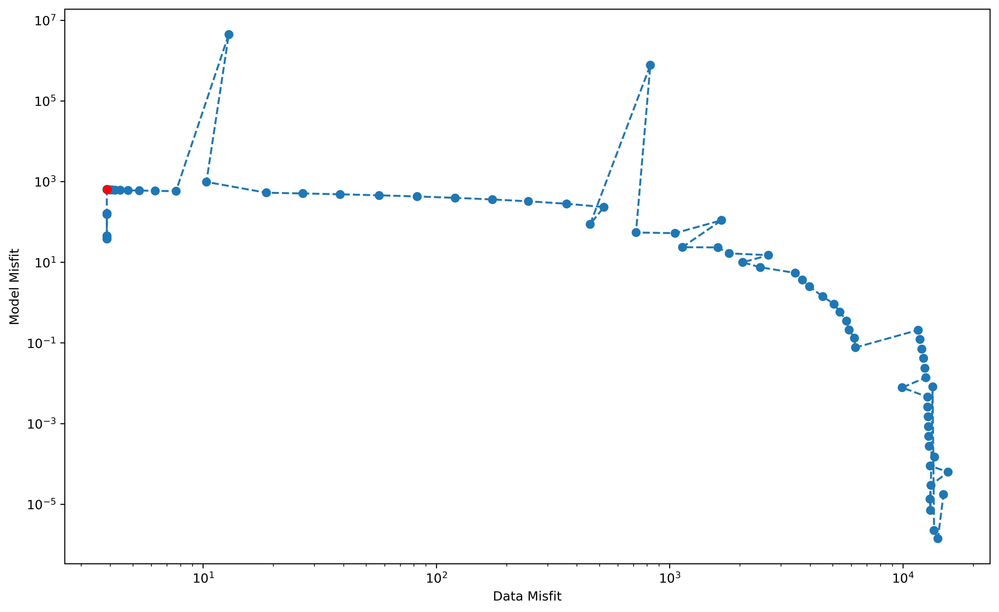

In [14]:
fig, ax=plt.subplots(figsize=[13, 8], dpi=360)
ax.loglog(*fsvals.T, 'o--')
ax.set_xlabel("Data Misfit")
ax.set_ylabel("Model Misfit")
idx = 30
ax.loglog(*fsvals[idx], 'ro')

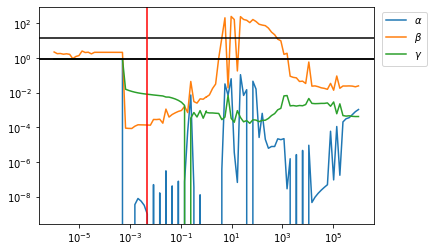

In [15]:
plt.loglog(pranges, [float(s['x'][-3]) for s in sols], label=r'$\alpha$')
plt.loglog(pranges, [float(s['x'][-2]) for s in sols], label=r'$\beta$')
plt.loglog(pranges, [float(s['x'][-1]) for s in sols], label=r'$\gamma$')
for q in p0:
    plt.axhline(q, color='k')
plt.legend(loc="best", bbox_to_anchor=(1.01, 1))

idx = 30
plt.axvline(pranges[idx], color='r')

In [16]:
getp = ca.Function('getx', [solver_setup['x']], model.ps)
getp(sols[idx]['x'])

(DM(1.00681e-09), DM(0.000137778), DM(0.00822167))

3.874 641.264


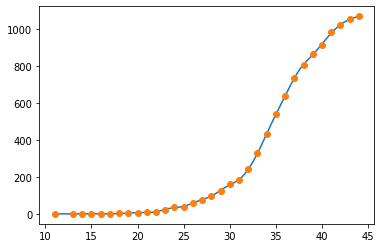

In [17]:
idx = 30
print(f1_ex(sols[idx]['x']), f2_ex(sols[idx]['x']))
plt.plot(model.observation_times, getx(sols[idx]['x'])[-1], label='model')
plt.plot(time, data, 'o', label='data')

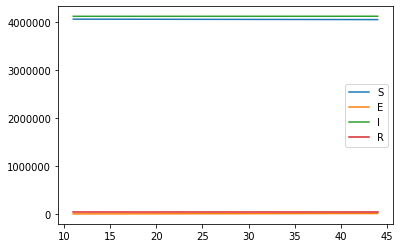

In [18]:
idx=30
plt.plot(model.observation_times, getx(sols[idx]['x'])[0])
plt.plot(model.observation_times, getx(sols[idx]['x'])[1])
plt.plot(model.observation_times, getx(sols[idx]['x'])[2])
plt.plot(model.observation_times, getx(sols[idx]['x'])[3])
plt.legend("SEIR")

In [19]:
N = np.hstack([np.array(x) for x in getx(sols[idx]['x'])]).sum(axis=1)
print(np.mean(N), np.std(N))

8231099.914263237 378.7487334512845


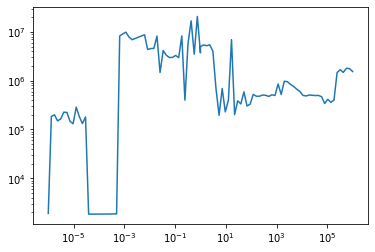

In [20]:
getN = lambda idx: np.mean(np.hstack([np.array(x) for x in getx(sols[idx]['x'])]).sum(axis=1))
plt.loglog(pranges, [getN(i) for i,_ in enumerate(pranges)])

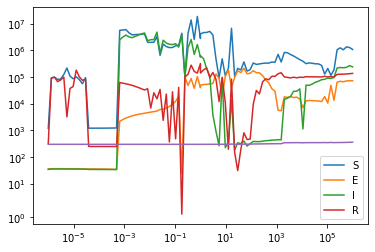

In [21]:
getM = lambda idx: np.mean(np.hstack([np.array(x) for x in getx(sols[idx]['x'])]), axis=0)
plt.semilogx(pranges, [getM(i) for i,_ in enumerate(pranges)])
plt.yscale('symlog')
plt.legend("SEIR")

In [22]:
[x[0] for x in getx(sols[idx]['x'])]

[DM(4.06726e+06), DM(1.17116e-05), DM(4.12679e+06), DM(36747.2), DM(0.991093)]

In [23]:
idx = 30
pfin = np.array([float(p) for p in getp(sols[idx]['x'])])
print(f"Recovery Period (Infectious Period): {7/pfin[0]} days")
print(fr"$\beta$: {pfin[1]} effective contacts/week")
print(f"Latent Period: {7/pfin[2]} days")
print(f"$R_0$: {pfin[1]/pfin[0]}")

Recovery Period (Infectious Period): 6952673676.079944 days
$\beta$: 0.00013777822991705712 effective contacts/week
Latent Period: 851.4081784663772 days
$R_0$: 136846.72461160188


In [24]:
# applying the final size relation
from scipy.optimize import brentq
def rinf(sol):
    pfin = np.array([float(p) for p in getp(sol['x'])])
    r0 = pfin[1]/pfin[0]
    S0, E0, I0, R0, C0 = [float(x[0]) for x in getx(sol['x'])]
    N = sum((S0, E0, I0, R0))
    f = lambda y: y/S0 - np.exp(r0*(y-N)/N) 
    sinf = brentq(f, 0, S0) 
    return N-sinf

/home/dwu402/.virtualenvs/scider/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: divide by zero encountered in double_scalars
  """


Text(0, 0.5, '$R_\\infty$')

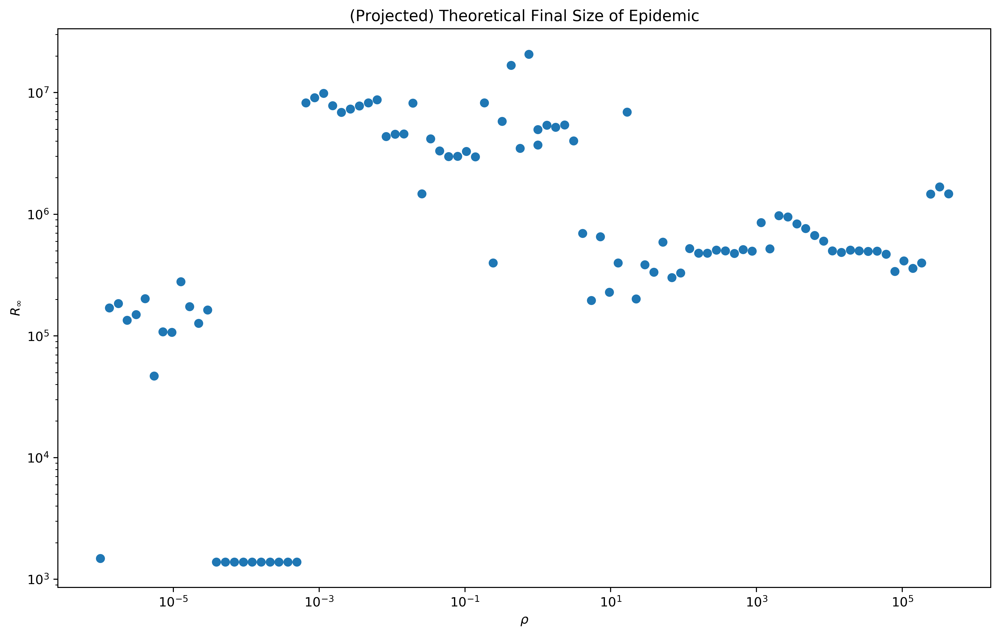

In [25]:
fig, ax = plt.subplots(figsize=[13, 8], dpi=360)
ax.loglog(pranges[:-3], [rinf(sol) for sol in sols][:-3], 'o')
ax.set_title("(Projected) Theoretical Final Size of Epidemic")
ax.set_xlabel(r"$\rho$")
ax.set_ylabel(r"$R_\infty$")

/home/dwu402/.virtualenvs/scider/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  This is separate from the ipykernel package so we can avoid doing imports until


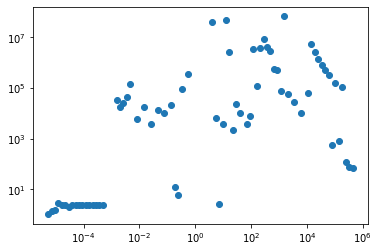

In [26]:
def r0(sol):
    pfin = np.array([float(p) for p in getp(sol['x'])])
    return pfin[1]/pfin[0]

plt.plot(pranges[6:-3], [r0(sol) for sol in sols][6:-3], 'o')
plt.xscale('log')
plt.yscale('log')

## Profiling

In [27]:
profiler_setup = {
    'f': objective.objective,
    'x': ca.vcat(objective.input_list),
    'p': ca.hcat([objective.rho, objective.alpha]),
}
profiler_opts = {'ipopt': {'dual_inf_tol': 1e-1, 'max_iter': 300}}
profiler = ca.nlpsol('solver', 'ipopt', profiler_setup, profiler_opts)

In [28]:
idx = 30
rho = pranges[idx]
pref = getp(sols[idx]['x'])
lbx = [-np.inf]*(config['basis_number']*config['model_form']['state']) + [0]*config['model_form']['parameters']
ubx = [np.inf]*(config['basis_number']*config['model_form']['state'] + config['model_form']['parameters'])

profiles = []
for pdx in range(config['model_form']['parameters']):
    pdx_mod = config['basis_number']*config['model_form']['state'] + pdx
    pvals = np.logspace(-1, 1, num=50)
    profiles.append([])
    for pval in pvals:
        lbx0 = np.array(lbx)
        ubx0 = np.array(ubx)
        lbx0[pdx_mod] = pval
        ubx0[pdx_mod] = pval
        profiles[pdx].append(profiler(x0=np.array(sols[idx]['x']).flatten(), p=[rho, 0], lbx=lbx0, ubx=ubx0))

This is Ipopt version 3.12.3, running with linear solver mumps.
NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:        0
Number of nonzeros in Lagrangian Hessian.............:     7503

Total number of variables............................:      122
                     variables with only lower bounds:        2
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:        0
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  

  85  2.8693525e+01 0.00e+00 3.42e-01  -3.8 1.05e+02  -9.8 1.00e+00 1.00e+00f  1
  86  2.6384077e+01 0.00e+00 4.16e-01  -3.8 6.93e+01 -10.2 1.00e+00 1.00e+00f  1
  87  3.9534036e+01 0.00e+00 1.51e+00  -3.8 1.16e+02 -10.7 1.00e+00 1.00e+00f  1
  88  5.5248098e+01 0.00e+00 4.51e-01  -3.8 4.52e+01  -6.7 7.42e-01 5.00e-01f  2
  89  3.3166571e+01 0.00e+00 1.79e-02  -3.8 2.80e+00  -5.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  90  2.4286106e+01 0.00e+00 6.24e-02  -3.8 3.54e+00  -5.8 1.00e+00 1.00e+00f  1
  91  2.3567742e+01 0.00e+00 6.96e-02  -3.8 6.48e+00  -6.3 1.00e+00 1.00e+00f  1
  92  2.3744791e+01 0.00e+00 2.28e-01  -3.8 1.33e+01  -6.8 1.00e+00 1.00e+00f  1
  93  2.3886344e+01 0.00e+00 3.00e-01  -3.8 2.25e+01  -7.3 1.00e+00 1.00e+00f  1
  94  2.4349801e+01 0.00e+00 4.66e-01  -3.8 3.80e+01  -7.7 1.00e+00 1.00e+00f  1
  95  2.4074989e+01 0.00e+00 3.74e-01  -3.8 5.82e+01  -8.2 1.00e+00 1.00e+00f  1
  96  2.6387468e+01 0.00e+00

   7  1.5435944e+09 0.00e+00 3.06e-02  -1.0 6.92e+03  -6.9 1.00e+00 1.00e+00f  1
   8  1.5315417e+09 0.00e+00 4.09e-01  -2.5 1.90e+04  -7.3 1.00e+00 1.00e+00f  1
   9  1.5032888e+09 0.00e+00 8.95e-01  -2.5 4.66e+04  -7.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  1.4456611e+09 0.00e+00 2.44e-01  -2.5 9.76e+04  -8.3 1.00e+00 1.00e+00f  1
  11  1.3217171e+09 0.00e+00 1.64e+01  -2.5 1.77e+05  -8.8 1.00e+00 1.00e+00f  1
  12  1.0512621e+09 0.00e+00 1.02e+01  -2.5 3.50e+05  -9.2 1.00e+00 1.00e+00f  1
  13  1.0497986e+09 0.00e+00 3.09e-01  -2.5 2.04e+03  -7.0 1.00e+00 1.00e+00f  1
  14  1.0454376e+09 0.00e+00 8.73e-01  -2.5 6.08e+03  -7.5 1.00e+00 1.00e+00f  1
  15  1.0325395e+09 0.00e+00 7.30e+00  -2.5 1.79e+04  -8.0 1.00e+00 1.00e+00f  1
  16  9.9539194e+08 0.00e+00 1.39e+01  -2.5 5.20e+04  -8.4 1.00e+00 1.00e+00f  1
  17  8.9567916e+08 0.00e+00 4.74e+00  -2.5 1.46e+05  -8.9 1.00e+00 1.00e+00f  1
  18  6.7051088e+08 0.00e+00

 107  1.7291950e+05 0.00e+00 8.53e-02  -3.8 7.95e+00  -6.7 1.00e+00 1.00e+00f  1
 108  1.7286830e+05 0.00e+00 4.16e-01  -3.8 2.33e+01  -7.2 1.00e+00 1.00e+00f  1
 109  1.7271823e+05 0.00e+00 2.37e-01  -3.8 6.51e+01  -7.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  1.7228607e+05 0.00e+00 8.26e-01  -3.8 1.73e+02  -8.1 1.00e+00 1.00e+00f  1
 111  1.7103095e+05 0.00e+00 8.56e-02  -3.8 4.76e+02  -8.6 1.00e+00 1.00e+00f  1
 112  1.6753465e+05 0.00e+00 5.94e+00  -3.8 1.35e+03  -9.1 1.00e+00 1.00e+00f  1
 113  1.5724426e+05 0.00e+00 4.74e-03  -3.8 3.83e+03  -9.6 1.00e+00 1.00e+00f  1
 114  1.4372597e+05 0.00e+00 5.83e+01  -3.8 1.04e+04 -10.1 1.00e+00 1.00e+00f  1
 115  8.2142806e+04 0.00e+00 7.10e-01  -3.8 2.37e+04 -10.5 1.00e+00 1.00e+00f  1
 116  8.2010398e+04 0.00e+00 4.30e-01  -3.8 2.10e+01  -6.5 1.00e+00 1.00e+00f  1
 117  8.1996028e+04 0.00e+00 7.98e-05  -3.8 8.81e+00  -7.0 1.00e+00 1.00e+00f  1
 118  8.1957278e+04 0.00e+00

   6  1.8684295e+09 0.00e+00 2.03e+00  -1.0 2.38e+03  -6.4 1.00e+00 1.00e+00f  1
   7  1.8632278e+09 0.00e+00 3.13e-02  -1.0 6.95e+03  -6.9 1.00e+00 1.00e+00f  1
   8  1.8491209e+09 0.00e+00 3.63e-01  -2.5 1.92e+04  -7.3 1.00e+00 1.00e+00f  1
   9  1.8151935e+09 0.00e+00 9.45e-01  -2.5 4.76e+04  -7.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  1.7440253e+09 0.00e+00 7.30e-01  -2.5 1.01e+05  -8.3 1.00e+00 1.00e+00f  1
  11  1.5897612e+09 0.00e+00 1.80e+00  -2.5 1.84e+05  -8.8 1.00e+00 1.00e+00f  1
  12  1.5377184e+09 0.00e+00 2.91e+01  -2.5 5.97e+04  -8.3 1.00e+00 1.00e+00f  1
  13  1.3993981e+09 0.00e+00 1.00e+00  -2.5 1.50e+05  -8.8 1.00e+00 1.00e+00f  1
  14  1.3514003e+09 0.00e+00 4.59e+02  -2.5 5.30e+04  -8.4 1.00e+00 1.00e+00f  1
  15  1.2210125e+09 0.00e+00 1.16e+01  -2.5 1.47e+05  -8.9 1.00e+00 1.00e+00f  1
  16  9.2508788e+08 0.00e+00 1.85e+02  -2.5 3.76e+05  -9.4 1.00e+00 1.00e+00f  1
  17  4.6032340e+08 0.00e+00

 103  3.0572165e+01 0.00e+00 9.17e-01  -3.8 4.28e+04 -12.9 9.07e-01 5.00e-01f  2
 104  2.8025579e+01 0.00e+00 4.84e-01  -3.8 4.79e+04 -13.4 1.00e+00 5.00e-01f  2
 105  2.3132135e+01 0.00e+00 3.21e-03  -3.8 5.69e+02 -13.9 1.00e+00 1.00e+00f  1
 106  2.3506252e+01 0.00e+00 5.54e-03  -3.8 4.25e+03 -14.4 1.00e+00 1.00e+00f  1
 107  2.3503985e+01 0.00e+00 3.11e-04  -3.8 3.05e+03 -14.8 1.00e+00 1.00e+00f  1
 108  1.2938606e+01 0.00e+00 6.63e-04  -5.7 6.70e+02 -15.3 1.00e+00 1.00e+00f  1
 109  1.0433611e+01 0.00e+00 8.61e-04  -5.7 1.53e+03 -15.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  9.8689969e+00 0.00e+00 9.24e-04  -5.7 4.92e+03 -16.3 1.00e+00 1.00e+00f  1
 111  9.7531913e+00 0.00e+00 1.18e-03  -5.7 1.49e+04 -16.7 1.00e+00 1.00e+00f  1
 112  9.7278967e+00 0.00e+00 3.97e-04  -5.7 4.44e+04 -17.2 1.00e+00 1.00e+00f  1
 113  9.6927447e+00 0.00e+00 1.03e-03  -5.7 1.31e+05 -17.7 1.00e+00 1.00e+00f  1
 114  9.5978990e+00 0.00e+00

 199  9.0716245e+00 0.00e+00 6.18e-06  -8.6 4.12e+03 -17.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  9.0715745e+00 0.00e+00 9.10e-07  -8.6 1.54e+03 -16.8 1.00e+00 1.00e+00f  1
 201  9.0714261e+00 0.00e+00 7.75e-06  -8.6 4.59e+03 -17.2 1.00e+00 1.00e+00f  1
 202  9.0713710e+00 0.00e+00 1.15e-06  -8.6 1.72e+03 -16.8 1.00e+00 1.00e+00f  1
 203  9.0712079e+00 0.00e+00 9.72e-06  -8.6 5.11e+03 -17.3 1.00e+00 1.00e+00f  1
 204  9.0711473e+00 0.00e+00 1.45e-06  -8.6 1.91e+03 -16.9 1.00e+00 1.00e+00f  1
 205  9.0709683e+00 0.00e+00 1.22e-05  -8.6 5.67e+03 -17.3 1.00e+00 1.00e+00f  1
 206  9.0709020e+00 0.00e+00 1.83e-06  -8.6 2.12e+03 -16.9 1.00e+00 1.00e+00f  1
 207  9.0707063e+00 0.00e+00 1.52e-05  -8.6 6.30e+03 -17.4 1.00e+00 1.00e+00f  1
 208  9.0706338e+00 0.00e+00 2.30e-06  -8.6 2.35e+03 -17.0 1.00e+00 1.00e+00f  1
 209  9.0704204e+00 0.00e+00 1.90e-05  -8.6 6.97e+03 -17.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

Number of inequality constraint evaluations          = 0
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 0
Number of Lagrangian Hessian evaluations             = 300
Total CPU secs in IPOPT (w/o function evaluations)   =      0.464
Total CPU secs in NLP function evaluations           =      9.091

EXIT: Maximum Number of Iterations Exceeded.
      solver  :   t_proc      (avg)   t_wall      (avg)    n_eval
       nlp_f  |  43.11ms (104.62us)  43.26ms (104.99us)       412
    nlp_grad  | 287.00us (287.00us) 286.93us (286.93us)         1
  nlp_grad_f  |  86.90ms (287.74us)  86.92ms (287.82us)       302
  nlp_hess_l  |   8.99 s ( 29.97ms)   8.98 s ( 29.95ms)       300
       total  |   9.61 s (  9.61 s)   9.58 s (  9.58 s)         1
This is Ipopt version 3.12.3, running with linear solver mumps.
NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  80  1.8407778e+06 0.00e+00 4.55e+01  -3.8 7.85e+03  -9.2 1.00e+00 1.00e+00f  1
  81  1.4752899e+06 0.00e+00 2.20e+00  -3.8 2.00e+04  -9.7 1.00e+00 1.00e+00f  1
  82  1.4747502e+06 0.00e+00 2.05e-01  -3.8 4.26e+00  -5.6 1.00e+00 1.00e+00f  1
  83  1.4746568e+06 0.00e+00 4.24e-02  -3.8 5.60e+00  -6.1 1.00e+00 1.00e+00f  1
  84  1.4743833e+06 0.00e+00 3.86e-01  -3.8 1.68e+01  -6.6 1.00e+00 1.00e+00f  1
  85  1.4735958e+06 0.00e+00 7.28e-01  -3.8 5.03e+01  -7.1 1.00e+00 1.00e+00f  1
  86  1.4712736e+06 0.00e+00 4.17e-01  -3.8 1.51e+02  -7.5 1.00e+00 1.00e+00f  1
  87  1.4644022e+06 0.00e+00 1.17e+00  -3.8 4.51e+02  -8.0 1.00e+00 1.00e+00f  1
  88  1.4441167e+06 0.00e+00 1.37e-01  -3.8 1.34e+03  -8.5 1.00e+00 1.00e+00f  1
  89  1.3865571e+06 0.00e+00 5.75e+00  -3.8 3.89e+03  -9.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  90  1.2333005e+06 0.00e+00

 176  1.0248810e+01 0.00e+00 1.71e-02  -5.7 8.16e+03 -16.2 1.00e+00 1.00e+00f  1
 177  1.0230520e+01 0.00e+00 7.80e-03  -5.7 1.82e+04 -16.6 1.00e+00 1.00e+00f  1
 178  1.0224162e+01 0.00e+00 2.27e-02  -5.7 5.40e+04 -17.1 1.00e+00 1.00e+00f  1
 179  1.0127627e+01 0.00e+00 3.28e-04  -5.7 1.58e+05 -17.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 180  1.0084008e+01 0.00e+00 3.97e-02  -5.7 4.38e+05 -18.1 1.00e+00 1.00e+00f  1
 181  9.5399300e+00 0.00e+00 7.23e-02  -5.7 1.11e+06 -18.5 1.00e+00 1.00e+00f  1
 182  9.5443707e+00 0.00e+00 2.41e-04  -5.7 1.43e+03 -15.4 1.00e+00 1.00e+00f  1
 183  9.5438112e+00 0.00e+00 1.41e-04  -5.7 2.44e+03 -15.9 1.00e+00 1.00e+00f  1
 184  9.5417722e+00 0.00e+00 4.65e-05  -5.7 7.31e+03 -16.4 1.00e+00 1.00e+00f  1
 185  9.5356343e+00 0.00e+00 5.26e-05  -5.7 2.19e+04 -16.8 1.00e+00 1.00e+00f  1
 186  9.5175085e+00 0.00e+00 5.00e-04  -5.7 6.52e+04 -17.3 1.00e+00 1.00e+00f  1
 187  9.4655327e+00 0.00e+00

  27  9.9017883e+08 0.00e+00 3.09e+00  -3.8 3.25e+04  -8.3 1.00e+00 1.00e+00f  1
  28  9.1471902e+08 0.00e+00 5.03e+00  -3.8 9.41e+04  -8.8 1.00e+00 1.00e+00f  1
  29  7.3024344e+08 0.00e+00 8.29e+00  -3.8 2.54e+05  -9.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  30  7.2219465e+08 0.00e+00 1.73e+00  -3.8 1.18e+04  -7.9 1.00e+00 1.00e+00f  1
  31  6.9877005e+08 0.00e+00 1.65e-01  -3.8 3.49e+04  -8.4 1.00e+00 1.00e+00f  1
  32  6.3441218e+08 0.00e+00 4.70e-01  -3.8 1.00e+05  -8.9 1.00e+00 1.00e+00f  1
  33  6.1160761e+08 0.00e+00 1.53e-01  -3.8 3.68e+04  -8.4 1.00e+00 1.00e+00f  1
  34  5.4954451e+08 0.00e+00 5.66e-01  -3.8 1.05e+05  -8.9 1.00e+00 1.00e+00f  1
  35  5.2768931e+08 0.00e+00 5.77e-01  -3.8 3.85e+04  -8.5 1.00e+00 1.00e+00f  1
  36  4.6882931e+08 0.00e+00 6.78e+00  -3.8 1.09e+05  -9.0 1.00e+00 1.00e+00f  1
  37  3.3789972e+08 0.00e+00 1.99e+00  -3.8 2.73e+05  -9.4 1.00e+00 1.00e+00f  1
  38  3.3719995e+08 0.00e+00

 126  9.6959689e+04 0.00e+00 5.42e-03  -5.7 2.32e+02  -8.6 1.00e+00 1.00e+00f  1
 127  9.5442386e+04 0.00e+00 4.32e-02  -5.7 6.88e+02  -9.0 1.00e+00 1.00e+00f  1
 128  9.1114329e+04 0.00e+00 3.91e-02  -5.7 1.99e+03  -9.5 1.00e+00 1.00e+00f  1
 129  7.9787867e+04 0.00e+00 4.13e-03  -5.7 5.53e+03 -10.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 130  5.6237191e+04 0.00e+00 8.31e+00  -5.7 1.37e+04 -10.5 1.00e+00 1.00e+00f  1
 131  2.1816371e+04 0.00e+00 1.66e+00  -5.7 2.64e+04 -10.9 1.00e+00 1.00e+00f  1
 132  2.1661918e+04 0.00e+00 2.35e-02  -5.7 1.42e+02  -8.7 1.00e+00 1.00e+00f  1
 133  2.1225818e+04 0.00e+00 1.81e-03  -5.7 4.11e+02  -9.2 1.00e+00 1.00e+00f  1
 134  1.9988124e+04 0.00e+00 2.96e-02  -5.7 1.23e+03  -9.7 1.00e+00 1.00e+00f  1
 135  1.6785861e+04 0.00e+00 2.81e-02  -5.7 3.43e+03 -10.1 1.00e+00 1.00e+00f  1
 136  1.5695738e+04 0.00e+00 3.15e-01  -5.7 1.25e+03  -9.7 1.00e+00 1.00e+00f  1
 137  1.2913426e+04 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  4.1149741e+09 0.00e+00 2.92e+03  -1.0 0.00e+00    -  0.00e+00 0.00e+00   0
   1  4.0829334e+09 0.00e+00 9.79e+01  -1.0 1.26e+01  -4.0 1.00e-02 1.00e+00f  1
   2  3.9050451e+09 0.00e+00 9.23e+03  -1.0 2.19e+03  -4.5 1.95e-02 1.00e+00f  1
   3  3.4080149e+09 0.00e+00 9.71e+02  -1.0 4.50e+02  -4.1 1.00e+00 1.00e+00f  1
   4  3.3702017e+09 0.00e+00 4.11e+01  -1.0 7.51e+02  -4.5 1.00e+00 1.00e+00f  1
   5  3.3234973e+09 0.00e+00 1.44e+01  -1.0 1.44e+03  -5.0 1.00e+00 1.00e+00f  1
   6  3.2933024e+09 0.00e+00 3.00e+01  -1.0 1.94e+03  -5.5 1.00e+00 1.00e+00f  1
   7  3.2871964e+09 0.00e+00 1.53e+01  -1.0 1.62e+03  -6.0 1.00e+00 1.00e+00f  1
   8  3.2837072e+09 0.00e+00 4.74e-01  -1.0 2.69e+03  -6.4 1.00e+00 1.00e+00f  1
   9  3.2744016e+09 0.00e+00 1.13e-02  -1.7 7.86e+03  -6.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  3.2484534e+09 0.00e+00

  94  1.4236284e+06 0.00e+00 1.47e-01  -5.7 1.73e+03  -8.6 1.00e+00 1.00e+00f  1
  95  1.3471492e+06 0.00e+00 1.64e-01  -5.7 5.06e+03  -9.1 1.00e+00 1.00e+00f  1
  96  1.1514697e+06 0.00e+00 7.20e-02  -5.7 1.41e+04  -9.6 1.00e+00 1.00e+00f  1
  97  7.7329169e+05 0.00e+00 5.64e+00  -5.7 3.41e+04 -10.1 1.00e+00 1.00e+00f  1
  98  3.1811908e+05 0.00e+00 1.32e+00  -5.7 6.18e+04 -10.5 1.00e+00 1.00e+00f  1
  99  7.6867830e+04 0.00e+00 2.01e+00  -5.7 7.09e+04 -11.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  7.6531887e+04 0.00e+00 9.29e-05  -5.7 2.32e+00  -5.2 1.00e+00 1.00e+00f  1
 101  7.6525819e+04 0.00e+00 9.86e-05  -5.7 6.85e-01  -5.7 1.00e+00 1.00e+00f  1
 102  7.6523626e+04 0.00e+00 5.08e-03  -5.7 9.36e-01  -6.1 1.00e+00 1.00e+00f  1
 103  7.6517213e+04 0.00e+00 4.31e-02  -5.7 2.77e+00  -6.6 1.00e+00 1.00e+00f  1
 104  7.6499425e+04 0.00e+00 2.00e-01  -5.7 8.22e+00  -7.1 1.00e+00 1.00e+00f  1
 105  7.6448921e+04 0.00e+00

 192  9.3800577e+00 0.00e+00 6.10e-02  -5.7 1.00e+06 -18.4 1.00e+00 1.00e+00f  1
 193  9.2056286e+00 0.00e+00 3.89e-02  -5.7 4.92e+05 -18.8 1.00e+00 1.00e+00f  1
 194  9.2294339e+00 0.00e+00 4.47e-03  -5.7 5.42e+05 -19.3 8.07e-01 1.89e-01f  3
 195  9.2827678e+00 0.00e+00 3.37e-02  -5.7 9.98e+05 -19.8 1.00e+00 2.50e-01f  3
 196  9.1405646e+00 0.00e+00 4.35e-03  -5.7 3.94e+05 -20.0 1.00e+00 1.00e+00f  1
 197  9.3196034e+00 0.00e+00 1.04e-03  -5.7 5.83e+05 -20.0 4.89e-01 2.50e-01f  3
 198  9.8625085e+00 0.00e+00 4.44e-03  -5.7 3.08e+03 -12.6 1.00e+00 1.25e-01f  4
 199  9.6409985e+00 0.00e+00 5.59e-05  -5.7 7.38e+02 -13.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  9.4569513e+00 0.00e+00 4.12e-05  -5.7 1.76e+03 -13.5 1.00e+00 1.00e+00f  1
 201  9.3356417e+00 0.00e+00 1.16e-03  -5.7 3.79e+04 -14.0 1.85e-01 1.25e-01f  4
 202  9.4006473e+00 0.00e+00 2.40e-03  -5.7 1.05e+04 -14.5 1.00e+00 2.50e-01f  3
 203  9.1679815e+00 0.00e+00

  44  3.1834873e+08 0.00e+00 1.01e+01  -3.8 1.38e+05  -9.2 1.00e+00 1.00e+00f  1
  45  1.8799265e+08 0.00e+00 8.54e+00  -3.8 3.09e+05  -9.6 1.00e+00 1.00e+00f  1
  46  1.8790180e+08 0.00e+00 8.68e-02  -3.8 2.26e+02  -6.5 1.00e+00 1.00e+00f  1
  47  1.8765732e+08 0.00e+00 7.05e-02  -3.8 6.79e+02  -7.0 1.00e+00 1.00e+00f  1
  48  1.8692679e+08 0.00e+00 5.87e-01  -3.8 2.03e+03  -7.5 1.00e+00 1.00e+00f  1
  49  1.8476011e+08 0.00e+00 4.35e+00  -3.8 6.06e+03  -7.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  50  1.7847556e+08 0.00e+00 3.51e+00  -3.8 1.79e+04  -8.4 1.00e+00 1.00e+00f  1
  51  1.6137604e+08 0.00e+00 7.26e+00  -3.8 5.10e+04  -8.9 1.00e+00 1.00e+00f  1
  52  1.2228275e+08 0.00e+00 2.38e+00  -3.8 1.33e+05  -9.4 1.00e+00 1.00e+00f  1
  53  1.2207189e+08 0.00e+00 2.65e-01  -3.8 7.80e+02  -7.1 1.00e+00 1.00e+00f  1
  54  1.2144371e+08 0.00e+00 1.84e+00  -3.8 2.33e+03  -7.6 1.00e+00 1.00e+00f  1
  55  1.1958949e+08 0.00e+00

 152  1.6404027e+04 0.00e+00 8.35e-02  -5.7 4.37e+01  -8.3 1.00e+00 1.00e+00f  1
 153  1.6286369e+04 0.00e+00 8.98e-04  -5.7 1.31e+02  -8.8 1.00e+00 1.00e+00f  1
 154  1.5940404e+04 0.00e+00 3.99e-02  -5.7 3.88e+02  -9.3 1.00e+00 1.00e+00f  1
 155  1.4958240e+04 0.00e+00 7.23e-03  -5.7 1.12e+03  -9.7 1.00e+00 1.00e+00f  1
 156  1.2442527e+04 0.00e+00 1.51e-01  -5.7 3.05e+03 -10.2 1.00e+00 1.00e+00f  1
 157  7.5069377e+03 0.00e+00 2.77e-01  -5.7 6.97e+03 -10.7 1.00e+00 1.00e+00f  1
 158  7.5026145e+03 0.00e+00 4.55e-04  -5.7 5.05e+00  -7.6 1.00e+00 1.00e+00f  1
 159  7.4931691e+03 0.00e+00 4.67e-05  -5.7 1.52e+01  -8.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 160  7.4649239e+03 0.00e+00 4.27e-04  -5.7 4.55e+01  -8.5 1.00e+00 1.00e+00f  1
 161  7.3809970e+03 0.00e+00 3.63e-03  -5.7 1.36e+02  -9.0 1.00e+00 1.00e+00f  1
 162  7.1363088e+03 0.00e+00 2.19e-02  -5.7 4.01e+02  -9.5 1.00e+00 1.00e+00f  1
 163  6.4612847e+03 0.00e+00

 254  1.0188744e+01 0.00e+00 3.65e-06  -8.6 6.03e+03 -15.9 1.00e+00 1.00e+00f  1
 255  1.0165880e+01 0.00e+00 4.91e-05  -8.6 1.79e+04 -16.3 1.00e+00 1.00e+00f  1
 256  1.0100443e+01 0.00e+00 2.58e-05  -8.6 5.20e+04 -16.8 1.00e+00 1.00e+00f  1
 257  1.0087401e+01 0.00e+00 3.88e-04  -8.6 1.42e+05 -17.3 6.87e-01 1.25e-01f  4
 258  9.6946482e+00 0.00e+00 1.06e-03  -8.6 3.56e+05 -17.8 1.00e+00 1.00e+00f  1
 259  9.6942193e+00 0.00e+00 1.01e-05  -8.6 2.67e+02 -14.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 260  9.6934830e+00 0.00e+00 1.29e-06  -8.6 7.80e+02 -15.1 1.00e+00 1.00e+00f  1
 261  9.6913398e+00 0.00e+00 2.24e-05  -8.6 2.34e+03 -15.6 1.00e+00 1.00e+00f  1
 262  9.6847911e+00 0.00e+00 1.05e-07  -8.6 6.97e+03 -16.1 1.00e+00 1.00e+00f  1
 263  9.6840880e+00 0.00e+00 4.29e-04  -8.6 2.05e+04 -16.5 1.00e+00 1.00e+00f  1
 264  9.6137780e+00 0.00e+00 4.00e-05  -8.6 5.85e+04 -17.0 1.00e+00 1.00e+00f  1
 265  9.6134506e+00 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  20  2.6565615e+09 0.00e+00 1.42e+02  -3.8 9.57e+04  -8.5 1.00e+00 1.00e+00f  1
  21  2.2071086e+09 0.00e+00 3.29e+00  -3.8 2.64e+05  -9.0 1.00e+00 1.00e+00f  1
  22  2.1872477e+09 0.00e+00 8.11e+00  -3.8 1.23e+04  -7.7 1.00e+00 1.00e+00f  1
  23  2.1291089e+09 0.00e+00 2.24e+00  -3.8 3.64e+04  -8.2 1.00e+00 1.00e+00f  1
  24  1.9667457e+09 0.00e+00 2.06e+01  -3.8 1.05e+05  -8.7 1.00e+00 1.00e+00f  1
  25  1.5687991e+09 0.00e+00 1.32e+01  -3.8 2.84e+05  -9.1 1.00e+00 1.00e+00f  1
  26  1.5666059e+09 0.00e+00 2.78e-02  -3.8 1.66e+03  -6.9 1.00e+00 1.00e+00f  1
  27  1.5600644e+09 0.00e+00 6.01e-02  -3.8 4.97e+03  -7.4 1.00e+00 1.00e+00f  1
  28  1.5406592e+09 0.00e+00 4.90e-01  -3.8 1.48e+04  -7.9 1.00e+00 1.00e+00f  1
  29  1.4843529e+09 0.00e+00 2.67e+00  -3.8 4.37e+04  -8.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  30  1.3311033e+09 0.00e+00

 112  1.2753626e+05 0.00e+00 3.34e-02  -5.7 1.50e+02  -8.2 1.00e+00 1.00e+00f  1
 113  1.2606186e+05 0.00e+00 1.01e-01  -5.7 4.47e+02  -8.7 1.00e+00 1.00e+00f  1
 114  1.2180989e+05 0.00e+00 4.07e-03  -5.7 1.31e+03  -9.1 1.00e+00 1.00e+00f  1
 115  1.1044255e+05 0.00e+00 3.90e-01  -5.7 3.68e+03  -9.6 1.00e+00 1.00e+00f  1
 116  8.5242198e+04 0.00e+00 7.01e-02  -5.7 9.22e+03 -10.1 1.00e+00 1.00e+00f  1
 117  5.9342142e+04 0.00e+00 1.33e+01  -5.7 1.82e+04 -10.6 1.00e+00 1.00e+00f  1
 118  4.8703661e+04 0.00e+00 7.33e+00  -5.7 1.07e+03  -6.5 6.79e-01 2.50e-01f  3
 119  4.7885480e+04 0.00e+00 7.21e+00  -5.7 6.83e+02  -7.0 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 120  4.7652919e+04 0.00e+00 1.24e-03  -5.7 1.50e+01  -7.5 1.00e+00 1.00e+00f  1
 121  4.7578320e+04 0.00e+00 6.03e-05  -5.7 4.49e+01  -8.0 1.00e+00 1.00e+00f  1
 122  4.7355937e+04 0.00e+00 3.21e-04  -5.7 1.34e+02  -8.4 1.00e+00 1.00e+00f  1
 123  4.6700405e+04 0.00e+00

 207  5.0084797e+00 0.00e+00 3.28e-07  -8.6 2.95e+00 -14.7 1.00e+00 1.00e+00f  1
 208  5.0084797e+00 0.00e+00 2.74e-10  -8.6 8.09e+00 -15.2 1.00e+00 1.00e+00f  1
 209  5.0084797e+00 0.00e+00 6.83e-11 -10.5 7.54e-02 -15.6 1.00e+00 1.00e+00f  1

Number of Iterations....: 209

                                   (scaled)                 (unscaled)
Objective...............:   1.5724765623383611e-05    5.0084796835521832e+00
Dual infeasibility......:   6.8312712518133318e-11    2.1758215096486145e-05
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.8795199181394780e-11    9.1715306630319960e-06
Overall NLP error.......:   6.8312712518133318e-11    2.1758215096486145e-05


Number of objective function evaluations             = 351
Number of objective gradient evaluations             = 210
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 0
Number of equality constraint Jacob

  63  3.0410893e+07 0.00e+00 1.62e-03  -3.8 9.74e+00  -5.6 1.00e+00 1.00e+00f  1
  64  3.0407696e+07 0.00e+00 6.55e-03  -3.8 2.92e+01  -6.1 1.00e+00 1.00e+00f  1
  65  3.0398136e+07 0.00e+00 4.74e-02  -3.8 8.76e+01  -6.5 1.00e+00 1.00e+00f  1
  66  3.0369548e+07 0.00e+00 3.79e-01  -3.8 2.63e+02  -7.0 1.00e+00 1.00e+00f  1
  67  3.0284445e+07 0.00e+00 4.93e-01  -3.8 7.86e+02  -7.5 1.00e+00 1.00e+00f  1
  68  3.0032380e+07 0.00e+00 5.10e-01  -3.8 2.35e+03  -8.0 1.00e+00 1.00e+00f  1
  69  2.9300970e+07 0.00e+00 6.40e-01  -3.8 6.92e+03  -8.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  70  2.7302233e+07 0.00e+00 4.94e-01  -3.8 1.97e+04  -8.9 1.00e+00 1.00e+00f  1
  71  2.2630379e+07 0.00e+00 3.70e-02  -3.8 5.13e+04  -9.4 1.00e+00 1.00e+00f  1
  72  1.4733370e+07 0.00e+00 3.24e+00  -3.8 1.08e+05  -9.9 1.00e+00 1.00e+00f  1
  73  1.4732597e+07 0.00e+00 3.37e-05  -3.8 9.85e+00  -5.8 1.00e+00 1.00e+00f  1
  74  1.4730755e+07 0.00e+00

 157  4.2320619e+05 0.00e+00 5.32e-05  -8.6 1.73e+02  -8.0 1.00e+00 1.00e+00f  1
 158  4.1939013e+05 0.00e+00 1.97e-04  -8.6 5.18e+02  -8.5 1.00e+00 1.00e+00f  1
 159  4.0823225e+05 0.00e+00 4.52e-03  -8.6 1.53e+03  -8.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 160  3.7719187e+05 0.00e+00 7.25e-03  -8.6 4.39e+03  -9.4 1.00e+00 1.00e+00f  1
 161  3.0201746e+05 0.00e+00 7.05e-02  -8.6 1.16e+04  -9.9 1.00e+00 1.00e+00f  1
 162  1.7258250e+05 0.00e+00 8.50e-01  -8.6 2.52e+04 -10.4 1.00e+00 1.00e+00f  1
 163  1.7245349e+05 0.00e+00 1.57e-02  -8.6 1.85e+01  -7.2 1.00e+00 1.00e+00f  1
 164  1.7221581e+05 0.00e+00 2.29e-04  -8.6 5.54e+01  -7.7 1.00e+00 1.00e+00f  1
 165  1.7150636e+05 0.00e+00 9.62e-04  -8.6 1.66e+02  -8.2 1.00e+00 1.00e+00f  1
 166  1.6940513e+05 0.00e+00 6.35e-03  -8.6 4.94e+02  -8.7 1.00e+00 1.00e+00f  1
 167  1.6333686e+05 0.00e+00 2.31e-03  -8.6 1.45e+03  -9.1 1.00e+00 1.00e+00f  1
 168  1.4703385e+05 0.00e+00

  19  3.8463421e+09 0.00e+00 1.50e+00  -3.8 3.80e+04  -8.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  20  3.5752198e+09 0.00e+00 8.08e+02  -3.8 1.10e+05  -8.5 1.00e+00 1.00e+00f  1
  21  2.8843638e+09 0.00e+00 4.32e+01  -3.8 2.98e+05  -9.0 1.00e+00 1.00e+00f  1
  22  1.6349215e+09 0.00e+00 7.31e+01  -3.8 6.74e+05  -9.5 1.00e+00 1.00e+00f  1
  23  1.6339420e+09 0.00e+00 1.02e-01  -3.8 4.93e+02  -6.4 1.00e+00 1.00e+00f  1
  24  1.6316039e+09 0.00e+00 5.45e-04  -3.8 1.48e+03  -6.8 1.00e+00 1.00e+00f  1
  25  1.6246225e+09 0.00e+00 8.27e-03  -5.7 4.43e+03  -7.3 1.00e+00 1.00e+00f  1
  26  1.6039157e+09 0.00e+00 6.45e-02  -5.7 1.32e+04  -7.8 1.00e+00 1.00e+00f  1
  27  1.5438640e+09 0.00e+00 2.61e-01  -5.7 3.89e+04  -8.3 1.00e+00 1.00e+00f  1
  28  1.3806956e+09 0.00e+00 1.88e+00  -5.7 1.10e+05  -8.8 1.00e+00 1.00e+00f  1
  29  1.3233030e+09 0.00e+00 3.21e-01  -5.7 4.06e+04  -8.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 116  1.3160134e+06 0.00e+00 1.64e-02  -5.7 7.54e+01  -7.4 1.00e+00 1.00e+00f  1
 117  1.3128908e+06 0.00e+00 8.06e-03  -5.7 2.26e+02  -7.9 1.00e+00 1.00e+00f  1
 118  1.3035834e+06 0.00e+00 3.66e-02  -5.7 6.75e+02  -8.3 1.00e+00 1.00e+00f  1
 119  1.2761788e+06 0.00e+00 2.90e-03  -5.7 2.00e+03  -8.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 120  1.1985830e+06 0.00e+00 5.28e-01  -5.7 5.79e+03  -9.3 1.00e+00 1.00e+00f  1
 121  9.9945319e+05 0.00e+00 4.34e-02  -5.7 1.57e+04  -9.8 1.00e+00 1.00e+00f  1
 122  9.9874896e+05 0.00e+00 6.65e-01  -5.7 9.19e+01  -7.5 1.00e+00 1.00e+00f  1
 123  9.9502575e+05 0.00e+00 6.55e-03  -5.7 2.75e+02  -8.0 1.00e+00 1.00e+00f  1
 124  9.9487004e+05 0.00e+00 3.91e-04  -5.7 1.29e+01  -6.7 1.00e+00 1.00e+00f  1
 125  9.9440423e+05 0.00e+00 1.46e-03  -5.7 3.87e+01  -7.2 1.00e+00 1.00e+00f  1
 126  9.9300868e+05 0.00e+00 9.34e-03  -5.7 1.16e+02  -7.6 1.00e+00 1.00e+00f  1
 127  9.8883813e+05 0.00e+00

   1  1.0477020e+10 0.00e+00 9.88e+01  -1.0 1.25e+01  -4.0 9.92e-03 1.00e+00f  1
   2  8.9494848e+09 0.00e+00 7.39e+03  -1.0 4.89e+03  -4.5 7.99e-03 5.00e-01f  2
   3  8.9288941e+09 0.00e+00 4.67e+03  -1.0 2.88e+03  -5.0 1.00e+00 1.00e+00f  1
   4  8.5150509e+09 0.00e+00 1.71e+03  -1.0 5.80e+03  -5.4 1.00e+00 1.00e+00f  1
   5  8.4291904e+09 0.00e+00 7.61e+01  -1.0 6.89e+02  -5.0 1.00e+00 1.00e+00f  1
   6  8.4207419e+09 0.00e+00 1.48e+00  -1.0 1.46e+03  -5.5 1.00e+00 1.00e+00f  1
   7  8.4134278e+09 0.00e+00 2.35e+00  -1.0 1.85e+03  -6.0 1.00e+00 1.00e+00f  1
   8  8.4044756e+09 0.00e+00 7.93e-01  -1.0 2.70e+03  -6.4 1.00e+00 1.00e+00f  1
   9  8.3805979e+09 0.00e+00 1.72e-02  -1.7 7.97e+03  -6.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  8.3116145e+09 0.00e+00 1.86e-01  -3.8 2.29e+04  -7.4 1.00e+00 1.00e+00f  1
  11  8.1209003e+09 0.00e+00 1.15e+00  -3.8 6.07e+04  -7.9 1.00e+00 1.00e+00f  1
  12  7.6370397e+09 0.00e+00

 102  1.5911714e+06 0.00e+00 1.95e-02  -8.6 1.71e+04  -9.7 1.00e+00 1.00e+00f  1
 103  1.5909801e+06 0.00e+00 2.61e-05  -8.6 1.25e+01  -6.6 1.00e+00 1.00e+00f  1
 104  1.5904095e+06 0.00e+00 9.56e-05  -8.6 3.76e+01  -7.1 1.00e+00 1.00e+00f  1
 105  1.5886993e+06 0.00e+00 8.45e-04  -8.6 1.13e+02  -7.6 1.00e+00 1.00e+00f  1
 106  1.5835833e+06 0.00e+00 5.92e-03  -8.6 3.37e+02  -8.0 1.00e+00 1.00e+00f  1
 107  1.5683644e+06 0.00e+00 4.42e-03  -8.6 1.01e+03  -8.5 1.00e+00 1.00e+00f  1
 108  1.5238414e+06 0.00e+00 1.10e-02  -8.6 2.97e+03  -9.0 1.00e+00 1.00e+00f  1
 109  1.3997904e+06 0.00e+00 3.94e-03  -8.6 8.47e+03  -9.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  1.3990799e+06 0.00e+00 4.64e-04  -8.6 4.96e+01  -7.2 1.00e+00 1.00e+00f  1
 111  1.3969512e+06 0.00e+00 2.17e-03  -8.6 1.49e+02  -7.7 1.00e+00 1.00e+00f  1
 112  1.3905908e+06 0.00e+00 8.55e-03  -8.6 4.45e+02  -8.2 1.00e+00 1.00e+00f  1
 113  1.3717350e+06 0.00e+00

 198  6.3128260e+03 0.00e+00 2.43e-03  -8.6 2.75e+03 -10.4 1.00e+00 1.00e+00f  1
 199  5.6521158e+03 0.00e+00 9.79e-03  -8.6 9.49e+02 -10.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  4.2102564e+03 0.00e+00 5.81e-03  -8.6 2.46e+03 -10.4 1.00e+00 1.00e+00f  1
 201  3.7686987e+03 0.00e+00 3.18e-02  -8.6 8.75e+02 -10.0 1.00e+00 1.00e+00f  1
 202  2.7960162e+03 0.00e+00 9.12e-03  -8.6 2.25e+03 -10.5 1.00e+00 1.00e+00f  1
 203  2.4966640e+03 0.00e+00 1.92e-02  -8.6 7.95e+02 -10.1 1.00e+00 1.00e+00f  1
 204  1.8351445e+03 0.00e+00 1.23e-02  -8.6 2.01e+03 -10.5 1.00e+00 1.00e+00f  1
 205  1.6315298e+03 0.00e+00 2.25e-02  -8.6 7.03e+02 -10.1 1.00e+00 1.00e+00f  1
 206  1.1838360e+03 0.00e+00 1.42e-02  -8.6 1.74e+03 -10.6 1.00e+00 1.00e+00f  1
 207  1.0468497e+03 0.00e+00 1.77e-02  -8.6 6.03e+02 -10.2 1.00e+00 1.00e+00f  1
 208  7.4968121e+02 0.00e+00 1.45e-02  -8.6 1.45e+03 -10.6 1.00e+00 1.00e+00f  1
 209  6.5974437e+02 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  40  4.6940778e+08 0.00e+00 2.58e+01  -3.8 1.29e+05  -9.1 1.00e+00 1.00e+00f  1
  41  4.6870107e+08 0.00e+00 7.49e-02  -3.8 7.60e+02  -6.8 1.00e+00 1.00e+00f  1
  42  4.6667746e+08 0.00e+00 5.36e-01  -3.8 2.28e+03  -7.3 1.00e+00 1.00e+00f  1
  43  4.6068033e+08 0.00e+00 3.58e+00  -3.8 6.79e+03  -7.8 1.00e+00 1.00e+00f  1
  44  4.4332438e+08 0.00e+00 2.28e+00  -3.8 2.01e+04  -8.3 1.00e+00 1.00e+00f  1
  45  3.9642662e+08 0.00e+00 7.11e+00  -3.8 5.75e+04  -8.7 1.00e+00 1.00e+00f  1
  46  2.9127935e+08 0.00e+00 2.37e+00  -3.8 1.51e+05  -9.2 1.00e+00 1.00e+00f  1
  47  2.9071472e+08 0.00e+00 3.45e-01  -3.8 8.85e+02  -7.0 1.00e+00 1.00e+00f  1
  48  2.8903777e+08 0.00e+00 1.52e+00  -3.8 2.65e+03  -7.5 1.00e+00 1.00e+00f  1
  49  2.8409295e+08 0.00e+00 3.22e+00  -3.8 7.88e+03  -7.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  50  2.6997489e+08 0.00e+00

 139  9.7289224e+05 0.00e+00 2.07e-03  -5.7 4.51e+03  -9.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 140  8.2680697e+05 0.00e+00 1.06e-01  -5.7 1.24e+04  -9.8 1.00e+00 1.00e+00f  1
 141  5.2829021e+05 0.00e+00 1.44e-01  -5.7 2.90e+04 -10.3 1.00e+00 1.00e+00f  1
 142  5.2807347e+05 0.00e+00 1.32e-04  -5.7 2.12e+01  -7.2 1.00e+00 1.00e+00f  1
 143  5.2749349e+05 0.00e+00 4.20e-06  -5.7 6.36e+01  -7.6 1.00e+00 1.00e+00f  1
 144  5.2575924e+05 0.00e+00 1.32e-04  -8.6 1.90e+02  -8.1 1.00e+00 1.00e+00f  1
 145  5.2060175e+05 0.00e+00 8.36e-04  -8.6 5.68e+02  -8.6 1.00e+00 1.00e+00f  1
 146  5.0551871e+05 0.00e+00 2.03e-02  -8.6 1.68e+03  -9.1 5.83e-01 1.00e+00f  1
 147  4.6354056e+05 0.00e+00 9.14e-03  -8.6 4.80e+03  -9.5 1.00e+00 1.00e+00f  1
 148  4.6162332e+05 0.00e+00 3.62e-05  -8.6 2.24e+02  -8.2 1.00e+00 1.00e+00f  1
 149  4.5593323e+05 0.00e+00 1.93e-04  -8.6 6.68e+02  -8.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 233  5.4939504e+00 0.00e+00 6.02e-06  -8.6 2.16e+02 -11.3 1.00e+00 1.00e+00f  1
 234  4.8666977e+00 0.00e+00 1.14e-06  -8.6 1.91e+02 -11.7 1.00e+00 1.00e+00f  1
 235  4.8486214e+00 0.00e+00 1.47e-08  -8.6 9.34e+00 -10.4 1.00e+00 1.00e+00f  1
 236  4.8230602e+00 0.00e+00 2.69e-09 -10.7 2.08e+01 -10.9 9.96e-01 1.00e+00f  1

Number of Iterations....: 236

                                   (scaled)                 (unscaled)
Objective...............:   1.0397660683902078e-05    4.8230602099583937e+00
Dual infeasibility......:   2.6855327828401560e-09    1.2457115789043355e-03
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.7668609353243996e-11    1.2834364660804941e-05
Overall NLP error.......:   2.6855327828401560e-09    1.2457115789043355e-03


Number of objective function evaluations             = 276
Number of objective gradient evaluations             = 237
Number of equality constraint evaluations            = 0
Number of i

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  70  9.8355080e+06 0.00e+00 6.12e-03  -5.7 1.15e+02  -7.1 1.00e+00 1.00e+00f  1
  71  9.8212328e+06 0.00e+00 3.11e-02  -5.7 3.44e+02  -7.6 1.00e+00 1.00e+00f  1
  72  9.7787066e+06 0.00e+00 9.67e-03  -5.7 1.03e+03  -8.1 1.00e+00 1.00e+00f  1
  73  9.6536573e+06 0.00e+00 5.59e-02  -5.7 3.06e+03  -8.6 1.00e+00 1.00e+00f  1
  74  9.2989648e+06 0.00e+00 1.32e-02  -5.7 8.97e+03  -9.0 1.00e+00 1.00e+00f  1
  75  8.4815168e+06 0.00e+00 5.61e+00  -5.7 2.51e+04  -9.5 1.00e+00 1.00e+00f  1
  76  6.4163210e+06 0.00e+00 2.52e-01  -5.7 6.21e+04 -10.0 1.00e+00 1.00e+00f  1
  77  6.4160188e+06 0.00e+00 8.32e-04  -5.7 1.65e+00  -5.0 1.00e+00 1.00e+00f  1
  78  6.4159570e+06 0.00e+00 6.47e-06  -5.7 2.13e+00  -5.5 1.00e+00 1.00e+00f  1
  79  6.4157725e+06 0.00e+00 6.47e-06  -8.6 6.39e+00  -6.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  80  6.4152190e+06 0.00e+00

 164  9.2735119e+04 0.00e+00 1.04e-01  -8.6 1.40e+04 -10.4 4.28e-01 1.00e+00f  1
 165  9.2690306e+04 0.00e+00 5.92e-04  -8.6 1.02e+01  -7.3 1.00e+00 1.00e+00f  1
 166  9.2572580e+04 0.00e+00 4.20e-04  -8.6 3.06e+01  -7.8 1.00e+00 1.00e+00f  1
 167  9.2220683e+04 0.00e+00 2.70e-03  -8.6 9.17e+01  -8.2 1.00e+00 1.00e+00f  1
 168  9.1176102e+04 0.00e+00 1.79e-02  -8.6 2.73e+02  -8.7 1.00e+00 1.00e+00f  1
 169  8.8136618e+04 0.00e+00 1.15e-02  -8.6 8.04e+02  -9.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 170  7.9788929e+04 0.00e+00 4.03e-02  -8.6 2.28e+03  -9.7 1.00e+00 1.00e+00f  1
 171  6.0260003e+04 0.00e+00 2.40e-02  -8.6 5.82e+03 -10.2 1.00e+00 1.00e+00f  1
 172  6.0153437e+04 0.00e+00 3.02e-03  -8.6 3.41e+01  -7.9 1.00e+00 1.00e+00f  1
 173  5.9836598e+04 0.00e+00 1.34e-02  -8.6 1.02e+02  -8.4 1.00e+00 1.00e+00f  1
 174  5.8901561e+04 0.00e+00 1.21e-02  -8.6 3.03e+02  -8.9 1.00e+00 1.00e+00f  1
 175  5.6213754e+04 0.00e+00

   6  1.4773765e+10 0.00e+00 5.79e-03  -1.0 2.41e+03  -6.4 1.00e+00 1.00e+00f  1
   7  1.4732646e+10 0.00e+00 8.81e-03  -2.5 7.14e+03  -6.9 1.00e+00 1.00e+00f  1
   8  1.4612178e+10 0.00e+00 1.13e-01  -3.8 2.08e+04  -7.3 1.00e+00 1.00e+00f  1
   9  1.4268430e+10 0.00e+00 8.10e-01  -3.8 5.72e+04  -7.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  1.3351481e+10 0.00e+00 1.58e+00  -3.8 1.38e+05  -8.3 1.00e+00 1.00e+00f  1
  11  1.3029666e+10 0.00e+00 4.43e-02  -3.8 4.78e+04  -7.9 1.00e+00 1.00e+00f  1
  12  1.2151110e+10 0.00e+00 2.41e+00  -3.8 1.24e+05  -8.3 1.00e+00 1.00e+00f  1
  13  1.0008344e+10 0.00e+00 1.80e+01  -3.8 3.38e+05  -8.8 1.00e+00 1.00e+00f  1
  14  9.9964991e+09 0.00e+00 3.54e-02  -3.8 1.98e+03  -6.6 1.00e+00 1.00e+00f  1
  15  9.9611190e+09 0.00e+00 6.32e-02  -3.8 5.92e+03  -7.1 1.00e+00 1.00e+00f  1
  16  9.8560702e+09 0.00e+00 5.96e-01  -3.8 1.77e+04  -7.5 1.00e+00 1.00e+00f  1
  17  9.5502646e+09 0.00e+00

 109  2.4062129e+02 0.00e+00 5.78e-03  -5.7 7.90e+03 -14.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  2.3698365e+02 0.00e+00 2.22e-02  -5.7 2.14e+04 -14.5 1.00e+00 1.00e+00f  1
 111  2.2909816e+02 0.00e+00 3.19e-01  -5.7 6.58e+04 -14.9 1.00e+00 1.00e+00f  1
 112  2.2577577e+02 0.00e+00 6.96e-04  -5.7 2.99e+03 -13.6 1.00e+00 1.00e+00f  1
 113  2.2433225e+02 0.00e+00 2.82e-03  -5.7 8.76e+03 -14.1 1.00e+00 1.00e+00f  1
 114  2.2008658e+02 0.00e+00 1.86e-02  -5.7 2.60e+04 -14.6 1.00e+00 1.00e+00f  1
 115  2.1695745e+02 0.00e+00 5.60e-01  -5.7 8.08e+04 -15.0 1.00e+00 1.00e+00f  1
 116  2.0678053e+02 0.00e+00 6.56e-03  -5.7 4.41e+03 -13.7 1.00e+00 1.00e+00f  1
 117  2.0512465e+02 0.00e+00 3.19e-03  -5.7 1.06e+04 -14.2 1.00e+00 1.00e+00f  1
 118  2.0025775e+02 0.00e+00 2.21e-02  -5.7 3.14e+04 -14.7 1.00e+00 1.00e+00f  1
 119  1.9762143e+02 0.00e+00 4.00e-01  -5.7 1.07e+05 -15.1 1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

 201  4.0311308e+01 0.00e+00 1.98e-03  -8.6 9.30e+03 -14.5 1.00e+00 1.00e+00f  1
 202  3.9444194e+01 0.00e+00 6.75e-02  -8.6 2.84e+04 -15.0 1.00e+00 1.00e+00f  1
 203  3.8509000e+01 0.00e+00 1.81e-04  -8.6 1.33e+03 -13.7 1.00e+00 1.00e+00f  1
 204  3.8278750e+01 0.00e+00 1.16e-04  -8.6 3.80e+03 -14.2 1.00e+00 1.00e+00f  1
 205  3.7601648e+01 0.00e+00 6.35e-04  -8.6 1.13e+04 -14.6 1.00e+00 1.00e+00f  1
 206  3.5999990e+01 0.00e+00 3.96e-02  -8.6 3.31e+04 -15.1 1.00e+00 1.00e+00f  1
 207  3.5581873e+01 0.00e+00 2.71e-04  -8.6 1.58e+03 -13.8 1.00e+00 1.00e+00f  1
 208  3.5319774e+01 0.00e+00 4.16e-05  -8.6 4.56e+03 -14.3 1.00e+00 1.00e+00f  1
 209  3.4552818e+01 0.00e+00 2.57e-04  -8.6 1.35e+04 -14.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 210  3.2729740e+01 0.00e+00 3.70e-02  -8.6 3.90e+04 -15.2 1.00e+00 1.00e+00f  1
 211  3.2300210e+01 0.00e+00 6.42e-04  -8.6 1.95e+03 -13.9 1.00e+00 1.00e+00f  1
 212  3.2009880e+01 0.00e+00

   3  1.8282028e+10 0.00e+00 2.55e+02  -1.0 5.26e+02  -4.1 1.00e+00 1.00e+00f  1
   4  1.8102189e+10 0.00e+00 1.42e+01  -1.0 1.12e+03  -4.5 1.00e+00 1.00e+00f  1
   5  1.7919214e+10 0.00e+00 5.21e+00  -1.0 1.77e+03  -5.0 1.00e+00 1.00e+00f  1
   6  1.7856412e+10 0.00e+00 2.49e+01  -1.0 2.15e+03  -5.5 1.00e+00 1.00e+00f  1
   7  1.7844157e+10 0.00e+00 3.10e+00  -1.0 1.11e+03  -6.0 1.00e+00 1.00e+00f  1
   8  1.7824268e+10 0.00e+00 2.67e-02  -1.0 2.71e+03  -6.4 1.00e+00 1.00e+00f  1
   9  1.7765949e+10 0.00e+00 8.24e-03  -2.5 8.03e+03  -6.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  1.7594896e+10 0.00e+00 1.33e-01  -3.8 2.33e+04  -7.4 1.00e+00 1.00e+00f  1
  11  1.7106544e+10 0.00e+00 9.74e-01  -3.8 6.41e+04  -7.9 1.00e+00 1.00e+00f  1
  12  1.5805907e+10 0.00e+00 1.80e+00  -3.8 1.54e+05  -8.3 1.00e+00 1.00e+00f  1
  13  1.5350436e+10 0.00e+00 1.67e-01  -3.8 5.32e+04  -7.9 1.00e+00 1.00e+00f  1
  14  1.4114762e+10 0.00e+00

 103  7.3938910e+05 0.00e+00 3.56e-04  -8.6 2.71e+03  -9.3 1.00e+00 1.00e+00f  1
 104  6.5867642e+05 0.00e+00 4.62e-03  -8.6 7.71e+03  -9.8 1.00e+00 1.00e+00f  1
 105  6.3028160e+05 0.00e+00 1.77e-04  -8.6 2.83e+03  -9.4 1.00e+00 1.00e+00f  1
 106  5.5397510e+05 0.00e+00 6.19e-03  -8.6 7.99e+03  -9.8 1.00e+00 1.00e+00f  1
 107  5.5053276e+05 0.00e+00 2.98e-05  -8.6 3.73e+02  -8.5 1.00e+00 1.00e+00f  1
 108  5.4036952e+05 0.00e+00 1.34e-04  -8.6 1.11e+03  -9.0 1.00e+00 1.00e+00f  1
 109  5.1128762e+05 0.00e+00 1.10e-03  -8.6 3.24e+03  -9.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  4.3524660e+05 0.00e+00 2.66e-03  -8.6 8.98e+03  -9.9 1.00e+00 1.00e+00f  1
 111  4.3184976e+05 0.00e+00 3.64e-05  -8.6 4.19e+02  -8.6 1.00e+00 1.00e+00f  1
 112  4.2186183e+05 0.00e+00 1.77e-04  -8.6 1.24e+03  -9.1 1.00e+00 1.00e+00f  1
 113  3.9362408e+05 0.00e+00 1.36e-03  -8.6 3.60e+03  -9.6 1.00e+00 1.00e+00f  1
 114  3.2225176e+05 0.00e+00

 199  2.5738189e+02 0.00e+00 3.41e-03  -8.6 2.99e+04 -14.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  2.3936357e+02 0.00e+00 1.73e-01  -8.6 8.64e+04 -15.0 1.00e+00 1.00e+00f  1
 201  2.3658376e+02 0.00e+00 1.24e-03  -8.6 4.14e+03 -13.6 1.00e+00 1.00e+00f  1
 202  2.3389298e+02 0.00e+00 4.16e-04  -8.6 1.20e+04 -14.1 1.00e+00 1.00e+00f  1
 203  2.2605908e+02 0.00e+00 5.00e-04  -8.6 3.54e+04 -14.6 1.00e+00 1.00e+00f  1
 204  2.0487400e+02 0.00e+00 7.09e-02  -8.6 1.01e+05 -15.1 1.00e+00 1.00e+00f  1
 205  2.0352538e+02 0.00e+00 9.55e-04  -8.6 4.75e+03 -13.7 1.00e+00 1.00e+00f  1
 206  2.0062369e+02 0.00e+00 9.07e-04  -8.6 1.40e+04 -14.2 1.00e+00 1.00e+00f  1
 207  1.9223920e+02 0.00e+00 2.28e-03  -8.6 4.11e+04 -14.7 1.00e+00 1.00e+00f  1
 208  1.8969648e+02 0.00e+00 4.85e-01  -8.6 1.17e+05 -15.2 1.00e+00 1.00e+00f  1
 209  1.6938842e+02 0.00e+00 3.16e-04  -8.6 6.05e+02 -12.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 298  2.1479092e+01 0.00e+00 1.47e-03  -8.6 2.43e+03 -13.9 1.00e+00 1.00e+00f  1
 299  2.1216579e+01 0.00e+00 3.93e-03  -8.6 4.94e+03 -14.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  2.1091595e+01 0.00e+00 1.35e-02  -8.6 3.56e+04 -14.8 1.00e+00 2.07e-01f  3

Number of Iterations....: 300

                                   (scaled)                 (unscaled)
Objective...............:   3.4298363427608370e-05    2.1091594891296978e+01
Dual infeasibility......:   1.3537546472759050e-02    8.3248416977150846e+03
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   4.1402251992229052e-09    2.5460093116413149e-03
Overall NLP error.......:   1.3537546472759050e-02    8.3248416977150846e+03


Number of objective function evaluations             = 462
Number of objective gradient evaluations             = 301
Number of equality constraint evaluations            = 0
Number of i

  62  1.7275298e+07 0.00e+00 6.32e-03  -3.8 7.46e+03  -8.7 1.00e+00 1.00e+00f  1
  63  1.5923821e+07 0.00e+00 1.19e-01  -3.8 1.97e+04  -9.2 1.00e+00 1.00e+00f  1
  64  1.3035070e+07 0.00e+00 4.95e-01  -3.8 4.71e+04  -9.7 1.00e+00 1.00e+00f  1
  65  9.7908324e+06 0.00e+00 6.39e-01  -3.8 1.03e+05 -10.2 1.00e+00 6.88e-01f  1
  66  4.2532363e+06 0.00e+00 1.62e-01  -3.8 1.79e+05 -10.6 1.00e+00 1.00e+00f  1
  67  4.2432680e+06 0.00e+00 9.33e-03  -3.8 4.27e+01  -6.6 1.00e+00 1.00e+00f  1
  68  4.2406485e+06 0.00e+00 1.52e-04  -3.8 4.91e+01  -7.1 1.00e+00 1.00e+00f  1
  69  4.2368161e+06 0.00e+00 1.96e-03  -5.7 1.47e+02  -7.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  70  4.2265754e+06 0.00e+00 6.89e-03  -5.7 4.41e+02  -8.0 1.00e+00 1.00e+00f  1
  71  4.1967054e+06 0.00e+00 3.09e-02  -5.7 1.31e+03  -8.5 1.00e+00 1.00e+00f  1
  72  4.1101144e+06 0.00e+00 2.29e-02  -5.7 3.86e+03  -9.0 1.00e+00 1.00e+00f  1
  73  3.8699918e+06 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  3.2507129e+10 0.00e+00 1.04e+03  -1.0 0.00e+00    -  0.00e+00 0.00e+00   0
   1  3.2422065e+10 0.00e+00 9.94e+01  -1.0 1.31e+01  -4.0 9.86e-03 1.00e+00f  1
   2  2.7074611e+10 0.00e+00 5.27e+03  -1.0 4.34e+04  -4.5 8.53e-04 6.25e-02f  5
   3  2.6085812e+10 0.00e+00 1.67e+02  -1.0 3.54e+03  -5.0 1.00e+00 1.00e+00f  1
   4  2.6003562e+10 0.00e+00 1.25e+01  -1.0 2.04e+03  -5.4 1.00e+00 1.00e+00f  1
   5  2.5988112e+10 0.00e+00 2.67e+00  -1.0 8.64e+02  -5.9 1.00e+00 1.00e+00f  1
   6  2.5959577e+10 0.00e+00 4.52e-03  -1.0 2.41e+03  -6.4 1.00e+00 1.00e+00f  1
   7  2.5875219e+10 0.00e+00 5.69e-03  -2.5 7.17e+03  -6.9 1.00e+00 1.00e+00f  1
   8  2.5626627e+10 0.00e+00 8.80e-02  -3.8 2.10e+04  -7.3 1.00e+00 1.00e+00f  1
   9  2.4908977e+10 0.00e+00 7.61e-01  -3.8 5.89e+04  -7.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  2.2959201e+10 0.00e+00

  93  1.8487642e+06 0.00e+00 9.26e-03  -5.7 1.69e+04 -10.0 1.00e+00 1.00e+00f  1
  94  1.8359717e+06 0.00e+00 3.94e-04  -5.7 7.90e+02  -8.6 1.00e+00 1.00e+00f  1
  95  1.7983276e+06 0.00e+00 1.64e-03  -5.7 2.33e+03  -9.1 1.00e+00 1.00e+00f  1
  96  1.6915658e+06 0.00e+00 2.96e-03  -5.7 6.68e+03  -9.6 1.00e+00 1.00e+00f  1
  97  1.4181380e+06 0.00e+00 1.27e-02  -5.7 1.77e+04 -10.1 1.00e+00 1.00e+00f  1
  98  1.4060043e+06 0.00e+00 1.27e-04  -5.7 8.24e+02  -8.7 1.00e+00 1.00e+00f  1
  99  1.3704293e+06 0.00e+00 2.49e-04  -5.7 2.43e+03  -9.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2706024e+06 0.00e+00 5.73e-04  -5.7 6.90e+03  -9.7 1.00e+00 1.00e+00f  1
 101  1.0227180e+06 0.00e+00 1.49e-02  -5.7 1.79e+04 -10.2 1.00e+00 1.00e+00f  1
 102  1.0118422e+06 0.00e+00 1.73e-05  -5.7 8.35e+02  -8.8 1.00e+00 1.00e+00f  1
 103  9.8011375e+05 0.00e+00 3.29e-04  -8.6 2.46e+03  -9.3 1.00e+00 1.00e+00f  1
 104  8.9236060e+05 0.00e+00

 195  3.5159023e+02 0.00e+00 9.23e-03  -8.6 4.49e+04 -14.4 1.00e+00 1.00e+00f  1
 196  2.9261543e+02 0.00e+00 6.10e-03  -8.6 1.23e+05 -14.9 1.00e+00 1.00e+00f  1
 197  1.7960127e+02 0.00e+00 7.04e-02  -8.6 2.86e+05 -15.3 2.48e-01 1.00e+00f  1
 198  1.7681059e+02 0.00e+00 2.25e-04  -8.6 1.65e+03 -13.1 1.00e+00 1.00e+00f  1
 199  1.7505448e+02 0.00e+00 1.15e-03  -8.6 4.98e+03 -13.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.6997043e+02 0.00e+00 8.05e-03  -8.6 1.47e+04 -14.1 1.00e+00 1.00e+00f  1
 201  1.6684886e+02 0.00e+00 4.97e-03  -8.6 4.75e+04 -14.5 1.00e+00 1.98e-01f  1
 202  1.3041362e+02 0.00e+00 1.74e-02  -8.6 1.15e+05 -15.0 1.69e-02 1.00e+00f  1
 203  1.2864529e+02 0.00e+00 4.76e-05  -8.6 5.35e+03 -13.7 1.00e+00 1.00e+00f  1
 204  1.2404838e+02 0.00e+00 7.80e-03  -8.6 1.57e+04 -14.2 2.53e-01 1.00e+00f  1
 205  1.2342623e+02 0.00e+00 6.03e-03  -8.6 7.67e+04 -14.6 1.00e+00 2.98e-02f  1
 206  9.5392067e+01 0.00e+00

  35  2.2142597e+09 0.00e+00 4.60e-02  -3.8 8.52e+03  -7.6 1.00e+00 1.00e+00f  1
  36  2.1204941e+09 0.00e+00 9.66e-02  -3.8 2.50e+04  -8.1 1.00e+00 1.00e+00f  1
  37  1.8692145e+09 0.00e+00 2.69e-02  -3.8 7.01e+04  -8.5 1.00e+00 1.00e+00f  1
  38  1.7816387e+09 0.00e+00 1.39e-01  -3.8 2.56e+04  -8.1 1.00e+00 1.00e+00f  1
  39  1.5499402e+09 0.00e+00 3.67e+00  -3.8 7.34e+04  -8.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  40  1.0587504e+09 0.00e+00 4.50e+00  -3.8 1.94e+05  -9.1 1.00e+00 1.00e+00f  1
  41  1.0384336e+09 0.00e+00 1.50e+00  -3.8 9.06e+03  -7.7 1.00e+00 1.00e+00f  1
  42  9.8067785e+08 0.00e+00 2.17e+00  -3.8 2.67e+04  -8.2 1.00e+00 1.00e+00f  1
  43  8.3212342e+08 0.00e+00 5.24e+00  -3.8 7.58e+04  -8.7 1.00e+00 1.00e+00f  1
  44  5.3820329e+08 0.00e+00 5.07e+00  -3.8 1.95e+05  -9.2 1.00e+00 1.00e+00f  1
  45  5.3549066e+08 0.00e+00 1.47e+02  -3.8 9.01e+03  -7.8 1.00e+00 1.00e+00f  1
  46  4.9390659e+08 0.00e+00

 141  8.7531600e+05 0.00e+00 1.13e-02  -5.7 1.95e+04 -10.3 1.00e+00 1.00e+00f  1
 142  8.7394180e+05 0.00e+00 6.51e-05  -5.7 1.14e+02  -8.1 1.00e+00 1.00e+00f  1
 143  8.6984612e+05 0.00e+00 4.24e-04  -5.7 3.42e+02  -8.5 1.00e+00 1.00e+00f  1
 144  8.5770965e+05 0.00e+00 3.08e-03  -5.7 1.02e+03  -9.0 1.00e+00 1.00e+00f  1
 145  8.2260857e+05 0.00e+00 3.78e-03  -5.7 3.01e+03  -9.5 1.00e+00 1.00e+00f  1
 146  7.2795176e+05 0.00e+00 7.47e-05  -5.7 8.59e+03 -10.0 1.00e+00 1.00e+00f  1
 147  5.1702187e+05 0.00e+00 7.15e-02  -5.7 2.20e+04 -10.4 1.00e+00 1.00e+00f  1
 148  2.1848649e+05 0.00e+00 8.48e-02  -5.7 4.26e+04 -10.9 1.00e+00 1.00e+00f  1
 149  2.1819175e+05 0.00e+00 4.39e-03  -5.7 3.12e+01  -7.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 150  2.1768228e+05 0.00e+00 3.03e-05  -5.7 9.35e+01  -8.3 1.00e+00 1.00e+00f  1
 151  2.1616893e+05 0.00e+00 1.17e-05  -5.7 2.79e+02  -8.7 1.00e+00 1.00e+00f  1
 152  2.1171206e+05 0.00e+00

 234  9.6153217e+00 0.00e+00 3.05e-07 -11.0 7.13e+00  -9.8 1.00e+00 1.00e+00f  1
 235  9.6101257e+00 0.00e+00 1.24e-07 -11.0 1.56e+01 -10.3 1.00e+00 1.25e-01f  4
 236  9.5670915e+00 0.00e+00 1.83e-06 -11.0 2.55e+01 -10.8 1.00e+00 1.00e+00f  1
 237  9.5525052e+00 0.00e+00 7.10e-06 -11.0 2.21e+01 -11.3 1.00e+00 1.00e+00f  1
 238  9.5468762e+00 0.00e+00 4.03e-07 -11.0 1.33e+01 -11.7 1.00e+00 1.00e+00f  1
 239  9.5467344e+00 0.00e+00 1.21e-06 -11.0 1.30e+01 -12.2 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 240  9.5445826e+00 0.00e+00 1.62e-07 -11.0 3.67e+01 -12.7 1.00e+00 1.00e+00f  1
 241  9.5437238e+00 0.00e+00 4.96e-07 -11.0 1.18e+02 -13.2 1.00e+00 2.50e-01f  3
 242  9.5354018e+00 0.00e+00 5.77e-08 -11.0 3.53e+02 -13.6 1.00e+00 1.00e+00f  1
 243  9.5154399e+00 0.00e+00 1.12e-06 -11.0 1.03e+03 -14.1 1.00e+00 1.00e+00f  1
 244  9.4537540e+00 0.00e+00 7.62e-07 -11.0 2.82e+03 -14.6 1.00e+00 1.00e+00f  1
 245  9.4536230e+00 0.00e+00

   9  3.7631453e+10 0.00e+00 7.53e-03  -3.8 8.07e+03  -6.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  3.7168349e+10 0.00e+00 9.83e-02  -3.8 2.37e+04  -7.4 1.00e+00 1.00e+00f  1
  11  3.5833464e+10 0.00e+00 8.53e-01  -3.8 7.00e+04  -7.9 1.00e+00 1.00e+00f  1
  12  3.2239142e+10 0.00e+00 7.98e+00  -3.8 2.00e+05  -8.3 1.00e+00 1.00e+00f  1
  13  3.2076714e+10 0.00e+00 1.16e-01  -3.8 9.34e+03  -7.0 1.00e+00 1.00e+00f  1
  14  3.1596725e+10 0.00e+00 2.01e-01  -3.8 2.78e+04  -7.5 1.00e+00 1.00e+00f  1
  15  3.0218549e+10 0.00e+00 1.31e+00  -3.8 8.17e+04  -8.0 1.00e+00 1.00e+00f  1
  16  2.6560653e+10 0.00e+00 1.25e+01  -3.8 2.30e+05  -8.4 1.00e+00 1.00e+00f  1
  17  2.6396220e+10 0.00e+00 2.60e+00  -3.8 1.07e+04  -7.1 1.00e+00 1.00e+00f  1
  18  2.5911406e+10 0.00e+00 3.78e-02  -3.8 3.19e+04  -7.6 1.00e+00 1.00e+00f  1
  19  2.4528701e+10 0.00e+00 3.86e+00  -3.8 9.32e+04  -8.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 106  8.9213762e+08 0.00e+00 7.79e-02  -5.7 1.44e+03  -6.9 1.00e+00 1.00e+00f  1
 107  8.8336368e+08 0.00e+00 5.01e-01  -5.7 4.31e+03  -7.4 1.00e+00 1.00e+00f  1
 108  8.5777202e+08 0.00e+00 5.90e-02  -5.7 1.28e+04  -7.9 1.00e+00 1.00e+00f  1
 109  7.8730911e+08 0.00e+00 2.30e+01  -5.7 3.73e+04  -8.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  6.1914218e+08 0.00e+00 3.11e+00  -5.7 1.03e+05  -8.9 1.00e+00 1.00e+00f  1
 111  3.5406176e+08 0.00e+00 1.26e+02  -5.7 2.49e+05  -9.3 1.00e+00 1.00e+00f  1
 112  1.1041836e+08 0.00e+00 3.84e+01  -5.7 4.50e+05  -9.8 1.00e+00 1.00e+00f  1
 113  2.6416273e+07 0.00e+00 1.80e+01  -5.7 4.62e+05 -10.3 1.00e+00 1.00e+00f  1
 114  2.6194962e+07 0.00e+00 1.09e+00  -5.7 9.97e+01  -5.3 1.00e+00 1.00e+00f  1
 115  2.6187735e+07 0.00e+00 9.66e-03  -5.7 1.50e+01  -5.8 1.00e+00 1.00e+00f  1
 116  2.6183562e+07 0.00e+00 2.28e-05  -5.7 4.51e+01  -6.3 1.00e+00 1.00e+00f  1
 117  2.6171065e+07 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5177387e+04 0.00e+00 1.50e-04  -8.6 1.36e+03 -10.3 1.00e+00 1.00e+00f  1
 201  1.3017431e+04 0.00e+00 2.41e-04  -8.6 3.41e+03 -10.7 1.00e+00 1.00e+00f  1
 202  9.7157527e+03 0.00e+00 1.52e-02  -8.6 6.77e+03 -11.2 4.21e-01 1.00e+00f  1
 203  8.8977535e+03 0.00e+00 5.59e-03  -8.6 2.16e+03 -10.8 1.00e+00 1.00e+00f  1
 204  7.3848386e+01 0.00e+00 1.36e-04  -8.6 3.26e+06    -  1.00e+00 1.00e+00f  1
 205  1.0220542e+01 0.00e+00 6.03e-05  -8.6 5.92e+01  -8.5 3.48e-01 1.00e+00f  1
 206  8.7064819e+00 0.00e+00 3.42e-05  -8.6 1.50e+01  -9.0 1.00e+00 1.00e+00f  1
 207  7.5844489e+00 0.00e+00 3.44e-06  -8.6 7.58e+00  -9.5 1.00e+00 1.00e+00f  1
 208  7.3410645e+00 0.00e+00 1.59e-07  -8.6 1.77e+01 -10.0 9.73e-01 1.00e+00f  1
 209  6.9268085e+00 0.00e+00 9.40e-08  -8.6 4.57e+01 -10.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 210  6.1579270e+00 0.00e+00

  53  3.4492119e+09 0.00e+00 7.06e-03  -3.8 3.81e+03  -7.1 1.00e+00 1.00e+00f  1
  54  3.3845455e+09 0.00e+00 7.43e-02  -3.8 1.13e+04  -7.6 1.00e+00 1.00e+00f  1
  55  3.1999809e+09 0.00e+00 4.33e-01  -3.8 3.28e+04  -8.1 1.00e+00 1.00e+00f  1
  56  2.7208242e+09 0.00e+00 7.84e-01  -3.8 9.01e+04  -8.6 1.00e+00 1.00e+00f  1
  57  2.6994715e+09 0.00e+00 4.73e-03  -3.8 4.20e+03  -7.2 1.00e+00 1.00e+00f  1
  58  2.6367588e+09 0.00e+00 1.74e-03  -3.8 1.25e+04  -7.7 1.00e+00 1.00e+00f  1
  59  2.4599980e+09 0.00e+00 1.00e-01  -3.8 3.60e+04  -8.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  60  2.0167758e+09 0.00e+00 4.72e+00  -3.8 9.98e+04  -8.7 1.00e+00 1.00e+00f  1
  61  1.1943375e+09 0.00e+00 2.13e-01  -3.8 2.54e+05  -9.1 1.00e+00 1.00e+00f  1
  62  1.1901101e+09 0.00e+00 8.15e-02  -3.8 1.49e+03  -6.9 1.00e+00 1.00e+00f  1
  63  1.1778750e+09 0.00e+00 9.01e-02  -3.8 4.44e+03  -7.4 1.00e+00 1.00e+00f  1
  64  1.1422208e+09 0.00e+00

 147  3.5721152e+06 0.00e+00 3.65e-05  -8.6 1.05e+01  -6.6 1.00e+00 1.00e+00f  1
 148  3.5714000e+06 0.00e+00 2.77e-04  -8.6 3.16e+01  -7.1 1.00e+00 1.00e+00f  1
 149  3.5692567e+06 0.00e+00 2.37e-03  -8.6 9.48e+01  -7.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 150  3.5628478e+06 0.00e+00 1.11e-02  -8.6 2.84e+02  -8.1 1.00e+00 1.00e+00f  1
 151  3.5437763e+06 0.00e+00 4.85e-03  -8.6 8.48e+02  -8.5 1.00e+00 1.00e+00f  1
 152  3.4878376e+06 0.00e+00 2.55e-02  -8.6 2.51e+03  -9.0 1.00e+00 1.00e+00f  1
 153  3.3300178e+06 0.00e+00 8.64e-04  -8.6 7.21e+03  -9.5 1.00e+00 1.00e+00f  1
 154  3.3086870e+06 0.00e+00 1.47e+00  -8.6 2.66e+03  -9.1 1.00e+00 1.00e+00f  1
 155  3.1148679e+06 0.00e+00 7.02e-02  -8.6 7.57e+03  -9.6 1.00e+00 1.00e+00f  1
 156  3.1136444e+06 0.00e+00 2.76e-03  -8.6 5.55e+00  -6.4 1.00e+00 1.00e+00f  1
 157  3.1132974e+06 0.00e+00 1.17e-05  -8.6 1.66e+01  -6.9 1.00e+00 1.00e+00f  1
 158  3.1122588e+06 0.00e+00

 247  1.1204662e+01 0.00e+00 5.57e-06  -8.6 7.64e+01 -12.4 1.00e+00 1.00e+00f  1
 248  1.1175442e+01 0.00e+00 3.30e-08  -8.6 2.34e+02 -12.9 1.00e+00 1.00e+00f  1
 249  1.1175519e+01 0.00e+00 4.78e-07  -8.6 1.16e+00  -9.8 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 250  1.1175442e+01 0.00e+00 7.87e-08  -8.6 4.74e-01 -10.2 1.00e+00 1.00e+00f  1
 251  1.1175475e+01 0.00e+00 5.22e-07  -8.6 1.47e+00 -10.7 1.00e+00 5.00e-01f  2
 252  1.1175003e+01 0.00e+00 6.36e-08  -8.6 4.63e+00 -11.2 1.00e+00 1.00e+00f  1
 253  1.1174615e+01 0.00e+00 8.59e-07  -8.6 1.38e+01 -11.7 1.00e+00 5.00e-01f  2
 254  1.1170558e+01 0.00e+00 1.80e-08  -8.6 4.17e+01 -12.1 1.00e+00 1.00e+00f  1
 255  1.1165469e+01 0.00e+00 5.57e-06 -11.0 1.24e+02 -12.6 1.00e+00 5.00e-01f  2
 256  1.1130147e+01 0.00e+00 3.41e-07 -11.0 3.71e+02 -13.1 1.00e+00 1.00e+00f  1
 257  1.1130124e+01 0.00e+00 4.55e-07 -11.0 6.83e+01 -10.9 1.00e+00 5.73e-03f  6
 258  1.1129496e+01 0.00e+00

  49  4.3182113e+09 0.00e+00 5.65e-03  -3.8 3.36e+03  -7.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  50  4.2478101e+09 0.00e+00 6.27e-02  -3.8 1.00e+04  -7.5 1.00e+00 1.00e+00f  1
  51  4.0455531e+09 0.00e+00 4.56e-01  -3.8 2.92e+04  -8.0 1.00e+00 1.00e+00f  1
  52  3.5106511e+09 0.00e+00 3.69e-01  -3.8 8.09e+04  -8.5 1.00e+00 1.00e+00f  1
  53  3.3258548e+09 0.00e+00 1.12e-01  -3.8 2.94e+04  -8.0 1.00e+00 1.00e+00f  1
  54  2.8440509e+09 0.00e+00 5.75e-02  -3.8 8.08e+04  -8.5 1.00e+00 1.00e+00f  1
  55  2.6791646e+09 0.00e+00 7.07e-02  -3.8 2.93e+04  -8.1 1.00e+00 1.00e+00f  1
  56  2.2559180e+09 0.00e+00 7.33e-01  -3.8 8.23e+04  -8.6 1.00e+00 1.00e+00f  1
  57  2.1125679e+09 0.00e+00 4.55e+00  -3.8 3.03e+04  -8.1 1.00e+00 1.00e+00f  1
  58  1.7507316e+09 0.00e+00 1.33e-01  -3.8 8.59e+04  -8.6 1.00e+00 1.00e+00f  1
  59  1.7192470e+09 0.00e+00 2.51e+02  -3.8 3.13e+04  -8.2 1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

 144  5.8552007e+01 0.00e+00 3.41e-06  -8.6 9.24e+01 -10.3 1.00e+00 1.00e+00f  1
 145  5.0523587e+01 0.00e+00 1.44e-06  -8.6 2.32e+02 -10.8 1.00e+00 1.00e+00f  1
 146  5.0513992e+01 0.00e+00 8.87e-06  -8.6 2.64e+03 -11.3 1.15e-02 1.95e-03f 10
 147  2.8955583e+01 0.00e+00 1.68e-05  -8.6 9.06e+02 -11.8 1.00e+00 1.00e+00f  1
 148  2.8946879e+01 0.00e+00 3.33e-06  -8.6 2.54e+01  -9.5 1.00e+00 2.50e-01f  3
 149  2.8677215e+01 0.00e+00 2.42e-08  -8.6 1.55e+01 -10.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 150  2.8588213e+01 0.00e+00 1.42e-08 -11.1 5.77e+00  -9.6 1.00e+00 1.00e+00f  1
 151  2.8329878e+01 0.00e+00 9.85e-08 -11.1 1.69e+01 -10.1 1.00e+00 1.00e+00f  1
 152  2.7623368e+01 0.00e+00 1.84e-07 -11.1 4.71e+01 -10.5 1.00e+00 1.00e+00f  1
 153  2.5965769e+01 0.00e+00 4.23e-07 -11.1 1.18e+02 -11.0 1.00e+00 1.00e+00f  1
 154  2.3241597e+01 0.00e+00 8.40e-07 -11.1 2.33e+02 -11.5 1.00e+00 1.00e+00f  1
 155  2.1056968e+01 0.00e+00

  53  4.8215269e+09 0.00e+00 4.25e-03  -3.8 4.47e+03  -7.1 1.00e+00 1.00e+00f  1
  54  4.7135385e+09 0.00e+00 6.81e-02  -3.8 1.32e+04  -7.6 1.00e+00 1.00e+00f  1
  55  4.4083128e+09 0.00e+00 4.31e-01  -3.8 3.83e+04  -8.1 1.00e+00 1.00e+00f  1
  56  3.6370831e+09 0.00e+00 1.28e+00  -3.8 1.03e+05  -8.6 1.00e+00 1.00e+00f  1
  57  3.6030457e+09 0.00e+00 8.04e-03  -3.8 4.80e+03  -7.2 1.00e+00 1.00e+00f  1
  58  3.5034987e+09 0.00e+00 1.85e-02  -3.8 1.42e+04  -7.7 1.00e+00 1.00e+00f  1
  59  3.2262564e+09 0.00e+00 3.17e-02  -3.8 4.06e+04  -8.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  60  2.5534630e+09 0.00e+00 8.58e-01  -3.8 1.09e+05  -8.7 1.00e+00 1.00e+00f  1
  61  2.5242006e+09 0.00e+00 1.31e-02  -3.8 5.09e+03  -7.3 1.00e+00 1.00e+00f  1
  62  2.4391567e+09 0.00e+00 2.25e-02  -3.8 1.51e+04  -7.8 1.00e+00 1.00e+00f  1
  63  2.2065167e+09 0.00e+00 1.04e-01  -3.8 4.40e+04  -8.3 1.00e+00 1.00e+00f  1
  64  2.1243296e+09 0.00e+00

 152  3.8854779e+06 0.00e+00 1.92e-02  -5.7 3.33e+04 -10.1 1.00e+00 1.00e+00f  1
 153  3.8502395e+06 0.00e+00 4.68e-02  -5.7 1.55e+03  -8.8 1.00e+00 1.00e+00f  1
 154  3.7483688e+06 0.00e+00 2.36e-04  -5.7 4.53e+03  -9.3 1.00e+00 1.00e+00f  1
 155  3.4810251e+06 0.00e+00 2.64e-01  -5.7 1.27e+04  -9.7 1.00e+00 1.00e+00f  1
 156  2.8443508e+06 0.00e+00 6.62e-04  -5.7 3.21e+04 -10.2 1.00e+00 1.00e+00f  1
 157  1.8258909e+06 0.00e+00 5.61e-02  -5.7 6.60e+04 -10.7 1.00e+00 1.00e+00f  1
 158  6.3158153e+05 0.00e+00 5.66e-02  -5.7 1.01e+05 -11.2 1.00e+00 1.00e+00f  1
 159  1.1023296e+05 0.00e+00 2.36e-01  -5.7 9.74e+04 -11.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 160  1.0890349e+05 0.00e+00 8.65e-03  -5.7 1.58e+02  -8.5 1.00e+00 1.00e+00f  1
 161  1.0807235e+05 0.00e+00 1.02e-02  -5.7 2.37e+02  -9.0 1.00e+00 1.00e+00f  1
 162  1.0632392e+05 0.00e+00 7.53e-03  -5.7 6.36e+02  -9.5 1.00e+00 1.00e+00f  1
 163  1.0160200e+05 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  7.8312382e+10 0.00e+00 5.57e-02  -3.8 3.45e+04  -7.4 1.00e+00 1.00e+00f  1
  11  7.4505291e+10 0.00e+00 7.31e-01  -3.8 1.01e+05  -7.9 1.00e+00 1.00e+00f  1
  12  6.4446656e+10 0.00e+00 1.40e+01  -3.8 2.82e+05  -8.3 1.00e+00 1.00e+00f  1
  13  6.3995544e+10 0.00e+00 1.45e+00  -3.8 1.32e+04  -7.0 1.00e+00 1.00e+00f  1
  14  6.2666888e+10 0.00e+00 2.64e-02  -3.8 3.91e+04  -7.5 1.00e+00 1.00e+00f  1
  15  5.8891399e+10 0.00e+00 2.44e+00  -3.8 1.14e+05  -8.0 1.00e+00 1.00e+00f  1
  16  4.9201315e+10 0.00e+00 2.48e+01  -3.8 3.12e+05  -8.4 1.00e+00 1.00e+00f  1
  17  4.9147178e+10 0.00e+00 5.48e-03  -3.8 1.83e+03  -6.2 1.00e+00 1.00e+00f  1
  18  4.8985403e+10 0.00e+00 7.83e-03  -3.8 5.47e+03  -6.7 1.00e+00 1.00e+00f  1
  19  4.8504226e+10 0.00e+00 7.15e-02  -3.8 1.63e+04  -7.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  20  4.7097142e+10 0.00e+00

 112  4.3117102e+07 0.00e+00 8.23e-02  -5.7 3.54e+04  -9.1 1.00e+00 1.00e+00f  1
 113  4.2908273e+07 0.00e+00 2.71e-04  -5.7 1.65e+03  -7.8 1.00e+00 1.00e+00f  1
 114  4.2295022e+07 0.00e+00 3.42e-04  -5.7 4.87e+03  -8.2 1.00e+00 1.00e+00f  1
 115  4.0564405e+07 0.00e+00 4.13e-03  -5.7 1.39e+04  -8.7 1.00e+00 1.00e+00f  1
 116  3.6162031e+07 0.00e+00 9.42e-02  -5.7 3.62e+04  -9.2 1.00e+00 1.00e+00f  1
 117  3.5966929e+07 0.00e+00 1.26e-04  -5.7 1.69e+03  -7.9 1.00e+00 1.00e+00f  1
 118  3.5395083e+07 0.00e+00 5.99e-04  -5.7 4.96e+03  -8.3 1.00e+00 1.00e+00f  1
 119  3.3789916e+07 0.00e+00 7.34e-03  -5.7 1.40e+04  -8.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 120  2.9766309e+07 0.00e+00 1.02e-01  -5.7 3.57e+04  -9.3 1.00e+00 1.00e+00f  1
 121  2.9588920e+07 0.00e+00 1.41e-04  -5.7 1.66e+03  -8.0 1.00e+00 1.00e+00f  1
 122  2.9070202e+07 0.00e+00 1.19e-03  -5.7 4.85e+03  -8.4 1.00e+00 1.00e+00f  1
 123  2.7623459e+07 0.00e+00

 207  3.5921556e+04 0.00e+00 2.65e-01  -8.6 4.76e+02  -8.4 1.00e+00 1.00e+00f  1
 208  3.5438169e+04 0.00e+00 1.29e-02  -8.6 1.09e+02  -8.8 1.00e+00 1.00e+00f  1
 209  3.5326313e+04 0.00e+00 7.22e-04  -8.6 2.67e+02  -9.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 210  3.5187206e+04 0.00e+00 2.01e-04  -8.6 4.58e+02  -9.8 1.00e+00 1.00e+00f  1
 211  3.5077439e+04 0.00e+00 1.42e-04  -8.6 5.98e+02 -10.3 1.00e+00 1.00e+00f  1
 212  3.5008346e+04 0.00e+00 4.01e-04  -8.6 8.12e+02 -10.8 1.00e+00 1.00e+00f  1
 213  3.4948453e+04 0.00e+00 6.04e-04  -8.6 1.35e+03 -11.2 1.00e+00 1.00e+00f  1
 214  3.4824034e+04 0.00e+00 1.86e-04  -8.6 3.88e+03 -11.7 1.00e+00 1.00e+00f  1
 215  3.4467071e+04 0.00e+00 2.04e-03  -8.6 1.20e+04 -12.2 1.00e+00 1.00e+00f  1
 216  3.3425568e+04 0.00e+00 5.23e-04  -8.6 3.58e+04 -12.7 1.00e+00 1.00e+00f  1
 217  3.0528869e+04 0.00e+00 1.00e-02  -8.6 1.03e+05 -13.1 1.00e+00 1.00e+00f  1
 218  2.3526787e+04 0.00e+00


                                   (scaled)                 (unscaled)
Objective...............:   1.7594667937097000e-04    2.2948151676382568e+02
Dual infeasibility......:   7.0792642219908017e-04    9.2332534893089598e+02
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   4.7284266015606290e-09    6.1671326353635444e-03
Overall NLP error.......:   7.0792642219908017e-04    9.2332534893089598e+02


Number of objective function evaluations             = 425
Number of objective gradient evaluations             = 301
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 0
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 0
Number of Lagrangian Hessian evaluations             = 300
Total CPU secs in IPOPT (w/o function evaluations)   =      0.480
Total CPU secs in NLP function evaluations           =      9.111

EXI

  68  9.6051975e+07 0.00e+00 4.97e+00  -5.7 3.50e+05  -9.8 1.00e+00 1.00e+00f  1
  69  9.5874686e+07 0.00e+00 1.54e-02  -5.7 2.54e+02  -6.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  70  9.5671155e+07 0.00e+00 1.78e-02  -5.7 7.63e+02  -7.1 1.00e+00 1.00e+00f  1
  71  9.5071858e+07 0.00e+00 7.28e-02  -5.7 2.28e+03  -7.6 1.00e+00 1.00e+00f  1
  72  9.3335308e+07 0.00e+00 1.17e-01  -5.7 6.74e+03  -8.1 1.00e+00 1.00e+00f  1
  73  8.8568085e+07 0.00e+00 1.07e-01  -5.7 1.94e+04  -8.6 1.00e+00 1.00e+00f  1
  74  7.7152859e+07 0.00e+00 6.05e-02  -5.7 5.17e+04  -9.0 1.00e+00 1.00e+00f  1
  75  5.6180293e+07 0.00e+00 7.22e-01  -5.7 1.15e+05  -9.5 1.00e+00 1.00e+00f  1
  76  5.6071834e+07 0.00e+00 6.80e-03  -5.7 6.72e+02  -7.3 1.00e+00 1.00e+00f  1
  77  5.5754976e+07 0.00e+00 2.61e-03  -5.7 2.00e+03  -7.7 1.00e+00 1.00e+00f  1
  78  5.4831177e+07 0.00e+00 1.15e-02  -5.7 5.91e+03  -8.2 1.00e+00 1.00e+00f  1
  79  5.2259137e+07 0.00e+00

 164  1.5003116e+01 0.00e+00 2.88e-07  -8.6 4.84e+01 -10.9 1.00e+00 1.00e+00f  1
 165  1.4966286e+01 0.00e+00 8.78e-06  -8.6 3.71e+01  -9.6 1.00e+00 2.34e-01f  2
 166  1.4931126e+01 0.00e+00 3.66e-07  -8.6 9.18e+00 -10.1 1.00e+00 1.00e+00f  1
 167  1.4915025e+01 0.00e+00 9.74e-06  -8.6 1.38e+01 -10.6 1.00e+00 3.99e-01f  2
 168  1.4877535e+01 0.00e+00 6.66e-07  -8.6 1.79e+01 -11.0 1.00e+00 1.00e+00f  1
 169  1.4844132e+01 0.00e+00 1.13e-08  -8.6 4.25e+01 -11.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 170  1.4776352e+01 0.00e+00 3.10e-09 -11.2 1.19e+02 -12.0 1.00e+00 9.68e-01f  1

Number of Iterations....: 170

                                   (scaled)                 (unscaled)
Objective...............:   1.0312982379357575e-05    1.4776352372890297e+01
Dual infeasibility......:   3.0993525660028736e-09    4.4407256755085263e-03
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity...

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  60  1.5021966e+08 0.00e+00 1.21e+00  -5.7 2.85e+05  -9.6 1.00e+00 1.00e+00f  1
  61  1.4804284e+08 0.00e+00 5.02e+00  -5.7 1.28e+04  -8.2 1.00e+00 5.00e-01f  2
  62  1.3289955e+08 0.00e+00 2.19e-01  -5.7 3.66e+04  -8.7 1.00e+00 1.00e+00f  1
  63  1.3225196e+08 0.00e+00 1.97e-01  -5.7 1.71e+03  -7.4 1.00e+00 1.00e+00f  1
  64  1.3037088e+08 0.00e+00 9.49e-02  -5.7 5.09e+03  -7.9 1.00e+00 1.00e+00f  1
  65  1.2511078e+08 0.00e+00 4.36e-01  -5.7 1.48e+04  -8.3 1.00e+00 1.00e+00f  1
  66  1.1194281e+08 0.00e+00 8.33e-03  -5.7 4.11e+04  -8.8 1.00e+00 1.00e+00f  1
  67  8.6180249e+07 0.00e+00 2.01e+00  -5.7 9.95e+04  -9.3 1.00e+00 1.00e+00f  1
  68  5.0513358e+07 0.00e+00 1.43e+00  -5.7 1.85e+05  -9.8 1.00e+00 1.00e+00f  1
  69  2.2243822e+07 0.00e+00 1.76e+00  -5.7 2.15e+05 -10.3 1.00e+00 9.36e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  70  6.8287857e+06 0.00e+00

 159  9.4173745e+00 0.00e+00 4.06e-06  -8.6 5.02e+03 -14.2 4.92e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 160  9.1855782e+00 0.00e+00 7.44e-06  -8.6 2.93e+03 -14.6 1.00e+00 1.00e+00f  1
 161  9.1666687e+00 0.00e+00 4.79e-06  -8.6 1.96e+02 -14.2 5.43e-01 1.25e-01f  4
 162  8.9998092e+00 0.00e+00 1.25e-06  -8.6 1.97e+03 -12.9 1.00e+00 1.25e-01f  4
 163  8.7600774e+00 0.00e+00 5.26e-06  -8.6 9.56e+02 -12.5 2.98e-01 5.00e-01f  2
 164  8.3771277e+00 0.00e+00 8.29e-07  -8.6 3.69e+00  -9.3 1.00e+00 1.00e+00f  1
 165  8.2347534e+00 0.00e+00 7.78e-08  -8.6 8.92e+00  -9.8 1.00e+00 1.00e+00f  1
 166  8.2200905e+00 0.00e+00 1.34e-07  -8.6 8.53e+01  -9.4 1.01e-01 1.56e-02f  7
 167  8.1649115e+00 0.00e+00 9.47e-08  -8.6 8.47e+00  -9.9 1.00e+00 1.00e+00f  1
 168  8.0414934e+00 0.00e+00 1.05e-07  -8.6 2.45e+01 -10.3 1.00e+00 1.00e+00f  1
 169  7.6078877e+00 0.00e+00 4.69e-07  -8.6 8.45e+01 -10.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

  57  6.8870076e+09 0.00e+00 8.39e-01  -5.7 5.55e+04  -8.1 1.00e+00 1.00e+00f  1
  58  6.6145294e+09 0.00e+00 1.34e-01  -5.7 2.04e+04  -7.7 1.00e+00 1.00e+00f  1
  59  5.8797511e+09 0.00e+00 7.74e-01  -5.7 5.80e+04  -8.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  60  5.6226086e+09 0.00e+00 1.05e-01  -5.7 2.13e+04  -7.8 1.00e+00 1.00e+00f  1
  61  4.9375596e+09 0.00e+00 4.17e-01  -5.7 6.00e+04  -8.2 1.00e+00 1.00e+00f  1
  62  4.6997319e+09 0.00e+00 5.05e-03  -5.7 2.19e+04  -7.8 1.00e+00 1.00e+00f  1
  63  4.0745077e+09 0.00e+00 3.26e-01  -5.7 6.14e+04  -8.3 1.00e+00 1.00e+00f  1
  64  3.8593474e+09 0.00e+00 1.31e-01  -5.7 2.24e+04  -7.9 1.00e+00 1.00e+00f  1
  65  3.3018311e+09 0.00e+00 1.42e+00  -5.7 6.21e+04  -8.3 1.00e+00 1.00e+00f  1
  66  2.1786547e+09 0.00e+00 8.31e-01  -5.7 1.54e+05  -8.8 1.00e+00 1.00e+00f  1
  67  2.1728159e+09 0.00e+00 1.27e-02  -5.7 9.04e+02  -6.6 1.00e+00 1.00e+00f  1
  68  2.1555887e+09 0.00e+00

 157  2.1856765e+04 0.00e+00 9.22e-02  -8.6 1.06e+06 -14.3 2.59e-01 6.25e-02f  5
 158  2.9392166e+03 0.00e+00 1.82e-03  -8.6 7.70e+05 -14.8 1.00e+00 1.00e+00f  1
 159  2.7487164e+03 0.00e+00 1.28e-04  -8.6 6.71e+00  -6.9 9.15e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 160  2.6834567e+03 0.00e+00 7.53e-07  -8.6 1.99e+01  -7.4 1.00e+00 1.00e+00f  1
 161  2.4837729e+03 0.00e+00 9.71e-06  -8.6 5.76e+01  -7.9 3.00e-01 1.00e+00f  1
 162  2.3918291e+03 0.00e+00 2.59e-06  -8.6 2.58e+01  -7.5 9.95e-01 1.00e+00f  1
 163  1.2606370e+03 0.00e+00 1.00e-03  -8.6 4.20e+02  -7.9 2.31e-01 1.00e+00f  1
 164  6.8851660e+02 0.00e+00 4.12e-05  -8.6 3.90e+01  -7.5 1.00e+00 1.00e+00f  1
 165  6.3610004e+02 0.00e+00 3.01e-05  -8.6 5.17e+01  -8.0 1.00e+00 2.41e-01f  1
 166  4.9509206e+02 0.00e+00 1.43e-05  -8.6 5.66e+01  -8.5 1.00e+00 1.00e+00f  1
 167  4.2810991e+02 0.00e+00 1.45e-04  -8.6 2.17e+02  -9.0 1.00e+00 1.00e+00f  1
 168  2.5097758e+02 0.00e+00

  25  6.8955650e+10 0.00e+00 9.50e+00  -3.8 2.21e+05  -8.2 1.00e+00 1.00e+00f  1
  26  6.8442484e+10 0.00e+00 9.69e-02  -3.8 1.03e+04  -6.9 1.00e+00 1.00e+00f  1
  27  6.6932035e+10 0.00e+00 1.92e-01  -3.8 3.07e+04  -7.4 1.00e+00 1.00e+00f  1
  28  6.2648662e+10 0.00e+00 1.16e+00  -3.8 8.90e+04  -7.9 1.00e+00 1.00e+00f  1
  29  5.1729900e+10 0.00e+00 1.44e+01  -3.8 2.42e+05  -8.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  30  5.1246557e+10 0.00e+00 1.09e+00  -3.8 1.13e+04  -7.0 1.00e+00 1.00e+00f  1
  31  4.9831009e+10 0.00e+00 5.15e-02  -3.8 3.34e+04  -7.5 1.00e+00 1.00e+00f  1
  32  4.5874083e+10 0.00e+00 1.56e+00  -3.8 9.60e+04  -8.0 1.00e+00 1.00e+00f  1
  33  3.6181123e+10 0.00e+00 1.92e+01  -3.8 2.55e+05  -8.4 1.00e+00 1.00e+00f  1
  34  3.6127710e+10 0.00e+00 1.43e-02  -3.8 1.49e+03  -6.2 1.00e+00 1.00e+00f  1
  35  3.5968486e+10 0.00e+00 2.31e-03  -3.8 4.46e+03  -6.7 1.00e+00 1.00e+00f  1
  36  3.5496209e+10 0.00e+00

 126  1.6585118e+08 0.00e+00 1.43e-04  -5.7 3.23e+03  -7.6 1.00e+00 1.00e+00f  1
 127  1.6168318e+08 0.00e+00 1.15e-03  -5.7 9.51e+03  -8.1 1.00e+00 1.00e+00f  1
 128  1.5047147e+08 0.00e+00 3.77e-03  -5.7 2.70e+04  -8.6 1.00e+00 1.00e+00f  1
 129  1.2493103e+08 0.00e+00 1.82e-01  -5.7 7.02e+04  -9.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 130  1.2384088e+08 0.00e+00 1.54e-04  -5.7 3.27e+03  -7.8 1.00e+00 1.00e+00f  1
 131  1.2069412e+08 0.00e+00 1.03e-04  -5.7 9.59e+03  -8.2 1.00e+00 1.00e+00f  1
 132  1.1221608e+08 0.00e+00 4.88e-03  -5.7 2.71e+04  -8.7 1.00e+00 1.00e+00f  1
 133  9.2868286e+07 0.00e+00 1.82e-01  -5.7 6.90e+04  -9.2 1.00e+00 1.00e+00f  1
 134  9.2042366e+07 0.00e+00 5.74e-05  -5.7 3.20e+03  -7.9 1.00e+00 1.00e+00f  1
 135  8.9658361e+07 0.00e+00 1.15e-03  -5.7 9.38e+03  -8.3 1.00e+00 1.00e+00f  1
 136  8.3237808e+07 0.00e+00 1.19e-02  -5.7 2.62e+04  -8.8 1.00e+00 1.00e+00f  1
 137  6.8622020e+07 0.00e+00

 219  3.5906158e+04 0.00e+00 8.47e-05  -8.6 5.12e+03 -11.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 220  3.5904128e+04 0.00e+00 5.50e-03  -8.6 7.83e+01  -9.1 1.00e+00 5.00e-01f  2
 221  3.5891652e+04 0.00e+00 4.95e-04  -8.6 8.95e+01  -9.6 1.00e+00 1.00e+00f  1
 222  3.5886021e+04 0.00e+00 7.52e-03  -8.6 2.69e+02 -10.1 1.00e+00 2.50e-01f  3
 223  3.5800097e+04 0.00e+00 3.53e-04  -8.6 8.07e+02 -10.6 1.00e+00 1.00e+00f  1
 224  3.5788140e+04 0.00e+00 7.59e-03  -8.6 2.40e+03 -11.1 1.00e+00 5.19e-02f  4
 225  3.5075825e+04 0.00e+00 5.67e-04  -8.6 7.20e+03 -11.5 1.00e+00 1.00e+00f  1
 226  3.4665621e+04 0.00e+00 2.79e-02  -8.6 2.09e+04 -12.0 1.00e+00 2.32e-01f  3
 227  2.9108986e+04 0.00e+00 1.36e-03  -8.6 5.91e+04 -12.5 1.00e+00 1.00e+00f  1
 228  2.9106817e+04 0.00e+00 7.33e-03  -8.6 1.94e+03  -9.4 1.00e+00 1.09e-02f  4
 229  2.9088037e+04 0.00e+00 1.05e-03  -8.6 1.28e+02  -9.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

   9  2.0524001e+11 0.00e+00 2.27e-03  -1.7 2.32e+03  -6.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  2.0457583e+11 0.00e+00 2.52e-03  -3.8 6.96e+03  -6.5 1.00e+00 1.00e+00f  1
  11  2.0260103e+11 0.00e+00 1.30e-02  -3.8 2.08e+04  -7.0 1.00e+00 1.00e+00f  1
  12  1.9682518e+11 0.00e+00 5.08e-02  -3.8 6.14e+04  -7.4 1.00e+00 1.00e+00f  1
  13  1.8071042e+11 0.00e+00 3.73e-01  -3.8 1.77e+05  -7.9 1.00e+00 1.00e+00f  1
  14  1.4139043e+11 0.00e+00 4.99e+01  -3.8 4.69e+05  -8.4 1.00e+00 1.00e+00f  1
  15  1.4117406e+11 0.00e+00 4.82e-02  -3.8 2.75e+03  -6.2 1.00e+00 1.00e+00f  1
  16  1.4052904e+11 0.00e+00 5.28e-03  -3.8 8.22e+03  -6.6 1.00e+00 1.00e+00f  1
  17  1.3861627e+11 0.00e+00 5.84e-02  -3.8 2.45e+04  -7.1 1.00e+00 1.00e+00f  1
  18  1.3307260e+11 0.00e+00 5.03e-01  -3.8 7.20e+04  -7.6 1.00e+00 1.00e+00f  1
  19  1.1804297e+11 0.00e+00 3.50e+00  -3.8 2.04e+05  -8.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 102  7.1391079e+05 0.00e+00 1.46e-03  -5.7 6.07e+04 -11.6 1.00e+00 1.00e+00f  1
 103  6.2561966e+05 0.00e+00 6.54e-04  -5.7 1.36e+05 -12.0 1.00e+00 1.00e+00f  1
 104  4.7629107e+05 0.00e+00 1.83e-02  -5.7 3.08e+05 -12.5 1.00e+00 1.00e+00f  1
 105  2.3847231e+05 0.00e+00 8.78e-02  -5.7 6.22e+05 -13.0 1.00e+00 1.00e+00f  1
 106  4.7735262e+04 0.00e+00 1.12e-01  -5.7 8.26e+05 -13.5 9.02e-01 1.00e+00f  1
 107  4.7665212e+04 0.00e+00 1.49e-01  -5.7 1.19e+06 -13.9 1.79e-01 6.25e-02f  5
 108  4.5708536e+04 0.00e+00 6.19e-02  -5.7 4.35e+04 -10.8 2.04e-01 1.25e-01f  4
 109  4.5303678e+04 0.00e+00 1.42e-01  -5.7 1.60e+05 -10.4 1.00e+00 1.12e-02f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  3.8095311e+04 0.00e+00 1.97e-02  -5.7 6.18e+03 -10.9 1.00e+00 9.71e-01f  1
 111  3.8114365e+04 0.00e+00 1.15e-01  -5.7 5.56e+03 -11.3 1.00e+00 6.25e-02f  5
 112  3.5692782e+04 0.00e+00 1.77e-02  -5.7 1.58e+04 -11.8 1.00e+00 1.00e+00f  1
 113  3.0388725e+04 0.00e+00

  31  4.5236970e+10 0.00e+00 1.68e+01  -3.8 2.52e+05  -8.4 1.00e+00 1.00e+00f  1
  32  4.4675894e+10 0.00e+00 5.48e-01  -3.8 1.17e+04  -7.1 1.00e+00 1.00e+00f  1
  33  4.3046039e+10 0.00e+00 3.12e-02  -3.8 3.45e+04  -7.5 1.00e+00 1.00e+00f  1
  34  3.8593740e+10 0.00e+00 7.16e-01  -3.8 9.79e+04  -8.0 1.00e+00 1.00e+00f  1
  35  2.8346440e+10 0.00e+00 1.94e+01  -3.8 2.49e+05  -8.5 1.00e+00 1.00e+00f  1
  36  2.8290933e+10 0.00e+00 3.34e-02  -3.8 1.46e+03  -6.2 1.00e+00 1.00e+00f  1
  37  2.8126222e+10 0.00e+00 2.17e-03  -3.8 4.36e+03  -6.7 1.00e+00 1.00e+00f  1
  38  2.7639511e+10 0.00e+00 4.47e-03  -3.8 1.30e+04  -7.2 1.00e+00 1.00e+00f  1
  39  2.6243513e+10 0.00e+00 2.68e-02  -3.8 3.79e+04  -7.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  40  2.2569129e+10 0.00e+00 8.06e-01  -3.8 1.05e+05  -8.2 1.00e+00 1.00e+00f  1
  41  1.4897306e+10 0.00e+00 5.68e+01  -3.8 2.57e+05  -8.6 1.00e+00 1.00e+00f  1
  42  5.4497055e+09 0.00e+00

 124  1.2896594e+06 0.00e+00 6.44e-01  -5.7 9.11e+03 -10.3 1.00e+00 1.00e+00f  1
 125  1.2288572e+06 0.00e+00 4.91e-01  -5.7 1.58e+04 -10.8 1.00e+00 8.32e-01f  1
 126  1.1585731e+06 0.00e+00 4.35e-02  -5.7 4.83e+04 -11.3 1.00e+00 1.00e+00f  1
 127  1.0295333e+06 0.00e+00 2.99e-01  -5.7 1.12e+05 -11.7 1.00e+00 9.37e-01f  1
 128  8.0556731e+05 0.00e+00 4.29e-02  -5.7 2.65e+05 -12.2 1.00e+00 1.00e+00f  1
 129  4.4083402e+05 0.00e+00 9.57e-02  -5.7 5.46e+05 -12.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 130  1.0618152e+05 0.00e+00 1.62e-01  -5.7 7.82e+05 -13.2 1.00e+00 1.00e+00f  1
 131  6.2837599e+03 0.00e+00 7.24e-03  -5.7 5.69e+05 -13.6 5.67e-02 1.00e+00f  1
 132  2.8903076e+02 0.00e+00 5.98e-03  -5.7 1.69e+05 -14.1 1.00e+00 1.00e+00f  1
 133  1.9403010e+02 0.00e+00 1.06e-03  -5.7 3.15e+01  -8.3 7.96e-01 1.00e+00f  1
 134  1.0803243e+02 0.00e+00 1.20e-05  -5.7 2.10e+01  -8.8 1.00e+00 1.00e+00f  1
 135  9.1192155e+01 0.00e+00

  37  4.9673418e+10 0.00e+00 1.48e+01  -3.8 4.68e+04  -7.6 1.00e+00 1.00e+00f  1
  38  4.2783127e+10 0.00e+00 4.90e+00  -3.8 1.30e+05  -8.1 1.00e+00 1.00e+00f  1
  39  4.2474303e+10 0.00e+00 1.10e-02  -3.8 6.07e+03  -6.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  40  4.1565000e+10 0.00e+00 8.16e-02  -3.8 1.80e+04  -7.3 1.00e+00 1.00e+00f  1
  41  3.8983653e+10 0.00e+00 5.41e-01  -3.8 5.22e+04  -7.7 1.00e+00 1.00e+00f  1
  42  3.2383536e+10 0.00e+00 5.02e+00  -3.8 1.42e+05  -8.2 1.00e+00 1.00e+00f  1
  43  3.2091043e+10 0.00e+00 1.28e-02  -3.8 6.61e+03  -6.9 1.00e+00 1.00e+00f  1
  44  3.1234016e+10 0.00e+00 7.02e-02  -3.8 1.96e+04  -7.4 1.00e+00 1.00e+00f  1
  45  2.8834988e+10 0.00e+00 3.65e-01  -3.8 5.64e+04  -7.8 1.00e+00 1.00e+00f  1
  46  2.2934748e+10 0.00e+00 6.74e+00  -3.8 1.50e+05  -8.3 1.00e+00 1.00e+00f  1
  47  2.2676896e+10 0.00e+00 2.04e-02  -3.8 7.01e+03  -7.0 1.00e+00 1.00e+00f  1
  48  2.1926011e+10 0.00e+00

 139  1.8933496e+04 0.00e+00 1.75e-02  -5.7 8.32e+05 -12.9 4.25e-02 3.91e-03f  9
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 140  1.9558071e+03 0.00e+00 7.55e-03  -5.7 1.84e+05 -13.4 4.25e-01 1.00e+00f  1
 141  1.4591347e+03 0.00e+00 6.59e-03  -5.7 3.58e+03 -10.3 1.00e+00 2.50e-01f  3
 142  1.2271926e+03 0.00e+00 6.67e-06  -5.7 5.68e+01  -9.0 1.00e+00 1.00e+00f  1
 143  1.1797815e+03 0.00e+00 1.60e-05  -8.6 1.27e+02  -9.4 1.00e+00 1.00e+00f  1
 144  1.1062199e+03 0.00e+00 9.10e-05  -8.6 2.81e+02  -9.9 1.00e+00 1.00e+00f  1
 145  1.0161678e+03 0.00e+00 2.20e-04  -8.6 5.54e+02 -10.4 1.00e+00 1.00e+00f  1
 146  9.4445147e+02 0.00e+00 2.20e-04  -8.6 8.31e+02 -10.9 1.00e+00 8.03e-01f  1
 147  9.0517529e+02 0.00e+00 4.18e-05  -8.6 1.34e+03 -11.3 1.00e+00 1.00e+00f  1
 148  7.7126480e+02 0.00e+00 1.11e-04  -8.6 3.65e+03 -11.8 1.00e+00 1.00e+00f  1
 149  5.1512797e+02 0.00e+00 8.12e-05  -8.6 8.79e+03 -12.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

  16  2.3240552e+11 0.00e+00 8.40e-03  -3.8 1.06e+04  -6.6 1.00e+00 1.00e+00f  1
  17  2.2828046e+11 0.00e+00 7.86e-02  -3.8 3.14e+04  -7.1 1.00e+00 1.00e+00f  1
  18  2.1645021e+11 0.00e+00 5.03e-01  -3.8 9.17e+04  -7.6 1.00e+00 1.00e+00f  1
  19  1.8532479e+11 0.00e+00 1.31e+01  -3.8 2.54e+05  -8.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  20  1.8393127e+11 0.00e+00 1.47e+00  -3.8 1.19e+04  -6.7 1.00e+00 1.00e+00f  1
  21  1.7983015e+11 0.00e+00 5.12e-02  -3.8 3.52e+04  -7.2 1.00e+00 1.00e+00f  1
  22  1.6820436e+11 0.00e+00 1.79e+00  -3.8 1.02e+05  -7.7 1.00e+00 1.00e+00f  1
  23  1.3859987e+11 0.00e+00 2.15e+01  -3.8 2.78e+05  -8.2 1.00e+00 1.00e+00f  1
  24  1.3843486e+11 0.00e+00 8.19e-03  -3.8 1.63e+03  -5.9 1.00e+00 1.00e+00f  1
  25  1.3794205e+11 0.00e+00 4.51e-03  -3.8 4.87e+03  -6.4 1.00e+00 1.00e+00f  1
  26  1.3647695e+11 0.00e+00 4.52e-02  -3.8 1.45e+04  -6.9 1.00e+00 1.00e+00f  1
  27  1.3219905e+11 0.00e+00

 114  1.0126201e+06 0.00e+00 2.44e-01  -5.7 1.98e+05 -11.9 1.00e+00 1.00e+00f  1
 115  9.2066262e+05 0.00e+00 2.77e+00  -5.7 3.77e+05 -12.3 1.00e+00 1.00e+00f  1
 116  7.3414373e+05 0.00e+00 7.72e-01  -5.7 1.15e+04  -9.2 1.00e+00 1.00e+00f  1
 117  6.3469769e+05 0.00e+00 6.24e-01  -5.7 4.45e+03  -8.8 1.00e+00 1.82e-01f  1
 118  5.7293271e+05 0.00e+00 5.18e-01  -5.7 9.05e+03  -9.3 1.00e+00 1.00e+00f  1
 119  4.8182144e+05 0.00e+00 3.09e-02  -5.7 2.98e+03  -9.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 120  4.5750763e+05 0.00e+00 8.75e-02  -5.7 6.28e+03 -10.2 1.00e+00 1.00e+00f  1
 121  4.4717366e+05 0.00e+00 1.16e-02  -5.7 7.91e+03 -10.7 1.00e+00 1.00e+00f  1
 122  4.2505951e+05 0.00e+00 3.52e-03  -5.7 2.22e+04 -11.2 1.00e+00 1.00e+00f  1
 123  3.6708153e+05 0.00e+00 2.07e-03  -5.7 6.21e+04 -11.6 1.00e+00 1.00e+00f  1
 124  2.4382406e+05 0.00e+00 7.30e-03  -5.7 1.51e+05 -12.1 1.00e+00 1.00e+00f  1
 125  8.6627626e+04 0.00e+00

   3  4.4060970e+11 0.00e+00 5.28e+00  -1.0 2.21e+03  -4.1 8.94e-01 1.00e+00f  1
   4  4.3620540e+11 0.00e+00 1.77e+02  -1.0 2.14e+03  -4.5 1.00e+00 1.00e+00f  1
   5  4.3592014e+11 0.00e+00 1.27e+00  -1.0 8.54e+02  -5.0 1.00e+00 1.00e+00f  1
   6  4.3571380e+11 0.00e+00 3.16e-02  -1.0 1.00e+03  -5.5 1.00e+00 1.00e+00f  1
   7  4.3511404e+11 0.00e+00 3.30e-03  -2.5 3.01e+03  -6.0 1.00e+00 1.00e+00f  1
   8  4.3332140e+11 0.00e+00 4.13e-03  -3.8 9.00e+03  -6.4 1.00e+00 1.00e+00f  1
   9  4.2800075e+11 0.00e+00 3.24e-02  -3.8 2.68e+04  -6.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  4.1253472e+11 0.00e+00 2.04e-01  -3.8 7.91e+04  -7.4 1.00e+00 1.00e+00f  1
  11  3.7020695e+11 0.00e+00 7.10e-01  -3.8 2.25e+05  -7.9 1.00e+00 1.00e+00f  1
  12  2.7222245e+11 0.00e+00 7.74e+01  -3.8 5.78e+05  -8.3 1.00e+00 1.00e+00f  1
  13  2.7215365e+11 0.00e+00 2.90e-03  -3.8 4.23e+02  -5.2 1.00e+00 1.00e+00f  1
  14  2.7195527e+11 0.00e+00

 106  4.7197333e+06 0.00e+00 2.48e-03  -8.6 3.98e+03  -9.7 1.00e+00 1.00e+00f  1
 107  4.7184987e+06 0.00e+00 1.18e-01  -8.6 4.16e+02  -8.3 1.00e+00 5.00e-01f  2
 108  4.7141722e+06 0.00e+00 4.23e-02  -8.6 5.60e+02  -8.8 1.00e+00 1.00e+00f  1
 109  4.7074752e+06 0.00e+00 4.10e-01  -8.6 1.68e+03  -9.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  4.6735237e+06 0.00e+00 6.43e-03  -8.6 4.99e+03  -9.8 1.00e+00 1.00e+00f  1
 111  4.6720041e+06 0.00e+00 1.08e-01  -8.6 5.38e+03  -9.3 1.00e+00 4.64e-02f  5
 112  4.6393832e+06 0.00e+00 1.20e-01  -8.6 5.58e+03  -9.8 1.00e+00 1.00e+00f  1
 113  4.5484323e+06 0.00e+00 1.15e-01  -8.6 1.64e+04 -10.3 1.00e+00 1.00e+00f  1
 114  4.3056565e+06 0.00e+00 1.59e-01  -8.6 4.72e+04 -10.8 1.00e+00 1.00e+00f  1
 115  3.7236588e+06 0.00e+00 1.00e-01  -8.6 1.27e+05 -11.2 1.00e+00 1.00e+00f  1
 116  2.5938742e+06 0.00e+00 2.62e-01  -8.6 2.98e+05 -11.7 1.00e+00 1.00e+00f  1
 117  1.1049515e+06 0.00e+00

  12  3.1496109e+11 0.00e+00 8.82e+01  -3.8 6.21e+05  -8.3 1.00e+00 1.00e+00f  1
  13  3.1487310e+11 0.00e+00 3.17e-03  -3.8 4.55e+02  -5.2 1.00e+00 1.00e+00f  1
  14  3.1462190e+11 0.00e+00 2.80e-03  -3.8 1.36e+03  -5.7 1.00e+00 1.00e+00f  1
  15  3.1386984e+11 0.00e+00 2.80e-03  -3.8 4.09e+03  -6.2 1.00e+00 1.00e+00f  1
  16  3.1162737e+11 0.00e+00 7.27e-03  -3.8 1.22e+04  -6.6 1.00e+00 1.00e+00f  1
  17  3.0502128e+11 0.00e+00 6.89e-02  -3.8 3.63e+04  -7.1 1.00e+00 1.00e+00f  1
  18  2.8624376e+11 0.00e+00 2.93e-01  -3.8 1.05e+05  -7.6 1.00e+00 1.00e+00f  1
  19  2.3806298e+11 0.00e+00 1.90e+01  -3.8 2.88e+05  -8.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  20  2.3779389e+11 0.00e+00 1.17e-02  -3.8 1.69e+03  -5.8 1.00e+00 1.00e+00f  1
  21  2.3698975e+11 0.00e+00 2.43e-03  -3.8 5.05e+03  -6.3 1.00e+00 1.00e+00f  1
  22  2.3459807e+11 0.00e+00 2.40e-02  -3.8 1.51e+04  -6.8 1.00e+00 1.00e+00f  1
  23  2.2760549e+11 0.00e+00

 114  6.8799956e+05 0.00e+00 1.48e-02  -5.7 3.40e+03 -10.1 1.00e+00 1.00e+00f  1
 115  6.7975853e+05 0.00e+00 2.25e-01  -5.7 9.84e+03 -10.5 1.00e+00 1.00e+00f  1
 116  6.0315564e+05 0.00e+00 1.66e-02  -5.7 2.76e+04 -11.0 1.00e+00 1.00e+00f  1
 117  5.9866147e+05 0.00e+00 6.22e-02  -5.7 2.69e+04 -10.6 1.00e+00 8.48e-02f  4
 118  5.3793350e+05 0.00e+00 6.46e-02  -5.7 2.93e+04 -11.1 1.00e+00 1.00e+00f  1
 119  4.0395196e+05 0.00e+00 9.47e-02  -5.7 7.62e+04 -11.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 120  1.9936892e+05 0.00e+00 8.81e-02  -5.7 1.58e+05 -12.0 1.00e+00 1.00e+00f  1
 121  1.9441384e+05 0.00e+00 9.79e-02  -5.7 1.25e+04 -10.7 1.00e+00 3.35e-01f  2
 122  1.7064543e+05 0.00e+00 2.12e-02  -5.7 1.99e+04 -11.2 1.00e+00 1.00e+00f  1
 123  1.6819251e+05 0.00e+00 1.78e-02  -5.7 4.99e+04 -11.6 1.00e+00 4.73e-02f  1
 124  7.7742660e+04 0.00e+00 3.70e-03  -5.7 1.18e+05 -12.1 1.00e+00 1.00e+00f  1
 125  1.4236925e+04 0.00e+00

  25  2.2903137e+11 0.00e+00 1.85e-01  -3.8 5.01e+04  -7.3 1.00e+00 1.00e+00f  1
  26  2.0539363e+11 0.00e+00 7.23e-01  -3.8 1.42e+05  -7.8 1.00e+00 1.00e+00f  1
  27  1.5088430e+11 0.00e+00 3.97e+01  -3.8 3.63e+05  -8.3 1.00e+00 1.00e+00f  1
  28  1.5058875e+11 0.00e+00 2.23e-03  -3.8 2.12e+03  -6.0 1.00e+00 1.00e+00f  1
  29  1.4971197e+11 0.00e+00 3.23e-03  -3.8 6.35e+03  -6.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  30  1.4712080e+11 0.00e+00 5.24e-02  -3.8 1.89e+04  -7.0 1.00e+00 1.00e+00f  1
  31  1.3968597e+11 0.00e+00 4.12e-01  -3.8 5.51e+04  -7.5 1.00e+00 1.00e+00f  1
  32  1.2009581e+11 0.00e+00 3.55e+00  -3.8 1.53e+05  -8.0 1.00e+00 1.00e+00f  1
  33  1.1335066e+11 0.00e+00 6.28e+01  -3.8 5.55e+04  -7.5 1.00e+00 1.00e+00f  1
  34  9.5818050e+10 0.00e+00 3.09e+00  -3.8 1.52e+05  -8.0 1.00e+00 1.00e+00f  1
  35  9.5037237e+10 0.00e+00 1.50e-03  -3.8 7.11e+03  -6.7 1.00e+00 1.00e+00f  1
  36  9.2743877e+10 0.00e+00

 124  8.4272968e+03 0.00e+00 1.02e-04  -8.6 4.36e+03 -11.2 1.00e+00 1.00e+00f  1
 125  6.1451365e+03 0.00e+00 1.21e-04  -8.6 1.06e+04 -11.7 1.00e+00 1.00e+00f  1
 126  6.1419232e+03 0.00e+00 1.98e-07  -8.6 7.75e+00  -8.6 1.00e+00 1.00e+00f  1
 127  6.1367207e+03 0.00e+00 5.25e-06  -8.6 2.32e+01  -9.0 1.00e+00 1.00e+00f  1
 128  6.1218920e+03 0.00e+00 2.92e-05  -8.6 6.97e+01  -9.5 1.00e+00 1.00e+00f  1
 129  6.0799212e+03 0.00e+00 2.80e-05  -8.6 2.08e+02 -10.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 130  5.9590618e+03 0.00e+00 3.94e-05  -8.6 6.16e+02 -10.5 1.00e+00 1.00e+00f  1
 131  5.6183423e+03 0.00e+00 1.54e-05  -8.6 1.77e+03 -10.9 1.00e+00 1.00e+00f  1
 132  4.7479634e+03 0.00e+00 2.44e-05  -8.6 4.73e+03 -11.4 1.00e+00 1.00e+00f  1
 133  3.0197984e+03 0.00e+00 1.27e-04  -8.6 1.05e+04 -11.9 1.00e+00 1.00e+00f  1
 134  3.0163513e+03 0.00e+00 1.44e-07  -8.6 1.36e+00  -7.9 1.00e+00 1.00e+00f  1
 135  3.0156460e+03 0.00e+00

  14  3.8883241e+11 0.00e+00 1.37e+02  -3.8 7.75e+05  -8.4 1.00e+00 1.00e+00f  1
  15  3.8867674e+11 0.00e+00 2.03e-02  -3.8 5.67e+02  -5.3 1.00e+00 1.00e+00f  1
  16  3.8825934e+11 0.00e+00 3.11e-03  -3.8 1.70e+03  -5.7 1.00e+00 1.00e+00f  1
  17  3.8701072e+11 0.00e+00 3.10e-03  -3.8 5.09e+03  -6.2 1.00e+00 1.00e+00f  1
  18  3.8329558e+11 0.00e+00 3.09e-03  -3.8 1.52e+04  -6.7 1.00e+00 1.00e+00f  1
  19  3.7242054e+11 0.00e+00 1.34e-02  -3.8 4.50e+04  -7.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  20  3.4207652e+11 0.00e+00 1.32e-01  -3.8 1.29e+05  -7.6 1.00e+00 1.00e+00f  1
  21  2.6810940e+11 0.00e+00 2.75e+01  -3.8 3.42e+05  -8.1 1.00e+00 1.00e+00f  1
  22  2.6770252e+11 0.00e+00 3.10e-02  -3.8 2.00e+03  -5.9 1.00e+00 1.00e+00f  1
  23  2.6648952e+11 0.00e+00 2.56e-03  -3.8 5.99e+03  -6.4 1.00e+00 1.00e+00f  1
  24  2.6289264e+11 0.00e+00 1.13e-02  -3.8 1.78e+04  -6.8 1.00e+00 1.00e+00f  1
  25  2.5246957e+11 0.00e+00

 108  1.3793531e+05 0.00e+00 5.29e-03  -5.7 7.92e+04 -11.7 1.00e+00 1.00e+00f  1
 109  1.3682956e+05 0.00e+00 6.67e-05  -5.7 4.61e+02  -9.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  1.3517621e+05 0.00e+00 2.41e-05  -5.7 1.38e+03  -9.9 1.00e+00 1.00e+00f  1
 111  1.3041062e+05 0.00e+00 1.75e-04  -5.7 4.05e+03 -10.4 1.00e+00 1.00e+00f  1
 112  1.1757628e+05 0.00e+00 7.88e-04  -5.7 1.14e+04 -10.9 1.00e+00 1.00e+00f  1
 113  8.8745898e+04 0.00e+00 2.79e-04  -5.7 2.90e+04 -11.4 1.00e+00 1.00e+00f  1
 114  7.9758290e+04 0.00e+00 1.05e-04  -5.7 1.02e+04 -11.0 1.00e+00 1.00e+00f  1
 115  5.9762733e+04 0.00e+00 3.54e-04  -5.7 2.56e+04 -11.4 1.00e+00 1.00e+00f  1
 116  3.8219139e+04 0.00e+00 2.86e-03  -5.7 4.95e+04 -11.9 1.00e+00 1.00e+00f  1
 117  3.7152155e+04 0.00e+00 5.18e-03  -5.7 3.18e+03 -10.6 1.00e+00 1.00e+00f  1
 118  3.1324877e+04 0.00e+00 7.82e-04  -5.7 2.25e+02  -8.3 1.00e+00 1.00e+00f  1
 119  3.1078436e+04 0.00e+00

  16  4.7007791e+11 0.00e+00 3.42e-03  -3.8 1.50e+04  -6.6 1.00e+00 1.00e+00f  1
  17  4.5707134e+11 0.00e+00 1.47e-02  -3.8 4.43e+04  -7.1 1.00e+00 1.00e+00f  1
  18  4.2071828e+11 0.00e+00 2.87e-01  -3.8 1.27e+05  -7.6 1.00e+00 1.00e+00f  1
  19  3.3168871e+11 0.00e+00 3.03e+01  -3.8 3.38e+05  -8.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  20  3.3119811e+11 0.00e+00 2.43e-02  -3.8 1.98e+03  -5.8 1.00e+00 1.00e+00f  1
  21  3.2973573e+11 0.00e+00 2.85e-03  -3.8 5.92e+03  -6.3 1.00e+00 1.00e+00f  1
  22  3.2539816e+11 0.00e+00 1.33e-02  -3.8 1.76e+04  -6.8 1.00e+00 1.00e+00f  1
  23  3.1281835e+11 0.00e+00 1.17e-01  -3.8 5.19e+04  -7.3 1.00e+00 1.00e+00f  1
  24  2.7864424e+11 0.00e+00 1.56e+00  -3.8 1.46e+05  -7.7 1.00e+00 1.00e+00f  1
  25  2.6662732e+11 0.00e+00 1.67e-01  -3.8 5.37e+04  -7.3 1.00e+00 1.00e+00f  1
  26  2.3436051e+11 0.00e+00 2.89e+00  -3.8 1.51e+05  -7.8 1.00e+00 1.00e+00f  1
  27  2.2310113e+11 0.00e+00

 109  7.5547725e+06 0.00e+00 1.88e-02  -5.7 4.20e+03  -9.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  7.3911100e+06 0.00e+00 2.69e-03  -5.7 1.24e+04  -9.9 1.00e+00 1.00e+00f  1
 111  6.9309793e+06 0.00e+00 9.97e-02  -5.7 3.59e+04 -10.4 1.00e+00 1.00e+00f  1
 112  5.7525890e+06 0.00e+00 2.12e-02  -5.7 9.71e+04 -10.9 1.00e+00 1.00e+00f  1
 113  5.7514864e+06 0.00e+00 4.15e-03  -5.7 7.08e+01  -7.8 1.00e+00 1.00e+00f  1
 114  5.7490061e+06 0.00e+00 1.82e-03  -5.7 2.12e+02  -8.2 1.00e+00 1.00e+00f  1
 115  5.7416373e+06 0.00e+00 1.23e-02  -5.7 6.37e+02  -8.7 1.00e+00 1.00e+00f  1
 116  5.7196503e+06 0.00e+00 2.11e-03  -5.7 1.91e+03  -9.2 1.00e+00 1.00e+00f  1
 117  5.6551196e+06 0.00e+00 4.97e-02  -5.7 5.69e+03  -9.7 1.00e+00 1.00e+00f  1
 118  5.4650144e+06 0.00e+00 1.39e-04  -5.7 1.67e+04 -10.2 1.00e+00 1.00e+00f  1
 119  5.4597730e+06 0.00e+00 1.13e-01  -5.7 6.24e+03  -9.7 1.00e+00 1.25e-01f  4
iter    objective    inf_pr 

 212  1.7595491e+05 0.00e+00 8.43e-05  -8.6 1.36e+03  -9.8 1.00e+00 1.00e+00f  1
 213  1.6952845e+05 0.00e+00 5.83e-06  -8.6 3.98e+03 -10.3 1.00e+00 1.00e+00f  1
 214  1.5226195e+05 0.00e+00 8.96e-04  -8.6 1.12e+04 -10.8 1.00e+00 1.00e+00f  1
 215  1.1388526e+05 0.00e+00 2.13e-03  -8.6 2.84e+04 -11.3 1.00e+00 1.00e+00f  1
 216  1.1381952e+05 0.00e+00 9.30e-04  -8.6 2.17e+02  -8.1 1.00e+00 2.50e-01f  3
 217  1.1373446e+05 0.00e+00 5.96e-05  -8.6 6.24e+01  -8.6 1.00e+00 1.00e+00f  1
 218  1.1350529e+05 0.00e+00 2.40e-06  -8.6 1.87e+02  -9.1 1.00e+00 1.00e+00f  1
 219  1.1282250e+05 0.00e+00 3.43e-05  -8.6 5.58e+02  -9.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 220  1.1081370e+05 0.00e+00 4.77e-05  -8.6 1.65e+03 -10.1 1.00e+00 1.00e+00f  1
 221  1.0512140e+05 0.00e+00 2.40e-05  -8.6 4.80e+03 -10.5 1.00e+00 1.00e+00f  1
 222  1.0331677e+05 0.00e+00 1.49e-02  -8.6 1.31e+04 -11.0 1.00e+00 5.00e-01f  2
 223  6.3955442e+04 0.00e+00

  36  1.3371536e+11 0.00e+00 5.65e-02  -3.8 2.48e+04  -7.2 1.00e+00 1.00e+00f  1
  37  1.2186646e+11 0.00e+00 3.11e-01  -3.8 7.08e+04  -7.6 1.00e+00 1.00e+00f  1
  38  9.3656752e+10 0.00e+00 1.20e+01  -3.8 1.84e+05  -8.1 1.00e+00 1.00e+00f  1
  39  9.2438126e+10 0.00e+00 1.27e+00  -3.8 8.57e+03  -6.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  40  8.8908169e+10 0.00e+00 8.23e-02  -3.8 2.53e+04  -7.3 1.00e+00 1.00e+00f  1
  41  7.9335466e+10 0.00e+00 1.01e+00  -3.8 7.21e+04  -7.7 1.00e+00 1.00e+00f  1
  42  5.7696828e+10 0.00e+00 1.21e+01  -3.8 1.87e+05  -8.2 1.00e+00 1.00e+00f  1
  43  5.7580055e+10 0.00e+00 2.80e-02  -3.8 1.10e+03  -6.0 1.00e+00 1.00e+00f  1
  44  5.7234345e+10 0.00e+00 1.15e-03  -3.8 3.28e+03  -6.5 1.00e+00 1.00e+00f  1
  45  5.6213873e+10 0.00e+00 2.00e-02  -5.7 9.76e+03  -6.9 1.00e+00 1.00e+00f  1
  46  5.3295831e+10 0.00e+00 1.75e-01  -5.7 2.86e+04  -7.4 1.00e+00 1.00e+00f  1
  47  4.5677933e+10 0.00e+00

 132  1.0469884e+06 0.00e+00 2.80e-04  -8.6 3.20e+01  -7.8 1.00e+00 1.00e+00f  1
 133  1.0464477e+06 0.00e+00 1.19e-03  -8.6 9.58e+01  -8.3 1.00e+00 1.00e+00f  1
 134  1.0448433e+06 0.00e+00 5.11e-04  -8.6 2.87e+02  -8.8 1.00e+00 1.00e+00f  1
 135  1.0400858e+06 0.00e+00 2.70e-03  -8.6 8.54e+02  -9.2 1.00e+00 1.00e+00f  1
 136  1.0259597e+06 0.00e+00 1.19e-04  -8.6 2.54e+03  -9.7 1.00e+00 1.00e+00f  1
 137  9.9040115e+05 0.00e+00 4.31e-02  -8.6 7.46e+03 -10.2 1.00e+00 1.00e+00f  1
 138  8.7412674e+05 0.00e+00 1.32e-03  -8.6 2.12e+04 -10.7 1.00e+00 1.00e+00f  1
 139  8.7411631e+05 0.00e+00 2.41e-03  -8.6 1.91e+04  -9.3 4.10e-02 9.77e-04f 11
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 140  8.5929868e+05 0.00e+00 3.74e-04  -8.6 2.95e+03  -9.8 1.00e+00 1.00e+00f  1
 141  8.1683025e+05 0.00e+00 2.32e-03  -8.6 8.61e+03 -10.3 1.00e+00 1.00e+00f  1
 142  7.0492103e+05 0.00e+00 2.05e-03  -8.6 2.40e+04 -10.8 1.00e+00 1.00e+00f  1
 143  7.0481974e+05 0.00e+00

   6  1.3470385e+12 0.00e+00 2.40e+01  -1.0 2.29e+03  -4.6 1.00e+00 1.00e+00f  1
   7  1.3461664e+12 0.00e+00 3.56e+00  -1.0 1.23e+03  -5.1 1.00e+00 1.00e+00f  1
   8  1.3449430e+12 0.00e+00 4.31e-02  -1.0 1.98e+03  -5.5 1.00e+00 1.00e+00f  1
   9  1.3413233e+12 0.00e+00 5.79e-03  -2.5 5.94e+03  -6.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  1.3305390e+12 0.00e+00 1.82e-02  -3.8 1.77e+04  -6.5 1.00e+00 1.00e+00f  1
  11  1.2988450e+12 0.00e+00 1.50e-01  -3.8 5.26e+04  -7.0 1.00e+00 1.00e+00f  1
  12  1.2093728e+12 0.00e+00 9.83e-01  -3.8 1.52e+05  -7.4 1.00e+00 1.00e+00f  1
  13  9.8411207e+11 0.00e+00 4.93e+01  -3.8 4.12e+05  -7.9 1.00e+00 1.00e+00f  1
  14  5.6321602e+11 0.00e+00 1.91e+02  -3.8 9.29e+05  -8.4 1.00e+00 1.00e+00f  1
  15  5.6288752e+11 0.00e+00 2.30e-01  -3.8 6.80e+02  -5.3 1.00e+00 1.00e+00f  1
  16  5.6209482e+11 0.00e+00 3.72e-03  -3.8 2.04e+03  -5.7 1.00e+00 1.00e+00f  1
  17  5.5972632e+11 0.00e+00

 103  1.6509185e+06 0.00e+00 2.48e-02  -8.6 8.22e+04 -11.1 1.00e+00 1.00e+00f  1
 104  1.6486488e+06 0.00e+00 3.47e-05  -8.6 3.92e+00  -6.2 1.00e+00 1.00e+00f  1
 105  1.6486225e+06 0.00e+00 6.29e-06  -8.6 2.82e+00  -6.7 1.00e+00 1.00e+00f  1
 106  1.6485461e+06 0.00e+00 5.21e-05  -8.6 8.47e+00  -7.1 1.00e+00 1.00e+00f  1
 107  1.6483184e+06 0.00e+00 4.38e-04  -8.6 2.54e+01  -7.6 1.00e+00 1.00e+00f  1
 108  1.6476593e+06 0.00e+00 1.94e-03  -8.6 7.61e+01  -8.1 1.00e+00 1.00e+00f  1
 109  1.6457268e+06 0.00e+00 8.56e-04  -8.6 2.28e+02  -8.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  1.6400425e+06 0.00e+00 4.38e-03  -8.6 6.81e+02  -9.0 1.00e+00 1.00e+00f  1
 111  1.6230723e+06 0.00e+00 2.22e-04  -8.6 2.03e+03  -9.5 1.00e+00 1.00e+00f  1
 112  1.5831292e+06 0.00e+00 5.74e-02  -8.6 5.99e+03 -10.0 1.00e+00 1.00e+00f  1
 113  1.4359309e+06 0.00e+00 1.83e-03  -8.6 1.73e+04 -10.5 1.00e+00 1.00e+00f  1
 114  1.1094777e+06 0.00e+00

   8  1.6061787e+12 0.00e+00 1.73e-02  -3.8 1.73e+04  -6.4 1.00e+00 1.00e+00f  1
   9  1.5688331e+12 0.00e+00 1.46e-01  -3.8 5.14e+04  -6.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  1.4632549e+12 0.00e+00 8.78e-01  -3.8 1.49e+05  -7.4 1.00e+00 1.00e+00f  1
  11  1.1964218e+12 0.00e+00 1.32e+02  -3.8 4.04e+05  -7.9 1.00e+00 1.00e+00f  1
  12  6.9285700e+11 0.00e+00 1.71e+02  -3.8 9.16e+05  -8.3 1.00e+00 1.00e+00f  1
  13  6.9247672e+11 0.00e+00 2.82e-01  -3.8 6.70e+02  -5.2 1.00e+00 1.00e+00f  1
  14  6.9152560e+11 0.00e+00 4.13e-03  -3.8 2.01e+03  -5.7 1.00e+00 1.00e+00f  1
  15  6.8868308e+11 0.00e+00 4.12e-03  -3.8 6.02e+03  -6.2 1.00e+00 1.00e+00f  1
  16  6.8024545e+11 0.00e+00 1.17e-02  -3.8 1.79e+04  -6.6 1.00e+00 1.00e+00f  1
  17  6.5571949e+11 0.00e+00 9.44e-02  -3.8 5.28e+04  -7.1 1.00e+00 1.00e+00f  1
  18  5.8866016e+11 0.00e+00 1.17e+00  -3.8 1.50e+05  -7.6 1.00e+00 1.00e+00f  1
  19  5.6497885e+11 0.00e+00

 105  3.2504919e+05 0.00e+00 5.68e-04  -8.6 6.40e+02  -9.4 1.00e+00 1.00e+00f  1
 106  3.1803247e+05 0.00e+00 3.57e-03  -8.6 1.90e+03  -9.8 1.00e+00 1.00e+00f  1
 107  2.9758349e+05 0.00e+00 9.47e-05  -8.6 5.51e+03 -10.3 1.00e+00 1.00e+00f  1
 108  2.7936924e+05 0.00e+00 1.60e-02  -8.6 1.50e+04 -10.8 1.00e+00 5.00e-01f  2
 109  1.5664642e+05 0.00e+00 2.16e-03  -8.6 3.93e+04 -11.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  1.5613960e+05 0.00e+00 4.19e-06  -8.6 3.60e+00  -7.2 1.00e+00 1.00e+00f  1
 111  1.5610037e+05 0.00e+00 1.78e-05  -8.6 1.08e+01  -7.7 1.00e+00 1.00e+00f  1
 112  1.5598697e+05 0.00e+00 1.54e-04  -8.6 3.20e+01  -8.2 1.00e+00 1.00e+00f  1
 113  1.5571391e+05 0.00e+00 6.75e-04  -8.6 9.40e+01  -8.7 1.00e+00 1.00e+00f  1
 114  1.5500516e+05 0.00e+00 2.24e-04  -8.6 2.72e+02  -9.1 1.00e+00 1.00e+00f  1
 115  1.5315749e+05 0.00e+00 1.47e-03  -8.6 7.87e+02  -9.6 1.00e+00 1.00e+00f  1
 116  1.4760124e+05 0.00e+00

   1  2.4509648e+12 0.00e+00 1.00e+02  -1.0 8.75e+01  -4.0 9.78e-03 1.00e+00f  1
   2  2.0349689e+12 0.00e+00 6.76e+03  -1.0 4.99e+04  -3.6 9.28e-05 6.25e-02f  5
   3  1.9674015e+12 0.00e+00 5.66e+01  -1.0 3.28e+03  -4.1 5.12e-01 1.00e+00f  1
   4  1.9614105e+12 0.00e+00 2.97e+01  -1.0 2.08e+03  -4.5 1.00e+00 1.00e+00f  1
   5  1.9604343e+12 0.00e+00 1.65e+00  -1.0 7.63e+02  -5.0 1.00e+00 1.00e+00f  1
   6  1.9585423e+12 0.00e+00 7.00e-03  -1.0 2.13e+03  -5.5 1.00e+00 1.00e+00f  1
   7  1.9528977e+12 0.00e+00 6.99e-03  -2.5 6.37e+03  -6.0 1.00e+00 1.00e+00f  1
   8  1.9360884e+12 0.00e+00 2.10e-02  -3.8 1.90e+04  -6.4 1.00e+00 1.00e+00f  1
   9  1.8867587e+12 0.00e+00 1.77e-01  -3.8 5.64e+04  -6.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  1.7480921e+12 0.00e+00 1.01e+00  -3.8 1.63e+05  -7.4 1.00e+00 1.00e+00f  1
  11  1.4037604e+12 0.00e+00 5.88e+02  -3.8 4.37e+05  -7.9 1.00e+00 1.00e+00f  1
  12  7.7620942e+11 0.00e+00

 103  2.2707048e+03 0.00e+00 6.27e-06  -8.6 1.54e+02 -10.2 1.00e+00 1.00e+00f  1
 104  2.1959580e+03 0.00e+00 5.10e-06  -8.6 4.45e+02 -10.6 1.00e+00 1.00e+00f  1
 105  2.0155684e+03 0.00e+00 3.96e-06  -8.6 1.16e+03 -11.1 1.00e+00 1.00e+00f  1
 106  2.0145779e+03 0.00e+00 1.08e-05  -8.6 8.55e+00  -8.9 1.00e+00 1.00e+00f  1
 107  2.0106728e+03 0.00e+00 3.25e-07  -8.6 1.94e+01  -9.4 1.00e+00 1.00e+00f  1
 108  2.0072628e+03 0.00e+00 1.44e-05  -8.6 5.68e+01  -9.8 1.00e+00 5.00e-01f  2
 109  1.9804506e+03 0.00e+00 2.61e-07  -8.6 1.69e+02 -10.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  1.9602263e+03 0.00e+00 4.24e-05  -8.6 4.64e+02 -10.8 1.00e+00 5.00e-01f  2
 111  1.7704475e+03 0.00e+00 3.06e-06  -8.6 1.24e+03 -11.3 1.00e+00 1.00e+00f  1
 112  1.5354217e+03 0.00e+00 7.26e-05  -8.6 2.42e+03 -11.8 1.00e+00 1.00e+00f  1
 113  1.4092261e+03 0.00e+00 2.86e-05  -8.6 1.01e+03 -11.3 1.00e+00 5.00e-01f  2
 114  1.1452919e+03 0.00e+00

  49  1.3424453e+08 0.00e+00 2.43e-01  -3.8 1.14e+05  -9.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  50  1.1964559e+08 0.00e+00 2.68e+00  -3.8 2.26e+07    -  1.00e+00 5.53e-02f  3
  51  5.2654576e+07 0.00e+00 5.67e-01  -3.8 1.84e+05 -10.2 1.00e+00 1.00e+00f  1
  52  5.0568281e+07 0.00e+00 5.09e-02  -3.8 8.36e+03  -8.9 1.00e+00 1.00e+00f  1
  53  4.4362733e+07 0.00e+00 9.64e-01  -3.8 1.67e+07    -  2.32e-01 1.00e+00f  1
  54  5.4028853e+06 0.00e+00 2.68e-01  -3.8 1.48e+03  -6.7 1.00e+00 7.11e-01f  1
  55  5.3818945e+06 0.00e+00 2.63e-01  -3.8 6.49e+01  -7.1 1.00e+00 8.42e-03f  1
  56  5.2844399e+06 0.00e+00 1.96e-01  -3.8 1.66e+02  -7.6 1.00e+00 5.37e-02f  1
  57  5.1213261e+06 0.00e+00 8.21e-05  -3.8 7.54e+02  -8.1 1.00e+00 1.00e+00f  1
  58  4.7215038e+06 0.00e+00 6.99e-04  -5.7 2.13e+03  -8.6 1.00e+00 1.00e+00f  1
  59  3.9477313e+06 0.00e+00 3.23e-03  -5.7 5.39e+03  -9.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 150  1.8066104e+01 0.00e+00 1.28e-04  -8.6 8.98e+01 -13.6 1.00e+00 1.00e+00f  1
 151  1.7938666e+01 0.00e+00 2.87e-04  -8.6 2.32e+02 -14.1 1.00e+00 1.00e+00f  1
 152  1.7675817e+01 0.00e+00 1.54e-04  -8.6 8.78e+02 -14.6 1.00e+00 1.00e+00f  1
 153  1.7667122e+01 0.00e+00 4.20e-04  -8.6 1.53e+03 -13.3 1.00e+00 2.50e-01f  3
 154  1.7251139e+01 0.00e+00 4.04e-05  -8.6 1.79e+02 -13.7 1.00e+00 1.00e+00f  1
 155  1.7166566e+01 0.00e+00 1.46e-04  -8.6 2.15e+03 -14.2 1.00e+00 1.25e-01f  4
 156  1.7143762e+01 0.00e+00 2.72e-04  -8.6 1.51e+03 -14.7 1.00e+00 5.00e-01f  2
 157  1.6918407e+01 0.00e+00 2.04e-04  -8.6 5.48e+02 -13.4 1.00e+00 5.00e-01f  2
 158  1.6767225e+01 0.00e+00 6.35e-05  -8.6 1.11e+02 -13.8 1.00e+00 1.00e+00f  1
 159  1.6676717e+01 0.00e+00 1.60e-04  -8.6 2.72e+02 -14.3 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 160  1.6469183e+01 0.00e+00

 249  1.3008666e+01 0.00e+00 1.64e-05 -11.9 3.31e+02 -14.8 1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 250  1.2961290e+01 0.00e+00 2.45e-06 -11.9 9.78e+02 -15.3 1.00e+00 1.00e+00f  1
 251  1.2956994e+01 0.00e+00 1.02e-04 -11.9 3.34e+02 -14.9 1.00e+00 1.00e+00f  1
 252  1.2936785e+01 0.00e+00 6.23e-08 -11.9 1.37e+02 -14.4 1.00e+00 1.00e+00f  1
 253  1.2934285e+01 0.00e+00 1.74e-05 -11.9 4.05e+02 -14.9 1.00e+00 1.25e-01f  4
 254  1.2876454e+01 0.00e+00 5.29e-06 -11.9 1.19e+03 -15.4 1.00e+00 1.00e+00f  1
 255  1.2876222e+01 0.00e+00 1.41e-06 -11.9 5.76e+02 -14.1 1.00e+00 7.81e-03f  8
 256  1.2867630e+01 0.00e+00 3.48e-06 -11.9 1.64e+02 -14.5 1.00e+00 1.00e+00f  1
 257  1.2844180e+01 0.00e+00 1.78e-05 -11.9 4.94e+02 -15.0 1.00e+00 1.00e+00f  1
 258  1.2822198e+01 0.00e+00 5.26e-05 -11.9 1.63e+03 -15.5 1.00e+00 1.00e+00f  1
 259  1.2774322e+01 0.00e+00 3.00e-07 -11.9 1.44e+00 -12.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

  13  1.8264869e+12 0.00e+00 7.28e+01  -3.8 5.60e+05  -7.9 1.00e+00 1.00e+00f  1
  14  1.8260522e+12 0.00e+00 1.04e-02  -3.8 4.10e+02  -4.8 1.00e+00 1.00e+00f  1
  15  1.8247943e+12 0.00e+00 6.74e-03  -3.8 1.23e+03  -5.3 1.00e+00 1.00e+00f  1
  16  1.8210273e+12 0.00e+00 6.74e-03  -3.8 3.69e+03  -5.7 1.00e+00 1.00e+00f  1
  17  1.8097862e+12 0.00e+00 7.13e-03  -3.8 1.10e+04  -6.2 1.00e+00 1.00e+00f  1
  18  1.7765939e+12 0.00e+00 6.17e-02  -3.8 3.28e+04  -6.7 1.00e+00 1.00e+00f  1
  19  1.6816006e+12 0.00e+00 4.69e-01  -3.8 9.56e+04  -7.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  20  1.4331238e+12 0.00e+00 1.84e+00  -3.8 2.64e+05  -7.6 1.00e+00 1.00e+00f  1
  21  9.2227209e+11 0.00e+00 7.60e+01  -3.8 6.30e+05  -8.1 1.00e+00 1.00e+00f  1
  22  9.2191792e+11 0.00e+00 3.58e-02  -3.8 4.61e+02  -5.0 1.00e+00 1.00e+00f  1
  23  9.2092379e+11 0.00e+00 4.73e-03  -3.8 1.38e+03  -5.5 1.00e+00 1.00e+00f  1
  24  9.1794981e+11 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  2.0028801e+01 0.00e+00 2.17e-05  -8.6 4.71e+01 -10.4 6.47e-01 2.14e-01f  2
 111  1.8503098e+01 0.00e+00 2.26e-07  -8.6 9.61e+00 -10.9 1.00e+00 1.00e+00f  1
 112  1.8228025e+01 0.00e+00 3.15e-06  -8.6 3.88e+01 -11.3 1.00e+00 5.00e-01f  2
 113  1.7463135e+01 0.00e+00 3.84e-07  -8.6 7.23e+01 -11.8 1.00e+00 1.00e+00f  1
 114  1.6508093e+01 0.00e+00 3.32e-06  -8.6 1.45e+02 -12.3 1.00e+00 1.00e+00f  1
 115  1.5536892e+01 0.00e+00 6.73e-08  -8.6 1.33e+02 -12.8 1.00e+00 1.00e+00f  1
 116  1.5354935e+01 0.00e+00 5.41e-06  -8.6 1.74e+02 -13.2 1.00e+00 2.50e-01f  3
 117  1.5354431e+01 0.00e+00 6.16e-08  -8.6 5.28e+01 -11.9 1.00e+00 1.00e+00f  1
 118  1.5098698e+01 0.00e+00 1.78e-06  -8.6 7.87e+00 -10.6 1.00e+00 1.00e+00f  1
 119  1.4977268e+01 0.00e+00 1.12e-07  -8.6 4.46e+00 -11.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 120  1.4977536e+01 0.00e+00

  26  9.6031189e+11 0.00e+00 9.87e-02  -3.8 3.80e+04  -6.9 1.00e+00 1.00e+00f  1
  27  8.7515603e+11 0.00e+00 9.61e-01  -3.8 1.08e+05  -7.4 1.00e+00 1.00e+00f  1
  28  8.4484687e+11 0.00e+00 2.47e-01  -3.8 3.99e+04  -6.9 1.00e+00 1.00e+00f  1
  29  7.6177404e+11 0.00e+00 4.67e-02  -3.8 1.13e+05  -7.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  30  5.6873873e+11 0.00e+00 1.99e+01  -3.8 2.90e+05  -7.9 1.00e+00 1.00e+00f  1
  31  5.6769316e+11 0.00e+00 7.95e-03  -3.8 1.70e+03  -5.7 1.00e+00 1.00e+00f  1
  32  5.6457962e+11 0.00e+00 3.61e-03  -3.8 5.08e+03  -6.1 1.00e+00 1.00e+00f  1
  33  5.5537358e+11 0.00e+00 1.53e-02  -3.8 1.51e+04  -6.6 1.00e+00 1.00e+00f  1
  34  5.2892035e+11 0.00e+00 1.30e-01  -3.8 4.41e+04  -7.1 1.00e+00 1.00e+00f  1
  35  4.5891986e+11 0.00e+00 2.91e+00  -3.8 1.22e+05  -7.6 1.00e+00 1.00e+00f  1
  36  4.5577920e+11 0.00e+00 2.37e-02  -3.8 5.70e+03  -6.2 1.00e+00 1.00e+00f  1
  37  4.4652798e+11 0.00e+00

 125  2.2126268e+03 0.00e+00 6.78e-06  -8.6 4.90e+02 -11.2 1.00e+00 1.00e+00f  1
 126  1.6723839e+03 0.00e+00 3.89e-05  -8.6 1.16e+03 -11.7 1.00e+00 1.00e+00f  1
 127  8.3679543e+02 0.00e+00 8.94e-05  -8.6 2.04e+03 -12.2 1.00e+00 1.00e+00f  1
 128  3.1930571e+02 0.00e+00 5.81e-05  -8.6 2.55e+03 -12.6 1.00e+00 8.33e-01f  1
 129  1.3694035e+02 0.00e+00 1.47e-05  -8.6 2.05e+03 -13.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 130  1.3251777e+02 0.00e+00 1.93e-04  -8.6 1.86e+03 -13.6 1.00e+00 7.15e-01f  1
 131  1.2893164e+02 0.00e+00 1.39e-04  -8.6 2.41e+02 -10.5 1.00e+00 5.00e-01f  2
 132  6.7396496e+01 0.00e+00 4.18e-06  -8.6 3.19e+01 -10.9 1.00e+00 1.00e+00f  1
 133  6.2337790e+01 0.00e+00 1.25e-04  -8.6 5.00e+02 -11.4 5.96e-01 6.25e-02f  5
 134  5.4341917e+01 0.00e+00 2.41e-06  -8.6 2.23e+02 -11.9 1.00e+00 1.00e+00f  1
 135  4.4994082e+01 0.00e+00 1.91e-05  -8.6 3.67e+02 -12.4 1.00e+00 1.00e+00f  1
 136  3.8192900e+01 0.00e+00

 229  1.4510907e+01 0.00e+00 2.29e-07 -12.0 1.55e+02 -14.8 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 230  1.4509065e+01 0.00e+00 1.60e-06 -12.0 7.59e+01 -14.3 1.00e+00 1.00e+00f  1
 231  1.4505392e+01 0.00e+00 5.89e-07 -12.0 2.27e+02 -13.9 1.00e+00 2.50e-01f  3
 232  1.4501456e+01 0.00e+00 3.45e-07 -12.0 5.24e+01 -14.4 1.00e+00 1.00e+00f  1
 233  1.4500430e+01 0.00e+00 1.37e-06 -12.0 9.80e+01 -14.0 1.00e+00 5.00e-01f  2
 234  1.4496575e+01 0.00e+00 9.17e-08 -12.0 1.62e+02 -14.4 1.00e+00 5.00e-01f  2
 235  1.4494447e+01 0.00e+00 8.26e-07 -12.0 1.69e+02 -14.9 1.00e+00 5.00e-01f  2
 236  1.4492522e+01 0.00e+00 3.63e-07 -12.0 1.31e+02 -14.5 1.00e+00 5.00e-01f  2
 237  1.4490998e+01 0.00e+00 1.43e-06 -12.0 6.25e+01 -14.1 1.00e+00 1.00e+00f  1
 238  1.4487051e+01 0.00e+00 5.25e-07 -12.0 4.91e+01 -13.6 1.00e+00 1.00e+00f  1
 239  1.4484765e+01 0.00e+00 1.10e-06 -12.0 2.52e+02 -14.1 1.00e+00 2.50e-01f  3
iter    objective    inf_pr 

   4  4.1752000e+12 0.00e+00 6.06e+01  -1.0 1.99e+03  -3.6 1.00e+00 1.00e+00f  1
   5  4.1602284e+12 0.00e+00 4.43e+01  -1.0 1.43e+03  -4.1 1.00e+00 1.00e+00f  1
   6  4.1587507e+12 0.00e+00 8.74e-01  -1.0 4.77e+02  -4.6 1.00e+00 1.00e+00f  1
   7  4.1565562e+12 0.00e+00 1.02e-02  -1.7 1.16e+03  -5.1 1.00e+00 1.00e+00f  1
   8  4.1500192e+12 0.00e+00 1.02e-02  -3.8 3.48e+03  -5.5 1.00e+00 1.00e+00f  1
   9  4.1304871e+12 0.00e+00 1.02e-02  -3.8 1.04e+04  -6.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  4.0725925e+12 0.00e+00 6.12e-02  -3.8 3.10e+04  -6.5 1.00e+00 1.00e+00f  1
  11  3.9050260e+12 0.00e+00 4.73e-01  -3.8 9.12e+04  -7.0 1.00e+00 1.00e+00f  1
  12  3.4524655e+12 0.00e+00 1.51e+01  -3.8 2.57e+05  -7.4 1.00e+00 1.00e+00f  1
  13  2.4418418e+12 0.00e+00 9.84e+01  -3.8 6.47e+05  -7.9 1.00e+00 1.00e+00f  1
  14  2.4411243e+12 0.00e+00 7.79e-03  -3.8 4.74e+02  -4.8 1.00e+00 1.00e+00f  1
  15  2.4391024e+12 0.00e+00

 104  4.5136524e+05 0.00e+00 3.78e-05  -8.6 4.09e+02  -8.4 1.00e+00 1.00e+00f  1
 105  3.9080436e+05 0.00e+00 2.11e-04  -8.6 1.12e+03  -8.9 1.00e+00 1.00e+00f  1
 106  2.8167394e+05 0.00e+00 7.14e-04  -8.6 2.59e+03  -9.4 1.00e+00 1.00e+00f  1
 107  1.4844708e+05 0.00e+00 1.45e-03  -8.6 4.89e+03  -9.8 1.00e+00 1.00e+00f  1
 108  6.2062752e+04 0.00e+00 5.59e-04  -8.6 6.21e+03 -10.3 7.93e-01 1.00e+00f  1
 109  5.2656769e+04 0.00e+00 1.19e-03  -8.6 1.10e+05 -10.8 1.11e-02 6.25e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  3.2327116e+04 0.00e+00 1.08e-04  -8.6 3.89e+03 -10.4 5.23e-01 5.00e-01f  2
 111  2.6521897e+04 0.00e+00 2.77e-04  -8.6 1.16e+03  -9.9 1.00e+00 1.00e+00f  1
 112  2.1088686e+04 0.00e+00 2.58e-04  -8.6 1.82e+03 -10.4 1.00e+00 1.00e+00f  1
 113  1.6801059e+04 0.00e+00 2.18e-04  -8.6 2.95e+03 -10.9 1.00e+00 9.63e-01f  1
 114  1.2467402e+04 0.00e+00 1.20e-04  -8.6 4.53e+03 -11.4 1.00e+00 1.00e+00f  1
 115  9.2384597e+03 0.00e+00

 198  1.4641668e+01 0.00e+00 8.07e-07  -8.6 6.61e+01 -14.4 1.00e+00 1.00e+00f  1
 199  1.4638512e+01 0.00e+00 1.13e-06  -8.6 2.69e+03 -14.9 1.00e+00 6.25e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.4632293e+01 0.00e+00 7.43e-07  -8.6 1.49e+02 -14.5 1.00e+00 5.00e-01f  2
 201  1.4629444e+01 0.00e+00 1.50e-06  -8.6 2.47e+03 -15.0 1.00e+00 6.25e-02f  5
 202  1.4628816e+01 0.00e+00 9.59e-06  -8.6 1.76e+03 -15.4 1.00e+00 1.25e-01f  4
 203  1.4618165e+01 0.00e+00 1.93e-07  -8.6 2.97e+01 -13.2 1.00e+00 1.00e+00f  1
 204  1.4609808e+01 0.00e+00 7.89e-07  -8.6 3.39e+01 -13.7 1.00e+00 1.00e+00f  1
 205  1.4604350e+01 0.00e+00 3.56e-07  -8.6 1.29e+02 -14.2 1.00e+00 5.00e-01f  2
 206  1.4600759e+01 0.00e+00 1.61e-06  -8.6 3.69e+02 -14.6 1.00e+00 2.50e-01f  3
 207  1.4600206e+01 0.00e+00 1.57e-06  -8.6 8.32e+03 -15.1 1.00e+00 3.12e-02f  6
 208  1.4599647e+01 0.00e+00 2.63e-06  -8.6 9.80e+01 -13.8 1.00e+00 1.00e+00f  1
 209  1.4589495e+01 0.00e+00

   4  5.0354125e+12 0.00e+00 8.27e+01  -1.0 1.99e+03  -3.6 1.00e+00 1.00e+00f  1
   5  5.0202776e+12 0.00e+00 3.40e+01  -1.0 1.37e+03  -4.1 1.00e+00 1.00e+00f  1
   6  5.0185897e+12 0.00e+00 6.75e-01  -1.0 4.40e+02  -4.6 1.00e+00 1.00e+00f  1
   7  5.0156870e+12 0.00e+00 1.12e-02  -1.7 1.28e+03  -5.1 1.00e+00 1.00e+00f  1
   8  5.0070250e+12 0.00e+00 1.12e-02  -3.8 3.83e+03  -5.5 1.00e+00 1.00e+00f  1
   9  4.9811539e+12 0.00e+00 1.12e-02  -3.8 1.14e+04  -6.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  4.9045608e+12 0.00e+00 7.50e-02  -3.8 3.41e+04  -6.5 1.00e+00 1.00e+00f  1
  11  4.6836450e+12 0.00e+00 5.62e-01  -3.8 9.99e+04  -7.0 1.00e+00 1.00e+00f  1
  12  4.0929156e+12 0.00e+00 4.16e+01  -3.8 2.80e+05  -7.4 1.00e+00 1.00e+00f  1
  13  2.8076976e+12 0.00e+00 1.09e+02  -3.8 6.93e+05  -7.9 1.00e+00 1.00e+00f  1
  14  2.8067808e+12 0.00e+00 1.61e-02  -3.8 5.08e+02  -4.8 1.00e+00 1.00e+00f  1
  15  2.8042319e+12 0.00e+00

   1  7.5713692e+12 0.00e+00 1.00e+02  -1.0 1.54e+02  -4.0 9.78e-03 1.00e+00f  1
   2  6.3905489e+12 0.00e+00 3.84e+03  -1.0 1.95e+03  -2.7 5.69e-04 1.00e+00f  1
   3  6.2024173e+12 0.00e+00 3.17e+00  -1.0 1.53e+03  -3.1 7.83e-01 1.00e+00f  1
   4  6.0734550e+12 0.00e+00 1.05e+02  -1.0 1.98e+03  -3.6 1.00e+00 1.00e+00f  1
   5  6.0581619e+12 0.00e+00 2.52e+01  -1.0 1.32e+03  -4.1 1.00e+00 1.00e+00f  1
   6  6.0561863e+12 0.00e+00 5.18e-01  -1.0 4.67e+02  -4.6 1.00e+00 1.00e+00f  1
   7  6.0523443e+12 0.00e+00 1.23e-02  -1.7 1.40e+03  -5.1 1.00e+00 1.00e+00f  1
   8  6.0408663e+12 0.00e+00 1.23e-02  -3.8 4.20e+03  -5.5 1.00e+00 1.00e+00f  1
   9  6.0065995e+12 0.00e+00 1.23e-02  -3.8 1.26e+04  -6.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  5.9052816e+12 0.00e+00 9.18e-02  -3.8 3.74e+04  -6.5 1.00e+00 1.00e+00f  1
  11  5.6141659e+12 0.00e+00 6.61e-01  -3.8 1.09e+05  -7.0 1.00e+00 1.00e+00f  1
  12  4.8443164e+12 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7298645e+05 0.00e+00 1.07e-02  -3.8 8.24e+00  -6.5 1.00e+00 3.12e-02f  6
 101  1.7309020e+05 0.00e+00 9.41e-07  -3.8 9.06e+00  -7.0 1.00e+00 1.00e+00f  1
 102  1.6650212e+05 0.00e+00 8.33e-07  -5.7 2.41e+01  -7.5 1.00e+00 1.00e+00f  1
 103  1.6272785e+05 0.00e+00 8.05e-07  -5.7 6.97e+01  -7.9 1.00e+00 1.00e+00f  1
 104  1.5410439e+05 0.00e+00 2.94e-06  -8.6 2.03e+02  -8.4 1.00e+00 1.00e+00f  1
 105  1.3487884e+05 0.00e+00 1.58e-05  -8.6 5.62e+02  -8.9 1.00e+00 1.00e+00f  1
 106  9.8535061e+04 0.00e+00 5.09e-05  -8.6 1.35e+03  -9.4 1.00e+00 1.00e+00f  1
 107  5.1892100e+04 0.00e+00 1.08e-04  -8.6 2.36e+03  -9.8 1.00e+00 1.00e+00f  1
 108  2.2834467e+04 0.00e+00 1.90e-05  -8.6 2.92e+03 -10.3 7.34e-01 1.00e+00f  1
 109  1.8217140e+04 0.00e+00 3.72e-05  -8.6 2.16e+03  -9.9 3.47e-01 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  1.2420090e+04 0.00e+00

  12  6.5856966e+12 0.00e+00 1.03e-01  -3.8 4.44e+04  -6.5 1.00e+00 1.00e+00f  1
  13  6.1889104e+12 0.00e+00 1.04e+00  -3.8 1.29e+05  -7.0 1.00e+00 1.00e+00f  1
  14  6.0451128e+12 0.00e+00 7.66e-02  -3.8 4.79e+04  -6.6 1.00e+00 1.00e+00f  1
  15  5.6386579e+12 0.00e+00 1.49e+00  -3.8 1.39e+05  -7.1 1.00e+00 1.00e+00f  1
  16  5.4919715e+12 0.00e+00 7.62e-02  -3.8 5.13e+04  -6.6 1.00e+00 1.00e+00f  1
  17  5.0803237e+12 0.00e+00 2.78e+00  -3.8 1.48e+05  -7.1 1.00e+00 1.00e+00f  1
  18  4.9324576e+12 0.00e+00 3.26e+00  -3.8 5.46e+04  -6.7 1.00e+00 1.00e+00f  1
  19  4.5208154e+12 0.00e+00 6.36e+00  -3.8 1.57e+05  -7.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  20  4.5020132e+12 0.00e+00 1.06e-02  -3.8 7.33e+03  -5.8 1.00e+00 1.00e+00f  1
  21  4.4462093e+12 0.00e+00 4.00e-02  -3.8 2.19e+04  -6.3 1.00e+00 1.00e+00f  1
  22  4.2840608e+12 0.00e+00 3.33e-01  -3.8 6.44e+04  -6.8 1.00e+00 1.00e+00f  1
  23  3.8411777e+12 0.00e+00

 109  1.4780543e+01 0.00e+00 1.05e-07  -8.6 3.09e+01 -11.7 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  1.4670120e+01 0.00e+00 2.40e-08  -8.6 2.56e+01 -12.2 1.00e+00 1.00e+00f  1
 111  1.4607643e+01 0.00e+00 6.30e-07 -12.1 4.48e+01 -12.7 8.17e-01 1.00e+00f  1
 112  1.4483912e+01 0.00e+00 7.04e-08 -12.1 3.83e+01 -13.1 1.00e+00 1.00e+00f  1
 113  1.4480500e+01 0.00e+00 5.62e-07 -12.1 4.16e+01 -10.0 1.05e-01 1.56e-02f  7
 114  1.4464115e+01 0.00e+00 8.68e-09 -12.1 4.03e-01 -10.5 1.00e+00 1.00e+00f  1
 115  1.4462242e+01 0.00e+00 6.14e-08 -12.1 1.63e+00 -11.0 1.00e+00 5.00e-01f  2
 116  1.4454554e+01 0.00e+00 8.25e-09 -12.1 2.73e+00 -11.4 1.00e+00 1.00e+00f  1
 117  1.4451379e+01 0.00e+00 5.04e-08 -12.1 7.67e+00 -11.9 1.00e+00 5.00e-01f  2
 118  1.4440039e+01 0.00e+00 1.24e-08 -12.1 1.10e+01 -12.4 1.00e+00 1.00e+00f  1
 119  1.4436582e+01 0.00e+00 7.38e-08 -12.1 1.70e+01 -12.9 1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

  49  2.9428133e+11 0.00e+00 1.35e-01  -3.8 2.77e+04  -7.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  50  2.4980747e+11 0.00e+00 1.43e+00  -3.8 7.74e+04  -7.5 1.00e+00 1.00e+00f  1
  51  2.4783378e+11 0.00e+00 1.65e-02  -3.8 3.62e+03  -6.2 1.00e+00 1.00e+00f  1
  52  2.4204777e+11 0.00e+00 1.94e-02  -3.8 1.08e+04  -6.7 1.00e+00 1.00e+00f  1
  53  2.2581947e+11 0.00e+00 1.48e-01  -3.8 3.17e+04  -7.1 1.00e+00 1.00e+00f  1
  54  1.8561091e+11 0.00e+00 1.92e+00  -3.8 8.95e+04  -7.6 1.00e+00 1.00e+00f  1
  55  1.8384800e+11 0.00e+00 2.35e-02  -3.8 4.19e+03  -6.3 1.00e+00 1.00e+00f  1
  56  1.7870753e+11 0.00e+00 1.85e-02  -3.8 1.24e+04  -6.8 1.00e+00 1.00e+00f  1
  57  1.6450188e+11 0.00e+00 1.37e-01  -3.8 3.64e+04  -7.2 1.00e+00 1.00e+00f  1
  58  1.3064502e+11 0.00e+00 2.13e+00  -3.8 1.01e+05  -7.7 1.00e+00 1.00e+00f  1
  59  1.2918077e+11 0.00e+00 2.67e-02  -3.8 4.73e+03  -6.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 150  1.4698826e+01 0.00e+00 5.25e-07  -8.6 1.12e+02 -13.2 1.00e+00 5.00e-01f  2
 151  1.4683724e+01 0.00e+00 1.42e-06  -8.6 7.63e+01 -13.7 1.00e+00 1.00e+00f  1
 152  1.4658411e+01 0.00e+00 4.91e-07  -8.6 2.05e+01 -12.4 1.00e+00 1.00e+00f  1
 153  1.4633392e+01 0.00e+00 3.84e-07  -8.6 1.51e+01 -12.8 1.00e+00 1.00e+00f  1
 154  1.4623226e+01 0.00e+00 5.97e-07  -8.6 3.83e+01 -13.3 1.00e+00 5.00e-01f  2
 155  1.4607259e+01 0.00e+00 5.46e-07  -8.6 4.33e+01 -13.8 1.00e+00 1.00e+00f  1
 156  1.4598489e+01 0.00e+00 5.00e-07  -8.6 6.59e+01 -13.4 1.00e+00 5.00e-01f  2
 157  1.4589699e+01 0.00e+00 8.83e-07  -8.6 6.30e+01 -13.8 1.00e+00 1.00e+00f  1
 158  1.4576289e+01 0.00e+00 4.22e-07  -8.6 1.66e+01 -12.5 1.00e+00 1.00e+00f  1
 159  1.4563047e+01 0.00e+00 2.67e-07  -8.6 1.15e+01 -13.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 160  1.4557270e+01 0.00e+00

  29  3.6951092e+12 0.00e+00 1.22e-01  -3.8 3.16e+04  -6.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  30  3.4465431e+12 0.00e+00 9.82e-01  -3.8 9.14e+04  -7.0 1.00e+00 1.00e+00f  1
  31  3.3568953e+12 0.00e+00 1.42e-01  -3.8 3.38e+04  -6.6 1.00e+00 1.00e+00f  1
  32  3.1055849e+12 0.00e+00 1.19e+00  -3.8 9.73e+04  -7.1 1.00e+00 1.00e+00f  1
  33  3.0153747e+12 0.00e+00 1.64e-01  -3.8 3.59e+04  -6.6 1.00e+00 1.00e+00f  1
  34  2.7645232e+12 0.00e+00 1.45e+00  -3.8 1.03e+05  -7.1 1.00e+00 1.00e+00f  1
  35  2.6749512e+12 0.00e+00 1.76e-01  -3.8 3.79e+04  -6.7 1.00e+00 1.00e+00f  1
  36  2.4281006e+12 0.00e+00 1.83e+00  -3.8 1.08e+05  -7.2 1.00e+00 1.00e+00f  1
  37  2.3404730e+12 0.00e+00 1.23e-01  -3.8 3.97e+04  -6.7 1.00e+00 1.00e+00f  1
  38  2.1013727e+12 0.00e+00 2.63e+00  -3.8 1.12e+05  -7.2 1.00e+00 1.00e+00f  1
  39  2.0170483e+12 0.00e+00 1.47e+00  -3.8 4.12e+04  -6.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

   1  1.6058827e+13 0.00e+00 1.00e+02  -1.0 2.24e+02  -4.0 9.78e-03 1.00e+00f  1
   2  1.3552914e+13 0.00e+00 5.42e+03  -1.0 2.84e+03  -2.7 3.89e-04 1.00e+00f  1
   3  1.3082339e+13 0.00e+00 1.39e+01  -1.0 1.70e+03  -3.1 7.33e-01 1.00e+00f  1
   4  1.2863611e+13 0.00e+00 1.91e+02  -1.0 2.16e+03  -3.6 1.00e+00 1.00e+00f  1
   5  1.2847163e+13 0.00e+00 4.63e+00  -1.0 1.10e+03  -4.1 1.00e+00 1.00e+00f  1
   6  1.2842618e+13 0.00e+00 1.71e-01  -1.0 6.81e+02  -4.6 1.00e+00 1.00e+00f  1
   7  1.2830787e+13 0.00e+00 1.79e-02  -2.5 2.04e+03  -5.1 1.00e+00 1.00e+00f  1
   8  1.2795396e+13 0.00e+00 1.79e-02  -3.8 6.11e+03  -5.5 1.00e+00 1.00e+00f  1
   9  1.2689971e+13 0.00e+00 2.40e-02  -3.8 1.83e+04  -6.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  1.2380300e+13 0.00e+00 2.07e-01  -3.8 5.41e+04  -6.5 1.00e+00 1.00e+00f  1
  11  1.1507515e+13 0.00e+00 9.52e-01  -3.8 1.57e+05  -7.0 1.00e+00 1.00e+00f  1
  12  1.1193126e+13 0.00e+00

  94  4.6369120e+09 0.00e+00 1.97e-03  -5.7 2.95e+04  -7.7 1.00e+00 1.00e+00f  1
  95  3.2168058e+09 0.00e+00 6.97e-02  -5.7 7.43e+04  -8.2 1.00e+00 1.00e+00f  1
  96  3.1580365e+09 0.00e+00 5.49e-03  -5.7 3.45e+03  -6.9 1.00e+00 1.00e+00f  1
  97  2.9907996e+09 0.00e+00 5.35e-04  -5.7 1.01e+04  -7.4 1.00e+00 1.00e+00f  1
  98  2.5591949e+09 0.00e+00 1.21e-02  -5.7 2.81e+04  -7.8 1.00e+00 1.00e+00f  1
  99  1.6926970e+09 0.00e+00 8.83e-02  -5.7 6.82e+04  -8.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6881906e+09 0.00e+00 3.31e-04  -5.7 3.99e+02  -6.1 1.00e+00 1.00e+00f  1
 101  1.6749053e+09 0.00e+00 3.30e-04  -5.7 1.19e+03  -6.6 1.00e+00 1.00e+00f  1
 102  1.6359735e+09 0.00e+00 7.85e-04  -5.7 3.53e+03  -7.0 1.00e+00 1.00e+00f  1
 103  1.5269601e+09 0.00e+00 6.41e-03  -5.7 1.02e+04  -7.5 1.00e+00 1.00e+00f  1
 104  1.2579772e+09 0.00e+00 1.15e-02  -5.7 2.76e+04  -8.0 1.00e+00 1.00e+00f  1
 105  1.1695109e+09 0.00e+00

   6  3.1172817e+08 0.00e+00 1.15e+01  -1.0 2.30e+03  -6.4 1.00e+00 1.00e+00f  1
   7  3.1052651e+08 0.00e+00 1.83e+02  -1.0 6.44e+03  -6.9 1.00e+00 1.00e+00f  1
   8  3.0781716e+08 0.00e+00 4.42e+02  -1.0 1.70e+04  -7.3 1.00e+00 1.00e+00f  1
   9  3.0291078e+08 0.00e+00 3.34e+02  -1.0 3.81e+04  -7.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  2.9418057e+08 0.00e+00 8.24e+02  -1.0 7.37e+04  -8.3 1.00e+00 1.00e+00f  1
  11  2.7555957e+08 0.00e+00 1.21e+02  -1.0 1.47e+05  -8.8 1.00e+00 1.00e+00f  1
  12  2.6083535e+08 0.00e+00 9.48e+03  -1.0 3.05e+05  -9.2 1.00e+00 4.99e-01f  2
  13  1.7735298e+08 0.00e+00 6.77e+02  -1.0 6.44e+05  -9.7 1.00e+00 1.00e+00f  1
  14  1.7664735e+08 0.00e+00 1.70e+02  -1.0 5.85e+02  -6.6 1.00e+00 1.00e+00f  1
  15  1.7646857e+08 0.00e+00 1.56e+01  -1.0 1.42e+03  -7.1 1.00e+00 1.00e+00f  1
  16  1.7594280e+08 0.00e+00 2.53e+02  -1.0 4.22e+03  -7.5 1.00e+00 1.00e+00f  1
  17  1.7445692e+08 0.00e+00

 109  8.6552557e+02 0.00e+00 4.32e+01  -1.7 1.10e+05 -13.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  1.0286882e+03 0.00e+00 5.33e+01  -1.7 9.85e+08 -13.6 1.22e-03 2.59e-04f  6
 111  1.4055750e+03 0.00e+00 1.39e+01  -1.7 3.90e+04 -12.2 1.00e+00 1.00e+00f  1
 112  5.6136514e+02 0.00e+00 1.14e+01  -1.7 1.08e+05 -12.7 1.00e+00 1.00e+00f  1
 113  6.3328678e+02 0.00e+00 3.41e+01  -1.7 1.31e+05 -13.2 1.00e+00 5.00e-01f  2
 114  3.4459357e+02 0.00e+00 5.28e+00  -1.7 2.27e+04 -11.0 4.79e-01 2.50e-01f  3
 115  7.7204239e+02 0.00e+00 3.01e+01  -1.7 2.80e+04 -11.4 1.00e+00 1.25e-01f  4
 116  8.1391024e+02 0.00e+00 1.77e+00  -1.7 4.66e+04 -11.9 3.85e-01 2.50e-01f  3
 117  2.3455236e+03 0.00e+00 6.47e+01  -1.7 1.61e+03  -8.8 1.00e+00 1.00e+00f  1
 118  1.1606111e+03 0.00e+00 2.29e-01  -1.7 6.61e+02  -8.3 1.00e+00 1.00e+00f  1
 119  9.8944870e+02 0.00e+00 1.60e+01  -1.7 7.06e+03  -8.8 4.68e-01 2.50e-01f  3
iter    objective    inf_pr 

 212  1.0048726e+01 0.00e+00 7.65e-03  -5.7 8.91e+02 -14.4 1.00e+00 1.00e+00f  1
 213  1.0037131e+01 0.00e+00 5.61e-02  -5.7 3.55e+03 -14.8 1.00e+00 1.00e+00f  1
 214  1.0021741e+01 0.00e+00 1.28e-02  -5.7 6.12e+03 -15.3 1.00e+00 1.00e+00f  1
 215  1.0004210e+01 0.00e+00 9.91e-02  -5.7 7.85e+03 -15.8 1.00e+00 1.00e+00f  1
 216  1.0000925e+01 0.00e+00 1.10e-01  -5.7 1.15e+05 -16.3 1.00e+00 6.25e-02f  5
 217  9.9920991e+00 0.00e+00 4.66e-01  -5.7 1.63e+04 -15.8 1.00e+00 1.00e+00f  1
 218  9.9683347e+00 0.00e+00 2.05e-02  -5.7 1.31e+03 -14.5 1.00e+00 1.00e+00f  1
 219  9.9566751e+00 0.00e+00 7.01e-02  -5.7 4.33e+03 -15.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 220  9.9415639e+00 0.00e+00 4.39e-02  -5.7 6.45e+03 -15.5 1.00e+00 1.00e+00f  1
 221  9.9306342e+00 0.00e+00 1.54e-01  -5.7 5.98e+03 -15.9 1.00e+00 1.00e+00f  1
 222  9.9105246e+00 0.00e+00 8.19e-02  -5.7 6.59e+03 -15.5 1.00e+00 1.00e+00f  1
 223  9.9060666e+00 0.00e+00

  12  2.9154840e+08 0.00e+00 7.89e+03  -1.0 3.18e+05  -9.2 1.00e+00 1.00e+00f  1
  13  2.0205785e+08 0.00e+00 2.13e+02  -1.0 6.15e+05  -9.7 1.00e+00 1.00e+00f  1
  14  2.0171573e+08 0.00e+00 5.02e+01  -1.0 4.54e+02  -6.6 1.00e+00 1.00e+00f  1
  15  2.0153413e+08 0.00e+00 1.67e+01  -1.0 1.36e+03  -7.1 1.00e+00 1.00e+00f  1
  16  2.0099072e+08 0.00e+00 1.79e+02  -1.0 4.03e+03  -7.5 1.00e+00 1.00e+00f  1
  17  1.9943520e+08 0.00e+00 8.48e+02  -1.0 1.18e+04  -8.0 1.00e+00 1.00e+00f  1
  18  1.9491985e+08 0.00e+00 5.88e+02  -1.0 3.42e+04  -8.5 1.00e+00 1.00e+00f  1
  19  1.8895720e+08 0.00e+00 3.29e+03  -1.0 9.49e+04  -9.0 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  20  1.5650303e+08 0.00e+00 4.55e+02  -1.0 2.51e+05  -9.5 1.00e+00 1.00e+00f  1
  21  1.3319874e+08 0.00e+00 5.50e+03  -1.0 5.26e+05  -9.9 1.00e+00 5.00e-01f  2
  22  1.2016413e+08 0.00e+00 4.86e+03  -1.0 4.69e+05  -9.5 1.00e+00 5.00e-01f  2
  23  1.1027771e+08 0.00e+00

 117  9.1438399e+00 0.00e+00 8.16e-01  -2.5 2.65e+04 -14.2 1.00e+00 1.00e+00f  1
 118  1.8845747e+01 0.00e+00 8.73e+00  -2.5 3.92e+04 -14.7 1.00e+00 1.00e+00f  1
 119  9.0644352e+00 0.00e+00 2.37e+00  -2.5 3.36e+04 -14.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 120  9.6370733e+00 0.00e+00 2.02e+00  -2.5 3.83e+05 -14.7 1.00e+00 6.25e-02f  5
 121  9.7633425e+00 0.00e+00 1.34e+00  -2.5 3.46e+05 -15.2 1.00e+00 1.25e-01f  4
 122  9.9032226e+00 0.00e+00 2.23e+00  -2.5 3.97e+04 -14.8 1.00e+00 5.00e-01f  2
 123  9.8490780e+00 0.00e+00 5.18e-01  -2.5 6.70e+05 -15.2 1.00e+00 6.25e-02f  5
 124  1.0079570e+01 0.00e+00 2.79e+00  -2.5 1.01e+05 -15.7 1.00e+00 2.50e-01f  3
 125  9.0978921e+00 0.00e+00 9.97e-01  -2.5 2.68e+04 -14.4 1.00e+00 1.00e+00f  1
 126  1.2393904e+01 0.00e+00 5.54e+00  -2.5 5.61e+04 -14.9 1.00e+00 5.00e-01f  2
 127  1.1352066e+01 0.00e+00 5.54e+00  -2.5 5.25e+04 -14.4 1.00e+00 1.00e+00f  1
 128  9.6754772e+00 0.00e+00

 211  8.8352921e+00 0.00e+00 1.01e-01  -3.8 4.90e+03 -14.8 1.00e+00 1.00e+00f  1
 212  8.8567982e+00 0.00e+00 1.77e-01  -3.8 9.45e+03 -15.3 1.00e+00 1.00e+00f  1
 213  8.8490931e+00 0.00e+00 2.43e-01  -3.8 1.21e+04 -15.7 1.00e+00 1.00e+00f  1
 214  8.8501075e+00 0.00e+00 1.36e-01  -3.8 9.88e+03 -15.3 1.00e+00 5.00e-01f  2
 215  8.8722298e+00 0.00e+00 3.13e-01  -3.8 1.44e+04 -15.8 1.00e+00 1.00e+00f  1
 216  8.8937854e+00 0.00e+00 7.35e-01  -3.8 8.42e+03 -15.4 1.00e+00 1.00e+00f  1
 217  8.8460500e+00 0.00e+00 2.64e-02  -3.8 5.13e+03 -14.9 1.00e+00 1.00e+00f  1
 218  8.8682619e+00 0.00e+00 2.74e-01  -3.8 1.42e+04 -15.4 1.00e+00 5.00e-01f  2
 219  8.8817459e+00 0.00e+00 4.77e-01  -3.8 3.95e+04 -15.9 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 220  8.8959122e+00 0.00e+00 2.45e-01  -3.8 1.48e+05 -15.5 1.00e+00 6.25e-02f  5
 221  8.8909122e+00 0.00e+00 7.07e-01  -3.8 2.13e+04 -15.9 1.00e+00 1.00e+00f  1
 222  8.8563568e+00 0.00e+00

   6  4.5426012e+08 0.00e+00 2.31e+01  -1.0 2.30e+03  -6.4 1.00e+00 1.00e+00f  1
   7  4.5272710e+08 0.00e+00 2.19e+02  -1.0 6.54e+03  -6.9 1.00e+00 1.00e+00f  1
   8  4.4912117e+08 0.00e+00 4.18e+02  -1.0 1.76e+04  -7.3 1.00e+00 1.00e+00f  1
   9  4.4223566e+08 0.00e+00 3.85e+02  -1.0 4.07e+04  -7.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  4.2989072e+08 0.00e+00 6.27e+02  -1.0 8.02e+04  -8.3 1.00e+00 1.00e+00f  1
  11  4.0354082e+08 0.00e+00 2.16e+02  -1.0 1.58e+05  -8.8 1.00e+00 1.00e+00f  1
  12  3.4771101e+08 0.00e+00 2.43e+03  -1.0 3.30e+05  -9.2 1.00e+00 1.00e+00f  1
  13  2.4380096e+08 0.00e+00 1.85e+02  -1.0 6.43e+05  -9.7 1.00e+00 1.00e+00f  1
  14  2.4323385e+08 0.00e+00 2.55e+02  -1.0 3.76e+03  -7.5 1.00e+00 1.00e+00f  1
  15  2.4161429e+08 0.00e+00 2.48e+02  -1.0 1.11e+04  -8.0 1.00e+00 1.00e+00f  1
  16  2.3699424e+08 0.00e+00 9.61e+02  -1.0 3.21e+04  -8.4 1.00e+00 1.00e+00f  1
  17  2.2398602e+08 0.00e+00

 111  1.0067326e+03 0.00e+00 4.60e+00  -1.7 1.22e+05 -14.0 1.00e+00 1.00e+00f  1
 112  9.9237275e+02 0.00e+00 2.15e+01  -1.7 5.46e+04 -13.6 1.00e+00 1.00e+00f  1
 113  9.4872039e+02 0.00e+00 5.87e-01  -1.7 1.97e+04 -13.2 1.00e+00 1.00e+00f  1
 114  1.0859911e+03 0.00e+00 2.47e+01  -1.7 6.43e+04 -13.7 1.00e+00 1.00e+00f  1
 115  9.5104910e+02 0.00e+00 4.25e-01  -1.7 2.27e+04 -13.2 1.00e+00 1.00e+00f  1
 116  9.7234825e+02 0.00e+00 9.86e+00  -1.7 7.78e+04 -13.7 1.00e+00 5.00e-01f  2
 117  1.0107468e+03 0.00e+00 6.43e+00  -1.7 2.33e+05 -14.2 1.00e+00 1.00e+00f  1
 118  9.4787573e+02 0.00e+00 8.36e-01  -1.7 1.25e+04 -12.9 1.00e+00 1.00e+00f  1
 119  9.6343081e+02 0.00e+00 7.50e+00  -1.7 4.02e+04 -13.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 120  9.6018292e+02 0.00e+00 4.68e+00  -1.7 1.20e+05 -13.8 1.00e+00 1.00e+00f  1
 121  9.4838328e+02 0.00e+00 4.81e+00  -1.7 4.39e+04 -13.4 1.00e+00 1.00e+00f  1
 122  1.0348514e+03 0.00e+00

 209  1.0668224e+01 0.00e+00 6.72e-02  -3.8 8.93e+03 -15.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 210  1.0684196e+01 0.00e+00 4.02e-02  -3.8 5.30e+03 -15.2 1.00e+00 5.00e-01f  2
 211  1.0699656e+01 0.00e+00 1.25e-01  -3.8 3.80e+03 -15.7 1.00e+00 1.00e+00f  1
 212  1.0706639e+01 0.00e+00 2.63e-02  -3.8 1.58e+03 -15.3 1.00e+00 1.00e+00f  1
 213  1.0722028e+01 0.00e+00 8.84e-02  -3.8 5.43e+03 -15.7 1.00e+00 5.00e-01f  2
 214  1.0699278e+01 0.00e+00 1.13e-01  -3.8 2.06e+05 -16.2 1.00e+00 6.25e-02f  5
 215  1.0725005e+01 0.00e+00 2.02e-01  -3.8 5.31e+04 -15.8 1.00e+00 1.25e-01f  4
 216  1.0716722e+01 0.00e+00 1.12e-02  -3.8 1.61e+03 -15.4 1.00e+00 1.00e+00f  1
 217  1.0731083e+01 0.00e+00 6.45e-02  -3.8 9.24e+03 -15.8 1.00e+00 2.50e-01f  3
 218  1.0715312e+01 0.00e+00 3.08e-02  -3.8 7.45e+04 -16.3 1.00e+00 1.25e-01f  4
 219  1.0741991e+01 0.00e+00 2.47e-01  -3.8 1.19e+04 -15.9 1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

   4  5.5282333e+08 0.00e+00 3.27e+01  -1.0 1.92e+03  -5.4 1.00e+00 1.00e+00f  1
   5  5.4920039e+08 0.00e+00 1.02e+02  -1.0 1.48e+03  -5.9 1.00e+00 1.00e+00f  1
   6  5.4833763e+08 0.00e+00 2.97e+01  -1.0 2.31e+03  -6.4 1.00e+00 1.00e+00f  1
   7  5.4660135e+08 0.00e+00 2.39e+02  -1.0 6.59e+03  -6.9 1.00e+00 1.00e+00f  1
   8  5.4243885e+08 0.00e+00 4.05e+02  -1.0 1.78e+04  -7.3 1.00e+00 1.00e+00f  1
   9  5.3426580e+08 0.00e+00 4.23e+02  -1.0 4.21e+04  -7.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  5.1947219e+08 0.00e+00 5.35e+02  -1.0 8.37e+04  -8.3 1.00e+00 1.00e+00f  1
  11  4.8787494e+08 0.00e+00 3.15e+02  -1.0 1.64e+05  -8.8 1.00e+00 1.00e+00f  1
  12  4.1971869e+08 0.00e+00 8.73e+02  -1.0 3.42e+05  -9.2 1.00e+00 1.00e+00f  1
  13  2.9357426e+08 0.00e+00 1.80e+02  -1.0 6.71e+05  -9.7 1.00e+00 1.00e+00f  1
  14  2.9302940e+08 0.00e+00 2.21e+03  -1.0 3.03e+04  -8.4 1.00e+00 1.86e-01f  3
  15  2.7793720e+08 0.00e+00

 103  4.4751402e+03 0.00e+00 3.30e+01  -1.0 3.30e+04 -11.1 1.00e+00 1.00e+00f  1
 104  4.2722133e+03 0.00e+00 2.24e+01  -1.0 8.48e+03 -11.6 8.60e-01 2.50e-01f  3
 105  1.1037101e+04 0.00e+00 4.00e+01  -1.0 9.83e+04 -10.3 1.00e+00 6.25e-02f  5
 106  8.0587269e+03 0.00e+00 2.04e+01  -1.0 1.14e+04 -10.7 4.68e-01 2.50e-01f  3
 107  9.4053211e+03 0.00e+00 2.82e+01  -1.0 1.09e+05 -10.3 1.00e+00 3.12e-02f  6
 108  4.5194307e+03 0.00e+00 1.95e+01  -1.0 9.42e+03 -10.8 1.00e+00 1.00e+00f  1
 109  5.0432244e+03 0.00e+00 2.37e+01  -1.0 1.56e+03  -8.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  3.7047469e+03 0.00e+00 2.85e+00  -1.0 1.43e+03  -8.1 1.00e+00 1.00e+00f  1
 111  4.0053278e+03 0.00e+00 3.47e+00  -1.0 1.89e+03  -8.6 1.00e+00 1.00e+00f  1
 112  4.5102369e+03 0.00e+00 9.10e+00  -1.0 3.17e+03  -9.1 1.00e+00 1.00e+00f  1
 113  3.4737490e+03 0.00e+00 5.91e+00  -1.0 2.27e+03  -9.6 1.00e+00 1.00e+00f  1
 114  5.3484629e+03 0.00e+00

 202  9.5595661e+00 0.00e+00 1.20e-01  -5.7 9.20e+03 -15.9 1.00e+00 1.00e+00f  1
 203  9.5572303e+00 0.00e+00 2.19e-01  -5.7 4.78e+03 -15.5 1.00e+00 1.00e+00f  1
 204  9.5445598e+00 0.00e+00 1.65e-03  -5.7 1.65e+03 -15.1 1.00e+00 1.00e+00f  1
 205  9.5392789e+00 0.00e+00 3.22e-02  -5.7 6.18e+03 -15.5 1.00e+00 5.00e-01f  2
 206  9.5327785e+00 0.00e+00 1.01e-01  -5.7 8.69e+03 -16.0 1.00e+00 1.00e+00f  1
 207  9.5240032e+00 0.00e+00 7.35e-02  -5.7 2.76e+03 -15.6 1.00e+00 1.00e+00f  1
 208  9.5179636e+00 0.00e+00 1.04e-01  -5.7 2.02e+04 -16.1 1.00e+00 5.00e-01f  2
 209  9.5132740e+00 0.00e+00 1.77e-01  -5.7 4.31e+03 -15.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 210  9.5041767e+00 0.00e+00 3.82e-03  -5.7 2.20e+03 -15.2 1.00e+00 1.00e+00f  1
 211  9.4991800e+00 0.00e+00 4.17e-02  -5.7 7.03e+03 -15.7 1.00e+00 5.00e-01f  2
 212  9.4944680e+00 0.00e+00 1.81e-01  -5.7 1.15e+04 -16.2 1.00e+00 1.00e+00f  1
 213  9.4865020e+00 0.00e+00

   1  8.1614885e+08 0.00e+00 9.51e+01  -1.0 1.45e+01  -4.0 1.03e-02 1.00e+00f  1
   2  7.0545797e+08 0.00e+00 4.81e+03  -1.0 7.79e+02  -4.5 7.89e-02 1.00e+00f  1
   3  6.8406739e+08 0.00e+00 2.29e+02  -1.0 1.13e+03  -5.0 1.00e+00 1.00e+00f  1
   4  6.6664693e+08 0.00e+00 4.54e+00  -1.0 1.97e+03  -5.4 1.00e+00 1.00e+00f  1
   5  6.6282870e+08 0.00e+00 8.28e+01  -1.0 1.48e+03  -5.9 1.00e+00 1.00e+00f  1
   6  6.6187837e+08 0.00e+00 3.67e+01  -1.0 2.31e+03  -6.4 1.00e+00 1.00e+00f  1
   7  6.5990707e+08 0.00e+00 2.61e+02  -1.0 6.64e+03  -6.9 1.00e+00 1.00e+00f  1
   8  6.5509724e+08 0.00e+00 3.93e+02  -1.0 1.81e+04  -7.3 1.00e+00 1.00e+00f  1
   9  6.4538234e+08 0.00e+00 4.69e+02  -1.0 4.34e+04  -7.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  6.2756215e+08 0.00e+00 4.54e+02  -1.0 8.73e+04  -8.3 1.00e+00 1.00e+00f  1
  11  5.8945935e+08 0.00e+00 4.76e+02  -1.0 1.70e+05  -8.8 1.00e+00 1.00e+00f  1
  12  5.0642377e+08 0.00e+00

  97  1.5116377e+01 0.00e+00 8.86e-01  -3.8 1.88e+03 -10.1 1.00e+00 5.00e-01f  2
  98  1.2033658e+01 0.00e+00 1.01e-01  -3.8 8.95e+02 -10.5 1.00e+00 1.00e+00f  1
  99  1.0995004e+01 0.00e+00 1.18e+00  -3.8 1.92e+03 -11.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.0384618e+01 0.00e+00 3.74e-01  -3.8 3.36e+03 -11.5 1.00e+00 1.00e+00f  1
 101  9.2999039e+00 0.00e+00 9.03e-01  -3.8 3.36e+04 -12.0 3.17e-01 1.25e-01f  4
 102  9.6414034e+00 0.00e+00 1.69e-01  -3.8 1.80e+04 -12.5 1.00e+00 5.00e-01f  2
 103  1.3383844e+01 0.00e+00 1.81e+00  -3.8 1.15e+04 -12.9 1.00e+00 1.00e+00f  1
 104  9.1679048e+00 0.00e+00 9.74e-01  -3.8 8.05e+04 -12.5 1.00e+00 1.25e-01f  4
 105  8.5541299e+00 0.00e+00 1.03e-01  -3.8 1.21e+04 -13.0 1.00e+00 1.00e+00f  1
 106  8.5550819e+00 0.00e+00 2.05e-01  -3.8 1.31e+04 -13.5 1.00e+00 1.00e+00f  1
 107  8.5051201e+00 0.00e+00 1.20e-02  -3.8 1.53e+04 -13.9 1.00e+00 1.00e+00f  1
 108  8.4973701e+00 0.00e+00

 192  8.7628174e+00 0.00e+00 6.98e-03  -5.7 1.38e+03 -16.6 1.00e+00 1.00e+00f  1
 193  8.7618733e+00 0.00e+00 2.21e-02  -5.7 2.90e+03 -17.0 1.00e+00 1.00e+00f  1
 194  8.7610571e+00 0.00e+00 2.74e-03  -5.7 1.89e+03 -16.6 1.00e+00 1.00e+00f  1
 195  8.7604866e+00 0.00e+00 1.66e-02  -5.7 6.67e+03 -17.1 1.00e+00 2.50e-01f  3
 196  8.7596216e+00 0.00e+00 2.78e-03  -5.7 2.36e+03 -16.7 1.00e+00 1.00e+00f  1
 197  8.7589986e+00 0.00e+00 3.51e-02  -5.7 5.53e+03 -17.1 1.00e+00 5.00e-01f  2
 198  8.7584361e+00 0.00e+00 9.16e-04  -5.7 4.50e+02 -15.8 1.00e+00 1.00e+00f  1
 199  8.7576914e+00 0.00e+00 2.99e-02  -5.7 2.11e+03 -16.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  8.7569585e+00 0.00e+00 1.82e-03  -5.7 7.35e+03 -16.8 1.00e+00 5.00e-01f  2
 201  8.7562945e+00 0.00e+00 2.65e-02  -5.7 6.17e+03 -17.2 1.00e+00 5.00e-01f  2
 202  8.7557838e+00 0.00e+00 1.48e-03  -5.7 5.34e+02 -15.9 1.00e+00 1.00e+00f  1
 203  8.7551570e+00 0.00e+00

 292  8.6877440e+00 0.00e+00 1.82e-02  -5.7 1.77e+03 -16.4 1.00e+00 1.00e+00f  1
 293  8.6867831e+00 0.00e+00 8.44e-03  -5.7 3.00e+03 -16.9 1.00e+00 1.00e+00f  1
 294  8.6863190e+00 0.00e+00 7.77e-03  -5.7 1.49e+05 -17.4 1.00e+00 1.56e-02f  7
 295  8.6853881e+00 0.00e+00 2.07e-02  -5.7 2.50e+03 -16.9 1.00e+00 1.00e+00f  1
 296  8.6845604e+00 0.00e+00 5.81e-04  -5.7 1.75e+03 -16.5 1.00e+00 1.00e+00f  1
 297  8.6838676e+00 0.00e+00 2.04e-02  -5.7 3.40e+03 -17.0 1.00e+00 5.00e-01f  2
 298  8.6830313e+00 0.00e+00 2.17e-04  -5.7 1.75e+03 -16.6 1.00e+00 1.00e+00f  1
 299  8.6823142e+00 0.00e+00 2.51e-02  -5.7 3.81e+03 -17.0 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  8.6813997e+00 0.00e+00 1.11e-02  -5.7 3.04e+03 -16.6 1.00e+00 1.00e+00f  1

Number of Iterations....: 300

                                   (scaled)                 (unscaled)
Objective...............:   7.3307771655927302e-05    8.6813997498391888e+00
Dual infea

  65  6.0976803e+03 0.00e+00 3.19e+00  -1.7 1.40e+01  -4.7 1.00e+00 1.00e+00f  1
  66  6.0836314e+03 0.00e+00 1.63e-01  -1.7 1.50e+01  -5.2 1.00e+00 1.00e+00f  1
  67  6.0799192e+03 0.00e+00 5.27e-02  -2.5 5.16e+00  -5.7 1.00e+00 1.00e+00f  1
  68  6.0718875e+03 0.00e+00 4.36e-01  -2.5 1.72e+01  -6.2 1.00e+00 1.00e+00f  1
  69  6.0505173e+03 0.00e+00 1.84e+00  -2.5 3.89e+01  -6.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  70  5.9753670e+03 0.00e+00 2.41e+00  -2.5 5.65e+01  -7.1 1.00e+00 1.00e+00f  1
  71  5.7811815e+03 0.00e+00 3.29e+00  -2.5 1.59e+02  -7.6 1.00e+00 1.00e+00f  1
  72  5.3679439e+03 0.00e+00 2.47e+00  -2.5 4.03e+02  -8.1 1.00e+00 1.00e+00f  1
  73  4.8762679e+03 0.00e+00 4.60e+00  -2.5 7.20e+02  -8.6 1.00e+00 1.00e+00f  1
  74  4.4685444e+03 0.00e+00 1.87e+00  -2.5 6.57e+02  -9.0 1.00e+00 1.00e+00f  1
  75  4.5236577e+03 0.00e+00 1.81e+01  -2.5 8.26e+02  -9.5 1.00e+00 1.00e+00f  1
  76  3.5642666e+03 0.00e+00

 167  8.5265235e+00 0.00e+00 2.59e-03  -5.7 9.02e+02 -16.4 1.00e+00 1.00e+00f  1
 168  8.5256959e+00 0.00e+00 1.60e-02  -5.7 3.55e+03 -16.9 1.00e+00 5.00e-01f  2
 169  8.5251319e+00 0.00e+00 3.77e-03  -5.7 1.04e+03 -16.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 170  8.5243492e+00 0.00e+00 1.41e-02  -5.7 3.39e+03 -16.9 1.00e+00 5.00e-01f  2
 171  8.5237484e+00 0.00e+00 4.82e-03  -5.7 1.18e+03 -16.5 1.00e+00 1.00e+00f  1
 172  8.5227700e+00 0.00e+00 4.25e-02  -5.7 3.55e+03 -17.0 1.00e+00 1.00e+00f  1
 173  8.5218780e+00 0.00e+00 1.32e-03  -5.7 9.77e+02 -16.5 1.00e+00 1.00e+00f  1
 174  8.5211547e+00 0.00e+00 1.10e-02  -5.7 5.98e+03 -17.0 1.00e+00 2.50e-01f  3
 175  8.5204614e+00 0.00e+00 7.70e-03  -5.7 1.48e+03 -16.6 1.00e+00 1.00e+00f  1
 176  8.5193391e+00 0.00e+00 2.90e-02  -5.7 3.94e+03 -17.1 1.00e+00 1.00e+00f  1
 177  8.5186556e+00 0.00e+00 2.57e-03  -5.7 1.41e+03 -16.6 1.00e+00 1.00e+00f  1
 178  8.5176639e+00 0.00e+00

 267  8.4547199e+00 0.00e+00 1.59e-03  -5.7 6.83e+02 -16.2 1.00e+00 1.00e+00f  1
 268  8.4538025e+00 0.00e+00 2.61e-02  -5.7 2.41e+03 -16.7 1.00e+00 1.00e+00f  1
 269  8.4534005e+00 0.00e+00 1.20e-03  -5.7 6.88e+02 -16.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 270  8.4524483e+00 0.00e+00 3.44e-02  -5.7 2.77e+03 -16.8 1.00e+00 1.00e+00f  1
 271  8.4519505e+00 0.00e+00 9.10e-04  -5.7 7.16e+02 -16.3 1.00e+00 1.00e+00f  1
 272  8.4510273e+00 0.00e+00 4.48e-02  -5.7 3.16e+03 -16.8 1.00e+00 1.00e+00f  1
 273  8.4503758e+00 0.00e+00 3.15e-04  -5.7 9.76e+02 -16.4 1.00e+00 1.00e+00f  1
 274  8.4496047e+00 0.00e+00 1.58e-02  -5.7 3.75e+03 -16.9 1.00e+00 5.00e-01f  2
 275  8.4491964e+00 0.00e+00 2.68e-03  -5.7 9.98e+02 -16.4 1.00e+00 1.00e+00f  1
 276  8.4482153e+00 0.00e+00 4.26e-02  -5.7 3.42e+03 -16.9 1.00e+00 1.00e+00f  1
 277  8.4476871e+00 0.00e+00 1.42e-03  -5.7 1.63e+03 -16.5 1.00e+00 1.00e+00f  1
 278  8.4467745e+00 0.00e+00

  36  1.8822808e+07 0.00e+00 8.64e+02  -1.0 3.90e+05 -10.8 1.00e+00 1.00e+00f  1
  37  7.2981096e+06 0.00e+00 1.76e+03  -1.0 6.81e+05 -11.2 1.00e+00 1.00e+00f  1
  38  3.9954518e+05 0.00e+00 1.16e+02  -1.0 5.37e+05 -11.7 1.00e+00 1.00e+00f  1
  39  4.6080157e+03 0.00e+00 7.62e+01  -1.0 1.73e+05 -12.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  40  4.6972197e+04 0.00e+00 6.65e+01  -1.0 2.59e+05 -12.7 1.00e+00 1.00e+00f  1
  41  1.3666694e+04 0.00e+00 2.69e+00  -1.0 5.32e+04 -13.2 1.00e+00 1.00e+00f  1
  42  1.5988692e+04 0.00e+00 1.21e+02  -1.0 2.99e+05 -13.6 1.00e+00 1.00e+00f  1
  43  7.2156318e+03 0.00e+00 2.71e+00  -1.0 6.12e+04 -13.2 1.00e+00 1.00e+00f  1
  44  7.6565533e+03 0.00e+00 4.31e+01  -1.0 2.93e+05 -13.7 1.00e+00 5.00e-01f  2
  45  7.7941272e+03 0.00e+00 1.36e+01  -1.0 4.96e+05 -14.2 1.00e+00 2.50e-01f  3
  46  7.0609683e+03 0.00e+00 3.40e+00  -1.0 3.79e+04 -12.8 1.00e+00 1.00e+00f  1
  47  7.3653245e+03 0.00e+00

 131  7.7399972e+00 0.00e+00 1.29e-02  -5.7 4.53e+03 -15.5 1.00e+00 1.00e+00f  1
 132  7.7426011e+00 0.00e+00 3.81e-02  -5.7 2.15e+04 -15.9 1.00e+00 5.00e-01f  2
 133  7.7310217e+00 0.00e+00 7.43e-03  -5.7 6.14e+03 -15.5 1.00e+00 1.00e+00f  1
 134  7.7381683e+00 0.00e+00 3.71e-02  -5.7 3.79e+04 -16.0 1.00e+00 2.50e-01f  3
 135  7.7275011e+00 0.00e+00 1.84e-02  -5.7 6.49e+03 -15.6 1.00e+00 1.00e+00f  1
 136  7.7380724e+00 0.00e+00 5.06e-02  -5.7 3.49e+04 -16.0 1.00e+00 2.50e-01f  3
 137  7.7296483e+00 0.00e+00 1.18e-02  -5.7 6.66e+03 -15.6 1.00e+00 1.00e+00f  1
 138  7.7355438e+00 0.00e+00 3.41e-02  -5.7 2.33e+04 -16.1 1.00e+00 2.50e-01f  3
 139  7.7390637e+00 0.00e+00 4.18e-02  -5.7 5.78e+03 -15.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 140  7.7419642e+00 0.00e+00 1.99e-02  -5.7 3.69e+03 -15.2 1.00e+00 1.00e+00f  1
 141  7.7814316e+00 0.00e+00 1.07e-01  -5.7 8.85e+03 -15.7 1.00e+00 1.00e+00f  1
 142  7.7580332e+00 0.00e+00

 231  7.7883455e+00 0.00e+00 1.34e-03  -5.7 2.64e+03 -16.2 1.00e+00 1.00e+00f  1
 232  7.7865695e+00 0.00e+00 7.08e-02  -5.7 1.16e+04 -16.7 1.00e+00 1.00e+00f  1
 233  7.7842722e+00 0.00e+00 1.13e-02  -5.7 2.68e+03 -16.3 1.00e+00 1.00e+00f  1
 234  7.7824999e+00 0.00e+00 4.74e-02  -5.7 1.63e+04 -16.7 1.00e+00 5.00e-01f  2
 235  7.7809854e+00 0.00e+00 7.18e-04  -5.7 3.20e+03 -16.3 1.00e+00 1.00e+00f  1
 236  7.7791168e+00 0.00e+00 3.27e-02  -5.7 1.52e+04 -16.8 1.00e+00 5.00e-01f  2
 237  7.7777056e+00 0.00e+00 4.07e-03  -5.7 3.85e+03 -16.4 1.00e+00 1.00e+00f  1
 238  7.7774373e+00 0.00e+00 1.10e-01  -5.7 1.55e+04 -16.8 1.00e+00 1.00e+00f  1
 239  7.7730978e+00 0.00e+00 2.02e-04  -5.7 6.18e+02 -15.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 240  7.7723992e+00 0.00e+00 3.13e-03  -5.7 2.37e+03 -16.0 1.00e+00 1.00e+00f  1
 241  7.7706369e+00 0.00e+00 2.39e-02  -5.7 6.62e+03 -16.5 1.00e+00 1.00e+00f  1
 242  7.7698399e+00 0.00e+00

   4  1.1700992e+09 0.00e+00 1.71e+01  -1.0 2.26e+03  -5.4 1.00e+00 1.00e+00f  1
   5  1.1651731e+09 0.00e+00 3.43e+01  -1.0 1.54e+03  -5.9 1.00e+00 1.00e+00f  1
   6  1.1638016e+09 0.00e+00 5.19e+01  -1.0 2.32e+03  -6.4 1.00e+00 1.00e+00f  1
   7  1.1608533e+09 0.00e+00 3.26e+02  -1.0 6.78e+03  -6.9 1.00e+00 1.00e+00f  1
   8  1.1533418e+09 0.00e+00 3.73e+02  -1.0 1.89e+04  -7.3 1.00e+00 1.00e+00f  1
   9  1.1368557e+09 0.00e+00 6.58e+02  -1.0 4.72e+04  -7.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  1.1047332e+09 0.00e+00 2.99e+02  -1.0 9.89e+04  -8.3 1.00e+00 1.00e+00f  1
  11  1.0359918e+09 0.00e+00 1.78e+03  -1.0 1.91e+05  -8.8 1.00e+00 1.00e+00f  1
  12  8.8121886e+08 0.00e+00 9.38e+01  -1.0 3.94e+05  -9.2 1.00e+00 1.00e+00f  1
  13  8.7930409e+08 0.00e+00 2.83e+03  -1.0 1.83e+04  -7.9 1.00e+00 5.00e-01f  2
  14  8.5782492e+08 0.00e+00 2.90e+01  -1.0 5.33e+04  -8.4 1.00e+00 1.00e+00f  1
  15  8.5735399e+08 0.00e+00

 101  2.4447797e+02 0.00e+00 1.97e-01  -2.5 2.35e+04 -13.8 1.00e+00 1.00e+00f  1
 102  2.5882490e+02 0.00e+00 2.69e+00  -2.5 7.27e+04 -14.3 1.00e+00 1.00e+00f  1
 103  2.4249914e+02 0.00e+00 7.53e-02  -2.5 2.67e+04 -13.8 1.00e+00 1.00e+00f  1
 104  2.4468504e+02 0.00e+00 1.07e+00  -2.5 9.25e+04 -14.3 1.00e+00 5.00e-01f  2
 105  2.4213864e+02 0.00e+00 2.98e-01  -2.5 2.75e+04 -13.9 1.00e+00 1.00e+00f  1
 106  2.5848061e+02 0.00e+00 3.65e+00  -2.5 9.15e+04 -14.4 1.00e+00 1.00e+00f  1
 107  2.5587979e+02 0.00e+00 1.45e+00  -2.5 7.01e+04 -13.9 1.00e+00 1.00e+00f  1
 108  2.3434859e+02 0.00e+00 6.09e-02  -2.5 2.77e+04 -13.5 1.00e+00 1.00e+00f  1
 109  2.3365808e+02 0.00e+00 1.08e+00  -2.5 3.94e+04 -14.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  2.2562291e+02 0.00e+00 4.39e-01  -2.5 1.34e+05 -14.5 1.00e+00 1.00e+00f  1
 111  2.4054559e+02 0.00e+00 6.50e-01  -2.5 2.87e+05 -14.0 1.00e+00 2.50e-01f  3
 112  2.2781724e+02 0.00e+00

 199  8.1009455e+00 0.00e+00 4.40e-03  -8.6 1.27e+03 -14.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  8.0815156e+00 0.00e+00 2.14e-02  -8.6 4.51e+03 -15.4 1.00e+00 5.00e-01f  2
 201  8.0587787e+00 0.00e+00 4.88e-03  -8.6 1.59e+03 -15.0 1.00e+00 1.00e+00f  1
 202  8.0448012e+00 0.00e+00 1.16e-02  -8.6 4.10e+03 -15.4 1.00e+00 5.00e-01f  2
 203  8.0302977e+00 0.00e+00 6.19e-03  -8.6 1.91e+03 -15.0 1.00e+00 1.00e+00f  1
 204  8.0176350e+00 0.00e+00 8.15e-03  -8.6 3.39e+03 -15.5 1.00e+00 1.00e+00f  1
 205  8.0055453e+00 0.00e+00 7.61e-04  -8.6 1.40e+03 -15.1 1.00e+00 1.00e+00f  1
 206  7.9979437e+00 0.00e+00 6.45e-03  -8.6 4.83e+03 -15.5 1.00e+00 5.00e-01f  2
 207  7.9960692e+00 0.00e+00 4.78e-02  -8.6 5.31e+04 -16.0 1.00e+00 6.25e-02f  5
 208  7.9945127e+00 0.00e+00 1.66e-01  -8.6 3.17e+04 -16.5 1.00e+00 5.00e-01f  2
 209  7.9777706e+00 0.00e+00 2.84e-03  -8.6 1.55e+03 -15.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 295  7.7567628e+00 0.00e+00 3.37e-02  -8.6 7.23e+03 -16.5 1.00e+00 1.00e+00f  1
 296  7.7557984e+00 0.00e+00 2.83e-02  -8.6 5.27e+03 -16.0 1.00e+00 5.00e-01f  2
 297  7.7528253e+00 0.00e+00 2.42e-02  -8.6 1.42e+04 -16.5 1.00e+00 5.00e-01f  2
 298  7.7506378e+00 0.00e+00 3.10e-03  -8.6 3.25e+03 -16.1 1.00e+00 1.00e+00f  1
 299  7.7506331e+00 0.00e+00 8.88e-02  -8.6 1.14e+04 -16.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  7.7454895e+00 0.00e+00 4.66e-04  -8.6 6.78e+02 -15.2 1.00e+00 1.00e+00f  1

Number of Iterations....: 300

                                   (scaled)                 (unscaled)
Objective...............:   4.9324094704473007e-05    7.7454894858460097e+00
Dual infeasibility......:   4.6560915578966022e-04    7.3115803590317128e+01
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059032304703191e-09    3.9350843113183871e-04
Overall NLP error.....

  69  1.7143007e+03 0.00e+00 1.69e-01  -1.7 5.87e+03 -13.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  70  5.8835556e+02 0.00e+00 3.08e-02  -2.5 3.99e+03 -13.4 1.00e+00 1.00e+00f  1
  71  3.3134775e+02 0.00e+00 1.65e-01  -2.5 7.42e+03 -13.9 1.00e+00 1.00e+00f  1
  72  2.9247347e+02 0.00e+00 1.34e+00  -2.5 2.16e+04 -14.4 1.00e+00 1.00e+00f  1
  73  2.9015718e+02 0.00e+00 2.15e+00  -2.5 6.98e+04 -14.9 1.00e+00 1.00e+00f  1
  74  2.8970898e+02 0.00e+00 6.37e-01  -2.5 2.51e+04 -14.4 1.00e+00 1.00e+00f  1
  75  2.9634937e+02 0.00e+00 5.64e+00  -2.5 7.85e+04 -14.9 1.00e+00 1.00e+00f  1
  76  2.8843013e+02 0.00e+00 9.94e-02  -2.5 3.35e+04 -14.5 1.00e+00 1.00e+00f  1
  77  2.9673733e+02 0.00e+00 4.56e+00  -2.5 1.07e+05 -15.0 1.00e+00 5.00e-01f  2
  78  2.8841009e+02 0.00e+00 1.59e-01  -2.5 4.18e+04 -14.5 1.00e+00 1.00e+00f  1
  79  2.8969173e+02 0.00e+00 4.72e+00  -2.5 1.86e+06 -15.0 1.00e+00 1.56e-02f  7
iter    objective    inf_pr 

 165  2.3924611e+02 0.00e+00 8.20e-02  -2.5 3.36e+04 -13.6 1.00e+00 1.00e+00f  1
 166  2.4590710e+02 0.00e+00 8.01e-01  -2.5 1.43e+05 -14.1 1.00e+00 5.00e-01f  2
 167  2.3654636e+02 0.00e+00 2.31e-01  -2.5 4.42e+04 -13.7 1.00e+00 1.00e+00f  1
 168  2.6492173e+02 0.00e+00 1.17e+00  -2.5 2.11e+05 -14.1 1.00e+00 5.00e-01f  2
 169  2.3620911e+02 0.00e+00 3.10e+00  -2.5 1.88e+05 -13.7 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 170  2.3869935e+02 0.00e+00 1.92e-01  -2.5 6.26e+04 -13.3 1.00e+00 1.00e+00f  1
 171  2.4308673e+02 0.00e+00 2.41e+00  -2.5 1.59e+05 -13.8 1.00e+00 1.00e+00f  1
 172  1.8034914e+02 0.00e+00 2.43e-01  -2.5 1.24e+04 -12.4 1.00e+00 1.00e+00f  1
 173  1.8172501e+02 0.00e+00 1.44e+00  -2.5 5.63e+04 -12.9 1.00e+00 1.00e+00f  1
 174  1.3085291e+02 0.00e+00 4.43e+00  -2.5 4.89e+04 -13.4 1.00e+00 5.00e-01f  2
 175  1.5506080e+02 0.00e+00 1.18e+00  -2.5 3.04e+04 -13.0 3.65e-01 1.25e-01f  4
 176  2.8239548e+02 0.00e+00

 263  9.2807201e+00 0.00e+00 2.69e-02  -5.7 6.60e+03 -16.1 1.00e+00 5.00e-01f  2
 264  9.2769842e+00 0.00e+00 3.43e-02  -5.7 1.68e+04 -16.6 1.00e+00 5.00e-01f  2
 265  9.2744318e+00 0.00e+00 4.08e-02  -5.7 6.54e+03 -16.2 1.00e+00 5.00e-01f  2
 266  9.2714753e+00 0.00e+00 8.84e-03  -5.7 5.89e+05 -16.6 1.00e+00 1.56e-02f  7
 267  9.2670152e+00 0.00e+00 3.47e-02  -5.7 6.95e+03 -17.1 1.00e+00 1.00e+00f  1
 268  9.2657873e+00 0.00e+00 6.03e-02  -5.7 7.20e+03 -15.8 1.00e+00 5.00e-01f  2
 269  9.2599818e+00 0.00e+00 1.40e-02  -5.7 1.57e+04 -16.3 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 270  9.2560696e+00 0.00e+00 2.82e-02  -5.7 2.19e+03 -16.8 1.00e+00 1.00e+00f  1
 271  9.2529218e+00 0.00e+00 1.22e-02  -5.7 1.10e+04 -16.3 1.00e+00 5.00e-01f  2
 272  9.2508634e+00 0.00e+00 3.22e-02  -5.7 5.24e+03 -16.8 1.00e+00 5.00e-01f  2
 273  9.2475672e+00 0.00e+00 1.32e-02  -5.7 1.20e+04 -16.4 1.00e+00 5.00e-01f  2
 274  9.2459342e+00 0.00e+00

  31  3.0815885e+07 0.00e+00 2.18e+02  -1.7 1.60e+05 -10.2 1.00e+00 6.94e-01f  1
  32  2.2266423e+07 0.00e+00 6.65e+02  -1.7 2.67e+05 -10.7 1.00e+00 1.00e+00f  1
  33  9.6573810e+06 0.00e+00 7.00e+02  -1.7 5.18e+05 -11.1 1.00e+00 1.00e+00f  1
  34  1.2928575e+06 0.00e+00 5.71e+02  -1.7 6.61e+05 -11.6 1.00e+00 1.00e+00f  1
  35  2.0079490e+04 0.00e+00 1.48e+01  -1.7 2.64e+05 -12.1 9.81e-01 1.00e+00f  1
  36  3.8739378e+03 0.00e+00 2.53e+01  -1.7 2.18e+05 -12.6 1.00e+00 1.00e+00f  1
  37  2.7556221e+03 0.00e+00 7.11e-01  -1.7 1.76e+04 -13.0 1.00e+00 1.00e+00f  1
  38  2.5726418e+03 0.00e+00 1.38e+01  -1.7 1.33e+05 -13.5 1.00e+00 1.00e+00f  1
  39  1.9100669e+03 0.00e+00 2.64e+00  -1.7 6.34e+04 -14.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  40  1.9772264e+03 0.00e+00 1.14e+01  -1.7 9.12e+04 -13.6 1.00e+00 1.00e+00f  1
  41  2.0034766e+03 0.00e+00 8.06e+00  -1.7 6.06e+05 -14.1 1.00e+00 1.25e-01f  4
  42  1.8505132e+03 0.00e+00

 126  1.0705231e+01 0.00e+00 1.11e-01  -5.7 2.11e+04 -15.8 1.00e+00 5.00e-01f  2
 127  1.0588029e+01 0.00e+00 5.62e-02  -5.7 1.48e+04 -15.4 1.00e+00 1.00e+00f  1
 128  1.0514269e+01 0.00e+00 4.78e-03  -5.7 2.50e+03 -14.9 1.00e+00 1.00e+00f  1
 129  1.0421265e+01 0.00e+00 3.88e-02  -5.7 1.04e+04 -15.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 130  1.0372069e+01 0.00e+00 4.61e-03  -5.7 3.19e+03 -15.0 1.00e+00 1.00e+00f  1
 131  1.0280035e+01 0.00e+00 4.21e-02  -5.7 1.10e+04 -15.5 1.00e+00 1.00e+00f  1
 132  1.0227511e+01 0.00e+00 5.22e-03  -5.7 3.31e+03 -15.0 1.00e+00 1.00e+00f  1
 133  1.0137540e+01 0.00e+00 4.85e-02  -5.7 1.18e+04 -15.5 1.00e+00 1.00e+00f  1
 134  1.0080146e+01 0.00e+00 5.90e-03  -5.7 3.37e+03 -15.1 1.00e+00 1.00e+00f  1
 135  9.9939991e+00 0.00e+00 5.54e-02  -5.7 1.27e+04 -15.6 1.00e+00 1.00e+00f  1
 136  9.9305749e+00 0.00e+00 6.69e-03  -5.7 3.36e+03 -15.1 1.00e+00 1.00e+00f  1
 137  9.8505630e+00 0.00e+00

 222  7.3230879e+00 0.00e+00 4.03e-02  -5.7 9.29e+03 -16.4 1.00e+00 1.00e+00f  1
 223  7.3093730e+00 0.00e+00 2.17e-02  -5.7 1.07e+04 -16.0 1.00e+00 1.00e+00f  1
 224  7.2989446e+00 0.00e+00 3.11e-03  -5.7 1.78e+03 -15.6 1.00e+00 1.00e+00f  1
 225  7.2912775e+00 0.00e+00 2.43e-02  -5.7 5.42e+03 -16.1 1.00e+00 1.00e+00f  1
 226  7.2875687e+00 0.00e+00 2.55e-03  -5.7 1.60e+03 -15.6 1.00e+00 1.00e+00f  1
 227  7.2799074e+00 0.00e+00 2.85e-02  -5.7 5.48e+03 -16.1 1.00e+00 1.00e+00f  1
 228  7.2760280e+00 0.00e+00 2.78e-03  -5.7 1.68e+03 -15.7 1.00e+00 1.00e+00f  1
 229  7.2683852e+00 0.00e+00 3.32e-02  -5.7 5.81e+03 -16.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 230  7.2641822e+00 0.00e+00 2.94e-03  -5.7 1.71e+03 -15.7 1.00e+00 1.00e+00f  1
 231  7.2566753e+00 0.00e+00 3.86e-02  -5.7 6.17e+03 -16.2 1.00e+00 1.00e+00f  1
 232  7.2520757e+00 0.00e+00 2.97e-03  -5.7 1.77e+03 -15.8 1.00e+00 1.00e+00f  1
 233  7.2448656e+00 0.00e+00

   2  2.2687569e+09 0.00e+00 1.20e+04  -1.0 1.57e+03  -4.5 2.90e-02 1.00e+00f  1
   3  2.1280068e+09 0.00e+00 5.06e+02  -1.0 2.80e+02  -4.1 1.00e+00 1.00e+00f  1
   4  2.1067811e+09 0.00e+00 3.52e+01  -1.0 6.97e+02  -4.5 1.00e+00 1.00e+00f  1
   5  2.0729670e+09 0.00e+00 4.67e+01  -1.0 1.37e+03  -5.0 1.00e+00 1.00e+00f  1
   6  2.0516931e+09 0.00e+00 4.84e+01  -1.0 1.71e+03  -5.5 1.00e+00 1.00e+00f  1
   7  2.0477276e+09 0.00e+00 1.91e+00  -1.0 1.38e+03  -6.0 1.00e+00 1.00e+00f  1
   8  2.0456576e+09 0.00e+00 9.45e+01  -1.0 2.64e+03  -6.4 1.00e+00 1.00e+00f  1
   9  2.0405690e+09 0.00e+00 4.43e+02  -1.0 7.75e+03  -6.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  2.0272274e+09 0.00e+00 3.33e+02  -1.0 2.18e+04  -7.4 1.00e+00 1.00e+00f  1
  11  1.9962783e+09 0.00e+00 1.11e+03  -1.0 5.57e+04  -7.9 1.00e+00 1.00e+00f  1
  12  1.9307280e+09 0.00e+00 1.37e+02  -1.0 1.20e+05  -8.3 1.00e+00 1.00e+00f  1
  13  1.8927872e+09 0.00e+00

 101  4.9745786e+01 0.00e+00 5.73e-02  -3.8 9.44e+03 -14.7 1.00e+00 1.00e+00f  1
 102  4.8461984e+01 0.00e+00 7.04e-01  -3.8 3.24e+04 -15.2 1.00e+00 1.00e+00f  1
 103  4.6588103e+01 0.00e+00 7.53e-02  -3.8 1.06e+04 -14.7 1.00e+00 1.00e+00f  1
 104  4.5404297e+01 0.00e+00 2.08e-01  -3.8 4.39e+04 -15.2 1.00e+00 5.00e-01f  2
 105  4.4391114e+01 0.00e+00 1.00e-01  -3.8 1.14e+04 -14.8 1.00e+00 1.00e+00f  1
 106  4.4075300e+01 0.00e+00 6.36e-01  -3.8 3.54e+04 -15.3 1.00e+00 1.00e+00f  1
 107  4.2054956e+01 0.00e+00 2.22e-03  -3.8 1.60e+03 -13.9 1.00e+00 1.00e+00f  1
 108  4.1674069e+01 0.00e+00 1.97e-02  -3.8 5.95e+03 -14.4 1.00e+00 1.00e+00f  1
 109  4.0774515e+01 0.00e+00 1.52e-01  -3.8 1.60e+04 -14.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  4.0398879e+01 0.00e+00 1.76e-01  -3.8 8.79e+04 -15.4 1.00e+00 1.25e-01f  4
 111  4.0053986e+01 0.00e+00 5.50e-01  -3.8 1.43e+05 -15.8 1.00e+00 2.50e-01f  3
 112  3.9469844e+01 0.00e+00

 197  8.9301176e+00 0.00e+00 7.44e-03  -5.7 2.91e+03 -15.3 1.00e+00 1.00e+00f  1
 198  8.8837284e+00 0.00e+00 8.30e-02  -5.7 1.22e+04 -15.8 1.00e+00 1.00e+00f  1
 199  8.8320870e+00 0.00e+00 8.18e-03  -5.7 3.00e+03 -15.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  8.7943870e+00 0.00e+00 9.17e-02  -5.7 1.32e+04 -15.9 1.00e+00 1.00e+00f  1
 201  8.7332970e+00 0.00e+00 9.55e-03  -5.7 3.22e+03 -15.4 1.00e+00 1.00e+00f  1
 202  8.7109584e+00 0.00e+00 9.80e-02  -5.7 1.47e+04 -15.9 1.00e+00 1.00e+00f  1
 203  8.6323150e+00 0.00e+00 1.59e-02  -5.7 4.37e+03 -15.5 1.00e+00 1.00e+00f  1
 204  8.5922673e+00 0.00e+00 3.16e-02  -5.7 2.02e+04 -16.0 1.00e+00 5.00e-01f  2
 205  8.5597533e+00 0.00e+00 1.53e-02  -5.7 4.13e+03 -15.5 1.00e+00 1.00e+00f  1
 206  8.5375591e+00 0.00e+00 1.01e-01  -5.7 1.49e+04 -16.0 1.00e+00 1.00e+00f  1
 207  8.4730013e+00 0.00e+00 3.53e-02  -5.7 7.20e+03 -15.6 1.00e+00 1.00e+00f  1
 208  8.4487878e+00 0.00e+00

 291  7.2000387e+00 0.00e+00 1.60e-03  -5.7 1.88e+03 -15.9 1.00e+00 1.00e+00f  1
 292  7.1937469e+00 0.00e+00 5.09e-02  -5.7 7.47e+03 -16.4 1.00e+00 1.00e+00f  1
 293  7.1884239e+00 0.00e+00 1.69e-03  -5.7 1.84e+03 -16.0 1.00e+00 1.00e+00f  1
 294  7.1834057e+00 0.00e+00 6.47e-02  -5.7 8.28e+03 -16.5 1.00e+00 1.00e+00f  1
 295  7.1766691e+00 0.00e+00 1.17e-02  -5.7 2.44e+03 -16.0 1.00e+00 1.00e+00f  1
 296  7.1706920e+00 0.00e+00 2.72e-02  -5.7 1.17e+04 -16.5 1.00e+00 5.00e-01f  2
 297  7.1670809e+00 0.00e+00 1.62e-03  -5.7 2.31e+03 -16.1 1.00e+00 1.00e+00f  1
 298  7.1628079e+00 0.00e+00 6.59e-02  -5.7 8.64e+03 -16.6 1.00e+00 1.00e+00f  1
 299  7.1596232e+00 0.00e+00 2.84e-02  -5.7 9.47e+03 -16.1 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  7.1557205e+00 0.00e+00 2.99e-02  -5.7 1.31e+04 -16.6 1.00e+00 5.00e-01f  2

Number of Iterations....: 300

                                   (scaled)                 (unscaled)
Object

  61  3.1247471e+02 0.00e+00 1.59e+00  -2.5 3.03e+04 -14.6 1.00e+00 1.00e+00f  1
  62  3.3110129e+02 0.00e+00 2.18e+00  -2.5 7.50e+04 -15.0 1.00e+00 1.00e+00f  1
  63  3.1150119e+02 0.00e+00 9.82e-02  -2.5 7.09e+03 -13.7 1.00e+00 1.00e+00f  1
  64  3.1365310e+02 0.00e+00 9.39e-01  -2.5 2.25e+04 -14.2 1.00e+00 1.00e+00f  1
  65  3.2313017e+02 0.00e+00 1.89e+00  -2.5 4.14e+04 -14.7 1.00e+00 1.00e+00f  1
  66  3.1619717e+02 0.00e+00 4.45e-01  -2.5 1.37e+04 -14.2 1.00e+00 1.00e+00f  1
  67  3.5508186e+02 0.00e+00 4.30e+00  -2.5 5.56e+04 -14.7 1.00e+00 1.00e+00f  1
  68  3.2346740e+02 0.00e+00 3.77e-01  -2.5 2.86e+04 -14.3 1.00e+00 1.00e+00f  1
  69  3.2758262e+02 0.00e+00 3.48e+00  -2.5 1.34e+06 -14.8 1.00e+00 3.12e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  70  3.3151326e+02 0.00e+00 2.64e+00  -2.5 3.12e+04 -14.3 1.00e+00 1.00e+00f  1
  71  3.3286328e+02 0.00e+00 1.72e+00  -2.5 2.33e+05 -14.8 1.00e+00 1.25e-01f  4
  72  3.2795679e+02 0.00e+00

 158  1.1465959e+01 0.00e+00 1.73e-01  -5.7 1.50e+04 -15.7 1.00e+00 1.00e+00f  1
 159  1.1340308e+01 0.00e+00 9.39e-03  -5.7 5.86e+03 -15.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 160  1.1221030e+01 0.00e+00 2.20e-01  -5.7 1.75e+04 -15.7 1.00e+00 1.00e+00f  1
 161  1.1040862e+01 0.00e+00 1.04e-02  -5.7 4.14e+03 -15.3 1.00e+00 1.00e+00f  1
 162  1.0927094e+01 0.00e+00 5.76e-02  -5.7 1.96e+04 -15.8 1.00e+00 5.00e-01f  2
 163  1.0831124e+01 0.00e+00 2.70e-02  -5.7 5.97e+03 -15.4 1.00e+00 1.00e+00f  1
 164  1.0767821e+01 0.00e+00 1.61e-01  -5.7 1.78e+04 -15.8 1.00e+00 1.00e+00f  1
 165  1.0595437e+01 0.00e+00 6.56e-04  -5.7 9.49e+02 -14.5 1.00e+00 1.00e+00f  1
 166  1.0552865e+01 0.00e+00 6.18e-03  -5.7 3.51e+03 -15.0 1.00e+00 1.00e+00f  1
 167  1.0454142e+01 0.00e+00 4.82e-02  -5.7 9.34e+03 -15.5 1.00e+00 1.00e+00f  1
 168  1.0403163e+01 0.00e+00 5.92e-03  -5.7 3.04e+03 -15.0 1.00e+00 1.00e+00f  1
 169  1.0305399e+01 0.00e+00

 253  7.4451469e+00 0.00e+00 3.92e-03  -5.7 2.60e+03 -15.9 1.00e+00 1.00e+00f  1
 254  7.4364372e+00 0.00e+00 1.99e-02  -5.7 1.06e+04 -16.3 1.00e+00 5.00e-01f  2
 255  7.4302210e+00 0.00e+00 7.28e-03  -5.7 2.91e+03 -15.9 1.00e+00 1.00e+00f  1
 256  7.4209996e+00 0.00e+00 5.87e-02  -5.7 8.26e+03 -16.4 1.00e+00 1.00e+00f  1
 257  7.4107420e+00 0.00e+00 3.02e-03  -5.7 2.95e+03 -16.0 1.00e+00 1.00e+00f  1
 258  7.4020420e+00 0.00e+00 2.81e-02  -5.7 1.40e+04 -16.4 1.00e+00 5.00e-01f  2
 259  7.3944249e+00 0.00e+00 1.04e-02  -5.7 3.92e+03 -16.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 260  7.3884786e+00 0.00e+00 3.60e-02  -5.7 1.99e+04 -16.5 1.00e+00 5.00e-01f  2
 261  7.3799746e+00 0.00e+00 2.62e-04  -5.7 5.32e+02 -15.2 1.00e+00 1.00e+00f  1
 262  7.3770339e+00 0.00e+00 2.68e-03  -5.7 1.72e+03 -15.6 1.00e+00 1.00e+00f  1
 263  7.3696904e+00 0.00e+00 2.03e-02  -5.7 4.77e+03 -16.1 1.00e+00 1.00e+00f  1
 264  7.3674378e+00 0.00e+00

  17  2.1716344e+09 0.00e+00 9.26e+01  -1.7 3.60e+03  -7.1 1.00e+00 1.00e+00f  1
  18  2.1607237e+09 0.00e+00 5.68e+02  -1.7 1.06e+04  -7.6 1.00e+00 1.00e+00f  1
  19  2.1301849e+09 0.00e+00 6.23e+02  -1.7 3.07e+04  -8.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  20  2.0459786e+09 0.00e+00 1.33e+03  -1.7 8.89e+04  -8.5 1.00e+00 1.00e+00f  1
  21  1.8261834e+09 0.00e+00 5.22e+02  -1.7 2.40e+05  -9.0 1.00e+00 1.00e+00f  1
  22  1.4103601e+09 0.00e+00 8.91e+03  -1.7 5.59e+05  -9.5 1.00e+00 1.00e+00f  1
  23  6.3772026e+08 0.00e+00 1.14e+03  -1.7 1.15e+06 -10.0 1.00e+00 1.00e+00f  1
  24  6.2499746e+08 0.00e+00 3.71e+02  -1.7 1.47e+04  -7.7 1.00e+00 1.00e+00f  1
  25  6.1214541e+08 0.00e+00 8.60e+01  -1.7 2.30e+04  -8.2 1.00e+00 1.00e+00f  1
  26  5.8042570e+08 0.00e+00 5.29e+02  -1.7 5.24e+04  -8.7 1.00e+00 1.00e+00f  1
  27  5.0515789e+08 0.00e+00 5.95e+02  -1.7 1.47e+05  -9.2 1.00e+00 1.00e+00f  1
  28  3.5494458e+08 0.00e+00

 115  4.0026566e+02 0.00e+00 2.10e-02  -2.5 5.13e+03 -13.2 1.00e+00 1.00e+00f  1
 116  1.5942673e+02 0.00e+00 1.47e-02  -3.8 5.35e+03 -13.7 1.00e+00 1.00e+00f  1
 117  1.0106693e+02 0.00e+00 6.63e-02  -3.8 1.42e+04 -14.2 1.00e+00 1.00e+00f  1
 118  8.5332358e+01 0.00e+00 3.31e-01  -3.8 2.75e+04 -14.7 1.00e+00 1.00e+00f  1
 119  8.0997380e+01 0.00e+00 3.93e-02  -3.8 9.33e+03 -14.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 120  7.7808010e+01 0.00e+00 3.58e-01  -3.8 3.20e+04 -14.7 1.00e+00 1.00e+00f  1
 121  7.3839520e+01 0.00e+00 3.79e-02  -3.8 7.97e+03 -14.3 1.00e+00 1.00e+00f  1
 122  7.1625604e+01 0.00e+00 3.69e-01  -3.8 3.28e+04 -14.8 1.00e+00 1.00e+00f  1
 123  6.7366113e+01 0.00e+00 4.01e-02  -3.8 8.14e+03 -14.3 1.00e+00 1.00e+00f  1
 124  6.5878756e+01 0.00e+00 3.80e-01  -3.8 3.26e+04 -14.8 1.00e+00 1.00e+00f  1
 125  6.2306860e+01 0.00e+00 1.12e-03  -3.8 1.41e+03 -13.5 1.00e+00 1.00e+00f  1
 126  5.1676081e+01 0.00e+00

 217  8.5895800e+00 0.00e+00 2.31e-02  -5.7 2.69e+04 -15.8 1.00e+00 5.00e-01f  2
 218  8.5441508e+00 0.00e+00 1.18e-02  -5.7 4.15e+03 -15.4 1.00e+00 1.00e+00f  1
 219  8.5066780e+00 0.00e+00 2.58e-02  -5.7 1.31e+04 -15.9 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 220  8.4760555e+00 0.00e+00 1.09e-02  -5.7 4.02e+03 -15.5 1.00e+00 1.00e+00f  1
 221  8.4497538e+00 0.00e+00 8.05e-02  -5.7 1.15e+04 -15.9 1.00e+00 1.00e+00f  1
 222  8.4340754e+00 0.00e+00 6.11e-02  -5.7 4.08e+04 -15.5 1.00e+00 2.50e-01f  3
 223  8.3779584e+00 0.00e+00 2.44e-03  -5.7 2.35e+03 -15.1 1.00e+00 1.00e+00f  1
 224  8.3455827e+00 0.00e+00 2.23e-02  -5.7 6.30e+03 -15.6 1.00e+00 1.00e+00f  1
 225  8.3356364e+00 0.00e+00 2.74e-02  -5.7 2.59e+04 -16.1 1.00e+00 2.50e-01f  3
 226  8.3016642e+00 0.00e+00 3.91e-02  -5.7 1.12e+04 -15.6 1.00e+00 1.00e+00f  1
 227  8.2611373e+00 0.00e+00 3.46e-03  -5.7 2.23e+03 -15.2 1.00e+00 1.00e+00f  1
 228  8.2298786e+00 0.00e+00

   1  4.4720311e+09 0.00e+00 9.80e+01  -1.0 1.48e+01  -4.0 9.99e-03 1.00e+00f  1
   2  4.3766007e+09 0.00e+00 2.05e+04  -1.0 2.35e+03  -4.5 1.80e-02 1.00e+00f  1
   3  3.7348685e+09 0.00e+00 2.79e+03  -1.0 6.27e+02  -4.1 1.00e+00 1.00e+00f  1
   4  3.6857851e+09 0.00e+00 1.21e+02  -1.0 7.69e+02  -4.5 1.00e+00 1.00e+00f  1
   5  3.6372011e+09 0.00e+00 2.89e+01  -1.0 1.45e+03  -5.0 1.00e+00 1.00e+00f  1
   6  3.6053041e+09 0.00e+00 3.38e+01  -1.0 1.90e+03  -5.5 1.00e+00 1.00e+00f  1
   7  3.5987486e+09 0.00e+00 1.17e+00  -1.0 1.65e+03  -6.0 1.00e+00 1.00e+00f  1
   8  3.5952679e+09 0.00e+00 1.14e+02  -1.0 2.69e+03  -6.4 1.00e+00 1.00e+00f  1
   9  3.5868292e+09 0.00e+00 5.12e+02  -1.0 7.93e+03  -6.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  3.5641962e+09 0.00e+00 3.64e+02  -1.0 2.27e+04  -7.4 1.00e+00 1.00e+00f  1
  11  3.5083125e+09 0.00e+00 1.36e+03  -1.0 5.97e+04  -7.9 1.00e+00 1.00e+00f  1
  12  3.3794388e+09 0.00e+00

  96  3.2469061e+01 0.00e+00 2.50e-02  -3.8 8.87e+03 -15.0 1.00e+00 1.00e+00f  1
  97  3.3314607e+01 0.00e+00 9.09e-01  -3.8 2.49e+04 -15.5 1.00e+00 1.00e+00f  1
  98  3.2254022e+01 0.00e+00 1.68e-02  -3.8 1.03e+04 -15.1 1.00e+00 1.00e+00f  1
  99  3.2430892e+01 0.00e+00 3.29e-01  -3.8 2.93e+04 -15.5 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  3.2184727e+01 0.00e+00 5.98e-02  -3.8 1.14e+04 -15.1 1.00e+00 1.00e+00f  1
 101  3.3134266e+01 0.00e+00 9.44e-01  -3.8 3.27e+04 -15.6 1.00e+00 1.00e+00f  1
 102  3.1855327e+01 0.00e+00 1.58e-01  -3.8 5.17e+04 -15.2 1.00e+00 5.00e-01f  2
 103  3.1348825e+01 0.00e+00 2.23e-02  -3.8 5.49e+03 -14.7 1.00e+00 1.00e+00f  1
 104  3.1467314e+01 0.00e+00 3.05e-01  -3.8 1.31e+04 -15.2 1.00e+00 1.00e+00f  1
 105  3.0891541e+01 0.00e+00 1.32e-01  -3.8 4.64e+04 -15.7 1.00e+00 5.00e-01f  2
 106  3.1218719e+01 0.00e+00 2.99e-01  -3.8 2.30e+04 -15.3 1.00e+00 1.00e+00f  1
 107  3.0867595e+01 0.00e+00

 191  2.7460510e+01 0.00e+00 4.18e-01  -3.8 1.56e+04 -15.2 1.00e+00 1.00e+00f  1
 192  2.6940871e+01 0.00e+00 1.33e-02  -3.8 6.28e+03 -14.8 1.00e+00 1.00e+00f  1
 193  2.8062387e+01 0.00e+00 5.92e-01  -3.8 1.77e+04 -15.2 1.00e+00 1.00e+00f  1
 194  2.6952184e+01 0.00e+00 5.50e-03  -3.8 7.56e+03 -14.8 1.00e+00 1.00e+00f  1
 195  2.7164244e+01 0.00e+00 2.21e-01  -3.8 2.04e+04 -15.3 1.00e+00 5.00e-01f  2
 196  2.6984028e+01 0.00e+00 3.06e-02  -3.8 8.04e+03 -14.9 1.00e+00 1.00e+00f  1
 197  2.8161042e+01 0.00e+00 6.29e-01  -3.8 2.33e+04 -15.3 1.00e+00 1.00e+00f  1
 198  2.6819007e+01 0.00e+00 2.86e-02  -3.8 1.05e+04 -14.9 1.00e+00 1.00e+00f  1
 199  2.7000014e+01 0.00e+00 1.63e-01  -3.8 3.04e+04 -15.4 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  2.6865630e+01 0.00e+00 4.84e-02  -3.8 1.04e+04 -15.0 1.00e+00 1.00e+00f  1
 201  2.7853883e+01 0.00e+00 6.04e-01  -3.8 3.04e+04 -15.4 1.00e+00 1.00e+00f  1
 202  2.6830972e+01 0.00e+00

 284  2.5928769e+01 0.00e+00 2.33e-02  -3.8 5.33e+03 -14.4 1.00e+00 1.00e+00f  1
 285  2.6882463e+01 0.00e+00 3.06e-01  -3.8 1.66e+04 -14.9 1.00e+00 1.00e+00f  1
 286  2.5985508e+01 0.00e+00 9.51e-03  -3.8 6.14e+03 -14.5 1.00e+00 1.00e+00f  1
 287  2.6337617e+01 0.00e+00 1.64e-01  -3.8 1.95e+04 -14.9 1.00e+00 5.00e-01f  2
 288  2.6053287e+01 0.00e+00 2.04e-02  -3.8 7.09e+03 -14.5 1.00e+00 1.00e+00f  1
 289  2.6289967e+01 0.00e+00 1.40e-01  -3.8 2.19e+04 -15.0 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 290  2.6096760e+01 0.00e+00 2.77e-02  -3.8 8.08e+03 -14.6 1.00e+00 1.00e+00f  1
 291  2.6288191e+01 0.00e+00 1.33e-01  -3.8 2.48e+04 -15.0 1.00e+00 5.00e-01f  2
 292  2.6118975e+01 0.00e+00 3.33e-02  -3.8 9.22e+03 -14.6 1.00e+00 1.00e+00f  1
 293  2.8204341e+01 0.00e+00 4.52e-01  -3.8 2.83e+04 -15.1 1.00e+00 1.00e+00f  1
 294  2.6133875e+01 0.00e+00 5.44e-02  -3.8 4.30e+04 -14.7 1.00e+00 5.00e-01f  2
 295  2.5747286e+01 0.00e+00

  52  4.5857607e+02 0.00e+00 2.49e-01  -2.5 1.93e+04 -13.9 1.00e+00 1.00e+00f  1
  53  4.7496050e+02 0.00e+00 1.74e+00  -2.5 4.85e+04 -14.4 1.00e+00 1.00e+00f  1
  54  4.8416989e+02 0.00e+00 2.81e+00  -2.5 5.33e+04 -14.8 1.00e+00 1.00e+00f  1
  55  4.8322996e+02 0.00e+00 8.29e-01  -2.5 3.12e+04 -14.4 1.00e+00 1.00e+00f  1
  56  4.9831843e+02 0.00e+00 3.94e-01  -2.5 2.02e+05 -14.9 1.00e+00 2.50e-01f  3
  57  4.8639028e+02 0.00e+00 5.02e-02  -2.5 6.80e+03 -13.6 1.00e+00 1.00e+00f  1
  58  4.9065137e+02 0.00e+00 3.65e-01  -2.5 2.03e+04 -14.0 1.00e+00 1.00e+00f  1
  59  5.0969162e+02 0.00e+00 2.34e+00  -2.5 4.88e+04 -14.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  60  5.0363260e+02 0.00e+00 2.63e-01  -2.5 1.50e+04 -14.1 1.00e+00 1.00e+00f  1
  61  5.2765873e+02 0.00e+00 2.87e+00  -2.5 5.20e+04 -14.6 1.00e+00 1.00e+00f  1
  62  5.1771209e+02 0.00e+00 2.67e-01  -2.5 1.40e+04 -14.1 1.00e+00 1.00e+00f  1
  63  5.4395252e+02 0.00e+00

 151  1.3471776e+01 0.00e+00 1.73e-02  -5.7 5.20e+03 -15.1 1.00e+00 1.00e+00f  1
 152  1.3228355e+01 0.00e+00 1.12e-01  -5.7 1.30e+04 -15.5 1.00e+00 1.00e+00f  1
 153  1.3203673e+01 0.00e+00 2.00e-01  -5.7 1.61e+04 -16.0 1.00e+00 1.00e+00f  1
 154  1.2854310e+01 0.00e+00 1.70e-03  -5.7 2.79e+03 -14.7 1.00e+00 1.00e+00f  1
 155  1.2731951e+01 0.00e+00 2.19e-02  -5.7 5.76e+03 -15.2 1.00e+00 1.00e+00f  1
 156  1.2519583e+01 0.00e+00 1.24e-01  -5.7 1.35e+04 -15.6 1.00e+00 1.00e+00f  1
 157  1.2327683e+01 0.00e+00 1.15e-01  -5.7 1.23e+04 -16.1 1.00e+00 1.00e+00f  1
 158  1.2145971e+01 0.00e+00 1.10e-01  -5.7 1.26e+06 -15.7 1.00e+00 1.43e-02f  7
 159  1.1934638e+01 0.00e+00 5.32e-02  -5.7 1.35e+04 -16.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 160  1.1891770e+01 0.00e+00 1.22e-01  -5.7 9.87e+04 -15.7 1.00e+00 1.25e-01f  4
 161  1.1691173e+01 0.00e+00 2.50e-02  -5.7 1.23e+04 -15.3 1.00e+00 1.00e+00f  1
 162  1.1629381e+01 0.00e+00

 249  7.9789880e+00 0.00e+00 7.16e-02  -5.7 1.23e+04 -16.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 250  7.9670028e+00 0.00e+00 2.95e-04  -5.7 6.86e+02 -15.3 1.00e+00 1.00e+00f  1
 251  7.9619163e+00 0.00e+00 3.23e-03  -5.7 2.49e+03 -15.8 1.00e+00 1.00e+00f  1
 252  7.9506506e+00 0.00e+00 2.56e-02  -5.7 6.90e+03 -16.3 1.00e+00 1.00e+00f  1
 253  7.9436187e+00 0.00e+00 2.80e-03  -5.7 2.33e+03 -15.9 1.00e+00 1.00e+00f  1
 254  7.9328090e+00 0.00e+00 3.32e-02  -5.7 7.43e+03 -16.3 1.00e+00 1.00e+00f  1
 255  7.9243322e+00 0.00e+00 3.04e-03  -5.7 2.49e+03 -15.9 1.00e+00 1.00e+00f  1
 256  7.9145880e+00 0.00e+00 4.13e-02  -5.7 7.85e+03 -16.4 1.00e+00 1.00e+00f  1
 257  7.9042776e+00 0.00e+00 3.19e-03  -5.7 2.69e+03 -16.0 1.00e+00 1.00e+00f  1
 258  7.8965880e+00 0.00e+00 5.09e-02  -5.7 8.71e+03 -16.4 1.00e+00 1.00e+00f  1
 259  7.8833817e+00 0.00e+00 3.30e-03  -5.7 3.03e+03 -16.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

  13  3.5640780e+09 0.00e+00 5.31e+01  -1.0 3.75e+02  -6.1 1.00e+00 1.00e+00f  1
  14  3.5618466e+09 0.00e+00 1.57e+01  -1.0 1.12e+03  -6.6 1.00e+00 1.00e+00f  1
  15  3.5553048e+09 0.00e+00 1.38e+02  -1.0 3.35e+03  -7.1 1.00e+00 1.00e+00f  1
  16  3.5367608e+09 0.00e+00 6.29e+02  -1.0 9.94e+03  -7.5 1.00e+00 1.00e+00f  1
  17  3.4843347e+09 0.00e+00 4.30e+02  -1.0 2.94e+04  -8.0 1.00e+00 1.00e+00f  1
  18  3.3407020e+09 0.00e+00 1.78e+03  -1.0 8.64e+04  -8.5 1.00e+00 1.00e+00f  1
  19  2.9593622e+09 0.00e+00 1.95e+02  -1.0 2.38e+05  -9.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  20  2.9445499e+09 0.00e+00 1.88e+03  -1.0 9.70e+05  -9.5 1.00e+00 1.74e-02f  3
  21  1.3024407e+09 0.00e+00 8.55e+02  -1.0 1.38e+06  -9.9 1.00e+00 1.00e+00f  1
  22  1.2969961e+09 0.00e+00 1.84e+03  -1.0 2.34e+05  -8.6 1.00e+00 6.99e-02f  3
  23  1.1342655e+09 0.00e+00 3.69e+02  -1.0 1.63e+05  -9.1 1.00e+00 1.00e+00f  1
  24  1.0822273e+09 0.00e+00

 114  5.7800210e+01 0.00e+00 2.04e-02  -3.8 8.76e+03 -14.6 1.00e+00 1.00e+00f  1
 115  5.6026554e+01 0.00e+00 3.58e-01  -3.8 2.79e+04 -15.0 1.00e+00 1.00e+00f  1
 116  5.3750366e+01 0.00e+00 9.62e-03  -3.8 9.30e+03 -14.6 1.00e+00 1.00e+00f  1
 117  5.2541906e+01 0.00e+00 3.51e-01  -3.8 2.83e+04 -15.1 1.00e+00 1.00e+00f  1
 118  5.0164324e+01 0.00e+00 2.87e-02  -3.8 1.28e+04 -14.7 1.00e+00 1.00e+00f  1
 119  4.9200663e+01 0.00e+00 1.86e-01  -3.8 6.39e+04 -15.1 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 120  4.7288293e+01 0.00e+00 1.47e-01  -3.8 3.28e+04 -14.7 1.00e+00 5.00e-01f  2
 121  4.7024087e+01 0.00e+00 2.26e-01  -3.8 4.55e+04 -15.2 1.00e+00 1.00e+00f  1
 122  4.5142859e+01 0.00e+00 3.64e-04  -3.8 1.38e+03 -13.9 1.00e+00 1.00e+00f  1
 123  3.1729202e+01 0.00e+00 1.25e-02  -5.7 6.47e+03 -14.3 1.00e+00 1.00e+00f  1
 124  2.8557821e+01 0.00e+00 8.56e-02  -5.7 1.62e+04 -14.8 1.00e+00 1.00e+00f  1
 125  2.7560511e+01 0.00e+00

 212  7.7434207e+00 0.00e+00 2.46e-02  -5.7 8.40e+03 -16.2 1.00e+00 1.00e+00f  1
 213  7.7204062e+00 0.00e+00 7.43e-03  -5.7 3.77e+03 -15.7 1.00e+00 1.00e+00f  1
 214  7.7025004e+00 0.00e+00 1.94e-02  -5.7 1.72e+04 -16.2 1.00e+00 5.00e-01f  2
 215  7.6805892e+00 0.00e+00 8.58e-03  -5.7 4.28e+03 -15.8 1.00e+00 1.00e+00f  1
 216  7.6669309e+00 0.00e+00 2.09e-02  -5.7 4.42e+04 -16.3 1.00e+00 2.50e-01f  3
 217  7.6495427e+00 0.00e+00 2.25e-02  -5.7 1.17e+04 -15.8 1.00e+00 5.00e-01f  2
 218  7.6302032e+00 0.00e+00 1.27e-03  -5.7 1.75e+03 -15.4 1.00e+00 1.00e+00f  1
 219  7.6126586e+00 0.00e+00 1.62e-02  -5.7 5.34e+03 -15.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 220  7.6049746e+00 0.00e+00 1.53e-02  -5.7 7.69e+03 -16.4 1.00e+00 5.00e-01f  2
 221  7.5897057e+00 0.00e+00 3.16e-02  -5.7 1.54e+04 -16.9 1.00e+00 5.00e-01f  2
 222  7.5748374e+00 0.00e+00 1.23e-03  -5.7 1.59e+03 -15.5 1.00e+00 1.00e+00f  1
 223  7.5579572e+00 0.00e+00

   4  6.3329419e+09 0.00e+00 2.87e+02  -1.0 2.07e+03  -5.4 1.00e+00 1.00e+00f  1
   5  6.3275935e+09 0.00e+00 3.42e+01  -1.0 9.89e+02  -5.9 1.00e+00 1.00e+00f  1
   6  6.3224541e+09 0.00e+00 1.98e+02  -1.0 2.44e+03  -6.4 1.00e+00 1.00e+00f  1
   7  6.3093608e+09 0.00e+00 4.88e+02  -1.0 7.24e+03  -6.9 1.00e+00 1.00e+00f  1
   8  6.2733970e+09 0.00e+00 3.47e+02  -1.0 2.10e+04  -7.3 1.00e+00 1.00e+00f  1
   9  6.1782744e+09 0.00e+00 1.14e+03  -1.0 5.75e+04  -7.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  5.9411919e+09 0.00e+00 1.39e+02  -1.0 1.38e+05  -8.3 1.00e+00 1.00e+00f  1
  11  5.7760241e+09 0.00e+00 8.98e+03  -1.0 2.81e+05  -8.8 1.00e+00 4.68e-01f  2
  12  4.4061341e+09 0.00e+00 4.73e+01  -1.0 5.94e+05  -9.2 1.00e+00 1.00e+00f  1
  13  4.3997472e+09 0.00e+00 5.63e+01  -1.0 4.27e+02  -6.1 1.00e+00 1.00e+00f  1
  14  4.3967286e+09 0.00e+00 1.96e+01  -1.0 1.28e+03  -6.6 1.00e+00 1.00e+00f  1
  15  4.3878573e+09 0.00e+00

 105  1.1552978e+02 0.00e+00 5.12e-01  -3.8 3.35e+04 -14.8 1.00e+00 1.00e+00f  1
 106  1.1050077e+02 0.00e+00 4.18e-02  -3.8 1.20e+04 -14.4 1.00e+00 1.00e+00f  1
 107  1.0413029e+02 0.00e+00 4.70e-01  -3.8 3.22e+04 -14.8 1.00e+00 1.00e+00f  1
 108  9.8959003e+01 0.00e+00 4.46e-02  -3.8 9.55e+03 -14.4 1.00e+00 1.00e+00f  1
 109  9.5965010e+01 0.00e+00 4.27e-01  -3.8 3.45e+04 -14.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  9.0006703e+01 0.00e+00 1.39e-03  -3.8 1.51e+03 -13.6 1.00e+00 1.00e+00f  1
 111  7.3423298e+01 0.00e+00 1.27e-02  -5.7 6.70e+03 -14.0 1.00e+00 1.00e+00f  1
 112  6.7216196e+01 0.00e+00 8.53e-02  -5.7 1.77e+04 -14.5 1.00e+00 1.00e+00f  1
 113  6.5378250e+01 0.00e+00 3.23e-01  -5.7 4.91e+04 -15.0 1.00e+00 5.00e-01f  2
 114  5.9873242e+01 0.00e+00 2.02e-01  -5.7 6.08e+04 -14.6 1.00e+00 5.00e-01f  2
 115  5.7702446e+01 0.00e+00 9.86e-03  -5.7 5.35e+03 -14.1 1.00e+00 1.00e+00f  1
 116  5.4747574e+01 0.00e+00

 199  8.9413595e+00 0.00e+00 6.29e-03  -5.7 3.23e+03 -15.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  8.9172510e+00 0.00e+00 5.34e-02  -5.7 1.25e+04 -15.9 1.00e+00 1.00e+00f  1
 201  8.8361379e+00 0.00e+00 1.50e-04  -5.7 4.62e+02 -14.5 1.00e+00 1.00e+00f  1
 202  8.8223318e+00 0.00e+00 1.32e-03  -5.7 1.51e+03 -15.0 1.00e+00 1.00e+00f  1
 203  8.7849916e+00 0.00e+00 1.09e-02  -5.7 4.34e+03 -15.5 1.00e+00 1.00e+00f  1
 204  8.7291175e+00 0.00e+00 5.11e-02  -5.7 9.29e+03 -16.0 1.00e+00 1.00e+00f  1
 205  8.6869798e+00 0.00e+00 4.27e-03  -5.7 3.61e+03 -15.5 1.00e+00 1.00e+00f  1
 206  8.6449578e+00 0.00e+00 7.88e-02  -5.7 1.15e+04 -16.0 1.00e+00 1.00e+00f  1
 207  8.5835672e+00 0.00e+00 2.59e-03  -5.7 3.50e+03 -15.6 1.00e+00 1.00e+00f  1
 208  8.5580538e+00 0.00e+00 9.43e-02  -5.7 1.26e+04 -16.1 1.00e+00 1.00e+00f  1
 209  8.4819078e+00 0.00e+00 1.14e-03  -5.7 3.63e+03 -15.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 296  7.4220773e+00 0.00e+00 2.18e-02  -5.7 1.56e+04 -16.5 1.00e+00 5.00e-01f  2
 297  7.4214382e+00 0.00e+00 1.59e-02  -5.7 1.00e+04 -16.1 1.00e+00 5.00e-01f  2
 298  7.4143491e+00 0.00e+00 8.19e-03  -5.7 9.58e+03 -16.6 1.00e+00 1.00e+00f  1
 299  7.4067460e+00 0.00e+00 3.70e-04  -5.7 5.93e+02 -15.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  7.4065485e+00 0.00e+00 2.93e-03  -5.7 1.66e+03 -15.7 1.00e+00 1.00e+00f  1

Number of Iterations....: 300

                                   (scaled)                 (unscaled)
Objective...............:   2.0234952585499365e-05    7.4065485408714045e+00
Dual infeasibility......:   2.9281019816484320e-03    1.0717657660953525e+03
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.8449137619950367e-06    6.7528912035751609e-01
Overall NLP error.......:   2.9281019816484320e-03    1.0717657660953525e+03


Number of objective func

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  60  5.6162689e+03 0.00e+00 1.34e+01  -1.7 1.20e+05 -14.1 1.00e+00 1.00e+00f  1
  61  5.0076908e+03 0.00e+00 4.66e-01  -1.7 5.99e+04 -13.7 1.00e+00 1.00e+00f  1
  62  5.1523649e+03 0.00e+00 4.55e+00  -1.7 1.81e+05 -14.1 1.00e+00 5.00e-01f  2
  63  5.0764905e+03 0.00e+00 1.18e+00  -1.7 6.27e+04 -13.7 1.00e+00 1.00e+00f  1
  64  5.8127842e+03 0.00e+00 1.31e+01  -1.7 2.05e+05 -14.2 1.00e+00 1.00e+00f  1
  65  5.1364712e+03 0.00e+00 1.02e-01  -1.7 9.58e+03 -12.9 1.00e+00 1.00e+00f  1
  66  2.3977907e+03 0.00e+00 8.67e-02  -2.5 1.74e+04 -13.3 1.00e+00 1.00e+00f  1
  67  1.6678569e+03 0.00e+00 4.86e-01  -2.5 3.86e+04 -13.8 1.00e+00 1.00e+00f  1
  68  1.6253134e+03 0.00e+00 1.83e+00  -2.5 1.22e+06 -14.3 1.00e+00 3.12e-02f  6
  69  1.5849933e+03 0.00e+00 2.32e+00  -2.5 5.31e+05 -14.8 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  70  1.3573696e+03 0.00e+00

 157  1.1920576e+01 0.00e+00 2.16e-02  -5.7 6.52e+03 -15.2 1.00e+00 1.00e+00f  1
 158  1.1754268e+01 0.00e+00 2.40e-02  -5.7 4.58e+04 -15.7 1.00e+00 2.50e-01f  3
 159  1.1601711e+01 0.00e+00 1.47e-02  -5.7 5.55e+03 -15.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 160  1.1536267e+01 0.00e+00 6.46e-02  -5.7 1.66e+04 -15.7 1.00e+00 1.00e+00f  1
 161  1.1249091e+01 0.00e+00 4.00e-04  -5.7 8.29e+02 -14.4 1.00e+00 1.00e+00f  1
 162  1.1183997e+01 0.00e+00 3.64e-03  -5.7 2.83e+03 -14.9 1.00e+00 1.00e+00f  1
 163  1.1033975e+01 0.00e+00 2.64e-02  -5.7 7.58e+03 -15.4 1.00e+00 1.00e+00f  1
 164  1.0870116e+01 0.00e+00 4.92e-02  -5.7 9.87e+03 -15.8 1.00e+00 1.00e+00f  1
 165  1.0719001e+01 0.00e+00 9.40e-03  -5.7 7.78e+03 -15.4 1.00e+00 1.00e+00f  1
 166  1.0654212e+01 0.00e+00 4.13e-03  -5.7 2.90e+03 -15.0 1.00e+00 1.00e+00f  1
 167  1.0521585e+01 0.00e+00 3.00e-02  -5.7 8.33e+03 -15.5 1.00e+00 1.00e+00f  1
 168  1.0436415e+01 0.00e+00

 255  7.5000088e+00 0.00e+00 5.15e-04  -5.7 2.59e+03 -15.9 1.00e+00 1.00e+00f  1
 256  7.4975403e+00 0.00e+00 1.39e-02  -5.7 7.97e+03 -16.4 1.00e+00 5.00e-01f  2
 257  7.4890446e+00 0.00e+00 1.64e-02  -5.7 2.60e+05 -16.9 1.00e+00 1.56e-02f  7
 258  7.4799711e+00 0.00e+00 8.66e-03  -5.7 1.95e+04 -16.4 1.00e+00 5.00e-01f  2
 259  7.4724144e+00 0.00e+00 1.68e-04  -5.7 4.27e+02 -15.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 260  7.4707578e+00 0.00e+00 1.55e-03  -5.7 1.32e+03 -15.6 1.00e+00 1.00e+00f  1
 261  7.4670625e+00 0.00e+00 1.04e-02  -5.7 3.70e+03 -16.1 1.00e+00 1.00e+00f  1
 262  7.4585924e+00 0.00e+00 7.19e-03  -5.7 8.85e+03 -16.5 1.00e+00 1.00e+00f  1
 263  7.4505129e+00 0.00e+00 3.01e-04  -5.7 5.66e+02 -15.2 1.00e+00 1.00e+00f  1
 264  7.4488282e+00 0.00e+00 2.61e-03  -5.7 1.68e+03 -15.7 1.00e+00 1.00e+00f  1
 265  7.4453682e+00 0.00e+00 1.30e-02  -5.7 4.34e+03 -16.2 1.00e+00 1.00e+00f  1
 266  7.4408073e+00 0.00e+00

 118  8.2111062e+00 0.00e+00 8.94e-02  -3.8 1.92e+04 -15.6 1.00e+00 1.00e+00f  1
 119  9.1777001e+00 0.00e+00 5.86e-01  -3.8 4.13e+04 -16.0 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 120  7.9796845e+00 0.00e+00 4.41e-03  -3.8 5.42e+03 -14.7 1.00e+00 1.00e+00f  1
 121  8.6201626e+00 0.00e+00 2.12e-01  -3.8 1.90e+04 -15.2 1.00e+00 1.00e+00f  1
 122  8.3866329e+00 0.00e+00 3.40e-01  -3.8 2.90e+04 -15.7 1.00e+00 1.00e+00f  1
 123  9.1620148e+00 0.00e+00 4.70e-01  -3.8 4.03e+04 -15.2 1.00e+00 5.00e-01f  2
 124  8.0021228e+00 0.00e+00 4.35e-03  -3.8 5.66e+03 -14.8 1.00e+00 1.00e+00f  1
 125  9.3433565e+00 0.00e+00 3.17e-01  -3.8 2.25e+04 -15.3 1.00e+00 1.00e+00f  1
 126  8.5184431e+00 0.00e+00 1.51e-01  -3.8 6.15e+04 -15.8 1.00e+00 5.00e-01f  2
 127  8.5352426e+00 0.00e+00 3.70e-02  -3.8 2.34e+06 -16.3 1.00e+00 7.81e-03f  8
 128  8.3225828e+00 0.00e+00 2.00e-01  -3.8 5.30e+04 -16.7 1.00e+00 5.00e-01f  2
 129  8.2108726e+00 0.00e+00

 216  8.0233016e+00 0.00e+00 5.40e-04  -8.6 6.35e+02 -16.3 1.00e+00 1.00e+00f  1
 217  8.0227010e+00 0.00e+00 1.50e-02  -8.6 3.21e+03 -16.7 1.00e+00 1.00e+00f  1
 218  8.0210545e+00 0.00e+00 4.60e-04  -8.6 6.01e+02 -16.3 1.00e+00 1.00e+00f  1
 219  8.0209502e+00 0.00e+00 1.88e-02  -8.6 3.59e+03 -16.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 220  8.0188812e+00 0.00e+00 3.14e-05  -8.6 1.59e+02 -15.5 1.00e+00 1.00e+00f  1
 221  8.0185563e+00 0.00e+00 4.74e-04  -8.6 5.71e+02 -15.9 1.00e+00 1.00e+00f  1
 222  8.0177038e+00 0.00e+00 3.85e-03  -8.6 1.63e+03 -16.4 1.00e+00 1.00e+00f  1
 223  8.0165212e+00 0.00e+00 6.87e-03  -8.6 2.30e+03 -16.9 1.00e+00 1.00e+00f  1
 224  8.0155882e+00 0.00e+00 1.40e-03  -8.6 1.00e+03 -16.5 1.00e+00 1.00e+00f  1
 225  8.0146555e+00 0.00e+00 5.70e-03  -8.6 3.78e+03 -17.0 1.00e+00 5.00e-01f  2
 226  8.0137627e+00 0.00e+00 1.98e-03  -8.6 1.21e+03 -16.5 1.00e+00 1.00e+00f  1
 227  8.0133828e+00 0.00e+00

   3  1.1441164e+10 0.00e+00 2.31e+03  -1.0 6.22e+02  -4.1 1.00e+00 1.00e+00f  1
   4  1.1305762e+10 0.00e+00 9.69e+01  -1.0 9.96e+02  -4.5 1.00e+00 1.00e+00f  1
   5  1.1183965e+10 0.00e+00 1.13e+01  -1.0 1.72e+03  -5.0 1.00e+00 1.00e+00f  1
   6  1.1126081e+10 0.00e+00 2.70e+01  -1.0 2.20e+03  -5.5 1.00e+00 1.00e+00f  1
   7  1.1114741e+10 0.00e+00 6.44e+00  -1.0 1.61e+03  -6.0 1.00e+00 1.00e+00f  1
   8  1.1103411e+10 0.00e+00 2.56e+02  -1.0 2.82e+03  -6.4 1.00e+00 1.00e+00f  1
   9  1.1075223e+10 0.00e+00 5.44e+02  -1.0 8.37e+03  -6.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  1.0998289e+10 0.00e+00 5.38e+02  -1.0 2.44e+04  -7.4 1.00e+00 1.00e+00f  1
  11  1.0789124e+10 0.00e+00 9.93e+02  -1.0 6.75e+04  -7.9 1.00e+00 1.00e+00f  1
  12  1.0250391e+10 0.00e+00 3.96e+02  -1.0 1.66e+05  -8.3 1.00e+00 1.00e+00f  1
  13  9.0026175e+09 0.00e+00 3.30e+03  -1.0 3.43e+05  -8.8 1.00e+00 1.00e+00f  1
  14  6.4201944e+09 0.00e+00

  97  1.1974814e+02 0.00e+00 8.38e-02  -3.8 1.79e+04 -14.6 1.00e+00 1.00e+00f  1
  98  1.1548485e+02 0.00e+00 1.78e-01  -3.8 3.84e+04 -15.1 1.00e+00 5.00e-01f  2
  99  1.1055373e+02 0.00e+00 5.54e-02  -3.8 2.27e+04 -14.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.0867984e+02 0.00e+00 9.43e-03  -3.8 4.98e+03 -14.2 1.00e+00 1.00e+00f  1
 101  1.0472651e+02 0.00e+00 7.14e-02  -3.8 1.71e+04 -14.7 1.00e+00 1.00e+00f  1
 102  1.0290642e+02 0.00e+00 2.60e-01  -3.8 3.37e+04 -15.2 1.00e+00 1.00e+00f  1
 103  9.6748655e+01 0.00e+00 2.32e-01  -3.8 2.34e+05 -14.7 1.00e+00 1.25e-01f  4
 104  9.1984264e+01 0.00e+00 1.23e-01  -3.8 8.59e+04 -15.2 1.00e+00 5.00e-01f  2
 105  8.9419240e+01 0.00e+00 1.17e-02  -3.8 1.07e+04 -14.8 1.00e+00 1.00e+00f  1
 106  8.6554178e+01 0.00e+00 1.38e-01  -3.8 3.78e+04 -15.3 1.00e+00 1.00e+00f  1
 107  8.4001748e+01 0.00e+00 4.66e-04  -3.8 1.78e+03 -13.9 1.00e+00 1.00e+00f  1
 108  6.1415040e+01 0.00e+00

 191  9.5709504e+00 0.00e+00 2.75e-02  -5.7 1.12e+04 -16.1 1.00e+00 1.00e+00f  1
 192  9.5237645e+00 0.00e+00 5.32e-03  -5.7 3.31e+03 -15.7 1.00e+00 1.00e+00f  1
 193  9.4774804e+00 0.00e+00 3.27e-02  -5.7 1.15e+04 -16.1 1.00e+00 1.00e+00f  1
 194  9.4184771e+00 0.00e+00 7.74e-03  -5.7 4.21e+03 -15.7 1.00e+00 1.00e+00f  1
 195  9.4160209e+00 0.00e+00 3.98e-02  -5.7 1.20e+04 -16.2 1.00e+00 1.00e+00f  1
 196  9.2966867e+00 0.00e+00 1.51e-02  -5.7 6.13e+03 -15.8 1.00e+00 1.00e+00f  1
 197  9.2386014e+00 0.00e+00 1.54e-02  -5.7 1.70e+04 -16.2 1.00e+00 5.00e-01f  2
 198  9.1974770e+00 0.00e+00 2.02e-02  -5.7 6.76e+03 -15.8 1.00e+00 1.00e+00f  1
 199  9.1811571e+00 0.00e+00 1.06e-03  -5.7 1.91e+03 -15.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  9.1508945e+00 0.00e+00 1.37e-02  -5.7 5.81e+03 -15.9 1.00e+00 1.00e+00f  1
 201  9.1195191e+00 0.00e+00 4.19e-02  -5.7 1.06e+04 -16.3 1.00e+00 1.00e+00f  1
 202  9.0884163e+00 0.00e+00

 288  7.8269949e+00 0.00e+00 4.71e-02  -5.7 8.43e+03 -16.3 1.00e+00 1.00e+00f  1
 289  7.7819451e+00 0.00e+00 1.42e-02  -5.7 1.11e+04 -15.9 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 290  7.7723852e+00 0.00e+00 1.14e-02  -5.7 4.16e+03 -16.4 1.00e+00 1.00e+00f  1
 291  7.7710424e+00 0.00e+00 6.76e-03  -5.7 3.08e+03 -15.9 1.00e+00 1.00e+00f  1
 292  7.7759993e+00 0.00e+00 3.00e-02  -5.7 6.78e+03 -16.4 1.00e+00 1.00e+00f  1
 293  7.7612097e+00 0.00e+00 2.28e-03  -5.7 1.87e+03 -16.0 1.00e+00 1.00e+00f  1
 294  7.7663588e+00 0.00e+00 2.18e-02  -5.7 1.08e+04 -16.5 1.00e+00 5.00e-01f  2
 295  7.7554865e+00 0.00e+00 2.77e-03  -5.7 2.27e+03 -16.0 1.00e+00 1.00e+00f  1
 296  7.7610583e+00 0.00e+00 2.11e-02  -5.7 1.05e+04 -16.5 1.00e+00 5.00e-01f  2
 297  7.7478109e+00 0.00e+00 3.03e-03  -5.7 2.58e+03 -16.1 1.00e+00 1.00e+00f  1
 298  7.7611814e+00 0.00e+00 2.84e-02  -5.7 1.23e+04 -16.6 1.00e+00 5.00e-01f  2
 299  7.7385785e+00 0.00e+00

  62  3.0182973e+02 0.00e+00 3.97e-01  -3.8 1.69e+05 -15.0 1.00e+00 5.00e-01f  2
  63  2.6963013e+02 0.00e+00 1.12e-02  -3.8 4.89e+03 -13.7 1.00e+00 1.00e+00f  1
  64  2.5852562e+02 0.00e+00 7.05e-02  -3.8 1.41e+04 -14.2 1.00e+00 1.00e+00f  1
  65  2.3908938e+02 0.00e+00 3.84e-01  -3.8 3.03e+04 -14.7 1.00e+00 1.00e+00f  1
  66  2.1985408e+02 0.00e+00 3.90e-01  -3.8 3.19e+04 -15.1 1.00e+00 1.00e+00f  1
  67  2.2095819e+02 0.00e+00 2.57e-01  -3.8 1.27e+07 -15.6 4.78e-02 1.95e-03f 10
  68  2.1124993e+02 0.00e+00 3.94e-01  -3.8 9.74e+05 -16.1 1.00e+00 1.25e-01f  4
  69  2.0498029e+02 0.00e+00 9.65e-03  -3.8 4.77e+03 -13.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  70  1.9686502e+02 0.00e+00 7.34e-02  -3.8 1.42e+04 -14.3 1.00e+00 1.00e+00f  1
  71  1.8351449e+02 0.00e+00 3.55e-01  -3.8 2.89e+04 -14.8 1.00e+00 1.00e+00f  1
  72  1.7296857e+02 0.00e+00 2.40e-01  -3.8 5.09e+04 -15.3 1.00e+00 1.00e+00f  1
  73  1.6902148e+02 0.00e+00

 162  1.1221969e+01 0.00e+00 1.77e-02  -5.7 7.73e+03 -15.8 1.00e+00 1.00e+00f  1
 163  1.1218563e+01 0.00e+00 1.03e-01  -5.7 1.75e+04 -16.3 1.00e+00 1.00e+00f  1
 164  1.1111292e+01 0.00e+00 4.01e-04  -5.7 1.23e+03 -14.9 1.00e+00 1.00e+00f  1
 165  1.1059213e+01 0.00e+00 2.81e-03  -5.7 3.40e+03 -15.4 1.00e+00 1.00e+00f  1
 166  1.0962274e+01 0.00e+00 2.32e-02  -5.7 8.76e+03 -15.9 1.00e+00 1.00e+00f  1
 167  1.1048707e+01 0.00e+00 1.47e-01  -5.7 2.43e+04 -16.4 1.00e+00 1.00e+00f  1
 168  1.0876821e+01 0.00e+00 1.73e-03  -5.7 2.11e+03 -15.0 1.00e+00 1.00e+00f  1
 169  1.0815929e+01 0.00e+00 3.44e-03  -5.7 4.16e+03 -15.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 170  1.0724111e+01 0.00e+00 2.85e-02  -5.7 9.48e+03 -16.0 1.00e+00 1.00e+00f  1
 171  1.0837282e+01 0.00e+00 7.80e-02  -5.7 5.09e+04 -16.5 1.00e+00 5.00e-01f  2
 172  1.0698094e+01 0.00e+00 2.03e-03  -5.7 3.25e+03 -15.1 1.00e+00 1.00e+00f  1
 173  1.0626319e+01 0.00e+00

 266  8.3918320e+00 0.00e+00 4.44e-03  -5.7 2.37e+03 -15.7 1.00e+00 1.00e+00f  1
 267  8.3957863e+00 0.00e+00 3.06e-02  -5.7 6.37e+03 -16.2 1.00e+00 1.00e+00f  1
 268  8.3844396e+00 0.00e+00 2.28e-03  -5.7 1.70e+03 -15.8 1.00e+00 1.00e+00f  1
 269  8.3984532e+00 0.00e+00 4.58e-02  -5.7 7.68e+03 -16.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 270  8.3746435e+00 0.00e+00 1.51e-03  -5.7 1.39e+03 -15.8 1.00e+00 1.00e+00f  1
 271  8.4033675e+00 0.00e+00 6.12e-02  -5.7 8.76e+03 -16.3 1.00e+00 1.00e+00f  1
 272  8.3613335e+00 0.00e+00 7.65e-04  -5.7 2.30e+03 -15.9 1.00e+00 1.00e+00f  1
 273  8.3622518e+00 0.00e+00 2.23e-02  -5.7 1.03e+04 -16.4 1.00e+00 5.00e-01f  2
 274  8.3535663e+00 0.00e+00 3.93e-03  -5.7 2.20e+03 -15.9 1.00e+00 1.00e+00f  1
 275  8.3749688e+00 0.00e+00 5.76e-02  -5.7 8.39e+03 -16.4 1.00e+00 1.00e+00f  1
 276  8.3352962e+00 0.00e+00 6.18e-04  -5.7 3.08e+03 -16.0 1.00e+00 1.00e+00f  1
 277  8.3426557e+00 0.00e+00

  39  1.8670794e+05 0.00e+00 7.52e+00  -1.0 3.07e+05 -12.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  40  2.4071252e+04 0.00e+00 1.83e+00  -1.0 1.60e+05 -12.7 1.00e+00 1.00e+00f  1
  41  4.2813105e+04 0.00e+00 2.33e+01  -1.0 2.57e+05 -13.2 1.00e+00 1.00e+00f  1
  42  4.2743073e+04 0.00e+00 3.45e+01  -1.0 8.73e+06 -13.6 2.63e-01 1.56e-02f  7
  43  4.6249225e+04 0.00e+00 3.50e+01  -1.0 1.04e+06 -14.1 1.00e+00 5.00e-01f  2
  44  3.1581549e+04 0.00e+00 2.64e+00  -1.0 9.20e+04 -12.8 1.00e+00 1.00e+00f  1
  45  5.1441795e+04 0.00e+00 2.22e+00  -1.0 1.99e+05 -13.3 1.00e+00 1.00e+00f  1
  46  3.1007623e+04 0.00e+00 1.00e-01  -1.0 1.36e+04 -11.9 1.00e+00 1.00e+00f  1
  47  8.9540092e+03 0.00e+00 1.46e-01  -2.5 1.52e+04 -12.4 1.00e+00 1.00e+00f  1
  48  3.2447954e+03 0.00e+00 2.87e-02  -2.5 8.95e+03 -12.9 1.00e+00 1.00e+00f  1
  49  1.9277424e+03 0.00e+00 1.73e-02  -2.5 1.03e+04 -13.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 131  1.3650964e+01 0.00e+00 7.02e-03  -5.7 7.21e+03 -15.5 1.00e+00 1.00e+00f  1
 132  1.3462046e+01 0.00e+00 5.15e-02  -5.7 1.34e+04 -15.9 1.00e+00 1.00e+00f  1
 133  1.3279964e+01 0.00e+00 5.25e-03  -5.7 5.91e+03 -15.5 1.00e+00 1.00e+00f  1
 134  1.3102568e+01 0.00e+00 1.59e-02  -5.7 1.49e+04 -16.0 1.00e+00 5.00e-01f  2
 135  1.2978090e+01 0.00e+00 2.25e-02  -5.7 1.95e+05 -16.5 1.00e+00 1.25e-01f  4
 136  1.2785642e+01 0.00e+00 1.21e-03  -5.7 2.75e+03 -15.1 1.00e+00 1.00e+00f  1
 137  1.2636468e+01 0.00e+00 1.02e-02  -5.7 1.00e+04 -15.6 1.00e+00 1.00e+00f  1
 138  1.2570326e+01 0.00e+00 1.44e-03  -5.7 2.59e+03 -15.2 1.00e+00 1.00e+00f  1
 139  1.2422162e+01 0.00e+00 1.25e-02  -5.7 9.23e+03 -15.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 140  1.2357525e+01 0.00e+00 1.80e-03  -5.7 2.93e+03 -15.2 1.00e+00 1.00e+00f  1
 141  1.2209686e+01 0.00e+00 1.47e-02  -5.7 9.71e+03 -15.7 1.00e+00 1.00e+00f  1
 142  1.2141770e+01 0.00e+00

 232  8.2840792e+00 0.00e+00 1.32e-02  -5.7 1.36e+04 -16.7 1.00e+00 1.00e+00f  1
 233  8.2660904e+00 0.00e+00 7.99e-04  -5.7 1.26e+03 -15.4 1.00e+00 1.00e+00f  1
 234  8.2643963e+00 0.00e+00 9.21e-03  -5.7 4.08e+03 -15.8 1.00e+00 1.00e+00f  1
 235  8.2439257e+00 0.00e+00 1.33e-02  -5.7 6.28e+03 -16.3 1.00e+00 1.00e+00f  1
 236  8.2355597e+00 0.00e+00 6.35e-03  -5.7 3.30e+03 -15.9 1.00e+00 1.00e+00f  1
 237  8.2174233e+00 0.00e+00 9.15e-03  -5.7 8.15e+03 -16.4 1.00e+00 5.00e-01f  2
 238  8.2059934e+00 0.00e+00 8.37e-03  -5.7 8.40e+04 -16.8 1.00e+00 1.25e-01f  4
 239  8.1969735e+00 0.00e+00 1.76e-03  -5.7 1.76e+03 -15.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 240  8.1977125e+00 0.00e+00 1.56e-02  -5.7 5.29e+03 -16.0 1.00e+00 1.00e+00f  1
 241  8.1694445e+00 0.00e+00 7.08e-03  -5.7 1.42e+04 -16.5 1.00e+00 5.00e-01f  2
 242  8.1798585e+00 0.00e+00 1.91e-02  -5.7 5.79e+03 -16.0 1.00e+00 1.00e+00f  1
 243  8.1655892e+00 0.00e+00

   6  1.9548311e+10 0.00e+00 1.96e+01  -1.0 2.47e+03  -5.5 1.00e+00 1.00e+00f  1
   7  1.9528776e+10 0.00e+00 1.24e+01  -1.0 1.82e+03  -6.0 1.00e+00 1.00e+00f  1
   8  1.9505538e+10 0.00e+00 3.31e+02  -1.0 2.91e+03  -6.4 1.00e+00 1.00e+00f  1
   9  1.9448176e+10 0.00e+00 5.57e+02  -1.0 8.67e+03  -6.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  1.9292981e+10 0.00e+00 7.12e+02  -1.0 2.54e+04  -7.4 1.00e+00 1.00e+00f  1
  11  1.8862187e+10 0.00e+00 7.89e+02  -1.0 7.16e+04  -7.9 1.00e+00 1.00e+00f  1
  12  1.7723367e+10 0.00e+00 8.79e+02  -1.0 1.83e+05  -8.3 1.00e+00 1.00e+00f  1
  13  1.5032700e+10 0.00e+00 7.12e+02  -1.0 3.91e+05  -8.8 1.00e+00 1.00e+00f  1
  14  9.9629438e+09 0.00e+00 5.61e+02  -1.0 7.20e+05  -9.3 1.00e+00 1.00e+00f  1
  15  3.8904764e+09 0.00e+00 4.08e+02  -1.0 1.53e+06  -9.8 1.00e+00 1.00e+00f  1
  16  3.8839858e+09 0.00e+00 4.08e+00  -1.0 2.05e+03  -6.6 1.00e+00 1.00e+00f  1
  17  3.8731727e+09 0.00e+00

 105  8.1993621e+00 0.00e+00 2.70e-02  -5.7 9.98e+03 -15.7 1.00e+00 1.00e+00f  1
 106  8.2157483e+00 0.00e+00 1.46e-02  -5.7 1.99e+04 -15.3 1.00e+00 1.00e+00f  1
 107  8.0565026e+00 0.00e+00 7.52e-04  -5.7 4.20e+03 -14.8 1.00e+00 1.00e+00f  1
 108  8.0577976e+00 0.00e+00 6.18e-04  -5.7 6.02e+03 -15.3 1.00e+00 1.00e+00f  1
 109  8.0807196e+00 0.00e+00 2.63e-03  -5.7 5.04e+03 -15.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  8.0700932e+00 0.00e+00 9.26e-03  -5.7 5.88e+03 -16.3 1.00e+00 1.00e+00f  1
 111  8.1065886e+00 0.00e+00 1.81e-02  -5.7 1.23e+04 -15.8 1.00e+00 5.00e-01f  2
 112  8.0729123e+00 0.00e+00 1.84e-03  -5.7 2.36e+03 -15.4 1.00e+00 1.00e+00f  1
 113  8.1228143e+00 0.00e+00 1.03e-02  -5.7 5.49e+03 -15.9 1.00e+00 1.00e+00f  1
 114  8.1277801e+00 0.00e+00 1.83e-02  -5.7 4.17e+04 -16.4 1.00e+00 2.50e-01f  3
 115  8.0780358e+00 0.00e+00 1.84e-04  -5.7 6.59e+02 -15.0 1.00e+00 1.00e+00f  1
 116  8.0827900e+00 0.00e+00

 201  8.3063915e+00 0.00e+00 9.36e-03  -5.7 1.38e+04 -16.3 1.00e+00 5.00e-01f  2
 202  8.3152570e+00 0.00e+00 1.24e-02  -5.7 3.18e+03 -15.9 1.00e+00 1.00e+00f  1
 203  8.3057926e+00 0.00e+00 2.25e-04  -5.7 9.47e+02 -15.5 1.00e+00 1.00e+00f  1
 204  8.3103838e+00 0.00e+00 8.02e-04  -5.7 2.72e+03 -16.0 1.00e+00 1.00e+00f  1
 205  8.3119994e+00 0.00e+00 4.13e-03  -5.7 3.96e+03 -16.4 1.00e+00 1.00e+00f  1
 206  8.3170297e+00 0.00e+00 4.47e-03  -5.7 2.16e+03 -16.0 1.00e+00 1.00e+00f  1
 207  8.3166265e+00 0.00e+00 7.76e-04  -5.7 1.70e+04 -16.5 1.00e+00 2.50e-01f  3
 208  8.3183944e+00 0.00e+00 8.34e-03  -5.7 6.31e+03 -17.0 1.00e+00 1.00e+00f  1
 209  8.3179124e+00 0.00e+00 1.91e-03  -5.7 1.35e+03 -15.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 210  8.3208057e+00 0.00e+00 2.08e-03  -5.7 3.06e+03 -16.1 1.00e+00 1.00e+00f  1
 211  8.3307000e+00 0.00e+00 6.85e-03  -5.7 3.21e+03 -16.6 1.00e+00 1.00e+00f  1
 212  8.3279199e+00 0.00e+00

   3  2.4119370e+10 0.00e+00 2.22e+02  -1.0 5.54e+02  -4.1 1.00e+00 1.00e+00f  1
   4  2.3875844e+10 0.00e+00 2.27e+01  -1.0 1.22e+03  -4.5 1.00e+00 1.00e+00f  1
   5  2.3654232e+10 0.00e+00 8.91e+00  -1.0 1.81e+03  -5.0 1.00e+00 1.00e+00f  1
   6  2.3589559e+10 0.00e+00 1.17e+01  -1.0 2.05e+03  -5.5 1.00e+00 1.00e+00f  1
   7  2.3573673e+10 0.00e+00 5.19e+01  -1.0 1.21e+03  -6.0 1.00e+00 1.00e+00f  1
   8  2.3545113e+10 0.00e+00 4.45e+02  -1.0 2.95e+03  -6.4 1.00e+00 1.00e+00f  1
   9  2.3472701e+10 0.00e+00 4.08e+02  -1.0 8.79e+03  -6.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  2.3278183e+10 0.00e+00 1.10e+03  -1.0 2.58e+04  -7.4 1.00e+00 1.00e+00f  1
  11  2.2725842e+10 0.00e+00 2.57e+02  -1.0 7.31e+04  -7.9 1.00e+00 1.00e+00f  1
  12  2.1772902e+10 0.00e+00 1.05e+04  -1.0 1.88e+05  -8.3 1.00e+00 1.00e+00f  1
  13  1.7894416e+10 0.00e+00 6.74e+02  -1.0 4.06e+05  -8.8 1.00e+00 1.00e+00f  1
  14  1.7823859e+10 0.00e+00

  97  1.5205532e+02 0.00e+00 9.70e-02  -3.8 1.96e+04 -14.6 1.00e+00 1.00e+00f  1
  98  1.4739508e+02 0.00e+00 1.10e-02  -3.8 6.51e+03 -14.2 1.00e+00 1.00e+00f  1
  99  1.3883720e+02 0.00e+00 8.52e-02  -3.8 1.91e+04 -14.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.3493402e+02 0.00e+00 9.32e-03  -3.8 6.24e+03 -14.2 1.00e+00 1.00e+00f  1
 101  1.2773144e+02 0.00e+00 7.17e-02  -3.8 1.92e+04 -14.7 1.00e+00 1.00e+00f  1
 102  1.2445979e+02 0.00e+00 7.36e-03  -3.8 5.98e+03 -14.3 1.00e+00 1.00e+00f  1
 103  1.1838428e+02 0.00e+00 5.57e-02  -3.8 1.94e+04 -14.7 1.00e+00 1.00e+00f  1
 104  1.1564057e+02 0.00e+00 5.00e-03  -3.8 5.73e+03 -14.3 1.00e+00 1.00e+00f  1
 105  1.1050588e+02 0.00e+00 3.64e-02  -3.8 1.98e+04 -14.8 1.00e+00 1.00e+00f  1
 106  1.0820163e+02 0.00e+00 2.16e-03  -3.8 5.65e+03 -14.4 1.00e+00 1.00e+00f  1
 107  1.0385743e+02 0.00e+00 1.92e-02  -3.8 2.03e+04 -14.8 1.00e+00 1.00e+00f  1
 108  1.0191211e+02 0.00e+00

 199  8.4915401e+00 0.00e+00 2.32e-04  -5.7 1.34e+03 -15.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  8.4707869e+00 0.00e+00 4.55e-03  -5.7 3.45e+03 -15.9 1.00e+00 1.00e+00f  1
 201  8.4738844e+00 0.00e+00 7.37e-03  -5.7 1.19e+04 -16.3 1.00e+00 1.00e+00f  1
 202  8.4210000e+00 0.00e+00 1.15e-04  -5.7 5.98e+02 -15.0 1.00e+00 1.00e+00f  1
 203  8.4128922e+00 0.00e+00 8.81e-04  -5.7 1.47e+03 -15.5 1.00e+00 1.00e+00f  1
 204  8.3953165e+00 0.00e+00 6.37e-03  -5.7 4.00e+03 -16.0 1.00e+00 1.00e+00f  1
 205  8.3859972e+00 0.00e+00 2.94e-03  -5.7 1.14e+04 -16.4 1.00e+00 1.00e+00f  1
 206  8.3423883e+00 0.00e+00 2.12e-04  -5.7 6.57e+02 -15.1 1.00e+00 1.00e+00f  1
 207  8.3352743e+00 0.00e+00 1.76e-03  -5.7 1.96e+03 -15.6 1.00e+00 1.00e+00f  1
 208  8.3207365e+00 0.00e+00 8.75e-03  -5.7 4.59e+03 -16.1 1.00e+00 1.00e+00f  1
 209  8.3131168e+00 0.00e+00 8.10e-03  -5.7 1.20e+04 -16.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:        0
Number of nonzeros in Lagrangian Hessian.............:     7455

Total number of variables............................:      122
                     variables with only lower bounds:        2
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:        0
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  3.5625225e+10 0.00e+00 4.14e+03  -1.0 0.00e+00    -  0.00e+00 0.

  96  1.4910734e+05 0.00e+00 3.92e-03  -8.6 1.18e+03  -9.6 1.00e+00 1.00e+00f  1
  97  1.4042113e+05 0.00e+00 2.00e-02  -8.6 3.39e+03 -10.1 1.00e+00 1.00e+00f  1
  98  1.4037107e+05 0.00e+00 1.88e-06  -8.6 1.99e+01  -7.8 1.00e+00 1.00e+00f  1
  99  1.4022104e+05 0.00e+00 2.55e-05  -8.6 5.96e+01  -8.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.3977226e+05 0.00e+00 2.32e-04  -8.6 1.78e+02  -8.8 1.00e+00 1.00e+00f  1
 101  1.3843748e+05 0.00e+00 1.96e-03  -8.6 5.31e+02  -9.3 1.00e+00 1.00e+00f  1
 102  1.3453460e+05 0.00e+00 9.92e-04  -8.6 1.56e+03  -9.7 1.00e+00 1.00e+00f  1
 103  1.2367195e+05 0.00e+00 3.48e-02  -8.6 4.44e+03 -10.2 1.00e+00 1.00e+00f  1
 104  1.2360973e+05 0.00e+00 5.31e-06  -8.6 2.60e+01  -8.0 1.00e+00 1.00e+00f  1
 105  1.2342339e+05 0.00e+00 6.33e-05  -8.6 7.80e+01  -8.5 1.00e+00 1.00e+00f  1
 106  1.2286661e+05 0.00e+00 5.73e-04  -8.6 2.33e+02  -8.9 1.00e+00 1.00e+00f  1
 107  1.2121623e+05 0.00e+00

 194  9.6471828e+03 0.00e+00 3.51e-04  -8.6 2.09e+01  -8.5 1.00e+00 1.00e+00f  1
 195  9.6045876e+03 0.00e+00 2.85e-03  -8.6 6.26e+01  -9.0 1.00e+00 1.00e+00f  1
 196  9.4782205e+03 0.00e+00 4.44e-03  -8.6 1.87e+02  -9.4 1.00e+00 1.00e+00f  1
 197  9.1115063e+03 0.00e+00 1.55e-03  -8.6 5.49e+02  -9.9 1.00e+00 1.00e+00f  1
 198  8.1135499e+03 0.00e+00 1.06e-02  -8.6 1.55e+03 -10.4 1.00e+00 1.00e+00f  1
 199  5.8399018e+03 0.00e+00 1.46e-01  -8.6 3.96e+03 -10.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  5.8395238e+03 0.00e+00 1.84e-04  -8.6 3.62e-01  -6.8 1.00e+00 1.00e+00f  1
 201  5.8389509e+03 0.00e+00 1.20e-06  -8.6 1.09e+00  -7.3 1.00e+00 1.00e+00f  1
 202  5.8372328e+03 0.00e+00 1.02e-05  -8.6 3.26e+00  -7.8 1.00e+00 1.00e+00f  1
 203  5.8320823e+03 0.00e+00 9.17e-05  -8.6 9.78e+00  -8.3 1.00e+00 1.00e+00f  1
 204  5.8166654e+03 0.00e+00 8.15e-04  -8.6 2.93e+01  -8.7 1.00e+00 1.00e+00f  1
 205  5.7707222e+03 0.00e+00

 293  7.4936192e+00 0.00e+00 3.04e-03  -8.6 1.57e+03 -16.9 1.00e+00 1.00e+00f  1
 294  7.4936648e+00 0.00e+00 1.30e-03  -8.6 3.47e+03 -17.4 1.00e+00 1.00e+00f  1
 295  7.4937209e+00 0.00e+00 3.20e-03  -8.6 8.36e-01  -9.5 1.00e+00 1.00e+00f  1
 296  7.4935107e+00 0.00e+00 1.93e-04  -8.6 2.46e-01 -10.0 1.00e+00 1.00e+00f  1
 297  7.4934862e+00 0.00e+00 1.35e-03  -8.6 2.21e+00 -10.5 1.00e+00 2.50e-01f  3
 298  7.4934090e+00 0.00e+00 1.23e-03  -8.6 5.90e-01 -11.0 1.00e+00 1.00e+00f  1
 299  7.4933674e+00 0.00e+00 1.47e-03  -8.6 6.66e-01 -11.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  7.4933137e+00 0.00e+00 1.01e-03  -8.6 5.79e-01 -11.9 1.00e+00 1.00e+00f  1

Number of Iterations....: 300

                                   (scaled)                 (unscaled)
Objective...............:   9.6507108706607090e-06    7.4933137445780043e+00
Dual infeasibility......:   1.0058925152045687e-03    7.8102725392647699e+02
Constraint vio

  65  1.1938917e+03 0.00e+00 2.02e-01  -3.8 5.29e+04 -13.8 1.00e+00 1.00e+00f  1
  66  1.1164845e+03 0.00e+00 2.01e-02  -3.8 8.79e+03 -13.3 1.00e+00 1.00e+00f  1
  67  1.0008826e+03 0.00e+00 1.32e-01  -3.8 2.63e+04 -13.8 1.00e+00 1.00e+00f  1
  68  8.7489369e+02 0.00e+00 6.04e-01  -3.8 4.83e+04 -14.3 1.00e+00 1.00e+00f  1
  69  7.5442020e+02 0.00e+00 6.67e-02  -3.8 3.15e+04 -13.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  70  7.2552275e+02 0.00e+00 3.84e-01  -3.8 7.31e+04 -14.3 1.00e+00 5.00e-01f  2
  71  6.4124646e+02 0.00e+00 2.95e-01  -3.8 7.21e+04 -13.9 1.00e+00 1.00e+00f  1
  72  5.4133546e+02 0.00e+00 1.28e-02  -3.8 6.49e+03 -13.5 1.00e+00 1.00e+00f  1
  73  5.0265773e+02 0.00e+00 6.20e-02  -3.8 1.84e+04 -14.0 1.00e+00 1.00e+00f  1
  74  4.4576104e+02 0.00e+00 2.73e-01  -3.8 3.13e+04 -14.4 1.00e+00 1.00e+00f  1
  75  4.0976720e+02 0.00e+00 1.77e-01  -3.8 8.27e+04 -14.9 1.00e+00 1.00e+00f  1
  76  3.8118516e+02 0.00e+00

 173  1.0789058e+01 0.00e+00 7.43e-03  -5.7 5.54e+03 -15.6 1.00e+00 1.00e+00f  1
 174  1.0749889e+01 0.00e+00 1.02e-03  -5.7 1.97e+03 -15.2 1.00e+00 1.00e+00f  1
 175  1.0663816e+01 0.00e+00 8.86e-03  -5.7 5.98e+03 -15.7 1.00e+00 1.00e+00f  1
 176  1.0621324e+01 0.00e+00 1.18e-03  -5.7 2.10e+03 -15.2 1.00e+00 1.00e+00f  1
 177  1.0536412e+01 0.00e+00 1.05e-02  -5.7 6.46e+03 -15.7 1.00e+00 1.00e+00f  1
 178  1.0489821e+01 0.00e+00 1.33e-03  -5.7 2.22e+03 -15.3 1.00e+00 1.00e+00f  1
 179  1.0407989e+01 0.00e+00 1.23e-02  -5.7 6.96e+03 -15.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 180  1.0356187e+01 0.00e+00 1.46e-03  -5.7 2.32e+03 -15.4 1.00e+00 1.00e+00f  1
 181  1.0279945e+01 0.00e+00 1.45e-02  -5.7 7.48e+03 -15.8 1.00e+00 1.00e+00f  1
 182  1.0220961e+01 0.00e+00 1.51e-03  -5.7 2.39e+03 -15.4 1.00e+00 1.00e+00f  1
 183  1.0154145e+01 0.00e+00 1.72e-02  -5.7 8.02e+03 -15.9 1.00e+00 1.00e+00f  1
 184  1.0082590e+01 0.00e+00

 268  8.1600108e+00 0.00e+00 1.45e-02  -5.7 5.72e+03 -15.8 1.00e+00 1.00e+00f  1
 269  8.1112690e+00 0.00e+00 3.21e-04  -5.7 8.00e+02 -15.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 270  8.1264943e+00 0.00e+00 1.00e-02  -5.7 4.48e+03 -15.8 1.00e+00 1.00e+00f  1
 271  8.1087710e+00 0.00e+00 5.36e-04  -5.7 9.95e+02 -15.4 1.00e+00 1.00e+00f  1
 272  8.1253444e+00 0.00e+00 1.10e-02  -5.7 4.66e+03 -15.9 1.00e+00 1.00e+00f  1
 273  8.1031036e+00 0.00e+00 5.11e-04  -5.7 9.77e+02 -15.5 1.00e+00 1.00e+00f  1
 274  8.1272551e+00 0.00e+00 1.32e-02  -5.7 5.08e+03 -15.9 1.00e+00 1.00e+00f  1
 275  8.0943854e+00 0.00e+00 3.90e-04  -5.7 9.36e+02 -15.5 1.00e+00 1.00e+00f  1
 276  8.1349197e+00 0.00e+00 1.66e-02  -5.7 5.65e+03 -16.0 1.00e+00 1.00e+00f  1
 277  8.0818804e+00 0.00e+00 2.68e-04  -5.7 1.28e+03 -15.6 1.00e+00 1.00e+00f  1
 278  8.0854269e+00 0.00e+00 5.70e-03  -5.7 6.52e+03 -16.1 1.00e+00 5.00e-01f  2
 279  8.0619296e+00 0.00e+00

  32  1.5361220e+09 0.00e+00 2.67e+03  -1.0 7.64e+05  -9.8 1.00e+00 1.00e+00f  1
  33  1.1190881e+09 0.00e+00 1.33e+03  -1.0 1.68e+06  -9.3 2.89e-02 1.25e-01f  4
  34  3.7674949e+08 0.00e+00 2.15e+02  -1.0 4.27e+05  -9.8 1.00e+00 1.00e+00f  1
  35  9.2529965e+07 0.00e+00 2.20e+02  -1.0 4.87e+05 -10.3 1.00e+00 9.96e-01f  1
  36  6.3823460e+07 0.00e+00 6.50e+00  -1.0 1.33e+05  -9.9 1.00e+00 1.00e+00f  1
  37  3.6048863e+07 0.00e+00 3.04e+01  -1.0 2.31e+05 -10.3 1.00e+00 1.00e+00f  1
  38  1.3823607e+07 0.00e+00 5.61e+01  -1.0 3.39e+05 -10.8 1.00e+00 1.00e+00f  1
  39  4.0746314e+06 0.00e+00 2.36e+01  -1.0 3.44e+05 -11.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  40  1.2797058e+06 0.00e+00 9.32e+00  -1.0 2.62e+05 -11.8 1.00e+00 1.00e+00f  1
  41  2.5765249e+05 0.00e+00 2.01e+00  -1.0 2.28e+05 -12.2 1.00e+00 1.00e+00f  1
  42  5.8572388e+04 0.00e+00 2.25e+00  -1.0 1.67e+05 -12.7 1.00e+00 1.00e+00f  1
  43  6.5223889e+04 0.00e+00

 129  2.8992317e+01 0.00e+00 3.91e-03  -5.7 3.91e+03 -14.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 130  2.7230507e+01 0.00e+00 3.24e-02  -5.7 1.17e+04 -15.0 1.00e+00 1.00e+00f  1
 131  2.6190674e+01 0.00e+00 3.42e-03  -5.7 3.64e+03 -14.5 1.00e+00 1.00e+00f  1
 132  2.4689606e+01 0.00e+00 3.17e-02  -5.7 1.15e+04 -15.0 1.00e+00 1.00e+00f  1
 133  2.4381371e+01 0.00e+00 3.25e-02  -5.7 1.30e+05 -15.5 1.00e+00 6.25e-02f  5
 134  2.3990745e+01 0.00e+00 4.81e-02  -5.7 1.87e+05 -16.0 1.00e+00 1.25e-01f  4
 135  2.3506252e+01 0.00e+00 3.58e-02  -5.7 4.53e+04 -15.6 1.00e+00 1.25e-01f  4
 136  2.2244537e+01 0.00e+00 2.12e-02  -5.7 1.57e+04 -15.1 1.00e+00 1.00e+00f  1
 137  2.1176599e+01 0.00e+00 1.27e-02  -5.7 6.96e+03 -14.7 1.00e+00 1.00e+00f  1
 138  2.0210831e+01 0.00e+00 1.69e-02  -5.7 5.26e+04 -15.2 1.00e+00 2.50e-01f  3
 139  1.9824294e+01 0.00e+00 1.92e-02  -5.7 2.10e+04 -15.7 1.00e+00 2.50e-01f  3
iter    objective    inf_pr 

 226  8.6278699e+00 0.00e+00 4.53e-04  -5.7 1.69e+03 -15.6 1.00e+00 1.00e+00f  1
 227  8.6281351e+00 0.00e+00 7.77e-03  -5.7 8.75e+03 -16.1 1.00e+00 5.00e-01f  2
 228  8.5974751e+00 0.00e+00 6.42e-03  -5.7 9.19e+04 -16.6 1.00e+00 3.12e-02f  6
 229  8.5674526e+00 0.00e+00 4.07e-03  -5.7 2.29e+04 -16.2 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 230  8.5557449e+00 0.00e+00 3.31e-03  -5.7 2.86e+03 -15.7 1.00e+00 1.00e+00f  1
 231  8.5463166e+00 0.00e+00 1.04e-02  -5.7 5.93e+03 -16.2 1.00e+00 1.00e+00f  1
 232  8.5149983e+00 0.00e+00 2.14e-03  -5.7 2.73e+03 -15.8 1.00e+00 1.00e+00f  1
 233  8.4878977e+00 0.00e+00 4.96e-03  -5.7 1.06e+04 -16.3 1.00e+00 5.00e-01f  2
 234  8.5242307e+00 0.00e+00 4.49e-03  -5.7 5.54e+03 -15.8 1.00e+00 1.00e+00f  1
 235  8.4868698e+00 0.00e+00 5.58e-04  -5.7 2.22e+03 -15.4 1.00e+00 1.00e+00f  1
 236  8.5021290e+00 0.00e+00 1.15e-02  -5.7 5.25e+03 -15.9 1.00e+00 1.00e+00f  1
 237  8.4724893e+00 0.00e+00

   7  5.0020254e+10 0.00e+00 2.57e+02  -1.0 1.05e+03  -6.0 1.00e+00 1.00e+00f  1
   8  4.9944239e+10 0.00e+00 3.82e+02  -1.0 3.14e+03  -6.4 1.00e+00 1.00e+00f  1
   9  4.9746607e+10 0.00e+00 4.91e+02  -1.0 9.37e+03  -6.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  4.9207663e+10 0.00e+00 4.89e+02  -1.0 2.77e+04  -7.4 1.00e+00 1.00e+00f  1
  11  4.7687000e+10 0.00e+00 6.65e+02  -1.0 7.95e+04  -7.9 1.00e+00 1.00e+00f  1
  12  4.3600163e+10 0.00e+00 4.03e+02  -1.0 2.12e+05  -8.3 1.00e+00 1.00e+00f  1
  13  3.4273178e+10 0.00e+00 9.03e+02  -1.0 4.81e+05  -8.8 1.00e+00 1.00e+00f  1
  14  1.9216292e+10 0.00e+00 2.04e+02  -1.0 8.73e+05  -9.3 1.00e+00 1.00e+00f  1
  15  1.9155924e+10 0.00e+00 1.21e+03  -1.0 5.94e+03  -7.1 1.00e+00 1.00e+00f  1
  16  1.8906851e+10 0.00e+00 2.05e+00  -1.0 1.45e+04  -7.5 1.00e+00 1.00e+00f  1
  17  1.8837337e+10 0.00e+00 1.22e+03  -1.0 7.20e+03  -7.1 1.00e+00 1.00e+00f  1
  18  1.8563767e+10 0.00e+00

 109  8.5109558e+01 0.00e+00 6.34e-03  -5.7 2.21e+04 -14.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  8.2455216e+01 0.00e+00 1.02e-03  -5.7 6.45e+03 -14.5 1.00e+00 1.00e+00f  1
 111  7.7431037e+01 0.00e+00 6.10e-03  -5.7 2.25e+04 -14.9 1.00e+00 1.00e+00f  1
 112  7.4886034e+01 0.00e+00 1.06e-03  -5.7 6.24e+03 -14.5 1.00e+00 1.00e+00f  1
 113  7.0369759e+01 0.00e+00 5.79e-03  -5.7 2.28e+04 -15.0 1.00e+00 1.00e+00f  1
 114  6.7925654e+01 0.00e+00 1.17e-03  -5.7 5.95e+03 -14.6 1.00e+00 1.00e+00f  1
 115  6.3908357e+01 0.00e+00 5.42e-03  -5.7 2.31e+04 -15.0 1.00e+00 1.00e+00f  1
 116  6.1548657e+01 0.00e+00 1.27e-03  -5.7 5.52e+03 -14.6 1.00e+00 1.00e+00f  1
 117  5.8021996e+01 0.00e+00 5.00e-03  -5.7 2.35e+04 -15.1 1.00e+00 1.00e+00f  1
 118  5.5708748e+01 0.00e+00 1.41e-03  -5.7 4.79e+03 -14.7 1.00e+00 1.00e+00f  1
 119  5.2681913e+01 0.00e+00 4.63e-03  -5.7 2.41e+04 -15.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 202  1.0751536e+01 0.00e+00 4.06e-03  -8.6 1.06e+04 -15.9 1.00e+00 1.00e+00f  1
 203  1.0656327e+01 0.00e+00 2.23e-06  -8.6 3.36e+02 -14.6 1.00e+00 1.00e+00f  1
 204  1.0640059e+01 0.00e+00 5.72e-05  -8.6 1.23e+03 -15.1 1.00e+00 1.00e+00f  1
 205  1.0595357e+01 0.00e+00 4.60e-04  -8.6 3.52e+03 -15.5 1.00e+00 1.00e+00f  1
 206  1.0505900e+01 0.00e+00 1.38e-03  -8.6 5.56e+03 -16.0 1.00e+00 1.00e+00f  1
 207  1.0461539e+01 0.00e+00 1.89e-04  -8.6 2.51e+03 -15.6 1.00e+00 1.00e+00f  1
 208  1.0390833e+01 0.00e+00 8.73e-04  -8.6 6.61e+03 -16.1 1.00e+00 1.00e+00f  1
 209  1.0354701e+01 0.00e+00 6.01e-06  -8.6 4.13e+02 -14.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 210  1.0337965e+01 0.00e+00 8.45e-05  -8.6 1.44e+03 -15.2 1.00e+00 1.00e+00f  1
 211  1.0294440e+01 0.00e+00 6.11e-04  -8.6 3.98e+03 -15.7 1.00e+00 1.00e+00f  1
 212  1.0275952e+01 0.00e+00 6.36e-05  -8.6 1.32e+03 -15.3 1.00e+00 1.00e+00f  1
 213  1.0231611e+01 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  7.5548279e+10 0.00e+00 2.84e+03  -1.0 0.00e+00    -  0.00e+00 0.00e+00   0
   1  7.5406820e+10 0.00e+00 9.99e+01  -1.0 2.03e+01  -4.0 9.81e-03 1.00e+00f  1
   2  6.4784631e+10 0.00e+00 7.12e+03  -1.0 9.71e+02  -3.6 4.98e-03 1.00e+00f  1
   3  6.2294355e+10 0.00e+00 5.44e+02  -1.0 1.16e+03  -4.1 1.00e+00 1.00e+00f  1
   4  6.0712794e+10 0.00e+00 2.01e+01  -1.0 2.16e+03  -4.5 1.00e+00 1.00e+00f  1
   5  6.0428436e+10 0.00e+00 6.62e+01  -1.0 1.63e+03  -5.0 1.00e+00 1.00e+00f  1
   6  6.0397113e+10 0.00e+00 4.19e+01  -1.0 7.91e+02  -5.5 1.00e+00 1.00e+00f  1
   7  6.0358237e+10 0.00e+00 2.81e+02  -1.0 1.07e+03  -6.0 1.00e+00 1.00e+00f  1
   8  6.0258690e+10 0.00e+00 3.77e+02  -1.0 3.20e+03  -6.4 1.00e+00 1.00e+00f  1
   9  6.0000072e+10 0.00e+00 5.49e+02  -1.0 9.55e+03  -6.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  5.9297229e+10 0.00e+00

  95  9.5444846e+00 0.00e+00 7.59e-05  -8.6 5.73e+02 -12.2 1.00e+00 1.00e+00f  1
  96  7.0604820e+00 0.00e+00 4.57e-05  -8.6 5.13e+02 -12.7 1.00e+00 1.00e+00f  1
  97  6.7335874e+00 0.00e+00 7.47e-06  -8.6 2.65e+02 -13.2 1.00e+00 1.00e+00f  1
  98  6.6974926e+00 0.00e+00 2.01e-06  -8.6 1.63e+02 -13.6 1.00e+00 1.00e+00f  1
  99  6.6792308e+00 0.00e+00 3.53e-06  -8.6 1.92e+02 -14.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  6.6709421e+00 0.00e+00 3.70e-07  -8.6 7.65e+01 -13.7 1.00e+00 1.00e+00f  1
 101  6.6609483e+00 0.00e+00 1.23e-06  -8.6 1.76e+02 -14.2 1.00e+00 1.00e+00f  1
 102  6.6565883e+00 0.00e+00 2.70e-07  -8.6 5.70e+01 -13.7 1.00e+00 1.00e+00f  1
 103  6.6514211e+00 0.00e+00 1.80e-06  -8.6 1.33e+02 -14.2 1.00e+00 1.00e+00f  1
 104  6.6478561e+00 0.00e+00 5.00e-06  -8.6 1.21e+02 -14.7 1.00e+00 1.00e+00f  1
 105  6.6446363e+00 0.00e+00 1.14e-06  -8.6 1.28e+02 -15.2 1.00e+00 1.00e+00f  1
 106  6.6431845e+00 0.00e+00

   6  7.2881217e+10 0.00e+00 4.46e+01  -1.0 8.40e+02  -5.5 1.00e+00 1.00e+00f  1
   7  7.2830365e+10 0.00e+00 3.04e+02  -1.0 1.09e+03  -6.0 1.00e+00 1.00e+00f  1
   8  7.2699521e+10 0.00e+00 3.75e+02  -1.0 3.26e+03  -6.4 1.00e+00 1.00e+00f  1
   9  7.2359913e+10 0.00e+00 6.17e+02  -1.0 9.74e+03  -6.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  7.1440573e+10 0.00e+00 3.76e+02  -1.0 2.88e+04  -7.4 1.00e+00 1.00e+00f  1
  11  6.8885227e+10 0.00e+00 1.45e+03  -1.0 8.33e+04  -7.9 1.00e+00 1.00e+00f  1
  12  6.2021042e+10 0.00e+00 1.51e+02  -1.0 2.25e+05  -8.3 1.00e+00 1.00e+00f  1
  13  5.7594649e+10 0.00e+00 7.67e+03  -1.0 5.19e+05  -8.8 1.00e+00 3.33e-01f  2
  14  2.8633087e+10 0.00e+00 1.39e+03  -1.0 1.10e+06  -9.3 1.00e+00 1.00e+00f  1
  15  2.1941773e+10 0.00e+00 9.41e+02  -1.0 3.12e+05  -8.9 1.00e+00 1.00e+00f  1
  16  1.1552129e+10 0.00e+00 2.24e+02  -1.0 7.47e+05  -9.4 1.00e+00 1.00e+00f  1
  17  1.1041139e+10 0.00e+00

 105  9.2804020e+05 0.00e+00 1.63e-03  -8.6 1.45e+02  -8.5 1.00e+00 1.00e+00f  1
 106  9.2555330e+05 0.00e+00 7.60e-03  -8.6 4.35e+02  -8.9 1.00e+00 1.00e+00f  1
 107  9.1814551e+05 0.00e+00 2.27e-03  -8.6 1.30e+03  -9.4 1.00e+00 1.00e+00f  1
 108  8.9638762e+05 0.00e+00 2.87e-02  -8.6 3.82e+03  -9.9 1.00e+00 1.00e+00f  1
 109  8.3504076e+05 0.00e+00 3.06e-02  -8.6 1.09e+04 -10.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  8.3499658e+05 0.00e+00 1.75e-05  -8.6 7.99e+00  -7.2 1.00e+00 1.00e+00f  1
 111  8.3486430e+05 0.00e+00 8.38e-05  -8.6 2.40e+01  -7.7 1.00e+00 1.00e+00f  1
 112  8.3446765e+05 0.00e+00 7.50e-04  -8.6 7.18e+01  -8.2 1.00e+00 1.00e+00f  1
 113  8.3327918e+05 0.00e+00 5.53e-03  -8.6 2.15e+02  -8.7 1.00e+00 1.00e+00f  1
 114  8.2972706e+05 0.00e+00 4.92e-03  -8.6 6.44e+02  -9.1 1.00e+00 1.00e+00f  1
 115  8.1918882e+05 0.00e+00 8.90e-03  -8.6 1.91e+03  -9.6 1.00e+00 1.00e+00f  1
 116  7.8860199e+05 0.00e+00

 201  5.4158578e+04 0.00e+00 5.84e-04  -8.6 1.34e+02  -9.1 1.00e+00 1.00e+00f  1
 202  5.3532415e+04 0.00e+00 1.87e-02  -8.6 3.98e+02  -9.6 1.00e+00 1.00e+00f  1
 203  5.1707476e+04 0.00e+00 1.83e-03  -8.6 1.17e+03 -10.1 1.00e+00 1.00e+00f  1
 204  4.6683061e+04 0.00e+00 2.11e-01  -8.6 3.34e+03 -10.5 1.00e+00 1.00e+00f  1
 205  3.4841880e+04 0.00e+00 8.89e-02  -8.6 8.67e+03 -11.0 1.00e+00 1.00e+00f  1
 206  3.4833401e+04 0.00e+00 8.65e-05  -8.6 6.34e+00  -7.9 1.00e+00 1.00e+00f  1
 207  3.4809318e+04 0.00e+00 5.32e-05  -8.6 1.90e+01  -8.4 1.00e+00 1.00e+00f  1
 208  3.4737193e+04 0.00e+00 4.80e-04  -8.6 5.70e+01  -8.8 1.00e+00 1.00e+00f  1
 209  3.4521939e+04 0.00e+00 4.14e-03  -8.6 1.71e+02  -9.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 210  3.3886151e+04 0.00e+00 1.56e-02  -8.6 5.07e+02  -9.8 1.00e+00 1.00e+00f  1
 211  3.2064651e+04 0.00e+00 3.69e-03  -8.6 1.48e+03 -10.3 1.00e+00 1.00e+00f  1
 212  2.7287216e+04 0.00e+00

 294  7.4762359e+00 0.00e+00 1.31e-04  -8.6 4.71e+02 -17.4 1.00e+00 1.00e+00f  1
 295  7.4763022e+00 0.00e+00 9.53e-04  -8.6 1.34e+03 -17.8 1.00e+00 2.50e-01f  3
 296  7.4761705e+00 0.00e+00 2.26e-04  -8.6 5.27e+02 -17.4 1.00e+00 1.00e+00f  1
 297  7.4762969e+00 0.00e+00 1.22e-03  -8.6 1.46e+03 -17.9 1.00e+00 5.00e-01f  2
 298  7.4761104e+00 0.00e+00 1.60e-04  -8.6 5.71e+02 -17.5 1.00e+00 1.00e+00f  1
 299  7.4761408e+00 0.00e+00 7.39e-04  -8.6 1.57e+03 -17.9 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  7.4760681e+00 0.00e+00 3.55e-04  -8.6 6.13e+02 -17.5 1.00e+00 1.00e+00f  1

Number of Iterations....: 300

                                   (scaled)                 (unscaled)
Objective...............:   6.0180180098995009e-06    7.4760680505870010e+00
Dual infeasibility......:   3.5476330369238701e-04    4.4071563027768997e+02
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity...

  66  4.3711371e+05 0.00e+00 3.72e-01  -3.8 3.12e+03  -9.7 1.00e+00 1.00e+00f  1
  67  4.1017709e+05 0.00e+00 2.85e-02  -3.8 7.34e+03 -10.2 1.00e+00 1.00e+00f  1
  68  3.5413945e+05 0.00e+00 3.87e-02  -3.8 1.69e+04 -10.7 1.00e+00 1.00e+00f  1
  69  2.4502032e+05 0.00e+00 2.82e-01  -3.8 3.45e+04 -11.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  70  2.4494360e+05 0.00e+00 1.26e-02  -3.8 2.53e+01  -8.0 1.00e+00 1.00e+00f  1
  71  2.4472852e+05 0.00e+00 1.07e-01  -3.8 7.69e+01  -8.5 1.00e+00 1.00e+00f  1
  72  2.4408948e+05 0.00e+00 2.72e-01  -3.8 2.30e+02  -9.0 1.00e+00 1.00e+00f  1
  73  2.4217112e+05 0.00e+00 1.08e-01  -3.8 6.78e+02  -9.5 1.00e+00 1.00e+00f  1
  74  2.3658600e+05 0.00e+00 6.72e-01  -3.8 1.97e+03  -9.9 1.00e+00 1.00e+00f  1
  75  2.2069914e+05 0.00e+00 1.23e-02  -3.8 5.52e+03 -10.4 1.00e+00 1.00e+00f  1
  76  2.1646632e+05 0.00e+00 2.13e+01  -3.8 1.43e+04 -10.9 1.00e+00 1.00e+00f  1
  77  1.5719624e+05 0.00e+00

 164  4.3314551e+03 0.00e+00 3.69e-05  -8.6 1.10e+01  -8.6 1.00e+00 1.00e+00f  1
 165  4.3168002e+03 0.00e+00 3.49e-04  -8.6 3.28e+01  -9.1 1.00e+00 1.00e+00f  1
 166  4.2732076e+03 0.00e+00 2.96e-03  -8.6 9.80e+01  -9.6 1.00e+00 1.00e+00f  1
 167  4.1457079e+03 0.00e+00 7.75e-03  -8.6 2.89e+02 -10.1 1.00e+00 1.00e+00f  1
 168  3.7907334e+03 0.00e+00 1.66e-03  -8.6 8.29e+02 -10.5 1.00e+00 1.00e+00f  1
 169  2.9315142e+03 0.00e+00 8.36e-02  -8.6 2.19e+03 -11.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 170  1.4711164e+03 0.00e+00 1.02e-01  -8.6 4.65e+03 -11.5 1.00e+00 1.00e+00f  1
 171  1.4695542e+03 0.00e+00 1.05e-03  -8.6 3.42e+00  -8.3 1.00e+00 1.00e+00f  1
 172  1.4669025e+03 0.00e+00 5.96e-05  -8.6 1.03e+01  -8.8 1.00e+00 1.00e+00f  1
 173  1.4589879e+03 0.00e+00 6.59e-04  -8.6 3.08e+01  -9.3 1.00e+00 1.00e+00f  1
 174  1.4355673e+03 0.00e+00 5.68e-03  -8.6 9.14e+01  -9.8 1.00e+00 1.00e+00f  1
 175  1.3681045e+03 0.00e+00

 258  7.4623544e+00 0.00e+00 2.94e-04  -8.6 1.14e+00 -13.2 1.00e+00 1.00e+00f  1
 259  7.4623684e+00 0.00e+00 4.99e-04  -8.6 2.50e+00 -13.6 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 260  7.4623563e+00 0.00e+00 4.88e-04  -8.6 1.54e+00 -14.1 1.00e+00 1.00e+00f  1
 261  7.4623486e+00 0.00e+00 5.04e-04  -8.6 2.46e+00 -14.6 1.00e+00 1.00e+00f  1
 262  7.4623348e+00 0.00e+00 4.69e-04  -8.6 7.39e+00 -15.1 1.00e+00 1.00e+00f  1
 263  7.4623367e+00 0.00e+00 5.37e-04  -8.6 2.22e+01 -15.5 1.00e+00 1.00e+00f  1
 264  7.4623142e+00 0.00e+00 4.07e-04  -8.6 6.63e+01 -16.0 1.00e+00 1.00e+00f  1
 265  7.4623626e+00 0.00e+00 7.07e-04  -8.6 1.97e+02 -16.5 1.00e+00 1.00e+00f  1
 266  7.4623194e+00 0.00e+00 2.45e-04  -8.6 5.85e+02 -17.0 1.00e+00 1.00e+00f  1
 267  7.4624033e+00 0.00e+00 7.07e-04  -8.6 1.54e+03 -17.4 1.00e+00 5.00e-01f  2
 268  7.4625141e+00 0.00e+00 4.47e-04  -8.6 5.06e+03 -17.9 1.00e+00 5.00e-01f  2
 269  7.4626070e+00 0.00e+00

  21  6.0984411e+09 0.00e+00 4.28e+02  -1.0 2.98e+05  -9.0 1.00e+00 1.00e+00f  1
  22  1.8738714e+09 0.00e+00 3.99e+01  -1.0 6.73e+05  -9.5 1.00e+00 1.00e+00f  1
  23  1.7539227e+09 0.00e+00 4.21e+01  -1.0 2.65e+04  -8.2 1.00e+00 1.00e+00f  1
  24  1.4712934e+09 0.00e+00 9.46e+01  -1.0 7.38e+04  -8.7 1.00e+00 1.00e+00f  1
  25  9.5925009e+08 0.00e+00 1.74e+02  -1.0 1.74e+05  -9.1 1.00e+00 1.00e+00f  1
  26  5.0234438e+08 0.00e+00 2.75e+01  -1.0 2.91e+05  -9.6 1.00e+00 1.00e+00f  1
  27  3.1949183e+08 0.00e+00 2.55e+01  -1.0 5.67e+05 -10.1 1.00e+00 7.68e-01f  1
  28  1.3853487e+08 0.00e+00 6.19e+01  -1.0 9.91e+05 -10.6 1.00e+00 1.00e+00f  1
  29  1.3576141e+08 0.00e+00 1.64e+00  -1.0 8.52e+03  -8.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  30  1.3320084e+08 0.00e+00 1.06e+01  -1.0 1.59e+04  -8.8 1.00e+00 1.00e+00f  1
  31  1.2746031e+08 0.00e+00 2.76e+00  -1.0 4.86e+04  -9.3 1.00e+00 1.00e+00f  1
  32  1.1383446e+08 0.00e+00

 116  7.6982432e+00 0.00e+00 3.94e-02  -5.7 1.29e+04 -12.8 7.02e-01 1.25e-01f  4
 117  7.5817848e+00 0.00e+00 1.83e-02  -5.7 2.33e+03 -13.3 1.00e+00 1.00e+00f  1
 118  7.5501734e+00 0.00e+00 1.73e-02  -5.7 4.67e+03 -13.8 1.00e+00 5.00e-01f  2
 119  8.4273565e+00 0.00e+00 5.76e-02  -5.7 6.46e+03 -14.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 120  7.7368076e+00 0.00e+00 4.15e-02  -5.7 1.42e+04 -13.8 1.00e+00 2.50e-01f  3
 121  7.4854290e+00 0.00e+00 7.51e-03  -5.7 5.20e+03 -14.3 1.00e+00 1.00e+00f  1
 122  7.8368433e+00 0.00e+00 3.77e-02  -5.7 1.08e+04 -14.8 1.00e+00 1.00e+00f  1
 123  7.5622853e+00 0.00e+00 6.36e-04  -5.7 1.04e+04 -15.2 1.00e+00 1.00e+00f  1
 124  7.4943734e+00 0.00e+00 1.16e-02  -5.7 1.90e+04 -14.8 1.00e+00 5.00e-01f  2
 125  7.4769106e+00 0.00e+00 6.86e-03  -5.7 1.08e+04 -15.3 1.00e+00 1.00e+00f  1
 126  7.4807002e+00 0.00e+00 4.19e-03  -5.7 1.24e+04 -15.8 1.00e+00 1.00e+00f  1
 127  7.5740341e+00 0.00e+00

 212  7.5120397e+00 0.00e+00 6.01e-03  -5.7 7.90e+03 -17.1 1.00e+00 1.00e+00f  1
 213  7.5132933e+00 0.00e+00 5.53e-03  -5.7 4.66e+04 -17.5 1.00e+00 1.25e-01f  4
 214  7.5185755e+00 0.00e+00 1.32e-02  -5.7 1.05e+04 -17.1 1.00e+00 1.00e+00f  1
 215  7.5164534e+00 0.00e+00 1.50e-02  -5.7 7.04e+03 -16.7 1.00e+00 1.00e+00f  1
 216  7.5362201e+00 0.00e+00 2.61e-02  -5.7 5.85e+05 -17.2 1.00e+00 3.12e-02f  6
 217  7.5243153e+00 0.00e+00 4.50e-03  -5.7 2.67e+04 -16.7 1.00e+00 2.50e-01f  3
 218  7.5151968e+00 0.00e+00 1.23e-02  -5.7 6.25e+03 -17.2 1.00e+00 1.00e+00f  1
 219  7.5220390e+00 0.00e+00 1.43e-02  -5.7 1.08e+04 -16.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 220  7.5119256e+00 0.00e+00 2.74e-03  -5.7 3.24e+03 -16.4 1.00e+00 1.00e+00f  1
 221  7.5302876e+00 0.00e+00 1.59e-03  -5.7 9.64e+03 -16.9 1.00e+00 1.00e+00f  1
 222  7.5134626e+00 0.00e+00 1.22e-03  -5.7 4.68e+03 -17.3 1.00e+00 1.00e+00f  1
 223  7.5219950e+00 0.00e+00

   6  1.2804107e+11 0.00e+00 1.13e+02  -1.0 1.20e+03  -5.5 1.00e+00 1.00e+00f  1
   7  1.2792442e+11 0.00e+00 2.53e+02  -1.0 1.17e+03  -6.0 1.00e+00 1.00e+00f  1
   8  1.2762500e+11 0.00e+00 6.58e+02  -1.0 3.50e+03  -6.4 1.00e+00 1.00e+00f  1
   9  1.2683554e+11 0.00e+00 3.39e+02  -1.0 1.04e+04  -6.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  1.2483310e+11 0.00e+00 2.15e+03  -1.0 3.10e+04  -7.4 1.00e+00 1.00e+00f  1
  11  1.1902799e+11 0.00e+00 8.71e+01  -1.0 8.99e+04  -7.9 1.00e+00 1.00e+00f  1
  12  1.1880797e+11 0.00e+00 2.19e+03  -1.0 4.21e+03  -6.5 1.00e+00 1.00e+00f  1
  13  1.1786741e+11 0.00e+00 3.94e+01  -1.0 1.26e+04  -7.0 1.00e+00 1.00e+00f  1
  14  1.1755243e+11 0.00e+00 1.67e+03  -1.0 4.70e+03  -6.6 1.00e+00 1.00e+00f  1
  15  1.1655899e+11 0.00e+00 1.54e+02  -1.0 1.40e+04  -7.1 1.00e+00 1.00e+00f  1
  16  1.1602185e+11 0.00e+00 2.31e+03  -1.0 4.12e+04  -7.5 1.00e+00 2.02e-01f  3
  17  1.0860176e+11 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.2986257e+01 0.00e+00 1.20e-01  -3.8 1.78e+05 -13.3 6.07e-01 1.25e-01f  4
 101  8.1545665e+00 0.00e+00 1.10e-02  -3.8 4.22e+03 -12.9 1.00e+00 1.00e+00f  1
 102  7.4528281e+00 0.00e+00 2.02e-04  -3.8 5.69e+02 -13.4 1.00e+00 1.00e+00f  1
 103  7.4459207e+00 0.00e+00 1.35e-06  -5.7 2.31e+01 -13.8 1.00e+00 1.00e+00f  1
 104  7.4459195e+00 0.00e+00 1.59e-10  -8.6 2.58e-01 -14.3 1.00e+00 1.00e+00f  1
 105  7.4459195e+00 0.00e+00 5.01e-11 -11.3 6.80e-01 -14.8 1.00e+00 1.00e+00f  1

Number of Iterations....: 105

                                   (scaled)                 (unscaled)
Objective...............:   4.5210567803790601e-06    7.4459194854363986e+00
Dual infeasibility......:   5.0081279633979725e-11    8.2480976018835451e-05
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   5.5240393259873382e-12    9.0977738289403801e-06
Overall NLP error.....

  66  9.9269818e+00 0.00e+00 2.10e-03  -5.7 9.99e+03 -16.0 1.00e+00 1.00e+00f  1
  67  9.9821798e+00 0.00e+00 4.16e-04  -5.7 1.31e+04 -16.5 1.00e+00 1.00e+00f  1
  68  9.9445534e+00 0.00e+00 5.43e-03  -5.7 1.15e+04 -17.0 1.00e+00 1.00e+00f  1
  69  9.9715227e+00 0.00e+00 3.47e-02  -5.7 3.19e+04 -17.5 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  70  9.9057627e+00 0.00e+00 1.08e-02  -5.7 8.93e+03 -16.2 1.00e+00 1.00e+00f  1
  71  1.0140603e+01 0.00e+00 4.12e-02  -5.7 2.06e+04 -16.6 1.00e+00 1.00e+00f  1
  72  9.8985660e+00 0.00e+00 6.20e-03  -5.7 6.29e+03 -16.2 1.00e+00 1.00e+00f  1
  73  9.9288642e+00 0.00e+00 4.78e-03  -5.7 2.22e+04 -16.7 1.00e+00 5.00e-01f  2
  74  1.0065464e+01 0.00e+00 5.83e-02  -5.7 1.91e+04 -17.2 1.00e+00 1.00e+00f  1
  75  9.8969303e+00 0.00e+00 8.47e-04  -5.7 3.22e+03 -15.8 1.00e+00 1.00e+00f  1
  76  9.9218300e+00 0.00e+00 4.17e-03  -5.7 9.76e+03 -16.3 1.00e+00 1.00e+00f  1
  77  9.9248551e+00 0.00e+00

 161  8.8481206e+00 0.00e+00 5.14e-02  -5.7 1.74e+01  -9.0 1.00e+00 5.00e-01f  2
 162  8.1451146e+00 0.00e+00 1.03e-03  -5.7 1.28e+01  -9.5 1.00e+00 1.00e+00f  1
 163  9.1879360e+00 0.00e+00 4.42e-02  -5.7 1.44e+01  -8.1 1.00e+00 1.00e+00f  1
 164  7.9667951e+00 0.00e+00 9.11e-03  -5.7 1.34e+01  -8.6 1.00e+00 1.00e+00f  1
 165  7.6968173e+00 0.00e+00 4.07e-03  -5.7 5.84e+00  -8.2 1.00e+00 1.00e+00f  1
 166  7.6696327e+00 0.00e+00 2.28e-03  -5.7 9.57e+00  -8.7 1.00e+00 1.00e+00f  1
 167  7.7267938e+00 0.00e+00 1.31e-02  -5.7 2.19e+01  -9.1 1.00e+00 1.00e+00f  1
 168  7.6522568e+00 0.00e+00 1.00e-02  -5.7 3.05e+01  -9.6 1.00e+00 1.00e+00f  1
 169  7.9300249e+00 0.00e+00 2.82e-02  -5.7 5.68e+01 -10.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 170  7.6165303e+00 0.00e+00 6.14e-03  -5.7 6.54e+01 -10.6 1.00e+00 1.00e+00f  1
 171  7.6657775e+00 0.00e+00 1.86e-02  -5.7 2.76e+02 -11.1 9.78e-01 2.50e-01f  3
 172  7.8272274e+00 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 260  7.5109419e+00 0.00e+00 1.93e-03  -5.7 4.17e+03 -16.5 1.00e+00 1.00e+00f  1
 261  7.5193513e+00 0.00e+00 2.98e-03  -5.7 8.11e+03 -17.0 1.00e+00 1.00e+00f  1
 262  7.5141427e+00 0.00e+00 6.00e-03  -5.7 8.10e+03 -17.4 1.00e+00 1.00e+00f  1
 263  7.5155274e+00 0.00e+00 4.86e-03  -5.7 9.81e+03 -17.0 1.00e+00 5.00e-01f  2
 264  7.5183302e+00 0.00e+00 8.77e-03  -5.7 2.11e+04 -17.5 1.00e+00 5.00e-01f  2
 265  7.5199744e+00 0.00e+00 8.84e-03  -5.7 1.21e+04 -17.1 1.00e+00 5.00e-01f  2
 266  7.5220946e+00 0.00e+00 8.21e-03  -5.7 1.13e+05 -17.6 1.00e+00 1.25e-01f  4
 267  7.5420945e+00 0.00e+00 2.89e-02  -5.7 8.90e+03 -17.1 1.00e+00 1.00e+00f  1
 268  7.5216725e+00 0.00e+00 1.40e-02  -5.7 1.18e+04 -16.7 1.00e+00 1.00e+00f  1
 269  7.5145342e+00 0.00e+00 1.28e-03  -5.7 2.18e+03 -16.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 270  7.5198078e+00 0.00e+00

  24  6.2664950e+10 0.00e+00 4.98e+03  -1.0 3.16e+05  -8.7 1.00e+00 1.47e-01f  2
  25  3.3312579e+10 0.00e+00 8.76e+02  -1.0 6.57e+05  -9.1 1.00e+00 1.00e+00f  1
  26  3.1072084e+10 0.00e+00 2.94e+03  -1.0 2.34e+05  -8.7 1.00e+00 3.38e-01f  2
  27  1.6712993e+10 0.00e+00 4.67e+02  -1.0 5.48e+05  -9.2 1.00e+00 1.00e+00f  1
  28  1.3258547e+10 0.00e+00 1.32e+03  -1.0 1.87e+05  -8.8 1.00e+00 1.00e+00f  1
  29  6.9758687e+09 0.00e+00 1.64e+02  -1.0 4.74e+05  -9.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  30  5.3600520e+09 0.00e+00 1.65e+02  -1.0 1.62e+05  -8.8 1.00e+00 1.00e+00f  1
  31  2.5704643e+09 0.00e+00 1.97e+02  -1.0 3.87e+05  -9.3 1.00e+00 1.00e+00f  1
  32  4.5048598e+08 0.00e+00 2.01e+02  -1.0 6.71e+05  -9.8 1.00e+00 1.00e+00f  1
  33  1.4971093e+08 0.00e+00 4.87e+01  -1.0 4.81e+05 -10.2 1.00e+00 1.00e+00f  1
  34  3.6229525e+07 0.00e+00 6.86e+01  -1.0 5.59e+05 -10.7 1.00e+00 1.00e+00f  1
  35  6.7365550e+06 0.00e+00

 118  9.3660902e+00 0.00e+00 1.53e-02  -5.7 5.27e+01 -11.1 1.00e+00 1.00e+00f  1
 119  8.1872677e+00 0.00e+00 2.77e-04  -5.7 4.18e+00  -7.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 120  8.1568855e+00 0.00e+00 7.86e-04  -5.7 5.55e+00  -8.4 1.00e+00 1.00e+00f  1
 121  8.1431388e+00 0.00e+00 4.16e-03  -5.7 1.41e+01  -8.9 1.00e+00 1.00e+00f  1
 122  8.1171481e+00 0.00e+00 7.91e-03  -5.7 2.47e+01  -9.4 1.00e+00 1.00e+00f  1
 123  8.0429027e+00 0.00e+00 9.76e-03  -5.7 3.74e+01  -9.8 1.00e+00 1.00e+00f  1
 124  7.9291065e+00 0.00e+00 1.15e-02  -5.7 5.48e+01 -10.3 1.00e+00 1.00e+00f  1
 125  7.7928215e+00 0.00e+00 1.30e-02  -5.7 7.96e+01 -10.8 1.00e+00 1.00e+00f  1
 126  7.7464213e+00 0.00e+00 1.74e-02  -5.7 1.22e+02 -11.3 1.00e+00 1.00e+00f  1
 127  7.6294207e+00 0.00e+00 1.56e-02  -5.7 1.75e+02 -11.7 1.00e+00 1.00e+00f  1
 128  7.8482133e+00 0.00e+00 2.78e-02  -5.7 2.90e+02 -12.2 1.00e+00 1.00e+00f  1
 129  7.6253731e+00 0.00e+00

 211  7.5076089e+00 0.00e+00 6.40e-03  -5.7 1.03e+04 -17.5 1.00e+00 5.00e-01f  2
 212  7.5185539e+00 0.00e+00 1.40e-02  -5.7 1.23e+04 -17.1 1.00e+00 1.00e+00f  1
 213  7.5228154e+00 0.00e+00 1.82e-02  -5.7 8.04e+03 -16.6 1.00e+00 1.00e+00f  1
 214  7.5020837e+00 0.00e+00 1.98e-04  -5.7 2.35e+03 -16.2 1.00e+00 1.00e+00f  1
 215  7.5184688e+00 0.00e+00 6.80e-03  -5.7 7.93e+03 -16.7 1.00e+00 1.00e+00f  1
 216  7.5131268e+00 0.00e+00 1.24e-02  -5.7 1.14e+04 -17.2 1.00e+00 1.00e+00f  1
 217  7.5286395e+00 0.00e+00 1.55e-02  -5.7 1.72e+04 -16.7 1.00e+00 5.00e-01f  2
 218  7.5045233e+00 0.00e+00 2.51e-04  -5.7 2.45e+03 -16.3 1.00e+00 1.00e+00f  1
 219  7.5389714e+00 0.00e+00 1.03e-02  -5.7 9.51e+03 -16.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 220  7.5654933e+00 0.00e+00 3.56e-02  -5.7 2.11e+04 -17.3 1.00e+00 1.00e+00f  1
 221  7.5060164e+00 0.00e+00 8.17e-04  -5.7 1.82e+03 -15.9 1.00e+00 1.00e+00f  1
 222  7.5076710e+00 0.00e+00

   4  2.3068225e+11 0.00e+00 9.57e+01  -1.0 7.65e+02  -3.6 1.00e+00 1.00e+00f  1
   5  2.2753321e+11 0.00e+00 3.10e+01  -1.0 1.47e+03  -4.1 1.00e+00 1.00e+00f  1
   6  2.2548765e+11 0.00e+00 3.87e+01  -1.0 1.97e+03  -4.6 1.00e+00 1.00e+00f  1
   7  2.2510700e+11 0.00e+00 1.59e+00  -1.0 1.70e+03  -5.1 1.00e+00 1.00e+00f  1
   8  2.2497992e+11 0.00e+00 1.12e+02  -1.0 9.23e+02  -5.5 1.00e+00 1.00e+00f  1
   9  2.2469352e+11 0.00e+00 4.98e+02  -1.0 1.43e+03  -6.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  2.2392569e+11 0.00e+00 3.62e+02  -1.0 4.28e+03  -6.5 1.00e+00 1.00e+00f  1
  11  2.2194358e+11 0.00e+00 1.31e+03  -1.0 1.28e+04  -7.0 1.00e+00 1.00e+00f  1
  12  2.1660569e+11 0.00e+00 1.59e+02  -1.0 3.79e+04  -7.4 1.00e+00 1.00e+00f  1
  13  2.1433018e+11 0.00e+00 9.04e+03  -1.0 1.10e+05  -7.9 1.00e+00 4.00e-01f  2
  14  1.7466552e+11 0.00e+00 2.56e+01  -1.0 3.05e+05  -8.4 1.00e+00 1.00e+00f  1
  15  1.7430956e+11 0.00e+00

 101  5.2863882e+01 0.00e+00 7.83e-02  -3.8 6.67e+02 -10.2 1.00e+00 1.00e+00f  1
 102  4.8219822e+01 0.00e+00 1.04e-01  -3.8 1.21e+03 -10.6 1.00e+00 1.00e+00f  1
 103  7.6050972e+01 0.00e+00 1.23e-01  -3.8 2.31e+03 -11.1 1.00e+00 1.00e+00f  1
 104  4.3698101e+01 0.00e+00 1.18e-01  -3.8 2.78e+03 -10.7 1.00e+00 5.00e-01f  2
 105  3.6601007e+01 0.00e+00 5.39e-02  -3.8 3.13e+03 -11.2 1.00e+00 5.00e-01f  2
 106  4.1935634e+01 0.00e+00 1.28e-01  -3.8 5.30e+03 -11.7 1.00e+00 5.00e-01f  2
 107  6.3033892e+01 0.00e+00 3.91e-02  -3.8 2.77e+03 -11.2 1.00e+00 1.00e+00f  1
 108  1.9409528e+01 0.00e+00 1.80e-02  -3.8 9.83e+02 -10.8 1.00e+00 1.00e+00f  1
 109  1.3753395e+01 0.00e+00 4.62e-03  -3.8 1.39e+03 -11.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  1.0610842e+01 0.00e+00 3.23e-02  -3.8 3.25e+03 -11.8 1.00e+00 1.00e+00f  1
 111  1.7554640e+01 0.00e+00 8.85e-03  -3.8 6.63e+03 -12.2 1.00e+00 1.00e+00f  1
 112  9.7023232e+00 0.00e+00

 194  7.4997690e+00 0.00e+00 1.33e-02  -5.7 3.37e+04 -17.5 1.00e+00 2.50e-01f  3
 195  7.4879041e+00 0.00e+00 2.51e-03  -5.7 5.95e+03 -17.1 1.00e+00 1.00e+00f  1
 196  7.4906902e+00 0.00e+00 6.06e-03  -5.7 1.96e+04 -17.6 1.00e+00 2.50e-01f  3
 197  7.4927388e+00 0.00e+00 7.74e-03  -5.7 4.96e+05 -18.0 1.00e+00 3.12e-02f  6
 198  7.5045944e+00 0.00e+00 2.01e-02  -5.7 3.68e+04 -17.6 1.00e+00 2.50e-01f  3
 199  7.5006366e+00 0.00e+00 2.08e-02  -5.7 1.64e+04 -17.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  7.4969124e+00 0.00e+00 1.54e-02  -5.7 6.67e+03 -16.8 1.00e+00 1.00e+00f  1
 201  7.5142505e+00 0.00e+00 2.81e-02  -5.7 1.89e+04 -17.2 1.00e+00 1.00e+00f  1
 202  7.4967300e+00 0.00e+00 8.28e-04  -5.7 1.22e+04 -16.8 1.00e+00 5.00e-01f  2
 203  7.4911834e+00 0.00e+00 3.30e-03  -5.7 4.54e+03 -17.3 1.00e+00 1.00e+00f  1
 204  7.4999554e+00 0.00e+00 1.12e-02  -5.7 2.60e+04 -17.8 1.00e+00 5.00e-01f  2
 205  7.5013394e+00 0.00e+00

 296  7.5332789e+00 0.00e+00 1.08e-02  -5.7 1.19e+04 -17.4 1.00e+00 5.00e-01f  2
 297  7.5273771e+00 0.00e+00 6.33e-04  -5.7 4.25e+03 -17.0 1.00e+00 1.00e+00f  1
 298  7.5337267e+00 0.00e+00 8.17e-03  -5.7 1.25e+04 -17.5 1.00e+00 5.00e-01f  2
 299  7.5351325e+00 0.00e+00 5.71e-03  -5.7 1.08e+06 -17.9 1.00e+00 1.56e-02f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  7.5370640e+00 0.00e+00 1.75e-02  -5.7 6.70e+03 -17.5 1.00e+00 1.00e+00f  1

Number of Iterations....: 300

                                   (scaled)                 (unscaled)
Objective...............:   3.4519745478152623e-06    7.5370640209249347e+00
Dual infeasibility......:   1.7528668850149240e-02    3.8272211308389342e+04
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.8455137745440426e-06    4.0295069611798535e+00
Overall NLP error.......:   1.7528668850149240e-02    3.8272211308389342e+04


Number of objective func

  67  9.9369780e+01 0.00e+00 1.13e-01  -3.8 1.97e+02  -8.4 1.00e+00 5.00e-01f  2
  68  1.8687336e+02 0.00e+00 3.91e-01  -3.8 5.77e+01  -8.9 1.00e+00 1.00e+00f  1
  69  2.2608874e+02 0.00e+00 1.54e-01  -3.8 1.90e+02  -9.4 8.47e-01 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  70  2.4613027e+02 0.00e+00 6.23e-01  -3.8 5.59e+02  -7.1 1.00e+00 6.25e-02f  5
  71  4.0349179e+02 0.00e+00 5.80e-01  -3.8 4.90e+01  -7.6 9.94e-01 1.00e+00f  1
  72  1.2324533e+02 0.00e+00 2.18e-01  -3.8 7.20e+02  -7.2 1.00e+00 6.25e-02f  5
  73  1.0137452e+02 0.00e+00 9.12e-02  -3.8 3.56e+01  -7.6 1.00e+00 1.00e+00f  1
  74  1.0213521e+02 0.00e+00 1.88e-02  -3.8 6.74e+01  -8.1 1.00e+00 1.00e+00f  1
  75  9.8703843e+01 0.00e+00 1.34e-01  -3.8 1.06e+02  -8.6 1.00e+00 1.00e+00f  1
  76  1.1298611e+02 0.00e+00 2.67e-02  -3.8 1.89e+02  -9.1 1.00e+00 1.00e+00f  1
  77  1.2750714e+02 0.00e+00 3.18e-01  -3.8 3.14e+02  -9.6 1.00e+00 1.00e+00f  1
  78  1.0947994e+02 0.00e+00

 164  7.4405400e+00 0.00e+00 1.26e-06  -8.6 9.89e+01 -17.3 1.00e+00 1.00e+00f  1
 165  7.4405279e+00 0.00e+00 1.53e-05  -8.6 3.35e+02 -17.8 1.00e+00 1.00e+00f  1
 166  7.4405233e+00 0.00e+00 2.14e-06  -8.6 1.25e+02 -17.4 1.00e+00 1.00e+00f  1
 167  7.4405097e+00 0.00e+00 1.93e-05  -8.6 3.76e+02 -17.8 1.00e+00 1.00e+00f  1
 168  7.4404723e+00 0.00e+00 1.58e-04  -8.6 1.07e+03 -18.3 1.00e+00 1.00e+00f  1
 169  7.4404145e+00 0.00e+00 3.51e-04  -8.6 2.07e+03 -18.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 170  7.4403815e+00 0.00e+00 6.40e-05  -8.6 8.83e+02 -18.4 1.00e+00 1.00e+00f  1
 171  7.4403287e+00 0.00e+00 8.49e-04  -8.6 2.82e+03 -18.8 1.00e+00 1.00e+00f  1
 172  7.4402830e+00 0.00e+00 2.38e-06  -8.6 1.44e+02 -17.5 1.00e+00 1.00e+00f  1
 173  7.4402644e+00 0.00e+00 3.73e-05  -8.6 5.21e+02 -18.0 1.00e+00 1.00e+00f  1
 174  7.4402185e+00 0.00e+00 2.62e-04  -8.6 1.39e+03 -18.5 1.00e+00 1.00e+00f  1
 175  7.4401982e+00 0.00e+00

 257  7.4377746e+00 0.00e+00 9.03e-05  -8.6 8.24e+02 -18.3 1.00e+00 1.00e+00f  1
 258  7.4377259e+00 0.00e+00 3.26e-04  -8.6 1.89e+03 -18.8 1.00e+00 1.00e+00f  1
 259  7.4377034e+00 0.00e+00 3.73e-05  -8.6 6.76e+02 -18.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 260  7.4376506e+00 0.00e+00 6.70e-04  -8.6 2.45e+03 -18.9 1.00e+00 1.00e+00f  1
 261  7.4376270e+00 0.00e+00 1.47e-06  -8.6 1.16e+02 -17.5 1.00e+00 1.00e+00f  1
 262  7.4376148e+00 0.00e+00 2.01e-05  -8.6 3.87e+02 -18.0 1.00e+00 1.00e+00f  1
 263  7.4375813e+00 0.00e+00 1.59e-04  -8.6 1.12e+03 -18.5 1.00e+00 1.00e+00f  1
 264  7.4375410e+00 0.00e+00 1.71e-04  -8.6 2.41e+03 -19.0 1.00e+00 1.00e+00f  1
 265  7.4374964e+00 0.00e+00 6.31e-04  -8.6 2.13e+03 -18.5 1.00e+00 1.00e+00f  1
 266  7.4374683e+00 0.00e+00 7.89e-06  -8.6 3.31e+02 -18.1 1.00e+00 1.00e+00f  1
 267  7.4374627e+00 0.00e+00 4.29e-06  -8.6 1.80e+02 -17.7 1.00e+00 1.00e+00f  1
 268  7.4374459e+00 0.00e+00

  32  8.0627350e+08 0.00e+00 1.52e+01  -1.0 1.00e+05  -8.9 1.00e+00 1.00e+00f  1
  33  5.4692350e+08 0.00e+00 6.09e+01  -1.0 1.95e+05  -9.3 1.00e+00 1.00e+00f  1
  34  2.8621906e+08 0.00e+00 2.39e+01  -1.0 3.42e+05  -9.8 1.00e+00 1.00e+00f  1
  35  1.1644109e+08 0.00e+00 2.14e+01  -1.0 4.58e+05 -10.3 1.00e+00 1.00e+00f  1
  36  3.7484274e+07 0.00e+00 2.20e+00  -1.0 4.94e+05 -10.8 1.00e+00 1.00e+00f  1
  37  1.4814819e+07 0.00e+00 4.44e+01  -1.0 4.47e+05 -11.2 1.00e+00 1.00e+00f  1
  38  4.2428166e+06 0.00e+00 3.53e+00  -1.0 3.35e+05 -11.7 1.00e+00 1.00e+00f  1
  39  2.7186484e+06 0.00e+00 3.97e+01  -1.0 2.43e+05 -12.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  40  2.0412853e+06 0.00e+00 5.04e+01  -1.0 9.38e+05 -12.7 7.98e-01 2.50e-01f  3
  41  1.8144647e+06 0.00e+00 1.66e+01  -1.0 1.09e+06 -13.2 1.00e+00 1.00e+00f  1
  42  3.7306300e+05 0.00e+00 4.31e-02  -1.0 2.98e+04 -10.9 1.00e+00 1.00e+00f  1
  43  2.4945889e+05 0.00e+00

   5  3.9570491e+11 0.00e+00 2.16e+01  -1.0 1.06e+03  -5.0 1.00e+00 1.00e+00f  1
   6  3.9548195e+11 0.00e+00 2.05e+02  -1.0 6.58e+02  -5.5 1.00e+00 1.00e+00f  1
   7  3.9491084e+11 0.00e+00 4.57e+02  -1.0 1.47e+03  -6.0 1.00e+00 1.00e+00f  1
   8  3.9333994e+11 0.00e+00 3.85e+02  -1.0 4.41e+03  -6.4 1.00e+00 1.00e+00f  1
   9  3.8913767e+11 0.00e+00 9.23e+02  -1.0 1.32e+04  -6.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  3.7810223e+11 0.00e+00 2.22e+02  -1.0 3.89e+04  -7.4 1.00e+00 1.00e+00f  1
  11  3.5356704e+11 0.00e+00 7.14e+03  -1.0 1.12e+05  -7.9 1.00e+00 1.00e+00f  1
  12  2.8212620e+11 0.00e+00 2.81e+02  -1.0 3.00e+05  -8.3 1.00e+00 1.00e+00f  1
  13  2.8183187e+11 0.00e+00 1.76e+03  -1.0 6.85e+03  -6.1 1.00e+00 5.00e-01f  2
  14  2.8042920e+11 0.00e+00 6.40e+01  -1.0 5.27e+03  -6.6 1.00e+00 1.00e+00f  1
  15  2.7946852e+11 0.00e+00 1.26e+03  -1.0 1.78e+04  -7.1 1.00e+00 2.50e-01f  3
  16  2.6954908e+11 0.00e+00

 104  7.8186692e+00 0.00e+00 2.38e-03  -5.7 7.07e+03 -14.3 1.00e+00 1.00e+00f  1
 105  8.0120211e+00 0.00e+00 4.86e-03  -5.7 5.26e+03 -13.9 1.00e+00 1.00e+00f  1
 106  8.4818236e+00 0.00e+00 5.05e-03  -5.7 1.74e+05 -14.4 2.24e-01 6.25e-02f  5
 107  7.4863476e+00 0.00e+00 4.27e-03  -5.7 8.48e+03 -13.9 1.00e+00 5.00e-01f  2
 108  7.4465676e+00 0.00e+00 6.59e-05  -5.7 3.27e+03 -14.4 1.00e+00 1.00e+00f  1
 109  7.4502700e+00 0.00e+00 1.73e-03  -5.7 7.52e+03 -14.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  7.4516690e+00 0.00e+00 2.30e-03  -5.7 1.08e+04 -15.4 1.00e+00 1.00e+00f  1
 111  7.4494980e+00 0.00e+00 1.77e-03  -5.7 1.16e+04 -15.8 1.00e+00 1.00e+00f  1
 112  7.4487905e+00 0.00e+00 1.03e-03  -5.7 8.59e+03 -16.3 1.00e+00 1.00e+00f  1
 113  7.4838075e+00 0.00e+00 3.16e-03  -5.7 1.06e+04 -16.8 1.00e+00 1.00e+00f  1
 114  7.4581406e+00 0.00e+00 6.46e-03  -5.7 1.01e+04 -17.3 1.00e+00 1.00e+00f  1
 115  7.5287824e+00 0.00e+00

 197  7.5243786e+00 0.00e+00 1.96e-02  -5.7 8.90e+03 -17.1 1.00e+00 1.00e+00f  1
 198  7.4827332e+00 0.00e+00 5.45e-03  -5.7 9.43e+03 -16.7 1.00e+00 1.00e+00f  1
 199  7.4846235e+00 0.00e+00 2.22e-03  -5.7 4.21e+04 -17.2 1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  7.4873573e+00 0.00e+00 4.55e-03  -5.7 1.93e+04 -17.7 1.00e+00 5.00e-01f  2
 201  7.4960753e+00 0.00e+00 8.75e-03  -5.7 1.32e+04 -17.2 1.00e+00 5.00e-01f  2
 202  7.4813920e+00 0.00e+00 1.63e-03  -5.7 5.83e+03 -16.8 1.00e+00 1.00e+00f  1
 203  7.5056577e+00 0.00e+00 1.05e-02  -5.7 1.42e+04 -17.3 1.00e+00 5.00e-01f  2
 204  7.4827716e+00 0.00e+00 2.69e-03  -5.7 6.85e+03 -16.9 1.00e+00 1.00e+00f  1
 205  7.4931730e+00 0.00e+00 7.22e-03  -5.7 2.41e+04 -17.3 1.00e+00 2.50e-01f  3
 206  7.4849419e+00 0.00e+00 2.59e-03  -5.7 7.23e+03 -16.9 1.00e+00 1.00e+00f  1
 207  7.4876100e+00 0.00e+00 2.95e-03  -5.7 1.74e+04 -17.4 1.00e+00 2.50e-01f  3
 208  7.5010675e+00 0.00e+00

   3  4.8283325e+11 0.00e+00 6.27e+00  -1.0 2.13e+03  -4.1 1.00e+00 1.00e+00f  1
   4  4.7784830e+11 0.00e+00 3.35e+02  -1.0 2.20e+03  -4.5 1.00e+00 1.00e+00f  1
   5  4.7750874e+11 0.00e+00 4.59e+01  -1.0 1.01e+03  -5.0 1.00e+00 1.00e+00f  1
   6  4.7721974e+11 0.00e+00 2.05e+02  -1.0 6.62e+02  -5.5 1.00e+00 1.00e+00f  1
   7  4.7646842e+11 0.00e+00 5.10e+02  -1.0 1.62e+03  -6.0 1.00e+00 1.00e+00f  1
   8  4.7438797e+11 0.00e+00 3.42e+02  -1.0 4.85e+03  -6.4 1.00e+00 1.00e+00f  1
   9  4.6885381e+11 0.00e+00 1.26e+03  -1.0 1.44e+04  -6.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  4.5419300e+11 0.00e+00 1.32e+02  -1.0 4.26e+04  -7.4 1.00e+00 1.00e+00f  1
  11  4.4854822e+11 0.00e+00 8.91e+03  -1.0 1.22e+05  -7.9 1.00e+00 3.40e-01f  2
  12  3.4915327e+11 0.00e+00 2.35e+02  -1.0 3.31e+05  -8.3 1.00e+00 1.00e+00f  1
  13  3.4880490e+11 0.00e+00 4.45e+01  -1.0 3.35e+02  -5.2 1.00e+00 1.00e+00f  1
  14  3.4856641e+11 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  7.5159809e+00 0.00e+00 4.37e-03  -5.7 7.68e+03 -14.5 1.00e+00 1.00e+00f  1
 111  8.4348878e+00 0.00e+00 7.21e-03  -5.7 1.40e+04 -14.9 1.00e+00 1.00e+00f  1
 112  7.6461119e+00 0.00e+00 1.19e-02  -5.7 3.02e+05 -14.5 2.13e-01 3.12e-02f  6
 113  7.4297930e+00 0.00e+00 5.71e-04  -5.7 5.00e+03 -15.0 1.00e+00 1.00e+00f  1
 114  7.4334780e+00 0.00e+00 1.52e-03  -5.7 8.64e+03 -15.5 1.00e+00 1.00e+00f  1
 115  7.5437701e+00 0.00e+00 1.41e-03  -5.7 1.53e+04 -15.9 1.00e+00 1.00e+00f  1
 116  7.7354011e+00 0.00e+00 1.51e-03  -5.7 1.89e+04 -16.4 1.00e+00 1.00e+00f  1
 117  7.6089758e+00 0.00e+00 8.58e-05  -5.7 1.66e+04 -16.9 1.00e+00 1.00e+00f  1
 118  7.7696418e+00 0.00e+00 1.66e-02  -5.7 2.10e+04 -17.4 1.00e+00 1.00e+00f  1
 119  7.8655381e+00 0.00e+00 3.58e-02  -5.7 4.63e+06 -17.9 1.61e-01 7.81e-03f  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 120  7.5528856e+00 0.00e+00

 214  7.4424429e+00 0.00e+00 4.72e-04  -5.7 1.86e+03 -16.2 1.00e+00 1.00e+00f  1
 215  7.4465334e+00 0.00e+00 2.57e-03  -5.7 6.61e+03 -16.7 1.00e+00 1.00e+00f  1
 216  7.4587005e+00 0.00e+00 2.42e-05  -5.7 1.04e+04 -17.2 1.00e+00 1.00e+00f  1
 217  7.4513461e+00 0.00e+00 4.12e-03  -5.7 7.88e+03 -17.7 1.00e+00 1.00e+00f  1
 218  7.4535015e+00 0.00e+00 5.00e-03  -5.7 2.36e+05 -18.1 1.00e+00 6.25e-02f  5
 219  7.4649906e+00 0.00e+00 1.19e-02  -5.7 3.75e+04 -17.7 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 220  7.4562292e+00 0.00e+00 5.02e-03  -5.7 2.73e+04 -17.3 1.00e+00 5.00e-01f  2
 221  7.4655608e+00 0.00e+00 1.15e-02  -5.7 3.76e+04 -17.8 1.00e+00 2.50e-01f  3
 222  7.4614178e+00 0.00e+00 8.36e-03  -5.7 3.13e+04 -17.3 1.00e+00 5.00e-01f  2
 223  7.4502539e+00 0.00e+00 7.05e-03  -5.7 6.66e+03 -16.9 1.00e+00 1.00e+00f  1
 224  7.4655191e+00 0.00e+00 1.08e-02  -5.7 3.10e+04 -17.4 1.00e+00 5.00e-01f  2
 225  7.4622821e+00 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  5.4505597e+11 0.00e+00 6.13e+01  -1.0 4.66e+04  -7.4 1.00e+00 1.00e+00f  1
  11  5.4407988e+11 0.00e+00 1.22e+03  -1.0 2.23e+03  -6.1 1.00e+00 1.00e+00f  1
  12  5.4117429e+11 0.00e+00 1.63e+02  -1.0 6.53e+03  -6.5 1.00e+00 1.00e+00f  1
  13  5.3909042e+11 0.00e+00 4.53e+03  -1.0 1.94e+04  -7.0 1.00e+00 5.00e-01f  2
  14  5.1548144e+11 0.00e+00 3.98e+01  -1.0 5.71e+04  -7.5 1.00e+00 1.00e+00f  1
  15  5.1415918e+11 0.00e+00 8.20e+02  -1.0 3.34e+03  -6.2 1.00e+00 1.00e+00f  1
  16  5.1078854e+11 0.00e+00 4.04e+02  -1.0 8.01e+03  -6.6 1.00e+00 1.00e+00f  1
  17  5.0300150e+11 0.00e+00 4.02e+03  -1.0 2.38e+04  -7.1 1.00e+00 1.00e+00f  1
  18  4.7675199e+11 0.00e+00 1.02e+02  -1.0 6.93e+04  -7.6 1.00e+00 1.00e+00f  1
  19  4.7439195e+11 0.00e+00 2.09e+03  -1.0 6.65e+04  -7.2 1.00e+00 1.69e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  20  4.4803892e+11 0.00e+00

 108  7.7867082e+00 0.00e+00 9.27e-03  -5.7 3.72e+02 -11.7 1.00e+00 1.00e+00f  1
 109  8.0072593e+00 0.00e+00 1.34e-02  -5.7 7.69e+02 -12.2 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  7.9142646e+00 0.00e+00 1.00e-02  -5.7 1.39e+03 -11.8 1.00e+00 2.50e-01f  3
 111  8.5022109e+00 0.00e+00 1.59e-02  -5.7 1.22e+03 -12.2 1.00e+00 5.00e-01f  2
 112  8.3635797e+00 0.00e+00 1.04e-02  -5.7 2.21e+03 -11.8 1.00e+00 2.50e-01f  3
 113  7.7498276e+00 0.00e+00 1.19e-02  -5.7 2.09e+03 -12.3 1.00e+00 2.50e-01f  3
 114  7.6967392e+00 0.00e+00 8.23e-03  -5.7 1.28e+03 -12.8 1.00e+00 1.00e+00f  1
 115  7.7547968e+00 0.00e+00 1.04e-02  -5.7 2.51e+03 -13.2 1.00e+00 5.00e-01f  2
 116  7.6921593e+00 0.00e+00 5.48e-03  -5.7 2.18e+03 -12.8 1.00e+00 5.00e-01f  2
 117  7.7631583e+00 0.00e+00 9.29e-03  -5.7 3.37e+03 -13.3 1.00e+00 5.00e-01f  2
 118  7.9776324e+00 0.00e+00 3.57e-04  -5.7 1.68e+03 -12.9 1.00e+00 1.00e+00f  1
 119  7.9896442e+00 0.00e+00

 209  7.4506779e+00 0.00e+00 3.56e-04  -8.6 1.52e+03 -18.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 210  7.4506214e+00 0.00e+00 1.86e-05  -8.6 3.63e+02 -17.9 1.00e+00 1.00e+00f  1
 211  7.4505673e+00 0.00e+00 4.50e-04  -8.6 1.71e+03 -18.4 1.00e+00 1.00e+00f  1
 212  7.4504925e+00 0.00e+00 1.58e-05  -8.6 3.70e+02 -18.0 1.00e+00 1.00e+00f  1
 213  7.4504553e+00 0.00e+00 5.64e-04  -8.6 1.92e+03 -18.5 1.00e+00 1.00e+00f  1
 214  7.4503692e+00 0.00e+00 1.06e-06  -8.6 8.60e+01 -17.1 1.00e+00 1.00e+00f  1
 215  7.4503507e+00 0.00e+00 1.43e-05  -8.6 3.05e+02 -17.6 1.00e+00 1.00e+00f  1
 216  7.4503009e+00 0.00e+00 1.18e-04  -8.6 8.76e+02 -18.1 1.00e+00 1.00e+00f  1
 217  7.4502281e+00 0.00e+00 2.28e-04  -8.6 1.40e+03 -18.6 1.00e+00 1.00e+00f  1
 218  7.4501761e+00 0.00e+00 4.21e-05  -8.6 5.36e+02 -18.1 1.00e+00 1.00e+00f  1
 219  7.4501190e+00 0.00e+00 1.83e-04  -8.6 2.10e+03 -18.6 1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

   3  7.1426206e+11 0.00e+00 6.98e+02  -1.0 4.72e+02  -3.1 1.00e+00 1.00e+00f  1
   4  7.0707042e+11 0.00e+00 3.79e+01  -1.0 1.01e+03  -3.6 1.00e+00 1.00e+00f  1
   5  6.9888662e+11 0.00e+00 8.36e+00  -1.0 1.72e+03  -4.1 1.00e+00 1.00e+00f  1
   6  6.9563111e+11 0.00e+00 3.02e+01  -1.0 2.12e+03  -4.6 1.00e+00 1.00e+00f  1
   7  6.9508958e+11 0.00e+00 1.27e+01  -1.0 1.40e+03  -5.1 1.00e+00 1.00e+00f  1
   8  6.9451995e+11 0.00e+00 2.82e+02  -1.0 9.45e+02  -5.5 1.00e+00 1.00e+00f  1
   9  6.9303167e+11 0.00e+00 4.88e+02  -1.0 2.20e+03  -6.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  6.8894141e+11 0.00e+00 5.85e+02  -1.0 6.57e+03  -6.5 1.00e+00 1.00e+00f  1
  11  6.7792299e+11 0.00e+00 7.18e+02  -1.0 1.95e+04  -7.0 1.00e+00 1.00e+00f  1
  12  6.4967018e+11 0.00e+00 6.55e+02  -1.0 5.73e+04  -7.4 1.00e+00 1.00e+00f  1
  13  5.7998820e+11 0.00e+00 8.97e+02  -1.0 1.62e+05  -7.9 1.00e+00 1.00e+00f  1
  14  4.2913869e+11 0.00e+00

 102  2.2113315e+05 0.00e+00 1.12e-02  -5.7 1.07e+03  -9.7 1.00e+00 1.00e+00f  1
 103  2.0447382e+05 0.00e+00 3.60e-03  -5.7 2.94e+03 -10.2 1.00e+00 1.00e+00f  1
 104  2.0437507e+05 0.00e+00 3.06e-03  -5.7 1.72e+01  -8.0 1.00e+00 1.00e+00f  1
 105  2.0408841e+05 0.00e+00 6.29e-03  -5.7 5.18e+01  -8.5 1.00e+00 1.00e+00f  1
 106  2.0323833e+05 0.00e+00 7.50e-03  -5.7 1.55e+02  -8.9 1.00e+00 1.00e+00f  1
 107  2.0073213e+05 0.00e+00 5.63e-03  -5.7 4.58e+02  -9.4 1.00e+00 1.00e+00f  1
 108  1.9353995e+05 0.00e+00 4.03e-03  -5.7 1.32e+03  -9.9 1.00e+00 1.00e+00f  1
 109  1.7442253e+05 0.00e+00 5.10e-03  -5.7 3.52e+03 -10.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  1.7440611e+05 0.00e+00 1.44e-06  -5.7 2.57e+00  -7.2 1.00e+00 1.00e+00f  1
 111  1.7436520e+05 0.00e+00 2.64e-04  -8.6 7.72e+00  -7.7 9.94e-01 1.00e+00f  1
 112  1.7424273e+05 0.00e+00 2.30e-03  -8.6 2.32e+01  -8.2 1.00e+00 1.00e+00f  1
 113  1.7387809e+05 0.00e+00

 198  1.0896578e+03 0.00e+00 1.32e-05  -8.6 1.27e+02 -10.4 1.00e+00 1.00e+00f  1
 199  9.9325786e+02 0.00e+00 1.04e-04  -8.6 3.55e+02 -10.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  7.6548688e+02 0.00e+00 6.45e-04  -8.6 8.81e+02 -11.3 1.00e+00 1.00e+00f  1
 201  6.9229760e+02 0.00e+00 5.06e-03  -8.6 3.07e+02 -10.9 1.00e+00 1.00e+00f  1
 202  5.2128049e+02 0.00e+00 2.24e-03  -8.6 7.58e+02 -11.4 1.00e+00 1.00e+00f  1
 203  5.1394177e+02 0.00e+00 1.57e-05  -8.6 3.52e+01 -10.1 1.00e+00 1.00e+00f  1
 204  4.9273753e+02 0.00e+00 1.76e-05  -8.6 1.02e+02 -10.5 1.00e+00 1.00e+00f  1
 205  4.3561405e+02 0.00e+00 1.37e-04  -8.6 2.83e+02 -11.0 1.00e+00 1.00e+00f  1
 206  3.0843353e+02 0.00e+00 7.23e-04  -8.6 6.82e+02 -11.5 1.00e+00 1.00e+00f  1
 207  2.6934340e+02 0.00e+00 4.55e-03  -8.6 2.35e+02 -11.1 1.00e+00 1.00e+00f  1
 208  1.8464281e+02 0.00e+00 2.31e-03  -8.6 5.61e+02 -11.6 1.00e+00 1.00e+00f  1
 209  1.8111365e+02 0.00e+00

 291  7.4194844e+00 0.00e+00 3.73e-04  -8.6 3.78e+02 -15.9 1.00e+00 1.00e+00f  1
 292  7.4193158e+00 0.00e+00 1.52e-04  -8.6 2.65e+02 -16.4 1.00e+00 1.00e+00f  1
 293  7.4194183e+00 0.00e+00 3.07e-04  -8.6 6.52e+02 -16.9 1.00e+00 5.00e-01f  2
 294  7.4193675e+00 0.00e+00 2.35e-04  -8.6 3.54e+02 -17.4 1.00e+00 1.00e+00f  1
 295  7.4195281e+00 0.00e+00 3.74e-04  -8.6 9.51e+02 -17.8 1.00e+00 1.00e+00f  1
 296  7.4198145e+00 0.00e+00 1.13e-03  -8.6 1.75e+04 -18.3 1.00e+00 2.50e-01f  3
 297  7.4198142e+00 0.00e+00 1.29e-04  -8.6 1.05e+03 -17.9 1.00e+00 5.00e-01f  2
 298  7.4194388e+00 0.00e+00 2.66e-04  -8.6 1.88e+03 -18.4 1.00e+00 1.00e+00f  1
 299  7.4198693e+00 0.00e+00 1.45e-03  -8.6 1.93e+04 -18.8 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  7.4199078e+00 0.00e+00 7.47e-04  -8.6 2.17e+03 -17.5 1.00e+00 2.50e-01f  3

Number of Iterations....: 300

                                   (scaled)                 (unscaled)
Object

  56  9.2855517e+06 0.00e+00 6.06e-02  -5.7 1.30e+03  -8.6 1.00e+00 1.00e+00f  1
  57  9.1229844e+06 0.00e+00 2.61e-01  -5.7 3.89e+03  -9.0 1.00e+00 1.00e+00f  1
  58  8.6963422e+06 0.00e+00 8.27e-02  -5.7 1.12e+04  -9.5 1.00e+00 1.00e+00f  1
  59  7.6336528e+06 0.00e+00 5.77e-01  -5.7 3.00e+04 -10.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  60  5.2884129e+06 0.00e+00 3.04e-01  -5.7 7.43e+04 -10.5 1.00e+00 1.00e+00f  1
  61  5.2725396e+06 0.00e+00 5.57e-01  -5.7 1.45e+03  -8.2 1.00e+00 1.00e+00f  1
  62  5.2232272e+06 0.00e+00 5.15e-03  -5.7 1.32e+03  -8.7 1.00e+00 1.00e+00f  1
  63  5.1365472e+06 0.00e+00 7.48e-01  -5.7 3.98e+03  -9.2 1.00e+00 1.00e+00f  1
  64  4.8085493e+06 0.00e+00 1.58e-03  -5.7 1.13e+04  -9.7 1.00e+00 1.00e+00f  1
  65  4.5036877e+06 0.00e+00 1.85e+00  -5.7 3.07e+04 -10.2 1.00e+00 5.00e-01f  2
  66  2.6308430e+06 0.00e+00 3.87e-01  -5.7 7.97e+04 -10.6 1.00e+00 1.00e+00f  1
  67  2.6175620e+06 0.00e+00

 149  1.2468248e+05 0.00e+00 1.21e-05  -8.6 6.79e+00  -7.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 150  1.2461419e+05 0.00e+00 1.13e-04  -8.6 2.04e+01  -8.3 1.00e+00 1.00e+00f  1
 151  1.2440978e+05 0.00e+00 8.97e-04  -8.6 6.10e+01  -8.7 1.00e+00 1.00e+00f  1
 152  1.2380084e+05 0.00e+00 2.61e-03  -8.6 1.82e+02  -9.2 1.00e+00 1.00e+00f  1
 153  1.2201070e+05 0.00e+00 2.85e-04  -8.6 5.42e+02  -9.7 1.00e+00 1.00e+00f  1
 154  1.1694421e+05 0.00e+00 4.52e-03  -8.6 1.58e+03 -10.2 1.00e+00 1.00e+00f  1
 155  1.0395651e+05 0.00e+00 2.95e-02  -8.6 4.36e+03 -10.6 1.00e+00 1.00e+00f  1
 156  1.0393740e+05 0.00e+00 2.77e-05  -8.6 3.20e+00  -7.5 1.00e+00 1.00e+00f  1
 157  1.0391016e+05 0.00e+00 8.03e-06  -8.6 9.59e+00  -8.0 1.00e+00 1.00e+00f  1
 158  1.0382853e+05 0.00e+00 7.23e-05  -8.6 2.87e+01  -8.5 1.00e+00 1.00e+00f  1
 159  1.0358439e+05 0.00e+00 5.73e-04  -8.6 8.61e+01  -8.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

   3  1.0178275e+12 0.00e+00 1.76e+02  -1.0 3.03e+03  -4.1 1.00e+00 1.00e+00f  1
   4  1.0131270e+12 0.00e+00 4.76e+01  -1.0 2.10e+03  -4.5 1.00e+00 1.00e+00f  1
   5  1.0124906e+12 0.00e+00 4.37e+01  -1.0 1.10e+03  -5.0 1.00e+00 1.00e+00f  1
   6  1.0116357e+12 0.00e+00 3.57e+02  -1.0 8.25e+02  -5.5 1.00e+00 1.00e+00f  1
   7  1.0093425e+12 0.00e+00 3.86e+02  -1.0 2.36e+03  -6.0 1.00e+00 1.00e+00f  1
   8  1.0029985e+12 0.00e+00 7.94e+02  -1.0 7.05e+03  -6.4 1.00e+00 1.00e+00f  1
   9  9.8552723e+11 0.00e+00 3.14e+02  -1.0 2.09e+04  -6.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  9.4241719e+11 0.00e+00 3.18e+03  -1.0 6.13e+04  -7.4 1.00e+00 1.00e+00f  1
  11  8.3303402e+11 0.00e+00 1.59e+02  -1.0 1.72e+05  -7.9 1.00e+00 1.00e+00f  1
  12  8.3197834e+11 0.00e+00 2.04e+03  -1.0 1.35e+04  -6.5 1.00e+00 2.50e-01f  3
  13  8.1687614e+11 0.00e+00 9.25e+01  -1.0 2.39e+04  -7.0 1.00e+00 1.00e+00f  1
  14  8.1446908e+11 0.00e+00

  98  9.5399174e+00 0.00e+00 1.10e-05  -8.6 5.97e+02 -17.9 1.00e+00 1.00e+00f  1
  99  9.5399436e+00 0.00e+00 4.99e-05  -8.6 1.69e+03 -18.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  9.5399337e+00 0.00e+00 9.43e-05  -8.6 1.72e+03 -18.8 1.00e+00 1.00e+00f  1
 101  9.5399488e+00 0.00e+00 2.43e-04  -8.6 8.62e+03 -19.3 1.00e+00 2.50e-01f  3
 102  9.5399512e+00 0.00e+00 1.59e-04  -8.6 1.01e+04 -18.9 1.00e+00 2.50e-01f  3
 103  9.5399637e+00 0.00e+00 2.09e-04  -8.6 8.20e+04 -19.4 1.00e+00 3.12e-02f  6
 104  9.5399572e+00 0.00e+00 2.47e-04  -8.6 5.12e+03 -18.9 1.00e+00 5.00e-01f  2
 105  9.5399491e+00 0.00e+00 2.98e-04  -8.6 2.12e+03 -18.5 1.00e+00 1.00e+00f  1
 106  9.5399227e+00 0.00e+00 2.62e-05  -8.6 8.83e+02 -18.1 1.00e+00 1.00e+00f  1
 107  9.5399992e+00 0.00e+00 1.47e-04  -8.6 2.30e+03 -18.6 1.00e+00 1.00e+00f  1
 108  9.5399547e+00 0.00e+00 3.71e-04  -8.6 2.61e+03 -19.0 1.00e+00 1.00e+00f  1
 109  9.5399630e+00 0.00e+00

 197  9.5400863e+00 0.00e+00 2.02e-04  -8.6 2.18e+03 -18.7 1.00e+00 1.00e+00f  1
 198  9.5400696e+00 0.00e+00 2.89e-04  -8.6 6.02e+03 -19.1 1.00e+00 5.00e-01f  2
 199  9.5400590e+00 0.00e+00 2.04e-04  -8.6 4.26e+03 -18.7 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  9.5400314e+00 0.00e+00 1.62e-05  -8.6 7.03e+02 -18.3 1.00e+00 1.00e+00f  1
 201  9.5401257e+00 0.00e+00 2.01e-04  -8.6 2.39e+03 -18.8 1.00e+00 1.00e+00f  1
 202  9.5400733e+00 0.00e+00 2.17e-04  -8.6 5.74e+03 -19.3 1.00e+00 5.00e-01f  2
 203  9.5401019e+00 0.00e+00 5.52e-04  -8.6 2.67e+03 -18.8 1.00e+00 1.00e+00f  1
 204  9.5400518e+00 0.00e+00 1.26e-05  -8.6 4.75e+03 -18.4 1.00e+00 5.00e-01f  2
 205  9.5400408e+00 0.00e+00 3.98e-05  -8.6 1.06e+03 -18.9 1.00e+00 1.00e+00f  1
 206  9.5400639e+00 0.00e+00 2.19e-04  -8.6 4.40e+03 -19.4 1.00e+00 5.00e-01f  2
 207  9.5400779e+00 0.00e+00 2.58e-04  -8.6 9.44e+03 -18.9 1.00e+00 2.50e-01f  3
 208  9.5400425e+00 0.00e+00

 298  9.5402010e+00 0.00e+00 2.88e-04  -8.6 2.48e+03 -19.3 1.00e+00 1.00e+00f  1
 299  9.5401834e+00 0.00e+00 6.36e-06  -8.6 3.37e+02 -17.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  9.5401860e+00 0.00e+00 1.93e-05  -8.6 9.18e+02 -18.4 1.00e+00 1.00e+00f  1

Number of Iterations....: 300

                                   (scaled)                 (unscaled)
Objective...............:   2.0600597687596926e-06    9.5401859837746841e+00
Dual infeasibility......:   1.9281816791811071e-05    8.9294554016605076e+01
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059034058076757e-09    1.1604898513781119e-02
Overall NLP error.......:   1.9281816791811071e-05    8.9294554016605076e+01


Number of objective function evaluations             = 812
Number of objective gradient evaluations             = 301
Number of equality constraint evaluations            = 0
Number of i

  66  8.9890630e+00 0.00e+00 1.07e-04  -5.7 4.01e+01 -12.0 1.00e+00 1.00e+00f  1
  67  9.6901713e+00 0.00e+00 2.68e-03  -5.7 9.64e+01  -8.8 1.00e+00 2.50e-01f  3
  68  8.4779612e+00 0.00e+00 2.58e-04  -5.7 2.80e+01  -9.3 1.00e+00 1.00e+00f  1
  69  8.6088530e+00 0.00e+00 1.52e-03  -5.7 1.54e+02  -9.8 6.14e-01 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  70  8.3426140e+00 0.00e+00 1.58e-03  -5.7 8.85e+01 -10.3 1.00e+00 1.00e+00f  1
  71  8.5520134e+00 0.00e+00 7.45e-04  -5.7 8.67e+01 -10.7 1.00e+00 1.00e+00f  1
  72  8.6852174e+00 0.00e+00 1.36e-03  -5.7 1.26e+03 -11.2 3.21e-01 6.25e-02f  5
  73  1.2582593e+01 0.00e+00 2.23e-03  -5.7 4.50e+02 -11.7 1.00e+00 5.00e-01f  2
  74  8.8728595e+00 0.00e+00 1.19e-05  -5.7 1.05e+02 -10.4 1.00e+00 1.00e+00f  1
  75  8.0365612e+00 0.00e+00 8.88e-05  -8.6 9.16e+01 -10.8 8.90e-01 1.00e+00f  1
  76  7.5560522e+00 0.00e+00 3.84e-05  -8.6 4.76e+01 -11.3 1.00e+00 1.00e+00f  1
  77  7.4805084e+00 0.00e+00

 172  7.4283526e+00 0.00e+00 2.71e-06  -8.6 8.59e+02 -17.4 1.00e+00 1.00e+00f  1
 173  7.4286507e+00 0.00e+00 7.35e-05  -8.6 4.66e+03 -17.9 1.00e+00 1.00e+00f  1
 174  7.4283889e+00 0.00e+00 5.21e-08  -8.6 2.18e+02 -16.5 1.00e+00 1.00e+00f  1
 175  7.4283962e+00 0.00e+00 1.62e-06  -8.6 6.74e+02 -17.0 1.00e+00 1.00e+00f  1
 176  7.4284208e+00 0.00e+00 1.24e-05  -8.6 1.74e+03 -17.5 1.00e+00 1.00e+00f  1
 177  7.4284474e+00 0.00e+00 3.86e-05  -8.6 2.57e+03 -18.0 1.00e+00 1.00e+00f  1
 178  7.4284129e+00 0.00e+00 4.46e-06  -8.6 1.00e+03 -17.5 1.00e+00 1.00e+00f  1
 179  7.4285360e+00 0.00e+00 7.35e-05  -8.6 3.02e+03 -18.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 180  7.4284502e+00 0.00e+00 1.31e-07  -8.6 1.61e+02 -16.7 1.00e+00 1.00e+00f  1
 181  7.4284579e+00 0.00e+00 2.00e-06  -8.6 4.92e+02 -17.2 1.00e+00 1.00e+00f  1
 182  7.4284801e+00 0.00e+00 1.57e-05  -8.6 1.27e+03 -17.6 1.00e+00 1.00e+00f  1
 183  7.4283554e+00 0.00e+00

 274  7.4217060e+00 0.00e+00 1.72e-06 -11.7 2.14e+02 -17.3 1.00e+00 1.00e+00f  1
 275  7.4216632e+00 0.00e+00 5.40e-05 -11.7 1.09e+03 -17.8 1.00e+00 1.00e+00f  1
 276  7.4215093e+00 0.00e+00 1.39e-06 -11.7 2.13e+02 -17.3 1.00e+00 1.00e+00f  1
 277  7.4214308e+00 0.00e+00 1.74e-05 -11.7 1.21e+03 -17.8 1.00e+00 5.00e-01f  2
 278  7.4213338e+00 0.00e+00 4.84e-06 -11.7 1.27e+03 -18.3 1.00e+00 1.00e+00f  1
 279  7.4212017e+00 0.00e+00 2.83e-05 -11.7 6.78e+02 -17.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 280  7.4211307e+00 0.00e+00 3.12e-06 -11.7 4.20e+02 -17.4 1.00e+00 1.00e+00f  1
 281  7.4210652e+00 0.00e+00 5.61e-05 -11.7 1.04e+03 -17.9 1.00e+00 1.00e+00f  1
 282  7.4209390e+00 0.00e+00 3.32e-07 -11.7 3.00e+02 -17.5 1.00e+00 1.00e+00f  1
 283  7.4208587e+00 0.00e+00 2.83e-05 -11.7 1.52e+03 -18.0 1.00e+00 5.00e-01f  2
 284  7.4207778e+00 0.00e+00 4.04e-06 -11.7 3.72e+02 -17.5 1.00e+00 1.00e+00f  1
 285  7.4207008e+00 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  40  1.0861116e+09 0.00e+00 1.12e+01  -1.7 1.05e+05  -9.1 1.00e+00 1.00e+00f  1
  41  8.1594541e+08 0.00e+00 1.83e+00  -1.7 2.90e+05  -9.5 1.00e+00 1.00e+00f  1
  42  5.1361185e+08 0.00e+00 4.33e+01  -1.7 6.35e+05 -10.0 1.00e+00 1.00e+00f  1
  43  1.6883318e+08 0.00e+00 3.07e+00  -1.7 9.63e+05 -10.5 1.00e+00 1.00e+00f  1
  44  1.6506112e+08 0.00e+00 1.41e-01  -1.7 2.32e+02  -6.5 1.00e+00 1.00e+00f  1
  45  1.6479376e+08 0.00e+00 2.19e-02  -2.5 2.56e+02  -6.9 1.00e+00 1.00e+00f  1
  46  1.5635863e+08 0.00e+00 8.28e-01  -3.8 3.07e+06    -  5.04e-01 1.00e+00f  1
  47  7.1007429e+05 0.00e+00 1.61e-01  -3.8 2.24e+03  -5.6 1.00e+00 7.37e-01f  1
  48  7.0930839e+05 0.00e+00 1.09e-02  -3.8 4.07e+00  -6.1 1.00e+00 6.88e-03f  2
  49  7.0831278e+05 0.00e+00 3.36e-06  -3.8 1.21e+01  -6.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  50  7.0476873e+05 0.00e+00

 143  9.5839388e+00 0.00e+00 1.91e-07  -8.6 1.04e+02 -16.2 1.00e+00 1.00e+00f  1
 144  9.5838491e+00 0.00e+00 6.23e-06  -8.6 3.48e+02 -16.7 1.00e+00 1.00e+00f  1
 145  9.5832348e+00 0.00e+00 1.32e-05  -8.6 6.63e+02 -17.1 1.00e+00 1.00e+00f  1
 146  9.5830862e+00 0.00e+00 2.19e-07  -8.6 5.13e+01 -15.8 1.00e+00 1.00e+00f  1
 147  9.5830079e+00 0.00e+00 1.21e-06  -8.6 1.58e+02 -16.3 1.00e+00 1.00e+00f  1
 148  9.5828205e+00 0.00e+00 3.44e-06  -8.6 3.24e+02 -16.8 1.00e+00 1.00e+00f  1
 149  9.5820896e+00 0.00e+00 4.88e-06  -8.6 7.87e+02 -17.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 150  9.5819953e+00 0.00e+00 5.66e-06  -8.6 4.97e+02 -16.8 1.00e+00 5.00e-01f  2
 151  9.5818105e+00 0.00e+00 3.58e-06  -8.6 2.16e+03 -17.3 1.00e+00 2.50e-01f  3
 152  9.5815414e+00 0.00e+00 7.81e-06  -8.6 3.17e+02 -16.9 1.00e+00 1.00e+00f  1
 153  9.5813865e+00 0.00e+00 2.99e-07  -8.6 1.61e+02 -16.4 1.00e+00 1.00e+00f  1
 154  9.5814416e+00 0.00e+00

 243  9.5695242e+00 0.00e+00 6.13e-06  -8.6 3.69e+02 -16.9 1.00e+00 5.00e-01f  2
 244  9.5694667e+00 0.00e+00 8.88e-06  -8.6 1.37e+03 -17.4 1.00e+00 5.00e-01f  2
 245  9.5693741e+00 0.00e+00 1.05e-06  -8.6 6.71e+01 -16.1 1.00e+00 1.00e+00f  1
 246  9.5693677e+00 0.00e+00 4.97e-06  -8.6 2.09e+02 -16.6 1.00e+00 1.00e+00f  1
 247  9.5692649e+00 0.00e+00 1.34e-06  -8.6 2.60e+02 -17.0 1.00e+00 1.00e+00f  1
 248  9.5692118e+00 0.00e+00 4.96e-06  -8.6 6.93e+02 -17.5 1.00e+00 2.50e-01f  3
 249  9.5691233e+00 0.00e+00 4.01e-06  -8.6 3.89e+02 -17.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 250  9.5691070e+00 0.00e+00 8.47e-06  -8.6 1.95e+02 -16.7 1.00e+00 1.00e+00f  1
 251  9.5691332e+00 0.00e+00 6.32e-06  -8.6 5.83e+03 -17.1 1.00e+00 1.25e-01f  4
 252  9.5690570e+00 0.00e+00 8.83e-06  -8.6 2.19e+02 -16.7 1.00e+00 1.00e+00f  1
 253  9.5689901e+00 0.00e+00 4.39e-07  -8.6 9.75e+01 -16.3 1.00e+00 1.00e+00f  1
 254  9.5689797e+00 0.00e+00

  16  1.3472256e+12 0.00e+00 5.69e+01  -1.0 2.25e+03  -5.7 1.00e+00 1.00e+00f  1
  17  1.3412882e+12 0.00e+00 2.02e+02  -1.0 4.84e+03  -6.2 1.00e+00 1.00e+00f  1
  18  1.3248074e+12 0.00e+00 1.23e+03  -1.0 1.44e+04  -6.7 1.00e+00 1.00e+00f  1
  19  1.2807813e+12 0.00e+00 1.04e+03  -1.0 4.24e+04  -7.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  20  1.1710742e+12 0.00e+00 3.68e+03  -1.0 1.21e+05  -7.6 1.00e+00 1.00e+00f  1
  21  9.1419766e+11 0.00e+00 6.78e+02  -1.0 3.17e+05  -8.1 1.00e+00 1.00e+00f  1
  22  8.8450312e+11 0.00e+00 5.85e+03  -1.0 7.66e+05  -8.6 1.00e+00 7.95e-02f  2
  23  6.7363621e+11 0.00e+00 3.66e+02  -1.0 2.97e+05  -8.2 1.00e+00 1.00e+00f  1
  24  6.3955324e+11 0.00e+00 3.98e+03  -1.0 1.87e+05  -7.7 1.00e+00 4.62e-01f  2
  25  4.8053479e+11 0.00e+00 4.34e+02  -1.0 2.78e+05  -8.2 1.00e+00 1.00e+00f  1
  26  4.4927182e+11 0.00e+00 3.43e+03  -1.0 1.77e+06  -8.7 1.00e+00 9.74e-02f  2
  27  3.3350320e+11 0.00e+00

   4  2.1721888e+12 0.00e+00 1.13e+02  -1.0 1.25e+03  -3.6 1.00e+00 1.00e+00f  1
   5  2.1545820e+12 0.00e+00 2.18e+00  -1.0 1.97e+03  -4.1 1.00e+00 1.00e+00f  1
   6  2.1470846e+12 0.00e+00 1.37e+01  -1.0 2.68e+03  -4.6 1.00e+00 1.00e+00f  1
   7  2.1451960e+12 0.00e+00 3.03e+01  -1.0 1.86e+03  -5.1 1.00e+00 1.00e+00f  1
   8  2.1422125e+12 0.00e+00 4.52e+02  -1.0 1.47e+03  -5.5 1.00e+00 1.00e+00f  1
   9  2.1342323e+12 0.00e+00 5.05e+02  -1.0 3.86e+03  -6.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  2.1122609e+12 0.00e+00 1.08e+03  -1.0 1.15e+04  -6.5 1.00e+00 1.00e+00f  1
  11  2.0521461e+12 0.00e+00 4.21e+02  -1.0 3.40e+04  -7.0 1.00e+00 1.00e+00f  1
  12  1.9102167e+12 0.00e+00 4.55e+03  -1.0 9.79e+04  -7.4 1.00e+00 1.00e+00f  1
  13  1.5739649e+12 0.00e+00 3.10e+02  -1.0 2.65e+05  -7.9 1.00e+00 1.00e+00f  1
  14  1.5693656e+12 0.00e+00 1.57e+03  -1.0 2.02e+04  -6.6 1.00e+00 2.50e-01f  3
  15  1.5259315e+12 0.00e+00

 103  2.7038822e+02 0.00e+00 1.65e-02  -5.7 1.66e+02 -11.1 1.00e+00 1.00e+00f  1
 104  2.1065752e+02 0.00e+00 1.31e-02  -5.7 4.20e+02 -11.6 1.00e+00 1.00e+00f  1
 105  1.1119612e+02 0.00e+00 2.60e-02  -5.7 8.49e+02 -12.1 1.00e+00 1.00e+00f  1
 106  2.8532179e+01 0.00e+00 7.96e-03  -5.7 1.10e+03 -12.6 1.00e+00 1.00e+00f  1
 107  1.8610297e+01 0.00e+00 6.30e-02  -5.7 7.00e+02 -13.0 1.00e+00 1.00e+00f  1
 108  1.0411139e+01 0.00e+00 2.69e-02  -5.7 2.66e+03 -11.7 8.67e-01 2.50e-01f  3
 109  9.5883093e+00 0.00e+00 2.77e-02  -5.7 4.17e+03 -12.2 1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 110  9.1940551e+00 0.00e+00 1.87e-02  -5.7 1.10e+03 -12.7 1.00e+00 1.00e+00f  1
 111  7.9625328e+00 0.00e+00 7.66e-03  -5.7 1.40e+03 -12.2 1.00e+00 5.00e-01f  2
 112  1.0659149e+01 0.00e+00 9.37e-03  -5.7 1.68e+03 -12.7 1.00e+00 1.00e+00f  1
 113  9.6244258e+00 0.00e+00 3.56e-03  -5.7 2.67e+03 -12.3 1.00e+00 5.00e-01f  2
 114  7.6286831e+00 0.00e+00

 196  7.6463522e+00 0.00e+00 1.88e-02  -5.7 6.71e+04 -17.6 1.00e+00 5.00e-01f  2
 197  7.4243634e+00 0.00e+00 3.35e-04  -5.7 2.12e+03 -16.2 1.00e+00 1.00e+00f  1
 198  7.4319976e+00 0.00e+00 1.63e-03  -5.7 7.13e+03 -16.7 1.00e+00 1.00e+00f  1
 199  7.4664599e+00 0.00e+00 9.56e-04  -5.7 1.22e+04 -17.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  7.4392248e+00 0.00e+00 7.89e-04  -5.7 9.85e+03 -17.7 1.00e+00 1.00e+00f  1
 201  7.5221438e+00 0.00e+00 1.28e-02  -5.7 2.31e+04 -18.1 1.00e+00 5.00e-01f  2
 202  7.4282765e+00 0.00e+00 1.61e-03  -5.7 8.11e+03 -16.8 1.00e+00 1.00e+00f  1
 203  7.4738425e+00 0.00e+00 6.21e-03  -5.7 1.89e+04 -17.3 1.00e+00 5.00e-01f  2
 204  7.4273051e+00 0.00e+00 3.62e-04  -5.7 5.87e+03 -16.9 1.00e+00 1.00e+00f  1
 205  7.4600886e+00 0.00e+00 3.94e-03  -5.7 1.83e+04 -17.3 1.00e+00 5.00e-01f  2
 206  7.4570366e+00 0.00e+00 3.04e-03  -5.7 6.51e+04 -17.8 1.00e+00 2.50e-01f  3
 207  7.5585348e+00 0.00e+00

 289  7.4584622e+00 0.00e+00 1.63e-03  -5.7 5.73e+04 -17.7 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 290  7.5022696e+00 0.00e+00 9.81e-03  -5.7 5.46e+04 -18.2 1.00e+00 2.50e-01f  3
 291  7.4456162e+00 0.00e+00 5.34e-04  -5.7 5.47e+03 -16.8 1.00e+00 1.00e+00f  1
 292  7.4715857e+00 0.00e+00 4.12e-03  -5.7 1.49e+04 -17.3 1.00e+00 5.00e-01f  2
 293  7.4687714e+00 0.00e+00 2.54e-03  -5.7 6.82e+04 -17.8 1.00e+00 2.50e-01f  3
 294  7.4913810e+00 0.00e+00 8.67e-03  -5.7 8.05e+03 -17.4 1.00e+00 1.00e+00f  1
 295  7.4481317e+00 0.00e+00 1.01e-03  -5.7 7.10e+03 -16.9 1.00e+00 1.00e+00f  1
 296  7.4885136e+00 0.00e+00 6.08e-03  -5.7 1.44e+04 -17.4 1.00e+00 5.00e-01f  2
 297  7.4478292e+00 0.00e+00 4.24e-04  -5.7 5.57e+03 -17.0 1.00e+00 1.00e+00f  1
 298  7.4954427e+00 0.00e+00 5.89e-03  -5.7 1.68e+04 -17.5 1.00e+00 5.00e-01f  2
 299  7.4485752e+00 0.00e+00 5.26e-04  -5.7 5.63e+03 -17.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

  56  5.7304954e+05 0.00e+00 1.98e+00  -2.5 4.59e+02  -7.7 1.00e+00 1.00e+00f  1
  57  5.0267858e+05 0.00e+00 2.31e-01  -2.5 4.99e+02  -8.1 1.00e+00 1.00e+00f  1
  58  4.6998263e+05 0.00e+00 1.03e-01  -2.5 1.35e+03  -8.6 1.00e+00 1.00e+00f  1
  59  4.6687577e+05 0.00e+00 8.90e-05  -2.5 1.87e+02  -8.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  60  4.4614433e+05 0.00e+00 2.24e-02  -3.8 1.36e+02  -8.7 1.00e+00 1.00e+00f  1
  61  4.4428715e+05 0.00e+00 1.75e-05  -3.8 1.57e+02  -9.1 1.00e+00 1.00e+00f  1
  62  4.4089349e+05 0.00e+00 2.17e-02  -5.7 4.69e+02  -9.6 1.00e+00 1.00e+00f  1
  63  4.3431797e+05 0.00e+00 3.23e-02  -5.7 1.30e+03 -10.1 1.00e+00 1.00e+00f  1
  64  4.1569698e+05 0.00e+00 4.59e-02  -5.7 3.66e+03 -10.6 1.00e+00 1.00e+00f  1
  65  3.6745905e+05 0.00e+00 3.19e-02  -5.7 9.97e+03 -11.1 1.00e+00 1.00e+00f  1
  66  2.6781189e+05 0.00e+00 4.06e-03  -5.7 2.37e+04 -11.5 1.00e+00 1.00e+00f  1
  67  2.3861986e+05 0.00e+00

 149  7.6648704e+00 0.00e+00 2.30e-02  -5.7 4.98e+04 -17.7 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 150  7.6681510e+00 0.00e+00 2.18e-02  -5.7 6.16e+04 -17.3 1.00e+00 5.00e-01f  2
 151  7.4780359e+00 0.00e+00 1.35e-02  -5.7 1.94e+04 -16.9 1.00e+00 1.00e+00f  1
 152  7.6542460e+00 0.00e+00 2.25e-02  -5.7 5.91e+04 -17.3 1.00e+00 5.00e-01f  2
 153  7.4933736e+00 0.00e+00 1.63e-02  -5.7 2.06e+04 -16.9 1.00e+00 1.00e+00f  1
 154  7.9615235e+00 0.00e+00 4.53e-02  -5.7 7.88e+04 -17.4 1.00e+00 5.00e-01f  2
 155  7.5782311e+00 0.00e+00 8.87e-04  -5.7 4.61e+04 -17.0 1.00e+00 5.00e-01f  2
 156  7.4921640e+00 0.00e+00 1.15e-03  -5.7 1.73e+04 -17.4 1.00e+00 1.00e+00f  1
 157  7.8658851e+00 0.00e+00 1.04e-02  -5.7 2.88e+04 -17.9 1.00e+00 1.00e+00f  1
 158  7.8842733e+00 0.00e+00 7.94e-03  -5.7 1.47e+07 -18.4 1.77e-01 1.95e-03f 10
 159  7.8362578e+00 0.00e+00 5.25e-02  -5.7 4.16e+04 -18.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 248  7.4281467e+00 0.00e+00 1.56e-03  -5.7 1.24e+04 -18.0 1.00e+00 1.00e+00f  1
 249  7.4383606e+00 0.00e+00 7.12e-03  -5.7 4.05e+04 -18.5 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 250  7.4383546e+00 0.00e+00 2.68e-03  -5.7 1.60e+05 -18.0 1.00e+00 1.25e-01f  4
 251  7.4777347e+00 0.00e+00 1.59e-02  -5.7 6.83e+04 -18.5 1.00e+00 2.50e-01f  3
 252  7.4205590e+00 0.00e+00 2.93e-03  -5.7 1.15e+04 -17.2 1.00e+00 1.00e+00f  1
 253  7.4687930e+00 0.00e+00 1.12e-02  -5.7 2.74e+04 -17.7 1.00e+00 5.00e-01f  2
 254  7.4189732e+00 0.00e+00 1.63e-03  -5.7 9.37e+03 -17.2 1.00e+00 1.00e+00f  1
 255  7.4662140e+00 0.00e+00 9.68e-03  -5.7 2.62e+04 -17.7 1.00e+00 5.00e-01f  2
 256  7.4193168e+00 0.00e+00 1.60e-03  -5.7 9.46e+03 -17.3 1.00e+00 1.00e+00f  1
 257  7.4764690e+00 0.00e+00 1.12e-02  -5.7 2.75e+04 -17.8 1.00e+00 5.00e-01f  2
 258  7.4206230e+00 0.00e+00 2.76e-03  -5.7 1.12e+04 -17.3 1.00e+00 1.00e+00f  1
 259  7.4306033e+00 0.00e+00

  18  3.0038608e+11 0.00e+00 1.51e+02  -1.0 4.56e+05  -8.5 1.00e+00 1.00e+00f  1
  19  1.4724631e+11 0.00e+00 3.47e+03  -1.0 2.04e+06  -9.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  20  1.3432245e+11 0.00e+00 2.95e+03  -1.0 9.96e+03  -4.9 1.00e+00 1.17e-01f  1
  21  1.3360962e+11 0.00e+00 3.51e+03  -1.0 7.29e+02  -4.5 1.00e+00 1.65e-02f  1
  22  1.1409446e+11 0.00e+00 1.54e+03  -1.0 3.32e+03  -5.0 1.00e+00 5.78e-01f  1
  23  1.1400230e+11 0.00e+00 1.02e+03  -1.0 1.54e+03  -5.5 1.00e+00 3.21e-02f  1
  24  1.1296531e+11 0.00e+00 4.71e-03  -1.0 3.19e+03  -5.9 1.00e+00 1.00e+00f  1
  25  1.1006998e+11 0.00e+00 8.50e-02  -2.5 9.33e+03  -6.4 1.00e+00 9.67e-01f  1
  26  1.0202448e+11 0.00e+00 2.82e-01  -2.5 2.60e+04  -6.9 1.00e+00 1.00e+00f  1
  27  8.3993079e+10 0.00e+00 1.40e+00  -2.5 6.40e+04  -7.4 1.00e+00 1.00e+00f  1
  28  5.5774036e+10 0.00e+00 2.35e+00  -2.5 1.22e+05  -7.9 1.00e+00 1.00e+00f  1
  29  2.8783575e+10 0.00e+00

 114  7.4147715e+00 0.00e+00 6.88e-05  -8.6 1.15e+03 -17.2 1.00e+00 1.00e+00f  1
 115  7.4128396e+00 0.00e+00 4.50e-06  -8.6 5.92e+01 -15.9 1.00e+00 1.00e+00f  1
 116  7.4132332e+00 0.00e+00 1.14e-05  -8.6 1.71e+02 -16.4 1.00e+00 5.00e-01f  2
 117  7.4128666e+00 0.00e+00 2.16e-06  -8.6 4.44e+02 -16.8 1.00e+00 1.00e+00f  1
 118  7.4146195e+00 0.00e+00 1.53e-05  -8.6 6.01e+02 -17.3 1.00e+00 1.00e+00f  1
 119  7.4127104e+00 0.00e+00 5.71e-07  -8.6 3.09e+02 -16.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 120  7.4139733e+00 0.00e+00 1.61e-05  -8.6 9.90e+02 -17.4 1.00e+00 2.50e-01f  3
 121  7.4127431e+00 0.00e+00 3.37e-06  -8.6 4.78e+02 -17.0 1.00e+00 1.00e+00f  1
 122  7.4130866e+00 0.00e+00 6.70e-06  -8.6 8.96e+02 -17.4 1.00e+00 2.50e-01f  3
 123  7.4132258e+00 0.00e+00 2.52e-05  -8.6 4.67e+03 -17.9 1.00e+00 2.50e-01f  3
 124  7.4143111e+00 0.00e+00 2.11e-05  -8.6 2.37e+02 -16.6 1.00e+00 1.00e+00f  1
 125  7.4129653e+00 0.00e+00

 213  7.4173246e+00 0.00e+00 2.01e-05  -8.6 6.66e+02 -16.6 1.00e+00 1.00e+00f  1
 214  7.4156872e+00 0.00e+00 3.12e-07  -8.6 2.46e+02 -17.1 1.00e+00 1.00e+00f  1
 215  7.4170957e+00 0.00e+00 1.72e-05  -8.6 2.79e+03 -17.5 1.00e+00 2.50e-01f  3
 216  7.4157335e+00 0.00e+00 6.37e-07  -8.6 2.97e+02 -17.1 1.00e+00 1.00e+00f  1
 217  7.4163791e+00 0.00e+00 1.14e-05  -8.6 2.56e+03 -17.6 1.00e+00 2.50e-01f  3
 218  7.4158245e+00 0.00e+00 2.72e-06  -8.6 4.44e+02 -17.2 1.00e+00 1.00e+00f  1
 219  7.4163264e+00 0.00e+00 8.99e-06  -8.6 1.34e+03 -17.7 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 220  7.4159004e+00 0.00e+00 3.35e-06  -8.6 5.31e+02 -17.2 1.00e+00 1.00e+00f  1
 221  7.4161942e+00 0.00e+00 6.16e-06  -8.6 1.30e+03 -17.7 1.00e+00 5.00e-01f  2
 222  7.4162396e+00 0.00e+00 2.40e-05  -8.6 5.42e+03 -18.2 1.00e+00 2.50e-01f  3
 223  7.4165551e+00 0.00e+00 1.36e-05  -8.6 9.60e+02 -16.9 1.00e+00 1.00e+00f  1
 224  7.4159867e+00 0.00e+00

   3  1.3942545e+04 0.00e+00 2.83e-06  -1.0 2.55e-01  -5.0 1.00e+00 1.00e+00f  1
   4  4.3627093e+03 0.00e+00 1.58e-06  -2.5 4.28e-01  -5.4 1.00e+00 1.00e+00f  1
   5  2.4112448e+03 0.00e+00 2.02e-06  -3.8 1.09e+00  -5.9 1.00e+00 1.00e+00f  1
   6  2.1263548e+03 0.00e+00 2.74e-06  -3.8 3.65e+00  -6.4 1.00e+00 1.00e+00f  1
   7  2.0912695e+03 0.00e+00 3.02e-06  -3.8 1.08e+01  -6.9 1.00e+00 1.00e+00f  1
   8  2.0697860e+03 0.00e+00 3.22e-06  -5.7 3.04e+01  -7.3 1.00e+00 1.00e+00f  1
   9  2.0251668e+03 0.00e+00 3.75e-06  -5.7 7.63e+01  -7.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  1.9350063e+03 0.00e+00 1.40e-05  -8.6 1.66e+02  -8.3 1.00e+00 1.00e+00f  1
  11  1.7387712e+03 0.00e+00 5.04e-05  -8.6 3.45e+02  -8.8 1.00e+00 1.00e+00f  1
  12  1.3309363e+03 0.00e+00 2.09e-04  -8.6 7.61e+02  -9.2 1.00e+00 1.00e+00f  1
  13  7.1981324e+02 0.00e+00 6.52e-04  -8.6 1.44e+03  -9.7 1.00e+00 1.00e+00f  1
  14  2.3150584e+02 0.00e+00

   5  3.5326955e+03 0.00e+00 1.87e-06  -3.8 1.13e+00  -5.9 1.00e+00 1.00e+00f  1
   6  3.1789370e+03 0.00e+00 2.52e-06  -3.8 3.76e+00  -6.4 1.00e+00 1.00e+00f  1
   7  3.1369977e+03 0.00e+00 2.68e-06  -3.8 1.12e+01  -6.9 1.00e+00 1.00e+00f  1
   8  3.1074038e+03 0.00e+00 2.68e-06  -5.7 3.18e+01  -7.3 1.00e+00 1.00e+00f  1
   9  3.0406694e+03 0.00e+00 3.36e-06  -8.6 8.22e+01  -7.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  2.8982200e+03 0.00e+00 1.40e-05  -8.6 1.84e+02  -8.3 1.00e+00 1.00e+00f  1
  11  2.5843523e+03 0.00e+00 5.23e-05  -8.6 3.86e+02  -8.8 1.00e+00 1.00e+00f  1
  12  1.9299535e+03 0.00e+00 2.15e-04  -8.6 8.46e+02  -9.2 1.00e+00 1.00e+00f  1
  13  9.7348787e+02 0.00e+00 8.27e-04  -8.6 1.61e+03  -9.7 1.00e+00 1.00e+00f  1
  14  2.7117267e+02 0.00e+00 2.10e-03  -8.6 1.98e+03 -10.2 1.00e+00 1.00e+00f  1
  15  7.6614818e+01 0.00e+00 1.55e-03  -8.6 1.35e+03 -10.7 1.00e+00 1.00e+00f  1
  16  3.1351227e+01 0.00e+00

   7  4.6809107e+03 0.00e+00 2.39e-06  -3.8 1.16e+01  -6.9 1.00e+00 1.00e+00f  1
   8  4.6390826e+03 0.00e+00 2.23e-06  -5.7 3.34e+01  -7.3 1.00e+00 1.00e+00f  1
   9  4.5380760e+03 0.00e+00 3.00e-06  -8.6 8.82e+01  -7.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  4.3101126e+03 0.00e+00 1.40e-05  -8.6 2.04e+02  -8.3 1.00e+00 1.00e+00f  1
  11  3.8007999e+03 0.00e+00 5.49e-05  -8.6 4.32e+02  -8.8 1.00e+00 1.00e+00f  1
  12  2.7484848e+03 0.00e+00 2.23e-04  -8.6 9.35e+02  -9.2 1.00e+00 1.00e+00f  1
  13  1.2758312e+03 0.00e+00 1.02e-03  -8.6 1.78e+03  -9.7 1.00e+00 1.00e+00f  1
  14  3.0448495e+02 0.00e+00 2.17e-03  -8.6 2.09e+03 -10.2 1.00e+00 1.00e+00f  1
  15  8.0405605e+01 0.00e+00 1.20e-03  -8.6 1.29e+03 -10.7 1.00e+00 1.00e+00f  1
  16  3.5197102e+01 0.00e+00 4.18e-04  -8.6 1.24e+03 -11.2 1.00e+00 1.00e+00f  1
  17  1.1365497e+01 0.00e+00 3.16e-04  -8.6 1.48e+03 -11.6 1.00e+00 1.00e+00f  1
  18  6.9327431e+00 0.00e+00

   8  6.8934992e+03 0.00e+00 2.12e-06  -5.7 3.51e+01  -7.3 1.00e+00 1.00e+00f  1
   9  6.7381974e+03 0.00e+00 2.77e-06  -8.6 9.46e+01  -7.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  6.3692251e+03 0.00e+00 1.40e-05  -8.6 2.25e+02  -8.3 1.00e+00 1.00e+00f  1
  11  5.5333440e+03 0.00e+00 5.81e-05  -8.6 4.83e+02  -8.8 1.00e+00 1.00e+00f  1
  12  3.8421481e+03 0.00e+00 2.35e-04  -8.6 1.03e+03  -9.2 1.00e+00 1.00e+00f  1
  13  1.6179067e+03 0.00e+00 1.24e-03  -8.6 1.94e+03  -9.7 1.00e+00 1.00e+00f  1
  14  3.2762866e+02 0.00e+00 2.14e-03  -8.6 2.16e+03 -10.2 1.00e+00 1.00e+00f  1
  15  8.3311557e+01 0.00e+00 8.86e-04  -8.6 1.20e+03 -10.7 1.00e+00 1.00e+00f  1
  16  3.9314128e+01 0.00e+00 2.25e-04  -8.6 1.16e+03 -11.2 1.00e+00 1.00e+00f  1
  17  1.2938705e+01 0.00e+00 2.03e-04  -8.6 1.47e+03 -11.6 1.00e+00 1.00e+00f  1
  18  7.0611478e+00 0.00e+00 7.68e-05  -8.6 8.89e+02 -12.1 1.00e+00 1.00e+00f  1
  19  6.8049708e+00 0.00e+00

   6  1.0323685e+04 0.00e+00 1.77e-06  -8.6 4.31e+00  -6.4 1.00e+00 1.00e+00f  1
   7  1.0291767e+04 0.00e+00 1.75e-06  -8.6 1.28e+01  -6.9 1.00e+00 1.00e+00f  1
   8  1.0202157e+04 0.00e+00 1.69e-06  -8.6 3.70e+01  -7.3 1.00e+00 1.00e+00f  1
   9  9.9589710e+03 0.00e+00 2.32e-06  -8.6 1.01e+02  -7.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  9.3557614e+03 0.00e+00 1.38e-05  -8.6 2.48e+02  -8.3 1.00e+00 1.00e+00f  1
  11  7.9736761e+03 0.00e+00 6.13e-05  -8.6 5.41e+02  -8.8 1.00e+00 1.00e+00f  1
  12  5.2666764e+03 0.00e+00 3.18e-04  -8.6 1.14e+03  -9.2 1.00e+00 1.00e+00f  1
  13  1.9819558e+03 0.00e+00 1.45e-03  -8.6 2.09e+03  -9.7 1.00e+00 1.00e+00f  1
  14  3.3816806e+02 0.00e+00 2.02e-03  -8.6 2.19e+03 -10.2 1.00e+00 1.00e+00f  1
  15  8.5672256e+01 0.00e+00 6.16e-04  -8.6 1.10e+03 -10.7 1.00e+00 1.00e+00f  1
  16  4.3664404e+01 0.00e+00 1.13e-04  -8.6 1.08e+03 -11.2 1.00e+00 1.00e+00f  1
  17  1.4957701e+01 0.00e+00

   5  1.5257205e+04 0.00e+00 1.87e-06  -8.6 1.51e+00  -5.9 1.00e+00 1.00e+00f  1
   6  1.5239495e+04 0.00e+00 1.86e-06  -8.6 4.53e+00  -6.4 1.00e+00 1.00e+00f  1
   7  1.5190175e+04 0.00e+00 1.84e-06  -8.6 1.34e+01  -6.9 1.00e+00 1.00e+00f  1
   8  1.5050394e+04 0.00e+00 1.79e-06  -8.6 3.92e+01  -7.3 1.00e+00 1.00e+00f  1
   9  1.4662356e+04 0.00e+00 2.20e-06  -8.6 1.09e+02  -7.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  1.3667556e+04 0.00e+00 1.39e-05  -8.6 2.73e+02  -8.3 1.00e+00 1.00e+00f  1
  11  1.1373740e+04 0.00e+00 6.53e-05  -8.6 6.06e+02  -8.8 1.00e+00 1.00e+00f  1
  12  7.0725418e+03 0.00e+00 4.21e-04  -8.6 1.29e+03  -9.2 1.00e+00 1.00e+00f  1
  13  2.3427727e+03 0.00e+00 1.66e-03  -8.6 2.23e+03  -9.7 1.00e+00 1.00e+00f  1
  14  3.3583950e+02 0.00e+00 1.82e-03  -8.6 2.19e+03 -10.2 1.00e+00 1.00e+00f  1
  15  8.7787734e+01 0.00e+00 4.04e-04  -8.6 9.85e+02 -10.7 1.00e+00 1.00e+00f  1
  16  4.8204721e+01 0.00e+00

   5  2.2469406e+04 0.00e+00 1.98e-06  -8.6 1.60e+00  -5.9 1.00e+00 1.00e+00f  1
   6  2.2441692e+04 0.00e+00 1.97e-06  -8.6 4.79e+00  -6.4 1.00e+00 1.00e+00f  1
   7  2.2363364e+04 0.00e+00 1.96e-06  -8.6 1.43e+01  -6.9 1.00e+00 1.00e+00f  1
   8  2.2139623e+04 0.00e+00 1.91e-06  -8.6 4.18e+01  -7.3 1.00e+00 1.00e+00f  1
   9  2.1509105e+04 0.00e+00 2.12e-06  -8.6 1.17e+02  -7.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  1.9856377e+04 0.00e+00 1.41e-05  -8.6 3.01e+02  -8.3 1.00e+00 1.00e+00f  1
  11  1.6049040e+04 0.00e+00 7.37e-05  -8.6 6.93e+02  -8.8 1.00e+00 1.00e+00f  1
  12  9.2895660e+03 0.00e+00 5.50e-04  -8.6 1.47e+03  -9.2 1.00e+00 1.00e+00f  1
  13  2.6684988e+03 0.00e+00 1.83e-03  -8.6 2.35e+03  -9.7 1.00e+00 1.00e+00f  1
  14  3.2231873e+02 0.00e+00 1.55e-03  -8.6 2.15e+03 -10.2 1.00e+00 1.00e+00f  1
  15  8.9835682e+01 0.00e+00 2.48e-04  -8.6 8.74e+02 -10.7 1.00e+00 1.00e+00f  1
  16  5.2874424e+01 0.00e+00

   5  3.3025836e+04 0.00e+00 2.11e-06  -8.6 1.71e+00  -5.9 1.00e+00 1.00e+00f  1
   6  3.2981379e+04 0.00e+00 2.10e-06  -8.6 5.11e+00  -6.4 1.00e+00 1.00e+00f  1
   7  3.2854007e+04 0.00e+00 2.09e-06  -8.6 1.52e+01  -6.9 1.00e+00 1.00e+00f  1
   8  3.2487776e+04 0.00e+00 2.05e-06  -8.6 4.48e+01  -7.3 1.00e+00 1.00e+00f  1
   9  3.1446676e+04 0.00e+00 2.07e-06  -8.6 1.27e+02  -7.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  2.8684928e+04 0.00e+00 1.44e-05  -8.6 3.32e+02  -8.3 1.00e+00 1.00e+00f  1
  11  2.2384855e+04 0.00e+00 1.05e-04  -8.6 8.19e+02  -8.8 1.00e+00 1.00e+00f  1
  12  1.1914166e+04 0.00e+00 7.05e-04  -8.6 1.66e+03  -9.2 1.00e+00 1.00e+00f  1
  13  2.9260269e+03 0.00e+00 1.96e-03  -8.6 2.44e+03  -9.7 1.00e+00 1.00e+00f  1
  14  3.0083760e+02 0.00e+00 1.26e-03  -8.6 2.08e+03 -10.2 1.00e+00 1.00e+00f  1
  15  9.1894507e+01 0.00e+00 1.42e-04  -8.6 7.69e+02 -10.7 1.00e+00 1.00e+00f  1
  16  5.7605491e+01 0.00e+00

   8  4.7568371e+04 0.00e+00 2.21e-06  -8.6 4.83e+01  -7.3 1.00e+00 1.00e+00f  1
   9  4.5826467e+04 0.00e+00 2.11e-06  -8.6 1.38e+02  -7.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  4.1192910e+04 0.00e+00 1.70e-05  -8.6 3.83e+02  -8.3 1.00e+00 1.00e+00f  1
  11  3.0829070e+04 0.00e+00 1.48e-04  -8.6 9.62e+02  -8.8 1.00e+00 1.00e+00f  1
  12  1.4893011e+04 0.00e+00 8.85e-04  -8.6 1.84e+03  -9.2 1.00e+00 1.00e+00f  1
  13  3.0866789e+03 0.00e+00 2.01e-03  -8.6 2.50e+03  -9.7 1.00e+00 1.00e+00f  1
  14  2.7526202e+02 0.00e+00 9.67e-04  -8.6 1.98e+03 -10.2 1.00e+00 1.00e+00f  1
  15  9.3966932e+01 0.00e+00 7.52e-05  -8.6 6.72e+02 -10.7 1.00e+00 1.00e+00f  1
  16  6.2321912e+01 0.00e+00 6.12e-06  -8.6 7.14e+02 -11.2 1.00e+00 1.00e+00f  1
  17  2.8195242e+01 0.00e+00 1.41e-05  -8.6 1.20e+03 -11.6 1.00e+00 1.00e+00f  1
  18  9.6319760e+00 0.00e+00 2.28e-05  -8.6 1.26e+03 -12.1 1.00e+00 1.00e+00f  1
  19  6.8233858e+00 0.00e+00

   7  7.0542532e+04 0.00e+00 2.58e-06  -8.6 1.88e+01  -6.9 1.00e+00 1.00e+00f  1
   8  6.9510659e+04 0.00e+00 2.56e-06  -8.6 5.60e+01  -7.3 1.00e+00 1.00e+00f  1
   9  6.6566554e+04 0.00e+00 2.84e-06  -8.6 1.64e+02  -7.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  5.8776207e+04 0.00e+00 2.53e-05  -8.6 4.57e+02  -8.3 1.00e+00 1.00e+00f  1
  11  4.1869405e+04 0.00e+00 2.06e-04  -8.6 1.12e+03  -8.8 1.00e+00 1.00e+00f  1
  12  1.8110000e+04 0.00e+00 1.09e-03  -8.6 2.02e+03  -9.2 1.00e+00 1.00e+00f  1
  13  3.1320546e+03 0.00e+00 1.98e-03  -8.6 2.53e+03  -9.7 1.00e+00 1.00e+00f  1
  14  2.4918921e+02 0.00e+00 6.99e-04  -8.6 1.86e+03 -10.2 1.00e+00 1.00e+00f  1
  15  9.6016799e+01 0.00e+00 3.59e-05  -8.6 5.84e+02 -10.7 1.00e+00 1.00e+00f  1
  16  6.6943577e+01 0.00e+00 4.34e-06  -8.6 6.34e+02 -11.2 1.00e+00 1.00e+00f  1
  17  3.2744218e+01 0.00e+00 7.49e-06  -8.6 1.11e+03 -11.6 1.00e+00 1.00e+00f  1
  18  1.1034410e+01 0.00e+00

   6  1.0375260e+05 0.00e+00 3.14e-06  -8.6 7.62e+00  -6.4 1.00e+00 1.00e+00f  1
   7  1.0314726e+05 0.00e+00 3.13e-06  -8.6 2.28e+01  -6.9 1.00e+00 1.00e+00f  1
   8  1.0138515e+05 0.00e+00 3.10e-06  -8.6 6.77e+01  -7.3 1.00e+00 1.00e+00f  1
   9  9.6373370e+04 0.00e+00 4.27e-06  -8.6 1.97e+02  -7.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  8.3274329e+04 0.00e+00 3.72e-05  -8.6 5.44e+02  -8.3 1.00e+00 1.00e+00f  1
  11  5.5987137e+04 0.00e+00 2.84e-04  -8.6 1.29e+03  -8.8 1.00e+00 1.00e+00f  1
  12  2.1381210e+04 0.00e+00 1.30e-03  -8.6 2.17e+03  -9.2 1.00e+00 1.00e+00f  1
  13  3.0580814e+03 0.00e+00 1.86e-03  -8.6 2.51e+03  -9.7 1.00e+00 1.00e+00f  1
  14  2.2529833e+02 0.00e+00 4.76e-04  -8.6 1.71e+03 -10.2 1.00e+00 1.00e+00f  1
  15  9.7999042e+01 0.00e+00 1.48e-05  -8.6 5.06e+02 -10.7 1.00e+00 1.00e+00f  1
  16  7.1392365e+01 0.00e+00 2.92e-06  -8.6 5.60e+02 -11.2 1.00e+00 1.00e+00f  1
  17  3.7668115e+01 0.00e+00

   7  1.5063973e+05 0.00e+00 3.78e-06  -8.6 2.76e+01  -6.9 1.00e+00 1.00e+00f  1
   8  1.4760908e+05 0.00e+00 3.74e-06  -8.6 8.17e+01  -7.3 1.00e+00 1.00e+00f  1
   9  1.3903892e+05 0.00e+00 6.36e-06  -8.6 2.37e+02  -7.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  1.1705617e+05 0.00e+00 5.41e-05  -8.6 6.44e+02  -8.3 1.00e+00 1.00e+00f  1
  11  7.3581045e+04 0.00e+00 3.85e-04  -8.6 1.47e+03  -8.8 1.00e+00 1.00e+00f  1
  12  2.4462951e+04 0.00e+00 1.50e-03  -8.6 2.29e+03  -9.2 1.00e+00 1.00e+00f  1
  13  2.8759115e+03 0.00e+00 1.66e-03  -8.6 2.46e+03  -9.7 1.00e+00 1.00e+00f  1
  14  2.0508976e+02 0.00e+00 3.04e-04  -8.6 1.54e+03 -10.2 1.00e+00 1.00e+00f  1
  15  9.9876204e+01 0.00e+00 4.55e-06  -8.6 4.36e+02 -10.7 1.00e+00 1.00e+00f  1
  16  7.5598785e+01 0.00e+00 1.87e-06  -8.6 4.93e+02 -11.2 1.00e+00 1.00e+00f  1
  17  4.2863860e+01 0.00e+00 1.91e-06  -8.6 9.28e+02 -11.6 1.00e+00 1.00e+00f  1
  18  1.5394679e+01 0.00e+00

   8  2.1451910e+05 0.00e+00 4.51e-06  -8.6 9.86e+01  -7.3 1.00e+00 1.00e+00f  1
   9  1.9983128e+05 0.00e+00 9.39e-06  -8.6 2.84e+02  -7.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  1.6308518e+05 0.00e+00 7.79e-05  -8.6 7.58e+02  -8.3 1.00e+00 1.00e+00f  1
  11  9.4859707e+04 0.00e+00 5.14e-04  -8.6 1.66e+03  -8.8 1.00e+00 1.00e+00f  1
  12  2.7076031e+04 0.00e+00 1.68e-03  -8.6 2.42e+03  -9.2 1.00e+00 1.00e+00f  1
  13  2.6093345e+03 0.00e+00 1.41e-03  -8.6 2.38e+03  -9.7 1.00e+00 1.00e+00f  1
  14  1.8899146e+02 0.00e+00 1.81e-04  -8.6 1.37e+03 -10.2 1.00e+00 1.00e+00f  1
  15  1.0162174e+02 0.00e+00 2.66e-07  -8.6 3.73e+02 -10.7 1.00e+00 1.00e+00f  1
  16  7.9507393e+01 0.00e+00 1.16e-06  -8.6 4.33e+02 -11.2 1.00e+00 1.00e+00f  1
  17  4.8214000e+01 0.00e+00 1.55e-06  -8.6 8.36e+02 -11.6 1.00e+00 1.00e+00f  1
  18  1.8458417e+01 0.00e+00 5.11e-06  -8.6 1.26e+03 -12.1 1.00e+00 1.00e+00f  1
  19  7.6349356e+00 0.00e+00

   7  3.2024909e+05 0.00e+00 5.52e-06  -8.6 4.02e+01  -6.9 1.00e+00 1.00e+00f  1
   8  3.1117442e+05 0.00e+00 5.43e-06  -8.6 1.19e+02  -7.3 1.00e+00 1.00e+00f  1
   9  2.8599417e+05 0.00e+00 1.37e-05  -8.6 3.40e+02  -7.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  2.2493299e+05 0.00e+00 1.11e-04  -8.6 8.88e+02  -8.3 1.00e+00 1.00e+00f  1
  11  1.1970893e+05 0.00e+00 6.71e-04  -8.6 1.84e+03  -8.8 1.00e+00 1.00e+00f  1
  12  2.8945001e+04 0.00e+00 1.81e-03  -8.6 2.50e+03  -9.2 1.00e+00 1.00e+00f  1
  13  2.2895617e+03 0.00e+00 1.14e-03  -8.6 2.26e+03  -9.7 1.00e+00 1.00e+00f  1
  14  1.7670093e+02 0.00e+00 9.98e-05  -8.6 1.19e+03 -10.2 1.00e+00 1.00e+00f  1
  15  1.0321652e+02 0.00e+00 1.14e-06  -8.6 3.22e+02 -10.7 1.00e+00 1.00e+00f  1
  16  8.3080621e+01 0.00e+00 6.93e-07  -8.6 3.80e+02 -11.2 1.00e+00 1.00e+00f  1
  17  5.3595122e+01 0.00e+00 1.29e-06  -8.6 7.47e+02 -11.6 1.00e+00 1.00e+00f  1
  18  2.2125828e+01 0.00e+00

   8  4.5047423e+05 0.00e+00 6.53e-06  -8.6 1.43e+02  -7.3 1.00e+00 1.00e+00f  1
   9  4.0736387e+05 0.00e+00 2.00e-05  -8.6 4.05e+02  -7.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  3.0669613e+05 0.00e+00 1.56e-04  -8.6 1.03e+03  -8.3 1.00e+00 1.00e+00f  1
  11  1.4755432e+05 0.00e+00 8.56e-04  -8.6 2.02e+03  -8.8 1.00e+00 1.00e+00f  1
  12  2.9845766e+04 0.00e+00 1.87e-03  -8.6 2.54e+03  -9.2 1.00e+00 1.00e+00f  1
  13  1.9490600e+03 0.00e+00 8.65e-04  -8.6 2.10e+03  -9.7 1.00e+00 1.00e+00f  1
  14  1.6759823e+02 0.00e+00 5.06e-05  -8.6 1.01e+03 -10.2 1.00e+00 1.00e+00f  1
  15  1.0465232e+02 0.00e+00 1.37e-06  -8.6 3.07e+02 -10.7 1.00e+00 1.00e+00f  1
  16  8.6304216e+01 0.00e+00 4.96e-07  -8.6 3.33e+02 -11.2 1.00e+00 1.00e+00f  1
  17  5.8888962e+01 0.00e+00 1.02e-06  -8.6 6.63e+02 -11.6 1.00e+00 1.00e+00f  1
  18  2.6358698e+01 0.00e+00 2.11e-06  -8.6 1.14e+03 -12.1 1.00e+00 1.00e+00f  1
  19  9.2639726e+00 0.00e+00

   3  6.9212871e+05 0.00e+00 8.12e-06  -3.8 7.31e-01  -5.0 1.00e+00 1.00e+00f  1
   4  6.9176981e+05 0.00e+00 8.12e-06  -5.7 2.19e+00  -5.4 1.00e+00 1.00e+00f  1
   5  6.9069816e+05 0.00e+00 8.12e-06  -8.6 6.58e+00  -5.9 1.00e+00 1.00e+00f  1
   6  6.8749817e+05 0.00e+00 8.10e-06  -8.6 1.97e+01  -6.4 1.00e+00 1.00e+00f  1
   7  6.7802797e+05 0.00e+00 8.03e-06  -8.6 5.86e+01  -6.9 1.00e+00 1.00e+00f  1
   8  6.5069576e+05 0.00e+00 7.85e-06  -8.6 1.72e+02  -7.3 1.00e+00 1.00e+00f  1
   9  5.7709350e+05 0.00e+00 2.89e-05  -8.6 4.81e+02  -7.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  4.1275749e+05 0.00e+00 2.18e-04  -8.6 1.19e+03  -8.3 1.00e+00 1.00e+00f  1
  11  1.7725347e+05 0.00e+00 1.06e-03  -8.6 2.18e+03  -8.8 1.00e+00 1.00e+00f  1
  12  2.9650273e+04 0.00e+00 1.84e-03  -8.6 2.52e+03  -9.2 1.00e+00 1.00e+00f  1
  13  1.6161665e+03 0.00e+00 6.20e-04  -8.6 1.92e+03  -9.7 1.00e+00 1.00e+00f  1
  14  1.6108889e+02 0.00e+00

   2  1.0100394e+06 0.00e+00 9.77e-06  -3.8 2.93e-01  -4.5 1.00e+00 1.00e+00f  1
   3  1.0096298e+06 0.00e+00 9.82e-06  -3.8 8.83e-01  -5.0 1.00e+00 1.00e+00f  1
   4  1.0090022e+06 0.00e+00 9.82e-06  -5.7 2.65e+00  -5.4 1.00e+00 1.00e+00f  1
   5  1.0071267e+06 0.00e+00 9.81e-06  -8.6 7.94e+00  -5.9 1.00e+00 1.00e+00f  1
   6  1.0015293e+06 0.00e+00 9.77e-06  -8.6 2.38e+01  -6.4 1.00e+00 1.00e+00f  1
   7  9.8499605e+05 0.00e+00 9.68e-06  -8.6 7.06e+01  -6.9 1.00e+00 1.00e+00f  1
   8  9.3758434e+05 0.00e+00 9.42e-06  -8.6 2.06e+02  -7.3 1.00e+00 1.00e+00f  1
   9  8.1244122e+05 0.00e+00 4.15e-05  -8.6 5.69e+02  -7.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  5.4732896e+05 0.00e+00 2.99e-04  -8.6 1.36e+03  -8.3 1.00e+00 1.00e+00f  1
  11  2.0706322e+05 0.00e+00 1.28e-03  -8.6 2.30e+03  -8.8 1.00e+00 1.00e+00f  1
  12  2.8355802e+04 0.00e+00 1.73e-03  -8.6 2.51e+03  -9.2 1.00e+00 1.00e+00f  1
  13  1.3116436e+03 0.00e+00

   9  1.1355231e+06 0.00e+00 5.94e-05  -8.6 6.71e+02  -7.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  7.1372552e+05 0.00e+00 4.04e-04  -8.6 1.54e+03  -8.3 1.00e+00 1.00e+00f  1
  11  2.3472632e+05 0.00e+00 1.49e-03  -8.6 2.39e+03  -8.8 1.00e+00 1.00e+00f  1
  12  2.6089615e+04 0.00e+00 1.55e-03  -8.6 2.50e+03  -9.2 1.00e+00 1.00e+00f  1
  13  1.0475496e+03 0.00e+00 2.64e-04  -8.6 1.52e+03  -9.7 1.00e+00 1.00e+00f  1
  14  1.5419358e+02 0.00e+00 4.10e-06  -8.6 5.32e+02 -10.2 1.00e+00 1.00e+00f  1
  15  1.0887011e+02 0.00e+00 1.69e-06  -8.6 2.60e+02 -10.7 1.00e+00 1.00e+00f  1
  16  9.4671791e+01 0.00e+00 2.68e-07  -8.6 2.25e+02 -11.2 1.00e+00 1.00e+00f  1
  17  7.3742002e+01 0.00e+00 4.47e-07  -8.6 4.54e+02 -11.6 1.00e+00 1.00e+00f  1
  18  4.1710862e+01 0.00e+00 3.89e-07  -8.6 8.91e+02 -12.1 1.00e+00 1.00e+00f  1
  19  1.5100586e+01 0.00e+00 1.40e-06  -8.6 1.25e+03 -12.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

   8  1.9293112e+06 0.00e+00 1.35e-05  -8.6 2.95e+02  -7.3 1.00e+00 1.00e+00f  1
   9  1.5738432e+06 0.00e+00 8.43e-05  -8.6 7.88e+02  -7.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  9.1336204e+05 0.00e+00 5.36e-04  -8.6 1.72e+03  -8.3 1.00e+00 1.00e+00f  1
  11  2.5770139e+05 0.00e+00 1.66e-03  -8.6 2.50e+03  -8.8 1.00e+00 1.00e+00f  1
  12  2.3086620e+04 0.00e+00 1.31e-03  -8.6 2.45e+03  -9.2 1.00e+00 1.00e+00f  1
  13  8.2815283e+02 0.00e+00 1.56e-04  -8.6 1.30e+03  -9.7 1.00e+00 1.00e+00f  1
  14  1.5283586e+02 0.00e+00 3.06e-06  -8.6 4.11e+02 -10.2 1.00e+00 1.00e+00f  1
  15  1.1062497e+02 0.00e+00 1.53e-06  -8.6 2.46e+02 -10.7 1.00e+00 1.00e+00f  1
  16  9.7624356e+01 0.00e+00 1.80e-07  -8.6 1.99e+02 -11.2 1.00e+00 1.00e+00f  1
  17  7.8586807e+01 0.00e+00 3.31e-07  -8.6 4.00e+02 -11.6 1.00e+00 1.00e+00f  1
  18  4.7546722e+01 0.00e+00 2.82e-07  -8.6 8.08e+02 -12.1 1.00e+00 1.00e+00f  1
  19  1.8242167e+01 0.00e+00

   6  3.0852588e+06 0.00e+00 1.72e-05  -8.6 4.17e+01  -6.4 1.00e+00 1.00e+00f  1
   7  2.9972715e+06 0.00e+00 1.69e-05  -8.6 1.23e+02  -6.9 1.00e+00 1.00e+00f  1
   8  2.7525744e+06 0.00e+00 1.61e-05  -8.6 3.52e+02  -7.3 1.00e+00 1.00e+00f  1
   9  2.1603114e+06 0.00e+00 1.19e-04  -8.6 9.19e+02  -7.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  1.1445548e+06 0.00e+00 6.96e-04  -8.6 1.90e+03  -8.3 1.00e+00 1.00e+00f  1
  11  2.7352379e+05 0.00e+00 1.79e-03  -8.6 2.56e+03  -8.8 1.00e+00 1.00e+00f  1
  12  1.9646171e+04 0.00e+00 1.05e-03  -8.6 2.36e+03  -9.2 1.00e+00 1.00e+00f  1
  13  6.5207650e+02 0.00e+00 8.62e-05  -8.6 1.09e+03  -9.7 1.00e+00 1.00e+00f  1
  14  1.5198262e+02 0.00e+00 2.12e-06  -8.6 3.32e+02 -10.2 1.00e+00 1.00e+00f  1
  15  1.1219368e+02 0.00e+00 1.31e-06  -8.6 2.32e+02 -10.7 1.00e+00 1.00e+00f  1
  16  1.0039690e+02 0.00e+00 1.12e-07  -8.6 1.76e+02 -11.2 1.00e+00 1.00e+00f  1
  17  8.3195873e+01 0.00e+00

   9  2.9323176e+06 0.00e+00 1.66e-04  -5.7 1.06e+03  -7.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  1.4013263e+06 0.00e+00 8.83e-04  -5.7 2.07e+03  -8.3 1.00e+00 1.00e+00f  1
  11  2.8024397e+05 0.00e+00 1.84e-03  -5.7 2.57e+03  -8.8 1.00e+00 1.00e+00f  1
  12  1.6086567e+04 0.00e+00 7.90e-04  -5.7 2.22e+03  -9.2 1.00e+00 1.00e+00f  1
  13  5.1715338e+02 0.00e+00 4.36e-05  -5.7 8.97e+02  -9.7 1.00e+00 1.00e+00f  1
  14  1.5286808e+02 0.00e+00 1.61e-06  -5.7 2.92e+02 -10.2 1.00e+00 1.00e+00f  1
  15  1.1348592e+02 0.00e+00 7.96e-07  -8.6 2.17e+02 -10.7 1.00e+00 1.00e+00f  1
  16  1.0269127e+02 0.00e+00 6.51e-08  -8.6 1.56e+02 -11.2 1.00e+00 1.00e+00f  1
  17  8.7276041e+01 0.00e+00 1.80e-07  -8.6 3.11e+02 -11.6 1.00e+00 1.00e+00f  1
  18  5.9497798e+01 0.00e+00 1.87e-07  -8.6 6.49e+02 -12.1 1.00e+00 1.00e+00f  1
  19  2.6491303e+01 0.00e+00 2.95e-07  -8.6 1.12e+03 -12.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

   6  6.5102133e+06 0.00e+00 2.49e-05  -5.7 6.06e+01  -6.4 1.00e+00 1.00e+00f  1
   7  6.2431783e+06 0.00e+00 2.43e-05  -5.7 1.77e+02  -6.9 1.00e+00 1.00e+00f  1
   8  5.5244495e+06 0.00e+00 3.08e-05  -5.7 4.97e+02  -7.3 1.00e+00 1.00e+00f  1
   9  3.9293079e+06 0.00e+00 2.30e-04  -5.7 1.22e+03  -7.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  1.6724898e+06 0.00e+00 1.09e-03  -5.7 2.22e+03  -8.3 1.00e+00 1.00e+00f  1
  11  2.7677971e+05 0.00e+00 1.80e-03  -5.7 2.57e+03  -8.8 1.00e+00 1.00e+00f  1
  12  1.2669802e+04 0.00e+00 5.61e-04  -5.7 2.05e+03  -9.2 1.00e+00 1.00e+00f  1
  13  4.1225539e+02 0.00e+00 2.03e-05  -5.7 7.20e+02  -9.7 1.00e+00 1.00e+00f  1
  14  1.5267354e+02 0.00e+00 1.06e-06  -5.7 2.49e+02 -10.2 1.00e+00 1.00e+00f  1
  15  1.1445649e+02 0.00e+00 5.72e-07  -8.6 2.02e+02 -10.7 1.00e+00 1.00e+00f  1
  16  1.0445490e+02 0.00e+00 4.30e-08  -8.6 1.37e+02 -11.2 1.00e+00 1.00e+00f  1
  17  9.0733064e+01 0.00e+00

   2  9.6887769e+06 0.00e+00 3.03e-05  -2.5 9.08e-01  -4.5 1.00e+00 1.00e+00f  1
   3  9.6800706e+06 0.00e+00 3.04e-05  -3.8 2.74e+00  -5.0 1.00e+00 1.00e+00f  1
   4  9.6617270e+06 0.00e+00 3.04e-05  -5.7 8.21e+00  -5.4 1.00e+00 1.00e+00f  1
   5  9.6069889e+06 0.00e+00 3.03e-05  -5.7 2.46e+01  -5.9 1.00e+00 1.00e+00f  1
   6  9.4452328e+06 0.00e+00 3.00e-05  -5.7 7.29e+01  -6.4 1.00e+00 1.00e+00f  1
   7  8.9811921e+06 0.00e+00 2.92e-05  -5.7 2.13e+02  -6.9 1.00e+00 1.00e+00f  1
   8  7.7584942e+06 0.00e+00 4.41e-05  -5.7 5.87e+02  -7.3 1.00e+00 1.00e+00f  1
   9  5.1883538e+06 0.00e+00 3.14e-04  -5.7 1.40e+03  -7.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  1.9415423e+06 0.00e+00 1.30e-03  -5.7 2.34e+03  -8.3 1.00e+00 1.00e+00f  1
  11  2.6322726e+05 0.00e+00 1.68e-03  -5.7 2.62e+03  -8.8 1.00e+00 1.00e+00f  1
  12  9.6085516e+03 0.00e+00 3.74e-04  -5.7 1.84e+03  -9.2 1.00e+00 1.00e+00f  1
  13  3.3356730e+02 0.00e+00

   5  1.3972977e+07 0.00e+00 3.66e-05  -5.7 2.96e+01  -5.9 1.00e+00 1.00e+00f  1
   6  1.3689965e+07 0.00e+00 3.61e-05  -5.7 8.78e+01  -6.4 1.00e+00 1.00e+00f  1
   7  1.2885375e+07 0.00e+00 3.49e-05  -5.7 2.55e+02  -6.9 1.00e+00 1.00e+00f  1
   8  1.0818205e+07 0.00e+00 6.27e-05  -5.7 6.91e+02  -7.3 1.00e+00 1.00e+00f  1
   9  6.7372296e+06 0.00e+00 4.22e-04  -5.7 1.58e+03  -7.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  2.1875866e+06 0.00e+00 1.51e-03  -5.7 2.42e+03  -8.3 1.00e+00 1.00e+00f  1
  11  2.4085047e+05 0.00e+00 1.49e-03  -5.7 2.62e+03  -8.8 1.00e+00 1.00e+00f  1
  12  7.0256373e+03 0.00e+00 2.33e-04  -5.7 1.61e+03  -9.2 1.00e+00 1.00e+00f  1
  13  2.7534472e+02 0.00e+00 3.04e-06  -5.7 4.34e+02  -9.7 1.00e+00 1.00e+00f  1
  14  1.4556877e+02 0.00e+00 2.48e-07  -8.6 1.65e+02 -10.2 1.00e+00 1.00e+00f  1
  15  1.1565239e+02 0.00e+00 3.69e-07  -8.6 1.64e+02 -10.7 1.00e+00 1.00e+00f  1
  16  1.0701277e+02 0.00e+00

   3  2.0539383e+07 0.00e+00 4.43e-05  -3.8 3.99e+00  -5.0 1.00e+00 1.00e+00f  1
   4  2.0482778e+07 0.00e+00 4.43e-05  -5.7 1.20e+01  -5.4 1.00e+00 1.00e+00f  1
   5  2.0314223e+07 0.00e+00 4.41e-05  -5.7 3.57e+01  -5.9 1.00e+00 1.00e+00f  1
   6  1.9819511e+07 0.00e+00 4.35e-05  -5.7 1.06e+02  -6.4 1.00e+00 1.00e+00f  1
   7  1.8428231e+07 0.00e+00 4.17e-05  -5.7 3.04e+02  -6.9 1.00e+00 1.00e+00f  1
   8  1.4958816e+07 0.00e+00 8.88e-05  -5.7 8.10e+02  -7.3 1.00e+00 1.00e+00f  1
   9  8.5850843e+06 0.00e+00 5.58e-04  -5.7 1.76e+03  -7.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
  10  2.3875745e+06 0.00e+00 1.68e-03  -5.7 2.51e+03  -8.3 1.00e+00 1.00e+00f  1
  11  2.1187814e+05 0.00e+00 1.25e-03  -5.7 2.58e+03  -8.8 1.00e+00 1.00e+00f  1
  12  4.9639010e+03 0.00e+00 1.35e-04  -5.7 1.38e+03  -9.2 1.00e+00 1.00e+00f  1
  13  2.3278438e+02 0.00e+00 8.17e-07  -5.7 3.28e+02  -9.7 1.00e+00 1.00e+00f  1
  14  1.4258997e+02 0.00e+00

In [29]:
pref

(DM(1.00681e-09), DM(0.000137778), DM(0.00822167))

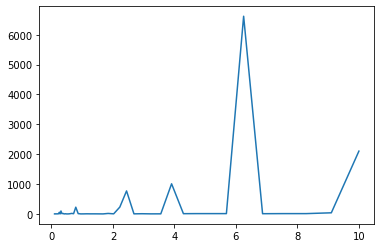

In [30]:
f0 = [x['f'] for x in profiles[0]]
plt.plot(np.logspace(-1, 1, num=50).flatten(), f0)

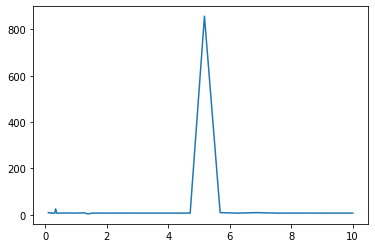

In [31]:
f1 = [x['f'] for x in profiles[1]]
plt.plot(np.logspace(-1, 1, num=50).flatten(), f1)

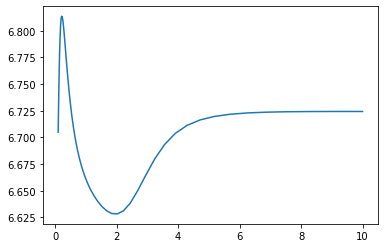

In [32]:
f2 = [x['f'] for x in profiles[2]]
plt.plot(np.logspace(-1, 1, num=50).flatten(), f2)